In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_id1 = '4903220'
float_id2 = '6901195'
float_id3 = '3901684'
data_source1="./dataset/PR_PF_"+float_id1+".csv"
data_source2="./dataset/PR_PF_"+float_id2+".csv"
data_source3="./dataset/PR_PF_"+float_id3+".csv"
df1= pd.read_csv(data_source1)
df2= pd.read_csv(data_source2)
df3= pd.read_csv(data_source3)
data=pd.concat([df1,df2,df3])
#data

In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

98.75297884339015


1.247021156609847

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 4, 3, 5])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'.csv') 
train2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'.csv') 
train3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'.csv') 
test1=pd.read_csv('./randomtest/PR_PF_'+float_id1+'.csv')
test2=pd.read_csv('./randomtest/PR_PF_'+float_id2+'.csv')
test3=pd.read_csv('./randomtest/PR_PF_'+float_id3+'.csv') 

train_set=pd.concat([train1,train2,train3])

test_set=pd.concat([test1,test2,test3])
# test_set=test2


len(train_set),len(test_set)

(307836, 131932)

In [11]:
comp_ratio(train_set)
comp_ratio(test_set)

98.75323224054367
98.75238759360883


98.75238759360883

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=test_set.iloc[:,0:y-2]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

131932 131932


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 1000
#n_initial = 1000
N_QUERIES = 200 #200

In [19]:
def random_split_df(df, x):
    n = len(df)

    indices = np.random.choice(n, x, replace=False)

    selected_df = df.iloc[indices]
    unselected_df = df.drop(indices)

    return selected_df, unselected_df


In [20]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)

X_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_initial.csv')
X_initial1,X_u1=random_split_df(X_initial1, 33)
X_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_initial.csv')
X_initial2,X_u2=random_split_df(X_initial2, 33)
X_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_initial.csv')
X_initial3,X_u3=random_split_df(X_initial3, 34)

X_initial=pd.concat([X_initial1,X_initial2,X_initial3])

X_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_re.csv')
X_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_re.csv')
X_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_re.csv')
X_re=pd.concat([X_u1,X_re1,X_u2,X_re2,X_re3,X_u3])
X_initial=X_initial.values
X_re=X_re.values

In [21]:
y_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_initial.csv')
y_initial1,y_u1=random_split_df(y_initial1, 33)
y_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_initial.csv')
y_initial2,y_u2=random_split_df(y_initial2, 33)
y_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_initial.csv')
y_initial3,y_u3=random_split_df(y_initial3, 34)
y_initial=pd.concat([y_initial1,y_initial2,y_initial3])
y_initial=y_initial.values.ravel()


y_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_re.csv')
y_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_re.csv')
y_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_re.csv')
y_re=pd.concat([y_u1,y_re1,y_u2,y_re2,y_u3,y_re3])
y_re=y_re.values.ravel()


# X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
# y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(307736, 6) (100, 6)
(307736,) (100,)


In [22]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [23]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [24]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [25]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 0.9994391049934815
precision: 0.989192599400438
recall: 0.9880187785395356
cm: [[130251     35]
 [    39   1607]]
f1: 0.9886049655145419
balanced acc: 0.9880187785395356
MCC: 0.9772106729461814
Kappa: 0.9772099314546816


0.9886049655145419

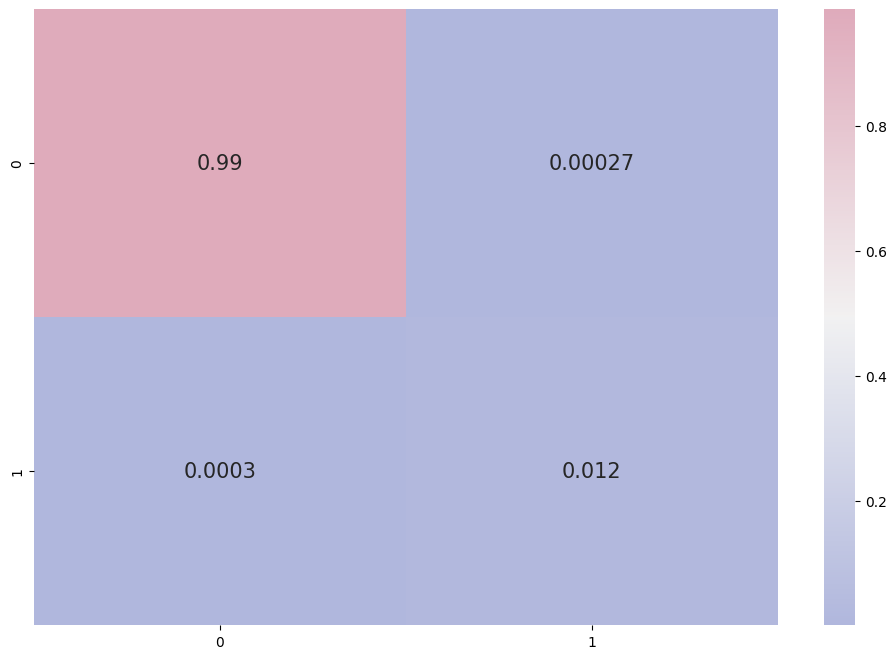

In [26]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9994694236424825
precision: 0.9963318561939438
recall: 0.982035549457331
cm: [[130275     11]
 [    59   1587]]
f1: 0.9890765556591268
balanced acc: 0.982035549457331
MCC: 0.9782629483193661
Kappa: 0.9781531708546166


0.9890765556591268

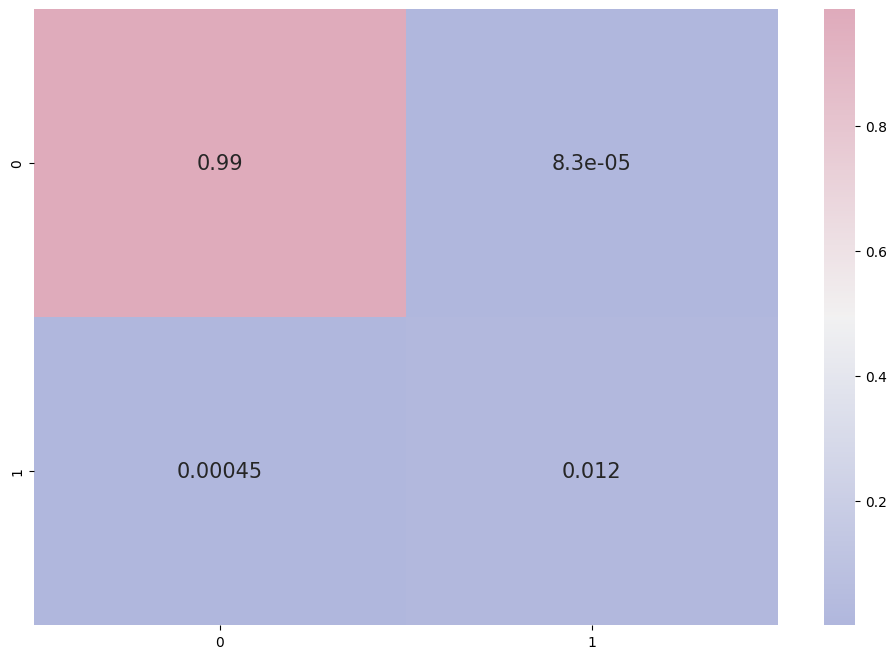

In [27]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9995224812782343
precision: 0.9933773036574575
recall: 0.98716120637038
cm: [[130265     21]
 [    42   1604]]
f1: 0.9902490393054489
balanced acc: 0.98716120637038
MCC: 0.9805188064397995
Kappa: 0.9804980887004636


0.9902490393054489

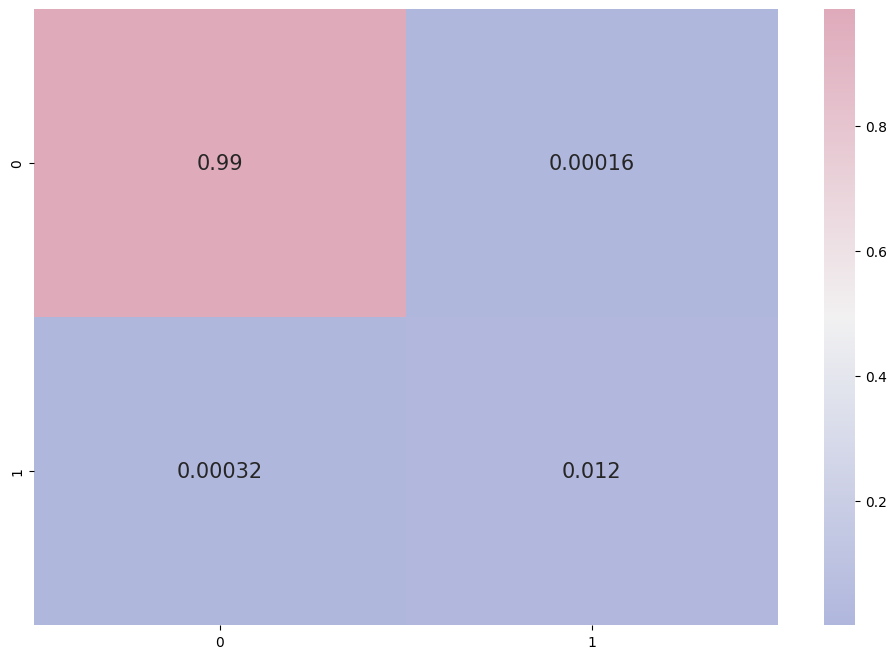

In [28]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.118972
0:	learn: 0.4146937	total: 98.7ms	remaining: 1m 38s
1:	learn: 0.2329740	total: 129ms	remaining: 1m 4s
2:	learn: 0.1398199	total: 155ms	remaining: 51.4s
3:	learn: 0.0833287	total: 183ms	remaining: 45.6s
4:	learn: 0.0517526	total: 216ms	remaining: 43s
5:	learn: 0.0321503	total: 261ms	remaining: 43.2s
6:	learn: 0.0267958	total: 287ms	remaining: 40.8s
7:	learn: 0.0228529	total: 314ms	remaining: 39s
8:	learn: 0.0184837	total: 338ms	remaining: 37.3s
9:	learn: 0.0158921	total: 368ms	remaining: 36.4s
10:	learn: 0.0140368	total: 394ms	remaining: 35.4s
11:	learn: 0.0114438	total: 421ms	remaining: 34.7s
12:	learn: 0.0085114	total: 446ms	remaining: 33.9s
13:	learn: 0.0078558	total: 472ms	remaining: 33.3s
14:	learn: 0.0073031	total: 498ms	remaining: 32.7s
15:	learn: 0.0068692	total: 525ms	remaining: 32.3s
16:	learn: 0.0054730	total: 550ms	remaining: 31.8s
17:	learn: 0.0051659	total: 574ms	remaining: 31.3s
18:	learn: 0.0050060	total: 608ms	remaining: 31.4s
19:	learn: 0.

162:	learn: 0.0013958	total: 4.42s	remaining: 22.7s
163:	learn: 0.0013935	total: 4.44s	remaining: 22.6s
164:	learn: 0.0013896	total: 4.47s	remaining: 22.6s
165:	learn: 0.0013824	total: 4.49s	remaining: 22.6s
166:	learn: 0.0013771	total: 4.52s	remaining: 22.6s
167:	learn: 0.0013682	total: 4.56s	remaining: 22.6s
168:	learn: 0.0013607	total: 4.59s	remaining: 22.6s
169:	learn: 0.0013585	total: 4.61s	remaining: 22.5s
170:	learn: 0.0013574	total: 4.64s	remaining: 22.5s
171:	learn: 0.0013495	total: 4.67s	remaining: 22.5s
172:	learn: 0.0013475	total: 4.69s	remaining: 22.4s
173:	learn: 0.0013462	total: 4.72s	remaining: 22.4s
174:	learn: 0.0013428	total: 4.74s	remaining: 22.4s
175:	learn: 0.0013406	total: 4.77s	remaining: 22.3s
176:	learn: 0.0013372	total: 4.79s	remaining: 22.3s
177:	learn: 0.0013341	total: 4.82s	remaining: 22.2s
178:	learn: 0.0013298	total: 4.84s	remaining: 22.2s
179:	learn: 0.0013278	total: 4.87s	remaining: 22.2s
180:	learn: 0.0013252	total: 4.89s	remaining: 22.1s
181:	learn: 

324:	learn: 0.0010193	total: 8.62s	remaining: 17.9s
325:	learn: 0.0010178	total: 8.65s	remaining: 17.9s
326:	learn: 0.0010170	total: 8.68s	remaining: 17.9s
327:	learn: 0.0010157	total: 8.7s	remaining: 17.8s
328:	learn: 0.0010125	total: 8.73s	remaining: 17.8s
329:	learn: 0.0010121	total: 8.75s	remaining: 17.8s
330:	learn: 0.0010114	total: 8.78s	remaining: 17.7s
331:	learn: 0.0010094	total: 8.8s	remaining: 17.7s
332:	learn: 0.0010070	total: 8.83s	remaining: 17.7s
333:	learn: 0.0010056	total: 8.86s	remaining: 17.7s
334:	learn: 0.0010044	total: 8.88s	remaining: 17.6s
335:	learn: 0.0010038	total: 8.91s	remaining: 17.6s
336:	learn: 0.0010027	total: 8.94s	remaining: 17.6s
337:	learn: 0.0010001	total: 8.96s	remaining: 17.6s
338:	learn: 0.0009993	total: 8.99s	remaining: 17.5s
339:	learn: 0.0009982	total: 9.01s	remaining: 17.5s
340:	learn: 0.0009976	total: 9.04s	remaining: 17.5s
341:	learn: 0.0009959	total: 9.07s	remaining: 17.4s
342:	learn: 0.0009937	total: 9.1s	remaining: 17.4s
343:	learn: 0.0

486:	learn: 0.0008383	total: 12.8s	remaining: 13.5s
487:	learn: 0.0008376	total: 12.8s	remaining: 13.5s
488:	learn: 0.0008376	total: 12.9s	remaining: 13.4s
489:	learn: 0.0008372	total: 12.9s	remaining: 13.4s
490:	learn: 0.0008356	total: 12.9s	remaining: 13.4s
491:	learn: 0.0008348	total: 12.9s	remaining: 13.4s
492:	learn: 0.0008344	total: 13s	remaining: 13.3s
493:	learn: 0.0008340	total: 13s	remaining: 13.3s
494:	learn: 0.0008322	total: 13s	remaining: 13.3s
495:	learn: 0.0008320	total: 13s	remaining: 13.2s
496:	learn: 0.0008313	total: 13.1s	remaining: 13.2s
497:	learn: 0.0008311	total: 13.1s	remaining: 13.2s
498:	learn: 0.0008292	total: 13.1s	remaining: 13.2s
499:	learn: 0.0008287	total: 13.1s	remaining: 13.1s
500:	learn: 0.0008282	total: 13.2s	remaining: 13.1s
501:	learn: 0.0008266	total: 13.2s	remaining: 13.1s
502:	learn: 0.0008260	total: 13.2s	remaining: 13.1s
503:	learn: 0.0008260	total: 13.2s	remaining: 13s
504:	learn: 0.0008247	total: 13.3s	remaining: 13s
505:	learn: 0.0008231	to

645:	learn: 0.0008098	total: 16.5s	remaining: 9.02s
646:	learn: 0.0008098	total: 16.5s	remaining: 9s
647:	learn: 0.0008098	total: 16.5s	remaining: 8.97s
648:	learn: 0.0008098	total: 16.6s	remaining: 8.95s
649:	learn: 0.0008098	total: 16.6s	remaining: 8.93s
650:	learn: 0.0008098	total: 16.6s	remaining: 8.9s
651:	learn: 0.0008098	total: 16.6s	remaining: 8.88s
652:	learn: 0.0008098	total: 16.7s	remaining: 8.86s
653:	learn: 0.0008098	total: 16.7s	remaining: 8.83s
654:	learn: 0.0008098	total: 16.7s	remaining: 8.81s
655:	learn: 0.0008098	total: 16.8s	remaining: 8.79s
656:	learn: 0.0008098	total: 16.8s	remaining: 8.76s
657:	learn: 0.0008098	total: 16.8s	remaining: 8.74s
658:	learn: 0.0008098	total: 16.8s	remaining: 8.71s
659:	learn: 0.0008098	total: 16.9s	remaining: 8.69s
660:	learn: 0.0008098	total: 16.9s	remaining: 8.66s
661:	learn: 0.0008098	total: 16.9s	remaining: 8.64s
662:	learn: 0.0008098	total: 16.9s	remaining: 8.61s
663:	learn: 0.0008098	total: 17s	remaining: 8.59s
664:	learn: 0.0008

808:	learn: 0.0008098	total: 21s	remaining: 4.97s
809:	learn: 0.0008098	total: 21.1s	remaining: 4.94s
810:	learn: 0.0008098	total: 21.1s	remaining: 4.92s
811:	learn: 0.0008098	total: 21.1s	remaining: 4.89s
812:	learn: 0.0008098	total: 21.2s	remaining: 4.87s
813:	learn: 0.0008098	total: 21.2s	remaining: 4.84s
814:	learn: 0.0008098	total: 21.2s	remaining: 4.81s
815:	learn: 0.0008098	total: 21.2s	remaining: 4.79s
816:	learn: 0.0008098	total: 21.3s	remaining: 4.76s
817:	learn: 0.0008098	total: 21.3s	remaining: 4.74s
818:	learn: 0.0008098	total: 21.3s	remaining: 4.71s
819:	learn: 0.0008098	total: 21.3s	remaining: 4.69s
820:	learn: 0.0008098	total: 21.4s	remaining: 4.66s
821:	learn: 0.0008098	total: 21.4s	remaining: 4.63s
822:	learn: 0.0008098	total: 21.4s	remaining: 4.61s
823:	learn: 0.0008098	total: 21.5s	remaining: 4.58s
824:	learn: 0.0008098	total: 21.5s	remaining: 4.56s
825:	learn: 0.0008098	total: 21.5s	remaining: 4.53s
826:	learn: 0.0008098	total: 21.5s	remaining: 4.51s
827:	learn: 0.

967:	learn: 0.0008098	total: 25.4s	remaining: 839ms
968:	learn: 0.0008098	total: 25.4s	remaining: 812ms
969:	learn: 0.0008098	total: 25.4s	remaining: 786ms
970:	learn: 0.0008098	total: 25.4s	remaining: 760ms
971:	learn: 0.0008098	total: 25.5s	remaining: 734ms
972:	learn: 0.0008098	total: 25.5s	remaining: 708ms
973:	learn: 0.0008098	total: 25.5s	remaining: 682ms
974:	learn: 0.0008098	total: 25.6s	remaining: 655ms
975:	learn: 0.0008098	total: 25.6s	remaining: 629ms
976:	learn: 0.0008098	total: 25.6s	remaining: 603ms
977:	learn: 0.0008098	total: 25.6s	remaining: 577ms
978:	learn: 0.0008098	total: 25.7s	remaining: 551ms
979:	learn: 0.0008098	total: 25.7s	remaining: 524ms
980:	learn: 0.0008098	total: 25.7s	remaining: 498ms
981:	learn: 0.0008098	total: 25.8s	remaining: 472ms
982:	learn: 0.0008098	total: 25.8s	remaining: 446ms
983:	learn: 0.0008098	total: 25.8s	remaining: 420ms
984:	learn: 0.0008098	total: 25.8s	remaining: 393ms
985:	learn: 0.0008098	total: 25.9s	remaining: 367ms
986:	learn: 

0.9916395098199435

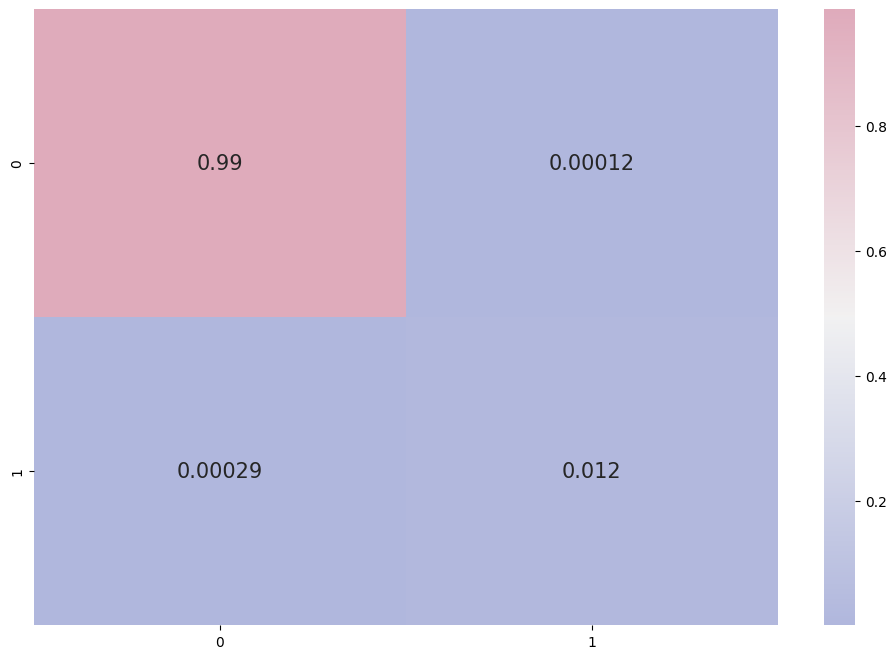

In [29]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [30]:
sampling=random_sampling

In [31]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
instance01.to_csv("./query/random_Knn_"+"mix_si"+".csv")

1 --------------------> 0.05888006808931334
1 --------------------> 0.07629513343799058
2 --------------------> 0.05888006808931334
2 --------------------> 0.07629513343799058
3 --------------------> 0.05888006808931334
3 --------------------> 0.07629513343799058
4 --------------------> 0.05888006808931334
4 --------------------> 0.07629513343799058
5 --------------------> 0.05890642354968556
5 --------------------> 0.07631909547738694
6 --------------------> 0.05890642354968556
6 --------------------> 0.07631909547738694
7 --------------------> 0.0395292276473973
7 --------------------> 0.05722460658082976
8 --------------------> 0.0395292276473973
8 --------------------> 0.05722460658082976
9 --------------------> 0.0395292276473973
9 --------------------> 0.05722460658082976
10 --------------------> 0.03953951172263104
10 --------------------> 0.057233704292527825
11 --------------------> 0.04412605165436301
11 --------------------> 0.06125941136208077
12 --------------------> 0.033

93 --------------------> 0.04543456783599986
93 --------------------> 0.05614973262032085
94 --------------------> 0.04543456783599986
94 --------------------> 0.05614973262032085
95 --------------------> 0.04543456783599986
95 --------------------> 0.05614973262032085
96 --------------------> 0.04543456783599986
96 --------------------> 0.05614973262032085
97 --------------------> 0.04543456783599986
97 --------------------> 0.05614973262032085
98 --------------------> 0.04543456783599986
98 --------------------> 0.05614973262032085
99 --------------------> 0.04543456783599986
99 --------------------> 0.05614973262032085
100 --------------------> 0.04543456783599986
100 --------------------> 0.05614973262032085
101 --------------------> 0.04543456783599986
101 --------------------> 0.05614973262032085
102 --------------------> 0.04543456783599986
102 --------------------> 0.05614973262032085
103 --------------------> 0.04543456783599986
103 --------------------> 0.05614973262032085
10

182 --------------------> 0.09309200510654025
182 --------------------> 0.10625317742755466
183 --------------------> 0.09309200510654025
183 --------------------> 0.10625317742755466
184 --------------------> 0.09309200510654025
184 --------------------> 0.10625317742755466
185 --------------------> 0.09309200510654025
185 --------------------> 0.10625317742755466
186 --------------------> 0.09309200510654025
186 --------------------> 0.10625317742755466
187 --------------------> 0.09375233408158679
187 --------------------> 0.10685071574642127
188 --------------------> 0.09375233408158679
188 --------------------> 0.10685071574642127
189 --------------------> 0.09375233408158679
189 --------------------> 0.10685071574642127
190 --------------------> 0.09387318413786194
190 --------------------> 0.10696008188331628
191 --------------------> 0.09387318413786194
191 --------------------> 0.10696008188331628
192 --------------------> 0.09387318413786194
192 --------------------> 0.106960

In [32]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
instance02.to_csv("./query/random_Lg_"+"mix_si"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 ------

In [33]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
instance03.to_csv("./query/random_XB_"+"mix_si"+".csv")

1 --------------------> 0.12054499047361
1 --------------------> 0.1294964028776978
2 --------------------> 0.05000572762378641
2 --------------------> 0.059259259259259255
3 --------------------> 0.05852850494340556
3 --------------------> 0.07132983135194912
4 --------------------> 0.026221423312621228
4 --------------------> 0.04010416666666666
5 --------------------> 0.04670024890246083
5 --------------------> 0.057539682539682536
6 --------------------> 0.027688784051898452
6 --------------------> 0.04507914659325533
7 --------------------> 0.011518241459221534
7 --------------------> 0.02958387516254876
8 --------------------> 0.061022723265241385
8 --------------------> 0.07607041947402737
9 --------------------> 0.05445434259017112
9 --------------------> 0.06915502633386765
10 --------------------> 0.0540569279239792
10 --------------------> 0.06880838459785828
11 --------------------> 0.08389511643771175
11 --------------------> 0.0912828947368421
12 --------------------> 0.1

93 --------------------> 0.09711416442947107
93 --------------------> 0.10010537407797682
94 --------------------> 0.09766799864319975
94 --------------------> 0.10021551724137931
95 --------------------> 0.10054283403798014
95 --------------------> 0.10278840896664844
96 --------------------> 0.08355036241292269
96 --------------------> 0.08635394456289978
97 --------------------> 0.09067227099618891
97 --------------------> 0.09351753453772582
98 --------------------> 0.1040893877426422
98 --------------------> 0.10743801652892561
99 --------------------> 0.11019885743495694
99 --------------------> 0.11261505143475907
100 --------------------> 0.0869051380768362
100 --------------------> 0.09222170470423847
101 --------------------> 0.1310801072623543
101 --------------------> 0.13602251407129456
102 --------------------> 0.08792792030325602
102 --------------------> 0.0924574209245742
103 --------------------> 0.09953105473516632
103 --------------------> 0.10497237569060773
104 --

183 --------------------> 0.1271229608354989
183 --------------------> 0.13061224489795917
184 --------------------> 0.13109273449715897
184 --------------------> 0.13368983957219252
185 --------------------> 0.12941478825766584
185 --------------------> 0.1318206374932469
186 --------------------> 0.13061332135188441
186 --------------------> 0.13340391741662255
187 --------------------> 0.14468606504362036
187 --------------------> 0.14740190880169673
188 --------------------> 0.11427041436787533
188 --------------------> 0.11702127659574467
189 --------------------> 0.11952042968349552
189 --------------------> 0.1221210498125335
190 --------------------> 0.12964328041402162
190 --------------------> 0.13188010899182562
191 --------------------> 0.12833129701716506
191 --------------------> 0.1307401404646137
192 --------------------> 0.13894600684055258
192 --------------------> 0.1414790996784566
193 --------------------> 0.14423187583026742
193 --------------------> 0.14675950723

In [34]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
instance04.to_csv("./query/random_CB_"+"mix_si"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6881754	total: 1.72ms	remaining: 1.72s
1:	learn: 0.6833669	total: 3.04ms	remaining: 1.52s
2:	learn: 0.6787679	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6740769	total: 5.51ms	remaining: 1.37s
4:	learn: 0.6693594	total: 6.55ms	remaining: 1.3s
5:	learn: 0.6652301	total: 7.74ms	remaining: 1.28s
6:	learn: 0.6595345	total: 8.8ms	remaining: 1.25s
7:	learn: 0.6551303	total: 9.86ms	remaining: 1.22s
8:	learn: 0.6512817	total: 11.1ms	remaining: 1.22s
9:	learn: 0.6468379	total: 12.2ms	remaining: 1.21s
10:	learn: 0.6419992	total: 13.3ms	remaining: 1.19s
11:	learn: 0.6378145	total: 14.5ms	remaining: 1.2s
12:	learn: 0.6344044	total: 15.7ms	remaining: 1.19s
13:	learn: 0.6309750	total: 16.8ms	remaining: 1.18s
14:	learn: 0.6268184	total: 17.8ms	remaining: 1.17s
15:	learn: 0.6230871	total: 18.9ms	remaining: 1.16s
16:	learn: 0.6187570	total: 19.6ms	remaining: 1.13s
17:	learn: 0.6146075	total: 20.5ms	remaining: 1.12s
18:	learn: 0.6099646	total: 21.2ms	remaining: 1

158:	learn: 0.2817915	total: 181ms	remaining: 960ms
159:	learn: 0.2807349	total: 183ms	remaining: 960ms
160:	learn: 0.2797450	total: 184ms	remaining: 960ms
161:	learn: 0.2781000	total: 185ms	remaining: 958ms
162:	learn: 0.2771222	total: 187ms	remaining: 958ms
163:	learn: 0.2761051	total: 188ms	remaining: 958ms
164:	learn: 0.2749746	total: 189ms	remaining: 955ms
165:	learn: 0.2739881	total: 190ms	remaining: 954ms
166:	learn: 0.2726615	total: 191ms	remaining: 953ms
167:	learn: 0.2712663	total: 192ms	remaining: 952ms
168:	learn: 0.2702019	total: 193ms	remaining: 951ms
169:	learn: 0.2691382	total: 195ms	remaining: 951ms
170:	learn: 0.2677657	total: 196ms	remaining: 949ms
171:	learn: 0.2670080	total: 197ms	remaining: 949ms
172:	learn: 0.2659041	total: 198ms	remaining: 949ms
173:	learn: 0.2648624	total: 200ms	remaining: 947ms
174:	learn: 0.2639172	total: 201ms	remaining: 947ms
175:	learn: 0.2628377	total: 202ms	remaining: 946ms
176:	learn: 0.2617729	total: 203ms	remaining: 945ms
177:	learn: 

327:	learn: 0.1537780	total: 346ms	remaining: 708ms
328:	learn: 0.1533429	total: 347ms	remaining: 707ms
329:	learn: 0.1529233	total: 348ms	remaining: 706ms
330:	learn: 0.1523943	total: 349ms	remaining: 705ms
331:	learn: 0.1520179	total: 349ms	remaining: 703ms
332:	learn: 0.1517542	total: 350ms	remaining: 701ms
333:	learn: 0.1514403	total: 351ms	remaining: 700ms
334:	learn: 0.1509359	total: 352ms	remaining: 699ms
335:	learn: 0.1504557	total: 353ms	remaining: 697ms
336:	learn: 0.1500505	total: 354ms	remaining: 696ms
337:	learn: 0.1496709	total: 354ms	remaining: 694ms
338:	learn: 0.1492883	total: 355ms	remaining: 693ms
339:	learn: 0.1487938	total: 356ms	remaining: 691ms
340:	learn: 0.1483093	total: 357ms	remaining: 690ms
341:	learn: 0.1480697	total: 358ms	remaining: 688ms
342:	learn: 0.1477091	total: 359ms	remaining: 687ms
343:	learn: 0.1473302	total: 359ms	remaining: 685ms
344:	learn: 0.1468768	total: 360ms	remaining: 684ms
345:	learn: 0.1465174	total: 361ms	remaining: 683ms
346:	learn: 

490:	learn: 0.0989209	total: 487ms	remaining: 505ms
491:	learn: 0.0987452	total: 488ms	remaining: 504ms
492:	learn: 0.0985236	total: 489ms	remaining: 503ms
493:	learn: 0.0982451	total: 490ms	remaining: 502ms
494:	learn: 0.0979941	total: 491ms	remaining: 501ms
495:	learn: 0.0978140	total: 492ms	remaining: 500ms
496:	learn: 0.0976367	total: 493ms	remaining: 499ms
497:	learn: 0.0974356	total: 494ms	remaining: 498ms
498:	learn: 0.0972873	total: 494ms	remaining: 496ms
499:	learn: 0.0970582	total: 495ms	remaining: 495ms
500:	learn: 0.0967880	total: 496ms	remaining: 494ms
501:	learn: 0.0966350	total: 497ms	remaining: 493ms
502:	learn: 0.0964375	total: 498ms	remaining: 492ms
503:	learn: 0.0962997	total: 499ms	remaining: 491ms
504:	learn: 0.0960420	total: 500ms	remaining: 490ms
505:	learn: 0.0957578	total: 501ms	remaining: 489ms
506:	learn: 0.0956255	total: 502ms	remaining: 488ms
507:	learn: 0.0954152	total: 503ms	remaining: 487ms
508:	learn: 0.0951183	total: 504ms	remaining: 486ms
509:	learn: 

694:	learn: 0.0648228	total: 669ms	remaining: 293ms
695:	learn: 0.0647413	total: 670ms	remaining: 293ms
696:	learn: 0.0646585	total: 671ms	remaining: 292ms
697:	learn: 0.0645819	total: 672ms	remaining: 291ms
698:	learn: 0.0644400	total: 673ms	remaining: 290ms
699:	learn: 0.0643151	total: 674ms	remaining: 289ms
700:	learn: 0.0642168	total: 675ms	remaining: 288ms
701:	learn: 0.0640785	total: 675ms	remaining: 287ms
702:	learn: 0.0640350	total: 676ms	remaining: 286ms
703:	learn: 0.0638820	total: 677ms	remaining: 285ms
704:	learn: 0.0637501	total: 678ms	remaining: 284ms
705:	learn: 0.0636548	total: 679ms	remaining: 283ms
706:	learn: 0.0635665	total: 680ms	remaining: 282ms
707:	learn: 0.0634028	total: 681ms	remaining: 281ms
708:	learn: 0.0632768	total: 682ms	remaining: 280ms
709:	learn: 0.0631249	total: 682ms	remaining: 279ms
710:	learn: 0.0630184	total: 684ms	remaining: 278ms
711:	learn: 0.0628881	total: 685ms	remaining: 277ms
712:	learn: 0.0627527	total: 686ms	remaining: 276ms
713:	learn: 

907:	learn: 0.0454991	total: 852ms	remaining: 86.3ms
908:	learn: 0.0454056	total: 853ms	remaining: 85.4ms
909:	learn: 0.0453481	total: 854ms	remaining: 84.4ms
910:	learn: 0.0452987	total: 855ms	remaining: 83.5ms
911:	learn: 0.0452040	total: 856ms	remaining: 82.6ms
912:	learn: 0.0451394	total: 857ms	remaining: 81.6ms
913:	learn: 0.0450768	total: 858ms	remaining: 80.7ms
914:	learn: 0.0449935	total: 858ms	remaining: 79.7ms
915:	learn: 0.0449089	total: 859ms	remaining: 78.8ms
916:	learn: 0.0448142	total: 860ms	remaining: 77.9ms
917:	learn: 0.0447520	total: 861ms	remaining: 76.9ms
918:	learn: 0.0446858	total: 862ms	remaining: 76ms
919:	learn: 0.0446115	total: 863ms	remaining: 75ms
920:	learn: 0.0445497	total: 864ms	remaining: 74.1ms
921:	learn: 0.0444793	total: 865ms	remaining: 73.1ms
922:	learn: 0.0444224	total: 866ms	remaining: 72.2ms
923:	learn: 0.0443637	total: 868ms	remaining: 71.4ms
924:	learn: 0.0443001	total: 870ms	remaining: 70.5ms
925:	learn: 0.0442424	total: 871ms	remaining: 69.6

216:	learn: 0.2248807	total: 181ms	remaining: 654ms
217:	learn: 0.2240223	total: 183ms	remaining: 656ms
218:	learn: 0.2233808	total: 184ms	remaining: 655ms
219:	learn: 0.2227701	total: 185ms	remaining: 655ms
220:	learn: 0.2217594	total: 186ms	remaining: 654ms
221:	learn: 0.2211066	total: 186ms	remaining: 653ms
222:	learn: 0.2203055	total: 187ms	remaining: 653ms
223:	learn: 0.2196696	total: 188ms	remaining: 653ms
224:	learn: 0.2188966	total: 189ms	remaining: 652ms
225:	learn: 0.2179991	total: 190ms	remaining: 652ms
226:	learn: 0.2171311	total: 191ms	remaining: 650ms
227:	learn: 0.2162361	total: 192ms	remaining: 650ms
228:	learn: 0.2155887	total: 193ms	remaining: 649ms
229:	learn: 0.2148548	total: 194ms	remaining: 648ms
230:	learn: 0.2140454	total: 195ms	remaining: 648ms
231:	learn: 0.2132563	total: 196ms	remaining: 647ms
232:	learn: 0.2125733	total: 196ms	remaining: 647ms
233:	learn: 0.2118670	total: 197ms	remaining: 646ms
234:	learn: 0.2111817	total: 198ms	remaining: 646ms
235:	learn: 

431:	learn: 0.1149732	total: 368ms	remaining: 484ms
432:	learn: 0.1146833	total: 369ms	remaining: 484ms
433:	learn: 0.1143529	total: 370ms	remaining: 483ms
434:	learn: 0.1139972	total: 371ms	remaining: 482ms
435:	learn: 0.1137777	total: 372ms	remaining: 481ms
436:	learn: 0.1134235	total: 373ms	remaining: 480ms
437:	learn: 0.1131413	total: 374ms	remaining: 479ms
438:	learn: 0.1128444	total: 374ms	remaining: 479ms
439:	learn: 0.1125539	total: 375ms	remaining: 478ms
440:	learn: 0.1123182	total: 376ms	remaining: 477ms
441:	learn: 0.1120463	total: 377ms	remaining: 476ms
442:	learn: 0.1117831	total: 378ms	remaining: 475ms
443:	learn: 0.1115353	total: 379ms	remaining: 475ms
444:	learn: 0.1112514	total: 380ms	remaining: 474ms
445:	learn: 0.1109916	total: 381ms	remaining: 473ms
446:	learn: 0.1106942	total: 382ms	remaining: 472ms
447:	learn: 0.1104164	total: 383ms	remaining: 471ms
448:	learn: 0.1101427	total: 383ms	remaining: 471ms
449:	learn: 0.1098943	total: 384ms	remaining: 470ms
450:	learn: 

638:	learn: 0.0718510	total: 554ms	remaining: 313ms
639:	learn: 0.0717126	total: 555ms	remaining: 312ms
640:	learn: 0.0716247	total: 556ms	remaining: 311ms
641:	learn: 0.0714847	total: 557ms	remaining: 311ms
642:	learn: 0.0713862	total: 558ms	remaining: 310ms
643:	learn: 0.0712392	total: 559ms	remaining: 309ms
644:	learn: 0.0711504	total: 559ms	remaining: 308ms
645:	learn: 0.0709264	total: 560ms	remaining: 307ms
646:	learn: 0.0707619	total: 561ms	remaining: 306ms
647:	learn: 0.0706257	total: 562ms	remaining: 305ms
648:	learn: 0.0705250	total: 563ms	remaining: 305ms
649:	learn: 0.0703590	total: 564ms	remaining: 304ms
650:	learn: 0.0702179	total: 565ms	remaining: 303ms
651:	learn: 0.0700887	total: 566ms	remaining: 302ms
652:	learn: 0.0698874	total: 567ms	remaining: 301ms
653:	learn: 0.0698103	total: 568ms	remaining: 300ms
654:	learn: 0.0696934	total: 569ms	remaining: 299ms
655:	learn: 0.0696013	total: 570ms	remaining: 299ms
656:	learn: 0.0695077	total: 571ms	remaining: 298ms
657:	learn: 

851:	learn: 0.0488161	total: 737ms	remaining: 128ms
852:	learn: 0.0487227	total: 738ms	remaining: 127ms
853:	learn: 0.0486857	total: 739ms	remaining: 126ms
854:	learn: 0.0485582	total: 740ms	remaining: 125ms
855:	learn: 0.0484448	total: 741ms	remaining: 125ms
856:	learn: 0.0483617	total: 742ms	remaining: 124ms
857:	learn: 0.0483121	total: 743ms	remaining: 123ms
858:	learn: 0.0482500	total: 744ms	remaining: 122ms
859:	learn: 0.0481647	total: 745ms	remaining: 121ms
860:	learn: 0.0481130	total: 746ms	remaining: 120ms
861:	learn: 0.0480518	total: 746ms	remaining: 120ms
862:	learn: 0.0479577	total: 748ms	remaining: 119ms
863:	learn: 0.0478978	total: 749ms	remaining: 118ms
864:	learn: 0.0478312	total: 750ms	remaining: 117ms
865:	learn: 0.0477909	total: 751ms	remaining: 116ms
866:	learn: 0.0477527	total: 752ms	remaining: 115ms
867:	learn: 0.0476886	total: 753ms	remaining: 114ms
868:	learn: 0.0475978	total: 754ms	remaining: 114ms
869:	learn: 0.0475548	total: 754ms	remaining: 113ms
870:	learn: 

150:	learn: 0.2900301	total: 129ms	remaining: 727ms
151:	learn: 0.2883301	total: 131ms	remaining: 730ms
152:	learn: 0.2871575	total: 132ms	remaining: 730ms
153:	learn: 0.2859857	total: 133ms	remaining: 729ms
154:	learn: 0.2845886	total: 134ms	remaining: 728ms
155:	learn: 0.2831616	total: 134ms	remaining: 727ms
156:	learn: 0.2820161	total: 135ms	remaining: 726ms
157:	learn: 0.2806311	total: 136ms	remaining: 726ms
158:	learn: 0.2792695	total: 137ms	remaining: 725ms
159:	learn: 0.2782010	total: 138ms	remaining: 724ms
160:	learn: 0.2772653	total: 139ms	remaining: 723ms
161:	learn: 0.2756220	total: 139ms	remaining: 721ms
162:	learn: 0.2746459	total: 140ms	remaining: 721ms
163:	learn: 0.2736104	total: 141ms	remaining: 719ms
164:	learn: 0.2724981	total: 142ms	remaining: 717ms
165:	learn: 0.2715041	total: 143ms	remaining: 717ms
166:	learn: 0.2702265	total: 144ms	remaining: 717ms
167:	learn: 0.2688742	total: 145ms	remaining: 716ms
168:	learn: 0.2677859	total: 145ms	remaining: 715ms
169:	learn: 

363:	learn: 0.1401087	total: 314ms	remaining: 548ms
364:	learn: 0.1397101	total: 315ms	remaining: 548ms
365:	learn: 0.1390491	total: 316ms	remaining: 547ms
366:	learn: 0.1387657	total: 317ms	remaining: 546ms
367:	learn: 0.1383872	total: 318ms	remaining: 545ms
368:	learn: 0.1381193	total: 319ms	remaining: 545ms
369:	learn: 0.1377733	total: 319ms	remaining: 544ms
370:	learn: 0.1373349	total: 320ms	remaining: 543ms
371:	learn: 0.1369258	total: 321ms	remaining: 542ms
372:	learn: 0.1366173	total: 322ms	remaining: 541ms
373:	learn: 0.1361311	total: 323ms	remaining: 540ms
374:	learn: 0.1357153	total: 324ms	remaining: 539ms
375:	learn: 0.1352933	total: 325ms	remaining: 539ms
376:	learn: 0.1350359	total: 325ms	remaining: 538ms
377:	learn: 0.1346913	total: 326ms	remaining: 537ms
378:	learn: 0.1342432	total: 327ms	remaining: 536ms
379:	learn: 0.1337617	total: 328ms	remaining: 535ms
380:	learn: 0.1333978	total: 329ms	remaining: 535ms
381:	learn: 0.1330241	total: 330ms	remaining: 534ms
382:	learn: 

581:	learn: 0.0821965	total: 497ms	remaining: 357ms
582:	learn: 0.0820683	total: 498ms	remaining: 356ms
583:	learn: 0.0819209	total: 499ms	remaining: 355ms
584:	learn: 0.0817426	total: 500ms	remaining: 355ms
585:	learn: 0.0815567	total: 501ms	remaining: 354ms
586:	learn: 0.0813860	total: 502ms	remaining: 353ms
587:	learn: 0.0812056	total: 503ms	remaining: 352ms
588:	learn: 0.0810158	total: 504ms	remaining: 351ms
589:	learn: 0.0808073	total: 505ms	remaining: 351ms
590:	learn: 0.0807187	total: 505ms	remaining: 350ms
591:	learn: 0.0805941	total: 506ms	remaining: 349ms
592:	learn: 0.0804763	total: 507ms	remaining: 348ms
593:	learn: 0.0803075	total: 508ms	remaining: 347ms
594:	learn: 0.0801633	total: 509ms	remaining: 347ms
595:	learn: 0.0799696	total: 510ms	remaining: 346ms
596:	learn: 0.0797193	total: 511ms	remaining: 345ms
597:	learn: 0.0795248	total: 512ms	remaining: 344ms
598:	learn: 0.0794011	total: 513ms	remaining: 343ms
599:	learn: 0.0791545	total: 514ms	remaining: 343ms
600:	learn: 

794:	learn: 0.0545207	total: 680ms	remaining: 175ms
795:	learn: 0.0544474	total: 682ms	remaining: 175ms
796:	learn: 0.0543480	total: 683ms	remaining: 174ms
797:	learn: 0.0542714	total: 684ms	remaining: 173ms
798:	learn: 0.0541500	total: 685ms	remaining: 172ms
799:	learn: 0.0540418	total: 686ms	remaining: 172ms
800:	learn: 0.0539678	total: 687ms	remaining: 171ms
801:	learn: 0.0538572	total: 689ms	remaining: 170ms
802:	learn: 0.0537581	total: 690ms	remaining: 169ms
803:	learn: 0.0536968	total: 691ms	remaining: 169ms
804:	learn: 0.0535936	total: 692ms	remaining: 168ms
805:	learn: 0.0535025	total: 693ms	remaining: 167ms
806:	learn: 0.0534016	total: 694ms	remaining: 166ms
807:	learn: 0.0533133	total: 695ms	remaining: 165ms
808:	learn: 0.0532579	total: 696ms	remaining: 164ms
809:	learn: 0.0530901	total: 697ms	remaining: 163ms
810:	learn: 0.0529591	total: 698ms	remaining: 163ms
811:	learn: 0.0528718	total: 698ms	remaining: 162ms
812:	learn: 0.0528264	total: 699ms	remaining: 161ms
813:	learn: 

2 --------------------> 0.17421071927970544
2 --------------------> 0.17665952890792289
Learning rate set to 0.003903
0:	learn: 0.6881564	total: 840us	remaining: 840ms
1:	learn: 0.6833216	total: 1.57ms	remaining: 786ms
2:	learn: 0.6785867	total: 2.43ms	remaining: 808ms
3:	learn: 0.6740637	total: 3.28ms	remaining: 817ms
4:	learn: 0.6693418	total: 4.13ms	remaining: 823ms
5:	learn: 0.6650364	total: 4.98ms	remaining: 824ms
6:	learn: 0.6593483	total: 5.91ms	remaining: 838ms
7:	learn: 0.6548080	total: 6.73ms	remaining: 835ms
8:	learn: 0.6508453	total: 7.56ms	remaining: 832ms
9:	learn: 0.6463164	total: 8.33ms	remaining: 825ms
10:	learn: 0.6422139	total: 9.34ms	remaining: 839ms
11:	learn: 0.6377762	total: 10.2ms	remaining: 840ms
12:	learn: 0.6341179	total: 11ms	remaining: 837ms
13:	learn: 0.6305063	total: 11.9ms	remaining: 837ms
14:	learn: 0.6261916	total: 12.7ms	remaining: 832ms
15:	learn: 0.6223277	total: 13.5ms	remaining: 827ms
16:	learn: 0.6177190	total: 14.1ms	remaining: 817ms
17:	learn: 

366:	learn: 0.1377170	total: 313ms	remaining: 539ms
367:	learn: 0.1373141	total: 314ms	remaining: 539ms
368:	learn: 0.1369433	total: 315ms	remaining: 538ms
369:	learn: 0.1366622	total: 316ms	remaining: 538ms
370:	learn: 0.1362929	total: 317ms	remaining: 537ms
371:	learn: 0.1358856	total: 318ms	remaining: 537ms
372:	learn: 0.1355793	total: 319ms	remaining: 536ms
373:	learn: 0.1352130	total: 320ms	remaining: 535ms
374:	learn: 0.1350148	total: 321ms	remaining: 534ms
375:	learn: 0.1346198	total: 322ms	remaining: 534ms
376:	learn: 0.1342201	total: 323ms	remaining: 533ms
377:	learn: 0.1337819	total: 323ms	remaining: 532ms
378:	learn: 0.1334117	total: 324ms	remaining: 531ms
379:	learn: 0.1331132	total: 325ms	remaining: 531ms
380:	learn: 0.1328047	total: 326ms	remaining: 530ms
381:	learn: 0.1324664	total: 327ms	remaining: 529ms
382:	learn: 0.1321106	total: 328ms	remaining: 528ms
383:	learn: 0.1318168	total: 329ms	remaining: 528ms
384:	learn: 0.1314402	total: 330ms	remaining: 527ms
385:	learn: 

568:	learn: 0.0827499	total: 496ms	remaining: 376ms
569:	learn: 0.0825814	total: 497ms	remaining: 375ms
570:	learn: 0.0824742	total: 498ms	remaining: 374ms
571:	learn: 0.0823207	total: 499ms	remaining: 373ms
572:	learn: 0.0821820	total: 499ms	remaining: 372ms
573:	learn: 0.0819561	total: 500ms	remaining: 371ms
574:	learn: 0.0818068	total: 501ms	remaining: 370ms
575:	learn: 0.0817356	total: 502ms	remaining: 369ms
576:	learn: 0.0815685	total: 503ms	remaining: 369ms
577:	learn: 0.0813315	total: 504ms	remaining: 368ms
578:	learn: 0.0811144	total: 504ms	remaining: 367ms
579:	learn: 0.0809255	total: 505ms	remaining: 366ms
580:	learn: 0.0807702	total: 506ms	remaining: 365ms
581:	learn: 0.0805875	total: 507ms	remaining: 364ms
582:	learn: 0.0803977	total: 508ms	remaining: 363ms
583:	learn: 0.0801929	total: 509ms	remaining: 363ms
584:	learn: 0.0800665	total: 510ms	remaining: 362ms
585:	learn: 0.0799290	total: 511ms	remaining: 361ms
586:	learn: 0.0797773	total: 512ms	remaining: 360ms
587:	learn: 

776:	learn: 0.0555022	total: 680ms	remaining: 195ms
777:	learn: 0.0554323	total: 681ms	remaining: 194ms
778:	learn: 0.0553045	total: 682ms	remaining: 193ms
779:	learn: 0.0552431	total: 683ms	remaining: 193ms
780:	learn: 0.0551403	total: 684ms	remaining: 192ms
781:	learn: 0.0550437	total: 684ms	remaining: 191ms
782:	learn: 0.0549711	total: 685ms	remaining: 190ms
783:	learn: 0.0548996	total: 686ms	remaining: 189ms
784:	learn: 0.0548402	total: 687ms	remaining: 188ms
785:	learn: 0.0547637	total: 688ms	remaining: 187ms
786:	learn: 0.0546708	total: 689ms	remaining: 186ms
787:	learn: 0.0545739	total: 690ms	remaining: 186ms
788:	learn: 0.0544522	total: 690ms	remaining: 185ms
789:	learn: 0.0543481	total: 691ms	remaining: 184ms
790:	learn: 0.0542760	total: 692ms	remaining: 183ms
791:	learn: 0.0542024	total: 693ms	remaining: 182ms
792:	learn: 0.0541226	total: 694ms	remaining: 181ms
793:	learn: 0.0540209	total: 695ms	remaining: 180ms
794:	learn: 0.0538990	total: 696ms	remaining: 179ms
795:	learn: 

979:	learn: 0.0403121	total: 863ms	remaining: 17.6ms
980:	learn: 0.0402325	total: 865ms	remaining: 16.7ms
981:	learn: 0.0401483	total: 865ms	remaining: 15.9ms
982:	learn: 0.0400836	total: 866ms	remaining: 15ms
983:	learn: 0.0400382	total: 867ms	remaining: 14.1ms
984:	learn: 0.0399842	total: 868ms	remaining: 13.2ms
985:	learn: 0.0399126	total: 869ms	remaining: 12.3ms
986:	learn: 0.0398121	total: 870ms	remaining: 11.5ms
987:	learn: 0.0397383	total: 871ms	remaining: 10.6ms
988:	learn: 0.0396815	total: 872ms	remaining: 9.7ms
989:	learn: 0.0396239	total: 873ms	remaining: 8.81ms
990:	learn: 0.0395088	total: 873ms	remaining: 7.93ms
991:	learn: 0.0394523	total: 874ms	remaining: 7.05ms
992:	learn: 0.0393871	total: 875ms	remaining: 6.17ms
993:	learn: 0.0393418	total: 876ms	remaining: 5.29ms
994:	learn: 0.0393113	total: 877ms	remaining: 4.41ms
995:	learn: 0.0392373	total: 878ms	remaining: 3.52ms
996:	learn: 0.0391663	total: 879ms	remaining: 2.64ms
997:	learn: 0.0391141	total: 880ms	remaining: 1.7

213:	learn: 0.2251498	total: 182ms	remaining: 669ms
214:	learn: 0.2241066	total: 183ms	remaining: 669ms
215:	learn: 0.2232068	total: 184ms	remaining: 669ms
216:	learn: 0.2221951	total: 185ms	remaining: 668ms
217:	learn: 0.2212279	total: 186ms	remaining: 667ms
218:	learn: 0.2202586	total: 187ms	remaining: 667ms
219:	learn: 0.2195600	total: 188ms	remaining: 666ms
220:	learn: 0.2187779	total: 189ms	remaining: 665ms
221:	learn: 0.2179933	total: 190ms	remaining: 665ms
222:	learn: 0.2170674	total: 191ms	remaining: 664ms
223:	learn: 0.2161558	total: 191ms	remaining: 663ms
224:	learn: 0.2151982	total: 192ms	remaining: 663ms
225:	learn: 0.2144381	total: 193ms	remaining: 662ms
226:	learn: 0.2138286	total: 195ms	remaining: 662ms
227:	learn: 0.2128919	total: 195ms	remaining: 662ms
228:	learn: 0.2119630	total: 196ms	remaining: 661ms
229:	learn: 0.2111560	total: 198ms	remaining: 661ms
230:	learn: 0.2102911	total: 198ms	remaining: 661ms
231:	learn: 0.2095814	total: 199ms	remaining: 660ms
232:	learn: 

428:	learn: 0.1146770	total: 367ms	remaining: 488ms
429:	learn: 0.1144306	total: 368ms	remaining: 487ms
430:	learn: 0.1140842	total: 368ms	remaining: 486ms
431:	learn: 0.1137944	total: 369ms	remaining: 486ms
432:	learn: 0.1135305	total: 370ms	remaining: 485ms
433:	learn: 0.1131600	total: 371ms	remaining: 484ms
434:	learn: 0.1129434	total: 372ms	remaining: 483ms
435:	learn: 0.1126287	total: 373ms	remaining: 482ms
436:	learn: 0.1123160	total: 374ms	remaining: 481ms
437:	learn: 0.1120577	total: 375ms	remaining: 481ms
438:	learn: 0.1117529	total: 375ms	remaining: 480ms
439:	learn: 0.1114013	total: 376ms	remaining: 479ms
440:	learn: 0.1111842	total: 377ms	remaining: 478ms
441:	learn: 0.1108772	total: 378ms	remaining: 478ms
442:	learn: 0.1105945	total: 379ms	remaining: 477ms
443:	learn: 0.1104489	total: 380ms	remaining: 476ms
444:	learn: 0.1101326	total: 381ms	remaining: 475ms
445:	learn: 0.1097865	total: 382ms	remaining: 474ms
446:	learn: 0.1094745	total: 383ms	remaining: 473ms
447:	learn: 

645:	learn: 0.0715322	total: 550ms	remaining: 302ms
646:	learn: 0.0713963	total: 551ms	remaining: 301ms
647:	learn: 0.0712971	total: 552ms	remaining: 300ms
648:	learn: 0.0710739	total: 553ms	remaining: 299ms
649:	learn: 0.0708972	total: 554ms	remaining: 298ms
650:	learn: 0.0706217	total: 555ms	remaining: 297ms
651:	learn: 0.0705300	total: 556ms	remaining: 297ms
652:	learn: 0.0704215	total: 557ms	remaining: 296ms
653:	learn: 0.0702617	total: 558ms	remaining: 295ms
654:	learn: 0.0700977	total: 559ms	remaining: 294ms
655:	learn: 0.0699813	total: 560ms	remaining: 293ms
656:	learn: 0.0698318	total: 560ms	remaining: 293ms
657:	learn: 0.0696548	total: 561ms	remaining: 292ms
658:	learn: 0.0695343	total: 562ms	remaining: 291ms
659:	learn: 0.0693674	total: 563ms	remaining: 290ms
660:	learn: 0.0692075	total: 564ms	remaining: 289ms
661:	learn: 0.0689705	total: 565ms	remaining: 289ms
662:	learn: 0.0688489	total: 566ms	remaining: 288ms
663:	learn: 0.0686847	total: 567ms	remaining: 287ms
664:	learn: 

858:	learn: 0.0488354	total: 732ms	remaining: 120ms
859:	learn: 0.0487471	total: 733ms	remaining: 119ms
860:	learn: 0.0486937	total: 734ms	remaining: 118ms
861:	learn: 0.0485909	total: 735ms	remaining: 118ms
862:	learn: 0.0485224	total: 736ms	remaining: 117ms
863:	learn: 0.0484739	total: 737ms	remaining: 116ms
864:	learn: 0.0484025	total: 737ms	remaining: 115ms
865:	learn: 0.0483475	total: 738ms	remaining: 114ms
866:	learn: 0.0482689	total: 739ms	remaining: 113ms
867:	learn: 0.0481744	total: 740ms	remaining: 113ms
868:	learn: 0.0481266	total: 741ms	remaining: 112ms
869:	learn: 0.0480389	total: 742ms	remaining: 111ms
870:	learn: 0.0479175	total: 743ms	remaining: 110ms
871:	learn: 0.0478122	total: 744ms	remaining: 109ms
872:	learn: 0.0477449	total: 745ms	remaining: 108ms
873:	learn: 0.0476621	total: 745ms	remaining: 107ms
874:	learn: 0.0475900	total: 746ms	remaining: 107ms
875:	learn: 0.0474834	total: 747ms	remaining: 106ms
876:	learn: 0.0474248	total: 748ms	remaining: 105ms
877:	learn: 

151:	learn: 0.2840100	total: 131ms	remaining: 732ms
152:	learn: 0.2828173	total: 132ms	remaining: 733ms
153:	learn: 0.2819666	total: 133ms	remaining: 732ms
154:	learn: 0.2807833	total: 134ms	remaining: 731ms
155:	learn: 0.2793271	total: 135ms	remaining: 731ms
156:	learn: 0.2778345	total: 136ms	remaining: 731ms
157:	learn: 0.2766195	total: 137ms	remaining: 730ms
158:	learn: 0.2752401	total: 138ms	remaining: 730ms
159:	learn: 0.2741957	total: 139ms	remaining: 729ms
160:	learn: 0.2732444	total: 140ms	remaining: 728ms
161:	learn: 0.2722220	total: 141ms	remaining: 727ms
162:	learn: 0.2710738	total: 142ms	remaining: 727ms
163:	learn: 0.2696739	total: 142ms	remaining: 726ms
164:	learn: 0.2683710	total: 143ms	remaining: 726ms
165:	learn: 0.2673891	total: 144ms	remaining: 725ms
166:	learn: 0.2662093	total: 146ms	remaining: 726ms
167:	learn: 0.2648805	total: 146ms	remaining: 725ms
168:	learn: 0.2635365	total: 147ms	remaining: 725ms
169:	learn: 0.2623755	total: 148ms	remaining: 725ms
170:	learn: 

360:	learn: 0.1345687	total: 330ms	remaining: 583ms
361:	learn: 0.1343076	total: 331ms	remaining: 583ms
362:	learn: 0.1339050	total: 332ms	remaining: 582ms
363:	learn: 0.1334656	total: 333ms	remaining: 581ms
364:	learn: 0.1330058	total: 334ms	remaining: 581ms
365:	learn: 0.1325731	total: 335ms	remaining: 580ms
366:	learn: 0.1322310	total: 336ms	remaining: 579ms
367:	learn: 0.1318329	total: 337ms	remaining: 578ms
368:	learn: 0.1315883	total: 337ms	remaining: 577ms
369:	learn: 0.1313738	total: 338ms	remaining: 576ms
370:	learn: 0.1311333	total: 339ms	remaining: 575ms
371:	learn: 0.1308256	total: 340ms	remaining: 575ms
372:	learn: 0.1303692	total: 341ms	remaining: 574ms
373:	learn: 0.1301325	total: 342ms	remaining: 573ms
374:	learn: 0.1297641	total: 343ms	remaining: 572ms
375:	learn: 0.1295262	total: 344ms	remaining: 571ms
376:	learn: 0.1292544	total: 345ms	remaining: 570ms
377:	learn: 0.1287971	total: 346ms	remaining: 569ms
378:	learn: 0.1284627	total: 346ms	remaining: 567ms
379:	learn: 

574:	learn: 0.0791303	total: 512ms	remaining: 379ms
575:	learn: 0.0789706	total: 514ms	remaining: 378ms
576:	learn: 0.0787652	total: 515ms	remaining: 378ms
577:	learn: 0.0785098	total: 516ms	remaining: 377ms
578:	learn: 0.0784060	total: 517ms	remaining: 376ms
579:	learn: 0.0782878	total: 518ms	remaining: 375ms
580:	learn: 0.0780767	total: 519ms	remaining: 374ms
581:	learn: 0.0778142	total: 520ms	remaining: 373ms
582:	learn: 0.0776077	total: 520ms	remaining: 372ms
583:	learn: 0.0775028	total: 521ms	remaining: 371ms
584:	learn: 0.0774023	total: 522ms	remaining: 370ms
585:	learn: 0.0772492	total: 523ms	remaining: 369ms
586:	learn: 0.0771273	total: 524ms	remaining: 369ms
587:	learn: 0.0770049	total: 525ms	remaining: 368ms
588:	learn: 0.0767773	total: 525ms	remaining: 367ms
589:	learn: 0.0765723	total: 526ms	remaining: 366ms
590:	learn: 0.0764067	total: 527ms	remaining: 365ms
591:	learn: 0.0762508	total: 528ms	remaining: 364ms
592:	learn: 0.0759681	total: 529ms	remaining: 363ms
593:	learn: 

783:	learn: 0.0528320	total: 696ms	remaining: 192ms
784:	learn: 0.0527393	total: 697ms	remaining: 191ms
785:	learn: 0.0526658	total: 698ms	remaining: 190ms
786:	learn: 0.0526035	total: 699ms	remaining: 189ms
787:	learn: 0.0524686	total: 700ms	remaining: 188ms
788:	learn: 0.0523671	total: 701ms	remaining: 187ms
789:	learn: 0.0523186	total: 702ms	remaining: 187ms
790:	learn: 0.0522290	total: 703ms	remaining: 186ms
791:	learn: 0.0521388	total: 704ms	remaining: 185ms
792:	learn: 0.0520508	total: 705ms	remaining: 184ms
793:	learn: 0.0519890	total: 706ms	remaining: 183ms
794:	learn: 0.0518758	total: 706ms	remaining: 182ms
795:	learn: 0.0517888	total: 707ms	remaining: 181ms
796:	learn: 0.0517098	total: 708ms	remaining: 180ms
797:	learn: 0.0515801	total: 709ms	remaining: 180ms
798:	learn: 0.0514876	total: 710ms	remaining: 179ms
799:	learn: 0.0513921	total: 711ms	remaining: 178ms
800:	learn: 0.0512903	total: 712ms	remaining: 177ms
801:	learn: 0.0511966	total: 713ms	remaining: 176ms
802:	learn: 

997:	learn: 0.0379771	total: 880ms	remaining: 1.76ms
998:	learn: 0.0379322	total: 881ms	remaining: 881us
999:	learn: 0.0378743	total: 882ms	remaining: 0us
5 --------------------> 0.1752845674991077
5 --------------------> 0.1777301927194861
Learning rate set to 0.003951
0:	learn: 0.6885005	total: 947us	remaining: 946ms
1:	learn: 0.6835319	total: 1.74ms	remaining: 870ms
2:	learn: 0.6788097	total: 2.63ms	remaining: 874ms
3:	learn: 0.6740067	total: 3.6ms	remaining: 897ms
4:	learn: 0.6693377	total: 4.52ms	remaining: 900ms
5:	learn: 0.6648661	total: 5.55ms	remaining: 919ms
6:	learn: 0.6591200	total: 6.5ms	remaining: 922ms
7:	learn: 0.6544903	total: 7.45ms	remaining: 924ms
8:	learn: 0.6504017	total: 8.45ms	remaining: 930ms
9:	learn: 0.6458270	total: 9.23ms	remaining: 914ms
10:	learn: 0.6414593	total: 10.1ms	remaining: 908ms
11:	learn: 0.6374936	total: 10.9ms	remaining: 901ms
12:	learn: 0.6338123	total: 11.8ms	remaining: 897ms
13:	learn: 0.6300965	total: 12.7ms	remaining: 893ms
14:	learn: 0.6

212:	learn: 0.2210815	total: 183ms	remaining: 675ms
213:	learn: 0.2203718	total: 184ms	remaining: 675ms
214:	learn: 0.2196893	total: 185ms	remaining: 676ms
215:	learn: 0.2191527	total: 186ms	remaining: 675ms
216:	learn: 0.2180746	total: 187ms	remaining: 674ms
217:	learn: 0.2174284	total: 188ms	remaining: 674ms
218:	learn: 0.2165680	total: 189ms	remaining: 673ms
219:	learn: 0.2159505	total: 190ms	remaining: 672ms
220:	learn: 0.2153251	total: 190ms	remaining: 671ms
221:	learn: 0.2147594	total: 191ms	remaining: 671ms
222:	learn: 0.2140646	total: 193ms	remaining: 671ms
223:	learn: 0.2130861	total: 193ms	remaining: 670ms
224:	learn: 0.2121423	total: 194ms	remaining: 669ms
225:	learn: 0.2113943	total: 195ms	remaining: 669ms
226:	learn: 0.2106766	total: 196ms	remaining: 668ms
227:	learn: 0.2097721	total: 197ms	remaining: 669ms
228:	learn: 0.2089198	total: 199ms	remaining: 668ms
229:	learn: 0.2081964	total: 199ms	remaining: 668ms
230:	learn: 0.2073667	total: 200ms	remaining: 667ms
231:	learn: 

424:	learn: 0.1139331	total: 366ms	remaining: 496ms
425:	learn: 0.1136543	total: 368ms	remaining: 496ms
426:	learn: 0.1134814	total: 369ms	remaining: 495ms
427:	learn: 0.1131720	total: 370ms	remaining: 494ms
428:	learn: 0.1129584	total: 371ms	remaining: 493ms
429:	learn: 0.1127148	total: 372ms	remaining: 493ms
430:	learn: 0.1124726	total: 373ms	remaining: 492ms
431:	learn: 0.1122798	total: 374ms	remaining: 491ms
432:	learn: 0.1118719	total: 374ms	remaining: 490ms
433:	learn: 0.1115123	total: 375ms	remaining: 490ms
434:	learn: 0.1111326	total: 376ms	remaining: 489ms
435:	learn: 0.1107792	total: 377ms	remaining: 488ms
436:	learn: 0.1105625	total: 378ms	remaining: 487ms
437:	learn: 0.1103095	total: 379ms	remaining: 487ms
438:	learn: 0.1099913	total: 380ms	remaining: 486ms
439:	learn: 0.1096928	total: 381ms	remaining: 485ms
440:	learn: 0.1094415	total: 382ms	remaining: 484ms
441:	learn: 0.1092288	total: 383ms	remaining: 483ms
442:	learn: 0.1089528	total: 384ms	remaining: 482ms
443:	learn: 

639:	learn: 0.0692352	total: 551ms	remaining: 310ms
640:	learn: 0.0691414	total: 552ms	remaining: 309ms
641:	learn: 0.0690283	total: 553ms	remaining: 308ms
642:	learn: 0.0689339	total: 554ms	remaining: 308ms
643:	learn: 0.0688513	total: 555ms	remaining: 307ms
644:	learn: 0.0687121	total: 556ms	remaining: 306ms
645:	learn: 0.0685623	total: 556ms	remaining: 305ms
646:	learn: 0.0684220	total: 557ms	remaining: 304ms
647:	learn: 0.0683097	total: 558ms	remaining: 303ms
648:	learn: 0.0681145	total: 559ms	remaining: 302ms
649:	learn: 0.0680076	total: 560ms	remaining: 302ms
650:	learn: 0.0678103	total: 561ms	remaining: 301ms
651:	learn: 0.0676664	total: 562ms	remaining: 300ms
652:	learn: 0.0675029	total: 563ms	remaining: 299ms
653:	learn: 0.0674309	total: 564ms	remaining: 298ms
654:	learn: 0.0672582	total: 565ms	remaining: 298ms
655:	learn: 0.0670538	total: 566ms	remaining: 297ms
656:	learn: 0.0669452	total: 577ms	remaining: 301ms
657:	learn: 0.0668612	total: 578ms	remaining: 300ms
658:	learn: 

822:	learn: 0.0498942	total: 738ms	remaining: 159ms
823:	learn: 0.0498142	total: 738ms	remaining: 158ms
824:	learn: 0.0497440	total: 739ms	remaining: 157ms
825:	learn: 0.0496964	total: 740ms	remaining: 156ms
826:	learn: 0.0496229	total: 741ms	remaining: 155ms
827:	learn: 0.0495348	total: 742ms	remaining: 154ms
828:	learn: 0.0494253	total: 743ms	remaining: 153ms
829:	learn: 0.0493121	total: 744ms	remaining: 152ms
830:	learn: 0.0492104	total: 745ms	remaining: 151ms
831:	learn: 0.0491346	total: 746ms	remaining: 151ms
832:	learn: 0.0490496	total: 746ms	remaining: 150ms
833:	learn: 0.0489728	total: 747ms	remaining: 149ms
834:	learn: 0.0488910	total: 748ms	remaining: 148ms
835:	learn: 0.0488338	total: 749ms	remaining: 147ms
836:	learn: 0.0487609	total: 750ms	remaining: 146ms
837:	learn: 0.0487153	total: 751ms	remaining: 145ms
838:	learn: 0.0486678	total: 752ms	remaining: 144ms
839:	learn: 0.0485781	total: 752ms	remaining: 143ms
840:	learn: 0.0484532	total: 753ms	remaining: 142ms
841:	learn: 

6 --------------------> 0.1577792828754172
6 --------------------> 0.16008653326122227
Learning rate set to 0.003967
0:	learn: 0.6882994	total: 944us	remaining: 944ms
1:	learn: 0.6831589	total: 1.76ms	remaining: 880ms
2:	learn: 0.6784048	total: 2.74ms	remaining: 910ms
3:	learn: 0.6735577	total: 3.58ms	remaining: 891ms
4:	learn: 0.6688682	total: 4.39ms	remaining: 874ms
5:	learn: 0.6643539	total: 5.2ms	remaining: 861ms
6:	learn: 0.6583748	total: 6.05ms	remaining: 858ms
7:	learn: 0.6537169	total: 6.84ms	remaining: 848ms
8:	learn: 0.6496032	total: 7.72ms	remaining: 850ms
9:	learn: 0.6446289	total: 8.72ms	remaining: 864ms
10:	learn: 0.6402706	total: 9.51ms	remaining: 855ms
11:	learn: 0.6362802	total: 10.3ms	remaining: 849ms
12:	learn: 0.6326774	total: 11.1ms	remaining: 843ms
13:	learn: 0.6289068	total: 12ms	remaining: 842ms
14:	learn: 0.6245151	total: 12.8ms	remaining: 838ms
15:	learn: 0.6204798	total: 13.6ms	remaining: 838ms
16:	learn: 0.6155811	total: 14.4ms	remaining: 835ms
17:	learn: 0.

359:	learn: 0.1347358	total: 313ms	remaining: 557ms
360:	learn: 0.1344809	total: 315ms	remaining: 557ms
361:	learn: 0.1340520	total: 316ms	remaining: 556ms
362:	learn: 0.1337068	total: 317ms	remaining: 556ms
363:	learn: 0.1333605	total: 318ms	remaining: 555ms
364:	learn: 0.1329077	total: 319ms	remaining: 554ms
365:	learn: 0.1324605	total: 320ms	remaining: 554ms
366:	learn: 0.1319936	total: 321ms	remaining: 553ms
367:	learn: 0.1316829	total: 322ms	remaining: 552ms
368:	learn: 0.1314674	total: 323ms	remaining: 552ms
369:	learn: 0.1310720	total: 324ms	remaining: 551ms
370:	learn: 0.1308370	total: 324ms	remaining: 550ms
371:	learn: 0.1304274	total: 325ms	remaining: 549ms
372:	learn: 0.1299744	total: 326ms	remaining: 548ms
373:	learn: 0.1297643	total: 327ms	remaining: 547ms
374:	learn: 0.1295423	total: 328ms	remaining: 547ms
375:	learn: 0.1291755	total: 329ms	remaining: 546ms
376:	learn: 0.1288053	total: 330ms	remaining: 545ms
377:	learn: 0.1284781	total: 331ms	remaining: 544ms
378:	learn: 

569:	learn: 0.0798356	total: 498ms	remaining: 376ms
570:	learn: 0.0797122	total: 499ms	remaining: 375ms
571:	learn: 0.0795183	total: 500ms	remaining: 374ms
572:	learn: 0.0793240	total: 501ms	remaining: 373ms
573:	learn: 0.0791557	total: 502ms	remaining: 372ms
574:	learn: 0.0789633	total: 503ms	remaining: 371ms
575:	learn: 0.0787995	total: 503ms	remaining: 371ms
576:	learn: 0.0786550	total: 504ms	remaining: 370ms
577:	learn: 0.0784716	total: 505ms	remaining: 369ms
578:	learn: 0.0782206	total: 506ms	remaining: 368ms
579:	learn: 0.0780493	total: 507ms	remaining: 367ms
580:	learn: 0.0779633	total: 508ms	remaining: 366ms
581:	learn: 0.0777711	total: 509ms	remaining: 366ms
582:	learn: 0.0776157	total: 510ms	remaining: 365ms
583:	learn: 0.0774536	total: 511ms	remaining: 364ms
584:	learn: 0.0773490	total: 512ms	remaining: 363ms
585:	learn: 0.0771824	total: 513ms	remaining: 362ms
586:	learn: 0.0770563	total: 514ms	remaining: 362ms
587:	learn: 0.0768712	total: 515ms	remaining: 361ms
588:	learn: 

781:	learn: 0.0538178	total: 683ms	remaining: 190ms
782:	learn: 0.0537152	total: 684ms	remaining: 189ms
783:	learn: 0.0536034	total: 685ms	remaining: 189ms
784:	learn: 0.0535063	total: 686ms	remaining: 188ms
785:	learn: 0.0534402	total: 687ms	remaining: 187ms
786:	learn: 0.0534074	total: 688ms	remaining: 186ms
787:	learn: 0.0533464	total: 688ms	remaining: 185ms
788:	learn: 0.0532561	total: 689ms	remaining: 184ms
789:	learn: 0.0531603	total: 690ms	remaining: 183ms
790:	learn: 0.0530725	total: 691ms	remaining: 183ms
791:	learn: 0.0529850	total: 692ms	remaining: 182ms
792:	learn: 0.0528928	total: 693ms	remaining: 181ms
793:	learn: 0.0528233	total: 694ms	remaining: 180ms
794:	learn: 0.0527215	total: 695ms	remaining: 179ms
795:	learn: 0.0526455	total: 696ms	remaining: 178ms
796:	learn: 0.0525554	total: 697ms	remaining: 177ms
797:	learn: 0.0524793	total: 697ms	remaining: 177ms
798:	learn: 0.0524043	total: 698ms	remaining: 176ms
799:	learn: 0.0523137	total: 699ms	remaining: 175ms
800:	learn: 

995:	learn: 0.0385573	total: 867ms	remaining: 3.48ms
996:	learn: 0.0385088	total: 868ms	remaining: 2.61ms
997:	learn: 0.0384694	total: 869ms	remaining: 1.74ms
998:	learn: 0.0384156	total: 870ms	remaining: 871us
999:	learn: 0.0383779	total: 871ms	remaining: 0us
7 --------------------> 0.1648681819853025
7 --------------------> 0.16720604099244876
Learning rate set to 0.003983
0:	learn: 0.6877960	total: 930us	remaining: 929ms
1:	learn: 0.6825610	total: 1.73ms	remaining: 865ms
2:	learn: 0.6778115	total: 2.55ms	remaining: 846ms
3:	learn: 0.6729399	total: 3.43ms	remaining: 855ms
4:	learn: 0.6682858	total: 4.37ms	remaining: 870ms
5:	learn: 0.6637752	total: 5.19ms	remaining: 860ms
6:	learn: 0.6578205	total: 6.16ms	remaining: 873ms
7:	learn: 0.6531848	total: 7.22ms	remaining: 895ms
8:	learn: 0.6490969	total: 8.18ms	remaining: 901ms
9:	learn: 0.6441934	total: 9.05ms	remaining: 896ms
10:	learn: 0.6399038	total: 9.91ms	remaining: 891ms
11:	learn: 0.6359264	total: 10.8ms	remaining: 891ms
12:	learn

212:	learn: 0.2189524	total: 183ms	remaining: 678ms
213:	learn: 0.2181633	total: 184ms	remaining: 677ms
214:	learn: 0.2176140	total: 185ms	remaining: 677ms
215:	learn: 0.2165687	total: 186ms	remaining: 677ms
216:	learn: 0.2157447	total: 187ms	remaining: 676ms
217:	learn: 0.2149154	total: 188ms	remaining: 675ms
218:	learn: 0.2141114	total: 189ms	remaining: 675ms
219:	learn: 0.2134933	total: 190ms	remaining: 674ms
220:	learn: 0.2129212	total: 191ms	remaining: 674ms
221:	learn: 0.2121860	total: 192ms	remaining: 673ms
222:	learn: 0.2110814	total: 193ms	remaining: 672ms
223:	learn: 0.2101711	total: 194ms	remaining: 672ms
224:	learn: 0.2095265	total: 195ms	remaining: 671ms
225:	learn: 0.2088795	total: 196ms	remaining: 671ms
226:	learn: 0.2078899	total: 197ms	remaining: 669ms
227:	learn: 0.2069547	total: 197ms	remaining: 669ms
228:	learn: 0.2063511	total: 199ms	remaining: 669ms
229:	learn: 0.2056113	total: 199ms	remaining: 668ms
230:	learn: 0.2044485	total: 201ms	remaining: 668ms
231:	learn: 

422:	learn: 0.1124595	total: 365ms	remaining: 498ms
423:	learn: 0.1122534	total: 366ms	remaining: 497ms
424:	learn: 0.1119286	total: 367ms	remaining: 497ms
425:	learn: 0.1116328	total: 368ms	remaining: 496ms
426:	learn: 0.1114602	total: 369ms	remaining: 495ms
427:	learn: 0.1112074	total: 370ms	remaining: 494ms
428:	learn: 0.1109363	total: 371ms	remaining: 494ms
429:	learn: 0.1106455	total: 372ms	remaining: 493ms
430:	learn: 0.1104099	total: 373ms	remaining: 492ms
431:	learn: 0.1100861	total: 374ms	remaining: 491ms
432:	learn: 0.1097703	total: 375ms	remaining: 491ms
433:	learn: 0.1094871	total: 376ms	remaining: 490ms
434:	learn: 0.1091537	total: 376ms	remaining: 489ms
435:	learn: 0.1088459	total: 377ms	remaining: 488ms
436:	learn: 0.1086171	total: 378ms	remaining: 487ms
437:	learn: 0.1084229	total: 379ms	remaining: 487ms
438:	learn: 0.1080745	total: 380ms	remaining: 486ms
439:	learn: 0.1077708	total: 381ms	remaining: 485ms
440:	learn: 0.1074593	total: 382ms	remaining: 484ms
441:	learn: 

635:	learn: 0.0674665	total: 549ms	remaining: 314ms
636:	learn: 0.0673344	total: 550ms	remaining: 314ms
637:	learn: 0.0672432	total: 551ms	remaining: 313ms
638:	learn: 0.0671040	total: 552ms	remaining: 312ms
639:	learn: 0.0669236	total: 553ms	remaining: 311ms
640:	learn: 0.0667990	total: 554ms	remaining: 310ms
641:	learn: 0.0666273	total: 555ms	remaining: 309ms
642:	learn: 0.0665247	total: 556ms	remaining: 309ms
643:	learn: 0.0664601	total: 557ms	remaining: 308ms
644:	learn: 0.0663539	total: 558ms	remaining: 307ms
645:	learn: 0.0662261	total: 558ms	remaining: 306ms
646:	learn: 0.0660966	total: 559ms	remaining: 305ms
647:	learn: 0.0660034	total: 560ms	remaining: 304ms
648:	learn: 0.0658960	total: 561ms	remaining: 304ms
649:	learn: 0.0657726	total: 562ms	remaining: 303ms
650:	learn: 0.0656432	total: 563ms	remaining: 302ms
651:	learn: 0.0655263	total: 564ms	remaining: 301ms
652:	learn: 0.0653894	total: 565ms	remaining: 300ms
653:	learn: 0.0652803	total: 566ms	remaining: 300ms
654:	learn: 

846:	learn: 0.0463474	total: 733ms	remaining: 132ms
847:	learn: 0.0462762	total: 734ms	remaining: 132ms
848:	learn: 0.0461813	total: 735ms	remaining: 131ms
849:	learn: 0.0460919	total: 736ms	remaining: 130ms
850:	learn: 0.0460276	total: 737ms	remaining: 129ms
851:	learn: 0.0459871	total: 738ms	remaining: 128ms
852:	learn: 0.0459294	total: 739ms	remaining: 127ms
853:	learn: 0.0458438	total: 740ms	remaining: 126ms
854:	learn: 0.0457691	total: 741ms	remaining: 126ms
855:	learn: 0.0457273	total: 742ms	remaining: 125ms
856:	learn: 0.0456695	total: 743ms	remaining: 124ms
857:	learn: 0.0455970	total: 744ms	remaining: 123ms
858:	learn: 0.0455188	total: 745ms	remaining: 122ms
859:	learn: 0.0454830	total: 746ms	remaining: 121ms
860:	learn: 0.0453898	total: 747ms	remaining: 121ms
861:	learn: 0.0452967	total: 748ms	remaining: 120ms
862:	learn: 0.0452415	total: 749ms	remaining: 119ms
863:	learn: 0.0452075	total: 750ms	remaining: 118ms
864:	learn: 0.0451569	total: 751ms	remaining: 117ms
865:	learn: 

207:	learn: 0.2197456	total: 179ms	remaining: 682ms
208:	learn: 0.2189859	total: 180ms	remaining: 682ms
209:	learn: 0.2180557	total: 181ms	remaining: 682ms
210:	learn: 0.2172751	total: 182ms	remaining: 681ms
211:	learn: 0.2162977	total: 183ms	remaining: 680ms
212:	learn: 0.2153404	total: 184ms	remaining: 680ms
213:	learn: 0.2144917	total: 185ms	remaining: 679ms
214:	learn: 0.2137486	total: 186ms	remaining: 678ms
215:	learn: 0.2124024	total: 187ms	remaining: 678ms
216:	learn: 0.2116578	total: 188ms	remaining: 677ms
217:	learn: 0.2108738	total: 189ms	remaining: 676ms
218:	learn: 0.2100948	total: 189ms	remaining: 676ms
219:	learn: 0.2095019	total: 190ms	remaining: 675ms
220:	learn: 0.2089509	total: 191ms	remaining: 675ms
221:	learn: 0.2082682	total: 192ms	remaining: 674ms
222:	learn: 0.2072054	total: 193ms	remaining: 674ms
223:	learn: 0.2062979	total: 194ms	remaining: 673ms
224:	learn: 0.2056869	total: 195ms	remaining: 672ms
225:	learn: 0.2050606	total: 196ms	remaining: 672ms
226:	learn: 

408:	learn: 0.1147604	total: 363ms	remaining: 524ms
409:	learn: 0.1145382	total: 364ms	remaining: 524ms
410:	learn: 0.1141871	total: 365ms	remaining: 523ms
411:	learn: 0.1139732	total: 366ms	remaining: 522ms
412:	learn: 0.1136640	total: 366ms	remaining: 521ms
413:	learn: 0.1133413	total: 367ms	remaining: 520ms
414:	learn: 0.1130882	total: 368ms	remaining: 519ms
415:	learn: 0.1127566	total: 369ms	remaining: 518ms
416:	learn: 0.1124950	total: 370ms	remaining: 517ms
417:	learn: 0.1122725	total: 371ms	remaining: 516ms
418:	learn: 0.1117796	total: 372ms	remaining: 515ms
419:	learn: 0.1114613	total: 373ms	remaining: 515ms
420:	learn: 0.1111503	total: 374ms	remaining: 514ms
421:	learn: 0.1108845	total: 375ms	remaining: 513ms
422:	learn: 0.1105887	total: 376ms	remaining: 512ms
423:	learn: 0.1102666	total: 377ms	remaining: 512ms
424:	learn: 0.1098889	total: 377ms	remaining: 511ms
425:	learn: 0.1094621	total: 378ms	remaining: 510ms
426:	learn: 0.1091446	total: 379ms	remaining: 509ms
427:	learn: 

599:	learn: 0.0726673	total: 529ms	remaining: 353ms
600:	learn: 0.0724525	total: 530ms	remaining: 352ms
601:	learn: 0.0722932	total: 531ms	remaining: 351ms
602:	learn: 0.0721135	total: 532ms	remaining: 350ms
603:	learn: 0.0719988	total: 533ms	remaining: 349ms
604:	learn: 0.0718721	total: 534ms	remaining: 348ms
605:	learn: 0.0717193	total: 535ms	remaining: 348ms
606:	learn: 0.0715729	total: 536ms	remaining: 347ms
607:	learn: 0.0713763	total: 537ms	remaining: 346ms
608:	learn: 0.0712026	total: 538ms	remaining: 345ms
609:	learn: 0.0710749	total: 539ms	remaining: 344ms
610:	learn: 0.0708587	total: 539ms	remaining: 343ms
611:	learn: 0.0707539	total: 540ms	remaining: 343ms
612:	learn: 0.0706015	total: 541ms	remaining: 342ms
613:	learn: 0.0704301	total: 542ms	remaining: 341ms
614:	learn: 0.0702895	total: 543ms	remaining: 340ms
615:	learn: 0.0702411	total: 544ms	remaining: 339ms
616:	learn: 0.0701159	total: 545ms	remaining: 338ms
617:	learn: 0.0699369	total: 546ms	remaining: 338ms
618:	learn: 

807:	learn: 0.0489769	total: 713ms	remaining: 169ms
808:	learn: 0.0489158	total: 714ms	remaining: 169ms
809:	learn: 0.0488514	total: 715ms	remaining: 168ms
810:	learn: 0.0487903	total: 716ms	remaining: 167ms
811:	learn: 0.0486815	total: 717ms	remaining: 166ms
812:	learn: 0.0485801	total: 718ms	remaining: 165ms
813:	learn: 0.0484489	total: 719ms	remaining: 164ms
814:	learn: 0.0483404	total: 720ms	remaining: 163ms
815:	learn: 0.0482516	total: 721ms	remaining: 163ms
816:	learn: 0.0481695	total: 722ms	remaining: 162ms
817:	learn: 0.0481399	total: 723ms	remaining: 161ms
818:	learn: 0.0480794	total: 724ms	remaining: 160ms
819:	learn: 0.0480252	total: 725ms	remaining: 159ms
820:	learn: 0.0479437	total: 726ms	remaining: 158ms
821:	learn: 0.0478722	total: 727ms	remaining: 157ms
822:	learn: 0.0477968	total: 728ms	remaining: 156ms
823:	learn: 0.0477361	total: 728ms	remaining: 156ms
824:	learn: 0.0476747	total: 730ms	remaining: 155ms
825:	learn: 0.0476245	total: 731ms	remaining: 154ms
826:	learn: 

9 --------------------> 0.1717122283558028
9 --------------------> 0.1740999462654487
Learning rate set to 0.004014
0:	learn: 0.6877979	total: 858us	remaining: 858ms
1:	learn: 0.6825574	total: 1.68ms	remaining: 838ms
2:	learn: 0.6777126	total: 2.44ms	remaining: 812ms
3:	learn: 0.6725490	total: 3.35ms	remaining: 833ms
4:	learn: 0.6676298	total: 4.23ms	remaining: 842ms
5:	learn: 0.6631014	total: 5.08ms	remaining: 842ms
6:	learn: 0.6571746	total: 5.89ms	remaining: 835ms
7:	learn: 0.6525043	total: 6.77ms	remaining: 840ms
8:	learn: 0.6479625	total: 7.71ms	remaining: 849ms
9:	learn: 0.6431905	total: 8.55ms	remaining: 846ms
10:	learn: 0.6388644	total: 9.44ms	remaining: 849ms
11:	learn: 0.6348757	total: 10.4ms	remaining: 853ms
12:	learn: 0.6310639	total: 11.2ms	remaining: 852ms
13:	learn: 0.6270820	total: 12ms	remaining: 846ms
14:	learn: 0.6228498	total: 12.9ms	remaining: 846ms
15:	learn: 0.6187489	total: 13.7ms	remaining: 842ms
16:	learn: 0.6133293	total: 14.4ms	remaining: 835ms
17:	learn: 0.

206:	learn: 0.2170862	total: 177ms	remaining: 680ms
207:	learn: 0.2163114	total: 179ms	remaining: 680ms
208:	learn: 0.2155599	total: 179ms	remaining: 679ms
209:	learn: 0.2145168	total: 180ms	remaining: 679ms
210:	learn: 0.2137660	total: 181ms	remaining: 678ms
211:	learn: 0.2128293	total: 182ms	remaining: 677ms
212:	learn: 0.2118922	total: 183ms	remaining: 677ms
213:	learn: 0.2110464	total: 184ms	remaining: 676ms
214:	learn: 0.2103346	total: 185ms	remaining: 677ms
215:	learn: 0.2090122	total: 186ms	remaining: 676ms
216:	learn: 0.2082676	total: 187ms	remaining: 675ms
217:	learn: 0.2076762	total: 188ms	remaining: 675ms
218:	learn: 0.2069497	total: 189ms	remaining: 674ms
219:	learn: 0.2063716	total: 190ms	remaining: 674ms
220:	learn: 0.2058048	total: 191ms	remaining: 673ms
221:	learn: 0.2051391	total: 192ms	remaining: 672ms
222:	learn: 0.2041150	total: 193ms	remaining: 671ms
223:	learn: 0.2035386	total: 194ms	remaining: 671ms
224:	learn: 0.2029196	total: 195ms	remaining: 671ms
225:	learn: 

417:	learn: 0.1088038	total: 361ms	remaining: 502ms
418:	learn: 0.1084692	total: 361ms	remaining: 501ms
419:	learn: 0.1080446	total: 362ms	remaining: 500ms
420:	learn: 0.1077870	total: 363ms	remaining: 500ms
421:	learn: 0.1074370	total: 364ms	remaining: 499ms
422:	learn: 0.1072537	total: 365ms	remaining: 498ms
423:	learn: 0.1069118	total: 366ms	remaining: 497ms
424:	learn: 0.1066259	total: 367ms	remaining: 497ms
425:	learn: 0.1063433	total: 368ms	remaining: 496ms
426:	learn: 0.1060210	total: 369ms	remaining: 495ms
427:	learn: 0.1057831	total: 370ms	remaining: 494ms
428:	learn: 0.1055408	total: 371ms	remaining: 493ms
429:	learn: 0.1053158	total: 372ms	remaining: 492ms
430:	learn: 0.1051022	total: 372ms	remaining: 492ms
431:	learn: 0.1047632	total: 373ms	remaining: 491ms
432:	learn: 0.1044976	total: 374ms	remaining: 490ms
433:	learn: 0.1043685	total: 375ms	remaining: 489ms
434:	learn: 0.1039883	total: 376ms	remaining: 488ms
435:	learn: 0.1037087	total: 377ms	remaining: 488ms
436:	learn: 

617:	learn: 0.0683703	total: 546ms	remaining: 338ms
618:	learn: 0.0682188	total: 547ms	remaining: 337ms
619:	learn: 0.0680483	total: 548ms	remaining: 336ms
620:	learn: 0.0679450	total: 549ms	remaining: 335ms
621:	learn: 0.0678041	total: 550ms	remaining: 334ms
622:	learn: 0.0676763	total: 551ms	remaining: 333ms
623:	learn: 0.0675280	total: 552ms	remaining: 332ms
624:	learn: 0.0673711	total: 552ms	remaining: 331ms
625:	learn: 0.0672871	total: 553ms	remaining: 331ms
626:	learn: 0.0671391	total: 554ms	remaining: 330ms
627:	learn: 0.0670384	total: 555ms	remaining: 329ms
628:	learn: 0.0668890	total: 556ms	remaining: 328ms
629:	learn: 0.0667715	total: 557ms	remaining: 327ms
630:	learn: 0.0667022	total: 558ms	remaining: 326ms
631:	learn: 0.0666454	total: 559ms	remaining: 325ms
632:	learn: 0.0665266	total: 559ms	remaining: 324ms
633:	learn: 0.0663831	total: 560ms	remaining: 324ms
634:	learn: 0.0662118	total: 561ms	remaining: 323ms
635:	learn: 0.0661614	total: 563ms	remaining: 322ms
636:	learn: 

831:	learn: 0.0469995	total: 731ms	remaining: 148ms
832:	learn: 0.0469321	total: 732ms	remaining: 147ms
833:	learn: 0.0468493	total: 733ms	remaining: 146ms
834:	learn: 0.0467683	total: 734ms	remaining: 145ms
835:	learn: 0.0466859	total: 734ms	remaining: 144ms
836:	learn: 0.0466543	total: 735ms	remaining: 143ms
837:	learn: 0.0465611	total: 736ms	remaining: 142ms
838:	learn: 0.0464931	total: 737ms	remaining: 141ms
839:	learn: 0.0464322	total: 738ms	remaining: 141ms
840:	learn: 0.0463676	total: 739ms	remaining: 140ms
841:	learn: 0.0462956	total: 740ms	remaining: 139ms
842:	learn: 0.0462529	total: 741ms	remaining: 138ms
843:	learn: 0.0461394	total: 742ms	remaining: 137ms
844:	learn: 0.0460845	total: 743ms	remaining: 136ms
845:	learn: 0.0460001	total: 744ms	remaining: 135ms
846:	learn: 0.0459315	total: 745ms	remaining: 135ms
847:	learn: 0.0458636	total: 746ms	remaining: 134ms
848:	learn: 0.0457461	total: 747ms	remaining: 133ms
849:	learn: 0.0456722	total: 748ms	remaining: 132ms
850:	learn: 

10 --------------------> 0.15311206257443488
10 --------------------> 0.15535035306898423
Learning rate set to 0.00403
0:	learn: 0.6878314	total: 962us	remaining: 962ms
1:	learn: 0.6826186	total: 1.78ms	remaining: 890ms
2:	learn: 0.6774005	total: 2.71ms	remaining: 900ms
3:	learn: 0.6723610	total: 3.63ms	remaining: 903ms
4:	learn: 0.6674727	total: 4.47ms	remaining: 891ms
5:	learn: 0.6627095	total: 5.34ms	remaining: 886ms
6:	learn: 0.6567406	total: 6.38ms	remaining: 905ms
7:	learn: 0.6520671	total: 7.15ms	remaining: 887ms
8:	learn: 0.6475172	total: 7.92ms	remaining: 873ms
9:	learn: 0.6427419	total: 8.81ms	remaining: 873ms
10:	learn: 0.6384229	total: 9.57ms	remaining: 861ms
11:	learn: 0.6340297	total: 10.4ms	remaining: 857ms
12:	learn: 0.6302375	total: 11.3ms	remaining: 860ms
13:	learn: 0.6262204	total: 12.1ms	remaining: 851ms
14:	learn: 0.6214835	total: 12.9ms	remaining: 847ms
15:	learn: 0.6172300	total: 13.7ms	remaining: 842ms
16:	learn: 0.6118338	total: 14.4ms	remaining: 832ms
17:	lear

361:	learn: 0.1280420	total: 313ms	remaining: 552ms
362:	learn: 0.1276369	total: 315ms	remaining: 553ms
363:	learn: 0.1272024	total: 316ms	remaining: 552ms
364:	learn: 0.1268558	total: 317ms	remaining: 551ms
365:	learn: 0.1264323	total: 318ms	remaining: 550ms
366:	learn: 0.1260284	total: 319ms	remaining: 550ms
367:	learn: 0.1257360	total: 320ms	remaining: 549ms
368:	learn: 0.1254518	total: 320ms	remaining: 548ms
369:	learn: 0.1250924	total: 321ms	remaining: 547ms
370:	learn: 0.1247178	total: 322ms	remaining: 546ms
371:	learn: 0.1242817	total: 323ms	remaining: 545ms
372:	learn: 0.1237618	total: 324ms	remaining: 545ms
373:	learn: 0.1234306	total: 325ms	remaining: 544ms
374:	learn: 0.1230873	total: 326ms	remaining: 543ms
375:	learn: 0.1227346	total: 327ms	remaining: 542ms
376:	learn: 0.1224183	total: 328ms	remaining: 541ms
377:	learn: 0.1220428	total: 329ms	remaining: 541ms
378:	learn: 0.1217188	total: 330ms	remaining: 540ms
379:	learn: 0.1214406	total: 331ms	remaining: 539ms
380:	learn: 

571:	learn: 0.0758431	total: 497ms	remaining: 372ms
572:	learn: 0.0756960	total: 499ms	remaining: 372ms
573:	learn: 0.0755792	total: 500ms	remaining: 371ms
574:	learn: 0.0754150	total: 500ms	remaining: 370ms
575:	learn: 0.0752027	total: 501ms	remaining: 369ms
576:	learn: 0.0750131	total: 502ms	remaining: 368ms
577:	learn: 0.0748807	total: 503ms	remaining: 367ms
578:	learn: 0.0747070	total: 504ms	remaining: 367ms
579:	learn: 0.0745724	total: 505ms	remaining: 366ms
580:	learn: 0.0745114	total: 506ms	remaining: 365ms
581:	learn: 0.0743519	total: 507ms	remaining: 364ms
582:	learn: 0.0741497	total: 508ms	remaining: 363ms
583:	learn: 0.0739754	total: 509ms	remaining: 362ms
584:	learn: 0.0738517	total: 510ms	remaining: 362ms
585:	learn: 0.0737254	total: 511ms	remaining: 361ms
586:	learn: 0.0736120	total: 512ms	remaining: 360ms
587:	learn: 0.0734985	total: 512ms	remaining: 359ms
588:	learn: 0.0733770	total: 514ms	remaining: 358ms
589:	learn: 0.0732753	total: 515ms	remaining: 358ms
590:	learn: 

782:	learn: 0.0505837	total: 682ms	remaining: 189ms
783:	learn: 0.0505121	total: 683ms	remaining: 188ms
784:	learn: 0.0504154	total: 684ms	remaining: 187ms
785:	learn: 0.0503282	total: 685ms	remaining: 187ms
786:	learn: 0.0502171	total: 686ms	remaining: 186ms
787:	learn: 0.0501527	total: 687ms	remaining: 185ms
788:	learn: 0.0500983	total: 688ms	remaining: 184ms
789:	learn: 0.0499755	total: 689ms	remaining: 183ms
790:	learn: 0.0499024	total: 690ms	remaining: 182ms
791:	learn: 0.0498203	total: 691ms	remaining: 181ms
792:	learn: 0.0497640	total: 691ms	remaining: 180ms
793:	learn: 0.0496764	total: 692ms	remaining: 180ms
794:	learn: 0.0495998	total: 693ms	remaining: 179ms
795:	learn: 0.0494538	total: 694ms	remaining: 178ms
796:	learn: 0.0493699	total: 695ms	remaining: 177ms
797:	learn: 0.0493046	total: 696ms	remaining: 176ms
798:	learn: 0.0491483	total: 697ms	remaining: 175ms
799:	learn: 0.0490619	total: 698ms	remaining: 175ms
800:	learn: 0.0489597	total: 699ms	remaining: 174ms
801:	learn: 

988:	learn: 0.0363156	total: 876ms	remaining: 9.74ms
989:	learn: 0.0362549	total: 877ms	remaining: 8.86ms
990:	learn: 0.0362038	total: 878ms	remaining: 7.97ms
991:	learn: 0.0361545	total: 879ms	remaining: 7.08ms
992:	learn: 0.0361082	total: 879ms	remaining: 6.2ms
993:	learn: 0.0360720	total: 880ms	remaining: 5.31ms
994:	learn: 0.0360120	total: 881ms	remaining: 4.43ms
995:	learn: 0.0359681	total: 882ms	remaining: 3.54ms
996:	learn: 0.0359085	total: 883ms	remaining: 2.66ms
997:	learn: 0.0358379	total: 884ms	remaining: 1.77ms
998:	learn: 0.0357877	total: 885ms	remaining: 886us
999:	learn: 0.0357262	total: 886ms	remaining: 0us
11 --------------------> 0.14912620474340843
11 --------------------> 0.15133369624387588
Learning rate set to 0.004045
0:	learn: 0.6877689	total: 923us	remaining: 923ms
1:	learn: 0.6825299	total: 1.71ms	remaining: 852ms
2:	learn: 0.6774137	total: 2.63ms	remaining: 874ms
3:	learn: 0.6725770	total: 3.6ms	remaining: 896ms
4:	learn: 0.6676596	total: 4.6ms	remaining: 915

207:	learn: 0.2146349	total: 182ms	remaining: 693ms
208:	learn: 0.2135340	total: 184ms	remaining: 695ms
209:	learn: 0.2125420	total: 185ms	remaining: 695ms
210:	learn: 0.2117343	total: 186ms	remaining: 695ms
211:	learn: 0.2107243	total: 187ms	remaining: 694ms
212:	learn: 0.2098062	total: 188ms	remaining: 694ms
213:	learn: 0.2089400	total: 189ms	remaining: 693ms
214:	learn: 0.2080938	total: 190ms	remaining: 692ms
215:	learn: 0.2071936	total: 191ms	remaining: 692ms
216:	learn: 0.2066562	total: 192ms	remaining: 691ms
217:	learn: 0.2059003	total: 193ms	remaining: 691ms
218:	learn: 0.2053738	total: 193ms	remaining: 690ms
219:	learn: 0.2047174	total: 195ms	remaining: 690ms
220:	learn: 0.2038396	total: 195ms	remaining: 689ms
221:	learn: 0.2029880	total: 196ms	remaining: 688ms
222:	learn: 0.2021638	total: 197ms	remaining: 688ms
223:	learn: 0.2011883	total: 198ms	remaining: 687ms
224:	learn: 0.2006535	total: 200ms	remaining: 688ms
225:	learn: 0.1998267	total: 201ms	remaining: 687ms
226:	learn: 

416:	learn: 0.1091516	total: 366ms	remaining: 512ms
417:	learn: 0.1088113	total: 367ms	remaining: 511ms
418:	learn: 0.1085528	total: 368ms	remaining: 510ms
419:	learn: 0.1082543	total: 369ms	remaining: 510ms
420:	learn: 0.1079948	total: 370ms	remaining: 509ms
421:	learn: 0.1077259	total: 371ms	remaining: 508ms
422:	learn: 0.1074925	total: 372ms	remaining: 507ms
423:	learn: 0.1073054	total: 373ms	remaining: 506ms
424:	learn: 0.1069729	total: 374ms	remaining: 505ms
425:	learn: 0.1066845	total: 374ms	remaining: 505ms
426:	learn: 0.1062710	total: 375ms	remaining: 504ms
427:	learn: 0.1058542	total: 376ms	remaining: 503ms
428:	learn: 0.1055643	total: 377ms	remaining: 502ms
429:	learn: 0.1052894	total: 378ms	remaining: 501ms
430:	learn: 0.1050967	total: 379ms	remaining: 500ms
431:	learn: 0.1048234	total: 380ms	remaining: 500ms
432:	learn: 0.1045243	total: 381ms	remaining: 499ms
433:	learn: 0.1041928	total: 382ms	remaining: 498ms
434:	learn: 0.1040147	total: 383ms	remaining: 498ms
435:	learn: 

625:	learn: 0.0672418	total: 550ms	remaining: 329ms
626:	learn: 0.0671711	total: 552ms	remaining: 328ms
627:	learn: 0.0670365	total: 552ms	remaining: 327ms
628:	learn: 0.0669165	total: 553ms	remaining: 326ms
629:	learn: 0.0668058	total: 554ms	remaining: 325ms
630:	learn: 0.0666583	total: 555ms	remaining: 325ms
631:	learn: 0.0665305	total: 556ms	remaining: 324ms
632:	learn: 0.0663489	total: 557ms	remaining: 323ms
633:	learn: 0.0662312	total: 557ms	remaining: 322ms
634:	learn: 0.0660581	total: 558ms	remaining: 321ms
635:	learn: 0.0660075	total: 559ms	remaining: 320ms
636:	learn: 0.0658761	total: 560ms	remaining: 319ms
637:	learn: 0.0656949	total: 561ms	remaining: 318ms
638:	learn: 0.0655743	total: 562ms	remaining: 318ms
639:	learn: 0.0653993	total: 563ms	remaining: 317ms
640:	learn: 0.0652701	total: 564ms	remaining: 316ms
641:	learn: 0.0651649	total: 565ms	remaining: 315ms
642:	learn: 0.0650240	total: 566ms	remaining: 314ms
643:	learn: 0.0648846	total: 567ms	remaining: 314ms
644:	learn: 

836:	learn: 0.0453354	total: 735ms	remaining: 143ms
837:	learn: 0.0452620	total: 735ms	remaining: 142ms
838:	learn: 0.0451999	total: 737ms	remaining: 141ms
839:	learn: 0.0451146	total: 738ms	remaining: 140ms
840:	learn: 0.0450421	total: 738ms	remaining: 140ms
841:	learn: 0.0449365	total: 739ms	remaining: 139ms
842:	learn: 0.0448617	total: 740ms	remaining: 138ms
843:	learn: 0.0448310	total: 741ms	remaining: 137ms
844:	learn: 0.0447543	total: 742ms	remaining: 136ms
845:	learn: 0.0447004	total: 743ms	remaining: 135ms
846:	learn: 0.0446032	total: 744ms	remaining: 134ms
847:	learn: 0.0445401	total: 745ms	remaining: 134ms
848:	learn: 0.0444475	total: 746ms	remaining: 133ms
849:	learn: 0.0443611	total: 747ms	remaining: 132ms
850:	learn: 0.0442658	total: 748ms	remaining: 131ms
851:	learn: 0.0442367	total: 749ms	remaining: 130ms
852:	learn: 0.0441584	total: 750ms	remaining: 129ms
853:	learn: 0.0440459	total: 751ms	remaining: 128ms
854:	learn: 0.0439502	total: 752ms	remaining: 128ms
855:	learn: 

12 --------------------> 0.15580184460729596
12 --------------------> 0.1580942068218733
Learning rate set to 0.004061
0:	learn: 0.6877041	total: 927us	remaining: 927ms
1:	learn: 0.6823856	total: 1.85ms	remaining: 925ms
2:	learn: 0.6771087	total: 2.74ms	remaining: 911ms
3:	learn: 0.6722485	total: 3.56ms	remaining: 886ms
4:	learn: 0.6672897	total: 4.43ms	remaining: 882ms
5:	learn: 0.6625535	total: 5.24ms	remaining: 869ms
6:	learn: 0.6565682	total: 6.06ms	remaining: 860ms
7:	learn: 0.6518067	total: 6.9ms	remaining: 855ms
8:	learn: 0.6474230	total: 7.85ms	remaining: 865ms
9:	learn: 0.6425208	total: 8.76ms	remaining: 868ms
10:	learn: 0.6381125	total: 9.77ms	remaining: 878ms
11:	learn: 0.6336270	total: 10.7ms	remaining: 879ms
12:	learn: 0.6297669	total: 11.6ms	remaining: 877ms
13:	learn: 0.6255572	total: 13.1ms	remaining: 920ms
14:	learn: 0.6207579	total: 14.9ms	remaining: 977ms
15:	learn: 0.6163935	total: 15.7ms	remaining: 968ms
16:	learn: 0.6109144	total: 16.4ms	remaining: 950ms
17:	learn

342:	learn: 0.1312206	total: 315ms	remaining: 603ms
343:	learn: 0.1309049	total: 316ms	remaining: 603ms
344:	learn: 0.1306487	total: 317ms	remaining: 602ms
345:	learn: 0.1303368	total: 318ms	remaining: 601ms
346:	learn: 0.1298767	total: 319ms	remaining: 600ms
347:	learn: 0.1293956	total: 320ms	remaining: 599ms
348:	learn: 0.1290474	total: 321ms	remaining: 598ms
349:	learn: 0.1286219	total: 322ms	remaining: 597ms
350:	learn: 0.1281813	total: 322ms	remaining: 596ms
351:	learn: 0.1279233	total: 323ms	remaining: 595ms
352:	learn: 0.1276079	total: 324ms	remaining: 595ms
353:	learn: 0.1272310	total: 325ms	remaining: 594ms
354:	learn: 0.1268305	total: 326ms	remaining: 593ms
355:	learn: 0.1264952	total: 327ms	remaining: 592ms
356:	learn: 0.1259552	total: 328ms	remaining: 591ms
357:	learn: 0.1256608	total: 329ms	remaining: 590ms
358:	learn: 0.1253756	total: 330ms	remaining: 589ms
359:	learn: 0.1249583	total: 331ms	remaining: 588ms
360:	learn: 0.1245862	total: 332ms	remaining: 587ms
361:	learn: 

552:	learn: 0.0764697	total: 499ms	remaining: 403ms
553:	learn: 0.0763040	total: 501ms	remaining: 403ms
554:	learn: 0.0761419	total: 502ms	remaining: 402ms
555:	learn: 0.0759540	total: 503ms	remaining: 401ms
556:	learn: 0.0758523	total: 504ms	remaining: 401ms
557:	learn: 0.0756827	total: 505ms	remaining: 400ms
558:	learn: 0.0755033	total: 505ms	remaining: 399ms
559:	learn: 0.0753328	total: 506ms	remaining: 398ms
560:	learn: 0.0751928	total: 507ms	remaining: 397ms
561:	learn: 0.0750602	total: 508ms	remaining: 396ms
562:	learn: 0.0749490	total: 509ms	remaining: 395ms
563:	learn: 0.0747971	total: 510ms	remaining: 394ms
564:	learn: 0.0747286	total: 511ms	remaining: 393ms
565:	learn: 0.0745455	total: 512ms	remaining: 393ms
566:	learn: 0.0743727	total: 513ms	remaining: 392ms
567:	learn: 0.0741558	total: 514ms	remaining: 391ms
568:	learn: 0.0739778	total: 515ms	remaining: 390ms
569:	learn: 0.0738134	total: 516ms	remaining: 389ms
570:	learn: 0.0736457	total: 517ms	remaining: 388ms
571:	learn: 

762:	learn: 0.0511424	total: 684ms	remaining: 213ms
763:	learn: 0.0510466	total: 685ms	remaining: 212ms
764:	learn: 0.0509656	total: 686ms	remaining: 211ms
765:	learn: 0.0508642	total: 687ms	remaining: 210ms
766:	learn: 0.0507532	total: 688ms	remaining: 209ms
767:	learn: 0.0506604	total: 689ms	remaining: 208ms
768:	learn: 0.0505776	total: 690ms	remaining: 207ms
769:	learn: 0.0504546	total: 691ms	remaining: 206ms
770:	learn: 0.0503666	total: 692ms	remaining: 206ms
771:	learn: 0.0502887	total: 693ms	remaining: 205ms
772:	learn: 0.0501485	total: 694ms	remaining: 204ms
773:	learn: 0.0501037	total: 695ms	remaining: 203ms
774:	learn: 0.0499879	total: 696ms	remaining: 202ms
775:	learn: 0.0498800	total: 697ms	remaining: 201ms
776:	learn: 0.0497621	total: 698ms	remaining: 200ms
777:	learn: 0.0496613	total: 699ms	remaining: 199ms
778:	learn: 0.0495841	total: 700ms	remaining: 199ms
779:	learn: 0.0494889	total: 701ms	remaining: 198ms
780:	learn: 0.0494095	total: 702ms	remaining: 197ms
781:	learn: 

971:	learn: 0.0362575	total: 869ms	remaining: 25ms
972:	learn: 0.0361997	total: 870ms	remaining: 24.1ms
973:	learn: 0.0361565	total: 870ms	remaining: 23.2ms
974:	learn: 0.0361043	total: 871ms	remaining: 22.3ms
975:	learn: 0.0360683	total: 872ms	remaining: 21.4ms
976:	learn: 0.0360374	total: 873ms	remaining: 20.6ms
977:	learn: 0.0359989	total: 874ms	remaining: 19.7ms
978:	learn: 0.0359705	total: 875ms	remaining: 18.8ms
979:	learn: 0.0359099	total: 876ms	remaining: 17.9ms
980:	learn: 0.0358679	total: 877ms	remaining: 17ms
981:	learn: 0.0358158	total: 878ms	remaining: 16.1ms
982:	learn: 0.0357826	total: 879ms	remaining: 15.2ms
983:	learn: 0.0357457	total: 880ms	remaining: 14.3ms
984:	learn: 0.0356889	total: 881ms	remaining: 13.4ms
985:	learn: 0.0356136	total: 882ms	remaining: 12.5ms
986:	learn: 0.0355740	total: 883ms	remaining: 11.6ms
987:	learn: 0.0355464	total: 884ms	remaining: 10.7ms
988:	learn: 0.0355031	total: 885ms	remaining: 9.84ms
989:	learn: 0.0354455	total: 886ms	remaining: 8.95

209:	learn: 0.2073036	total: 183ms	remaining: 689ms
210:	learn: 0.2063062	total: 184ms	remaining: 688ms
211:	learn: 0.2058274	total: 185ms	remaining: 688ms
212:	learn: 0.2049243	total: 186ms	remaining: 687ms
213:	learn: 0.2041253	total: 187ms	remaining: 687ms
214:	learn: 0.2031830	total: 188ms	remaining: 686ms
215:	learn: 0.2024010	total: 189ms	remaining: 686ms
216:	learn: 0.2016301	total: 190ms	remaining: 684ms
217:	learn: 0.2010673	total: 190ms	remaining: 682ms
218:	learn: 0.2002707	total: 191ms	remaining: 681ms
219:	learn: 0.1994874	total: 192ms	remaining: 681ms
220:	learn: 0.1988570	total: 193ms	remaining: 680ms
221:	learn: 0.1982881	total: 194ms	remaining: 679ms
222:	learn: 0.1975172	total: 195ms	remaining: 679ms
223:	learn: 0.1966364	total: 196ms	remaining: 678ms
224:	learn: 0.1958933	total: 197ms	remaining: 678ms
225:	learn: 0.1952583	total: 198ms	remaining: 677ms
226:	learn: 0.1946182	total: 199ms	remaining: 676ms
227:	learn: 0.1938696	total: 200ms	remaining: 676ms
228:	learn: 

401:	learn: 0.1105044	total: 366ms	remaining: 545ms
402:	learn: 0.1102127	total: 367ms	remaining: 544ms
403:	learn: 0.1098670	total: 368ms	remaining: 543ms
404:	learn: 0.1095936	total: 369ms	remaining: 542ms
405:	learn: 0.1092359	total: 370ms	remaining: 541ms
406:	learn: 0.1090469	total: 371ms	remaining: 540ms
407:	learn: 0.1088115	total: 372ms	remaining: 539ms
408:	learn: 0.1084369	total: 372ms	remaining: 538ms
409:	learn: 0.1082034	total: 373ms	remaining: 537ms
410:	learn: 0.1077639	total: 375ms	remaining: 538ms
411:	learn: 0.1074636	total: 384ms	remaining: 549ms
412:	learn: 0.1071641	total: 386ms	remaining: 549ms
413:	learn: 0.1067716	total: 387ms	remaining: 548ms
414:	learn: 0.1063847	total: 389ms	remaining: 549ms
415:	learn: 0.1060700	total: 391ms	remaining: 548ms
416:	learn: 0.1058175	total: 392ms	remaining: 548ms
417:	learn: 0.1055908	total: 394ms	remaining: 548ms
418:	learn: 0.1052732	total: 395ms	remaining: 548ms
419:	learn: 0.1050669	total: 396ms	remaining: 547ms
420:	learn: 

597:	learn: 0.0694198	total: 550ms	remaining: 369ms
598:	learn: 0.0692972	total: 551ms	remaining: 369ms
599:	learn: 0.0691643	total: 552ms	remaining: 368ms
600:	learn: 0.0690069	total: 553ms	remaining: 367ms
601:	learn: 0.0688760	total: 554ms	remaining: 366ms
602:	learn: 0.0687346	total: 555ms	remaining: 365ms
603:	learn: 0.0686409	total: 556ms	remaining: 364ms
604:	learn: 0.0685570	total: 556ms	remaining: 363ms
605:	learn: 0.0683832	total: 557ms	remaining: 362ms
606:	learn: 0.0682437	total: 559ms	remaining: 362ms
607:	learn: 0.0681354	total: 560ms	remaining: 361ms
608:	learn: 0.0680455	total: 561ms	remaining: 360ms
609:	learn: 0.0678767	total: 562ms	remaining: 359ms
610:	learn: 0.0677150	total: 562ms	remaining: 358ms
611:	learn: 0.0676067	total: 563ms	remaining: 357ms
612:	learn: 0.0674761	total: 564ms	remaining: 356ms
613:	learn: 0.0673196	total: 565ms	remaining: 355ms
614:	learn: 0.0671828	total: 566ms	remaining: 354ms
615:	learn: 0.0670425	total: 567ms	remaining: 354ms
616:	learn: 

802:	learn: 0.0472735	total: 734ms	remaining: 180ms
803:	learn: 0.0472102	total: 735ms	remaining: 179ms
804:	learn: 0.0470963	total: 736ms	remaining: 178ms
805:	learn: 0.0470153	total: 737ms	remaining: 177ms
806:	learn: 0.0469019	total: 738ms	remaining: 177ms
807:	learn: 0.0468547	total: 739ms	remaining: 176ms
808:	learn: 0.0468043	total: 740ms	remaining: 175ms
809:	learn: 0.0467542	total: 741ms	remaining: 174ms
810:	learn: 0.0466406	total: 742ms	remaining: 173ms
811:	learn: 0.0465922	total: 743ms	remaining: 172ms
812:	learn: 0.0464946	total: 744ms	remaining: 171ms
813:	learn: 0.0464372	total: 745ms	remaining: 170ms
814:	learn: 0.0463810	total: 746ms	remaining: 169ms
815:	learn: 0.0463078	total: 747ms	remaining: 168ms
816:	learn: 0.0461970	total: 747ms	remaining: 167ms
817:	learn: 0.0461127	total: 749ms	remaining: 167ms
818:	learn: 0.0460602	total: 749ms	remaining: 166ms
819:	learn: 0.0459872	total: 750ms	remaining: 165ms
820:	learn: 0.0459130	total: 752ms	remaining: 164ms
821:	learn: 

14 --------------------> 0.1754951151644243
14 --------------------> 0.17792068595927119
Learning rate set to 0.004091
0:	learn: 0.6875563	total: 843us	remaining: 843ms
1:	learn: 0.6821790	total: 1.77ms	remaining: 885ms
2:	learn: 0.6768792	total: 2.71ms	remaining: 902ms
3:	learn: 0.6717190	total: 3.51ms	remaining: 873ms
4:	learn: 0.6666675	total: 4.38ms	remaining: 871ms
5:	learn: 0.6619527	total: 5.23ms	remaining: 867ms
6:	learn: 0.6558939	total: 6.04ms	remaining: 858ms
7:	learn: 0.6510654	total: 6.83ms	remaining: 847ms
8:	learn: 0.6466921	total: 7.61ms	remaining: 838ms
9:	learn: 0.6415160	total: 8.45ms	remaining: 836ms
10:	learn: 0.6370394	total: 9.47ms	remaining: 851ms
11:	learn: 0.6325274	total: 10.3ms	remaining: 846ms
12:	learn: 0.6286151	total: 11.1ms	remaining: 844ms
13:	learn: 0.6243707	total: 12.1ms	remaining: 851ms
14:	learn: 0.6195663	total: 13ms	remaining: 854ms
15:	learn: 0.6151194	total: 13.9ms	remaining: 858ms
16:	learn: 0.6096116	total: 14.7ms	remaining: 850ms
17:	learn:

357:	learn: 0.1252345	total: 313ms	remaining: 562ms
358:	learn: 0.1249319	total: 314ms	remaining: 561ms
359:	learn: 0.1246140	total: 315ms	remaining: 560ms
360:	learn: 0.1242675	total: 316ms	remaining: 560ms
361:	learn: 0.1239053	total: 317ms	remaining: 559ms
362:	learn: 0.1234849	total: 318ms	remaining: 558ms
363:	learn: 0.1232216	total: 319ms	remaining: 558ms
364:	learn: 0.1229135	total: 320ms	remaining: 557ms
365:	learn: 0.1224797	total: 321ms	remaining: 556ms
366:	learn: 0.1221576	total: 322ms	remaining: 555ms
367:	learn: 0.1218598	total: 323ms	remaining: 555ms
368:	learn: 0.1215609	total: 324ms	remaining: 554ms
369:	learn: 0.1212636	total: 325ms	remaining: 553ms
370:	learn: 0.1210240	total: 326ms	remaining: 552ms
371:	learn: 0.1208109	total: 327ms	remaining: 552ms
372:	learn: 0.1203254	total: 328ms	remaining: 551ms
373:	learn: 0.1200209	total: 329ms	remaining: 550ms
374:	learn: 0.1197118	total: 330ms	remaining: 550ms
375:	learn: 0.1193439	total: 331ms	remaining: 549ms
376:	learn: 

565:	learn: 0.0737528	total: 497ms	remaining: 381ms
566:	learn: 0.0736408	total: 498ms	remaining: 380ms
567:	learn: 0.0734997	total: 499ms	remaining: 380ms
568:	learn: 0.0733934	total: 500ms	remaining: 379ms
569:	learn: 0.0732339	total: 501ms	remaining: 378ms
570:	learn: 0.0731514	total: 502ms	remaining: 377ms
571:	learn: 0.0729257	total: 503ms	remaining: 376ms
572:	learn: 0.0727037	total: 504ms	remaining: 375ms
573:	learn: 0.0725831	total: 505ms	remaining: 375ms
574:	learn: 0.0724786	total: 506ms	remaining: 374ms
575:	learn: 0.0723425	total: 507ms	remaining: 373ms
576:	learn: 0.0722175	total: 508ms	remaining: 372ms
577:	learn: 0.0721087	total: 509ms	remaining: 372ms
578:	learn: 0.0719525	total: 510ms	remaining: 371ms
579:	learn: 0.0717836	total: 511ms	remaining: 370ms
580:	learn: 0.0716016	total: 512ms	remaining: 369ms
581:	learn: 0.0715319	total: 513ms	remaining: 368ms
582:	learn: 0.0713736	total: 514ms	remaining: 367ms
583:	learn: 0.0712074	total: 515ms	remaining: 367ms
584:	learn: 

769:	learn: 0.0496289	total: 681ms	remaining: 203ms
770:	learn: 0.0495510	total: 682ms	remaining: 203ms
771:	learn: 0.0494673	total: 683ms	remaining: 202ms
772:	learn: 0.0492977	total: 684ms	remaining: 201ms
773:	learn: 0.0492123	total: 685ms	remaining: 200ms
774:	learn: 0.0491493	total: 686ms	remaining: 199ms
775:	learn: 0.0490752	total: 687ms	remaining: 198ms
776:	learn: 0.0490018	total: 687ms	remaining: 197ms
777:	learn: 0.0489207	total: 688ms	remaining: 196ms
778:	learn: 0.0488331	total: 689ms	remaining: 195ms
779:	learn: 0.0487089	total: 690ms	remaining: 195ms
780:	learn: 0.0485924	total: 691ms	remaining: 194ms
781:	learn: 0.0485500	total: 692ms	remaining: 193ms
782:	learn: 0.0484683	total: 693ms	remaining: 192ms
783:	learn: 0.0483233	total: 694ms	remaining: 191ms
784:	learn: 0.0482296	total: 695ms	remaining: 190ms
785:	learn: 0.0481223	total: 696ms	remaining: 189ms
786:	learn: 0.0480461	total: 697ms	remaining: 189ms
787:	learn: 0.0479750	total: 698ms	remaining: 188ms
788:	learn: 

978:	learn: 0.0350247	total: 864ms	remaining: 18.5ms
979:	learn: 0.0349636	total: 865ms	remaining: 17.7ms
980:	learn: 0.0349220	total: 866ms	remaining: 16.8ms
981:	learn: 0.0348432	total: 867ms	remaining: 15.9ms
982:	learn: 0.0347952	total: 868ms	remaining: 15ms
983:	learn: 0.0347469	total: 869ms	remaining: 14.1ms
984:	learn: 0.0347214	total: 870ms	remaining: 13.2ms
985:	learn: 0.0346493	total: 871ms	remaining: 12.4ms
986:	learn: 0.0345988	total: 872ms	remaining: 11.5ms
987:	learn: 0.0345636	total: 873ms	remaining: 10.6ms
988:	learn: 0.0345140	total: 874ms	remaining: 9.72ms
989:	learn: 0.0344844	total: 875ms	remaining: 8.84ms
990:	learn: 0.0344275	total: 876ms	remaining: 7.95ms
991:	learn: 0.0343543	total: 877ms	remaining: 7.07ms
992:	learn: 0.0343022	total: 878ms	remaining: 6.19ms
993:	learn: 0.0342557	total: 879ms	remaining: 5.31ms
994:	learn: 0.0341894	total: 880ms	remaining: 4.42ms
995:	learn: 0.0341057	total: 881ms	remaining: 3.54ms
996:	learn: 0.0340705	total: 882ms	remaining: 2.

204:	learn: 0.2080742	total: 182ms	remaining: 705ms
205:	learn: 0.2073270	total: 183ms	remaining: 705ms
206:	learn: 0.2064089	total: 184ms	remaining: 705ms
207:	learn: 0.2053136	total: 185ms	remaining: 705ms
208:	learn: 0.2045325	total: 186ms	remaining: 704ms
209:	learn: 0.2036672	total: 187ms	remaining: 703ms
210:	learn: 0.2027775	total: 188ms	remaining: 703ms
211:	learn: 0.2019047	total: 189ms	remaining: 702ms
212:	learn: 0.2007891	total: 190ms	remaining: 702ms
213:	learn: 0.2000835	total: 191ms	remaining: 701ms
214:	learn: 0.1992469	total: 192ms	remaining: 701ms
215:	learn: 0.1983255	total: 193ms	remaining: 701ms
216:	learn: 0.1974456	total: 194ms	remaining: 700ms
217:	learn: 0.1967555	total: 195ms	remaining: 700ms
218:	learn: 0.1961206	total: 196ms	remaining: 699ms
219:	learn: 0.1955010	total: 197ms	remaining: 698ms
220:	learn: 0.1948292	total: 198ms	remaining: 697ms
221:	learn: 0.1939360	total: 199ms	remaining: 696ms
222:	learn: 0.1932138	total: 200ms	remaining: 697ms
223:	learn: 

403:	learn: 0.1059975	total: 364ms	remaining: 537ms
404:	learn: 0.1056272	total: 365ms	remaining: 536ms
405:	learn: 0.1053345	total: 366ms	remaining: 535ms
406:	learn: 0.1049893	total: 367ms	remaining: 535ms
407:	learn: 0.1047275	total: 368ms	remaining: 534ms
408:	learn: 0.1043753	total: 369ms	remaining: 533ms
409:	learn: 0.1041184	total: 370ms	remaining: 532ms
410:	learn: 0.1038993	total: 371ms	remaining: 532ms
411:	learn: 0.1034440	total: 372ms	remaining: 531ms
412:	learn: 0.1031460	total: 373ms	remaining: 530ms
413:	learn: 0.1027664	total: 374ms	remaining: 529ms
414:	learn: 0.1025458	total: 375ms	remaining: 529ms
415:	learn: 0.1022939	total: 376ms	remaining: 528ms
416:	learn: 0.1021190	total: 377ms	remaining: 527ms
417:	learn: 0.1018808	total: 378ms	remaining: 526ms
418:	learn: 0.1015109	total: 379ms	remaining: 525ms
419:	learn: 0.1012036	total: 380ms	remaining: 525ms
420:	learn: 0.1008943	total: 381ms	remaining: 524ms
421:	learn: 0.1006393	total: 382ms	remaining: 523ms
422:	learn: 

593:	learn: 0.0664576	total: 545ms	remaining: 373ms
594:	learn: 0.0663451	total: 547ms	remaining: 372ms
595:	learn: 0.0662507	total: 548ms	remaining: 371ms
596:	learn: 0.0661396	total: 549ms	remaining: 370ms
597:	learn: 0.0659150	total: 550ms	remaining: 369ms
598:	learn: 0.0658269	total: 550ms	remaining: 368ms
599:	learn: 0.0656442	total: 551ms	remaining: 368ms
600:	learn: 0.0654852	total: 552ms	remaining: 367ms
601:	learn: 0.0653710	total: 553ms	remaining: 366ms
602:	learn: 0.0652387	total: 554ms	remaining: 365ms
603:	learn: 0.0650690	total: 555ms	remaining: 364ms
604:	learn: 0.0649863	total: 556ms	remaining: 363ms
605:	learn: 0.0648993	total: 557ms	remaining: 362ms
606:	learn: 0.0647906	total: 558ms	remaining: 361ms
607:	learn: 0.0646707	total: 559ms	remaining: 360ms
608:	learn: 0.0645564	total: 560ms	remaining: 359ms
609:	learn: 0.0644278	total: 561ms	remaining: 358ms
610:	learn: 0.0643276	total: 561ms	remaining: 357ms
611:	learn: 0.0642087	total: 562ms	remaining: 357ms
612:	learn: 

802:	learn: 0.0444535	total: 730ms	remaining: 179ms
803:	learn: 0.0443348	total: 731ms	remaining: 178ms
804:	learn: 0.0442423	total: 732ms	remaining: 177ms
805:	learn: 0.0441560	total: 733ms	remaining: 176ms
806:	learn: 0.0440879	total: 734ms	remaining: 175ms
807:	learn: 0.0440127	total: 735ms	remaining: 175ms
808:	learn: 0.0439599	total: 736ms	remaining: 174ms
809:	learn: 0.0438864	total: 737ms	remaining: 173ms
810:	learn: 0.0438130	total: 738ms	remaining: 172ms
811:	learn: 0.0437272	total: 738ms	remaining: 171ms
812:	learn: 0.0436616	total: 739ms	remaining: 170ms
813:	learn: 0.0436145	total: 740ms	remaining: 169ms
814:	learn: 0.0435483	total: 741ms	remaining: 168ms
815:	learn: 0.0434602	total: 742ms	remaining: 167ms
816:	learn: 0.0433842	total: 743ms	remaining: 166ms
817:	learn: 0.0433203	total: 744ms	remaining: 166ms
818:	learn: 0.0432760	total: 745ms	remaining: 165ms
819:	learn: 0.0431496	total: 746ms	remaining: 164ms
820:	learn: 0.0431201	total: 747ms	remaining: 163ms
821:	learn: 

16 --------------------> 0.16280398597223722
16 --------------------> 0.16513761467889906
Learning rate set to 0.004121
0:	learn: 0.6871551	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6816418	total: 2.01ms	remaining: 1s
2:	learn: 0.6764171	total: 2.84ms	remaining: 944ms
3:	learn: 0.6713461	total: 3.7ms	remaining: 921ms
4:	learn: 0.6662806	total: 4.5ms	remaining: 896ms
5:	learn: 0.6615107	total: 5.41ms	remaining: 895ms
6:	learn: 0.6555012	total: 6.26ms	remaining: 888ms
7:	learn: 0.6503084	total: 7.06ms	remaining: 876ms
8:	learn: 0.6458081	total: 8.15ms	remaining: 898ms
9:	learn: 0.6407703	total: 8.99ms	remaining: 890ms
10:	learn: 0.6359819	total: 9.77ms	remaining: 878ms
11:	learn: 0.6314414	total: 10.7ms	remaining: 878ms
12:	learn: 0.6274833	total: 11.6ms	remaining: 881ms
13:	learn: 0.6231955	total: 12.5ms	remaining: 882ms
14:	learn: 0.6184498	total: 13.3ms	remaining: 876ms
15:	learn: 0.6138613	total: 14.2ms	remaining: 872ms
16:	learn: 0.6084057	total: 14.9ms	remaining: 859ms
17:	learn: 

201:	learn: 0.2123967	total: 178ms	remaining: 705ms
202:	learn: 0.2117362	total: 179ms	remaining: 704ms
203:	learn: 0.2106209	total: 180ms	remaining: 702ms
204:	learn: 0.2098657	total: 181ms	remaining: 702ms
205:	learn: 0.2089809	total: 182ms	remaining: 702ms
206:	learn: 0.2081152	total: 183ms	remaining: 701ms
207:	learn: 0.2073141	total: 184ms	remaining: 701ms
208:	learn: 0.2061467	total: 185ms	remaining: 700ms
209:	learn: 0.2048006	total: 186ms	remaining: 699ms
210:	learn: 0.2038120	total: 187ms	remaining: 699ms
211:	learn: 0.2027677	total: 188ms	remaining: 698ms
212:	learn: 0.2020099	total: 189ms	remaining: 697ms
213:	learn: 0.2010820	total: 190ms	remaining: 697ms
214:	learn: 0.2001260	total: 191ms	remaining: 696ms
215:	learn: 0.1992465	total: 191ms	remaining: 695ms
216:	learn: 0.1986722	total: 192ms	remaining: 694ms
217:	learn: 0.1980059	total: 193ms	remaining: 694ms
218:	learn: 0.1974975	total: 194ms	remaining: 693ms
219:	learn: 0.1968236	total: 195ms	remaining: 692ms
220:	learn: 

405:	learn: 0.1059927	total: 360ms	remaining: 527ms
406:	learn: 0.1056579	total: 362ms	remaining: 527ms
407:	learn: 0.1053167	total: 362ms	remaining: 526ms
408:	learn: 0.1050898	total: 363ms	remaining: 525ms
409:	learn: 0.1048892	total: 364ms	remaining: 524ms
410:	learn: 0.1045181	total: 365ms	remaining: 524ms
411:	learn: 0.1041904	total: 366ms	remaining: 523ms
412:	learn: 0.1038778	total: 367ms	remaining: 522ms
413:	learn: 0.1035512	total: 368ms	remaining: 521ms
414:	learn: 0.1032743	total: 369ms	remaining: 520ms
415:	learn: 0.1030930	total: 370ms	remaining: 520ms
416:	learn: 0.1026607	total: 371ms	remaining: 519ms
417:	learn: 0.1022958	total: 372ms	remaining: 518ms
418:	learn: 0.1020098	total: 373ms	remaining: 517ms
419:	learn: 0.1017141	total: 374ms	remaining: 516ms
420:	learn: 0.1015395	total: 375ms	remaining: 515ms
421:	learn: 0.1012750	total: 376ms	remaining: 514ms
422:	learn: 0.1009458	total: 377ms	remaining: 514ms
423:	learn: 0.1005579	total: 378ms	remaining: 513ms
424:	learn: 

612:	learn: 0.0653626	total: 544ms	remaining: 343ms
613:	learn: 0.0651849	total: 545ms	remaining: 343ms
614:	learn: 0.0650018	total: 546ms	remaining: 342ms
615:	learn: 0.0648842	total: 547ms	remaining: 341ms
616:	learn: 0.0647717	total: 548ms	remaining: 340ms
617:	learn: 0.0646507	total: 549ms	remaining: 339ms
618:	learn: 0.0644726	total: 550ms	remaining: 338ms
619:	learn: 0.0643907	total: 550ms	remaining: 337ms
620:	learn: 0.0642113	total: 551ms	remaining: 337ms
621:	learn: 0.0641291	total: 552ms	remaining: 336ms
622:	learn: 0.0640101	total: 553ms	remaining: 335ms
623:	learn: 0.0638771	total: 554ms	remaining: 334ms
624:	learn: 0.0637966	total: 555ms	remaining: 333ms
625:	learn: 0.0636196	total: 556ms	remaining: 332ms
626:	learn: 0.0634500	total: 557ms	remaining: 331ms
627:	learn: 0.0633281	total: 558ms	remaining: 330ms
628:	learn: 0.0632088	total: 559ms	remaining: 330ms
629:	learn: 0.0630372	total: 560ms	remaining: 329ms
630:	learn: 0.0629784	total: 561ms	remaining: 328ms
631:	learn: 

817:	learn: 0.0438965	total: 726ms	remaining: 161ms
818:	learn: 0.0438443	total: 728ms	remaining: 161ms
819:	learn: 0.0438159	total: 729ms	remaining: 160ms
820:	learn: 0.0437370	total: 731ms	remaining: 159ms
821:	learn: 0.0436829	total: 732ms	remaining: 158ms
822:	learn: 0.0436222	total: 733ms	remaining: 158ms
823:	learn: 0.0435514	total: 734ms	remaining: 157ms
824:	learn: 0.0434685	total: 735ms	remaining: 156ms
825:	learn: 0.0433890	total: 736ms	remaining: 155ms
826:	learn: 0.0433162	total: 737ms	remaining: 154ms
827:	learn: 0.0432266	total: 738ms	remaining: 153ms
828:	learn: 0.0431189	total: 739ms	remaining: 152ms
829:	learn: 0.0430495	total: 740ms	remaining: 152ms
830:	learn: 0.0429549	total: 741ms	remaining: 151ms
831:	learn: 0.0429300	total: 742ms	remaining: 150ms
832:	learn: 0.0428568	total: 743ms	remaining: 149ms
833:	learn: 0.0427705	total: 745ms	remaining: 148ms
834:	learn: 0.0427217	total: 746ms	remaining: 147ms
835:	learn: 0.0426731	total: 747ms	remaining: 147ms
836:	learn: 

17 --------------------> 0.16652513380007983
17 --------------------> 0.16890801506186123
Learning rate set to 0.004136
0:	learn: 0.6872750	total: 927us	remaining: 927ms
1:	learn: 0.6816932	total: 1.79ms	remaining: 896ms
2:	learn: 0.6761706	total: 2.65ms	remaining: 881ms
3:	learn: 0.6709099	total: 3.49ms	remaining: 868ms
4:	learn: 0.6659216	total: 4.26ms	remaining: 848ms
5:	learn: 0.6611607	total: 5.13ms	remaining: 850ms
6:	learn: 0.6552202	total: 6.05ms	remaining: 859ms
7:	learn: 0.6504500	total: 6.96ms	remaining: 863ms
8:	learn: 0.6457386	total: 7.85ms	remaining: 864ms
9:	learn: 0.6407496	total: 8.72ms	remaining: 863ms
10:	learn: 0.6358149	total: 9.62ms	remaining: 865ms
11:	learn: 0.6312702	total: 10.5ms	remaining: 865ms
12:	learn: 0.6272802	total: 11.4ms	remaining: 869ms
13:	learn: 0.6231763	total: 12.4ms	remaining: 874ms
14:	learn: 0.6185774	total: 13.2ms	remaining: 868ms
15:	learn: 0.6139283	total: 14ms	remaining: 863ms
16:	learn: 0.6084758	total: 14.7ms	remaining: 853ms
17:	learn

199:	learn: 0.2113015	total: 181ms	remaining: 723ms
200:	learn: 0.2105342	total: 182ms	remaining: 723ms
201:	learn: 0.2096545	total: 183ms	remaining: 722ms
202:	learn: 0.2085474	total: 184ms	remaining: 722ms
203:	learn: 0.2078418	total: 185ms	remaining: 722ms
204:	learn: 0.2067657	total: 186ms	remaining: 720ms
205:	learn: 0.2060366	total: 187ms	remaining: 719ms
206:	learn: 0.2051888	total: 187ms	remaining: 718ms
207:	learn: 0.2044576	total: 188ms	remaining: 718ms
208:	learn: 0.2035995	total: 189ms	remaining: 717ms
209:	learn: 0.2024841	total: 190ms	remaining: 716ms
210:	learn: 0.2014354	total: 191ms	remaining: 715ms
211:	learn: 0.2004589	total: 192ms	remaining: 714ms
212:	learn: 0.1995571	total: 193ms	remaining: 714ms
213:	learn: 0.1986867	total: 194ms	remaining: 713ms
214:	learn: 0.1978493	total: 195ms	remaining: 712ms
215:	learn: 0.1970183	total: 196ms	remaining: 711ms
216:	learn: 0.1959448	total: 197ms	remaining: 711ms
217:	learn: 0.1952765	total: 198ms	remaining: 710ms
218:	learn: 

393:	learn: 0.1085633	total: 364ms	remaining: 560ms
394:	learn: 0.1083627	total: 365ms	remaining: 560ms
395:	learn: 0.1080934	total: 366ms	remaining: 559ms
396:	learn: 0.1078227	total: 368ms	remaining: 558ms
397:	learn: 0.1075481	total: 369ms	remaining: 558ms
398:	learn: 0.1072221	total: 370ms	remaining: 557ms
399:	learn: 0.1069633	total: 371ms	remaining: 556ms
400:	learn: 0.1068438	total: 372ms	remaining: 555ms
401:	learn: 0.1065593	total: 373ms	remaining: 555ms
402:	learn: 0.1061503	total: 374ms	remaining: 554ms
403:	learn: 0.1058289	total: 375ms	remaining: 553ms
404:	learn: 0.1055227	total: 376ms	remaining: 552ms
405:	learn: 0.1052070	total: 377ms	remaining: 551ms
406:	learn: 0.1049000	total: 378ms	remaining: 550ms
407:	learn: 0.1045326	total: 379ms	remaining: 549ms
408:	learn: 0.1041457	total: 380ms	remaining: 549ms
409:	learn: 0.1038249	total: 381ms	remaining: 548ms
410:	learn: 0.1035983	total: 382ms	remaining: 547ms
411:	learn: 0.1033014	total: 383ms	remaining: 546ms
412:	learn: 

595:	learn: 0.0672920	total: 549ms	remaining: 372ms
596:	learn: 0.0671863	total: 550ms	remaining: 371ms
597:	learn: 0.0670443	total: 551ms	remaining: 371ms
598:	learn: 0.0669025	total: 552ms	remaining: 370ms
599:	learn: 0.0668131	total: 553ms	remaining: 369ms
600:	learn: 0.0667003	total: 555ms	remaining: 368ms
601:	learn: 0.0666085	total: 556ms	remaining: 367ms
602:	learn: 0.0664549	total: 557ms	remaining: 367ms
603:	learn: 0.0663406	total: 558ms	remaining: 366ms
604:	learn: 0.0661145	total: 559ms	remaining: 365ms
605:	learn: 0.0659418	total: 560ms	remaining: 364ms
606:	learn: 0.0658008	total: 561ms	remaining: 363ms
607:	learn: 0.0656757	total: 562ms	remaining: 362ms
608:	learn: 0.0655817	total: 563ms	remaining: 361ms
609:	learn: 0.0654819	total: 564ms	remaining: 361ms
610:	learn: 0.0653312	total: 565ms	remaining: 360ms
611:	learn: 0.0652131	total: 566ms	remaining: 359ms
612:	learn: 0.0651154	total: 567ms	remaining: 358ms
613:	learn: 0.0649696	total: 568ms	remaining: 357ms
614:	learn: 

798:	learn: 0.0451758	total: 734ms	remaining: 185ms
799:	learn: 0.0451067	total: 735ms	remaining: 184ms
800:	learn: 0.0450203	total: 736ms	remaining: 183ms
801:	learn: 0.0449413	total: 737ms	remaining: 182ms
802:	learn: 0.0448359	total: 738ms	remaining: 181ms
803:	learn: 0.0447872	total: 739ms	remaining: 180ms
804:	learn: 0.0447186	total: 740ms	remaining: 179ms
805:	learn: 0.0446398	total: 741ms	remaining: 178ms
806:	learn: 0.0445186	total: 742ms	remaining: 177ms
807:	learn: 0.0444259	total: 743ms	remaining: 176ms
808:	learn: 0.0443743	total: 744ms	remaining: 176ms
809:	learn: 0.0442311	total: 745ms	remaining: 175ms
810:	learn: 0.0441375	total: 746ms	remaining: 174ms
811:	learn: 0.0440640	total: 747ms	remaining: 173ms
812:	learn: 0.0440041	total: 747ms	remaining: 172ms
813:	learn: 0.0439363	total: 748ms	remaining: 171ms
814:	learn: 0.0438854	total: 749ms	remaining: 170ms
815:	learn: 0.0438306	total: 750ms	remaining: 169ms
816:	learn: 0.0437136	total: 751ms	remaining: 168ms
817:	learn: 

18 --------------------> 0.16113193066507814
18 --------------------> 0.16341991341991344
Learning rate set to 0.004151
0:	learn: 0.6872922	total: 978us	remaining: 977ms
1:	learn: 0.6816303	total: 1.9ms	remaining: 950ms
2:	learn: 0.6760955	total: 2.8ms	remaining: 930ms
3:	learn: 0.6708392	total: 3.65ms	remaining: 908ms
4:	learn: 0.6658252	total: 4.45ms	remaining: 885ms
5:	learn: 0.6610544	total: 5.32ms	remaining: 882ms
6:	learn: 0.6550744	total: 6.27ms	remaining: 890ms
7:	learn: 0.6502612	total: 7.07ms	remaining: 876ms
8:	learn: 0.6455791	total: 7.95ms	remaining: 875ms
9:	learn: 0.6404550	total: 8.81ms	remaining: 873ms
10:	learn: 0.6355014	total: 9.87ms	remaining: 887ms
11:	learn: 0.6309116	total: 10.8ms	remaining: 891ms
12:	learn: 0.6268562	total: 11.8ms	remaining: 892ms
13:	learn: 0.6227047	total: 12.6ms	remaining: 889ms
14:	learn: 0.6180409	total: 13.5ms	remaining: 883ms
15:	learn: 0.6133646	total: 14.3ms	remaining: 879ms
16:	learn: 0.6079202	total: 15ms	remaining: 866ms
17:	learn: 

202:	learn: 0.2089839	total: 179ms	remaining: 705ms
203:	learn: 0.2082776	total: 181ms	remaining: 705ms
204:	learn: 0.2072505	total: 182ms	remaining: 704ms
205:	learn: 0.2065069	total: 183ms	remaining: 704ms
206:	learn: 0.2056573	total: 184ms	remaining: 704ms
207:	learn: 0.2049104	total: 185ms	remaining: 703ms
208:	learn: 0.2040229	total: 186ms	remaining: 702ms
209:	learn: 0.2030898	total: 186ms	remaining: 702ms
210:	learn: 0.2020672	total: 187ms	remaining: 701ms
211:	learn: 0.2010839	total: 188ms	remaining: 700ms
212:	learn: 0.2001881	total: 189ms	remaining: 700ms
213:	learn: 0.1992942	total: 190ms	remaining: 699ms
214:	learn: 0.1984693	total: 191ms	remaining: 698ms
215:	learn: 0.1975618	total: 192ms	remaining: 698ms
216:	learn: 0.1964698	total: 193ms	remaining: 697ms
217:	learn: 0.1957981	total: 194ms	remaining: 696ms
218:	learn: 0.1950565	total: 195ms	remaining: 695ms
219:	learn: 0.1945447	total: 196ms	remaining: 695ms
220:	learn: 0.1938847	total: 197ms	remaining: 694ms
221:	learn: 

409:	learn: 0.1057267	total: 364ms	remaining: 524ms
410:	learn: 0.1055057	total: 365ms	remaining: 524ms
411:	learn: 0.1052047	total: 366ms	remaining: 523ms
412:	learn: 0.1049150	total: 367ms	remaining: 522ms
413:	learn: 0.1045573	total: 368ms	remaining: 521ms
414:	learn: 0.1042587	total: 369ms	remaining: 521ms
415:	learn: 0.1040996	total: 370ms	remaining: 520ms
416:	learn: 0.1039069	total: 371ms	remaining: 519ms
417:	learn: 0.1037304	total: 372ms	remaining: 518ms
418:	learn: 0.1033939	total: 373ms	remaining: 517ms
419:	learn: 0.1030743	total: 374ms	remaining: 517ms
420:	learn: 0.1027580	total: 375ms	remaining: 516ms
421:	learn: 0.1024793	total: 376ms	remaining: 515ms
422:	learn: 0.1022020	total: 377ms	remaining: 514ms
423:	learn: 0.1018937	total: 378ms	remaining: 514ms
424:	learn: 0.1017181	total: 379ms	remaining: 513ms
425:	learn: 0.1013437	total: 380ms	remaining: 512ms
426:	learn: 0.1010777	total: 381ms	remaining: 511ms
427:	learn: 0.1008031	total: 382ms	remaining: 510ms
428:	learn: 

612:	learn: 0.0654743	total: 547ms	remaining: 345ms
613:	learn: 0.0653049	total: 548ms	remaining: 345ms
614:	learn: 0.0651387	total: 550ms	remaining: 344ms
615:	learn: 0.0649940	total: 551ms	remaining: 343ms
616:	learn: 0.0648726	total: 552ms	remaining: 342ms
617:	learn: 0.0647287	total: 553ms	remaining: 342ms
618:	learn: 0.0646091	total: 554ms	remaining: 341ms
619:	learn: 0.0644030	total: 555ms	remaining: 340ms
620:	learn: 0.0642973	total: 556ms	remaining: 339ms
621:	learn: 0.0641967	total: 557ms	remaining: 338ms
622:	learn: 0.0640503	total: 558ms	remaining: 338ms
623:	learn: 0.0639848	total: 559ms	remaining: 337ms
624:	learn: 0.0637869	total: 561ms	remaining: 337ms
625:	learn: 0.0637045	total: 563ms	remaining: 336ms
626:	learn: 0.0635409	total: 564ms	remaining: 336ms
627:	learn: 0.0633958	total: 567ms	remaining: 336ms
628:	learn: 0.0632674	total: 570ms	remaining: 336ms
629:	learn: 0.0631480	total: 572ms	remaining: 336ms
630:	learn: 0.0629530	total: 574ms	remaining: 336ms
631:	learn: 

800:	learn: 0.0452280	total: 734ms	remaining: 182ms
801:	learn: 0.0451303	total: 735ms	remaining: 181ms
802:	learn: 0.0450949	total: 736ms	remaining: 181ms
803:	learn: 0.0449879	total: 737ms	remaining: 180ms
804:	learn: 0.0449373	total: 738ms	remaining: 179ms
805:	learn: 0.0448658	total: 739ms	remaining: 178ms
806:	learn: 0.0447860	total: 740ms	remaining: 177ms
807:	learn: 0.0446636	total: 741ms	remaining: 176ms
808:	learn: 0.0446001	total: 742ms	remaining: 175ms
809:	learn: 0.0445472	total: 743ms	remaining: 174ms
810:	learn: 0.0444144	total: 744ms	remaining: 173ms
811:	learn: 0.0443172	total: 745ms	remaining: 172ms
812:	learn: 0.0442401	total: 746ms	remaining: 171ms
813:	learn: 0.0441783	total: 746ms	remaining: 171ms
814:	learn: 0.0441099	total: 747ms	remaining: 170ms
815:	learn: 0.0440306	total: 748ms	remaining: 169ms
816:	learn: 0.0439746	total: 749ms	remaining: 168ms
817:	learn: 0.0438558	total: 750ms	remaining: 167ms
818:	learn: 0.0437870	total: 751ms	remaining: 166ms
819:	learn: 

19 --------------------> 0.15628321629469144
19 --------------------> 0.15852334419109662
Learning rate set to 0.004166
0:	learn: 0.6872737	total: 921us	remaining: 921ms
1:	learn: 0.6815077	total: 1.81ms	remaining: 903ms
2:	learn: 0.6759248	total: 2.73ms	remaining: 908ms
3:	learn: 0.6706152	total: 3.54ms	remaining: 883ms
4:	learn: 0.6655745	total: 4.29ms	remaining: 853ms
5:	learn: 0.6607737	total: 5.18ms	remaining: 859ms
6:	learn: 0.6547863	total: 5.99ms	remaining: 850ms
7:	learn: 0.6499343	total: 6.79ms	remaining: 842ms
8:	learn: 0.6452049	total: 7.68ms	remaining: 846ms
9:	learn: 0.6399746	total: 8.58ms	remaining: 849ms
10:	learn: 0.6349977	total: 9.51ms	remaining: 855ms
11:	learn: 0.6303578	total: 10.3ms	remaining: 849ms
12:	learn: 0.6262433	total: 11.1ms	remaining: 846ms
13:	learn: 0.6219977	total: 12ms	remaining: 847ms
14:	learn: 0.6172483	total: 12.9ms	remaining: 844ms
15:	learn: 0.6124685	total: 13.8ms	remaining: 847ms
16:	learn: 0.6069834	total: 14.5ms	remaining: 836ms
17:	learn

351:	learn: 0.1217046	total: 314ms	remaining: 578ms
352:	learn: 0.1213663	total: 315ms	remaining: 578ms
353:	learn: 0.1210020	total: 316ms	remaining: 577ms
354:	learn: 0.1207594	total: 317ms	remaining: 576ms
355:	learn: 0.1203712	total: 318ms	remaining: 576ms
356:	learn: 0.1201491	total: 319ms	remaining: 575ms
357:	learn: 0.1198286	total: 320ms	remaining: 574ms
358:	learn: 0.1194571	total: 321ms	remaining: 573ms
359:	learn: 0.1191455	total: 322ms	remaining: 573ms
360:	learn: 0.1187169	total: 323ms	remaining: 572ms
361:	learn: 0.1183395	total: 324ms	remaining: 571ms
362:	learn: 0.1179699	total: 325ms	remaining: 570ms
363:	learn: 0.1176099	total: 326ms	remaining: 569ms
364:	learn: 0.1173007	total: 327ms	remaining: 569ms
365:	learn: 0.1168025	total: 328ms	remaining: 568ms
366:	learn: 0.1164574	total: 329ms	remaining: 567ms
367:	learn: 0.1160990	total: 330ms	remaining: 566ms
368:	learn: 0.1158038	total: 331ms	remaining: 565ms
369:	learn: 0.1154774	total: 332ms	remaining: 565ms
370:	learn: 

553:	learn: 0.0708338	total: 499ms	remaining: 401ms
554:	learn: 0.0706413	total: 500ms	remaining: 401ms
555:	learn: 0.0705112	total: 501ms	remaining: 400ms
556:	learn: 0.0703539	total: 502ms	remaining: 399ms
557:	learn: 0.0702535	total: 503ms	remaining: 398ms
558:	learn: 0.0701578	total: 503ms	remaining: 397ms
559:	learn: 0.0700064	total: 504ms	remaining: 396ms
560:	learn: 0.0698744	total: 505ms	remaining: 395ms
561:	learn: 0.0696662	total: 506ms	remaining: 395ms
562:	learn: 0.0695210	total: 507ms	remaining: 394ms
563:	learn: 0.0693467	total: 508ms	remaining: 393ms
564:	learn: 0.0692244	total: 509ms	remaining: 392ms
565:	learn: 0.0690848	total: 510ms	remaining: 391ms
566:	learn: 0.0689560	total: 511ms	remaining: 390ms
567:	learn: 0.0688269	total: 512ms	remaining: 389ms
568:	learn: 0.0686611	total: 513ms	remaining: 388ms
569:	learn: 0.0684798	total: 514ms	remaining: 387ms
570:	learn: 0.0683407	total: 515ms	remaining: 387ms
571:	learn: 0.0681865	total: 516ms	remaining: 386ms
572:	learn: 

761:	learn: 0.0468882	total: 684ms	remaining: 214ms
762:	learn: 0.0468305	total: 685ms	remaining: 213ms
763:	learn: 0.0467834	total: 686ms	remaining: 212ms
764:	learn: 0.0466885	total: 687ms	remaining: 211ms
765:	learn: 0.0465879	total: 688ms	remaining: 210ms
766:	learn: 0.0465147	total: 689ms	remaining: 209ms
767:	learn: 0.0464105	total: 689ms	remaining: 208ms
768:	learn: 0.0463477	total: 690ms	remaining: 207ms
769:	learn: 0.0462462	total: 691ms	remaining: 207ms
770:	learn: 0.0461985	total: 692ms	remaining: 206ms
771:	learn: 0.0461124	total: 693ms	remaining: 205ms
772:	learn: 0.0460156	total: 694ms	remaining: 204ms
773:	learn: 0.0459647	total: 695ms	remaining: 203ms
774:	learn: 0.0458760	total: 696ms	remaining: 202ms
775:	learn: 0.0457592	total: 697ms	remaining: 201ms
776:	learn: 0.0456653	total: 698ms	remaining: 200ms
777:	learn: 0.0455578	total: 699ms	remaining: 199ms
778:	learn: 0.0454953	total: 700ms	remaining: 199ms
779:	learn: 0.0453795	total: 701ms	remaining: 198ms
780:	learn: 

968:	learn: 0.0332827	total: 868ms	remaining: 27.8ms
969:	learn: 0.0332181	total: 869ms	remaining: 26.9ms
970:	learn: 0.0331560	total: 870ms	remaining: 26ms
971:	learn: 0.0330938	total: 871ms	remaining: 25.1ms
972:	learn: 0.0330576	total: 872ms	remaining: 24.2ms
973:	learn: 0.0330273	total: 873ms	remaining: 23.3ms
974:	learn: 0.0329570	total: 874ms	remaining: 22.4ms
975:	learn: 0.0329149	total: 875ms	remaining: 21.5ms
976:	learn: 0.0328659	total: 876ms	remaining: 20.6ms
977:	learn: 0.0328265	total: 877ms	remaining: 19.7ms
978:	learn: 0.0327610	total: 878ms	remaining: 18.8ms
979:	learn: 0.0327250	total: 879ms	remaining: 17.9ms
980:	learn: 0.0326671	total: 880ms	remaining: 17ms
981:	learn: 0.0326406	total: 882ms	remaining: 16.2ms
982:	learn: 0.0325780	total: 883ms	remaining: 15.3ms
983:	learn: 0.0325379	total: 884ms	remaining: 14.4ms
984:	learn: 0.0324724	total: 885ms	remaining: 13.5ms
985:	learn: 0.0324069	total: 886ms	remaining: 12.6ms
986:	learn: 0.0323492	total: 887ms	remaining: 11.7

201:	learn: 0.2038774	total: 179ms	remaining: 707ms
202:	learn: 0.2028599	total: 180ms	remaining: 708ms
203:	learn: 0.2022252	total: 181ms	remaining: 707ms
204:	learn: 0.2014667	total: 182ms	remaining: 706ms
205:	learn: 0.2006022	total: 183ms	remaining: 706ms
206:	learn: 0.1997958	total: 184ms	remaining: 706ms
207:	learn: 0.1991539	total: 185ms	remaining: 705ms
208:	learn: 0.1982948	total: 186ms	remaining: 704ms
209:	learn: 0.1972545	total: 187ms	remaining: 703ms
210:	learn: 0.1963167	total: 188ms	remaining: 702ms
211:	learn: 0.1954739	total: 189ms	remaining: 701ms
212:	learn: 0.1946131	total: 190ms	remaining: 701ms
213:	learn: 0.1938777	total: 191ms	remaining: 700ms
214:	learn: 0.1930630	total: 192ms	remaining: 700ms
215:	learn: 0.1922461	total: 193ms	remaining: 699ms
216:	learn: 0.1913949	total: 194ms	remaining: 698ms
217:	learn: 0.1906824	total: 194ms	remaining: 698ms
218:	learn: 0.1899688	total: 195ms	remaining: 697ms
219:	learn: 0.1894629	total: 196ms	remaining: 696ms
220:	learn: 

391:	learn: 0.1082927	total: 365ms	remaining: 566ms
392:	learn: 0.1078054	total: 366ms	remaining: 565ms
393:	learn: 0.1074985	total: 367ms	remaining: 564ms
394:	learn: 0.1072723	total: 368ms	remaining: 564ms
395:	learn: 0.1068769	total: 369ms	remaining: 562ms
396:	learn: 0.1065980	total: 370ms	remaining: 561ms
397:	learn: 0.1064392	total: 370ms	remaining: 560ms
398:	learn: 0.1062214	total: 371ms	remaining: 559ms
399:	learn: 0.1059007	total: 372ms	remaining: 558ms
400:	learn: 0.1057044	total: 373ms	remaining: 557ms
401:	learn: 0.1054006	total: 374ms	remaining: 556ms
402:	learn: 0.1050395	total: 375ms	remaining: 556ms
403:	learn: 0.1047395	total: 376ms	remaining: 555ms
404:	learn: 0.1044664	total: 377ms	remaining: 554ms
405:	learn: 0.1042470	total: 378ms	remaining: 553ms
406:	learn: 0.1038799	total: 379ms	remaining: 552ms
407:	learn: 0.1036911	total: 380ms	remaining: 551ms
408:	learn: 0.1033848	total: 381ms	remaining: 550ms
409:	learn: 0.1030598	total: 382ms	remaining: 549ms
410:	learn: 

601:	learn: 0.0651078	total: 550ms	remaining: 364ms
602:	learn: 0.0649595	total: 551ms	remaining: 363ms
603:	learn: 0.0648181	total: 552ms	remaining: 362ms
604:	learn: 0.0646975	total: 553ms	remaining: 361ms
605:	learn: 0.0645266	total: 554ms	remaining: 360ms
606:	learn: 0.0643006	total: 555ms	remaining: 359ms
607:	learn: 0.0641385	total: 556ms	remaining: 359ms
608:	learn: 0.0639665	total: 557ms	remaining: 358ms
609:	learn: 0.0638186	total: 558ms	remaining: 357ms
610:	learn: 0.0636744	total: 559ms	remaining: 356ms
611:	learn: 0.0635606	total: 560ms	remaining: 355ms
612:	learn: 0.0633953	total: 561ms	remaining: 354ms
613:	learn: 0.0632283	total: 562ms	remaining: 353ms
614:	learn: 0.0631260	total: 563ms	remaining: 352ms
615:	learn: 0.0629535	total: 564ms	remaining: 352ms
616:	learn: 0.0628062	total: 565ms	remaining: 351ms
617:	learn: 0.0627248	total: 566ms	remaining: 350ms
618:	learn: 0.0626096	total: 567ms	remaining: 349ms
619:	learn: 0.0624696	total: 568ms	remaining: 348ms
620:	learn: 

807:	learn: 0.0431933	total: 736ms	remaining: 175ms
808:	learn: 0.0431313	total: 736ms	remaining: 174ms
809:	learn: 0.0430762	total: 738ms	remaining: 173ms
810:	learn: 0.0429552	total: 738ms	remaining: 172ms
811:	learn: 0.0428449	total: 739ms	remaining: 171ms
812:	learn: 0.0427706	total: 741ms	remaining: 170ms
813:	learn: 0.0427247	total: 742ms	remaining: 169ms
814:	learn: 0.0426055	total: 742ms	remaining: 169ms
815:	learn: 0.0425242	total: 743ms	remaining: 168ms
816:	learn: 0.0424461	total: 744ms	remaining: 167ms
817:	learn: 0.0424090	total: 745ms	remaining: 166ms
818:	learn: 0.0423576	total: 746ms	remaining: 165ms
819:	learn: 0.0423268	total: 747ms	remaining: 164ms
820:	learn: 0.0422463	total: 748ms	remaining: 163ms
821:	learn: 0.0422082	total: 749ms	remaining: 162ms
822:	learn: 0.0421398	total: 750ms	remaining: 161ms
823:	learn: 0.0420149	total: 751ms	remaining: 160ms
824:	learn: 0.0419198	total: 752ms	remaining: 160ms
825:	learn: 0.0418444	total: 753ms	remaining: 159ms
826:	learn: 

21 --------------------> 0.14137105693390972
21 --------------------> 0.14348302300109528
Learning rate set to 0.004196
0:	learn: 0.6873257	total: 925us	remaining: 925ms
1:	learn: 0.6816885	total: 1.78ms	remaining: 887ms
2:	learn: 0.6760729	total: 2.61ms	remaining: 867ms
3:	learn: 0.6706266	total: 3.42ms	remaining: 851ms
4:	learn: 0.6654870	total: 4.19ms	remaining: 834ms
5:	learn: 0.6602382	total: 4.99ms	remaining: 826ms
6:	learn: 0.6542683	total: 5.72ms	remaining: 811ms
7:	learn: 0.6495553	total: 6.56ms	remaining: 813ms
8:	learn: 0.6448116	total: 7.41ms	remaining: 815ms
9:	learn: 0.6392340	total: 8.46ms	remaining: 837ms
10:	learn: 0.6343432	total: 9.36ms	remaining: 841ms
11:	learn: 0.6300241	total: 10.2ms	remaining: 840ms
12:	learn: 0.6258222	total: 11.1ms	remaining: 842ms
13:	learn: 0.6213906	total: 11.9ms	remaining: 838ms
14:	learn: 0.6166457	total: 12.7ms	remaining: 835ms
15:	learn: 0.6118691	total: 13.5ms	remaining: 833ms
16:	learn: 0.6063690	total: 14.2ms	remaining: 822ms
17:	lea

341:	learn: 0.1249493	total: 318ms	remaining: 612ms
342:	learn: 0.1245688	total: 319ms	remaining: 612ms
343:	learn: 0.1241311	total: 320ms	remaining: 611ms
344:	learn: 0.1237633	total: 321ms	remaining: 610ms
345:	learn: 0.1235024	total: 322ms	remaining: 609ms
346:	learn: 0.1231426	total: 323ms	remaining: 608ms
347:	learn: 0.1228847	total: 324ms	remaining: 607ms
348:	learn: 0.1224377	total: 325ms	remaining: 606ms
349:	learn: 0.1219580	total: 325ms	remaining: 604ms
350:	learn: 0.1217477	total: 326ms	remaining: 604ms
351:	learn: 0.1212110	total: 327ms	remaining: 603ms
352:	learn: 0.1208426	total: 328ms	remaining: 602ms
353:	learn: 0.1205814	total: 329ms	remaining: 601ms
354:	learn: 0.1201239	total: 330ms	remaining: 600ms
355:	learn: 0.1197928	total: 331ms	remaining: 599ms
356:	learn: 0.1195586	total: 332ms	remaining: 598ms
357:	learn: 0.1191628	total: 333ms	remaining: 597ms
358:	learn: 0.1188220	total: 334ms	remaining: 596ms
359:	learn: 0.1184016	total: 335ms	remaining: 595ms
360:	learn: 

545:	learn: 0.0717081	total: 503ms	remaining: 419ms
546:	learn: 0.0715517	total: 505ms	remaining: 418ms
547:	learn: 0.0714258	total: 506ms	remaining: 417ms
548:	learn: 0.0711990	total: 507ms	remaining: 416ms
549:	learn: 0.0709964	total: 507ms	remaining: 415ms
550:	learn: 0.0708523	total: 508ms	remaining: 414ms
551:	learn: 0.0706424	total: 509ms	remaining: 413ms
552:	learn: 0.0704648	total: 510ms	remaining: 412ms
553:	learn: 0.0702940	total: 511ms	remaining: 412ms
554:	learn: 0.0701091	total: 512ms	remaining: 411ms
555:	learn: 0.0699735	total: 513ms	remaining: 410ms
556:	learn: 0.0698178	total: 514ms	remaining: 409ms
557:	learn: 0.0696894	total: 515ms	remaining: 408ms
558:	learn: 0.0695107	total: 516ms	remaining: 407ms
559:	learn: 0.0692539	total: 517ms	remaining: 406ms
560:	learn: 0.0690870	total: 518ms	remaining: 405ms
561:	learn: 0.0689664	total: 519ms	remaining: 405ms
562:	learn: 0.0687270	total: 520ms	remaining: 404ms
563:	learn: 0.0685475	total: 521ms	remaining: 403ms
564:	learn: 

742:	learn: 0.0484717	total: 688ms	remaining: 238ms
743:	learn: 0.0484083	total: 689ms	remaining: 237ms
744:	learn: 0.0483316	total: 690ms	remaining: 236ms
745:	learn: 0.0482741	total: 691ms	remaining: 235ms
746:	learn: 0.0481936	total: 692ms	remaining: 234ms
747:	learn: 0.0481120	total: 692ms	remaining: 233ms
748:	learn: 0.0480189	total: 693ms	remaining: 232ms
749:	learn: 0.0479122	total: 694ms	remaining: 231ms
750:	learn: 0.0478373	total: 695ms	remaining: 231ms
751:	learn: 0.0477668	total: 696ms	remaining: 230ms
752:	learn: 0.0476595	total: 697ms	remaining: 229ms
753:	learn: 0.0475981	total: 698ms	remaining: 228ms
754:	learn: 0.0475070	total: 699ms	remaining: 227ms
755:	learn: 0.0474076	total: 700ms	remaining: 226ms
756:	learn: 0.0472894	total: 701ms	remaining: 225ms
757:	learn: 0.0471475	total: 702ms	remaining: 224ms
758:	learn: 0.0470744	total: 702ms	remaining: 223ms
759:	learn: 0.0469828	total: 703ms	remaining: 222ms
760:	learn: 0.0469304	total: 704ms	remaining: 221ms
761:	learn: 

939:	learn: 0.0349783	total: 871ms	remaining: 55.6ms
940:	learn: 0.0349117	total: 873ms	remaining: 54.7ms
941:	learn: 0.0348401	total: 874ms	remaining: 53.8ms
942:	learn: 0.0347829	total: 875ms	remaining: 52.9ms
943:	learn: 0.0347361	total: 876ms	remaining: 51.9ms
944:	learn: 0.0347128	total: 877ms	remaining: 51ms
945:	learn: 0.0346242	total: 877ms	remaining: 50.1ms
946:	learn: 0.0345837	total: 878ms	remaining: 49.2ms
947:	learn: 0.0345138	total: 879ms	remaining: 48.2ms
948:	learn: 0.0344477	total: 880ms	remaining: 47.3ms
949:	learn: 0.0343954	total: 881ms	remaining: 46.4ms
950:	learn: 0.0343393	total: 882ms	remaining: 45.4ms
951:	learn: 0.0342815	total: 883ms	remaining: 44.5ms
952:	learn: 0.0342319	total: 884ms	remaining: 43.6ms
953:	learn: 0.0341984	total: 885ms	remaining: 42.7ms
954:	learn: 0.0341600	total: 887ms	remaining: 41.8ms
955:	learn: 0.0341086	total: 888ms	remaining: 40.9ms
956:	learn: 0.0340337	total: 889ms	remaining: 39.9ms
957:	learn: 0.0339932	total: 890ms	remaining: 39

141:	learn: 0.2725400	total: 127ms	remaining: 769ms
142:	learn: 0.2710305	total: 129ms	remaining: 772ms
143:	learn: 0.2688376	total: 130ms	remaining: 771ms
144:	learn: 0.2673336	total: 131ms	remaining: 770ms
145:	learn: 0.2659335	total: 131ms	remaining: 769ms
146:	learn: 0.2645187	total: 132ms	remaining: 768ms
147:	learn: 0.2631741	total: 133ms	remaining: 767ms
148:	learn: 0.2616534	total: 134ms	remaining: 766ms
149:	learn: 0.2603686	total: 135ms	remaining: 765ms
150:	learn: 0.2590207	total: 136ms	remaining: 764ms
151:	learn: 0.2576475	total: 137ms	remaining: 764ms
152:	learn: 0.2563550	total: 138ms	remaining: 763ms
153:	learn: 0.2554863	total: 139ms	remaining: 762ms
154:	learn: 0.2541244	total: 140ms	remaining: 761ms
155:	learn: 0.2531816	total: 141ms	remaining: 760ms
156:	learn: 0.2520416	total: 141ms	remaining: 759ms
157:	learn: 0.2508462	total: 142ms	remaining: 759ms
158:	learn: 0.2495892	total: 143ms	remaining: 758ms
159:	learn: 0.2485009	total: 144ms	remaining: 757ms
160:	learn: 

320:	learn: 0.1321568	total: 314ms	remaining: 664ms
321:	learn: 0.1318490	total: 315ms	remaining: 664ms
322:	learn: 0.1314142	total: 316ms	remaining: 663ms
323:	learn: 0.1310994	total: 317ms	remaining: 662ms
324:	learn: 0.1306108	total: 318ms	remaining: 661ms
325:	learn: 0.1302348	total: 319ms	remaining: 660ms
326:	learn: 0.1297789	total: 320ms	remaining: 659ms
327:	learn: 0.1294196	total: 321ms	remaining: 658ms
328:	learn: 0.1289972	total: 322ms	remaining: 657ms
329:	learn: 0.1285800	total: 323ms	remaining: 656ms
330:	learn: 0.1282986	total: 324ms	remaining: 654ms
331:	learn: 0.1279074	total: 325ms	remaining: 653ms
332:	learn: 0.1276023	total: 326ms	remaining: 652ms
333:	learn: 0.1270298	total: 327ms	remaining: 651ms
334:	learn: 0.1266942	total: 327ms	remaining: 650ms
335:	learn: 0.1264632	total: 328ms	remaining: 649ms
336:	learn: 0.1260261	total: 329ms	remaining: 648ms
337:	learn: 0.1255493	total: 330ms	remaining: 647ms
338:	learn: 0.1251090	total: 331ms	remaining: 645ms
339:	learn: 

527:	learn: 0.0749590	total: 499ms	remaining: 446ms
528:	learn: 0.0747478	total: 500ms	remaining: 445ms
529:	learn: 0.0746361	total: 501ms	remaining: 445ms
530:	learn: 0.0744809	total: 502ms	remaining: 444ms
531:	learn: 0.0741551	total: 503ms	remaining: 443ms
532:	learn: 0.0739502	total: 504ms	remaining: 442ms
533:	learn: 0.0737101	total: 505ms	remaining: 441ms
534:	learn: 0.0734852	total: 506ms	remaining: 440ms
535:	learn: 0.0732940	total: 507ms	remaining: 439ms
536:	learn: 0.0731401	total: 508ms	remaining: 438ms
537:	learn: 0.0729251	total: 509ms	remaining: 437ms
538:	learn: 0.0726855	total: 510ms	remaining: 436ms
539:	learn: 0.0725318	total: 511ms	remaining: 435ms
540:	learn: 0.0723054	total: 512ms	remaining: 434ms
541:	learn: 0.0720791	total: 513ms	remaining: 433ms
542:	learn: 0.0718480	total: 514ms	remaining: 432ms
543:	learn: 0.0716107	total: 515ms	remaining: 431ms
544:	learn: 0.0714462	total: 516ms	remaining: 430ms
545:	learn: 0.0713225	total: 516ms	remaining: 429ms
546:	learn: 

731:	learn: 0.0486692	total: 683ms	remaining: 250ms
732:	learn: 0.0485870	total: 685ms	remaining: 249ms
733:	learn: 0.0484883	total: 686ms	remaining: 248ms
734:	learn: 0.0484293	total: 687ms	remaining: 248ms
735:	learn: 0.0483430	total: 688ms	remaining: 247ms
736:	learn: 0.0482636	total: 689ms	remaining: 246ms
737:	learn: 0.0481704	total: 690ms	remaining: 245ms
738:	learn: 0.0480740	total: 691ms	remaining: 244ms
739:	learn: 0.0479920	total: 692ms	remaining: 243ms
740:	learn: 0.0479278	total: 693ms	remaining: 242ms
741:	learn: 0.0478146	total: 694ms	remaining: 241ms
742:	learn: 0.0477123	total: 695ms	remaining: 240ms
743:	learn: 0.0475713	total: 696ms	remaining: 239ms
744:	learn: 0.0475089	total: 697ms	remaining: 238ms
745:	learn: 0.0474235	total: 697ms	remaining: 237ms
746:	learn: 0.0473407	total: 698ms	remaining: 237ms
747:	learn: 0.0472746	total: 699ms	remaining: 236ms
748:	learn: 0.0472064	total: 700ms	remaining: 235ms
749:	learn: 0.0471314	total: 701ms	remaining: 234ms
750:	learn: 

934:	learn: 0.0345323	total: 867ms	remaining: 60.3ms
935:	learn: 0.0344929	total: 869ms	remaining: 59.4ms
936:	learn: 0.0344179	total: 870ms	remaining: 58.5ms
937:	learn: 0.0343714	total: 871ms	remaining: 57.6ms
938:	learn: 0.0343315	total: 872ms	remaining: 56.6ms
939:	learn: 0.0343034	total: 873ms	remaining: 55.7ms
940:	learn: 0.0342609	total: 874ms	remaining: 54.8ms
941:	learn: 0.0342256	total: 875ms	remaining: 53.8ms
942:	learn: 0.0341953	total: 876ms	remaining: 52.9ms
943:	learn: 0.0341336	total: 876ms	remaining: 52ms
944:	learn: 0.0340920	total: 877ms	remaining: 51.1ms
945:	learn: 0.0340430	total: 878ms	remaining: 50.1ms
946:	learn: 0.0339814	total: 879ms	remaining: 49.2ms
947:	learn: 0.0339201	total: 880ms	remaining: 48.3ms
948:	learn: 0.0338918	total: 881ms	remaining: 47.4ms
949:	learn: 0.0338350	total: 882ms	remaining: 46.4ms
950:	learn: 0.0338007	total: 883ms	remaining: 45.5ms
951:	learn: 0.0337452	total: 884ms	remaining: 44.6ms
952:	learn: 0.0336893	total: 885ms	remaining: 43

146:	learn: 0.2635161	total: 132ms	remaining: 765ms
147:	learn: 0.2621705	total: 133ms	remaining: 766ms
148:	learn: 0.2606425	total: 134ms	remaining: 766ms
149:	learn: 0.2593556	total: 135ms	remaining: 765ms
150:	learn: 0.2579908	total: 136ms	remaining: 764ms
151:	learn: 0.2565259	total: 137ms	remaining: 763ms
152:	learn: 0.2552312	total: 138ms	remaining: 763ms
153:	learn: 0.2543622	total: 139ms	remaining: 762ms
154:	learn: 0.2529959	total: 140ms	remaining: 762ms
155:	learn: 0.2520492	total: 141ms	remaining: 762ms
156:	learn: 0.2509077	total: 142ms	remaining: 762ms
157:	learn: 0.2496041	total: 143ms	remaining: 761ms
158:	learn: 0.2483493	total: 144ms	remaining: 760ms
159:	learn: 0.2472538	total: 145ms	remaining: 760ms
160:	learn: 0.2461853	total: 146ms	remaining: 758ms
161:	learn: 0.2449153	total: 146ms	remaining: 758ms
162:	learn: 0.2438875	total: 147ms	remaining: 757ms
163:	learn: 0.2426570	total: 149ms	remaining: 757ms
164:	learn: 0.2413084	total: 149ms	remaining: 756ms
165:	learn: 

351:	learn: 0.1197661	total: 318ms	remaining: 585ms
352:	learn: 0.1195000	total: 319ms	remaining: 584ms
353:	learn: 0.1190919	total: 320ms	remaining: 583ms
354:	learn: 0.1186977	total: 321ms	remaining: 583ms
355:	learn: 0.1184676	total: 322ms	remaining: 582ms
356:	learn: 0.1180398	total: 322ms	remaining: 581ms
357:	learn: 0.1177220	total: 323ms	remaining: 580ms
358:	learn: 0.1173182	total: 324ms	remaining: 579ms
359:	learn: 0.1169486	total: 325ms	remaining: 578ms
360:	learn: 0.1165194	total: 326ms	remaining: 578ms
361:	learn: 0.1161594	total: 327ms	remaining: 577ms
362:	learn: 0.1159670	total: 328ms	remaining: 576ms
363:	learn: 0.1157250	total: 329ms	remaining: 575ms
364:	learn: 0.1151702	total: 330ms	remaining: 574ms
365:	learn: 0.1148197	total: 331ms	remaining: 573ms
366:	learn: 0.1145169	total: 332ms	remaining: 573ms
367:	learn: 0.1141856	total: 333ms	remaining: 572ms
368:	learn: 0.1137808	total: 334ms	remaining: 571ms
369:	learn: 0.1134404	total: 335ms	remaining: 570ms
370:	learn: 

553:	learn: 0.0696058	total: 502ms	remaining: 404ms
554:	learn: 0.0694514	total: 503ms	remaining: 403ms
555:	learn: 0.0692913	total: 504ms	remaining: 403ms
556:	learn: 0.0690776	total: 505ms	remaining: 402ms
557:	learn: 0.0688480	total: 506ms	remaining: 401ms
558:	learn: 0.0686916	total: 507ms	remaining: 400ms
559:	learn: 0.0685501	total: 508ms	remaining: 399ms
560:	learn: 0.0684730	total: 509ms	remaining: 398ms
561:	learn: 0.0682737	total: 510ms	remaining: 397ms
562:	learn: 0.0680662	total: 511ms	remaining: 396ms
563:	learn: 0.0678702	total: 512ms	remaining: 396ms
564:	learn: 0.0677816	total: 513ms	remaining: 395ms
565:	learn: 0.0676573	total: 514ms	remaining: 394ms
566:	learn: 0.0675089	total: 515ms	remaining: 393ms
567:	learn: 0.0673374	total: 516ms	remaining: 392ms
568:	learn: 0.0672190	total: 516ms	remaining: 391ms
569:	learn: 0.0671552	total: 517ms	remaining: 390ms
570:	learn: 0.0670010	total: 519ms	remaining: 390ms
571:	learn: 0.0668971	total: 520ms	remaining: 389ms
572:	learn: 

732:	learn: 0.0484640	total: 689ms	remaining: 251ms
733:	learn: 0.0483835	total: 691ms	remaining: 250ms
734:	learn: 0.0483242	total: 692ms	remaining: 249ms
735:	learn: 0.0482382	total: 693ms	remaining: 248ms
736:	learn: 0.0481684	total: 694ms	remaining: 248ms
737:	learn: 0.0480860	total: 695ms	remaining: 247ms
738:	learn: 0.0479866	total: 695ms	remaining: 246ms
739:	learn: 0.0478946	total: 696ms	remaining: 245ms
740:	learn: 0.0477994	total: 697ms	remaining: 244ms
741:	learn: 0.0476854	total: 698ms	remaining: 243ms
742:	learn: 0.0475828	total: 699ms	remaining: 242ms
743:	learn: 0.0474412	total: 700ms	remaining: 241ms
744:	learn: 0.0473773	total: 701ms	remaining: 240ms
745:	learn: 0.0473167	total: 702ms	remaining: 239ms
746:	learn: 0.0472346	total: 703ms	remaining: 238ms
747:	learn: 0.0471682	total: 704ms	remaining: 237ms
748:	learn: 0.0470991	total: 704ms	remaining: 236ms
749:	learn: 0.0470332	total: 705ms	remaining: 235ms
750:	learn: 0.0469439	total: 706ms	remaining: 234ms
751:	learn: 

939:	learn: 0.0345404	total: 874ms	remaining: 55.8ms
940:	learn: 0.0344713	total: 876ms	remaining: 54.9ms
941:	learn: 0.0344091	total: 877ms	remaining: 54ms
942:	learn: 0.0343384	total: 878ms	remaining: 53ms
943:	learn: 0.0342940	total: 879ms	remaining: 52.1ms
944:	learn: 0.0342386	total: 880ms	remaining: 51.2ms
945:	learn: 0.0341690	total: 880ms	remaining: 50.3ms
946:	learn: 0.0340771	total: 881ms	remaining: 49.3ms
947:	learn: 0.0340297	total: 882ms	remaining: 48.4ms
948:	learn: 0.0339980	total: 883ms	remaining: 47.5ms
949:	learn: 0.0339447	total: 885ms	remaining: 46.6ms
950:	learn: 0.0339107	total: 886ms	remaining: 45.6ms
951:	learn: 0.0338539	total: 887ms	remaining: 44.7ms
952:	learn: 0.0337893	total: 888ms	remaining: 43.8ms
953:	learn: 0.0337262	total: 889ms	remaining: 42.8ms
954:	learn: 0.0336918	total: 890ms	remaining: 41.9ms
955:	learn: 0.0336621	total: 891ms	remaining: 41ms
956:	learn: 0.0336192	total: 892ms	remaining: 40.1ms
957:	learn: 0.0335805	total: 893ms	remaining: 39.1ms

199:	learn: 0.2044674	total: 179ms	remaining: 716ms
200:	learn: 0.2037119	total: 180ms	remaining: 717ms
201:	learn: 0.2028265	total: 181ms	remaining: 716ms
202:	learn: 0.2022187	total: 182ms	remaining: 716ms
203:	learn: 0.2013180	total: 183ms	remaining: 715ms
204:	learn: 0.2004118	total: 184ms	remaining: 714ms
205:	learn: 0.1995023	total: 185ms	remaining: 713ms
206:	learn: 0.1986586	total: 186ms	remaining: 713ms
207:	learn: 0.1978069	total: 187ms	remaining: 712ms
208:	learn: 0.1969199	total: 188ms	remaining: 711ms
209:	learn: 0.1960755	total: 189ms	remaining: 711ms
210:	learn: 0.1950997	total: 190ms	remaining: 710ms
211:	learn: 0.1943485	total: 191ms	remaining: 709ms
212:	learn: 0.1936742	total: 192ms	remaining: 708ms
213:	learn: 0.1926985	total: 193ms	remaining: 708ms
214:	learn: 0.1919014	total: 194ms	remaining: 707ms
215:	learn: 0.1910531	total: 195ms	remaining: 707ms
216:	learn: 0.1902288	total: 196ms	remaining: 706ms
217:	learn: 0.1894441	total: 197ms	remaining: 705ms
218:	learn: 

400:	learn: 0.1024924	total: 362ms	remaining: 541ms
401:	learn: 0.1023653	total: 364ms	remaining: 541ms
402:	learn: 0.1019567	total: 365ms	remaining: 540ms
403:	learn: 0.1016168	total: 366ms	remaining: 540ms
404:	learn: 0.1013474	total: 367ms	remaining: 539ms
405:	learn: 0.1009693	total: 368ms	remaining: 538ms
406:	learn: 0.1006233	total: 369ms	remaining: 537ms
407:	learn: 0.1003057	total: 370ms	remaining: 536ms
408:	learn: 0.1001081	total: 375ms	remaining: 541ms
409:	learn: 0.0999266	total: 376ms	remaining: 541ms
410:	learn: 0.0997620	total: 377ms	remaining: 540ms
411:	learn: 0.0996254	total: 379ms	remaining: 541ms
412:	learn: 0.0993408	total: 380ms	remaining: 540ms
413:	learn: 0.0990611	total: 381ms	remaining: 539ms
414:	learn: 0.0986753	total: 382ms	remaining: 538ms
415:	learn: 0.0984904	total: 383ms	remaining: 537ms
416:	learn: 0.0982103	total: 384ms	remaining: 537ms
417:	learn: 0.0978880	total: 385ms	remaining: 536ms
418:	learn: 0.0976063	total: 386ms	remaining: 535ms
419:	learn: 

591:	learn: 0.0639444	total: 547ms	remaining: 377ms
592:	learn: 0.0638124	total: 549ms	remaining: 376ms
593:	learn: 0.0636984	total: 550ms	remaining: 376ms
594:	learn: 0.0635649	total: 551ms	remaining: 375ms
595:	learn: 0.0634391	total: 552ms	remaining: 374ms
596:	learn: 0.0633349	total: 553ms	remaining: 373ms
597:	learn: 0.0631704	total: 553ms	remaining: 372ms
598:	learn: 0.0630701	total: 554ms	remaining: 371ms
599:	learn: 0.0629934	total: 556ms	remaining: 370ms
600:	learn: 0.0628929	total: 557ms	remaining: 370ms
601:	learn: 0.0627634	total: 558ms	remaining: 369ms
602:	learn: 0.0626641	total: 559ms	remaining: 368ms
603:	learn: 0.0625603	total: 560ms	remaining: 367ms
604:	learn: 0.0624393	total: 561ms	remaining: 366ms
605:	learn: 0.0623169	total: 562ms	remaining: 365ms
606:	learn: 0.0621847	total: 563ms	remaining: 365ms
607:	learn: 0.0620853	total: 564ms	remaining: 364ms
608:	learn: 0.0619240	total: 565ms	remaining: 363ms
609:	learn: 0.0617702	total: 566ms	remaining: 362ms
610:	learn: 

769:	learn: 0.0445403	total: 730ms	remaining: 218ms
770:	learn: 0.0444720	total: 732ms	remaining: 217ms
771:	learn: 0.0444015	total: 733ms	remaining: 216ms
772:	learn: 0.0443244	total: 734ms	remaining: 216ms
773:	learn: 0.0442295	total: 735ms	remaining: 215ms
774:	learn: 0.0440911	total: 736ms	remaining: 214ms
775:	learn: 0.0440352	total: 737ms	remaining: 213ms
776:	learn: 0.0439522	total: 738ms	remaining: 212ms
777:	learn: 0.0438665	total: 739ms	remaining: 211ms
778:	learn: 0.0437770	total: 740ms	remaining: 210ms
779:	learn: 0.0437057	total: 741ms	remaining: 209ms
780:	learn: 0.0436284	total: 742ms	remaining: 208ms
781:	learn: 0.0435742	total: 742ms	remaining: 207ms
782:	learn: 0.0435122	total: 744ms	remaining: 206ms
783:	learn: 0.0434647	total: 745ms	remaining: 205ms
784:	learn: 0.0433511	total: 745ms	remaining: 204ms
785:	learn: 0.0432628	total: 746ms	remaining: 203ms
786:	learn: 0.0431835	total: 747ms	remaining: 202ms
787:	learn: 0.0430826	total: 748ms	remaining: 201ms
788:	learn: 

970:	learn: 0.0320175	total: 914ms	remaining: 27.3ms
971:	learn: 0.0319536	total: 916ms	remaining: 26.4ms
972:	learn: 0.0319260	total: 917ms	remaining: 25.4ms
973:	learn: 0.0318693	total: 918ms	remaining: 24.5ms
974:	learn: 0.0318300	total: 919ms	remaining: 23.6ms
975:	learn: 0.0317907	total: 920ms	remaining: 22.6ms
976:	learn: 0.0317530	total: 920ms	remaining: 21.7ms
977:	learn: 0.0317120	total: 921ms	remaining: 20.7ms
978:	learn: 0.0316751	total: 922ms	remaining: 19.8ms
979:	learn: 0.0316345	total: 923ms	remaining: 18.8ms
980:	learn: 0.0316137	total: 924ms	remaining: 17.9ms
981:	learn: 0.0315431	total: 925ms	remaining: 17ms
982:	learn: 0.0315136	total: 926ms	remaining: 16ms
983:	learn: 0.0314720	total: 927ms	remaining: 15.1ms
984:	learn: 0.0314386	total: 932ms	remaining: 14.2ms
985:	learn: 0.0314037	total: 933ms	remaining: 13.3ms
986:	learn: 0.0313589	total: 934ms	remaining: 12.3ms
987:	learn: 0.0313019	total: 935ms	remaining: 11.4ms
988:	learn: 0.0312485	total: 936ms	remaining: 10.4

201:	learn: 0.2012110	total: 182ms	remaining: 721ms
202:	learn: 0.2006154	total: 184ms	remaining: 721ms
203:	learn: 0.1997279	total: 185ms	remaining: 720ms
204:	learn: 0.1989474	total: 186ms	remaining: 720ms
205:	learn: 0.1980244	total: 187ms	remaining: 720ms
206:	learn: 0.1970378	total: 188ms	remaining: 719ms
207:	learn: 0.1961879	total: 189ms	remaining: 718ms
208:	learn: 0.1953006	total: 190ms	remaining: 717ms
209:	learn: 0.1944623	total: 190ms	remaining: 717ms
210:	learn: 0.1936141	total: 192ms	remaining: 716ms
211:	learn: 0.1927907	total: 193ms	remaining: 716ms
212:	learn: 0.1921354	total: 194ms	remaining: 715ms
213:	learn: 0.1911644	total: 195ms	remaining: 714ms
214:	learn: 0.1903993	total: 195ms	remaining: 714ms
215:	learn: 0.1895622	total: 197ms	remaining: 713ms
216:	learn: 0.1887547	total: 198ms	remaining: 713ms
217:	learn: 0.1879661	total: 198ms	remaining: 712ms
218:	learn: 0.1874685	total: 199ms	remaining: 711ms
219:	learn: 0.1868159	total: 201ms	remaining: 711ms
220:	learn: 

402:	learn: 0.1016352	total: 366ms	remaining: 542ms
403:	learn: 0.1012924	total: 367ms	remaining: 541ms
404:	learn: 0.1010180	total: 368ms	remaining: 540ms
405:	learn: 0.1006372	total: 369ms	remaining: 539ms
406:	learn: 0.1003442	total: 369ms	remaining: 538ms
407:	learn: 0.1000402	total: 370ms	remaining: 538ms
408:	learn: 0.0996854	total: 371ms	remaining: 537ms
409:	learn: 0.0994772	total: 372ms	remaining: 536ms
410:	learn: 0.0993128	total: 374ms	remaining: 535ms
411:	learn: 0.0991770	total: 374ms	remaining: 534ms
412:	learn: 0.0989645	total: 376ms	remaining: 534ms
413:	learn: 0.0986668	total: 377ms	remaining: 533ms
414:	learn: 0.0984009	total: 378ms	remaining: 532ms
415:	learn: 0.0982139	total: 379ms	remaining: 531ms
416:	learn: 0.0979028	total: 380ms	remaining: 531ms
417:	learn: 0.0975571	total: 380ms	remaining: 530ms
418:	learn: 0.0972799	total: 381ms	remaining: 529ms
419:	learn: 0.0968573	total: 382ms	remaining: 528ms
420:	learn: 0.0966274	total: 383ms	remaining: 527ms
421:	learn: 

604:	learn: 0.0624557	total: 550ms	remaining: 359ms
605:	learn: 0.0622801	total: 551ms	remaining: 358ms
606:	learn: 0.0621416	total: 552ms	remaining: 358ms
607:	learn: 0.0619998	total: 553ms	remaining: 357ms
608:	learn: 0.0618855	total: 554ms	remaining: 356ms
609:	learn: 0.0617371	total: 555ms	remaining: 355ms
610:	learn: 0.0615546	total: 556ms	remaining: 354ms
611:	learn: 0.0614467	total: 557ms	remaining: 353ms
612:	learn: 0.0612911	total: 558ms	remaining: 353ms
613:	learn: 0.0611430	total: 559ms	remaining: 352ms
614:	learn: 0.0610885	total: 560ms	remaining: 351ms
615:	learn: 0.0609340	total: 561ms	remaining: 350ms
616:	learn: 0.0607664	total: 562ms	remaining: 349ms
617:	learn: 0.0606365	total: 563ms	remaining: 348ms
618:	learn: 0.0605432	total: 564ms	remaining: 347ms
619:	learn: 0.0604119	total: 565ms	remaining: 346ms
620:	learn: 0.0603434	total: 566ms	remaining: 346ms
621:	learn: 0.0602082	total: 567ms	remaining: 345ms
622:	learn: 0.0600469	total: 568ms	remaining: 344ms
623:	learn: 

806:	learn: 0.0420447	total: 733ms	remaining: 175ms
807:	learn: 0.0419734	total: 734ms	remaining: 174ms
808:	learn: 0.0418970	total: 735ms	remaining: 174ms
809:	learn: 0.0418557	total: 736ms	remaining: 173ms
810:	learn: 0.0417754	total: 737ms	remaining: 172ms
811:	learn: 0.0417409	total: 738ms	remaining: 171ms
812:	learn: 0.0416649	total: 739ms	remaining: 170ms
813:	learn: 0.0416013	total: 740ms	remaining: 169ms
814:	learn: 0.0415666	total: 741ms	remaining: 168ms
815:	learn: 0.0415031	total: 742ms	remaining: 167ms
816:	learn: 0.0414600	total: 743ms	remaining: 166ms
817:	learn: 0.0413816	total: 744ms	remaining: 166ms
818:	learn: 0.0413299	total: 745ms	remaining: 165ms
819:	learn: 0.0412319	total: 746ms	remaining: 164ms
820:	learn: 0.0411631	total: 747ms	remaining: 163ms
821:	learn: 0.0410763	total: 748ms	remaining: 162ms
822:	learn: 0.0410158	total: 749ms	remaining: 161ms
823:	learn: 0.0409684	total: 750ms	remaining: 160ms
824:	learn: 0.0409137	total: 751ms	remaining: 159ms
825:	learn: 

26 --------------------> 0.12517517860700966
26 --------------------> 0.1271420674405749
Learning rate set to 0.004268
0:	learn: 0.6870058	total: 1ms	remaining: 1s
1:	learn: 0.6812219	total: 1.97ms	remaining: 981ms
2:	learn: 0.6750005	total: 2.91ms	remaining: 968ms
3:	learn: 0.6694209	total: 3.71ms	remaining: 925ms
4:	learn: 0.6644627	total: 4.65ms	remaining: 926ms
5:	learn: 0.6591478	total: 5.49ms	remaining: 910ms
6:	learn: 0.6530682	total: 6.3ms	remaining: 894ms
7:	learn: 0.6483010	total: 7.14ms	remaining: 886ms
8:	learn: 0.6430333	total: 8.07ms	remaining: 889ms
9:	learn: 0.6380174	total: 8.89ms	remaining: 880ms
10:	learn: 0.6329852	total: 9.74ms	remaining: 876ms
11:	learn: 0.6285248	total: 10.6ms	remaining: 876ms
12:	learn: 0.6241921	total: 11.5ms	remaining: 876ms
13:	learn: 0.6196986	total: 12.5ms	remaining: 882ms
14:	learn: 0.6149134	total: 13.4ms	remaining: 882ms
15:	learn: 0.6095889	total: 14.3ms	remaining: 879ms
16:	learn: 0.6040714	total: 15ms	remaining: 867ms
17:	learn: 0.599

330:	learn: 0.1243617	total: 318ms	remaining: 644ms
331:	learn: 0.1238207	total: 320ms	remaining: 643ms
332:	learn: 0.1233472	total: 321ms	remaining: 643ms
333:	learn: 0.1231649	total: 322ms	remaining: 642ms
334:	learn: 0.1226858	total: 323ms	remaining: 641ms
335:	learn: 0.1224412	total: 324ms	remaining: 640ms
336:	learn: 0.1220696	total: 325ms	remaining: 638ms
337:	learn: 0.1217730	total: 325ms	remaining: 637ms
338:	learn: 0.1214689	total: 326ms	remaining: 636ms
339:	learn: 0.1211929	total: 327ms	remaining: 635ms
340:	learn: 0.1208114	total: 328ms	remaining: 634ms
341:	learn: 0.1202615	total: 329ms	remaining: 632ms
342:	learn: 0.1199385	total: 330ms	remaining: 631ms
343:	learn: 0.1196427	total: 331ms	remaining: 630ms
344:	learn: 0.1192345	total: 331ms	remaining: 629ms
345:	learn: 0.1187593	total: 332ms	remaining: 628ms
346:	learn: 0.1184410	total: 333ms	remaining: 627ms
347:	learn: 0.1180645	total: 334ms	remaining: 626ms
348:	learn: 0.1176208	total: 335ms	remaining: 625ms
349:	learn: 

533:	learn: 0.0708424	total: 502ms	remaining: 438ms
534:	learn: 0.0706533	total: 504ms	remaining: 438ms
535:	learn: 0.0703834	total: 505ms	remaining: 437ms
536:	learn: 0.0701706	total: 506ms	remaining: 436ms
537:	learn: 0.0700439	total: 507ms	remaining: 435ms
538:	learn: 0.0699367	total: 508ms	remaining: 434ms
539:	learn: 0.0697864	total: 509ms	remaining: 434ms
540:	learn: 0.0696058	total: 510ms	remaining: 433ms
541:	learn: 0.0694492	total: 511ms	remaining: 432ms
542:	learn: 0.0693384	total: 512ms	remaining: 431ms
543:	learn: 0.0691817	total: 513ms	remaining: 430ms
544:	learn: 0.0689992	total: 514ms	remaining: 429ms
545:	learn: 0.0687876	total: 515ms	remaining: 428ms
546:	learn: 0.0686015	total: 516ms	remaining: 427ms
547:	learn: 0.0684365	total: 517ms	remaining: 426ms
548:	learn: 0.0683057	total: 518ms	remaining: 425ms
549:	learn: 0.0680457	total: 518ms	remaining: 424ms
550:	learn: 0.0678708	total: 519ms	remaining: 423ms
551:	learn: 0.0676597	total: 520ms	remaining: 422ms
552:	learn: 

733:	learn: 0.0463739	total: 688ms	remaining: 249ms
734:	learn: 0.0463038	total: 689ms	remaining: 249ms
735:	learn: 0.0462539	total: 691ms	remaining: 248ms
736:	learn: 0.0461473	total: 692ms	remaining: 247ms
737:	learn: 0.0460997	total: 692ms	remaining: 246ms
738:	learn: 0.0460323	total: 693ms	remaining: 245ms
739:	learn: 0.0459766	total: 694ms	remaining: 244ms
740:	learn: 0.0459370	total: 695ms	remaining: 243ms
741:	learn: 0.0458437	total: 696ms	remaining: 242ms
742:	learn: 0.0457605	total: 697ms	remaining: 241ms
743:	learn: 0.0456468	total: 698ms	remaining: 240ms
744:	learn: 0.0455844	total: 699ms	remaining: 239ms
745:	learn: 0.0454572	total: 700ms	remaining: 238ms
746:	learn: 0.0453718	total: 701ms	remaining: 238ms
747:	learn: 0.0453079	total: 702ms	remaining: 237ms
748:	learn: 0.0452171	total: 703ms	remaining: 236ms
749:	learn: 0.0451572	total: 704ms	remaining: 235ms
750:	learn: 0.0450590	total: 705ms	remaining: 234ms
751:	learn: 0.0449619	total: 706ms	remaining: 233ms
752:	learn: 

920:	learn: 0.0338727	total: 862ms	remaining: 73.9ms
921:	learn: 0.0338410	total: 863ms	remaining: 73ms
922:	learn: 0.0337621	total: 864ms	remaining: 72.1ms
923:	learn: 0.0337362	total: 865ms	remaining: 71.1ms
924:	learn: 0.0336767	total: 866ms	remaining: 70.2ms
925:	learn: 0.0336430	total: 867ms	remaining: 69.3ms
926:	learn: 0.0335950	total: 867ms	remaining: 68.3ms
927:	learn: 0.0335508	total: 868ms	remaining: 67.4ms
928:	learn: 0.0335102	total: 869ms	remaining: 66.4ms
929:	learn: 0.0334439	total: 870ms	remaining: 65.5ms
930:	learn: 0.0334015	total: 871ms	remaining: 64.6ms
931:	learn: 0.0333484	total: 872ms	remaining: 63.6ms
932:	learn: 0.0332978	total: 873ms	remaining: 62.7ms
933:	learn: 0.0332563	total: 874ms	remaining: 61.8ms
934:	learn: 0.0331948	total: 875ms	remaining: 60.9ms
935:	learn: 0.0331803	total: 876ms	remaining: 59.9ms
936:	learn: 0.0331325	total: 877ms	remaining: 59ms
937:	learn: 0.0330923	total: 878ms	remaining: 58ms
938:	learn: 0.0330346	total: 879ms	remaining: 57.1ms

196:	learn: 0.1998036	total: 179ms	remaining: 731ms
197:	learn: 0.1988223	total: 181ms	remaining: 731ms
198:	learn: 0.1977415	total: 181ms	remaining: 730ms
199:	learn: 0.1969208	total: 183ms	remaining: 731ms
200:	learn: 0.1962251	total: 184ms	remaining: 730ms
201:	learn: 0.1953466	total: 185ms	remaining: 729ms
202:	learn: 0.1944637	total: 186ms	remaining: 729ms
203:	learn: 0.1938806	total: 187ms	remaining: 728ms
204:	learn: 0.1930247	total: 188ms	remaining: 728ms
205:	learn: 0.1921560	total: 189ms	remaining: 727ms
206:	learn: 0.1912617	total: 190ms	remaining: 727ms
207:	learn: 0.1904372	total: 191ms	remaining: 726ms
208:	learn: 0.1894231	total: 192ms	remaining: 726ms
209:	learn: 0.1885046	total: 193ms	remaining: 725ms
210:	learn: 0.1877105	total: 194ms	remaining: 724ms
211:	learn: 0.1868719	total: 195ms	remaining: 723ms
212:	learn: 0.1861032	total: 196ms	remaining: 723ms
213:	learn: 0.1853383	total: 197ms	remaining: 722ms
214:	learn: 0.1844199	total: 198ms	remaining: 721ms
215:	learn: 

397:	learn: 0.0985845	total: 364ms	remaining: 550ms
398:	learn: 0.0983208	total: 365ms	remaining: 550ms
399:	learn: 0.0979834	total: 366ms	remaining: 549ms
400:	learn: 0.0977191	total: 367ms	remaining: 548ms
401:	learn: 0.0974405	total: 368ms	remaining: 547ms
402:	learn: 0.0971809	total: 369ms	remaining: 546ms
403:	learn: 0.0969197	total: 370ms	remaining: 545ms
404:	learn: 0.0966292	total: 371ms	remaining: 545ms
405:	learn: 0.0963458	total: 372ms	remaining: 544ms
406:	learn: 0.0960080	total: 373ms	remaining: 543ms
407:	learn: 0.0957460	total: 374ms	remaining: 542ms
408:	learn: 0.0954859	total: 375ms	remaining: 541ms
409:	learn: 0.0952626	total: 376ms	remaining: 540ms
410:	learn: 0.0951085	total: 376ms	remaining: 539ms
411:	learn: 0.0949001	total: 378ms	remaining: 539ms
412:	learn: 0.0946275	total: 379ms	remaining: 538ms
413:	learn: 0.0944557	total: 380ms	remaining: 537ms
414:	learn: 0.0941735	total: 381ms	remaining: 537ms
415:	learn: 0.0938515	total: 382ms	remaining: 536ms
416:	learn: 

600:	learn: 0.0603879	total: 549ms	remaining: 365ms
601:	learn: 0.0602283	total: 550ms	remaining: 364ms
602:	learn: 0.0601086	total: 551ms	remaining: 363ms
603:	learn: 0.0599815	total: 552ms	remaining: 362ms
604:	learn: 0.0598891	total: 553ms	remaining: 361ms
605:	learn: 0.0598094	total: 554ms	remaining: 360ms
606:	learn: 0.0596669	total: 555ms	remaining: 360ms
607:	learn: 0.0595127	total: 556ms	remaining: 359ms
608:	learn: 0.0593803	total: 557ms	remaining: 358ms
609:	learn: 0.0592741	total: 558ms	remaining: 357ms
610:	learn: 0.0590990	total: 559ms	remaining: 356ms
611:	learn: 0.0589107	total: 560ms	remaining: 355ms
612:	learn: 0.0587743	total: 561ms	remaining: 354ms
613:	learn: 0.0585683	total: 562ms	remaining: 353ms
614:	learn: 0.0584791	total: 563ms	remaining: 352ms
615:	learn: 0.0583804	total: 564ms	remaining: 352ms
616:	learn: 0.0582135	total: 565ms	remaining: 351ms
617:	learn: 0.0580828	total: 566ms	remaining: 350ms
618:	learn: 0.0578797	total: 567ms	remaining: 349ms
619:	learn: 

781:	learn: 0.0420198	total: 737ms	remaining: 205ms
782:	learn: 0.0419419	total: 738ms	remaining: 205ms
783:	learn: 0.0418802	total: 739ms	remaining: 204ms
784:	learn: 0.0418206	total: 740ms	remaining: 203ms
785:	learn: 0.0417673	total: 741ms	remaining: 202ms
786:	learn: 0.0417389	total: 742ms	remaining: 201ms
787:	learn: 0.0416888	total: 743ms	remaining: 200ms
788:	learn: 0.0416443	total: 744ms	remaining: 199ms
789:	learn: 0.0415822	total: 745ms	remaining: 198ms
790:	learn: 0.0414988	total: 746ms	remaining: 197ms
791:	learn: 0.0414474	total: 747ms	remaining: 196ms
792:	learn: 0.0413395	total: 747ms	remaining: 195ms
793:	learn: 0.0412775	total: 748ms	remaining: 194ms
794:	learn: 0.0412064	total: 749ms	remaining: 193ms
795:	learn: 0.0411105	total: 750ms	remaining: 192ms
796:	learn: 0.0410520	total: 751ms	remaining: 191ms
797:	learn: 0.0409827	total: 752ms	remaining: 190ms
798:	learn: 0.0409205	total: 753ms	remaining: 189ms
799:	learn: 0.0408624	total: 754ms	remaining: 188ms
800:	learn: 

986:	learn: 0.0300075	total: 923ms	remaining: 12.2ms
987:	learn: 0.0299796	total: 924ms	remaining: 11.2ms
988:	learn: 0.0299435	total: 925ms	remaining: 10.3ms
989:	learn: 0.0299135	total: 926ms	remaining: 9.35ms
990:	learn: 0.0298691	total: 927ms	remaining: 8.41ms
991:	learn: 0.0298283	total: 928ms	remaining: 7.48ms
992:	learn: 0.0297829	total: 929ms	remaining: 6.54ms
993:	learn: 0.0297434	total: 929ms	remaining: 5.61ms
994:	learn: 0.0297080	total: 930ms	remaining: 4.67ms
995:	learn: 0.0296597	total: 931ms	remaining: 3.74ms
996:	learn: 0.0296301	total: 932ms	remaining: 2.81ms
997:	learn: 0.0295919	total: 933ms	remaining: 1.87ms
998:	learn: 0.0295436	total: 935ms	remaining: 935us
999:	learn: 0.0295163	total: 936ms	remaining: 0us
28 --------------------> 0.1253382462011613
28 --------------------> 0.12728278915329275
Learning rate set to 0.004297
0:	learn: 0.6870722	total: 948us	remaining: 947ms
1:	learn: 0.6813461	total: 1.89ms	remaining: 942ms
2:	learn: 0.6750687	total: 2.94ms	remainin

197:	learn: 0.1971532	total: 183ms	remaining: 740ms
198:	learn: 0.1962820	total: 184ms	remaining: 740ms
199:	learn: 0.1951605	total: 185ms	remaining: 740ms
200:	learn: 0.1944462	total: 186ms	remaining: 739ms
201:	learn: 0.1935762	total: 187ms	remaining: 738ms
202:	learn: 0.1928033	total: 188ms	remaining: 737ms
203:	learn: 0.1920839	total: 189ms	remaining: 737ms
204:	learn: 0.1913529	total: 190ms	remaining: 736ms
205:	learn: 0.1906520	total: 191ms	remaining: 735ms
206:	learn: 0.1901125	total: 192ms	remaining: 735ms
207:	learn: 0.1891152	total: 193ms	remaining: 734ms
208:	learn: 0.1883902	total: 194ms	remaining: 733ms
209:	learn: 0.1876563	total: 195ms	remaining: 733ms
210:	learn: 0.1868352	total: 196ms	remaining: 732ms
211:	learn: 0.1862087	total: 197ms	remaining: 731ms
212:	learn: 0.1855625	total: 198ms	remaining: 730ms
213:	learn: 0.1847533	total: 199ms	remaining: 729ms
214:	learn: 0.1839406	total: 199ms	remaining: 728ms
215:	learn: 0.1832472	total: 200ms	remaining: 727ms
216:	learn: 

400:	learn: 0.0972922	total: 369ms	remaining: 551ms
401:	learn: 0.0969823	total: 370ms	remaining: 550ms
402:	learn: 0.0968462	total: 371ms	remaining: 550ms
403:	learn: 0.0964918	total: 372ms	remaining: 549ms
404:	learn: 0.0961967	total: 373ms	remaining: 548ms
405:	learn: 0.0959345	total: 374ms	remaining: 547ms
406:	learn: 0.0955494	total: 375ms	remaining: 546ms
407:	learn: 0.0952420	total: 376ms	remaining: 545ms
408:	learn: 0.0949160	total: 377ms	remaining: 545ms
409:	learn: 0.0946332	total: 378ms	remaining: 544ms
410:	learn: 0.0944570	total: 379ms	remaining: 543ms
411:	learn: 0.0943028	total: 380ms	remaining: 542ms
412:	learn: 0.0941804	total: 381ms	remaining: 542ms
413:	learn: 0.0938675	total: 382ms	remaining: 541ms
414:	learn: 0.0935918	total: 383ms	remaining: 540ms
415:	learn: 0.0933036	total: 384ms	remaining: 539ms
416:	learn: 0.0931236	total: 385ms	remaining: 538ms
417:	learn: 0.0928239	total: 386ms	remaining: 537ms
418:	learn: 0.0925658	total: 387ms	remaining: 537ms
419:	learn: 

599:	learn: 0.0599848	total: 554ms	remaining: 370ms
600:	learn: 0.0598604	total: 556ms	remaining: 369ms
601:	learn: 0.0597210	total: 557ms	remaining: 368ms
602:	learn: 0.0595511	total: 558ms	remaining: 367ms
603:	learn: 0.0594676	total: 558ms	remaining: 366ms
604:	learn: 0.0593749	total: 559ms	remaining: 365ms
605:	learn: 0.0592464	total: 560ms	remaining: 364ms
606:	learn: 0.0591031	total: 561ms	remaining: 363ms
607:	learn: 0.0590006	total: 562ms	remaining: 363ms
608:	learn: 0.0588187	total: 563ms	remaining: 362ms
609:	learn: 0.0587005	total: 565ms	remaining: 361ms
610:	learn: 0.0586133	total: 565ms	remaining: 360ms
611:	learn: 0.0584317	total: 566ms	remaining: 359ms
612:	learn: 0.0583584	total: 567ms	remaining: 358ms
613:	learn: 0.0582166	total: 568ms	remaining: 357ms
614:	learn: 0.0580825	total: 569ms	remaining: 356ms
615:	learn: 0.0579643	total: 570ms	remaining: 355ms
616:	learn: 0.0577792	total: 571ms	remaining: 354ms
617:	learn: 0.0576494	total: 572ms	remaining: 353ms
618:	learn: 

801:	learn: 0.0403856	total: 738ms	remaining: 182ms
802:	learn: 0.0403536	total: 740ms	remaining: 181ms
803:	learn: 0.0402873	total: 741ms	remaining: 181ms
804:	learn: 0.0402452	total: 742ms	remaining: 180ms
805:	learn: 0.0401653	total: 743ms	remaining: 179ms
806:	learn: 0.0401057	total: 744ms	remaining: 178ms
807:	learn: 0.0400178	total: 745ms	remaining: 177ms
808:	learn: 0.0399423	total: 746ms	remaining: 176ms
809:	learn: 0.0398986	total: 747ms	remaining: 175ms
810:	learn: 0.0398326	total: 748ms	remaining: 174ms
811:	learn: 0.0397278	total: 749ms	remaining: 173ms
812:	learn: 0.0396580	total: 750ms	remaining: 172ms
813:	learn: 0.0395963	total: 750ms	remaining: 171ms
814:	learn: 0.0395110	total: 751ms	remaining: 171ms
815:	learn: 0.0394542	total: 752ms	remaining: 170ms
816:	learn: 0.0394072	total: 753ms	remaining: 169ms
817:	learn: 0.0393539	total: 754ms	remaining: 168ms
818:	learn: 0.0393115	total: 755ms	remaining: 167ms
819:	learn: 0.0392776	total: 756ms	remaining: 166ms
820:	learn: 

29 --------------------> 0.11508234814963858
29 --------------------> 0.11692650334075723
Learning rate set to 0.004311
0:	learn: 0.6868178	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6804187	total: 2.18ms	remaining: 1.08s
2:	learn: 0.6741572	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6680112	total: 3.97ms	remaining: 989ms
4:	learn: 0.6629962	total: 4.82ms	remaining: 960ms
5:	learn: 0.6576104	total: 5.8ms	remaining: 961ms
6:	learn: 0.6515458	total: 6.67ms	remaining: 947ms
7:	learn: 0.6464292	total: 7.62ms	remaining: 944ms
8:	learn: 0.6410347	total: 8.56ms	remaining: 942ms
9:	learn: 0.6355687	total: 9.37ms	remaining: 927ms
10:	learn: 0.6304970	total: 10.2ms	remaining: 921ms
11:	learn: 0.6254108	total: 11.2ms	remaining: 921ms
12:	learn: 0.6211770	total: 12ms	remaining: 915ms
13:	learn: 0.6166533	total: 12.9ms	remaining: 910ms
14:	learn: 0.6117866	total: 13.9ms	remaining: 912ms
15:	learn: 0.6060841	total: 14.8ms	remaining: 911ms
16:	learn: 0.6005814	total: 15.5ms	remaining: 898ms
17:	learn

194:	learn: 0.2009611	total: 181ms	remaining: 745ms
195:	learn: 0.2002416	total: 182ms	remaining: 745ms
196:	learn: 0.1994429	total: 183ms	remaining: 744ms
197:	learn: 0.1983923	total: 183ms	remaining: 743ms
198:	learn: 0.1974747	total: 184ms	remaining: 742ms
199:	learn: 0.1967566	total: 185ms	remaining: 741ms
200:	learn: 0.1959005	total: 186ms	remaining: 740ms
201:	learn: 0.1951043	total: 187ms	remaining: 740ms
202:	learn: 0.1945189	total: 188ms	remaining: 740ms
203:	learn: 0.1936611	total: 190ms	remaining: 740ms
204:	learn: 0.1928876	total: 191ms	remaining: 739ms
205:	learn: 0.1919935	total: 191ms	remaining: 738ms
206:	learn: 0.1911102	total: 193ms	remaining: 737ms
207:	learn: 0.1900884	total: 193ms	remaining: 737ms
208:	learn: 0.1890427	total: 194ms	remaining: 736ms
209:	learn: 0.1882499	total: 195ms	remaining: 735ms
210:	learn: 0.1874500	total: 196ms	remaining: 734ms
211:	learn: 0.1866054	total: 197ms	remaining: 733ms
212:	learn: 0.1859565	total: 198ms	remaining: 733ms
213:	learn: 

392:	learn: 0.0977374	total: 366ms	remaining: 565ms
393:	learn: 0.0974362	total: 366ms	remaining: 564ms
394:	learn: 0.0972234	total: 368ms	remaining: 563ms
395:	learn: 0.0968756	total: 369ms	remaining: 562ms
396:	learn: 0.0965719	total: 369ms	remaining: 561ms
397:	learn: 0.0962871	total: 371ms	remaining: 560ms
398:	learn: 0.0959643	total: 371ms	remaining: 560ms
399:	learn: 0.0956570	total: 372ms	remaining: 559ms
400:	learn: 0.0955158	total: 373ms	remaining: 558ms
401:	learn: 0.0951475	total: 374ms	remaining: 557ms
402:	learn: 0.0948729	total: 375ms	remaining: 556ms
403:	learn: 0.0946137	total: 376ms	remaining: 555ms
404:	learn: 0.0942789	total: 377ms	remaining: 554ms
405:	learn: 0.0939639	total: 378ms	remaining: 554ms
406:	learn: 0.0936456	total: 379ms	remaining: 553ms
407:	learn: 0.0932862	total: 381ms	remaining: 552ms
408:	learn: 0.0931202	total: 382ms	remaining: 552ms
409:	learn: 0.0929667	total: 383ms	remaining: 551ms
410:	learn: 0.0926767	total: 384ms	remaining: 550ms
411:	learn: 

591:	learn: 0.0597168	total: 550ms	remaining: 379ms
592:	learn: 0.0595685	total: 552ms	remaining: 379ms
593:	learn: 0.0594606	total: 553ms	remaining: 378ms
594:	learn: 0.0593314	total: 554ms	remaining: 377ms
595:	learn: 0.0591954	total: 555ms	remaining: 376ms
596:	learn: 0.0590819	total: 556ms	remaining: 375ms
597:	learn: 0.0589324	total: 557ms	remaining: 375ms
598:	learn: 0.0587764	total: 558ms	remaining: 374ms
599:	learn: 0.0586438	total: 560ms	remaining: 373ms
600:	learn: 0.0585022	total: 561ms	remaining: 372ms
601:	learn: 0.0584159	total: 562ms	remaining: 371ms
602:	learn: 0.0583614	total: 562ms	remaining: 370ms
603:	learn: 0.0582223	total: 563ms	remaining: 369ms
604:	learn: 0.0581069	total: 564ms	remaining: 368ms
605:	learn: 0.0579146	total: 565ms	remaining: 368ms
606:	learn: 0.0577863	total: 566ms	remaining: 367ms
607:	learn: 0.0576283	total: 567ms	remaining: 366ms
608:	learn: 0.0575146	total: 568ms	remaining: 365ms
609:	learn: 0.0573856	total: 569ms	remaining: 364ms
610:	learn: 

787:	learn: 0.0404730	total: 733ms	remaining: 197ms
788:	learn: 0.0404165	total: 735ms	remaining: 196ms
789:	learn: 0.0403313	total: 736ms	remaining: 196ms
790:	learn: 0.0402621	total: 736ms	remaining: 195ms
791:	learn: 0.0401695	total: 738ms	remaining: 194ms
792:	learn: 0.0400891	total: 739ms	remaining: 193ms
793:	learn: 0.0400479	total: 740ms	remaining: 192ms
794:	learn: 0.0399863	total: 741ms	remaining: 191ms
795:	learn: 0.0398609	total: 742ms	remaining: 190ms
796:	learn: 0.0398087	total: 743ms	remaining: 189ms
797:	learn: 0.0397610	total: 744ms	remaining: 188ms
798:	learn: 0.0396526	total: 745ms	remaining: 187ms
799:	learn: 0.0395801	total: 746ms	remaining: 187ms
800:	learn: 0.0395245	total: 747ms	remaining: 186ms
801:	learn: 0.0394396	total: 748ms	remaining: 185ms
802:	learn: 0.0393575	total: 749ms	remaining: 184ms
803:	learn: 0.0392827	total: 750ms	remaining: 183ms
804:	learn: 0.0392231	total: 751ms	remaining: 182ms
805:	learn: 0.0391366	total: 752ms	remaining: 181ms
806:	learn: 

985:	learn: 0.0290441	total: 917ms	remaining: 13ms
986:	learn: 0.0290012	total: 918ms	remaining: 12.1ms
987:	learn: 0.0289601	total: 919ms	remaining: 11.2ms
988:	learn: 0.0288904	total: 920ms	remaining: 10.2ms
989:	learn: 0.0288463	total: 921ms	remaining: 9.3ms
990:	learn: 0.0288008	total: 922ms	remaining: 8.38ms
991:	learn: 0.0287701	total: 924ms	remaining: 7.45ms
992:	learn: 0.0287195	total: 925ms	remaining: 6.52ms
993:	learn: 0.0286952	total: 925ms	remaining: 5.59ms
994:	learn: 0.0286549	total: 926ms	remaining: 4.66ms
995:	learn: 0.0286144	total: 928ms	remaining: 3.73ms
996:	learn: 0.0285828	total: 929ms	remaining: 2.79ms
997:	learn: 0.0285255	total: 930ms	remaining: 1.86ms
998:	learn: 0.0284927	total: 931ms	remaining: 931us
999:	learn: 0.0284644	total: 932ms	remaining: 0us
30 --------------------> 0.12485009823378312
30 --------------------> 0.126861555432984
Learning rate set to 0.004325
0:	learn: 0.6867364	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6801577	total: 2.2ms	remaining:

187:	learn: 0.2062486	total: 185ms	remaining: 797ms
188:	learn: 0.2052984	total: 186ms	remaining: 797ms
189:	learn: 0.2045121	total: 187ms	remaining: 797ms
190:	learn: 0.2035418	total: 188ms	remaining: 798ms
191:	learn: 0.2023985	total: 189ms	remaining: 797ms
192:	learn: 0.2015883	total: 190ms	remaining: 796ms
193:	learn: 0.2008468	total: 191ms	remaining: 795ms
194:	learn: 0.2000952	total: 192ms	remaining: 794ms
195:	learn: 0.1993667	total: 194ms	remaining: 794ms
196:	learn: 0.1985550	total: 195ms	remaining: 794ms
197:	learn: 0.1977364	total: 196ms	remaining: 792ms
198:	learn: 0.1970471	total: 197ms	remaining: 792ms
199:	learn: 0.1963319	total: 198ms	remaining: 792ms
200:	learn: 0.1954800	total: 199ms	remaining: 791ms
201:	learn: 0.1946087	total: 200ms	remaining: 791ms
202:	learn: 0.1939213	total: 201ms	remaining: 790ms
203:	learn: 0.1930387	total: 202ms	remaining: 789ms
204:	learn: 0.1922769	total: 203ms	remaining: 788ms
205:	learn: 0.1913775	total: 205ms	remaining: 788ms
206:	learn: 

364:	learn: 0.1068672	total: 370ms	remaining: 644ms
365:	learn: 0.1065954	total: 371ms	remaining: 643ms
366:	learn: 0.1062609	total: 373ms	remaining: 643ms
367:	learn: 0.1059040	total: 374ms	remaining: 642ms
368:	learn: 0.1055756	total: 375ms	remaining: 641ms
369:	learn: 0.1052779	total: 376ms	remaining: 640ms
370:	learn: 0.1049032	total: 377ms	remaining: 639ms
371:	learn: 0.1045954	total: 378ms	remaining: 637ms
372:	learn: 0.1042190	total: 378ms	remaining: 636ms
373:	learn: 0.1038983	total: 379ms	remaining: 635ms
374:	learn: 0.1036829	total: 380ms	remaining: 634ms
375:	learn: 0.1033335	total: 381ms	remaining: 632ms
376:	learn: 0.1028944	total: 382ms	remaining: 631ms
377:	learn: 0.1025401	total: 383ms	remaining: 630ms
378:	learn: 0.1022374	total: 384ms	remaining: 629ms
379:	learn: 0.1019570	total: 385ms	remaining: 629ms
380:	learn: 0.1016966	total: 386ms	remaining: 627ms
381:	learn: 0.1012193	total: 387ms	remaining: 627ms
382:	learn: 0.1009653	total: 388ms	remaining: 626ms
383:	learn: 

562:	learn: 0.0631394	total: 555ms	remaining: 431ms
563:	learn: 0.0629825	total: 556ms	remaining: 430ms
564:	learn: 0.0628549	total: 557ms	remaining: 429ms
565:	learn: 0.0627330	total: 558ms	remaining: 428ms
566:	learn: 0.0625639	total: 559ms	remaining: 427ms
567:	learn: 0.0624214	total: 560ms	remaining: 426ms
568:	learn: 0.0622587	total: 561ms	remaining: 425ms
569:	learn: 0.0621710	total: 562ms	remaining: 424ms
570:	learn: 0.0620532	total: 563ms	remaining: 423ms
571:	learn: 0.0619168	total: 564ms	remaining: 422ms
572:	learn: 0.0617980	total: 566ms	remaining: 421ms
573:	learn: 0.0617036	total: 567ms	remaining: 420ms
574:	learn: 0.0615816	total: 568ms	remaining: 419ms
575:	learn: 0.0614555	total: 568ms	remaining: 418ms
576:	learn: 0.0612890	total: 569ms	remaining: 417ms
577:	learn: 0.0611695	total: 571ms	remaining: 417ms
578:	learn: 0.0610156	total: 572ms	remaining: 416ms
579:	learn: 0.0608653	total: 572ms	remaining: 415ms
580:	learn: 0.0607231	total: 574ms	remaining: 414ms
581:	learn: 

752:	learn: 0.0425223	total: 740ms	remaining: 243ms
753:	learn: 0.0424614	total: 742ms	remaining: 242ms
754:	learn: 0.0423558	total: 742ms	remaining: 241ms
755:	learn: 0.0422940	total: 743ms	remaining: 240ms
756:	learn: 0.0422156	total: 744ms	remaining: 239ms
757:	learn: 0.0421198	total: 745ms	remaining: 238ms
758:	learn: 0.0420555	total: 746ms	remaining: 237ms
759:	learn: 0.0419991	total: 747ms	remaining: 236ms
760:	learn: 0.0419492	total: 748ms	remaining: 235ms
761:	learn: 0.0418758	total: 749ms	remaining: 234ms
762:	learn: 0.0417877	total: 750ms	remaining: 233ms
763:	learn: 0.0417252	total: 751ms	remaining: 232ms
764:	learn: 0.0416597	total: 752ms	remaining: 231ms
765:	learn: 0.0415624	total: 753ms	remaining: 230ms
766:	learn: 0.0414683	total: 754ms	remaining: 229ms
767:	learn: 0.0413666	total: 755ms	remaining: 228ms
768:	learn: 0.0412878	total: 756ms	remaining: 227ms
769:	learn: 0.0412155	total: 757ms	remaining: 226ms
770:	learn: 0.0410931	total: 758ms	remaining: 225ms
771:	learn: 

952:	learn: 0.0300090	total: 926ms	remaining: 45.7ms
953:	learn: 0.0299780	total: 927ms	remaining: 44.7ms
954:	learn: 0.0299421	total: 929ms	remaining: 43.8ms
955:	learn: 0.0298783	total: 930ms	remaining: 42.8ms
956:	learn: 0.0298431	total: 931ms	remaining: 41.8ms
957:	learn: 0.0297990	total: 932ms	remaining: 40.8ms
958:	learn: 0.0297470	total: 933ms	remaining: 39.9ms
959:	learn: 0.0296907	total: 934ms	remaining: 38.9ms
960:	learn: 0.0296569	total: 935ms	remaining: 38ms
961:	learn: 0.0296032	total: 936ms	remaining: 37ms
962:	learn: 0.0295547	total: 937ms	remaining: 36ms
963:	learn: 0.0294888	total: 938ms	remaining: 35ms
964:	learn: 0.0294483	total: 939ms	remaining: 34.1ms
965:	learn: 0.0294016	total: 940ms	remaining: 33.1ms
966:	learn: 0.0293403	total: 941ms	remaining: 32.1ms
967:	learn: 0.0293070	total: 942ms	remaining: 31.1ms
968:	learn: 0.0292847	total: 943ms	remaining: 30.2ms
969:	learn: 0.0292491	total: 944ms	remaining: 29.2ms
970:	learn: 0.0292008	total: 945ms	remaining: 28.2ms
9

197:	learn: 0.1964983	total: 181ms	remaining: 731ms
198:	learn: 0.1958075	total: 182ms	remaining: 731ms
199:	learn: 0.1950749	total: 183ms	remaining: 731ms
200:	learn: 0.1942236	total: 184ms	remaining: 730ms
201:	learn: 0.1933525	total: 185ms	remaining: 729ms
202:	learn: 0.1926629	total: 186ms	remaining: 729ms
203:	learn: 0.1919123	total: 187ms	remaining: 728ms
204:	learn: 0.1911549	total: 188ms	remaining: 728ms
205:	learn: 0.1902528	total: 189ms	remaining: 727ms
206:	learn: 0.1892918	total: 189ms	remaining: 726ms
207:	learn: 0.1883071	total: 191ms	remaining: 726ms
208:	learn: 0.1872916	total: 192ms	remaining: 725ms
209:	learn: 0.1865097	total: 193ms	remaining: 725ms
210:	learn: 0.1856662	total: 194ms	remaining: 724ms
211:	learn: 0.1847539	total: 195ms	remaining: 723ms
212:	learn: 0.1838977	total: 196ms	remaining: 723ms
213:	learn: 0.1830835	total: 197ms	remaining: 722ms
214:	learn: 0.1824313	total: 198ms	remaining: 721ms
215:	learn: 0.1816101	total: 199ms	remaining: 721ms
216:	learn: 

396:	learn: 0.0964820	total: 365ms	remaining: 554ms
397:	learn: 0.0962604	total: 366ms	remaining: 554ms
398:	learn: 0.0959086	total: 367ms	remaining: 553ms
399:	learn: 0.0955896	total: 368ms	remaining: 552ms
400:	learn: 0.0954418	total: 369ms	remaining: 552ms
401:	learn: 0.0951078	total: 370ms	remaining: 551ms
402:	learn: 0.0947258	total: 371ms	remaining: 550ms
403:	learn: 0.0944548	total: 372ms	remaining: 549ms
404:	learn: 0.0940534	total: 373ms	remaining: 548ms
405:	learn: 0.0938479	total: 374ms	remaining: 547ms
406:	learn: 0.0935264	total: 375ms	remaining: 547ms
407:	learn: 0.0932530	total: 376ms	remaining: 546ms
408:	learn: 0.0931273	total: 377ms	remaining: 545ms
409:	learn: 0.0929699	total: 378ms	remaining: 544ms
410:	learn: 0.0926751	total: 379ms	remaining: 543ms
411:	learn: 0.0923502	total: 380ms	remaining: 542ms
412:	learn: 0.0920728	total: 381ms	remaining: 541ms
413:	learn: 0.0918169	total: 382ms	remaining: 540ms
414:	learn: 0.0916523	total: 383ms	remaining: 539ms
415:	learn: 

595:	learn: 0.0586202	total: 550ms	remaining: 372ms
596:	learn: 0.0584642	total: 550ms	remaining: 372ms
597:	learn: 0.0583827	total: 551ms	remaining: 371ms
598:	learn: 0.0582516	total: 552ms	remaining: 370ms
599:	learn: 0.0581156	total: 553ms	remaining: 369ms
600:	learn: 0.0579765	total: 554ms	remaining: 368ms
601:	learn: 0.0578630	total: 555ms	remaining: 367ms
602:	learn: 0.0577577	total: 556ms	remaining: 366ms
603:	learn: 0.0576454	total: 557ms	remaining: 365ms
604:	learn: 0.0574512	total: 558ms	remaining: 364ms
605:	learn: 0.0572581	total: 559ms	remaining: 364ms
606:	learn: 0.0571211	total: 560ms	remaining: 363ms
607:	learn: 0.0570171	total: 561ms	remaining: 362ms
608:	learn: 0.0569225	total: 562ms	remaining: 361ms
609:	learn: 0.0567442	total: 563ms	remaining: 360ms
610:	learn: 0.0566222	total: 564ms	remaining: 359ms
611:	learn: 0.0564858	total: 565ms	remaining: 358ms
612:	learn: 0.0562813	total: 566ms	remaining: 357ms
613:	learn: 0.0562077	total: 567ms	remaining: 356ms
614:	learn: 

775:	learn: 0.0406617	total: 736ms	remaining: 212ms
776:	learn: 0.0405808	total: 737ms	remaining: 211ms
777:	learn: 0.0405112	total: 738ms	remaining: 211ms
778:	learn: 0.0404611	total: 739ms	remaining: 210ms
779:	learn: 0.0403706	total: 740ms	remaining: 209ms
780:	learn: 0.0403059	total: 741ms	remaining: 208ms
781:	learn: 0.0402355	total: 742ms	remaining: 207ms
782:	learn: 0.0401686	total: 743ms	remaining: 206ms
783:	learn: 0.0400607	total: 743ms	remaining: 205ms
784:	learn: 0.0399952	total: 744ms	remaining: 204ms
785:	learn: 0.0398994	total: 745ms	remaining: 203ms
786:	learn: 0.0398266	total: 746ms	remaining: 202ms
787:	learn: 0.0397607	total: 747ms	remaining: 201ms
788:	learn: 0.0396820	total: 748ms	remaining: 200ms
789:	learn: 0.0396243	total: 749ms	remaining: 199ms
790:	learn: 0.0395745	total: 750ms	remaining: 198ms
791:	learn: 0.0395086	total: 751ms	remaining: 197ms
792:	learn: 0.0394530	total: 752ms	remaining: 196ms
793:	learn: 0.0393881	total: 753ms	remaining: 195ms
794:	learn: 

973:	learn: 0.0290224	total: 921ms	remaining: 24.6ms
974:	learn: 0.0289948	total: 922ms	remaining: 23.6ms
975:	learn: 0.0289544	total: 923ms	remaining: 22.7ms
976:	learn: 0.0288966	total: 924ms	remaining: 21.8ms
977:	learn: 0.0288643	total: 925ms	remaining: 20.8ms
978:	learn: 0.0287963	total: 926ms	remaining: 19.9ms
979:	learn: 0.0287567	total: 927ms	remaining: 18.9ms
980:	learn: 0.0287022	total: 928ms	remaining: 18ms
981:	learn: 0.0286684	total: 929ms	remaining: 17ms
982:	learn: 0.0286226	total: 930ms	remaining: 16.1ms
983:	learn: 0.0285766	total: 931ms	remaining: 15.1ms
984:	learn: 0.0285243	total: 932ms	remaining: 14.2ms
985:	learn: 0.0284911	total: 933ms	remaining: 13.2ms
986:	learn: 0.0284527	total: 934ms	remaining: 12.3ms
987:	learn: 0.0284072	total: 935ms	remaining: 11.4ms
988:	learn: 0.0283708	total: 936ms	remaining: 10.4ms
989:	learn: 0.0283281	total: 937ms	remaining: 9.47ms
990:	learn: 0.0282963	total: 938ms	remaining: 8.52ms
991:	learn: 0.0282567	total: 940ms	remaining: 7.58

195:	learn: 0.1961596	total: 183ms	remaining: 749ms
196:	learn: 0.1953444	total: 184ms	remaining: 750ms
197:	learn: 0.1946386	total: 185ms	remaining: 750ms
198:	learn: 0.1936626	total: 186ms	remaining: 750ms
199:	learn: 0.1927738	total: 188ms	remaining: 750ms
200:	learn: 0.1918264	total: 188ms	remaining: 749ms
201:	learn: 0.1908869	total: 190ms	remaining: 749ms
202:	learn: 0.1900802	total: 190ms	remaining: 748ms
203:	learn: 0.1893286	total: 191ms	remaining: 747ms
204:	learn: 0.1886736	total: 192ms	remaining: 746ms
205:	learn: 0.1879025	total: 193ms	remaining: 745ms
206:	learn: 0.1872107	total: 194ms	remaining: 744ms
207:	learn: 0.1865892	total: 195ms	remaining: 744ms
208:	learn: 0.1857076	total: 196ms	remaining: 743ms
209:	learn: 0.1850673	total: 197ms	remaining: 743ms
210:	learn: 0.1843656	total: 198ms	remaining: 742ms
211:	learn: 0.1835638	total: 199ms	remaining: 741ms
212:	learn: 0.1828722	total: 200ms	remaining: 741ms
213:	learn: 0.1822435	total: 201ms	remaining: 740ms
214:	learn: 

392:	learn: 0.0960527	total: 367ms	remaining: 567ms
393:	learn: 0.0955006	total: 368ms	remaining: 566ms
394:	learn: 0.0952123	total: 369ms	remaining: 565ms
395:	learn: 0.0950016	total: 370ms	remaining: 565ms
396:	learn: 0.0947136	total: 371ms	remaining: 564ms
397:	learn: 0.0943741	total: 372ms	remaining: 563ms
398:	learn: 0.0940991	total: 373ms	remaining: 562ms
399:	learn: 0.0939289	total: 374ms	remaining: 561ms
400:	learn: 0.0936015	total: 375ms	remaining: 560ms
401:	learn: 0.0934524	total: 376ms	remaining: 559ms
402:	learn: 0.0931276	total: 377ms	remaining: 559ms
403:	learn: 0.0928349	total: 378ms	remaining: 558ms
404:	learn: 0.0925719	total: 379ms	remaining: 557ms
405:	learn: 0.0922699	total: 380ms	remaining: 556ms
406:	learn: 0.0919680	total: 381ms	remaining: 555ms
407:	learn: 0.0916612	total: 382ms	remaining: 554ms
408:	learn: 0.0913847	total: 383ms	remaining: 553ms
409:	learn: 0.0911921	total: 384ms	remaining: 552ms
410:	learn: 0.0910420	total: 385ms	remaining: 552ms
411:	learn: 

588:	learn: 0.0584011	total: 550ms	remaining: 384ms
589:	learn: 0.0582508	total: 552ms	remaining: 384ms
590:	learn: 0.0581151	total: 553ms	remaining: 383ms
591:	learn: 0.0580515	total: 554ms	remaining: 382ms
592:	learn: 0.0579015	total: 555ms	remaining: 381ms
593:	learn: 0.0576877	total: 556ms	remaining: 380ms
594:	learn: 0.0575812	total: 557ms	remaining: 379ms
595:	learn: 0.0574777	total: 558ms	remaining: 378ms
596:	learn: 0.0573812	total: 559ms	remaining: 377ms
597:	learn: 0.0572616	total: 560ms	remaining: 376ms
598:	learn: 0.0571150	total: 561ms	remaining: 375ms
599:	learn: 0.0569865	total: 562ms	remaining: 374ms
600:	learn: 0.0568999	total: 563ms	remaining: 373ms
601:	learn: 0.0567194	total: 563ms	remaining: 373ms
602:	learn: 0.0566072	total: 564ms	remaining: 372ms
603:	learn: 0.0565019	total: 565ms	remaining: 371ms
604:	learn: 0.0563982	total: 566ms	remaining: 370ms
605:	learn: 0.0562849	total: 567ms	remaining: 369ms
606:	learn: 0.0561408	total: 568ms	remaining: 368ms
607:	learn: 

789:	learn: 0.0393384	total: 736ms	remaining: 196ms
790:	learn: 0.0392741	total: 737ms	remaining: 195ms
791:	learn: 0.0391853	total: 738ms	remaining: 194ms
792:	learn: 0.0391449	total: 739ms	remaining: 193ms
793:	learn: 0.0390697	total: 740ms	remaining: 192ms
794:	learn: 0.0389999	total: 741ms	remaining: 191ms
795:	learn: 0.0389229	total: 742ms	remaining: 190ms
796:	learn: 0.0387972	total: 743ms	remaining: 189ms
797:	learn: 0.0387383	total: 744ms	remaining: 188ms
798:	learn: 0.0386903	total: 745ms	remaining: 187ms
799:	learn: 0.0386292	total: 746ms	remaining: 187ms
800:	learn: 0.0385901	total: 747ms	remaining: 186ms
801:	learn: 0.0385423	total: 748ms	remaining: 185ms
802:	learn: 0.0384835	total: 749ms	remaining: 184ms
803:	learn: 0.0384133	total: 750ms	remaining: 183ms
804:	learn: 0.0383330	total: 751ms	remaining: 182ms
805:	learn: 0.0382826	total: 752ms	remaining: 181ms
806:	learn: 0.0382234	total: 753ms	remaining: 180ms
807:	learn: 0.0381629	total: 754ms	remaining: 179ms
808:	learn: 

988:	learn: 0.0283650	total: 921ms	remaining: 10.2ms
989:	learn: 0.0283298	total: 922ms	remaining: 9.32ms
990:	learn: 0.0282749	total: 924ms	remaining: 8.39ms
991:	learn: 0.0282270	total: 924ms	remaining: 7.45ms
992:	learn: 0.0281506	total: 925ms	remaining: 6.52ms
993:	learn: 0.0281104	total: 926ms	remaining: 5.59ms
994:	learn: 0.0280440	total: 927ms	remaining: 4.66ms
995:	learn: 0.0279928	total: 928ms	remaining: 3.73ms
996:	learn: 0.0279335	total: 929ms	remaining: 2.8ms
997:	learn: 0.0278990	total: 930ms	remaining: 1.86ms
998:	learn: 0.0278524	total: 932ms	remaining: 932us
999:	learn: 0.0278331	total: 932ms	remaining: 0us
33 --------------------> 0.13046264494182647
33 --------------------> 0.13245033112582782
Learning rate set to 0.004367
0:	learn: 0.6869642	total: 990us	remaining: 989ms
1:	learn: 0.6806418	total: 1.88ms	remaining: 936ms
2:	learn: 0.6742322	total: 2.85ms	remaining: 947ms
3:	learn: 0.6679839	total: 3.82ms	remaining: 951ms
4:	learn: 0.6627058	total: 4.85ms	remaining: 9

196:	learn: 0.1941696	total: 181ms	remaining: 738ms
197:	learn: 0.1932506	total: 183ms	remaining: 740ms
198:	learn: 0.1925497	total: 184ms	remaining: 739ms
199:	learn: 0.1918446	total: 185ms	remaining: 738ms
200:	learn: 0.1907745	total: 186ms	remaining: 738ms
201:	learn: 0.1899003	total: 187ms	remaining: 737ms
202:	learn: 0.1892159	total: 188ms	remaining: 737ms
203:	learn: 0.1884849	total: 189ms	remaining: 736ms
204:	learn: 0.1875678	total: 190ms	remaining: 735ms
205:	learn: 0.1866987	total: 190ms	remaining: 734ms
206:	learn: 0.1856026	total: 191ms	remaining: 734ms
207:	learn: 0.1849181	total: 192ms	remaining: 733ms
208:	learn: 0.1839254	total: 193ms	remaining: 731ms
209:	learn: 0.1829422	total: 194ms	remaining: 731ms
210:	learn: 0.1821069	total: 195ms	remaining: 730ms
211:	learn: 0.1812644	total: 196ms	remaining: 730ms
212:	learn: 0.1804255	total: 198ms	remaining: 730ms
213:	learn: 0.1796830	total: 199ms	remaining: 729ms
214:	learn: 0.1788565	total: 200ms	remaining: 729ms
215:	learn: 

393:	learn: 0.0948695	total: 367ms	remaining: 564ms
394:	learn: 0.0945919	total: 368ms	remaining: 563ms
395:	learn: 0.0943852	total: 369ms	remaining: 563ms
396:	learn: 0.0940869	total: 370ms	remaining: 562ms
397:	learn: 0.0937834	total: 371ms	remaining: 561ms
398:	learn: 0.0935402	total: 372ms	remaining: 560ms
399:	learn: 0.0931603	total: 373ms	remaining: 559ms
400:	learn: 0.0928464	total: 374ms	remaining: 559ms
401:	learn: 0.0926978	total: 375ms	remaining: 558ms
402:	learn: 0.0923657	total: 376ms	remaining: 557ms
403:	learn: 0.0920755	total: 377ms	remaining: 556ms
404:	learn: 0.0917609	total: 378ms	remaining: 555ms
405:	learn: 0.0914389	total: 379ms	remaining: 554ms
406:	learn: 0.0910892	total: 380ms	remaining: 553ms
407:	learn: 0.0908249	total: 381ms	remaining: 552ms
408:	learn: 0.0905041	total: 382ms	remaining: 551ms
409:	learn: 0.0903863	total: 383ms	remaining: 551ms
410:	learn: 0.0899742	total: 384ms	remaining: 550ms
411:	learn: 0.0898493	total: 385ms	remaining: 549ms
412:	learn: 

591:	learn: 0.0574333	total: 550ms	remaining: 379ms
592:	learn: 0.0573378	total: 552ms	remaining: 379ms
593:	learn: 0.0571168	total: 553ms	remaining: 378ms
594:	learn: 0.0570348	total: 554ms	remaining: 377ms
595:	learn: 0.0568687	total: 555ms	remaining: 376ms
596:	learn: 0.0566497	total: 556ms	remaining: 375ms
597:	learn: 0.0565095	total: 556ms	remaining: 374ms
598:	learn: 0.0564010	total: 557ms	remaining: 373ms
599:	learn: 0.0562912	total: 558ms	remaining: 372ms
600:	learn: 0.0561571	total: 559ms	remaining: 371ms
601:	learn: 0.0559854	total: 561ms	remaining: 371ms
602:	learn: 0.0558592	total: 562ms	remaining: 370ms
603:	learn: 0.0557871	total: 562ms	remaining: 369ms
604:	learn: 0.0556844	total: 564ms	remaining: 368ms
605:	learn: 0.0555662	total: 565ms	remaining: 367ms
606:	learn: 0.0554343	total: 566ms	remaining: 366ms
607:	learn: 0.0553407	total: 567ms	remaining: 365ms
608:	learn: 0.0552032	total: 567ms	remaining: 364ms
609:	learn: 0.0549948	total: 568ms	remaining: 363ms
610:	learn: 

774:	learn: 0.0400172	total: 737ms	remaining: 214ms
775:	learn: 0.0399250	total: 739ms	remaining: 213ms
776:	learn: 0.0398406	total: 740ms	remaining: 212ms
777:	learn: 0.0397930	total: 741ms	remaining: 211ms
778:	learn: 0.0397397	total: 742ms	remaining: 210ms
779:	learn: 0.0396479	total: 743ms	remaining: 210ms
780:	learn: 0.0395792	total: 744ms	remaining: 209ms
781:	learn: 0.0395295	total: 745ms	remaining: 208ms
782:	learn: 0.0394758	total: 746ms	remaining: 207ms
783:	learn: 0.0394200	total: 747ms	remaining: 206ms
784:	learn: 0.0393777	total: 748ms	remaining: 205ms
785:	learn: 0.0392868	total: 749ms	remaining: 204ms
786:	learn: 0.0392201	total: 750ms	remaining: 203ms
787:	learn: 0.0391303	total: 751ms	remaining: 202ms
788:	learn: 0.0390910	total: 752ms	remaining: 201ms
789:	learn: 0.0390305	total: 753ms	remaining: 200ms
790:	learn: 0.0389389	total: 754ms	remaining: 199ms
791:	learn: 0.0388708	total: 755ms	remaining: 198ms
792:	learn: 0.0387794	total: 756ms	remaining: 197ms
793:	learn: 

974:	learn: 0.0285896	total: 923ms	remaining: 23.7ms
975:	learn: 0.0285455	total: 924ms	remaining: 22.7ms
976:	learn: 0.0285150	total: 925ms	remaining: 21.8ms
977:	learn: 0.0284609	total: 926ms	remaining: 20.8ms
978:	learn: 0.0284220	total: 927ms	remaining: 19.9ms
979:	learn: 0.0283958	total: 928ms	remaining: 18.9ms
980:	learn: 0.0283668	total: 929ms	remaining: 18ms
981:	learn: 0.0282974	total: 930ms	remaining: 17ms
982:	learn: 0.0282464	total: 931ms	remaining: 16.1ms
983:	learn: 0.0281817	total: 932ms	remaining: 15.2ms
984:	learn: 0.0281394	total: 933ms	remaining: 14.2ms
985:	learn: 0.0281115	total: 934ms	remaining: 13.3ms
986:	learn: 0.0280884	total: 935ms	remaining: 12.3ms
987:	learn: 0.0280623	total: 936ms	remaining: 11.4ms
988:	learn: 0.0280027	total: 937ms	remaining: 10.4ms
989:	learn: 0.0279504	total: 938ms	remaining: 9.47ms
990:	learn: 0.0279059	total: 939ms	remaining: 8.53ms
991:	learn: 0.0278570	total: 940ms	remaining: 7.58ms
992:	learn: 0.0278356	total: 941ms	remaining: 6.63

196:	learn: 0.1908657	total: 182ms	remaining: 743ms
197:	learn: 0.1900050	total: 184ms	remaining: 743ms
198:	learn: 0.1890997	total: 185ms	remaining: 743ms
199:	learn: 0.1884156	total: 186ms	remaining: 742ms
200:	learn: 0.1876636	total: 187ms	remaining: 744ms
201:	learn: 0.1868199	total: 189ms	remaining: 745ms
202:	learn: 0.1859786	total: 190ms	remaining: 746ms
203:	learn: 0.1853134	total: 191ms	remaining: 745ms
204:	learn: 0.1844925	total: 192ms	remaining: 744ms
205:	learn: 0.1836008	total: 193ms	remaining: 743ms
206:	learn: 0.1827510	total: 194ms	remaining: 743ms
207:	learn: 0.1816948	total: 195ms	remaining: 742ms
208:	learn: 0.1810051	total: 196ms	remaining: 741ms
209:	learn: 0.1800503	total: 197ms	remaining: 740ms
210:	learn: 0.1791299	total: 198ms	remaining: 740ms
211:	learn: 0.1783029	total: 199ms	remaining: 739ms
212:	learn: 0.1774547	total: 200ms	remaining: 738ms
213:	learn: 0.1766381	total: 201ms	remaining: 737ms
214:	learn: 0.1759162	total: 202ms	remaining: 736ms
215:	learn: 

377:	learn: 0.0975664	total: 369ms	remaining: 608ms
378:	learn: 0.0973553	total: 370ms	remaining: 606ms
379:	learn: 0.0971513	total: 371ms	remaining: 606ms
380:	learn: 0.0968907	total: 372ms	remaining: 604ms
381:	learn: 0.0967416	total: 373ms	remaining: 603ms
382:	learn: 0.0964593	total: 374ms	remaining: 603ms
383:	learn: 0.0961415	total: 375ms	remaining: 601ms
384:	learn: 0.0959150	total: 376ms	remaining: 600ms
385:	learn: 0.0956650	total: 377ms	remaining: 599ms
386:	learn: 0.0954223	total: 378ms	remaining: 598ms
387:	learn: 0.0950730	total: 379ms	remaining: 597ms
388:	learn: 0.0946389	total: 380ms	remaining: 596ms
389:	learn: 0.0944035	total: 381ms	remaining: 595ms
390:	learn: 0.0941996	total: 382ms	remaining: 594ms
391:	learn: 0.0939215	total: 383ms	remaining: 593ms
392:	learn: 0.0936656	total: 383ms	remaining: 592ms
393:	learn: 0.0933881	total: 384ms	remaining: 591ms
394:	learn: 0.0930740	total: 385ms	remaining: 590ms
395:	learn: 0.0928019	total: 386ms	remaining: 589ms
396:	learn: 

574:	learn: 0.0590864	total: 554ms	remaining: 409ms
575:	learn: 0.0589639	total: 555ms	remaining: 408ms
576:	learn: 0.0588715	total: 556ms	remaining: 408ms
577:	learn: 0.0587427	total: 557ms	remaining: 407ms
578:	learn: 0.0586424	total: 558ms	remaining: 406ms
579:	learn: 0.0584387	total: 559ms	remaining: 405ms
580:	learn: 0.0582812	total: 560ms	remaining: 404ms
581:	learn: 0.0581003	total: 561ms	remaining: 403ms
582:	learn: 0.0580071	total: 562ms	remaining: 402ms
583:	learn: 0.0579022	total: 563ms	remaining: 401ms
584:	learn: 0.0577231	total: 564ms	remaining: 400ms
585:	learn: 0.0575606	total: 565ms	remaining: 399ms
586:	learn: 0.0573550	total: 565ms	remaining: 398ms
587:	learn: 0.0572331	total: 567ms	remaining: 397ms
588:	learn: 0.0571067	total: 567ms	remaining: 396ms
589:	learn: 0.0569922	total: 568ms	remaining: 395ms
590:	learn: 0.0568470	total: 569ms	remaining: 394ms
591:	learn: 0.0567291	total: 570ms	remaining: 393ms
592:	learn: 0.0565992	total: 571ms	remaining: 392ms
593:	learn: 

769:	learn: 0.0398963	total: 737ms	remaining: 220ms
770:	learn: 0.0398479	total: 738ms	remaining: 219ms
771:	learn: 0.0397508	total: 739ms	remaining: 218ms
772:	learn: 0.0396665	total: 740ms	remaining: 217ms
773:	learn: 0.0395770	total: 741ms	remaining: 216ms
774:	learn: 0.0394682	total: 742ms	remaining: 216ms
775:	learn: 0.0393622	total: 743ms	remaining: 215ms
776:	learn: 0.0392469	total: 744ms	remaining: 214ms
777:	learn: 0.0391462	total: 745ms	remaining: 213ms
778:	learn: 0.0390359	total: 746ms	remaining: 212ms
779:	learn: 0.0389856	total: 747ms	remaining: 211ms
780:	learn: 0.0389142	total: 748ms	remaining: 210ms
781:	learn: 0.0388543	total: 749ms	remaining: 209ms
782:	learn: 0.0387720	total: 750ms	remaining: 208ms
783:	learn: 0.0387051	total: 751ms	remaining: 207ms
784:	learn: 0.0386397	total: 752ms	remaining: 206ms
785:	learn: 0.0386058	total: 753ms	remaining: 205ms
786:	learn: 0.0385217	total: 754ms	remaining: 204ms
787:	learn: 0.0384371	total: 755ms	remaining: 203ms
788:	learn: 

966:	learn: 0.0281459	total: 924ms	remaining: 31.5ms
967:	learn: 0.0280941	total: 925ms	remaining: 30.6ms
968:	learn: 0.0280690	total: 926ms	remaining: 29.6ms
969:	learn: 0.0280281	total: 927ms	remaining: 28.7ms
970:	learn: 0.0280030	total: 928ms	remaining: 27.7ms
971:	learn: 0.0279654	total: 929ms	remaining: 26.8ms
972:	learn: 0.0279080	total: 930ms	remaining: 25.8ms
973:	learn: 0.0278516	total: 931ms	remaining: 24.8ms
974:	learn: 0.0278343	total: 932ms	remaining: 23.9ms
975:	learn: 0.0278129	total: 933ms	remaining: 22.9ms
976:	learn: 0.0277832	total: 934ms	remaining: 22ms
977:	learn: 0.0277326	total: 935ms	remaining: 21ms
978:	learn: 0.0277045	total: 936ms	remaining: 20.1ms
979:	learn: 0.0276556	total: 937ms	remaining: 19.1ms
980:	learn: 0.0275898	total: 938ms	remaining: 18.2ms
981:	learn: 0.0275397	total: 939ms	remaining: 17.2ms
982:	learn: 0.0274870	total: 940ms	remaining: 16.3ms
983:	learn: 0.0274405	total: 941ms	remaining: 15.3ms
984:	learn: 0.0273815	total: 942ms	remaining: 14.3

196:	learn: 0.2075840	total: 184ms	remaining: 750ms
197:	learn: 0.2066503	total: 185ms	remaining: 751ms
198:	learn: 0.2059314	total: 187ms	remaining: 751ms
199:	learn: 0.2051465	total: 188ms	remaining: 751ms
200:	learn: 0.2042941	total: 189ms	remaining: 750ms
201:	learn: 0.2035933	total: 190ms	remaining: 749ms
202:	learn: 0.2028112	total: 191ms	remaining: 749ms
203:	learn: 0.2019324	total: 192ms	remaining: 748ms
204:	learn: 0.2009917	total: 193ms	remaining: 747ms
205:	learn: 0.2002045	total: 194ms	remaining: 746ms
206:	learn: 0.1992327	total: 195ms	remaining: 745ms
207:	learn: 0.1985637	total: 196ms	remaining: 746ms
208:	learn: 0.1976488	total: 197ms	remaining: 745ms
209:	learn: 0.1969455	total: 198ms	remaining: 744ms
210:	learn: 0.1960673	total: 199ms	remaining: 743ms
211:	learn: 0.1953483	total: 200ms	remaining: 742ms
212:	learn: 0.1947205	total: 201ms	remaining: 741ms
213:	learn: 0.1940136	total: 202ms	remaining: 741ms
214:	learn: 0.1934004	total: 203ms	remaining: 740ms
215:	learn: 

390:	learn: 0.1086906	total: 368ms	remaining: 573ms
391:	learn: 0.1084362	total: 369ms	remaining: 572ms
392:	learn: 0.1080756	total: 370ms	remaining: 571ms
393:	learn: 0.1075730	total: 371ms	remaining: 570ms
394:	learn: 0.1073006	total: 372ms	remaining: 569ms
395:	learn: 0.1069849	total: 373ms	remaining: 568ms
396:	learn: 0.1066932	total: 374ms	remaining: 568ms
397:	learn: 0.1064210	total: 375ms	remaining: 567ms
398:	learn: 0.1060874	total: 376ms	remaining: 566ms
399:	learn: 0.1057733	total: 377ms	remaining: 565ms
400:	learn: 0.1056302	total: 378ms	remaining: 564ms
401:	learn: 0.1053371	total: 379ms	remaining: 563ms
402:	learn: 0.1049807	total: 379ms	remaining: 562ms
403:	learn: 0.1047051	total: 380ms	remaining: 561ms
404:	learn: 0.1042939	total: 381ms	remaining: 560ms
405:	learn: 0.1040371	total: 382ms	remaining: 560ms
406:	learn: 0.1037271	total: 384ms	remaining: 559ms
407:	learn: 0.1033495	total: 384ms	remaining: 558ms
408:	learn: 0.1031814	total: 385ms	remaining: 557ms
409:	learn: 

584:	learn: 0.0691594	total: 551ms	remaining: 391ms
585:	learn: 0.0690544	total: 552ms	remaining: 390ms
586:	learn: 0.0688940	total: 553ms	remaining: 389ms
587:	learn: 0.0687589	total: 554ms	remaining: 388ms
588:	learn: 0.0685906	total: 555ms	remaining: 387ms
589:	learn: 0.0684838	total: 556ms	remaining: 387ms
590:	learn: 0.0682701	total: 557ms	remaining: 386ms
591:	learn: 0.0681145	total: 558ms	remaining: 385ms
592:	learn: 0.0680367	total: 559ms	remaining: 384ms
593:	learn: 0.0678440	total: 560ms	remaining: 383ms
594:	learn: 0.0676955	total: 561ms	remaining: 382ms
595:	learn: 0.0675423	total: 562ms	remaining: 381ms
596:	learn: 0.0674033	total: 563ms	remaining: 380ms
597:	learn: 0.0673506	total: 564ms	remaining: 379ms
598:	learn: 0.0672173	total: 565ms	remaining: 378ms
599:	learn: 0.0670585	total: 566ms	remaining: 378ms
600:	learn: 0.0669443	total: 567ms	remaining: 377ms
601:	learn: 0.0668387	total: 568ms	remaining: 376ms
602:	learn: 0.0667274	total: 569ms	remaining: 375ms
603:	learn: 

766:	learn: 0.0488301	total: 737ms	remaining: 224ms
767:	learn: 0.0487646	total: 739ms	remaining: 223ms
768:	learn: 0.0486856	total: 740ms	remaining: 222ms
769:	learn: 0.0485816	total: 741ms	remaining: 221ms
770:	learn: 0.0484605	total: 742ms	remaining: 220ms
771:	learn: 0.0483518	total: 743ms	remaining: 219ms
772:	learn: 0.0482922	total: 744ms	remaining: 218ms
773:	learn: 0.0481969	total: 745ms	remaining: 217ms
774:	learn: 0.0480858	total: 746ms	remaining: 216ms
775:	learn: 0.0480138	total: 746ms	remaining: 215ms
776:	learn: 0.0479767	total: 748ms	remaining: 215ms
777:	learn: 0.0478602	total: 749ms	remaining: 214ms
778:	learn: 0.0477960	total: 750ms	remaining: 213ms
779:	learn: 0.0477450	total: 751ms	remaining: 212ms
780:	learn: 0.0476426	total: 752ms	remaining: 211ms
781:	learn: 0.0475673	total: 752ms	remaining: 210ms
782:	learn: 0.0474415	total: 754ms	remaining: 209ms
783:	learn: 0.0473890	total: 755ms	remaining: 208ms
784:	learn: 0.0473582	total: 756ms	remaining: 207ms
785:	learn: 

963:	learn: 0.0355505	total: 922ms	remaining: 34.4ms
964:	learn: 0.0354946	total: 924ms	remaining: 33.5ms
965:	learn: 0.0354394	total: 925ms	remaining: 32.5ms
966:	learn: 0.0353951	total: 926ms	remaining: 31.6ms
967:	learn: 0.0353346	total: 927ms	remaining: 30.6ms
968:	learn: 0.0352609	total: 928ms	remaining: 29.7ms
969:	learn: 0.0352380	total: 929ms	remaining: 28.7ms
970:	learn: 0.0351469	total: 929ms	remaining: 27.8ms
971:	learn: 0.0350831	total: 930ms	remaining: 26.8ms
972:	learn: 0.0350304	total: 931ms	remaining: 25.8ms
973:	learn: 0.0349872	total: 932ms	remaining: 24.9ms
974:	learn: 0.0349516	total: 933ms	remaining: 23.9ms
975:	learn: 0.0349268	total: 934ms	remaining: 23ms
976:	learn: 0.0348647	total: 935ms	remaining: 22ms
977:	learn: 0.0347965	total: 936ms	remaining: 21.1ms
978:	learn: 0.0347610	total: 937ms	remaining: 20.1ms
979:	learn: 0.0347123	total: 938ms	remaining: 19.2ms
980:	learn: 0.0346483	total: 939ms	remaining: 18.2ms
981:	learn: 0.0345813	total: 940ms	remaining: 17.2

196:	learn: 0.2046735	total: 182ms	remaining: 742ms
197:	learn: 0.2038048	total: 183ms	remaining: 743ms
198:	learn: 0.2031014	total: 184ms	remaining: 742ms
199:	learn: 0.2023377	total: 186ms	remaining: 742ms
200:	learn: 0.2015026	total: 186ms	remaining: 741ms
201:	learn: 0.2009033	total: 187ms	remaining: 740ms
202:	learn: 0.2002422	total: 188ms	remaining: 739ms
203:	learn: 0.1994507	total: 189ms	remaining: 738ms
204:	learn: 0.1985323	total: 190ms	remaining: 738ms
205:	learn: 0.1976694	total: 191ms	remaining: 737ms
206:	learn: 0.1967767	total: 192ms	remaining: 737ms
207:	learn: 0.1961250	total: 193ms	remaining: 736ms
208:	learn: 0.1950898	total: 195ms	remaining: 736ms
209:	learn: 0.1944541	total: 195ms	remaining: 735ms
210:	learn: 0.1935656	total: 197ms	remaining: 735ms
211:	learn: 0.1928564	total: 198ms	remaining: 734ms
212:	learn: 0.1922566	total: 198ms	remaining: 733ms
213:	learn: 0.1915546	total: 199ms	remaining: 732ms
214:	learn: 0.1907973	total: 200ms	remaining: 731ms
215:	learn: 

393:	learn: 0.1068565	total: 366ms	remaining: 563ms
394:	learn: 0.1066772	total: 368ms	remaining: 563ms
395:	learn: 0.1064178	total: 369ms	remaining: 562ms
396:	learn: 0.1061613	total: 369ms	remaining: 561ms
397:	learn: 0.1059252	total: 370ms	remaining: 560ms
398:	learn: 0.1056203	total: 371ms	remaining: 560ms
399:	learn: 0.1053057	total: 372ms	remaining: 559ms
400:	learn: 0.1051607	total: 373ms	remaining: 558ms
401:	learn: 0.1048661	total: 374ms	remaining: 557ms
402:	learn: 0.1045292	total: 375ms	remaining: 556ms
403:	learn: 0.1042544	total: 376ms	remaining: 555ms
404:	learn: 0.1039683	total: 377ms	remaining: 554ms
405:	learn: 0.1036488	total: 378ms	remaining: 553ms
406:	learn: 0.1033321	total: 379ms	remaining: 553ms
407:	learn: 0.1029238	total: 380ms	remaining: 552ms
408:	learn: 0.1027558	total: 381ms	remaining: 551ms
409:	learn: 0.1025209	total: 382ms	remaining: 550ms
410:	learn: 0.1023326	total: 383ms	remaining: 549ms
411:	learn: 0.1020036	total: 384ms	remaining: 548ms
412:	learn: 

591:	learn: 0.0671808	total: 551ms	remaining: 380ms
592:	learn: 0.0670175	total: 552ms	remaining: 379ms
593:	learn: 0.0668667	total: 553ms	remaining: 378ms
594:	learn: 0.0667288	total: 554ms	remaining: 377ms
595:	learn: 0.0665929	total: 555ms	remaining: 376ms
596:	learn: 0.0663991	total: 556ms	remaining: 375ms
597:	learn: 0.0662855	total: 557ms	remaining: 374ms
598:	learn: 0.0661203	total: 558ms	remaining: 374ms
599:	learn: 0.0660055	total: 559ms	remaining: 373ms
600:	learn: 0.0659199	total: 560ms	remaining: 372ms
601:	learn: 0.0658128	total: 561ms	remaining: 371ms
602:	learn: 0.0656281	total: 562ms	remaining: 370ms
603:	learn: 0.0654511	total: 563ms	remaining: 369ms
604:	learn: 0.0653430	total: 564ms	remaining: 368ms
605:	learn: 0.0651125	total: 565ms	remaining: 367ms
606:	learn: 0.0649491	total: 566ms	remaining: 366ms
607:	learn: 0.0648082	total: 567ms	remaining: 365ms
608:	learn: 0.0646260	total: 568ms	remaining: 364ms
609:	learn: 0.0644948	total: 569ms	remaining: 364ms
610:	learn: 

785:	learn: 0.0457504	total: 737ms	remaining: 201ms
786:	learn: 0.0456597	total: 738ms	remaining: 200ms
787:	learn: 0.0455918	total: 739ms	remaining: 199ms
788:	learn: 0.0454887	total: 740ms	remaining: 198ms
789:	learn: 0.0454733	total: 741ms	remaining: 197ms
790:	learn: 0.0453802	total: 742ms	remaining: 196ms
791:	learn: 0.0452945	total: 743ms	remaining: 195ms
792:	learn: 0.0451787	total: 744ms	remaining: 194ms
793:	learn: 0.0451454	total: 745ms	remaining: 193ms
794:	learn: 0.0450456	total: 746ms	remaining: 192ms
795:	learn: 0.0449520	total: 747ms	remaining: 191ms
796:	learn: 0.0448937	total: 747ms	remaining: 190ms
797:	learn: 0.0448314	total: 748ms	remaining: 189ms
798:	learn: 0.0447623	total: 749ms	remaining: 188ms
799:	learn: 0.0447011	total: 750ms	remaining: 187ms
800:	learn: 0.0446410	total: 751ms	remaining: 187ms
801:	learn: 0.0445782	total: 752ms	remaining: 186ms
802:	learn: 0.0445011	total: 753ms	remaining: 185ms
803:	learn: 0.0444187	total: 754ms	remaining: 184ms
804:	learn: 

980:	learn: 0.0334749	total: 921ms	remaining: 17.8ms
981:	learn: 0.0334194	total: 923ms	remaining: 16.9ms
982:	learn: 0.0333565	total: 924ms	remaining: 16ms
983:	learn: 0.0332835	total: 925ms	remaining: 15ms
984:	learn: 0.0332090	total: 926ms	remaining: 14.1ms
985:	learn: 0.0331511	total: 927ms	remaining: 13.2ms
986:	learn: 0.0331032	total: 928ms	remaining: 12.2ms
987:	learn: 0.0330468	total: 929ms	remaining: 11.3ms
988:	learn: 0.0330215	total: 930ms	remaining: 10.3ms
989:	learn: 0.0329742	total: 931ms	remaining: 9.4ms
990:	learn: 0.0329345	total: 932ms	remaining: 8.46ms
991:	learn: 0.0329026	total: 933ms	remaining: 7.52ms
992:	learn: 0.0328575	total: 934ms	remaining: 6.58ms
993:	learn: 0.0328192	total: 936ms	remaining: 5.65ms
994:	learn: 0.0327644	total: 937ms	remaining: 4.71ms
995:	learn: 0.0327427	total: 939ms	remaining: 3.77ms
996:	learn: 0.0326817	total: 945ms	remaining: 2.84ms
997:	learn: 0.0326699	total: 947ms	remaining: 1.9ms
998:	learn: 0.0326220	total: 949ms	remaining: 949us


194:	learn: 0.2075999	total: 184ms	remaining: 760ms
195:	learn: 0.2068154	total: 185ms	remaining: 761ms
196:	learn: 0.2059139	total: 186ms	remaining: 760ms
197:	learn: 0.2051297	total: 187ms	remaining: 759ms
198:	learn: 0.2043460	total: 188ms	remaining: 758ms
199:	learn: 0.2036552	total: 189ms	remaining: 757ms
200:	learn: 0.2029101	total: 190ms	remaining: 757ms
201:	learn: 0.2021332	total: 191ms	remaining: 755ms
202:	learn: 0.2010951	total: 192ms	remaining: 754ms
203:	learn: 0.2003721	total: 193ms	remaining: 754ms
204:	learn: 0.1996105	total: 194ms	remaining: 753ms
205:	learn: 0.1986773	total: 195ms	remaining: 752ms
206:	learn: 0.1977975	total: 196ms	remaining: 751ms
207:	learn: 0.1968301	total: 197ms	remaining: 750ms
208:	learn: 0.1961378	total: 198ms	remaining: 750ms
209:	learn: 0.1955109	total: 199ms	remaining: 749ms
210:	learn: 0.1948559	total: 200ms	remaining: 749ms
211:	learn: 0.1942153	total: 201ms	remaining: 748ms
212:	learn: 0.1933873	total: 202ms	remaining: 747ms
213:	learn: 

390:	learn: 0.1089940	total: 368ms	remaining: 573ms
391:	learn: 0.1086345	total: 369ms	remaining: 573ms
392:	learn: 0.1083696	total: 370ms	remaining: 572ms
393:	learn: 0.1080120	total: 371ms	remaining: 571ms
394:	learn: 0.1076067	total: 372ms	remaining: 570ms
395:	learn: 0.1073094	total: 373ms	remaining: 569ms
396:	learn: 0.1070515	total: 374ms	remaining: 569ms
397:	learn: 0.1067583	total: 375ms	remaining: 568ms
398:	learn: 0.1065072	total: 376ms	remaining: 567ms
399:	learn: 0.1061966	total: 377ms	remaining: 566ms
400:	learn: 0.1058756	total: 378ms	remaining: 565ms
401:	learn: 0.1057010	total: 379ms	remaining: 564ms
402:	learn: 0.1054181	total: 380ms	remaining: 563ms
403:	learn: 0.1050489	total: 381ms	remaining: 563ms
404:	learn: 0.1047099	total: 382ms	remaining: 562ms
405:	learn: 0.1043788	total: 383ms	remaining: 561ms
406:	learn: 0.1040714	total: 384ms	remaining: 560ms
407:	learn: 0.1037665	total: 385ms	remaining: 559ms
408:	learn: 0.1033598	total: 386ms	remaining: 558ms
409:	learn: 

586:	learn: 0.0679722	total: 554ms	remaining: 390ms
587:	learn: 0.0677707	total: 555ms	remaining: 389ms
588:	learn: 0.0676511	total: 556ms	remaining: 388ms
589:	learn: 0.0675698	total: 557ms	remaining: 387ms
590:	learn: 0.0674519	total: 558ms	remaining: 386ms
591:	learn: 0.0672812	total: 559ms	remaining: 386ms
592:	learn: 0.0671321	total: 560ms	remaining: 385ms
593:	learn: 0.0670302	total: 561ms	remaining: 384ms
594:	learn: 0.0668814	total: 562ms	remaining: 383ms
595:	learn: 0.0667636	total: 563ms	remaining: 382ms
596:	learn: 0.0665400	total: 564ms	remaining: 381ms
597:	learn: 0.0663788	total: 565ms	remaining: 380ms
598:	learn: 0.0662821	total: 566ms	remaining: 379ms
599:	learn: 0.0660409	total: 567ms	remaining: 378ms
600:	learn: 0.0659074	total: 568ms	remaining: 377ms
601:	learn: 0.0657291	total: 569ms	remaining: 376ms
602:	learn: 0.0656684	total: 570ms	remaining: 375ms
603:	learn: 0.0655364	total: 571ms	remaining: 374ms
604:	learn: 0.0654280	total: 572ms	remaining: 374ms
605:	learn: 

784:	learn: 0.0462841	total: 739ms	remaining: 202ms
785:	learn: 0.0461657	total: 741ms	remaining: 202ms
786:	learn: 0.0461171	total: 741ms	remaining: 201ms
787:	learn: 0.0460224	total: 742ms	remaining: 200ms
788:	learn: 0.0459285	total: 743ms	remaining: 199ms
789:	learn: 0.0458841	total: 744ms	remaining: 198ms
790:	learn: 0.0457979	total: 745ms	remaining: 197ms
791:	learn: 0.0457837	total: 746ms	remaining: 196ms
792:	learn: 0.0456714	total: 747ms	remaining: 195ms
793:	learn: 0.0455792	total: 748ms	remaining: 194ms
794:	learn: 0.0454704	total: 749ms	remaining: 193ms
795:	learn: 0.0454127	total: 750ms	remaining: 192ms
796:	learn: 0.0453422	total: 751ms	remaining: 191ms
797:	learn: 0.0452498	total: 752ms	remaining: 190ms
798:	learn: 0.0451547	total: 753ms	remaining: 189ms
799:	learn: 0.0450395	total: 754ms	remaining: 188ms
800:	learn: 0.0449296	total: 755ms	remaining: 187ms
801:	learn: 0.0448466	total: 756ms	remaining: 187ms
802:	learn: 0.0448029	total: 757ms	remaining: 186ms
803:	learn: 

982:	learn: 0.0332988	total: 925ms	remaining: 16ms
983:	learn: 0.0332717	total: 927ms	remaining: 15.1ms
984:	learn: 0.0332429	total: 927ms	remaining: 14.1ms
985:	learn: 0.0332102	total: 928ms	remaining: 13.2ms
986:	learn: 0.0331622	total: 929ms	remaining: 12.2ms
987:	learn: 0.0331115	total: 930ms	remaining: 11.3ms
988:	learn: 0.0330634	total: 931ms	remaining: 10.4ms
989:	learn: 0.0329979	total: 932ms	remaining: 9.41ms
990:	learn: 0.0329485	total: 933ms	remaining: 8.47ms
991:	learn: 0.0329065	total: 934ms	remaining: 7.53ms
992:	learn: 0.0328410	total: 935ms	remaining: 6.59ms
993:	learn: 0.0327956	total: 936ms	remaining: 5.65ms
994:	learn: 0.0327307	total: 937ms	remaining: 4.71ms
995:	learn: 0.0327014	total: 938ms	remaining: 3.77ms
996:	learn: 0.0326310	total: 939ms	remaining: 2.83ms
997:	learn: 0.0325854	total: 940ms	remaining: 1.88ms
998:	learn: 0.0325371	total: 941ms	remaining: 941us
999:	learn: 0.0324868	total: 942ms	remaining: 0us
38 --------------------> 0.09107697063696185
38 ----

172:	learn: 0.2404903	total: 186ms	remaining: 891ms
173:	learn: 0.2393711	total: 188ms	remaining: 891ms
174:	learn: 0.2382659	total: 189ms	remaining: 891ms
175:	learn: 0.2371148	total: 190ms	remaining: 889ms
176:	learn: 0.2361350	total: 191ms	remaining: 888ms
177:	learn: 0.2354074	total: 192ms	remaining: 886ms
178:	learn: 0.2342868	total: 193ms	remaining: 884ms
179:	learn: 0.2333268	total: 194ms	remaining: 883ms
180:	learn: 0.2321169	total: 195ms	remaining: 881ms
181:	learn: 0.2313013	total: 196ms	remaining: 879ms
182:	learn: 0.2305718	total: 197ms	remaining: 878ms
183:	learn: 0.2297351	total: 198ms	remaining: 876ms
184:	learn: 0.2290150	total: 199ms	remaining: 875ms
185:	learn: 0.2281187	total: 199ms	remaining: 873ms
186:	learn: 0.2270542	total: 200ms	remaining: 871ms
187:	learn: 0.2258892	total: 201ms	remaining: 869ms
188:	learn: 0.2250064	total: 202ms	remaining: 868ms
189:	learn: 0.2241714	total: 203ms	remaining: 866ms
190:	learn: 0.2231560	total: 204ms	remaining: 865ms
191:	learn: 

371:	learn: 0.1279369	total: 372ms	remaining: 628ms
372:	learn: 0.1276521	total: 373ms	remaining: 627ms
373:	learn: 0.1273129	total: 374ms	remaining: 626ms
374:	learn: 0.1269140	total: 375ms	remaining: 625ms
375:	learn: 0.1264534	total: 376ms	remaining: 624ms
376:	learn: 0.1261387	total: 377ms	remaining: 623ms
377:	learn: 0.1259078	total: 378ms	remaining: 622ms
378:	learn: 0.1255578	total: 379ms	remaining: 621ms
379:	learn: 0.1252481	total: 380ms	remaining: 621ms
380:	learn: 0.1247981	total: 381ms	remaining: 619ms
381:	learn: 0.1245553	total: 382ms	remaining: 618ms
382:	learn: 0.1242271	total: 383ms	remaining: 617ms
383:	learn: 0.1240008	total: 384ms	remaining: 616ms
384:	learn: 0.1236797	total: 385ms	remaining: 615ms
385:	learn: 0.1233514	total: 386ms	remaining: 614ms
386:	learn: 0.1231042	total: 387ms	remaining: 613ms
387:	learn: 0.1228505	total: 388ms	remaining: 612ms
388:	learn: 0.1225035	total: 389ms	remaining: 611ms
389:	learn: 0.1222015	total: 390ms	remaining: 610ms
390:	learn: 

565:	learn: 0.0832904	total: 558ms	remaining: 428ms
566:	learn: 0.0830234	total: 560ms	remaining: 427ms
567:	learn: 0.0828268	total: 561ms	remaining: 427ms
568:	learn: 0.0826235	total: 562ms	remaining: 426ms
569:	learn: 0.0825130	total: 563ms	remaining: 425ms
570:	learn: 0.0822584	total: 564ms	remaining: 424ms
571:	learn: 0.0821015	total: 565ms	remaining: 423ms
572:	learn: 0.0818996	total: 566ms	remaining: 422ms
573:	learn: 0.0817082	total: 567ms	remaining: 421ms
574:	learn: 0.0815609	total: 568ms	remaining: 420ms
575:	learn: 0.0813879	total: 569ms	remaining: 419ms
576:	learn: 0.0811806	total: 570ms	remaining: 418ms
577:	learn: 0.0809442	total: 571ms	remaining: 417ms
578:	learn: 0.0807503	total: 572ms	remaining: 416ms
579:	learn: 0.0805884	total: 573ms	remaining: 415ms
580:	learn: 0.0803470	total: 574ms	remaining: 414ms
581:	learn: 0.0802087	total: 575ms	remaining: 413ms
582:	learn: 0.0800298	total: 576ms	remaining: 412ms
583:	learn: 0.0798983	total: 577ms	remaining: 411ms
584:	learn: 

759:	learn: 0.0583201	total: 743ms	remaining: 235ms
760:	learn: 0.0582961	total: 744ms	remaining: 234ms
761:	learn: 0.0582080	total: 745ms	remaining: 233ms
762:	learn: 0.0581143	total: 746ms	remaining: 232ms
763:	learn: 0.0580258	total: 747ms	remaining: 231ms
764:	learn: 0.0579105	total: 748ms	remaining: 230ms
765:	learn: 0.0578631	total: 749ms	remaining: 229ms
766:	learn: 0.0578161	total: 750ms	remaining: 228ms
767:	learn: 0.0576718	total: 751ms	remaining: 227ms
768:	learn: 0.0575561	total: 752ms	remaining: 226ms
769:	learn: 0.0574894	total: 753ms	remaining: 225ms
770:	learn: 0.0574092	total: 754ms	remaining: 224ms
771:	learn: 0.0573182	total: 755ms	remaining: 223ms
772:	learn: 0.0571515	total: 756ms	remaining: 222ms
773:	learn: 0.0570912	total: 757ms	remaining: 221ms
774:	learn: 0.0570158	total: 758ms	remaining: 220ms
775:	learn: 0.0568922	total: 759ms	remaining: 219ms
776:	learn: 0.0567870	total: 760ms	remaining: 218ms
777:	learn: 0.0567112	total: 761ms	remaining: 217ms
778:	learn: 

954:	learn: 0.0441578	total: 928ms	remaining: 43.7ms
955:	learn: 0.0440827	total: 929ms	remaining: 42.8ms
956:	learn: 0.0440605	total: 930ms	remaining: 41.8ms
957:	learn: 0.0440199	total: 931ms	remaining: 40.8ms
958:	learn: 0.0439858	total: 932ms	remaining: 39.8ms
959:	learn: 0.0439221	total: 933ms	remaining: 38.9ms
960:	learn: 0.0438847	total: 934ms	remaining: 37.9ms
961:	learn: 0.0438070	total: 935ms	remaining: 36.9ms
962:	learn: 0.0437542	total: 936ms	remaining: 36ms
963:	learn: 0.0436805	total: 937ms	remaining: 35ms
964:	learn: 0.0435978	total: 938ms	remaining: 34ms
965:	learn: 0.0435430	total: 939ms	remaining: 33ms
966:	learn: 0.0435094	total: 940ms	remaining: 32.1ms
967:	learn: 0.0434092	total: 941ms	remaining: 31.1ms
968:	learn: 0.0433674	total: 942ms	remaining: 30.1ms
969:	learn: 0.0432942	total: 943ms	remaining: 29.2ms
970:	learn: 0.0432159	total: 944ms	remaining: 28.2ms
971:	learn: 0.0431936	total: 945ms	remaining: 27.2ms
972:	learn: 0.0431621	total: 946ms	remaining: 26.2ms
9

193:	learn: 0.2197718	total: 183ms	remaining: 760ms
194:	learn: 0.2190456	total: 184ms	remaining: 762ms
195:	learn: 0.2182641	total: 185ms	remaining: 761ms
196:	learn: 0.2173556	total: 187ms	remaining: 760ms
197:	learn: 0.2165755	total: 188ms	remaining: 760ms
198:	learn: 0.2157855	total: 188ms	remaining: 759ms
199:	learn: 0.2150390	total: 190ms	remaining: 758ms
200:	learn: 0.2138823	total: 191ms	remaining: 758ms
201:	learn: 0.2130869	total: 192ms	remaining: 757ms
202:	learn: 0.2122713	total: 193ms	remaining: 756ms
203:	learn: 0.2113591	total: 194ms	remaining: 756ms
204:	learn: 0.2103156	total: 195ms	remaining: 756ms
205:	learn: 0.2095575	total: 196ms	remaining: 755ms
206:	learn: 0.2084929	total: 197ms	remaining: 754ms
207:	learn: 0.2077815	total: 198ms	remaining: 753ms
208:	learn: 0.2068293	total: 199ms	remaining: 753ms
209:	learn: 0.2061465	total: 200ms	remaining: 752ms
210:	learn: 0.2054955	total: 201ms	remaining: 751ms
211:	learn: 0.2047668	total: 202ms	remaining: 751ms
212:	learn: 

387:	learn: 0.1222905	total: 369ms	remaining: 582ms
388:	learn: 0.1219493	total: 370ms	remaining: 581ms
389:	learn: 0.1217732	total: 371ms	remaining: 580ms
390:	learn: 0.1213896	total: 372ms	remaining: 579ms
391:	learn: 0.1211086	total: 373ms	remaining: 578ms
392:	learn: 0.1207774	total: 374ms	remaining: 577ms
393:	learn: 0.1206032	total: 375ms	remaining: 577ms
394:	learn: 0.1201312	total: 376ms	remaining: 576ms
395:	learn: 0.1199097	total: 377ms	remaining: 575ms
396:	learn: 0.1195930	total: 378ms	remaining: 574ms
397:	learn: 0.1191821	total: 379ms	remaining: 573ms
398:	learn: 0.1188781	total: 380ms	remaining: 572ms
399:	learn: 0.1185368	total: 381ms	remaining: 571ms
400:	learn: 0.1181786	total: 382ms	remaining: 570ms
401:	learn: 0.1178458	total: 383ms	remaining: 569ms
402:	learn: 0.1175533	total: 384ms	remaining: 568ms
403:	learn: 0.1173287	total: 385ms	remaining: 568ms
404:	learn: 0.1170226	total: 386ms	remaining: 567ms
405:	learn: 0.1168204	total: 387ms	remaining: 566ms
406:	learn: 

567:	learn: 0.0821907	total: 556ms	remaining: 423ms
568:	learn: 0.0820596	total: 557ms	remaining: 422ms
569:	learn: 0.0819690	total: 558ms	remaining: 421ms
570:	learn: 0.0818235	total: 559ms	remaining: 420ms
571:	learn: 0.0816893	total: 560ms	remaining: 419ms
572:	learn: 0.0815634	total: 561ms	remaining: 418ms
573:	learn: 0.0813353	total: 562ms	remaining: 417ms
574:	learn: 0.0812073	total: 563ms	remaining: 416ms
575:	learn: 0.0809676	total: 564ms	remaining: 415ms
576:	learn: 0.0807984	total: 565ms	remaining: 414ms
577:	learn: 0.0805941	total: 566ms	remaining: 413ms
578:	learn: 0.0804216	total: 567ms	remaining: 412ms
579:	learn: 0.0802192	total: 568ms	remaining: 411ms
580:	learn: 0.0800460	total: 569ms	remaining: 410ms
581:	learn: 0.0799215	total: 570ms	remaining: 409ms
582:	learn: 0.0797830	total: 570ms	remaining: 408ms
583:	learn: 0.0795644	total: 571ms	remaining: 407ms
584:	learn: 0.0794666	total: 572ms	remaining: 406ms
585:	learn: 0.0792808	total: 573ms	remaining: 405ms
586:	learn: 

763:	learn: 0.0583143	total: 740ms	remaining: 229ms
764:	learn: 0.0581898	total: 741ms	remaining: 228ms
765:	learn: 0.0581437	total: 742ms	remaining: 227ms
766:	learn: 0.0580979	total: 743ms	remaining: 226ms
767:	learn: 0.0579508	total: 744ms	remaining: 225ms
768:	learn: 0.0578382	total: 745ms	remaining: 224ms
769:	learn: 0.0577519	total: 746ms	remaining: 223ms
770:	learn: 0.0576730	total: 747ms	remaining: 222ms
771:	learn: 0.0576010	total: 748ms	remaining: 221ms
772:	learn: 0.0575309	total: 750ms	remaining: 220ms
773:	learn: 0.0573879	total: 751ms	remaining: 219ms
774:	learn: 0.0572663	total: 752ms	remaining: 218ms
775:	learn: 0.0571955	total: 753ms	remaining: 217ms
776:	learn: 0.0570870	total: 753ms	remaining: 216ms
777:	learn: 0.0569754	total: 754ms	remaining: 215ms
778:	learn: 0.0568634	total: 755ms	remaining: 214ms
779:	learn: 0.0567461	total: 756ms	remaining: 213ms
780:	learn: 0.0566340	total: 757ms	remaining: 212ms
781:	learn: 0.0565637	total: 758ms	remaining: 211ms
782:	learn: 

958:	learn: 0.0439468	total: 926ms	remaining: 39.6ms
959:	learn: 0.0438811	total: 927ms	remaining: 38.6ms
960:	learn: 0.0438427	total: 928ms	remaining: 37.6ms
961:	learn: 0.0437642	total: 929ms	remaining: 36.7ms
962:	learn: 0.0437238	total: 930ms	remaining: 35.7ms
963:	learn: 0.0436339	total: 931ms	remaining: 34.8ms
964:	learn: 0.0435505	total: 932ms	remaining: 33.8ms
965:	learn: 0.0435009	total: 933ms	remaining: 32.8ms
966:	learn: 0.0434690	total: 934ms	remaining: 31.9ms
967:	learn: 0.0433684	total: 935ms	remaining: 30.9ms
968:	learn: 0.0433274	total: 936ms	remaining: 29.9ms
969:	learn: 0.0432553	total: 937ms	remaining: 29ms
970:	learn: 0.0431753	total: 938ms	remaining: 28ms
971:	learn: 0.0431524	total: 939ms	remaining: 27ms
972:	learn: 0.0431216	total: 940ms	remaining: 26.1ms
973:	learn: 0.0430801	total: 941ms	remaining: 25.1ms
974:	learn: 0.0429973	total: 942ms	remaining: 24.1ms
975:	learn: 0.0429307	total: 943ms	remaining: 23.2ms
976:	learn: 0.0428974	total: 944ms	remaining: 22.2ms

191:	learn: 0.2219420	total: 183ms	remaining: 771ms
192:	learn: 0.2210557	total: 184ms	remaining: 771ms
193:	learn: 0.2202407	total: 186ms	remaining: 771ms
194:	learn: 0.2195076	total: 186ms	remaining: 770ms
195:	learn: 0.2187190	total: 187ms	remaining: 769ms
196:	learn: 0.2179200	total: 188ms	remaining: 768ms
197:	learn: 0.2171380	total: 189ms	remaining: 767ms
198:	learn: 0.2163767	total: 190ms	remaining: 766ms
199:	learn: 0.2156723	total: 191ms	remaining: 765ms
200:	learn: 0.2145216	total: 192ms	remaining: 764ms
201:	learn: 0.2137941	total: 193ms	remaining: 764ms
202:	learn: 0.2129723	total: 194ms	remaining: 763ms
203:	learn: 0.2120546	total: 195ms	remaining: 762ms
204:	learn: 0.2110118	total: 196ms	remaining: 761ms
205:	learn: 0.2102553	total: 197ms	remaining: 761ms
206:	learn: 0.2091951	total: 198ms	remaining: 760ms
207:	learn: 0.2084677	total: 200ms	remaining: 760ms
208:	learn: 0.2076486	total: 200ms	remaining: 759ms
209:	learn: 0.2069590	total: 202ms	remaining: 758ms
210:	learn: 

381:	learn: 0.1245141	total: 368ms	remaining: 595ms
382:	learn: 0.1242735	total: 369ms	remaining: 595ms
383:	learn: 0.1239744	total: 370ms	remaining: 594ms
384:	learn: 0.1236282	total: 371ms	remaining: 593ms
385:	learn: 0.1234007	total: 372ms	remaining: 592ms
386:	learn: 0.1231531	total: 373ms	remaining: 591ms
387:	learn: 0.1229073	total: 374ms	remaining: 591ms
388:	learn: 0.1224945	total: 375ms	remaining: 590ms
389:	learn: 0.1223225	total: 376ms	remaining: 589ms
390:	learn: 0.1220106	total: 377ms	remaining: 588ms
391:	learn: 0.1216554	total: 378ms	remaining: 587ms
392:	learn: 0.1213213	total: 379ms	remaining: 586ms
393:	learn: 0.1209940	total: 380ms	remaining: 585ms
394:	learn: 0.1205189	total: 381ms	remaining: 584ms
395:	learn: 0.1203461	total: 382ms	remaining: 583ms
396:	learn: 0.1200274	total: 383ms	remaining: 582ms
397:	learn: 0.1196030	total: 384ms	remaining: 581ms
398:	learn: 0.1192954	total: 385ms	remaining: 580ms
399:	learn: 0.1189498	total: 386ms	remaining: 580ms
400:	learn: 

562:	learn: 0.0836275	total: 555ms	remaining: 431ms
563:	learn: 0.0835006	total: 557ms	remaining: 430ms
564:	learn: 0.0833290	total: 558ms	remaining: 429ms
565:	learn: 0.0832017	total: 559ms	remaining: 428ms
566:	learn: 0.0830422	total: 560ms	remaining: 427ms
567:	learn: 0.0828868	total: 561ms	remaining: 426ms
568:	learn: 0.0827564	total: 562ms	remaining: 425ms
569:	learn: 0.0826632	total: 563ms	remaining: 424ms
570:	learn: 0.0825133	total: 564ms	remaining: 423ms
571:	learn: 0.0823769	total: 565ms	remaining: 423ms
572:	learn: 0.0822990	total: 566ms	remaining: 422ms
573:	learn: 0.0820654	total: 567ms	remaining: 421ms
574:	learn: 0.0819884	total: 568ms	remaining: 419ms
575:	learn: 0.0817449	total: 568ms	remaining: 418ms
576:	learn: 0.0815738	total: 569ms	remaining: 417ms
577:	learn: 0.0813642	total: 570ms	remaining: 416ms
578:	learn: 0.0811630	total: 571ms	remaining: 415ms
579:	learn: 0.0808914	total: 572ms	remaining: 414ms
580:	learn: 0.0806957	total: 573ms	remaining: 413ms
581:	learn: 

734:	learn: 0.0611595	total: 722ms	remaining: 260ms
735:	learn: 0.0610610	total: 723ms	remaining: 259ms
736:	learn: 0.0609801	total: 724ms	remaining: 258ms
737:	learn: 0.0609378	total: 725ms	remaining: 257ms
738:	learn: 0.0609088	total: 726ms	remaining: 256ms
739:	learn: 0.0607789	total: 727ms	remaining: 255ms
740:	learn: 0.0606834	total: 728ms	remaining: 254ms
741:	learn: 0.0605529	total: 729ms	remaining: 253ms
742:	learn: 0.0604479	total: 730ms	remaining: 252ms
743:	learn: 0.0603448	total: 745ms	remaining: 256ms
744:	learn: 0.0602983	total: 747ms	remaining: 256ms
745:	learn: 0.0601824	total: 749ms	remaining: 255ms
746:	learn: 0.0600535	total: 751ms	remaining: 254ms
747:	learn: 0.0599895	total: 752ms	remaining: 253ms
748:	learn: 0.0598971	total: 755ms	remaining: 253ms
749:	learn: 0.0598506	total: 757ms	remaining: 252ms
750:	learn: 0.0598036	total: 758ms	remaining: 251ms
751:	learn: 0.0597553	total: 759ms	remaining: 250ms
752:	learn: 0.0596658	total: 761ms	remaining: 249ms
753:	learn: 

911:	learn: 0.0465932	total: 908ms	remaining: 87.6ms
912:	learn: 0.0465336	total: 909ms	remaining: 86.6ms
913:	learn: 0.0464481	total: 910ms	remaining: 85.7ms
914:	learn: 0.0463677	total: 911ms	remaining: 84.7ms
915:	learn: 0.0462611	total: 913ms	remaining: 83.7ms
916:	learn: 0.0461722	total: 914ms	remaining: 82.7ms
917:	learn: 0.0460866	total: 914ms	remaining: 81.7ms
918:	learn: 0.0460624	total: 915ms	remaining: 80.7ms
919:	learn: 0.0459428	total: 916ms	remaining: 79.7ms
920:	learn: 0.0458968	total: 917ms	remaining: 78.7ms
921:	learn: 0.0458635	total: 918ms	remaining: 77.7ms
922:	learn: 0.0457987	total: 919ms	remaining: 76.7ms
923:	learn: 0.0457487	total: 920ms	remaining: 75.7ms
924:	learn: 0.0456856	total: 921ms	remaining: 74.7ms
925:	learn: 0.0456346	total: 922ms	remaining: 73.7ms
926:	learn: 0.0455437	total: 923ms	remaining: 72.7ms
927:	learn: 0.0454774	total: 924ms	remaining: 71.7ms
928:	learn: 0.0454041	total: 926ms	remaining: 70.7ms
929:	learn: 0.0453768	total: 927ms	remaining: 

139:	learn: 0.2809085	total: 131ms	remaining: 806ms
140:	learn: 0.2796446	total: 133ms	remaining: 807ms
141:	learn: 0.2781857	total: 134ms	remaining: 807ms
142:	learn: 0.2766440	total: 135ms	remaining: 807ms
143:	learn: 0.2755526	total: 136ms	remaining: 807ms
144:	learn: 0.2739561	total: 137ms	remaining: 807ms
145:	learn: 0.2722578	total: 138ms	remaining: 807ms
146:	learn: 0.2707957	total: 139ms	remaining: 806ms
147:	learn: 0.2696561	total: 140ms	remaining: 806ms
148:	learn: 0.2684166	total: 141ms	remaining: 806ms
149:	learn: 0.2673800	total: 142ms	remaining: 805ms
150:	learn: 0.2660449	total: 143ms	remaining: 804ms
151:	learn: 0.2650166	total: 144ms	remaining: 804ms
152:	learn: 0.2637464	total: 145ms	remaining: 803ms
153:	learn: 0.2626572	total: 146ms	remaining: 802ms
154:	learn: 0.2615268	total: 147ms	remaining: 802ms
155:	learn: 0.2603791	total: 148ms	remaining: 801ms
156:	learn: 0.2592562	total: 149ms	remaining: 802ms
157:	learn: 0.2576473	total: 150ms	remaining: 800ms
158:	learn: 

332:	learn: 0.1404251	total: 316ms	remaining: 632ms
333:	learn: 0.1400208	total: 317ms	remaining: 632ms
334:	learn: 0.1396298	total: 318ms	remaining: 631ms
335:	learn: 0.1393985	total: 319ms	remaining: 630ms
336:	learn: 0.1391136	total: 320ms	remaining: 629ms
337:	learn: 0.1387934	total: 321ms	remaining: 628ms
338:	learn: 0.1385543	total: 322ms	remaining: 627ms
339:	learn: 0.1382839	total: 323ms	remaining: 626ms
340:	learn: 0.1379450	total: 324ms	remaining: 626ms
341:	learn: 0.1375420	total: 325ms	remaining: 625ms
342:	learn: 0.1372455	total: 326ms	remaining: 624ms
343:	learn: 0.1368929	total: 327ms	remaining: 623ms
344:	learn: 0.1366796	total: 328ms	remaining: 622ms
345:	learn: 0.1363997	total: 329ms	remaining: 622ms
346:	learn: 0.1359931	total: 330ms	remaining: 621ms
347:	learn: 0.1356802	total: 331ms	remaining: 620ms
348:	learn: 0.1352811	total: 332ms	remaining: 619ms
349:	learn: 0.1349542	total: 333ms	remaining: 618ms
350:	learn: 0.1347181	total: 334ms	remaining: 618ms
351:	learn: 

526:	learn: 0.0891746	total: 501ms	remaining: 449ms
527:	learn: 0.0889897	total: 502ms	remaining: 449ms
528:	learn: 0.0888561	total: 503ms	remaining: 448ms
529:	learn: 0.0885552	total: 504ms	remaining: 447ms
530:	learn: 0.0883853	total: 505ms	remaining: 446ms
531:	learn: 0.0882896	total: 506ms	remaining: 445ms
532:	learn: 0.0881122	total: 507ms	remaining: 444ms
533:	learn: 0.0879496	total: 508ms	remaining: 443ms
534:	learn: 0.0877246	total: 509ms	remaining: 442ms
535:	learn: 0.0876370	total: 510ms	remaining: 441ms
536:	learn: 0.0874393	total: 511ms	remaining: 441ms
537:	learn: 0.0873741	total: 512ms	remaining: 440ms
538:	learn: 0.0871318	total: 513ms	remaining: 438ms
539:	learn: 0.0870049	total: 514ms	remaining: 438ms
540:	learn: 0.0868624	total: 515ms	remaining: 437ms
541:	learn: 0.0866504	total: 516ms	remaining: 436ms
542:	learn: 0.0864941	total: 517ms	remaining: 435ms
543:	learn: 0.0863467	total: 518ms	remaining: 434ms
544:	learn: 0.0862269	total: 519ms	remaining: 433ms
545:	learn: 

723:	learn: 0.0627488	total: 686ms	remaining: 262ms
724:	learn: 0.0625481	total: 687ms	remaining: 261ms
725:	learn: 0.0624411	total: 688ms	remaining: 260ms
726:	learn: 0.0622575	total: 690ms	remaining: 259ms
727:	learn: 0.0621228	total: 691ms	remaining: 258ms
728:	learn: 0.0620656	total: 692ms	remaining: 257ms
729:	learn: 0.0619202	total: 693ms	remaining: 256ms
730:	learn: 0.0618242	total: 694ms	remaining: 255ms
731:	learn: 0.0616827	total: 695ms	remaining: 254ms
732:	learn: 0.0615169	total: 696ms	remaining: 253ms
733:	learn: 0.0613761	total: 697ms	remaining: 253ms
734:	learn: 0.0612080	total: 698ms	remaining: 252ms
735:	learn: 0.0611601	total: 699ms	remaining: 251ms
736:	learn: 0.0610524	total: 700ms	remaining: 250ms
737:	learn: 0.0609336	total: 701ms	remaining: 249ms
738:	learn: 0.0608927	total: 702ms	remaining: 248ms
739:	learn: 0.0607652	total: 703ms	remaining: 247ms
740:	learn: 0.0606842	total: 704ms	remaining: 246ms
741:	learn: 0.0605826	total: 705ms	remaining: 245ms
742:	learn: 

918:	learn: 0.0463845	total: 871ms	remaining: 76.8ms
919:	learn: 0.0462939	total: 872ms	remaining: 75.9ms
920:	learn: 0.0462702	total: 873ms	remaining: 74.9ms
921:	learn: 0.0461475	total: 874ms	remaining: 74ms
922:	learn: 0.0460633	total: 876ms	remaining: 73.1ms
923:	learn: 0.0460293	total: 877ms	remaining: 72.1ms
924:	learn: 0.0459632	total: 878ms	remaining: 71.2ms
925:	learn: 0.0459063	total: 879ms	remaining: 70.2ms
926:	learn: 0.0458415	total: 880ms	remaining: 69.3ms
927:	learn: 0.0457593	total: 881ms	remaining: 68.3ms
928:	learn: 0.0456934	total: 882ms	remaining: 67.4ms
929:	learn: 0.0456270	total: 883ms	remaining: 66.4ms
930:	learn: 0.0455815	total: 884ms	remaining: 65.5ms
931:	learn: 0.0455555	total: 885ms	remaining: 64.6ms
932:	learn: 0.0455252	total: 886ms	remaining: 63.6ms
933:	learn: 0.0454737	total: 887ms	remaining: 62.7ms
934:	learn: 0.0454036	total: 888ms	remaining: 61.7ms
935:	learn: 0.0453484	total: 889ms	remaining: 60.8ms
936:	learn: 0.0453033	total: 890ms	remaining: 59

138:	learn: 0.2777190	total: 129ms	remaining: 802ms
139:	learn: 0.2764278	total: 131ms	remaining: 804ms
140:	learn: 0.2752089	total: 132ms	remaining: 804ms
141:	learn: 0.2741397	total: 133ms	remaining: 803ms
142:	learn: 0.2727412	total: 134ms	remaining: 802ms
143:	learn: 0.2713156	total: 135ms	remaining: 801ms
144:	learn: 0.2699836	total: 136ms	remaining: 801ms
145:	learn: 0.2687861	total: 137ms	remaining: 800ms
146:	learn: 0.2672325	total: 138ms	remaining: 800ms
147:	learn: 0.2660621	total: 139ms	remaining: 799ms
148:	learn: 0.2648347	total: 140ms	remaining: 799ms
149:	learn: 0.2638487	total: 141ms	remaining: 797ms
150:	learn: 0.2628557	total: 142ms	remaining: 797ms
151:	learn: 0.2615399	total: 143ms	remaining: 797ms
152:	learn: 0.2602890	total: 144ms	remaining: 796ms
153:	learn: 0.2589452	total: 145ms	remaining: 795ms
154:	learn: 0.2576949	total: 146ms	remaining: 795ms
155:	learn: 0.2563475	total: 147ms	remaining: 794ms
156:	learn: 0.2550367	total: 148ms	remaining: 794ms
157:	learn: 

333:	learn: 0.1373887	total: 316ms	remaining: 629ms
334:	learn: 0.1371942	total: 317ms	remaining: 629ms
335:	learn: 0.1369545	total: 318ms	remaining: 628ms
336:	learn: 0.1367138	total: 319ms	remaining: 628ms
337:	learn: 0.1364350	total: 320ms	remaining: 627ms
338:	learn: 0.1361485	total: 321ms	remaining: 626ms
339:	learn: 0.1357544	total: 322ms	remaining: 625ms
340:	learn: 0.1354150	total: 323ms	remaining: 624ms
341:	learn: 0.1351550	total: 324ms	remaining: 623ms
342:	learn: 0.1349390	total: 325ms	remaining: 622ms
343:	learn: 0.1347070	total: 326ms	remaining: 622ms
344:	learn: 0.1342972	total: 327ms	remaining: 621ms
345:	learn: 0.1340864	total: 328ms	remaining: 620ms
346:	learn: 0.1337467	total: 329ms	remaining: 619ms
347:	learn: 0.1334286	total: 330ms	remaining: 618ms
348:	learn: 0.1329521	total: 331ms	remaining: 617ms
349:	learn: 0.1326251	total: 332ms	remaining: 616ms
350:	learn: 0.1322715	total: 333ms	remaining: 615ms
351:	learn: 0.1318340	total: 334ms	remaining: 614ms
352:	learn: 

528:	learn: 0.0866004	total: 501ms	remaining: 446ms
529:	learn: 0.0864344	total: 502ms	remaining: 446ms
530:	learn: 0.0862546	total: 504ms	remaining: 445ms
531:	learn: 0.0861338	total: 506ms	remaining: 445ms
532:	learn: 0.0859424	total: 507ms	remaining: 444ms
533:	learn: 0.0858062	total: 508ms	remaining: 443ms
534:	learn: 0.0857454	total: 509ms	remaining: 442ms
535:	learn: 0.0854602	total: 510ms	remaining: 441ms
536:	learn: 0.0853869	total: 511ms	remaining: 440ms
537:	learn: 0.0852371	total: 512ms	remaining: 439ms
538:	learn: 0.0851186	total: 513ms	remaining: 438ms
539:	learn: 0.0849145	total: 514ms	remaining: 438ms
540:	learn: 0.0847517	total: 515ms	remaining: 437ms
541:	learn: 0.0846293	total: 516ms	remaining: 436ms
542:	learn: 0.0844396	total: 517ms	remaining: 435ms
543:	learn: 0.0843094	total: 518ms	remaining: 435ms
544:	learn: 0.0841668	total: 519ms	remaining: 434ms
545:	learn: 0.0840094	total: 520ms	remaining: 433ms
546:	learn: 0.0838520	total: 521ms	remaining: 432ms
547:	learn: 

720:	learn: 0.0613430	total: 686ms	remaining: 265ms
721:	learn: 0.0612230	total: 687ms	remaining: 265ms
722:	learn: 0.0610923	total: 688ms	remaining: 264ms
723:	learn: 0.0610207	total: 689ms	remaining: 263ms
724:	learn: 0.0609036	total: 690ms	remaining: 262ms
725:	learn: 0.0608304	total: 691ms	remaining: 261ms
726:	learn: 0.0607213	total: 692ms	remaining: 260ms
727:	learn: 0.0606238	total: 693ms	remaining: 259ms
728:	learn: 0.0605545	total: 694ms	remaining: 258ms
729:	learn: 0.0604399	total: 695ms	remaining: 257ms
730:	learn: 0.0603181	total: 697ms	remaining: 256ms
731:	learn: 0.0601829	total: 698ms	remaining: 255ms
732:	learn: 0.0600947	total: 699ms	remaining: 254ms
733:	learn: 0.0598968	total: 699ms	remaining: 253ms
734:	learn: 0.0598281	total: 701ms	remaining: 253ms
735:	learn: 0.0597828	total: 702ms	remaining: 252ms
736:	learn: 0.0597162	total: 703ms	remaining: 251ms
737:	learn: 0.0596357	total: 704ms	remaining: 250ms
738:	learn: 0.0595736	total: 705ms	remaining: 249ms
739:	learn: 

914:	learn: 0.0455922	total: 872ms	remaining: 81ms
915:	learn: 0.0455459	total: 873ms	remaining: 80.1ms
916:	learn: 0.0454298	total: 874ms	remaining: 79.1ms
917:	learn: 0.0453775	total: 875ms	remaining: 78.2ms
918:	learn: 0.0453415	total: 876ms	remaining: 77.2ms
919:	learn: 0.0452780	total: 877ms	remaining: 76.3ms
920:	learn: 0.0451675	total: 878ms	remaining: 75.3ms
921:	learn: 0.0451086	total: 879ms	remaining: 74.4ms
922:	learn: 0.0450314	total: 880ms	remaining: 73.4ms
923:	learn: 0.0449764	total: 881ms	remaining: 72.5ms
924:	learn: 0.0448475	total: 882ms	remaining: 71.5ms
925:	learn: 0.0448024	total: 883ms	remaining: 70.6ms
926:	learn: 0.0447553	total: 884ms	remaining: 69.6ms
927:	learn: 0.0447174	total: 885ms	remaining: 68.7ms
928:	learn: 0.0446591	total: 886ms	remaining: 67.7ms
929:	learn: 0.0445996	total: 887ms	remaining: 66.8ms
930:	learn: 0.0445090	total: 888ms	remaining: 65.8ms
931:	learn: 0.0444499	total: 889ms	remaining: 64.9ms
932:	learn: 0.0443254	total: 890ms	remaining: 63

137:	learn: 0.2781746	total: 132ms	remaining: 824ms
138:	learn: 0.2768321	total: 133ms	remaining: 825ms
139:	learn: 0.2755245	total: 134ms	remaining: 825ms
140:	learn: 0.2743132	total: 135ms	remaining: 824ms
141:	learn: 0.2732400	total: 136ms	remaining: 824ms
142:	learn: 0.2718365	total: 137ms	remaining: 823ms
143:	learn: 0.2704134	total: 138ms	remaining: 822ms
144:	learn: 0.2690697	total: 139ms	remaining: 822ms
145:	learn: 0.2678692	total: 140ms	remaining: 822ms
146:	learn: 0.2665677	total: 141ms	remaining: 821ms
147:	learn: 0.2654000	total: 142ms	remaining: 819ms
148:	learn: 0.2640726	total: 143ms	remaining: 819ms
149:	learn: 0.2630845	total: 144ms	remaining: 817ms
150:	learn: 0.2620961	total: 145ms	remaining: 817ms
151:	learn: 0.2607865	total: 146ms	remaining: 816ms
152:	learn: 0.2595300	total: 147ms	remaining: 817ms
153:	learn: 0.2581817	total: 149ms	remaining: 816ms
154:	learn: 0.2569255	total: 150ms	remaining: 816ms
155:	learn: 0.2555823	total: 151ms	remaining: 815ms
156:	learn: 

314:	learn: 0.1434502	total: 318ms	remaining: 692ms
315:	learn: 0.1431386	total: 320ms	remaining: 693ms
316:	learn: 0.1427194	total: 321ms	remaining: 692ms
317:	learn: 0.1424282	total: 322ms	remaining: 691ms
318:	learn: 0.1420436	total: 323ms	remaining: 690ms
319:	learn: 0.1416201	total: 324ms	remaining: 689ms
320:	learn: 0.1412570	total: 325ms	remaining: 688ms
321:	learn: 0.1410109	total: 326ms	remaining: 687ms
322:	learn: 0.1406837	total: 327ms	remaining: 685ms
323:	learn: 0.1402464	total: 328ms	remaining: 684ms
324:	learn: 0.1398965	total: 329ms	remaining: 684ms
325:	learn: 0.1394758	total: 330ms	remaining: 682ms
326:	learn: 0.1390754	total: 331ms	remaining: 681ms
327:	learn: 0.1385225	total: 332ms	remaining: 680ms
328:	learn: 0.1383241	total: 333ms	remaining: 679ms
329:	learn: 0.1378786	total: 334ms	remaining: 677ms
330:	learn: 0.1372255	total: 335ms	remaining: 676ms
331:	learn: 0.1368886	total: 336ms	remaining: 675ms
332:	learn: 0.1365125	total: 336ms	remaining: 674ms
333:	learn: 

509:	learn: 0.0894662	total: 503ms	remaining: 484ms
510:	learn: 0.0893425	total: 505ms	remaining: 483ms
511:	learn: 0.0891171	total: 506ms	remaining: 482ms
512:	learn: 0.0888457	total: 507ms	remaining: 481ms
513:	learn: 0.0885825	total: 508ms	remaining: 480ms
514:	learn: 0.0885027	total: 509ms	remaining: 479ms
515:	learn: 0.0883810	total: 510ms	remaining: 479ms
516:	learn: 0.0881894	total: 511ms	remaining: 478ms
517:	learn: 0.0879557	total: 512ms	remaining: 477ms
518:	learn: 0.0878138	total: 513ms	remaining: 476ms
519:	learn: 0.0876517	total: 514ms	remaining: 475ms
520:	learn: 0.0873647	total: 515ms	remaining: 474ms
521:	learn: 0.0872859	total: 516ms	remaining: 473ms
522:	learn: 0.0871652	total: 517ms	remaining: 472ms
523:	learn: 0.0869142	total: 518ms	remaining: 471ms
524:	learn: 0.0867980	total: 519ms	remaining: 470ms
525:	learn: 0.0865173	total: 520ms	remaining: 469ms
526:	learn: 0.0862287	total: 521ms	remaining: 468ms
527:	learn: 0.0861098	total: 522ms	remaining: 467ms
528:	learn: 

703:	learn: 0.0629012	total: 689ms	remaining: 289ms
704:	learn: 0.0628323	total: 690ms	remaining: 289ms
705:	learn: 0.0627773	total: 691ms	remaining: 288ms
706:	learn: 0.0626528	total: 692ms	remaining: 287ms
707:	learn: 0.0625558	total: 693ms	remaining: 286ms
708:	learn: 0.0624631	total: 694ms	remaining: 285ms
709:	learn: 0.0622267	total: 695ms	remaining: 284ms
710:	learn: 0.0621730	total: 696ms	remaining: 283ms
711:	learn: 0.0620301	total: 697ms	remaining: 282ms
712:	learn: 0.0618762	total: 698ms	remaining: 281ms
713:	learn: 0.0617944	total: 699ms	remaining: 280ms
714:	learn: 0.0616518	total: 700ms	remaining: 279ms
715:	learn: 0.0614090	total: 701ms	remaining: 278ms
716:	learn: 0.0611920	total: 702ms	remaining: 277ms
717:	learn: 0.0610167	total: 703ms	remaining: 276ms
718:	learn: 0.0609007	total: 704ms	remaining: 275ms
719:	learn: 0.0607810	total: 705ms	remaining: 274ms
720:	learn: 0.0607000	total: 706ms	remaining: 273ms
721:	learn: 0.0606090	total: 707ms	remaining: 272ms
722:	learn: 

898:	learn: 0.0463640	total: 875ms	remaining: 98.3ms
899:	learn: 0.0463069	total: 876ms	remaining: 97.3ms
900:	learn: 0.0462183	total: 877ms	remaining: 96.4ms
901:	learn: 0.0461385	total: 878ms	remaining: 95.4ms
902:	learn: 0.0460324	total: 879ms	remaining: 94.4ms
903:	learn: 0.0459799	total: 880ms	remaining: 93.4ms
904:	learn: 0.0459260	total: 881ms	remaining: 92.5ms
905:	learn: 0.0458489	total: 882ms	remaining: 91.5ms
906:	learn: 0.0457336	total: 883ms	remaining: 90.5ms
907:	learn: 0.0456620	total: 884ms	remaining: 89.6ms
908:	learn: 0.0456153	total: 885ms	remaining: 88.6ms
909:	learn: 0.0455141	total: 886ms	remaining: 87.6ms
910:	learn: 0.0454732	total: 887ms	remaining: 86.7ms
911:	learn: 0.0453879	total: 888ms	remaining: 85.7ms
912:	learn: 0.0453079	total: 889ms	remaining: 84.8ms
913:	learn: 0.0452008	total: 890ms	remaining: 83.8ms
914:	learn: 0.0451396	total: 891ms	remaining: 82.8ms
915:	learn: 0.0450539	total: 892ms	remaining: 81.8ms
916:	learn: 0.0450301	total: 893ms	remaining: 

190:	learn: 0.2156294	total: 181ms	remaining: 766ms
191:	learn: 0.2148922	total: 182ms	remaining: 766ms
192:	learn: 0.2135497	total: 183ms	remaining: 765ms
193:	learn: 0.2127334	total: 184ms	remaining: 764ms
194:	learn: 0.2119459	total: 185ms	remaining: 763ms
195:	learn: 0.2113058	total: 186ms	remaining: 763ms
196:	learn: 0.2105413	total: 187ms	remaining: 762ms
197:	learn: 0.2095430	total: 188ms	remaining: 761ms
198:	learn: 0.2088293	total: 189ms	remaining: 760ms
199:	learn: 0.2081142	total: 190ms	remaining: 759ms
200:	learn: 0.2074645	total: 191ms	remaining: 759ms
201:	learn: 0.2067306	total: 192ms	remaining: 758ms
202:	learn: 0.2060834	total: 193ms	remaining: 757ms
203:	learn: 0.2052363	total: 194ms	remaining: 757ms
204:	learn: 0.2044516	total: 195ms	remaining: 756ms
205:	learn: 0.2035718	total: 196ms	remaining: 755ms
206:	learn: 0.2028811	total: 197ms	remaining: 754ms
207:	learn: 0.2019823	total: 198ms	remaining: 754ms
208:	learn: 0.2012321	total: 199ms	remaining: 753ms
209:	learn: 

383:	learn: 0.1176880	total: 366ms	remaining: 587ms
384:	learn: 0.1173952	total: 367ms	remaining: 587ms
385:	learn: 0.1170892	total: 369ms	remaining: 586ms
386:	learn: 0.1166046	total: 370ms	remaining: 586ms
387:	learn: 0.1164055	total: 371ms	remaining: 585ms
388:	learn: 0.1159653	total: 372ms	remaining: 584ms
389:	learn: 0.1156758	total: 373ms	remaining: 583ms
390:	learn: 0.1154837	total: 374ms	remaining: 582ms
391:	learn: 0.1151890	total: 375ms	remaining: 581ms
392:	learn: 0.1148094	total: 376ms	remaining: 581ms
393:	learn: 0.1145924	total: 377ms	remaining: 580ms
394:	learn: 0.1142763	total: 378ms	remaining: 579ms
395:	learn: 0.1139876	total: 379ms	remaining: 578ms
396:	learn: 0.1136991	total: 380ms	remaining: 577ms
397:	learn: 0.1133667	total: 381ms	remaining: 577ms
398:	learn: 0.1129844	total: 382ms	remaining: 576ms
399:	learn: 0.1127243	total: 383ms	remaining: 575ms
400:	learn: 0.1123842	total: 384ms	remaining: 574ms
401:	learn: 0.1121290	total: 385ms	remaining: 573ms
402:	learn: 

565:	learn: 0.0785662	total: 547ms	remaining: 420ms
566:	learn: 0.0784584	total: 549ms	remaining: 419ms
567:	learn: 0.0783213	total: 550ms	remaining: 418ms
568:	learn: 0.0781310	total: 551ms	remaining: 418ms
569:	learn: 0.0779786	total: 552ms	remaining: 417ms
570:	learn: 0.0778332	total: 553ms	remaining: 416ms
571:	learn: 0.0776602	total: 555ms	remaining: 415ms
572:	learn: 0.0773706	total: 556ms	remaining: 414ms
573:	learn: 0.0773065	total: 557ms	remaining: 413ms
574:	learn: 0.0772363	total: 558ms	remaining: 412ms
575:	learn: 0.0770594	total: 559ms	remaining: 412ms
576:	learn: 0.0769493	total: 560ms	remaining: 411ms
577:	learn: 0.0767507	total: 561ms	remaining: 410ms
578:	learn: 0.0766300	total: 562ms	remaining: 409ms
579:	learn: 0.0764752	total: 563ms	remaining: 408ms
580:	learn: 0.0762948	total: 564ms	remaining: 407ms
581:	learn: 0.0761263	total: 565ms	remaining: 406ms
582:	learn: 0.0759557	total: 566ms	remaining: 405ms
583:	learn: 0.0758431	total: 567ms	remaining: 404ms
584:	learn: 

759:	learn: 0.0563037	total: 731ms	remaining: 231ms
760:	learn: 0.0562105	total: 733ms	remaining: 230ms
761:	learn: 0.0561322	total: 734ms	remaining: 229ms
762:	learn: 0.0560228	total: 735ms	remaining: 228ms
763:	learn: 0.0559566	total: 736ms	remaining: 227ms
764:	learn: 0.0558322	total: 737ms	remaining: 226ms
765:	learn: 0.0557872	total: 738ms	remaining: 226ms
766:	learn: 0.0557307	total: 739ms	remaining: 225ms
767:	learn: 0.0555905	total: 741ms	remaining: 224ms
768:	learn: 0.0554735	total: 742ms	remaining: 223ms
769:	learn: 0.0554026	total: 743ms	remaining: 222ms
770:	learn: 0.0552883	total: 744ms	remaining: 221ms
771:	learn: 0.0552055	total: 745ms	remaining: 220ms
772:	learn: 0.0550421	total: 746ms	remaining: 219ms
773:	learn: 0.0549966	total: 747ms	remaining: 218ms
774:	learn: 0.0548500	total: 747ms	remaining: 217ms
775:	learn: 0.0547846	total: 749ms	remaining: 216ms
776:	learn: 0.0547308	total: 750ms	remaining: 215ms
777:	learn: 0.0546002	total: 750ms	remaining: 214ms
778:	learn: 

952:	learn: 0.0420445	total: 918ms	remaining: 45.3ms
953:	learn: 0.0419963	total: 919ms	remaining: 44.3ms
954:	learn: 0.0419560	total: 920ms	remaining: 43.3ms
955:	learn: 0.0418991	total: 921ms	remaining: 42.4ms
956:	learn: 0.0418320	total: 922ms	remaining: 41.4ms
957:	learn: 0.0417960	total: 923ms	remaining: 40.5ms
958:	learn: 0.0417536	total: 924ms	remaining: 39.5ms
959:	learn: 0.0416858	total: 925ms	remaining: 38.5ms
960:	learn: 0.0415761	total: 926ms	remaining: 37.6ms
961:	learn: 0.0415197	total: 927ms	remaining: 36.6ms
962:	learn: 0.0414566	total: 928ms	remaining: 35.7ms
963:	learn: 0.0414010	total: 929ms	remaining: 34.7ms
964:	learn: 0.0413517	total: 930ms	remaining: 33.7ms
965:	learn: 0.0412782	total: 931ms	remaining: 32.8ms
966:	learn: 0.0412481	total: 932ms	remaining: 31.8ms
967:	learn: 0.0411591	total: 933ms	remaining: 30.9ms
968:	learn: 0.0411030	total: 934ms	remaining: 29.9ms
969:	learn: 0.0410231	total: 935ms	remaining: 28.9ms
970:	learn: 0.0409948	total: 936ms	remaining: 

192:	learn: 0.2123015	total: 180ms	remaining: 752ms
193:	learn: 0.2114947	total: 181ms	remaining: 753ms
194:	learn: 0.2107060	total: 182ms	remaining: 752ms
195:	learn: 0.2100677	total: 183ms	remaining: 751ms
196:	learn: 0.2093057	total: 184ms	remaining: 751ms
197:	learn: 0.2083103	total: 185ms	remaining: 750ms
198:	learn: 0.2075656	total: 186ms	remaining: 749ms
199:	learn: 0.2068713	total: 187ms	remaining: 749ms
200:	learn: 0.2062416	total: 188ms	remaining: 748ms
201:	learn: 0.2055205	total: 189ms	remaining: 747ms
202:	learn: 0.2048981	total: 190ms	remaining: 747ms
203:	learn: 0.2040497	total: 191ms	remaining: 747ms
204:	learn: 0.2032801	total: 192ms	remaining: 746ms
205:	learn: 0.2023969	total: 193ms	remaining: 745ms
206:	learn: 0.2017112	total: 194ms	remaining: 744ms
207:	learn: 0.2008205	total: 195ms	remaining: 744ms
208:	learn: 0.2001311	total: 196ms	remaining: 743ms
209:	learn: 0.1992394	total: 197ms	remaining: 742ms
210:	learn: 0.1984772	total: 198ms	remaining: 742ms
211:	learn: 

385:	learn: 0.1156276	total: 366ms	remaining: 582ms
386:	learn: 0.1151454	total: 367ms	remaining: 581ms
387:	learn: 0.1148821	total: 368ms	remaining: 580ms
388:	learn: 0.1144501	total: 369ms	remaining: 579ms
389:	learn: 0.1142658	total: 370ms	remaining: 578ms
390:	learn: 0.1140711	total: 370ms	remaining: 577ms
391:	learn: 0.1137792	total: 371ms	remaining: 576ms
392:	learn: 0.1135051	total: 372ms	remaining: 575ms
393:	learn: 0.1132929	total: 373ms	remaining: 574ms
394:	learn: 0.1129754	total: 374ms	remaining: 573ms
395:	learn: 0.1127668	total: 375ms	remaining: 573ms
396:	learn: 0.1124756	total: 376ms	remaining: 572ms
397:	learn: 0.1121456	total: 377ms	remaining: 571ms
398:	learn: 0.1117931	total: 378ms	remaining: 570ms
399:	learn: 0.1115339	total: 380ms	remaining: 569ms
400:	learn: 0.1112004	total: 381ms	remaining: 568ms
401:	learn: 0.1109555	total: 382ms	remaining: 568ms
402:	learn: 0.1106925	total: 383ms	remaining: 567ms
403:	learn: 0.1103793	total: 384ms	remaining: 566ms
404:	learn: 

574:	learn: 0.0763644	total: 551ms	remaining: 407ms
575:	learn: 0.0761883	total: 552ms	remaining: 407ms
576:	learn: 0.0760795	total: 553ms	remaining: 406ms
577:	learn: 0.0759395	total: 555ms	remaining: 405ms
578:	learn: 0.0758187	total: 556ms	remaining: 404ms
579:	learn: 0.0756658	total: 557ms	remaining: 403ms
580:	learn: 0.0754880	total: 558ms	remaining: 402ms
581:	learn: 0.0754008	total: 559ms	remaining: 402ms
582:	learn: 0.0752494	total: 560ms	remaining: 401ms
583:	learn: 0.0751388	total: 561ms	remaining: 400ms
584:	learn: 0.0750726	total: 562ms	remaining: 399ms
585:	learn: 0.0749581	total: 563ms	remaining: 398ms
586:	learn: 0.0747868	total: 564ms	remaining: 397ms
587:	learn: 0.0746328	total: 566ms	remaining: 396ms
588:	learn: 0.0744876	total: 567ms	remaining: 395ms
589:	learn: 0.0743560	total: 568ms	remaining: 394ms
590:	learn: 0.0741275	total: 569ms	remaining: 393ms
591:	learn: 0.0739898	total: 570ms	remaining: 393ms
592:	learn: 0.0738429	total: 570ms	remaining: 392ms
593:	learn: 

735:	learn: 0.0573027	total: 715ms	remaining: 256ms
736:	learn: 0.0572669	total: 716ms	remaining: 256ms
737:	learn: 0.0571726	total: 717ms	remaining: 255ms
738:	learn: 0.0571455	total: 718ms	remaining: 254ms
739:	learn: 0.0570339	total: 719ms	remaining: 253ms
740:	learn: 0.0569873	total: 720ms	remaining: 252ms
741:	learn: 0.0568952	total: 721ms	remaining: 251ms
742:	learn: 0.0568023	total: 722ms	remaining: 250ms
743:	learn: 0.0567073	total: 723ms	remaining: 249ms
744:	learn: 0.0566522	total: 724ms	remaining: 248ms
745:	learn: 0.0565401	total: 725ms	remaining: 247ms
746:	learn: 0.0564532	total: 726ms	remaining: 246ms
747:	learn: 0.0563846	total: 727ms	remaining: 245ms
748:	learn: 0.0562510	total: 728ms	remaining: 244ms
749:	learn: 0.0561508	total: 729ms	remaining: 243ms
750:	learn: 0.0560901	total: 730ms	remaining: 242ms
751:	learn: 0.0560446	total: 731ms	remaining: 241ms
752:	learn: 0.0559838	total: 732ms	remaining: 240ms
753:	learn: 0.0558399	total: 733ms	remaining: 239ms
754:	learn: 

907:	learn: 0.0441590	total: 902ms	remaining: 91.3ms
908:	learn: 0.0440491	total: 903ms	remaining: 90.4ms
909:	learn: 0.0439754	total: 904ms	remaining: 89.4ms
910:	learn: 0.0439291	total: 905ms	remaining: 88.5ms
911:	learn: 0.0437918	total: 906ms	remaining: 87.5ms
912:	learn: 0.0437481	total: 907ms	remaining: 86.5ms
913:	learn: 0.0436661	total: 908ms	remaining: 85.5ms
914:	learn: 0.0435890	total: 909ms	remaining: 84.5ms
915:	learn: 0.0435478	total: 910ms	remaining: 83.5ms
916:	learn: 0.0434689	total: 911ms	remaining: 82.5ms
917:	learn: 0.0434432	total: 912ms	remaining: 81.5ms
918:	learn: 0.0434205	total: 913ms	remaining: 80.5ms
919:	learn: 0.0433066	total: 914ms	remaining: 79.5ms
920:	learn: 0.0432476	total: 915ms	remaining: 78.5ms
921:	learn: 0.0432053	total: 916ms	remaining: 77.5ms
922:	learn: 0.0431237	total: 917ms	remaining: 76.5ms
923:	learn: 0.0430727	total: 918ms	remaining: 75.5ms
924:	learn: 0.0430061	total: 919ms	remaining: 74.5ms
925:	learn: 0.0429592	total: 920ms	remaining: 

187:	learn: 0.2151158	total: 180ms	remaining: 779ms
188:	learn: 0.2142781	total: 181ms	remaining: 779ms
189:	learn: 0.2136359	total: 183ms	remaining: 779ms
190:	learn: 0.2129539	total: 184ms	remaining: 779ms
191:	learn: 0.2115957	total: 185ms	remaining: 778ms
192:	learn: 0.2107932	total: 186ms	remaining: 777ms
193:	learn: 0.2100747	total: 187ms	remaining: 776ms
194:	learn: 0.2094137	total: 188ms	remaining: 776ms
195:	learn: 0.2087607	total: 189ms	remaining: 775ms
196:	learn: 0.2077470	total: 190ms	remaining: 774ms
197:	learn: 0.2067624	total: 191ms	remaining: 774ms
198:	learn: 0.2060501	total: 192ms	remaining: 772ms
199:	learn: 0.2053521	total: 193ms	remaining: 771ms
200:	learn: 0.2046464	total: 194ms	remaining: 770ms
201:	learn: 0.2038968	total: 195ms	remaining: 770ms
202:	learn: 0.2030366	total: 196ms	remaining: 769ms
203:	learn: 0.2020990	total: 197ms	remaining: 768ms
204:	learn: 0.2011538	total: 198ms	remaining: 767ms
205:	learn: 0.2004123	total: 199ms	remaining: 767ms
206:	learn: 

378:	learn: 0.1187502	total: 366ms	remaining: 599ms
379:	learn: 0.1185155	total: 367ms	remaining: 599ms
380:	learn: 0.1182324	total: 368ms	remaining: 598ms
381:	learn: 0.1179177	total: 369ms	remaining: 597ms
382:	learn: 0.1175709	total: 370ms	remaining: 596ms
383:	learn: 0.1172135	total: 371ms	remaining: 595ms
384:	learn: 0.1169520	total: 372ms	remaining: 594ms
385:	learn: 0.1165375	total: 373ms	remaining: 593ms
386:	learn: 0.1161595	total: 374ms	remaining: 592ms
387:	learn: 0.1158469	total: 375ms	remaining: 591ms
388:	learn: 0.1154728	total: 376ms	remaining: 590ms
389:	learn: 0.1152496	total: 377ms	remaining: 589ms
390:	learn: 0.1148817	total: 378ms	remaining: 588ms
391:	learn: 0.1145732	total: 379ms	remaining: 588ms
392:	learn: 0.1141531	total: 380ms	remaining: 587ms
393:	learn: 0.1138575	total: 381ms	remaining: 586ms
394:	learn: 0.1133538	total: 382ms	remaining: 585ms
395:	learn: 0.1130183	total: 383ms	remaining: 584ms
396:	learn: 0.1127328	total: 384ms	remaining: 583ms
397:	learn: 

571:	learn: 0.0771339	total: 552ms	remaining: 413ms
572:	learn: 0.0769131	total: 553ms	remaining: 412ms
573:	learn: 0.0767436	total: 554ms	remaining: 411ms
574:	learn: 0.0766404	total: 555ms	remaining: 410ms
575:	learn: 0.0764646	total: 556ms	remaining: 409ms
576:	learn: 0.0763585	total: 557ms	remaining: 409ms
577:	learn: 0.0761938	total: 558ms	remaining: 408ms
578:	learn: 0.0760936	total: 559ms	remaining: 407ms
579:	learn: 0.0760019	total: 560ms	remaining: 406ms
580:	learn: 0.0758545	total: 561ms	remaining: 405ms
581:	learn: 0.0757673	total: 562ms	remaining: 404ms
582:	learn: 0.0755972	total: 563ms	remaining: 403ms
583:	learn: 0.0754868	total: 564ms	remaining: 402ms
584:	learn: 0.0753217	total: 565ms	remaining: 401ms
585:	learn: 0.0752048	total: 566ms	remaining: 400ms
586:	learn: 0.0750929	total: 567ms	remaining: 399ms
587:	learn: 0.0748984	total: 568ms	remaining: 398ms
588:	learn: 0.0747531	total: 569ms	remaining: 397ms
589:	learn: 0.0745165	total: 570ms	remaining: 396ms
590:	learn: 

764:	learn: 0.0546864	total: 738ms	remaining: 227ms
765:	learn: 0.0546442	total: 739ms	remaining: 226ms
766:	learn: 0.0545939	total: 740ms	remaining: 225ms
767:	learn: 0.0544556	total: 741ms	remaining: 224ms
768:	learn: 0.0543883	total: 743ms	remaining: 223ms
769:	learn: 0.0543023	total: 744ms	remaining: 222ms
770:	learn: 0.0541974	total: 745ms	remaining: 221ms
771:	learn: 0.0541494	total: 746ms	remaining: 220ms
772:	learn: 0.0539865	total: 747ms	remaining: 219ms
773:	learn: 0.0538885	total: 748ms	remaining: 218ms
774:	learn: 0.0538218	total: 748ms	remaining: 217ms
775:	learn: 0.0536549	total: 749ms	remaining: 216ms
776:	learn: 0.0535712	total: 750ms	remaining: 215ms
777:	learn: 0.0535027	total: 751ms	remaining: 214ms
778:	learn: 0.0533697	total: 752ms	remaining: 213ms
779:	learn: 0.0532286	total: 753ms	remaining: 212ms
780:	learn: 0.0531954	total: 754ms	remaining: 212ms
781:	learn: 0.0530713	total: 755ms	remaining: 211ms
782:	learn: 0.0530264	total: 756ms	remaining: 210ms
783:	learn: 

954:	learn: 0.0413451	total: 922ms	remaining: 43.5ms
955:	learn: 0.0413143	total: 924ms	remaining: 42.5ms
956:	learn: 0.0412694	total: 925ms	remaining: 41.5ms
957:	learn: 0.0411822	total: 926ms	remaining: 40.6ms
958:	learn: 0.0411336	total: 927ms	remaining: 39.6ms
959:	learn: 0.0410872	total: 928ms	remaining: 38.7ms
960:	learn: 0.0410390	total: 929ms	remaining: 37.7ms
961:	learn: 0.0409597	total: 930ms	remaining: 36.7ms
962:	learn: 0.0408915	total: 931ms	remaining: 35.8ms
963:	learn: 0.0408484	total: 932ms	remaining: 34.8ms
964:	learn: 0.0407808	total: 933ms	remaining: 33.8ms
965:	learn: 0.0407413	total: 934ms	remaining: 32.9ms
966:	learn: 0.0406808	total: 935ms	remaining: 31.9ms
967:	learn: 0.0406457	total: 936ms	remaining: 30.9ms
968:	learn: 0.0406182	total: 937ms	remaining: 30ms
969:	learn: 0.0405330	total: 938ms	remaining: 29ms
970:	learn: 0.0404761	total: 939ms	remaining: 28ms
971:	learn: 0.0404382	total: 940ms	remaining: 27.1ms
972:	learn: 0.0403885	total: 941ms	remaining: 26.1ms

190:	learn: 0.2123280	total: 179ms	remaining: 759ms
191:	learn: 0.2109749	total: 180ms	remaining: 758ms
192:	learn: 0.2101726	total: 181ms	remaining: 758ms
193:	learn: 0.2094533	total: 182ms	remaining: 757ms
194:	learn: 0.2087891	total: 183ms	remaining: 756ms
195:	learn: 0.2081392	total: 184ms	remaining: 755ms
196:	learn: 0.2071301	total: 185ms	remaining: 755ms
197:	learn: 0.2061470	total: 186ms	remaining: 754ms
198:	learn: 0.2054372	total: 187ms	remaining: 753ms
199:	learn: 0.2047434	total: 188ms	remaining: 752ms
200:	learn: 0.2040434	total: 189ms	remaining: 752ms
201:	learn: 0.2032939	total: 190ms	remaining: 752ms
202:	learn: 0.2024387	total: 191ms	remaining: 751ms
203:	learn: 0.2014979	total: 192ms	remaining: 751ms
204:	learn: 0.2005537	total: 193ms	remaining: 750ms
205:	learn: 0.1998107	total: 194ms	remaining: 749ms
206:	learn: 0.1988717	total: 195ms	remaining: 748ms
207:	learn: 0.1981989	total: 196ms	remaining: 747ms
208:	learn: 0.1975088	total: 197ms	remaining: 747ms
209:	learn: 

365:	learn: 0.1210710	total: 352ms	remaining: 610ms
366:	learn: 0.1207273	total: 353ms	remaining: 610ms
367:	learn: 0.1205031	total: 354ms	remaining: 609ms
368:	learn: 0.1201863	total: 355ms	remaining: 608ms
369:	learn: 0.1198158	total: 356ms	remaining: 607ms
370:	learn: 0.1195226	total: 358ms	remaining: 606ms
371:	learn: 0.1190466	total: 359ms	remaining: 605ms
372:	learn: 0.1187246	total: 360ms	remaining: 604ms
373:	learn: 0.1184001	total: 361ms	remaining: 604ms
374:	learn: 0.1181595	total: 362ms	remaining: 603ms
375:	learn: 0.1179584	total: 363ms	remaining: 602ms
376:	learn: 0.1177401	total: 364ms	remaining: 601ms
377:	learn: 0.1173418	total: 365ms	remaining: 600ms
378:	learn: 0.1168864	total: 366ms	remaining: 599ms
379:	learn: 0.1167281	total: 367ms	remaining: 599ms
380:	learn: 0.1165438	total: 368ms	remaining: 598ms
381:	learn: 0.1161248	total: 369ms	remaining: 597ms
382:	learn: 0.1156982	total: 370ms	remaining: 596ms
383:	learn: 0.1154189	total: 371ms	remaining: 595ms
384:	learn: 

558:	learn: 0.0774570	total: 538ms	remaining: 425ms
559:	learn: 0.0772531	total: 540ms	remaining: 424ms
560:	learn: 0.0771514	total: 541ms	remaining: 423ms
561:	learn: 0.0769552	total: 542ms	remaining: 423ms
562:	learn: 0.0768120	total: 543ms	remaining: 422ms
563:	learn: 0.0766301	total: 544ms	remaining: 421ms
564:	learn: 0.0764705	total: 545ms	remaining: 420ms
565:	learn: 0.0763650	total: 546ms	remaining: 419ms
566:	learn: 0.0761822	total: 547ms	remaining: 418ms
567:	learn: 0.0759782	total: 548ms	remaining: 417ms
568:	learn: 0.0758954	total: 549ms	remaining: 416ms
569:	learn: 0.0756853	total: 550ms	remaining: 415ms
570:	learn: 0.0755573	total: 551ms	remaining: 414ms
571:	learn: 0.0753413	total: 552ms	remaining: 413ms
572:	learn: 0.0752767	total: 553ms	remaining: 412ms
573:	learn: 0.0751472	total: 554ms	remaining: 411ms
574:	learn: 0.0750051	total: 555ms	remaining: 410ms
575:	learn: 0.0748122	total: 556ms	remaining: 409ms
576:	learn: 0.0746501	total: 557ms	remaining: 408ms
577:	learn: 

750:	learn: 0.0552576	total: 723ms	remaining: 240ms
751:	learn: 0.0550946	total: 724ms	remaining: 239ms
752:	learn: 0.0549781	total: 725ms	remaining: 238ms
753:	learn: 0.0549009	total: 726ms	remaining: 237ms
754:	learn: 0.0547983	total: 727ms	remaining: 236ms
755:	learn: 0.0546395	total: 728ms	remaining: 235ms
756:	learn: 0.0545468	total: 729ms	remaining: 234ms
757:	learn: 0.0544718	total: 730ms	remaining: 233ms
758:	learn: 0.0543916	total: 731ms	remaining: 232ms
759:	learn: 0.0543381	total: 732ms	remaining: 231ms
760:	learn: 0.0542711	total: 733ms	remaining: 230ms
761:	learn: 0.0541557	total: 734ms	remaining: 229ms
762:	learn: 0.0540038	total: 735ms	remaining: 228ms
763:	learn: 0.0539129	total: 736ms	remaining: 227ms
764:	learn: 0.0538159	total: 737ms	remaining: 226ms
765:	learn: 0.0537610	total: 738ms	remaining: 225ms
766:	learn: 0.0536343	total: 739ms	remaining: 225ms
767:	learn: 0.0535562	total: 740ms	remaining: 224ms
768:	learn: 0.0534845	total: 741ms	remaining: 223ms
769:	learn: 

941:	learn: 0.0413940	total: 909ms	remaining: 55.9ms
942:	learn: 0.0413539	total: 910ms	remaining: 55ms
943:	learn: 0.0412897	total: 911ms	remaining: 54ms
944:	learn: 0.0412138	total: 912ms	remaining: 53.1ms
945:	learn: 0.0411730	total: 913ms	remaining: 52.1ms
946:	learn: 0.0410994	total: 914ms	remaining: 51.2ms
947:	learn: 0.0410579	total: 915ms	remaining: 50.2ms
948:	learn: 0.0410338	total: 916ms	remaining: 49.2ms
949:	learn: 0.0410007	total: 917ms	remaining: 48.3ms
950:	learn: 0.0409688	total: 918ms	remaining: 47.3ms
951:	learn: 0.0409164	total: 919ms	remaining: 46.3ms
952:	learn: 0.0408936	total: 920ms	remaining: 45.4ms
953:	learn: 0.0408639	total: 921ms	remaining: 44.4ms
954:	learn: 0.0408209	total: 922ms	remaining: 43.5ms
955:	learn: 0.0407358	total: 923ms	remaining: 42.5ms
956:	learn: 0.0406934	total: 924ms	remaining: 41.5ms
957:	learn: 0.0406101	total: 925ms	remaining: 40.6ms
958:	learn: 0.0405602	total: 926ms	remaining: 39.6ms
959:	learn: 0.0404826	total: 927ms	remaining: 38.6

224:	learn: 0.1848069	total: 255ms	remaining: 877ms
225:	learn: 0.1841614	total: 256ms	remaining: 878ms
226:	learn: 0.1833797	total: 258ms	remaining: 878ms
227:	learn: 0.1827290	total: 259ms	remaining: 877ms
228:	learn: 0.1822004	total: 260ms	remaining: 875ms
229:	learn: 0.1813387	total: 261ms	remaining: 874ms
230:	learn: 0.1806346	total: 262ms	remaining: 873ms
231:	learn: 0.1800203	total: 263ms	remaining: 872ms
232:	learn: 0.1792770	total: 265ms	remaining: 872ms
233:	learn: 0.1787975	total: 266ms	remaining: 871ms
234:	learn: 0.1781414	total: 267ms	remaining: 869ms
235:	learn: 0.1774849	total: 268ms	remaining: 869ms
236:	learn: 0.1768601	total: 270ms	remaining: 868ms
237:	learn: 0.1762883	total: 271ms	remaining: 868ms
238:	learn: 0.1754473	total: 272ms	remaining: 866ms
239:	learn: 0.1747614	total: 273ms	remaining: 865ms
240:	learn: 0.1740313	total: 274ms	remaining: 864ms
241:	learn: 0.1734567	total: 275ms	remaining: 862ms
242:	learn: 0.1727847	total: 276ms	remaining: 861ms
243:	learn: 

391:	learn: 0.1129855	total: 438ms	remaining: 679ms
392:	learn: 0.1128264	total: 439ms	remaining: 678ms
393:	learn: 0.1125675	total: 440ms	remaining: 676ms
394:	learn: 0.1123317	total: 441ms	remaining: 675ms
395:	learn: 0.1120804	total: 442ms	remaining: 674ms
396:	learn: 0.1118292	total: 443ms	remaining: 673ms
397:	learn: 0.1116828	total: 444ms	remaining: 672ms
398:	learn: 0.1115459	total: 445ms	remaining: 671ms
399:	learn: 0.1111832	total: 447ms	remaining: 670ms
400:	learn: 0.1108083	total: 448ms	remaining: 669ms
401:	learn: 0.1105552	total: 449ms	remaining: 667ms
402:	learn: 0.1103163	total: 450ms	remaining: 666ms
403:	learn: 0.1101100	total: 451ms	remaining: 665ms
404:	learn: 0.1100349	total: 452ms	remaining: 665ms
405:	learn: 0.1098002	total: 454ms	remaining: 664ms
406:	learn: 0.1095887	total: 455ms	remaining: 663ms
407:	learn: 0.1093369	total: 456ms	remaining: 661ms
408:	learn: 0.1091332	total: 457ms	remaining: 660ms
409:	learn: 0.1089040	total: 458ms	remaining: 659ms
410:	learn: 

568:	learn: 0.0761746	total: 621ms	remaining: 470ms
569:	learn: 0.0760085	total: 622ms	remaining: 469ms
570:	learn: 0.0758194	total: 623ms	remaining: 468ms
571:	learn: 0.0756851	total: 624ms	remaining: 467ms
572:	learn: 0.0754941	total: 625ms	remaining: 466ms
573:	learn: 0.0754047	total: 627ms	remaining: 465ms
574:	learn: 0.0752716	total: 628ms	remaining: 464ms
575:	learn: 0.0751595	total: 629ms	remaining: 463ms
576:	learn: 0.0750916	total: 630ms	remaining: 462ms
577:	learn: 0.0750268	total: 631ms	remaining: 461ms
578:	learn: 0.0749140	total: 632ms	remaining: 460ms
579:	learn: 0.0746959	total: 633ms	remaining: 458ms
580:	learn: 0.0744929	total: 634ms	remaining: 457ms
581:	learn: 0.0743932	total: 635ms	remaining: 456ms
582:	learn: 0.0743286	total: 636ms	remaining: 455ms
583:	learn: 0.0742184	total: 637ms	remaining: 454ms
584:	learn: 0.0741430	total: 639ms	remaining: 453ms
585:	learn: 0.0740302	total: 640ms	remaining: 452ms
586:	learn: 0.0739611	total: 641ms	remaining: 451ms
587:	learn: 

744:	learn: 0.0558848	total: 806ms	remaining: 276ms
745:	learn: 0.0557805	total: 807ms	remaining: 275ms
746:	learn: 0.0557450	total: 808ms	remaining: 274ms
747:	learn: 0.0556027	total: 809ms	remaining: 273ms
748:	learn: 0.0555298	total: 811ms	remaining: 272ms
749:	learn: 0.0553499	total: 812ms	remaining: 271ms
750:	learn: 0.0552491	total: 813ms	remaining: 270ms
751:	learn: 0.0551515	total: 815ms	remaining: 269ms
752:	learn: 0.0550569	total: 816ms	remaining: 268ms
753:	learn: 0.0549375	total: 817ms	remaining: 267ms
754:	learn: 0.0548567	total: 818ms	remaining: 266ms
755:	learn: 0.0547523	total: 820ms	remaining: 265ms
756:	learn: 0.0545951	total: 821ms	remaining: 263ms
757:	learn: 0.0544968	total: 822ms	remaining: 262ms
758:	learn: 0.0544209	total: 823ms	remaining: 261ms
759:	learn: 0.0543410	total: 824ms	remaining: 260ms
760:	learn: 0.0542730	total: 825ms	remaining: 259ms
761:	learn: 0.0542049	total: 826ms	remaining: 258ms
762:	learn: 0.0541266	total: 827ms	remaining: 257ms
763:	learn: 

922:	learn: 0.0429451	total: 989ms	remaining: 82.5ms
923:	learn: 0.0429186	total: 990ms	remaining: 81.5ms
924:	learn: 0.0428523	total: 991ms	remaining: 80.4ms
925:	learn: 0.0428038	total: 992ms	remaining: 79.3ms
926:	learn: 0.0427646	total: 994ms	remaining: 78.2ms
927:	learn: 0.0427253	total: 995ms	remaining: 77.2ms
928:	learn: 0.0426047	total: 996ms	remaining: 76.1ms
929:	learn: 0.0425377	total: 997ms	remaining: 75ms
930:	learn: 0.0425016	total: 998ms	remaining: 74ms
931:	learn: 0.0424429	total: 999ms	remaining: 72.9ms
932:	learn: 0.0423996	total: 1s	remaining: 71.8ms
933:	learn: 0.0423248	total: 1s	remaining: 70.7ms
934:	learn: 0.0422944	total: 1s	remaining: 69.7ms
935:	learn: 0.0422510	total: 1s	remaining: 68.6ms
936:	learn: 0.0421666	total: 1s	remaining: 67.5ms
937:	learn: 0.0420982	total: 1s	remaining: 66.5ms
938:	learn: 0.0420593	total: 1.01s	remaining: 65.4ms
939:	learn: 0.0419741	total: 1.01s	remaining: 64.3ms
940:	learn: 0.0419205	total: 1.01s	remaining: 63.2ms
941:	learn: 0.0

174:	learn: 0.2264886	total: 180ms	remaining: 846ms
175:	learn: 0.2254477	total: 181ms	remaining: 846ms
176:	learn: 0.2246825	total: 182ms	remaining: 846ms
177:	learn: 0.2236612	total: 183ms	remaining: 845ms
178:	learn: 0.2225607	total: 184ms	remaining: 845ms
179:	learn: 0.2218037	total: 185ms	remaining: 844ms
180:	learn: 0.2206163	total: 186ms	remaining: 843ms
181:	learn: 0.2197872	total: 187ms	remaining: 842ms
182:	learn: 0.2189464	total: 188ms	remaining: 841ms
183:	learn: 0.2180204	total: 189ms	remaining: 838ms
184:	learn: 0.2170853	total: 190ms	remaining: 837ms
185:	learn: 0.2162967	total: 191ms	remaining: 835ms
186:	learn: 0.2153948	total: 192ms	remaining: 834ms
187:	learn: 0.2144603	total: 193ms	remaining: 832ms
188:	learn: 0.2136182	total: 194ms	remaining: 831ms
189:	learn: 0.2128859	total: 195ms	remaining: 830ms
190:	learn: 0.2121931	total: 196ms	remaining: 829ms
191:	learn: 0.2109864	total: 197ms	remaining: 827ms
192:	learn: 0.2101875	total: 198ms	remaining: 826ms
193:	learn: 

343:	learn: 0.1280959	total: 361ms	remaining: 688ms
344:	learn: 0.1278200	total: 362ms	remaining: 688ms
345:	learn: 0.1275732	total: 363ms	remaining: 687ms
346:	learn: 0.1271780	total: 364ms	remaining: 686ms
347:	learn: 0.1269647	total: 365ms	remaining: 685ms
348:	learn: 0.1267044	total: 366ms	remaining: 684ms
349:	learn: 0.1264156	total: 367ms	remaining: 682ms
350:	learn: 0.1259200	total: 368ms	remaining: 681ms
351:	learn: 0.1256402	total: 369ms	remaining: 680ms
352:	learn: 0.1251953	total: 371ms	remaining: 679ms
353:	learn: 0.1247787	total: 372ms	remaining: 678ms
354:	learn: 0.1245871	total: 373ms	remaining: 677ms
355:	learn: 0.1242831	total: 374ms	remaining: 676ms
356:	learn: 0.1240011	total: 375ms	remaining: 675ms
357:	learn: 0.1237091	total: 376ms	remaining: 674ms
358:	learn: 0.1233883	total: 377ms	remaining: 673ms
359:	learn: 0.1230494	total: 378ms	remaining: 672ms
360:	learn: 0.1227005	total: 379ms	remaining: 671ms
361:	learn: 0.1223635	total: 380ms	remaining: 670ms
362:	learn: 

525:	learn: 0.0832017	total: 546ms	remaining: 492ms
526:	learn: 0.0830014	total: 547ms	remaining: 491ms
527:	learn: 0.0829396	total: 548ms	remaining: 490ms
528:	learn: 0.0828395	total: 550ms	remaining: 489ms
529:	learn: 0.0827461	total: 551ms	remaining: 488ms
530:	learn: 0.0825878	total: 552ms	remaining: 488ms
531:	learn: 0.0824727	total: 553ms	remaining: 487ms
532:	learn: 0.0823059	total: 555ms	remaining: 486ms
533:	learn: 0.0820871	total: 556ms	remaining: 485ms
534:	learn: 0.0819903	total: 557ms	remaining: 484ms
535:	learn: 0.0818074	total: 558ms	remaining: 483ms
536:	learn: 0.0817133	total: 559ms	remaining: 482ms
537:	learn: 0.0815428	total: 560ms	remaining: 481ms
538:	learn: 0.0813256	total: 561ms	remaining: 480ms
539:	learn: 0.0811773	total: 562ms	remaining: 479ms
540:	learn: 0.0810409	total: 563ms	remaining: 478ms
541:	learn: 0.0808980	total: 564ms	remaining: 477ms
542:	learn: 0.0806924	total: 565ms	remaining: 476ms
543:	learn: 0.0806243	total: 566ms	remaining: 474ms
544:	learn: 

691:	learn: 0.0608567	total: 731ms	remaining: 325ms
692:	learn: 0.0607314	total: 732ms	remaining: 324ms
693:	learn: 0.0606454	total: 734ms	remaining: 323ms
694:	learn: 0.0604786	total: 735ms	remaining: 322ms
695:	learn: 0.0603720	total: 736ms	remaining: 321ms
696:	learn: 0.0603205	total: 737ms	remaining: 320ms
697:	learn: 0.0602160	total: 738ms	remaining: 319ms
698:	learn: 0.0600721	total: 739ms	remaining: 318ms
699:	learn: 0.0599978	total: 740ms	remaining: 317ms
700:	learn: 0.0598282	total: 741ms	remaining: 316ms
701:	learn: 0.0596521	total: 742ms	remaining: 315ms
702:	learn: 0.0595621	total: 743ms	remaining: 314ms
703:	learn: 0.0594564	total: 744ms	remaining: 313ms
704:	learn: 0.0593076	total: 746ms	remaining: 312ms
705:	learn: 0.0592594	total: 747ms	remaining: 311ms
706:	learn: 0.0591937	total: 748ms	remaining: 310ms
707:	learn: 0.0591218	total: 749ms	remaining: 309ms
708:	learn: 0.0590197	total: 750ms	remaining: 308ms
709:	learn: 0.0589174	total: 751ms	remaining: 307ms
710:	learn: 

869:	learn: 0.0466577	total: 914ms	remaining: 137ms
870:	learn: 0.0465754	total: 916ms	remaining: 136ms
871:	learn: 0.0465151	total: 917ms	remaining: 135ms
872:	learn: 0.0464324	total: 918ms	remaining: 134ms
873:	learn: 0.0463269	total: 919ms	remaining: 133ms
874:	learn: 0.0463039	total: 920ms	remaining: 131ms
875:	learn: 0.0462695	total: 921ms	remaining: 130ms
876:	learn: 0.0461865	total: 922ms	remaining: 129ms
877:	learn: 0.0460913	total: 923ms	remaining: 128ms
878:	learn: 0.0460239	total: 925ms	remaining: 127ms
879:	learn: 0.0459817	total: 926ms	remaining: 126ms
880:	learn: 0.0459490	total: 927ms	remaining: 125ms
881:	learn: 0.0459227	total: 928ms	remaining: 124ms
882:	learn: 0.0458640	total: 929ms	remaining: 123ms
883:	learn: 0.0458054	total: 930ms	remaining: 122ms
884:	learn: 0.0457717	total: 931ms	remaining: 121ms
885:	learn: 0.0457381	total: 932ms	remaining: 120ms
886:	learn: 0.0456884	total: 934ms	remaining: 119ms
887:	learn: 0.0456495	total: 935ms	remaining: 118ms
888:	learn: 

127:	learn: 0.2814806	total: 129ms	remaining: 879ms
128:	learn: 0.2800880	total: 131ms	remaining: 882ms
129:	learn: 0.2785805	total: 132ms	remaining: 882ms
130:	learn: 0.2772868	total: 133ms	remaining: 881ms
131:	learn: 0.2755240	total: 134ms	remaining: 881ms
132:	learn: 0.2739864	total: 135ms	remaining: 880ms
133:	learn: 0.2724758	total: 136ms	remaining: 879ms
134:	learn: 0.2711460	total: 137ms	remaining: 878ms
135:	learn: 0.2699410	total: 138ms	remaining: 877ms
136:	learn: 0.2688535	total: 139ms	remaining: 877ms
137:	learn: 0.2676260	total: 140ms	remaining: 875ms
138:	learn: 0.2662953	total: 141ms	remaining: 874ms
139:	learn: 0.2648889	total: 142ms	remaining: 873ms
140:	learn: 0.2636096	total: 143ms	remaining: 874ms
141:	learn: 0.2626071	total: 145ms	remaining: 873ms
142:	learn: 0.2612272	total: 146ms	remaining: 874ms
143:	learn: 0.2596922	total: 147ms	remaining: 873ms
144:	learn: 0.2584172	total: 148ms	remaining: 872ms
145:	learn: 0.2573613	total: 149ms	remaining: 873ms
146:	learn: 

303:	learn: 0.1412424	total: 313ms	remaining: 717ms
304:	learn: 0.1408572	total: 315ms	remaining: 717ms
305:	learn: 0.1404196	total: 316ms	remaining: 716ms
306:	learn: 0.1400680	total: 317ms	remaining: 716ms
307:	learn: 0.1397079	total: 318ms	remaining: 715ms
308:	learn: 0.1392559	total: 319ms	remaining: 714ms
309:	learn: 0.1387200	total: 320ms	remaining: 712ms
310:	learn: 0.1384412	total: 321ms	remaining: 711ms
311:	learn: 0.1380416	total: 322ms	remaining: 710ms
312:	learn: 0.1376329	total: 323ms	remaining: 709ms
313:	learn: 0.1373837	total: 324ms	remaining: 707ms
314:	learn: 0.1370710	total: 325ms	remaining: 707ms
315:	learn: 0.1366731	total: 326ms	remaining: 706ms
316:	learn: 0.1363772	total: 327ms	remaining: 705ms
317:	learn: 0.1360560	total: 328ms	remaining: 704ms
318:	learn: 0.1356303	total: 329ms	remaining: 702ms
319:	learn: 0.1351986	total: 330ms	remaining: 701ms
320:	learn: 0.1347328	total: 331ms	remaining: 700ms
321:	learn: 0.1343601	total: 332ms	remaining: 699ms
322:	learn: 

487:	learn: 0.0873899	total: 498ms	remaining: 522ms
488:	learn: 0.0872422	total: 499ms	remaining: 521ms
489:	learn: 0.0870592	total: 500ms	remaining: 521ms
490:	learn: 0.0869317	total: 501ms	remaining: 520ms
491:	learn: 0.0868068	total: 502ms	remaining: 519ms
492:	learn: 0.0866032	total: 504ms	remaining: 518ms
493:	learn: 0.0863973	total: 504ms	remaining: 517ms
494:	learn: 0.0862735	total: 505ms	remaining: 516ms
495:	learn: 0.0860963	total: 506ms	remaining: 515ms
496:	learn: 0.0859138	total: 508ms	remaining: 514ms
497:	learn: 0.0857285	total: 509ms	remaining: 513ms
498:	learn: 0.0855614	total: 510ms	remaining: 512ms
499:	learn: 0.0853006	total: 511ms	remaining: 511ms
500:	learn: 0.0852115	total: 512ms	remaining: 510ms
501:	learn: 0.0849968	total: 513ms	remaining: 509ms
502:	learn: 0.0848595	total: 514ms	remaining: 508ms
503:	learn: 0.0846028	total: 515ms	remaining: 507ms
504:	learn: 0.0844269	total: 516ms	remaining: 506ms
505:	learn: 0.0843044	total: 517ms	remaining: 505ms
506:	learn: 

667:	learn: 0.0615604	total: 683ms	remaining: 339ms
668:	learn: 0.0614456	total: 684ms	remaining: 338ms
669:	learn: 0.0613912	total: 685ms	remaining: 337ms
670:	learn: 0.0612854	total: 686ms	remaining: 336ms
671:	learn: 0.0611998	total: 687ms	remaining: 335ms
672:	learn: 0.0610785	total: 688ms	remaining: 334ms
673:	learn: 0.0609796	total: 689ms	remaining: 333ms
674:	learn: 0.0608630	total: 690ms	remaining: 332ms
675:	learn: 0.0607347	total: 691ms	remaining: 331ms
676:	learn: 0.0606292	total: 692ms	remaining: 330ms
677:	learn: 0.0605344	total: 693ms	remaining: 329ms
678:	learn: 0.0604593	total: 694ms	remaining: 328ms
679:	learn: 0.0602846	total: 695ms	remaining: 327ms
680:	learn: 0.0601747	total: 697ms	remaining: 326ms
681:	learn: 0.0600134	total: 698ms	remaining: 325ms
682:	learn: 0.0599019	total: 699ms	remaining: 324ms
683:	learn: 0.0597056	total: 700ms	remaining: 323ms
684:	learn: 0.0596325	total: 701ms	remaining: 322ms
685:	learn: 0.0595253	total: 702ms	remaining: 321ms
686:	learn: 

847:	learn: 0.0461984	total: 867ms	remaining: 155ms
848:	learn: 0.0461154	total: 868ms	remaining: 154ms
849:	learn: 0.0460738	total: 869ms	remaining: 153ms
850:	learn: 0.0460257	total: 870ms	remaining: 152ms
851:	learn: 0.0459978	total: 871ms	remaining: 151ms
852:	learn: 0.0458817	total: 872ms	remaining: 150ms
853:	learn: 0.0458393	total: 873ms	remaining: 149ms
854:	learn: 0.0457862	total: 874ms	remaining: 148ms
855:	learn: 0.0457061	total: 875ms	remaining: 147ms
856:	learn: 0.0456391	total: 877ms	remaining: 146ms
857:	learn: 0.0455832	total: 878ms	remaining: 145ms
858:	learn: 0.0455404	total: 879ms	remaining: 144ms
859:	learn: 0.0454582	total: 880ms	remaining: 143ms
860:	learn: 0.0454321	total: 881ms	remaining: 142ms
861:	learn: 0.0453681	total: 882ms	remaining: 141ms
862:	learn: 0.0452905	total: 883ms	remaining: 140ms
863:	learn: 0.0452430	total: 884ms	remaining: 139ms
864:	learn: 0.0451620	total: 885ms	remaining: 138ms
865:	learn: 0.0450942	total: 887ms	remaining: 137ms
866:	learn: 

182:	learn: 0.2161262	total: 178ms	remaining: 796ms
183:	learn: 0.2152744	total: 180ms	remaining: 796ms
184:	learn: 0.2142553	total: 181ms	remaining: 796ms
185:	learn: 0.2132458	total: 182ms	remaining: 795ms
186:	learn: 0.2122138	total: 183ms	remaining: 795ms
187:	learn: 0.2108913	total: 184ms	remaining: 794ms
188:	learn: 0.2101430	total: 185ms	remaining: 793ms
189:	learn: 0.2094193	total: 186ms	remaining: 792ms
190:	learn: 0.2081399	total: 187ms	remaining: 791ms
191:	learn: 0.2070799	total: 188ms	remaining: 790ms
192:	learn: 0.2061919	total: 189ms	remaining: 789ms
193:	learn: 0.2055356	total: 190ms	remaining: 788ms
194:	learn: 0.2047524	total: 191ms	remaining: 787ms
195:	learn: 0.2039862	total: 191ms	remaining: 785ms
196:	learn: 0.2030424	total: 192ms	remaining: 784ms
197:	learn: 0.2022693	total: 193ms	remaining: 783ms
198:	learn: 0.2014605	total: 194ms	remaining: 783ms
199:	learn: 0.2005847	total: 195ms	remaining: 782ms
200:	learn: 0.1997863	total: 197ms	remaining: 781ms
201:	learn: 

365:	learn: 0.1169069	total: 363ms	remaining: 630ms
366:	learn: 0.1166911	total: 365ms	remaining: 629ms
367:	learn: 0.1163645	total: 366ms	remaining: 629ms
368:	learn: 0.1161772	total: 367ms	remaining: 628ms
369:	learn: 0.1158360	total: 368ms	remaining: 627ms
370:	learn: 0.1156837	total: 369ms	remaining: 626ms
371:	learn: 0.1152753	total: 370ms	remaining: 625ms
372:	learn: 0.1149355	total: 371ms	remaining: 624ms
373:	learn: 0.1145873	total: 372ms	remaining: 622ms
374:	learn: 0.1142429	total: 373ms	remaining: 621ms
375:	learn: 0.1138326	total: 374ms	remaining: 620ms
376:	learn: 0.1135411	total: 375ms	remaining: 619ms
377:	learn: 0.1132902	total: 376ms	remaining: 618ms
378:	learn: 0.1129405	total: 377ms	remaining: 617ms
379:	learn: 0.1126995	total: 378ms	remaining: 616ms
380:	learn: 0.1124066	total: 379ms	remaining: 615ms
381:	learn: 0.1119306	total: 380ms	remaining: 614ms
382:	learn: 0.1114189	total: 381ms	remaining: 613ms
383:	learn: 0.1111376	total: 382ms	remaining: 613ms
384:	learn: 

550:	learn: 0.0760737	total: 548ms	remaining: 447ms
551:	learn: 0.0759781	total: 550ms	remaining: 446ms
552:	learn: 0.0758102	total: 551ms	remaining: 445ms
553:	learn: 0.0756001	total: 552ms	remaining: 444ms
554:	learn: 0.0754761	total: 553ms	remaining: 443ms
555:	learn: 0.0753480	total: 554ms	remaining: 442ms
556:	learn: 0.0752448	total: 555ms	remaining: 441ms
557:	learn: 0.0752191	total: 556ms	remaining: 440ms
558:	learn: 0.0750001	total: 557ms	remaining: 439ms
559:	learn: 0.0748133	total: 558ms	remaining: 438ms
560:	learn: 0.0745747	total: 559ms	remaining: 437ms
561:	learn: 0.0744557	total: 560ms	remaining: 436ms
562:	learn: 0.0743306	total: 561ms	remaining: 435ms
563:	learn: 0.0742779	total: 561ms	remaining: 434ms
564:	learn: 0.0741530	total: 562ms	remaining: 433ms
565:	learn: 0.0740182	total: 563ms	remaining: 432ms
566:	learn: 0.0738665	total: 564ms	remaining: 431ms
567:	learn: 0.0737328	total: 565ms	remaining: 430ms
568:	learn: 0.0736179	total: 566ms	remaining: 429ms
569:	learn: 

740:	learn: 0.0540686	total: 733ms	remaining: 256ms
741:	learn: 0.0539697	total: 734ms	remaining: 255ms
742:	learn: 0.0538833	total: 736ms	remaining: 254ms
743:	learn: 0.0537772	total: 737ms	remaining: 253ms
744:	learn: 0.0537037	total: 738ms	remaining: 252ms
745:	learn: 0.0536106	total: 739ms	remaining: 252ms
746:	learn: 0.0534843	total: 740ms	remaining: 251ms
747:	learn: 0.0533665	total: 741ms	remaining: 250ms
748:	learn: 0.0532921	total: 742ms	remaining: 249ms
749:	learn: 0.0532647	total: 743ms	remaining: 248ms
750:	learn: 0.0532076	total: 744ms	remaining: 247ms
751:	learn: 0.0530517	total: 746ms	remaining: 246ms
752:	learn: 0.0529386	total: 747ms	remaining: 245ms
753:	learn: 0.0528505	total: 748ms	remaining: 244ms
754:	learn: 0.0527016	total: 749ms	remaining: 243ms
755:	learn: 0.0526106	total: 750ms	remaining: 242ms
756:	learn: 0.0525303	total: 751ms	remaining: 241ms
757:	learn: 0.0524613	total: 752ms	remaining: 240ms
758:	learn: 0.0523960	total: 753ms	remaining: 239ms
759:	learn: 

929:	learn: 0.0402667	total: 919ms	remaining: 69.2ms
930:	learn: 0.0402357	total: 920ms	remaining: 68.2ms
931:	learn: 0.0402100	total: 921ms	remaining: 67.2ms
932:	learn: 0.0401562	total: 922ms	remaining: 66.2ms
933:	learn: 0.0401277	total: 923ms	remaining: 65.2ms
934:	learn: 0.0400888	total: 924ms	remaining: 64.3ms
935:	learn: 0.0400569	total: 925ms	remaining: 63.3ms
936:	learn: 0.0399639	total: 927ms	remaining: 62.3ms
937:	learn: 0.0399431	total: 928ms	remaining: 61.3ms
938:	learn: 0.0398596	total: 929ms	remaining: 60.3ms
939:	learn: 0.0398014	total: 930ms	remaining: 59.3ms
940:	learn: 0.0397700	total: 931ms	remaining: 58.4ms
941:	learn: 0.0397311	total: 932ms	remaining: 57.4ms
942:	learn: 0.0396783	total: 933ms	remaining: 56.4ms
943:	learn: 0.0396575	total: 934ms	remaining: 55.4ms
944:	learn: 0.0396116	total: 935ms	remaining: 54.4ms
945:	learn: 0.0395858	total: 936ms	remaining: 53.4ms
946:	learn: 0.0395338	total: 937ms	remaining: 52.4ms
947:	learn: 0.0395246	total: 937ms	remaining: 

103:	learn: 0.3209602	total: 129ms	remaining: 1.11s
104:	learn: 0.3190447	total: 131ms	remaining: 1.11s
105:	learn: 0.3169598	total: 132ms	remaining: 1.11s
106:	learn: 0.3150262	total: 133ms	remaining: 1.11s
107:	learn: 0.3127428	total: 134ms	remaining: 1.11s
108:	learn: 0.3111881	total: 135ms	remaining: 1.1s
109:	learn: 0.3095829	total: 136ms	remaining: 1.1s
110:	learn: 0.3077308	total: 137ms	remaining: 1.1s
111:	learn: 0.3060358	total: 138ms	remaining: 1.09s
112:	learn: 0.3043214	total: 139ms	remaining: 1.09s
113:	learn: 0.3024679	total: 140ms	remaining: 1.09s
114:	learn: 0.3006685	total: 141ms	remaining: 1.09s
115:	learn: 0.2990323	total: 142ms	remaining: 1.08s
116:	learn: 0.2971622	total: 143ms	remaining: 1.08s
117:	learn: 0.2955279	total: 144ms	remaining: 1.08s
118:	learn: 0.2938920	total: 146ms	remaining: 1.08s
119:	learn: 0.2924893	total: 147ms	remaining: 1.07s
120:	learn: 0.2910824	total: 148ms	remaining: 1.07s
121:	learn: 0.2895726	total: 148ms	remaining: 1.07s
122:	learn: 0.2

281:	learn: 0.1493567	total: 313ms	remaining: 796ms
282:	learn: 0.1489303	total: 314ms	remaining: 796ms
283:	learn: 0.1484052	total: 315ms	remaining: 795ms
284:	learn: 0.1478406	total: 316ms	remaining: 794ms
285:	learn: 0.1473185	total: 317ms	remaining: 792ms
286:	learn: 0.1467519	total: 318ms	remaining: 791ms
287:	learn: 0.1463175	total: 319ms	remaining: 790ms
288:	learn: 0.1458521	total: 321ms	remaining: 789ms
289:	learn: 0.1453862	total: 322ms	remaining: 788ms
290:	learn: 0.1444583	total: 323ms	remaining: 786ms
291:	learn: 0.1441380	total: 324ms	remaining: 785ms
292:	learn: 0.1435732	total: 325ms	remaining: 784ms
293:	learn: 0.1430536	total: 326ms	remaining: 783ms
294:	learn: 0.1427313	total: 327ms	remaining: 781ms
295:	learn: 0.1423986	total: 328ms	remaining: 781ms
296:	learn: 0.1420872	total: 329ms	remaining: 780ms
297:	learn: 0.1417270	total: 330ms	remaining: 779ms
298:	learn: 0.1412985	total: 331ms	remaining: 777ms
299:	learn: 0.1410505	total: 332ms	remaining: 776ms
300:	learn: 

464:	learn: 0.0903514	total: 497ms	remaining: 572ms
465:	learn: 0.0901506	total: 498ms	remaining: 571ms
466:	learn: 0.0899203	total: 500ms	remaining: 570ms
467:	learn: 0.0896635	total: 501ms	remaining: 569ms
468:	learn: 0.0894860	total: 502ms	remaining: 568ms
469:	learn: 0.0892681	total: 503ms	remaining: 567ms
470:	learn: 0.0890420	total: 504ms	remaining: 566ms
471:	learn: 0.0888080	total: 505ms	remaining: 565ms
472:	learn: 0.0887099	total: 506ms	remaining: 564ms
473:	learn: 0.0885807	total: 507ms	remaining: 563ms
474:	learn: 0.0882477	total: 508ms	remaining: 562ms
475:	learn: 0.0880718	total: 509ms	remaining: 561ms
476:	learn: 0.0879551	total: 510ms	remaining: 560ms
477:	learn: 0.0877661	total: 512ms	remaining: 559ms
478:	learn: 0.0876174	total: 513ms	remaining: 558ms
479:	learn: 0.0874104	total: 514ms	remaining: 557ms
480:	learn: 0.0871553	total: 515ms	remaining: 556ms
481:	learn: 0.0868808	total: 516ms	remaining: 555ms
482:	learn: 0.0866531	total: 517ms	remaining: 554ms
483:	learn: 

626:	learn: 0.0643229	total: 680ms	remaining: 405ms
627:	learn: 0.0642641	total: 682ms	remaining: 404ms
628:	learn: 0.0641627	total: 683ms	remaining: 403ms
629:	learn: 0.0640987	total: 685ms	remaining: 402ms
630:	learn: 0.0639659	total: 687ms	remaining: 401ms
631:	learn: 0.0637914	total: 688ms	remaining: 400ms
632:	learn: 0.0636320	total: 689ms	remaining: 399ms
633:	learn: 0.0634813	total: 690ms	remaining: 399ms
634:	learn: 0.0633731	total: 691ms	remaining: 397ms
635:	learn: 0.0632476	total: 692ms	remaining: 396ms
636:	learn: 0.0631435	total: 693ms	remaining: 395ms
637:	learn: 0.0630381	total: 694ms	remaining: 394ms
638:	learn: 0.0628643	total: 695ms	remaining: 393ms
639:	learn: 0.0627488	total: 696ms	remaining: 392ms
640:	learn: 0.0626674	total: 697ms	remaining: 390ms
641:	learn: 0.0625697	total: 698ms	remaining: 389ms
642:	learn: 0.0624765	total: 699ms	remaining: 388ms
643:	learn: 0.0623914	total: 700ms	remaining: 387ms
644:	learn: 0.0622905	total: 701ms	remaining: 386ms
645:	learn: 

802:	learn: 0.0481903	total: 863ms	remaining: 212ms
803:	learn: 0.0481316	total: 864ms	remaining: 211ms
804:	learn: 0.0480677	total: 865ms	remaining: 210ms
805:	learn: 0.0479486	total: 866ms	remaining: 208ms
806:	learn: 0.0478428	total: 867ms	remaining: 207ms
807:	learn: 0.0477443	total: 868ms	remaining: 206ms
808:	learn: 0.0476989	total: 869ms	remaining: 205ms
809:	learn: 0.0476169	total: 870ms	remaining: 204ms
810:	learn: 0.0474973	total: 871ms	remaining: 203ms
811:	learn: 0.0473871	total: 872ms	remaining: 202ms
812:	learn: 0.0473485	total: 873ms	remaining: 201ms
813:	learn: 0.0472257	total: 874ms	remaining: 200ms
814:	learn: 0.0471714	total: 875ms	remaining: 199ms
815:	learn: 0.0471343	total: 876ms	remaining: 198ms
816:	learn: 0.0470834	total: 877ms	remaining: 196ms
817:	learn: 0.0470163	total: 878ms	remaining: 195ms
818:	learn: 0.0469443	total: 879ms	remaining: 194ms
819:	learn: 0.0468818	total: 879ms	remaining: 193ms
820:	learn: 0.0468275	total: 880ms	remaining: 192ms
821:	learn: 

992:	learn: 0.0364678	total: 1.05s	remaining: 7.39ms
993:	learn: 0.0364222	total: 1.05s	remaining: 6.34ms
994:	learn: 0.0363590	total: 1.05s	remaining: 5.28ms
995:	learn: 0.0362742	total: 1.05s	remaining: 4.22ms
996:	learn: 0.0362503	total: 1.05s	remaining: 3.17ms
997:	learn: 0.0362029	total: 1.05s	remaining: 2.11ms
998:	learn: 0.0361183	total: 1.05s	remaining: 1.05ms
999:	learn: 0.0360524	total: 1.05s	remaining: 0us
53 --------------------> 0.11550740025942585
53 --------------------> 0.11745152354570637
Learning rate set to 0.004635
0:	learn: 0.6872080	total: 1.32ms	remaining: 1.31s
1:	learn: 0.6807633	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6745432	total: 3.94ms	remaining: 1.31s
3:	learn: 0.6682608	total: 5.01ms	remaining: 1.25s
4:	learn: 0.6621389	total: 6.05ms	remaining: 1.2s
5:	learn: 0.6560814	total: 6.96ms	remaining: 1.15s
6:	learn: 0.6506319	total: 7.99ms	remaining: 1.13s
7:	learn: 0.6448094	total: 9.17ms	remaining: 1.14s
8:	learn: 0.6390539	total: 10.2ms	remaining: 1.13s
9:

167:	learn: 0.2288225	total: 182ms	remaining: 900ms
168:	learn: 0.2274157	total: 183ms	remaining: 900ms
169:	learn: 0.2261712	total: 184ms	remaining: 898ms
170:	learn: 0.2252457	total: 185ms	remaining: 898ms
171:	learn: 0.2241098	total: 186ms	remaining: 896ms
172:	learn: 0.2228469	total: 187ms	remaining: 895ms
173:	learn: 0.2218571	total: 188ms	remaining: 894ms
174:	learn: 0.2210384	total: 189ms	remaining: 892ms
175:	learn: 0.2200635	total: 190ms	remaining: 891ms
176:	learn: 0.2192379	total: 191ms	remaining: 889ms
177:	learn: 0.2184313	total: 192ms	remaining: 888ms
178:	learn: 0.2173446	total: 193ms	remaining: 887ms
179:	learn: 0.2163161	total: 195ms	remaining: 887ms
180:	learn: 0.2151014	total: 196ms	remaining: 885ms
181:	learn: 0.2143276	total: 197ms	remaining: 883ms
182:	learn: 0.2136578	total: 198ms	remaining: 883ms
183:	learn: 0.2126252	total: 199ms	remaining: 881ms
184:	learn: 0.2120770	total: 200ms	remaining: 880ms
185:	learn: 0.2110189	total: 201ms	remaining: 880ms
186:	learn: 

337:	learn: 0.1251074	total: 367ms	remaining: 719ms
338:	learn: 0.1248784	total: 368ms	remaining: 718ms
339:	learn: 0.1244980	total: 369ms	remaining: 717ms
340:	learn: 0.1242394	total: 371ms	remaining: 716ms
341:	learn: 0.1238912	total: 372ms	remaining: 715ms
342:	learn: 0.1235048	total: 373ms	remaining: 714ms
343:	learn: 0.1231896	total: 374ms	remaining: 713ms
344:	learn: 0.1229642	total: 375ms	remaining: 712ms
345:	learn: 0.1227498	total: 376ms	remaining: 710ms
346:	learn: 0.1225466	total: 377ms	remaining: 709ms
347:	learn: 0.1220929	total: 378ms	remaining: 708ms
348:	learn: 0.1216952	total: 379ms	remaining: 707ms
349:	learn: 0.1213454	total: 380ms	remaining: 705ms
350:	learn: 0.1211047	total: 381ms	remaining: 704ms
351:	learn: 0.1207609	total: 382ms	remaining: 703ms
352:	learn: 0.1206191	total: 383ms	remaining: 701ms
353:	learn: 0.1202583	total: 384ms	remaining: 700ms
354:	learn: 0.1199616	total: 385ms	remaining: 699ms
355:	learn: 0.1196049	total: 386ms	remaining: 697ms
356:	learn: 

503:	learn: 0.0837697	total: 552ms	remaining: 543ms
504:	learn: 0.0836473	total: 553ms	remaining: 542ms
505:	learn: 0.0835448	total: 555ms	remaining: 542ms
506:	learn: 0.0833355	total: 556ms	remaining: 541ms
507:	learn: 0.0831349	total: 557ms	remaining: 539ms
508:	learn: 0.0829999	total: 558ms	remaining: 538ms
509:	learn: 0.0828473	total: 559ms	remaining: 537ms
510:	learn: 0.0827206	total: 560ms	remaining: 536ms
511:	learn: 0.0826270	total: 561ms	remaining: 535ms
512:	learn: 0.0824709	total: 563ms	remaining: 535ms
513:	learn: 0.0823732	total: 565ms	remaining: 534ms
514:	learn: 0.0821813	total: 566ms	remaining: 533ms
515:	learn: 0.0820671	total: 567ms	remaining: 532ms
516:	learn: 0.0819611	total: 577ms	remaining: 539ms
517:	learn: 0.0816992	total: 578ms	remaining: 538ms
518:	learn: 0.0815494	total: 579ms	remaining: 537ms
519:	learn: 0.0814159	total: 580ms	remaining: 536ms
520:	learn: 0.0812867	total: 583ms	remaining: 536ms
521:	learn: 0.0811767	total: 586ms	remaining: 537ms
522:	learn: 

664:	learn: 0.0609923	total: 735ms	remaining: 370ms
665:	learn: 0.0608851	total: 736ms	remaining: 369ms
666:	learn: 0.0607131	total: 737ms	remaining: 368ms
667:	learn: 0.0606239	total: 738ms	remaining: 367ms
668:	learn: 0.0604988	total: 739ms	remaining: 366ms
669:	learn: 0.0604474	total: 740ms	remaining: 365ms
670:	learn: 0.0602990	total: 741ms	remaining: 363ms
671:	learn: 0.0601508	total: 742ms	remaining: 362ms
672:	learn: 0.0599751	total: 743ms	remaining: 361ms
673:	learn: 0.0598569	total: 744ms	remaining: 360ms
674:	learn: 0.0597736	total: 745ms	remaining: 359ms
675:	learn: 0.0596389	total: 747ms	remaining: 358ms
676:	learn: 0.0595163	total: 748ms	remaining: 357ms
677:	learn: 0.0593433	total: 749ms	remaining: 356ms
678:	learn: 0.0592601	total: 750ms	remaining: 354ms
679:	learn: 0.0591236	total: 751ms	remaining: 353ms
680:	learn: 0.0590276	total: 752ms	remaining: 352ms
681:	learn: 0.0589132	total: 753ms	remaining: 351ms
682:	learn: 0.0588629	total: 754ms	remaining: 350ms
683:	learn: 

844:	learn: 0.0456914	total: 919ms	remaining: 168ms
845:	learn: 0.0456066	total: 920ms	remaining: 167ms
846:	learn: 0.0455633	total: 921ms	remaining: 166ms
847:	learn: 0.0454980	total: 922ms	remaining: 165ms
848:	learn: 0.0454269	total: 923ms	remaining: 164ms
849:	learn: 0.0453636	total: 924ms	remaining: 163ms
850:	learn: 0.0452667	total: 925ms	remaining: 162ms
851:	learn: 0.0452319	total: 926ms	remaining: 161ms
852:	learn: 0.0451767	total: 927ms	remaining: 160ms
853:	learn: 0.0451289	total: 928ms	remaining: 159ms
854:	learn: 0.0450466	total: 930ms	remaining: 158ms
855:	learn: 0.0449603	total: 931ms	remaining: 157ms
856:	learn: 0.0448619	total: 932ms	remaining: 155ms
857:	learn: 0.0447693	total: 933ms	remaining: 154ms
858:	learn: 0.0446680	total: 934ms	remaining: 153ms
859:	learn: 0.0445908	total: 935ms	remaining: 152ms
860:	learn: 0.0444840	total: 936ms	remaining: 151ms
861:	learn: 0.0444027	total: 937ms	remaining: 150ms
862:	learn: 0.0443717	total: 938ms	remaining: 149ms
863:	learn: 

175:	learn: 0.2172899	total: 179ms	remaining: 840ms
176:	learn: 0.2164842	total: 181ms	remaining: 839ms
177:	learn: 0.2156829	total: 181ms	remaining: 838ms
178:	learn: 0.2146647	total: 183ms	remaining: 838ms
179:	learn: 0.2136589	total: 184ms	remaining: 837ms
180:	learn: 0.2124590	total: 185ms	remaining: 836ms
181:	learn: 0.2117370	total: 186ms	remaining: 835ms
182:	learn: 0.2111081	total: 187ms	remaining: 834ms
183:	learn: 0.2103460	total: 188ms	remaining: 832ms
184:	learn: 0.2092074	total: 189ms	remaining: 830ms
185:	learn: 0.2084800	total: 189ms	remaining: 829ms
186:	learn: 0.2075158	total: 190ms	remaining: 828ms
187:	learn: 0.2066299	total: 191ms	remaining: 826ms
188:	learn: 0.2056841	total: 192ms	remaining: 825ms
189:	learn: 0.2050324	total: 193ms	remaining: 824ms
190:	learn: 0.2043578	total: 194ms	remaining: 822ms
191:	learn: 0.2033016	total: 195ms	remaining: 821ms
192:	learn: 0.2024733	total: 196ms	remaining: 820ms
193:	learn: 0.2015802	total: 197ms	remaining: 819ms
194:	learn: 

354:	learn: 0.1179978	total: 364ms	remaining: 662ms
355:	learn: 0.1175767	total: 366ms	remaining: 661ms
356:	learn: 0.1171839	total: 367ms	remaining: 661ms
357:	learn: 0.1170656	total: 368ms	remaining: 660ms
358:	learn: 0.1167312	total: 369ms	remaining: 659ms
359:	learn: 0.1164960	total: 370ms	remaining: 658ms
360:	learn: 0.1161233	total: 371ms	remaining: 657ms
361:	learn: 0.1155732	total: 372ms	remaining: 656ms
362:	learn: 0.1152853	total: 373ms	remaining: 655ms
363:	learn: 0.1150367	total: 374ms	remaining: 654ms
364:	learn: 0.1146435	total: 375ms	remaining: 653ms
365:	learn: 0.1144885	total: 376ms	remaining: 652ms
366:	learn: 0.1142638	total: 377ms	remaining: 651ms
367:	learn: 0.1140053	total: 378ms	remaining: 649ms
368:	learn: 0.1137468	total: 379ms	remaining: 648ms
369:	learn: 0.1133937	total: 380ms	remaining: 647ms
370:	learn: 0.1132349	total: 381ms	remaining: 645ms
371:	learn: 0.1128714	total: 382ms	remaining: 644ms
372:	learn: 0.1126164	total: 383ms	remaining: 643ms
373:	learn: 

512:	learn: 0.0799690	total: 530ms	remaining: 503ms
513:	learn: 0.0798086	total: 532ms	remaining: 503ms
514:	learn: 0.0796975	total: 533ms	remaining: 502ms
515:	learn: 0.0795887	total: 535ms	remaining: 502ms
516:	learn: 0.0794977	total: 536ms	remaining: 500ms
517:	learn: 0.0793725	total: 537ms	remaining: 499ms
518:	learn: 0.0791601	total: 538ms	remaining: 498ms
519:	learn: 0.0790119	total: 539ms	remaining: 497ms
520:	learn: 0.0788407	total: 540ms	remaining: 496ms
521:	learn: 0.0787297	total: 541ms	remaining: 495ms
522:	learn: 0.0785625	total: 542ms	remaining: 494ms
523:	learn: 0.0784255	total: 543ms	remaining: 493ms
524:	learn: 0.0783243	total: 544ms	remaining: 492ms
525:	learn: 0.0781381	total: 545ms	remaining: 491ms
526:	learn: 0.0780809	total: 546ms	remaining: 490ms
527:	learn: 0.0779157	total: 547ms	remaining: 489ms
528:	learn: 0.0777776	total: 548ms	remaining: 488ms
529:	learn: 0.0776452	total: 549ms	remaining: 487ms
530:	learn: 0.0775571	total: 550ms	remaining: 486ms
531:	learn: 

679:	learn: 0.0586237	total: 712ms	remaining: 335ms
680:	learn: 0.0585212	total: 713ms	remaining: 334ms
681:	learn: 0.0584712	total: 714ms	remaining: 333ms
682:	learn: 0.0583541	total: 715ms	remaining: 332ms
683:	learn: 0.0583035	total: 716ms	remaining: 331ms
684:	learn: 0.0582145	total: 717ms	remaining: 330ms
685:	learn: 0.0580913	total: 718ms	remaining: 329ms
686:	learn: 0.0580405	total: 719ms	remaining: 328ms
687:	learn: 0.0579926	total: 720ms	remaining: 326ms
688:	learn: 0.0579579	total: 721ms	remaining: 325ms
689:	learn: 0.0578497	total: 722ms	remaining: 324ms
690:	learn: 0.0577190	total: 723ms	remaining: 323ms
691:	learn: 0.0576620	total: 724ms	remaining: 322ms
692:	learn: 0.0575574	total: 725ms	remaining: 321ms
693:	learn: 0.0574946	total: 725ms	remaining: 320ms
694:	learn: 0.0573992	total: 726ms	remaining: 319ms
695:	learn: 0.0573161	total: 727ms	remaining: 318ms
696:	learn: 0.0572100	total: 728ms	remaining: 317ms
697:	learn: 0.0571102	total: 729ms	remaining: 315ms
698:	learn: 

864:	learn: 0.0434753	total: 897ms	remaining: 140ms
865:	learn: 0.0434463	total: 898ms	remaining: 139ms
866:	learn: 0.0433822	total: 899ms	remaining: 138ms
867:	learn: 0.0433681	total: 900ms	remaining: 137ms
868:	learn: 0.0432992	total: 902ms	remaining: 136ms
869:	learn: 0.0431806	total: 903ms	remaining: 135ms
870:	learn: 0.0431189	total: 904ms	remaining: 134ms
871:	learn: 0.0430750	total: 905ms	remaining: 133ms
872:	learn: 0.0429821	total: 906ms	remaining: 132ms
873:	learn: 0.0429236	total: 907ms	remaining: 131ms
874:	learn: 0.0428659	total: 908ms	remaining: 130ms
875:	learn: 0.0428380	total: 909ms	remaining: 129ms
876:	learn: 0.0427482	total: 910ms	remaining: 128ms
877:	learn: 0.0426977	total: 911ms	remaining: 127ms
878:	learn: 0.0426419	total: 912ms	remaining: 126ms
879:	learn: 0.0425743	total: 913ms	remaining: 124ms
880:	learn: 0.0425440	total: 914ms	remaining: 123ms
881:	learn: 0.0424815	total: 915ms	remaining: 122ms
882:	learn: 0.0424384	total: 916ms	remaining: 121ms
883:	learn: 

181:	learn: 0.2111867	total: 180ms	remaining: 808ms
182:	learn: 0.2105482	total: 181ms	remaining: 808ms
183:	learn: 0.2096874	total: 182ms	remaining: 807ms
184:	learn: 0.2085773	total: 183ms	remaining: 806ms
185:	learn: 0.2077907	total: 184ms	remaining: 805ms
186:	learn: 0.2068138	total: 185ms	remaining: 804ms
187:	learn: 0.2059683	total: 186ms	remaining: 803ms
188:	learn: 0.2050272	total: 187ms	remaining: 801ms
189:	learn: 0.2043798	total: 188ms	remaining: 800ms
190:	learn: 0.2036953	total: 189ms	remaining: 799ms
191:	learn: 0.2026267	total: 190ms	remaining: 798ms
192:	learn: 0.2018556	total: 191ms	remaining: 798ms
193:	learn: 0.2009763	total: 192ms	remaining: 797ms
194:	learn: 0.2001477	total: 193ms	remaining: 796ms
195:	learn: 0.1992544	total: 194ms	remaining: 794ms
196:	learn: 0.1984432	total: 195ms	remaining: 793ms
197:	learn: 0.1978157	total: 196ms	remaining: 792ms
198:	learn: 0.1972184	total: 196ms	remaining: 791ms
199:	learn: 0.1965062	total: 198ms	remaining: 790ms
200:	learn: 

367:	learn: 0.1118994	total: 365ms	remaining: 627ms
368:	learn: 0.1114992	total: 366ms	remaining: 627ms
369:	learn: 0.1110982	total: 368ms	remaining: 626ms
370:	learn: 0.1108375	total: 369ms	remaining: 625ms
371:	learn: 0.1102926	total: 370ms	remaining: 624ms
372:	learn: 0.1100500	total: 371ms	remaining: 623ms
373:	learn: 0.1097688	total: 372ms	remaining: 622ms
374:	learn: 0.1095202	total: 373ms	remaining: 621ms
375:	learn: 0.1091635	total: 374ms	remaining: 620ms
376:	learn: 0.1089071	total: 375ms	remaining: 619ms
377:	learn: 0.1087423	total: 376ms	remaining: 618ms
378:	learn: 0.1084195	total: 377ms	remaining: 617ms
379:	learn: 0.1081642	total: 378ms	remaining: 616ms
380:	learn: 0.1079651	total: 379ms	remaining: 615ms
381:	learn: 0.1077131	total: 380ms	remaining: 614ms
382:	learn: 0.1074579	total: 381ms	remaining: 613ms
383:	learn: 0.1071279	total: 382ms	remaining: 612ms
384:	learn: 0.1068841	total: 383ms	remaining: 611ms
385:	learn: 0.1066717	total: 383ms	remaining: 610ms
386:	learn: 

548:	learn: 0.0735033	total: 550ms	remaining: 452ms
549:	learn: 0.0733294	total: 552ms	remaining: 451ms
550:	learn: 0.0732304	total: 553ms	remaining: 451ms
551:	learn: 0.0731058	total: 554ms	remaining: 450ms
552:	learn: 0.0730012	total: 555ms	remaining: 449ms
553:	learn: 0.0728727	total: 556ms	remaining: 447ms
554:	learn: 0.0727693	total: 557ms	remaining: 446ms
555:	learn: 0.0725941	total: 558ms	remaining: 445ms
556:	learn: 0.0724487	total: 559ms	remaining: 444ms
557:	learn: 0.0723421	total: 560ms	remaining: 443ms
558:	learn: 0.0721684	total: 561ms	remaining: 442ms
559:	learn: 0.0720051	total: 562ms	remaining: 441ms
560:	learn: 0.0718955	total: 563ms	remaining: 440ms
561:	learn: 0.0718361	total: 564ms	remaining: 439ms
562:	learn: 0.0716612	total: 565ms	remaining: 438ms
563:	learn: 0.0714908	total: 566ms	remaining: 437ms
564:	learn: 0.0712454	total: 567ms	remaining: 436ms
565:	learn: 0.0711610	total: 567ms	remaining: 435ms
566:	learn: 0.0710376	total: 568ms	remaining: 434ms
567:	learn: 

735:	learn: 0.0525101	total: 735ms	remaining: 264ms
736:	learn: 0.0523789	total: 736ms	remaining: 263ms
737:	learn: 0.0523468	total: 737ms	remaining: 262ms
738:	learn: 0.0523112	total: 738ms	remaining: 261ms
739:	learn: 0.0522889	total: 739ms	remaining: 260ms
740:	learn: 0.0522316	total: 740ms	remaining: 259ms
741:	learn: 0.0520909	total: 741ms	remaining: 258ms
742:	learn: 0.0520130	total: 742ms	remaining: 257ms
743:	learn: 0.0519539	total: 743ms	remaining: 256ms
744:	learn: 0.0518630	total: 744ms	remaining: 255ms
745:	learn: 0.0517736	total: 745ms	remaining: 254ms
746:	learn: 0.0516971	total: 746ms	remaining: 253ms
747:	learn: 0.0515620	total: 747ms	remaining: 252ms
748:	learn: 0.0514572	total: 747ms	remaining: 250ms
749:	learn: 0.0513652	total: 748ms	remaining: 249ms
750:	learn: 0.0513403	total: 749ms	remaining: 248ms
751:	learn: 0.0512602	total: 750ms	remaining: 247ms
752:	learn: 0.0510862	total: 751ms	remaining: 246ms
753:	learn: 0.0510717	total: 752ms	remaining: 245ms
754:	learn: 

920:	learn: 0.0397349	total: 919ms	remaining: 78.8ms
921:	learn: 0.0397061	total: 920ms	remaining: 77.8ms
922:	learn: 0.0396699	total: 921ms	remaining: 76.8ms
923:	learn: 0.0395979	total: 922ms	remaining: 75.8ms
924:	learn: 0.0395394	total: 923ms	remaining: 74.8ms
925:	learn: 0.0394997	total: 924ms	remaining: 73.8ms
926:	learn: 0.0394181	total: 925ms	remaining: 72.8ms
927:	learn: 0.0393855	total: 926ms	remaining: 71.8ms
928:	learn: 0.0392888	total: 927ms	remaining: 70.8ms
929:	learn: 0.0392465	total: 928ms	remaining: 69.8ms
930:	learn: 0.0391765	total: 929ms	remaining: 68.8ms
931:	learn: 0.0391169	total: 930ms	remaining: 67.8ms
932:	learn: 0.0390240	total: 931ms	remaining: 66.8ms
933:	learn: 0.0389788	total: 932ms	remaining: 65.8ms
934:	learn: 0.0388789	total: 933ms	remaining: 64.8ms
935:	learn: 0.0388237	total: 934ms	remaining: 63.8ms
936:	learn: 0.0388025	total: 934ms	remaining: 62.8ms
937:	learn: 0.0387530	total: 935ms	remaining: 61.8ms
938:	learn: 0.0387075	total: 937ms	remaining: 

167:	learn: 0.2245650	total: 184ms	remaining: 910ms
168:	learn: 0.2231280	total: 185ms	remaining: 910ms
169:	learn: 0.2219907	total: 186ms	remaining: 909ms
170:	learn: 0.2210635	total: 187ms	remaining: 908ms
171:	learn: 0.2201089	total: 189ms	remaining: 908ms
172:	learn: 0.2186504	total: 190ms	remaining: 907ms
173:	learn: 0.2177535	total: 191ms	remaining: 906ms
174:	learn: 0.2169479	total: 192ms	remaining: 904ms
175:	learn: 0.2160473	total: 193ms	remaining: 903ms
176:	learn: 0.2152837	total: 194ms	remaining: 901ms
177:	learn: 0.2144768	total: 195ms	remaining: 899ms
178:	learn: 0.2134849	total: 196ms	remaining: 897ms
179:	learn: 0.2124484	total: 197ms	remaining: 897ms
180:	learn: 0.2112211	total: 198ms	remaining: 896ms
181:	learn: 0.2104519	total: 199ms	remaining: 895ms
182:	learn: 0.2098292	total: 200ms	remaining: 893ms
183:	learn: 0.2088374	total: 201ms	remaining: 891ms
184:	learn: 0.2082805	total: 202ms	remaining: 890ms
185:	learn: 0.2072593	total: 203ms	remaining: 888ms
186:	learn: 

344:	learn: 0.1206284	total: 373ms	remaining: 708ms
345:	learn: 0.1201608	total: 374ms	remaining: 708ms
346:	learn: 0.1197149	total: 376ms	remaining: 707ms
347:	learn: 0.1194072	total: 377ms	remaining: 706ms
348:	learn: 0.1190114	total: 378ms	remaining: 705ms
349:	learn: 0.1187566	total: 379ms	remaining: 704ms
350:	learn: 0.1185037	total: 380ms	remaining: 703ms
351:	learn: 0.1180032	total: 381ms	remaining: 702ms
352:	learn: 0.1176934	total: 382ms	remaining: 701ms
353:	learn: 0.1173818	total: 384ms	remaining: 700ms
354:	learn: 0.1171850	total: 385ms	remaining: 699ms
355:	learn: 0.1168125	total: 386ms	remaining: 698ms
356:	learn: 0.1162968	total: 387ms	remaining: 696ms
357:	learn: 0.1159944	total: 388ms	remaining: 695ms
358:	learn: 0.1156367	total: 388ms	remaining: 694ms
359:	learn: 0.1154617	total: 389ms	remaining: 692ms
360:	learn: 0.1151156	total: 390ms	remaining: 691ms
361:	learn: 0.1147156	total: 391ms	remaining: 690ms
362:	learn: 0.1143344	total: 392ms	remaining: 688ms
363:	learn: 

527:	learn: 0.0771896	total: 563ms	remaining: 503ms
528:	learn: 0.0769792	total: 564ms	remaining: 502ms
529:	learn: 0.0768621	total: 565ms	remaining: 501ms
530:	learn: 0.0766680	total: 566ms	remaining: 500ms
531:	learn: 0.0765522	total: 567ms	remaining: 499ms
532:	learn: 0.0765092	total: 568ms	remaining: 498ms
533:	learn: 0.0763836	total: 569ms	remaining: 497ms
534:	learn: 0.0762094	total: 570ms	remaining: 496ms
535:	learn: 0.0761115	total: 571ms	remaining: 495ms
536:	learn: 0.0760134	total: 572ms	remaining: 493ms
537:	learn: 0.0757795	total: 573ms	remaining: 492ms
538:	learn: 0.0756878	total: 574ms	remaining: 491ms
539:	learn: 0.0755617	total: 575ms	remaining: 490ms
540:	learn: 0.0753919	total: 576ms	remaining: 489ms
541:	learn: 0.0751795	total: 577ms	remaining: 488ms
542:	learn: 0.0750070	total: 578ms	remaining: 487ms
543:	learn: 0.0748786	total: 579ms	remaining: 485ms
544:	learn: 0.0747578	total: 580ms	remaining: 484ms
545:	learn: 0.0745788	total: 581ms	remaining: 483ms
546:	learn: 

712:	learn: 0.0550946	total: 752ms	remaining: 303ms
713:	learn: 0.0550121	total: 753ms	remaining: 302ms
714:	learn: 0.0549599	total: 754ms	remaining: 301ms
715:	learn: 0.0548778	total: 755ms	remaining: 300ms
716:	learn: 0.0548394	total: 756ms	remaining: 299ms
717:	learn: 0.0548223	total: 757ms	remaining: 297ms
718:	learn: 0.0547175	total: 758ms	remaining: 296ms
719:	learn: 0.0546386	total: 759ms	remaining: 295ms
720:	learn: 0.0545151	total: 760ms	remaining: 294ms
721:	learn: 0.0544532	total: 761ms	remaining: 293ms
722:	learn: 0.0542837	total: 762ms	remaining: 292ms
723:	learn: 0.0542314	total: 763ms	remaining: 291ms
724:	learn: 0.0541519	total: 764ms	remaining: 290ms
725:	learn: 0.0540032	total: 765ms	remaining: 289ms
726:	learn: 0.0539341	total: 766ms	remaining: 288ms
727:	learn: 0.0538483	total: 767ms	remaining: 286ms
728:	learn: 0.0537363	total: 768ms	remaining: 285ms
729:	learn: 0.0536409	total: 769ms	remaining: 284ms
730:	learn: 0.0534843	total: 770ms	remaining: 283ms
731:	learn: 

881:	learn: 0.0424602	total: 941ms	remaining: 126ms
882:	learn: 0.0423880	total: 943ms	remaining: 125ms
883:	learn: 0.0423163	total: 944ms	remaining: 124ms
884:	learn: 0.0422676	total: 945ms	remaining: 123ms
885:	learn: 0.0422354	total: 946ms	remaining: 122ms
886:	learn: 0.0421882	total: 946ms	remaining: 121ms
887:	learn: 0.0421533	total: 947ms	remaining: 120ms
888:	learn: 0.0420777	total: 948ms	remaining: 118ms
889:	learn: 0.0420524	total: 949ms	remaining: 117ms
890:	learn: 0.0420161	total: 950ms	remaining: 116ms
891:	learn: 0.0419450	total: 951ms	remaining: 115ms
892:	learn: 0.0419224	total: 952ms	remaining: 114ms
893:	learn: 0.0418142	total: 953ms	remaining: 113ms
894:	learn: 0.0417703	total: 954ms	remaining: 112ms
895:	learn: 0.0417368	total: 955ms	remaining: 111ms
896:	learn: 0.0417118	total: 956ms	remaining: 110ms
897:	learn: 0.0416728	total: 956ms	remaining: 109ms
898:	learn: 0.0416257	total: 957ms	remaining: 108ms
899:	learn: 0.0415619	total: 958ms	remaining: 106ms
900:	learn: 

182:	learn: 0.2085745	total: 186ms	remaining: 830ms
183:	learn: 0.2075410	total: 187ms	remaining: 830ms
184:	learn: 0.2065602	total: 189ms	remaining: 830ms
185:	learn: 0.2054505	total: 190ms	remaining: 830ms
186:	learn: 0.2045917	total: 191ms	remaining: 829ms
187:	learn: 0.2035874	total: 191ms	remaining: 827ms
188:	learn: 0.2026385	total: 192ms	remaining: 825ms
189:	learn: 0.2018366	total: 193ms	remaining: 824ms
190:	learn: 0.2009812	total: 194ms	remaining: 822ms
191:	learn: 0.2001482	total: 195ms	remaining: 821ms
192:	learn: 0.1991312	total: 196ms	remaining: 820ms
193:	learn: 0.1981988	total: 197ms	remaining: 819ms
194:	learn: 0.1974149	total: 198ms	remaining: 817ms
195:	learn: 0.1966351	total: 199ms	remaining: 816ms
196:	learn: 0.1959166	total: 200ms	remaining: 814ms
197:	learn: 0.1948847	total: 201ms	remaining: 814ms
198:	learn: 0.1943447	total: 202ms	remaining: 813ms
199:	learn: 0.1936741	total: 203ms	remaining: 812ms
200:	learn: 0.1929205	total: 204ms	remaining: 811ms
201:	learn: 

367:	learn: 0.1122405	total: 374ms	remaining: 642ms
368:	learn: 0.1117787	total: 375ms	remaining: 641ms
369:	learn: 0.1114548	total: 376ms	remaining: 640ms
370:	learn: 0.1111909	total: 377ms	remaining: 639ms
371:	learn: 0.1108310	total: 378ms	remaining: 638ms
372:	learn: 0.1106385	total: 379ms	remaining: 638ms
373:	learn: 0.1103966	total: 380ms	remaining: 637ms
374:	learn: 0.1102377	total: 381ms	remaining: 636ms
375:	learn: 0.1099251	total: 382ms	remaining: 635ms
376:	learn: 0.1096188	total: 384ms	remaining: 634ms
377:	learn: 0.1093991	total: 385ms	remaining: 633ms
378:	learn: 0.1090951	total: 386ms	remaining: 633ms
379:	learn: 0.1087747	total: 387ms	remaining: 632ms
380:	learn: 0.1086216	total: 388ms	remaining: 631ms
381:	learn: 0.1081912	total: 390ms	remaining: 630ms
382:	learn: 0.1078576	total: 390ms	remaining: 629ms
383:	learn: 0.1076676	total: 392ms	remaining: 628ms
384:	learn: 0.1074826	total: 393ms	remaining: 628ms
385:	learn: 0.1071135	total: 394ms	remaining: 627ms
386:	learn: 

548:	learn: 0.0732365	total: 562ms	remaining: 462ms
549:	learn: 0.0730979	total: 564ms	remaining: 461ms
550:	learn: 0.0729190	total: 565ms	remaining: 460ms
551:	learn: 0.0727874	total: 566ms	remaining: 459ms
552:	learn: 0.0726186	total: 567ms	remaining: 458ms
553:	learn: 0.0725267	total: 568ms	remaining: 457ms
554:	learn: 0.0723610	total: 569ms	remaining: 456ms
555:	learn: 0.0722414	total: 570ms	remaining: 455ms
556:	learn: 0.0720355	total: 571ms	remaining: 454ms
557:	learn: 0.0719674	total: 572ms	remaining: 453ms
558:	learn: 0.0718113	total: 573ms	remaining: 452ms
559:	learn: 0.0716774	total: 574ms	remaining: 451ms
560:	learn: 0.0715240	total: 575ms	remaining: 450ms
561:	learn: 0.0713671	total: 576ms	remaining: 449ms
562:	learn: 0.0712870	total: 577ms	remaining: 448ms
563:	learn: 0.0711738	total: 578ms	remaining: 447ms
564:	learn: 0.0710630	total: 579ms	remaining: 446ms
565:	learn: 0.0709048	total: 580ms	remaining: 445ms
566:	learn: 0.0708398	total: 581ms	remaining: 444ms
567:	learn: 

714:	learn: 0.0539861	total: 751ms	remaining: 299ms
715:	learn: 0.0538289	total: 753ms	remaining: 298ms
716:	learn: 0.0537337	total: 754ms	remaining: 298ms
717:	learn: 0.0536643	total: 755ms	remaining: 296ms
718:	learn: 0.0535821	total: 756ms	remaining: 295ms
719:	learn: 0.0533706	total: 757ms	remaining: 294ms
720:	learn: 0.0532944	total: 758ms	remaining: 293ms
721:	learn: 0.0531935	total: 759ms	remaining: 292ms
722:	learn: 0.0530934	total: 759ms	remaining: 291ms
723:	learn: 0.0530228	total: 760ms	remaining: 290ms
724:	learn: 0.0529623	total: 761ms	remaining: 289ms
725:	learn: 0.0528353	total: 762ms	remaining: 288ms
726:	learn: 0.0527886	total: 763ms	remaining: 287ms
727:	learn: 0.0526533	total: 764ms	remaining: 285ms
728:	learn: 0.0526064	total: 765ms	remaining: 284ms
729:	learn: 0.0525580	total: 766ms	remaining: 283ms
730:	learn: 0.0524773	total: 766ms	remaining: 282ms
731:	learn: 0.0524080	total: 767ms	remaining: 281ms
732:	learn: 0.0523481	total: 768ms	remaining: 280ms
733:	learn: 

914:	learn: 0.0399767	total: 938ms	remaining: 87.1ms
915:	learn: 0.0398968	total: 939ms	remaining: 86.1ms
916:	learn: 0.0398515	total: 940ms	remaining: 85.1ms
917:	learn: 0.0397836	total: 941ms	remaining: 84.1ms
918:	learn: 0.0397109	total: 942ms	remaining: 83ms
919:	learn: 0.0396523	total: 943ms	remaining: 82ms
920:	learn: 0.0396091	total: 944ms	remaining: 81ms
921:	learn: 0.0395552	total: 945ms	remaining: 80ms
922:	learn: 0.0394677	total: 946ms	remaining: 78.9ms
923:	learn: 0.0394109	total: 947ms	remaining: 77.9ms
924:	learn: 0.0393691	total: 948ms	remaining: 76.9ms
925:	learn: 0.0392752	total: 949ms	remaining: 75.8ms
926:	learn: 0.0392227	total: 950ms	remaining: 74.8ms
927:	learn: 0.0391324	total: 951ms	remaining: 73.8ms
928:	learn: 0.0390876	total: 952ms	remaining: 72.8ms
929:	learn: 0.0390185	total: 953ms	remaining: 71.7ms
930:	learn: 0.0389771	total: 954ms	remaining: 70.7ms
931:	learn: 0.0388854	total: 955ms	remaining: 69.7ms
932:	learn: 0.0388254	total: 956ms	remaining: 68.7ms
9

177:	learn: 0.2124408	total: 182ms	remaining: 842ms
178:	learn: 0.2114601	total: 184ms	remaining: 844ms
179:	learn: 0.2103462	total: 185ms	remaining: 843ms
180:	learn: 0.2091624	total: 186ms	remaining: 844ms
181:	learn: 0.2083918	total: 188ms	remaining: 843ms
182:	learn: 0.2077892	total: 188ms	remaining: 841ms
183:	learn: 0.2069797	total: 189ms	remaining: 840ms
184:	learn: 0.2060017	total: 191ms	remaining: 840ms
185:	learn: 0.2049719	total: 192ms	remaining: 838ms
186:	learn: 0.2039822	total: 193ms	remaining: 837ms
187:	learn: 0.2031573	total: 194ms	remaining: 836ms
188:	learn: 0.2023247	total: 195ms	remaining: 835ms
189:	learn: 0.2010702	total: 195ms	remaining: 833ms
190:	learn: 0.2000246	total: 197ms	remaining: 833ms
191:	learn: 0.1990632	total: 198ms	remaining: 832ms
192:	learn: 0.1981841	total: 199ms	remaining: 830ms
193:	learn: 0.1973614	total: 200ms	remaining: 829ms
194:	learn: 0.1967652	total: 201ms	remaining: 828ms
195:	learn: 0.1960053	total: 202ms	remaining: 827ms
196:	learn: 

364:	learn: 0.1126611	total: 371ms	remaining: 645ms
365:	learn: 0.1123449	total: 372ms	remaining: 644ms
366:	learn: 0.1121235	total: 373ms	remaining: 644ms
367:	learn: 0.1118397	total: 374ms	remaining: 643ms
368:	learn: 0.1115534	total: 375ms	remaining: 642ms
369:	learn: 0.1112259	total: 376ms	remaining: 641ms
370:	learn: 0.1110554	total: 378ms	remaining: 640ms
371:	learn: 0.1106759	total: 379ms	remaining: 639ms
372:	learn: 0.1104843	total: 380ms	remaining: 638ms
373:	learn: 0.1102483	total: 380ms	remaining: 637ms
374:	learn: 0.1099364	total: 382ms	remaining: 636ms
375:	learn: 0.1096945	total: 383ms	remaining: 635ms
376:	learn: 0.1094927	total: 383ms	remaining: 634ms
377:	learn: 0.1091377	total: 385ms	remaining: 633ms
378:	learn: 0.1088700	total: 386ms	remaining: 632ms
379:	learn: 0.1086266	total: 387ms	remaining: 631ms
380:	learn: 0.1084648	total: 388ms	remaining: 630ms
381:	learn: 0.1080421	total: 389ms	remaining: 629ms
382:	learn: 0.1077450	total: 390ms	remaining: 628ms
383:	learn: 

545:	learn: 0.0740421	total: 559ms	remaining: 465ms
546:	learn: 0.0738607	total: 560ms	remaining: 464ms
547:	learn: 0.0738057	total: 562ms	remaining: 463ms
548:	learn: 0.0737425	total: 563ms	remaining: 462ms
549:	learn: 0.0735288	total: 564ms	remaining: 462ms
550:	learn: 0.0734384	total: 565ms	remaining: 460ms
551:	learn: 0.0733079	total: 566ms	remaining: 459ms
552:	learn: 0.0731017	total: 567ms	remaining: 459ms
553:	learn: 0.0729511	total: 568ms	remaining: 458ms
554:	learn: 0.0728253	total: 569ms	remaining: 457ms
555:	learn: 0.0726585	total: 570ms	remaining: 456ms
556:	learn: 0.0724151	total: 571ms	remaining: 454ms
557:	learn: 0.0722322	total: 572ms	remaining: 453ms
558:	learn: 0.0720910	total: 573ms	remaining: 452ms
559:	learn: 0.0719234	total: 574ms	remaining: 451ms
560:	learn: 0.0717965	total: 575ms	remaining: 450ms
561:	learn: 0.0715809	total: 576ms	remaining: 449ms
562:	learn: 0.0714463	total: 577ms	remaining: 448ms
563:	learn: 0.0712295	total: 578ms	remaining: 447ms
564:	learn: 

718:	learn: 0.0539300	total: 747ms	remaining: 292ms
719:	learn: 0.0538712	total: 748ms	remaining: 291ms
720:	learn: 0.0537829	total: 749ms	remaining: 290ms
721:	learn: 0.0536929	total: 750ms	remaining: 289ms
722:	learn: 0.0536123	total: 751ms	remaining: 288ms
723:	learn: 0.0535007	total: 752ms	remaining: 287ms
724:	learn: 0.0533602	total: 753ms	remaining: 286ms
725:	learn: 0.0532959	total: 754ms	remaining: 284ms
726:	learn: 0.0531910	total: 754ms	remaining: 283ms
727:	learn: 0.0530869	total: 755ms	remaining: 282ms
728:	learn: 0.0530444	total: 756ms	remaining: 281ms
729:	learn: 0.0528822	total: 757ms	remaining: 280ms
730:	learn: 0.0528116	total: 758ms	remaining: 279ms
731:	learn: 0.0527354	total: 759ms	remaining: 278ms
732:	learn: 0.0526596	total: 760ms	remaining: 277ms
733:	learn: 0.0526191	total: 761ms	remaining: 276ms
734:	learn: 0.0525479	total: 761ms	remaining: 275ms
735:	learn: 0.0525048	total: 762ms	remaining: 273ms
736:	learn: 0.0524659	total: 763ms	remaining: 272ms
737:	learn: 

906:	learn: 0.0408974	total: 932ms	remaining: 95.6ms
907:	learn: 0.0408430	total: 934ms	remaining: 94.6ms
908:	learn: 0.0407805	total: 935ms	remaining: 93.6ms
909:	learn: 0.0406947	total: 936ms	remaining: 92.6ms
910:	learn: 0.0406642	total: 937ms	remaining: 91.6ms
911:	learn: 0.0406364	total: 938ms	remaining: 90.5ms
912:	learn: 0.0405446	total: 939ms	remaining: 89.5ms
913:	learn: 0.0404700	total: 940ms	remaining: 88.4ms
914:	learn: 0.0404128	total: 941ms	remaining: 87.4ms
915:	learn: 0.0403699	total: 942ms	remaining: 86.4ms
916:	learn: 0.0403152	total: 943ms	remaining: 85.4ms
917:	learn: 0.0402752	total: 944ms	remaining: 84.4ms
918:	learn: 0.0402117	total: 946ms	remaining: 83.4ms
919:	learn: 0.0401456	total: 947ms	remaining: 82.3ms
920:	learn: 0.0401187	total: 948ms	remaining: 81.3ms
921:	learn: 0.0400599	total: 949ms	remaining: 80.3ms
922:	learn: 0.0399714	total: 950ms	remaining: 79.2ms
923:	learn: 0.0399093	total: 951ms	remaining: 78.2ms
924:	learn: 0.0398515	total: 951ms	remaining: 

177:	learn: 0.2103100	total: 183ms	remaining: 844ms
178:	learn: 0.2093295	total: 184ms	remaining: 844ms
179:	learn: 0.2083910	total: 185ms	remaining: 843ms
180:	learn: 0.2072071	total: 186ms	remaining: 842ms
181:	learn: 0.2064472	total: 187ms	remaining: 841ms
182:	learn: 0.2058074	total: 188ms	remaining: 840ms
183:	learn: 0.2050002	total: 189ms	remaining: 840ms
184:	learn: 0.2040276	total: 190ms	remaining: 839ms
185:	learn: 0.2030320	total: 191ms	remaining: 838ms
186:	learn: 0.2020420	total: 193ms	remaining: 838ms
187:	learn: 0.2010766	total: 194ms	remaining: 836ms
188:	learn: 0.2001373	total: 194ms	remaining: 835ms
189:	learn: 0.1989082	total: 195ms	remaining: 833ms
190:	learn: 0.1978651	total: 196ms	remaining: 831ms
191:	learn: 0.1968989	total: 197ms	remaining: 830ms
192:	learn: 0.1960226	total: 198ms	remaining: 829ms
193:	learn: 0.1952050	total: 199ms	remaining: 827ms
194:	learn: 0.1944990	total: 201ms	remaining: 828ms
195:	learn: 0.1937530	total: 202ms	remaining: 827ms
196:	learn: 

362:	learn: 0.1121761	total: 372ms	remaining: 652ms
363:	learn: 0.1118343	total: 373ms	remaining: 652ms
364:	learn: 0.1115724	total: 374ms	remaining: 651ms
365:	learn: 0.1112584	total: 376ms	remaining: 651ms
366:	learn: 0.1110326	total: 377ms	remaining: 650ms
367:	learn: 0.1108052	total: 378ms	remaining: 648ms
368:	learn: 0.1105177	total: 379ms	remaining: 648ms
369:	learn: 0.1101913	total: 380ms	remaining: 647ms
370:	learn: 0.1100190	total: 381ms	remaining: 645ms
371:	learn: 0.1096832	total: 382ms	remaining: 644ms
372:	learn: 0.1094877	total: 383ms	remaining: 644ms
373:	learn: 0.1092520	total: 384ms	remaining: 643ms
374:	learn: 0.1089392	total: 385ms	remaining: 642ms
375:	learn: 0.1086969	total: 386ms	remaining: 641ms
376:	learn: 0.1084960	total: 387ms	remaining: 640ms
377:	learn: 0.1081419	total: 388ms	remaining: 639ms
378:	learn: 0.1078723	total: 389ms	remaining: 638ms
379:	learn: 0.1076311	total: 390ms	remaining: 637ms
380:	learn: 0.1074731	total: 391ms	remaining: 636ms
381:	learn: 

529:	learn: 0.0750336	total: 550ms	remaining: 488ms
530:	learn: 0.0749293	total: 551ms	remaining: 487ms
531:	learn: 0.0748493	total: 552ms	remaining: 486ms
532:	learn: 0.0747257	total: 553ms	remaining: 484ms
533:	learn: 0.0746428	total: 554ms	remaining: 483ms
534:	learn: 0.0745055	total: 555ms	remaining: 482ms
535:	learn: 0.0744319	total: 556ms	remaining: 481ms
536:	learn: 0.0743246	total: 557ms	remaining: 480ms
537:	learn: 0.0741465	total: 558ms	remaining: 479ms
538:	learn: 0.0739596	total: 558ms	remaining: 478ms
539:	learn: 0.0738683	total: 559ms	remaining: 476ms
540:	learn: 0.0737229	total: 560ms	remaining: 475ms
541:	learn: 0.0736455	total: 561ms	remaining: 474ms
542:	learn: 0.0735721	total: 562ms	remaining: 473ms
543:	learn: 0.0734797	total: 563ms	remaining: 472ms
544:	learn: 0.0732939	total: 564ms	remaining: 470ms
545:	learn: 0.0731458	total: 564ms	remaining: 469ms
546:	learn: 0.0729454	total: 565ms	remaining: 468ms
547:	learn: 0.0728635	total: 566ms	remaining: 467ms
548:	learn: 

721:	learn: 0.0528506	total: 735ms	remaining: 283ms
722:	learn: 0.0526950	total: 736ms	remaining: 282ms
723:	learn: 0.0525863	total: 737ms	remaining: 281ms
724:	learn: 0.0525468	total: 738ms	remaining: 280ms
725:	learn: 0.0524611	total: 739ms	remaining: 279ms
726:	learn: 0.0523971	total: 740ms	remaining: 278ms
727:	learn: 0.0523087	total: 741ms	remaining: 277ms
728:	learn: 0.0522378	total: 742ms	remaining: 276ms
729:	learn: 0.0521728	total: 743ms	remaining: 275ms
730:	learn: 0.0520992	total: 744ms	remaining: 274ms
731:	learn: 0.0520278	total: 746ms	remaining: 273ms
732:	learn: 0.0519604	total: 747ms	remaining: 272ms
733:	learn: 0.0518580	total: 748ms	remaining: 271ms
734:	learn: 0.0517584	total: 749ms	remaining: 270ms
735:	learn: 0.0517224	total: 749ms	remaining: 269ms
736:	learn: 0.0516685	total: 750ms	remaining: 268ms
737:	learn: 0.0516198	total: 752ms	remaining: 267ms
738:	learn: 0.0514854	total: 753ms	remaining: 266ms
739:	learn: 0.0514052	total: 754ms	remaining: 265ms
740:	learn: 

898:	learn: 0.0403672	total: 920ms	remaining: 103ms
899:	learn: 0.0402645	total: 922ms	remaining: 102ms
900:	learn: 0.0402246	total: 923ms	remaining: 101ms
901:	learn: 0.0401964	total: 924ms	remaining: 100ms
902:	learn: 0.0401813	total: 925ms	remaining: 99.4ms
903:	learn: 0.0401565	total: 926ms	remaining: 98.4ms
904:	learn: 0.0401154	total: 928ms	remaining: 97.4ms
905:	learn: 0.0400320	total: 929ms	remaining: 96.4ms
906:	learn: 0.0399969	total: 930ms	remaining: 95.3ms
907:	learn: 0.0399444	total: 931ms	remaining: 94.3ms
908:	learn: 0.0398836	total: 932ms	remaining: 93.3ms
909:	learn: 0.0398322	total: 933ms	remaining: 92.3ms
910:	learn: 0.0398018	total: 934ms	remaining: 91.2ms
911:	learn: 0.0397751	total: 935ms	remaining: 90.2ms
912:	learn: 0.0396851	total: 936ms	remaining: 89.2ms
913:	learn: 0.0396452	total: 937ms	remaining: 88.1ms
914:	learn: 0.0395918	total: 938ms	remaining: 87.1ms
915:	learn: 0.0395481	total: 939ms	remaining: 86.1ms
916:	learn: 0.0395180	total: 940ms	remaining: 85.1

174:	learn: 0.2129601	total: 184ms	remaining: 866ms
175:	learn: 0.2119651	total: 185ms	remaining: 867ms
176:	learn: 0.2112069	total: 186ms	remaining: 867ms
177:	learn: 0.2102047	total: 188ms	remaining: 866ms
178:	learn: 0.2092109	total: 188ms	remaining: 865ms
179:	learn: 0.2082970	total: 189ms	remaining: 863ms
180:	learn: 0.2071047	total: 191ms	remaining: 862ms
181:	learn: 0.2064369	total: 191ms	remaining: 861ms
182:	learn: 0.2058118	total: 193ms	remaining: 860ms
183:	learn: 0.2050040	total: 194ms	remaining: 860ms
184:	learn: 0.2040181	total: 195ms	remaining: 858ms
185:	learn: 0.2030162	total: 196ms	remaining: 857ms
186:	learn: 0.2020218	total: 197ms	remaining: 856ms
187:	learn: 0.2010446	total: 198ms	remaining: 855ms
188:	learn: 0.2003360	total: 199ms	remaining: 854ms
189:	learn: 0.1990987	total: 200ms	remaining: 852ms
190:	learn: 0.1980433	total: 201ms	remaining: 850ms
191:	learn: 0.1970720	total: 202ms	remaining: 848ms
192:	learn: 0.1961853	total: 202ms	remaining: 847ms
193:	learn: 

339:	learn: 0.1186028	total: 367ms	remaining: 713ms
340:	learn: 0.1182439	total: 369ms	remaining: 713ms
341:	learn: 0.1180295	total: 370ms	remaining: 712ms
342:	learn: 0.1176866	total: 371ms	remaining: 711ms
343:	learn: 0.1173819	total: 372ms	remaining: 710ms
344:	learn: 0.1171829	total: 373ms	remaining: 708ms
345:	learn: 0.1168726	total: 374ms	remaining: 707ms
346:	learn: 0.1166751	total: 375ms	remaining: 705ms
347:	learn: 0.1163053	total: 376ms	remaining: 704ms
348:	learn: 0.1161522	total: 377ms	remaining: 703ms
349:	learn: 0.1157041	total: 378ms	remaining: 701ms
350:	learn: 0.1154299	total: 379ms	remaining: 700ms
351:	learn: 0.1149876	total: 380ms	remaining: 699ms
352:	learn: 0.1146347	total: 380ms	remaining: 697ms
353:	learn: 0.1143700	total: 381ms	remaining: 696ms
354:	learn: 0.1140777	total: 382ms	remaining: 695ms
355:	learn: 0.1138256	total: 383ms	remaining: 693ms
356:	learn: 0.1135038	total: 384ms	remaining: 692ms
357:	learn: 0.1131174	total: 385ms	remaining: 691ms
358:	learn: 

535:	learn: 0.0749503	total: 552ms	remaining: 478ms
536:	learn: 0.0748089	total: 554ms	remaining: 477ms
537:	learn: 0.0747278	total: 555ms	remaining: 476ms
538:	learn: 0.0746101	total: 556ms	remaining: 476ms
539:	learn: 0.0744538	total: 557ms	remaining: 475ms
540:	learn: 0.0742118	total: 558ms	remaining: 474ms
541:	learn: 0.0740521	total: 559ms	remaining: 473ms
542:	learn: 0.0739454	total: 561ms	remaining: 472ms
543:	learn: 0.0738277	total: 562ms	remaining: 471ms
544:	learn: 0.0736695	total: 563ms	remaining: 470ms
545:	learn: 0.0735477	total: 564ms	remaining: 469ms
546:	learn: 0.0733439	total: 565ms	remaining: 468ms
547:	learn: 0.0732855	total: 566ms	remaining: 467ms
548:	learn: 0.0731774	total: 567ms	remaining: 466ms
549:	learn: 0.0730287	total: 568ms	remaining: 465ms
550:	learn: 0.0729366	total: 569ms	remaining: 464ms
551:	learn: 0.0727936	total: 571ms	remaining: 463ms
552:	learn: 0.0725858	total: 572ms	remaining: 462ms
553:	learn: 0.0724360	total: 573ms	remaining: 461ms
554:	learn: 

710:	learn: 0.0543649	total: 737ms	remaining: 300ms
711:	learn: 0.0542340	total: 739ms	remaining: 299ms
712:	learn: 0.0541492	total: 740ms	remaining: 298ms
713:	learn: 0.0541082	total: 741ms	remaining: 297ms
714:	learn: 0.0540206	total: 742ms	remaining: 296ms
715:	learn: 0.0539433	total: 743ms	remaining: 295ms
716:	learn: 0.0538846	total: 744ms	remaining: 294ms
717:	learn: 0.0537423	total: 745ms	remaining: 293ms
718:	learn: 0.0536309	total: 746ms	remaining: 292ms
719:	learn: 0.0535861	total: 747ms	remaining: 291ms
720:	learn: 0.0534941	total: 748ms	remaining: 290ms
721:	learn: 0.0534460	total: 749ms	remaining: 288ms
722:	learn: 0.0533699	total: 751ms	remaining: 288ms
723:	learn: 0.0532417	total: 752ms	remaining: 286ms
724:	learn: 0.0531012	total: 753ms	remaining: 285ms
725:	learn: 0.0530394	total: 754ms	remaining: 284ms
726:	learn: 0.0529496	total: 754ms	remaining: 283ms
727:	learn: 0.0528431	total: 755ms	remaining: 282ms
728:	learn: 0.0527930	total: 757ms	remaining: 281ms
729:	learn: 

882:	learn: 0.0422666	total: 924ms	remaining: 122ms
883:	learn: 0.0421902	total: 925ms	remaining: 121ms
884:	learn: 0.0421414	total: 926ms	remaining: 120ms
885:	learn: 0.0420321	total: 927ms	remaining: 119ms
886:	learn: 0.0419202	total: 928ms	remaining: 118ms
887:	learn: 0.0418656	total: 929ms	remaining: 117ms
888:	learn: 0.0417708	total: 931ms	remaining: 116ms
889:	learn: 0.0417127	total: 932ms	remaining: 115ms
890:	learn: 0.0416723	total: 933ms	remaining: 114ms
891:	learn: 0.0416344	total: 934ms	remaining: 113ms
892:	learn: 0.0415963	total: 935ms	remaining: 112ms
893:	learn: 0.0415603	total: 936ms	remaining: 111ms
894:	learn: 0.0415050	total: 938ms	remaining: 110ms
895:	learn: 0.0413751	total: 939ms	remaining: 109ms
896:	learn: 0.0412856	total: 940ms	remaining: 108ms
897:	learn: 0.0412346	total: 941ms	remaining: 107ms
898:	learn: 0.0411294	total: 942ms	remaining: 106ms
899:	learn: 0.0410880	total: 943ms	remaining: 105ms
900:	learn: 0.0410593	total: 944ms	remaining: 104ms
901:	learn: 

166:	learn: 0.2198529	total: 178ms	remaining: 889ms
167:	learn: 0.2189714	total: 180ms	remaining: 891ms
168:	learn: 0.2176994	total: 181ms	remaining: 890ms
169:	learn: 0.2164605	total: 182ms	remaining: 890ms
170:	learn: 0.2155674	total: 183ms	remaining: 888ms
171:	learn: 0.2146407	total: 184ms	remaining: 886ms
172:	learn: 0.2132797	total: 185ms	remaining: 885ms
173:	learn: 0.2123673	total: 186ms	remaining: 883ms
174:	learn: 0.2115388	total: 187ms	remaining: 881ms
175:	learn: 0.2105720	total: 188ms	remaining: 881ms
176:	learn: 0.2098392	total: 189ms	remaining: 880ms
177:	learn: 0.2088277	total: 190ms	remaining: 878ms
178:	learn: 0.2078316	total: 191ms	remaining: 876ms
179:	learn: 0.2069540	total: 214ms	remaining: 977ms
180:	learn: 0.2058454	total: 216ms	remaining: 979ms
181:	learn: 0.2051820	total: 217ms	remaining: 977ms
182:	learn: 0.2045746	total: 218ms	remaining: 975ms
183:	learn: 0.2037712	total: 219ms	remaining: 973ms
184:	learn: 0.2028072	total: 220ms	remaining: 970ms
185:	learn: 

343:	learn: 0.1169226	total: 364ms	remaining: 695ms
344:	learn: 0.1167303	total: 366ms	remaining: 695ms
345:	learn: 0.1164288	total: 367ms	remaining: 694ms
346:	learn: 0.1162386	total: 368ms	remaining: 693ms
347:	learn: 0.1158819	total: 369ms	remaining: 692ms
348:	learn: 0.1155922	total: 371ms	remaining: 691ms
349:	learn: 0.1151940	total: 372ms	remaining: 690ms
350:	learn: 0.1149264	total: 373ms	remaining: 689ms
351:	learn: 0.1145383	total: 374ms	remaining: 688ms
352:	learn: 0.1143485	total: 375ms	remaining: 687ms
353:	learn: 0.1140842	total: 376ms	remaining: 686ms
354:	learn: 0.1137381	total: 377ms	remaining: 685ms
355:	learn: 0.1134862	total: 378ms	remaining: 684ms
356:	learn: 0.1131646	total: 379ms	remaining: 682ms
357:	learn: 0.1127239	total: 380ms	remaining: 681ms
358:	learn: 0.1123322	total: 381ms	remaining: 680ms
359:	learn: 0.1118784	total: 381ms	remaining: 678ms
360:	learn: 0.1115212	total: 382ms	remaining: 677ms
361:	learn: 0.1112147	total: 383ms	remaining: 676ms
362:	learn: 

521:	learn: 0.0762468	total: 549ms	remaining: 503ms
522:	learn: 0.0761150	total: 551ms	remaining: 502ms
523:	learn: 0.0759378	total: 552ms	remaining: 501ms
524:	learn: 0.0757355	total: 553ms	remaining: 501ms
525:	learn: 0.0756462	total: 554ms	remaining: 500ms
526:	learn: 0.0754176	total: 555ms	remaining: 499ms
527:	learn: 0.0753426	total: 557ms	remaining: 498ms
528:	learn: 0.0751899	total: 558ms	remaining: 497ms
529:	learn: 0.0750518	total: 559ms	remaining: 496ms
530:	learn: 0.0748531	total: 560ms	remaining: 495ms
531:	learn: 0.0746979	total: 561ms	remaining: 494ms
532:	learn: 0.0745963	total: 562ms	remaining: 493ms
533:	learn: 0.0744770	total: 563ms	remaining: 492ms
534:	learn: 0.0743699	total: 564ms	remaining: 491ms
535:	learn: 0.0742964	total: 565ms	remaining: 489ms
536:	learn: 0.0741164	total: 566ms	remaining: 488ms
537:	learn: 0.0739381	total: 567ms	remaining: 487ms
538:	learn: 0.0737573	total: 568ms	remaining: 486ms
539:	learn: 0.0736194	total: 569ms	remaining: 485ms
540:	learn: 

697:	learn: 0.0551004	total: 735ms	remaining: 318ms
698:	learn: 0.0550614	total: 737ms	remaining: 317ms
699:	learn: 0.0549444	total: 738ms	remaining: 316ms
700:	learn: 0.0547979	total: 739ms	remaining: 315ms
701:	learn: 0.0547027	total: 740ms	remaining: 314ms
702:	learn: 0.0545700	total: 741ms	remaining: 313ms
703:	learn: 0.0545005	total: 742ms	remaining: 312ms
704:	learn: 0.0542901	total: 743ms	remaining: 311ms
705:	learn: 0.0542152	total: 744ms	remaining: 310ms
706:	learn: 0.0541129	total: 745ms	remaining: 309ms
707:	learn: 0.0540132	total: 746ms	remaining: 308ms
708:	learn: 0.0538676	total: 748ms	remaining: 307ms
709:	learn: 0.0537463	total: 749ms	remaining: 306ms
710:	learn: 0.0536949	total: 750ms	remaining: 305ms
711:	learn: 0.0535551	total: 751ms	remaining: 304ms
712:	learn: 0.0534473	total: 752ms	remaining: 303ms
713:	learn: 0.0533299	total: 753ms	remaining: 302ms
714:	learn: 0.0532483	total: 754ms	remaining: 300ms
715:	learn: 0.0532304	total: 754ms	remaining: 299ms
716:	learn: 

871:	learn: 0.0416319	total: 922ms	remaining: 135ms
872:	learn: 0.0415685	total: 923ms	remaining: 134ms
873:	learn: 0.0415219	total: 925ms	remaining: 133ms
874:	learn: 0.0414445	total: 926ms	remaining: 132ms
875:	learn: 0.0413443	total: 927ms	remaining: 131ms
876:	learn: 0.0412743	total: 929ms	remaining: 130ms
877:	learn: 0.0412585	total: 929ms	remaining: 129ms
878:	learn: 0.0412151	total: 931ms	remaining: 128ms
879:	learn: 0.0411768	total: 932ms	remaining: 127ms
880:	learn: 0.0411044	total: 934ms	remaining: 126ms
881:	learn: 0.0410453	total: 935ms	remaining: 125ms
882:	learn: 0.0410357	total: 936ms	remaining: 124ms
883:	learn: 0.0409359	total: 937ms	remaining: 123ms
884:	learn: 0.0408888	total: 938ms	remaining: 122ms
885:	learn: 0.0408293	total: 939ms	remaining: 121ms
886:	learn: 0.0407613	total: 940ms	remaining: 120ms
887:	learn: 0.0407367	total: 941ms	remaining: 119ms
888:	learn: 0.0407001	total: 942ms	remaining: 118ms
889:	learn: 0.0406160	total: 943ms	remaining: 117ms
890:	learn: 

169:	learn: 0.2162363	total: 181ms	remaining: 882ms
170:	learn: 0.2153552	total: 182ms	remaining: 883ms
171:	learn: 0.2144169	total: 183ms	remaining: 883ms
172:	learn: 0.2131820	total: 184ms	remaining: 881ms
173:	learn: 0.2123319	total: 185ms	remaining: 880ms
174:	learn: 0.2114989	total: 186ms	remaining: 879ms
175:	learn: 0.2105382	total: 187ms	remaining: 877ms
176:	learn: 0.2098071	total: 188ms	remaining: 875ms
177:	learn: 0.2089483	total: 189ms	remaining: 873ms
178:	learn: 0.2079507	total: 190ms	remaining: 871ms
179:	learn: 0.2070546	total: 191ms	remaining: 869ms
180:	learn: 0.2058603	total: 192ms	remaining: 867ms
181:	learn: 0.2052011	total: 193ms	remaining: 866ms
182:	learn: 0.2045855	total: 194ms	remaining: 865ms
183:	learn: 0.2037906	total: 195ms	remaining: 864ms
184:	learn: 0.2028316	total: 196ms	remaining: 862ms
185:	learn: 0.2019201	total: 197ms	remaining: 862ms
186:	learn: 0.2009521	total: 198ms	remaining: 861ms
187:	learn: 0.2002381	total: 199ms	remaining: 859ms
188:	learn: 

348:	learn: 0.1145218	total: 365ms	remaining: 682ms
349:	learn: 0.1141256	total: 367ms	remaining: 681ms
350:	learn: 0.1138547	total: 368ms	remaining: 680ms
351:	learn: 0.1134695	total: 369ms	remaining: 679ms
352:	learn: 0.1131039	total: 370ms	remaining: 678ms
353:	learn: 0.1127641	total: 371ms	remaining: 677ms
354:	learn: 0.1125066	total: 372ms	remaining: 676ms
355:	learn: 0.1123139	total: 373ms	remaining: 675ms
356:	learn: 0.1120812	total: 375ms	remaining: 675ms
357:	learn: 0.1115815	total: 376ms	remaining: 674ms
358:	learn: 0.1111887	total: 377ms	remaining: 673ms
359:	learn: 0.1108634	total: 378ms	remaining: 672ms
360:	learn: 0.1105367	total: 379ms	remaining: 671ms
361:	learn: 0.1102162	total: 380ms	remaining: 670ms
362:	learn: 0.1099993	total: 381ms	remaining: 669ms
363:	learn: 0.1098001	total: 382ms	remaining: 668ms
364:	learn: 0.1095322	total: 384ms	remaining: 668ms
365:	learn: 0.1092241	total: 385ms	remaining: 667ms
366:	learn: 0.1088774	total: 386ms	remaining: 666ms
367:	learn: 

521:	learn: 0.0755131	total: 550ms	remaining: 504ms
522:	learn: 0.0754029	total: 551ms	remaining: 503ms
523:	learn: 0.0752810	total: 552ms	remaining: 502ms
524:	learn: 0.0750619	total: 553ms	remaining: 500ms
525:	learn: 0.0749754	total: 554ms	remaining: 499ms
526:	learn: 0.0747908	total: 555ms	remaining: 498ms
527:	learn: 0.0746397	total: 556ms	remaining: 497ms
528:	learn: 0.0745633	total: 557ms	remaining: 496ms
529:	learn: 0.0743324	total: 558ms	remaining: 495ms
530:	learn: 0.0741817	total: 559ms	remaining: 494ms
531:	learn: 0.0740908	total: 560ms	remaining: 493ms
532:	learn: 0.0739404	total: 561ms	remaining: 492ms
533:	learn: 0.0737895	total: 562ms	remaining: 491ms
534:	learn: 0.0736939	total: 564ms	remaining: 490ms
535:	learn: 0.0736099	total: 565ms	remaining: 489ms
536:	learn: 0.0735396	total: 566ms	remaining: 488ms
537:	learn: 0.0734537	total: 567ms	remaining: 487ms
538:	learn: 0.0733138	total: 568ms	remaining: 486ms
539:	learn: 0.0731597	total: 570ms	remaining: 485ms
540:	learn: 

696:	learn: 0.0548142	total: 734ms	remaining: 319ms
697:	learn: 0.0547741	total: 735ms	remaining: 318ms
698:	learn: 0.0546987	total: 737ms	remaining: 317ms
699:	learn: 0.0545948	total: 738ms	remaining: 316ms
700:	learn: 0.0544986	total: 739ms	remaining: 315ms
701:	learn: 0.0544038	total: 741ms	remaining: 314ms
702:	learn: 0.0542690	total: 742ms	remaining: 313ms
703:	learn: 0.0542006	total: 743ms	remaining: 312ms
704:	learn: 0.0540858	total: 745ms	remaining: 312ms
705:	learn: 0.0540104	total: 746ms	remaining: 310ms
706:	learn: 0.0539591	total: 747ms	remaining: 309ms
707:	learn: 0.0538791	total: 748ms	remaining: 308ms
708:	learn: 0.0537363	total: 749ms	remaining: 307ms
709:	learn: 0.0536378	total: 750ms	remaining: 306ms
710:	learn: 0.0535891	total: 751ms	remaining: 305ms
711:	learn: 0.0535082	total: 752ms	remaining: 304ms
712:	learn: 0.0533997	total: 753ms	remaining: 303ms
713:	learn: 0.0532835	total: 754ms	remaining: 302ms
714:	learn: 0.0531826	total: 755ms	remaining: 301ms
715:	learn: 

873:	learn: 0.0412186	total: 918ms	remaining: 132ms
874:	learn: 0.0411739	total: 919ms	remaining: 131ms
875:	learn: 0.0411424	total: 921ms	remaining: 130ms
876:	learn: 0.0410955	total: 922ms	remaining: 129ms
877:	learn: 0.0410663	total: 923ms	remaining: 128ms
878:	learn: 0.0410260	total: 924ms	remaining: 127ms
879:	learn: 0.0409636	total: 925ms	remaining: 126ms
880:	learn: 0.0409058	total: 926ms	remaining: 125ms
881:	learn: 0.0408661	total: 927ms	remaining: 124ms
882:	learn: 0.0408287	total: 928ms	remaining: 123ms
883:	learn: 0.0407706	total: 929ms	remaining: 122ms
884:	learn: 0.0407205	total: 930ms	remaining: 121ms
885:	learn: 0.0406966	total: 931ms	remaining: 120ms
886:	learn: 0.0406374	total: 932ms	remaining: 119ms
887:	learn: 0.0405778	total: 933ms	remaining: 118ms
888:	learn: 0.0405494	total: 935ms	remaining: 117ms
889:	learn: 0.0405247	total: 936ms	remaining: 116ms
890:	learn: 0.0404767	total: 937ms	remaining: 115ms
891:	learn: 0.0404380	total: 938ms	remaining: 114ms
892:	learn: 

177:	learn: 0.2066340	total: 180ms	remaining: 833ms
178:	learn: 0.2055542	total: 181ms	remaining: 832ms
179:	learn: 0.2046837	total: 182ms	remaining: 830ms
180:	learn: 0.2034815	total: 183ms	remaining: 830ms
181:	learn: 0.2028271	total: 184ms	remaining: 829ms
182:	learn: 0.2022225	total: 186ms	remaining: 829ms
183:	learn: 0.2014409	total: 187ms	remaining: 829ms
184:	learn: 0.2005012	total: 188ms	remaining: 828ms
185:	learn: 0.1995362	total: 189ms	remaining: 829ms
186:	learn: 0.1985649	total: 191ms	remaining: 829ms
187:	learn: 0.1974470	total: 191ms	remaining: 827ms
188:	learn: 0.1963741	total: 192ms	remaining: 826ms
189:	learn: 0.1953450	total: 194ms	remaining: 825ms
190:	learn: 0.1942956	total: 194ms	remaining: 824ms
191:	learn: 0.1933883	total: 196ms	remaining: 823ms
192:	learn: 0.1925364	total: 197ms	remaining: 822ms
193:	learn: 0.1916359	total: 198ms	remaining: 822ms
194:	learn: 0.1909630	total: 199ms	remaining: 821ms
195:	learn: 0.1903065	total: 200ms	remaining: 819ms
196:	learn: 

351:	learn: 0.1114533	total: 366ms	remaining: 674ms
352:	learn: 0.1111120	total: 367ms	remaining: 673ms
353:	learn: 0.1107119	total: 368ms	remaining: 672ms
354:	learn: 0.1104630	total: 369ms	remaining: 671ms
355:	learn: 0.1103062	total: 370ms	remaining: 669ms
356:	learn: 0.1100018	total: 371ms	remaining: 668ms
357:	learn: 0.1096530	total: 372ms	remaining: 667ms
358:	learn: 0.1092821	total: 373ms	remaining: 666ms
359:	learn: 0.1089216	total: 374ms	remaining: 665ms
360:	learn: 0.1085745	total: 375ms	remaining: 663ms
361:	learn: 0.1082459	total: 376ms	remaining: 662ms
362:	learn: 0.1080318	total: 377ms	remaining: 662ms
363:	learn: 0.1078096	total: 378ms	remaining: 660ms
364:	learn: 0.1075825	total: 379ms	remaining: 659ms
365:	learn: 0.1073689	total: 380ms	remaining: 658ms
366:	learn: 0.1070862	total: 381ms	remaining: 657ms
367:	learn: 0.1068954	total: 382ms	remaining: 656ms
368:	learn: 0.1065362	total: 383ms	remaining: 655ms
369:	learn: 0.1062670	total: 384ms	remaining: 654ms
370:	learn: 

533:	learn: 0.0726085	total: 555ms	remaining: 484ms
534:	learn: 0.0724497	total: 556ms	remaining: 483ms
535:	learn: 0.0723053	total: 557ms	remaining: 483ms
536:	learn: 0.0722208	total: 559ms	remaining: 482ms
537:	learn: 0.0720237	total: 559ms	remaining: 480ms
538:	learn: 0.0718663	total: 561ms	remaining: 479ms
539:	learn: 0.0717257	total: 562ms	remaining: 478ms
540:	learn: 0.0715561	total: 563ms	remaining: 477ms
541:	learn: 0.0713528	total: 564ms	remaining: 476ms
542:	learn: 0.0711662	total: 565ms	remaining: 475ms
543:	learn: 0.0709803	total: 566ms	remaining: 474ms
544:	learn: 0.0707907	total: 567ms	remaining: 473ms
545:	learn: 0.0706348	total: 568ms	remaining: 472ms
546:	learn: 0.0704519	total: 569ms	remaining: 471ms
547:	learn: 0.0702865	total: 570ms	remaining: 470ms
548:	learn: 0.0702079	total: 571ms	remaining: 469ms
549:	learn: 0.0700113	total: 572ms	remaining: 468ms
550:	learn: 0.0699503	total: 573ms	remaining: 467ms
551:	learn: 0.0697684	total: 574ms	remaining: 466ms
552:	learn: 

716:	learn: 0.0512217	total: 744ms	remaining: 294ms
717:	learn: 0.0511326	total: 745ms	remaining: 293ms
718:	learn: 0.0510767	total: 746ms	remaining: 292ms
719:	learn: 0.0509476	total: 748ms	remaining: 291ms
720:	learn: 0.0508976	total: 749ms	remaining: 290ms
721:	learn: 0.0507566	total: 750ms	remaining: 289ms
722:	learn: 0.0506595	total: 751ms	remaining: 288ms
723:	learn: 0.0505619	total: 752ms	remaining: 287ms
724:	learn: 0.0504120	total: 753ms	remaining: 286ms
725:	learn: 0.0503716	total: 754ms	remaining: 285ms
726:	learn: 0.0502613	total: 755ms	remaining: 284ms
727:	learn: 0.0501660	total: 756ms	remaining: 283ms
728:	learn: 0.0500434	total: 757ms	remaining: 282ms
729:	learn: 0.0498894	total: 758ms	remaining: 281ms
730:	learn: 0.0498361	total: 759ms	remaining: 279ms
731:	learn: 0.0497294	total: 760ms	remaining: 278ms
732:	learn: 0.0496563	total: 762ms	remaining: 277ms
733:	learn: 0.0495525	total: 763ms	remaining: 276ms
734:	learn: 0.0494746	total: 764ms	remaining: 275ms
735:	learn: 

895:	learn: 0.0392013	total: 934ms	remaining: 108ms
896:	learn: 0.0391234	total: 935ms	remaining: 107ms
897:	learn: 0.0390800	total: 936ms	remaining: 106ms
898:	learn: 0.0390382	total: 937ms	remaining: 105ms
899:	learn: 0.0390274	total: 938ms	remaining: 104ms
900:	learn: 0.0389423	total: 939ms	remaining: 103ms
901:	learn: 0.0389035	total: 940ms	remaining: 102ms
902:	learn: 0.0388769	total: 941ms	remaining: 101ms
903:	learn: 0.0388623	total: 942ms	remaining: 100ms
904:	learn: 0.0388388	total: 943ms	remaining: 99ms
905:	learn: 0.0387771	total: 944ms	remaining: 98ms
906:	learn: 0.0386953	total: 945ms	remaining: 96.9ms
907:	learn: 0.0386579	total: 946ms	remaining: 95.9ms
908:	learn: 0.0386077	total: 947ms	remaining: 94.8ms
909:	learn: 0.0385570	total: 948ms	remaining: 93.8ms
910:	learn: 0.0384877	total: 949ms	remaining: 92.7ms
911:	learn: 0.0384334	total: 950ms	remaining: 91.7ms
912:	learn: 0.0384085	total: 951ms	remaining: 90.7ms
913:	learn: 0.0383079	total: 952ms	remaining: 89.6ms
914:	l

173:	learn: 0.2086539	total: 185ms	remaining: 876ms
174:	learn: 0.2078526	total: 186ms	remaining: 879ms
175:	learn: 0.2068504	total: 188ms	remaining: 879ms
176:	learn: 0.2060047	total: 189ms	remaining: 879ms
177:	learn: 0.2049104	total: 190ms	remaining: 879ms
178:	learn: 0.2038185	total: 191ms	remaining: 878ms
179:	learn: 0.2027873	total: 192ms	remaining: 876ms
180:	learn: 0.2019379	total: 194ms	remaining: 876ms
181:	learn: 0.2007521	total: 195ms	remaining: 875ms
182:	learn: 0.1999242	total: 196ms	remaining: 874ms
183:	learn: 0.1993393	total: 197ms	remaining: 873ms
184:	learn: 0.1987480	total: 198ms	remaining: 871ms
185:	learn: 0.1978185	total: 199ms	remaining: 870ms
186:	learn: 0.1967316	total: 200ms	remaining: 868ms
187:	learn: 0.1955666	total: 201ms	remaining: 867ms
188:	learn: 0.1948124	total: 202ms	remaining: 866ms
189:	learn: 0.1940342	total: 203ms	remaining: 865ms
190:	learn: 0.1931629	total: 204ms	remaining: 863ms
191:	learn: 0.1921345	total: 205ms	remaining: 861ms
192:	learn: 

352:	learn: 0.1108335	total: 374ms	remaining: 685ms
353:	learn: 0.1105025	total: 375ms	remaining: 685ms
354:	learn: 0.1101537	total: 377ms	remaining: 684ms
355:	learn: 0.1099093	total: 378ms	remaining: 683ms
356:	learn: 0.1097553	total: 379ms	remaining: 682ms
357:	learn: 0.1095651	total: 380ms	remaining: 681ms
358:	learn: 0.1090863	total: 381ms	remaining: 680ms
359:	learn: 0.1087596	total: 382ms	remaining: 679ms
360:	learn: 0.1084112	total: 383ms	remaining: 678ms
361:	learn: 0.1081189	total: 384ms	remaining: 677ms
362:	learn: 0.1078059	total: 385ms	remaining: 676ms
363:	learn: 0.1075922	total: 386ms	remaining: 675ms
364:	learn: 0.1073812	total: 387ms	remaining: 674ms
365:	learn: 0.1071574	total: 388ms	remaining: 673ms
366:	learn: 0.1069235	total: 390ms	remaining: 672ms
367:	learn: 0.1066321	total: 391ms	remaining: 671ms
368:	learn: 0.1064389	total: 392ms	remaining: 671ms
369:	learn: 0.1060356	total: 393ms	remaining: 670ms
370:	learn: 0.1057393	total: 394ms	remaining: 669ms
371:	learn: 

529:	learn: 0.0729565	total: 562ms	remaining: 499ms
530:	learn: 0.0728019	total: 564ms	remaining: 498ms
531:	learn: 0.0726216	total: 565ms	remaining: 497ms
532:	learn: 0.0725420	total: 566ms	remaining: 496ms
533:	learn: 0.0724337	total: 567ms	remaining: 495ms
534:	learn: 0.0722462	total: 568ms	remaining: 493ms
535:	learn: 0.0721218	total: 569ms	remaining: 492ms
536:	learn: 0.0720233	total: 569ms	remaining: 491ms
537:	learn: 0.0719174	total: 570ms	remaining: 490ms
538:	learn: 0.0717066	total: 571ms	remaining: 489ms
539:	learn: 0.0714870	total: 572ms	remaining: 488ms
540:	learn: 0.0713897	total: 573ms	remaining: 487ms
541:	learn: 0.0712473	total: 575ms	remaining: 486ms
542:	learn: 0.0711263	total: 576ms	remaining: 484ms
543:	learn: 0.0710403	total: 577ms	remaining: 483ms
544:	learn: 0.0708584	total: 578ms	remaining: 482ms
545:	learn: 0.0706586	total: 579ms	remaining: 481ms
546:	learn: 0.0704163	total: 580ms	remaining: 480ms
547:	learn: 0.0703266	total: 581ms	remaining: 479ms
548:	learn: 

711:	learn: 0.0517430	total: 752ms	remaining: 304ms
712:	learn: 0.0517090	total: 754ms	remaining: 303ms
713:	learn: 0.0516351	total: 755ms	remaining: 302ms
714:	learn: 0.0515900	total: 756ms	remaining: 301ms
715:	learn: 0.0514878	total: 757ms	remaining: 300ms
716:	learn: 0.0513920	total: 759ms	remaining: 299ms
717:	learn: 0.0513368	total: 759ms	remaining: 298ms
718:	learn: 0.0512730	total: 760ms	remaining: 297ms
719:	learn: 0.0511756	total: 761ms	remaining: 296ms
720:	learn: 0.0510464	total: 762ms	remaining: 295ms
721:	learn: 0.0509554	total: 763ms	remaining: 294ms
722:	learn: 0.0508079	total: 764ms	remaining: 293ms
723:	learn: 0.0507569	total: 766ms	remaining: 292ms
724:	learn: 0.0506638	total: 767ms	remaining: 291ms
725:	learn: 0.0505216	total: 768ms	remaining: 290ms
726:	learn: 0.0504680	total: 768ms	remaining: 289ms
727:	learn: 0.0504268	total: 769ms	remaining: 288ms
728:	learn: 0.0503089	total: 771ms	remaining: 286ms
729:	learn: 0.0501781	total: 772ms	remaining: 285ms
730:	learn: 

873:	learn: 0.0403230	total: 941ms	remaining: 136ms
874:	learn: 0.0402867	total: 942ms	remaining: 135ms
875:	learn: 0.0402533	total: 943ms	remaining: 134ms
876:	learn: 0.0401397	total: 944ms	remaining: 132ms
877:	learn: 0.0400846	total: 945ms	remaining: 131ms
878:	learn: 0.0399703	total: 946ms	remaining: 130ms
879:	learn: 0.0399140	total: 947ms	remaining: 129ms
880:	learn: 0.0398835	total: 948ms	remaining: 128ms
881:	learn: 0.0398450	total: 949ms	remaining: 127ms
882:	learn: 0.0397839	total: 950ms	remaining: 126ms
883:	learn: 0.0397438	total: 950ms	remaining: 125ms
884:	learn: 0.0396864	total: 951ms	remaining: 124ms
885:	learn: 0.0396276	total: 952ms	remaining: 123ms
886:	learn: 0.0395788	total: 953ms	remaining: 121ms
887:	learn: 0.0395351	total: 954ms	remaining: 120ms
888:	learn: 0.0394686	total: 955ms	remaining: 119ms
889:	learn: 0.0394232	total: 956ms	remaining: 118ms
890:	learn: 0.0393478	total: 957ms	remaining: 117ms
891:	learn: 0.0393269	total: 958ms	remaining: 116ms
892:	learn: 

173:	learn: 0.2082914	total: 184ms	remaining: 873ms
174:	learn: 0.2074693	total: 185ms	remaining: 873ms
175:	learn: 0.2065195	total: 186ms	remaining: 872ms
176:	learn: 0.2058335	total: 187ms	remaining: 871ms
177:	learn: 0.2047539	total: 188ms	remaining: 870ms
178:	learn: 0.2037152	total: 190ms	remaining: 870ms
179:	learn: 0.2028505	total: 191ms	remaining: 869ms
180:	learn: 0.2015454	total: 192ms	remaining: 868ms
181:	learn: 0.2007055	total: 193ms	remaining: 866ms
182:	learn: 0.2001012	total: 194ms	remaining: 866ms
183:	learn: 0.1994935	total: 195ms	remaining: 864ms
184:	learn: 0.1985541	total: 196ms	remaining: 863ms
185:	learn: 0.1974997	total: 197ms	remaining: 862ms
186:	learn: 0.1965511	total: 198ms	remaining: 862ms
187:	learn: 0.1957148	total: 200ms	remaining: 862ms
188:	learn: 0.1946575	total: 201ms	remaining: 861ms
189:	learn: 0.1937728	total: 202ms	remaining: 859ms
190:	learn: 0.1927338	total: 203ms	remaining: 858ms
191:	learn: 0.1919352	total: 204ms	remaining: 857ms
192:	learn: 

353:	learn: 0.1104989	total: 373ms	remaining: 680ms
354:	learn: 0.1102482	total: 374ms	remaining: 680ms
355:	learn: 0.1100872	total: 376ms	remaining: 679ms
356:	learn: 0.1099174	total: 377ms	remaining: 678ms
357:	learn: 0.1094750	total: 378ms	remaining: 679ms
358:	learn: 0.1090715	total: 379ms	remaining: 677ms
359:	learn: 0.1087225	total: 381ms	remaining: 677ms
360:	learn: 0.1084018	total: 382ms	remaining: 675ms
361:	learn: 0.1080671	total: 383ms	remaining: 675ms
362:	learn: 0.1078543	total: 384ms	remaining: 674ms
363:	learn: 0.1074616	total: 385ms	remaining: 673ms
364:	learn: 0.1072350	total: 386ms	remaining: 672ms
365:	learn: 0.1069520	total: 387ms	remaining: 671ms
366:	learn: 0.1067353	total: 388ms	remaining: 670ms
367:	learn: 0.1065399	total: 390ms	remaining: 669ms
368:	learn: 0.1063258	total: 391ms	remaining: 668ms
369:	learn: 0.1060291	total: 392ms	remaining: 667ms
370:	learn: 0.1057955	total: 393ms	remaining: 666ms
371:	learn: 0.1054829	total: 394ms	remaining: 665ms
372:	learn: 

532:	learn: 0.0723292	total: 562ms	remaining: 493ms
533:	learn: 0.0721991	total: 564ms	remaining: 492ms
534:	learn: 0.0720878	total: 565ms	remaining: 491ms
535:	learn: 0.0718555	total: 566ms	remaining: 490ms
536:	learn: 0.0717177	total: 567ms	remaining: 489ms
537:	learn: 0.0716168	total: 569ms	remaining: 488ms
538:	learn: 0.0714583	total: 570ms	remaining: 488ms
539:	learn: 0.0712886	total: 571ms	remaining: 487ms
540:	learn: 0.0711320	total: 572ms	remaining: 485ms
541:	learn: 0.0710039	total: 573ms	remaining: 484ms
542:	learn: 0.0708651	total: 574ms	remaining: 483ms
543:	learn: 0.0707543	total: 575ms	remaining: 482ms
544:	learn: 0.0706262	total: 576ms	remaining: 481ms
545:	learn: 0.0705375	total: 577ms	remaining: 480ms
546:	learn: 0.0704104	total: 578ms	remaining: 478ms
547:	learn: 0.0701544	total: 579ms	remaining: 477ms
548:	learn: 0.0700156	total: 580ms	remaining: 476ms
549:	learn: 0.0698671	total: 581ms	remaining: 475ms
550:	learn: 0.0697172	total: 582ms	remaining: 474ms
551:	learn: 

711:	learn: 0.0516879	total: 752ms	remaining: 304ms
712:	learn: 0.0516080	total: 778ms	remaining: 313ms
713:	learn: 0.0515358	total: 779ms	remaining: 312ms
714:	learn: 0.0514751	total: 781ms	remaining: 311ms
715:	learn: 0.0513651	total: 782ms	remaining: 310ms
716:	learn: 0.0512718	total: 782ms	remaining: 309ms
717:	learn: 0.0512077	total: 783ms	remaining: 308ms
718:	learn: 0.0510883	total: 784ms	remaining: 306ms
719:	learn: 0.0509969	total: 785ms	remaining: 305ms
720:	learn: 0.0508633	total: 786ms	remaining: 304ms
721:	learn: 0.0507047	total: 787ms	remaining: 303ms
722:	learn: 0.0506332	total: 788ms	remaining: 302ms
723:	learn: 0.0504480	total: 789ms	remaining: 301ms
724:	learn: 0.0503320	total: 790ms	remaining: 300ms
725:	learn: 0.0502652	total: 791ms	remaining: 299ms
726:	learn: 0.0501074	total: 792ms	remaining: 297ms
727:	learn: 0.0500410	total: 793ms	remaining: 296ms
728:	learn: 0.0499331	total: 794ms	remaining: 295ms
729:	learn: 0.0498751	total: 795ms	remaining: 294ms
730:	learn: 

889:	learn: 0.0387428	total: 939ms	remaining: 116ms
890:	learn: 0.0386798	total: 941ms	remaining: 115ms
891:	learn: 0.0386499	total: 942ms	remaining: 114ms
892:	learn: 0.0386128	total: 943ms	remaining: 113ms
893:	learn: 0.0385263	total: 944ms	remaining: 112ms
894:	learn: 0.0384792	total: 945ms	remaining: 111ms
895:	learn: 0.0384701	total: 945ms	remaining: 110ms
896:	learn: 0.0384403	total: 946ms	remaining: 109ms
897:	learn: 0.0383922	total: 947ms	remaining: 108ms
898:	learn: 0.0383626	total: 948ms	remaining: 107ms
899:	learn: 0.0382342	total: 949ms	remaining: 105ms
900:	learn: 0.0382093	total: 950ms	remaining: 104ms
901:	learn: 0.0381770	total: 951ms	remaining: 103ms
902:	learn: 0.0381260	total: 952ms	remaining: 102ms
903:	learn: 0.0380381	total: 953ms	remaining: 101ms
904:	learn: 0.0379679	total: 954ms	remaining: 100ms
905:	learn: 0.0379257	total: 955ms	remaining: 99.1ms
906:	learn: 0.0378964	total: 956ms	remaining: 98.1ms
907:	learn: 0.0378136	total: 957ms	remaining: 97ms
908:	learn:

175:	learn: 0.2044875	total: 185ms	remaining: 865ms
176:	learn: 0.2038138	total: 187ms	remaining: 867ms
177:	learn: 0.2027954	total: 188ms	remaining: 867ms
178:	learn: 0.2017769	total: 189ms	remaining: 866ms
179:	learn: 0.2009302	total: 191ms	remaining: 868ms
180:	learn: 0.1996584	total: 192ms	remaining: 868ms
181:	learn: 0.1986512	total: 193ms	remaining: 866ms
182:	learn: 0.1980464	total: 194ms	remaining: 865ms
183:	learn: 0.1971717	total: 195ms	remaining: 863ms
184:	learn: 0.1962581	total: 196ms	remaining: 864ms
185:	learn: 0.1952882	total: 197ms	remaining: 862ms
186:	learn: 0.1939969	total: 198ms	remaining: 860ms
187:	learn: 0.1932546	total: 199ms	remaining: 859ms
188:	learn: 0.1921831	total: 200ms	remaining: 858ms
189:	learn: 0.1911243	total: 201ms	remaining: 857ms
190:	learn: 0.1901792	total: 202ms	remaining: 857ms
191:	learn: 0.1893063	total: 203ms	remaining: 856ms
192:	learn: 0.1883984	total: 205ms	remaining: 856ms
193:	learn: 0.1874379	total: 206ms	remaining: 855ms
194:	learn: 

352:	learn: 0.1085948	total: 372ms	remaining: 681ms
353:	learn: 0.1082511	total: 374ms	remaining: 682ms
354:	learn: 0.1079043	total: 375ms	remaining: 681ms
355:	learn: 0.1077227	total: 376ms	remaining: 680ms
356:	learn: 0.1073524	total: 377ms	remaining: 679ms
357:	learn: 0.1071466	total: 378ms	remaining: 678ms
358:	learn: 0.1068780	total: 379ms	remaining: 677ms
359:	learn: 0.1065390	total: 381ms	remaining: 676ms
360:	learn: 0.1062277	total: 382ms	remaining: 675ms
361:	learn: 0.1060462	total: 383ms	remaining: 674ms
362:	learn: 0.1056757	total: 384ms	remaining: 673ms
363:	learn: 0.1055040	total: 385ms	remaining: 672ms
364:	learn: 0.1052760	total: 386ms	remaining: 671ms
365:	learn: 0.1049208	total: 387ms	remaining: 671ms
366:	learn: 0.1046276	total: 388ms	remaining: 669ms
367:	learn: 0.1044162	total: 389ms	remaining: 669ms
368:	learn: 0.1042685	total: 390ms	remaining: 667ms
369:	learn: 0.1039764	total: 391ms	remaining: 666ms
370:	learn: 0.1036908	total: 392ms	remaining: 665ms
371:	learn: 

527:	learn: 0.0700076	total: 561ms	remaining: 501ms
528:	learn: 0.0699562	total: 562ms	remaining: 500ms
529:	learn: 0.0698094	total: 563ms	remaining: 499ms
530:	learn: 0.0697039	total: 564ms	remaining: 498ms
531:	learn: 0.0695876	total: 565ms	remaining: 497ms
532:	learn: 0.0694298	total: 566ms	remaining: 496ms
533:	learn: 0.0692652	total: 567ms	remaining: 495ms
534:	learn: 0.0691635	total: 568ms	remaining: 494ms
535:	learn: 0.0690368	total: 569ms	remaining: 493ms
536:	learn: 0.0689858	total: 570ms	remaining: 492ms
537:	learn: 0.0688969	total: 571ms	remaining: 491ms
538:	learn: 0.0687246	total: 573ms	remaining: 490ms
539:	learn: 0.0685929	total: 574ms	remaining: 489ms
540:	learn: 0.0684879	total: 575ms	remaining: 488ms
541:	learn: 0.0683344	total: 576ms	remaining: 486ms
542:	learn: 0.0682373	total: 577ms	remaining: 486ms
543:	learn: 0.0681791	total: 578ms	remaining: 485ms
544:	learn: 0.0680571	total: 579ms	remaining: 484ms
545:	learn: 0.0679323	total: 580ms	remaining: 483ms
546:	learn: 

699:	learn: 0.0509710	total: 731ms	remaining: 313ms
700:	learn: 0.0508702	total: 732ms	remaining: 312ms
701:	learn: 0.0507806	total: 733ms	remaining: 311ms
702:	learn: 0.0506437	total: 734ms	remaining: 310ms
703:	learn: 0.0505304	total: 735ms	remaining: 309ms
704:	learn: 0.0504286	total: 736ms	remaining: 308ms
705:	learn: 0.0503656	total: 737ms	remaining: 307ms
706:	learn: 0.0503064	total: 738ms	remaining: 306ms
707:	learn: 0.0501870	total: 739ms	remaining: 305ms
708:	learn: 0.0501535	total: 740ms	remaining: 304ms
709:	learn: 0.0500471	total: 741ms	remaining: 303ms
710:	learn: 0.0499378	total: 742ms	remaining: 301ms
711:	learn: 0.0498114	total: 743ms	remaining: 300ms
712:	learn: 0.0497407	total: 744ms	remaining: 299ms
713:	learn: 0.0496372	total: 744ms	remaining: 298ms
714:	learn: 0.0495246	total: 745ms	remaining: 297ms
715:	learn: 0.0494733	total: 746ms	remaining: 296ms
716:	learn: 0.0493145	total: 747ms	remaining: 295ms
717:	learn: 0.0492114	total: 748ms	remaining: 294ms
718:	learn: 

883:	learn: 0.0380798	total: 917ms	remaining: 120ms
884:	learn: 0.0380239	total: 918ms	remaining: 119ms
885:	learn: 0.0379408	total: 919ms	remaining: 118ms
886:	learn: 0.0379035	total: 921ms	remaining: 117ms
887:	learn: 0.0378135	total: 922ms	remaining: 116ms
888:	learn: 0.0377972	total: 923ms	remaining: 115ms
889:	learn: 0.0377602	total: 924ms	remaining: 114ms
890:	learn: 0.0377077	total: 925ms	remaining: 113ms
891:	learn: 0.0376384	total: 926ms	remaining: 112ms
892:	learn: 0.0375841	total: 927ms	remaining: 111ms
893:	learn: 0.0375302	total: 928ms	remaining: 110ms
894:	learn: 0.0374714	total: 929ms	remaining: 109ms
895:	learn: 0.0373922	total: 930ms	remaining: 108ms
896:	learn: 0.0373334	total: 931ms	remaining: 107ms
897:	learn: 0.0372543	total: 932ms	remaining: 106ms
898:	learn: 0.0371869	total: 933ms	remaining: 105ms
899:	learn: 0.0371376	total: 934ms	remaining: 104ms
900:	learn: 0.0370320	total: 935ms	remaining: 103ms
901:	learn: 0.0369986	total: 936ms	remaining: 102ms
902:	learn: 

119:	learn: 0.2740645	total: 130ms	remaining: 954ms
120:	learn: 0.2729401	total: 132ms	remaining: 958ms
121:	learn: 0.2711951	total: 133ms	remaining: 958ms
122:	learn: 0.2698081	total: 134ms	remaining: 956ms
123:	learn: 0.2680222	total: 135ms	remaining: 955ms
124:	learn: 0.2659620	total: 136ms	remaining: 953ms
125:	learn: 0.2641097	total: 137ms	remaining: 953ms
126:	learn: 0.2623959	total: 139ms	remaining: 953ms
127:	learn: 0.2607995	total: 140ms	remaining: 952ms
128:	learn: 0.2595535	total: 141ms	remaining: 950ms
129:	learn: 0.2578738	total: 142ms	remaining: 949ms
130:	learn: 0.2564989	total: 143ms	remaining: 947ms
131:	learn: 0.2548475	total: 144ms	remaining: 946ms
132:	learn: 0.2535413	total: 145ms	remaining: 944ms
133:	learn: 0.2519724	total: 146ms	remaining: 942ms
134:	learn: 0.2505951	total: 147ms	remaining: 939ms
135:	learn: 0.2492978	total: 148ms	remaining: 939ms
136:	learn: 0.2482561	total: 149ms	remaining: 937ms
137:	learn: 0.2470062	total: 150ms	remaining: 935ms
138:	learn: 

299:	learn: 0.1270576	total: 327ms	remaining: 764ms
300:	learn: 0.1266755	total: 329ms	remaining: 764ms
301:	learn: 0.1263900	total: 330ms	remaining: 763ms
302:	learn: 0.1259649	total: 333ms	remaining: 766ms
303:	learn: 0.1254013	total: 334ms	remaining: 765ms
304:	learn: 0.1249096	total: 335ms	remaining: 764ms
305:	learn: 0.1244804	total: 337ms	remaining: 763ms
306:	learn: 0.1241815	total: 338ms	remaining: 762ms
307:	learn: 0.1239458	total: 339ms	remaining: 762ms
308:	learn: 0.1234812	total: 340ms	remaining: 760ms
309:	learn: 0.1229790	total: 341ms	remaining: 759ms
310:	learn: 0.1227210	total: 342ms	remaining: 757ms
311:	learn: 0.1223992	total: 343ms	remaining: 756ms
312:	learn: 0.1219722	total: 344ms	remaining: 755ms
313:	learn: 0.1214533	total: 345ms	remaining: 753ms
314:	learn: 0.1212030	total: 346ms	remaining: 752ms
315:	learn: 0.1209879	total: 347ms	remaining: 750ms
316:	learn: 0.1206270	total: 348ms	remaining: 749ms
317:	learn: 0.1202434	total: 349ms	remaining: 748ms
318:	learn: 

478:	learn: 0.0793131	total: 517ms	remaining: 563ms
479:	learn: 0.0791531	total: 519ms	remaining: 562ms
480:	learn: 0.0788871	total: 520ms	remaining: 561ms
481:	learn: 0.0787522	total: 521ms	remaining: 560ms
482:	learn: 0.0784883	total: 522ms	remaining: 559ms
483:	learn: 0.0782810	total: 523ms	remaining: 558ms
484:	learn: 0.0781436	total: 524ms	remaining: 556ms
485:	learn: 0.0779385	total: 525ms	remaining: 555ms
486:	learn: 0.0777960	total: 526ms	remaining: 554ms
487:	learn: 0.0776124	total: 527ms	remaining: 553ms
488:	learn: 0.0774522	total: 528ms	remaining: 552ms
489:	learn: 0.0773428	total: 529ms	remaining: 550ms
490:	learn: 0.0770747	total: 530ms	remaining: 549ms
491:	learn: 0.0769050	total: 531ms	remaining: 548ms
492:	learn: 0.0767518	total: 532ms	remaining: 547ms
493:	learn: 0.0765211	total: 533ms	remaining: 546ms
494:	learn: 0.0762722	total: 533ms	remaining: 544ms
495:	learn: 0.0759773	total: 535ms	remaining: 543ms
496:	learn: 0.0757803	total: 536ms	remaining: 542ms
497:	learn: 

660:	learn: 0.0550722	total: 704ms	remaining: 361ms
661:	learn: 0.0550051	total: 705ms	remaining: 360ms
662:	learn: 0.0548958	total: 707ms	remaining: 359ms
663:	learn: 0.0547890	total: 709ms	remaining: 359ms
664:	learn: 0.0547149	total: 710ms	remaining: 358ms
665:	learn: 0.0545940	total: 711ms	remaining: 357ms
666:	learn: 0.0544294	total: 712ms	remaining: 355ms
667:	learn: 0.0543833	total: 713ms	remaining: 354ms
668:	learn: 0.0542652	total: 714ms	remaining: 353ms
669:	learn: 0.0541573	total: 715ms	remaining: 352ms
670:	learn: 0.0539936	total: 717ms	remaining: 351ms
671:	learn: 0.0539027	total: 718ms	remaining: 350ms
672:	learn: 0.0538273	total: 719ms	remaining: 349ms
673:	learn: 0.0537005	total: 720ms	remaining: 348ms
674:	learn: 0.0536021	total: 721ms	remaining: 347ms
675:	learn: 0.0535551	total: 722ms	remaining: 346ms
676:	learn: 0.0534780	total: 723ms	remaining: 345ms
677:	learn: 0.0533708	total: 724ms	remaining: 344ms
678:	learn: 0.0533173	total: 725ms	remaining: 343ms
679:	learn: 

818:	learn: 0.0421721	total: 878ms	remaining: 194ms
819:	learn: 0.0421603	total: 879ms	remaining: 193ms
820:	learn: 0.0420948	total: 880ms	remaining: 192ms
821:	learn: 0.0420522	total: 881ms	remaining: 191ms
822:	learn: 0.0419818	total: 882ms	remaining: 190ms
823:	learn: 0.0418968	total: 883ms	remaining: 189ms
824:	learn: 0.0418560	total: 885ms	remaining: 188ms
825:	learn: 0.0417964	total: 886ms	remaining: 187ms
826:	learn: 0.0417453	total: 887ms	remaining: 186ms
827:	learn: 0.0417002	total: 888ms	remaining: 185ms
828:	learn: 0.0416797	total: 889ms	remaining: 183ms
829:	learn: 0.0416007	total: 890ms	remaining: 182ms
830:	learn: 0.0415129	total: 891ms	remaining: 181ms
831:	learn: 0.0414168	total: 892ms	remaining: 180ms
832:	learn: 0.0413264	total: 894ms	remaining: 179ms
833:	learn: 0.0411971	total: 894ms	remaining: 178ms
834:	learn: 0.0411432	total: 896ms	remaining: 177ms
835:	learn: 0.0411154	total: 897ms	remaining: 176ms
836:	learn: 0.0410874	total: 898ms	remaining: 175ms
837:	learn: 

990:	learn: 0.0330822	total: 1.06s	remaining: 9.61ms
991:	learn: 0.0330067	total: 1.06s	remaining: 8.55ms
992:	learn: 0.0329699	total: 1.06s	remaining: 7.48ms
993:	learn: 0.0329139	total: 1.06s	remaining: 6.41ms
994:	learn: 0.0328755	total: 1.06s	remaining: 5.34ms
995:	learn: 0.0328353	total: 1.06s	remaining: 4.28ms
996:	learn: 0.0327954	total: 1.06s	remaining: 3.21ms
997:	learn: 0.0327546	total: 1.07s	remaining: 2.14ms
998:	learn: 0.0327022	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0326445	total: 1.07s	remaining: 0us
68 --------------------> 0.10350185099635334
68 --------------------> 0.10543840177580466
Learning rate set to 0.004822
0:	learn: 0.6862956	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6794296	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6727417	total: 3.93ms	remaining: 1.31s
3:	learn: 0.6662041	total: 4.98ms	remaining: 1.24s
4:	learn: 0.6590209	total: 6.3ms	remaining: 1.25s
5:	learn: 0.6530701	total: 7.28ms	remaining: 1.21s
6:	learn: 0.6465918	total: 8.82ms	remaining: 1.2

179:	learn: 0.1990189	total: 189ms	remaining: 861ms
180:	learn: 0.1978724	total: 191ms	remaining: 864ms
181:	learn: 0.1970630	total: 192ms	remaining: 864ms
182:	learn: 0.1964595	total: 193ms	remaining: 863ms
183:	learn: 0.1953891	total: 194ms	remaining: 862ms
184:	learn: 0.1944139	total: 196ms	remaining: 863ms
185:	learn: 0.1934181	total: 197ms	remaining: 862ms
186:	learn: 0.1924832	total: 198ms	remaining: 862ms
187:	learn: 0.1917343	total: 199ms	remaining: 861ms
188:	learn: 0.1906796	total: 200ms	remaining: 860ms
189:	learn: 0.1897732	total: 202ms	remaining: 859ms
190:	learn: 0.1888620	total: 203ms	remaining: 858ms
191:	learn: 0.1879575	total: 203ms	remaining: 856ms
192:	learn: 0.1871011	total: 205ms	remaining: 856ms
193:	learn: 0.1861277	total: 206ms	remaining: 855ms
194:	learn: 0.1854764	total: 207ms	remaining: 854ms
195:	learn: 0.1846576	total: 208ms	remaining: 852ms
196:	learn: 0.1839108	total: 209ms	remaining: 851ms
197:	learn: 0.1829474	total: 210ms	remaining: 850ms
198:	learn: 

352:	learn: 0.1076864	total: 379ms	remaining: 694ms
353:	learn: 0.1073475	total: 380ms	remaining: 694ms
354:	learn: 0.1070952	total: 381ms	remaining: 693ms
355:	learn: 0.1069361	total: 382ms	remaining: 692ms
356:	learn: 0.1066742	total: 384ms	remaining: 691ms
357:	learn: 0.1063202	total: 385ms	remaining: 691ms
358:	learn: 0.1059983	total: 386ms	remaining: 689ms
359:	learn: 0.1057134	total: 387ms	remaining: 688ms
360:	learn: 0.1054947	total: 388ms	remaining: 687ms
361:	learn: 0.1051970	total: 389ms	remaining: 685ms
362:	learn: 0.1050415	total: 390ms	remaining: 684ms
363:	learn: 0.1048239	total: 391ms	remaining: 682ms
364:	learn: 0.1045953	total: 392ms	remaining: 681ms
365:	learn: 0.1042624	total: 392ms	remaining: 680ms
366:	learn: 0.1038694	total: 394ms	remaining: 679ms
367:	learn: 0.1036463	total: 395ms	remaining: 678ms
368:	learn: 0.1034033	total: 396ms	remaining: 677ms
369:	learn: 0.1030350	total: 397ms	remaining: 676ms
370:	learn: 0.1026733	total: 398ms	remaining: 674ms
371:	learn: 

528:	learn: 0.0704604	total: 565ms	remaining: 503ms
529:	learn: 0.0703180	total: 566ms	remaining: 502ms
530:	learn: 0.0702344	total: 567ms	remaining: 501ms
531:	learn: 0.0700924	total: 569ms	remaining: 500ms
532:	learn: 0.0699473	total: 570ms	remaining: 499ms
533:	learn: 0.0696880	total: 571ms	remaining: 498ms
534:	learn: 0.0695379	total: 572ms	remaining: 497ms
535:	learn: 0.0694603	total: 573ms	remaining: 496ms
536:	learn: 0.0693711	total: 574ms	remaining: 495ms
537:	learn: 0.0692074	total: 575ms	remaining: 494ms
538:	learn: 0.0691357	total: 576ms	remaining: 493ms
539:	learn: 0.0690143	total: 578ms	remaining: 492ms
540:	learn: 0.0688981	total: 579ms	remaining: 492ms
541:	learn: 0.0687607	total: 581ms	remaining: 491ms
542:	learn: 0.0686181	total: 582ms	remaining: 490ms
543:	learn: 0.0683994	total: 583ms	remaining: 488ms
544:	learn: 0.0682130	total: 584ms	remaining: 488ms
545:	learn: 0.0681332	total: 585ms	remaining: 486ms
546:	learn: 0.0680509	total: 586ms	remaining: 485ms
547:	learn: 

700:	learn: 0.0507389	total: 749ms	remaining: 319ms
701:	learn: 0.0506798	total: 750ms	remaining: 318ms
702:	learn: 0.0506024	total: 751ms	remaining: 317ms
703:	learn: 0.0505481	total: 752ms	remaining: 316ms
704:	learn: 0.0504893	total: 754ms	remaining: 315ms
705:	learn: 0.0503482	total: 755ms	remaining: 314ms
706:	learn: 0.0502723	total: 756ms	remaining: 313ms
707:	learn: 0.0502052	total: 757ms	remaining: 312ms
708:	learn: 0.0501432	total: 758ms	remaining: 311ms
709:	learn: 0.0500505	total: 759ms	remaining: 310ms
710:	learn: 0.0499829	total: 760ms	remaining: 309ms
711:	learn: 0.0498840	total: 761ms	remaining: 308ms
712:	learn: 0.0497785	total: 762ms	remaining: 307ms
713:	learn: 0.0497626	total: 763ms	remaining: 306ms
714:	learn: 0.0496866	total: 764ms	remaining: 305ms
715:	learn: 0.0496150	total: 765ms	remaining: 303ms
716:	learn: 0.0495318	total: 766ms	remaining: 302ms
717:	learn: 0.0494688	total: 767ms	remaining: 301ms
718:	learn: 0.0493465	total: 768ms	remaining: 300ms
719:	learn: 

872:	learn: 0.0389370	total: 933ms	remaining: 136ms
873:	learn: 0.0388602	total: 934ms	remaining: 135ms
874:	learn: 0.0388293	total: 935ms	remaining: 134ms
875:	learn: 0.0387737	total: 936ms	remaining: 133ms
876:	learn: 0.0387263	total: 938ms	remaining: 132ms
877:	learn: 0.0386990	total: 939ms	remaining: 130ms
878:	learn: 0.0386316	total: 940ms	remaining: 129ms
879:	learn: 0.0385735	total: 941ms	remaining: 128ms
880:	learn: 0.0384889	total: 942ms	remaining: 127ms
881:	learn: 0.0384431	total: 944ms	remaining: 126ms
882:	learn: 0.0384178	total: 944ms	remaining: 125ms
883:	learn: 0.0383675	total: 946ms	remaining: 124ms
884:	learn: 0.0383074	total: 947ms	remaining: 123ms
885:	learn: 0.0382383	total: 948ms	remaining: 122ms
886:	learn: 0.0381700	total: 949ms	remaining: 121ms
887:	learn: 0.0381466	total: 950ms	remaining: 120ms
888:	learn: 0.0380675	total: 951ms	remaining: 119ms
889:	learn: 0.0380500	total: 953ms	remaining: 118ms
890:	learn: 0.0380116	total: 954ms	remaining: 117ms
891:	learn: 

172:	learn: 0.2053434	total: 185ms	remaining: 886ms
173:	learn: 0.2044543	total: 187ms	remaining: 889ms
174:	learn: 0.2037185	total: 188ms	remaining: 888ms
175:	learn: 0.2027187	total: 190ms	remaining: 888ms
176:	learn: 0.2020442	total: 191ms	remaining: 890ms
177:	learn: 0.2010248	total: 193ms	remaining: 891ms
178:	learn: 0.2000033	total: 194ms	remaining: 889ms
179:	learn: 0.1991339	total: 195ms	remaining: 888ms
180:	learn: 0.1979775	total: 196ms	remaining: 886ms
181:	learn: 0.1971613	total: 197ms	remaining: 885ms
182:	learn: 0.1962057	total: 198ms	remaining: 884ms
183:	learn: 0.1953036	total: 199ms	remaining: 882ms
184:	learn: 0.1943182	total: 200ms	remaining: 881ms
185:	learn: 0.1933875	total: 201ms	remaining: 880ms
186:	learn: 0.1924597	total: 202ms	remaining: 878ms
187:	learn: 0.1915358	total: 203ms	remaining: 876ms
188:	learn: 0.1907618	total: 204ms	remaining: 876ms
189:	learn: 0.1897057	total: 205ms	remaining: 875ms
190:	learn: 0.1888297	total: 207ms	remaining: 875ms
191:	learn: 

335:	learn: 0.1141152	total: 372ms	remaining: 736ms
336:	learn: 0.1137735	total: 374ms	remaining: 736ms
337:	learn: 0.1133619	total: 375ms	remaining: 735ms
338:	learn: 0.1130940	total: 376ms	remaining: 733ms
339:	learn: 0.1127753	total: 377ms	remaining: 732ms
340:	learn: 0.1124569	total: 378ms	remaining: 730ms
341:	learn: 0.1121128	total: 379ms	remaining: 729ms
342:	learn: 0.1118253	total: 380ms	remaining: 727ms
343:	learn: 0.1114480	total: 381ms	remaining: 726ms
344:	learn: 0.1109340	total: 381ms	remaining: 724ms
345:	learn: 0.1105808	total: 382ms	remaining: 723ms
346:	learn: 0.1103951	total: 383ms	remaining: 721ms
347:	learn: 0.1100158	total: 384ms	remaining: 720ms
348:	learn: 0.1098014	total: 385ms	remaining: 718ms
349:	learn: 0.1094818	total: 386ms	remaining: 717ms
350:	learn: 0.1092574	total: 387ms	remaining: 715ms
351:	learn: 0.1088771	total: 388ms	remaining: 714ms
352:	learn: 0.1086575	total: 389ms	remaining: 712ms
353:	learn: 0.1083057	total: 389ms	remaining: 711ms
354:	learn: 

514:	learn: 0.0732041	total: 555ms	remaining: 523ms
515:	learn: 0.0730792	total: 557ms	remaining: 522ms
516:	learn: 0.0729491	total: 558ms	remaining: 521ms
517:	learn: 0.0728135	total: 559ms	remaining: 520ms
518:	learn: 0.0726741	total: 560ms	remaining: 519ms
519:	learn: 0.0725047	total: 561ms	remaining: 518ms
520:	learn: 0.0724598	total: 562ms	remaining: 517ms
521:	learn: 0.0723607	total: 564ms	remaining: 516ms
522:	learn: 0.0722453	total: 565ms	remaining: 515ms
523:	learn: 0.0721146	total: 566ms	remaining: 514ms
524:	learn: 0.0719027	total: 567ms	remaining: 513ms
525:	learn: 0.0717932	total: 568ms	remaining: 512ms
526:	learn: 0.0716641	total: 569ms	remaining: 511ms
527:	learn: 0.0715655	total: 570ms	remaining: 509ms
528:	learn: 0.0714655	total: 571ms	remaining: 508ms
529:	learn: 0.0713598	total: 572ms	remaining: 507ms
530:	learn: 0.0712382	total: 573ms	remaining: 506ms
531:	learn: 0.0710875	total: 574ms	remaining: 505ms
532:	learn: 0.0709907	total: 575ms	remaining: 504ms
533:	learn: 

685:	learn: 0.0528892	total: 741ms	remaining: 339ms
686:	learn: 0.0528074	total: 743ms	remaining: 338ms
687:	learn: 0.0527083	total: 744ms	remaining: 337ms
688:	learn: 0.0526033	total: 745ms	remaining: 336ms
689:	learn: 0.0525168	total: 746ms	remaining: 335ms
690:	learn: 0.0524804	total: 747ms	remaining: 334ms
691:	learn: 0.0523924	total: 748ms	remaining: 333ms
692:	learn: 0.0522472	total: 749ms	remaining: 332ms
693:	learn: 0.0521547	total: 750ms	remaining: 331ms
694:	learn: 0.0521023	total: 751ms	remaining: 329ms
695:	learn: 0.0520316	total: 752ms	remaining: 328ms
696:	learn: 0.0519955	total: 753ms	remaining: 327ms
697:	learn: 0.0519356	total: 754ms	remaining: 326ms
698:	learn: 0.0518765	total: 755ms	remaining: 325ms
699:	learn: 0.0517604	total: 756ms	remaining: 324ms
700:	learn: 0.0516488	total: 757ms	remaining: 323ms
701:	learn: 0.0515972	total: 758ms	remaining: 322ms
702:	learn: 0.0514966	total: 759ms	remaining: 321ms
703:	learn: 0.0513819	total: 760ms	remaining: 320ms
704:	learn: 

853:	learn: 0.0406922	total: 926ms	remaining: 158ms
854:	learn: 0.0406454	total: 927ms	remaining: 157ms
855:	learn: 0.0405952	total: 929ms	remaining: 156ms
856:	learn: 0.0405390	total: 930ms	remaining: 155ms
857:	learn: 0.0404605	total: 931ms	remaining: 154ms
858:	learn: 0.0404103	total: 932ms	remaining: 153ms
859:	learn: 0.0403058	total: 933ms	remaining: 152ms
860:	learn: 0.0401762	total: 934ms	remaining: 151ms
861:	learn: 0.0401508	total: 935ms	remaining: 150ms
862:	learn: 0.0401061	total: 936ms	remaining: 149ms
863:	learn: 0.0400161	total: 938ms	remaining: 148ms
864:	learn: 0.0399503	total: 939ms	remaining: 146ms
865:	learn: 0.0398762	total: 940ms	remaining: 145ms
866:	learn: 0.0397614	total: 940ms	remaining: 144ms
867:	learn: 0.0396885	total: 941ms	remaining: 143ms
868:	learn: 0.0396401	total: 942ms	remaining: 142ms
869:	learn: 0.0396288	total: 944ms	remaining: 141ms
870:	learn: 0.0395756	total: 945ms	remaining: 140ms
871:	learn: 0.0395159	total: 946ms	remaining: 139ms
872:	learn: 

157:	learn: 0.2208209	total: 184ms	remaining: 979ms
158:	learn: 0.2196453	total: 185ms	remaining: 978ms
159:	learn: 0.2186795	total: 186ms	remaining: 976ms
160:	learn: 0.2175867	total: 187ms	remaining: 974ms
161:	learn: 0.2166126	total: 188ms	remaining: 972ms
162:	learn: 0.2157481	total: 189ms	remaining: 970ms
163:	learn: 0.2145781	total: 190ms	remaining: 968ms
164:	learn: 0.2132493	total: 191ms	remaining: 965ms
165:	learn: 0.2120979	total: 192ms	remaining: 963ms
166:	learn: 0.2109640	total: 192ms	remaining: 960ms
167:	learn: 0.2100885	total: 193ms	remaining: 958ms
168:	learn: 0.2088720	total: 194ms	remaining: 956ms
169:	learn: 0.2077539	total: 195ms	remaining: 954ms
170:	learn: 0.2065661	total: 196ms	remaining: 952ms
171:	learn: 0.2053560	total: 197ms	remaining: 949ms
172:	learn: 0.2041392	total: 198ms	remaining: 947ms
173:	learn: 0.2033440	total: 199ms	remaining: 944ms
174:	learn: 0.2026169	total: 200ms	remaining: 942ms
175:	learn: 0.2016279	total: 201ms	remaining: 940ms
176:	learn: 

347:	learn: 0.1082145	total: 370ms	remaining: 694ms
348:	learn: 0.1080134	total: 372ms	remaining: 693ms
349:	learn: 0.1077333	total: 373ms	remaining: 692ms
350:	learn: 0.1076280	total: 374ms	remaining: 692ms
351:	learn: 0.1073457	total: 375ms	remaining: 691ms
352:	learn: 0.1070102	total: 376ms	remaining: 690ms
353:	learn: 0.1065458	total: 377ms	remaining: 688ms
354:	learn: 0.1063595	total: 378ms	remaining: 687ms
355:	learn: 0.1059955	total: 379ms	remaining: 686ms
356:	learn: 0.1058282	total: 380ms	remaining: 685ms
357:	learn: 0.1055768	total: 381ms	remaining: 684ms
358:	learn: 0.1052138	total: 382ms	remaining: 683ms
359:	learn: 0.1050368	total: 384ms	remaining: 682ms
360:	learn: 0.1046578	total: 384ms	remaining: 681ms
361:	learn: 0.1044467	total: 385ms	remaining: 679ms
362:	learn: 0.1040563	total: 387ms	remaining: 679ms
363:	learn: 0.1037607	total: 388ms	remaining: 678ms
364:	learn: 0.1035272	total: 389ms	remaining: 676ms
365:	learn: 0.1033281	total: 390ms	remaining: 675ms
366:	learn: 

518:	learn: 0.0710093	total: 554ms	remaining: 514ms
519:	learn: 0.0708850	total: 556ms	remaining: 513ms
520:	learn: 0.0707401	total: 558ms	remaining: 513ms
521:	learn: 0.0705776	total: 559ms	remaining: 512ms
522:	learn: 0.0705248	total: 560ms	remaining: 511ms
523:	learn: 0.0702920	total: 561ms	remaining: 510ms
524:	learn: 0.0701331	total: 562ms	remaining: 508ms
525:	learn: 0.0700447	total: 563ms	remaining: 507ms
526:	learn: 0.0698394	total: 564ms	remaining: 506ms
527:	learn: 0.0697333	total: 565ms	remaining: 505ms
528:	learn: 0.0696060	total: 566ms	remaining: 504ms
529:	learn: 0.0695528	total: 567ms	remaining: 503ms
530:	learn: 0.0694561	total: 568ms	remaining: 502ms
531:	learn: 0.0692870	total: 569ms	remaining: 501ms
532:	learn: 0.0691659	total: 570ms	remaining: 500ms
533:	learn: 0.0690190	total: 571ms	remaining: 499ms
534:	learn: 0.0689232	total: 572ms	remaining: 497ms
535:	learn: 0.0688299	total: 573ms	remaining: 496ms
536:	learn: 0.0686768	total: 574ms	remaining: 495ms
537:	learn: 

686:	learn: 0.0511718	total: 741ms	remaining: 338ms
687:	learn: 0.0511432	total: 743ms	remaining: 337ms
688:	learn: 0.0510597	total: 744ms	remaining: 336ms
689:	learn: 0.0509911	total: 745ms	remaining: 335ms
690:	learn: 0.0509275	total: 746ms	remaining: 334ms
691:	learn: 0.0508175	total: 747ms	remaining: 332ms
692:	learn: 0.0507301	total: 748ms	remaining: 332ms
693:	learn: 0.0506729	total: 749ms	remaining: 330ms
694:	learn: 0.0505941	total: 750ms	remaining: 329ms
695:	learn: 0.0505199	total: 752ms	remaining: 328ms
696:	learn: 0.0504343	total: 753ms	remaining: 327ms
697:	learn: 0.0504051	total: 754ms	remaining: 326ms
698:	learn: 0.0503502	total: 755ms	remaining: 325ms
699:	learn: 0.0503019	total: 756ms	remaining: 324ms
700:	learn: 0.0501626	total: 757ms	remaining: 323ms
701:	learn: 0.0500867	total: 758ms	remaining: 322ms
702:	learn: 0.0500006	total: 759ms	remaining: 321ms
703:	learn: 0.0499006	total: 760ms	remaining: 320ms
704:	learn: 0.0497825	total: 761ms	remaining: 318ms
705:	learn: 

861:	learn: 0.0389429	total: 928ms	remaining: 148ms
862:	learn: 0.0388878	total: 929ms	remaining: 147ms
863:	learn: 0.0388611	total: 930ms	remaining: 146ms
864:	learn: 0.0388109	total: 931ms	remaining: 145ms
865:	learn: 0.0387636	total: 932ms	remaining: 144ms
866:	learn: 0.0387398	total: 933ms	remaining: 143ms
867:	learn: 0.0386806	total: 934ms	remaining: 142ms
868:	learn: 0.0386228	total: 935ms	remaining: 141ms
869:	learn: 0.0385516	total: 936ms	remaining: 140ms
870:	learn: 0.0385274	total: 937ms	remaining: 139ms
871:	learn: 0.0384549	total: 938ms	remaining: 138ms
872:	learn: 0.0384169	total: 939ms	remaining: 137ms
873:	learn: 0.0383356	total: 940ms	remaining: 136ms
874:	learn: 0.0383162	total: 941ms	remaining: 134ms
875:	learn: 0.0382255	total: 943ms	remaining: 133ms
876:	learn: 0.0381840	total: 944ms	remaining: 132ms
877:	learn: 0.0380654	total: 944ms	remaining: 131ms
878:	learn: 0.0380033	total: 946ms	remaining: 130ms
879:	learn: 0.0379159	total: 947ms	remaining: 129ms
880:	learn: 

184:	learn: 0.1939913	total: 181ms	remaining: 798ms
185:	learn: 0.1931273	total: 183ms	remaining: 800ms
186:	learn: 0.1918465	total: 184ms	remaining: 800ms
187:	learn: 0.1909626	total: 185ms	remaining: 799ms
188:	learn: 0.1900991	total: 186ms	remaining: 799ms
189:	learn: 0.1892167	total: 187ms	remaining: 797ms
190:	learn: 0.1883357	total: 188ms	remaining: 796ms
191:	learn: 0.1874451	total: 189ms	remaining: 795ms
192:	learn: 0.1865222	total: 190ms	remaining: 794ms
193:	learn: 0.1856243	total: 191ms	remaining: 793ms
194:	learn: 0.1849816	total: 192ms	remaining: 792ms
195:	learn: 0.1840700	total: 193ms	remaining: 792ms
196:	learn: 0.1833210	total: 194ms	remaining: 791ms
197:	learn: 0.1824856	total: 195ms	remaining: 790ms
198:	learn: 0.1814775	total: 196ms	remaining: 790ms
199:	learn: 0.1808316	total: 197ms	remaining: 789ms
200:	learn: 0.1801974	total: 198ms	remaining: 788ms
201:	learn: 0.1791569	total: 199ms	remaining: 788ms
202:	learn: 0.1785746	total: 200ms	remaining: 787ms
203:	learn: 

354:	learn: 0.1064082	total: 367ms	remaining: 667ms
355:	learn: 0.1062230	total: 368ms	remaining: 666ms
356:	learn: 0.1059665	total: 369ms	remaining: 665ms
357:	learn: 0.1055701	total: 371ms	remaining: 664ms
358:	learn: 0.1053643	total: 372ms	remaining: 664ms
359:	learn: 0.1049858	total: 373ms	remaining: 663ms
360:	learn: 0.1047754	total: 374ms	remaining: 662ms
361:	learn: 0.1044678	total: 375ms	remaining: 660ms
362:	learn: 0.1042200	total: 376ms	remaining: 659ms
363:	learn: 0.1039666	total: 377ms	remaining: 658ms
364:	learn: 0.1037660	total: 378ms	remaining: 657ms
365:	learn: 0.1035519	total: 379ms	remaining: 656ms
366:	learn: 0.1032120	total: 380ms	remaining: 655ms
367:	learn: 0.1029908	total: 381ms	remaining: 654ms
368:	learn: 0.1028016	total: 382ms	remaining: 653ms
369:	learn: 0.1024672	total: 383ms	remaining: 652ms
370:	learn: 0.1021681	total: 384ms	remaining: 651ms
371:	learn: 0.1018340	total: 385ms	remaining: 650ms
372:	learn: 0.1015482	total: 386ms	remaining: 649ms
373:	learn: 

525:	learn: 0.0711809	total: 552ms	remaining: 497ms
526:	learn: 0.0710975	total: 553ms	remaining: 496ms
527:	learn: 0.0709997	total: 554ms	remaining: 495ms
528:	learn: 0.0709246	total: 555ms	remaining: 494ms
529:	learn: 0.0707937	total: 556ms	remaining: 493ms
530:	learn: 0.0706266	total: 557ms	remaining: 492ms
531:	learn: 0.0705634	total: 558ms	remaining: 491ms
532:	learn: 0.0705031	total: 559ms	remaining: 490ms
533:	learn: 0.0704219	total: 560ms	remaining: 489ms
534:	learn: 0.0702823	total: 562ms	remaining: 488ms
535:	learn: 0.0702022	total: 563ms	remaining: 487ms
536:	learn: 0.0700861	total: 564ms	remaining: 486ms
537:	learn: 0.0697710	total: 565ms	remaining: 485ms
538:	learn: 0.0696642	total: 566ms	remaining: 484ms
539:	learn: 0.0694905	total: 567ms	remaining: 483ms
540:	learn: 0.0693393	total: 568ms	remaining: 482ms
541:	learn: 0.0692647	total: 569ms	remaining: 481ms
542:	learn: 0.0690798	total: 570ms	remaining: 480ms
543:	learn: 0.0689129	total: 571ms	remaining: 479ms
544:	learn: 

695:	learn: 0.0510094	total: 735ms	remaining: 321ms
696:	learn: 0.0509790	total: 737ms	remaining: 320ms
697:	learn: 0.0508331	total: 738ms	remaining: 319ms
698:	learn: 0.0507705	total: 740ms	remaining: 319ms
699:	learn: 0.0506279	total: 741ms	remaining: 317ms
700:	learn: 0.0505758	total: 742ms	remaining: 316ms
701:	learn: 0.0504923	total: 743ms	remaining: 316ms
702:	learn: 0.0504015	total: 744ms	remaining: 314ms
703:	learn: 0.0502825	total: 746ms	remaining: 314ms
704:	learn: 0.0502417	total: 747ms	remaining: 313ms
705:	learn: 0.0501638	total: 748ms	remaining: 311ms
706:	learn: 0.0500600	total: 749ms	remaining: 311ms
707:	learn: 0.0499722	total: 750ms	remaining: 309ms
708:	learn: 0.0498606	total: 751ms	remaining: 308ms
709:	learn: 0.0497728	total: 752ms	remaining: 307ms
710:	learn: 0.0496755	total: 753ms	remaining: 306ms
711:	learn: 0.0496435	total: 754ms	remaining: 305ms
712:	learn: 0.0494472	total: 755ms	remaining: 304ms
713:	learn: 0.0494020	total: 756ms	remaining: 303ms
714:	learn: 

866:	learn: 0.0390729	total: 922ms	remaining: 141ms
867:	learn: 0.0389890	total: 923ms	remaining: 140ms
868:	learn: 0.0389518	total: 924ms	remaining: 139ms
869:	learn: 0.0389257	total: 925ms	remaining: 138ms
870:	learn: 0.0388876	total: 926ms	remaining: 137ms
871:	learn: 0.0388547	total: 928ms	remaining: 136ms
872:	learn: 0.0388273	total: 929ms	remaining: 135ms
873:	learn: 0.0387598	total: 930ms	remaining: 134ms
874:	learn: 0.0387265	total: 931ms	remaining: 133ms
875:	learn: 0.0386528	total: 932ms	remaining: 132ms
876:	learn: 0.0385900	total: 933ms	remaining: 131ms
877:	learn: 0.0385073	total: 934ms	remaining: 130ms
878:	learn: 0.0384292	total: 935ms	remaining: 129ms
879:	learn: 0.0384058	total: 936ms	remaining: 128ms
880:	learn: 0.0383681	total: 937ms	remaining: 127ms
881:	learn: 0.0383480	total: 938ms	remaining: 126ms
882:	learn: 0.0382506	total: 939ms	remaining: 124ms
883:	learn: 0.0381876	total: 940ms	remaining: 123ms
884:	learn: 0.0381142	total: 941ms	remaining: 122ms
885:	learn: 

175:	learn: 0.2014862	total: 185ms	remaining: 865ms
176:	learn: 0.2007961	total: 187ms	remaining: 868ms
177:	learn: 0.1996795	total: 188ms	remaining: 868ms
178:	learn: 0.1984907	total: 189ms	remaining: 867ms
179:	learn: 0.1978123	total: 190ms	remaining: 867ms
180:	learn: 0.1969871	total: 191ms	remaining: 866ms
181:	learn: 0.1959715	total: 192ms	remaining: 865ms
182:	learn: 0.1950900	total: 194ms	remaining: 866ms
183:	learn: 0.1939560	total: 195ms	remaining: 864ms
184:	learn: 0.1931308	total: 196ms	remaining: 863ms
185:	learn: 0.1921429	total: 197ms	remaining: 862ms
186:	learn: 0.1912255	total: 198ms	remaining: 861ms
187:	learn: 0.1903102	total: 199ms	remaining: 860ms
188:	learn: 0.1894099	total: 200ms	remaining: 859ms
189:	learn: 0.1882950	total: 202ms	remaining: 860ms
190:	learn: 0.1873009	total: 203ms	remaining: 859ms
191:	learn: 0.1865701	total: 204ms	remaining: 859ms
192:	learn: 0.1855938	total: 205ms	remaining: 859ms
193:	learn: 0.1849565	total: 207ms	remaining: 858ms
194:	learn: 

351:	learn: 0.1086753	total: 375ms	remaining: 691ms
352:	learn: 0.1081785	total: 377ms	remaining: 691ms
353:	learn: 0.1080172	total: 379ms	remaining: 691ms
354:	learn: 0.1076495	total: 380ms	remaining: 690ms
355:	learn: 0.1074619	total: 381ms	remaining: 690ms
356:	learn: 0.1071967	total: 382ms	remaining: 689ms
357:	learn: 0.1069104	total: 383ms	remaining: 687ms
358:	learn: 0.1064741	total: 384ms	remaining: 686ms
359:	learn: 0.1060994	total: 385ms	remaining: 685ms
360:	learn: 0.1058969	total: 386ms	remaining: 684ms
361:	learn: 0.1056212	total: 387ms	remaining: 683ms
362:	learn: 0.1054131	total: 388ms	remaining: 681ms
363:	learn: 0.1050406	total: 389ms	remaining: 680ms
364:	learn: 0.1046599	total: 390ms	remaining: 679ms
365:	learn: 0.1043095	total: 392ms	remaining: 679ms
366:	learn: 0.1041099	total: 393ms	remaining: 678ms
367:	learn: 0.1038667	total: 394ms	remaining: 677ms
368:	learn: 0.1035051	total: 395ms	remaining: 676ms
369:	learn: 0.1033142	total: 397ms	remaining: 675ms
370:	learn: 

525:	learn: 0.0700788	total: 565ms	remaining: 509ms
526:	learn: 0.0699834	total: 566ms	remaining: 508ms
527:	learn: 0.0698104	total: 568ms	remaining: 508ms
528:	learn: 0.0696938	total: 570ms	remaining: 507ms
529:	learn: 0.0695173	total: 571ms	remaining: 506ms
530:	learn: 0.0693923	total: 572ms	remaining: 505ms
531:	learn: 0.0692370	total: 573ms	remaining: 504ms
532:	learn: 0.0690617	total: 574ms	remaining: 503ms
533:	learn: 0.0689669	total: 575ms	remaining: 502ms
534:	learn: 0.0688273	total: 576ms	remaining: 501ms
535:	learn: 0.0686701	total: 577ms	remaining: 500ms
536:	learn: 0.0685556	total: 579ms	remaining: 499ms
537:	learn: 0.0684141	total: 580ms	remaining: 498ms
538:	learn: 0.0683127	total: 581ms	remaining: 497ms
539:	learn: 0.0682250	total: 582ms	remaining: 496ms
540:	learn: 0.0680703	total: 583ms	remaining: 495ms
541:	learn: 0.0679250	total: 584ms	remaining: 494ms
542:	learn: 0.0678466	total: 585ms	remaining: 493ms
543:	learn: 0.0677941	total: 586ms	remaining: 491ms
544:	learn: 

700:	learn: 0.0508012	total: 755ms	remaining: 322ms
701:	learn: 0.0507098	total: 756ms	remaining: 321ms
702:	learn: 0.0505842	total: 758ms	remaining: 320ms
703:	learn: 0.0505408	total: 759ms	remaining: 319ms
704:	learn: 0.0504354	total: 760ms	remaining: 318ms
705:	learn: 0.0503573	total: 761ms	remaining: 317ms
706:	learn: 0.0503110	total: 763ms	remaining: 316ms
707:	learn: 0.0501943	total: 764ms	remaining: 315ms
708:	learn: 0.0500652	total: 765ms	remaining: 314ms
709:	learn: 0.0499757	total: 766ms	remaining: 313ms
710:	learn: 0.0499433	total: 767ms	remaining: 312ms
711:	learn: 0.0498942	total: 769ms	remaining: 311ms
712:	learn: 0.0498568	total: 770ms	remaining: 310ms
713:	learn: 0.0497983	total: 771ms	remaining: 309ms
714:	learn: 0.0496921	total: 772ms	remaining: 308ms
715:	learn: 0.0496547	total: 773ms	remaining: 307ms
716:	learn: 0.0495810	total: 774ms	remaining: 306ms
717:	learn: 0.0495359	total: 776ms	remaining: 305ms
718:	learn: 0.0494655	total: 777ms	remaining: 304ms
719:	learn: 

877:	learn: 0.0388707	total: 943ms	remaining: 131ms
878:	learn: 0.0388201	total: 945ms	remaining: 130ms
879:	learn: 0.0387632	total: 946ms	remaining: 129ms
880:	learn: 0.0387441	total: 948ms	remaining: 128ms
881:	learn: 0.0386579	total: 949ms	remaining: 127ms
882:	learn: 0.0385916	total: 950ms	remaining: 126ms
883:	learn: 0.0385506	total: 951ms	remaining: 125ms
884:	learn: 0.0384982	total: 952ms	remaining: 124ms
885:	learn: 0.0384729	total: 953ms	remaining: 123ms
886:	learn: 0.0384212	total: 955ms	remaining: 122ms
887:	learn: 0.0384036	total: 955ms	remaining: 121ms
888:	learn: 0.0383651	total: 957ms	remaining: 119ms
889:	learn: 0.0383340	total: 958ms	remaining: 118ms
890:	learn: 0.0383091	total: 959ms	remaining: 117ms
891:	learn: 0.0382622	total: 960ms	remaining: 116ms
892:	learn: 0.0382349	total: 961ms	remaining: 115ms
893:	learn: 0.0381176	total: 962ms	remaining: 114ms
894:	learn: 0.0380588	total: 963ms	remaining: 113ms
895:	learn: 0.0379796	total: 964ms	remaining: 112ms
896:	learn: 

132:	learn: 0.2484620	total: 142ms	remaining: 928ms
133:	learn: 0.2469495	total: 144ms	remaining: 929ms
134:	learn: 0.2454631	total: 145ms	remaining: 928ms
135:	learn: 0.2440775	total: 146ms	remaining: 928ms
136:	learn: 0.2430461	total: 147ms	remaining: 925ms
137:	learn: 0.2418019	total: 148ms	remaining: 924ms
138:	learn: 0.2407057	total: 149ms	remaining: 922ms
139:	learn: 0.2389020	total: 150ms	remaining: 921ms
140:	learn: 0.2377393	total: 151ms	remaining: 920ms
141:	learn: 0.2367414	total: 152ms	remaining: 918ms
142:	learn: 0.2354034	total: 153ms	remaining: 918ms
143:	learn: 0.2340939	total: 154ms	remaining: 917ms
144:	learn: 0.2327989	total: 155ms	remaining: 916ms
145:	learn: 0.2316805	total: 157ms	remaining: 916ms
146:	learn: 0.2304522	total: 158ms	remaining: 914ms
147:	learn: 0.2293060	total: 159ms	remaining: 913ms
148:	learn: 0.2282123	total: 160ms	remaining: 911ms
149:	learn: 0.2269928	total: 160ms	remaining: 909ms
150:	learn: 0.2256696	total: 162ms	remaining: 909ms
151:	learn: 

310:	learn: 0.1205548	total: 331ms	remaining: 733ms
311:	learn: 0.1202856	total: 332ms	remaining: 733ms
312:	learn: 0.1200027	total: 333ms	remaining: 732ms
313:	learn: 0.1194418	total: 335ms	remaining: 731ms
314:	learn: 0.1190094	total: 336ms	remaining: 730ms
315:	learn: 0.1186806	total: 337ms	remaining: 729ms
316:	learn: 0.1184795	total: 338ms	remaining: 727ms
317:	learn: 0.1181318	total: 339ms	remaining: 726ms
318:	learn: 0.1178997	total: 340ms	remaining: 725ms
319:	learn: 0.1175461	total: 341ms	remaining: 724ms
320:	learn: 0.1172010	total: 342ms	remaining: 722ms
321:	learn: 0.1170114	total: 342ms	remaining: 721ms
322:	learn: 0.1168011	total: 343ms	remaining: 720ms
323:	learn: 0.1164123	total: 344ms	remaining: 718ms
324:	learn: 0.1160401	total: 345ms	remaining: 717ms
325:	learn: 0.1156851	total: 347ms	remaining: 716ms
326:	learn: 0.1153449	total: 348ms	remaining: 715ms
327:	learn: 0.1151828	total: 348ms	remaining: 714ms
328:	learn: 0.1147258	total: 349ms	remaining: 712ms
329:	learn: 

475:	learn: 0.0793534	total: 518ms	remaining: 570ms
476:	learn: 0.0792509	total: 519ms	remaining: 570ms
477:	learn: 0.0791160	total: 521ms	remaining: 569ms
478:	learn: 0.0789727	total: 522ms	remaining: 567ms
479:	learn: 0.0788093	total: 523ms	remaining: 566ms
480:	learn: 0.0785970	total: 524ms	remaining: 565ms
481:	learn: 0.0784075	total: 525ms	remaining: 564ms
482:	learn: 0.0782748	total: 526ms	remaining: 563ms
483:	learn: 0.0781374	total: 527ms	remaining: 562ms
484:	learn: 0.0779411	total: 529ms	remaining: 561ms
485:	learn: 0.0778059	total: 530ms	remaining: 560ms
486:	learn: 0.0775512	total: 531ms	remaining: 559ms
487:	learn: 0.0773886	total: 532ms	remaining: 558ms
488:	learn: 0.0771783	total: 533ms	remaining: 557ms
489:	learn: 0.0770678	total: 533ms	remaining: 555ms
490:	learn: 0.0769211	total: 534ms	remaining: 554ms
491:	learn: 0.0768197	total: 535ms	remaining: 553ms
492:	learn: 0.0766820	total: 536ms	remaining: 552ms
493:	learn: 0.0764705	total: 537ms	remaining: 550ms
494:	learn: 

652:	learn: 0.0555165	total: 707ms	remaining: 376ms
653:	learn: 0.0554280	total: 708ms	remaining: 375ms
654:	learn: 0.0553119	total: 710ms	remaining: 374ms
655:	learn: 0.0552032	total: 711ms	remaining: 373ms
656:	learn: 0.0550435	total: 712ms	remaining: 372ms
657:	learn: 0.0549595	total: 713ms	remaining: 371ms
658:	learn: 0.0548651	total: 714ms	remaining: 370ms
659:	learn: 0.0547728	total: 715ms	remaining: 368ms
660:	learn: 0.0547007	total: 716ms	remaining: 367ms
661:	learn: 0.0545887	total: 717ms	remaining: 366ms
662:	learn: 0.0544951	total: 718ms	remaining: 365ms
663:	learn: 0.0543885	total: 720ms	remaining: 364ms
664:	learn: 0.0543363	total: 721ms	remaining: 363ms
665:	learn: 0.0542431	total: 722ms	remaining: 362ms
666:	learn: 0.0540742	total: 723ms	remaining: 361ms
667:	learn: 0.0539700	total: 724ms	remaining: 360ms
668:	learn: 0.0537780	total: 725ms	remaining: 359ms
669:	learn: 0.0536213	total: 726ms	remaining: 358ms
670:	learn: 0.0535262	total: 727ms	remaining: 357ms
671:	learn: 

822:	learn: 0.0421520	total: 907ms	remaining: 195ms
823:	learn: 0.0420929	total: 908ms	remaining: 194ms
824:	learn: 0.0419989	total: 909ms	remaining: 193ms
825:	learn: 0.0419430	total: 910ms	remaining: 192ms
826:	learn: 0.0419000	total: 911ms	remaining: 191ms
827:	learn: 0.0418124	total: 912ms	remaining: 189ms
828:	learn: 0.0417638	total: 913ms	remaining: 188ms
829:	learn: 0.0417270	total: 914ms	remaining: 187ms
830:	learn: 0.0416725	total: 915ms	remaining: 186ms
831:	learn: 0.0416364	total: 916ms	remaining: 185ms
832:	learn: 0.0415499	total: 917ms	remaining: 184ms
833:	learn: 0.0415172	total: 918ms	remaining: 183ms
834:	learn: 0.0414833	total: 919ms	remaining: 182ms
835:	learn: 0.0414642	total: 920ms	remaining: 180ms
836:	learn: 0.0414119	total: 921ms	remaining: 179ms
837:	learn: 0.0413441	total: 921ms	remaining: 178ms
838:	learn: 0.0413092	total: 922ms	remaining: 177ms
839:	learn: 0.0412170	total: 923ms	remaining: 176ms
840:	learn: 0.0411488	total: 924ms	remaining: 175ms
841:	learn: 

74 --------------------> 0.09406606899188596
74 --------------------> 0.09572072072072071
Learning rate set to 0.004895
0:	learn: 0.6866526	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6795993	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6724245	total: 3.91ms	remaining: 1.3s
3:	learn: 0.6655794	total: 4.9ms	remaining: 1.22s
4:	learn: 0.6581646	total: 6.35ms	remaining: 1.26s
5:	learn: 0.6520938	total: 7.49ms	remaining: 1.24s
6:	learn: 0.6450022	total: 8.62ms	remaining: 1.22s
7:	learn: 0.6387728	total: 9.52ms	remaining: 1.18s
8:	learn: 0.6325182	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6265267	total: 11.5ms	remaining: 1.14s
10:	learn: 0.6205089	total: 12.5ms	remaining: 1.13s
11:	learn: 0.6136378	total: 13.5ms	remaining: 1.11s
12:	learn: 0.6083776	total: 14.4ms	remaining: 1.1s
13:	learn: 0.6030021	total: 15.4ms	remaining: 1.08s
14:	learn: 0.5979650	total: 16.4ms	remaining: 1.07s
15:	learn: 0.5920741	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5857251	total: 18.8ms	remaining: 1.08s
17:	learn

311:	learn: 0.1196525	total: 329ms	remaining: 726ms
312:	learn: 0.1191843	total: 331ms	remaining: 726ms
313:	learn: 0.1186877	total: 332ms	remaining: 726ms
314:	learn: 0.1182012	total: 333ms	remaining: 725ms
315:	learn: 0.1179415	total: 335ms	remaining: 724ms
316:	learn: 0.1176033	total: 335ms	remaining: 723ms
317:	learn: 0.1173157	total: 336ms	remaining: 722ms
318:	learn: 0.1170647	total: 337ms	remaining: 720ms
319:	learn: 0.1166899	total: 338ms	remaining: 719ms
320:	learn: 0.1163104	total: 340ms	remaining: 719ms
321:	learn: 0.1159672	total: 341ms	remaining: 718ms
322:	learn: 0.1156883	total: 342ms	remaining: 717ms
323:	learn: 0.1152626	total: 344ms	remaining: 717ms
324:	learn: 0.1148696	total: 345ms	remaining: 717ms
325:	learn: 0.1145593	total: 346ms	remaining: 716ms
326:	learn: 0.1143073	total: 347ms	remaining: 715ms
327:	learn: 0.1139521	total: 348ms	remaining: 714ms
328:	learn: 0.1136075	total: 349ms	remaining: 713ms
329:	learn: 0.1133945	total: 351ms	remaining: 712ms
330:	learn: 

483:	learn: 0.0769397	total: 519ms	remaining: 553ms
484:	learn: 0.0767381	total: 521ms	remaining: 553ms
485:	learn: 0.0765879	total: 522ms	remaining: 552ms
486:	learn: 0.0763615	total: 523ms	remaining: 551ms
487:	learn: 0.0761641	total: 524ms	remaining: 550ms
488:	learn: 0.0760115	total: 525ms	remaining: 549ms
489:	learn: 0.0758307	total: 526ms	remaining: 548ms
490:	learn: 0.0756845	total: 528ms	remaining: 547ms
491:	learn: 0.0754542	total: 529ms	remaining: 546ms
492:	learn: 0.0753000	total: 530ms	remaining: 545ms
493:	learn: 0.0750266	total: 531ms	remaining: 544ms
494:	learn: 0.0748074	total: 532ms	remaining: 543ms
495:	learn: 0.0744417	total: 533ms	remaining: 542ms
496:	learn: 0.0742211	total: 534ms	remaining: 541ms
497:	learn: 0.0740702	total: 536ms	remaining: 540ms
498:	learn: 0.0738728	total: 537ms	remaining: 539ms
499:	learn: 0.0737352	total: 538ms	remaining: 538ms
500:	learn: 0.0735410	total: 539ms	remaining: 537ms
501:	learn: 0.0734084	total: 540ms	remaining: 536ms
502:	learn: 

749:	learn: 0.0466795	total: 831ms	remaining: 277ms
750:	learn: 0.0465616	total: 833ms	remaining: 276ms
751:	learn: 0.0464185	total: 834ms	remaining: 275ms
752:	learn: 0.0463406	total: 835ms	remaining: 274ms
753:	learn: 0.0462754	total: 836ms	remaining: 273ms
754:	learn: 0.0461808	total: 837ms	remaining: 272ms
755:	learn: 0.0461523	total: 838ms	remaining: 270ms
756:	learn: 0.0461062	total: 839ms	remaining: 269ms
757:	learn: 0.0460683	total: 840ms	remaining: 268ms
758:	learn: 0.0460018	total: 841ms	remaining: 267ms
759:	learn: 0.0459316	total: 842ms	remaining: 266ms
760:	learn: 0.0458414	total: 842ms	remaining: 265ms
761:	learn: 0.0457915	total: 843ms	remaining: 263ms
762:	learn: 0.0456640	total: 844ms	remaining: 262ms
763:	learn: 0.0456094	total: 845ms	remaining: 261ms
764:	learn: 0.0455501	total: 846ms	remaining: 260ms
765:	learn: 0.0454301	total: 847ms	remaining: 259ms
766:	learn: 0.0453899	total: 848ms	remaining: 257ms
767:	learn: 0.0452919	total: 848ms	remaining: 256ms
768:	learn: 

936:	learn: 0.0353061	total: 1.02s	remaining: 68.4ms
937:	learn: 0.0352842	total: 1.02s	remaining: 67.3ms
938:	learn: 0.0352634	total: 1.02s	remaining: 66.2ms
939:	learn: 0.0351797	total: 1.02s	remaining: 65.2ms
940:	learn: 0.0351232	total: 1.02s	remaining: 64.1ms
941:	learn: 0.0350818	total: 1.02s	remaining: 63ms
942:	learn: 0.0350325	total: 1.02s	remaining: 61.9ms
943:	learn: 0.0349592	total: 1.02s	remaining: 60.8ms
944:	learn: 0.0349211	total: 1.03s	remaining: 59.7ms
945:	learn: 0.0348691	total: 1.03s	remaining: 58.6ms
946:	learn: 0.0347701	total: 1.03s	remaining: 57.6ms
947:	learn: 0.0347382	total: 1.03s	remaining: 56.5ms
948:	learn: 0.0346826	total: 1.03s	remaining: 55.4ms
949:	learn: 0.0346237	total: 1.03s	remaining: 54.3ms
950:	learn: 0.0345351	total: 1.03s	remaining: 53.2ms
951:	learn: 0.0344976	total: 1.03s	remaining: 52.1ms
952:	learn: 0.0344296	total: 1.03s	remaining: 51ms
953:	learn: 0.0344022	total: 1.03s	remaining: 50ms
954:	learn: 0.0343796	total: 1.04s	remaining: 48.9ms

159:	learn: 0.2158710	total: 173ms	remaining: 907ms
160:	learn: 0.2148579	total: 174ms	remaining: 907ms
161:	learn: 0.2138562	total: 175ms	remaining: 907ms
162:	learn: 0.2129509	total: 176ms	remaining: 906ms
163:	learn: 0.2118524	total: 178ms	remaining: 905ms
164:	learn: 0.2105953	total: 179ms	remaining: 903ms
165:	learn: 0.2095186	total: 179ms	remaining: 902ms
166:	learn: 0.2083561	total: 180ms	remaining: 899ms
167:	learn: 0.2075080	total: 181ms	remaining: 897ms
168:	learn: 0.2063399	total: 182ms	remaining: 896ms
169:	learn: 0.2053752	total: 183ms	remaining: 894ms
170:	learn: 0.2041889	total: 184ms	remaining: 893ms
171:	learn: 0.2030922	total: 185ms	remaining: 892ms
172:	learn: 0.2021902	total: 187ms	remaining: 892ms
173:	learn: 0.2011781	total: 188ms	remaining: 894ms
174:	learn: 0.2004575	total: 190ms	remaining: 894ms
175:	learn: 0.1994472	total: 191ms	remaining: 893ms
176:	learn: 0.1987758	total: 192ms	remaining: 891ms
177:	learn: 0.1978482	total: 193ms	remaining: 890ms
178:	learn: 

334:	learn: 0.1115900	total: 362ms	remaining: 719ms
335:	learn: 0.1113476	total: 363ms	remaining: 718ms
336:	learn: 0.1110109	total: 365ms	remaining: 717ms
337:	learn: 0.1105835	total: 366ms	remaining: 716ms
338:	learn: 0.1101526	total: 367ms	remaining: 715ms
339:	learn: 0.1097171	total: 368ms	remaining: 714ms
340:	learn: 0.1093503	total: 369ms	remaining: 713ms
341:	learn: 0.1089892	total: 370ms	remaining: 712ms
342:	learn: 0.1087241	total: 371ms	remaining: 711ms
343:	learn: 0.1083888	total: 372ms	remaining: 709ms
344:	learn: 0.1081631	total: 373ms	remaining: 708ms
345:	learn: 0.1078506	total: 374ms	remaining: 707ms
346:	learn: 0.1074047	total: 375ms	remaining: 706ms
347:	learn: 0.1068868	total: 376ms	remaining: 705ms
348:	learn: 0.1065717	total: 377ms	remaining: 704ms
349:	learn: 0.1062853	total: 378ms	remaining: 702ms
350:	learn: 0.1059439	total: 380ms	remaining: 702ms
351:	learn: 0.1056143	total: 381ms	remaining: 701ms
352:	learn: 0.1053940	total: 382ms	remaining: 700ms
353:	learn: 

514:	learn: 0.0702334	total: 552ms	remaining: 520ms
515:	learn: 0.0701319	total: 554ms	remaining: 519ms
516:	learn: 0.0699839	total: 555ms	remaining: 519ms
517:	learn: 0.0698546	total: 556ms	remaining: 518ms
518:	learn: 0.0697230	total: 557ms	remaining: 517ms
519:	learn: 0.0695496	total: 558ms	remaining: 516ms
520:	learn: 0.0694299	total: 560ms	remaining: 514ms
521:	learn: 0.0692982	total: 560ms	remaining: 513ms
522:	learn: 0.0691359	total: 561ms	remaining: 512ms
523:	learn: 0.0690272	total: 563ms	remaining: 511ms
524:	learn: 0.0689000	total: 564ms	remaining: 510ms
525:	learn: 0.0687984	total: 565ms	remaining: 509ms
526:	learn: 0.0685537	total: 566ms	remaining: 508ms
527:	learn: 0.0683863	total: 567ms	remaining: 507ms
528:	learn: 0.0682638	total: 568ms	remaining: 506ms
529:	learn: 0.0680166	total: 569ms	remaining: 504ms
530:	learn: 0.0679288	total: 570ms	remaining: 503ms
531:	learn: 0.0677781	total: 571ms	remaining: 502ms
532:	learn: 0.0676524	total: 572ms	remaining: 501ms
533:	learn: 

676:	learn: 0.0512088	total: 741ms	remaining: 354ms
677:	learn: 0.0511421	total: 743ms	remaining: 353ms
678:	learn: 0.0510302	total: 744ms	remaining: 352ms
679:	learn: 0.0508752	total: 745ms	remaining: 350ms
680:	learn: 0.0507862	total: 746ms	remaining: 349ms
681:	learn: 0.0506922	total: 747ms	remaining: 348ms
682:	learn: 0.0505629	total: 748ms	remaining: 347ms
683:	learn: 0.0505275	total: 749ms	remaining: 346ms
684:	learn: 0.0504388	total: 750ms	remaining: 345ms
685:	learn: 0.0503101	total: 751ms	remaining: 344ms
686:	learn: 0.0502834	total: 752ms	remaining: 342ms
687:	learn: 0.0502286	total: 752ms	remaining: 341ms
688:	learn: 0.0501299	total: 753ms	remaining: 340ms
689:	learn: 0.0500673	total: 754ms	remaining: 339ms
690:	learn: 0.0499630	total: 755ms	remaining: 338ms
691:	learn: 0.0499230	total: 756ms	remaining: 337ms
692:	learn: 0.0498467	total: 757ms	remaining: 336ms
693:	learn: 0.0497886	total: 758ms	remaining: 334ms
694:	learn: 0.0497229	total: 759ms	remaining: 333ms
695:	learn: 

859:	learn: 0.0385940	total: 927ms	remaining: 151ms
860:	learn: 0.0385092	total: 928ms	remaining: 150ms
861:	learn: 0.0384476	total: 930ms	remaining: 149ms
862:	learn: 0.0383480	total: 931ms	remaining: 148ms
863:	learn: 0.0382723	total: 932ms	remaining: 147ms
864:	learn: 0.0382150	total: 933ms	remaining: 146ms
865:	learn: 0.0381437	total: 934ms	remaining: 145ms
866:	learn: 0.0380962	total: 935ms	remaining: 143ms
867:	learn: 0.0380426	total: 936ms	remaining: 142ms
868:	learn: 0.0380124	total: 937ms	remaining: 141ms
869:	learn: 0.0379578	total: 938ms	remaining: 140ms
870:	learn: 0.0379055	total: 939ms	remaining: 139ms
871:	learn: 0.0378716	total: 940ms	remaining: 138ms
872:	learn: 0.0378141	total: 941ms	remaining: 137ms
873:	learn: 0.0377949	total: 942ms	remaining: 136ms
874:	learn: 0.0377158	total: 943ms	remaining: 135ms
875:	learn: 0.0376036	total: 944ms	remaining: 134ms
876:	learn: 0.0375004	total: 945ms	remaining: 133ms
877:	learn: 0.0374450	total: 946ms	remaining: 132ms
878:	learn: 

133:	learn: 0.2453562	total: 140ms	remaining: 907ms
134:	learn: 0.2440368	total: 142ms	remaining: 909ms
135:	learn: 0.2426476	total: 143ms	remaining: 909ms
136:	learn: 0.2416120	total: 144ms	remaining: 908ms
137:	learn: 0.2403437	total: 146ms	remaining: 910ms
138:	learn: 0.2392468	total: 147ms	remaining: 912ms
139:	learn: 0.2374885	total: 148ms	remaining: 912ms
140:	learn: 0.2364480	total: 149ms	remaining: 910ms
141:	learn: 0.2350719	total: 151ms	remaining: 910ms
142:	learn: 0.2338361	total: 152ms	remaining: 911ms
143:	learn: 0.2325421	total: 153ms	remaining: 910ms
144:	learn: 0.2314075	total: 154ms	remaining: 910ms
145:	learn: 0.2302781	total: 156ms	remaining: 912ms
146:	learn: 0.2288884	total: 157ms	remaining: 913ms
147:	learn: 0.2277663	total: 159ms	remaining: 913ms
148:	learn: 0.2266376	total: 160ms	remaining: 913ms
149:	learn: 0.2254605	total: 161ms	remaining: 912ms
150:	learn: 0.2242616	total: 162ms	remaining: 911ms
151:	learn: 0.2232579	total: 163ms	remaining: 911ms
152:	learn: 

309:	learn: 0.1178453	total: 331ms	remaining: 736ms
310:	learn: 0.1174019	total: 332ms	remaining: 736ms
311:	learn: 0.1171269	total: 334ms	remaining: 736ms
312:	learn: 0.1167411	total: 335ms	remaining: 735ms
313:	learn: 0.1163771	total: 336ms	remaining: 734ms
314:	learn: 0.1160333	total: 337ms	remaining: 733ms
315:	learn: 0.1157229	total: 338ms	remaining: 732ms
316:	learn: 0.1152675	total: 339ms	remaining: 731ms
317:	learn: 0.1149085	total: 341ms	remaining: 730ms
318:	learn: 0.1145943	total: 342ms	remaining: 730ms
319:	learn: 0.1144248	total: 343ms	remaining: 729ms
320:	learn: 0.1140729	total: 344ms	remaining: 728ms
321:	learn: 0.1136380	total: 346ms	remaining: 728ms
322:	learn: 0.1133189	total: 347ms	remaining: 727ms
323:	learn: 0.1128930	total: 348ms	remaining: 726ms
324:	learn: 0.1123926	total: 349ms	remaining: 725ms
325:	learn: 0.1121272	total: 350ms	remaining: 724ms
326:	learn: 0.1117903	total: 351ms	remaining: 723ms
327:	learn: 0.1113153	total: 352ms	remaining: 722ms
328:	learn: 

482:	learn: 0.0736067	total: 520ms	remaining: 556ms
483:	learn: 0.0734449	total: 521ms	remaining: 556ms
484:	learn: 0.0733043	total: 522ms	remaining: 555ms
485:	learn: 0.0731591	total: 523ms	remaining: 554ms
486:	learn: 0.0729241	total: 525ms	remaining: 553ms
487:	learn: 0.0727761	total: 525ms	remaining: 551ms
488:	learn: 0.0726335	total: 527ms	remaining: 550ms
489:	learn: 0.0725393	total: 528ms	remaining: 550ms
490:	learn: 0.0723681	total: 529ms	remaining: 549ms
491:	learn: 0.0722706	total: 531ms	remaining: 548ms
492:	learn: 0.0721258	total: 532ms	remaining: 547ms
493:	learn: 0.0719360	total: 533ms	remaining: 546ms
494:	learn: 0.0717329	total: 534ms	remaining: 545ms
495:	learn: 0.0714124	total: 535ms	remaining: 544ms
496:	learn: 0.0712405	total: 536ms	remaining: 543ms
497:	learn: 0.0710393	total: 538ms	remaining: 542ms
498:	learn: 0.0708467	total: 539ms	remaining: 541ms
499:	learn: 0.0707123	total: 540ms	remaining: 540ms
500:	learn: 0.0705034	total: 541ms	remaining: 538ms
501:	learn: 

643:	learn: 0.0535015	total: 710ms	remaining: 392ms
644:	learn: 0.0533957	total: 712ms	remaining: 392ms
645:	learn: 0.0532083	total: 713ms	remaining: 391ms
646:	learn: 0.0531057	total: 714ms	remaining: 390ms
647:	learn: 0.0530210	total: 715ms	remaining: 388ms
648:	learn: 0.0529490	total: 716ms	remaining: 387ms
649:	learn: 0.0529207	total: 717ms	remaining: 386ms
650:	learn: 0.0528468	total: 718ms	remaining: 385ms
651:	learn: 0.0527072	total: 720ms	remaining: 384ms
652:	learn: 0.0525973	total: 721ms	remaining: 383ms
653:	learn: 0.0525151	total: 721ms	remaining: 382ms
654:	learn: 0.0524257	total: 722ms	remaining: 380ms
655:	learn: 0.0523367	total: 723ms	remaining: 379ms
656:	learn: 0.0521839	total: 724ms	remaining: 378ms
657:	learn: 0.0520905	total: 725ms	remaining: 377ms
658:	learn: 0.0520273	total: 726ms	remaining: 376ms
659:	learn: 0.0519755	total: 727ms	remaining: 375ms
660:	learn: 0.0519040	total: 728ms	remaining: 373ms
661:	learn: 0.0518337	total: 729ms	remaining: 372ms
662:	learn: 

823:	learn: 0.0403723	total: 895ms	remaining: 191ms
824:	learn: 0.0403119	total: 896ms	remaining: 190ms
825:	learn: 0.0402696	total: 898ms	remaining: 189ms
826:	learn: 0.0402070	total: 899ms	remaining: 188ms
827:	learn: 0.0401235	total: 900ms	remaining: 187ms
828:	learn: 0.0400288	total: 901ms	remaining: 186ms
829:	learn: 0.0399802	total: 902ms	remaining: 185ms
830:	learn: 0.0399006	total: 903ms	remaining: 184ms
831:	learn: 0.0398173	total: 904ms	remaining: 183ms
832:	learn: 0.0397360	total: 905ms	remaining: 181ms
833:	learn: 0.0397131	total: 906ms	remaining: 180ms
834:	learn: 0.0396611	total: 907ms	remaining: 179ms
835:	learn: 0.0396422	total: 908ms	remaining: 178ms
836:	learn: 0.0395990	total: 909ms	remaining: 177ms
837:	learn: 0.0395196	total: 910ms	remaining: 176ms
838:	learn: 0.0394387	total: 911ms	remaining: 175ms
839:	learn: 0.0393048	total: 912ms	remaining: 174ms
840:	learn: 0.0392366	total: 913ms	remaining: 173ms
841:	learn: 0.0391969	total: 914ms	remaining: 172ms
842:	learn: 

994:	learn: 0.0316831	total: 1.08s	remaining: 5.43ms
995:	learn: 0.0316582	total: 1.08s	remaining: 4.34ms
996:	learn: 0.0316231	total: 1.08s	remaining: 3.26ms
997:	learn: 0.0315936	total: 1.08s	remaining: 2.17ms
998:	learn: 0.0315374	total: 1.08s	remaining: 1.09ms
999:	learn: 0.0314593	total: 1.09s	remaining: 0us
77 --------------------> 0.11307684505578663
77 --------------------> 0.11489124372559957
Learning rate set to 0.00493
0:	learn: 0.6866437	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6795312	total: 2.6ms	remaining: 1.3s
2:	learn: 0.6722345	total: 3.73ms	remaining: 1.24s
3:	learn: 0.6652695	total: 4.76ms	remaining: 1.18s
4:	learn: 0.6578514	total: 5.77ms	remaining: 1.15s
5:	learn: 0.6516868	total: 7.18ms	remaining: 1.19s
6:	learn: 0.6445885	total: 8.3ms	remaining: 1.18s
7:	learn: 0.6383332	total: 9.29ms	remaining: 1.15s
8:	learn: 0.6319596	total: 10.3ms	remaining: 1.14s
9:	learn: 0.6259166	total: 11.2ms	remaining: 1.11s
10:	learn: 0.6200583	total: 12.4ms	remaining: 1.11s
11:	lea

176:	learn: 0.1967546	total: 190ms	remaining: 882ms
177:	learn: 0.1955174	total: 191ms	remaining: 883ms
178:	learn: 0.1945761	total: 192ms	remaining: 881ms
179:	learn: 0.1937108	total: 193ms	remaining: 880ms
180:	learn: 0.1927161	total: 194ms	remaining: 879ms
181:	learn: 0.1919107	total: 195ms	remaining: 878ms
182:	learn: 0.1913153	total: 197ms	remaining: 878ms
183:	learn: 0.1903130	total: 198ms	remaining: 876ms
184:	learn: 0.1893536	total: 199ms	remaining: 875ms
185:	learn: 0.1884440	total: 200ms	remaining: 873ms
186:	learn: 0.1872153	total: 201ms	remaining: 872ms
187:	learn: 0.1860539	total: 202ms	remaining: 871ms
188:	learn: 0.1853196	total: 203ms	remaining: 869ms
189:	learn: 0.1843319	total: 204ms	remaining: 868ms
190:	learn: 0.1834792	total: 205ms	remaining: 868ms
191:	learn: 0.1825616	total: 206ms	remaining: 866ms
192:	learn: 0.1816668	total: 207ms	remaining: 865ms
193:	learn: 0.1807696	total: 208ms	remaining: 864ms
194:	learn: 0.1801281	total: 209ms	remaining: 863ms
195:	learn: 

351:	learn: 0.1045038	total: 379ms	remaining: 697ms
352:	learn: 0.1041629	total: 380ms	remaining: 696ms
353:	learn: 0.1039182	total: 381ms	remaining: 695ms
354:	learn: 0.1034825	total: 382ms	remaining: 694ms
355:	learn: 0.1032969	total: 383ms	remaining: 693ms
356:	learn: 0.1030205	total: 384ms	remaining: 692ms
357:	learn: 0.1026853	total: 385ms	remaining: 691ms
358:	learn: 0.1024630	total: 386ms	remaining: 689ms
359:	learn: 0.1020032	total: 387ms	remaining: 688ms
360:	learn: 0.1018067	total: 388ms	remaining: 687ms
361:	learn: 0.1014451	total: 389ms	remaining: 686ms
362:	learn: 0.1011284	total: 390ms	remaining: 685ms
363:	learn: 0.1009428	total: 391ms	remaining: 684ms
364:	learn: 0.1007216	total: 392ms	remaining: 682ms
365:	learn: 0.1004048	total: 393ms	remaining: 681ms
366:	learn: 0.1000581	total: 394ms	remaining: 680ms
367:	learn: 0.0998775	total: 395ms	remaining: 679ms
368:	learn: 0.0996495	total: 396ms	remaining: 678ms
369:	learn: 0.0992886	total: 397ms	remaining: 676ms
370:	learn: 

519:	learn: 0.0687433	total: 566ms	remaining: 523ms
520:	learn: 0.0686607	total: 568ms	remaining: 522ms
521:	learn: 0.0685132	total: 569ms	remaining: 521ms
522:	learn: 0.0683918	total: 570ms	remaining: 520ms
523:	learn: 0.0680625	total: 571ms	remaining: 518ms
524:	learn: 0.0678706	total: 572ms	remaining: 517ms
525:	learn: 0.0677398	total: 573ms	remaining: 516ms
526:	learn: 0.0676534	total: 574ms	remaining: 515ms
527:	learn: 0.0675532	total: 575ms	remaining: 514ms
528:	learn: 0.0674453	total: 576ms	remaining: 513ms
529:	learn: 0.0672491	total: 577ms	remaining: 511ms
530:	learn: 0.0671282	total: 577ms	remaining: 510ms
531:	learn: 0.0670236	total: 578ms	remaining: 509ms
532:	learn: 0.0669182	total: 579ms	remaining: 508ms
533:	learn: 0.0668054	total: 580ms	remaining: 506ms
534:	learn: 0.0666727	total: 581ms	remaining: 505ms
535:	learn: 0.0665950	total: 582ms	remaining: 504ms
536:	learn: 0.0664684	total: 583ms	remaining: 503ms
537:	learn: 0.0662787	total: 584ms	remaining: 502ms
538:	learn: 

700:	learn: 0.0487109	total: 752ms	remaining: 321ms
701:	learn: 0.0486639	total: 754ms	remaining: 320ms
702:	learn: 0.0485784	total: 755ms	remaining: 319ms
703:	learn: 0.0485074	total: 756ms	remaining: 318ms
704:	learn: 0.0483747	total: 757ms	remaining: 317ms
705:	learn: 0.0482992	total: 758ms	remaining: 316ms
706:	learn: 0.0482238	total: 759ms	remaining: 315ms
707:	learn: 0.0481529	total: 760ms	remaining: 314ms
708:	learn: 0.0480382	total: 761ms	remaining: 312ms
709:	learn: 0.0479919	total: 762ms	remaining: 311ms
710:	learn: 0.0479209	total: 763ms	remaining: 310ms
711:	learn: 0.0478364	total: 765ms	remaining: 309ms
712:	learn: 0.0477460	total: 766ms	remaining: 308ms
713:	learn: 0.0476833	total: 767ms	remaining: 307ms
714:	learn: 0.0476463	total: 768ms	remaining: 306ms
715:	learn: 0.0476249	total: 769ms	remaining: 305ms
716:	learn: 0.0475609	total: 770ms	remaining: 304ms
717:	learn: 0.0474516	total: 771ms	remaining: 303ms
718:	learn: 0.0473594	total: 772ms	remaining: 302ms
719:	learn: 

871:	learn: 0.0377503	total: 937ms	remaining: 138ms
872:	learn: 0.0377111	total: 938ms	remaining: 136ms
873:	learn: 0.0376546	total: 939ms	remaining: 135ms
874:	learn: 0.0375987	total: 940ms	remaining: 134ms
875:	learn: 0.0375698	total: 942ms	remaining: 133ms
876:	learn: 0.0375181	total: 943ms	remaining: 132ms
877:	learn: 0.0374848	total: 944ms	remaining: 131ms
878:	learn: 0.0374568	total: 945ms	remaining: 130ms
879:	learn: 0.0374098	total: 946ms	remaining: 129ms
880:	learn: 0.0373411	total: 947ms	remaining: 128ms
881:	learn: 0.0373151	total: 948ms	remaining: 127ms
882:	learn: 0.0372764	total: 949ms	remaining: 126ms
883:	learn: 0.0372437	total: 950ms	remaining: 125ms
884:	learn: 0.0371729	total: 951ms	remaining: 124ms
885:	learn: 0.0371456	total: 952ms	remaining: 123ms
886:	learn: 0.0371038	total: 954ms	remaining: 121ms
887:	learn: 0.0370866	total: 955ms	remaining: 120ms
888:	learn: 0.0370292	total: 956ms	remaining: 119ms
889:	learn: 0.0370027	total: 957ms	remaining: 118ms
890:	learn: 

169:	learn: 0.2027618	total: 183ms	remaining: 894ms
170:	learn: 0.2016617	total: 184ms	remaining: 894ms
171:	learn: 0.2004844	total: 186ms	remaining: 893ms
172:	learn: 0.1994656	total: 187ms	remaining: 893ms
173:	learn: 0.1985896	total: 188ms	remaining: 893ms
174:	learn: 0.1978782	total: 189ms	remaining: 891ms
175:	learn: 0.1970979	total: 190ms	remaining: 890ms
176:	learn: 0.1964300	total: 191ms	remaining: 889ms
177:	learn: 0.1954877	total: 193ms	remaining: 889ms
178:	learn: 0.1945451	total: 194ms	remaining: 888ms
179:	learn: 0.1937205	total: 195ms	remaining: 886ms
180:	learn: 0.1927771	total: 196ms	remaining: 885ms
181:	learn: 0.1919536	total: 197ms	remaining: 884ms
182:	learn: 0.1913461	total: 198ms	remaining: 883ms
183:	learn: 0.1905833	total: 199ms	remaining: 882ms
184:	learn: 0.1896903	total: 200ms	remaining: 881ms
185:	learn: 0.1885709	total: 201ms	remaining: 879ms
186:	learn: 0.1872451	total: 202ms	remaining: 878ms
187:	learn: 0.1861216	total: 203ms	remaining: 876ms
188:	learn: 

337:	learn: 0.1068775	total: 384ms	remaining: 752ms
338:	learn: 0.1065690	total: 385ms	remaining: 751ms
339:	learn: 0.1062668	total: 386ms	remaining: 749ms
340:	learn: 0.1059889	total: 387ms	remaining: 748ms
341:	learn: 0.1057132	total: 388ms	remaining: 746ms
342:	learn: 0.1054640	total: 389ms	remaining: 744ms
343:	learn: 0.1051427	total: 390ms	remaining: 743ms
344:	learn: 0.1049276	total: 391ms	remaining: 742ms
345:	learn: 0.1045918	total: 392ms	remaining: 741ms
346:	learn: 0.1043468	total: 393ms	remaining: 739ms
347:	learn: 0.1039674	total: 394ms	remaining: 738ms
348:	learn: 0.1037034	total: 395ms	remaining: 736ms
349:	learn: 0.1033353	total: 396ms	remaining: 735ms
350:	learn: 0.1029597	total: 397ms	remaining: 733ms
351:	learn: 0.1026348	total: 397ms	remaining: 732ms
352:	learn: 0.1024251	total: 398ms	remaining: 730ms
353:	learn: 0.1020847	total: 399ms	remaining: 728ms
354:	learn: 0.1017956	total: 400ms	remaining: 727ms
355:	learn: 0.1016153	total: 401ms	remaining: 725ms
356:	learn: 

526:	learn: 0.0661577	total: 570ms	remaining: 512ms
527:	learn: 0.0660067	total: 571ms	remaining: 511ms
528:	learn: 0.0658890	total: 572ms	remaining: 510ms
529:	learn: 0.0656731	total: 573ms	remaining: 508ms
530:	learn: 0.0655347	total: 574ms	remaining: 507ms
531:	learn: 0.0653484	total: 575ms	remaining: 506ms
532:	learn: 0.0651871	total: 576ms	remaining: 505ms
533:	learn: 0.0650932	total: 578ms	remaining: 504ms
534:	learn: 0.0649380	total: 579ms	remaining: 503ms
535:	learn: 0.0648512	total: 580ms	remaining: 502ms
536:	learn: 0.0647635	total: 581ms	remaining: 501ms
537:	learn: 0.0646276	total: 582ms	remaining: 499ms
538:	learn: 0.0645210	total: 583ms	remaining: 498ms
539:	learn: 0.0644122	total: 584ms	remaining: 497ms
540:	learn: 0.0642639	total: 585ms	remaining: 496ms
541:	learn: 0.0641071	total: 586ms	remaining: 495ms
542:	learn: 0.0639347	total: 587ms	remaining: 494ms
543:	learn: 0.0638112	total: 588ms	remaining: 493ms
544:	learn: 0.0637049	total: 589ms	remaining: 492ms
545:	learn: 

696:	learn: 0.0483385	total: 754ms	remaining: 328ms
697:	learn: 0.0482222	total: 756ms	remaining: 327ms
698:	learn: 0.0481035	total: 758ms	remaining: 326ms
699:	learn: 0.0480249	total: 759ms	remaining: 325ms
700:	learn: 0.0479374	total: 760ms	remaining: 324ms
701:	learn: 0.0478452	total: 761ms	remaining: 323ms
702:	learn: 0.0477231	total: 762ms	remaining: 322ms
703:	learn: 0.0476909	total: 763ms	remaining: 321ms
704:	learn: 0.0476091	total: 764ms	remaining: 320ms
705:	learn: 0.0475389	total: 765ms	remaining: 319ms
706:	learn: 0.0474934	total: 766ms	remaining: 318ms
707:	learn: 0.0474430	total: 767ms	remaining: 316ms
708:	learn: 0.0473137	total: 768ms	remaining: 315ms
709:	learn: 0.0472103	total: 769ms	remaining: 314ms
710:	learn: 0.0471736	total: 770ms	remaining: 313ms
711:	learn: 0.0471166	total: 772ms	remaining: 312ms
712:	learn: 0.0470564	total: 773ms	remaining: 311ms
713:	learn: 0.0470042	total: 774ms	remaining: 310ms
714:	learn: 0.0469085	total: 775ms	remaining: 309ms
715:	learn: 

863:	learn: 0.0373905	total: 940ms	remaining: 148ms
864:	learn: 0.0373007	total: 941ms	remaining: 147ms
865:	learn: 0.0372276	total: 943ms	remaining: 146ms
866:	learn: 0.0371631	total: 944ms	remaining: 145ms
867:	learn: 0.0370967	total: 945ms	remaining: 144ms
868:	learn: 0.0370473	total: 946ms	remaining: 143ms
869:	learn: 0.0370202	total: 947ms	remaining: 142ms
870:	learn: 0.0369506	total: 948ms	remaining: 140ms
871:	learn: 0.0369285	total: 949ms	remaining: 139ms
872:	learn: 0.0369116	total: 950ms	remaining: 138ms
873:	learn: 0.0368877	total: 951ms	remaining: 137ms
874:	learn: 0.0368412	total: 953ms	remaining: 136ms
875:	learn: 0.0367470	total: 954ms	remaining: 135ms
876:	learn: 0.0366712	total: 956ms	remaining: 134ms
877:	learn: 0.0366057	total: 957ms	remaining: 133ms
878:	learn: 0.0365915	total: 957ms	remaining: 132ms
879:	learn: 0.0365441	total: 958ms	remaining: 131ms
880:	learn: 0.0365180	total: 959ms	remaining: 130ms
881:	learn: 0.0364736	total: 960ms	remaining: 128ms
882:	learn: 

169:	learn: 0.1992403	total: 183ms	remaining: 893ms
170:	learn: 0.1980625	total: 184ms	remaining: 893ms
171:	learn: 0.1971209	total: 186ms	remaining: 894ms
172:	learn: 0.1961352	total: 187ms	remaining: 896ms
173:	learn: 0.1953286	total: 189ms	remaining: 895ms
174:	learn: 0.1943017	total: 190ms	remaining: 894ms
175:	learn: 0.1931595	total: 191ms	remaining: 894ms
176:	learn: 0.1922638	total: 192ms	remaining: 893ms
177:	learn: 0.1914210	total: 193ms	remaining: 893ms
178:	learn: 0.1904164	total: 194ms	remaining: 891ms
179:	learn: 0.1892765	total: 195ms	remaining: 890ms
180:	learn: 0.1886065	total: 197ms	remaining: 890ms
181:	learn: 0.1875964	total: 198ms	remaining: 889ms
182:	learn: 0.1868771	total: 199ms	remaining: 887ms
183:	learn: 0.1862933	total: 200ms	remaining: 886ms
184:	learn: 0.1855695	total: 201ms	remaining: 885ms
185:	learn: 0.1848418	total: 202ms	remaining: 884ms
186:	learn: 0.1837961	total: 203ms	remaining: 883ms
187:	learn: 0.1825565	total: 204ms	remaining: 883ms
188:	learn: 

338:	learn: 0.1047870	total: 370ms	remaining: 722ms
339:	learn: 0.1044891	total: 371ms	remaining: 721ms
340:	learn: 0.1041835	total: 373ms	remaining: 720ms
341:	learn: 0.1038792	total: 374ms	remaining: 719ms
342:	learn: 0.1036008	total: 375ms	remaining: 717ms
343:	learn: 0.1033701	total: 375ms	remaining: 716ms
344:	learn: 0.1029509	total: 376ms	remaining: 715ms
345:	learn: 0.1027671	total: 378ms	remaining: 714ms
346:	learn: 0.1025580	total: 378ms	remaining: 712ms
347:	learn: 0.1023484	total: 379ms	remaining: 711ms
348:	learn: 0.1020591	total: 380ms	remaining: 710ms
349:	learn: 0.1018056	total: 381ms	remaining: 708ms
350:	learn: 0.1016723	total: 382ms	remaining: 707ms
351:	learn: 0.1013004	total: 383ms	remaining: 706ms
352:	learn: 0.1009640	total: 384ms	remaining: 705ms
353:	learn: 0.1006007	total: 385ms	remaining: 703ms
354:	learn: 0.1002362	total: 386ms	remaining: 702ms
355:	learn: 0.0999514	total: 387ms	remaining: 700ms
356:	learn: 0.0997747	total: 388ms	remaining: 699ms
357:	learn: 

504:	learn: 0.0696263	total: 555ms	remaining: 544ms
505:	learn: 0.0695614	total: 556ms	remaining: 543ms
506:	learn: 0.0694643	total: 557ms	remaining: 542ms
507:	learn: 0.0692582	total: 558ms	remaining: 541ms
508:	learn: 0.0691229	total: 560ms	remaining: 540ms
509:	learn: 0.0689993	total: 561ms	remaining: 539ms
510:	learn: 0.0688167	total: 562ms	remaining: 538ms
511:	learn: 0.0686483	total: 563ms	remaining: 536ms
512:	learn: 0.0684897	total: 564ms	remaining: 535ms
513:	learn: 0.0683061	total: 565ms	remaining: 535ms
514:	learn: 0.0681044	total: 566ms	remaining: 533ms
515:	learn: 0.0680104	total: 568ms	remaining: 532ms
516:	learn: 0.0679292	total: 569ms	remaining: 531ms
517:	learn: 0.0677468	total: 570ms	remaining: 530ms
518:	learn: 0.0674969	total: 571ms	remaining: 529ms
519:	learn: 0.0672918	total: 572ms	remaining: 528ms
520:	learn: 0.0672319	total: 572ms	remaining: 526ms
521:	learn: 0.0670458	total: 574ms	remaining: 525ms
522:	learn: 0.0668983	total: 575ms	remaining: 524ms
523:	learn: 

673:	learn: 0.0496463	total: 741ms	remaining: 358ms
674:	learn: 0.0495369	total: 742ms	remaining: 357ms
675:	learn: 0.0494109	total: 743ms	remaining: 356ms
676:	learn: 0.0493582	total: 744ms	remaining: 355ms
677:	learn: 0.0493099	total: 745ms	remaining: 354ms
678:	learn: 0.0492332	total: 746ms	remaining: 353ms
679:	learn: 0.0491650	total: 747ms	remaining: 352ms
680:	learn: 0.0491061	total: 748ms	remaining: 350ms
681:	learn: 0.0489936	total: 749ms	remaining: 349ms
682:	learn: 0.0489205	total: 751ms	remaining: 348ms
683:	learn: 0.0488011	total: 752ms	remaining: 347ms
684:	learn: 0.0487760	total: 753ms	remaining: 346ms
685:	learn: 0.0487031	total: 754ms	remaining: 345ms
686:	learn: 0.0486688	total: 755ms	remaining: 344ms
687:	learn: 0.0486261	total: 756ms	remaining: 343ms
688:	learn: 0.0485904	total: 757ms	remaining: 342ms
689:	learn: 0.0484697	total: 758ms	remaining: 340ms
690:	learn: 0.0484170	total: 759ms	remaining: 339ms
691:	learn: 0.0483685	total: 760ms	remaining: 338ms
692:	learn: 

842:	learn: 0.0380644	total: 927ms	remaining: 173ms
843:	learn: 0.0380231	total: 928ms	remaining: 172ms
844:	learn: 0.0379898	total: 929ms	remaining: 170ms
845:	learn: 0.0379100	total: 930ms	remaining: 169ms
846:	learn: 0.0378683	total: 931ms	remaining: 168ms
847:	learn: 0.0378174	total: 932ms	remaining: 167ms
848:	learn: 0.0377891	total: 934ms	remaining: 166ms
849:	learn: 0.0377626	total: 935ms	remaining: 165ms
850:	learn: 0.0377169	total: 936ms	remaining: 164ms
851:	learn: 0.0376840	total: 937ms	remaining: 163ms
852:	learn: 0.0376528	total: 938ms	remaining: 162ms
853:	learn: 0.0376076	total: 939ms	remaining: 161ms
854:	learn: 0.0375761	total: 940ms	remaining: 159ms
855:	learn: 0.0375510	total: 941ms	remaining: 158ms
856:	learn: 0.0374701	total: 942ms	remaining: 157ms
857:	learn: 0.0374033	total: 944ms	remaining: 156ms
858:	learn: 0.0373742	total: 945ms	remaining: 155ms
859:	learn: 0.0373383	total: 946ms	remaining: 154ms
860:	learn: 0.0372879	total: 947ms	remaining: 153ms
861:	learn: 

80 --------------------> 0.1243911928494128
80 --------------------> 0.12631578947368421
Learning rate set to 0.004965
0:	learn: 0.6865538	total: 1.28ms	remaining: 1.28s
1:	learn: 0.6794218	total: 2.35ms	remaining: 1.17s
2:	learn: 0.6721359	total: 3.31ms	remaining: 1.1s
3:	learn: 0.6649070	total: 4.44ms	remaining: 1.1s
4:	learn: 0.6573215	total: 5.49ms	remaining: 1.09s
5:	learn: 0.6511222	total: 6.54ms	remaining: 1.08s
6:	learn: 0.6442231	total: 7.49ms	remaining: 1.06s
7:	learn: 0.6379182	total: 8.54ms	remaining: 1.06s
8:	learn: 0.6315045	total: 9.45ms	remaining: 1.04s
9:	learn: 0.6253208	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6193334	total: 11.8ms	remaining: 1.06s
11:	learn: 0.6123097	total: 12.9ms	remaining: 1.06s
12:	learn: 0.6068292	total: 13.9ms	remaining: 1.05s
13:	learn: 0.6013809	total: 14.8ms	remaining: 1.04s
14:	learn: 0.5962201	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5904163	total: 16.8ms	remaining: 1.03s
16:	learn: 0.5839941	total: 17.6ms	remaining: 1.02s
17:	learn

307:	learn: 0.1149108	total: 369ms	remaining: 828ms
308:	learn: 0.1146182	total: 370ms	remaining: 828ms
309:	learn: 0.1141828	total: 372ms	remaining: 827ms
310:	learn: 0.1137692	total: 373ms	remaining: 826ms
311:	learn: 0.1135245	total: 374ms	remaining: 825ms
312:	learn: 0.1131383	total: 375ms	remaining: 823ms
313:	learn: 0.1127619	total: 376ms	remaining: 822ms
314:	learn: 0.1123975	total: 377ms	remaining: 821ms
315:	learn: 0.1119180	total: 378ms	remaining: 819ms
316:	learn: 0.1115817	total: 380ms	remaining: 818ms
317:	learn: 0.1111559	total: 381ms	remaining: 817ms
318:	learn: 0.1108271	total: 382ms	remaining: 815ms
319:	learn: 0.1105084	total: 383ms	remaining: 814ms
320:	learn: 0.1102314	total: 384ms	remaining: 812ms
321:	learn: 0.1099417	total: 385ms	remaining: 811ms
322:	learn: 0.1095390	total: 386ms	remaining: 810ms
323:	learn: 0.1092193	total: 388ms	remaining: 809ms
324:	learn: 0.1089489	total: 389ms	remaining: 808ms
325:	learn: 0.1084613	total: 390ms	remaining: 806ms
326:	learn: 

472:	learn: 0.0738178	total: 554ms	remaining: 617ms
473:	learn: 0.0734752	total: 555ms	remaining: 616ms
474:	learn: 0.0732007	total: 556ms	remaining: 615ms
475:	learn: 0.0729621	total: 557ms	remaining: 614ms
476:	learn: 0.0728083	total: 559ms	remaining: 612ms
477:	learn: 0.0725923	total: 559ms	remaining: 611ms
478:	learn: 0.0724196	total: 560ms	remaining: 610ms
479:	learn: 0.0723016	total: 562ms	remaining: 608ms
480:	learn: 0.0721135	total: 563ms	remaining: 607ms
481:	learn: 0.0719483	total: 564ms	remaining: 606ms
482:	learn: 0.0717846	total: 565ms	remaining: 605ms
483:	learn: 0.0716785	total: 567ms	remaining: 604ms
484:	learn: 0.0715733	total: 568ms	remaining: 603ms
485:	learn: 0.0713065	total: 569ms	remaining: 602ms
486:	learn: 0.0711245	total: 570ms	remaining: 601ms
487:	learn: 0.0709844	total: 571ms	remaining: 599ms
488:	learn: 0.0708134	total: 573ms	remaining: 598ms
489:	learn: 0.0706660	total: 574ms	remaining: 597ms
490:	learn: 0.0705787	total: 575ms	remaining: 596ms
491:	learn: 

640:	learn: 0.0518405	total: 740ms	remaining: 414ms
641:	learn: 0.0517597	total: 741ms	remaining: 413ms
642:	learn: 0.0517104	total: 742ms	remaining: 412ms
643:	learn: 0.0516580	total: 743ms	remaining: 411ms
644:	learn: 0.0515724	total: 744ms	remaining: 410ms
645:	learn: 0.0514045	total: 745ms	remaining: 408ms
646:	learn: 0.0512255	total: 746ms	remaining: 407ms
647:	learn: 0.0511232	total: 748ms	remaining: 406ms
648:	learn: 0.0510327	total: 749ms	remaining: 405ms
649:	learn: 0.0509786	total: 750ms	remaining: 404ms
650:	learn: 0.0508669	total: 752ms	remaining: 403ms
651:	learn: 0.0507927	total: 753ms	remaining: 402ms
652:	learn: 0.0507752	total: 754ms	remaining: 401ms
653:	learn: 0.0506557	total: 755ms	remaining: 399ms
654:	learn: 0.0505441	total: 756ms	remaining: 398ms
655:	learn: 0.0504562	total: 757ms	remaining: 397ms
656:	learn: 0.0503839	total: 759ms	remaining: 396ms
657:	learn: 0.0503465	total: 760ms	remaining: 395ms
658:	learn: 0.0502528	total: 761ms	remaining: 394ms
659:	learn: 

936:	learn: 0.0327884	total: 1.11s	remaining: 74.7ms
937:	learn: 0.0327503	total: 1.11s	remaining: 73.5ms
938:	learn: 0.0326877	total: 1.11s	remaining: 72.3ms
939:	learn: 0.0326654	total: 1.11s	remaining: 71.1ms
940:	learn: 0.0326518	total: 1.11s	remaining: 69.9ms
941:	learn: 0.0325857	total: 1.12s	remaining: 68.8ms
942:	learn: 0.0325555	total: 1.12s	remaining: 67.6ms
943:	learn: 0.0325505	total: 1.12s	remaining: 66.4ms
944:	learn: 0.0325093	total: 1.12s	remaining: 65.2ms
945:	learn: 0.0324904	total: 1.12s	remaining: 64ms
946:	learn: 0.0324232	total: 1.12s	remaining: 62.9ms
947:	learn: 0.0323622	total: 1.12s	remaining: 61.7ms
948:	learn: 0.0323106	total: 1.13s	remaining: 60.5ms
949:	learn: 0.0322365	total: 1.13s	remaining: 59.3ms
950:	learn: 0.0321680	total: 1.13s	remaining: 58.1ms
951:	learn: 0.0321105	total: 1.13s	remaining: 56.9ms
952:	learn: 0.0320976	total: 1.13s	remaining: 55.7ms
953:	learn: 0.0320380	total: 1.13s	remaining: 54.6ms
954:	learn: 0.0319612	total: 1.13s	remaining: 53

173:	learn: 0.1910942	total: 181ms	remaining: 858ms
174:	learn: 0.1898812	total: 183ms	remaining: 863ms
175:	learn: 0.1888410	total: 185ms	remaining: 864ms
176:	learn: 0.1878517	total: 186ms	remaining: 864ms
177:	learn: 0.1869903	total: 187ms	remaining: 864ms
178:	learn: 0.1859739	total: 188ms	remaining: 864ms
179:	learn: 0.1848835	total: 189ms	remaining: 863ms
180:	learn: 0.1842061	total: 190ms	remaining: 862ms
181:	learn: 0.1834364	total: 191ms	remaining: 860ms
182:	learn: 0.1826288	total: 193ms	remaining: 860ms
183:	learn: 0.1819166	total: 194ms	remaining: 859ms
184:	learn: 0.1810893	total: 195ms	remaining: 858ms
185:	learn: 0.1805193	total: 196ms	remaining: 857ms
186:	learn: 0.1797018	total: 197ms	remaining: 856ms
187:	learn: 0.1786804	total: 198ms	remaining: 855ms
188:	learn: 0.1776093	total: 199ms	remaining: 854ms
189:	learn: 0.1766747	total: 200ms	remaining: 853ms
190:	learn: 0.1756448	total: 201ms	remaining: 852ms
191:	learn: 0.1749839	total: 202ms	remaining: 851ms
192:	learn: 

331:	learn: 0.1052813	total: 366ms	remaining: 736ms
332:	learn: 0.1051039	total: 367ms	remaining: 735ms
333:	learn: 0.1047741	total: 369ms	remaining: 735ms
334:	learn: 0.1045637	total: 370ms	remaining: 734ms
335:	learn: 0.1041044	total: 371ms	remaining: 733ms
336:	learn: 0.1037591	total: 372ms	remaining: 732ms
337:	learn: 0.1034773	total: 373ms	remaining: 730ms
338:	learn: 0.1031278	total: 374ms	remaining: 729ms
339:	learn: 0.1028616	total: 375ms	remaining: 728ms
340:	learn: 0.1025236	total: 376ms	remaining: 727ms
341:	learn: 0.1021569	total: 377ms	remaining: 726ms
342:	learn: 0.1017289	total: 378ms	remaining: 725ms
343:	learn: 0.1013236	total: 380ms	remaining: 724ms
344:	learn: 0.1010660	total: 381ms	remaining: 723ms
345:	learn: 0.1008083	total: 382ms	remaining: 722ms
346:	learn: 0.1004393	total: 383ms	remaining: 721ms
347:	learn: 0.1000922	total: 384ms	remaining: 719ms
348:	learn: 0.0998492	total: 385ms	remaining: 718ms
349:	learn: 0.0995891	total: 386ms	remaining: 717ms
350:	learn: 

601:	learn: 0.0553294	total: 738ms	remaining: 488ms
602:	learn: 0.0552458	total: 739ms	remaining: 486ms
603:	learn: 0.0551785	total: 740ms	remaining: 485ms
604:	learn: 0.0550871	total: 741ms	remaining: 484ms
605:	learn: 0.0550151	total: 743ms	remaining: 483ms
606:	learn: 0.0548276	total: 744ms	remaining: 482ms
607:	learn: 0.0546989	total: 745ms	remaining: 480ms
608:	learn: 0.0545705	total: 746ms	remaining: 479ms
609:	learn: 0.0544465	total: 747ms	remaining: 478ms
610:	learn: 0.0543434	total: 749ms	remaining: 477ms
611:	learn: 0.0542277	total: 750ms	remaining: 475ms
612:	learn: 0.0541663	total: 751ms	remaining: 474ms
613:	learn: 0.0541036	total: 752ms	remaining: 473ms
614:	learn: 0.0540262	total: 753ms	remaining: 471ms
615:	learn: 0.0539173	total: 754ms	remaining: 470ms
616:	learn: 0.0537490	total: 756ms	remaining: 469ms
617:	learn: 0.0535994	total: 756ms	remaining: 468ms
618:	learn: 0.0535083	total: 758ms	remaining: 466ms
619:	learn: 0.0533030	total: 759ms	remaining: 465ms
620:	learn: 

894:	learn: 0.0343176	total: 1.11s	remaining: 131ms
895:	learn: 0.0342358	total: 1.11s	remaining: 129ms
896:	learn: 0.0341471	total: 1.12s	remaining: 128ms
897:	learn: 0.0340722	total: 1.12s	remaining: 127ms
898:	learn: 0.0339986	total: 1.12s	remaining: 126ms
899:	learn: 0.0339650	total: 1.12s	remaining: 125ms
900:	learn: 0.0339236	total: 1.12s	remaining: 123ms
901:	learn: 0.0339021	total: 1.12s	remaining: 122ms
902:	learn: 0.0338833	total: 1.12s	remaining: 121ms
903:	learn: 0.0338487	total: 1.13s	remaining: 120ms
904:	learn: 0.0338288	total: 1.13s	remaining: 118ms
905:	learn: 0.0337604	total: 1.13s	remaining: 117ms
906:	learn: 0.0337079	total: 1.13s	remaining: 116ms
907:	learn: 0.0336710	total: 1.13s	remaining: 115ms
908:	learn: 0.0335863	total: 1.13s	remaining: 113ms
909:	learn: 0.0334767	total: 1.13s	remaining: 112ms
910:	learn: 0.0334624	total: 1.13s	remaining: 111ms
911:	learn: 0.0333922	total: 1.13s	remaining: 110ms
912:	learn: 0.0333402	total: 1.14s	remaining: 108ms
913:	learn: 

133:	learn: 0.2377188	total: 185ms	remaining: 1.2s
134:	learn: 0.2365313	total: 188ms	remaining: 1.21s
135:	learn: 0.2351553	total: 190ms	remaining: 1.21s
136:	learn: 0.2337669	total: 192ms	remaining: 1.21s
137:	learn: 0.2326739	total: 193ms	remaining: 1.21s
138:	learn: 0.2312731	total: 195ms	remaining: 1.21s
139:	learn: 0.2299830	total: 196ms	remaining: 1.2s
140:	learn: 0.2284329	total: 197ms	remaining: 1.2s
141:	learn: 0.2270820	total: 198ms	remaining: 1.2s
142:	learn: 0.2257199	total: 199ms	remaining: 1.19s
143:	learn: 0.2241261	total: 201ms	remaining: 1.19s
144:	learn: 0.2227049	total: 202ms	remaining: 1.19s
145:	learn: 0.2213723	total: 203ms	remaining: 1.19s
146:	learn: 0.2201995	total: 205ms	remaining: 1.19s
147:	learn: 0.2189854	total: 206ms	remaining: 1.19s
148:	learn: 0.2177085	total: 207ms	remaining: 1.18s
149:	learn: 0.2166248	total: 209ms	remaining: 1.18s
150:	learn: 0.2155597	total: 210ms	remaining: 1.18s
151:	learn: 0.2142198	total: 211ms	remaining: 1.18s
152:	learn: 0.21

429:	learn: 0.0802297	total: 567ms	remaining: 751ms
430:	learn: 0.0800538	total: 568ms	remaining: 750ms
431:	learn: 0.0798283	total: 570ms	remaining: 750ms
432:	learn: 0.0796198	total: 572ms	remaining: 749ms
433:	learn: 0.0794494	total: 573ms	remaining: 747ms
434:	learn: 0.0792012	total: 574ms	remaining: 746ms
435:	learn: 0.0790806	total: 576ms	remaining: 745ms
436:	learn: 0.0789458	total: 577ms	remaining: 744ms
437:	learn: 0.0788307	total: 579ms	remaining: 743ms
438:	learn: 0.0786878	total: 580ms	remaining: 741ms
439:	learn: 0.0784983	total: 581ms	remaining: 740ms
440:	learn: 0.0783096	total: 582ms	remaining: 738ms
441:	learn: 0.0781392	total: 584ms	remaining: 737ms
442:	learn: 0.0779255	total: 585ms	remaining: 736ms
443:	learn: 0.0777508	total: 586ms	remaining: 734ms
444:	learn: 0.0775021	total: 588ms	remaining: 733ms
445:	learn: 0.0773147	total: 589ms	remaining: 732ms
446:	learn: 0.0771960	total: 590ms	remaining: 730ms
447:	learn: 0.0769470	total: 591ms	remaining: 729ms
448:	learn: 

729:	learn: 0.0446728	total: 949ms	remaining: 351ms
730:	learn: 0.0444695	total: 951ms	remaining: 350ms
731:	learn: 0.0443846	total: 953ms	remaining: 349ms
732:	learn: 0.0443053	total: 954ms	remaining: 347ms
733:	learn: 0.0442461	total: 955ms	remaining: 346ms
734:	learn: 0.0442094	total: 956ms	remaining: 345ms
735:	learn: 0.0441254	total: 957ms	remaining: 343ms
736:	learn: 0.0440770	total: 959ms	remaining: 342ms
737:	learn: 0.0440270	total: 960ms	remaining: 341ms
738:	learn: 0.0439899	total: 962ms	remaining: 340ms
739:	learn: 0.0439401	total: 963ms	remaining: 338ms
740:	learn: 0.0438769	total: 964ms	remaining: 337ms
741:	learn: 0.0437788	total: 965ms	remaining: 335ms
742:	learn: 0.0437025	total: 966ms	remaining: 334ms
743:	learn: 0.0436585	total: 967ms	remaining: 333ms
744:	learn: 0.0435801	total: 968ms	remaining: 331ms
745:	learn: 0.0434920	total: 970ms	remaining: 330ms
746:	learn: 0.0433952	total: 971ms	remaining: 329ms
747:	learn: 0.0433660	total: 972ms	remaining: 327ms
748:	learn: 

83 --------------------> 0.1090461031441653
83 --------------------> 0.11080022383883605
Learning rate set to 0.005
0:	learn: 0.6864895	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6792730	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6717474	total: 3.34ms	remaining: 1.11s
3:	learn: 0.6644562	total: 4.34ms	remaining: 1.08s
4:	learn: 0.6569417	total: 5.35ms	remaining: 1.06s
5:	learn: 0.6506270	total: 6.72ms	remaining: 1.11s
6:	learn: 0.6435430	total: 7.78ms	remaining: 1.1s
7:	learn: 0.6371443	total: 9.54ms	remaining: 1.18s
8:	learn: 0.6306380	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6243750	total: 12ms	remaining: 1.19s
10:	learn: 0.6183011	total: 13.4ms	remaining: 1.21s
11:	learn: 0.6113115	total: 14.9ms	remaining: 1.22s
12:	learn: 0.6057942	total: 16.1ms	remaining: 1.22s
13:	learn: 0.6001910	total: 17.5ms	remaining: 1.23s
14:	learn: 0.5949450	total: 18.6ms	remaining: 1.22s
15:	learn: 0.5890827	total: 19.5ms	remaining: 1.2s
16:	learn: 0.5826224	total: 20.7ms	remaining: 1.2s
17:	learn: 0.577

161:	learn: 0.2021080	total: 185ms	remaining: 957ms
162:	learn: 0.2009442	total: 186ms	remaining: 956ms
163:	learn: 0.1999729	total: 187ms	remaining: 954ms
164:	learn: 0.1990186	total: 188ms	remaining: 952ms
165:	learn: 0.1981852	total: 189ms	remaining: 951ms
166:	learn: 0.1973168	total: 190ms	remaining: 949ms
167:	learn: 0.1961688	total: 191ms	remaining: 947ms
168:	learn: 0.1951038	total: 192ms	remaining: 946ms
169:	learn: 0.1941170	total: 193ms	remaining: 944ms
170:	learn: 0.1929893	total: 195ms	remaining: 943ms
171:	learn: 0.1921963	total: 196ms	remaining: 942ms
172:	learn: 0.1911339	total: 197ms	remaining: 940ms
173:	learn: 0.1899925	total: 198ms	remaining: 939ms
174:	learn: 0.1890420	total: 199ms	remaining: 937ms
175:	learn: 0.1879917	total: 200ms	remaining: 935ms
176:	learn: 0.1870460	total: 201ms	remaining: 934ms
177:	learn: 0.1861888	total: 202ms	remaining: 932ms
178:	learn: 0.1851792	total: 203ms	remaining: 931ms
179:	learn: 0.1840948	total: 204ms	remaining: 929ms
180:	learn: 

334:	learn: 0.1028250	total: 374ms	remaining: 743ms
335:	learn: 0.1023793	total: 376ms	remaining: 744ms
336:	learn: 0.1020349	total: 377ms	remaining: 742ms
337:	learn: 0.1016901	total: 379ms	remaining: 741ms
338:	learn: 0.1013495	total: 380ms	remaining: 740ms
339:	learn: 0.1010847	total: 381ms	remaining: 739ms
340:	learn: 0.1008371	total: 382ms	remaining: 738ms
341:	learn: 0.1005371	total: 383ms	remaining: 736ms
342:	learn: 0.1002662	total: 384ms	remaining: 735ms
343:	learn: 0.0998681	total: 385ms	remaining: 734ms
344:	learn: 0.0993075	total: 386ms	remaining: 733ms
345:	learn: 0.0990529	total: 387ms	remaining: 731ms
346:	learn: 0.0986406	total: 388ms	remaining: 730ms
347:	learn: 0.0983031	total: 389ms	remaining: 729ms
348:	learn: 0.0980225	total: 390ms	remaining: 728ms
349:	learn: 0.0975885	total: 392ms	remaining: 727ms
350:	learn: 0.0974567	total: 392ms	remaining: 726ms
351:	learn: 0.0971557	total: 394ms	remaining: 724ms
352:	learn: 0.0967413	total: 395ms	remaining: 723ms
353:	learn: 

499:	learn: 0.0669890	total: 564ms	remaining: 564ms
500:	learn: 0.0667879	total: 566ms	remaining: 564ms
501:	learn: 0.0666968	total: 567ms	remaining: 562ms
502:	learn: 0.0665793	total: 568ms	remaining: 561ms
503:	learn: 0.0664125	total: 569ms	remaining: 560ms
504:	learn: 0.0662661	total: 570ms	remaining: 559ms
505:	learn: 0.0660986	total: 571ms	remaining: 558ms
506:	learn: 0.0659373	total: 572ms	remaining: 557ms
507:	learn: 0.0657350	total: 574ms	remaining: 555ms
508:	learn: 0.0654037	total: 574ms	remaining: 554ms
509:	learn: 0.0653467	total: 576ms	remaining: 553ms
510:	learn: 0.0650472	total: 577ms	remaining: 552ms
511:	learn: 0.0648825	total: 578ms	remaining: 551ms
512:	learn: 0.0647618	total: 579ms	remaining: 549ms
513:	learn: 0.0645440	total: 580ms	remaining: 548ms
514:	learn: 0.0644496	total: 581ms	remaining: 547ms
515:	learn: 0.0643711	total: 582ms	remaining: 546ms
516:	learn: 0.0642979	total: 583ms	remaining: 544ms
517:	learn: 0.0641940	total: 585ms	remaining: 544ms
518:	learn: 

669:	learn: 0.0479364	total: 754ms	remaining: 372ms
670:	learn: 0.0478986	total: 756ms	remaining: 371ms
671:	learn: 0.0478775	total: 757ms	remaining: 369ms
672:	learn: 0.0478277	total: 758ms	remaining: 368ms
673:	learn: 0.0477698	total: 759ms	remaining: 367ms
674:	learn: 0.0476972	total: 760ms	remaining: 366ms
675:	learn: 0.0476237	total: 761ms	remaining: 365ms
676:	learn: 0.0475601	total: 762ms	remaining: 364ms
677:	learn: 0.0475479	total: 763ms	remaining: 362ms
678:	learn: 0.0474500	total: 764ms	remaining: 361ms
679:	learn: 0.0473395	total: 765ms	remaining: 360ms
680:	learn: 0.0472838	total: 766ms	remaining: 359ms
681:	learn: 0.0471950	total: 767ms	remaining: 357ms
682:	learn: 0.0471277	total: 768ms	remaining: 356ms
683:	learn: 0.0470687	total: 769ms	remaining: 355ms
684:	learn: 0.0469942	total: 770ms	remaining: 354ms
685:	learn: 0.0469201	total: 771ms	remaining: 353ms
686:	learn: 0.0468117	total: 772ms	remaining: 352ms
687:	learn: 0.0467508	total: 774ms	remaining: 351ms
688:	learn: 

827:	learn: 0.0373787	total: 944ms	remaining: 196ms
828:	learn: 0.0372983	total: 946ms	remaining: 195ms
829:	learn: 0.0372117	total: 947ms	remaining: 194ms
830:	learn: 0.0371600	total: 948ms	remaining: 193ms
831:	learn: 0.0370825	total: 949ms	remaining: 192ms
832:	learn: 0.0370288	total: 950ms	remaining: 190ms
833:	learn: 0.0369537	total: 951ms	remaining: 189ms
834:	learn: 0.0369263	total: 952ms	remaining: 188ms
835:	learn: 0.0368671	total: 953ms	remaining: 187ms
836:	learn: 0.0368434	total: 954ms	remaining: 186ms
837:	learn: 0.0367900	total: 955ms	remaining: 185ms
838:	learn: 0.0367391	total: 956ms	remaining: 183ms
839:	learn: 0.0367284	total: 957ms	remaining: 182ms
840:	learn: 0.0366763	total: 958ms	remaining: 181ms
841:	learn: 0.0365876	total: 959ms	remaining: 180ms
842:	learn: 0.0365098	total: 960ms	remaining: 179ms
843:	learn: 0.0364551	total: 961ms	remaining: 178ms
844:	learn: 0.0363735	total: 963ms	remaining: 177ms
845:	learn: 0.0363479	total: 964ms	remaining: 175ms
846:	learn: 

84 --------------------> 0.11604415115544475
84 --------------------> 0.11790878754171301
Learning rate set to 0.005012
0:	learn: 0.6864977	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6792618	total: 2.29ms	remaining: 1.14s
2:	learn: 0.6717400	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6644356	total: 4.48ms	remaining: 1.11s
4:	learn: 0.6568895	total: 5.66ms	remaining: 1.13s
5:	learn: 0.6505780	total: 6.85ms	remaining: 1.14s
6:	learn: 0.6435139	total: 7.77ms	remaining: 1.1s
7:	learn: 0.6370620	total: 9.15ms	remaining: 1.13s
8:	learn: 0.6305485	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6243202	total: 11.5ms	remaining: 1.13s
10:	learn: 0.6181927	total: 12.8ms	remaining: 1.15s
11:	learn: 0.6112548	total: 13.7ms	remaining: 1.13s
12:	learn: 0.6057179	total: 14.9ms	remaining: 1.13s
13:	learn: 0.6000662	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5947775	total: 17.7ms	remaining: 1.16s
15:	learn: 0.5888931	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5824249	total: 19.9ms	remaining: 1.15s
17:	lea

163:	learn: 0.2006088	total: 185ms	remaining: 942ms
164:	learn: 0.1997653	total: 187ms	remaining: 946ms
165:	learn: 0.1990282	total: 188ms	remaining: 945ms
166:	learn: 0.1976625	total: 189ms	remaining: 944ms
167:	learn: 0.1964155	total: 190ms	remaining: 943ms
168:	learn: 0.1952769	total: 192ms	remaining: 943ms
169:	learn: 0.1941566	total: 193ms	remaining: 941ms
170:	learn: 0.1933438	total: 194ms	remaining: 939ms
171:	learn: 0.1922694	total: 195ms	remaining: 938ms
172:	learn: 0.1913396	total: 196ms	remaining: 937ms
173:	learn: 0.1903917	total: 197ms	remaining: 935ms
174:	learn: 0.1893447	total: 198ms	remaining: 933ms
175:	learn: 0.1882434	total: 199ms	remaining: 932ms
176:	learn: 0.1873578	total: 200ms	remaining: 930ms
177:	learn: 0.1863402	total: 202ms	remaining: 931ms
178:	learn: 0.1852386	total: 203ms	remaining: 932ms
179:	learn: 0.1844685	total: 204ms	remaining: 931ms
180:	learn: 0.1835564	total: 205ms	remaining: 929ms
181:	learn: 0.1828672	total: 206ms	remaining: 928ms
182:	learn: 

328:	learn: 0.1059026	total: 375ms	remaining: 765ms
329:	learn: 0.1056446	total: 377ms	remaining: 765ms
330:	learn: 0.1054153	total: 378ms	remaining: 764ms
331:	learn: 0.1051138	total: 379ms	remaining: 763ms
332:	learn: 0.1046691	total: 381ms	remaining: 762ms
333:	learn: 0.1044356	total: 382ms	remaining: 761ms
334:	learn: 0.1040679	total: 383ms	remaining: 760ms
335:	learn: 0.1037791	total: 384ms	remaining: 759ms
336:	learn: 0.1034531	total: 385ms	remaining: 758ms
337:	learn: 0.1030441	total: 386ms	remaining: 756ms
338:	learn: 0.1027403	total: 387ms	remaining: 755ms
339:	learn: 0.1024555	total: 388ms	remaining: 754ms
340:	learn: 0.1021272	total: 389ms	remaining: 752ms
341:	learn: 0.1018151	total: 390ms	remaining: 751ms
342:	learn: 0.1015190	total: 392ms	remaining: 750ms
343:	learn: 0.1012972	total: 393ms	remaining: 749ms
344:	learn: 0.1009406	total: 394ms	remaining: 748ms
345:	learn: 0.1007269	total: 395ms	remaining: 746ms
346:	learn: 0.1003960	total: 396ms	remaining: 745ms
347:	learn: 

496:	learn: 0.0686664	total: 565ms	remaining: 572ms
497:	learn: 0.0685166	total: 566ms	remaining: 571ms
498:	learn: 0.0683115	total: 568ms	remaining: 570ms
499:	learn: 0.0682048	total: 569ms	remaining: 569ms
500:	learn: 0.0680031	total: 571ms	remaining: 569ms
501:	learn: 0.0678355	total: 572ms	remaining: 567ms
502:	learn: 0.0677193	total: 573ms	remaining: 566ms
503:	learn: 0.0676210	total: 574ms	remaining: 565ms
504:	learn: 0.0674483	total: 575ms	remaining: 564ms
505:	learn: 0.0672948	total: 576ms	remaining: 562ms
506:	learn: 0.0671239	total: 577ms	remaining: 561ms
507:	learn: 0.0669412	total: 578ms	remaining: 560ms
508:	learn: 0.0665980	total: 580ms	remaining: 559ms
509:	learn: 0.0665415	total: 581ms	remaining: 558ms
510:	learn: 0.0662338	total: 582ms	remaining: 557ms
511:	learn: 0.0660711	total: 583ms	remaining: 556ms
512:	learn: 0.0659727	total: 585ms	remaining: 555ms
513:	learn: 0.0657459	total: 586ms	remaining: 554ms
514:	learn: 0.0656491	total: 588ms	remaining: 553ms
515:	learn: 

664:	learn: 0.0493052	total: 754ms	remaining: 380ms
665:	learn: 0.0492169	total: 755ms	remaining: 379ms
666:	learn: 0.0491080	total: 757ms	remaining: 378ms
667:	learn: 0.0490480	total: 758ms	remaining: 377ms
668:	learn: 0.0488933	total: 759ms	remaining: 376ms
669:	learn: 0.0487998	total: 760ms	remaining: 375ms
670:	learn: 0.0487270	total: 761ms	remaining: 373ms
671:	learn: 0.0485202	total: 762ms	remaining: 372ms
672:	learn: 0.0484603	total: 764ms	remaining: 371ms
673:	learn: 0.0483492	total: 765ms	remaining: 370ms
674:	learn: 0.0482506	total: 766ms	remaining: 369ms
675:	learn: 0.0481413	total: 767ms	remaining: 368ms
676:	learn: 0.0480494	total: 768ms	remaining: 367ms
677:	learn: 0.0479580	total: 770ms	remaining: 366ms
678:	learn: 0.0478844	total: 771ms	remaining: 364ms
679:	learn: 0.0477633	total: 772ms	remaining: 363ms
680:	learn: 0.0476758	total: 773ms	remaining: 362ms
681:	learn: 0.0475965	total: 774ms	remaining: 361ms
682:	learn: 0.0475664	total: 775ms	remaining: 360ms
683:	learn: 

826:	learn: 0.0377094	total: 941ms	remaining: 197ms
827:	learn: 0.0376465	total: 943ms	remaining: 196ms
828:	learn: 0.0375710	total: 944ms	remaining: 195ms
829:	learn: 0.0375308	total: 945ms	remaining: 194ms
830:	learn: 0.0374735	total: 946ms	remaining: 192ms
831:	learn: 0.0374380	total: 947ms	remaining: 191ms
832:	learn: 0.0373496	total: 948ms	remaining: 190ms
833:	learn: 0.0372910	total: 949ms	remaining: 189ms
834:	learn: 0.0372316	total: 950ms	remaining: 188ms
835:	learn: 0.0372033	total: 951ms	remaining: 187ms
836:	learn: 0.0371385	total: 952ms	remaining: 185ms
837:	learn: 0.0370931	total: 953ms	remaining: 184ms
838:	learn: 0.0370496	total: 954ms	remaining: 183ms
839:	learn: 0.0370102	total: 955ms	remaining: 182ms
840:	learn: 0.0369698	total: 955ms	remaining: 181ms
841:	learn: 0.0369359	total: 956ms	remaining: 179ms
842:	learn: 0.0368582	total: 957ms	remaining: 178ms
843:	learn: 0.0368111	total: 958ms	remaining: 177ms
844:	learn: 0.0367498	total: 959ms	remaining: 176ms
845:	learn: 

998:	learn: 0.0299462	total: 1.13s	remaining: 1.13ms
999:	learn: 0.0298764	total: 1.13s	remaining: 0us
85 --------------------> 0.1109902261823944
85 --------------------> 0.11278615298715801
Learning rate set to 0.005024
0:	learn: 0.6862072	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6789477	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6713792	total: 2.89ms	remaining: 959ms
3:	learn: 0.6641335	total: 3.92ms	remaining: 976ms
4:	learn: 0.6566226	total: 5.03ms	remaining: 1s
5:	learn: 0.6503137	total: 6.15ms	remaining: 1.02s
6:	learn: 0.6429542	total: 7.38ms	remaining: 1.05s
7:	learn: 0.6366025	total: 8.35ms	remaining: 1.03s
8:	learn: 0.6297065	total: 9.34ms	remaining: 1.03s
9:	learn: 0.6235255	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6174942	total: 11.5ms	remaining: 1.03s
11:	learn: 0.6105903	total: 12.7ms	remaining: 1.05s
12:	learn: 0.6050755	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5994324	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5941360	total: 16.1ms	remaining: 1.05s
15:	learn: 

170:	learn: 0.1911518	total: 188ms	remaining: 913ms
171:	learn: 0.1903610	total: 190ms	remaining: 912ms
172:	learn: 0.1892440	total: 191ms	remaining: 911ms
173:	learn: 0.1883705	total: 192ms	remaining: 910ms
174:	learn: 0.1874447	total: 193ms	remaining: 908ms
175:	learn: 0.1865643	total: 194ms	remaining: 906ms
176:	learn: 0.1856764	total: 195ms	remaining: 905ms
177:	learn: 0.1848340	total: 196ms	remaining: 904ms
178:	learn: 0.1838496	total: 197ms	remaining: 902ms
179:	learn: 0.1827877	total: 198ms	remaining: 900ms
180:	learn: 0.1820511	total: 199ms	remaining: 900ms
181:	learn: 0.1811491	total: 200ms	remaining: 898ms
182:	learn: 0.1804813	total: 201ms	remaining: 897ms
183:	learn: 0.1798120	total: 202ms	remaining: 896ms
184:	learn: 0.1789097	total: 203ms	remaining: 894ms
185:	learn: 0.1783625	total: 204ms	remaining: 893ms
186:	learn: 0.1773039	total: 205ms	remaining: 892ms
187:	learn: 0.1762285	total: 206ms	remaining: 890ms
188:	learn: 0.1753035	total: 207ms	remaining: 889ms
189:	learn: 

341:	learn: 0.1008322	total: 379ms	remaining: 729ms
342:	learn: 0.1005506	total: 380ms	remaining: 728ms
343:	learn: 0.1003221	total: 381ms	remaining: 727ms
344:	learn: 0.0999906	total: 383ms	remaining: 726ms
345:	learn: 0.0998065	total: 384ms	remaining: 725ms
346:	learn: 0.0995988	total: 385ms	remaining: 724ms
347:	learn: 0.0992304	total: 386ms	remaining: 723ms
348:	learn: 0.0988839	total: 387ms	remaining: 721ms
349:	learn: 0.0987266	total: 388ms	remaining: 720ms
350:	learn: 0.0984306	total: 389ms	remaining: 719ms
351:	learn: 0.0981625	total: 390ms	remaining: 718ms
352:	learn: 0.0978332	total: 391ms	remaining: 717ms
353:	learn: 0.0975938	total: 392ms	remaining: 715ms
354:	learn: 0.0972493	total: 393ms	remaining: 714ms
355:	learn: 0.0969509	total: 394ms	remaining: 713ms
356:	learn: 0.0965773	total: 395ms	remaining: 711ms
357:	learn: 0.0962917	total: 396ms	remaining: 710ms
358:	learn: 0.0959968	total: 397ms	remaining: 709ms
359:	learn: 0.0957711	total: 398ms	remaining: 708ms
360:	learn: 

512:	learn: 0.0657087	total: 568ms	remaining: 539ms
513:	learn: 0.0655747	total: 569ms	remaining: 538ms
514:	learn: 0.0653416	total: 571ms	remaining: 537ms
515:	learn: 0.0652120	total: 572ms	remaining: 537ms
516:	learn: 0.0651332	total: 573ms	remaining: 536ms
517:	learn: 0.0649585	total: 574ms	remaining: 534ms
518:	learn: 0.0648576	total: 575ms	remaining: 533ms
519:	learn: 0.0647023	total: 577ms	remaining: 532ms
520:	learn: 0.0645347	total: 578ms	remaining: 531ms
521:	learn: 0.0644819	total: 579ms	remaining: 530ms
522:	learn: 0.0643680	total: 580ms	remaining: 529ms
523:	learn: 0.0643183	total: 581ms	remaining: 528ms
524:	learn: 0.0641932	total: 582ms	remaining: 527ms
525:	learn: 0.0640077	total: 583ms	remaining: 526ms
526:	learn: 0.0638915	total: 584ms	remaining: 524ms
527:	learn: 0.0638359	total: 585ms	remaining: 523ms
528:	learn: 0.0637021	total: 586ms	remaining: 522ms
529:	learn: 0.0635473	total: 587ms	remaining: 521ms
530:	learn: 0.0633699	total: 589ms	remaining: 520ms
531:	learn: 

836:	learn: 0.0371842	total: 945ms	remaining: 184ms
837:	learn: 0.0371169	total: 947ms	remaining: 183ms
838:	learn: 0.0370649	total: 948ms	remaining: 182ms
839:	learn: 0.0370423	total: 949ms	remaining: 181ms
840:	learn: 0.0369926	total: 950ms	remaining: 180ms
841:	learn: 0.0369531	total: 951ms	remaining: 178ms
842:	learn: 0.0369122	total: 952ms	remaining: 177ms
843:	learn: 0.0368667	total: 953ms	remaining: 176ms
844:	learn: 0.0368257	total: 954ms	remaining: 175ms
845:	learn: 0.0367934	total: 956ms	remaining: 174ms
846:	learn: 0.0367427	total: 957ms	remaining: 173ms
847:	learn: 0.0367057	total: 958ms	remaining: 172ms
848:	learn: 0.0366483	total: 960ms	remaining: 171ms
849:	learn: 0.0366219	total: 961ms	remaining: 170ms
850:	learn: 0.0365819	total: 962ms	remaining: 168ms
851:	learn: 0.0365373	total: 963ms	remaining: 167ms
852:	learn: 0.0365119	total: 964ms	remaining: 166ms
853:	learn: 0.0364792	total: 965ms	remaining: 165ms
854:	learn: 0.0364401	total: 966ms	remaining: 164ms
855:	learn: 

86 --------------------> 0.11819540852367094
86 --------------------> 0.12006670372429128
Learning rate set to 0.005035
0:	learn: 0.6861902	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6788796	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6713658	total: 3.18ms	remaining: 1.06s
3:	learn: 0.6641410	total: 4.24ms	remaining: 1.05s
4:	learn: 0.6566501	total: 5.27ms	remaining: 1.05s
5:	learn: 0.6503291	total: 6.33ms	remaining: 1.05s
6:	learn: 0.6429382	total: 7.31ms	remaining: 1.04s
7:	learn: 0.6365861	total: 8.47ms	remaining: 1.05s
8:	learn: 0.6292236	total: 9.51ms	remaining: 1.05s
9:	learn: 0.6230285	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6169956	total: 11.6ms	remaining: 1.04s
11:	learn: 0.6107574	total: 12.3ms	remaining: 1.01s
12:	learn: 0.6047518	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5975743	total: 14.5ms	remaining: 1.02s
14:	learn: 0.5919179	total: 15.6ms	remaining: 1.03s
15:	learn: 0.5862886	total: 16.8ms	remaining: 1.03s
16:	learn: 0.5805361	total: 18.4ms	remaining: 1.06s
17:	lear

163:	learn: 0.1970629	total: 184ms	remaining: 940ms
164:	learn: 0.1962333	total: 186ms	remaining: 941ms
165:	learn: 0.1955086	total: 187ms	remaining: 941ms
166:	learn: 0.1945934	total: 188ms	remaining: 939ms
167:	learn: 0.1935332	total: 189ms	remaining: 938ms
168:	learn: 0.1924257	total: 190ms	remaining: 936ms
169:	learn: 0.1913984	total: 191ms	remaining: 935ms
170:	learn: 0.1903311	total: 193ms	remaining: 934ms
171:	learn: 0.1894831	total: 194ms	remaining: 932ms
172:	learn: 0.1883167	total: 195ms	remaining: 930ms
173:	learn: 0.1874379	total: 196ms	remaining: 928ms
174:	learn: 0.1865019	total: 196ms	remaining: 926ms
175:	learn: 0.1856137	total: 197ms	remaining: 924ms
176:	learn: 0.1847286	total: 198ms	remaining: 923ms
177:	learn: 0.1838429	total: 199ms	remaining: 921ms
178:	learn: 0.1828541	total: 200ms	remaining: 919ms
179:	learn: 0.1818040	total: 202ms	remaining: 918ms
180:	learn: 0.1811320	total: 202ms	remaining: 916ms
181:	learn: 0.1802488	total: 203ms	remaining: 914ms
182:	learn: 

336:	learn: 0.1013942	total: 376ms	remaining: 739ms
337:	learn: 0.1010679	total: 377ms	remaining: 739ms
338:	learn: 0.1007660	total: 379ms	remaining: 738ms
339:	learn: 0.1004766	total: 379ms	remaining: 737ms
340:	learn: 0.1002022	total: 381ms	remaining: 736ms
341:	learn: 0.0998877	total: 382ms	remaining: 734ms
342:	learn: 0.0996136	total: 383ms	remaining: 733ms
343:	learn: 0.0993869	total: 384ms	remaining: 732ms
344:	learn: 0.0990946	total: 385ms	remaining: 731ms
345:	learn: 0.0989124	total: 386ms	remaining: 730ms
346:	learn: 0.0987040	total: 387ms	remaining: 729ms
347:	learn: 0.0983427	total: 389ms	remaining: 728ms
348:	learn: 0.0980711	total: 390ms	remaining: 727ms
349:	learn: 0.0979155	total: 391ms	remaining: 725ms
350:	learn: 0.0976372	total: 392ms	remaining: 724ms
351:	learn: 0.0974394	total: 393ms	remaining: 723ms
352:	learn: 0.0971409	total: 394ms	remaining: 722ms
353:	learn: 0.0968500	total: 395ms	remaining: 721ms
354:	learn: 0.0967039	total: 396ms	remaining: 720ms
355:	learn: 

506:	learn: 0.0661859	total: 565ms	remaining: 550ms
507:	learn: 0.0660119	total: 567ms	remaining: 549ms
508:	learn: 0.0658934	total: 568ms	remaining: 548ms
509:	learn: 0.0655569	total: 569ms	remaining: 546ms
510:	learn: 0.0654914	total: 570ms	remaining: 545ms
511:	learn: 0.0651908	total: 571ms	remaining: 544ms
512:	learn: 0.0650856	total: 572ms	remaining: 543ms
513:	learn: 0.0649530	total: 573ms	remaining: 542ms
514:	learn: 0.0647218	total: 574ms	remaining: 541ms
515:	learn: 0.0645289	total: 575ms	remaining: 539ms
516:	learn: 0.0644538	total: 576ms	remaining: 538ms
517:	learn: 0.0642795	total: 577ms	remaining: 537ms
518:	learn: 0.0641783	total: 581ms	remaining: 538ms
519:	learn: 0.0640273	total: 600ms	remaining: 554ms
520:	learn: 0.0638628	total: 602ms	remaining: 554ms
521:	learn: 0.0637977	total: 603ms	remaining: 553ms
522:	learn: 0.0636868	total: 604ms	remaining: 551ms
523:	learn: 0.0635135	total: 605ms	remaining: 550ms
524:	learn: 0.0634240	total: 606ms	remaining: 549ms
525:	learn: 

676:	learn: 0.0481695	total: 754ms	remaining: 360ms
677:	learn: 0.0481377	total: 755ms	remaining: 359ms
678:	learn: 0.0480954	total: 756ms	remaining: 357ms
679:	learn: 0.0479597	total: 757ms	remaining: 356ms
680:	learn: 0.0478909	total: 758ms	remaining: 355ms
681:	learn: 0.0478167	total: 759ms	remaining: 354ms
682:	learn: 0.0477355	total: 760ms	remaining: 353ms
683:	learn: 0.0476570	total: 762ms	remaining: 352ms
684:	learn: 0.0475716	total: 763ms	remaining: 351ms
685:	learn: 0.0475292	total: 764ms	remaining: 350ms
686:	learn: 0.0474545	total: 765ms	remaining: 348ms
687:	learn: 0.0473627	total: 766ms	remaining: 347ms
688:	learn: 0.0472851	total: 767ms	remaining: 346ms
689:	learn: 0.0472443	total: 768ms	remaining: 345ms
690:	learn: 0.0471545	total: 769ms	remaining: 344ms
691:	learn: 0.0470505	total: 770ms	remaining: 343ms
692:	learn: 0.0469978	total: 772ms	remaining: 342ms
693:	learn: 0.0469026	total: 773ms	remaining: 341ms
694:	learn: 0.0468131	total: 774ms	remaining: 339ms
695:	learn: 

845:	learn: 0.0371856	total: 941ms	remaining: 171ms
846:	learn: 0.0371651	total: 943ms	remaining: 170ms
847:	learn: 0.0371566	total: 943ms	remaining: 169ms
848:	learn: 0.0371325	total: 945ms	remaining: 168ms
849:	learn: 0.0370186	total: 946ms	remaining: 167ms
850:	learn: 0.0369804	total: 947ms	remaining: 166ms
851:	learn: 0.0369061	total: 948ms	remaining: 165ms
852:	learn: 0.0368560	total: 949ms	remaining: 164ms
853:	learn: 0.0368096	total: 950ms	remaining: 162ms
854:	learn: 0.0367788	total: 951ms	remaining: 161ms
855:	learn: 0.0367430	total: 952ms	remaining: 160ms
856:	learn: 0.0367345	total: 953ms	remaining: 159ms
857:	learn: 0.0367084	total: 954ms	remaining: 158ms
858:	learn: 0.0366164	total: 955ms	remaining: 157ms
859:	learn: 0.0365735	total: 956ms	remaining: 156ms
860:	learn: 0.0364841	total: 957ms	remaining: 155ms
861:	learn: 0.0364284	total: 958ms	remaining: 153ms
862:	learn: 0.0364064	total: 960ms	remaining: 152ms
863:	learn: 0.0363230	total: 961ms	remaining: 151ms
864:	learn: 

164:	learn: 0.1952481	total: 183ms	remaining: 927ms
165:	learn: 0.1945259	total: 185ms	remaining: 928ms
166:	learn: 0.1936218	total: 186ms	remaining: 927ms
167:	learn: 0.1925706	total: 187ms	remaining: 928ms
168:	learn: 0.1915123	total: 189ms	remaining: 927ms
169:	learn: 0.1904236	total: 190ms	remaining: 925ms
170:	learn: 0.1893818	total: 191ms	remaining: 925ms
171:	learn: 0.1884478	total: 192ms	remaining: 924ms
172:	learn: 0.1874092	total: 193ms	remaining: 922ms
173:	learn: 0.1865045	total: 194ms	remaining: 921ms
174:	learn: 0.1855706	total: 195ms	remaining: 921ms
175:	learn: 0.1847930	total: 196ms	remaining: 919ms
176:	learn: 0.1837830	total: 198ms	remaining: 919ms
177:	learn: 0.1829621	total: 199ms	remaining: 918ms
178:	learn: 0.1819948	total: 200ms	remaining: 916ms
179:	learn: 0.1809507	total: 201ms	remaining: 915ms
180:	learn: 0.1802581	total: 202ms	remaining: 914ms
181:	learn: 0.1794332	total: 203ms	remaining: 913ms
182:	learn: 0.1788173	total: 204ms	remaining: 912ms
183:	learn: 

338:	learn: 0.1009936	total: 373ms	remaining: 728ms
339:	learn: 0.1006599	total: 375ms	remaining: 728ms
340:	learn: 0.1003931	total: 377ms	remaining: 728ms
341:	learn: 0.1001506	total: 378ms	remaining: 727ms
342:	learn: 0.0997023	total: 379ms	remaining: 726ms
343:	learn: 0.0994051	total: 380ms	remaining: 725ms
344:	learn: 0.0990546	total: 381ms	remaining: 724ms
345:	learn: 0.0988233	total: 382ms	remaining: 723ms
346:	learn: 0.0984855	total: 383ms	remaining: 722ms
347:	learn: 0.0980378	total: 385ms	remaining: 721ms
348:	learn: 0.0977225	total: 386ms	remaining: 720ms
349:	learn: 0.0975410	total: 387ms	remaining: 719ms
350:	learn: 0.0970463	total: 388ms	remaining: 718ms
351:	learn: 0.0968821	total: 389ms	remaining: 717ms
352:	learn: 0.0965609	total: 390ms	remaining: 716ms
353:	learn: 0.0962263	total: 391ms	remaining: 714ms
354:	learn: 0.0959234	total: 393ms	remaining: 714ms
355:	learn: 0.0957094	total: 394ms	remaining: 713ms
356:	learn: 0.0955712	total: 395ms	remaining: 712ms
357:	learn: 

501:	learn: 0.0664301	total: 562ms	remaining: 558ms
502:	learn: 0.0662830	total: 563ms	remaining: 557ms
503:	learn: 0.0661006	total: 565ms	remaining: 556ms
504:	learn: 0.0660046	total: 566ms	remaining: 555ms
505:	learn: 0.0659247	total: 567ms	remaining: 554ms
506:	learn: 0.0658401	total: 568ms	remaining: 552ms
507:	learn: 0.0657883	total: 569ms	remaining: 551ms
508:	learn: 0.0656747	total: 570ms	remaining: 550ms
509:	learn: 0.0655976	total: 571ms	remaining: 548ms
510:	learn: 0.0655038	total: 572ms	remaining: 547ms
511:	learn: 0.0653862	total: 573ms	remaining: 546ms
512:	learn: 0.0653046	total: 574ms	remaining: 545ms
513:	learn: 0.0651425	total: 575ms	remaining: 544ms
514:	learn: 0.0649848	total: 576ms	remaining: 542ms
515:	learn: 0.0648489	total: 577ms	remaining: 541ms
516:	learn: 0.0647103	total: 578ms	remaining: 540ms
517:	learn: 0.0646140	total: 579ms	remaining: 539ms
518:	learn: 0.0645035	total: 580ms	remaining: 538ms
519:	learn: 0.0643978	total: 581ms	remaining: 537ms
520:	learn: 

674:	learn: 0.0479929	total: 749ms	remaining: 361ms
675:	learn: 0.0479637	total: 750ms	remaining: 360ms
676:	learn: 0.0478519	total: 751ms	remaining: 358ms
677:	learn: 0.0477701	total: 752ms	remaining: 357ms
678:	learn: 0.0476409	total: 753ms	remaining: 356ms
679:	learn: 0.0475462	total: 754ms	remaining: 355ms
680:	learn: 0.0474800	total: 756ms	remaining: 354ms
681:	learn: 0.0474269	total: 757ms	remaining: 353ms
682:	learn: 0.0473472	total: 758ms	remaining: 352ms
683:	learn: 0.0472051	total: 759ms	remaining: 351ms
684:	learn: 0.0471363	total: 760ms	remaining: 349ms
685:	learn: 0.0470658	total: 761ms	remaining: 348ms
686:	learn: 0.0470391	total: 762ms	remaining: 347ms
687:	learn: 0.0469129	total: 763ms	remaining: 346ms
688:	learn: 0.0468029	total: 764ms	remaining: 345ms
689:	learn: 0.0467165	total: 765ms	remaining: 344ms
690:	learn: 0.0466345	total: 766ms	remaining: 343ms
691:	learn: 0.0466059	total: 767ms	remaining: 342ms
692:	learn: 0.0465574	total: 769ms	remaining: 341ms
693:	learn: 

840:	learn: 0.0367844	total: 935ms	remaining: 177ms
841:	learn: 0.0367507	total: 937ms	remaining: 176ms
842:	learn: 0.0367059	total: 938ms	remaining: 175ms
843:	learn: 0.0366750	total: 939ms	remaining: 174ms
844:	learn: 0.0366367	total: 940ms	remaining: 173ms
845:	learn: 0.0365989	total: 942ms	remaining: 171ms
846:	learn: 0.0365481	total: 943ms	remaining: 170ms
847:	learn: 0.0365023	total: 944ms	remaining: 169ms
848:	learn: 0.0364458	total: 945ms	remaining: 168ms
849:	learn: 0.0364085	total: 946ms	remaining: 167ms
850:	learn: 0.0363876	total: 947ms	remaining: 166ms
851:	learn: 0.0363193	total: 948ms	remaining: 165ms
852:	learn: 0.0362717	total: 949ms	remaining: 164ms
853:	learn: 0.0362313	total: 950ms	remaining: 162ms
854:	learn: 0.0361716	total: 951ms	remaining: 161ms
855:	learn: 0.0361449	total: 953ms	remaining: 160ms
856:	learn: 0.0361204	total: 954ms	remaining: 159ms
857:	learn: 0.0360858	total: 955ms	remaining: 158ms
858:	learn: 0.0360194	total: 956ms	remaining: 157ms
859:	learn: 

88 --------------------> 0.12289372716975522
88 --------------------> 0.12472160356347438
Learning rate set to 0.005058
0:	learn: 0.6862003	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6788367	total: 2.12ms	remaining: 1.05s
2:	learn: 0.6712978	total: 3.08ms	remaining: 1.02s
3:	learn: 0.6641195	total: 3.98ms	remaining: 992ms
4:	learn: 0.6565616	total: 5.04ms	remaining: 1s
5:	learn: 0.6501070	total: 5.93ms	remaining: 983ms
6:	learn: 0.6427360	total: 7.1ms	remaining: 1.01s
7:	learn: 0.6363365	total: 8.46ms	remaining: 1.05s
8:	learn: 0.6290286	total: 9.68ms	remaining: 1.06s
9:	learn: 0.6227813	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6166993	total: 11.6ms	remaining: 1.04s
11:	learn: 0.6096837	total: 12.6ms	remaining: 1.04s
12:	learn: 0.6041979	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5985001	total: 14.7ms	remaining: 1.04s
14:	learn: 0.5931547	total: 15.7ms	remaining: 1.03s
15:	learn: 0.5872075	total: 16.7ms	remaining: 1.03s
16:	learn: 0.5810499	total: 17.8ms	remaining: 1.03s
17:	learn: 0

166:	learn: 0.1923753	total: 183ms	remaining: 915ms
167:	learn: 0.1913209	total: 185ms	remaining: 917ms
168:	learn: 0.1903938	total: 186ms	remaining: 916ms
169:	learn: 0.1892434	total: 187ms	remaining: 915ms
170:	learn: 0.1883938	total: 188ms	remaining: 913ms
171:	learn: 0.1873151	total: 189ms	remaining: 912ms
172:	learn: 0.1863945	total: 190ms	remaining: 911ms
173:	learn: 0.1854605	total: 191ms	remaining: 909ms
174:	learn: 0.1845950	total: 192ms	remaining: 907ms
175:	learn: 0.1836034	total: 193ms	remaining: 905ms
176:	learn: 0.1827634	total: 194ms	remaining: 904ms
177:	learn: 0.1817709	total: 196ms	remaining: 904ms
178:	learn: 0.1808901	total: 197ms	remaining: 902ms
179:	learn: 0.1801062	total: 198ms	remaining: 901ms
180:	learn: 0.1792506	total: 199ms	remaining: 900ms
181:	learn: 0.1786414	total: 200ms	remaining: 899ms
182:	learn: 0.1781286	total: 201ms	remaining: 898ms
183:	learn: 0.1774024	total: 202ms	remaining: 898ms
184:	learn: 0.1765777	total: 204ms	remaining: 897ms
185:	learn: 

499:	learn: 0.0656557	total: 559ms	remaining: 559ms
500:	learn: 0.0655503	total: 560ms	remaining: 558ms
501:	learn: 0.0653935	total: 561ms	remaining: 557ms
502:	learn: 0.0652621	total: 562ms	remaining: 555ms
503:	learn: 0.0650374	total: 563ms	remaining: 554ms
504:	learn: 0.0649064	total: 564ms	remaining: 553ms
505:	learn: 0.0647817	total: 566ms	remaining: 553ms
506:	learn: 0.0646027	total: 567ms	remaining: 552ms
507:	learn: 0.0644129	total: 568ms	remaining: 550ms
508:	learn: 0.0642120	total: 570ms	remaining: 549ms
509:	learn: 0.0640735	total: 571ms	remaining: 548ms
510:	learn: 0.0639327	total: 572ms	remaining: 547ms
511:	learn: 0.0637888	total: 573ms	remaining: 546ms
512:	learn: 0.0636618	total: 574ms	remaining: 545ms
513:	learn: 0.0635203	total: 575ms	remaining: 544ms
514:	learn: 0.0633325	total: 576ms	remaining: 542ms
515:	learn: 0.0632783	total: 577ms	remaining: 541ms
516:	learn: 0.0631355	total: 578ms	remaining: 540ms
517:	learn: 0.0629956	total: 579ms	remaining: 539ms
518:	learn: 

663:	learn: 0.0483822	total: 744ms	remaining: 377ms
664:	learn: 0.0482596	total: 745ms	remaining: 376ms
665:	learn: 0.0481144	total: 747ms	remaining: 375ms
666:	learn: 0.0480791	total: 748ms	remaining: 374ms
667:	learn: 0.0479979	total: 750ms	remaining: 373ms
668:	learn: 0.0478795	total: 751ms	remaining: 371ms
669:	learn: 0.0477551	total: 752ms	remaining: 370ms
670:	learn: 0.0476647	total: 753ms	remaining: 369ms
671:	learn: 0.0475687	total: 755ms	remaining: 368ms
672:	learn: 0.0475296	total: 756ms	remaining: 367ms
673:	learn: 0.0475054	total: 757ms	remaining: 366ms
674:	learn: 0.0474768	total: 759ms	remaining: 365ms
675:	learn: 0.0473747	total: 760ms	remaining: 364ms
676:	learn: 0.0473302	total: 761ms	remaining: 363ms
677:	learn: 0.0472320	total: 762ms	remaining: 362ms
678:	learn: 0.0471247	total: 763ms	remaining: 361ms
679:	learn: 0.0470697	total: 764ms	remaining: 359ms
680:	learn: 0.0470430	total: 765ms	remaining: 359ms
681:	learn: 0.0469439	total: 767ms	remaining: 358ms
682:	learn: 

824:	learn: 0.0375507	total: 930ms	remaining: 197ms
825:	learn: 0.0375166	total: 932ms	remaining: 196ms
826:	learn: 0.0374381	total: 933ms	remaining: 195ms
827:	learn: 0.0374000	total: 934ms	remaining: 194ms
828:	learn: 0.0373216	total: 935ms	remaining: 193ms
829:	learn: 0.0372805	total: 936ms	remaining: 192ms
830:	learn: 0.0371979	total: 937ms	remaining: 191ms
831:	learn: 0.0371244	total: 938ms	remaining: 189ms
832:	learn: 0.0370401	total: 940ms	remaining: 188ms
833:	learn: 0.0369779	total: 941ms	remaining: 187ms
834:	learn: 0.0369481	total: 942ms	remaining: 186ms
835:	learn: 0.0368809	total: 943ms	remaining: 185ms
836:	learn: 0.0368518	total: 944ms	remaining: 184ms
837:	learn: 0.0368072	total: 945ms	remaining: 183ms
838:	learn: 0.0367506	total: 946ms	remaining: 182ms
839:	learn: 0.0367155	total: 947ms	remaining: 180ms
840:	learn: 0.0366886	total: 948ms	remaining: 179ms
841:	learn: 0.0366514	total: 949ms	remaining: 178ms
842:	learn: 0.0365826	total: 950ms	remaining: 177ms
843:	learn: 

989:	learn: 0.0297960	total: 1.11s	remaining: 11.3ms
990:	learn: 0.0297644	total: 1.12s	remaining: 10.1ms
991:	learn: 0.0297294	total: 1.12s	remaining: 9.02ms
992:	learn: 0.0297001	total: 1.12s	remaining: 7.89ms
993:	learn: 0.0296585	total: 1.12s	remaining: 6.76ms
994:	learn: 0.0296011	total: 1.12s	remaining: 5.64ms
995:	learn: 0.0295816	total: 1.12s	remaining: 4.51ms
996:	learn: 0.0295385	total: 1.12s	remaining: 3.38ms
997:	learn: 0.0295159	total: 1.13s	remaining: 2.25ms
998:	learn: 0.0294973	total: 1.13s	remaining: 1.13ms
999:	learn: 0.0294277	total: 1.13s	remaining: 0us
89 --------------------> 0.11923084207329115
89 --------------------> 0.12111111111111111
Learning rate set to 0.005069
0:	learn: 0.6862756	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6788796	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6713273	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6641775	total: 4.78ms	remaining: 1.19s
4:	learn: 0.6561663	total: 6ms	remaining: 1.19s
5:	learn: 0.6497753	total: 8.97ms	remaining: 1.49

307:	learn: 0.1089152	total: 353ms	remaining: 793ms
308:	learn: 0.1087092	total: 354ms	remaining: 792ms
309:	learn: 0.1084911	total: 355ms	remaining: 791ms
310:	learn: 0.1080596	total: 356ms	remaining: 790ms
311:	learn: 0.1078765	total: 358ms	remaining: 789ms
312:	learn: 0.1075826	total: 359ms	remaining: 787ms
313:	learn: 0.1073807	total: 359ms	remaining: 785ms
314:	learn: 0.1069294	total: 360ms	remaining: 784ms
315:	learn: 0.1066488	total: 361ms	remaining: 782ms
316:	learn: 0.1063535	total: 362ms	remaining: 781ms
317:	learn: 0.1059628	total: 364ms	remaining: 780ms
318:	learn: 0.1057903	total: 365ms	remaining: 778ms
319:	learn: 0.1053844	total: 365ms	remaining: 777ms
320:	learn: 0.1050958	total: 366ms	remaining: 775ms
321:	learn: 0.1048242	total: 368ms	remaining: 774ms
322:	learn: 0.1044679	total: 369ms	remaining: 773ms
323:	learn: 0.1040002	total: 370ms	remaining: 772ms
324:	learn: 0.1036742	total: 371ms	remaining: 771ms
325:	learn: 0.1034519	total: 372ms	remaining: 769ms
326:	learn: 

477:	learn: 0.0702163	total: 541ms	remaining: 590ms
478:	learn: 0.0700445	total: 543ms	remaining: 590ms
479:	learn: 0.0698114	total: 544ms	remaining: 589ms
480:	learn: 0.0696681	total: 545ms	remaining: 588ms
481:	learn: 0.0693829	total: 546ms	remaining: 587ms
482:	learn: 0.0691843	total: 547ms	remaining: 586ms
483:	learn: 0.0689506	total: 548ms	remaining: 585ms
484:	learn: 0.0687595	total: 550ms	remaining: 584ms
485:	learn: 0.0686893	total: 551ms	remaining: 583ms
486:	learn: 0.0685677	total: 552ms	remaining: 582ms
487:	learn: 0.0685026	total: 553ms	remaining: 581ms
488:	learn: 0.0683294	total: 555ms	remaining: 580ms
489:	learn: 0.0682527	total: 556ms	remaining: 578ms
490:	learn: 0.0680047	total: 557ms	remaining: 577ms
491:	learn: 0.0679057	total: 558ms	remaining: 576ms
492:	learn: 0.0677580	total: 559ms	remaining: 575ms
493:	learn: 0.0676198	total: 560ms	remaining: 574ms
494:	learn: 0.0674693	total: 561ms	remaining: 573ms
495:	learn: 0.0673952	total: 563ms	remaining: 572ms
496:	learn: 

640:	learn: 0.0509927	total: 726ms	remaining: 406ms
641:	learn: 0.0509007	total: 727ms	remaining: 405ms
642:	learn: 0.0508518	total: 729ms	remaining: 405ms
643:	learn: 0.0506903	total: 730ms	remaining: 403ms
644:	learn: 0.0505423	total: 731ms	remaining: 402ms
645:	learn: 0.0504474	total: 732ms	remaining: 401ms
646:	learn: 0.0503150	total: 734ms	remaining: 400ms
647:	learn: 0.0502318	total: 735ms	remaining: 399ms
648:	learn: 0.0501735	total: 737ms	remaining: 398ms
649:	learn: 0.0500230	total: 738ms	remaining: 397ms
650:	learn: 0.0499435	total: 740ms	remaining: 397ms
651:	learn: 0.0498577	total: 741ms	remaining: 395ms
652:	learn: 0.0497988	total: 742ms	remaining: 394ms
653:	learn: 0.0497353	total: 744ms	remaining: 393ms
654:	learn: 0.0496004	total: 745ms	remaining: 392ms
655:	learn: 0.0494746	total: 746ms	remaining: 391ms
656:	learn: 0.0493852	total: 748ms	remaining: 390ms
657:	learn: 0.0493066	total: 749ms	remaining: 389ms
658:	learn: 0.0491745	total: 750ms	remaining: 388ms
659:	learn: 

800:	learn: 0.0389507	total: 912ms	remaining: 227ms
801:	learn: 0.0389248	total: 914ms	remaining: 226ms
802:	learn: 0.0388492	total: 916ms	remaining: 225ms
803:	learn: 0.0388018	total: 918ms	remaining: 224ms
804:	learn: 0.0387183	total: 919ms	remaining: 223ms
805:	learn: 0.0386575	total: 920ms	remaining: 222ms
806:	learn: 0.0385791	total: 923ms	remaining: 221ms
807:	learn: 0.0385238	total: 924ms	remaining: 220ms
808:	learn: 0.0384564	total: 925ms	remaining: 218ms
809:	learn: 0.0383924	total: 927ms	remaining: 217ms
810:	learn: 0.0383041	total: 928ms	remaining: 216ms
811:	learn: 0.0382493	total: 929ms	remaining: 215ms
812:	learn: 0.0382103	total: 931ms	remaining: 214ms
813:	learn: 0.0381376	total: 932ms	remaining: 213ms
814:	learn: 0.0380697	total: 933ms	remaining: 212ms
815:	learn: 0.0380148	total: 934ms	remaining: 211ms
816:	learn: 0.0379831	total: 935ms	remaining: 209ms
817:	learn: 0.0378986	total: 936ms	remaining: 208ms
818:	learn: 0.0378900	total: 937ms	remaining: 207ms
819:	learn: 

962:	learn: 0.0309308	total: 1.1s	remaining: 42.1ms
963:	learn: 0.0308837	total: 1.1s	remaining: 41ms
964:	learn: 0.0308403	total: 1.1s	remaining: 39.9ms
965:	learn: 0.0308016	total: 1.1s	remaining: 38.7ms
966:	learn: 0.0307515	total: 1.1s	remaining: 37.6ms
967:	learn: 0.0307094	total: 1.1s	remaining: 36.5ms
968:	learn: 0.0306875	total: 1.1s	remaining: 35.3ms
969:	learn: 0.0306735	total: 1.1s	remaining: 34.2ms
970:	learn: 0.0306484	total: 1.11s	remaining: 33.1ms
971:	learn: 0.0306255	total: 1.11s	remaining: 31.9ms
972:	learn: 0.0305941	total: 1.11s	remaining: 30.8ms
973:	learn: 0.0305714	total: 1.11s	remaining: 29.6ms
974:	learn: 0.0305502	total: 1.11s	remaining: 28.5ms
975:	learn: 0.0305201	total: 1.11s	remaining: 27.4ms
976:	learn: 0.0305015	total: 1.11s	remaining: 26.2ms
977:	learn: 0.0304424	total: 1.11s	remaining: 25.1ms
978:	learn: 0.0304313	total: 1.12s	remaining: 23.9ms
979:	learn: 0.0303879	total: 1.12s	remaining: 22.8ms
980:	learn: 0.0303332	total: 1.12s	remaining: 21.7ms
981

160:	learn: 0.1977262	total: 187ms	remaining: 974ms
161:	learn: 0.1964762	total: 188ms	remaining: 974ms
162:	learn: 0.1953711	total: 189ms	remaining: 973ms
163:	learn: 0.1944790	total: 190ms	remaining: 971ms
164:	learn: 0.1935223	total: 191ms	remaining: 969ms
165:	learn: 0.1926292	total: 193ms	remaining: 967ms
166:	learn: 0.1916534	total: 194ms	remaining: 965ms
167:	learn: 0.1903998	total: 194ms	remaining: 963ms
168:	learn: 0.1894656	total: 195ms	remaining: 961ms
169:	learn: 0.1883551	total: 196ms	remaining: 959ms
170:	learn: 0.1874890	total: 197ms	remaining: 957ms
171:	learn: 0.1865506	total: 198ms	remaining: 955ms
172:	learn: 0.1856386	total: 199ms	remaining: 954ms
173:	learn: 0.1846571	total: 201ms	remaining: 952ms
174:	learn: 0.1837595	total: 201ms	remaining: 950ms
175:	learn: 0.1828744	total: 202ms	remaining: 948ms
176:	learn: 0.1820255	total: 204ms	remaining: 946ms
177:	learn: 0.1811296	total: 205ms	remaining: 944ms
178:	learn: 0.1802437	total: 206ms	remaining: 943ms
179:	learn: 

329:	learn: 0.1017619	total: 373ms	remaining: 757ms
330:	learn: 0.1014824	total: 374ms	remaining: 756ms
331:	learn: 0.1012743	total: 376ms	remaining: 756ms
332:	learn: 0.1007961	total: 377ms	remaining: 756ms
333:	learn: 0.1004811	total: 379ms	remaining: 755ms
334:	learn: 0.1001137	total: 380ms	remaining: 754ms
335:	learn: 0.0998449	total: 381ms	remaining: 753ms
336:	learn: 0.0994776	total: 382ms	remaining: 752ms
337:	learn: 0.0990993	total: 383ms	remaining: 751ms
338:	learn: 0.0988070	total: 384ms	remaining: 749ms
339:	learn: 0.0984952	total: 385ms	remaining: 748ms
340:	learn: 0.0982499	total: 387ms	remaining: 747ms
341:	learn: 0.0979386	total: 388ms	remaining: 746ms
342:	learn: 0.0976993	total: 389ms	remaining: 745ms
343:	learn: 0.0972955	total: 390ms	remaining: 744ms
344:	learn: 0.0970187	total: 391ms	remaining: 743ms
345:	learn: 0.0968060	total: 392ms	remaining: 742ms
346:	learn: 0.0964896	total: 393ms	remaining: 740ms
347:	learn: 0.0961894	total: 395ms	remaining: 739ms
348:	learn: 

488:	learn: 0.0676311	total: 558ms	remaining: 583ms
489:	learn: 0.0674471	total: 560ms	remaining: 583ms
490:	learn: 0.0673693	total: 561ms	remaining: 582ms
491:	learn: 0.0671655	total: 563ms	remaining: 581ms
492:	learn: 0.0670710	total: 564ms	remaining: 580ms
493:	learn: 0.0669668	total: 565ms	remaining: 579ms
494:	learn: 0.0668308	total: 566ms	remaining: 578ms
495:	learn: 0.0666727	total: 567ms	remaining: 576ms
496:	learn: 0.0665988	total: 569ms	remaining: 575ms
497:	learn: 0.0664372	total: 570ms	remaining: 574ms
498:	learn: 0.0663151	total: 571ms	remaining: 573ms
499:	learn: 0.0661743	total: 572ms	remaining: 572ms
500:	learn: 0.0661048	total: 573ms	remaining: 570ms
501:	learn: 0.0660150	total: 574ms	remaining: 569ms
502:	learn: 0.0658950	total: 575ms	remaining: 568ms
503:	learn: 0.0657923	total: 576ms	remaining: 567ms
504:	learn: 0.0656694	total: 577ms	remaining: 565ms
505:	learn: 0.0655378	total: 578ms	remaining: 564ms
506:	learn: 0.0654227	total: 579ms	remaining: 563ms
507:	learn: 

653:	learn: 0.0488144	total: 745ms	remaining: 394ms
654:	learn: 0.0486920	total: 747ms	remaining: 393ms
655:	learn: 0.0485914	total: 748ms	remaining: 392ms
656:	learn: 0.0485025	total: 749ms	remaining: 391ms
657:	learn: 0.0483866	total: 750ms	remaining: 390ms
658:	learn: 0.0483029	total: 752ms	remaining: 389ms
659:	learn: 0.0482116	total: 753ms	remaining: 388ms
660:	learn: 0.0480908	total: 754ms	remaining: 387ms
661:	learn: 0.0480000	total: 755ms	remaining: 385ms
662:	learn: 0.0479091	total: 756ms	remaining: 384ms
663:	learn: 0.0478451	total: 757ms	remaining: 383ms
664:	learn: 0.0477654	total: 758ms	remaining: 382ms
665:	learn: 0.0476522	total: 759ms	remaining: 381ms
666:	learn: 0.0476141	total: 760ms	remaining: 380ms
667:	learn: 0.0475075	total: 761ms	remaining: 378ms
668:	learn: 0.0473826	total: 763ms	remaining: 377ms
669:	learn: 0.0473261	total: 764ms	remaining: 376ms
670:	learn: 0.0472177	total: 765ms	remaining: 375ms
671:	learn: 0.0471761	total: 766ms	remaining: 374ms
672:	learn: 

818:	learn: 0.0372119	total: 932ms	remaining: 206ms
819:	learn: 0.0371278	total: 933ms	remaining: 205ms
820:	learn: 0.0370335	total: 934ms	remaining: 204ms
821:	learn: 0.0369812	total: 935ms	remaining: 203ms
822:	learn: 0.0369281	total: 937ms	remaining: 201ms
823:	learn: 0.0368793	total: 938ms	remaining: 200ms
824:	learn: 0.0367968	total: 939ms	remaining: 199ms
825:	learn: 0.0367057	total: 941ms	remaining: 198ms
826:	learn: 0.0365758	total: 942ms	remaining: 197ms
827:	learn: 0.0365219	total: 943ms	remaining: 196ms
828:	learn: 0.0364857	total: 944ms	remaining: 195ms
829:	learn: 0.0364432	total: 945ms	remaining: 194ms
830:	learn: 0.0363721	total: 947ms	remaining: 192ms
831:	learn: 0.0363431	total: 948ms	remaining: 191ms
832:	learn: 0.0362979	total: 949ms	remaining: 190ms
833:	learn: 0.0362729	total: 950ms	remaining: 189ms
834:	learn: 0.0361955	total: 951ms	remaining: 188ms
835:	learn: 0.0361596	total: 952ms	remaining: 187ms
836:	learn: 0.0361056	total: 953ms	remaining: 186ms
837:	learn: 

980:	learn: 0.0297414	total: 1.12s	remaining: 21.6ms
981:	learn: 0.0296784	total: 1.12s	remaining: 20.5ms
982:	learn: 0.0296326	total: 1.12s	remaining: 19.4ms
983:	learn: 0.0295684	total: 1.12s	remaining: 18.2ms
984:	learn: 0.0295502	total: 1.12s	remaining: 17.1ms
985:	learn: 0.0295148	total: 1.12s	remaining: 16ms
986:	learn: 0.0294762	total: 1.12s	remaining: 14.8ms
987:	learn: 0.0294089	total: 1.13s	remaining: 13.7ms
988:	learn: 0.0293687	total: 1.13s	remaining: 12.5ms
989:	learn: 0.0292885	total: 1.13s	remaining: 11.4ms
990:	learn: 0.0292857	total: 1.13s	remaining: 10.3ms
991:	learn: 0.0292140	total: 1.13s	remaining: 9.11ms
992:	learn: 0.0291828	total: 1.13s	remaining: 7.97ms
993:	learn: 0.0291496	total: 1.13s	remaining: 6.83ms
994:	learn: 0.0291224	total: 1.13s	remaining: 5.69ms
995:	learn: 0.0290906	total: 1.13s	remaining: 4.55ms
996:	learn: 0.0290200	total: 1.14s	remaining: 3.42ms
997:	learn: 0.0289740	total: 1.14s	remaining: 2.28ms
998:	learn: 0.0289585	total: 1.14s	remaining: 1.

166:	learn: 0.1897771	total: 185ms	remaining: 921ms
167:	learn: 0.1886631	total: 186ms	remaining: 923ms
168:	learn: 0.1877909	total: 187ms	remaining: 921ms
169:	learn: 0.1867533	total: 189ms	remaining: 920ms
170:	learn: 0.1859043	total: 190ms	remaining: 919ms
171:	learn: 0.1849670	total: 191ms	remaining: 919ms
172:	learn: 0.1840710	total: 192ms	remaining: 917ms
173:	learn: 0.1831110	total: 193ms	remaining: 916ms
174:	learn: 0.1819495	total: 195ms	remaining: 917ms
175:	learn: 0.1809532	total: 195ms	remaining: 915ms
176:	learn: 0.1798939	total: 196ms	remaining: 914ms
177:	learn: 0.1790363	total: 198ms	remaining: 913ms
178:	learn: 0.1782914	total: 199ms	remaining: 911ms
179:	learn: 0.1775163	total: 200ms	remaining: 909ms
180:	learn: 0.1766310	total: 201ms	remaining: 909ms
181:	learn: 0.1757582	total: 202ms	remaining: 907ms
182:	learn: 0.1751020	total: 203ms	remaining: 907ms
183:	learn: 0.1742769	total: 204ms	remaining: 905ms
184:	learn: 0.1733848	total: 205ms	remaining: 903ms
185:	learn: 

329:	learn: 0.1008430	total: 370ms	remaining: 750ms
330:	learn: 0.1004832	total: 371ms	remaining: 750ms
331:	learn: 0.1001475	total: 372ms	remaining: 749ms
332:	learn: 0.0998424	total: 373ms	remaining: 748ms
333:	learn: 0.0996908	total: 374ms	remaining: 746ms
334:	learn: 0.0995618	total: 375ms	remaining: 745ms
335:	learn: 0.0990771	total: 376ms	remaining: 743ms
336:	learn: 0.0987916	total: 377ms	remaining: 742ms
337:	learn: 0.0985170	total: 378ms	remaining: 741ms
338:	learn: 0.0981189	total: 379ms	remaining: 739ms
339:	learn: 0.0978813	total: 380ms	remaining: 738ms
340:	learn: 0.0976692	total: 382ms	remaining: 738ms
341:	learn: 0.0973830	total: 383ms	remaining: 737ms
342:	learn: 0.0970094	total: 384ms	remaining: 736ms
343:	learn: 0.0967058	total: 385ms	remaining: 734ms
344:	learn: 0.0963795	total: 386ms	remaining: 733ms
345:	learn: 0.0960096	total: 387ms	remaining: 732ms
346:	learn: 0.0956461	total: 388ms	remaining: 730ms
347:	learn: 0.0953861	total: 389ms	remaining: 730ms
348:	learn: 

489:	learn: 0.0674646	total: 556ms	remaining: 578ms
490:	learn: 0.0672535	total: 557ms	remaining: 578ms
491:	learn: 0.0671461	total: 559ms	remaining: 577ms
492:	learn: 0.0670636	total: 560ms	remaining: 576ms
493:	learn: 0.0669289	total: 561ms	remaining: 575ms
494:	learn: 0.0667714	total: 562ms	remaining: 573ms
495:	learn: 0.0666727	total: 563ms	remaining: 572ms
496:	learn: 0.0664983	total: 565ms	remaining: 572ms
497:	learn: 0.0663229	total: 566ms	remaining: 571ms
498:	learn: 0.0661860	total: 567ms	remaining: 570ms
499:	learn: 0.0660773	total: 568ms	remaining: 568ms
500:	learn: 0.0659634	total: 569ms	remaining: 567ms
501:	learn: 0.0658258	total: 570ms	remaining: 566ms
502:	learn: 0.0656900	total: 572ms	remaining: 565ms
503:	learn: 0.0655214	total: 573ms	remaining: 564ms
504:	learn: 0.0653729	total: 574ms	remaining: 563ms
505:	learn: 0.0652655	total: 575ms	remaining: 561ms
506:	learn: 0.0650569	total: 576ms	remaining: 560ms
507:	learn: 0.0649009	total: 577ms	remaining: 559ms
508:	learn: 

648:	learn: 0.0496487	total: 743ms	remaining: 402ms
649:	learn: 0.0495652	total: 745ms	remaining: 401ms
650:	learn: 0.0494435	total: 746ms	remaining: 400ms
651:	learn: 0.0494062	total: 747ms	remaining: 399ms
652:	learn: 0.0493135	total: 748ms	remaining: 398ms
653:	learn: 0.0492532	total: 749ms	remaining: 396ms
654:	learn: 0.0492224	total: 751ms	remaining: 395ms
655:	learn: 0.0491827	total: 751ms	remaining: 394ms
656:	learn: 0.0491216	total: 753ms	remaining: 393ms
657:	learn: 0.0489800	total: 754ms	remaining: 392ms
658:	learn: 0.0488744	total: 755ms	remaining: 391ms
659:	learn: 0.0487788	total: 756ms	remaining: 389ms
660:	learn: 0.0486373	total: 757ms	remaining: 388ms
661:	learn: 0.0485615	total: 758ms	remaining: 387ms
662:	learn: 0.0485035	total: 759ms	remaining: 386ms
663:	learn: 0.0483380	total: 760ms	remaining: 385ms
664:	learn: 0.0482692	total: 762ms	remaining: 384ms
665:	learn: 0.0481539	total: 763ms	remaining: 382ms
666:	learn: 0.0480771	total: 763ms	remaining: 381ms
667:	learn: 

814:	learn: 0.0377769	total: 933ms	remaining: 212ms
815:	learn: 0.0376563	total: 935ms	remaining: 211ms
816:	learn: 0.0376254	total: 936ms	remaining: 210ms
817:	learn: 0.0375697	total: 937ms	remaining: 208ms
818:	learn: 0.0374743	total: 938ms	remaining: 207ms
819:	learn: 0.0373933	total: 939ms	remaining: 206ms
820:	learn: 0.0373322	total: 941ms	remaining: 205ms
821:	learn: 0.0372824	total: 942ms	remaining: 204ms
822:	learn: 0.0371995	total: 944ms	remaining: 203ms
823:	learn: 0.0371086	total: 945ms	remaining: 202ms
824:	learn: 0.0369759	total: 946ms	remaining: 201ms
825:	learn: 0.0369168	total: 947ms	remaining: 200ms
826:	learn: 0.0368806	total: 948ms	remaining: 198ms
827:	learn: 0.0368397	total: 949ms	remaining: 197ms
828:	learn: 0.0367659	total: 950ms	remaining: 196ms
829:	learn: 0.0367169	total: 951ms	remaining: 195ms
830:	learn: 0.0366678	total: 953ms	remaining: 194ms
831:	learn: 0.0366437	total: 954ms	remaining: 193ms
832:	learn: 0.0365613	total: 955ms	remaining: 191ms
833:	learn: 

Learning rate set to 0.005103
0:	learn: 0.6861619	total: 1.28ms	remaining: 1.27s
1:	learn: 0.6787221	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6710946	total: 3.9ms	remaining: 1.3s
3:	learn: 0.6640943	total: 5.07ms	remaining: 1.26s
4:	learn: 0.6561123	total: 6.14ms	remaining: 1.22s
5:	learn: 0.6496353	total: 7.12ms	remaining: 1.18s
6:	learn: 0.6424094	total: 8.26ms	remaining: 1.17s
7:	learn: 0.6359092	total: 9.4ms	remaining: 1.17s
8:	learn: 0.6280807	total: 10.8ms	remaining: 1.19s
9:	learn: 0.6218881	total: 11.9ms	remaining: 1.18s
10:	learn: 0.6157588	total: 13.2ms	remaining: 1.18s
11:	learn: 0.6089091	total: 14.6ms	remaining: 1.2s
12:	learn: 0.6033796	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5975479	total: 17.1ms	remaining: 1.21s
14:	learn: 0.5920985	total: 18.4ms	remaining: 1.21s
15:	learn: 0.5860622	total: 19.4ms	remaining: 1.19s
16:	learn: 0.5799900	total: 20.5ms	remaining: 1.18s
17:	learn: 0.5738107	total: 21.6ms	remaining: 1.18s
18:	learn: 0.5681295	total: 22.6ms	remaining: 1.

167:	learn: 0.1882638	total: 189ms	remaining: 937ms
168:	learn: 0.1873936	total: 191ms	remaining: 938ms
169:	learn: 0.1863407	total: 192ms	remaining: 936ms
170:	learn: 0.1854884	total: 193ms	remaining: 935ms
171:	learn: 0.1845442	total: 194ms	remaining: 934ms
172:	learn: 0.1836423	total: 195ms	remaining: 933ms
173:	learn: 0.1824276	total: 196ms	remaining: 931ms
174:	learn: 0.1812720	total: 197ms	remaining: 929ms
175:	learn: 0.1802705	total: 198ms	remaining: 927ms
176:	learn: 0.1791824	total: 199ms	remaining: 926ms
177:	learn: 0.1783221	total: 200ms	remaining: 924ms
178:	learn: 0.1773867	total: 202ms	remaining: 925ms
179:	learn: 0.1765474	total: 203ms	remaining: 924ms
180:	learn: 0.1756597	total: 204ms	remaining: 925ms
181:	learn: 0.1747897	total: 205ms	remaining: 924ms
182:	learn: 0.1741362	total: 207ms	remaining: 922ms
183:	learn: 0.1733072	total: 208ms	remaining: 922ms
184:	learn: 0.1724236	total: 209ms	remaining: 921ms
185:	learn: 0.1717386	total: 210ms	remaining: 920ms
186:	learn: 

337:	learn: 0.0981794	total: 380ms	remaining: 744ms
338:	learn: 0.0977792	total: 381ms	remaining: 744ms
339:	learn: 0.0974741	total: 383ms	remaining: 743ms
340:	learn: 0.0972679	total: 384ms	remaining: 742ms
341:	learn: 0.0970145	total: 385ms	remaining: 741ms
342:	learn: 0.0966444	total: 387ms	remaining: 741ms
343:	learn: 0.0963480	total: 388ms	remaining: 740ms
344:	learn: 0.0960234	total: 389ms	remaining: 738ms
345:	learn: 0.0956565	total: 390ms	remaining: 738ms
346:	learn: 0.0952942	total: 392ms	remaining: 737ms
347:	learn: 0.0950452	total: 393ms	remaining: 736ms
348:	learn: 0.0948429	total: 394ms	remaining: 735ms
349:	learn: 0.0946799	total: 395ms	remaining: 734ms
350:	learn: 0.0944355	total: 396ms	remaining: 732ms
351:	learn: 0.0942099	total: 397ms	remaining: 731ms
352:	learn: 0.0939468	total: 398ms	remaining: 730ms
353:	learn: 0.0936624	total: 399ms	remaining: 729ms
354:	learn: 0.0934645	total: 400ms	remaining: 727ms
355:	learn: 0.0932668	total: 401ms	remaining: 726ms
356:	learn: 

504:	learn: 0.0648435	total: 571ms	remaining: 560ms
505:	learn: 0.0647006	total: 573ms	remaining: 559ms
506:	learn: 0.0645976	total: 574ms	remaining: 558ms
507:	learn: 0.0643870	total: 575ms	remaining: 557ms
508:	learn: 0.0642220	total: 576ms	remaining: 556ms
509:	learn: 0.0640275	total: 577ms	remaining: 555ms
510:	learn: 0.0639307	total: 578ms	remaining: 553ms
511:	learn: 0.0637972	total: 579ms	remaining: 552ms
512:	learn: 0.0636723	total: 580ms	remaining: 551ms
513:	learn: 0.0635487	total: 581ms	remaining: 550ms
514:	learn: 0.0633922	total: 583ms	remaining: 549ms
515:	learn: 0.0631872	total: 584ms	remaining: 548ms
516:	learn: 0.0630699	total: 585ms	remaining: 547ms
517:	learn: 0.0628292	total: 586ms	remaining: 546ms
518:	learn: 0.0625984	total: 587ms	remaining: 544ms
519:	learn: 0.0624187	total: 589ms	remaining: 543ms
520:	learn: 0.0622880	total: 590ms	remaining: 542ms
521:	learn: 0.0622374	total: 591ms	remaining: 541ms
522:	learn: 0.0621470	total: 592ms	remaining: 540ms
523:	learn: 

671:	learn: 0.0475440	total: 761ms	remaining: 372ms
672:	learn: 0.0474433	total: 763ms	remaining: 371ms
673:	learn: 0.0473739	total: 764ms	remaining: 370ms
674:	learn: 0.0473433	total: 766ms	remaining: 369ms
675:	learn: 0.0472920	total: 767ms	remaining: 368ms
676:	learn: 0.0471838	total: 768ms	remaining: 366ms
677:	learn: 0.0471137	total: 769ms	remaining: 365ms
678:	learn: 0.0469812	total: 770ms	remaining: 364ms
679:	learn: 0.0468620	total: 771ms	remaining: 363ms
680:	learn: 0.0468119	total: 772ms	remaining: 362ms
681:	learn: 0.0467307	total: 773ms	remaining: 360ms
682:	learn: 0.0466763	total: 775ms	remaining: 359ms
683:	learn: 0.0466396	total: 776ms	remaining: 358ms
684:	learn: 0.0465727	total: 777ms	remaining: 357ms
685:	learn: 0.0465175	total: 778ms	remaining: 356ms
686:	learn: 0.0464543	total: 779ms	remaining: 355ms
687:	learn: 0.0463751	total: 780ms	remaining: 354ms
688:	learn: 0.0463286	total: 781ms	remaining: 352ms
689:	learn: 0.0462714	total: 782ms	remaining: 351ms
690:	learn: 

838:	learn: 0.0366958	total: 951ms	remaining: 183ms
839:	learn: 0.0366048	total: 953ms	remaining: 181ms
840:	learn: 0.0365464	total: 954ms	remaining: 180ms
841:	learn: 0.0365071	total: 955ms	remaining: 179ms
842:	learn: 0.0364816	total: 956ms	remaining: 178ms
843:	learn: 0.0364562	total: 957ms	remaining: 177ms
844:	learn: 0.0364286	total: 959ms	remaining: 176ms
845:	learn: 0.0363757	total: 960ms	remaining: 175ms
846:	learn: 0.0363317	total: 961ms	remaining: 174ms
847:	learn: 0.0362959	total: 962ms	remaining: 172ms
848:	learn: 0.0362399	total: 963ms	remaining: 171ms
849:	learn: 0.0362006	total: 964ms	remaining: 170ms
850:	learn: 0.0361628	total: 965ms	remaining: 169ms
851:	learn: 0.0361417	total: 966ms	remaining: 168ms
852:	learn: 0.0361168	total: 967ms	remaining: 167ms
853:	learn: 0.0360773	total: 968ms	remaining: 166ms
854:	learn: 0.0360245	total: 969ms	remaining: 164ms
855:	learn: 0.0359857	total: 970ms	remaining: 163ms
856:	learn: 0.0358931	total: 971ms	remaining: 162ms
857:	learn: 

93 --------------------> 0.11136378163592464
93 --------------------> 0.11310190369540873
Learning rate set to 0.005115
0:	learn: 0.6861480	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6786779	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6710705	total: 3.45ms	remaining: 1.15s
3:	learn: 0.6640475	total: 4.79ms	remaining: 1.19s
4:	learn: 0.6561322	total: 5.79ms	remaining: 1.15s
5:	learn: 0.6496411	total: 6.96ms	remaining: 1.15s
6:	learn: 0.6424233	total: 8.16ms	remaining: 1.16s
7:	learn: 0.6358982	total: 9.31ms	remaining: 1.15s
8:	learn: 0.6280495	total: 10.3ms	remaining: 1.13s
9:	learn: 0.6218138	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6156557	total: 12.5ms	remaining: 1.12s
11:	learn: 0.6087861	total: 13.6ms	remaining: 1.12s
12:	learn: 0.6032485	total: 14.7ms	remaining: 1.11s
13:	learn: 0.5973930	total: 15.6ms	remaining: 1.1s
14:	learn: 0.5919077	total: 16.7ms	remaining: 1.09s
15:	learn: 0.5858533	total: 17.7ms	remaining: 1.09s
16:	learn: 0.5797582	total: 18.6ms	remaining: 1.08s
17:	lea

162:	learn: 0.1922520	total: 184ms	remaining: 945ms
163:	learn: 0.1913787	total: 186ms	remaining: 947ms
164:	learn: 0.1903913	total: 187ms	remaining: 947ms
165:	learn: 0.1895568	total: 188ms	remaining: 947ms
166:	learn: 0.1885964	total: 190ms	remaining: 945ms
167:	learn: 0.1874800	total: 191ms	remaining: 944ms
168:	learn: 0.1866120	total: 192ms	remaining: 942ms
169:	learn: 0.1855671	total: 193ms	remaining: 940ms
170:	learn: 0.1847117	total: 194ms	remaining: 938ms
171:	learn: 0.1836525	total: 195ms	remaining: 938ms
172:	learn: 0.1828295	total: 196ms	remaining: 937ms
173:	learn: 0.1816219	total: 197ms	remaining: 936ms
174:	learn: 0.1804691	total: 199ms	remaining: 937ms
175:	learn: 0.1794743	total: 199ms	remaining: 934ms
176:	learn: 0.1783911	total: 201ms	remaining: 933ms
177:	learn: 0.1775248	total: 202ms	remaining: 931ms
178:	learn: 0.1765911	total: 203ms	remaining: 929ms
179:	learn: 0.1759192	total: 204ms	remaining: 929ms
180:	learn: 0.1750258	total: 205ms	remaining: 927ms
181:	learn: 

330:	learn: 0.0997648	total: 374ms	remaining: 757ms
331:	learn: 0.0994777	total: 376ms	remaining: 757ms
332:	learn: 0.0992622	total: 377ms	remaining: 756ms
333:	learn: 0.0991127	total: 378ms	remaining: 754ms
334:	learn: 0.0989808	total: 379ms	remaining: 753ms
335:	learn: 0.0985193	total: 380ms	remaining: 752ms
336:	learn: 0.0982376	total: 381ms	remaining: 750ms
337:	learn: 0.0980258	total: 383ms	remaining: 750ms
338:	learn: 0.0974481	total: 384ms	remaining: 749ms
339:	learn: 0.0971391	total: 385ms	remaining: 747ms
340:	learn: 0.0969339	total: 386ms	remaining: 746ms
341:	learn: 0.0966542	total: 387ms	remaining: 745ms
342:	learn: 0.0962839	total: 388ms	remaining: 743ms
343:	learn: 0.0960775	total: 389ms	remaining: 742ms
344:	learn: 0.0957573	total: 390ms	remaining: 741ms
345:	learn: 0.0953917	total: 391ms	remaining: 739ms
346:	learn: 0.0950297	total: 392ms	remaining: 738ms
347:	learn: 0.0948152	total: 393ms	remaining: 737ms
348:	learn: 0.0946128	total: 394ms	remaining: 735ms
349:	learn: 

493:	learn: 0.0668012	total: 564ms	remaining: 578ms
494:	learn: 0.0666447	total: 565ms	remaining: 577ms
495:	learn: 0.0665477	total: 567ms	remaining: 576ms
496:	learn: 0.0663972	total: 568ms	remaining: 575ms
497:	learn: 0.0662470	total: 569ms	remaining: 574ms
498:	learn: 0.0661140	total: 570ms	remaining: 572ms
499:	learn: 0.0660495	total: 571ms	remaining: 571ms
500:	learn: 0.0659334	total: 573ms	remaining: 570ms
501:	learn: 0.0658076	total: 574ms	remaining: 569ms
502:	learn: 0.0656808	total: 575ms	remaining: 568ms
503:	learn: 0.0655009	total: 576ms	remaining: 567ms
504:	learn: 0.0653537	total: 577ms	remaining: 565ms
505:	learn: 0.0652479	total: 578ms	remaining: 564ms
506:	learn: 0.0650375	total: 579ms	remaining: 563ms
507:	learn: 0.0648661	total: 580ms	remaining: 562ms
508:	learn: 0.0646902	total: 581ms	remaining: 561ms
509:	learn: 0.0646033	total: 582ms	remaining: 559ms
510:	learn: 0.0644697	total: 583ms	remaining: 558ms
511:	learn: 0.0643387	total: 585ms	remaining: 557ms
512:	learn: 

661:	learn: 0.0481669	total: 754ms	remaining: 385ms
662:	learn: 0.0480793	total: 756ms	remaining: 384ms
663:	learn: 0.0479525	total: 757ms	remaining: 383ms
664:	learn: 0.0479065	total: 758ms	remaining: 382ms
665:	learn: 0.0477586	total: 759ms	remaining: 381ms
666:	learn: 0.0477083	total: 760ms	remaining: 380ms
667:	learn: 0.0476211	total: 761ms	remaining: 378ms
668:	learn: 0.0475603	total: 763ms	remaining: 377ms
669:	learn: 0.0475230	total: 764ms	remaining: 376ms
670:	learn: 0.0474151	total: 765ms	remaining: 375ms
671:	learn: 0.0473023	total: 766ms	remaining: 374ms
672:	learn: 0.0472489	total: 767ms	remaining: 373ms
673:	learn: 0.0471984	total: 769ms	remaining: 372ms
674:	learn: 0.0471228	total: 770ms	remaining: 371ms
675:	learn: 0.0470477	total: 771ms	remaining: 369ms
676:	learn: 0.0469959	total: 772ms	remaining: 368ms
677:	learn: 0.0469242	total: 773ms	remaining: 367ms
678:	learn: 0.0467983	total: 774ms	remaining: 366ms
679:	learn: 0.0467121	total: 775ms	remaining: 365ms
680:	learn: 

991:	learn: 0.0292127	total: 1.13s	remaining: 9.13ms
992:	learn: 0.0291615	total: 1.13s	remaining: 8ms
993:	learn: 0.0291550	total: 1.13s	remaining: 6.85ms
994:	learn: 0.0291436	total: 1.14s	remaining: 5.71ms
995:	learn: 0.0290781	total: 1.14s	remaining: 4.57ms
996:	learn: 0.0290680	total: 1.14s	remaining: 3.42ms
997:	learn: 0.0290243	total: 1.14s	remaining: 2.28ms
998:	learn: 0.0289805	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0289162	total: 1.14s	remaining: 0us
94 --------------------> 0.12026515205833277
94 --------------------> 0.12215435868961687
Learning rate set to 0.005126
0:	learn: 0.6861524	total: 1.36ms	remaining: 1.35s
1:	learn: 0.6786110	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6709520	total: 4.12ms	remaining: 1.37s
3:	learn: 0.6639786	total: 5.17ms	remaining: 1.29s
4:	learn: 0.6560723	total: 6.25ms	remaining: 1.24s
5:	learn: 0.6495432	total: 7.47ms	remaining: 1.24s
6:	learn: 0.6423560	total: 8.66ms	remaining: 1.23s
7:	learn: 0.6357786	total: 9.91ms	remaining: 1.23s
8

156:	learn: 0.1988292	total: 191ms	remaining: 1.03s
157:	learn: 0.1976549	total: 193ms	remaining: 1.03s
158:	learn: 0.1965412	total: 194ms	remaining: 1.03s
159:	learn: 0.1952842	total: 196ms	remaining: 1.03s
160:	learn: 0.1943703	total: 197ms	remaining: 1.02s
161:	learn: 0.1930635	total: 198ms	remaining: 1.02s
162:	learn: 0.1919527	total: 199ms	remaining: 1.02s
163:	learn: 0.1910775	total: 200ms	remaining: 1.02s
164:	learn: 0.1900891	total: 202ms	remaining: 1.02s
165:	learn: 0.1891010	total: 203ms	remaining: 1.02s
166:	learn: 0.1881483	total: 204ms	remaining: 1.02s
167:	learn: 0.1869641	total: 205ms	remaining: 1.01s
168:	learn: 0.1861025	total: 206ms	remaining: 1.01s
169:	learn: 0.1848909	total: 207ms	remaining: 1.01s
170:	learn: 0.1840391	total: 208ms	remaining: 1.01s
171:	learn: 0.1828557	total: 209ms	remaining: 1.01s
172:	learn: 0.1818971	total: 210ms	remaining: 1s
173:	learn: 0.1806929	total: 211ms	remaining: 1s
174:	learn: 0.1795394	total: 213ms	remaining: 1s
175:	learn: 0.1785523

322:	learn: 0.1022477	total: 380ms	remaining: 797ms
323:	learn: 0.1018476	total: 381ms	remaining: 795ms
324:	learn: 0.1015980	total: 382ms	remaining: 794ms
325:	learn: 0.1013751	total: 384ms	remaining: 793ms
326:	learn: 0.1010898	total: 385ms	remaining: 792ms
327:	learn: 0.1007889	total: 386ms	remaining: 790ms
328:	learn: 0.1005539	total: 387ms	remaining: 789ms
329:	learn: 0.1001816	total: 388ms	remaining: 788ms
330:	learn: 0.0998600	total: 389ms	remaining: 786ms
331:	learn: 0.0995793	total: 390ms	remaining: 785ms
332:	learn: 0.0991825	total: 391ms	remaining: 784ms
333:	learn: 0.0990308	total: 392ms	remaining: 782ms
334:	learn: 0.0988707	total: 393ms	remaining: 781ms
335:	learn: 0.0985029	total: 395ms	remaining: 780ms
336:	learn: 0.0982820	total: 396ms	remaining: 779ms
337:	learn: 0.0980691	total: 397ms	remaining: 778ms
338:	learn: 0.0974946	total: 399ms	remaining: 777ms
339:	learn: 0.0971795	total: 400ms	remaining: 777ms
340:	learn: 0.0969820	total: 401ms	remaining: 776ms
341:	learn: 

488:	learn: 0.0666763	total: 570ms	remaining: 596ms
489:	learn: 0.0666003	total: 571ms	remaining: 595ms
490:	learn: 0.0664655	total: 572ms	remaining: 593ms
491:	learn: 0.0663714	total: 574ms	remaining: 592ms
492:	learn: 0.0662258	total: 575ms	remaining: 591ms
493:	learn: 0.0660636	total: 576ms	remaining: 590ms
494:	learn: 0.0659200	total: 577ms	remaining: 589ms
495:	learn: 0.0657976	total: 578ms	remaining: 587ms
496:	learn: 0.0656515	total: 579ms	remaining: 586ms
497:	learn: 0.0654686	total: 580ms	remaining: 585ms
498:	learn: 0.0653345	total: 581ms	remaining: 584ms
499:	learn: 0.0652296	total: 582ms	remaining: 582ms
500:	learn: 0.0651149	total: 583ms	remaining: 581ms
501:	learn: 0.0649756	total: 585ms	remaining: 580ms
502:	learn: 0.0648467	total: 586ms	remaining: 579ms
503:	learn: 0.0646675	total: 587ms	remaining: 577ms
504:	learn: 0.0645280	total: 588ms	remaining: 576ms
505:	learn: 0.0644270	total: 589ms	remaining: 575ms
506:	learn: 0.0643016	total: 590ms	remaining: 574ms
507:	learn: 

655:	learn: 0.0487031	total: 760ms	remaining: 399ms
656:	learn: 0.0486329	total: 761ms	remaining: 397ms
657:	learn: 0.0485344	total: 762ms	remaining: 396ms
658:	learn: 0.0484565	total: 763ms	remaining: 395ms
659:	learn: 0.0483147	total: 772ms	remaining: 398ms
660:	learn: 0.0482677	total: 774ms	remaining: 397ms
661:	learn: 0.0481554	total: 788ms	remaining: 402ms
662:	learn: 0.0480573	total: 789ms	remaining: 401ms
663:	learn: 0.0479795	total: 790ms	remaining: 400ms
664:	learn: 0.0478775	total: 791ms	remaining: 398ms
665:	learn: 0.0477779	total: 791ms	remaining: 397ms
666:	learn: 0.0477142	total: 792ms	remaining: 396ms
667:	learn: 0.0476265	total: 793ms	remaining: 394ms
668:	learn: 0.0474995	total: 794ms	remaining: 393ms
669:	learn: 0.0474476	total: 795ms	remaining: 392ms
670:	learn: 0.0473137	total: 796ms	remaining: 390ms
671:	learn: 0.0472167	total: 797ms	remaining: 389ms
672:	learn: 0.0471444	total: 798ms	remaining: 388ms
673:	learn: 0.0470756	total: 799ms	remaining: 387ms
674:	learn: 

822:	learn: 0.0369907	total: 950ms	remaining: 204ms
823:	learn: 0.0368972	total: 952ms	remaining: 203ms
824:	learn: 0.0367548	total: 953ms	remaining: 202ms
825:	learn: 0.0367008	total: 954ms	remaining: 201ms
826:	learn: 0.0366713	total: 955ms	remaining: 200ms
827:	learn: 0.0366326	total: 956ms	remaining: 199ms
828:	learn: 0.0365632	total: 957ms	remaining: 197ms
829:	learn: 0.0365358	total: 958ms	remaining: 196ms
830:	learn: 0.0364588	total: 959ms	remaining: 195ms
831:	learn: 0.0363945	total: 960ms	remaining: 194ms
832:	learn: 0.0363268	total: 961ms	remaining: 193ms
833:	learn: 0.0362510	total: 962ms	remaining: 192ms
834:	learn: 0.0362069	total: 964ms	remaining: 190ms
835:	learn: 0.0361620	total: 965ms	remaining: 189ms
836:	learn: 0.0361013	total: 966ms	remaining: 188ms
837:	learn: 0.0360560	total: 967ms	remaining: 187ms
838:	learn: 0.0359842	total: 968ms	remaining: 186ms
839:	learn: 0.0358793	total: 969ms	remaining: 184ms
840:	learn: 0.0357505	total: 970ms	remaining: 183ms
841:	learn: 

982:	learn: 0.0294699	total: 1.14s	remaining: 19.6ms
983:	learn: 0.0294370	total: 1.14s	remaining: 18.5ms
984:	learn: 0.0293826	total: 1.14s	remaining: 17.3ms
985:	learn: 0.0293681	total: 1.14s	remaining: 16.2ms
986:	learn: 0.0293501	total: 1.14s	remaining: 15ms
987:	learn: 0.0293268	total: 1.14s	remaining: 13.9ms
988:	learn: 0.0293015	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0292920	total: 1.14s	remaining: 11.6ms
990:	learn: 0.0292643	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0292437	total: 1.15s	remaining: 9.24ms
992:	learn: 0.0292189	total: 1.15s	remaining: 8.09ms
993:	learn: 0.0291934	total: 1.15s	remaining: 6.93ms
994:	learn: 0.0291499	total: 1.15s	remaining: 5.78ms
995:	learn: 0.0290979	total: 1.15s	remaining: 4.62ms
996:	learn: 0.0290669	total: 1.15s	remaining: 3.46ms
997:	learn: 0.0290455	total: 1.15s	remaining: 2.31ms
998:	learn: 0.0290368	total: 1.15s	remaining: 1.15ms
999:	learn: 0.0290215	total: 1.15s	remaining: 0us
95 --------------------> 0.12153768745535642
95 ---

163:	learn: 0.1899319	total: 189ms	remaining: 966ms
164:	learn: 0.1888279	total: 191ms	remaining: 966ms
165:	learn: 0.1878470	total: 192ms	remaining: 964ms
166:	learn: 0.1869027	total: 193ms	remaining: 962ms
167:	learn: 0.1858409	total: 194ms	remaining: 961ms
168:	learn: 0.1849907	total: 195ms	remaining: 959ms
169:	learn: 0.1836742	total: 196ms	remaining: 957ms
170:	learn: 0.1828301	total: 197ms	remaining: 955ms
171:	learn: 0.1818652	total: 198ms	remaining: 954ms
172:	learn: 0.1810157	total: 199ms	remaining: 953ms
173:	learn: 0.1798416	total: 200ms	remaining: 951ms
174:	learn: 0.1786831	total: 201ms	remaining: 950ms
175:	learn: 0.1777015	total: 202ms	remaining: 947ms
176:	learn: 0.1766646	total: 204ms	remaining: 947ms
177:	learn: 0.1758494	total: 205ms	remaining: 945ms
178:	learn: 0.1751732	total: 206ms	remaining: 944ms
179:	learn: 0.1745018	total: 207ms	remaining: 942ms
180:	learn: 0.1736212	total: 208ms	remaining: 942ms
181:	learn: 0.1727888	total: 210ms	remaining: 942ms
182:	learn: 

329:	learn: 0.0992919	total: 380ms	remaining: 771ms
330:	learn: 0.0991336	total: 381ms	remaining: 770ms
331:	learn: 0.0987904	total: 382ms	remaining: 769ms
332:	learn: 0.0984984	total: 383ms	remaining: 767ms
333:	learn: 0.0980862	total: 384ms	remaining: 766ms
334:	learn: 0.0978265	total: 386ms	remaining: 766ms
335:	learn: 0.0975294	total: 387ms	remaining: 764ms
336:	learn: 0.0973023	total: 388ms	remaining: 763ms
337:	learn: 0.0970133	total: 389ms	remaining: 762ms
338:	learn: 0.0965875	total: 390ms	remaining: 760ms
339:	learn: 0.0964112	total: 391ms	remaining: 759ms
340:	learn: 0.0961773	total: 392ms	remaining: 758ms
341:	learn: 0.0958188	total: 393ms	remaining: 757ms
342:	learn: 0.0955159	total: 394ms	remaining: 755ms
343:	learn: 0.0951965	total: 396ms	remaining: 754ms
344:	learn: 0.0947585	total: 397ms	remaining: 753ms
345:	learn: 0.0945019	total: 398ms	remaining: 752ms
346:	learn: 0.0941956	total: 399ms	remaining: 751ms
347:	learn: 0.0940104	total: 400ms	remaining: 749ms
348:	learn: 

497:	learn: 0.0646418	total: 570ms	remaining: 574ms
498:	learn: 0.0644957	total: 571ms	remaining: 574ms
499:	learn: 0.0643442	total: 573ms	remaining: 573ms
500:	learn: 0.0640515	total: 574ms	remaining: 571ms
501:	learn: 0.0640127	total: 574ms	remaining: 570ms
502:	learn: 0.0637794	total: 575ms	remaining: 568ms
503:	learn: 0.0636284	total: 576ms	remaining: 567ms
504:	learn: 0.0635608	total: 577ms	remaining: 566ms
505:	learn: 0.0634428	total: 579ms	remaining: 565ms
506:	learn: 0.0633222	total: 580ms	remaining: 564ms
507:	learn: 0.0632360	total: 581ms	remaining: 562ms
508:	learn: 0.0631135	total: 582ms	remaining: 562ms
509:	learn: 0.0630166	total: 583ms	remaining: 560ms
510:	learn: 0.0628103	total: 584ms	remaining: 559ms
511:	learn: 0.0626707	total: 586ms	remaining: 558ms
512:	learn: 0.0625858	total: 587ms	remaining: 557ms
513:	learn: 0.0624705	total: 588ms	remaining: 556ms
514:	learn: 0.0622975	total: 589ms	remaining: 555ms
515:	learn: 0.0621200	total: 590ms	remaining: 554ms
516:	learn: 

788:	learn: 0.0378637	total: 944ms	remaining: 252ms
789:	learn: 0.0377742	total: 945ms	remaining: 251ms
790:	learn: 0.0377427	total: 947ms	remaining: 250ms
791:	learn: 0.0376899	total: 948ms	remaining: 249ms
792:	learn: 0.0376428	total: 949ms	remaining: 248ms
793:	learn: 0.0375545	total: 950ms	remaining: 246ms
794:	learn: 0.0375028	total: 951ms	remaining: 245ms
795:	learn: 0.0374109	total: 952ms	remaining: 244ms
796:	learn: 0.0373930	total: 953ms	remaining: 243ms
797:	learn: 0.0373361	total: 955ms	remaining: 242ms
798:	learn: 0.0372759	total: 956ms	remaining: 240ms
799:	learn: 0.0372208	total: 957ms	remaining: 239ms
800:	learn: 0.0371140	total: 958ms	remaining: 238ms
801:	learn: 0.0370466	total: 959ms	remaining: 237ms
802:	learn: 0.0369681	total: 960ms	remaining: 236ms
803:	learn: 0.0369379	total: 962ms	remaining: 234ms
804:	learn: 0.0369072	total: 963ms	remaining: 233ms
805:	learn: 0.0368008	total: 964ms	remaining: 232ms
806:	learn: 0.0367570	total: 965ms	remaining: 231ms
807:	learn: 

949:	learn: 0.0297864	total: 1.13s	remaining: 59.4ms
950:	learn: 0.0297509	total: 1.13s	remaining: 58.2ms
951:	learn: 0.0297038	total: 1.13s	remaining: 57.1ms
952:	learn: 0.0296394	total: 1.13s	remaining: 55.9ms
953:	learn: 0.0296154	total: 1.13s	remaining: 54.7ms
954:	learn: 0.0295873	total: 1.13s	remaining: 53.5ms
955:	learn: 0.0295457	total: 1.14s	remaining: 52.3ms
956:	learn: 0.0295265	total: 1.14s	remaining: 51.1ms
957:	learn: 0.0294741	total: 1.14s	remaining: 49.9ms
958:	learn: 0.0294273	total: 1.14s	remaining: 48.7ms
959:	learn: 0.0293682	total: 1.14s	remaining: 47.5ms
960:	learn: 0.0293341	total: 1.14s	remaining: 46.4ms
961:	learn: 0.0292996	total: 1.14s	remaining: 45.2ms
962:	learn: 0.0292502	total: 1.14s	remaining: 44ms
963:	learn: 0.0292392	total: 1.15s	remaining: 42.8ms
964:	learn: 0.0292000	total: 1.15s	remaining: 41.6ms
965:	learn: 0.0291313	total: 1.15s	remaining: 40.4ms
966:	learn: 0.0291080	total: 1.15s	remaining: 39.2ms
967:	learn: 0.0290856	total: 1.15s	remaining: 38

161:	learn: 0.1911603	total: 184ms	remaining: 950ms
162:	learn: 0.1900673	total: 185ms	remaining: 951ms
163:	learn: 0.1891833	total: 187ms	remaining: 951ms
164:	learn: 0.1880877	total: 188ms	remaining: 951ms
165:	learn: 0.1871149	total: 189ms	remaining: 949ms
166:	learn: 0.1861047	total: 190ms	remaining: 947ms
167:	learn: 0.1850366	total: 191ms	remaining: 946ms
168:	learn: 0.1841985	total: 192ms	remaining: 945ms
169:	learn: 0.1830981	total: 193ms	remaining: 945ms
170:	learn: 0.1822528	total: 195ms	remaining: 945ms
171:	learn: 0.1812859	total: 196ms	remaining: 944ms
172:	learn: 0.1803913	total: 198ms	remaining: 945ms
173:	learn: 0.1792066	total: 199ms	remaining: 943ms
174:	learn: 0.1782747	total: 200ms	remaining: 942ms
175:	learn: 0.1772953	total: 201ms	remaining: 940ms
176:	learn: 0.1762294	total: 202ms	remaining: 939ms
177:	learn: 0.1754128	total: 203ms	remaining: 939ms
178:	learn: 0.1747293	total: 205ms	remaining: 938ms
179:	learn: 0.1737459	total: 206ms	remaining: 937ms
180:	learn: 

327:	learn: 0.0991092	total: 374ms	remaining: 767ms
328:	learn: 0.0988868	total: 376ms	remaining: 766ms
329:	learn: 0.0985496	total: 377ms	remaining: 765ms
330:	learn: 0.0982323	total: 378ms	remaining: 763ms
331:	learn: 0.0979844	total: 379ms	remaining: 762ms
332:	learn: 0.0976388	total: 380ms	remaining: 761ms
333:	learn: 0.0975070	total: 380ms	remaining: 759ms
334:	learn: 0.0973268	total: 382ms	remaining: 757ms
335:	learn: 0.0970036	total: 383ms	remaining: 756ms
336:	learn: 0.0966607	total: 384ms	remaining: 755ms
337:	learn: 0.0963610	total: 385ms	remaining: 754ms
338:	learn: 0.0958025	total: 387ms	remaining: 754ms
339:	learn: 0.0954871	total: 388ms	remaining: 753ms
340:	learn: 0.0952972	total: 389ms	remaining: 752ms
341:	learn: 0.0950089	total: 390ms	remaining: 751ms
342:	learn: 0.0945977	total: 391ms	remaining: 750ms
343:	learn: 0.0944024	total: 393ms	remaining: 749ms
344:	learn: 0.0941641	total: 394ms	remaining: 748ms
345:	learn: 0.0938983	total: 395ms	remaining: 747ms
346:	learn: 

487:	learn: 0.0654512	total: 580ms	remaining: 609ms
488:	learn: 0.0653083	total: 581ms	remaining: 607ms
489:	learn: 0.0652335	total: 582ms	remaining: 606ms
490:	learn: 0.0650344	total: 583ms	remaining: 604ms
491:	learn: 0.0649517	total: 584ms	remaining: 603ms
492:	learn: 0.0647809	total: 585ms	remaining: 602ms
493:	learn: 0.0645693	total: 586ms	remaining: 600ms
494:	learn: 0.0644212	total: 587ms	remaining: 599ms
495:	learn: 0.0643383	total: 588ms	remaining: 598ms
496:	learn: 0.0642133	total: 589ms	remaining: 596ms
497:	learn: 0.0640956	total: 590ms	remaining: 595ms
498:	learn: 0.0639820	total: 591ms	remaining: 594ms
499:	learn: 0.0638788	total: 593ms	remaining: 593ms
500:	learn: 0.0637266	total: 594ms	remaining: 591ms
501:	learn: 0.0634915	total: 595ms	remaining: 590ms
502:	learn: 0.0633816	total: 596ms	remaining: 588ms
503:	learn: 0.0632931	total: 597ms	remaining: 587ms
504:	learn: 0.0632161	total: 598ms	remaining: 586ms
505:	learn: 0.0631123	total: 599ms	remaining: 584ms
506:	learn: 

671:	learn: 0.0459728	total: 769ms	remaining: 375ms
672:	learn: 0.0458754	total: 770ms	remaining: 374ms
673:	learn: 0.0458048	total: 771ms	remaining: 373ms
674:	learn: 0.0457401	total: 772ms	remaining: 372ms
675:	learn: 0.0456518	total: 774ms	remaining: 371ms
676:	learn: 0.0455795	total: 775ms	remaining: 370ms
677:	learn: 0.0455579	total: 776ms	remaining: 369ms
678:	learn: 0.0454221	total: 777ms	remaining: 367ms
679:	learn: 0.0453747	total: 778ms	remaining: 366ms
680:	learn: 0.0452976	total: 779ms	remaining: 365ms
681:	learn: 0.0451935	total: 780ms	remaining: 364ms
682:	learn: 0.0451181	total: 781ms	remaining: 363ms
683:	learn: 0.0450048	total: 782ms	remaining: 361ms
684:	learn: 0.0449463	total: 783ms	remaining: 360ms
685:	learn: 0.0449205	total: 784ms	remaining: 359ms
686:	learn: 0.0448825	total: 785ms	remaining: 358ms
687:	learn: 0.0448449	total: 786ms	remaining: 357ms
688:	learn: 0.0448142	total: 787ms	remaining: 355ms
689:	learn: 0.0447298	total: 789ms	remaining: 354ms
690:	learn: 

988:	learn: 0.0285129	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0284712	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0284545	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0284311	total: 1.14s	remaining: 9.22ms
992:	learn: 0.0284006	total: 1.14s	remaining: 8.07ms
993:	learn: 0.0283496	total: 1.15s	remaining: 6.91ms
994:	learn: 0.0283232	total: 1.15s	remaining: 5.76ms
995:	learn: 0.0283107	total: 1.15s	remaining: 4.61ms
996:	learn: 0.0282870	total: 1.15s	remaining: 3.46ms
997:	learn: 0.0282587	total: 1.15s	remaining: 2.3ms
998:	learn: 0.0282314	total: 1.15s	remaining: 1.15ms
999:	learn: 0.0281663	total: 1.15s	remaining: 0us
97 --------------------> 0.11946707697663905
97 --------------------> 0.1213132999443517
Learning rate set to 0.00516
0:	learn: 0.6860881	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6784851	total: 2.55ms	remaining: 1.27s
2:	learn: 0.6708371	total: 3.69ms	remaining: 1.23s
3:	learn: 0.6635823	total: 4.84ms	remaining: 1.2s
4:	learn: 0.6556485	total: 5.95ms	remaining: 1.

164:	learn: 0.1875034	total: 190ms	remaining: 960ms
165:	learn: 0.1865413	total: 191ms	remaining: 960ms
166:	learn: 0.1855487	total: 192ms	remaining: 960ms
167:	learn: 0.1843619	total: 194ms	remaining: 960ms
168:	learn: 0.1835218	total: 195ms	remaining: 958ms
169:	learn: 0.1822368	total: 196ms	remaining: 956ms
170:	learn: 0.1813755	total: 197ms	remaining: 955ms
171:	learn: 0.1803665	total: 198ms	remaining: 953ms
172:	learn: 0.1794732	total: 199ms	remaining: 951ms
173:	learn: 0.1782915	total: 200ms	remaining: 950ms
174:	learn: 0.1773500	total: 201ms	remaining: 950ms
175:	learn: 0.1762341	total: 202ms	remaining: 947ms
176:	learn: 0.1751717	total: 203ms	remaining: 945ms
177:	learn: 0.1743543	total: 204ms	remaining: 943ms
178:	learn: 0.1736707	total: 205ms	remaining: 941ms
179:	learn: 0.1726906	total: 206ms	remaining: 940ms
180:	learn: 0.1717763	total: 208ms	remaining: 939ms
181:	learn: 0.1709431	total: 209ms	remaining: 939ms
182:	learn: 0.1702243	total: 210ms	remaining: 937ms
183:	learn: 

330:	learn: 0.0969417	total: 381ms	remaining: 769ms
331:	learn: 0.0967397	total: 382ms	remaining: 769ms
332:	learn: 0.0964516	total: 384ms	remaining: 769ms
333:	learn: 0.0960210	total: 385ms	remaining: 768ms
334:	learn: 0.0956822	total: 386ms	remaining: 766ms
335:	learn: 0.0954405	total: 387ms	remaining: 765ms
336:	learn: 0.0951776	total: 388ms	remaining: 764ms
337:	learn: 0.0950593	total: 389ms	remaining: 763ms
338:	learn: 0.0948584	total: 390ms	remaining: 761ms
339:	learn: 0.0944197	total: 392ms	remaining: 761ms
340:	learn: 0.0939128	total: 393ms	remaining: 760ms
341:	learn: 0.0935731	total: 394ms	remaining: 759ms
342:	learn: 0.0932491	total: 396ms	remaining: 758ms
343:	learn: 0.0929369	total: 397ms	remaining: 757ms
344:	learn: 0.0925205	total: 398ms	remaining: 756ms
345:	learn: 0.0921683	total: 399ms	remaining: 754ms
346:	learn: 0.0918761	total: 400ms	remaining: 753ms
347:	learn: 0.0917597	total: 401ms	remaining: 752ms
348:	learn: 0.0915125	total: 402ms	remaining: 751ms
349:	learn: 

488:	learn: 0.0642423	total: 569ms	remaining: 594ms
489:	learn: 0.0641017	total: 570ms	remaining: 593ms
490:	learn: 0.0640290	total: 572ms	remaining: 593ms
491:	learn: 0.0637713	total: 573ms	remaining: 592ms
492:	learn: 0.0636902	total: 574ms	remaining: 590ms
493:	learn: 0.0635236	total: 575ms	remaining: 589ms
494:	learn: 0.0633298	total: 576ms	remaining: 588ms
495:	learn: 0.0631810	total: 577ms	remaining: 586ms
496:	learn: 0.0630985	total: 578ms	remaining: 585ms
497:	learn: 0.0629766	total: 579ms	remaining: 583ms
498:	learn: 0.0628693	total: 580ms	remaining: 582ms
499:	learn: 0.0627579	total: 581ms	remaining: 581ms
500:	learn: 0.0626583	total: 582ms	remaining: 580ms
501:	learn: 0.0625099	total: 583ms	remaining: 578ms
502:	learn: 0.0622787	total: 584ms	remaining: 577ms
503:	learn: 0.0621696	total: 585ms	remaining: 576ms
504:	learn: 0.0620818	total: 586ms	remaining: 574ms
505:	learn: 0.0620059	total: 587ms	remaining: 573ms
506:	learn: 0.0619050	total: 588ms	remaining: 572ms
507:	learn: 

657:	learn: 0.0466301	total: 756ms	remaining: 393ms
658:	learn: 0.0465300	total: 758ms	remaining: 392ms
659:	learn: 0.0464083	total: 759ms	remaining: 391ms
660:	learn: 0.0463225	total: 760ms	remaining: 390ms
661:	learn: 0.0462268	total: 761ms	remaining: 389ms
662:	learn: 0.0461697	total: 763ms	remaining: 388ms
663:	learn: 0.0460798	total: 764ms	remaining: 386ms
664:	learn: 0.0459840	total: 765ms	remaining: 385ms
665:	learn: 0.0459365	total: 766ms	remaining: 384ms
666:	learn: 0.0458708	total: 767ms	remaining: 383ms
667:	learn: 0.0457326	total: 768ms	remaining: 382ms
668:	learn: 0.0456371	total: 769ms	remaining: 381ms
669:	learn: 0.0455336	total: 771ms	remaining: 380ms
670:	learn: 0.0454902	total: 772ms	remaining: 378ms
671:	learn: 0.0453867	total: 773ms	remaining: 377ms
672:	learn: 0.0453445	total: 774ms	remaining: 376ms
673:	learn: 0.0452589	total: 775ms	remaining: 375ms
674:	learn: 0.0451897	total: 776ms	remaining: 374ms
675:	learn: 0.0451245	total: 777ms	remaining: 373ms
676:	learn: 

816:	learn: 0.0359771	total: 941ms	remaining: 211ms
817:	learn: 0.0359177	total: 942ms	remaining: 210ms
818:	learn: 0.0358874	total: 943ms	remaining: 208ms
819:	learn: 0.0358082	total: 945ms	remaining: 207ms
820:	learn: 0.0357495	total: 946ms	remaining: 206ms
821:	learn: 0.0357005	total: 947ms	remaining: 205ms
822:	learn: 0.0356363	total: 948ms	remaining: 204ms
823:	learn: 0.0355539	total: 949ms	remaining: 203ms
824:	learn: 0.0355035	total: 950ms	remaining: 202ms
825:	learn: 0.0354713	total: 951ms	remaining: 200ms
826:	learn: 0.0354326	total: 953ms	remaining: 199ms
827:	learn: 0.0353389	total: 954ms	remaining: 198ms
828:	learn: 0.0352609	total: 955ms	remaining: 197ms
829:	learn: 0.0351973	total: 956ms	remaining: 196ms
830:	learn: 0.0351741	total: 957ms	remaining: 195ms
831:	learn: 0.0351349	total: 958ms	remaining: 193ms
832:	learn: 0.0350823	total: 959ms	remaining: 192ms
833:	learn: 0.0350010	total: 960ms	remaining: 191ms
834:	learn: 0.0349559	total: 961ms	remaining: 190ms
835:	learn: 

977:	learn: 0.0286960	total: 1.13s	remaining: 25.3ms
978:	learn: 0.0286381	total: 1.13s	remaining: 24.2ms
979:	learn: 0.0286185	total: 1.13s	remaining: 23.1ms
980:	learn: 0.0285742	total: 1.13s	remaining: 21.9ms
981:	learn: 0.0285395	total: 1.13s	remaining: 20.7ms
982:	learn: 0.0285216	total: 1.13s	remaining: 19.6ms
983:	learn: 0.0285062	total: 1.13s	remaining: 18.4ms
984:	learn: 0.0284955	total: 1.13s	remaining: 17.3ms
985:	learn: 0.0284300	total: 1.14s	remaining: 16.1ms
986:	learn: 0.0283779	total: 1.14s	remaining: 15ms
987:	learn: 0.0283220	total: 1.14s	remaining: 13.8ms
988:	learn: 0.0282897	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0282486	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0282191	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0281668	total: 1.14s	remaining: 9.21ms
992:	learn: 0.0281419	total: 1.14s	remaining: 8.06ms
993:	learn: 0.0281230	total: 1.14s	remaining: 6.91ms
994:	learn: 0.0280729	total: 1.15s	remaining: 5.76ms
995:	learn: 0.0280448	total: 1.15s	remaining: 4.

167:	learn: 0.1833891	total: 189ms	remaining: 934ms
168:	learn: 0.1826492	total: 190ms	remaining: 935ms
169:	learn: 0.1815555	total: 191ms	remaining: 934ms
170:	learn: 0.1807024	total: 192ms	remaining: 932ms
171:	learn: 0.1794808	total: 193ms	remaining: 931ms
172:	learn: 0.1785781	total: 194ms	remaining: 929ms
173:	learn: 0.1776111	total: 195ms	remaining: 927ms
174:	learn: 0.1766677	total: 197ms	remaining: 926ms
175:	learn: 0.1755621	total: 197ms	remaining: 925ms
176:	learn: 0.1748324	total: 199ms	remaining: 924ms
177:	learn: 0.1740002	total: 200ms	remaining: 923ms
178:	learn: 0.1731570	total: 201ms	remaining: 924ms
179:	learn: 0.1724595	total: 203ms	remaining: 923ms
180:	learn: 0.1715910	total: 204ms	remaining: 922ms
181:	learn: 0.1707288	total: 205ms	remaining: 922ms
182:	learn: 0.1700380	total: 207ms	remaining: 922ms
183:	learn: 0.1689772	total: 208ms	remaining: 921ms
184:	learn: 0.1681653	total: 209ms	remaining: 920ms
185:	learn: 0.1671011	total: 210ms	remaining: 918ms
186:	learn: 

494:	learn: 0.0636268	total: 565ms	remaining: 577ms
495:	learn: 0.0635379	total: 567ms	remaining: 576ms
496:	learn: 0.0634020	total: 568ms	remaining: 575ms
497:	learn: 0.0633209	total: 570ms	remaining: 574ms
498:	learn: 0.0632146	total: 571ms	remaining: 573ms
499:	learn: 0.0631538	total: 572ms	remaining: 572ms
500:	learn: 0.0630584	total: 572ms	remaining: 570ms
501:	learn: 0.0628313	total: 574ms	remaining: 569ms
502:	learn: 0.0627197	total: 575ms	remaining: 568ms
503:	learn: 0.0626065	total: 576ms	remaining: 567ms
504:	learn: 0.0625209	total: 577ms	remaining: 565ms
505:	learn: 0.0624205	total: 578ms	remaining: 564ms
506:	learn: 0.0623624	total: 579ms	remaining: 563ms
507:	learn: 0.0622808	total: 580ms	remaining: 562ms
508:	learn: 0.0621124	total: 581ms	remaining: 561ms
509:	learn: 0.0620105	total: 582ms	remaining: 560ms
510:	learn: 0.0618857	total: 583ms	remaining: 558ms
511:	learn: 0.0616976	total: 585ms	remaining: 557ms
512:	learn: 0.0615699	total: 586ms	remaining: 556ms
513:	learn: 

657:	learn: 0.0469427	total: 752ms	remaining: 391ms
658:	learn: 0.0468664	total: 754ms	remaining: 390ms
659:	learn: 0.0467217	total: 755ms	remaining: 389ms
660:	learn: 0.0466647	total: 757ms	remaining: 388ms
661:	learn: 0.0465688	total: 758ms	remaining: 387ms
662:	learn: 0.0465017	total: 759ms	remaining: 386ms
663:	learn: 0.0464133	total: 760ms	remaining: 385ms
664:	learn: 0.0462534	total: 762ms	remaining: 384ms
665:	learn: 0.0461476	total: 763ms	remaining: 383ms
666:	learn: 0.0461049	total: 764ms	remaining: 381ms
667:	learn: 0.0460592	total: 765ms	remaining: 380ms
668:	learn: 0.0459389	total: 766ms	remaining: 379ms
669:	learn: 0.0458337	total: 767ms	remaining: 378ms
670:	learn: 0.0457947	total: 768ms	remaining: 377ms
671:	learn: 0.0456891	total: 769ms	remaining: 375ms
672:	learn: 0.0456057	total: 770ms	remaining: 374ms
673:	learn: 0.0455370	total: 771ms	remaining: 373ms
674:	learn: 0.0454975	total: 772ms	remaining: 372ms
675:	learn: 0.0453944	total: 774ms	remaining: 371ms
676:	learn: 

818:	learn: 0.0362930	total: 940ms	remaining: 208ms
819:	learn: 0.0362431	total: 942ms	remaining: 207ms
820:	learn: 0.0361622	total: 943ms	remaining: 206ms
821:	learn: 0.0361258	total: 945ms	remaining: 205ms
822:	learn: 0.0360775	total: 946ms	remaining: 203ms
823:	learn: 0.0360257	total: 947ms	remaining: 202ms
824:	learn: 0.0359941	total: 948ms	remaining: 201ms
825:	learn: 0.0359718	total: 949ms	remaining: 200ms
826:	learn: 0.0358767	total: 950ms	remaining: 199ms
827:	learn: 0.0357996	total: 951ms	remaining: 198ms
828:	learn: 0.0357329	total: 952ms	remaining: 196ms
829:	learn: 0.0357129	total: 953ms	remaining: 195ms
830:	learn: 0.0356716	total: 955ms	remaining: 194ms
831:	learn: 0.0356233	total: 956ms	remaining: 193ms
832:	learn: 0.0355377	total: 957ms	remaining: 192ms
833:	learn: 0.0354896	total: 958ms	remaining: 191ms
834:	learn: 0.0354161	total: 960ms	remaining: 190ms
835:	learn: 0.0353699	total: 961ms	remaining: 188ms
836:	learn: 0.0353146	total: 962ms	remaining: 187ms
837:	learn: 

980:	learn: 0.0288012	total: 1.13s	remaining: 21.8ms
981:	learn: 0.0287652	total: 1.13s	remaining: 20.7ms
982:	learn: 0.0287252	total: 1.13s	remaining: 19.5ms
983:	learn: 0.0286879	total: 1.13s	remaining: 18.4ms
984:	learn: 0.0286620	total: 1.13s	remaining: 17.2ms
985:	learn: 0.0286467	total: 1.13s	remaining: 16.1ms
986:	learn: 0.0286340	total: 1.14s	remaining: 14.9ms
987:	learn: 0.0285979	total: 1.14s	remaining: 13.8ms
988:	learn: 0.0285686	total: 1.14s	remaining: 12.6ms
989:	learn: 0.0285395	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0285127	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0284791	total: 1.14s	remaining: 9.2ms
992:	learn: 0.0284506	total: 1.14s	remaining: 8.05ms
993:	learn: 0.0283959	total: 1.14s	remaining: 6.9ms
994:	learn: 0.0283638	total: 1.14s	remaining: 5.75ms
995:	learn: 0.0283390	total: 1.15s	remaining: 4.6ms
996:	learn: 0.0283141	total: 1.15s	remaining: 3.45ms
997:	learn: 0.0282856	total: 1.15s	remaining: 2.3ms
998:	learn: 0.0282530	total: 1.15s	remaining: 1.15

165:	learn: 0.1872560	total: 188ms	remaining: 944ms
166:	learn: 0.1862309	total: 190ms	remaining: 945ms
167:	learn: 0.1851744	total: 191ms	remaining: 945ms
168:	learn: 0.1842066	total: 192ms	remaining: 943ms
169:	learn: 0.1832140	total: 193ms	remaining: 941ms
170:	learn: 0.1823413	total: 194ms	remaining: 940ms
171:	learn: 0.1815442	total: 195ms	remaining: 938ms
172:	learn: 0.1804579	total: 196ms	remaining: 937ms
173:	learn: 0.1796318	total: 197ms	remaining: 936ms
174:	learn: 0.1786832	total: 198ms	remaining: 934ms
175:	learn: 0.1775781	total: 199ms	remaining: 932ms
176:	learn: 0.1767265	total: 206ms	remaining: 956ms
177:	learn: 0.1758600	total: 208ms	remaining: 960ms
178:	learn: 0.1751595	total: 211ms	remaining: 966ms
179:	learn: 0.1742933	total: 213ms	remaining: 970ms
180:	learn: 0.1733758	total: 217ms	remaining: 980ms
181:	learn: 0.1726947	total: 218ms	remaining: 981ms
182:	learn: 0.1717096	total: 219ms	remaining: 979ms
183:	learn: 0.1710236	total: 220ms	remaining: 977ms
184:	learn: 

329:	learn: 0.0979045	total: 370ms	remaining: 752ms
330:	learn: 0.0975299	total: 372ms	remaining: 752ms
331:	learn: 0.0971009	total: 374ms	remaining: 752ms
332:	learn: 0.0968506	total: 375ms	remaining: 751ms
333:	learn: 0.0965186	total: 376ms	remaining: 749ms
334:	learn: 0.0963620	total: 377ms	remaining: 749ms
335:	learn: 0.0960272	total: 378ms	remaining: 747ms
336:	learn: 0.0956850	total: 379ms	remaining: 746ms
337:	learn: 0.0955011	total: 380ms	remaining: 745ms
338:	learn: 0.0951662	total: 381ms	remaining: 744ms
339:	learn: 0.0949223	total: 383ms	remaining: 743ms
340:	learn: 0.0945719	total: 384ms	remaining: 741ms
341:	learn: 0.0942304	total: 385ms	remaining: 740ms
342:	learn: 0.0939199	total: 386ms	remaining: 739ms
343:	learn: 0.0936221	total: 387ms	remaining: 739ms
344:	learn: 0.0933715	total: 388ms	remaining: 737ms
345:	learn: 0.0931196	total: 389ms	remaining: 736ms
346:	learn: 0.0928647	total: 391ms	remaining: 735ms
347:	learn: 0.0926612	total: 392ms	remaining: 735ms
348:	learn: 

491:	learn: 0.0640239	total: 557ms	remaining: 575ms
492:	learn: 0.0638720	total: 559ms	remaining: 574ms
493:	learn: 0.0637365	total: 560ms	remaining: 573ms
494:	learn: 0.0635988	total: 561ms	remaining: 573ms
495:	learn: 0.0634641	total: 563ms	remaining: 572ms
496:	learn: 0.0632771	total: 564ms	remaining: 571ms
497:	learn: 0.0631441	total: 565ms	remaining: 570ms
498:	learn: 0.0628401	total: 566ms	remaining: 569ms
499:	learn: 0.0628039	total: 567ms	remaining: 567ms
500:	learn: 0.0625789	total: 568ms	remaining: 566ms
501:	learn: 0.0624010	total: 569ms	remaining: 565ms
502:	learn: 0.0621837	total: 570ms	remaining: 564ms
503:	learn: 0.0620562	total: 572ms	remaining: 563ms
504:	learn: 0.0619627	total: 573ms	remaining: 562ms
505:	learn: 0.0618359	total: 574ms	remaining: 560ms
506:	learn: 0.0616883	total: 575ms	remaining: 560ms
507:	learn: 0.0616019	total: 577ms	remaining: 559ms
508:	learn: 0.0613907	total: 578ms	remaining: 558ms
509:	learn: 0.0612791	total: 579ms	remaining: 557ms
510:	learn: 

652:	learn: 0.0467903	total: 742ms	remaining: 394ms
653:	learn: 0.0467325	total: 744ms	remaining: 393ms
654:	learn: 0.0467063	total: 745ms	remaining: 392ms
655:	learn: 0.0466283	total: 746ms	remaining: 391ms
656:	learn: 0.0465909	total: 748ms	remaining: 390ms
657:	learn: 0.0464643	total: 749ms	remaining: 389ms
658:	learn: 0.0463685	total: 750ms	remaining: 388ms
659:	learn: 0.0463164	total: 751ms	remaining: 387ms
660:	learn: 0.0462331	total: 753ms	remaining: 386ms
661:	learn: 0.0461436	total: 754ms	remaining: 385ms
662:	learn: 0.0460150	total: 755ms	remaining: 384ms
663:	learn: 0.0459565	total: 757ms	remaining: 383ms
664:	learn: 0.0459015	total: 758ms	remaining: 382ms
665:	learn: 0.0458193	total: 759ms	remaining: 381ms
666:	learn: 0.0457707	total: 760ms	remaining: 379ms
667:	learn: 0.0457258	total: 761ms	remaining: 378ms
668:	learn: 0.0456812	total: 762ms	remaining: 377ms
669:	learn: 0.0455955	total: 764ms	remaining: 376ms
670:	learn: 0.0455526	total: 765ms	remaining: 375ms
671:	learn: 

813:	learn: 0.0362389	total: 929ms	remaining: 212ms
814:	learn: 0.0361616	total: 930ms	remaining: 211ms
815:	learn: 0.0361296	total: 932ms	remaining: 210ms
816:	learn: 0.0360540	total: 933ms	remaining: 209ms
817:	learn: 0.0359808	total: 934ms	remaining: 208ms
818:	learn: 0.0358942	total: 935ms	remaining: 207ms
819:	learn: 0.0358336	total: 936ms	remaining: 206ms
820:	learn: 0.0358094	total: 938ms	remaining: 204ms
821:	learn: 0.0357412	total: 939ms	remaining: 203ms
822:	learn: 0.0357177	total: 941ms	remaining: 202ms
823:	learn: 0.0356771	total: 942ms	remaining: 201ms
824:	learn: 0.0356215	total: 943ms	remaining: 200ms
825:	learn: 0.0355789	total: 944ms	remaining: 199ms
826:	learn: 0.0355363	total: 945ms	remaining: 198ms
827:	learn: 0.0354591	total: 946ms	remaining: 197ms
828:	learn: 0.0353811	total: 948ms	remaining: 195ms
829:	learn: 0.0353611	total: 949ms	remaining: 194ms
830:	learn: 0.0353164	total: 950ms	remaining: 193ms
831:	learn: 0.0352625	total: 951ms	remaining: 192ms
832:	learn: 

975:	learn: 0.0288971	total: 1.11s	remaining: 27.4ms
976:	learn: 0.0288693	total: 1.12s	remaining: 26.3ms
977:	learn: 0.0288232	total: 1.12s	remaining: 25.1ms
978:	learn: 0.0287723	total: 1.12s	remaining: 24ms
979:	learn: 0.0287460	total: 1.12s	remaining: 22.9ms
980:	learn: 0.0287051	total: 1.12s	remaining: 21.7ms
981:	learn: 0.0286297	total: 1.12s	remaining: 20.6ms
982:	learn: 0.0285839	total: 1.12s	remaining: 19.4ms
983:	learn: 0.0285759	total: 1.13s	remaining: 18.3ms
984:	learn: 0.0285059	total: 1.13s	remaining: 17.2ms
985:	learn: 0.0284644	total: 1.13s	remaining: 16ms
986:	learn: 0.0284368	total: 1.13s	remaining: 14.9ms
987:	learn: 0.0284343	total: 1.13s	remaining: 13.7ms
988:	learn: 0.0283991	total: 1.13s	remaining: 12.6ms
989:	learn: 0.0283307	total: 1.13s	remaining: 11.4ms
990:	learn: 0.0283014	total: 1.13s	remaining: 10.3ms
991:	learn: 0.0282723	total: 1.14s	remaining: 9.15ms
992:	learn: 0.0282127	total: 1.14s	remaining: 8.01ms
993:	learn: 0.0281675	total: 1.14s	remaining: 6.87

158:	learn: 0.1933749	total: 181ms	remaining: 955ms
159:	learn: 0.1925343	total: 182ms	remaining: 955ms
160:	learn: 0.1911440	total: 183ms	remaining: 955ms
161:	learn: 0.1902838	total: 184ms	remaining: 953ms
162:	learn: 0.1893633	total: 185ms	remaining: 952ms
163:	learn: 0.1884765	total: 186ms	remaining: 950ms
164:	learn: 0.1875090	total: 188ms	remaining: 949ms
165:	learn: 0.1867280	total: 188ms	remaining: 947ms
166:	learn: 0.1857030	total: 190ms	remaining: 946ms
167:	learn: 0.1846432	total: 191ms	remaining: 944ms
168:	learn: 0.1836709	total: 192ms	remaining: 942ms
169:	learn: 0.1827156	total: 193ms	remaining: 940ms
170:	learn: 0.1818358	total: 194ms	remaining: 938ms
171:	learn: 0.1810416	total: 195ms	remaining: 937ms
172:	learn: 0.1799464	total: 196ms	remaining: 935ms
173:	learn: 0.1791172	total: 197ms	remaining: 933ms
174:	learn: 0.1781796	total: 198ms	remaining: 932ms
175:	learn: 0.1770766	total: 199ms	remaining: 930ms
176:	learn: 0.1762279	total: 200ms	remaining: 928ms
177:	learn: 

325:	learn: 0.0992008	total: 368ms	remaining: 760ms
326:	learn: 0.0988325	total: 369ms	remaining: 759ms
327:	learn: 0.0984658	total: 370ms	remaining: 758ms
328:	learn: 0.0983109	total: 371ms	remaining: 757ms
329:	learn: 0.0980046	total: 372ms	remaining: 756ms
330:	learn: 0.0977039	total: 374ms	remaining: 755ms
331:	learn: 0.0973026	total: 375ms	remaining: 754ms
332:	learn: 0.0970477	total: 376ms	remaining: 753ms
333:	learn: 0.0967168	total: 377ms	remaining: 752ms
334:	learn: 0.0965601	total: 378ms	remaining: 751ms
335:	learn: 0.0962252	total: 379ms	remaining: 749ms
336:	learn: 0.0958480	total: 380ms	remaining: 747ms
337:	learn: 0.0955914	total: 381ms	remaining: 746ms
338:	learn: 0.0952580	total: 382ms	remaining: 745ms
339:	learn: 0.0948836	total: 383ms	remaining: 744ms
340:	learn: 0.0945752	total: 384ms	remaining: 742ms
341:	learn: 0.0942798	total: 385ms	remaining: 741ms
342:	learn: 0.0939395	total: 386ms	remaining: 740ms
343:	learn: 0.0935638	total: 388ms	remaining: 739ms
344:	learn: 

488:	learn: 0.0643405	total: 554ms	remaining: 579ms
489:	learn: 0.0642069	total: 555ms	remaining: 578ms
490:	learn: 0.0640684	total: 557ms	remaining: 577ms
491:	learn: 0.0639317	total: 558ms	remaining: 576ms
492:	learn: 0.0637817	total: 559ms	remaining: 575ms
493:	learn: 0.0636168	total: 560ms	remaining: 574ms
494:	learn: 0.0634280	total: 561ms	remaining: 573ms
495:	learn: 0.0632947	total: 563ms	remaining: 572ms
496:	learn: 0.0631499	total: 564ms	remaining: 571ms
497:	learn: 0.0630183	total: 565ms	remaining: 569ms
498:	learn: 0.0629408	total: 566ms	remaining: 568ms
499:	learn: 0.0629041	total: 567ms	remaining: 567ms
500:	learn: 0.0627762	total: 568ms	remaining: 566ms
501:	learn: 0.0625977	total: 569ms	remaining: 565ms
502:	learn: 0.0623795	total: 571ms	remaining: 564ms
503:	learn: 0.0622527	total: 572ms	remaining: 563ms
504:	learn: 0.0621561	total: 573ms	remaining: 561ms
505:	learn: 0.0619891	total: 574ms	remaining: 560ms
506:	learn: 0.0618357	total: 575ms	remaining: 559ms
507:	learn: 

648:	learn: 0.0469695	total: 740ms	remaining: 400ms
649:	learn: 0.0468706	total: 742ms	remaining: 399ms
650:	learn: 0.0468440	total: 743ms	remaining: 398ms
651:	learn: 0.0467998	total: 745ms	remaining: 398ms
652:	learn: 0.0467613	total: 746ms	remaining: 396ms
653:	learn: 0.0467030	total: 747ms	remaining: 395ms
654:	learn: 0.0466763	total: 749ms	remaining: 394ms
655:	learn: 0.0465983	total: 750ms	remaining: 393ms
656:	learn: 0.0465604	total: 751ms	remaining: 392ms
657:	learn: 0.0464325	total: 752ms	remaining: 391ms
658:	learn: 0.0463598	total: 753ms	remaining: 390ms
659:	learn: 0.0462899	total: 754ms	remaining: 389ms
660:	learn: 0.0461858	total: 755ms	remaining: 387ms
661:	learn: 0.0460961	total: 756ms	remaining: 386ms
662:	learn: 0.0460173	total: 758ms	remaining: 385ms
663:	learn: 0.0459666	total: 759ms	remaining: 384ms
664:	learn: 0.0459057	total: 760ms	remaining: 383ms
665:	learn: 0.0458239	total: 762ms	remaining: 382ms
666:	learn: 0.0457618	total: 763ms	remaining: 381ms
667:	learn: 

806:	learn: 0.0363108	total: 928ms	remaining: 222ms
807:	learn: 0.0362351	total: 929ms	remaining: 221ms
808:	learn: 0.0361850	total: 931ms	remaining: 220ms
809:	learn: 0.0361573	total: 932ms	remaining: 219ms
810:	learn: 0.0361154	total: 933ms	remaining: 217ms
811:	learn: 0.0360738	total: 934ms	remaining: 216ms
812:	learn: 0.0360137	total: 936ms	remaining: 215ms
813:	learn: 0.0359753	total: 937ms	remaining: 214ms
814:	learn: 0.0359320	total: 938ms	remaining: 213ms
815:	learn: 0.0359006	total: 939ms	remaining: 212ms
816:	learn: 0.0358727	total: 940ms	remaining: 211ms
817:	learn: 0.0358309	total: 941ms	remaining: 209ms
818:	learn: 0.0357605	total: 943ms	remaining: 208ms
819:	learn: 0.0357264	total: 944ms	remaining: 207ms
820:	learn: 0.0356545	total: 945ms	remaining: 206ms
821:	learn: 0.0355942	total: 946ms	remaining: 205ms
822:	learn: 0.0355302	total: 947ms	remaining: 204ms
823:	learn: 0.0354758	total: 948ms	remaining: 202ms
824:	learn: 0.0354083	total: 949ms	remaining: 201ms
825:	learn: 

965:	learn: 0.0289998	total: 1.11s	remaining: 39.2ms
966:	learn: 0.0289609	total: 1.11s	remaining: 38.1ms
967:	learn: 0.0289287	total: 1.12s	remaining: 36.9ms
968:	learn: 0.0288763	total: 1.12s	remaining: 35.8ms
969:	learn: 0.0288574	total: 1.12s	remaining: 34.6ms
970:	learn: 0.0288484	total: 1.12s	remaining: 33.5ms
971:	learn: 0.0287621	total: 1.12s	remaining: 32.3ms
972:	learn: 0.0287114	total: 1.12s	remaining: 31.1ms
973:	learn: 0.0286779	total: 1.12s	remaining: 30ms
974:	learn: 0.0286066	total: 1.12s	remaining: 28.8ms
975:	learn: 0.0285631	total: 1.13s	remaining: 27.7ms
976:	learn: 0.0284886	total: 1.13s	remaining: 26.5ms
977:	learn: 0.0284288	total: 1.13s	remaining: 25.4ms
978:	learn: 0.0284241	total: 1.13s	remaining: 24.2ms
979:	learn: 0.0283959	total: 1.13s	remaining: 23.1ms
980:	learn: 0.0283719	total: 1.13s	remaining: 21.9ms
981:	learn: 0.0283336	total: 1.13s	remaining: 20.8ms
982:	learn: 0.0283094	total: 1.13s	remaining: 19.6ms
983:	learn: 0.0282877	total: 1.13s	remaining: 18

166:	learn: 0.1840504	total: 186ms	remaining: 927ms
167:	learn: 0.1829966	total: 187ms	remaining: 927ms
168:	learn: 0.1821624	total: 188ms	remaining: 926ms
169:	learn: 0.1812259	total: 190ms	remaining: 926ms
170:	learn: 0.1804007	total: 191ms	remaining: 926ms
171:	learn: 0.1796130	total: 192ms	remaining: 925ms
172:	learn: 0.1785850	total: 193ms	remaining: 924ms
173:	learn: 0.1774987	total: 194ms	remaining: 923ms
174:	learn: 0.1765861	total: 196ms	remaining: 922ms
175:	learn: 0.1754947	total: 197ms	remaining: 920ms
176:	learn: 0.1746587	total: 198ms	remaining: 919ms
177:	learn: 0.1738083	total: 199ms	remaining: 918ms
178:	learn: 0.1731403	total: 200ms	remaining: 917ms
179:	learn: 0.1721468	total: 201ms	remaining: 916ms
180:	learn: 0.1713160	total: 202ms	remaining: 916ms
181:	learn: 0.1705733	total: 204ms	remaining: 915ms
182:	learn: 0.1696039	total: 205ms	remaining: 914ms
183:	learn: 0.1689904	total: 206ms	remaining: 913ms
184:	learn: 0.1680645	total: 207ms	remaining: 912ms
185:	learn: 

471:	learn: 0.0674916	total: 559ms	remaining: 626ms
472:	learn: 0.0673328	total: 561ms	remaining: 625ms
473:	learn: 0.0671390	total: 562ms	remaining: 624ms
474:	learn: 0.0669937	total: 564ms	remaining: 623ms
475:	learn: 0.0668530	total: 565ms	remaining: 622ms
476:	learn: 0.0667272	total: 566ms	remaining: 621ms
477:	learn: 0.0665456	total: 567ms	remaining: 619ms
478:	learn: 0.0663587	total: 568ms	remaining: 618ms
479:	learn: 0.0662707	total: 570ms	remaining: 617ms
480:	learn: 0.0660486	total: 571ms	remaining: 616ms
481:	learn: 0.0658735	total: 572ms	remaining: 614ms
482:	learn: 0.0657653	total: 573ms	remaining: 613ms
483:	learn: 0.0655678	total: 574ms	remaining: 612ms
484:	learn: 0.0654161	total: 575ms	remaining: 611ms
485:	learn: 0.0652800	total: 576ms	remaining: 609ms
486:	learn: 0.0651365	total: 577ms	remaining: 608ms
487:	learn: 0.0650888	total: 578ms	remaining: 607ms
488:	learn: 0.0650163	total: 579ms	remaining: 605ms
489:	learn: 0.0647442	total: 581ms	remaining: 604ms
490:	learn: 

634:	learn: 0.0487548	total: 750ms	remaining: 431ms
635:	learn: 0.0487263	total: 751ms	remaining: 430ms
636:	learn: 0.0486746	total: 753ms	remaining: 429ms
637:	learn: 0.0486394	total: 754ms	remaining: 428ms
638:	learn: 0.0484862	total: 755ms	remaining: 427ms
639:	learn: 0.0483753	total: 756ms	remaining: 425ms
640:	learn: 0.0483108	total: 758ms	remaining: 424ms
641:	learn: 0.0482356	total: 759ms	remaining: 423ms
642:	learn: 0.0481957	total: 760ms	remaining: 422ms
643:	learn: 0.0481499	total: 761ms	remaining: 421ms
644:	learn: 0.0479967	total: 762ms	remaining: 419ms
645:	learn: 0.0479637	total: 763ms	remaining: 418ms
646:	learn: 0.0478697	total: 764ms	remaining: 417ms
647:	learn: 0.0477853	total: 766ms	remaining: 416ms
648:	learn: 0.0477424	total: 767ms	remaining: 415ms
649:	learn: 0.0476860	total: 768ms	remaining: 414ms
650:	learn: 0.0476686	total: 769ms	remaining: 412ms
651:	learn: 0.0475702	total: 770ms	remaining: 411ms
652:	learn: 0.0474676	total: 771ms	remaining: 410ms
653:	learn: 

797:	learn: 0.0375727	total: 941ms	remaining: 238ms
798:	learn: 0.0374974	total: 942ms	remaining: 237ms
799:	learn: 0.0374611	total: 943ms	remaining: 236ms
800:	learn: 0.0374158	total: 945ms	remaining: 235ms
801:	learn: 0.0373811	total: 946ms	remaining: 233ms
802:	learn: 0.0373625	total: 947ms	remaining: 232ms
803:	learn: 0.0372753	total: 948ms	remaining: 231ms
804:	learn: 0.0372475	total: 949ms	remaining: 230ms
805:	learn: 0.0371847	total: 950ms	remaining: 229ms
806:	learn: 0.0370832	total: 951ms	remaining: 227ms
807:	learn: 0.0370384	total: 952ms	remaining: 226ms
808:	learn: 0.0369897	total: 953ms	remaining: 225ms
809:	learn: 0.0368730	total: 954ms	remaining: 224ms
810:	learn: 0.0368172	total: 955ms	remaining: 223ms
811:	learn: 0.0367306	total: 957ms	remaining: 221ms
812:	learn: 0.0366280	total: 958ms	remaining: 220ms
813:	learn: 0.0365495	total: 959ms	remaining: 219ms
814:	learn: 0.0364924	total: 960ms	remaining: 218ms
815:	learn: 0.0364531	total: 961ms	remaining: 217ms
816:	learn: 

962:	learn: 0.0294008	total: 1.13s	remaining: 43.4ms
963:	learn: 0.0293717	total: 1.13s	remaining: 42.2ms
964:	learn: 0.0293492	total: 1.15s	remaining: 41.7ms
965:	learn: 0.0292921	total: 1.15s	remaining: 40.6ms
966:	learn: 0.0292555	total: 1.16s	remaining: 39.4ms
967:	learn: 0.0292362	total: 1.16s	remaining: 38.2ms
968:	learn: 0.0292173	total: 1.16s	remaining: 37ms
969:	learn: 0.0291999	total: 1.16s	remaining: 35.8ms
970:	learn: 0.0291827	total: 1.16s	remaining: 34.7ms
971:	learn: 0.0291536	total: 1.16s	remaining: 33.5ms
972:	learn: 0.0291247	total: 1.16s	remaining: 32.3ms
973:	learn: 0.0291119	total: 1.16s	remaining: 31ms
974:	learn: 0.0290680	total: 1.16s	remaining: 29.8ms
975:	learn: 0.0290560	total: 1.17s	remaining: 28.6ms
976:	learn: 0.0290333	total: 1.17s	remaining: 27.5ms
977:	learn: 0.0289957	total: 1.17s	remaining: 26.3ms
978:	learn: 0.0289680	total: 1.17s	remaining: 25.1ms
979:	learn: 0.0289460	total: 1.17s	remaining: 23.9ms
980:	learn: 0.0288699	total: 1.17s	remaining: 22.7

161:	learn: 0.1880928	total: 189ms	remaining: 977ms
162:	learn: 0.1872639	total: 190ms	remaining: 976ms
163:	learn: 0.1863629	total: 192ms	remaining: 977ms
164:	learn: 0.1853756	total: 193ms	remaining: 976ms
165:	learn: 0.1843875	total: 194ms	remaining: 975ms
166:	learn: 0.1836349	total: 195ms	remaining: 974ms
167:	learn: 0.1825904	total: 197ms	remaining: 975ms
168:	learn: 0.1816138	total: 198ms	remaining: 973ms
169:	learn: 0.1807817	total: 199ms	remaining: 971ms
170:	learn: 0.1798440	total: 200ms	remaining: 971ms
171:	learn: 0.1791247	total: 201ms	remaining: 969ms
172:	learn: 0.1783099	total: 202ms	remaining: 968ms
173:	learn: 0.1772865	total: 203ms	remaining: 966ms
174:	learn: 0.1763642	total: 205ms	remaining: 966ms
175:	learn: 0.1754976	total: 206ms	remaining: 966ms
176:	learn: 0.1744020	total: 207ms	remaining: 964ms
177:	learn: 0.1733745	total: 209ms	remaining: 964ms
178:	learn: 0.1724600	total: 210ms	remaining: 963ms
179:	learn: 0.1718058	total: 211ms	remaining: 962ms
180:	learn: 

324:	learn: 0.0982337	total: 381ms	remaining: 790ms
325:	learn: 0.0980319	total: 382ms	remaining: 790ms
326:	learn: 0.0976282	total: 383ms	remaining: 789ms
327:	learn: 0.0972777	total: 385ms	remaining: 788ms
328:	learn: 0.0968132	total: 386ms	remaining: 787ms
329:	learn: 0.0966717	total: 387ms	remaining: 786ms
330:	learn: 0.0963431	total: 388ms	remaining: 785ms
331:	learn: 0.0961477	total: 389ms	remaining: 783ms
332:	learn: 0.0958298	total: 390ms	remaining: 782ms
333:	learn: 0.0955945	total: 392ms	remaining: 781ms
334:	learn: 0.0952321	total: 393ms	remaining: 779ms
335:	learn: 0.0950350	total: 394ms	remaining: 778ms
336:	learn: 0.0948159	total: 395ms	remaining: 777ms
337:	learn: 0.0945240	total: 396ms	remaining: 775ms
338:	learn: 0.0943389	total: 397ms	remaining: 774ms
339:	learn: 0.0941022	total: 398ms	remaining: 772ms
340:	learn: 0.0938844	total: 399ms	remaining: 771ms
341:	learn: 0.0935182	total: 400ms	remaining: 770ms
342:	learn: 0.0932332	total: 401ms	remaining: 769ms
343:	learn: 

486:	learn: 0.0651060	total: 572ms	remaining: 603ms
487:	learn: 0.0650156	total: 574ms	remaining: 602ms
488:	learn: 0.0649731	total: 575ms	remaining: 601ms
489:	learn: 0.0649003	total: 577ms	remaining: 600ms
490:	learn: 0.0646292	total: 578ms	remaining: 599ms
491:	learn: 0.0644896	total: 579ms	remaining: 598ms
492:	learn: 0.0643348	total: 580ms	remaining: 596ms
493:	learn: 0.0641964	total: 581ms	remaining: 595ms
494:	learn: 0.0640488	total: 582ms	remaining: 594ms
495:	learn: 0.0639156	total: 583ms	remaining: 593ms
496:	learn: 0.0637639	total: 584ms	remaining: 592ms
497:	learn: 0.0636432	total: 586ms	remaining: 590ms
498:	learn: 0.0635358	total: 587ms	remaining: 589ms
499:	learn: 0.0634777	total: 588ms	remaining: 588ms
500:	learn: 0.0633008	total: 589ms	remaining: 587ms
501:	learn: 0.0631352	total: 590ms	remaining: 586ms
502:	learn: 0.0629318	total: 592ms	remaining: 585ms
503:	learn: 0.0627479	total: 593ms	remaining: 583ms
504:	learn: 0.0626135	total: 594ms	remaining: 582ms
505:	learn: 

647:	learn: 0.0472244	total: 763ms	remaining: 414ms
648:	learn: 0.0471223	total: 764ms	remaining: 413ms
649:	learn: 0.0470585	total: 766ms	remaining: 412ms
650:	learn: 0.0469942	total: 767ms	remaining: 411ms
651:	learn: 0.0469798	total: 767ms	remaining: 410ms
652:	learn: 0.0469012	total: 769ms	remaining: 408ms
653:	learn: 0.0468016	total: 770ms	remaining: 407ms
654:	learn: 0.0467403	total: 771ms	remaining: 406ms
655:	learn: 0.0466782	total: 772ms	remaining: 405ms
656:	learn: 0.0466260	total: 773ms	remaining: 404ms
657:	learn: 0.0464917	total: 774ms	remaining: 403ms
658:	learn: 0.0464146	total: 776ms	remaining: 401ms
659:	learn: 0.0463172	total: 777ms	remaining: 400ms
660:	learn: 0.0462833	total: 778ms	remaining: 399ms
661:	learn: 0.0461958	total: 779ms	remaining: 398ms
662:	learn: 0.0460947	total: 780ms	remaining: 396ms
663:	learn: 0.0460081	total: 781ms	remaining: 395ms
664:	learn: 0.0459714	total: 782ms	remaining: 394ms
665:	learn: 0.0459276	total: 783ms	remaining: 393ms
666:	learn: 

813:	learn: 0.0363494	total: 954ms	remaining: 218ms
814:	learn: 0.0363062	total: 956ms	remaining: 217ms
815:	learn: 0.0362552	total: 957ms	remaining: 216ms
816:	learn: 0.0362264	total: 958ms	remaining: 215ms
817:	learn: 0.0361310	total: 959ms	remaining: 213ms
818:	learn: 0.0360492	total: 960ms	remaining: 212ms
819:	learn: 0.0360098	total: 961ms	remaining: 211ms
820:	learn: 0.0359492	total: 962ms	remaining: 210ms
821:	learn: 0.0358674	total: 963ms	remaining: 209ms
822:	learn: 0.0358167	total: 965ms	remaining: 207ms
823:	learn: 0.0357780	total: 966ms	remaining: 206ms
824:	learn: 0.0356989	total: 967ms	remaining: 205ms
825:	learn: 0.0356528	total: 968ms	remaining: 204ms
826:	learn: 0.0355938	total: 969ms	remaining: 203ms
827:	learn: 0.0355353	total: 970ms	remaining: 202ms
828:	learn: 0.0355010	total: 971ms	remaining: 200ms
829:	learn: 0.0354812	total: 972ms	remaining: 199ms
830:	learn: 0.0354517	total: 974ms	remaining: 198ms
831:	learn: 0.0353922	total: 975ms	remaining: 197ms
832:	learn: 

972:	learn: 0.0290919	total: 1.14s	remaining: 31.7ms
973:	learn: 0.0290185	total: 1.14s	remaining: 30.5ms
974:	learn: 0.0289507	total: 1.14s	remaining: 29.3ms
975:	learn: 0.0288953	total: 1.15s	remaining: 28.2ms
976:	learn: 0.0288328	total: 1.15s	remaining: 27ms
977:	learn: 0.0288282	total: 1.15s	remaining: 25.8ms
978:	learn: 0.0287976	total: 1.15s	remaining: 24.6ms
979:	learn: 0.0287426	total: 1.15s	remaining: 23.4ms
980:	learn: 0.0287036	total: 1.15s	remaining: 22.3ms
981:	learn: 0.0286679	total: 1.15s	remaining: 21.1ms
982:	learn: 0.0286338	total: 1.15s	remaining: 19.9ms
983:	learn: 0.0286182	total: 1.15s	remaining: 18.7ms
984:	learn: 0.0286031	total: 1.15s	remaining: 17.6ms
985:	learn: 0.0285958	total: 1.15s	remaining: 16.4ms
986:	learn: 0.0285505	total: 1.16s	remaining: 15.2ms
987:	learn: 0.0285000	total: 1.16s	remaining: 14ms
988:	learn: 0.0284110	total: 1.16s	remaining: 12.9ms
989:	learn: 0.0283831	total: 1.16s	remaining: 11.7ms
990:	learn: 0.0283769	total: 1.16s	remaining: 10.5

165:	learn: 0.1811246	total: 189ms	remaining: 949ms
166:	learn: 0.1802655	total: 190ms	remaining: 950ms
167:	learn: 0.1791890	total: 192ms	remaining: 950ms
168:	learn: 0.1781789	total: 193ms	remaining: 950ms
169:	learn: 0.1769252	total: 194ms	remaining: 948ms
170:	learn: 0.1760631	total: 196ms	remaining: 949ms
171:	learn: 0.1750398	total: 197ms	remaining: 950ms
172:	learn: 0.1741559	total: 199ms	remaining: 951ms
173:	learn: 0.1730351	total: 200ms	remaining: 950ms
174:	learn: 0.1720686	total: 201ms	remaining: 948ms
175:	learn: 0.1712193	total: 202ms	remaining: 947ms
176:	learn: 0.1703260	total: 203ms	remaining: 946ms
177:	learn: 0.1693303	total: 205ms	remaining: 945ms
178:	learn: 0.1684008	total: 206ms	remaining: 945ms
179:	learn: 0.1677775	total: 207ms	remaining: 943ms
180:	learn: 0.1669103	total: 208ms	remaining: 941ms
181:	learn: 0.1661258	total: 209ms	remaining: 940ms
182:	learn: 0.1654268	total: 210ms	remaining: 939ms
183:	learn: 0.1644892	total: 211ms	remaining: 938ms
184:	learn: 

329:	learn: 0.0943379	total: 378ms	remaining: 768ms
330:	learn: 0.0940209	total: 380ms	remaining: 769ms
331:	learn: 0.0937940	total: 382ms	remaining: 768ms
332:	learn: 0.0934861	total: 383ms	remaining: 767ms
333:	learn: 0.0932583	total: 384ms	remaining: 766ms
334:	learn: 0.0929761	total: 385ms	remaining: 765ms
335:	learn: 0.0927848	total: 387ms	remaining: 764ms
336:	learn: 0.0924981	total: 388ms	remaining: 763ms
337:	learn: 0.0921296	total: 389ms	remaining: 761ms
338:	learn: 0.0919513	total: 390ms	remaining: 760ms
339:	learn: 0.0916818	total: 391ms	remaining: 759ms
340:	learn: 0.0914141	total: 392ms	remaining: 758ms
341:	learn: 0.0910613	total: 393ms	remaining: 757ms
342:	learn: 0.0908271	total: 394ms	remaining: 755ms
343:	learn: 0.0906120	total: 396ms	remaining: 754ms
344:	learn: 0.0902473	total: 396ms	remaining: 753ms
345:	learn: 0.0900039	total: 398ms	remaining: 751ms
346:	learn: 0.0898280	total: 399ms	remaining: 750ms
347:	learn: 0.0895358	total: 400ms	remaining: 749ms
348:	learn: 

494:	learn: 0.0626879	total: 569ms	remaining: 580ms
495:	learn: 0.0625589	total: 570ms	remaining: 580ms
496:	learn: 0.0624113	total: 572ms	remaining: 578ms
497:	learn: 0.0622872	total: 573ms	remaining: 577ms
498:	learn: 0.0621868	total: 574ms	remaining: 576ms
499:	learn: 0.0621303	total: 575ms	remaining: 575ms
500:	learn: 0.0619481	total: 576ms	remaining: 574ms
501:	learn: 0.0618347	total: 577ms	remaining: 573ms
502:	learn: 0.0616782	total: 579ms	remaining: 572ms
503:	learn: 0.0614649	total: 580ms	remaining: 571ms
504:	learn: 0.0613341	total: 582ms	remaining: 570ms
505:	learn: 0.0612340	total: 583ms	remaining: 569ms
506:	learn: 0.0611080	total: 584ms	remaining: 568ms
507:	learn: 0.0610322	total: 585ms	remaining: 567ms
508:	learn: 0.0608644	total: 586ms	remaining: 565ms
509:	learn: 0.0607294	total: 587ms	remaining: 564ms
510:	learn: 0.0606077	total: 588ms	remaining: 563ms
511:	learn: 0.0604855	total: 589ms	remaining: 562ms
512:	learn: 0.0603172	total: 591ms	remaining: 561ms
513:	learn: 

659:	learn: 0.0458731	total: 760ms	remaining: 392ms
660:	learn: 0.0458407	total: 762ms	remaining: 391ms
661:	learn: 0.0456965	total: 763ms	remaining: 389ms
662:	learn: 0.0455961	total: 764ms	remaining: 388ms
663:	learn: 0.0455108	total: 765ms	remaining: 387ms
664:	learn: 0.0454744	total: 766ms	remaining: 386ms
665:	learn: 0.0454209	total: 767ms	remaining: 385ms
666:	learn: 0.0453709	total: 768ms	remaining: 384ms
667:	learn: 0.0453410	total: 769ms	remaining: 382ms
668:	learn: 0.0452675	total: 770ms	remaining: 381ms
669:	learn: 0.0451784	total: 772ms	remaining: 380ms
670:	learn: 0.0451071	total: 773ms	remaining: 379ms
671:	learn: 0.0450147	total: 774ms	remaining: 378ms
672:	learn: 0.0449548	total: 775ms	remaining: 377ms
673:	learn: 0.0449195	total: 776ms	remaining: 375ms
674:	learn: 0.0448582	total: 777ms	remaining: 374ms
675:	learn: 0.0448106	total: 778ms	remaining: 373ms
676:	learn: 0.0447402	total: 780ms	remaining: 372ms
677:	learn: 0.0446701	total: 781ms	remaining: 371ms
678:	learn: 

989:	learn: 0.0278290	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0277991	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0277582	total: 1.14s	remaining: 9.21ms
992:	learn: 0.0277337	total: 1.14s	remaining: 8.06ms
993:	learn: 0.0276962	total: 1.14s	remaining: 6.9ms
994:	learn: 0.0276339	total: 1.14s	remaining: 5.75ms
995:	learn: 0.0276297	total: 1.15s	remaining: 4.6ms
996:	learn: 0.0275820	total: 1.15s	remaining: 3.45ms
997:	learn: 0.0275354	total: 1.15s	remaining: 2.3ms
998:	learn: 0.0275184	total: 1.15s	remaining: 1.15ms
999:	learn: 0.0274904	total: 1.15s	remaining: 0us
104 --------------------> 0.09772192597952034
104 --------------------> 0.09932279909706547
Learning rate set to 0.005237
0:	learn: 0.6860701	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6781392	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6703161	total: 3.6ms	remaining: 1.2s
3:	learn: 0.6632527	total: 4.87ms	remaining: 1.21s
4:	learn: 0.6553075	total: 5.99ms	remaining: 1.19s
5:	learn: 0.6484547	total: 7.12ms	remaining: 1.1

164:	learn: 0.1826538	total: 189ms	remaining: 956ms
165:	learn: 0.1817720	total: 190ms	remaining: 956ms
166:	learn: 0.1806566	total: 192ms	remaining: 957ms
167:	learn: 0.1795768	total: 193ms	remaining: 957ms
168:	learn: 0.1785655	total: 195ms	remaining: 956ms
169:	learn: 0.1773063	total: 196ms	remaining: 955ms
170:	learn: 0.1764445	total: 197ms	remaining: 954ms
171:	learn: 0.1753929	total: 198ms	remaining: 952ms
172:	learn: 0.1744904	total: 199ms	remaining: 952ms
173:	learn: 0.1733899	total: 200ms	remaining: 950ms
174:	learn: 0.1724207	total: 201ms	remaining: 949ms
175:	learn: 0.1715343	total: 202ms	remaining: 947ms
176:	learn: 0.1706471	total: 204ms	remaining: 946ms
177:	learn: 0.1698111	total: 205ms	remaining: 946ms
178:	learn: 0.1688785	total: 206ms	remaining: 946ms
179:	learn: 0.1682549	total: 207ms	remaining: 944ms
180:	learn: 0.1673782	total: 209ms	remaining: 944ms
181:	learn: 0.1665666	total: 210ms	remaining: 943ms
182:	learn: 0.1658647	total: 211ms	remaining: 942ms
183:	learn: 

324:	learn: 0.0968133	total: 380ms	remaining: 789ms
325:	learn: 0.0966149	total: 381ms	remaining: 787ms
326:	learn: 0.0964058	total: 382ms	remaining: 786ms
327:	learn: 0.0961037	total: 383ms	remaining: 785ms
328:	learn: 0.0958972	total: 384ms	remaining: 784ms
329:	learn: 0.0956505	total: 385ms	remaining: 782ms
330:	learn: 0.0953719	total: 386ms	remaining: 781ms
331:	learn: 0.0952189	total: 387ms	remaining: 779ms
332:	learn: 0.0949040	total: 389ms	remaining: 778ms
333:	learn: 0.0946731	total: 390ms	remaining: 777ms
334:	learn: 0.0943854	total: 391ms	remaining: 776ms
335:	learn: 0.0941929	total: 392ms	remaining: 775ms
336:	learn: 0.0938625	total: 393ms	remaining: 773ms
337:	learn: 0.0934754	total: 394ms	remaining: 772ms
338:	learn: 0.0932947	total: 395ms	remaining: 770ms
339:	learn: 0.0930249	total: 396ms	remaining: 769ms
340:	learn: 0.0927577	total: 398ms	remaining: 768ms
341:	learn: 0.0925971	total: 399ms	remaining: 767ms
342:	learn: 0.0923547	total: 400ms	remaining: 766ms
343:	learn: 

489:	learn: 0.0647623	total: 569ms	remaining: 592ms
490:	learn: 0.0644975	total: 570ms	remaining: 591ms
491:	learn: 0.0643579	total: 572ms	remaining: 590ms
492:	learn: 0.0642253	total: 573ms	remaining: 589ms
493:	learn: 0.0641120	total: 574ms	remaining: 588ms
494:	learn: 0.0639664	total: 576ms	remaining: 587ms
495:	learn: 0.0637300	total: 577ms	remaining: 586ms
496:	learn: 0.0635395	total: 578ms	remaining: 585ms
497:	learn: 0.0634327	total: 579ms	remaining: 584ms
498:	learn: 0.0633328	total: 581ms	remaining: 583ms
499:	learn: 0.0632753	total: 582ms	remaining: 582ms
500:	learn: 0.0630944	total: 583ms	remaining: 581ms
501:	learn: 0.0629399	total: 584ms	remaining: 580ms
502:	learn: 0.0627853	total: 585ms	remaining: 578ms
503:	learn: 0.0625640	total: 586ms	remaining: 577ms
504:	learn: 0.0624289	total: 587ms	remaining: 576ms
505:	learn: 0.0623272	total: 588ms	remaining: 574ms
506:	learn: 0.0622365	total: 590ms	remaining: 574ms
507:	learn: 0.0621053	total: 591ms	remaining: 572ms
508:	learn: 

654:	learn: 0.0468056	total: 759ms	remaining: 400ms
655:	learn: 0.0466998	total: 761ms	remaining: 399ms
656:	learn: 0.0466450	total: 762ms	remaining: 398ms
657:	learn: 0.0466077	total: 763ms	remaining: 397ms
658:	learn: 0.0465308	total: 764ms	remaining: 396ms
659:	learn: 0.0463859	total: 766ms	remaining: 395ms
660:	learn: 0.0463222	total: 767ms	remaining: 393ms
661:	learn: 0.0462760	total: 768ms	remaining: 392ms
662:	learn: 0.0462147	total: 769ms	remaining: 391ms
663:	learn: 0.0461588	total: 770ms	remaining: 390ms
664:	learn: 0.0460947	total: 771ms	remaining: 388ms
665:	learn: 0.0459789	total: 772ms	remaining: 387ms
666:	learn: 0.0459471	total: 773ms	remaining: 386ms
667:	learn: 0.0459063	total: 774ms	remaining: 385ms
668:	learn: 0.0458576	total: 776ms	remaining: 384ms
669:	learn: 0.0457433	total: 777ms	remaining: 383ms
670:	learn: 0.0456860	total: 778ms	remaining: 381ms
671:	learn: 0.0455846	total: 779ms	remaining: 380ms
672:	learn: 0.0454969	total: 780ms	remaining: 379ms
673:	learn: 

814:	learn: 0.0367944	total: 947ms	remaining: 215ms
815:	learn: 0.0367424	total: 948ms	remaining: 214ms
816:	learn: 0.0367113	total: 950ms	remaining: 213ms
817:	learn: 0.0366412	total: 951ms	remaining: 212ms
818:	learn: 0.0365964	total: 952ms	remaining: 210ms
819:	learn: 0.0365590	total: 953ms	remaining: 209ms
820:	learn: 0.0364929	total: 954ms	remaining: 208ms
821:	learn: 0.0364251	total: 954ms	remaining: 207ms
822:	learn: 0.0363292	total: 956ms	remaining: 206ms
823:	learn: 0.0362549	total: 957ms	remaining: 204ms
824:	learn: 0.0361959	total: 958ms	remaining: 203ms
825:	learn: 0.0361363	total: 959ms	remaining: 202ms
826:	learn: 0.0360941	total: 959ms	remaining: 201ms
827:	learn: 0.0360411	total: 960ms	remaining: 199ms
828:	learn: 0.0360070	total: 961ms	remaining: 198ms
829:	learn: 0.0359776	total: 962ms	remaining: 197ms
830:	learn: 0.0359477	total: 963ms	remaining: 196ms
831:	learn: 0.0358812	total: 964ms	remaining: 195ms
832:	learn: 0.0358131	total: 965ms	remaining: 193ms
833:	learn: 

981:	learn: 0.0290163	total: 1.13s	remaining: 20.8ms
982:	learn: 0.0289724	total: 1.14s	remaining: 19.6ms
983:	learn: 0.0289555	total: 1.14s	remaining: 18.5ms
984:	learn: 0.0289406	total: 1.14s	remaining: 17.3ms
985:	learn: 0.0289278	total: 1.14s	remaining: 16.2ms
986:	learn: 0.0288865	total: 1.14s	remaining: 15ms
987:	learn: 0.0288759	total: 1.14s	remaining: 13.9ms
988:	learn: 0.0288081	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0287649	total: 1.14s	remaining: 11.6ms
990:	learn: 0.0287439	total: 1.15s	remaining: 10.4ms
991:	learn: 0.0287016	total: 1.15s	remaining: 9.25ms
992:	learn: 0.0286682	total: 1.15s	remaining: 8.09ms
993:	learn: 0.0286222	total: 1.15s	remaining: 6.93ms
994:	learn: 0.0285829	total: 1.15s	remaining: 5.78ms
995:	learn: 0.0285598	total: 1.15s	remaining: 4.62ms
996:	learn: 0.0285443	total: 1.15s	remaining: 3.47ms
997:	learn: 0.0284753	total: 1.15s	remaining: 2.31ms
998:	learn: 0.0284299	total: 1.15s	remaining: 1.16ms
999:	learn: 0.0283844	total: 1.16s	remaining: 0u

161:	learn: 0.1874833	total: 190ms	remaining: 984ms
162:	learn: 0.1865810	total: 191ms	remaining: 983ms
163:	learn: 0.1856171	total: 193ms	remaining: 982ms
164:	learn: 0.1846261	total: 194ms	remaining: 982ms
165:	learn: 0.1838503	total: 195ms	remaining: 981ms
166:	learn: 0.1828774	total: 197ms	remaining: 980ms
167:	learn: 0.1818992	total: 198ms	remaining: 979ms
168:	learn: 0.1809795	total: 199ms	remaining: 978ms
169:	learn: 0.1800427	total: 200ms	remaining: 976ms
170:	learn: 0.1793253	total: 201ms	remaining: 974ms
171:	learn: 0.1785049	total: 202ms	remaining: 973ms
172:	learn: 0.1774637	total: 204ms	remaining: 974ms
173:	learn: 0.1765651	total: 205ms	remaining: 973ms
174:	learn: 0.1756707	total: 206ms	remaining: 972ms
175:	learn: 0.1745281	total: 207ms	remaining: 970ms
176:	learn: 0.1736478	total: 208ms	remaining: 969ms
177:	learn: 0.1726811	total: 210ms	remaining: 968ms
178:	learn: 0.1720313	total: 211ms	remaining: 968ms
179:	learn: 0.1711510	total: 213ms	remaining: 968ms
180:	learn: 

325:	learn: 0.0979216	total: 381ms	remaining: 787ms
326:	learn: 0.0976122	total: 382ms	remaining: 786ms
327:	learn: 0.0972146	total: 383ms	remaining: 785ms
328:	learn: 0.0968809	total: 385ms	remaining: 785ms
329:	learn: 0.0965992	total: 386ms	remaining: 785ms
330:	learn: 0.0963913	total: 388ms	remaining: 784ms
331:	learn: 0.0960579	total: 389ms	remaining: 783ms
332:	learn: 0.0958199	total: 390ms	remaining: 781ms
333:	learn: 0.0956348	total: 391ms	remaining: 780ms
334:	learn: 0.0954466	total: 392ms	remaining: 779ms
335:	learn: 0.0951121	total: 394ms	remaining: 778ms
336:	learn: 0.0947731	total: 395ms	remaining: 776ms
337:	learn: 0.0945884	total: 396ms	remaining: 776ms
338:	learn: 0.0943181	total: 397ms	remaining: 775ms
339:	learn: 0.0941099	total: 399ms	remaining: 774ms
340:	learn: 0.0937774	total: 400ms	remaining: 773ms
341:	learn: 0.0935113	total: 401ms	remaining: 771ms
342:	learn: 0.0930949	total: 402ms	remaining: 770ms
343:	learn: 0.0928209	total: 403ms	remaining: 769ms
344:	learn: 

492:	learn: 0.0646377	total: 572ms	remaining: 588ms
493:	learn: 0.0644907	total: 574ms	remaining: 588ms
494:	learn: 0.0643905	total: 575ms	remaining: 586ms
495:	learn: 0.0643239	total: 576ms	remaining: 586ms
496:	learn: 0.0642164	total: 578ms	remaining: 585ms
497:	learn: 0.0641190	total: 579ms	remaining: 583ms
498:	learn: 0.0640613	total: 580ms	remaining: 582ms
499:	learn: 0.0639115	total: 581ms	remaining: 581ms
500:	learn: 0.0637739	total: 582ms	remaining: 580ms
501:	learn: 0.0636187	total: 583ms	remaining: 579ms
502:	learn: 0.0633989	total: 585ms	remaining: 578ms
503:	learn: 0.0632583	total: 586ms	remaining: 576ms
504:	learn: 0.0631572	total: 587ms	remaining: 575ms
505:	learn: 0.0630380	total: 588ms	remaining: 574ms
506:	learn: 0.0629455	total: 589ms	remaining: 573ms
507:	learn: 0.0627774	total: 590ms	remaining: 572ms
508:	learn: 0.0626896	total: 592ms	remaining: 571ms
509:	learn: 0.0625706	total: 593ms	remaining: 570ms
510:	learn: 0.0624130	total: 594ms	remaining: 569ms
511:	learn: 

817:	learn: 0.0376743	total: 946ms	remaining: 210ms
818:	learn: 0.0376263	total: 947ms	remaining: 209ms
819:	learn: 0.0375439	total: 949ms	remaining: 208ms
820:	learn: 0.0375014	total: 950ms	remaining: 207ms
821:	learn: 0.0373996	total: 951ms	remaining: 206ms
822:	learn: 0.0372975	total: 953ms	remaining: 205ms
823:	learn: 0.0371517	total: 954ms	remaining: 204ms
824:	learn: 0.0370908	total: 955ms	remaining: 203ms
825:	learn: 0.0370530	total: 956ms	remaining: 201ms
826:	learn: 0.0370021	total: 957ms	remaining: 200ms
827:	learn: 0.0369124	total: 959ms	remaining: 199ms
828:	learn: 0.0368381	total: 960ms	remaining: 198ms
829:	learn: 0.0367758	total: 961ms	remaining: 197ms
830:	learn: 0.0367285	total: 962ms	remaining: 196ms
831:	learn: 0.0366832	total: 964ms	remaining: 195ms
832:	learn: 0.0366460	total: 965ms	remaining: 193ms
833:	learn: 0.0365620	total: 966ms	remaining: 192ms
834:	learn: 0.0365246	total: 967ms	remaining: 191ms
835:	learn: 0.0364762	total: 968ms	remaining: 190ms
836:	learn: 

975:	learn: 0.0297989	total: 1.13s	remaining: 27.8ms
976:	learn: 0.0297856	total: 1.13s	remaining: 26.7ms
977:	learn: 0.0297695	total: 1.13s	remaining: 25.5ms
978:	learn: 0.0297080	total: 1.14s	remaining: 24.3ms
979:	learn: 0.0296441	total: 1.14s	remaining: 23.2ms
980:	learn: 0.0296314	total: 1.14s	remaining: 22ms
981:	learn: 0.0296077	total: 1.14s	remaining: 20.9ms
982:	learn: 0.0295826	total: 1.14s	remaining: 19.7ms
983:	learn: 0.0295608	total: 1.14s	remaining: 18.5ms
984:	learn: 0.0294845	total: 1.14s	remaining: 17.4ms
985:	learn: 0.0294765	total: 1.14s	remaining: 16.2ms
986:	learn: 0.0294240	total: 1.14s	remaining: 15.1ms
987:	learn: 0.0293471	total: 1.15s	remaining: 13.9ms
988:	learn: 0.0293128	total: 1.15s	remaining: 12.8ms
989:	learn: 0.0292640	total: 1.15s	remaining: 11.6ms
990:	learn: 0.0292262	total: 1.15s	remaining: 10.4ms
991:	learn: 0.0291742	total: 1.15s	remaining: 9.28ms
992:	learn: 0.0291329	total: 1.15s	remaining: 8.12ms
993:	learn: 0.0291011	total: 1.15s	remaining: 6.

161:	learn: 0.1847209	total: 189ms	remaining: 977ms
162:	learn: 0.1836863	total: 190ms	remaining: 977ms
163:	learn: 0.1827824	total: 192ms	remaining: 977ms
164:	learn: 0.1819509	total: 193ms	remaining: 976ms
165:	learn: 0.1811078	total: 194ms	remaining: 976ms
166:	learn: 0.1799758	total: 195ms	remaining: 975ms
167:	learn: 0.1787098	total: 197ms	remaining: 974ms
168:	learn: 0.1777100	total: 198ms	remaining: 972ms
169:	learn: 0.1767541	total: 199ms	remaining: 974ms
170:	learn: 0.1758834	total: 201ms	remaining: 973ms
171:	learn: 0.1746407	total: 202ms	remaining: 972ms
172:	learn: 0.1737580	total: 203ms	remaining: 970ms
173:	learn: 0.1727092	total: 204ms	remaining: 968ms
174:	learn: 0.1718923	total: 205ms	remaining: 967ms
175:	learn: 0.1708771	total: 206ms	remaining: 965ms
176:	learn: 0.1701916	total: 207ms	remaining: 964ms
177:	learn: 0.1690951	total: 208ms	remaining: 962ms
178:	learn: 0.1678951	total: 210ms	remaining: 961ms
179:	learn: 0.1670539	total: 211ms	remaining: 960ms
180:	learn: 

322:	learn: 0.0972345	total: 380ms	remaining: 797ms
323:	learn: 0.0969129	total: 382ms	remaining: 797ms
324:	learn: 0.0965751	total: 384ms	remaining: 797ms
325:	learn: 0.0963829	total: 386ms	remaining: 798ms
326:	learn: 0.0961530	total: 387ms	remaining: 797ms
327:	learn: 0.0956182	total: 388ms	remaining: 795ms
328:	learn: 0.0952813	total: 389ms	remaining: 794ms
329:	learn: 0.0949530	total: 391ms	remaining: 793ms
330:	learn: 0.0946235	total: 392ms	remaining: 792ms
331:	learn: 0.0944187	total: 393ms	remaining: 790ms
332:	learn: 0.0940715	total: 394ms	remaining: 789ms
333:	learn: 0.0937676	total: 395ms	remaining: 788ms
334:	learn: 0.0934633	total: 396ms	remaining: 786ms
335:	learn: 0.0929953	total: 397ms	remaining: 785ms
336:	learn: 0.0926872	total: 398ms	remaining: 784ms
337:	learn: 0.0922897	total: 400ms	remaining: 783ms
338:	learn: 0.0921118	total: 401ms	remaining: 781ms
339:	learn: 0.0918502	total: 402ms	remaining: 780ms
340:	learn: 0.0915954	total: 403ms	remaining: 779ms
341:	learn: 

485:	learn: 0.0640108	total: 571ms	remaining: 603ms
486:	learn: 0.0639084	total: 572ms	remaining: 602ms
487:	learn: 0.0637023	total: 573ms	remaining: 601ms
488:	learn: 0.0635940	total: 574ms	remaining: 600ms
489:	learn: 0.0635555	total: 575ms	remaining: 599ms
490:	learn: 0.0634306	total: 577ms	remaining: 598ms
491:	learn: 0.0632616	total: 578ms	remaining: 597ms
492:	learn: 0.0631283	total: 579ms	remaining: 596ms
493:	learn: 0.0628990	total: 580ms	remaining: 594ms
494:	learn: 0.0627581	total: 581ms	remaining: 593ms
495:	learn: 0.0626158	total: 582ms	remaining: 592ms
496:	learn: 0.0625223	total: 584ms	remaining: 591ms
497:	learn: 0.0623697	total: 585ms	remaining: 590ms
498:	learn: 0.0622664	total: 586ms	remaining: 588ms
499:	learn: 0.0621747	total: 587ms	remaining: 587ms
500:	learn: 0.0621205	total: 588ms	remaining: 586ms
501:	learn: 0.0619968	total: 589ms	remaining: 585ms
502:	learn: 0.0618631	total: 590ms	remaining: 583ms
503:	learn: 0.0617448	total: 591ms	remaining: 582ms
504:	learn: 

647:	learn: 0.0473388	total: 759ms	remaining: 412ms
648:	learn: 0.0472189	total: 760ms	remaining: 411ms
649:	learn: 0.0471439	total: 761ms	remaining: 410ms
650:	learn: 0.0470367	total: 763ms	remaining: 409ms
651:	learn: 0.0469927	total: 764ms	remaining: 408ms
652:	learn: 0.0469562	total: 765ms	remaining: 406ms
653:	learn: 0.0468615	total: 766ms	remaining: 405ms
654:	learn: 0.0468166	total: 767ms	remaining: 404ms
655:	learn: 0.0467487	total: 768ms	remaining: 403ms
656:	learn: 0.0466839	total: 769ms	remaining: 401ms
657:	learn: 0.0465829	total: 770ms	remaining: 400ms
658:	learn: 0.0465140	total: 771ms	remaining: 399ms
659:	learn: 0.0464637	total: 772ms	remaining: 398ms
660:	learn: 0.0464400	total: 773ms	remaining: 396ms
661:	learn: 0.0463100	total: 774ms	remaining: 395ms
662:	learn: 0.0461614	total: 775ms	remaining: 394ms
663:	learn: 0.0460795	total: 776ms	remaining: 393ms
664:	learn: 0.0459874	total: 777ms	remaining: 392ms
665:	learn: 0.0459285	total: 778ms	remaining: 390ms
666:	learn: 

807:	learn: 0.0361263	total: 946ms	remaining: 225ms
808:	learn: 0.0360771	total: 947ms	remaining: 224ms
809:	learn: 0.0360254	total: 949ms	remaining: 223ms
810:	learn: 0.0359870	total: 950ms	remaining: 221ms
811:	learn: 0.0359068	total: 951ms	remaining: 220ms
812:	learn: 0.0358362	total: 952ms	remaining: 219ms
813:	learn: 0.0358061	total: 954ms	remaining: 218ms
814:	learn: 0.0357688	total: 956ms	remaining: 217ms
815:	learn: 0.0357031	total: 957ms	remaining: 216ms
816:	learn: 0.0356393	total: 958ms	remaining: 215ms
817:	learn: 0.0356253	total: 960ms	remaining: 214ms
818:	learn: 0.0355800	total: 961ms	remaining: 212ms
819:	learn: 0.0355676	total: 962ms	remaining: 211ms
820:	learn: 0.0355061	total: 963ms	remaining: 210ms
821:	learn: 0.0354488	total: 964ms	remaining: 209ms
822:	learn: 0.0353825	total: 966ms	remaining: 208ms
823:	learn: 0.0353299	total: 967ms	remaining: 206ms
824:	learn: 0.0353038	total: 968ms	remaining: 205ms
825:	learn: 0.0352444	total: 970ms	remaining: 204ms
826:	learn: 

965:	learn: 0.0291422	total: 1.13s	remaining: 39.8ms
966:	learn: 0.0290856	total: 1.13s	remaining: 38.7ms
967:	learn: 0.0290523	total: 1.13s	remaining: 37.5ms
968:	learn: 0.0290327	total: 1.14s	remaining: 36.4ms
969:	learn: 0.0289824	total: 1.14s	remaining: 35.2ms
970:	learn: 0.0289479	total: 1.14s	remaining: 34ms
971:	learn: 0.0289322	total: 1.14s	remaining: 32.9ms
972:	learn: 0.0289119	total: 1.14s	remaining: 31.7ms
973:	learn: 0.0288964	total: 1.14s	remaining: 30.5ms
974:	learn: 0.0288644	total: 1.14s	remaining: 29.3ms
975:	learn: 0.0288323	total: 1.15s	remaining: 28.2ms
976:	learn: 0.0288081	total: 1.15s	remaining: 27ms
977:	learn: 0.0287724	total: 1.15s	remaining: 25.8ms
978:	learn: 0.0287518	total: 1.15s	remaining: 24.7ms
979:	learn: 0.0287132	total: 1.15s	remaining: 23.5ms
980:	learn: 0.0286760	total: 1.15s	remaining: 22.3ms
981:	learn: 0.0285937	total: 1.15s	remaining: 21.1ms
982:	learn: 0.0285206	total: 1.15s	remaining: 20ms
983:	learn: 0.0284544	total: 1.16s	remaining: 18.8ms

162:	learn: 0.1836677	total: 201ms	remaining: 1.03s
163:	learn: 0.1827643	total: 204ms	remaining: 1.04s
164:	learn: 0.1819847	total: 208ms	remaining: 1.05s
165:	learn: 0.1811399	total: 209ms	remaining: 1.05s
166:	learn: 0.1799939	total: 210ms	remaining: 1.05s
167:	learn: 0.1787346	total: 211ms	remaining: 1.05s
168:	learn: 0.1777368	total: 212ms	remaining: 1.04s
169:	learn: 0.1768641	total: 214ms	remaining: 1.04s
170:	learn: 0.1759962	total: 215ms	remaining: 1.04s
171:	learn: 0.1749273	total: 216ms	remaining: 1.04s
172:	learn: 0.1740487	total: 217ms	remaining: 1.04s
173:	learn: 0.1730140	total: 219ms	remaining: 1.04s
174:	learn: 0.1720763	total: 220ms	remaining: 1.04s
175:	learn: 0.1712610	total: 222ms	remaining: 1.04s
176:	learn: 0.1704512	total: 223ms	remaining: 1.04s
177:	learn: 0.1696132	total: 224ms	remaining: 1.03s
178:	learn: 0.1684121	total: 225ms	remaining: 1.03s
179:	learn: 0.1675600	total: 227ms	remaining: 1.03s
180:	learn: 0.1666879	total: 228ms	remaining: 1.03s
181:	learn: 

323:	learn: 0.0961736	total: 391ms	remaining: 815ms
324:	learn: 0.0958418	total: 393ms	remaining: 816ms
325:	learn: 0.0956485	total: 395ms	remaining: 816ms
326:	learn: 0.0954165	total: 396ms	remaining: 815ms
327:	learn: 0.0948607	total: 397ms	remaining: 814ms
328:	learn: 0.0944399	total: 399ms	remaining: 813ms
329:	learn: 0.0940342	total: 400ms	remaining: 812ms
330:	learn: 0.0937566	total: 401ms	remaining: 811ms
331:	learn: 0.0934517	total: 403ms	remaining: 810ms
332:	learn: 0.0931732	total: 404ms	remaining: 808ms
333:	learn: 0.0928724	total: 405ms	remaining: 807ms
334:	learn: 0.0926492	total: 406ms	remaining: 806ms
335:	learn: 0.0925096	total: 407ms	remaining: 805ms
336:	learn: 0.0922253	total: 409ms	remaining: 804ms
337:	learn: 0.0919337	total: 410ms	remaining: 802ms
338:	learn: 0.0916515	total: 411ms	remaining: 801ms
339:	learn: 0.0913888	total: 412ms	remaining: 800ms
340:	learn: 0.0911775	total: 414ms	remaining: 799ms
341:	learn: 0.0908730	total: 415ms	remaining: 798ms
342:	learn: 

641:	learn: 0.0472682	total: 766ms	remaining: 427ms
642:	learn: 0.0471381	total: 767ms	remaining: 426ms
643:	learn: 0.0471120	total: 768ms	remaining: 425ms
644:	learn: 0.0470598	total: 770ms	remaining: 424ms
645:	learn: 0.0469822	total: 771ms	remaining: 422ms
646:	learn: 0.0468616	total: 772ms	remaining: 421ms
647:	learn: 0.0467856	total: 773ms	remaining: 420ms
648:	learn: 0.0467090	total: 774ms	remaining: 419ms
649:	learn: 0.0466596	total: 775ms	remaining: 417ms
650:	learn: 0.0465273	total: 776ms	remaining: 416ms
651:	learn: 0.0464334	total: 777ms	remaining: 415ms
652:	learn: 0.0463374	total: 778ms	remaining: 414ms
653:	learn: 0.0462691	total: 779ms	remaining: 412ms
654:	learn: 0.0462124	total: 780ms	remaining: 411ms
655:	learn: 0.0461530	total: 781ms	remaining: 410ms
656:	learn: 0.0460843	total: 783ms	remaining: 409ms
657:	learn: 0.0460463	total: 784ms	remaining: 407ms
658:	learn: 0.0460228	total: 785ms	remaining: 406ms
659:	learn: 0.0458681	total: 786ms	remaining: 405ms
660:	learn: 

800:	learn: 0.0366510	total: 954ms	remaining: 237ms
801:	learn: 0.0365712	total: 955ms	remaining: 236ms
802:	learn: 0.0365378	total: 957ms	remaining: 235ms
803:	learn: 0.0364900	total: 958ms	remaining: 234ms
804:	learn: 0.0364530	total: 959ms	remaining: 232ms
805:	learn: 0.0364108	total: 960ms	remaining: 231ms
806:	learn: 0.0363525	total: 961ms	remaining: 230ms
807:	learn: 0.0362791	total: 962ms	remaining: 229ms
808:	learn: 0.0362398	total: 963ms	remaining: 227ms
809:	learn: 0.0361736	total: 965ms	remaining: 226ms
810:	learn: 0.0361327	total: 966ms	remaining: 225ms
811:	learn: 0.0360623	total: 967ms	remaining: 224ms
812:	learn: 0.0359761	total: 969ms	remaining: 223ms
813:	learn: 0.0359348	total: 970ms	remaining: 222ms
814:	learn: 0.0358683	total: 971ms	remaining: 220ms
815:	learn: 0.0358082	total: 972ms	remaining: 219ms
816:	learn: 0.0357548	total: 973ms	remaining: 218ms
817:	learn: 0.0356954	total: 974ms	remaining: 217ms
818:	learn: 0.0356509	total: 975ms	remaining: 216ms
819:	learn: 

Learning rate set to 0.00528
0:	learn: 0.6859624	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6779176	total: 2.44ms	remaining: 1.22s
2:	learn: 0.6700547	total: 3.58ms	remaining: 1.19s
3:	learn: 0.6629363	total: 4.93ms	remaining: 1.23s
4:	learn: 0.6548370	total: 5.93ms	remaining: 1.18s
5:	learn: 0.6479469	total: 6.92ms	remaining: 1.15s
6:	learn: 0.6405248	total: 7.93ms	remaining: 1.12s
7:	learn: 0.6336334	total: 8.96ms	remaining: 1.11s
8:	learn: 0.6252807	total: 10.5ms	remaining: 1.16s
9:	learn: 0.6191909	total: 11.8ms	remaining: 1.17s
10:	learn: 0.6125431	total: 12.9ms	remaining: 1.16s
11:	learn: 0.6053921	total: 14.1ms	remaining: 1.16s
12:	learn: 0.5991387	total: 14.8ms	remaining: 1.12s
13:	learn: 0.5934051	total: 17ms	remaining: 1.2s
14:	learn: 0.5868652	total: 18.3ms	remaining: 1.2s
15:	learn: 0.5807196	total: 19.5ms	remaining: 1.2s
16:	learn: 0.5745296	total: 20.8ms	remaining: 1.2s
17:	learn: 0.5686675	total: 21.8ms	remaining: 1.19s
18:	learn: 0.5625200	total: 22.9ms	remaining: 1.18s

159:	learn: 0.1864212	total: 190ms	remaining: 996ms
160:	learn: 0.1854608	total: 191ms	remaining: 995ms
161:	learn: 0.1842049	total: 192ms	remaining: 994ms
162:	learn: 0.1831597	total: 193ms	remaining: 993ms
163:	learn: 0.1823639	total: 195ms	remaining: 992ms
164:	learn: 0.1815835	total: 196ms	remaining: 990ms
165:	learn: 0.1807398	total: 197ms	remaining: 989ms
166:	learn: 0.1795974	total: 198ms	remaining: 988ms
167:	learn: 0.1787748	total: 199ms	remaining: 987ms
168:	learn: 0.1777702	total: 200ms	remaining: 984ms
169:	learn: 0.1768931	total: 201ms	remaining: 983ms
170:	learn: 0.1760158	total: 202ms	remaining: 981ms
171:	learn: 0.1749380	total: 203ms	remaining: 979ms
172:	learn: 0.1740571	total: 204ms	remaining: 977ms
173:	learn: 0.1733267	total: 205ms	remaining: 975ms
174:	learn: 0.1723862	total: 206ms	remaining: 973ms
175:	learn: 0.1715629	total: 207ms	remaining: 971ms
176:	learn: 0.1707485	total: 208ms	remaining: 969ms
177:	learn: 0.1699106	total: 209ms	remaining: 967ms
178:	learn: 

483:	learn: 0.0633811	total: 568ms	remaining: 606ms
484:	learn: 0.0631778	total: 570ms	remaining: 605ms
485:	learn: 0.0630334	total: 571ms	remaining: 604ms
486:	learn: 0.0628354	total: 572ms	remaining: 603ms
487:	learn: 0.0627841	total: 574ms	remaining: 602ms
488:	learn: 0.0627458	total: 575ms	remaining: 601ms
489:	learn: 0.0626223	total: 576ms	remaining: 599ms
490:	learn: 0.0624536	total: 577ms	remaining: 598ms
491:	learn: 0.0623138	total: 578ms	remaining: 597ms
492:	learn: 0.0620833	total: 579ms	remaining: 596ms
493:	learn: 0.0619422	total: 580ms	remaining: 595ms
494:	learn: 0.0617533	total: 582ms	remaining: 594ms
495:	learn: 0.0616896	total: 583ms	remaining: 592ms
496:	learn: 0.0616155	total: 584ms	remaining: 591ms
497:	learn: 0.0615097	total: 585ms	remaining: 590ms
498:	learn: 0.0614162	total: 586ms	remaining: 588ms
499:	learn: 0.0613597	total: 587ms	remaining: 587ms
500:	learn: 0.0612685	total: 588ms	remaining: 586ms
501:	learn: 0.0611401	total: 590ms	remaining: 585ms
502:	learn: 

786:	learn: 0.0370965	total: 942ms	remaining: 255ms
787:	learn: 0.0370478	total: 944ms	remaining: 254ms
788:	learn: 0.0369767	total: 945ms	remaining: 253ms
789:	learn: 0.0369589	total: 946ms	remaining: 252ms
790:	learn: 0.0369037	total: 947ms	remaining: 250ms
791:	learn: 0.0368214	total: 949ms	remaining: 249ms
792:	learn: 0.0368008	total: 950ms	remaining: 248ms
793:	learn: 0.0367604	total: 951ms	remaining: 247ms
794:	learn: 0.0367063	total: 952ms	remaining: 245ms
795:	learn: 0.0366690	total: 953ms	remaining: 244ms
796:	learn: 0.0366237	total: 954ms	remaining: 243ms
797:	learn: 0.0365856	total: 955ms	remaining: 242ms
798:	learn: 0.0365113	total: 956ms	remaining: 241ms
799:	learn: 0.0364218	total: 958ms	remaining: 239ms
800:	learn: 0.0363922	total: 959ms	remaining: 238ms
801:	learn: 0.0363644	total: 960ms	remaining: 237ms
802:	learn: 0.0363027	total: 961ms	remaining: 236ms
803:	learn: 0.0362422	total: 962ms	remaining: 235ms
804:	learn: 0.0361871	total: 964ms	remaining: 233ms
805:	learn: 

946:	learn: 0.0291441	total: 1.13s	remaining: 63.2ms
947:	learn: 0.0291124	total: 1.13s	remaining: 62.1ms
948:	learn: 0.0290511	total: 1.13s	remaining: 60.9ms
949:	learn: 0.0289860	total: 1.13s	remaining: 59.7ms
950:	learn: 0.0289573	total: 1.14s	remaining: 58.5ms
951:	learn: 0.0288927	total: 1.14s	remaining: 57.3ms
952:	learn: 0.0288690	total: 1.14s	remaining: 56.1ms
953:	learn: 0.0288465	total: 1.14s	remaining: 54.9ms
954:	learn: 0.0287490	total: 1.14s	remaining: 53.7ms
955:	learn: 0.0287328	total: 1.14s	remaining: 52.5ms
956:	learn: 0.0286969	total: 1.14s	remaining: 51.3ms
957:	learn: 0.0286848	total: 1.14s	remaining: 50.1ms
958:	learn: 0.0286659	total: 1.14s	remaining: 48.9ms
959:	learn: 0.0285917	total: 1.15s	remaining: 47.7ms
960:	learn: 0.0285599	total: 1.15s	remaining: 46.5ms
961:	learn: 0.0285150	total: 1.15s	remaining: 45.4ms
962:	learn: 0.0284967	total: 1.15s	remaining: 44.2ms
963:	learn: 0.0284370	total: 1.15s	remaining: 43ms
964:	learn: 0.0283896	total: 1.15s	remaining: 41

229:	learn: 0.1315645	total: 307ms	remaining: 1.03s
230:	learn: 0.1310825	total: 308ms	remaining: 1.03s
231:	learn: 0.1306830	total: 309ms	remaining: 1.02s
232:	learn: 0.1302788	total: 310ms	remaining: 1.02s
233:	learn: 0.1296764	total: 312ms	remaining: 1.02s
234:	learn: 0.1291797	total: 313ms	remaining: 1.02s
235:	learn: 0.1287028	total: 314ms	remaining: 1.01s
236:	learn: 0.1281138	total: 315ms	remaining: 1.01s
237:	learn: 0.1276192	total: 316ms	remaining: 1.01s
238:	learn: 0.1270578	total: 317ms	remaining: 1.01s
239:	learn: 0.1265358	total: 318ms	remaining: 1s
240:	learn: 0.1260642	total: 319ms	remaining: 1s
241:	learn: 0.1256127	total: 320ms	remaining: 1s
242:	learn: 0.1249463	total: 321ms	remaining: 998ms
243:	learn: 0.1244260	total: 322ms	remaining: 997ms
244:	learn: 0.1238014	total: 323ms	remaining: 995ms
245:	learn: 0.1234939	total: 324ms	remaining: 993ms
246:	learn: 0.1230629	total: 325ms	remaining: 991ms
247:	learn: 0.1225818	total: 326ms	remaining: 989ms
248:	learn: 0.1222056

401:	learn: 0.0771351	total: 493ms	remaining: 733ms
402:	learn: 0.0769445	total: 495ms	remaining: 733ms
403:	learn: 0.0766142	total: 496ms	remaining: 731ms
404:	learn: 0.0764046	total: 497ms	remaining: 730ms
405:	learn: 0.0762620	total: 498ms	remaining: 729ms
406:	learn: 0.0761152	total: 499ms	remaining: 728ms
407:	learn: 0.0759270	total: 501ms	remaining: 726ms
408:	learn: 0.0756842	total: 502ms	remaining: 725ms
409:	learn: 0.0755643	total: 503ms	remaining: 724ms
410:	learn: 0.0753814	total: 504ms	remaining: 722ms
411:	learn: 0.0752784	total: 505ms	remaining: 721ms
412:	learn: 0.0751395	total: 506ms	remaining: 720ms
413:	learn: 0.0747983	total: 508ms	remaining: 718ms
414:	learn: 0.0746310	total: 508ms	remaining: 716ms
415:	learn: 0.0744583	total: 510ms	remaining: 715ms
416:	learn: 0.0743449	total: 511ms	remaining: 714ms
417:	learn: 0.0740942	total: 512ms	remaining: 713ms
418:	learn: 0.0739924	total: 514ms	remaining: 712ms
419:	learn: 0.0738321	total: 515ms	remaining: 711ms
420:	learn: 

711:	learn: 0.0427017	total: 864ms	remaining: 350ms
712:	learn: 0.0426729	total: 866ms	remaining: 349ms
713:	learn: 0.0426356	total: 868ms	remaining: 348ms
714:	learn: 0.0426190	total: 869ms	remaining: 346ms
715:	learn: 0.0425681	total: 871ms	remaining: 345ms
716:	learn: 0.0425173	total: 872ms	remaining: 344ms
717:	learn: 0.0424962	total: 873ms	remaining: 343ms
718:	learn: 0.0424114	total: 874ms	remaining: 342ms
719:	learn: 0.0423571	total: 875ms	remaining: 340ms
720:	learn: 0.0422727	total: 876ms	remaining: 339ms
721:	learn: 0.0421603	total: 878ms	remaining: 338ms
722:	learn: 0.0420656	total: 879ms	remaining: 337ms
723:	learn: 0.0420290	total: 880ms	remaining: 335ms
724:	learn: 0.0419603	total: 881ms	remaining: 334ms
725:	learn: 0.0419394	total: 883ms	remaining: 333ms
726:	learn: 0.0418450	total: 884ms	remaining: 332ms
727:	learn: 0.0417938	total: 885ms	remaining: 331ms
728:	learn: 0.0417652	total: 886ms	remaining: 329ms
729:	learn: 0.0417158	total: 887ms	remaining: 328ms
730:	learn: 

110 --------------------> 0.08614681374114652
110 --------------------> 0.0875995449374289
Learning rate set to 0.005302
0:	learn: 0.6858790	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6778641	total: 2.4ms	remaining: 1.2s
2:	learn: 0.6699945	total: 3.57ms	remaining: 1.19s
3:	learn: 0.6628978	total: 4.76ms	remaining: 1.19s
4:	learn: 0.6548229	total: 6.03ms	remaining: 1.2s
5:	learn: 0.6476498	total: 7.17ms	remaining: 1.19s
6:	learn: 0.6401987	total: 8.38ms	remaining: 1.19s
7:	learn: 0.6332515	total: 9.7ms	remaining: 1.2s
8:	learn: 0.6249560	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6186470	total: 12.3ms	remaining: 1.22s
10:	learn: 0.6119246	total: 13.6ms	remaining: 1.22s
11:	learn: 0.6047938	total: 14.8ms	remaining: 1.21s
12:	learn: 0.5988002	total: 15.8ms	remaining: 1.2s
13:	learn: 0.5921537	total: 16.9ms	remaining: 1.19s
14:	learn: 0.5856430	total: 18.1ms	remaining: 1.19s
15:	learn: 0.5793125	total: 19.1ms	remaining: 1.18s
16:	learn: 0.5730820	total: 20.3ms	remaining: 1.18s
17:	learn: 0

318:	learn: 0.0966584	total: 371ms	remaining: 793ms
319:	learn: 0.0962950	total: 373ms	remaining: 793ms
320:	learn: 0.0959865	total: 374ms	remaining: 791ms
321:	learn: 0.0957589	total: 375ms	remaining: 790ms
322:	learn: 0.0954627	total: 377ms	remaining: 791ms
323:	learn: 0.0951308	total: 378ms	remaining: 790ms
324:	learn: 0.0949367	total: 380ms	remaining: 788ms
325:	learn: 0.0947004	total: 381ms	remaining: 787ms
326:	learn: 0.0941532	total: 382ms	remaining: 786ms
327:	learn: 0.0937269	total: 383ms	remaining: 785ms
328:	learn: 0.0933199	total: 385ms	remaining: 785ms
329:	learn: 0.0930175	total: 386ms	remaining: 783ms
330:	learn: 0.0928164	total: 387ms	remaining: 782ms
331:	learn: 0.0924815	total: 388ms	remaining: 781ms
332:	learn: 0.0921196	total: 390ms	remaining: 780ms
333:	learn: 0.0917878	total: 391ms	remaining: 779ms
334:	learn: 0.0916486	total: 392ms	remaining: 778ms
335:	learn: 0.0913928	total: 393ms	remaining: 777ms
336:	learn: 0.0911684	total: 395ms	remaining: 776ms
337:	learn: 

628:	learn: 0.0473862	total: 745ms	remaining: 439ms
629:	learn: 0.0473210	total: 746ms	remaining: 438ms
630:	learn: 0.0472632	total: 747ms	remaining: 437ms
631:	learn: 0.0472080	total: 749ms	remaining: 436ms
632:	learn: 0.0470775	total: 750ms	remaining: 435ms
633:	learn: 0.0470359	total: 751ms	remaining: 433ms
634:	learn: 0.0469896	total: 752ms	remaining: 432ms
635:	learn: 0.0469618	total: 753ms	remaining: 431ms
636:	learn: 0.0468281	total: 754ms	remaining: 430ms
637:	learn: 0.0467956	total: 756ms	remaining: 429ms
638:	learn: 0.0467452	total: 757ms	remaining: 427ms
639:	learn: 0.0466534	total: 758ms	remaining: 426ms
640:	learn: 0.0465780	total: 759ms	remaining: 425ms
641:	learn: 0.0465124	total: 760ms	remaining: 424ms
642:	learn: 0.0464097	total: 761ms	remaining: 423ms
643:	learn: 0.0463639	total: 762ms	remaining: 421ms
644:	learn: 0.0462165	total: 763ms	remaining: 420ms
645:	learn: 0.0461617	total: 764ms	remaining: 419ms
646:	learn: 0.0460687	total: 766ms	remaining: 418ms
647:	learn: 

937:	learn: 0.0296807	total: 1.12s	remaining: 73.9ms
938:	learn: 0.0296588	total: 1.12s	remaining: 72.8ms
939:	learn: 0.0296236	total: 1.12s	remaining: 71.6ms
940:	learn: 0.0295689	total: 1.12s	remaining: 70.4ms
941:	learn: 0.0295402	total: 1.12s	remaining: 69.2ms
942:	learn: 0.0295022	total: 1.13s	remaining: 68ms
943:	learn: 0.0294711	total: 1.13s	remaining: 66.8ms
944:	learn: 0.0294663	total: 1.13s	remaining: 65.6ms
945:	learn: 0.0294111	total: 1.13s	remaining: 64.4ms
946:	learn: 0.0293910	total: 1.13s	remaining: 63.2ms
947:	learn: 0.0293530	total: 1.13s	remaining: 62.1ms
948:	learn: 0.0292942	total: 1.13s	remaining: 60.9ms
949:	learn: 0.0292438	total: 1.13s	remaining: 59.7ms
950:	learn: 0.0292213	total: 1.13s	remaining: 58.5ms
951:	learn: 0.0292017	total: 1.14s	remaining: 57.3ms
952:	learn: 0.0291345	total: 1.14s	remaining: 56.1ms
953:	learn: 0.0290884	total: 1.14s	remaining: 54.9ms
954:	learn: 0.0290181	total: 1.14s	remaining: 53.7ms
955:	learn: 0.0289850	total: 1.14s	remaining: 52

163:	learn: 0.1786285	total: 183ms	remaining: 932ms
164:	learn: 0.1778351	total: 185ms	remaining: 935ms
165:	learn: 0.1767863	total: 186ms	remaining: 934ms
166:	learn: 0.1758770	total: 187ms	remaining: 934ms
167:	learn: 0.1750464	total: 188ms	remaining: 932ms
168:	learn: 0.1740468	total: 189ms	remaining: 931ms
169:	learn: 0.1731692	total: 191ms	remaining: 931ms
170:	learn: 0.1721901	total: 192ms	remaining: 930ms
171:	learn: 0.1710058	total: 193ms	remaining: 930ms
172:	learn: 0.1698159	total: 194ms	remaining: 929ms
173:	learn: 0.1687012	total: 195ms	remaining: 927ms
174:	learn: 0.1677540	total: 197ms	remaining: 927ms
175:	learn: 0.1667706	total: 198ms	remaining: 927ms
176:	learn: 0.1660401	total: 199ms	remaining: 926ms
177:	learn: 0.1653289	total: 200ms	remaining: 925ms
178:	learn: 0.1642900	total: 202ms	remaining: 924ms
179:	learn: 0.1636322	total: 203ms	remaining: 923ms
180:	learn: 0.1627144	total: 204ms	remaining: 922ms
181:	learn: 0.1617482	total: 205ms	remaining: 921ms
182:	learn: 

472:	learn: 0.0637246	total: 555ms	remaining: 618ms
473:	learn: 0.0635835	total: 557ms	remaining: 618ms
474:	learn: 0.0634302	total: 558ms	remaining: 617ms
475:	learn: 0.0633301	total: 559ms	remaining: 616ms
476:	learn: 0.0632471	total: 560ms	remaining: 614ms
477:	learn: 0.0631012	total: 561ms	remaining: 613ms
478:	learn: 0.0629801	total: 563ms	remaining: 612ms
479:	learn: 0.0629107	total: 564ms	remaining: 611ms
480:	learn: 0.0627414	total: 565ms	remaining: 610ms
481:	learn: 0.0625202	total: 566ms	remaining: 608ms
482:	learn: 0.0623125	total: 568ms	remaining: 608ms
483:	learn: 0.0622362	total: 569ms	remaining: 606ms
484:	learn: 0.0620414	total: 570ms	remaining: 605ms
485:	learn: 0.0618910	total: 571ms	remaining: 604ms
486:	learn: 0.0617863	total: 572ms	remaining: 603ms
487:	learn: 0.0616862	total: 573ms	remaining: 602ms
488:	learn: 0.0616022	total: 575ms	remaining: 600ms
489:	learn: 0.0614427	total: 576ms	remaining: 599ms
490:	learn: 0.0612674	total: 577ms	remaining: 598ms
491:	learn: 

787:	learn: 0.0366321	total: 929ms	remaining: 250ms
788:	learn: 0.0366061	total: 930ms	remaining: 249ms
789:	learn: 0.0365610	total: 932ms	remaining: 248ms
790:	learn: 0.0365096	total: 933ms	remaining: 246ms
791:	learn: 0.0364940	total: 934ms	remaining: 245ms
792:	learn: 0.0364709	total: 935ms	remaining: 244ms
793:	learn: 0.0364138	total: 936ms	remaining: 243ms
794:	learn: 0.0363544	total: 937ms	remaining: 242ms
795:	learn: 0.0363248	total: 939ms	remaining: 241ms
796:	learn: 0.0362960	total: 940ms	remaining: 239ms
797:	learn: 0.0362431	total: 941ms	remaining: 238ms
798:	learn: 0.0361934	total: 942ms	remaining: 237ms
799:	learn: 0.0361589	total: 943ms	remaining: 236ms
800:	learn: 0.0361209	total: 945ms	remaining: 235ms
801:	learn: 0.0361039	total: 946ms	remaining: 233ms
802:	learn: 0.0360789	total: 947ms	remaining: 232ms
803:	learn: 0.0359839	total: 948ms	remaining: 231ms
804:	learn: 0.0359644	total: 949ms	remaining: 230ms
805:	learn: 0.0359167	total: 950ms	remaining: 229ms
806:	learn: 

945:	learn: 0.0293466	total: 1.11s	remaining: 63.7ms
946:	learn: 0.0293222	total: 1.12s	remaining: 62.5ms
947:	learn: 0.0293006	total: 1.12s	remaining: 61.3ms
948:	learn: 0.0292317	total: 1.12s	remaining: 60.2ms
949:	learn: 0.0291826	total: 1.12s	remaining: 59ms
950:	learn: 0.0291144	total: 1.12s	remaining: 57.8ms
951:	learn: 0.0290844	total: 1.12s	remaining: 56.6ms
952:	learn: 0.0290599	total: 1.12s	remaining: 55.5ms
953:	learn: 0.0289681	total: 1.13s	remaining: 54.3ms
954:	learn: 0.0289475	total: 1.13s	remaining: 53.1ms
955:	learn: 0.0288943	total: 1.13s	remaining: 51.9ms
956:	learn: 0.0288803	total: 1.13s	remaining: 50.7ms
957:	learn: 0.0288660	total: 1.13s	remaining: 49.6ms
958:	learn: 0.0288036	total: 1.13s	remaining: 48.4ms
959:	learn: 0.0287672	total: 1.13s	remaining: 47.2ms
960:	learn: 0.0287135	total: 1.13s	remaining: 46ms
961:	learn: 0.0287021	total: 1.13s	remaining: 44.8ms
962:	learn: 0.0286398	total: 1.14s	remaining: 43.6ms
963:	learn: 0.0286082	total: 1.14s	remaining: 42.5

155:	learn: 0.1860417	total: 186ms	remaining: 1.01s
156:	learn: 0.1846341	total: 188ms	remaining: 1.01s
157:	learn: 0.1835686	total: 189ms	remaining: 1.01s
158:	learn: 0.1826023	total: 191ms	remaining: 1.01s
159:	learn: 0.1817033	total: 192ms	remaining: 1.01s
160:	learn: 0.1807961	total: 193ms	remaining: 1s
161:	learn: 0.1797517	total: 195ms	remaining: 1.01s
162:	learn: 0.1786281	total: 196ms	remaining: 1s
163:	learn: 0.1777089	total: 197ms	remaining: 1s
164:	learn: 0.1769722	total: 198ms	remaining: 1s
165:	learn: 0.1760630	total: 200ms	remaining: 1s
166:	learn: 0.1751794	total: 201ms	remaining: 1s
167:	learn: 0.1743706	total: 203ms	remaining: 1s
168:	learn: 0.1734477	total: 204ms	remaining: 1s
169:	learn: 0.1725706	total: 205ms	remaining: 1s
170:	learn: 0.1716087	total: 206ms	remaining: 1000ms
171:	learn: 0.1704370	total: 207ms	remaining: 998ms
172:	learn: 0.1692592	total: 208ms	remaining: 996ms
173:	learn: 0.1682686	total: 210ms	remaining: 995ms
174:	learn: 0.1673204	total: 211ms	rem

316:	learn: 0.0956082	total: 377ms	remaining: 812ms
317:	learn: 0.0952036	total: 379ms	remaining: 813ms
318:	learn: 0.0950128	total: 380ms	remaining: 812ms
319:	learn: 0.0946776	total: 382ms	remaining: 811ms
320:	learn: 0.0944336	total: 383ms	remaining: 810ms
321:	learn: 0.0942138	total: 384ms	remaining: 810ms
322:	learn: 0.0939437	total: 386ms	remaining: 809ms
323:	learn: 0.0937092	total: 387ms	remaining: 808ms
324:	learn: 0.0932949	total: 388ms	remaining: 807ms
325:	learn: 0.0931132	total: 390ms	remaining: 806ms
326:	learn: 0.0928702	total: 391ms	remaining: 805ms
327:	learn: 0.0923404	total: 392ms	remaining: 803ms
328:	learn: 0.0920859	total: 393ms	remaining: 802ms
329:	learn: 0.0916930	total: 395ms	remaining: 801ms
330:	learn: 0.0914171	total: 396ms	remaining: 800ms
331:	learn: 0.0912776	total: 397ms	remaining: 799ms
332:	learn: 0.0909900	total: 398ms	remaining: 798ms
333:	learn: 0.0906168	total: 400ms	remaining: 797ms
334:	learn: 0.0903313	total: 401ms	remaining: 796ms
335:	learn: 

477:	learn: 0.0628748	total: 569ms	remaining: 621ms
478:	learn: 0.0627828	total: 571ms	remaining: 621ms
479:	learn: 0.0627586	total: 571ms	remaining: 619ms
480:	learn: 0.0625615	total: 572ms	remaining: 618ms
481:	learn: 0.0623797	total: 574ms	remaining: 617ms
482:	learn: 0.0622632	total: 575ms	remaining: 615ms
483:	learn: 0.0620861	total: 576ms	remaining: 615ms
484:	learn: 0.0619809	total: 578ms	remaining: 613ms
485:	learn: 0.0617689	total: 579ms	remaining: 612ms
486:	learn: 0.0616829	total: 580ms	remaining: 611ms
487:	learn: 0.0615671	total: 581ms	remaining: 610ms
488:	learn: 0.0614420	total: 582ms	remaining: 609ms
489:	learn: 0.0612899	total: 584ms	remaining: 608ms
490:	learn: 0.0612055	total: 585ms	remaining: 607ms
491:	learn: 0.0610714	total: 586ms	remaining: 605ms
492:	learn: 0.0609611	total: 588ms	remaining: 604ms
493:	learn: 0.0608458	total: 589ms	remaining: 603ms
494:	learn: 0.0606850	total: 590ms	remaining: 602ms
495:	learn: 0.0605917	total: 591ms	remaining: 601ms
496:	learn: 

638:	learn: 0.0458034	total: 758ms	remaining: 428ms
639:	learn: 0.0457070	total: 760ms	remaining: 427ms
640:	learn: 0.0456433	total: 761ms	remaining: 426ms
641:	learn: 0.0455905	total: 763ms	remaining: 425ms
642:	learn: 0.0455308	total: 764ms	remaining: 424ms
643:	learn: 0.0454416	total: 765ms	remaining: 423ms
644:	learn: 0.0453378	total: 766ms	remaining: 422ms
645:	learn: 0.0451798	total: 767ms	remaining: 420ms
646:	learn: 0.0451291	total: 769ms	remaining: 419ms
647:	learn: 0.0450608	total: 770ms	remaining: 418ms
648:	learn: 0.0449468	total: 771ms	remaining: 417ms
649:	learn: 0.0449099	total: 772ms	remaining: 416ms
650:	learn: 0.0448673	total: 773ms	remaining: 414ms
651:	learn: 0.0448168	total: 774ms	remaining: 413ms
652:	learn: 0.0447133	total: 775ms	remaining: 412ms
653:	learn: 0.0446779	total: 776ms	remaining: 411ms
654:	learn: 0.0446477	total: 778ms	remaining: 410ms
655:	learn: 0.0445983	total: 779ms	remaining: 408ms
656:	learn: 0.0445461	total: 780ms	remaining: 407ms
657:	learn: 

797:	learn: 0.0353952	total: 948ms	remaining: 240ms
798:	learn: 0.0353240	total: 950ms	remaining: 239ms
799:	learn: 0.0352420	total: 951ms	remaining: 238ms
800:	learn: 0.0352173	total: 953ms	remaining: 237ms
801:	learn: 0.0351647	total: 954ms	remaining: 236ms
802:	learn: 0.0351408	total: 955ms	remaining: 234ms
803:	learn: 0.0350626	total: 956ms	remaining: 233ms
804:	learn: 0.0349717	total: 957ms	remaining: 232ms
805:	learn: 0.0348737	total: 959ms	remaining: 231ms
806:	learn: 0.0347749	total: 960ms	remaining: 230ms
807:	learn: 0.0347283	total: 961ms	remaining: 228ms
808:	learn: 0.0346929	total: 962ms	remaining: 227ms
809:	learn: 0.0346417	total: 963ms	remaining: 226ms
810:	learn: 0.0345828	total: 965ms	remaining: 225ms
811:	learn: 0.0345572	total: 966ms	remaining: 224ms
812:	learn: 0.0344894	total: 967ms	remaining: 222ms
813:	learn: 0.0344385	total: 968ms	remaining: 221ms
814:	learn: 0.0344118	total: 969ms	remaining: 220ms
815:	learn: 0.0343799	total: 970ms	remaining: 219ms
816:	learn: 

113 --------------------> 0.07743168697117975
113 --------------------> 0.07881210736721873
Learning rate set to 0.005334
0:	learn: 0.6857841	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6776734	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6697006	total: 4.41ms	remaining: 1.46s
3:	learn: 0.6623425	total: 5.73ms	remaining: 1.43s
4:	learn: 0.6541433	total: 6.84ms	remaining: 1.36s
5:	learn: 0.6469557	total: 8ms	remaining: 1.32s
6:	learn: 0.6393350	total: 9.25ms	remaining: 1.31s
7:	learn: 0.6323133	total: 10.3ms	remaining: 1.28s
8:	learn: 0.6240761	total: 11.8ms	remaining: 1.3s
9:	learn: 0.6176876	total: 13.4ms	remaining: 1.33s
10:	learn: 0.6108905	total: 14.6ms	remaining: 1.31s
11:	learn: 0.6035268	total: 15.9ms	remaining: 1.31s
12:	learn: 0.5973251	total: 17ms	remaining: 1.29s
13:	learn: 0.5906688	total: 18ms	remaining: 1.26s
14:	learn: 0.5846688	total: 19ms	remaining: 1.25s
15:	learn: 0.5778389	total: 20.4ms	remaining: 1.25s
16:	learn: 0.5714799	total: 21.5ms	remaining: 1.25s
17:	learn: 0.5

306:	learn: 0.0983311	total: 376ms	remaining: 849ms
307:	learn: 0.0980337	total: 378ms	remaining: 849ms
308:	learn: 0.0976798	total: 379ms	remaining: 848ms
309:	learn: 0.0972912	total: 380ms	remaining: 847ms
310:	learn: 0.0970959	total: 382ms	remaining: 846ms
311:	learn: 0.0968758	total: 383ms	remaining: 845ms
312:	learn: 0.0965551	total: 384ms	remaining: 843ms
313:	learn: 0.0962830	total: 385ms	remaining: 842ms
314:	learn: 0.0960058	total: 387ms	remaining: 841ms
315:	learn: 0.0957622	total: 388ms	remaining: 839ms
316:	learn: 0.0954146	total: 389ms	remaining: 839ms
317:	learn: 0.0949970	total: 390ms	remaining: 837ms
318:	learn: 0.0947513	total: 392ms	remaining: 836ms
319:	learn: 0.0945043	total: 393ms	remaining: 835ms
320:	learn: 0.0941546	total: 394ms	remaining: 833ms
321:	learn: 0.0939445	total: 395ms	remaining: 832ms
322:	learn: 0.0937285	total: 396ms	remaining: 830ms
323:	learn: 0.0935018	total: 397ms	remaining: 829ms
324:	learn: 0.0931311	total: 398ms	remaining: 827ms
325:	learn: 

616:	learn: 0.0473407	total: 756ms	remaining: 469ms
617:	learn: 0.0472191	total: 758ms	remaining: 468ms
618:	learn: 0.0471494	total: 759ms	remaining: 467ms
619:	learn: 0.0470613	total: 760ms	remaining: 466ms
620:	learn: 0.0469617	total: 761ms	remaining: 465ms
621:	learn: 0.0468338	total: 763ms	remaining: 464ms
622:	learn: 0.0467459	total: 764ms	remaining: 462ms
623:	learn: 0.0466204	total: 765ms	remaining: 461ms
624:	learn: 0.0465233	total: 766ms	remaining: 460ms
625:	learn: 0.0464634	total: 768ms	remaining: 459ms
626:	learn: 0.0463602	total: 769ms	remaining: 458ms
627:	learn: 0.0463061	total: 770ms	remaining: 456ms
628:	learn: 0.0462509	total: 772ms	remaining: 455ms
629:	learn: 0.0461526	total: 773ms	remaining: 454ms
630:	learn: 0.0460002	total: 774ms	remaining: 453ms
631:	learn: 0.0459522	total: 775ms	remaining: 451ms
632:	learn: 0.0459200	total: 776ms	remaining: 450ms
633:	learn: 0.0458136	total: 777ms	remaining: 449ms
634:	learn: 0.0457423	total: 778ms	remaining: 447ms
635:	learn: 

775:	learn: 0.0357946	total: 946ms	remaining: 273ms
776:	learn: 0.0357569	total: 948ms	remaining: 272ms
777:	learn: 0.0356560	total: 949ms	remaining: 271ms
778:	learn: 0.0355855	total: 951ms	remaining: 270ms
779:	learn: 0.0355368	total: 952ms	remaining: 269ms
780:	learn: 0.0354984	total: 953ms	remaining: 267ms
781:	learn: 0.0354330	total: 954ms	remaining: 266ms
782:	learn: 0.0353846	total: 955ms	remaining: 265ms
783:	learn: 0.0353589	total: 956ms	remaining: 263ms
784:	learn: 0.0353334	total: 958ms	remaining: 262ms
785:	learn: 0.0353076	total: 959ms	remaining: 261ms
786:	learn: 0.0352969	total: 960ms	remaining: 260ms
787:	learn: 0.0352811	total: 961ms	remaining: 259ms
788:	learn: 0.0352177	total: 962ms	remaining: 257ms
789:	learn: 0.0351575	total: 963ms	remaining: 256ms
790:	learn: 0.0351204	total: 965ms	remaining: 255ms
791:	learn: 0.0350886	total: 965ms	remaining: 254ms
792:	learn: 0.0350749	total: 966ms	remaining: 252ms
793:	learn: 0.0349814	total: 968ms	remaining: 251ms
794:	learn: 

933:	learn: 0.0287660	total: 1.14s	remaining: 80.2ms
934:	learn: 0.0287404	total: 1.14s	remaining: 79ms
935:	learn: 0.0287294	total: 1.14s	remaining: 77.8ms
936:	learn: 0.0287159	total: 1.14s	remaining: 76.6ms
937:	learn: 0.0286868	total: 1.14s	remaining: 75.4ms
938:	learn: 0.0286220	total: 1.14s	remaining: 74.1ms
939:	learn: 0.0285737	total: 1.14s	remaining: 72.9ms
940:	learn: 0.0285204	total: 1.14s	remaining: 71.7ms
941:	learn: 0.0284988	total: 1.14s	remaining: 70.4ms
942:	learn: 0.0284170	total: 1.15s	remaining: 69.2ms
943:	learn: 0.0283999	total: 1.15s	remaining: 68ms
944:	learn: 0.0283705	total: 1.15s	remaining: 66.8ms
945:	learn: 0.0283499	total: 1.15s	remaining: 65.5ms
946:	learn: 0.0282878	total: 1.15s	remaining: 64.3ms
947:	learn: 0.0282585	total: 1.15s	remaining: 63.1ms
948:	learn: 0.0282274	total: 1.15s	remaining: 61.8ms
949:	learn: 0.0282088	total: 1.15s	remaining: 60.6ms
950:	learn: 0.0281774	total: 1.15s	remaining: 59.4ms
951:	learn: 0.0281462	total: 1.15s	remaining: 58.2

155:	learn: 0.1837552	total: 184ms	remaining: 998ms
156:	learn: 0.1828573	total: 186ms	remaining: 1s
157:	learn: 0.1816962	total: 188ms	remaining: 1000ms
158:	learn: 0.1805973	total: 189ms	remaining: 999ms
159:	learn: 0.1795243	total: 190ms	remaining: 998ms
160:	learn: 0.1786291	total: 191ms	remaining: 997ms
161:	learn: 0.1778128	total: 193ms	remaining: 996ms
162:	learn: 0.1770119	total: 194ms	remaining: 996ms
163:	learn: 0.1761369	total: 195ms	remaining: 995ms
164:	learn: 0.1750333	total: 196ms	remaining: 993ms
165:	learn: 0.1739182	total: 197ms	remaining: 991ms
166:	learn: 0.1731268	total: 199ms	remaining: 991ms
167:	learn: 0.1722920	total: 200ms	remaining: 989ms
168:	learn: 0.1715522	total: 201ms	remaining: 988ms
169:	learn: 0.1706604	total: 202ms	remaining: 986ms
170:	learn: 0.1697434	total: 203ms	remaining: 985ms
171:	learn: 0.1689002	total: 204ms	remaining: 984ms
172:	learn: 0.1679719	total: 205ms	remaining: 982ms
173:	learn: 0.1668862	total: 206ms	remaining: 980ms
174:	learn: 0.

314:	learn: 0.0957721	total: 375ms	remaining: 816ms
315:	learn: 0.0953565	total: 377ms	remaining: 815ms
316:	learn: 0.0950860	total: 378ms	remaining: 814ms
317:	learn: 0.0947616	total: 380ms	remaining: 814ms
318:	learn: 0.0943590	total: 381ms	remaining: 813ms
319:	learn: 0.0939301	total: 382ms	remaining: 813ms
320:	learn: 0.0935123	total: 384ms	remaining: 812ms
321:	learn: 0.0933352	total: 385ms	remaining: 810ms
322:	learn: 0.0930300	total: 386ms	remaining: 809ms
323:	learn: 0.0928944	total: 387ms	remaining: 808ms
324:	learn: 0.0925348	total: 388ms	remaining: 807ms
325:	learn: 0.0922063	total: 390ms	remaining: 806ms
326:	learn: 0.0919885	total: 391ms	remaining: 804ms
327:	learn: 0.0917411	total: 392ms	remaining: 803ms
328:	learn: 0.0914042	total: 393ms	remaining: 802ms
329:	learn: 0.0911276	total: 394ms	remaining: 801ms
330:	learn: 0.0908636	total: 396ms	remaining: 800ms
331:	learn: 0.0906289	total: 397ms	remaining: 800ms
332:	learn: 0.0903520	total: 400ms	remaining: 800ms
333:	learn: 

622:	learn: 0.0471273	total: 756ms	remaining: 457ms
623:	learn: 0.0470301	total: 757ms	remaining: 456ms
624:	learn: 0.0469840	total: 759ms	remaining: 455ms
625:	learn: 0.0468772	total: 761ms	remaining: 454ms
626:	learn: 0.0468220	total: 762ms	remaining: 453ms
627:	learn: 0.0467708	total: 763ms	remaining: 452ms
628:	learn: 0.0466693	total: 765ms	remaining: 451ms
629:	learn: 0.0465136	total: 766ms	remaining: 450ms
630:	learn: 0.0464579	total: 767ms	remaining: 448ms
631:	learn: 0.0464236	total: 768ms	remaining: 447ms
632:	learn: 0.0463124	total: 769ms	remaining: 446ms
633:	learn: 0.0462396	total: 771ms	remaining: 445ms
634:	learn: 0.0461429	total: 772ms	remaining: 444ms
635:	learn: 0.0461185	total: 773ms	remaining: 442ms
636:	learn: 0.0460481	total: 774ms	remaining: 441ms
637:	learn: 0.0459187	total: 776ms	remaining: 440ms
638:	learn: 0.0458869	total: 776ms	remaining: 439ms
639:	learn: 0.0457779	total: 778ms	remaining: 437ms
640:	learn: 0.0456799	total: 779ms	remaining: 436ms
641:	learn: 

935:	learn: 0.0286162	total: 1.13s	remaining: 77.5ms
936:	learn: 0.0285820	total: 1.13s	remaining: 76.3ms
937:	learn: 0.0285539	total: 1.14s	remaining: 75.1ms
938:	learn: 0.0285469	total: 1.14s	remaining: 73.9ms
939:	learn: 0.0284870	total: 1.14s	remaining: 72.6ms
940:	learn: 0.0284594	total: 1.14s	remaining: 71.4ms
941:	learn: 0.0284284	total: 1.14s	remaining: 70.2ms
942:	learn: 0.0283892	total: 1.14s	remaining: 69ms
943:	learn: 0.0283583	total: 1.14s	remaining: 67.8ms
944:	learn: 0.0283370	total: 1.14s	remaining: 66.6ms
945:	learn: 0.0283034	total: 1.14s	remaining: 65.3ms
946:	learn: 0.0282835	total: 1.15s	remaining: 64.1ms
947:	learn: 0.0282492	total: 1.15s	remaining: 62.9ms
948:	learn: 0.0281783	total: 1.15s	remaining: 61.7ms
949:	learn: 0.0281436	total: 1.15s	remaining: 60.5ms
950:	learn: 0.0281053	total: 1.15s	remaining: 59.3ms
951:	learn: 0.0280358	total: 1.15s	remaining: 58.1ms
952:	learn: 0.0279981	total: 1.15s	remaining: 56.9ms
953:	learn: 0.0279570	total: 1.15s	remaining: 55

156:	learn: 0.1821991	total: 185ms	remaining: 992ms
157:	learn: 0.1809402	total: 186ms	remaining: 992ms
158:	learn: 0.1798475	total: 188ms	remaining: 993ms
159:	learn: 0.1787796	total: 189ms	remaining: 992ms
160:	learn: 0.1779497	total: 190ms	remaining: 990ms
161:	learn: 0.1771346	total: 191ms	remaining: 988ms
162:	learn: 0.1763386	total: 192ms	remaining: 987ms
163:	learn: 0.1754751	total: 194ms	remaining: 987ms
164:	learn: 0.1743782	total: 195ms	remaining: 986ms
165:	learn: 0.1732664	total: 196ms	remaining: 984ms
166:	learn: 0.1722863	total: 197ms	remaining: 983ms
167:	learn: 0.1714584	total: 198ms	remaining: 981ms
168:	learn: 0.1707208	total: 199ms	remaining: 980ms
169:	learn: 0.1698290	total: 201ms	remaining: 979ms
170:	learn: 0.1689174	total: 202ms	remaining: 978ms
171:	learn: 0.1680776	total: 203ms	remaining: 977ms
172:	learn: 0.1671573	total: 204ms	remaining: 975ms
173:	learn: 0.1660821	total: 205ms	remaining: 974ms
174:	learn: 0.1649678	total: 207ms	remaining: 974ms
175:	learn: 

316:	learn: 0.0953948	total: 375ms	remaining: 807ms
317:	learn: 0.0950657	total: 376ms	remaining: 807ms
318:	learn: 0.0946639	total: 378ms	remaining: 807ms
319:	learn: 0.0942366	total: 379ms	remaining: 806ms
320:	learn: 0.0938121	total: 381ms	remaining: 806ms
321:	learn: 0.0936334	total: 383ms	remaining: 805ms
322:	learn: 0.0934249	total: 384ms	remaining: 804ms
323:	learn: 0.0930755	total: 385ms	remaining: 803ms
324:	learn: 0.0927150	total: 386ms	remaining: 801ms
325:	learn: 0.0923962	total: 387ms	remaining: 800ms
326:	learn: 0.0921791	total: 388ms	remaining: 798ms
327:	learn: 0.0919333	total: 389ms	remaining: 797ms
328:	learn: 0.0915993	total: 390ms	remaining: 796ms
329:	learn: 0.0913205	total: 391ms	remaining: 794ms
330:	learn: 0.0910561	total: 392ms	remaining: 793ms
331:	learn: 0.0908213	total: 393ms	remaining: 792ms
332:	learn: 0.0905413	total: 394ms	remaining: 790ms
333:	learn: 0.0902996	total: 395ms	remaining: 789ms
334:	learn: 0.0899849	total: 397ms	remaining: 787ms
335:	learn: 

476:	learn: 0.0621216	total: 566ms	remaining: 620ms
477:	learn: 0.0620280	total: 567ms	remaining: 620ms
478:	learn: 0.0619499	total: 569ms	remaining: 619ms
479:	learn: 0.0618678	total: 570ms	remaining: 618ms
480:	learn: 0.0616572	total: 572ms	remaining: 617ms
481:	learn: 0.0614746	total: 573ms	remaining: 616ms
482:	learn: 0.0613459	total: 574ms	remaining: 615ms
483:	learn: 0.0612187	total: 575ms	remaining: 614ms
484:	learn: 0.0611328	total: 577ms	remaining: 612ms
485:	learn: 0.0609865	total: 578ms	remaining: 611ms
486:	learn: 0.0609026	total: 579ms	remaining: 610ms
487:	learn: 0.0608503	total: 580ms	remaining: 609ms
488:	learn: 0.0607005	total: 582ms	remaining: 608ms
489:	learn: 0.0605248	total: 583ms	remaining: 607ms
490:	learn: 0.0603568	total: 584ms	remaining: 606ms
491:	learn: 0.0602617	total: 586ms	remaining: 605ms
492:	learn: 0.0601172	total: 587ms	remaining: 604ms
493:	learn: 0.0599739	total: 588ms	remaining: 603ms
494:	learn: 0.0598920	total: 590ms	remaining: 601ms
495:	learn: 

799:	learn: 0.0347511	total: 945ms	remaining: 236ms
800:	learn: 0.0346914	total: 946ms	remaining: 235ms
801:	learn: 0.0346529	total: 948ms	remaining: 234ms
802:	learn: 0.0346046	total: 949ms	remaining: 233ms
803:	learn: 0.0345191	total: 950ms	remaining: 232ms
804:	learn: 0.0344234	total: 952ms	remaining: 231ms
805:	learn: 0.0343245	total: 953ms	remaining: 229ms
806:	learn: 0.0342779	total: 954ms	remaining: 228ms
807:	learn: 0.0342394	total: 955ms	remaining: 227ms
808:	learn: 0.0342255	total: 956ms	remaining: 226ms
809:	learn: 0.0341636	total: 957ms	remaining: 225ms
810:	learn: 0.0341395	total: 959ms	remaining: 223ms
811:	learn: 0.0340793	total: 960ms	remaining: 222ms
812:	learn: 0.0340607	total: 961ms	remaining: 221ms
813:	learn: 0.0340283	total: 962ms	remaining: 220ms
814:	learn: 0.0340033	total: 963ms	remaining: 219ms
815:	learn: 0.0339776	total: 964ms	remaining: 217ms
816:	learn: 0.0339094	total: 965ms	remaining: 216ms
817:	learn: 0.0339027	total: 966ms	remaining: 215ms
818:	learn: 

116 --------------------> 0.0956610907126565
116 --------------------> 0.09723007348784625
Learning rate set to 0.005365
0:	learn: 0.6854943	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6775198	total: 2.43ms	remaining: 1.21s
2:	learn: 0.6694832	total: 3.64ms	remaining: 1.21s
3:	learn: 0.6621879	total: 4.92ms	remaining: 1.22s
4:	learn: 0.6539610	total: 6.01ms	remaining: 1.2s
5:	learn: 0.6466617	total: 7.05ms	remaining: 1.17s
6:	learn: 0.6389445	total: 8.11ms	remaining: 1.15s
7:	learn: 0.6317411	total: 9.64ms	remaining: 1.2s
8:	learn: 0.6234713	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6170460	total: 11.9ms	remaining: 1.18s
10:	learn: 0.6101016	total: 13ms	remaining: 1.17s
11:	learn: 0.6026104	total: 14.2ms	remaining: 1.17s
12:	learn: 0.5963967	total: 15.2ms	remaining: 1.16s
13:	learn: 0.5896832	total: 16.3ms	remaining: 1.15s
14:	learn: 0.5834977	total: 17.4ms	remaining: 1.14s
15:	learn: 0.5766574	total: 18.5ms	remaining: 1.14s
16:	learn: 0.5702916	total: 19.5ms	remaining: 1.13s
17:	learn:

312:	learn: 0.0944431	total: 375ms	remaining: 824ms
313:	learn: 0.0942704	total: 377ms	remaining: 823ms
314:	learn: 0.0939414	total: 378ms	remaining: 822ms
315:	learn: 0.0935944	total: 379ms	remaining: 821ms
316:	learn: 0.0933096	total: 380ms	remaining: 819ms
317:	learn: 0.0930401	total: 382ms	remaining: 818ms
318:	learn: 0.0926953	total: 383ms	remaining: 817ms
319:	learn: 0.0925156	total: 384ms	remaining: 816ms
320:	learn: 0.0922518	total: 385ms	remaining: 814ms
321:	learn: 0.0919414	total: 386ms	remaining: 813ms
322:	learn: 0.0916821	total: 387ms	remaining: 812ms
323:	learn: 0.0914984	total: 388ms	remaining: 810ms
324:	learn: 0.0913120	total: 390ms	remaining: 809ms
325:	learn: 0.0909158	total: 391ms	remaining: 809ms
326:	learn: 0.0905577	total: 392ms	remaining: 807ms
327:	learn: 0.0901797	total: 393ms	remaining: 806ms
328:	learn: 0.0899138	total: 395ms	remaining: 805ms
329:	learn: 0.0895712	total: 396ms	remaining: 804ms
330:	learn: 0.0892872	total: 398ms	remaining: 804ms
331:	learn: 

611:	learn: 0.0468334	total: 756ms	remaining: 480ms
612:	learn: 0.0467315	total: 758ms	remaining: 479ms
613:	learn: 0.0466700	total: 759ms	remaining: 477ms
614:	learn: 0.0465457	total: 760ms	remaining: 476ms
615:	learn: 0.0465018	total: 762ms	remaining: 475ms
616:	learn: 0.0464157	total: 763ms	remaining: 474ms
617:	learn: 0.0462809	total: 764ms	remaining: 472ms
618:	learn: 0.0462165	total: 765ms	remaining: 471ms
619:	learn: 0.0461303	total: 766ms	remaining: 469ms
620:	learn: 0.0460341	total: 767ms	remaining: 468ms
621:	learn: 0.0458987	total: 768ms	remaining: 467ms
622:	learn: 0.0458190	total: 769ms	remaining: 465ms
623:	learn: 0.0457562	total: 770ms	remaining: 464ms
624:	learn: 0.0456435	total: 771ms	remaining: 462ms
625:	learn: 0.0455837	total: 772ms	remaining: 461ms
626:	learn: 0.0454818	total: 773ms	remaining: 460ms
627:	learn: 0.0454074	total: 774ms	remaining: 459ms
628:	learn: 0.0453567	total: 775ms	remaining: 457ms
629:	learn: 0.0452668	total: 776ms	remaining: 456ms
630:	learn: 

778:	learn: 0.0350712	total: 944ms	remaining: 268ms
779:	learn: 0.0349803	total: 945ms	remaining: 266ms
780:	learn: 0.0349442	total: 946ms	remaining: 265ms
781:	learn: 0.0348822	total: 947ms	remaining: 264ms
782:	learn: 0.0348347	total: 949ms	remaining: 263ms
783:	learn: 0.0348150	total: 950ms	remaining: 262ms
784:	learn: 0.0347977	total: 951ms	remaining: 260ms
785:	learn: 0.0347598	total: 952ms	remaining: 259ms
786:	learn: 0.0347478	total: 953ms	remaining: 258ms
787:	learn: 0.0347325	total: 954ms	remaining: 257ms
788:	learn: 0.0346706	total: 956ms	remaining: 256ms
789:	learn: 0.0346101	total: 957ms	remaining: 254ms
790:	learn: 0.0345553	total: 958ms	remaining: 253ms
791:	learn: 0.0345252	total: 959ms	remaining: 252ms
792:	learn: 0.0345122	total: 960ms	remaining: 251ms
793:	learn: 0.0344383	total: 961ms	remaining: 249ms
794:	learn: 0.0343744	total: 962ms	remaining: 248ms
795:	learn: 0.0343085	total: 963ms	remaining: 247ms
796:	learn: 0.0342831	total: 964ms	remaining: 246ms
797:	learn: 

117 --------------------> 0.10836410825299081
117 --------------------> 0.11005053340819763
Learning rate set to 0.005376
0:	learn: 0.6854520	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6774289	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6693309	total: 3.51ms	remaining: 1.17s
3:	learn: 0.6620057	total: 4.67ms	remaining: 1.16s
4:	learn: 0.6535868	total: 5.81ms	remaining: 1.16s
5:	learn: 0.6462508	total: 6.97ms	remaining: 1.15s
6:	learn: 0.6384642	total: 8.06ms	remaining: 1.14s
7:	learn: 0.6312426	total: 9.35ms	remaining: 1.16s
8:	learn: 0.6229602	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6165282	total: 12.3ms	remaining: 1.22s
10:	learn: 0.6095498	total: 13.5ms	remaining: 1.22s
11:	learn: 0.6020275	total: 14.6ms	remaining: 1.2s
12:	learn: 0.5957682	total: 16.3ms	remaining: 1.23s
13:	learn: 0.5890398	total: 17.6ms	remaining: 1.24s
14:	learn: 0.5829330	total: 18.9ms	remaining: 1.24s
15:	learn: 0.5760827	total: 19.9ms	remaining: 1.23s
16:	learn: 0.5696975	total: 21.1ms	remaining: 1.22s
17:	l

311:	learn: 0.0935110	total: 373ms	remaining: 822ms
312:	learn: 0.0932655	total: 374ms	remaining: 822ms
313:	learn: 0.0930942	total: 376ms	remaining: 821ms
314:	learn: 0.0927696	total: 377ms	remaining: 820ms
315:	learn: 0.0925507	total: 378ms	remaining: 819ms
316:	learn: 0.0922639	total: 379ms	remaining: 817ms
317:	learn: 0.0919902	total: 381ms	remaining: 817ms
318:	learn: 0.0916493	total: 382ms	remaining: 816ms
319:	learn: 0.0914715	total: 383ms	remaining: 815ms
320:	learn: 0.0912094	total: 385ms	remaining: 814ms
321:	learn: 0.0908838	total: 386ms	remaining: 812ms
322:	learn: 0.0906082	total: 387ms	remaining: 811ms
323:	learn: 0.0904257	total: 388ms	remaining: 809ms
324:	learn: 0.0902440	total: 389ms	remaining: 808ms
325:	learn: 0.0898465	total: 390ms	remaining: 807ms
326:	learn: 0.0896479	total: 392ms	remaining: 806ms
327:	learn: 0.0892730	total: 393ms	remaining: 805ms
328:	learn: 0.0890087	total: 394ms	remaining: 804ms
329:	learn: 0.0886521	total: 396ms	remaining: 803ms
330:	learn: 

470:	learn: 0.0613389	total: 563ms	remaining: 632ms
471:	learn: 0.0612418	total: 564ms	remaining: 631ms
472:	learn: 0.0611325	total: 565ms	remaining: 630ms
473:	learn: 0.0609802	total: 567ms	remaining: 629ms
474:	learn: 0.0608223	total: 568ms	remaining: 627ms
475:	learn: 0.0607005	total: 569ms	remaining: 626ms
476:	learn: 0.0605881	total: 570ms	remaining: 625ms
477:	learn: 0.0605039	total: 571ms	remaining: 623ms
478:	learn: 0.0604243	total: 579ms	remaining: 630ms
479:	learn: 0.0603282	total: 596ms	remaining: 646ms
480:	learn: 0.0601170	total: 598ms	remaining: 645ms
481:	learn: 0.0599330	total: 599ms	remaining: 644ms
482:	learn: 0.0597990	total: 600ms	remaining: 642ms
483:	learn: 0.0596515	total: 601ms	remaining: 641ms
484:	learn: 0.0595357	total: 602ms	remaining: 640ms
485:	learn: 0.0594067	total: 603ms	remaining: 638ms
486:	learn: 0.0593238	total: 605ms	remaining: 637ms
487:	learn: 0.0592724	total: 606ms	remaining: 635ms
488:	learn: 0.0591136	total: 607ms	remaining: 634ms
489:	learn: 

781:	learn: 0.0347388	total: 938ms	remaining: 261ms
782:	learn: 0.0347098	total: 939ms	remaining: 260ms
783:	learn: 0.0346654	total: 941ms	remaining: 259ms
784:	learn: 0.0346274	total: 942ms	remaining: 258ms
785:	learn: 0.0346157	total: 943ms	remaining: 257ms
786:	learn: 0.0345929	total: 944ms	remaining: 256ms
787:	learn: 0.0345285	total: 945ms	remaining: 254ms
788:	learn: 0.0344919	total: 947ms	remaining: 253ms
789:	learn: 0.0344391	total: 948ms	remaining: 252ms
790:	learn: 0.0343458	total: 950ms	remaining: 251ms
791:	learn: 0.0343041	total: 951ms	remaining: 250ms
792:	learn: 0.0342328	total: 952ms	remaining: 248ms
793:	learn: 0.0342053	total: 953ms	remaining: 247ms
794:	learn: 0.0341550	total: 954ms	remaining: 246ms
795:	learn: 0.0341126	total: 956ms	remaining: 245ms
796:	learn: 0.0340648	total: 957ms	remaining: 244ms
797:	learn: 0.0340099	total: 958ms	remaining: 243ms
798:	learn: 0.0339874	total: 959ms	remaining: 241ms
799:	learn: 0.0339757	total: 961ms	remaining: 240ms
800:	learn: 

118 --------------------> 0.08392871815028391
118 --------------------> 0.08537279453614116
Learning rate set to 0.005386
0:	learn: 0.6853491	total: 1.22ms	remaining: 1.21s
1:	learn: 0.6769092	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6688099	total: 3.27ms	remaining: 1.09s
3:	learn: 0.6615011	total: 4.34ms	remaining: 1.08s
4:	learn: 0.6530724	total: 5.49ms	remaining: 1.09s
5:	learn: 0.6454680	total: 6.47ms	remaining: 1.07s
6:	learn: 0.6376357	total: 7.64ms	remaining: 1.08s
7:	learn: 0.6304391	total: 8.66ms	remaining: 1.07s
8:	learn: 0.6221793	total: 9.74ms	remaining: 1.07s
9:	learn: 0.6152720	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6082562	total: 11.9ms	remaining: 1.07s
11:	learn: 0.6008339	total: 13.1ms	remaining: 1.08s
12:	learn: 0.5943551	total: 14.2ms	remaining: 1.08s
13:	learn: 0.5876182	total: 15.5ms	remaining: 1.09s
14:	learn: 0.5815011	total: 16.7ms	remaining: 1.1s
15:	learn: 0.5746689	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5683130	total: 18.9ms	remaining: 1.09s
17:	l

157:	learn: 0.1796997	total: 185ms	remaining: 986ms
158:	learn: 0.1787725	total: 186ms	remaining: 986ms
159:	learn: 0.1780040	total: 188ms	remaining: 986ms
160:	learn: 0.1770560	total: 189ms	remaining: 984ms
161:	learn: 0.1759872	total: 190ms	remaining: 983ms
162:	learn: 0.1750584	total: 191ms	remaining: 981ms
163:	learn: 0.1743464	total: 192ms	remaining: 981ms
164:	learn: 0.1734209	total: 194ms	remaining: 980ms
165:	learn: 0.1724596	total: 195ms	remaining: 978ms
166:	learn: 0.1715737	total: 196ms	remaining: 977ms
167:	learn: 0.1707060	total: 197ms	remaining: 976ms
168:	learn: 0.1696723	total: 198ms	remaining: 974ms
169:	learn: 0.1687601	total: 199ms	remaining: 972ms
170:	learn: 0.1678042	total: 200ms	remaining: 971ms
171:	learn: 0.1670077	total: 201ms	remaining: 970ms
172:	learn: 0.1662217	total: 203ms	remaining: 969ms
173:	learn: 0.1654459	total: 204ms	remaining: 968ms
174:	learn: 0.1645889	total: 205ms	remaining: 967ms
175:	learn: 0.1638271	total: 206ms	remaining: 966ms
176:	learn: 

317:	learn: 0.0929707	total: 376ms	remaining: 806ms
318:	learn: 0.0926318	total: 378ms	remaining: 807ms
319:	learn: 0.0924576	total: 379ms	remaining: 806ms
320:	learn: 0.0921949	total: 381ms	remaining: 805ms
321:	learn: 0.0918413	total: 382ms	remaining: 803ms
322:	learn: 0.0916218	total: 383ms	remaining: 803ms
323:	learn: 0.0914371	total: 384ms	remaining: 802ms
324:	learn: 0.0912195	total: 385ms	remaining: 800ms
325:	learn: 0.0909115	total: 386ms	remaining: 799ms
326:	learn: 0.0907980	total: 387ms	remaining: 797ms
327:	learn: 0.0904184	total: 389ms	remaining: 797ms
328:	learn: 0.0901346	total: 390ms	remaining: 796ms
329:	learn: 0.0898349	total: 392ms	remaining: 795ms
330:	learn: 0.0895694	total: 393ms	remaining: 794ms
331:	learn: 0.0893488	total: 394ms	remaining: 792ms
332:	learn: 0.0890704	total: 395ms	remaining: 791ms
333:	learn: 0.0888002	total: 396ms	remaining: 789ms
334:	learn: 0.0885612	total: 397ms	remaining: 788ms
335:	learn: 0.0883336	total: 398ms	remaining: 787ms
336:	learn: 

628:	learn: 0.0455164	total: 753ms	remaining: 444ms
629:	learn: 0.0454406	total: 754ms	remaining: 443ms
630:	learn: 0.0453266	total: 756ms	remaining: 442ms
631:	learn: 0.0452561	total: 757ms	remaining: 441ms
632:	learn: 0.0451662	total: 758ms	remaining: 440ms
633:	learn: 0.0450854	total: 760ms	remaining: 439ms
634:	learn: 0.0450180	total: 761ms	remaining: 437ms
635:	learn: 0.0449326	total: 762ms	remaining: 436ms
636:	learn: 0.0449026	total: 764ms	remaining: 435ms
637:	learn: 0.0447867	total: 765ms	remaining: 434ms
638:	learn: 0.0447462	total: 766ms	remaining: 433ms
639:	learn: 0.0446264	total: 767ms	remaining: 432ms
640:	learn: 0.0445934	total: 768ms	remaining: 430ms
641:	learn: 0.0445623	total: 769ms	remaining: 429ms
642:	learn: 0.0444982	total: 771ms	remaining: 428ms
643:	learn: 0.0444280	total: 772ms	remaining: 427ms
644:	learn: 0.0443515	total: 773ms	remaining: 425ms
645:	learn: 0.0442081	total: 774ms	remaining: 424ms
646:	learn: 0.0441757	total: 775ms	remaining: 423ms
647:	learn: 

929:	learn: 0.0284565	total: 1.13s	remaining: 85ms
930:	learn: 0.0284155	total: 1.13s	remaining: 83.8ms
931:	learn: 0.0283540	total: 1.13s	remaining: 82.6ms
932:	learn: 0.0283164	total: 1.13s	remaining: 81.4ms
933:	learn: 0.0282869	total: 1.13s	remaining: 80.2ms
934:	learn: 0.0282595	total: 1.14s	remaining: 79ms
935:	learn: 0.0282347	total: 1.14s	remaining: 77.7ms
936:	learn: 0.0282104	total: 1.14s	remaining: 76.5ms
937:	learn: 0.0281567	total: 1.14s	remaining: 75.3ms
938:	learn: 0.0281266	total: 1.14s	remaining: 74.1ms
939:	learn: 0.0281042	total: 1.14s	remaining: 72.9ms
940:	learn: 0.0280751	total: 1.14s	remaining: 71.6ms
941:	learn: 0.0280216	total: 1.14s	remaining: 70.4ms
942:	learn: 0.0279840	total: 1.15s	remaining: 69.2ms
943:	learn: 0.0279753	total: 1.15s	remaining: 68ms
944:	learn: 0.0279063	total: 1.15s	remaining: 66.8ms
945:	learn: 0.0278903	total: 1.15s	remaining: 65.5ms
946:	learn: 0.0278620	total: 1.15s	remaining: 64.3ms
947:	learn: 0.0278354	total: 1.15s	remaining: 63.1ms

151:	learn: 0.1849444	total: 185ms	remaining: 1.03s
152:	learn: 0.1840405	total: 187ms	remaining: 1.03s
153:	learn: 0.1832603	total: 188ms	remaining: 1.03s
154:	learn: 0.1822104	total: 189ms	remaining: 1.03s
155:	learn: 0.1811414	total: 190ms	remaining: 1.03s
156:	learn: 0.1799026	total: 191ms	remaining: 1.03s
157:	learn: 0.1789624	total: 193ms	remaining: 1.03s
158:	learn: 0.1781132	total: 194ms	remaining: 1.02s
159:	learn: 0.1773251	total: 195ms	remaining: 1.02s
160:	learn: 0.1763848	total: 196ms	remaining: 1.02s
161:	learn: 0.1753174	total: 198ms	remaining: 1.02s
162:	learn: 0.1743929	total: 199ms	remaining: 1.02s
163:	learn: 0.1736841	total: 201ms	remaining: 1.02s
164:	learn: 0.1727608	total: 202ms	remaining: 1.02s
165:	learn: 0.1718036	total: 204ms	remaining: 1.02s
166:	learn: 0.1709243	total: 205ms	remaining: 1.02s
167:	learn: 0.1700633	total: 206ms	remaining: 1.02s
168:	learn: 0.1690255	total: 207ms	remaining: 1.02s
169:	learn: 0.1681392	total: 208ms	remaining: 1.02s
170:	learn: 

466:	learn: 0.0619415	total: 563ms	remaining: 643ms
467:	learn: 0.0618316	total: 565ms	remaining: 642ms
468:	learn: 0.0617230	total: 566ms	remaining: 641ms
469:	learn: 0.0615670	total: 567ms	remaining: 640ms
470:	learn: 0.0614448	total: 568ms	remaining: 639ms
471:	learn: 0.0612098	total: 570ms	remaining: 637ms
472:	learn: 0.0611154	total: 571ms	remaining: 636ms
473:	learn: 0.0610079	total: 572ms	remaining: 635ms
474:	learn: 0.0608387	total: 573ms	remaining: 633ms
475:	learn: 0.0606805	total: 574ms	remaining: 632ms
476:	learn: 0.0605122	total: 576ms	remaining: 631ms
477:	learn: 0.0604245	total: 577ms	remaining: 630ms
478:	learn: 0.0602697	total: 578ms	remaining: 629ms
479:	learn: 0.0601651	total: 579ms	remaining: 627ms
480:	learn: 0.0600043	total: 580ms	remaining: 626ms
481:	learn: 0.0597933	total: 581ms	remaining: 625ms
482:	learn: 0.0596080	total: 582ms	remaining: 623ms
483:	learn: 0.0594437	total: 584ms	remaining: 622ms
484:	learn: 0.0593191	total: 585ms	remaining: 621ms
485:	learn: 

773:	learn: 0.0351488	total: 939ms	remaining: 274ms
774:	learn: 0.0351182	total: 941ms	remaining: 273ms
775:	learn: 0.0350619	total: 943ms	remaining: 272ms
776:	learn: 0.0350324	total: 944ms	remaining: 271ms
777:	learn: 0.0349757	total: 945ms	remaining: 270ms
778:	learn: 0.0349290	total: 946ms	remaining: 268ms
779:	learn: 0.0348708	total: 947ms	remaining: 267ms
780:	learn: 0.0348048	total: 949ms	remaining: 266ms
781:	learn: 0.0347627	total: 950ms	remaining: 265ms
782:	learn: 0.0347327	total: 951ms	remaining: 264ms
783:	learn: 0.0346930	total: 952ms	remaining: 262ms
784:	learn: 0.0346772	total: 954ms	remaining: 261ms
785:	learn: 0.0346191	total: 955ms	remaining: 260ms
786:	learn: 0.0346018	total: 956ms	remaining: 259ms
787:	learn: 0.0345596	total: 957ms	remaining: 258ms
788:	learn: 0.0345287	total: 958ms	remaining: 256ms
789:	learn: 0.0344940	total: 959ms	remaining: 255ms
790:	learn: 0.0344412	total: 960ms	remaining: 254ms
791:	learn: 0.0343490	total: 962ms	remaining: 253ms
792:	learn: 

120 --------------------> 0.1051322360816439
120 --------------------> 0.10680157391793142
Learning rate set to 0.005407
0:	learn: 0.6853527	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6768679	total: 2.69ms	remaining: 1.34s
2:	learn: 0.6687558	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6613538	total: 5.14ms	remaining: 1.28s
4:	learn: 0.6530916	total: 6.33ms	remaining: 1.26s
5:	learn: 0.6454409	total: 7.5ms	remaining: 1.24s
6:	learn: 0.6375786	total: 8.62ms	remaining: 1.22s
7:	learn: 0.6303141	total: 9.84ms	remaining: 1.22s
8:	learn: 0.6220365	total: 10.8ms	remaining: 1.19s
9:	learn: 0.6151981	total: 12ms	remaining: 1.19s
10:	learn: 0.6082049	total: 13.1ms	remaining: 1.18s
11:	learn: 0.6007581	total: 14.2ms	remaining: 1.17s
12:	learn: 0.5941867	total: 15.4ms	remaining: 1.17s
13:	learn: 0.5874119	total: 16.6ms	remaining: 1.17s
14:	learn: 0.5813243	total: 17.7ms	remaining: 1.16s
15:	learn: 0.5744771	total: 19ms	remaining: 1.17s
16:	learn: 0.5680762	total: 20.3ms	remaining: 1.17s
17:	learn:

306:	learn: 0.0958860	total: 372ms	remaining: 839ms
307:	learn: 0.0956075	total: 373ms	remaining: 838ms
308:	learn: 0.0951880	total: 374ms	remaining: 837ms
309:	learn: 0.0948126	total: 376ms	remaining: 836ms
310:	learn: 0.0946057	total: 377ms	remaining: 834ms
311:	learn: 0.0943723	total: 378ms	remaining: 833ms
312:	learn: 0.0940665	total: 379ms	remaining: 831ms
313:	learn: 0.0937113	total: 380ms	remaining: 830ms
314:	learn: 0.0932703	total: 381ms	remaining: 829ms
315:	learn: 0.0930036	total: 383ms	remaining: 829ms
316:	learn: 0.0927182	total: 384ms	remaining: 828ms
317:	learn: 0.0923278	total: 385ms	remaining: 826ms
318:	learn: 0.0922118	total: 386ms	remaining: 825ms
319:	learn: 0.0919678	total: 388ms	remaining: 826ms
320:	learn: 0.0916156	total: 390ms	remaining: 824ms
321:	learn: 0.0913011	total: 391ms	remaining: 823ms
322:	learn: 0.0910154	total: 392ms	remaining: 821ms
323:	learn: 0.0907747	total: 393ms	remaining: 820ms
324:	learn: 0.0904758	total: 394ms	remaining: 819ms
325:	learn: 

612:	learn: 0.0462044	total: 743ms	remaining: 469ms
613:	learn: 0.0460931	total: 745ms	remaining: 468ms
614:	learn: 0.0460542	total: 747ms	remaining: 468ms
615:	learn: 0.0459820	total: 750ms	remaining: 467ms
616:	learn: 0.0459227	total: 751ms	remaining: 466ms
617:	learn: 0.0458430	total: 752ms	remaining: 465ms
618:	learn: 0.0457699	total: 754ms	remaining: 464ms
619:	learn: 0.0456776	total: 755ms	remaining: 463ms
620:	learn: 0.0456074	total: 757ms	remaining: 462ms
621:	learn: 0.0455438	total: 758ms	remaining: 461ms
622:	learn: 0.0454810	total: 759ms	remaining: 459ms
623:	learn: 0.0454579	total: 760ms	remaining: 458ms
624:	learn: 0.0454117	total: 762ms	remaining: 457ms
625:	learn: 0.0452643	total: 763ms	remaining: 456ms
626:	learn: 0.0451899	total: 764ms	remaining: 455ms
627:	learn: 0.0450435	total: 765ms	remaining: 453ms
628:	learn: 0.0449748	total: 766ms	remaining: 452ms
629:	learn: 0.0448815	total: 767ms	remaining: 451ms
630:	learn: 0.0448212	total: 769ms	remaining: 450ms
631:	learn: 

917:	learn: 0.0288547	total: 1.12s	remaining: 99.7ms
918:	learn: 0.0287957	total: 1.12s	remaining: 98.6ms
919:	learn: 0.0287257	total: 1.12s	remaining: 97.4ms
920:	learn: 0.0286860	total: 1.12s	remaining: 96.2ms
921:	learn: 0.0286296	total: 1.12s	remaining: 95ms
922:	learn: 0.0285780	total: 1.12s	remaining: 93.8ms
923:	learn: 0.0285263	total: 1.13s	remaining: 92.5ms
924:	learn: 0.0285191	total: 1.13s	remaining: 91.3ms
925:	learn: 0.0285133	total: 1.13s	remaining: 90ms
926:	learn: 0.0284982	total: 1.13s	remaining: 88.8ms
927:	learn: 0.0284254	total: 1.13s	remaining: 87.6ms
928:	learn: 0.0283806	total: 1.13s	remaining: 86.4ms
929:	learn: 0.0283325	total: 1.13s	remaining: 85.2ms
930:	learn: 0.0283147	total: 1.13s	remaining: 84ms
931:	learn: 0.0282936	total: 1.13s	remaining: 82.7ms
932:	learn: 0.0282446	total: 1.14s	remaining: 81.5ms
933:	learn: 0.0282180	total: 1.14s	remaining: 80.3ms
934:	learn: 0.0281988	total: 1.14s	remaining: 79.1ms
935:	learn: 0.0281431	total: 1.14s	remaining: 77.9ms

130:	learn: 0.2098982	total: 182ms	remaining: 1.21s
131:	learn: 0.2086525	total: 184ms	remaining: 1.21s
132:	learn: 0.2075648	total: 185ms	remaining: 1.2s
133:	learn: 0.2065016	total: 186ms	remaining: 1.2s
134:	learn: 0.2052653	total: 187ms	remaining: 1.2s
135:	learn: 0.2041778	total: 188ms	remaining: 1.2s
136:	learn: 0.2029716	total: 189ms	remaining: 1.19s
137:	learn: 0.2019710	total: 190ms	remaining: 1.19s
138:	learn: 0.2005498	total: 191ms	remaining: 1.19s
139:	learn: 0.1993452	total: 192ms	remaining: 1.18s
140:	learn: 0.1980563	total: 193ms	remaining: 1.18s
141:	learn: 0.1970272	total: 194ms	remaining: 1.17s
142:	learn: 0.1956836	total: 195ms	remaining: 1.17s
143:	learn: 0.1945385	total: 196ms	remaining: 1.17s
144:	learn: 0.1936248	total: 197ms	remaining: 1.16s
145:	learn: 0.1925360	total: 198ms	remaining: 1.16s
146:	learn: 0.1914667	total: 199ms	remaining: 1.16s
147:	learn: 0.1905946	total: 200ms	remaining: 1.15s
148:	learn: 0.1895861	total: 201ms	remaining: 1.15s
149:	learn: 0.18

292:	learn: 0.1000643	total: 369ms	remaining: 891ms
293:	learn: 0.0997952	total: 371ms	remaining: 890ms
294:	learn: 0.0995608	total: 372ms	remaining: 889ms
295:	learn: 0.0992636	total: 374ms	remaining: 888ms
296:	learn: 0.0990644	total: 375ms	remaining: 888ms
297:	learn: 0.0987261	total: 376ms	remaining: 887ms
298:	learn: 0.0984602	total: 378ms	remaining: 885ms
299:	learn: 0.0982272	total: 379ms	remaining: 884ms
300:	learn: 0.0978230	total: 380ms	remaining: 883ms
301:	learn: 0.0974926	total: 381ms	remaining: 881ms
302:	learn: 0.0971735	total: 382ms	remaining: 880ms
303:	learn: 0.0967682	total: 384ms	remaining: 878ms
304:	learn: 0.0965268	total: 385ms	remaining: 876ms
305:	learn: 0.0962643	total: 386ms	remaining: 875ms
306:	learn: 0.0959866	total: 387ms	remaining: 873ms
307:	learn: 0.0956789	total: 388ms	remaining: 872ms
308:	learn: 0.0953033	total: 389ms	remaining: 871ms
309:	learn: 0.0950865	total: 391ms	remaining: 870ms
310:	learn: 0.0948402	total: 392ms	remaining: 868ms
311:	learn: 

587:	learn: 0.0490408	total: 741ms	remaining: 519ms
588:	learn: 0.0489096	total: 743ms	remaining: 518ms
589:	learn: 0.0487748	total: 744ms	remaining: 517ms
590:	learn: 0.0486603	total: 759ms	remaining: 526ms
591:	learn: 0.0486004	total: 761ms	remaining: 525ms
592:	learn: 0.0484879	total: 763ms	remaining: 523ms
593:	learn: 0.0484308	total: 766ms	remaining: 524ms
594:	learn: 0.0483869	total: 767ms	remaining: 522ms
595:	learn: 0.0483039	total: 769ms	remaining: 521ms
596:	learn: 0.0481869	total: 770ms	remaining: 520ms
597:	learn: 0.0481263	total: 772ms	remaining: 519ms
598:	learn: 0.0480611	total: 773ms	remaining: 518ms
599:	learn: 0.0479487	total: 774ms	remaining: 516ms
600:	learn: 0.0478877	total: 776ms	remaining: 515ms
601:	learn: 0.0477847	total: 777ms	remaining: 514ms
602:	learn: 0.0477577	total: 778ms	remaining: 512ms
603:	learn: 0.0476581	total: 780ms	remaining: 511ms
604:	learn: 0.0475456	total: 781ms	remaining: 510ms
605:	learn: 0.0475121	total: 781ms	remaining: 508ms
606:	learn: 

875:	learn: 0.0309834	total: 1.11s	remaining: 158ms
876:	learn: 0.0309398	total: 1.12s	remaining: 157ms
877:	learn: 0.0309182	total: 1.12s	remaining: 155ms
878:	learn: 0.0308559	total: 1.12s	remaining: 154ms
879:	learn: 0.0308222	total: 1.12s	remaining: 153ms
880:	learn: 0.0307977	total: 1.12s	remaining: 152ms
881:	learn: 0.0307098	total: 1.12s	remaining: 150ms
882:	learn: 0.0306621	total: 1.12s	remaining: 149ms
883:	learn: 0.0305887	total: 1.13s	remaining: 148ms
884:	learn: 0.0305366	total: 1.13s	remaining: 146ms
885:	learn: 0.0304545	total: 1.13s	remaining: 145ms
886:	learn: 0.0304457	total: 1.13s	remaining: 144ms
887:	learn: 0.0303938	total: 1.13s	remaining: 143ms
888:	learn: 0.0303642	total: 1.13s	remaining: 141ms
889:	learn: 0.0303041	total: 1.13s	remaining: 140ms
890:	learn: 0.0302816	total: 1.13s	remaining: 139ms
891:	learn: 0.0302389	total: 1.14s	remaining: 137ms
892:	learn: 0.0302050	total: 1.14s	remaining: 136ms
893:	learn: 0.0301606	total: 1.14s	remaining: 135ms
894:	learn: 

155:	learn: 0.1799633	total: 182ms	remaining: 987ms
156:	learn: 0.1790878	total: 184ms	remaining: 989ms
157:	learn: 0.1782908	total: 186ms	remaining: 989ms
158:	learn: 0.1774771	total: 187ms	remaining: 988ms
159:	learn: 0.1766442	total: 188ms	remaining: 987ms
160:	learn: 0.1756631	total: 189ms	remaining: 987ms
161:	learn: 0.1748460	total: 191ms	remaining: 986ms
162:	learn: 0.1736388	total: 192ms	remaining: 986ms
163:	learn: 0.1726752	total: 193ms	remaining: 984ms
164:	learn: 0.1717061	total: 194ms	remaining: 982ms
165:	learn: 0.1707038	total: 195ms	remaining: 981ms
166:	learn: 0.1697609	total: 196ms	remaining: 980ms
167:	learn: 0.1685538	total: 198ms	remaining: 979ms
168:	learn: 0.1674835	total: 199ms	remaining: 978ms
169:	learn: 0.1665179	total: 200ms	remaining: 977ms
170:	learn: 0.1651480	total: 201ms	remaining: 976ms
171:	learn: 0.1641923	total: 202ms	remaining: 974ms
172:	learn: 0.1633682	total: 203ms	remaining: 972ms
173:	learn: 0.1625241	total: 205ms	remaining: 973ms
174:	learn: 

461:	learn: 0.0620375	total: 557ms	remaining: 648ms
462:	learn: 0.0619685	total: 558ms	remaining: 647ms
463:	learn: 0.0617853	total: 559ms	remaining: 646ms
464:	learn: 0.0616207	total: 561ms	remaining: 645ms
465:	learn: 0.0614639	total: 562ms	remaining: 644ms
466:	learn: 0.0613055	total: 563ms	remaining: 643ms
467:	learn: 0.0611715	total: 564ms	remaining: 641ms
468:	learn: 0.0609652	total: 565ms	remaining: 640ms
469:	learn: 0.0607395	total: 567ms	remaining: 639ms
470:	learn: 0.0606904	total: 568ms	remaining: 638ms
471:	learn: 0.0605884	total: 569ms	remaining: 637ms
472:	learn: 0.0604609	total: 570ms	remaining: 635ms
473:	learn: 0.0603110	total: 572ms	remaining: 635ms
474:	learn: 0.0601949	total: 573ms	remaining: 633ms
475:	learn: 0.0600566	total: 574ms	remaining: 632ms
476:	learn: 0.0599853	total: 575ms	remaining: 631ms
477:	learn: 0.0598791	total: 576ms	remaining: 629ms
478:	learn: 0.0597330	total: 577ms	remaining: 628ms
479:	learn: 0.0595288	total: 579ms	remaining: 627ms
480:	learn: 

769:	learn: 0.0349677	total: 934ms	remaining: 279ms
770:	learn: 0.0348860	total: 936ms	remaining: 278ms
771:	learn: 0.0348166	total: 937ms	remaining: 277ms
772:	learn: 0.0346954	total: 939ms	remaining: 276ms
773:	learn: 0.0346347	total: 940ms	remaining: 274ms
774:	learn: 0.0345817	total: 940ms	remaining: 273ms
775:	learn: 0.0345289	total: 942ms	remaining: 272ms
776:	learn: 0.0344938	total: 943ms	remaining: 271ms
777:	learn: 0.0344218	total: 944ms	remaining: 269ms
778:	learn: 0.0343856	total: 945ms	remaining: 268ms
779:	learn: 0.0343305	total: 946ms	remaining: 267ms
780:	learn: 0.0342455	total: 947ms	remaining: 266ms
781:	learn: 0.0341931	total: 948ms	remaining: 264ms
782:	learn: 0.0341630	total: 950ms	remaining: 263ms
783:	learn: 0.0341203	total: 951ms	remaining: 262ms
784:	learn: 0.0340638	total: 952ms	remaining: 261ms
785:	learn: 0.0340102	total: 954ms	remaining: 260ms
786:	learn: 0.0339839	total: 955ms	remaining: 258ms
787:	learn: 0.0339318	total: 956ms	remaining: 257ms
788:	learn: 

123 --------------------> 0.08722361114712562
123 --------------------> 0.08868675383740761
Learning rate set to 0.005439
0:	learn: 0.6853490	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6766708	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6686337	total: 3.67ms	remaining: 1.22s
3:	learn: 0.6612526	total: 4.77ms	remaining: 1.19s
4:	learn: 0.6530074	total: 5.94ms	remaining: 1.18s
5:	learn: 0.6453537	total: 7.4ms	remaining: 1.23s
6:	learn: 0.6374220	total: 8.47ms	remaining: 1.2s
7:	learn: 0.6301015	total: 9.4ms	remaining: 1.17s
8:	learn: 0.6217882	total: 10.5ms	remaining: 1.16s
9:	learn: 0.6148031	total: 11.8ms	remaining: 1.17s
10:	learn: 0.6076941	total: 13ms	remaining: 1.17s
11:	learn: 0.6003183	total: 14.2ms	remaining: 1.17s
12:	learn: 0.5935034	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5864913	total: 16.7ms	remaining: 1.17s
14:	learn: 0.5804672	total: 17.8ms	remaining: 1.17s
15:	learn: 0.5736772	total: 19.3ms	remaining: 1.19s
16:	learn: 0.5674024	total: 20.6ms	remaining: 1.19s
17:	learn: 

304:	learn: 0.0952595	total: 377ms	remaining: 860ms
305:	learn: 0.0950082	total: 379ms	remaining: 860ms
306:	learn: 0.0947727	total: 380ms	remaining: 858ms
307:	learn: 0.0944615	total: 381ms	remaining: 857ms
308:	learn: 0.0942252	total: 383ms	remaining: 856ms
309:	learn: 0.0939044	total: 384ms	remaining: 854ms
310:	learn: 0.0936096	total: 385ms	remaining: 853ms
311:	learn: 0.0933298	total: 386ms	remaining: 851ms
312:	learn: 0.0930217	total: 387ms	remaining: 850ms
313:	learn: 0.0928001	total: 388ms	remaining: 848ms
314:	learn: 0.0923618	total: 389ms	remaining: 847ms
315:	learn: 0.0920103	total: 391ms	remaining: 846ms
316:	learn: 0.0917837	total: 392ms	remaining: 845ms
317:	learn: 0.0914713	total: 393ms	remaining: 843ms
318:	learn: 0.0911208	total: 394ms	remaining: 842ms
319:	learn: 0.0909357	total: 395ms	remaining: 840ms
320:	learn: 0.0908041	total: 396ms	remaining: 838ms
321:	learn: 0.0905849	total: 397ms	remaining: 836ms
322:	learn: 0.0903097	total: 398ms	remaining: 835ms
323:	learn: 

621:	learn: 0.0448665	total: 760ms	remaining: 462ms
622:	learn: 0.0448229	total: 762ms	remaining: 461ms
623:	learn: 0.0446948	total: 763ms	remaining: 460ms
624:	learn: 0.0446138	total: 764ms	remaining: 459ms
625:	learn: 0.0445051	total: 766ms	remaining: 457ms
626:	learn: 0.0444128	total: 767ms	remaining: 456ms
627:	learn: 0.0442744	total: 768ms	remaining: 455ms
628:	learn: 0.0442203	total: 769ms	remaining: 454ms
629:	learn: 0.0441749	total: 770ms	remaining: 452ms
630:	learn: 0.0441227	total: 772ms	remaining: 451ms
631:	learn: 0.0440731	total: 773ms	remaining: 450ms
632:	learn: 0.0440173	total: 774ms	remaining: 449ms
633:	learn: 0.0439529	total: 775ms	remaining: 448ms
634:	learn: 0.0438811	total: 777ms	remaining: 446ms
635:	learn: 0.0437323	total: 778ms	remaining: 445ms
636:	learn: 0.0436602	total: 780ms	remaining: 444ms
637:	learn: 0.0436043	total: 781ms	remaining: 443ms
638:	learn: 0.0434715	total: 782ms	remaining: 442ms
639:	learn: 0.0434280	total: 783ms	remaining: 440ms
640:	learn: 

916:	learn: 0.0284636	total: 1.14s	remaining: 103ms
917:	learn: 0.0283933	total: 1.14s	remaining: 102ms
918:	learn: 0.0283291	total: 1.14s	remaining: 101ms
919:	learn: 0.0282606	total: 1.15s	remaining: 99.6ms
920:	learn: 0.0281963	total: 1.15s	remaining: 98.3ms
921:	learn: 0.0281347	total: 1.15s	remaining: 97.1ms
922:	learn: 0.0281017	total: 1.15s	remaining: 95.8ms
923:	learn: 0.0280722	total: 1.15s	remaining: 94.5ms
924:	learn: 0.0279984	total: 1.15s	remaining: 93.3ms
925:	learn: 0.0279839	total: 1.15s	remaining: 92ms
926:	learn: 0.0279361	total: 1.15s	remaining: 90.8ms
927:	learn: 0.0279087	total: 1.15s	remaining: 89.5ms
928:	learn: 0.0278798	total: 1.16s	remaining: 88.3ms
929:	learn: 0.0278486	total: 1.16s	remaining: 87ms
930:	learn: 0.0278126	total: 1.16s	remaining: 85.8ms
931:	learn: 0.0277604	total: 1.16s	remaining: 84.6ms
932:	learn: 0.0277282	total: 1.16s	remaining: 83.3ms
933:	learn: 0.0276747	total: 1.16s	remaining: 82ms
934:	learn: 0.0276455	total: 1.16s	remaining: 80.8ms
93

153:	learn: 0.1800146	total: 187ms	remaining: 1.03s
154:	learn: 0.1790358	total: 188ms	remaining: 1.03s
155:	learn: 0.1779788	total: 189ms	remaining: 1.02s
156:	learn: 0.1770168	total: 191ms	remaining: 1.02s
157:	learn: 0.1760931	total: 192ms	remaining: 1.02s
158:	learn: 0.1752697	total: 193ms	remaining: 1.02s
159:	learn: 0.1745306	total: 194ms	remaining: 1.02s
160:	learn: 0.1735234	total: 195ms	remaining: 1.02s
161:	learn: 0.1724176	total: 196ms	remaining: 1.01s
162:	learn: 0.1715727	total: 198ms	remaining: 1.01s
163:	learn: 0.1709580	total: 199ms	remaining: 1.01s
164:	learn: 0.1700361	total: 200ms	remaining: 1.01s
165:	learn: 0.1691169	total: 201ms	remaining: 1.01s
166:	learn: 0.1684178	total: 203ms	remaining: 1.01s
167:	learn: 0.1674616	total: 204ms	remaining: 1.01s
168:	learn: 0.1663385	total: 205ms	remaining: 1.01s
169:	learn: 0.1653251	total: 207ms	remaining: 1.01s
170:	learn: 0.1643589	total: 208ms	remaining: 1.01s
171:	learn: 0.1636085	total: 209ms	remaining: 1.01s
172:	learn: 

312:	learn: 0.0914213	total: 378ms	remaining: 831ms
313:	learn: 0.0911674	total: 380ms	remaining: 831ms
314:	learn: 0.0907489	total: 381ms	remaining: 830ms
315:	learn: 0.0904366	total: 383ms	remaining: 829ms
316:	learn: 0.0902118	total: 384ms	remaining: 828ms
317:	learn: 0.0898924	total: 385ms	remaining: 826ms
318:	learn: 0.0895552	total: 386ms	remaining: 825ms
319:	learn: 0.0893772	total: 388ms	remaining: 824ms
320:	learn: 0.0892530	total: 388ms	remaining: 821ms
321:	learn: 0.0890102	total: 390ms	remaining: 820ms
322:	learn: 0.0887637	total: 391ms	remaining: 819ms
323:	learn: 0.0883873	total: 392ms	remaining: 817ms
324:	learn: 0.0881094	total: 393ms	remaining: 816ms
325:	learn: 0.0878681	total: 394ms	remaining: 814ms
326:	learn: 0.0876054	total: 395ms	remaining: 813ms
327:	learn: 0.0872894	total: 396ms	remaining: 811ms
328:	learn: 0.0870867	total: 397ms	remaining: 810ms
329:	learn: 0.0867941	total: 398ms	remaining: 809ms
330:	learn: 0.0865964	total: 400ms	remaining: 807ms
331:	learn: 

619:	learn: 0.0454220	total: 758ms	remaining: 465ms
620:	learn: 0.0453138	total: 760ms	remaining: 464ms
621:	learn: 0.0451833	total: 762ms	remaining: 463ms
622:	learn: 0.0451219	total: 763ms	remaining: 462ms
623:	learn: 0.0449895	total: 764ms	remaining: 460ms
624:	learn: 0.0449076	total: 765ms	remaining: 459ms
625:	learn: 0.0448013	total: 767ms	remaining: 458ms
626:	learn: 0.0447100	total: 768ms	remaining: 457ms
627:	learn: 0.0446617	total: 769ms	remaining: 456ms
628:	learn: 0.0446076	total: 770ms	remaining: 454ms
629:	learn: 0.0445606	total: 771ms	remaining: 453ms
630:	learn: 0.0445109	total: 773ms	remaining: 452ms
631:	learn: 0.0444603	total: 774ms	remaining: 450ms
632:	learn: 0.0444030	total: 775ms	remaining: 449ms
633:	learn: 0.0443369	total: 776ms	remaining: 448ms
634:	learn: 0.0442639	total: 778ms	remaining: 447ms
635:	learn: 0.0441350	total: 779ms	remaining: 446ms
636:	learn: 0.0440643	total: 780ms	remaining: 444ms
637:	learn: 0.0440137	total: 781ms	remaining: 443ms
638:	learn: 

779:	learn: 0.0347622	total: 949ms	remaining: 268ms
780:	learn: 0.0347015	total: 950ms	remaining: 266ms
781:	learn: 0.0346672	total: 951ms	remaining: 265ms
782:	learn: 0.0346269	total: 952ms	remaining: 264ms
783:	learn: 0.0345939	total: 954ms	remaining: 263ms
784:	learn: 0.0345486	total: 955ms	remaining: 262ms
785:	learn: 0.0344978	total: 956ms	remaining: 260ms
786:	learn: 0.0344870	total: 957ms	remaining: 259ms
787:	learn: 0.0344441	total: 958ms	remaining: 258ms
788:	learn: 0.0343928	total: 959ms	remaining: 257ms
789:	learn: 0.0343665	total: 961ms	remaining: 255ms
790:	learn: 0.0343141	total: 962ms	remaining: 254ms
791:	learn: 0.0342216	total: 963ms	remaining: 253ms
792:	learn: 0.0341794	total: 964ms	remaining: 252ms
793:	learn: 0.0341496	total: 965ms	remaining: 250ms
794:	learn: 0.0341230	total: 967ms	remaining: 249ms
795:	learn: 0.0340901	total: 968ms	remaining: 248ms
796:	learn: 0.0340631	total: 969ms	remaining: 247ms
797:	learn: 0.0340162	total: 971ms	remaining: 246ms
798:	learn: 

125 --------------------> 0.07231270053676087
125 --------------------> 0.0735632183908046
Learning rate set to 0.005459
0:	learn: 0.6850610	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6757810	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6677410	total: 3.65ms	remaining: 1.21s
3:	learn: 0.6603392	total: 4.9ms	remaining: 1.22s
4:	learn: 0.6521316	total: 6.23ms	remaining: 1.24s
5:	learn: 0.6444326	total: 7.38ms	remaining: 1.22s
6:	learn: 0.6365942	total: 8.56ms	remaining: 1.21s
7:	learn: 0.6292405	total: 9.93ms	remaining: 1.23s
8:	learn: 0.6210284	total: 11ms	remaining: 1.21s
9:	learn: 0.6141251	total: 12.3ms	remaining: 1.22s
10:	learn: 0.6069649	total: 13.6ms	remaining: 1.22s
11:	learn: 0.5995885	total: 14.9ms	remaining: 1.23s
12:	learn: 0.5924211	total: 16.4ms	remaining: 1.24s
13:	learn: 0.5853436	total: 17.6ms	remaining: 1.24s
14:	learn: 0.5793052	total: 19.3ms	remaining: 1.27s
15:	learn: 0.5725084	total: 20.5ms	remaining: 1.26s
16:	learn: 0.5662250	total: 21.7ms	remaining: 1.26s
17:	lear

294:	learn: 0.0965842	total: 376ms	remaining: 898ms
295:	learn: 0.0963322	total: 377ms	remaining: 897ms
296:	learn: 0.0961372	total: 379ms	remaining: 896ms
297:	learn: 0.0958193	total: 380ms	remaining: 895ms
298:	learn: 0.0955423	total: 382ms	remaining: 895ms
299:	learn: 0.0953553	total: 383ms	remaining: 894ms
300:	learn: 0.0951106	total: 385ms	remaining: 893ms
301:	learn: 0.0948033	total: 386ms	remaining: 892ms
302:	learn: 0.0945162	total: 387ms	remaining: 891ms
303:	learn: 0.0940981	total: 389ms	remaining: 890ms
304:	learn: 0.0937355	total: 390ms	remaining: 889ms
305:	learn: 0.0934555	total: 391ms	remaining: 888ms
306:	learn: 0.0932377	total: 393ms	remaining: 887ms
307:	learn: 0.0928081	total: 394ms	remaining: 885ms
308:	learn: 0.0924528	total: 396ms	remaining: 885ms
309:	learn: 0.0922769	total: 397ms	remaining: 883ms
310:	learn: 0.0920894	total: 398ms	remaining: 882ms
311:	learn: 0.0917252	total: 399ms	remaining: 880ms
312:	learn: 0.0914266	total: 400ms	remaining: 879ms
313:	learn: 

605:	learn: 0.0466470	total: 759ms	remaining: 494ms
606:	learn: 0.0465934	total: 762ms	remaining: 493ms
607:	learn: 0.0465671	total: 763ms	remaining: 492ms
608:	learn: 0.0464984	total: 764ms	remaining: 491ms
609:	learn: 0.0464270	total: 765ms	remaining: 489ms
610:	learn: 0.0463452	total: 767ms	remaining: 488ms
611:	learn: 0.0463058	total: 768ms	remaining: 487ms
612:	learn: 0.0461812	total: 769ms	remaining: 485ms
613:	learn: 0.0461326	total: 770ms	remaining: 484ms
614:	learn: 0.0460694	total: 772ms	remaining: 483ms
615:	learn: 0.0459674	total: 773ms	remaining: 482ms
616:	learn: 0.0458140	total: 775ms	remaining: 481ms
617:	learn: 0.0457129	total: 776ms	remaining: 480ms
618:	learn: 0.0456215	total: 777ms	remaining: 478ms
619:	learn: 0.0455193	total: 779ms	remaining: 477ms
620:	learn: 0.0454260	total: 780ms	remaining: 476ms
621:	learn: 0.0453011	total: 781ms	remaining: 475ms
622:	learn: 0.0452472	total: 782ms	remaining: 473ms
623:	learn: 0.0451675	total: 784ms	remaining: 472ms
624:	learn: 

903:	learn: 0.0290789	total: 1.12s	remaining: 119ms
904:	learn: 0.0290459	total: 1.13s	remaining: 118ms
905:	learn: 0.0290229	total: 1.13s	remaining: 117ms
906:	learn: 0.0289666	total: 1.13s	remaining: 116ms
907:	learn: 0.0289314	total: 1.13s	remaining: 114ms
908:	learn: 0.0289073	total: 1.13s	remaining: 113ms
909:	learn: 0.0288807	total: 1.13s	remaining: 112ms
910:	learn: 0.0288393	total: 1.13s	remaining: 111ms
911:	learn: 0.0287677	total: 1.13s	remaining: 110ms
912:	learn: 0.0287204	total: 1.14s	remaining: 108ms
913:	learn: 0.0286571	total: 1.14s	remaining: 107ms
914:	learn: 0.0286372	total: 1.14s	remaining: 106ms
915:	learn: 0.0285808	total: 1.14s	remaining: 105ms
916:	learn: 0.0285623	total: 1.14s	remaining: 103ms
917:	learn: 0.0285280	total: 1.14s	remaining: 102ms
918:	learn: 0.0284793	total: 1.14s	remaining: 101ms
919:	learn: 0.0284346	total: 1.14s	remaining: 99.5ms
920:	learn: 0.0283643	total: 1.15s	remaining: 98.3ms
921:	learn: 0.0283133	total: 1.15s	remaining: 97.1ms
922:	lear

153:	learn: 0.1767786	total: 186ms	remaining: 1.02s
154:	learn: 0.1759656	total: 188ms	remaining: 1.02s
155:	learn: 0.1751158	total: 189ms	remaining: 1.02s
156:	learn: 0.1742203	total: 190ms	remaining: 1.02s
157:	learn: 0.1733200	total: 191ms	remaining: 1.02s
158:	learn: 0.1723866	total: 192ms	remaining: 1.01s
159:	learn: 0.1710711	total: 193ms	remaining: 1.01s
160:	learn: 0.1700297	total: 194ms	remaining: 1.01s
161:	learn: 0.1690341	total: 196ms	remaining: 1.01s
162:	learn: 0.1682489	total: 197ms	remaining: 1.01s
163:	learn: 0.1672447	total: 198ms	remaining: 1.01s
164:	learn: 0.1663970	total: 199ms	remaining: 1.01s
165:	learn: 0.1655136	total: 201ms	remaining: 1.01s
166:	learn: 0.1643433	total: 202ms	remaining: 1.01s
167:	learn: 0.1635581	total: 203ms	remaining: 1.01s
168:	learn: 0.1626714	total: 204ms	remaining: 1s
169:	learn: 0.1618326	total: 206ms	remaining: 1s
170:	learn: 0.1608399	total: 207ms	remaining: 1s
171:	learn: 0.1598932	total: 208ms	remaining: 1s
172:	learn: 0.1586827	to

464:	learn: 0.0613013	total: 566ms	remaining: 651ms
465:	learn: 0.0611644	total: 567ms	remaining: 650ms
466:	learn: 0.0610520	total: 569ms	remaining: 649ms
467:	learn: 0.0609024	total: 570ms	remaining: 648ms
468:	learn: 0.0608211	total: 571ms	remaining: 646ms
469:	learn: 0.0606558	total: 572ms	remaining: 645ms
470:	learn: 0.0605715	total: 573ms	remaining: 644ms
471:	learn: 0.0604850	total: 575ms	remaining: 643ms
472:	learn: 0.0603531	total: 576ms	remaining: 641ms
473:	learn: 0.0602168	total: 577ms	remaining: 640ms
474:	learn: 0.0601599	total: 578ms	remaining: 639ms
475:	learn: 0.0600827	total: 580ms	remaining: 638ms
476:	learn: 0.0599440	total: 581ms	remaining: 637ms
477:	learn: 0.0598711	total: 582ms	remaining: 635ms
478:	learn: 0.0596985	total: 583ms	remaining: 634ms
479:	learn: 0.0596787	total: 584ms	remaining: 632ms
480:	learn: 0.0595212	total: 585ms	remaining: 631ms
481:	learn: 0.0593561	total: 586ms	remaining: 630ms
482:	learn: 0.0592088	total: 587ms	remaining: 629ms
483:	learn: 

765:	learn: 0.0349313	total: 946ms	remaining: 289ms
766:	learn: 0.0348686	total: 948ms	remaining: 288ms
767:	learn: 0.0347990	total: 949ms	remaining: 287ms
768:	learn: 0.0347081	total: 950ms	remaining: 285ms
769:	learn: 0.0346861	total: 951ms	remaining: 284ms
770:	learn: 0.0345807	total: 952ms	remaining: 283ms
771:	learn: 0.0345120	total: 953ms	remaining: 282ms
772:	learn: 0.0344430	total: 955ms	remaining: 280ms
773:	learn: 0.0343659	total: 956ms	remaining: 279ms
774:	learn: 0.0343085	total: 957ms	remaining: 278ms
775:	learn: 0.0342816	total: 958ms	remaining: 276ms
776:	learn: 0.0342407	total: 959ms	remaining: 275ms
777:	learn: 0.0341599	total: 960ms	remaining: 274ms
778:	learn: 0.0340855	total: 961ms	remaining: 273ms
779:	learn: 0.0340398	total: 962ms	remaining: 271ms
780:	learn: 0.0340117	total: 963ms	remaining: 270ms
781:	learn: 0.0339649	total: 964ms	remaining: 269ms
782:	learn: 0.0339057	total: 965ms	remaining: 268ms
783:	learn: 0.0338710	total: 966ms	remaining: 266ms
784:	learn: 

928:	learn: 0.0274995	total: 1.13s	remaining: 86.7ms
929:	learn: 0.0274301	total: 1.14s	remaining: 85.5ms
930:	learn: 0.0274083	total: 1.14s	remaining: 84.3ms
931:	learn: 0.0273768	total: 1.14s	remaining: 83.1ms
932:	learn: 0.0273530	total: 1.14s	remaining: 81.9ms
933:	learn: 0.0273044	total: 1.14s	remaining: 80.7ms
934:	learn: 0.0272691	total: 1.14s	remaining: 79.4ms
935:	learn: 0.0272392	total: 1.14s	remaining: 78.2ms
936:	learn: 0.0272034	total: 1.15s	remaining: 77ms
937:	learn: 0.0271725	total: 1.15s	remaining: 75.8ms
938:	learn: 0.0271471	total: 1.15s	remaining: 74.6ms
939:	learn: 0.0271093	total: 1.15s	remaining: 73.3ms
940:	learn: 0.0270929	total: 1.15s	remaining: 72.1ms
941:	learn: 0.0270719	total: 1.15s	remaining: 70.9ms
942:	learn: 0.0269867	total: 1.15s	remaining: 69.6ms
943:	learn: 0.0269496	total: 1.15s	remaining: 68.4ms
944:	learn: 0.0269146	total: 1.16s	remaining: 67.2ms
945:	learn: 0.0268986	total: 1.16s	remaining: 66ms
946:	learn: 0.0268781	total: 1.16s	remaining: 64.8

152:	learn: 0.1792189	total: 186ms	remaining: 1.03s
153:	learn: 0.1783994	total: 187ms	remaining: 1.03s
154:	learn: 0.1772416	total: 189ms	remaining: 1.03s
155:	learn: 0.1764205	total: 190ms	remaining: 1.03s
156:	learn: 0.1755726	total: 191ms	remaining: 1.03s
157:	learn: 0.1746720	total: 192ms	remaining: 1.02s
158:	learn: 0.1738194	total: 194ms	remaining: 1.02s
159:	learn: 0.1730286	total: 195ms	remaining: 1.02s
160:	learn: 0.1717109	total: 197ms	remaining: 1.02s
161:	learn: 0.1706845	total: 198ms	remaining: 1.02s
162:	learn: 0.1696686	total: 200ms	remaining: 1.03s
163:	learn: 0.1688655	total: 201ms	remaining: 1.02s
164:	learn: 0.1678165	total: 203ms	remaining: 1.02s
165:	learn: 0.1669703	total: 204ms	remaining: 1.02s
166:	learn: 0.1660841	total: 205ms	remaining: 1.02s
167:	learn: 0.1649252	total: 206ms	remaining: 1.02s
168:	learn: 0.1641513	total: 207ms	remaining: 1.02s
169:	learn: 0.1631148	total: 208ms	remaining: 1.02s
170:	learn: 0.1621429	total: 209ms	remaining: 1.01s
171:	learn: 

466:	learn: 0.0599883	total: 567ms	remaining: 647ms
467:	learn: 0.0598326	total: 569ms	remaining: 647ms
468:	learn: 0.0597305	total: 570ms	remaining: 646ms
469:	learn: 0.0594841	total: 573ms	remaining: 646ms
470:	learn: 0.0593054	total: 574ms	remaining: 645ms
471:	learn: 0.0592222	total: 575ms	remaining: 643ms
472:	learn: 0.0591285	total: 576ms	remaining: 642ms
473:	learn: 0.0590563	total: 577ms	remaining: 641ms
474:	learn: 0.0589682	total: 579ms	remaining: 640ms
475:	learn: 0.0588943	total: 580ms	remaining: 638ms
476:	learn: 0.0587679	total: 581ms	remaining: 637ms
477:	learn: 0.0586396	total: 582ms	remaining: 636ms
478:	learn: 0.0585708	total: 583ms	remaining: 634ms
479:	learn: 0.0583955	total: 585ms	remaining: 633ms
480:	learn: 0.0583764	total: 585ms	remaining: 631ms
481:	learn: 0.0582328	total: 587ms	remaining: 631ms
482:	learn: 0.0580551	total: 588ms	remaining: 630ms
483:	learn: 0.0579213	total: 589ms	remaining: 628ms
484:	learn: 0.0578328	total: 591ms	remaining: 627ms
485:	learn: 

776:	learn: 0.0349953	total: 948ms	remaining: 272ms
777:	learn: 0.0349312	total: 950ms	remaining: 271ms
778:	learn: 0.0348414	total: 951ms	remaining: 270ms
779:	learn: 0.0348058	total: 952ms	remaining: 269ms
780:	learn: 0.0347291	total: 953ms	remaining: 267ms
781:	learn: 0.0346728	total: 955ms	remaining: 266ms
782:	learn: 0.0346313	total: 956ms	remaining: 265ms
783:	learn: 0.0345837	total: 957ms	remaining: 264ms
784:	learn: 0.0345006	total: 958ms	remaining: 262ms
785:	learn: 0.0344836	total: 959ms	remaining: 261ms
786:	learn: 0.0344139	total: 960ms	remaining: 260ms
787:	learn: 0.0343676	total: 961ms	remaining: 259ms
788:	learn: 0.0342857	total: 963ms	remaining: 257ms
789:	learn: 0.0342420	total: 964ms	remaining: 256ms
790:	learn: 0.0342057	total: 965ms	remaining: 255ms
791:	learn: 0.0341487	total: 966ms	remaining: 254ms
792:	learn: 0.0340508	total: 967ms	remaining: 252ms
793:	learn: 0.0340349	total: 968ms	remaining: 251ms
794:	learn: 0.0339790	total: 969ms	remaining: 250ms
795:	learn: 

128 --------------------> 0.08001399088352801
128 --------------------> 0.0813287514318442
Learning rate set to 0.00549
0:	learn: 0.6850716	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6757092	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6676367	total: 3.83ms	remaining: 1.27s
3:	learn: 0.6596550	total: 4.96ms	remaining: 1.23s
4:	learn: 0.6514211	total: 6.29ms	remaining: 1.25s
5:	learn: 0.6437177	total: 7.65ms	remaining: 1.27s
6:	learn: 0.6358355	total: 8.83ms	remaining: 1.25s
7:	learn: 0.6282955	total: 9.84ms	remaining: 1.22s
8:	learn: 0.6200935	total: 11ms	remaining: 1.21s
9:	learn: 0.6130836	total: 12.2ms	remaining: 1.21s
10:	learn: 0.6058237	total: 13.6ms	remaining: 1.22s
11:	learn: 0.5984498	total: 14.7ms	remaining: 1.21s
12:	learn: 0.5913001	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5841994	total: 16.9ms	remaining: 1.19s
14:	learn: 0.5778402	total: 18ms	remaining: 1.19s
15:	learn: 0.5710125	total: 19.1ms	remaining: 1.17s
16:	learn: 0.5647303	total: 20.2ms	remaining: 1.17s
17:	learn:

304:	learn: 0.0927349	total: 377ms	remaining: 858ms
305:	learn: 0.0924805	total: 378ms	remaining: 857ms
306:	learn: 0.0921372	total: 379ms	remaining: 855ms
307:	learn: 0.0918535	total: 380ms	remaining: 854ms
308:	learn: 0.0916943	total: 381ms	remaining: 852ms
309:	learn: 0.0914060	total: 382ms	remaining: 851ms
310:	learn: 0.0910615	total: 383ms	remaining: 849ms
311:	learn: 0.0906311	total: 384ms	remaining: 848ms
312:	learn: 0.0903059	total: 385ms	remaining: 846ms
313:	learn: 0.0899558	total: 387ms	remaining: 845ms
314:	learn: 0.0896065	total: 388ms	remaining: 844ms
315:	learn: 0.0893152	total: 389ms	remaining: 842ms
316:	learn: 0.0890737	total: 390ms	remaining: 841ms
317:	learn: 0.0887718	total: 391ms	remaining: 839ms
318:	learn: 0.0884327	total: 393ms	remaining: 838ms
319:	learn: 0.0882584	total: 394ms	remaining: 836ms
320:	learn: 0.0880989	total: 394ms	remaining: 834ms
321:	learn: 0.0878550	total: 396ms	remaining: 833ms
322:	learn: 0.0875022	total: 397ms	remaining: 831ms
323:	learn: 

601:	learn: 0.0461823	total: 755ms	remaining: 499ms
602:	learn: 0.0460984	total: 756ms	remaining: 498ms
603:	learn: 0.0460476	total: 758ms	remaining: 497ms
604:	learn: 0.0459769	total: 758ms	remaining: 495ms
605:	learn: 0.0458564	total: 760ms	remaining: 494ms
606:	learn: 0.0457573	total: 761ms	remaining: 493ms
607:	learn: 0.0456851	total: 762ms	remaining: 491ms
608:	learn: 0.0456508	total: 763ms	remaining: 490ms
609:	learn: 0.0455927	total: 764ms	remaining: 488ms
610:	learn: 0.0455456	total: 765ms	remaining: 487ms
611:	learn: 0.0454287	total: 766ms	remaining: 486ms
612:	learn: 0.0453841	total: 767ms	remaining: 484ms
613:	learn: 0.0453380	total: 768ms	remaining: 483ms
614:	learn: 0.0452539	total: 769ms	remaining: 481ms
615:	learn: 0.0451801	total: 770ms	remaining: 480ms
616:	learn: 0.0450403	total: 771ms	remaining: 479ms
617:	learn: 0.0449833	total: 772ms	remaining: 477ms
618:	learn: 0.0449162	total: 773ms	remaining: 476ms
619:	learn: 0.0448198	total: 774ms	remaining: 474ms
620:	learn: 

761:	learn: 0.0353538	total: 942ms	remaining: 294ms
762:	learn: 0.0352782	total: 944ms	remaining: 293ms
763:	learn: 0.0351614	total: 945ms	remaining: 292ms
764:	learn: 0.0350660	total: 946ms	remaining: 291ms
765:	learn: 0.0349548	total: 947ms	remaining: 289ms
766:	learn: 0.0348526	total: 948ms	remaining: 288ms
767:	learn: 0.0347638	total: 949ms	remaining: 287ms
768:	learn: 0.0347012	total: 951ms	remaining: 286ms
769:	learn: 0.0346378	total: 952ms	remaining: 284ms
770:	learn: 0.0346063	total: 953ms	remaining: 283ms
771:	learn: 0.0345450	total: 954ms	remaining: 282ms
772:	learn: 0.0344401	total: 956ms	remaining: 281ms
773:	learn: 0.0343660	total: 957ms	remaining: 279ms
774:	learn: 0.0342966	total: 958ms	remaining: 278ms
775:	learn: 0.0342082	total: 959ms	remaining: 277ms
776:	learn: 0.0341502	total: 960ms	remaining: 276ms
777:	learn: 0.0340589	total: 962ms	remaining: 274ms
778:	learn: 0.0340125	total: 963ms	remaining: 273ms
779:	learn: 0.0339782	total: 964ms	remaining: 272ms
780:	learn: 

129 --------------------> 0.07771976143435977
129 --------------------> 0.07903780068728522
Learning rate set to 0.0055
0:	learn: 0.6850691	total: 2.1ms	remaining: 2.1s
1:	learn: 0.6756843	total: 4.55ms	remaining: 2.27s
2:	learn: 0.6675983	total: 6.26ms	remaining: 2.08s
3:	learn: 0.6595775	total: 8.26ms	remaining: 2.06s
4:	learn: 0.6513461	total: 9.94ms	remaining: 1.98s
5:	learn: 0.6436450	total: 11.8ms	remaining: 1.95s
6:	learn: 0.6357898	total: 13.5ms	remaining: 1.91s
7:	learn: 0.6281927	total: 15.3ms	remaining: 1.89s
8:	learn: 0.6199675	total: 17ms	remaining: 1.87s
9:	learn: 0.6128893	total: 18.5ms	remaining: 1.83s
10:	learn: 0.6056253	total: 19.9ms	remaining: 1.79s
11:	learn: 0.5982319	total: 21ms	remaining: 1.73s
12:	learn: 0.5910729	total: 22.4ms	remaining: 1.7s
13:	learn: 0.5839463	total: 23.6ms	remaining: 1.66s
14:	learn: 0.5775726	total: 24.6ms	remaining: 1.61s
15:	learn: 0.5707630	total: 25.8ms	remaining: 1.59s
16:	learn: 0.5644752	total: 27ms	remaining: 1.56s
17:	learn: 0.55

296:	learn: 0.0952489	total: 373ms	remaining: 883ms
297:	learn: 0.0950246	total: 375ms	remaining: 882ms
298:	learn: 0.0946845	total: 376ms	remaining: 881ms
299:	learn: 0.0943667	total: 377ms	remaining: 879ms
300:	learn: 0.0940361	total: 378ms	remaining: 878ms
301:	learn: 0.0937372	total: 379ms	remaining: 876ms
302:	learn: 0.0935376	total: 380ms	remaining: 875ms
303:	learn: 0.0931609	total: 381ms	remaining: 873ms
304:	learn: 0.0927742	total: 382ms	remaining: 871ms
305:	learn: 0.0925205	total: 383ms	remaining: 870ms
306:	learn: 0.0921741	total: 385ms	remaining: 868ms
307:	learn: 0.0918925	total: 386ms	remaining: 867ms
308:	learn: 0.0917322	total: 387ms	remaining: 866ms
309:	learn: 0.0914433	total: 388ms	remaining: 864ms
310:	learn: 0.0910474	total: 390ms	remaining: 863ms
311:	learn: 0.0906276	total: 391ms	remaining: 862ms
312:	learn: 0.0903035	total: 393ms	remaining: 862ms
313:	learn: 0.0900904	total: 394ms	remaining: 861ms
314:	learn: 0.0897390	total: 395ms	remaining: 859ms
315:	learn: 

601:	learn: 0.0470410	total: 727ms	remaining: 480ms
602:	learn: 0.0469393	total: 728ms	remaining: 479ms
603:	learn: 0.0468683	total: 730ms	remaining: 479ms
604:	learn: 0.0467929	total: 731ms	remaining: 477ms
605:	learn: 0.0466729	total: 732ms	remaining: 476ms
606:	learn: 0.0465714	total: 734ms	remaining: 475ms
607:	learn: 0.0464958	total: 735ms	remaining: 474ms
608:	learn: 0.0464600	total: 736ms	remaining: 472ms
609:	learn: 0.0463999	total: 737ms	remaining: 471ms
610:	learn: 0.0463415	total: 738ms	remaining: 470ms
611:	learn: 0.0462215	total: 740ms	remaining: 469ms
612:	learn: 0.0461756	total: 741ms	remaining: 468ms
613:	learn: 0.0461211	total: 743ms	remaining: 467ms
614:	learn: 0.0460354	total: 744ms	remaining: 466ms
615:	learn: 0.0459600	total: 745ms	remaining: 465ms
616:	learn: 0.0458169	total: 747ms	remaining: 464ms
617:	learn: 0.0457586	total: 748ms	remaining: 462ms
618:	learn: 0.0456648	total: 749ms	remaining: 461ms
619:	learn: 0.0455658	total: 750ms	remaining: 460ms
620:	learn: 

877:	learn: 0.0296826	total: 1.08s	remaining: 151ms
878:	learn: 0.0296595	total: 1.08s	remaining: 149ms
879:	learn: 0.0296178	total: 1.09s	remaining: 148ms
880:	learn: 0.0295959	total: 1.09s	remaining: 147ms
881:	learn: 0.0295692	total: 1.09s	remaining: 146ms
882:	learn: 0.0295388	total: 1.09s	remaining: 144ms
883:	learn: 0.0295200	total: 1.09s	remaining: 143ms
884:	learn: 0.0294519	total: 1.09s	remaining: 142ms
885:	learn: 0.0294493	total: 1.09s	remaining: 141ms
886:	learn: 0.0294199	total: 1.09s	remaining: 139ms
887:	learn: 0.0293414	total: 1.1s	remaining: 138ms
888:	learn: 0.0293144	total: 1.1s	remaining: 137ms
889:	learn: 0.0292731	total: 1.1s	remaining: 136ms
890:	learn: 0.0292531	total: 1.1s	remaining: 135ms
891:	learn: 0.0292131	total: 1.1s	remaining: 133ms
892:	learn: 0.0291542	total: 1.1s	remaining: 132ms
893:	learn: 0.0291265	total: 1.1s	remaining: 131ms
894:	learn: 0.0290995	total: 1.1s	remaining: 130ms
895:	learn: 0.0290698	total: 1.1s	remaining: 128ms
896:	learn: 0.0290665

151:	learn: 0.1782107	total: 184ms	remaining: 1.03s
152:	learn: 0.1772201	total: 186ms	remaining: 1.03s
153:	learn: 0.1762731	total: 187ms	remaining: 1.03s
154:	learn: 0.1752313	total: 189ms	remaining: 1.03s
155:	learn: 0.1742948	total: 190ms	remaining: 1.03s
156:	learn: 0.1731282	total: 191ms	remaining: 1.03s
157:	learn: 0.1724753	total: 193ms	remaining: 1.03s
158:	learn: 0.1716958	total: 194ms	remaining: 1.02s
159:	learn: 0.1707461	total: 195ms	remaining: 1.02s
160:	learn: 0.1697326	total: 196ms	remaining: 1.02s
161:	learn: 0.1688693	total: 198ms	remaining: 1.02s
162:	learn: 0.1677468	total: 199ms	remaining: 1.02s
163:	learn: 0.1667797	total: 200ms	remaining: 1.02s
164:	learn: 0.1656751	total: 201ms	remaining: 1.02s
165:	learn: 0.1648874	total: 202ms	remaining: 1.02s
166:	learn: 0.1639992	total: 204ms	remaining: 1.01s
167:	learn: 0.1628637	total: 205ms	remaining: 1.01s
168:	learn: 0.1619968	total: 206ms	remaining: 1.01s
169:	learn: 0.1611322	total: 207ms	remaining: 1.01s
170:	learn: 

459:	learn: 0.0612132	total: 561ms	remaining: 658ms
460:	learn: 0.0611025	total: 562ms	remaining: 657ms
461:	learn: 0.0609484	total: 563ms	remaining: 656ms
462:	learn: 0.0608368	total: 565ms	remaining: 655ms
463:	learn: 0.0606825	total: 566ms	remaining: 654ms
464:	learn: 0.0604876	total: 567ms	remaining: 653ms
465:	learn: 0.0604067	total: 569ms	remaining: 652ms
466:	learn: 0.0602105	total: 570ms	remaining: 651ms
467:	learn: 0.0599923	total: 571ms	remaining: 649ms
468:	learn: 0.0598705	total: 572ms	remaining: 648ms
469:	learn: 0.0597577	total: 574ms	remaining: 647ms
470:	learn: 0.0595439	total: 575ms	remaining: 646ms
471:	learn: 0.0593729	total: 576ms	remaining: 645ms
472:	learn: 0.0592877	total: 577ms	remaining: 643ms
473:	learn: 0.0592024	total: 578ms	remaining: 642ms
474:	learn: 0.0590597	total: 580ms	remaining: 641ms
475:	learn: 0.0589138	total: 582ms	remaining: 640ms
476:	learn: 0.0588282	total: 584ms	remaining: 640ms
477:	learn: 0.0587105	total: 585ms	remaining: 639ms
478:	learn: 

760:	learn: 0.0349913	total: 934ms	remaining: 293ms
761:	learn: 0.0349247	total: 935ms	remaining: 292ms
762:	learn: 0.0348313	total: 937ms	remaining: 291ms
763:	learn: 0.0347221	total: 938ms	remaining: 290ms
764:	learn: 0.0346220	total: 940ms	remaining: 289ms
765:	learn: 0.0345533	total: 941ms	remaining: 287ms
766:	learn: 0.0344904	total: 942ms	remaining: 286ms
767:	learn: 0.0344253	total: 943ms	remaining: 285ms
768:	learn: 0.0343828	total: 945ms	remaining: 284ms
769:	learn: 0.0343224	total: 946ms	remaining: 283ms
770:	learn: 0.0341885	total: 947ms	remaining: 281ms
771:	learn: 0.0341150	total: 949ms	remaining: 280ms
772:	learn: 0.0340475	total: 950ms	remaining: 279ms
773:	learn: 0.0339639	total: 951ms	remaining: 278ms
774:	learn: 0.0339057	total: 952ms	remaining: 276ms
775:	learn: 0.0338158	total: 954ms	remaining: 275ms
776:	learn: 0.0337751	total: 955ms	remaining: 274ms
777:	learn: 0.0337410	total: 956ms	remaining: 273ms
778:	learn: 0.0337025	total: 957ms	remaining: 272ms
779:	learn: 

131 --------------------> 0.09492780512781329
131 --------------------> 0.09642654566080544
Learning rate set to 0.005521
0:	learn: 0.6850600	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6756176	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6675019	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6594707	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6512428	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6434985	total: 6.99ms	remaining: 1.16s
6:	learn: 0.6356307	total: 8.24ms	remaining: 1.17s
7:	learn: 0.6279734	total: 9.44ms	remaining: 1.17s
8:	learn: 0.6197184	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6126402	total: 11.8ms	remaining: 1.17s
10:	learn: 0.6057086	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5982629	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5910476	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5838564	total: 17ms	remaining: 1.2s
14:	learn: 0.5774503	total: 18.4ms	remaining: 1.21s
15:	learn: 0.5704601	total: 19.8ms	remaining: 1.22s
16:	learn: 0.5641447	total: 21.1ms	remaining: 1.22s
17:	lea

306:	learn: 0.0913436	total: 375ms	remaining: 846ms
307:	learn: 0.0910634	total: 377ms	remaining: 847ms
308:	learn: 0.0908595	total: 379ms	remaining: 848ms
309:	learn: 0.0906693	total: 381ms	remaining: 849ms
310:	learn: 0.0905629	total: 383ms	remaining: 848ms
311:	learn: 0.0903406	total: 385ms	remaining: 848ms
312:	learn: 0.0901292	total: 386ms	remaining: 848ms
313:	learn: 0.0899506	total: 387ms	remaining: 847ms
314:	learn: 0.0897062	total: 389ms	remaining: 846ms
315:	learn: 0.0894431	total: 390ms	remaining: 844ms
316:	learn: 0.0891689	total: 391ms	remaining: 843ms
317:	learn: 0.0887685	total: 392ms	remaining: 842ms
318:	learn: 0.0885546	total: 394ms	remaining: 841ms
319:	learn: 0.0882521	total: 395ms	remaining: 840ms
320:	learn: 0.0878992	total: 397ms	remaining: 839ms
321:	learn: 0.0875907	total: 398ms	remaining: 838ms
322:	learn: 0.0873881	total: 399ms	remaining: 836ms
323:	learn: 0.0870689	total: 400ms	remaining: 835ms
324:	learn: 0.0866535	total: 402ms	remaining: 834ms
325:	learn: 

555:	learn: 0.0502502	total: 699ms	remaining: 558ms
556:	learn: 0.0501131	total: 700ms	remaining: 557ms
557:	learn: 0.0499957	total: 702ms	remaining: 556ms
558:	learn: 0.0499187	total: 703ms	remaining: 555ms
559:	learn: 0.0498193	total: 705ms	remaining: 554ms
560:	learn: 0.0497375	total: 706ms	remaining: 553ms
561:	learn: 0.0497031	total: 707ms	remaining: 551ms
562:	learn: 0.0495724	total: 708ms	remaining: 550ms
563:	learn: 0.0494822	total: 709ms	remaining: 548ms
564:	learn: 0.0493599	total: 711ms	remaining: 547ms
565:	learn: 0.0492684	total: 712ms	remaining: 546ms
566:	learn: 0.0492194	total: 713ms	remaining: 545ms
567:	learn: 0.0491404	total: 714ms	remaining: 543ms
568:	learn: 0.0490404	total: 715ms	remaining: 542ms
569:	learn: 0.0489485	total: 716ms	remaining: 540ms
570:	learn: 0.0488817	total: 718ms	remaining: 540ms
571:	learn: 0.0487827	total: 719ms	remaining: 538ms
572:	learn: 0.0486918	total: 721ms	remaining: 537ms
573:	learn: 0.0486481	total: 722ms	remaining: 536ms
574:	learn: 

856:	learn: 0.0304740	total: 1.07s	remaining: 179ms
857:	learn: 0.0303996	total: 1.07s	remaining: 178ms
858:	learn: 0.0303506	total: 1.08s	remaining: 177ms
859:	learn: 0.0302923	total: 1.08s	remaining: 175ms
860:	learn: 0.0302113	total: 1.08s	remaining: 174ms
861:	learn: 0.0301726	total: 1.09s	remaining: 175ms
862:	learn: 0.0301167	total: 1.09s	remaining: 174ms
863:	learn: 0.0300830	total: 1.1s	remaining: 173ms
864:	learn: 0.0300727	total: 1.1s	remaining: 172ms
865:	learn: 0.0300512	total: 1.1s	remaining: 171ms
866:	learn: 0.0300377	total: 1.1s	remaining: 169ms
867:	learn: 0.0299757	total: 1.1s	remaining: 168ms
868:	learn: 0.0299274	total: 1.11s	remaining: 167ms
869:	learn: 0.0298920	total: 1.11s	remaining: 165ms
870:	learn: 0.0298654	total: 1.11s	remaining: 164ms
871:	learn: 0.0298119	total: 1.11s	remaining: 163ms
872:	learn: 0.0297490	total: 1.11s	remaining: 162ms
873:	learn: 0.0297304	total: 1.11s	remaining: 160ms
874:	learn: 0.0296748	total: 1.11s	remaining: 159ms
875:	learn: 0.029

148:	learn: 0.1816113	total: 189ms	remaining: 1.08s
149:	learn: 0.1807816	total: 190ms	remaining: 1.08s
150:	learn: 0.1795629	total: 191ms	remaining: 1.07s
151:	learn: 0.1785389	total: 193ms	remaining: 1.07s
152:	learn: 0.1774973	total: 194ms	remaining: 1.07s
153:	learn: 0.1766883	total: 195ms	remaining: 1.07s
154:	learn: 0.1756461	total: 196ms	remaining: 1.07s
155:	learn: 0.1746627	total: 197ms	remaining: 1.07s
156:	learn: 0.1738074	total: 198ms	remaining: 1.06s
157:	learn: 0.1729138	total: 199ms	remaining: 1.06s
158:	learn: 0.1720128	total: 200ms	remaining: 1.06s
159:	learn: 0.1709794	total: 201ms	remaining: 1.06s
160:	learn: 0.1696482	total: 202ms	remaining: 1.05s
161:	learn: 0.1686424	total: 203ms	remaining: 1.05s
162:	learn: 0.1677683	total: 204ms	remaining: 1.05s
163:	learn: 0.1668310	total: 206ms	remaining: 1.05s
164:	learn: 0.1657742	total: 207ms	remaining: 1.05s
165:	learn: 0.1649251	total: 208ms	remaining: 1.04s
166:	learn: 0.1640603	total: 209ms	remaining: 1.04s
167:	learn: 

452:	learn: 0.0618727	total: 561ms	remaining: 678ms
453:	learn: 0.0617466	total: 563ms	remaining: 677ms
454:	learn: 0.0615973	total: 565ms	remaining: 676ms
455:	learn: 0.0613996	total: 566ms	remaining: 675ms
456:	learn: 0.0612836	total: 567ms	remaining: 674ms
457:	learn: 0.0611632	total: 568ms	remaining: 672ms
458:	learn: 0.0610740	total: 569ms	remaining: 671ms
459:	learn: 0.0608612	total: 571ms	remaining: 670ms
460:	learn: 0.0607004	total: 572ms	remaining: 669ms
461:	learn: 0.0606167	total: 573ms	remaining: 667ms
462:	learn: 0.0605114	total: 574ms	remaining: 666ms
463:	learn: 0.0603370	total: 575ms	remaining: 664ms
464:	learn: 0.0602249	total: 577ms	remaining: 663ms
465:	learn: 0.0600756	total: 578ms	remaining: 662ms
466:	learn: 0.0598875	total: 579ms	remaining: 661ms
467:	learn: 0.0598196	total: 580ms	remaining: 659ms
468:	learn: 0.0596243	total: 581ms	remaining: 658ms
469:	learn: 0.0594971	total: 583ms	remaining: 657ms
470:	learn: 0.0593741	total: 584ms	remaining: 656ms
471:	learn: 

751:	learn: 0.0358687	total: 938ms	remaining: 309ms
752:	learn: 0.0358440	total: 939ms	remaining: 308ms
753:	learn: 0.0358225	total: 941ms	remaining: 307ms
754:	learn: 0.0357588	total: 942ms	remaining: 306ms
755:	learn: 0.0356545	total: 943ms	remaining: 304ms
756:	learn: 0.0355998	total: 944ms	remaining: 303ms
757:	learn: 0.0355190	total: 945ms	remaining: 302ms
758:	learn: 0.0354843	total: 946ms	remaining: 300ms
759:	learn: 0.0354646	total: 948ms	remaining: 299ms
760:	learn: 0.0353941	total: 949ms	remaining: 298ms
761:	learn: 0.0353444	total: 950ms	remaining: 297ms
762:	learn: 0.0352665	total: 952ms	remaining: 296ms
763:	learn: 0.0352275	total: 953ms	remaining: 294ms
764:	learn: 0.0352010	total: 954ms	remaining: 293ms
765:	learn: 0.0351113	total: 955ms	remaining: 292ms
766:	learn: 0.0350627	total: 957ms	remaining: 291ms
767:	learn: 0.0350203	total: 958ms	remaining: 289ms
768:	learn: 0.0350056	total: 959ms	remaining: 288ms
769:	learn: 0.0349557	total: 960ms	remaining: 287ms
770:	learn: 

133 --------------------> 0.07777756976049888
133 --------------------> 0.07908309455587394
Learning rate set to 0.005541
0:	learn: 0.6850386	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6755290	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6673852	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6597355	total: 4.15ms	remaining: 1.03s
4:	learn: 0.6514948	total: 5.17ms	remaining: 1.03s
5:	learn: 0.6436927	total: 6.29ms	remaining: 1.04s
6:	learn: 0.6357900	total: 7.35ms	remaining: 1.04s
7:	learn: 0.6281391	total: 8.33ms	remaining: 1.03s
8:	learn: 0.6198854	total: 9.58ms	remaining: 1.05s
9:	learn: 0.6125835	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6056020	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5981861	total: 12.6ms	remaining: 1.04s
12:	learn: 0.5912006	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5839750	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5775764	total: 15.6ms	remaining: 1.02s
15:	learn: 0.5705983	total: 16.7ms	remaining: 1.03s
16:	learn: 0.5642018	total: 17.9ms	remaining: 1.03s
17:	

161:	learn: 0.1676260	total: 182ms	remaining: 940ms
162:	learn: 0.1667883	total: 183ms	remaining: 941ms
163:	learn: 0.1658656	total: 184ms	remaining: 940ms
164:	learn: 0.1649538	total: 186ms	remaining: 939ms
165:	learn: 0.1640682	total: 187ms	remaining: 939ms
166:	learn: 0.1631562	total: 188ms	remaining: 939ms
167:	learn: 0.1621551	total: 190ms	remaining: 939ms
168:	learn: 0.1613678	total: 191ms	remaining: 938ms
169:	learn: 0.1604753	total: 192ms	remaining: 938ms
170:	learn: 0.1595849	total: 194ms	remaining: 939ms
171:	learn: 0.1587530	total: 195ms	remaining: 939ms
172:	learn: 0.1581363	total: 196ms	remaining: 938ms
173:	learn: 0.1571312	total: 198ms	remaining: 938ms
174:	learn: 0.1564913	total: 199ms	remaining: 937ms
175:	learn: 0.1556590	total: 200ms	remaining: 936ms
176:	learn: 0.1546515	total: 201ms	remaining: 935ms
177:	learn: 0.1541639	total: 202ms	remaining: 934ms
178:	learn: 0.1535286	total: 204ms	remaining: 934ms
179:	learn: 0.1527967	total: 205ms	remaining: 934ms
180:	learn: 

456:	learn: 0.0601190	total: 557ms	remaining: 662ms
457:	learn: 0.0600026	total: 559ms	remaining: 661ms
458:	learn: 0.0599157	total: 560ms	remaining: 660ms
459:	learn: 0.0598050	total: 561ms	remaining: 659ms
460:	learn: 0.0596271	total: 562ms	remaining: 657ms
461:	learn: 0.0595706	total: 563ms	remaining: 656ms
462:	learn: 0.0594662	total: 564ms	remaining: 655ms
463:	learn: 0.0593635	total: 566ms	remaining: 653ms
464:	learn: 0.0592536	total: 567ms	remaining: 652ms
465:	learn: 0.0590672	total: 568ms	remaining: 651ms
466:	learn: 0.0589522	total: 569ms	remaining: 649ms
467:	learn: 0.0588839	total: 570ms	remaining: 648ms
468:	learn: 0.0586648	total: 571ms	remaining: 647ms
469:	learn: 0.0585566	total: 572ms	remaining: 646ms
470:	learn: 0.0584805	total: 574ms	remaining: 644ms
471:	learn: 0.0583760	total: 575ms	remaining: 643ms
472:	learn: 0.0581853	total: 576ms	remaining: 642ms
473:	learn: 0.0580926	total: 578ms	remaining: 641ms
474:	learn: 0.0579104	total: 579ms	remaining: 640ms
475:	learn: 

759:	learn: 0.0350716	total: 935ms	remaining: 295ms
760:	learn: 0.0350293	total: 936ms	remaining: 294ms
761:	learn: 0.0349821	total: 937ms	remaining: 293ms
762:	learn: 0.0349420	total: 939ms	remaining: 292ms
763:	learn: 0.0349203	total: 940ms	remaining: 290ms
764:	learn: 0.0349020	total: 941ms	remaining: 289ms
765:	learn: 0.0348790	total: 942ms	remaining: 288ms
766:	learn: 0.0348293	total: 944ms	remaining: 287ms
767:	learn: 0.0347885	total: 945ms	remaining: 286ms
768:	learn: 0.0347525	total: 946ms	remaining: 284ms
769:	learn: 0.0347292	total: 948ms	remaining: 283ms
770:	learn: 0.0346720	total: 949ms	remaining: 282ms
771:	learn: 0.0346416	total: 950ms	remaining: 281ms
772:	learn: 0.0346256	total: 951ms	remaining: 279ms
773:	learn: 0.0345974	total: 952ms	remaining: 278ms
774:	learn: 0.0345308	total: 953ms	remaining: 277ms
775:	learn: 0.0344760	total: 955ms	remaining: 276ms
776:	learn: 0.0344272	total: 956ms	remaining: 274ms
777:	learn: 0.0343849	total: 957ms	remaining: 273ms
778:	learn: 

134 --------------------> 0.0820073512639452
134 --------------------> 0.08338092518560822
Learning rate set to 0.005551
0:	learn: 0.6850390	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6757029	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6675174	total: 3.95ms	remaining: 1.31s
3:	learn: 0.6598297	total: 5.29ms	remaining: 1.32s
4:	learn: 0.6515765	total: 6.46ms	remaining: 1.28s
5:	learn: 0.6437540	total: 7.62ms	remaining: 1.26s
6:	learn: 0.6359267	total: 8.87ms	remaining: 1.26s
7:	learn: 0.6282445	total: 9.94ms	remaining: 1.23s
8:	learn: 0.6199329	total: 11ms	remaining: 1.21s
9:	learn: 0.6126072	total: 12ms	remaining: 1.19s
10:	learn: 0.6056161	total: 13.2ms	remaining: 1.19s
11:	learn: 0.5981837	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5911638	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5837315	total: 17.2ms	remaining: 1.21s
14:	learn: 0.5773282	total: 18.5ms	remaining: 1.21s
15:	learn: 0.5703271	total: 19.5ms	remaining: 1.2s
16:	learn: 0.5639093	total: 20.8ms	remaining: 1.2s
17:	learn: 

297:	learn: 0.0907937	total: 379ms	remaining: 894ms
298:	learn: 0.0904140	total: 381ms	remaining: 894ms
299:	learn: 0.0901090	total: 383ms	remaining: 893ms
300:	learn: 0.0898632	total: 384ms	remaining: 892ms
301:	learn: 0.0896093	total: 385ms	remaining: 890ms
302:	learn: 0.0892851	total: 386ms	remaining: 888ms
303:	learn: 0.0889435	total: 387ms	remaining: 886ms
304:	learn: 0.0885985	total: 388ms	remaining: 885ms
305:	learn: 0.0882922	total: 390ms	remaining: 884ms
306:	learn: 0.0881381	total: 391ms	remaining: 883ms
307:	learn: 0.0877766	total: 392ms	remaining: 881ms
308:	learn: 0.0875069	total: 393ms	remaining: 880ms
309:	learn: 0.0872429	total: 394ms	remaining: 878ms
310:	learn: 0.0870710	total: 396ms	remaining: 876ms
311:	learn: 0.0868695	total: 397ms	remaining: 875ms
312:	learn: 0.0865057	total: 398ms	remaining: 873ms
313:	learn: 0.0862078	total: 400ms	remaining: 873ms
314:	learn: 0.0859127	total: 401ms	remaining: 871ms
315:	learn: 0.0857420	total: 402ms	remaining: 870ms
316:	learn: 

603:	learn: 0.0443152	total: 761ms	remaining: 499ms
604:	learn: 0.0442529	total: 763ms	remaining: 498ms
605:	learn: 0.0441768	total: 764ms	remaining: 497ms
606:	learn: 0.0441296	total: 766ms	remaining: 496ms
607:	learn: 0.0440779	total: 767ms	remaining: 494ms
608:	learn: 0.0439898	total: 768ms	remaining: 493ms
609:	learn: 0.0439111	total: 769ms	remaining: 492ms
610:	learn: 0.0438299	total: 770ms	remaining: 490ms
611:	learn: 0.0437658	total: 771ms	remaining: 489ms
612:	learn: 0.0436717	total: 773ms	remaining: 488ms
613:	learn: 0.0435636	total: 774ms	remaining: 487ms
614:	learn: 0.0434519	total: 775ms	remaining: 485ms
615:	learn: 0.0434139	total: 776ms	remaining: 484ms
616:	learn: 0.0433239	total: 778ms	remaining: 483ms
617:	learn: 0.0432611	total: 779ms	remaining: 481ms
618:	learn: 0.0431574	total: 780ms	remaining: 480ms
619:	learn: 0.0430690	total: 781ms	remaining: 479ms
620:	learn: 0.0429364	total: 782ms	remaining: 477ms
621:	learn: 0.0428440	total: 783ms	remaining: 476ms
622:	learn: 

761:	learn: 0.0339997	total: 952ms	remaining: 297ms
762:	learn: 0.0339362	total: 954ms	remaining: 296ms
763:	learn: 0.0338963	total: 956ms	remaining: 295ms
764:	learn: 0.0338077	total: 957ms	remaining: 294ms
765:	learn: 0.0337471	total: 958ms	remaining: 293ms
766:	learn: 0.0337004	total: 960ms	remaining: 292ms
767:	learn: 0.0336103	total: 961ms	remaining: 290ms
768:	learn: 0.0335884	total: 962ms	remaining: 289ms
769:	learn: 0.0335391	total: 963ms	remaining: 288ms
770:	learn: 0.0334945	total: 965ms	remaining: 286ms
771:	learn: 0.0334680	total: 966ms	remaining: 285ms
772:	learn: 0.0334326	total: 967ms	remaining: 284ms
773:	learn: 0.0333809	total: 968ms	remaining: 283ms
774:	learn: 0.0333608	total: 970ms	remaining: 282ms
775:	learn: 0.0332974	total: 971ms	remaining: 280ms
776:	learn: 0.0332319	total: 972ms	remaining: 279ms
777:	learn: 0.0331787	total: 973ms	remaining: 278ms
778:	learn: 0.0331542	total: 975ms	remaining: 276ms
779:	learn: 0.0331196	total: 976ms	remaining: 275ms
780:	learn: 

135 --------------------> 0.08074483132482169
135 --------------------> 0.08214489446662863
Learning rate set to 0.005561
0:	learn: 0.6850145	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6756677	total: 2.49ms	remaining: 1.24s
2:	learn: 0.6674498	total: 3.68ms	remaining: 1.22s
3:	learn: 0.6597372	total: 4.77ms	remaining: 1.19s
4:	learn: 0.6514620	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6436346	total: 7.06ms	remaining: 1.17s
6:	learn: 0.6357825	total: 8.85ms	remaining: 1.25s
7:	learn: 0.6280693	total: 10.1ms	remaining: 1.26s
8:	learn: 0.6197405	total: 11.2ms	remaining: 1.23s
9:	learn: 0.6123868	total: 12.2ms	remaining: 1.21s
10:	learn: 0.6053669	total: 13.6ms	remaining: 1.22s
11:	learn: 0.5979109	total: 14.7ms	remaining: 1.21s
12:	learn: 0.5908602	total: 15.8ms	remaining: 1.2s
13:	learn: 0.5834053	total: 16.8ms	remaining: 1.19s
14:	learn: 0.5769887	total: 18.3ms	remaining: 1.2s
15:	learn: 0.5699831	total: 19.6ms	remaining: 1.21s
16:	learn: 0.5635512	total: 20.8ms	remaining: 1.2s
17:	learn

301:	learn: 0.0890394	total: 377ms	remaining: 870ms
302:	learn: 0.0887172	total: 378ms	remaining: 870ms
303:	learn: 0.0883773	total: 380ms	remaining: 869ms
304:	learn: 0.0880339	total: 381ms	remaining: 868ms
305:	learn: 0.0877293	total: 382ms	remaining: 867ms
306:	learn: 0.0875756	total: 383ms	remaining: 866ms
307:	learn: 0.0871459	total: 385ms	remaining: 864ms
308:	learn: 0.0867655	total: 386ms	remaining: 862ms
309:	learn: 0.0865038	total: 387ms	remaining: 861ms
310:	learn: 0.0863325	total: 388ms	remaining: 860ms
311:	learn: 0.0861328	total: 389ms	remaining: 859ms
312:	learn: 0.0857723	total: 391ms	remaining: 857ms
313:	learn: 0.0854790	total: 392ms	remaining: 856ms
314:	learn: 0.0851853	total: 393ms	remaining: 855ms
315:	learn: 0.0850153	total: 394ms	remaining: 853ms
316:	learn: 0.0846866	total: 395ms	remaining: 852ms
317:	learn: 0.0845109	total: 397ms	remaining: 851ms
318:	learn: 0.0842558	total: 398ms	remaining: 849ms
319:	learn: 0.0840443	total: 399ms	remaining: 848ms
320:	learn: 

604:	learn: 0.0436818	total: 759ms	remaining: 495ms
605:	learn: 0.0436084	total: 760ms	remaining: 494ms
606:	learn: 0.0435625	total: 762ms	remaining: 493ms
607:	learn: 0.0435120	total: 763ms	remaining: 492ms
608:	learn: 0.0434258	total: 764ms	remaining: 491ms
609:	learn: 0.0433493	total: 765ms	remaining: 489ms
610:	learn: 0.0432707	total: 767ms	remaining: 488ms
611:	learn: 0.0432051	total: 768ms	remaining: 487ms
612:	learn: 0.0431116	total: 769ms	remaining: 485ms
613:	learn: 0.0430837	total: 770ms	remaining: 484ms
614:	learn: 0.0430473	total: 771ms	remaining: 482ms
615:	learn: 0.0429817	total: 772ms	remaining: 481ms
616:	learn: 0.0428768	total: 774ms	remaining: 480ms
617:	learn: 0.0428243	total: 775ms	remaining: 479ms
618:	learn: 0.0427334	total: 777ms	remaining: 478ms
619:	learn: 0.0426660	total: 778ms	remaining: 477ms
620:	learn: 0.0426047	total: 779ms	remaining: 475ms
621:	learn: 0.0424920	total: 780ms	remaining: 474ms
622:	learn: 0.0423988	total: 782ms	remaining: 473ms
623:	learn: 

902:	learn: 0.0276454	total: 1.14s	remaining: 122ms
903:	learn: 0.0276287	total: 1.14s	remaining: 121ms
904:	learn: 0.0275927	total: 1.14s	remaining: 120ms
905:	learn: 0.0275604	total: 1.14s	remaining: 119ms
906:	learn: 0.0275499	total: 1.14s	remaining: 117ms
907:	learn: 0.0275265	total: 1.15s	remaining: 116ms
908:	learn: 0.0274795	total: 1.15s	remaining: 115ms
909:	learn: 0.0274029	total: 1.15s	remaining: 114ms
910:	learn: 0.0273370	total: 1.15s	remaining: 112ms
911:	learn: 0.0272982	total: 1.15s	remaining: 111ms
912:	learn: 0.0272624	total: 1.15s	remaining: 110ms
913:	learn: 0.0272090	total: 1.15s	remaining: 108ms
914:	learn: 0.0271593	total: 1.15s	remaining: 107ms
915:	learn: 0.0271231	total: 1.15s	remaining: 106ms
916:	learn: 0.0270855	total: 1.16s	remaining: 105ms
917:	learn: 0.0270563	total: 1.16s	remaining: 103ms
918:	learn: 0.0270207	total: 1.16s	remaining: 102ms
919:	learn: 0.0269815	total: 1.16s	remaining: 101ms
920:	learn: 0.0269501	total: 1.16s	remaining: 99.5ms
921:	learn:

147:	learn: 0.1784139	total: 185ms	remaining: 1.06s
148:	learn: 0.1774607	total: 186ms	remaining: 1.06s
149:	learn: 0.1762703	total: 188ms	remaining: 1.06s
150:	learn: 0.1753421	total: 189ms	remaining: 1.06s
151:	learn: 0.1744805	total: 190ms	remaining: 1.06s
152:	learn: 0.1735386	total: 192ms	remaining: 1.06s
153:	learn: 0.1727300	total: 193ms	remaining: 1.06s
154:	learn: 0.1715770	total: 194ms	remaining: 1.06s
155:	learn: 0.1706654	total: 196ms	remaining: 1.06s
156:	learn: 0.1697942	total: 197ms	remaining: 1.06s
157:	learn: 0.1691514	total: 198ms	remaining: 1.06s
158:	learn: 0.1682448	total: 200ms	remaining: 1.05s
159:	learn: 0.1673403	total: 201ms	remaining: 1.05s
160:	learn: 0.1661553	total: 202ms	remaining: 1.05s
161:	learn: 0.1652778	total: 203ms	remaining: 1.05s
162:	learn: 0.1641901	total: 204ms	remaining: 1.05s
163:	learn: 0.1632347	total: 206ms	remaining: 1.05s
164:	learn: 0.1621529	total: 207ms	remaining: 1.05s
165:	learn: 0.1613878	total: 208ms	remaining: 1.04s
166:	learn: 

440:	learn: 0.0599994	total: 570ms	remaining: 723ms
441:	learn: 0.0599004	total: 572ms	remaining: 722ms
442:	learn: 0.0598202	total: 573ms	remaining: 721ms
443:	learn: 0.0596654	total: 575ms	remaining: 720ms
444:	learn: 0.0596007	total: 576ms	remaining: 718ms
445:	learn: 0.0594885	total: 577ms	remaining: 716ms
446:	learn: 0.0594110	total: 578ms	remaining: 715ms
447:	learn: 0.0592858	total: 579ms	remaining: 714ms
448:	learn: 0.0591546	total: 581ms	remaining: 713ms
449:	learn: 0.0590637	total: 582ms	remaining: 712ms
450:	learn: 0.0589417	total: 583ms	remaining: 710ms
451:	learn: 0.0588151	total: 584ms	remaining: 709ms
452:	learn: 0.0587161	total: 586ms	remaining: 707ms
453:	learn: 0.0585530	total: 587ms	remaining: 706ms
454:	learn: 0.0584572	total: 588ms	remaining: 704ms
455:	learn: 0.0583541	total: 589ms	remaining: 703ms
456:	learn: 0.0582635	total: 590ms	remaining: 701ms
457:	learn: 0.0581547	total: 591ms	remaining: 700ms
458:	learn: 0.0579764	total: 592ms	remaining: 698ms
459:	learn: 

744:	learn: 0.0342852	total: 959ms	remaining: 328ms
745:	learn: 0.0341797	total: 961ms	remaining: 327ms
746:	learn: 0.0341415	total: 962ms	remaining: 326ms
747:	learn: 0.0340916	total: 963ms	remaining: 324ms
748:	learn: 0.0340673	total: 964ms	remaining: 323ms
749:	learn: 0.0339637	total: 965ms	remaining: 322ms
750:	learn: 0.0338994	total: 966ms	remaining: 320ms
751:	learn: 0.0338619	total: 967ms	remaining: 319ms
752:	learn: 0.0337948	total: 968ms	remaining: 318ms
753:	learn: 0.0336443	total: 969ms	remaining: 316ms
754:	learn: 0.0335481	total: 971ms	remaining: 315ms
755:	learn: 0.0335076	total: 972ms	remaining: 314ms
756:	learn: 0.0333929	total: 973ms	remaining: 312ms
757:	learn: 0.0333323	total: 974ms	remaining: 311ms
758:	learn: 0.0332674	total: 975ms	remaining: 310ms
759:	learn: 0.0331718	total: 976ms	remaining: 308ms
760:	learn: 0.0331486	total: 977ms	remaining: 307ms
761:	learn: 0.0330634	total: 978ms	remaining: 305ms
762:	learn: 0.0329950	total: 979ms	remaining: 304ms
763:	learn: 

914:	learn: 0.0267847	total: 1.15s	remaining: 107ms
915:	learn: 0.0267492	total: 1.15s	remaining: 105ms
916:	learn: 0.0267175	total: 1.15s	remaining: 104ms
917:	learn: 0.0266890	total: 1.15s	remaining: 103ms
918:	learn: 0.0266537	total: 1.15s	remaining: 102ms
919:	learn: 0.0266157	total: 1.16s	remaining: 100ms
920:	learn: 0.0265849	total: 1.16s	remaining: 99.2ms
921:	learn: 0.0265334	total: 1.16s	remaining: 97.9ms
922:	learn: 0.0264652	total: 1.16s	remaining: 96.7ms
923:	learn: 0.0263617	total: 1.16s	remaining: 95.4ms
924:	learn: 0.0263531	total: 1.16s	remaining: 94.1ms
925:	learn: 0.0262767	total: 1.16s	remaining: 92.8ms
926:	learn: 0.0262295	total: 1.16s	remaining: 91.6ms
927:	learn: 0.0262127	total: 1.16s	remaining: 90.3ms
928:	learn: 0.0261702	total: 1.17s	remaining: 89.1ms
929:	learn: 0.0261546	total: 1.17s	remaining: 87.8ms
930:	learn: 0.0261333	total: 1.17s	remaining: 86.6ms
931:	learn: 0.0261214	total: 1.17s	remaining: 85.3ms
932:	learn: 0.0261094	total: 1.17s	remaining: 84.1ms

146:	learn: 0.1779172	total: 186ms	remaining: 1.08s
147:	learn: 0.1770368	total: 188ms	remaining: 1.08s
148:	learn: 0.1760885	total: 190ms	remaining: 1.08s
149:	learn: 0.1749095	total: 191ms	remaining: 1.08s
150:	learn: 0.1739879	total: 192ms	remaining: 1.08s
151:	learn: 0.1729644	total: 194ms	remaining: 1.08s
152:	learn: 0.1720317	total: 195ms	remaining: 1.08s
153:	learn: 0.1712370	total: 196ms	remaining: 1.08s
154:	learn: 0.1701869	total: 198ms	remaining: 1.08s
155:	learn: 0.1692060	total: 199ms	remaining: 1.08s
156:	learn: 0.1683413	total: 200ms	remaining: 1.07s
157:	learn: 0.1677073	total: 202ms	remaining: 1.07s
158:	learn: 0.1668079	total: 203ms	remaining: 1.07s
159:	learn: 0.1659127	total: 204ms	remaining: 1.07s
160:	learn: 0.1647422	total: 205ms	remaining: 1.07s
161:	learn: 0.1638488	total: 206ms	remaining: 1.07s
162:	learn: 0.1627680	total: 208ms	remaining: 1.06s
163:	learn: 0.1618200	total: 209ms	remaining: 1.06s
164:	learn: 0.1607592	total: 210ms	remaining: 1.06s
165:	learn: 

449:	learn: 0.0579780	total: 570ms	remaining: 696ms
450:	learn: 0.0578581	total: 571ms	remaining: 696ms
451:	learn: 0.0577367	total: 573ms	remaining: 694ms
452:	learn: 0.0576416	total: 574ms	remaining: 693ms
453:	learn: 0.0574598	total: 575ms	remaining: 691ms
454:	learn: 0.0573662	total: 576ms	remaining: 690ms
455:	learn: 0.0572660	total: 577ms	remaining: 689ms
456:	learn: 0.0571776	total: 579ms	remaining: 688ms
457:	learn: 0.0570714	total: 580ms	remaining: 686ms
458:	learn: 0.0568975	total: 581ms	remaining: 685ms
459:	learn: 0.0568410	total: 582ms	remaining: 684ms
460:	learn: 0.0567391	total: 584ms	remaining: 682ms
461:	learn: 0.0566443	total: 585ms	remaining: 681ms
462:	learn: 0.0565396	total: 586ms	remaining: 680ms
463:	learn: 0.0563814	total: 587ms	remaining: 678ms
464:	learn: 0.0562602	total: 588ms	remaining: 677ms
465:	learn: 0.0561915	total: 589ms	remaining: 675ms
466:	learn: 0.0559719	total: 590ms	remaining: 674ms
467:	learn: 0.0558883	total: 592ms	remaining: 672ms
468:	learn: 

747:	learn: 0.0337386	total: 952ms	remaining: 321ms
748:	learn: 0.0336745	total: 953ms	remaining: 320ms
749:	learn: 0.0336349	total: 955ms	remaining: 318ms
750:	learn: 0.0335973	total: 956ms	remaining: 317ms
751:	learn: 0.0335602	total: 957ms	remaining: 316ms
752:	learn: 0.0334960	total: 958ms	remaining: 314ms
753:	learn: 0.0334264	total: 959ms	remaining: 313ms
754:	learn: 0.0333725	total: 960ms	remaining: 311ms
755:	learn: 0.0332989	total: 961ms	remaining: 310ms
756:	learn: 0.0332772	total: 962ms	remaining: 309ms
757:	learn: 0.0332118	total: 963ms	remaining: 307ms
758:	learn: 0.0331607	total: 964ms	remaining: 306ms
759:	learn: 0.0331239	total: 965ms	remaining: 305ms
760:	learn: 0.0330811	total: 966ms	remaining: 303ms
761:	learn: 0.0330385	total: 967ms	remaining: 302ms
762:	learn: 0.0330126	total: 968ms	remaining: 301ms
763:	learn: 0.0329709	total: 969ms	remaining: 299ms
764:	learn: 0.0329208	total: 970ms	remaining: 298ms
765:	learn: 0.0328463	total: 971ms	remaining: 297ms
766:	learn: 

138 --------------------> 0.08620892046976059
138 --------------------> 0.08764940239043824
Learning rate set to 0.005591
0:	learn: 0.6849480	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6754998	total: 2.44ms	remaining: 1.22s
2:	learn: 0.6672708	total: 3.55ms	remaining: 1.18s
3:	learn: 0.6594594	total: 4.84ms	remaining: 1.21s
4:	learn: 0.6511328	total: 5.94ms	remaining: 1.18s
5:	learn: 0.6432097	total: 7.17ms	remaining: 1.19s
6:	learn: 0.6351186	total: 8.4ms	remaining: 1.19s
7:	learn: 0.6273332	total: 9.65ms	remaining: 1.2s
8:	learn: 0.6189320	total: 11.1ms	remaining: 1.22s
9:	learn: 0.6115667	total: 12.6ms	remaining: 1.25s
10:	learn: 0.6044006	total: 13.8ms	remaining: 1.24s
11:	learn: 0.5968705	total: 14.9ms	remaining: 1.23s
12:	learn: 0.5897692	total: 16.2ms	remaining: 1.23s
13:	learn: 0.5823109	total: 17.5ms	remaining: 1.23s
14:	learn: 0.5757870	total: 19ms	remaining: 1.25s
15:	learn: 0.5687756	total: 20.3ms	remaining: 1.25s
16:	learn: 0.5622878	total: 21.7ms	remaining: 1.26s
17:	learn:

297:	learn: 0.0892820	total: 376ms	remaining: 886ms
298:	learn: 0.0888773	total: 378ms	remaining: 886ms
299:	learn: 0.0886039	total: 379ms	remaining: 884ms
300:	learn: 0.0883701	total: 380ms	remaining: 883ms
301:	learn: 0.0881164	total: 381ms	remaining: 882ms
302:	learn: 0.0878075	total: 383ms	remaining: 881ms
303:	learn: 0.0874545	total: 384ms	remaining: 880ms
304:	learn: 0.0871133	total: 386ms	remaining: 879ms
305:	learn: 0.0866747	total: 387ms	remaining: 877ms
306:	learn: 0.0864818	total: 388ms	remaining: 876ms
307:	learn: 0.0860566	total: 390ms	remaining: 876ms
308:	learn: 0.0857844	total: 391ms	remaining: 874ms
309:	learn: 0.0855545	total: 392ms	remaining: 872ms
310:	learn: 0.0853526	total: 393ms	remaining: 871ms
311:	learn: 0.0850969	total: 394ms	remaining: 870ms
312:	learn: 0.0846963	total: 396ms	remaining: 868ms
313:	learn: 0.0843737	total: 397ms	remaining: 867ms
314:	learn: 0.0840991	total: 398ms	remaining: 865ms
315:	learn: 0.0839308	total: 399ms	remaining: 864ms
316:	learn: 

594:	learn: 0.0437284	total: 765ms	remaining: 520ms
595:	learn: 0.0436437	total: 766ms	remaining: 519ms
596:	learn: 0.0435730	total: 767ms	remaining: 518ms
597:	learn: 0.0435159	total: 768ms	remaining: 516ms
598:	learn: 0.0434682	total: 769ms	remaining: 515ms
599:	learn: 0.0433924	total: 770ms	remaining: 513ms
600:	learn: 0.0432663	total: 771ms	remaining: 512ms
601:	learn: 0.0431927	total: 772ms	remaining: 511ms
602:	learn: 0.0431399	total: 773ms	remaining: 509ms
603:	learn: 0.0430470	total: 774ms	remaining: 508ms
604:	learn: 0.0429456	total: 775ms	remaining: 506ms
605:	learn: 0.0428726	total: 776ms	remaining: 505ms
606:	learn: 0.0428253	total: 777ms	remaining: 503ms
607:	learn: 0.0427756	total: 778ms	remaining: 502ms
608:	learn: 0.0426709	total: 780ms	remaining: 501ms
609:	learn: 0.0426284	total: 781ms	remaining: 499ms
610:	learn: 0.0425490	total: 782ms	remaining: 498ms
611:	learn: 0.0424287	total: 783ms	remaining: 496ms
612:	learn: 0.0423347	total: 784ms	remaining: 495ms
613:	learn: 

763:	learn: 0.0329592	total: 952ms	remaining: 294ms
764:	learn: 0.0329381	total: 953ms	remaining: 293ms
765:	learn: 0.0328902	total: 955ms	remaining: 292ms
766:	learn: 0.0328525	total: 957ms	remaining: 291ms
767:	learn: 0.0328072	total: 958ms	remaining: 289ms
768:	learn: 0.0327647	total: 959ms	remaining: 288ms
769:	learn: 0.0327178	total: 960ms	remaining: 287ms
770:	learn: 0.0326854	total: 962ms	remaining: 286ms
771:	learn: 0.0326708	total: 963ms	remaining: 284ms
772:	learn: 0.0326440	total: 965ms	remaining: 283ms
773:	learn: 0.0326103	total: 966ms	remaining: 282ms
774:	learn: 0.0325590	total: 967ms	remaining: 281ms
775:	learn: 0.0325156	total: 968ms	remaining: 279ms
776:	learn: 0.0324918	total: 969ms	remaining: 278ms
777:	learn: 0.0324557	total: 970ms	remaining: 277ms
778:	learn: 0.0323603	total: 971ms	remaining: 276ms
779:	learn: 0.0322881	total: 973ms	remaining: 274ms
780:	learn: 0.0322094	total: 974ms	remaining: 273ms
781:	learn: 0.0321669	total: 975ms	remaining: 272ms
782:	learn: 

139 --------------------> 0.09070468499430795
139 --------------------> 0.09215017064846417
Learning rate set to 0.005601
0:	learn: 0.6849326	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6754498	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6671711	total: 3.85ms	remaining: 1.28s
3:	learn: 0.6593061	total: 5ms	remaining: 1.25s
4:	learn: 0.6508807	total: 6ms	remaining: 1.19s
5:	learn: 0.6429445	total: 7.26ms	remaining: 1.2s
6:	learn: 0.6348249	total: 8.75ms	remaining: 1.24s
7:	learn: 0.6272736	total: 10.1ms	remaining: 1.25s
8:	learn: 0.6188720	total: 11.3ms	remaining: 1.24s
9:	learn: 0.6116443	total: 12.8ms	remaining: 1.26s
10:	learn: 0.6044629	total: 13.9ms	remaining: 1.25s
11:	learn: 0.5970044	total: 15.1ms	remaining: 1.24s
12:	learn: 0.5901188	total: 16.4ms	remaining: 1.25s
13:	learn: 0.5826328	total: 17.7ms	remaining: 1.24s
14:	learn: 0.5758350	total: 18.9ms	remaining: 1.24s
15:	learn: 0.5687712	total: 20.1ms	remaining: 1.24s
16:	learn: 0.5622608	total: 21.4ms	remaining: 1.24s
17:	learn: 

281:	learn: 0.0926709	total: 378ms	remaining: 962ms
282:	learn: 0.0923743	total: 380ms	remaining: 962ms
283:	learn: 0.0919423	total: 381ms	remaining: 960ms
284:	learn: 0.0916016	total: 382ms	remaining: 959ms
285:	learn: 0.0912683	total: 384ms	remaining: 958ms
286:	learn: 0.0909162	total: 385ms	remaining: 956ms
287:	learn: 0.0905627	total: 386ms	remaining: 954ms
288:	learn: 0.0902088	total: 388ms	remaining: 954ms
289:	learn: 0.0898869	total: 389ms	remaining: 952ms
290:	learn: 0.0895989	total: 390ms	remaining: 950ms
291:	learn: 0.0892426	total: 391ms	remaining: 948ms
292:	learn: 0.0889814	total: 392ms	remaining: 947ms
293:	learn: 0.0886932	total: 394ms	remaining: 946ms
294:	learn: 0.0884972	total: 395ms	remaining: 944ms
295:	learn: 0.0881143	total: 396ms	remaining: 942ms
296:	learn: 0.0877853	total: 397ms	remaining: 941ms
297:	learn: 0.0874947	total: 399ms	remaining: 939ms
298:	learn: 0.0871580	total: 400ms	remaining: 937ms
299:	learn: 0.0868920	total: 401ms	remaining: 936ms
300:	learn: 

564:	learn: 0.0457176	total: 757ms	remaining: 583ms
565:	learn: 0.0456412	total: 759ms	remaining: 582ms
566:	learn: 0.0456209	total: 761ms	remaining: 581ms
567:	learn: 0.0454903	total: 762ms	remaining: 579ms
568:	learn: 0.0453665	total: 763ms	remaining: 578ms
569:	learn: 0.0453036	total: 764ms	remaining: 577ms
570:	learn: 0.0452157	total: 766ms	remaining: 575ms
571:	learn: 0.0450679	total: 767ms	remaining: 574ms
572:	learn: 0.0449867	total: 768ms	remaining: 572ms
573:	learn: 0.0448745	total: 769ms	remaining: 571ms
574:	learn: 0.0447415	total: 770ms	remaining: 569ms
575:	learn: 0.0447059	total: 771ms	remaining: 567ms
576:	learn: 0.0446261	total: 772ms	remaining: 566ms
577:	learn: 0.0445411	total: 773ms	remaining: 564ms
578:	learn: 0.0444702	total: 774ms	remaining: 563ms
579:	learn: 0.0444127	total: 775ms	remaining: 561ms
580:	learn: 0.0443510	total: 776ms	remaining: 560ms
581:	learn: 0.0442843	total: 777ms	remaining: 558ms
582:	learn: 0.0441781	total: 778ms	remaining: 557ms
583:	learn: 

863:	learn: 0.0284882	total: 1.13s	remaining: 178ms
864:	learn: 0.0284092	total: 1.13s	remaining: 177ms
865:	learn: 0.0283771	total: 1.13s	remaining: 176ms
866:	learn: 0.0283321	total: 1.14s	remaining: 174ms
867:	learn: 0.0282396	total: 1.14s	remaining: 173ms
868:	learn: 0.0282105	total: 1.14s	remaining: 172ms
869:	learn: 0.0281834	total: 1.14s	remaining: 170ms
870:	learn: 0.0281471	total: 1.14s	remaining: 169ms
871:	learn: 0.0281110	total: 1.14s	remaining: 168ms
872:	learn: 0.0281022	total: 1.14s	remaining: 166ms
873:	learn: 0.0280277	total: 1.14s	remaining: 165ms
874:	learn: 0.0280157	total: 1.15s	remaining: 164ms
875:	learn: 0.0279584	total: 1.15s	remaining: 162ms
876:	learn: 0.0279166	total: 1.15s	remaining: 161ms
877:	learn: 0.0278722	total: 1.15s	remaining: 160ms
878:	learn: 0.0278394	total: 1.15s	remaining: 158ms
879:	learn: 0.0278244	total: 1.15s	remaining: 157ms
880:	learn: 0.0277947	total: 1.15s	remaining: 156ms
881:	learn: 0.0277658	total: 1.15s	remaining: 154ms
882:	learn: 

148:	learn: 0.1756132	total: 185ms	remaining: 1.05s
149:	learn: 0.1746679	total: 186ms	remaining: 1.05s
150:	learn: 0.1736976	total: 188ms	remaining: 1.05s
151:	learn: 0.1724592	total: 189ms	remaining: 1.05s
152:	learn: 0.1715379	total: 190ms	remaining: 1.05s
153:	learn: 0.1708201	total: 192ms	remaining: 1.05s
154:	learn: 0.1699399	total: 193ms	remaining: 1.05s
155:	learn: 0.1688714	total: 194ms	remaining: 1.05s
156:	learn: 0.1680295	total: 195ms	remaining: 1.05s
157:	learn: 0.1666624	total: 197ms	remaining: 1.05s
158:	learn: 0.1655231	total: 198ms	remaining: 1.05s
159:	learn: 0.1648736	total: 199ms	remaining: 1.05s
160:	learn: 0.1639853	total: 200ms	remaining: 1.04s
161:	learn: 0.1631035	total: 201ms	remaining: 1.04s
162:	learn: 0.1619368	total: 203ms	remaining: 1.04s
163:	learn: 0.1611053	total: 204ms	remaining: 1.04s
164:	learn: 0.1601584	total: 205ms	remaining: 1.04s
165:	learn: 0.1593238	total: 206ms	remaining: 1.03s
166:	learn: 0.1583357	total: 207ms	remaining: 1.03s
167:	learn: 

442:	learn: 0.0608866	total: 577ms	remaining: 725ms
443:	learn: 0.0607837	total: 578ms	remaining: 724ms
444:	learn: 0.0606256	total: 579ms	remaining: 722ms
445:	learn: 0.0604759	total: 580ms	remaining: 721ms
446:	learn: 0.0604126	total: 581ms	remaining: 719ms
447:	learn: 0.0602884	total: 582ms	remaining: 718ms
448:	learn: 0.0602226	total: 584ms	remaining: 716ms
449:	learn: 0.0600968	total: 585ms	remaining: 715ms
450:	learn: 0.0599587	total: 586ms	remaining: 713ms
451:	learn: 0.0598659	total: 587ms	remaining: 712ms
452:	learn: 0.0597278	total: 588ms	remaining: 710ms
453:	learn: 0.0596029	total: 589ms	remaining: 708ms
454:	learn: 0.0595029	total: 590ms	remaining: 707ms
455:	learn: 0.0593109	total: 591ms	remaining: 705ms
456:	learn: 0.0592169	total: 592ms	remaining: 704ms
457:	learn: 0.0590950	total: 594ms	remaining: 702ms
458:	learn: 0.0590737	total: 595ms	remaining: 701ms
459:	learn: 0.0589020	total: 596ms	remaining: 699ms
460:	learn: 0.0587186	total: 597ms	remaining: 698ms
461:	learn: 

607:	learn: 0.0442239	total: 764ms	remaining: 493ms
608:	learn: 0.0441638	total: 766ms	remaining: 492ms
609:	learn: 0.0440642	total: 767ms	remaining: 490ms
610:	learn: 0.0439585	total: 768ms	remaining: 489ms
611:	learn: 0.0438433	total: 769ms	remaining: 488ms
612:	learn: 0.0437459	total: 771ms	remaining: 486ms
613:	learn: 0.0436784	total: 772ms	remaining: 485ms
614:	learn: 0.0435537	total: 773ms	remaining: 484ms
615:	learn: 0.0434658	total: 774ms	remaining: 483ms
616:	learn: 0.0434235	total: 776ms	remaining: 482ms
617:	learn: 0.0433460	total: 777ms	remaining: 480ms
618:	learn: 0.0432982	total: 778ms	remaining: 479ms
619:	learn: 0.0432661	total: 779ms	remaining: 478ms
620:	learn: 0.0432298	total: 781ms	remaining: 476ms
621:	learn: 0.0431976	total: 782ms	remaining: 475ms
622:	learn: 0.0430944	total: 783ms	remaining: 474ms
623:	learn: 0.0430556	total: 784ms	remaining: 472ms
624:	learn: 0.0429439	total: 785ms	remaining: 471ms
625:	learn: 0.0428625	total: 786ms	remaining: 470ms
626:	learn: 

900:	learn: 0.0273436	total: 1.14s	remaining: 125ms
901:	learn: 0.0273240	total: 1.14s	remaining: 124ms
902:	learn: 0.0272746	total: 1.14s	remaining: 123ms
903:	learn: 0.0272351	total: 1.14s	remaining: 121ms
904:	learn: 0.0271855	total: 1.15s	remaining: 120ms
905:	learn: 0.0271562	total: 1.15s	remaining: 119ms
906:	learn: 0.0271385	total: 1.15s	remaining: 118ms
907:	learn: 0.0270835	total: 1.15s	remaining: 116ms
908:	learn: 0.0270397	total: 1.15s	remaining: 115ms
909:	learn: 0.0270187	total: 1.15s	remaining: 114ms
910:	learn: 0.0269770	total: 1.15s	remaining: 113ms
911:	learn: 0.0269614	total: 1.15s	remaining: 111ms
912:	learn: 0.0269250	total: 1.15s	remaining: 110ms
913:	learn: 0.0269052	total: 1.16s	remaining: 109ms
914:	learn: 0.0268709	total: 1.16s	remaining: 108ms
915:	learn: 0.0268571	total: 1.16s	remaining: 106ms
916:	learn: 0.0268350	total: 1.16s	remaining: 105ms
917:	learn: 0.0267977	total: 1.16s	remaining: 104ms
918:	learn: 0.0267308	total: 1.16s	remaining: 102ms
919:	learn: 

143:	learn: 0.1795683	total: 185ms	remaining: 1.1s
144:	learn: 0.1786778	total: 187ms	remaining: 1.1s
145:	learn: 0.1776610	total: 189ms	remaining: 1.1s
146:	learn: 0.1767958	total: 191ms	remaining: 1.11s
147:	learn: 0.1759223	total: 192ms	remaining: 1.1s
148:	learn: 0.1749756	total: 194ms	remaining: 1.1s
149:	learn: 0.1739152	total: 195ms	remaining: 1.1s
150:	learn: 0.1730006	total: 196ms	remaining: 1.1s
151:	learn: 0.1719673	total: 197ms	remaining: 1.1s
152:	learn: 0.1709239	total: 199ms	remaining: 1.1s
153:	learn: 0.1699426	total: 200ms	remaining: 1.1s
154:	learn: 0.1690194	total: 201ms	remaining: 1.1s
155:	learn: 0.1680757	total: 202ms	remaining: 1.09s
156:	learn: 0.1670753	total: 204ms	remaining: 1.09s
157:	learn: 0.1664175	total: 205ms	remaining: 1.09s
158:	learn: 0.1655169	total: 207ms	remaining: 1.09s
159:	learn: 0.1645267	total: 208ms	remaining: 1.09s
160:	learn: 0.1633366	total: 209ms	remaining: 1.09s
161:	learn: 0.1624693	total: 210ms	remaining: 1.09s
162:	learn: 0.1614446	t

434:	learn: 0.0604208	total: 565ms	remaining: 734ms
435:	learn: 0.0602561	total: 566ms	remaining: 733ms
436:	learn: 0.0600739	total: 567ms	remaining: 731ms
437:	learn: 0.0598633	total: 569ms	remaining: 730ms
438:	learn: 0.0596851	total: 570ms	remaining: 728ms
439:	learn: 0.0595856	total: 571ms	remaining: 726ms
440:	learn: 0.0594809	total: 572ms	remaining: 725ms
441:	learn: 0.0593782	total: 573ms	remaining: 723ms
442:	learn: 0.0592251	total: 574ms	remaining: 721ms
443:	learn: 0.0590823	total: 575ms	remaining: 720ms
444:	learn: 0.0590199	total: 576ms	remaining: 718ms
445:	learn: 0.0588667	total: 577ms	remaining: 717ms
446:	learn: 0.0586699	total: 578ms	remaining: 715ms
447:	learn: 0.0585429	total: 579ms	remaining: 713ms
448:	learn: 0.0584135	total: 580ms	remaining: 712ms
449:	learn: 0.0583145	total: 581ms	remaining: 710ms
450:	learn: 0.0581786	total: 582ms	remaining: 709ms
451:	learn: 0.0580072	total: 583ms	remaining: 707ms
452:	learn: 0.0579204	total: 584ms	remaining: 706ms
453:	learn: 

733:	learn: 0.0344135	total: 941ms	remaining: 341ms
734:	learn: 0.0343873	total: 943ms	remaining: 340ms
735:	learn: 0.0343528	total: 944ms	remaining: 339ms
736:	learn: 0.0343291	total: 945ms	remaining: 337ms
737:	learn: 0.0342834	total: 946ms	remaining: 336ms
738:	learn: 0.0342385	total: 947ms	remaining: 335ms
739:	learn: 0.0342017	total: 948ms	remaining: 333ms
740:	learn: 0.0341732	total: 950ms	remaining: 332ms
741:	learn: 0.0341373	total: 951ms	remaining: 331ms
742:	learn: 0.0340985	total: 952ms	remaining: 329ms
743:	learn: 0.0340482	total: 953ms	remaining: 328ms
744:	learn: 0.0339505	total: 955ms	remaining: 327ms
745:	learn: 0.0339216	total: 956ms	remaining: 325ms
746:	learn: 0.0338450	total: 957ms	remaining: 324ms
747:	learn: 0.0337989	total: 958ms	remaining: 323ms
748:	learn: 0.0337658	total: 960ms	remaining: 322ms
749:	learn: 0.0336214	total: 961ms	remaining: 320ms
750:	learn: 0.0335308	total: 962ms	remaining: 319ms
751:	learn: 0.0334773	total: 963ms	remaining: 318ms
752:	learn: 

142 --------------------> 0.09359341685386025
142 --------------------> 0.09513023782559456
Learning rate set to 0.005631
0:	learn: 0.6845627	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6750242	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6666301	total: 3.93ms	remaining: 1.3s
3:	learn: 0.6586740	total: 5.16ms	remaining: 1.28s
4:	learn: 0.6501111	total: 6.25ms	remaining: 1.24s
5:	learn: 0.6421280	total: 7.47ms	remaining: 1.24s
6:	learn: 0.6339623	total: 8.76ms	remaining: 1.24s
7:	learn: 0.6263462	total: 9.93ms	remaining: 1.23s
8:	learn: 0.6179289	total: 11.5ms	remaining: 1.26s
9:	learn: 0.6106632	total: 12.6ms	remaining: 1.25s
10:	learn: 0.6033970	total: 14.1ms	remaining: 1.27s
11:	learn: 0.5958592	total: 15.3ms	remaining: 1.26s
12:	learn: 0.5888741	total: 16.5ms	remaining: 1.25s
13:	learn: 0.5813873	total: 17.7ms	remaining: 1.25s
14:	learn: 0.5745577	total: 18.6ms	remaining: 1.22s
15:	learn: 0.5673333	total: 19.8ms	remaining: 1.22s
16:	learn: 0.5604153	total: 20.8ms	remaining: 1.2s
17:	le

284:	learn: 0.0941295	total: 377ms	remaining: 946ms
285:	learn: 0.0937745	total: 379ms	remaining: 946ms
286:	learn: 0.0933851	total: 380ms	remaining: 944ms
287:	learn: 0.0930839	total: 381ms	remaining: 943ms
288:	learn: 0.0928813	total: 382ms	remaining: 940ms
289:	learn: 0.0925285	total: 383ms	remaining: 938ms
290:	learn: 0.0922890	total: 384ms	remaining: 936ms
291:	learn: 0.0921115	total: 385ms	remaining: 935ms
292:	learn: 0.0918959	total: 387ms	remaining: 933ms
293:	learn: 0.0916144	total: 388ms	remaining: 932ms
294:	learn: 0.0912396	total: 389ms	remaining: 930ms
295:	learn: 0.0907688	total: 390ms	remaining: 928ms
296:	learn: 0.0905771	total: 391ms	remaining: 926ms
297:	learn: 0.0904131	total: 392ms	remaining: 924ms
298:	learn: 0.0900789	total: 393ms	remaining: 922ms
299:	learn: 0.0897816	total: 394ms	remaining: 920ms
300:	learn: 0.0894718	total: 395ms	remaining: 918ms
301:	learn: 0.0891053	total: 397ms	remaining: 917ms
302:	learn: 0.0888958	total: 398ms	remaining: 915ms
303:	learn: 

443:	learn: 0.0594968	total: 563ms	remaining: 705ms
444:	learn: 0.0593511	total: 565ms	remaining: 705ms
445:	learn: 0.0591521	total: 567ms	remaining: 704ms
446:	learn: 0.0589167	total: 568ms	remaining: 703ms
447:	learn: 0.0587363	total: 569ms	remaining: 701ms
448:	learn: 0.0586503	total: 571ms	remaining: 701ms
449:	learn: 0.0585257	total: 572ms	remaining: 700ms
450:	learn: 0.0583941	total: 574ms	remaining: 698ms
451:	learn: 0.0583024	total: 575ms	remaining: 697ms
452:	learn: 0.0580925	total: 576ms	remaining: 696ms
453:	learn: 0.0580455	total: 577ms	remaining: 694ms
454:	learn: 0.0579670	total: 578ms	remaining: 693ms
455:	learn: 0.0577853	total: 579ms	remaining: 691ms
456:	learn: 0.0576957	total: 580ms	remaining: 689ms
457:	learn: 0.0575778	total: 582ms	remaining: 689ms
458:	learn: 0.0575578	total: 583ms	remaining: 687ms
459:	learn: 0.0573458	total: 584ms	remaining: 686ms
460:	learn: 0.0572319	total: 585ms	remaining: 684ms
461:	learn: 0.0571023	total: 587ms	remaining: 683ms
462:	learn: 

736:	learn: 0.0347882	total: 939ms	remaining: 335ms
737:	learn: 0.0347758	total: 941ms	remaining: 334ms
738:	learn: 0.0347380	total: 942ms	remaining: 333ms
739:	learn: 0.0346687	total: 944ms	remaining: 332ms
740:	learn: 0.0345740	total: 945ms	remaining: 330ms
741:	learn: 0.0344902	total: 946ms	remaining: 329ms
742:	learn: 0.0344436	total: 947ms	remaining: 328ms
743:	learn: 0.0344248	total: 949ms	remaining: 326ms
744:	learn: 0.0343660	total: 950ms	remaining: 325ms
745:	learn: 0.0342741	total: 951ms	remaining: 324ms
746:	learn: 0.0341949	total: 952ms	remaining: 323ms
747:	learn: 0.0341427	total: 953ms	remaining: 321ms
748:	learn: 0.0340708	total: 955ms	remaining: 320ms
749:	learn: 0.0340178	total: 956ms	remaining: 319ms
750:	learn: 0.0339810	total: 957ms	remaining: 317ms
751:	learn: 0.0339139	total: 958ms	remaining: 316ms
752:	learn: 0.0337930	total: 959ms	remaining: 315ms
753:	learn: 0.0337437	total: 961ms	remaining: 313ms
754:	learn: 0.0336393	total: 962ms	remaining: 312ms
755:	learn: 

143 --------------------> 0.08639565559431872
143 --------------------> 0.08779931584948689
Learning rate set to 0.005641
0:	learn: 0.6845811	total: 1.82ms	remaining: 1.82s
1:	learn: 0.6749779	total: 3.42ms	remaining: 1.71s
2:	learn: 0.6665569	total: 4.64ms	remaining: 1.54s
3:	learn: 0.6585877	total: 5.76ms	remaining: 1.43s
4:	learn: 0.6500008	total: 6.97ms	remaining: 1.39s
5:	learn: 0.6420177	total: 8.24ms	remaining: 1.36s
6:	learn: 0.6338247	total: 9.88ms	remaining: 1.4s
7:	learn: 0.6261674	total: 11ms	remaining: 1.36s
8:	learn: 0.6177801	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6104349	total: 13.6ms	remaining: 1.35s
10:	learn: 0.6031387	total: 14.8ms	remaining: 1.33s
11:	learn: 0.5955439	total: 16ms	remaining: 1.31s
12:	learn: 0.5885419	total: 17.3ms	remaining: 1.31s
13:	learn: 0.5810437	total: 18.6ms	remaining: 1.31s
14:	learn: 0.5742079	total: 19.7ms	remaining: 1.29s
15:	learn: 0.5670147	total: 21ms	remaining: 1.29s
16:	learn: 0.5601055	total: 22.4ms	remaining: 1.3s
17:	learn: 0

315:	learn: 0.0845068	total: 397ms	remaining: 859ms
316:	learn: 0.0842510	total: 399ms	remaining: 859ms
317:	learn: 0.0839553	total: 400ms	remaining: 858ms
318:	learn: 0.0835279	total: 401ms	remaining: 857ms
319:	learn: 0.0832431	total: 403ms	remaining: 856ms
320:	learn: 0.0828783	total: 404ms	remaining: 854ms
321:	learn: 0.0825798	total: 406ms	remaining: 854ms
322:	learn: 0.0822950	total: 407ms	remaining: 853ms
323:	learn: 0.0820312	total: 408ms	remaining: 852ms
324:	learn: 0.0817787	total: 410ms	remaining: 851ms
325:	learn: 0.0815389	total: 411ms	remaining: 849ms
326:	learn: 0.0812367	total: 412ms	remaining: 848ms
327:	learn: 0.0808655	total: 413ms	remaining: 846ms
328:	learn: 0.0806440	total: 414ms	remaining: 845ms
329:	learn: 0.0805047	total: 416ms	remaining: 844ms
330:	learn: 0.0802100	total: 417ms	remaining: 843ms
331:	learn: 0.0799084	total: 418ms	remaining: 842ms
332:	learn: 0.0796966	total: 419ms	remaining: 840ms
333:	learn: 0.0794721	total: 421ms	remaining: 839ms
334:	learn: 

605:	learn: 0.0437322	total: 772ms	remaining: 502ms
606:	learn: 0.0436635	total: 774ms	remaining: 501ms
607:	learn: 0.0436101	total: 775ms	remaining: 500ms
608:	learn: 0.0435728	total: 776ms	remaining: 499ms
609:	learn: 0.0434666	total: 778ms	remaining: 497ms
610:	learn: 0.0434266	total: 779ms	remaining: 496ms
611:	learn: 0.0433574	total: 780ms	remaining: 495ms
612:	learn: 0.0432306	total: 782ms	remaining: 493ms
613:	learn: 0.0431572	total: 783ms	remaining: 492ms
614:	learn: 0.0430053	total: 784ms	remaining: 491ms
615:	learn: 0.0429832	total: 786ms	remaining: 490ms
616:	learn: 0.0429171	total: 787ms	remaining: 489ms
617:	learn: 0.0428470	total: 788ms	remaining: 487ms
618:	learn: 0.0427504	total: 790ms	remaining: 486ms
619:	learn: 0.0427038	total: 791ms	remaining: 485ms
620:	learn: 0.0426825	total: 792ms	remaining: 483ms
621:	learn: 0.0425673	total: 793ms	remaining: 482ms
622:	learn: 0.0424456	total: 794ms	remaining: 481ms
623:	learn: 0.0423610	total: 795ms	remaining: 479ms
624:	learn: 

898:	learn: 0.0272091	total: 1.15s	remaining: 129ms
899:	learn: 0.0271790	total: 1.15s	remaining: 128ms
900:	learn: 0.0271706	total: 1.15s	remaining: 126ms
901:	learn: 0.0271423	total: 1.15s	remaining: 125ms
902:	learn: 0.0270906	total: 1.15s	remaining: 124ms
903:	learn: 0.0270717	total: 1.15s	remaining: 123ms
904:	learn: 0.0270352	total: 1.16s	remaining: 121ms
905:	learn: 0.0270085	total: 1.16s	remaining: 120ms
906:	learn: 0.0269739	total: 1.16s	remaining: 119ms
907:	learn: 0.0269381	total: 1.16s	remaining: 117ms
908:	learn: 0.0269086	total: 1.16s	remaining: 116ms
909:	learn: 0.0268585	total: 1.16s	remaining: 115ms
910:	learn: 0.0267766	total: 1.16s	remaining: 114ms
911:	learn: 0.0267583	total: 1.16s	remaining: 112ms
912:	learn: 0.0267289	total: 1.17s	remaining: 111ms
913:	learn: 0.0267113	total: 1.17s	remaining: 110ms
914:	learn: 0.0266787	total: 1.17s	remaining: 109ms
915:	learn: 0.0266507	total: 1.17s	remaining: 107ms
916:	learn: 0.0266093	total: 1.17s	remaining: 106ms
917:	learn: 

139:	learn: 0.1837868	total: 184ms	remaining: 1.13s
140:	learn: 0.1824926	total: 186ms	remaining: 1.13s
141:	learn: 0.1814540	total: 187ms	remaining: 1.13s
142:	learn: 0.1800799	total: 188ms	remaining: 1.13s
143:	learn: 0.1788246	total: 189ms	remaining: 1.12s
144:	learn: 0.1777421	total: 190ms	remaining: 1.12s
145:	learn: 0.1762858	total: 191ms	remaining: 1.12s
146:	learn: 0.1750666	total: 192ms	remaining: 1.12s
147:	learn: 0.1740136	total: 194ms	remaining: 1.11s
148:	learn: 0.1728622	total: 195ms	remaining: 1.11s
149:	learn: 0.1717620	total: 196ms	remaining: 1.11s
150:	learn: 0.1706996	total: 197ms	remaining: 1.11s
151:	learn: 0.1694946	total: 198ms	remaining: 1.1s
152:	learn: 0.1687699	total: 199ms	remaining: 1.1s
153:	learn: 0.1678492	total: 200ms	remaining: 1.1s
154:	learn: 0.1668151	total: 201ms	remaining: 1.1s
155:	learn: 0.1656681	total: 202ms	remaining: 1.09s
156:	learn: 0.1641478	total: 203ms	remaining: 1.09s
157:	learn: 0.1629988	total: 205ms	remaining: 1.09s
158:	learn: 0.16

437:	learn: 0.0589873	total: 561ms	remaining: 720ms
438:	learn: 0.0588110	total: 563ms	remaining: 719ms
439:	learn: 0.0587362	total: 564ms	remaining: 718ms
440:	learn: 0.0586024	total: 565ms	remaining: 716ms
441:	learn: 0.0585101	total: 566ms	remaining: 715ms
442:	learn: 0.0583754	total: 568ms	remaining: 714ms
443:	learn: 0.0583126	total: 569ms	remaining: 713ms
444:	learn: 0.0581245	total: 570ms	remaining: 711ms
445:	learn: 0.0578635	total: 571ms	remaining: 710ms
446:	learn: 0.0577470	total: 573ms	remaining: 709ms
447:	learn: 0.0576940	total: 574ms	remaining: 707ms
448:	learn: 0.0575577	total: 576ms	remaining: 707ms
449:	learn: 0.0573545	total: 577ms	remaining: 705ms
450:	learn: 0.0572460	total: 578ms	remaining: 704ms
451:	learn: 0.0570534	total: 579ms	remaining: 702ms
452:	learn: 0.0569560	total: 581ms	remaining: 701ms
453:	learn: 0.0567609	total: 582ms	remaining: 700ms
454:	learn: 0.0566531	total: 583ms	remaining: 699ms
455:	learn: 0.0564919	total: 584ms	remaining: 697ms
456:	learn: 

731:	learn: 0.0339524	total: 936ms	remaining: 343ms
732:	learn: 0.0338481	total: 937ms	remaining: 341ms
733:	learn: 0.0338115	total: 939ms	remaining: 340ms
734:	learn: 0.0337384	total: 940ms	remaining: 339ms
735:	learn: 0.0337079	total: 941ms	remaining: 338ms
736:	learn: 0.0336541	total: 942ms	remaining: 336ms
737:	learn: 0.0336332	total: 943ms	remaining: 335ms
738:	learn: 0.0336069	total: 945ms	remaining: 334ms
739:	learn: 0.0335469	total: 946ms	remaining: 332ms
740:	learn: 0.0334455	total: 947ms	remaining: 331ms
741:	learn: 0.0333808	total: 948ms	remaining: 330ms
742:	learn: 0.0333412	total: 949ms	remaining: 328ms
743:	learn: 0.0332369	total: 951ms	remaining: 327ms
744:	learn: 0.0331705	total: 952ms	remaining: 326ms
745:	learn: 0.0331316	total: 953ms	remaining: 324ms
746:	learn: 0.0330610	total: 954ms	remaining: 323ms
747:	learn: 0.0330209	total: 955ms	remaining: 322ms
748:	learn: 0.0329743	total: 956ms	remaining: 321ms
749:	learn: 0.0329527	total: 958ms	remaining: 319ms
750:	learn: 

145 --------------------> 0.08296963930279744
145 --------------------> 0.08437856328392246
Learning rate set to 0.005661
0:	learn: 0.6841944	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6745257	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6660705	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6581753	total: 4.47ms	remaining: 1.11s
4:	learn: 0.6498656	total: 5.66ms	remaining: 1.13s
5:	learn: 0.6418801	total: 6.78ms	remaining: 1.12s
6:	learn: 0.6338050	total: 7.77ms	remaining: 1.1s
7:	learn: 0.6260704	total: 8.93ms	remaining: 1.11s
8:	learn: 0.6176613	total: 9.96ms	remaining: 1.1s
9:	learn: 0.6102926	total: 11ms	remaining: 1.08s
10:	learn: 0.6029342	total: 12.1ms	remaining: 1.08s
11:	learn: 0.5953409	total: 13.1ms	remaining: 1.08s
12:	learn: 0.5882941	total: 14.2ms	remaining: 1.07s
13:	learn: 0.5807604	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5738786	total: 16.1ms	remaining: 1.06s
15:	learn: 0.5669456	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5600028	total: 18.4ms	remaining: 1.06s
17:	lear

297:	learn: 0.0874144	total: 371ms	remaining: 874ms
298:	learn: 0.0871412	total: 372ms	remaining: 873ms
299:	learn: 0.0868194	total: 374ms	remaining: 872ms
300:	learn: 0.0866211	total: 375ms	remaining: 872ms
301:	learn: 0.0863502	total: 377ms	remaining: 871ms
302:	learn: 0.0861367	total: 378ms	remaining: 869ms
303:	learn: 0.0858333	total: 379ms	remaining: 867ms
304:	learn: 0.0854595	total: 380ms	remaining: 866ms
305:	learn: 0.0850477	total: 381ms	remaining: 865ms
306:	learn: 0.0848174	total: 383ms	remaining: 865ms
307:	learn: 0.0845522	total: 385ms	remaining: 864ms
308:	learn: 0.0841742	total: 386ms	remaining: 863ms
309:	learn: 0.0838736	total: 387ms	remaining: 862ms
310:	learn: 0.0836471	total: 389ms	remaining: 861ms
311:	learn: 0.0834181	total: 390ms	remaining: 860ms
312:	learn: 0.0830380	total: 391ms	remaining: 859ms
313:	learn: 0.0827887	total: 392ms	remaining: 857ms
314:	learn: 0.0825646	total: 394ms	remaining: 856ms
315:	learn: 0.0822736	total: 395ms	remaining: 855ms
316:	learn: 

587:	learn: 0.0429325	total: 749ms	remaining: 525ms
588:	learn: 0.0428721	total: 751ms	remaining: 524ms
589:	learn: 0.0427678	total: 752ms	remaining: 523ms
590:	learn: 0.0427453	total: 753ms	remaining: 521ms
591:	learn: 0.0427155	total: 754ms	remaining: 520ms
592:	learn: 0.0426469	total: 756ms	remaining: 519ms
593:	learn: 0.0425889	total: 757ms	remaining: 517ms
594:	learn: 0.0425181	total: 758ms	remaining: 516ms
595:	learn: 0.0423449	total: 759ms	remaining: 515ms
596:	learn: 0.0423005	total: 760ms	remaining: 513ms
597:	learn: 0.0422570	total: 762ms	remaining: 512ms
598:	learn: 0.0422139	total: 763ms	remaining: 511ms
599:	learn: 0.0420861	total: 764ms	remaining: 509ms
600:	learn: 0.0419891	total: 765ms	remaining: 508ms
601:	learn: 0.0419316	total: 767ms	remaining: 507ms
602:	learn: 0.0419021	total: 768ms	remaining: 505ms
603:	learn: 0.0418102	total: 768ms	remaining: 504ms
604:	learn: 0.0417174	total: 770ms	remaining: 502ms
605:	learn: 0.0416752	total: 771ms	remaining: 501ms
606:	learn: 

883:	learn: 0.0265926	total: 1.13s	remaining: 149ms
884:	learn: 0.0265739	total: 1.13s	remaining: 147ms
885:	learn: 0.0265510	total: 1.14s	remaining: 146ms
886:	learn: 0.0265169	total: 1.14s	remaining: 145ms
887:	learn: 0.0264964	total: 1.14s	remaining: 144ms
888:	learn: 0.0264663	total: 1.14s	remaining: 142ms
889:	learn: 0.0263515	total: 1.14s	remaining: 141ms
890:	learn: 0.0263072	total: 1.14s	remaining: 140ms
891:	learn: 0.0262565	total: 1.14s	remaining: 139ms
892:	learn: 0.0262400	total: 1.15s	remaining: 137ms
893:	learn: 0.0262366	total: 1.15s	remaining: 136ms
894:	learn: 0.0262248	total: 1.15s	remaining: 135ms
895:	learn: 0.0262087	total: 1.15s	remaining: 133ms
896:	learn: 0.0261862	total: 1.15s	remaining: 132ms
897:	learn: 0.0260937	total: 1.15s	remaining: 131ms
898:	learn: 0.0260663	total: 1.15s	remaining: 130ms
899:	learn: 0.0260204	total: 1.15s	remaining: 128ms
900:	learn: 0.0259969	total: 1.16s	remaining: 127ms
901:	learn: 0.0259905	total: 1.16s	remaining: 126ms
902:	learn: 

141:	learn: 0.1811301	total: 186ms	remaining: 1.12s
142:	learn: 0.1798567	total: 188ms	remaining: 1.13s
143:	learn: 0.1787328	total: 190ms	remaining: 1.13s
144:	learn: 0.1774001	total: 192ms	remaining: 1.13s
145:	learn: 0.1763936	total: 193ms	remaining: 1.13s
146:	learn: 0.1753353	total: 194ms	remaining: 1.13s
147:	learn: 0.1741761	total: 196ms	remaining: 1.13s
148:	learn: 0.1730044	total: 198ms	remaining: 1.13s
149:	learn: 0.1719365	total: 199ms	remaining: 1.13s
150:	learn: 0.1706981	total: 200ms	remaining: 1.12s
151:	learn: 0.1699548	total: 201ms	remaining: 1.12s
152:	learn: 0.1690203	total: 203ms	remaining: 1.12s
153:	learn: 0.1679447	total: 204ms	remaining: 1.12s
154:	learn: 0.1667725	total: 205ms	remaining: 1.12s
155:	learn: 0.1652381	total: 206ms	remaining: 1.12s
156:	learn: 0.1640601	total: 208ms	remaining: 1.12s
157:	learn: 0.1633434	total: 209ms	remaining: 1.11s
158:	learn: 0.1625908	total: 210ms	remaining: 1.11s
159:	learn: 0.1617306	total: 211ms	remaining: 1.11s
160:	learn: 

436:	learn: 0.0591620	total: 566ms	remaining: 729ms
437:	learn: 0.0590696	total: 568ms	remaining: 729ms
438:	learn: 0.0588573	total: 570ms	remaining: 728ms
439:	learn: 0.0587449	total: 571ms	remaining: 727ms
440:	learn: 0.0585856	total: 588ms	remaining: 745ms
441:	learn: 0.0584684	total: 589ms	remaining: 743ms
442:	learn: 0.0583610	total: 590ms	remaining: 742ms
443:	learn: 0.0581992	total: 595ms	remaining: 745ms
444:	learn: 0.0580008	total: 598ms	remaining: 745ms
445:	learn: 0.0578456	total: 599ms	remaining: 744ms
446:	learn: 0.0576847	total: 601ms	remaining: 743ms
447:	learn: 0.0574777	total: 602ms	remaining: 742ms
448:	learn: 0.0573776	total: 603ms	remaining: 741ms
449:	learn: 0.0572757	total: 605ms	remaining: 740ms
450:	learn: 0.0571684	total: 606ms	remaining: 738ms
451:	learn: 0.0569528	total: 608ms	remaining: 737ms
452:	learn: 0.0568589	total: 609ms	remaining: 735ms
453:	learn: 0.0567139	total: 610ms	remaining: 734ms
454:	learn: 0.0565487	total: 612ms	remaining: 733ms
455:	learn: 

708:	learn: 0.0352979	total: 951ms	remaining: 390ms
709:	learn: 0.0352513	total: 953ms	remaining: 389ms
710:	learn: 0.0352014	total: 955ms	remaining: 388ms
711:	learn: 0.0351401	total: 957ms	remaining: 387ms
712:	learn: 0.0351150	total: 958ms	remaining: 386ms
713:	learn: 0.0350884	total: 959ms	remaining: 384ms
714:	learn: 0.0349975	total: 960ms	remaining: 383ms
715:	learn: 0.0348982	total: 962ms	remaining: 381ms
716:	learn: 0.0348528	total: 963ms	remaining: 380ms
717:	learn: 0.0348021	total: 964ms	remaining: 379ms
718:	learn: 0.0347337	total: 965ms	remaining: 377ms
719:	learn: 0.0346714	total: 967ms	remaining: 376ms
720:	learn: 0.0346667	total: 967ms	remaining: 374ms
721:	learn: 0.0346062	total: 969ms	remaining: 373ms
722:	learn: 0.0345508	total: 970ms	remaining: 372ms
723:	learn: 0.0344552	total: 971ms	remaining: 370ms
724:	learn: 0.0343879	total: 973ms	remaining: 369ms
725:	learn: 0.0343754	total: 974ms	remaining: 368ms
726:	learn: 0.0343316	total: 975ms	remaining: 366ms
727:	learn: 

998:	learn: 0.0233493	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0233022	total: 1.33s	remaining: 0us
147 --------------------> 0.10421974941414369
147 --------------------> 0.10585585585585586
Learning rate set to 0.00568
0:	learn: 0.6844319	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6749206	total: 3.17ms	remaining: 1.58s
2:	learn: 0.6670621	total: 4.65ms	remaining: 1.54s
3:	learn: 0.6592002	total: 6.35ms	remaining: 1.58s
4:	learn: 0.6509754	total: 7.5ms	remaining: 1.49s
5:	learn: 0.6431647	total: 8.56ms	remaining: 1.42s
6:	learn: 0.6352327	total: 10.2ms	remaining: 1.44s
7:	learn: 0.6277996	total: 11.7ms	remaining: 1.44s
8:	learn: 0.6201108	total: 13.1ms	remaining: 1.44s
9:	learn: 0.6129660	total: 14.3ms	remaining: 1.42s
10:	learn: 0.6056542	total: 15.6ms	remaining: 1.4s
11:	learn: 0.5983826	total: 17.2ms	remaining: 1.42s
12:	learn: 0.5917117	total: 18.8ms	remaining: 1.43s
13:	learn: 0.5843354	total: 20.3ms	remaining: 1.43s
14:	learn: 0.5776262	total: 21.7ms	remaining: 1.43s
15:	lear

161:	learn: 0.1713632	total: 209ms	remaining: 1.08s
162:	learn: 0.1705172	total: 211ms	remaining: 1.08s
163:	learn: 0.1696478	total: 212ms	remaining: 1.08s
164:	learn: 0.1688362	total: 213ms	remaining: 1.08s
165:	learn: 0.1677736	total: 214ms	remaining: 1.07s
166:	learn: 0.1668571	total: 215ms	remaining: 1.07s
167:	learn: 0.1660955	total: 217ms	remaining: 1.07s
168:	learn: 0.1652535	total: 218ms	remaining: 1.07s
169:	learn: 0.1643604	total: 219ms	remaining: 1.07s
170:	learn: 0.1636401	total: 220ms	remaining: 1.07s
171:	learn: 0.1626944	total: 221ms	remaining: 1.06s
172:	learn: 0.1620347	total: 223ms	remaining: 1.06s
173:	learn: 0.1609421	total: 224ms	remaining: 1.06s
174:	learn: 0.1600678	total: 225ms	remaining: 1.06s
175:	learn: 0.1595477	total: 226ms	remaining: 1.06s
176:	learn: 0.1586518	total: 227ms	remaining: 1.06s
177:	learn: 0.1578434	total: 229ms	remaining: 1.05s
178:	learn: 0.1571923	total: 230ms	remaining: 1.05s
179:	learn: 0.1562948	total: 231ms	remaining: 1.05s
180:	learn: 

458:	learn: 0.0675261	total: 592ms	remaining: 697ms
459:	learn: 0.0674375	total: 593ms	remaining: 697ms
460:	learn: 0.0672400	total: 595ms	remaining: 695ms
461:	learn: 0.0670119	total: 596ms	remaining: 694ms
462:	learn: 0.0668765	total: 597ms	remaining: 693ms
463:	learn: 0.0667703	total: 599ms	remaining: 692ms
464:	learn: 0.0666284	total: 600ms	remaining: 690ms
465:	learn: 0.0664355	total: 601ms	remaining: 689ms
466:	learn: 0.0662759	total: 603ms	remaining: 688ms
467:	learn: 0.0661105	total: 604ms	remaining: 687ms
468:	learn: 0.0659606	total: 605ms	remaining: 685ms
469:	learn: 0.0658695	total: 606ms	remaining: 684ms
470:	learn: 0.0656994	total: 608ms	remaining: 682ms
471:	learn: 0.0655836	total: 609ms	remaining: 681ms
472:	learn: 0.0654085	total: 610ms	remaining: 680ms
473:	learn: 0.0652880	total: 611ms	remaining: 678ms
474:	learn: 0.0651121	total: 612ms	remaining: 677ms
475:	learn: 0.0650201	total: 613ms	remaining: 675ms
476:	learn: 0.0648939	total: 615ms	remaining: 674ms
477:	learn: 

756:	learn: 0.0413762	total: 977ms	remaining: 313ms
757:	learn: 0.0413313	total: 978ms	remaining: 312ms
758:	learn: 0.0413038	total: 979ms	remaining: 311ms
759:	learn: 0.0412339	total: 981ms	remaining: 310ms
760:	learn: 0.0411714	total: 982ms	remaining: 308ms
761:	learn: 0.0411005	total: 983ms	remaining: 307ms
762:	learn: 0.0410586	total: 984ms	remaining: 306ms
763:	learn: 0.0410173	total: 986ms	remaining: 304ms
764:	learn: 0.0409472	total: 987ms	remaining: 303ms
765:	learn: 0.0408375	total: 989ms	remaining: 302ms
766:	learn: 0.0407321	total: 990ms	remaining: 301ms
767:	learn: 0.0406502	total: 991ms	remaining: 299ms
768:	learn: 0.0406016	total: 993ms	remaining: 298ms
769:	learn: 0.0405292	total: 994ms	remaining: 297ms
770:	learn: 0.0404330	total: 995ms	remaining: 296ms
771:	learn: 0.0403533	total: 996ms	remaining: 294ms
772:	learn: 0.0403101	total: 997ms	remaining: 293ms
773:	learn: 0.0402668	total: 998ms	remaining: 291ms
774:	learn: 0.0401613	total: 1000ms	remaining: 290ms
775:	learn:

148 --------------------> 0.0893098996704238
148 --------------------> 0.09080590238365495
Learning rate set to 0.00569
0:	learn: 0.6843877	total: 1.3ms	remaining: 1.29s
1:	learn: 0.6748246	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6669359	total: 4ms	remaining: 1.33s
3:	learn: 0.6590414	total: 5.27ms	remaining: 1.31s
4:	learn: 0.6507697	total: 7.23ms	remaining: 1.44s
5:	learn: 0.6429362	total: 8.51ms	remaining: 1.41s
6:	learn: 0.6349659	total: 9.69ms	remaining: 1.38s
7:	learn: 0.6274728	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6197588	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6125694	total: 13.4ms	remaining: 1.33s
10:	learn: 0.6052296	total: 14.8ms	remaining: 1.33s
11:	learn: 0.5979285	total: 16.4ms	remaining: 1.35s
12:	learn: 0.5912624	total: 17.5ms	remaining: 1.33s
13:	learn: 0.5838799	total: 18.9ms	remaining: 1.33s
14:	learn: 0.5771825	total: 20.1ms	remaining: 1.32s
15:	learn: 0.5702643	total: 21.4ms	remaining: 1.32s
16:	learn: 0.5636172	total: 22.6ms	remaining: 1.31s
17:	learn:

295:	learn: 0.0996970	total: 378ms	remaining: 898ms
296:	learn: 0.0995218	total: 379ms	remaining: 898ms
297:	learn: 0.0991488	total: 381ms	remaining: 897ms
298:	learn: 0.0988523	total: 382ms	remaining: 896ms
299:	learn: 0.0984660	total: 384ms	remaining: 897ms
300:	learn: 0.0981856	total: 386ms	remaining: 896ms
301:	learn: 0.0978616	total: 387ms	remaining: 895ms
302:	learn: 0.0975282	total: 389ms	remaining: 895ms
303:	learn: 0.0971752	total: 390ms	remaining: 893ms
304:	learn: 0.0968015	total: 391ms	remaining: 892ms
305:	learn: 0.0966157	total: 393ms	remaining: 891ms
306:	learn: 0.0963106	total: 394ms	remaining: 889ms
307:	learn: 0.0959396	total: 395ms	remaining: 888ms
308:	learn: 0.0956206	total: 397ms	remaining: 887ms
309:	learn: 0.0954432	total: 398ms	remaining: 886ms
310:	learn: 0.0951851	total: 400ms	remaining: 885ms
311:	learn: 0.0947794	total: 401ms	remaining: 884ms
312:	learn: 0.0944427	total: 403ms	remaining: 884ms
313:	learn: 0.0942581	total: 404ms	remaining: 883ms
314:	learn: 

592:	learn: 0.0515931	total: 763ms	remaining: 524ms
593:	learn: 0.0514761	total: 766ms	remaining: 524ms
594:	learn: 0.0513687	total: 767ms	remaining: 522ms
595:	learn: 0.0513198	total: 769ms	remaining: 521ms
596:	learn: 0.0512379	total: 770ms	remaining: 520ms
597:	learn: 0.0511483	total: 771ms	remaining: 518ms
598:	learn: 0.0510954	total: 772ms	remaining: 517ms
599:	learn: 0.0509615	total: 774ms	remaining: 516ms
600:	learn: 0.0509080	total: 775ms	remaining: 514ms
601:	learn: 0.0508260	total: 776ms	remaining: 513ms
602:	learn: 0.0507598	total: 777ms	remaining: 512ms
603:	learn: 0.0506674	total: 779ms	remaining: 510ms
604:	learn: 0.0506154	total: 780ms	remaining: 509ms
605:	learn: 0.0505287	total: 782ms	remaining: 508ms
606:	learn: 0.0504790	total: 783ms	remaining: 507ms
607:	learn: 0.0503628	total: 784ms	remaining: 505ms
608:	learn: 0.0502990	total: 786ms	remaining: 504ms
609:	learn: 0.0502521	total: 787ms	remaining: 503ms
610:	learn: 0.0502306	total: 788ms	remaining: 502ms
611:	learn: 

890:	learn: 0.0332014	total: 1.14s	remaining: 140ms
891:	learn: 0.0331682	total: 1.15s	remaining: 139ms
892:	learn: 0.0331082	total: 1.15s	remaining: 138ms
893:	learn: 0.0330835	total: 1.15s	remaining: 136ms
894:	learn: 0.0330517	total: 1.15s	remaining: 135ms
895:	learn: 0.0329818	total: 1.15s	remaining: 134ms
896:	learn: 0.0329291	total: 1.15s	remaining: 132ms
897:	learn: 0.0328900	total: 1.15s	remaining: 131ms
898:	learn: 0.0328479	total: 1.16s	remaining: 130ms
899:	learn: 0.0328100	total: 1.16s	remaining: 129ms
900:	learn: 0.0327920	total: 1.16s	remaining: 127ms
901:	learn: 0.0327420	total: 1.16s	remaining: 126ms
902:	learn: 0.0326910	total: 1.16s	remaining: 125ms
903:	learn: 0.0326524	total: 1.16s	remaining: 123ms
904:	learn: 0.0326212	total: 1.16s	remaining: 122ms
905:	learn: 0.0325966	total: 1.16s	remaining: 121ms
906:	learn: 0.0325609	total: 1.17s	remaining: 119ms
907:	learn: 0.0325187	total: 1.17s	remaining: 118ms
908:	learn: 0.0324480	total: 1.17s	remaining: 117ms
909:	learn: 

144:	learn: 0.1862906	total: 186ms	remaining: 1.1s
145:	learn: 0.1854703	total: 188ms	remaining: 1.1s
146:	learn: 0.1844787	total: 189ms	remaining: 1.1s
147:	learn: 0.1833216	total: 191ms	remaining: 1.1s
148:	learn: 0.1823439	total: 192ms	remaining: 1.1s
149:	learn: 0.1811174	total: 194ms	remaining: 1.1s
150:	learn: 0.1801048	total: 195ms	remaining: 1.09s
151:	learn: 0.1790962	total: 196ms	remaining: 1.09s
152:	learn: 0.1780462	total: 197ms	remaining: 1.09s
153:	learn: 0.1770416	total: 199ms	remaining: 1.09s
154:	learn: 0.1761716	total: 200ms	remaining: 1.09s
155:	learn: 0.1752019	total: 201ms	remaining: 1.09s
156:	learn: 0.1741678	total: 202ms	remaining: 1.09s
157:	learn: 0.1730327	total: 204ms	remaining: 1.09s
158:	learn: 0.1723812	total: 205ms	remaining: 1.09s
159:	learn: 0.1715102	total: 206ms	remaining: 1.08s
160:	learn: 0.1706822	total: 208ms	remaining: 1.08s
161:	learn: 0.1696215	total: 209ms	remaining: 1.08s
162:	learn: 0.1687818	total: 210ms	remaining: 1.08s
163:	learn: 0.1679

441:	learn: 0.0712298	total: 568ms	remaining: 717ms
442:	learn: 0.0711000	total: 570ms	remaining: 716ms
443:	learn: 0.0710323	total: 571ms	remaining: 715ms
444:	learn: 0.0708619	total: 572ms	remaining: 714ms
445:	learn: 0.0706317	total: 573ms	remaining: 712ms
446:	learn: 0.0704581	total: 575ms	remaining: 711ms
447:	learn: 0.0701555	total: 576ms	remaining: 710ms
448:	learn: 0.0700439	total: 577ms	remaining: 709ms
449:	learn: 0.0699393	total: 579ms	remaining: 708ms
450:	learn: 0.0697953	total: 580ms	remaining: 706ms
451:	learn: 0.0695480	total: 581ms	remaining: 705ms
452:	learn: 0.0692716	total: 583ms	remaining: 704ms
453:	learn: 0.0690699	total: 584ms	remaining: 702ms
454:	learn: 0.0687920	total: 585ms	remaining: 701ms
455:	learn: 0.0686397	total: 586ms	remaining: 699ms
456:	learn: 0.0684659	total: 587ms	remaining: 698ms
457:	learn: 0.0683700	total: 589ms	remaining: 697ms
458:	learn: 0.0682548	total: 590ms	remaining: 695ms
459:	learn: 0.0680549	total: 591ms	remaining: 694ms
460:	learn: 

717:	learn: 0.0432777	total: 945ms	remaining: 371ms
718:	learn: 0.0431936	total: 946ms	remaining: 370ms
719:	learn: 0.0431500	total: 947ms	remaining: 368ms
720:	learn: 0.0430510	total: 949ms	remaining: 367ms
721:	learn: 0.0429810	total: 950ms	remaining: 366ms
722:	learn: 0.0429154	total: 951ms	remaining: 364ms
723:	learn: 0.0428715	total: 952ms	remaining: 363ms
724:	learn: 0.0428037	total: 953ms	remaining: 362ms
725:	learn: 0.0427584	total: 954ms	remaining: 360ms
726:	learn: 0.0426999	total: 955ms	remaining: 359ms
727:	learn: 0.0426532	total: 956ms	remaining: 357ms
728:	learn: 0.0426282	total: 958ms	remaining: 356ms
729:	learn: 0.0425955	total: 959ms	remaining: 355ms
730:	learn: 0.0424855	total: 960ms	remaining: 353ms
731:	learn: 0.0424406	total: 961ms	remaining: 352ms
732:	learn: 0.0423537	total: 962ms	remaining: 350ms
733:	learn: 0.0423055	total: 963ms	remaining: 349ms
734:	learn: 0.0422444	total: 964ms	remaining: 348ms
735:	learn: 0.0421772	total: 965ms	remaining: 346ms
736:	learn: 

882:	learn: 0.0338378	total: 1.13s	remaining: 150ms
883:	learn: 0.0338125	total: 1.13s	remaining: 149ms
884:	learn: 0.0337732	total: 1.14s	remaining: 148ms
885:	learn: 0.0337397	total: 1.14s	remaining: 146ms
886:	learn: 0.0337135	total: 1.14s	remaining: 145ms
887:	learn: 0.0336967	total: 1.14s	remaining: 144ms
888:	learn: 0.0336180	total: 1.14s	remaining: 143ms
889:	learn: 0.0335917	total: 1.14s	remaining: 141ms
890:	learn: 0.0335585	total: 1.14s	remaining: 140ms
891:	learn: 0.0335340	total: 1.15s	remaining: 139ms
892:	learn: 0.0335056	total: 1.15s	remaining: 137ms
893:	learn: 0.0334709	total: 1.15s	remaining: 136ms
894:	learn: 0.0334117	total: 1.15s	remaining: 135ms
895:	learn: 0.0333287	total: 1.15s	remaining: 134ms
896:	learn: 0.0333045	total: 1.15s	remaining: 132ms
897:	learn: 0.0332758	total: 1.15s	remaining: 131ms
898:	learn: 0.0332107	total: 1.15s	remaining: 130ms
899:	learn: 0.0331851	total: 1.16s	remaining: 128ms
900:	learn: 0.0331204	total: 1.16s	remaining: 127ms
901:	learn: 

104:	learn: 0.2419230	total: 138ms	remaining: 1.18s
105:	learn: 0.2400612	total: 140ms	remaining: 1.18s
106:	learn: 0.2382553	total: 142ms	remaining: 1.18s
107:	learn: 0.2365044	total: 143ms	remaining: 1.18s
108:	learn: 0.2345323	total: 144ms	remaining: 1.18s
109:	learn: 0.2327403	total: 145ms	remaining: 1.18s
110:	learn: 0.2311279	total: 146ms	remaining: 1.17s
111:	learn: 0.2290505	total: 148ms	remaining: 1.17s
112:	learn: 0.2275325	total: 149ms	remaining: 1.17s
113:	learn: 0.2258724	total: 151ms	remaining: 1.17s
114:	learn: 0.2243662	total: 152ms	remaining: 1.17s
115:	learn: 0.2226684	total: 153ms	remaining: 1.17s
116:	learn: 0.2211668	total: 154ms	remaining: 1.16s
117:	learn: 0.2194456	total: 155ms	remaining: 1.16s
118:	learn: 0.2181590	total: 157ms	remaining: 1.16s
119:	learn: 0.2170113	total: 158ms	remaining: 1.16s
120:	learn: 0.2155933	total: 160ms	remaining: 1.16s
121:	learn: 0.2140980	total: 161ms	remaining: 1.16s
122:	learn: 0.2126345	total: 162ms	remaining: 1.16s
123:	learn: 

399:	learn: 0.0744565	total: 520ms	remaining: 781ms
400:	learn: 0.0742544	total: 522ms	remaining: 780ms
401:	learn: 0.0741159	total: 524ms	remaining: 779ms
402:	learn: 0.0740082	total: 525ms	remaining: 778ms
403:	learn: 0.0737646	total: 526ms	remaining: 777ms
404:	learn: 0.0736282	total: 528ms	remaining: 775ms
405:	learn: 0.0734652	total: 529ms	remaining: 774ms
406:	learn: 0.0733700	total: 530ms	remaining: 772ms
407:	learn: 0.0732747	total: 531ms	remaining: 771ms
408:	learn: 0.0731307	total: 533ms	remaining: 770ms
409:	learn: 0.0728895	total: 534ms	remaining: 768ms
410:	learn: 0.0726775	total: 536ms	remaining: 767ms
411:	learn: 0.0724115	total: 537ms	remaining: 766ms
412:	learn: 0.0723317	total: 538ms	remaining: 765ms
413:	learn: 0.0722303	total: 540ms	remaining: 764ms
414:	learn: 0.0721078	total: 541ms	remaining: 763ms
415:	learn: 0.0719310	total: 543ms	remaining: 762ms
416:	learn: 0.0718131	total: 544ms	remaining: 761ms
417:	learn: 0.0716617	total: 545ms	remaining: 759ms
418:	learn: 

682:	learn: 0.0456485	total: 902ms	remaining: 419ms
683:	learn: 0.0455953	total: 904ms	remaining: 418ms
684:	learn: 0.0455411	total: 905ms	remaining: 416ms
685:	learn: 0.0455170	total: 906ms	remaining: 415ms
686:	learn: 0.0454603	total: 907ms	remaining: 413ms
687:	learn: 0.0454172	total: 908ms	remaining: 412ms
688:	learn: 0.0453652	total: 910ms	remaining: 411ms
689:	learn: 0.0453428	total: 911ms	remaining: 409ms
690:	learn: 0.0453153	total: 912ms	remaining: 408ms
691:	learn: 0.0451998	total: 913ms	remaining: 406ms
692:	learn: 0.0451704	total: 914ms	remaining: 405ms
693:	learn: 0.0451149	total: 915ms	remaining: 403ms
694:	learn: 0.0450756	total: 916ms	remaining: 402ms
695:	learn: 0.0450187	total: 917ms	remaining: 401ms
696:	learn: 0.0449881	total: 918ms	remaining: 399ms
697:	learn: 0.0448954	total: 920ms	remaining: 398ms
698:	learn: 0.0448326	total: 921ms	remaining: 397ms
699:	learn: 0.0448046	total: 923ms	remaining: 395ms
700:	learn: 0.0447625	total: 924ms	remaining: 394ms
701:	learn: 

946:	learn: 0.0308989	total: 1.28s	remaining: 71.6ms
947:	learn: 0.0308585	total: 1.28s	remaining: 70.2ms
948:	learn: 0.0307982	total: 1.28s	remaining: 68.9ms
949:	learn: 0.0307823	total: 1.28s	remaining: 67.5ms
950:	learn: 0.0307573	total: 1.28s	remaining: 66.2ms
951:	learn: 0.0307080	total: 1.28s	remaining: 64.8ms
952:	learn: 0.0306969	total: 1.29s	remaining: 63.5ms
953:	learn: 0.0306507	total: 1.29s	remaining: 62.1ms
954:	learn: 0.0306242	total: 1.29s	remaining: 60.8ms
955:	learn: 0.0305557	total: 1.29s	remaining: 59.4ms
956:	learn: 0.0305377	total: 1.29s	remaining: 58.1ms
957:	learn: 0.0305244	total: 1.29s	remaining: 56.7ms
958:	learn: 0.0304481	total: 1.29s	remaining: 55.4ms
959:	learn: 0.0304173	total: 1.3s	remaining: 54ms
960:	learn: 0.0303945	total: 1.3s	remaining: 52.7ms
961:	learn: 0.0303592	total: 1.3s	remaining: 51.3ms
962:	learn: 0.0303222	total: 1.3s	remaining: 50ms
963:	learn: 0.0302970	total: 1.3s	remaining: 48.6ms
964:	learn: 0.0302631	total: 1.3s	remaining: 47.2ms
965

144:	learn: 0.1855420	total: 185ms	remaining: 1.09s
145:	learn: 0.1844585	total: 186ms	remaining: 1.09s
146:	learn: 0.1833823	total: 188ms	remaining: 1.09s
147:	learn: 0.1822619	total: 189ms	remaining: 1.09s
148:	learn: 0.1813731	total: 190ms	remaining: 1.09s
149:	learn: 0.1802269	total: 191ms	remaining: 1.08s
150:	learn: 0.1792980	total: 193ms	remaining: 1.08s
151:	learn: 0.1783441	total: 194ms	remaining: 1.08s
152:	learn: 0.1772566	total: 195ms	remaining: 1.08s
153:	learn: 0.1765848	total: 196ms	remaining: 1.08s
154:	learn: 0.1756224	total: 197ms	remaining: 1.07s
155:	learn: 0.1747568	total: 198ms	remaining: 1.07s
156:	learn: 0.1740554	total: 199ms	remaining: 1.07s
157:	learn: 0.1732409	total: 201ms	remaining: 1.07s
158:	learn: 0.1725175	total: 202ms	remaining: 1.07s
159:	learn: 0.1713748	total: 203ms	remaining: 1.07s
160:	learn: 0.1703516	total: 205ms	remaining: 1.07s
161:	learn: 0.1695495	total: 206ms	remaining: 1.06s
162:	learn: 0.1686444	total: 207ms	remaining: 1.06s
163:	learn: 

440:	learn: 0.0685918	total: 566ms	remaining: 718ms
441:	learn: 0.0685093	total: 568ms	remaining: 717ms
442:	learn: 0.0683970	total: 570ms	remaining: 716ms
443:	learn: 0.0682444	total: 571ms	remaining: 715ms
444:	learn: 0.0681313	total: 573ms	remaining: 714ms
445:	learn: 0.0679044	total: 574ms	remaining: 713ms
446:	learn: 0.0677241	total: 575ms	remaining: 712ms
447:	learn: 0.0675868	total: 577ms	remaining: 711ms
448:	learn: 0.0674686	total: 578ms	remaining: 709ms
449:	learn: 0.0673559	total: 579ms	remaining: 708ms
450:	learn: 0.0671866	total: 581ms	remaining: 707ms
451:	learn: 0.0670550	total: 582ms	remaining: 705ms
452:	learn: 0.0669242	total: 583ms	remaining: 704ms
453:	learn: 0.0667664	total: 584ms	remaining: 702ms
454:	learn: 0.0666575	total: 585ms	remaining: 701ms
455:	learn: 0.0665355	total: 587ms	remaining: 700ms
456:	learn: 0.0664701	total: 588ms	remaining: 699ms
457:	learn: 0.0663718	total: 589ms	remaining: 697ms
458:	learn: 0.0662533	total: 590ms	remaining: 696ms
459:	learn: 

737:	learn: 0.0414431	total: 945ms	remaining: 335ms
738:	learn: 0.0413607	total: 947ms	remaining: 334ms
739:	learn: 0.0412887	total: 948ms	remaining: 333ms
740:	learn: 0.0412527	total: 950ms	remaining: 332ms
741:	learn: 0.0412146	total: 951ms	remaining: 331ms
742:	learn: 0.0411200	total: 953ms	remaining: 330ms
743:	learn: 0.0410515	total: 954ms	remaining: 328ms
744:	learn: 0.0409547	total: 955ms	remaining: 327ms
745:	learn: 0.0408662	total: 957ms	remaining: 326ms
746:	learn: 0.0408029	total: 958ms	remaining: 324ms
747:	learn: 0.0406829	total: 959ms	remaining: 323ms
748:	learn: 0.0406642	total: 960ms	remaining: 322ms
749:	learn: 0.0405390	total: 961ms	remaining: 320ms
750:	learn: 0.0404298	total: 963ms	remaining: 319ms
751:	learn: 0.0403240	total: 964ms	remaining: 318ms
752:	learn: 0.0401727	total: 965ms	remaining: 317ms
753:	learn: 0.0401159	total: 966ms	remaining: 315ms
754:	learn: 0.0400681	total: 968ms	remaining: 314ms
755:	learn: 0.0399560	total: 970ms	remaining: 313ms
756:	learn: 

152 --------------------> 0.08810993548659163
152 --------------------> 0.08961996596710153
Learning rate set to 0.005729
0:	learn: 0.6841894	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6745645	total: 2.62ms	remaining: 1.31s
2:	learn: 0.6664858	total: 3.9ms	remaining: 1.3s
3:	learn: 0.6585624	total: 5.03ms	remaining: 1.25s
4:	learn: 0.6501179	total: 6.32ms	remaining: 1.26s
5:	learn: 0.6422021	total: 7.71ms	remaining: 1.28s
6:	learn: 0.6338565	total: 9.12ms	remaining: 1.29s
7:	learn: 0.6263311	total: 10.2ms	remaining: 1.27s
8:	learn: 0.6186614	total: 11.8ms	remaining: 1.3s
9:	learn: 0.6110489	total: 13.1ms	remaining: 1.29s
10:	learn: 0.6036456	total: 14.4ms	remaining: 1.29s
11:	learn: 0.5963992	total: 15.8ms	remaining: 1.3s
12:	learn: 0.5896903	total: 16.9ms	remaining: 1.29s
13:	learn: 0.5822828	total: 18.1ms	remaining: 1.27s
14:	learn: 0.5756134	total: 19.3ms	remaining: 1.26s
15:	learn: 0.5686283	total: 20.6ms	remaining: 1.26s
16:	learn: 0.5619340	total: 22.2ms	remaining: 1.28s
17:	lear

281:	learn: 0.1020159	total: 376ms	remaining: 957ms
282:	learn: 0.1014468	total: 377ms	remaining: 956ms
283:	learn: 0.1011819	total: 379ms	remaining: 955ms
284:	learn: 0.1009329	total: 380ms	remaining: 953ms
285:	learn: 0.1006515	total: 381ms	remaining: 952ms
286:	learn: 0.1003211	total: 383ms	remaining: 950ms
287:	learn: 0.1001223	total: 384ms	remaining: 949ms
288:	learn: 0.0998098	total: 386ms	remaining: 949ms
289:	learn: 0.0995050	total: 387ms	remaining: 948ms
290:	learn: 0.0992299	total: 388ms	remaining: 946ms
291:	learn: 0.0989073	total: 390ms	remaining: 945ms
292:	learn: 0.0984934	total: 391ms	remaining: 943ms
293:	learn: 0.0982172	total: 392ms	remaining: 942ms
294:	learn: 0.0978691	total: 393ms	remaining: 940ms
295:	learn: 0.0976641	total: 395ms	remaining: 938ms
296:	learn: 0.0973410	total: 396ms	remaining: 937ms
297:	learn: 0.0970163	total: 397ms	remaining: 935ms
298:	learn: 0.0967557	total: 398ms	remaining: 934ms
299:	learn: 0.0964414	total: 400ms	remaining: 933ms
300:	learn: 

572:	learn: 0.0540404	total: 757ms	remaining: 564ms
573:	learn: 0.0539318	total: 759ms	remaining: 563ms
574:	learn: 0.0538654	total: 760ms	remaining: 562ms
575:	learn: 0.0537737	total: 762ms	remaining: 561ms
576:	learn: 0.0537141	total: 763ms	remaining: 559ms
577:	learn: 0.0535987	total: 764ms	remaining: 558ms
578:	learn: 0.0535649	total: 765ms	remaining: 557ms
579:	learn: 0.0534908	total: 767ms	remaining: 555ms
580:	learn: 0.0534280	total: 768ms	remaining: 554ms
581:	learn: 0.0533469	total: 769ms	remaining: 552ms
582:	learn: 0.0532497	total: 770ms	remaining: 551ms
583:	learn: 0.0531685	total: 771ms	remaining: 549ms
584:	learn: 0.0530453	total: 772ms	remaining: 548ms
585:	learn: 0.0528937	total: 774ms	remaining: 547ms
586:	learn: 0.0528520	total: 775ms	remaining: 545ms
587:	learn: 0.0527128	total: 776ms	remaining: 544ms
588:	learn: 0.0526586	total: 777ms	remaining: 542ms
589:	learn: 0.0525564	total: 778ms	remaining: 541ms
590:	learn: 0.0524328	total: 779ms	remaining: 539ms
591:	learn: 

864:	learn: 0.0334267	total: 1.14s	remaining: 177ms
865:	learn: 0.0333401	total: 1.14s	remaining: 176ms
866:	learn: 0.0332864	total: 1.14s	remaining: 175ms
867:	learn: 0.0332560	total: 1.14s	remaining: 174ms
868:	learn: 0.0332373	total: 1.14s	remaining: 172ms
869:	learn: 0.0331939	total: 1.14s	remaining: 171ms
870:	learn: 0.0331260	total: 1.14s	remaining: 170ms
871:	learn: 0.0331111	total: 1.15s	remaining: 168ms
872:	learn: 0.0330804	total: 1.15s	remaining: 167ms
873:	learn: 0.0330586	total: 1.15s	remaining: 166ms
874:	learn: 0.0329794	total: 1.15s	remaining: 164ms
875:	learn: 0.0329356	total: 1.15s	remaining: 163ms
876:	learn: 0.0329154	total: 1.15s	remaining: 162ms
877:	learn: 0.0329021	total: 1.15s	remaining: 160ms
878:	learn: 0.0328561	total: 1.15s	remaining: 159ms
879:	learn: 0.0328085	total: 1.16s	remaining: 158ms
880:	learn: 0.0327847	total: 1.16s	remaining: 156ms
881:	learn: 0.0327421	total: 1.16s	remaining: 155ms
882:	learn: 0.0327085	total: 1.16s	remaining: 154ms
883:	learn: 

136:	learn: 0.1923494	total: 186ms	remaining: 1.17s
137:	learn: 0.1912361	total: 188ms	remaining: 1.17s
138:	learn: 0.1904020	total: 190ms	remaining: 1.17s
139:	learn: 0.1892248	total: 191ms	remaining: 1.17s
140:	learn: 0.1881337	total: 193ms	remaining: 1.17s
141:	learn: 0.1870331	total: 194ms	remaining: 1.17s
142:	learn: 0.1858948	total: 195ms	remaining: 1.17s
143:	learn: 0.1847103	total: 196ms	remaining: 1.17s
144:	learn: 0.1838170	total: 197ms	remaining: 1.16s
145:	learn: 0.1827673	total: 199ms	remaining: 1.16s
146:	learn: 0.1819217	total: 200ms	remaining: 1.16s
147:	learn: 0.1808055	total: 201ms	remaining: 1.16s
148:	learn: 0.1799298	total: 202ms	remaining: 1.16s
149:	learn: 0.1787827	total: 204ms	remaining: 1.15s
150:	learn: 0.1778862	total: 205ms	remaining: 1.15s
151:	learn: 0.1769495	total: 206ms	remaining: 1.15s
152:	learn: 0.1758615	total: 207ms	remaining: 1.15s
153:	learn: 0.1751418	total: 209ms	remaining: 1.15s
154:	learn: 0.1742107	total: 210ms	remaining: 1.14s
155:	learn: 

424:	learn: 0.0713641	total: 567ms	remaining: 767ms
425:	learn: 0.0711429	total: 568ms	remaining: 766ms
426:	learn: 0.0709552	total: 569ms	remaining: 764ms
427:	learn: 0.0707265	total: 571ms	remaining: 763ms
428:	learn: 0.0704650	total: 572ms	remaining: 761ms
429:	learn: 0.0703157	total: 573ms	remaining: 759ms
430:	learn: 0.0702524	total: 574ms	remaining: 757ms
431:	learn: 0.0700338	total: 575ms	remaining: 756ms
432:	learn: 0.0698707	total: 576ms	remaining: 754ms
433:	learn: 0.0696513	total: 577ms	remaining: 752ms
434:	learn: 0.0695563	total: 578ms	remaining: 750ms
435:	learn: 0.0693165	total: 579ms	remaining: 749ms
436:	learn: 0.0691782	total: 580ms	remaining: 747ms
437:	learn: 0.0691030	total: 581ms	remaining: 745ms
438:	learn: 0.0689970	total: 582ms	remaining: 744ms
439:	learn: 0.0688066	total: 583ms	remaining: 742ms
440:	learn: 0.0687215	total: 584ms	remaining: 741ms
441:	learn: 0.0686391	total: 586ms	remaining: 740ms
442:	learn: 0.0685244	total: 587ms	remaining: 738ms
443:	learn: 

582:	learn: 0.0532687	total: 755ms	remaining: 540ms
583:	learn: 0.0531796	total: 757ms	remaining: 539ms
584:	learn: 0.0530508	total: 758ms	remaining: 538ms
585:	learn: 0.0529057	total: 759ms	remaining: 536ms
586:	learn: 0.0528600	total: 760ms	remaining: 535ms
587:	learn: 0.0528065	total: 761ms	remaining: 534ms
588:	learn: 0.0527210	total: 763ms	remaining: 532ms
589:	learn: 0.0526977	total: 764ms	remaining: 531ms
590:	learn: 0.0525685	total: 765ms	remaining: 529ms
591:	learn: 0.0524194	total: 767ms	remaining: 528ms
592:	learn: 0.0523158	total: 768ms	remaining: 527ms
593:	learn: 0.0521957	total: 769ms	remaining: 526ms
594:	learn: 0.0520627	total: 771ms	remaining: 524ms
595:	learn: 0.0519818	total: 772ms	remaining: 523ms
596:	learn: 0.0519210	total: 773ms	remaining: 522ms
597:	learn: 0.0518761	total: 774ms	remaining: 520ms
598:	learn: 0.0517299	total: 775ms	remaining: 519ms
599:	learn: 0.0516353	total: 776ms	remaining: 518ms
600:	learn: 0.0515468	total: 778ms	remaining: 516ms
601:	learn: 

868:	learn: 0.0344115	total: 1.13s	remaining: 170ms
869:	learn: 0.0343927	total: 1.13s	remaining: 169ms
870:	learn: 0.0343559	total: 1.13s	remaining: 168ms
871:	learn: 0.0342630	total: 1.13s	remaining: 167ms
872:	learn: 0.0342324	total: 1.14s	remaining: 165ms
873:	learn: 0.0341993	total: 1.14s	remaining: 164ms
874:	learn: 0.0341748	total: 1.14s	remaining: 163ms
875:	learn: 0.0340899	total: 1.14s	remaining: 161ms
876:	learn: 0.0340536	total: 1.14s	remaining: 160ms
877:	learn: 0.0339924	total: 1.14s	remaining: 159ms
878:	learn: 0.0339779	total: 1.14s	remaining: 157ms
879:	learn: 0.0339607	total: 1.14s	remaining: 156ms
880:	learn: 0.0339115	total: 1.15s	remaining: 155ms
881:	learn: 0.0338891	total: 1.15s	remaining: 153ms
882:	learn: 0.0338452	total: 1.15s	remaining: 152ms
883:	learn: 0.0338101	total: 1.15s	remaining: 151ms
884:	learn: 0.0337481	total: 1.15s	remaining: 150ms
885:	learn: 0.0337307	total: 1.15s	remaining: 148ms
886:	learn: 0.0336503	total: 1.15s	remaining: 147ms
887:	learn: 

130:	learn: 0.1995015	total: 179ms	remaining: 1.19s
131:	learn: 0.1985333	total: 181ms	remaining: 1.19s
132:	learn: 0.1972581	total: 183ms	remaining: 1.19s
133:	learn: 0.1956699	total: 184ms	remaining: 1.19s
134:	learn: 0.1943625	total: 185ms	remaining: 1.19s
135:	learn: 0.1931169	total: 187ms	remaining: 1.18s
136:	learn: 0.1919134	total: 188ms	remaining: 1.18s
137:	learn: 0.1907952	total: 189ms	remaining: 1.18s
138:	learn: 0.1899350	total: 191ms	remaining: 1.18s
139:	learn: 0.1887266	total: 192ms	remaining: 1.18s
140:	learn: 0.1876410	total: 194ms	remaining: 1.18s
141:	learn: 0.1865431	total: 195ms	remaining: 1.18s
142:	learn: 0.1853357	total: 197ms	remaining: 1.18s
143:	learn: 0.1841516	total: 198ms	remaining: 1.18s
144:	learn: 0.1832595	total: 199ms	remaining: 1.18s
145:	learn: 0.1821902	total: 201ms	remaining: 1.18s
146:	learn: 0.1811466	total: 202ms	remaining: 1.17s
147:	learn: 0.1802901	total: 204ms	remaining: 1.17s
148:	learn: 0.1794193	total: 205ms	remaining: 1.17s
149:	learn: 

426:	learn: 0.0703088	total: 549ms	remaining: 736ms
427:	learn: 0.0700836	total: 550ms	remaining: 736ms
428:	learn: 0.0698239	total: 552ms	remaining: 734ms
429:	learn: 0.0696746	total: 553ms	remaining: 733ms
430:	learn: 0.0696109	total: 554ms	remaining: 731ms
431:	learn: 0.0694424	total: 555ms	remaining: 730ms
432:	learn: 0.0692519	total: 556ms	remaining: 728ms
433:	learn: 0.0690329	total: 557ms	remaining: 727ms
434:	learn: 0.0688843	total: 558ms	remaining: 725ms
435:	learn: 0.0686459	total: 560ms	remaining: 724ms
436:	learn: 0.0684933	total: 561ms	remaining: 723ms
437:	learn: 0.0682859	total: 563ms	remaining: 722ms
438:	learn: 0.0682309	total: 564ms	remaining: 721ms
439:	learn: 0.0679914	total: 566ms	remaining: 720ms
440:	learn: 0.0679066	total: 567ms	remaining: 719ms
441:	learn: 0.0677639	total: 569ms	remaining: 718ms
442:	learn: 0.0676507	total: 570ms	remaining: 717ms
443:	learn: 0.0675465	total: 571ms	remaining: 716ms
444:	learn: 0.0673715	total: 573ms	remaining: 715ms
445:	learn: 

710:	learn: 0.0424238	total: 922ms	remaining: 375ms
711:	learn: 0.0423047	total: 924ms	remaining: 374ms
712:	learn: 0.0422394	total: 931ms	remaining: 375ms
713:	learn: 0.0421463	total: 933ms	remaining: 374ms
714:	learn: 0.0420753	total: 934ms	remaining: 372ms
715:	learn: 0.0420547	total: 936ms	remaining: 371ms
716:	learn: 0.0420234	total: 938ms	remaining: 370ms
717:	learn: 0.0419188	total: 940ms	remaining: 369ms
718:	learn: 0.0418409	total: 941ms	remaining: 368ms
719:	learn: 0.0417617	total: 942ms	remaining: 366ms
720:	learn: 0.0417283	total: 944ms	remaining: 365ms
721:	learn: 0.0416511	total: 945ms	remaining: 364ms
722:	learn: 0.0416155	total: 946ms	remaining: 363ms
723:	learn: 0.0415891	total: 948ms	remaining: 361ms
724:	learn: 0.0415787	total: 949ms	remaining: 360ms
725:	learn: 0.0415579	total: 952ms	remaining: 359ms
726:	learn: 0.0414740	total: 953ms	remaining: 358ms
727:	learn: 0.0413735	total: 954ms	remaining: 357ms
728:	learn: 0.0412800	total: 956ms	remaining: 355ms
729:	learn: 

990:	learn: 0.0290288	total: 1.3s	remaining: 11.8ms
991:	learn: 0.0289830	total: 1.3s	remaining: 10.5ms
992:	learn: 0.0289417	total: 1.3s	remaining: 9.16ms
993:	learn: 0.0289258	total: 1.3s	remaining: 7.86ms
994:	learn: 0.0288933	total: 1.3s	remaining: 6.55ms
995:	learn: 0.0288620	total: 1.3s	remaining: 5.24ms
996:	learn: 0.0288428	total: 1.3s	remaining: 3.93ms
997:	learn: 0.0287569	total: 1.31s	remaining: 2.62ms
998:	learn: 0.0286849	total: 1.31s	remaining: 1.31ms
999:	learn: 0.0286090	total: 1.31s	remaining: 0us
155 --------------------> 0.0773742647573411
155 --------------------> 0.07876712328767123
Learning rate set to 0.005758
0:	learn: 0.6841735	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6749763	total: 3.28ms	remaining: 1.64s
2:	learn: 0.6668210	total: 4.8ms	remaining: 1.6s
3:	learn: 0.6588230	total: 6.12ms	remaining: 1.52s
4:	learn: 0.6503283	total: 7.46ms	remaining: 1.49s
5:	learn: 0.6423758	total: 9.12ms	remaining: 1.51s
6:	learn: 0.6339787	total: 10.4ms	remaining: 1.48s
7:	l

289:	learn: 0.0985019	total: 380ms	remaining: 930ms
290:	learn: 0.0982808	total: 381ms	remaining: 929ms
291:	learn: 0.0979592	total: 383ms	remaining: 928ms
292:	learn: 0.0975459	total: 384ms	remaining: 928ms
293:	learn: 0.0972713	total: 386ms	remaining: 926ms
294:	learn: 0.0970124	total: 387ms	remaining: 925ms
295:	learn: 0.0968142	total: 388ms	remaining: 923ms
296:	learn: 0.0965815	total: 389ms	remaining: 922ms
297:	learn: 0.0961281	total: 391ms	remaining: 921ms
298:	learn: 0.0958677	total: 392ms	remaining: 919ms
299:	learn: 0.0955493	total: 393ms	remaining: 918ms
300:	learn: 0.0952385	total: 394ms	remaining: 916ms
301:	learn: 0.0950044	total: 395ms	remaining: 914ms
302:	learn: 0.0947374	total: 397ms	remaining: 912ms
303:	learn: 0.0944774	total: 398ms	remaining: 911ms
304:	learn: 0.0942018	total: 399ms	remaining: 909ms
305:	learn: 0.0938537	total: 400ms	remaining: 907ms
306:	learn: 0.0937034	total: 401ms	remaining: 906ms
307:	learn: 0.0934255	total: 402ms	remaining: 904ms
308:	learn: 

580:	learn: 0.0525730	total: 757ms	remaining: 546ms
581:	learn: 0.0525215	total: 759ms	remaining: 545ms
582:	learn: 0.0524267	total: 760ms	remaining: 544ms
583:	learn: 0.0523136	total: 761ms	remaining: 542ms
584:	learn: 0.0521883	total: 763ms	remaining: 541ms
585:	learn: 0.0521579	total: 764ms	remaining: 540ms
586:	learn: 0.0521114	total: 765ms	remaining: 538ms
587:	learn: 0.0520580	total: 766ms	remaining: 537ms
588:	learn: 0.0519975	total: 768ms	remaining: 536ms
589:	learn: 0.0519741	total: 769ms	remaining: 534ms
590:	learn: 0.0518559	total: 771ms	remaining: 533ms
591:	learn: 0.0517004	total: 772ms	remaining: 532ms
592:	learn: 0.0516089	total: 773ms	remaining: 531ms
593:	learn: 0.0515137	total: 774ms	remaining: 529ms
594:	learn: 0.0513866	total: 776ms	remaining: 528ms
595:	learn: 0.0513127	total: 777ms	remaining: 527ms
596:	learn: 0.0512520	total: 778ms	remaining: 525ms
597:	learn: 0.0512318	total: 780ms	remaining: 524ms
598:	learn: 0.0510841	total: 781ms	remaining: 523ms
599:	learn: 

867:	learn: 0.0338682	total: 1.13s	remaining: 172ms
868:	learn: 0.0337860	total: 1.13s	remaining: 171ms
869:	learn: 0.0337699	total: 1.13s	remaining: 169ms
870:	learn: 0.0337140	total: 1.14s	remaining: 168ms
871:	learn: 0.0336798	total: 1.14s	remaining: 167ms
872:	learn: 0.0336719	total: 1.14s	remaining: 166ms
873:	learn: 0.0336344	total: 1.14s	remaining: 164ms
874:	learn: 0.0336138	total: 1.14s	remaining: 163ms
875:	learn: 0.0335317	total: 1.14s	remaining: 162ms
876:	learn: 0.0335141	total: 1.14s	remaining: 160ms
877:	learn: 0.0334786	total: 1.14s	remaining: 159ms
878:	learn: 0.0333895	total: 1.14s	remaining: 158ms
879:	learn: 0.0333412	total: 1.15s	remaining: 156ms
880:	learn: 0.0332523	total: 1.15s	remaining: 155ms
881:	learn: 0.0332029	total: 1.15s	remaining: 154ms
882:	learn: 0.0331653	total: 1.15s	remaining: 152ms
883:	learn: 0.0331250	total: 1.15s	remaining: 151ms
884:	learn: 0.0330662	total: 1.15s	remaining: 150ms
885:	learn: 0.0330491	total: 1.15s	remaining: 148ms
886:	learn: 

124:	learn: 0.2059249	total: 185ms	remaining: 1.3s
125:	learn: 0.2045949	total: 187ms	remaining: 1.3s
126:	learn: 0.2034838	total: 188ms	remaining: 1.29s
127:	learn: 0.2020538	total: 190ms	remaining: 1.29s
128:	learn: 0.2006132	total: 191ms	remaining: 1.29s
129:	learn: 0.1995175	total: 192ms	remaining: 1.28s
130:	learn: 0.1983534	total: 193ms	remaining: 1.28s
131:	learn: 0.1973938	total: 194ms	remaining: 1.27s
132:	learn: 0.1961210	total: 195ms	remaining: 1.27s
133:	learn: 0.1945375	total: 197ms	remaining: 1.27s
134:	learn: 0.1932371	total: 198ms	remaining: 1.27s
135:	learn: 0.1920168	total: 199ms	remaining: 1.26s
136:	learn: 0.1908074	total: 200ms	remaining: 1.26s
137:	learn: 0.1897000	total: 202ms	remaining: 1.26s
138:	learn: 0.1886759	total: 203ms	remaining: 1.26s
139:	learn: 0.1875251	total: 204ms	remaining: 1.25s
140:	learn: 0.1864336	total: 205ms	remaining: 1.25s
141:	learn: 0.1851631	total: 206ms	remaining: 1.25s
142:	learn: 0.1839832	total: 207ms	remaining: 1.24s
143:	learn: 0.

424:	learn: 0.0697688	total: 559ms	remaining: 757ms
425:	learn: 0.0695809	total: 561ms	remaining: 755ms
426:	learn: 0.0693887	total: 562ms	remaining: 754ms
427:	learn: 0.0691874	total: 563ms	remaining: 753ms
428:	learn: 0.0689808	total: 564ms	remaining: 751ms
429:	learn: 0.0688051	total: 566ms	remaining: 750ms
430:	learn: 0.0687403	total: 567ms	remaining: 748ms
431:	learn: 0.0685674	total: 568ms	remaining: 747ms
432:	learn: 0.0684994	total: 569ms	remaining: 745ms
433:	learn: 0.0682765	total: 570ms	remaining: 744ms
434:	learn: 0.0681169	total: 571ms	remaining: 742ms
435:	learn: 0.0678971	total: 573ms	remaining: 741ms
436:	learn: 0.0677461	total: 574ms	remaining: 739ms
437:	learn: 0.0675449	total: 575ms	remaining: 738ms
438:	learn: 0.0674524	total: 577ms	remaining: 737ms
439:	learn: 0.0672915	total: 578ms	remaining: 735ms
440:	learn: 0.0672084	total: 580ms	remaining: 735ms
441:	learn: 0.0671238	total: 581ms	remaining: 733ms
442:	learn: 0.0669691	total: 582ms	remaining: 732ms
443:	learn: 

711:	learn: 0.0427471	total: 937ms	remaining: 379ms
712:	learn: 0.0426197	total: 939ms	remaining: 378ms
713:	learn: 0.0425656	total: 940ms	remaining: 376ms
714:	learn: 0.0425223	total: 941ms	remaining: 375ms
715:	learn: 0.0424517	total: 943ms	remaining: 374ms
716:	learn: 0.0424298	total: 944ms	remaining: 373ms
717:	learn: 0.0423957	total: 945ms	remaining: 371ms
718:	learn: 0.0422910	total: 946ms	remaining: 370ms
719:	learn: 0.0421982	total: 948ms	remaining: 369ms
720:	learn: 0.0421128	total: 949ms	remaining: 367ms
721:	learn: 0.0420827	total: 950ms	remaining: 366ms
722:	learn: 0.0419803	total: 952ms	remaining: 365ms
723:	learn: 0.0419581	total: 953ms	remaining: 363ms
724:	learn: 0.0419162	total: 955ms	remaining: 362ms
725:	learn: 0.0418963	total: 956ms	remaining: 361ms
726:	learn: 0.0418773	total: 957ms	remaining: 359ms
727:	learn: 0.0417909	total: 958ms	remaining: 358ms
728:	learn: 0.0417345	total: 959ms	remaining: 357ms
729:	learn: 0.0416894	total: 961ms	remaining: 355ms
730:	learn: 

999:	learn: 0.0284365	total: 1.31s	remaining: 0us
157 --------------------> 0.07845954812115441
157 --------------------> 0.07986309184255562
Learning rate set to 0.005777
0:	learn: 0.6841225	total: 3.06ms	remaining: 3.06s
1:	learn: 0.6749374	total: 5.52ms	remaining: 2.75s
2:	learn: 0.6667799	total: 6.81ms	remaining: 2.26s
3:	learn: 0.6587358	total: 7.82ms	remaining: 1.95s
4:	learn: 0.6504383	total: 9.19ms	remaining: 1.83s
5:	learn: 0.6424707	total: 10.3ms	remaining: 1.7s
6:	learn: 0.6342523	total: 11.3ms	remaining: 1.6s
7:	learn: 0.6265940	total: 12.4ms	remaining: 1.53s
8:	learn: 0.6188698	total: 13.6ms	remaining: 1.5s
9:	learn: 0.6111697	total: 14.5ms	remaining: 1.44s
10:	learn: 0.6035902	total: 16ms	remaining: 1.44s
11:	learn: 0.5961835	total: 17.1ms	remaining: 1.4s
12:	learn: 0.5894609	total: 18.1ms	remaining: 1.38s
13:	learn: 0.5820283	total: 19.3ms	remaining: 1.36s
14:	learn: 0.5752498	total: 20.2ms	remaining: 1.33s
15:	learn: 0.5679565	total: 21.3ms	remaining: 1.31s
16:	learn: 0

160:	learn: 0.1647105	total: 187ms	remaining: 975ms
161:	learn: 0.1638214	total: 189ms	remaining: 978ms
162:	learn: 0.1627830	total: 190ms	remaining: 977ms
163:	learn: 0.1619596	total: 192ms	remaining: 976ms
164:	learn: 0.1612941	total: 193ms	remaining: 976ms
165:	learn: 0.1602891	total: 195ms	remaining: 978ms
166:	learn: 0.1593096	total: 196ms	remaining: 977ms
167:	learn: 0.1585031	total: 197ms	remaining: 977ms
168:	learn: 0.1575208	total: 199ms	remaining: 978ms
169:	learn: 0.1566980	total: 200ms	remaining: 977ms
170:	learn: 0.1557514	total: 201ms	remaining: 977ms
171:	learn: 0.1548373	total: 203ms	remaining: 977ms
172:	learn: 0.1540515	total: 204ms	remaining: 977ms
173:	learn: 0.1533411	total: 205ms	remaining: 975ms
174:	learn: 0.1525913	total: 207ms	remaining: 975ms
175:	learn: 0.1515912	total: 208ms	remaining: 974ms
176:	learn: 0.1506739	total: 209ms	remaining: 973ms
177:	learn: 0.1500585	total: 211ms	remaining: 973ms
178:	learn: 0.1494314	total: 212ms	remaining: 972ms
179:	learn: 

446:	learn: 0.0674019	total: 563ms	remaining: 697ms
447:	learn: 0.0671244	total: 565ms	remaining: 696ms
448:	learn: 0.0669686	total: 567ms	remaining: 695ms
449:	learn: 0.0668741	total: 568ms	remaining: 694ms
450:	learn: 0.0667393	total: 569ms	remaining: 693ms
451:	learn: 0.0666689	total: 571ms	remaining: 692ms
452:	learn: 0.0664566	total: 572ms	remaining: 691ms
453:	learn: 0.0662649	total: 574ms	remaining: 690ms
454:	learn: 0.0660693	total: 575ms	remaining: 688ms
455:	learn: 0.0658952	total: 576ms	remaining: 687ms
456:	learn: 0.0657084	total: 577ms	remaining: 686ms
457:	learn: 0.0655564	total: 578ms	remaining: 684ms
458:	learn: 0.0653542	total: 579ms	remaining: 683ms
459:	learn: 0.0652816	total: 581ms	remaining: 682ms
460:	learn: 0.0652177	total: 582ms	remaining: 681ms
461:	learn: 0.0650033	total: 584ms	remaining: 680ms
462:	learn: 0.0648986	total: 585ms	remaining: 678ms
463:	learn: 0.0648115	total: 586ms	remaining: 677ms
464:	learn: 0.0647131	total: 588ms	remaining: 676ms
465:	learn: 

730:	learn: 0.0415979	total: 938ms	remaining: 345ms
731:	learn: 0.0415373	total: 940ms	remaining: 344ms
732:	learn: 0.0414834	total: 942ms	remaining: 343ms
733:	learn: 0.0413572	total: 943ms	remaining: 342ms
734:	learn: 0.0413124	total: 945ms	remaining: 341ms
735:	learn: 0.0412739	total: 946ms	remaining: 339ms
736:	learn: 0.0411983	total: 948ms	remaining: 338ms
737:	learn: 0.0411828	total: 949ms	remaining: 337ms
738:	learn: 0.0411090	total: 950ms	remaining: 336ms
739:	learn: 0.0410425	total: 951ms	remaining: 334ms
740:	learn: 0.0409957	total: 953ms	remaining: 333ms
741:	learn: 0.0409514	total: 954ms	remaining: 332ms
742:	learn: 0.0409023	total: 956ms	remaining: 331ms
743:	learn: 0.0408585	total: 957ms	remaining: 329ms
744:	learn: 0.0408167	total: 958ms	remaining: 328ms
745:	learn: 0.0407626	total: 959ms	remaining: 327ms
746:	learn: 0.0407153	total: 960ms	remaining: 325ms
747:	learn: 0.0406367	total: 962ms	remaining: 324ms
748:	learn: 0.0405899	total: 964ms	remaining: 323ms
749:	learn: 

158 --------------------> 0.0893098996704238
158 --------------------> 0.09080590238365495
Learning rate set to 0.005786
0:	learn: 0.6841276	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6749151	total: 2.83ms	remaining: 1.42s
2:	learn: 0.6667272	total: 3.99ms	remaining: 1.33s
3:	learn: 0.6586543	total: 5.06ms	remaining: 1.26s
4:	learn: 0.6501082	total: 6.02ms	remaining: 1.2s
5:	learn: 0.6421282	total: 7.05ms	remaining: 1.17s
6:	learn: 0.6337024	total: 8.12ms	remaining: 1.15s
7:	learn: 0.6260439	total: 9.36ms	remaining: 1.16s
8:	learn: 0.6183241	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6106239	total: 12.2ms	remaining: 1.21s
10:	learn: 0.6030433	total: 13.9ms	remaining: 1.25s
11:	learn: 0.5955991	total: 15.6ms	remaining: 1.28s
12:	learn: 0.5888907	total: 16.9ms	remaining: 1.29s
13:	learn: 0.5814640	total: 18.4ms	remaining: 1.29s
14:	learn: 0.5746524	total: 19.9ms	remaining: 1.31s
15:	learn: 0.5666663	total: 21.1ms	remaining: 1.3s
16:	learn: 0.5598893	total: 22.3ms	remaining: 1.29s
17:	lea

285:	learn: 0.0976998	total: 375ms	remaining: 937ms
286:	learn: 0.0973310	total: 377ms	remaining: 936ms
287:	learn: 0.0970624	total: 378ms	remaining: 935ms
288:	learn: 0.0967715	total: 380ms	remaining: 934ms
289:	learn: 0.0965165	total: 381ms	remaining: 932ms
290:	learn: 0.0963096	total: 382ms	remaining: 931ms
291:	learn: 0.0961427	total: 383ms	remaining: 929ms
292:	learn: 0.0959004	total: 385ms	remaining: 928ms
293:	learn: 0.0955400	total: 386ms	remaining: 927ms
294:	learn: 0.0952752	total: 387ms	remaining: 925ms
295:	learn: 0.0950282	total: 388ms	remaining: 924ms
296:	learn: 0.0948598	total: 389ms	remaining: 922ms
297:	learn: 0.0947428	total: 391ms	remaining: 920ms
298:	learn: 0.0943398	total: 392ms	remaining: 919ms
299:	learn: 0.0941049	total: 394ms	remaining: 918ms
300:	learn: 0.0938508	total: 395ms	remaining: 918ms
301:	learn: 0.0935932	total: 397ms	remaining: 917ms
302:	learn: 0.0933483	total: 398ms	remaining: 916ms
303:	learn: 0.0930338	total: 400ms	remaining: 915ms
304:	learn: 

581:	learn: 0.0519458	total: 759ms	remaining: 545ms
582:	learn: 0.0518779	total: 761ms	remaining: 544ms
583:	learn: 0.0518380	total: 762ms	remaining: 543ms
584:	learn: 0.0517993	total: 763ms	remaining: 542ms
585:	learn: 0.0517426	total: 765ms	remaining: 541ms
586:	learn: 0.0516762	total: 767ms	remaining: 539ms
587:	learn: 0.0515758	total: 768ms	remaining: 538ms
588:	learn: 0.0514444	total: 769ms	remaining: 537ms
589:	learn: 0.0513771	total: 771ms	remaining: 536ms
590:	learn: 0.0512113	total: 772ms	remaining: 534ms
591:	learn: 0.0510545	total: 773ms	remaining: 533ms
592:	learn: 0.0510001	total: 775ms	remaining: 532ms
593:	learn: 0.0509167	total: 777ms	remaining: 531ms
594:	learn: 0.0507849	total: 778ms	remaining: 529ms
595:	learn: 0.0506534	total: 779ms	remaining: 528ms
596:	learn: 0.0506207	total: 780ms	remaining: 527ms
597:	learn: 0.0504648	total: 782ms	remaining: 525ms
598:	learn: 0.0504323	total: 783ms	remaining: 524ms
599:	learn: 0.0503743	total: 784ms	remaining: 523ms
600:	learn: 

872:	learn: 0.0334540	total: 1.14s	remaining: 166ms
873:	learn: 0.0334210	total: 1.14s	remaining: 165ms
874:	learn: 0.0333958	total: 1.15s	remaining: 164ms
875:	learn: 0.0332812	total: 1.15s	remaining: 162ms
876:	learn: 0.0332438	total: 1.15s	remaining: 161ms
877:	learn: 0.0331644	total: 1.15s	remaining: 160ms
878:	learn: 0.0331470	total: 1.15s	remaining: 159ms
879:	learn: 0.0330840	total: 1.15s	remaining: 157ms
880:	learn: 0.0329964	total: 1.15s	remaining: 156ms
881:	learn: 0.0329572	total: 1.16s	remaining: 155ms
882:	learn: 0.0328957	total: 1.16s	remaining: 153ms
883:	learn: 0.0328636	total: 1.16s	remaining: 152ms
884:	learn: 0.0328327	total: 1.16s	remaining: 151ms
885:	learn: 0.0328179	total: 1.16s	remaining: 149ms
886:	learn: 0.0327745	total: 1.16s	remaining: 148ms
887:	learn: 0.0327461	total: 1.16s	remaining: 147ms
888:	learn: 0.0327298	total: 1.17s	remaining: 146ms
889:	learn: 0.0326878	total: 1.17s	remaining: 144ms
890:	learn: 0.0326436	total: 1.17s	remaining: 143ms
891:	learn: 

141:	learn: 0.1839866	total: 186ms	remaining: 1.12s
142:	learn: 0.1827310	total: 188ms	remaining: 1.12s
143:	learn: 0.1815097	total: 189ms	remaining: 1.12s
144:	learn: 0.1807545	total: 190ms	remaining: 1.12s
145:	learn: 0.1797265	total: 191ms	remaining: 1.12s
146:	learn: 0.1785961	total: 192ms	remaining: 1.11s
147:	learn: 0.1776961	total: 193ms	remaining: 1.11s
148:	learn: 0.1768286	total: 195ms	remaining: 1.11s
149:	learn: 0.1760701	total: 196ms	remaining: 1.11s
150:	learn: 0.1752236	total: 197ms	remaining: 1.11s
151:	learn: 0.1743183	total: 199ms	remaining: 1.11s
152:	learn: 0.1732245	total: 200ms	remaining: 1.11s
153:	learn: 0.1724955	total: 202ms	remaining: 1.11s
154:	learn: 0.1716205	total: 203ms	remaining: 1.1s
155:	learn: 0.1707239	total: 204ms	remaining: 1.1s
156:	learn: 0.1698486	total: 205ms	remaining: 1.1s
157:	learn: 0.1690367	total: 206ms	remaining: 1.1s
158:	learn: 0.1682893	total: 208ms	remaining: 1.1s
159:	learn: 0.1673401	total: 209ms	remaining: 1.1s
160:	learn: 0.1661

400:	learn: 0.0730485	total: 582ms	remaining: 869ms
401:	learn: 0.0729388	total: 584ms	remaining: 868ms
402:	learn: 0.0727663	total: 585ms	remaining: 866ms
403:	learn: 0.0726406	total: 586ms	remaining: 864ms
404:	learn: 0.0725193	total: 587ms	remaining: 863ms
405:	learn: 0.0723968	total: 589ms	remaining: 861ms
406:	learn: 0.0722981	total: 590ms	remaining: 860ms
407:	learn: 0.0721163	total: 592ms	remaining: 859ms
408:	learn: 0.0719469	total: 593ms	remaining: 858ms
409:	learn: 0.0718390	total: 595ms	remaining: 856ms
410:	learn: 0.0716823	total: 596ms	remaining: 854ms
411:	learn: 0.0715381	total: 597ms	remaining: 853ms
412:	learn: 0.0714029	total: 599ms	remaining: 851ms
413:	learn: 0.0711495	total: 600ms	remaining: 849ms
414:	learn: 0.0710233	total: 601ms	remaining: 848ms
415:	learn: 0.0709034	total: 603ms	remaining: 846ms
416:	learn: 0.0707298	total: 604ms	remaining: 845ms
417:	learn: 0.0705728	total: 606ms	remaining: 844ms
418:	learn: 0.0705072	total: 607ms	remaining: 842ms
419:	learn: 

677:	learn: 0.0440526	total: 965ms	remaining: 458ms
678:	learn: 0.0440010	total: 967ms	remaining: 457ms
679:	learn: 0.0439511	total: 968ms	remaining: 455ms
680:	learn: 0.0439085	total: 969ms	remaining: 454ms
681:	learn: 0.0438333	total: 970ms	remaining: 452ms
682:	learn: 0.0438030	total: 972ms	remaining: 451ms
683:	learn: 0.0437504	total: 973ms	remaining: 450ms
684:	learn: 0.0437010	total: 974ms	remaining: 448ms
685:	learn: 0.0436394	total: 976ms	remaining: 447ms
686:	learn: 0.0435536	total: 977ms	remaining: 445ms
687:	learn: 0.0435083	total: 978ms	remaining: 444ms
688:	learn: 0.0434605	total: 980ms	remaining: 442ms
689:	learn: 0.0433398	total: 981ms	remaining: 441ms
690:	learn: 0.0432732	total: 982ms	remaining: 439ms
691:	learn: 0.0431999	total: 983ms	remaining: 438ms
692:	learn: 0.0431531	total: 985ms	remaining: 436ms
693:	learn: 0.0429945	total: 986ms	remaining: 435ms
694:	learn: 0.0429761	total: 988ms	remaining: 433ms
695:	learn: 0.0428116	total: 989ms	remaining: 432ms
696:	learn: 

959:	learn: 0.0294134	total: 1.35s	remaining: 56.1ms
960:	learn: 0.0293895	total: 1.35s	remaining: 54.7ms
961:	learn: 0.0293246	total: 1.35s	remaining: 53.3ms
962:	learn: 0.0293092	total: 1.35s	remaining: 51.9ms
963:	learn: 0.0292749	total: 1.35s	remaining: 50.5ms
964:	learn: 0.0292181	total: 1.35s	remaining: 49.1ms
965:	learn: 0.0292017	total: 1.35s	remaining: 47.6ms
966:	learn: 0.0291347	total: 1.35s	remaining: 46.2ms
967:	learn: 0.0290781	total: 1.35s	remaining: 44.8ms
968:	learn: 0.0290663	total: 1.36s	remaining: 43.4ms
969:	learn: 0.0289953	total: 1.36s	remaining: 42ms
970:	learn: 0.0289755	total: 1.36s	remaining: 40.6ms
971:	learn: 0.0289472	total: 1.36s	remaining: 39.2ms
972:	learn: 0.0289315	total: 1.36s	remaining: 37.8ms
973:	learn: 0.0288964	total: 1.36s	remaining: 36.4ms
974:	learn: 0.0288629	total: 1.36s	remaining: 35ms
975:	learn: 0.0288026	total: 1.36s	remaining: 33.6ms
976:	learn: 0.0287708	total: 1.37s	remaining: 32.2ms
977:	learn: 0.0287470	total: 1.37s	remaining: 30.8

142:	learn: 0.1822730	total: 188ms	remaining: 1.13s
143:	learn: 0.1810633	total: 190ms	remaining: 1.13s
144:	learn: 0.1803106	total: 191ms	remaining: 1.13s
145:	learn: 0.1791511	total: 193ms	remaining: 1.13s
146:	learn: 0.1780209	total: 194ms	remaining: 1.13s
147:	learn: 0.1771301	total: 195ms	remaining: 1.12s
148:	learn: 0.1762675	total: 197ms	remaining: 1.12s
149:	learn: 0.1755154	total: 198ms	remaining: 1.12s
150:	learn: 0.1746710	total: 199ms	remaining: 1.12s
151:	learn: 0.1737667	total: 200ms	remaining: 1.12s
152:	learn: 0.1726789	total: 201ms	remaining: 1.11s
153:	learn: 0.1719526	total: 203ms	remaining: 1.11s
154:	learn: 0.1710861	total: 204ms	remaining: 1.11s
155:	learn: 0.1702137	total: 205ms	remaining: 1.11s
156:	learn: 0.1693474	total: 206ms	remaining: 1.11s
157:	learn: 0.1685437	total: 207ms	remaining: 1.1s
158:	learn: 0.1678028	total: 209ms	remaining: 1.1s
159:	learn: 0.1668540	total: 210ms	remaining: 1.1s
160:	learn: 0.1656764	total: 211ms	remaining: 1.1s
161:	learn: 0.16

426:	learn: 0.0687727	total: 571ms	remaining: 767ms
427:	learn: 0.0685410	total: 573ms	remaining: 766ms
428:	learn: 0.0683536	total: 574ms	remaining: 765ms
429:	learn: 0.0681505	total: 576ms	remaining: 763ms
430:	learn: 0.0680860	total: 577ms	remaining: 761ms
431:	learn: 0.0679226	total: 578ms	remaining: 760ms
432:	learn: 0.0678562	total: 579ms	remaining: 759ms
433:	learn: 0.0677348	total: 581ms	remaining: 757ms
434:	learn: 0.0676097	total: 582ms	remaining: 756ms
435:	learn: 0.0674421	total: 584ms	remaining: 755ms
436:	learn: 0.0672080	total: 585ms	remaining: 754ms
437:	learn: 0.0669436	total: 586ms	remaining: 752ms
438:	learn: 0.0668501	total: 587ms	remaining: 751ms
439:	learn: 0.0665852	total: 588ms	remaining: 749ms
440:	learn: 0.0665022	total: 590ms	remaining: 748ms
441:	learn: 0.0663775	total: 591ms	remaining: 746ms
442:	learn: 0.0661981	total: 592ms	remaining: 744ms
443:	learn: 0.0661038	total: 593ms	remaining: 743ms
444:	learn: 0.0659151	total: 595ms	remaining: 741ms
445:	learn: 

719:	learn: 0.0409052	total: 957ms	remaining: 372ms
720:	learn: 0.0408724	total: 958ms	remaining: 371ms
721:	learn: 0.0407678	total: 959ms	remaining: 369ms
722:	learn: 0.0407058	total: 961ms	remaining: 368ms
723:	learn: 0.0405988	total: 962ms	remaining: 367ms
724:	learn: 0.0404553	total: 963ms	remaining: 365ms
725:	learn: 0.0403828	total: 964ms	remaining: 364ms
726:	learn: 0.0402049	total: 966ms	remaining: 363ms
727:	learn: 0.0401719	total: 967ms	remaining: 361ms
728:	learn: 0.0401341	total: 968ms	remaining: 360ms
729:	learn: 0.0400253	total: 969ms	remaining: 359ms
730:	learn: 0.0399720	total: 971ms	remaining: 357ms
731:	learn: 0.0398804	total: 972ms	remaining: 356ms
732:	learn: 0.0398456	total: 974ms	remaining: 355ms
733:	learn: 0.0397741	total: 975ms	remaining: 353ms
734:	learn: 0.0397178	total: 976ms	remaining: 352ms
735:	learn: 0.0396387	total: 977ms	remaining: 351ms
736:	learn: 0.0396219	total: 978ms	remaining: 349ms
737:	learn: 0.0395714	total: 980ms	remaining: 348ms
738:	learn: 

995:	learn: 0.0276689	total: 1.33s	remaining: 5.36ms
996:	learn: 0.0276434	total: 1.34s	remaining: 4.02ms
997:	learn: 0.0276210	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0275670	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0275032	total: 1.34s	remaining: 0us
161 --------------------> 0.07743168697117975
161 --------------------> 0.07881210736721873
Learning rate set to 0.005815
0:	learn: 0.6839172	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6746124	total: 3.19ms	remaining: 1.59s
2:	learn: 0.6663654	total: 4.36ms	remaining: 1.45s
3:	learn: 0.6582771	total: 5.56ms	remaining: 1.39s
4:	learn: 0.6497434	total: 6.96ms	remaining: 1.39s
5:	learn: 0.6417081	total: 8.06ms	remaining: 1.33s
6:	learn: 0.6333463	total: 9.22ms	remaining: 1.31s
7:	learn: 0.6255906	total: 10.6ms	remaining: 1.32s
8:	learn: 0.6178603	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6101980	total: 13.4ms	remaining: 1.32s
10:	learn: 0.6025286	total: 14.8ms	remaining: 1.33s
11:	learn: 0.5950569	total: 16ms	remaining: 1.31s
12:	le

283:	learn: 0.0978999	total: 379ms	remaining: 956ms
284:	learn: 0.0976364	total: 382ms	remaining: 957ms
285:	learn: 0.0974170	total: 383ms	remaining: 956ms
286:	learn: 0.0971625	total: 384ms	remaining: 954ms
287:	learn: 0.0969386	total: 385ms	remaining: 953ms
288:	learn: 0.0965519	total: 387ms	remaining: 951ms
289:	learn: 0.0962081	total: 388ms	remaining: 949ms
290:	learn: 0.0958807	total: 389ms	remaining: 948ms
291:	learn: 0.0955250	total: 390ms	remaining: 946ms
292:	learn: 0.0952125	total: 391ms	remaining: 944ms
293:	learn: 0.0950415	total: 393ms	remaining: 943ms
294:	learn: 0.0947240	total: 394ms	remaining: 942ms
295:	learn: 0.0945302	total: 395ms	remaining: 940ms
296:	learn: 0.0942229	total: 396ms	remaining: 938ms
297:	learn: 0.0938265	total: 398ms	remaining: 937ms
298:	learn: 0.0935698	total: 399ms	remaining: 936ms
299:	learn: 0.0932044	total: 400ms	remaining: 934ms
300:	learn: 0.0929239	total: 401ms	remaining: 932ms
301:	learn: 0.0927052	total: 403ms	remaining: 930ms
302:	learn: 

564:	learn: 0.0521862	total: 762ms	remaining: 587ms
565:	learn: 0.0521316	total: 764ms	remaining: 586ms
566:	learn: 0.0520813	total: 765ms	remaining: 584ms
567:	learn: 0.0520116	total: 767ms	remaining: 583ms
568:	learn: 0.0519679	total: 768ms	remaining: 582ms
569:	learn: 0.0518667	total: 769ms	remaining: 580ms
570:	learn: 0.0517924	total: 771ms	remaining: 579ms
571:	learn: 0.0516419	total: 772ms	remaining: 578ms
572:	learn: 0.0514977	total: 773ms	remaining: 576ms
573:	learn: 0.0514294	total: 774ms	remaining: 575ms
574:	learn: 0.0513552	total: 776ms	remaining: 574ms
575:	learn: 0.0513287	total: 777ms	remaining: 572ms
576:	learn: 0.0512396	total: 778ms	remaining: 571ms
577:	learn: 0.0511745	total: 780ms	remaining: 569ms
578:	learn: 0.0510692	total: 781ms	remaining: 568ms
579:	learn: 0.0510090	total: 782ms	remaining: 567ms
580:	learn: 0.0508854	total: 784ms	remaining: 565ms
581:	learn: 0.0507947	total: 785ms	remaining: 564ms
582:	learn: 0.0506844	total: 787ms	remaining: 563ms
583:	learn: 

843:	learn: 0.0334994	total: 1.14s	remaining: 211ms
844:	learn: 0.0334511	total: 1.15s	remaining: 210ms
845:	learn: 0.0334153	total: 1.15s	remaining: 209ms
846:	learn: 0.0333435	total: 1.15s	remaining: 207ms
847:	learn: 0.0332786	total: 1.15s	remaining: 206ms
848:	learn: 0.0332335	total: 1.15s	remaining: 205ms
849:	learn: 0.0331964	total: 1.15s	remaining: 203ms
850:	learn: 0.0331622	total: 1.15s	remaining: 202ms
851:	learn: 0.0331470	total: 1.15s	remaining: 200ms
852:	learn: 0.0331420	total: 1.15s	remaining: 199ms
853:	learn: 0.0330862	total: 1.16s	remaining: 198ms
854:	learn: 0.0330551	total: 1.16s	remaining: 196ms
855:	learn: 0.0330140	total: 1.16s	remaining: 195ms
856:	learn: 0.0330007	total: 1.16s	remaining: 193ms
857:	learn: 0.0329599	total: 1.16s	remaining: 192ms
858:	learn: 0.0329341	total: 1.16s	remaining: 191ms
859:	learn: 0.0328640	total: 1.16s	remaining: 189ms
860:	learn: 0.0328196	total: 1.16s	remaining: 188ms
861:	learn: 0.0327932	total: 1.16s	remaining: 186ms
862:	learn: 

Learning rate set to 0.005824
0:	learn: 0.6839036	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6746054	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6663638	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6582923	total: 5.19ms	remaining: 1.29s
4:	learn: 0.6497882	total: 6.67ms	remaining: 1.33s
5:	learn: 0.6417418	total: 8.45ms	remaining: 1.4s
6:	learn: 0.6333967	total: 9.67ms	remaining: 1.37s
7:	learn: 0.6256402	total: 11ms	remaining: 1.36s
8:	learn: 0.6178731	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6101823	total: 13.5ms	remaining: 1.33s
10:	learn: 0.6025054	total: 14.6ms	remaining: 1.32s
11:	learn: 0.5949737	total: 16ms	remaining: 1.31s
12:	learn: 0.5882063	total: 17.2ms	remaining: 1.3s
13:	learn: 0.5807806	total: 18.5ms	remaining: 1.3s
14:	learn: 0.5739079	total: 19.9ms	remaining: 1.31s
15:	learn: 0.5658684	total: 21.4ms	remaining: 1.31s
16:	learn: 0.5589272	total: 22.7ms	remaining: 1.31s
17:	learn: 0.5523392	total: 23.9ms	remaining: 1.3s
18:	learn: 0.5446430	total: 25ms	remaining: 1.29s
19

285:	learn: 0.0966495	total: 380ms	remaining: 950ms
286:	learn: 0.0963886	total: 382ms	remaining: 949ms
287:	learn: 0.0960687	total: 383ms	remaining: 947ms
288:	learn: 0.0958237	total: 384ms	remaining: 946ms
289:	learn: 0.0956206	total: 386ms	remaining: 945ms
290:	learn: 0.0953864	total: 387ms	remaining: 943ms
291:	learn: 0.0951096	total: 388ms	remaining: 941ms
292:	learn: 0.0948145	total: 390ms	remaining: 940ms
293:	learn: 0.0945383	total: 391ms	remaining: 939ms
294:	learn: 0.0942218	total: 393ms	remaining: 938ms
295:	learn: 0.0939858	total: 394ms	remaining: 937ms
296:	learn: 0.0938716	total: 395ms	remaining: 935ms
297:	learn: 0.0934300	total: 396ms	remaining: 934ms
298:	learn: 0.0931931	total: 398ms	remaining: 933ms
299:	learn: 0.0929592	total: 399ms	remaining: 932ms
300:	learn: 0.0926390	total: 401ms	remaining: 931ms
301:	learn: 0.0923876	total: 402ms	remaining: 930ms
302:	learn: 0.0920650	total: 403ms	remaining: 928ms
303:	learn: 0.0918674	total: 404ms	remaining: 926ms
304:	learn: 

567:	learn: 0.0527122	total: 762ms	remaining: 580ms
568:	learn: 0.0525866	total: 764ms	remaining: 579ms
569:	learn: 0.0525042	total: 765ms	remaining: 577ms
570:	learn: 0.0523754	total: 767ms	remaining: 576ms
571:	learn: 0.0522369	total: 768ms	remaining: 575ms
572:	learn: 0.0521232	total: 769ms	remaining: 573ms
573:	learn: 0.0520518	total: 771ms	remaining: 572ms
574:	learn: 0.0519674	total: 772ms	remaining: 570ms
575:	learn: 0.0518403	total: 773ms	remaining: 569ms
576:	learn: 0.0517784	total: 774ms	remaining: 568ms
577:	learn: 0.0516483	total: 775ms	remaining: 566ms
578:	learn: 0.0515997	total: 777ms	remaining: 565ms
579:	learn: 0.0515075	total: 778ms	remaining: 563ms
580:	learn: 0.0513782	total: 779ms	remaining: 562ms
581:	learn: 0.0512348	total: 781ms	remaining: 561ms
582:	learn: 0.0511750	total: 782ms	remaining: 559ms
583:	learn: 0.0510188	total: 783ms	remaining: 558ms
584:	learn: 0.0509160	total: 785ms	remaining: 557ms
585:	learn: 0.0508505	total: 786ms	remaining: 555ms
586:	learn: 

859:	learn: 0.0334270	total: 1.14s	remaining: 186ms
860:	learn: 0.0333592	total: 1.14s	remaining: 185ms
861:	learn: 0.0333330	total: 1.15s	remaining: 183ms
862:	learn: 0.0333128	total: 1.15s	remaining: 182ms
863:	learn: 0.0332394	total: 1.15s	remaining: 181ms
864:	learn: 0.0331814	total: 1.15s	remaining: 179ms
865:	learn: 0.0331325	total: 1.15s	remaining: 178ms
866:	learn: 0.0330869	total: 1.15s	remaining: 177ms
867:	learn: 0.0330706	total: 1.15s	remaining: 175ms
868:	learn: 0.0329856	total: 1.16s	remaining: 174ms
869:	learn: 0.0328951	total: 1.16s	remaining: 173ms
870:	learn: 0.0328523	total: 1.16s	remaining: 171ms
871:	learn: 0.0328119	total: 1.16s	remaining: 170ms
872:	learn: 0.0327759	total: 1.16s	remaining: 169ms
873:	learn: 0.0327078	total: 1.16s	remaining: 168ms
874:	learn: 0.0326708	total: 1.16s	remaining: 166ms
875:	learn: 0.0326114	total: 1.17s	remaining: 165ms
876:	learn: 0.0325972	total: 1.17s	remaining: 164ms
877:	learn: 0.0325693	total: 1.17s	remaining: 162ms
878:	learn: 

139:	learn: 0.1833172	total: 185ms	remaining: 1.14s
140:	learn: 0.1822540	total: 186ms	remaining: 1.14s
141:	learn: 0.1811007	total: 188ms	remaining: 1.14s
142:	learn: 0.1798928	total: 190ms	remaining: 1.14s
143:	learn: 0.1787130	total: 191ms	remaining: 1.14s
144:	learn: 0.1779670	total: 193ms	remaining: 1.14s
145:	learn: 0.1770620	total: 194ms	remaining: 1.13s
146:	learn: 0.1759139	total: 195ms	remaining: 1.13s
147:	learn: 0.1750311	total: 196ms	remaining: 1.13s
148:	learn: 0.1739625	total: 198ms	remaining: 1.13s
149:	learn: 0.1732176	total: 199ms	remaining: 1.13s
150:	learn: 0.1723788	total: 200ms	remaining: 1.13s
151:	learn: 0.1713910	total: 202ms	remaining: 1.12s
152:	learn: 0.1704635	total: 203ms	remaining: 1.12s
153:	learn: 0.1693076	total: 204ms	remaining: 1.12s
154:	learn: 0.1683491	total: 205ms	remaining: 1.12s
155:	learn: 0.1674073	total: 206ms	remaining: 1.12s
156:	learn: 0.1665299	total: 208ms	remaining: 1.11s
157:	learn: 0.1656289	total: 209ms	remaining: 1.11s
158:	learn: 

431:	learn: 0.0672631	total: 569ms	remaining: 747ms
432:	learn: 0.0671963	total: 571ms	remaining: 748ms
433:	learn: 0.0670821	total: 573ms	remaining: 747ms
434:	learn: 0.0669893	total: 574ms	remaining: 746ms
435:	learn: 0.0668207	total: 576ms	remaining: 745ms
436:	learn: 0.0666746	total: 577ms	remaining: 744ms
437:	learn: 0.0665090	total: 578ms	remaining: 742ms
438:	learn: 0.0663379	total: 580ms	remaining: 741ms
439:	learn: 0.0661398	total: 581ms	remaining: 739ms
440:	learn: 0.0660370	total: 582ms	remaining: 738ms
441:	learn: 0.0659578	total: 583ms	remaining: 737ms
442:	learn: 0.0657829	total: 585ms	remaining: 735ms
443:	learn: 0.0656922	total: 586ms	remaining: 734ms
444:	learn: 0.0655851	total: 588ms	remaining: 733ms
445:	learn: 0.0653943	total: 589ms	remaining: 731ms
446:	learn: 0.0652254	total: 591ms	remaining: 731ms
447:	learn: 0.0650875	total: 592ms	remaining: 729ms
448:	learn: 0.0649779	total: 593ms	remaining: 728ms
449:	learn: 0.0648631	total: 595ms	remaining: 727ms
450:	learn: 

717:	learn: 0.0415188	total: 949ms	remaining: 373ms
718:	learn: 0.0413958	total: 951ms	remaining: 372ms
719:	learn: 0.0413120	total: 953ms	remaining: 371ms
720:	learn: 0.0412852	total: 954ms	remaining: 369ms
721:	learn: 0.0412366	total: 955ms	remaining: 368ms
722:	learn: 0.0411920	total: 956ms	remaining: 366ms
723:	learn: 0.0411069	total: 957ms	remaining: 365ms
724:	learn: 0.0410600	total: 958ms	remaining: 363ms
725:	learn: 0.0409196	total: 960ms	remaining: 362ms
726:	learn: 0.0408973	total: 961ms	remaining: 361ms
727:	learn: 0.0408328	total: 962ms	remaining: 360ms
728:	learn: 0.0407441	total: 963ms	remaining: 358ms
729:	learn: 0.0406827	total: 965ms	remaining: 357ms
730:	learn: 0.0406257	total: 966ms	remaining: 355ms
731:	learn: 0.0405593	total: 967ms	remaining: 354ms
732:	learn: 0.0405220	total: 968ms	remaining: 353ms
733:	learn: 0.0405014	total: 969ms	remaining: 351ms
734:	learn: 0.0404103	total: 970ms	remaining: 350ms
735:	learn: 0.0403979	total: 971ms	remaining: 348ms
736:	learn: 

164 --------------------> 0.07427841726060735
164 --------------------> 0.07560137457044674
Learning rate set to 0.005843
0:	learn: 0.6839319	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6744893	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6662071	total: 3.91ms	remaining: 1.3s
3:	learn: 0.6581298	total: 5.14ms	remaining: 1.28s
4:	learn: 0.6495739	total: 6.4ms	remaining: 1.27s
5:	learn: 0.6414796	total: 7.8ms	remaining: 1.29s
6:	learn: 0.6332202	total: 9.29ms	remaining: 1.32s
7:	learn: 0.6255036	total: 10.6ms	remaining: 1.31s
8:	learn: 0.6176872	total: 11.8ms	remaining: 1.3s
9:	learn: 0.6099805	total: 13.1ms	remaining: 1.29s
10:	learn: 0.6022783	total: 14.2ms	remaining: 1.27s
11:	learn: 0.5946293	total: 15.3ms	remaining: 1.26s
12:	learn: 0.5877981	total: 16.6ms	remaining: 1.26s
13:	learn: 0.5802090	total: 17.8ms	remaining: 1.26s
14:	learn: 0.5733229	total: 19.3ms	remaining: 1.27s
15:	learn: 0.5652660	total: 20.5ms	remaining: 1.26s
16:	learn: 0.5583426	total: 21.7ms	remaining: 1.25s
17:	lear

285:	learn: 0.0951276	total: 377ms	remaining: 941ms
286:	learn: 0.0949005	total: 379ms	remaining: 941ms
287:	learn: 0.0946833	total: 380ms	remaining: 940ms
288:	learn: 0.0945152	total: 382ms	remaining: 939ms
289:	learn: 0.0942066	total: 383ms	remaining: 938ms
290:	learn: 0.0939790	total: 384ms	remaining: 936ms
291:	learn: 0.0937516	total: 385ms	remaining: 934ms
292:	learn: 0.0934789	total: 387ms	remaining: 933ms
293:	learn: 0.0931422	total: 388ms	remaining: 931ms
294:	learn: 0.0927847	total: 389ms	remaining: 930ms
295:	learn: 0.0925511	total: 390ms	remaining: 929ms
296:	learn: 0.0924406	total: 392ms	remaining: 928ms
297:	learn: 0.0921629	total: 393ms	remaining: 926ms
298:	learn: 0.0919213	total: 394ms	remaining: 924ms
299:	learn: 0.0917013	total: 396ms	remaining: 923ms
300:	learn: 0.0915059	total: 397ms	remaining: 921ms
301:	learn: 0.0912344	total: 398ms	remaining: 920ms
302:	learn: 0.0909874	total: 399ms	remaining: 918ms
303:	learn: 0.0907016	total: 401ms	remaining: 917ms
304:	learn: 

564:	learn: 0.0522118	total: 761ms	remaining: 586ms
565:	learn: 0.0521451	total: 763ms	remaining: 585ms
566:	learn: 0.0520705	total: 764ms	remaining: 583ms
567:	learn: 0.0519737	total: 765ms	remaining: 582ms
568:	learn: 0.0518484	total: 767ms	remaining: 581ms
569:	learn: 0.0517549	total: 784ms	remaining: 591ms
570:	learn: 0.0516781	total: 788ms	remaining: 592ms
571:	learn: 0.0515233	total: 790ms	remaining: 591ms
572:	learn: 0.0514127	total: 793ms	remaining: 591ms
573:	learn: 0.0513194	total: 794ms	remaining: 589ms
574:	learn: 0.0512354	total: 795ms	remaining: 588ms
575:	learn: 0.0510727	total: 796ms	remaining: 586ms
576:	learn: 0.0510454	total: 797ms	remaining: 584ms
577:	learn: 0.0509585	total: 798ms	remaining: 583ms
578:	learn: 0.0509111	total: 799ms	remaining: 581ms
579:	learn: 0.0508307	total: 801ms	remaining: 580ms
580:	learn: 0.0506864	total: 802ms	remaining: 578ms
581:	learn: 0.0505801	total: 803ms	remaining: 577ms
582:	learn: 0.0505219	total: 804ms	remaining: 575ms
583:	learn: 

838:	learn: 0.0340611	total: 1.14s	remaining: 219ms
839:	learn: 0.0339711	total: 1.14s	remaining: 218ms
840:	learn: 0.0339378	total: 1.14s	remaining: 216ms
841:	learn: 0.0338500	total: 1.15s	remaining: 215ms
842:	learn: 0.0337863	total: 1.15s	remaining: 213ms
843:	learn: 0.0337051	total: 1.15s	remaining: 212ms
844:	learn: 0.0337024	total: 1.15s	remaining: 211ms
845:	learn: 0.0336712	total: 1.15s	remaining: 209ms
846:	learn: 0.0336613	total: 1.15s	remaining: 208ms
847:	learn: 0.0336230	total: 1.15s	remaining: 207ms
848:	learn: 0.0335692	total: 1.15s	remaining: 205ms
849:	learn: 0.0335597	total: 1.15s	remaining: 204ms
850:	learn: 0.0335209	total: 1.16s	remaining: 202ms
851:	learn: 0.0334432	total: 1.16s	remaining: 201ms
852:	learn: 0.0333994	total: 1.16s	remaining: 200ms
853:	learn: 0.0333479	total: 1.16s	remaining: 198ms
854:	learn: 0.0333143	total: 1.16s	remaining: 197ms
855:	learn: 0.0332489	total: 1.16s	remaining: 195ms
856:	learn: 0.0332043	total: 1.16s	remaining: 194ms
857:	learn: 

Learning rate set to 0.005853
0:	learn: 0.6839327	total: 2.19ms	remaining: 2.19s
1:	learn: 0.6744735	total: 3.42ms	remaining: 1.71s
2:	learn: 0.6661593	total: 5ms	remaining: 1.66s
3:	learn: 0.6580638	total: 6.18ms	remaining: 1.54s
4:	learn: 0.6495587	total: 7.29ms	remaining: 1.45s
5:	learn: 0.6414625	total: 8.75ms	remaining: 1.45s
6:	learn: 0.6332884	total: 9.96ms	remaining: 1.41s
7:	learn: 0.6255018	total: 11.3ms	remaining: 1.41s
8:	learn: 0.6177011	total: 12.8ms	remaining: 1.41s
9:	learn: 0.6099807	total: 14.1ms	remaining: 1.4s
10:	learn: 0.6022328	total: 15.3ms	remaining: 1.38s
11:	learn: 0.5946618	total: 16.4ms	remaining: 1.35s
12:	learn: 0.5878314	total: 17.7ms	remaining: 1.35s
13:	learn: 0.5802468	total: 19.1ms	remaining: 1.34s
14:	learn: 0.5733363	total: 20.3ms	remaining: 1.33s
15:	learn: 0.5652673	total: 21.4ms	remaining: 1.32s
16:	learn: 0.5583479	total: 22.6ms	remaining: 1.31s
17:	learn: 0.5517406	total: 24.1ms	remaining: 1.31s
18:	learn: 0.5440469	total: 25.3ms	remaining: 1.

288:	learn: 0.0941609	total: 380ms	remaining: 935ms
289:	learn: 0.0938642	total: 381ms	remaining: 934ms
290:	learn: 0.0936491	total: 383ms	remaining: 932ms
291:	learn: 0.0933330	total: 384ms	remaining: 932ms
292:	learn: 0.0929649	total: 386ms	remaining: 931ms
293:	learn: 0.0927579	total: 387ms	remaining: 930ms
294:	learn: 0.0924226	total: 389ms	remaining: 929ms
295:	learn: 0.0922287	total: 390ms	remaining: 928ms
296:	learn: 0.0920137	total: 392ms	remaining: 927ms
297:	learn: 0.0917510	total: 393ms	remaining: 926ms
298:	learn: 0.0914820	total: 394ms	remaining: 925ms
299:	learn: 0.0911580	total: 396ms	remaining: 923ms
300:	learn: 0.0908103	total: 397ms	remaining: 922ms
301:	learn: 0.0906001	total: 398ms	remaining: 920ms
302:	learn: 0.0902696	total: 399ms	remaining: 919ms
303:	learn: 0.0899871	total: 401ms	remaining: 917ms
304:	learn: 0.0897463	total: 402ms	remaining: 916ms
305:	learn: 0.0894519	total: 403ms	remaining: 915ms
306:	learn: 0.0892724	total: 405ms	remaining: 913ms
307:	learn: 

572:	learn: 0.0516205	total: 762ms	remaining: 568ms
573:	learn: 0.0515533	total: 763ms	remaining: 566ms
574:	learn: 0.0514029	total: 764ms	remaining: 565ms
575:	learn: 0.0512330	total: 766ms	remaining: 564ms
576:	learn: 0.0512051	total: 767ms	remaining: 563ms
577:	learn: 0.0511101	total: 768ms	remaining: 561ms
578:	learn: 0.0510632	total: 770ms	remaining: 560ms
579:	learn: 0.0509740	total: 771ms	remaining: 558ms
580:	learn: 0.0508480	total: 772ms	remaining: 557ms
581:	learn: 0.0507528	total: 774ms	remaining: 556ms
582:	learn: 0.0506929	total: 775ms	remaining: 554ms
583:	learn: 0.0505377	total: 776ms	remaining: 553ms
584:	learn: 0.0504771	total: 777ms	remaining: 551ms
585:	learn: 0.0503547	total: 778ms	remaining: 550ms
586:	learn: 0.0502888	total: 779ms	remaining: 548ms
587:	learn: 0.0501500	total: 780ms	remaining: 547ms
588:	learn: 0.0500559	total: 782ms	remaining: 545ms
589:	learn: 0.0499572	total: 783ms	remaining: 544ms
590:	learn: 0.0499003	total: 784ms	remaining: 543ms
591:	learn: 

871:	learn: 0.0325997	total: 1.14s	remaining: 167ms
872:	learn: 0.0325658	total: 1.14s	remaining: 166ms
873:	learn: 0.0325226	total: 1.14s	remaining: 165ms
874:	learn: 0.0324566	total: 1.14s	remaining: 163ms
875:	learn: 0.0324355	total: 1.14s	remaining: 162ms
876:	learn: 0.0324155	total: 1.14s	remaining: 161ms
877:	learn: 0.0324016	total: 1.15s	remaining: 159ms
878:	learn: 0.0323503	total: 1.15s	remaining: 158ms
879:	learn: 0.0322634	total: 1.15s	remaining: 157ms
880:	learn: 0.0322248	total: 1.15s	remaining: 155ms
881:	learn: 0.0322008	total: 1.15s	remaining: 154ms
882:	learn: 0.0321687	total: 1.15s	remaining: 153ms
883:	learn: 0.0321569	total: 1.15s	remaining: 151ms
884:	learn: 0.0321426	total: 1.16s	remaining: 150ms
885:	learn: 0.0320721	total: 1.16s	remaining: 149ms
886:	learn: 0.0320423	total: 1.16s	remaining: 148ms
887:	learn: 0.0320176	total: 1.16s	remaining: 146ms
888:	learn: 0.0319338	total: 1.16s	remaining: 145ms
889:	learn: 0.0318854	total: 1.16s	remaining: 144ms
890:	learn: 

142:	learn: 0.1775116	total: 185ms	remaining: 1.11s
143:	learn: 0.1764141	total: 187ms	remaining: 1.11s
144:	learn: 0.1755147	total: 188ms	remaining: 1.11s
145:	learn: 0.1742268	total: 190ms	remaining: 1.11s
146:	learn: 0.1731355	total: 191ms	remaining: 1.11s
147:	learn: 0.1718430	total: 193ms	remaining: 1.11s
148:	learn: 0.1707230	total: 194ms	remaining: 1.11s
149:	learn: 0.1697216	total: 195ms	remaining: 1.1s
150:	learn: 0.1687896	total: 196ms	remaining: 1.1s
151:	learn: 0.1679448	total: 198ms	remaining: 1.1s
152:	learn: 0.1670759	total: 199ms	remaining: 1.1s
153:	learn: 0.1659765	total: 200ms	remaining: 1.1s
154:	learn: 0.1650423	total: 201ms	remaining: 1.1s
155:	learn: 0.1640217	total: 202ms	remaining: 1.09s
156:	learn: 0.1628481	total: 204ms	remaining: 1.09s
157:	learn: 0.1621579	total: 205ms	remaining: 1.09s
158:	learn: 0.1614615	total: 206ms	remaining: 1.09s
159:	learn: 0.1606142	total: 207ms	remaining: 1.09s
160:	learn: 0.1595874	total: 209ms	remaining: 1.09s
161:	learn: 0.1588

434:	learn: 0.0659605	total: 569ms	remaining: 739ms
435:	learn: 0.0658584	total: 570ms	remaining: 738ms
436:	learn: 0.0657659	total: 572ms	remaining: 736ms
437:	learn: 0.0656633	total: 573ms	remaining: 735ms
438:	learn: 0.0655770	total: 574ms	remaining: 734ms
439:	learn: 0.0654892	total: 575ms	remaining: 732ms
440:	learn: 0.0653450	total: 577ms	remaining: 731ms
441:	learn: 0.0652288	total: 578ms	remaining: 729ms
442:	learn: 0.0650598	total: 579ms	remaining: 728ms
443:	learn: 0.0649365	total: 580ms	remaining: 727ms
444:	learn: 0.0647368	total: 594ms	remaining: 741ms
445:	learn: 0.0646671	total: 597ms	remaining: 742ms
446:	learn: 0.0645968	total: 600ms	remaining: 743ms
447:	learn: 0.0645072	total: 605ms	remaining: 745ms
448:	learn: 0.0644322	total: 606ms	remaining: 744ms
449:	learn: 0.0642822	total: 607ms	remaining: 742ms
450:	learn: 0.0641389	total: 609ms	remaining: 741ms
451:	learn: 0.0639927	total: 610ms	remaining: 739ms
452:	learn: 0.0639412	total: 611ms	remaining: 737ms
453:	learn: 

725:	learn: 0.0408420	total: 946ms	remaining: 357ms
726:	learn: 0.0408066	total: 948ms	remaining: 356ms
727:	learn: 0.0406651	total: 949ms	remaining: 355ms
728:	learn: 0.0406104	total: 950ms	remaining: 353ms
729:	learn: 0.0405454	total: 952ms	remaining: 352ms
730:	learn: 0.0404926	total: 953ms	remaining: 351ms
731:	learn: 0.0404492	total: 955ms	remaining: 350ms
732:	learn: 0.0404106	total: 956ms	remaining: 348ms
733:	learn: 0.0404047	total: 957ms	remaining: 347ms
734:	learn: 0.0403148	total: 958ms	remaining: 346ms
735:	learn: 0.0403018	total: 960ms	remaining: 344ms
736:	learn: 0.0402057	total: 961ms	remaining: 343ms
737:	learn: 0.0401570	total: 962ms	remaining: 342ms
738:	learn: 0.0400322	total: 963ms	remaining: 340ms
739:	learn: 0.0399686	total: 965ms	remaining: 339ms
740:	learn: 0.0399244	total: 966ms	remaining: 338ms
741:	learn: 0.0398937	total: 967ms	remaining: 336ms
742:	learn: 0.0398034	total: 968ms	remaining: 335ms
743:	learn: 0.0397015	total: 970ms	remaining: 334ms
744:	learn: 

167 --------------------> 0.08627109627790641
167 --------------------> 0.08769931662870159
Learning rate set to 0.005871
0:	learn: 0.6838911	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6743787	total: 2.98ms	remaining: 1.49s
2:	learn: 0.6660825	total: 4.29ms	remaining: 1.43s
3:	learn: 0.6579240	total: 5.87ms	remaining: 1.46s
4:	learn: 0.6493646	total: 7.19ms	remaining: 1.43s
5:	learn: 0.6412488	total: 8.57ms	remaining: 1.42s
6:	learn: 0.6329708	total: 9.98ms	remaining: 1.42s
7:	learn: 0.6252010	total: 11.3ms	remaining: 1.41s
8:	learn: 0.6172883	total: 12.6ms	remaining: 1.39s
9:	learn: 0.6095243	total: 14.2ms	remaining: 1.41s
10:	learn: 0.6017455	total: 15.6ms	remaining: 1.4s
11:	learn: 0.5941123	total: 17.2ms	remaining: 1.42s
12:	learn: 0.5869657	total: 18.4ms	remaining: 1.4s
13:	learn: 0.5793692	total: 19.7ms	remaining: 1.39s
14:	learn: 0.5724232	total: 21ms	remaining: 1.38s
15:	learn: 0.5643308	total: 22.9ms	remaining: 1.41s
16:	learn: 0.5573777	total: 24.3ms	remaining: 1.4s
17:	learn

258:	learn: 0.1031422	total: 345ms	remaining: 988ms
259:	learn: 0.1028905	total: 348ms	remaining: 991ms
260:	learn: 0.1025675	total: 350ms	remaining: 990ms
261:	learn: 0.1021750	total: 352ms	remaining: 990ms
262:	learn: 0.1017291	total: 353ms	remaining: 989ms
263:	learn: 0.1014104	total: 355ms	remaining: 989ms
264:	learn: 0.1010244	total: 356ms	remaining: 987ms
265:	learn: 0.1006369	total: 357ms	remaining: 986ms
266:	learn: 0.1001086	total: 359ms	remaining: 984ms
267:	learn: 0.0997105	total: 360ms	remaining: 983ms
268:	learn: 0.0994185	total: 361ms	remaining: 981ms
269:	learn: 0.0991856	total: 362ms	remaining: 980ms
270:	learn: 0.0989018	total: 364ms	remaining: 979ms
271:	learn: 0.0985778	total: 365ms	remaining: 977ms
272:	learn: 0.0983450	total: 366ms	remaining: 975ms
273:	learn: 0.0979904	total: 368ms	remaining: 974ms
274:	learn: 0.0976725	total: 369ms	remaining: 972ms
275:	learn: 0.0973200	total: 370ms	remaining: 971ms
276:	learn: 0.0970155	total: 371ms	remaining: 970ms
277:	learn: 

541:	learn: 0.0533322	total: 714ms	remaining: 604ms
542:	learn: 0.0532195	total: 716ms	remaining: 603ms
543:	learn: 0.0531585	total: 718ms	remaining: 602ms
544:	learn: 0.0530678	total: 719ms	remaining: 601ms
545:	learn: 0.0529443	total: 721ms	remaining: 599ms
546:	learn: 0.0528385	total: 722ms	remaining: 598ms
547:	learn: 0.0527204	total: 723ms	remaining: 596ms
548:	learn: 0.0526387	total: 724ms	remaining: 595ms
549:	learn: 0.0525111	total: 725ms	remaining: 594ms
550:	learn: 0.0524299	total: 727ms	remaining: 592ms
551:	learn: 0.0523541	total: 728ms	remaining: 591ms
552:	learn: 0.0521751	total: 729ms	remaining: 589ms
553:	learn: 0.0521100	total: 730ms	remaining: 588ms
554:	learn: 0.0520309	total: 732ms	remaining: 587ms
555:	learn: 0.0519038	total: 733ms	remaining: 585ms
556:	learn: 0.0518528	total: 734ms	remaining: 584ms
557:	learn: 0.0517799	total: 736ms	remaining: 583ms
558:	learn: 0.0517384	total: 737ms	remaining: 582ms
559:	learn: 0.0516708	total: 738ms	remaining: 580ms
560:	learn: 

822:	learn: 0.0346487	total: 1.09s	remaining: 235ms
823:	learn: 0.0346103	total: 1.09s	remaining: 233ms
824:	learn: 0.0345696	total: 1.09s	remaining: 232ms
825:	learn: 0.0345388	total: 1.09s	remaining: 231ms
826:	learn: 0.0344632	total: 1.1s	remaining: 229ms
827:	learn: 0.0344048	total: 1.1s	remaining: 228ms
828:	learn: 0.0343093	total: 1.1s	remaining: 227ms
829:	learn: 0.0342782	total: 1.1s	remaining: 226ms
830:	learn: 0.0342486	total: 1.1s	remaining: 224ms
831:	learn: 0.0341974	total: 1.1s	remaining: 223ms
832:	learn: 0.0341826	total: 1.1s	remaining: 222ms
833:	learn: 0.0340921	total: 1.11s	remaining: 220ms
834:	learn: 0.0340799	total: 1.11s	remaining: 219ms
835:	learn: 0.0340527	total: 1.11s	remaining: 218ms
836:	learn: 0.0340195	total: 1.11s	remaining: 216ms
837:	learn: 0.0339909	total: 1.11s	remaining: 215ms
838:	learn: 0.0339304	total: 1.11s	remaining: 214ms
839:	learn: 0.0338971	total: 1.11s	remaining: 212ms
840:	learn: 0.0338477	total: 1.12s	remaining: 211ms
841:	learn: 0.03380

Learning rate set to 0.005881
0:	learn: 0.6838611	total: 1.44ms	remaining: 1.43s
1:	learn: 0.6743335	total: 2.58ms	remaining: 1.29s
2:	learn: 0.6659679	total: 3.75ms	remaining: 1.25s
3:	learn: 0.6578344	total: 5.07ms	remaining: 1.26s
4:	learn: 0.6492327	total: 6.49ms	remaining: 1.29s
5:	learn: 0.6410242	total: 8.25ms	remaining: 1.37s
6:	learn: 0.6326707	total: 9.5ms	remaining: 1.35s
7:	learn: 0.6248359	total: 10.7ms	remaining: 1.33s
8:	learn: 0.6169958	total: 12.3ms	remaining: 1.35s
9:	learn: 0.6092073	total: 13.9ms	remaining: 1.37s
10:	learn: 0.6014395	total: 15ms	remaining: 1.35s
11:	learn: 0.5937821	total: 16.3ms	remaining: 1.34s
12:	learn: 0.5866121	total: 17.6ms	remaining: 1.34s
13:	learn: 0.5789659	total: 18.9ms	remaining: 1.33s
14:	learn: 0.5720324	total: 20.3ms	remaining: 1.33s
15:	learn: 0.5639421	total: 21.6ms	remaining: 1.33s
16:	learn: 0.5569816	total: 23ms	remaining: 1.33s
17:	learn: 0.5498247	total: 24.4ms	remaining: 1.33s
18:	learn: 0.5421140	total: 26ms	remaining: 1.34s

285:	learn: 0.0941816	total: 396ms	remaining: 988ms
286:	learn: 0.0939110	total: 400ms	remaining: 994ms
287:	learn: 0.0935190	total: 401ms	remaining: 993ms
288:	learn: 0.0932129	total: 403ms	remaining: 991ms
289:	learn: 0.0929245	total: 404ms	remaining: 989ms
290:	learn: 0.0926872	total: 405ms	remaining: 987ms
291:	learn: 0.0923450	total: 406ms	remaining: 985ms
292:	learn: 0.0920339	total: 408ms	remaining: 984ms
293:	learn: 0.0918659	total: 409ms	remaining: 983ms
294:	learn: 0.0915313	total: 410ms	remaining: 981ms
295:	learn: 0.0913352	total: 412ms	remaining: 979ms
296:	learn: 0.0911563	total: 413ms	remaining: 977ms
297:	learn: 0.0908543	total: 414ms	remaining: 976ms
298:	learn: 0.0905896	total: 415ms	remaining: 973ms
299:	learn: 0.0902495	total: 416ms	remaining: 971ms
300:	learn: 0.0899871	total: 417ms	remaining: 969ms
301:	learn: 0.0897808	total: 419ms	remaining: 967ms
302:	learn: 0.0894999	total: 420ms	remaining: 965ms
303:	learn: 0.0892059	total: 421ms	remaining: 963ms
304:	learn: 

444:	learn: 0.0638802	total: 583ms	remaining: 727ms
445:	learn: 0.0636556	total: 585ms	remaining: 726ms
446:	learn: 0.0634482	total: 586ms	remaining: 726ms
447:	learn: 0.0632331	total: 588ms	remaining: 724ms
448:	learn: 0.0630769	total: 589ms	remaining: 723ms
449:	learn: 0.0629959	total: 590ms	remaining: 722ms
450:	learn: 0.0628231	total: 592ms	remaining: 720ms
451:	learn: 0.0627360	total: 593ms	remaining: 719ms
452:	learn: 0.0625870	total: 594ms	remaining: 718ms
453:	learn: 0.0623777	total: 596ms	remaining: 717ms
454:	learn: 0.0622806	total: 597ms	remaining: 716ms
455:	learn: 0.0621863	total: 599ms	remaining: 715ms
456:	learn: 0.0620763	total: 600ms	remaining: 713ms
457:	learn: 0.0620071	total: 602ms	remaining: 712ms
458:	learn: 0.0618469	total: 603ms	remaining: 711ms
459:	learn: 0.0617956	total: 605ms	remaining: 710ms
460:	learn: 0.0617025	total: 606ms	remaining: 708ms
461:	learn: 0.0615301	total: 607ms	remaining: 707ms
462:	learn: 0.0613778	total: 608ms	remaining: 706ms
463:	learn: 

726:	learn: 0.0393377	total: 961ms	remaining: 361ms
727:	learn: 0.0392976	total: 963ms	remaining: 360ms
728:	learn: 0.0392394	total: 965ms	remaining: 359ms
729:	learn: 0.0391875	total: 967ms	remaining: 358ms
730:	learn: 0.0391331	total: 968ms	remaining: 356ms
731:	learn: 0.0390756	total: 969ms	remaining: 355ms
732:	learn: 0.0390323	total: 971ms	remaining: 354ms
733:	learn: 0.0389636	total: 972ms	remaining: 352ms
734:	learn: 0.0389428	total: 973ms	remaining: 351ms
735:	learn: 0.0388866	total: 975ms	remaining: 350ms
736:	learn: 0.0388449	total: 976ms	remaining: 348ms
737:	learn: 0.0388349	total: 977ms	remaining: 347ms
738:	learn: 0.0388040	total: 979ms	remaining: 346ms
739:	learn: 0.0387545	total: 980ms	remaining: 344ms
740:	learn: 0.0387169	total: 981ms	remaining: 343ms
741:	learn: 0.0386614	total: 982ms	remaining: 341ms
742:	learn: 0.0385971	total: 983ms	remaining: 340ms
743:	learn: 0.0385539	total: 985ms	remaining: 339ms
744:	learn: 0.0385147	total: 986ms	remaining: 337ms
745:	learn: 

169 --------------------> 0.07628777089798844
169 --------------------> 0.07766990291262137
Learning rate set to 0.00589
0:	learn: 0.6838185	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6742716	total: 2.56ms	remaining: 1.28s
2:	learn: 0.6658603	total: 4.47ms	remaining: 1.49s
3:	learn: 0.6576994	total: 6.02ms	remaining: 1.5s
4:	learn: 0.6490443	total: 7.27ms	remaining: 1.45s
5:	learn: 0.6408922	total: 8.4ms	remaining: 1.39s
6:	learn: 0.6324446	total: 9.62ms	remaining: 1.36s
7:	learn: 0.6245293	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6165680	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6087932	total: 13.4ms	remaining: 1.33s
10:	learn: 0.6012775	total: 14.7ms	remaining: 1.33s
11:	learn: 0.5935923	total: 16.2ms	remaining: 1.33s
12:	learn: 0.5863987	total: 17.5ms	remaining: 1.32s
13:	learn: 0.5787112	total: 18.7ms	remaining: 1.31s
14:	learn: 0.5717610	total: 19.9ms	remaining: 1.31s
15:	learn: 0.5637154	total: 21.2ms	remaining: 1.3s
16:	learn: 0.5567371	total: 22.5ms	remaining: 1.3s
17:	learn

192:	learn: 0.1343326	total: 267ms	remaining: 1.11s
193:	learn: 0.1337170	total: 268ms	remaining: 1.11s
194:	learn: 0.1331900	total: 270ms	remaining: 1.11s
195:	learn: 0.1325210	total: 271ms	remaining: 1.11s
196:	learn: 0.1320308	total: 272ms	remaining: 1.11s
197:	learn: 0.1314403	total: 274ms	remaining: 1.11s
198:	learn: 0.1309127	total: 275ms	remaining: 1.11s
199:	learn: 0.1304346	total: 277ms	remaining: 1.11s
200:	learn: 0.1300536	total: 278ms	remaining: 1.1s
201:	learn: 0.1294500	total: 279ms	remaining: 1.1s
202:	learn: 0.1287872	total: 280ms	remaining: 1.1s
203:	learn: 0.1282440	total: 281ms	remaining: 1.1s
204:	learn: 0.1277159	total: 282ms	remaining: 1.09s
205:	learn: 0.1273115	total: 284ms	remaining: 1.09s
206:	learn: 0.1266150	total: 285ms	remaining: 1.09s
207:	learn: 0.1258946	total: 286ms	remaining: 1.09s
208:	learn: 0.1253425	total: 287ms	remaining: 1.09s
209:	learn: 0.1246784	total: 288ms	remaining: 1.08s
210:	learn: 0.1241168	total: 290ms	remaining: 1.08s
211:	learn: 0.12

476:	learn: 0.0593369	total: 644ms	remaining: 706ms
477:	learn: 0.0592295	total: 645ms	remaining: 705ms
478:	learn: 0.0591063	total: 647ms	remaining: 703ms
479:	learn: 0.0590005	total: 648ms	remaining: 702ms
480:	learn: 0.0589116	total: 649ms	remaining: 701ms
481:	learn: 0.0588831	total: 651ms	remaining: 699ms
482:	learn: 0.0588388	total: 652ms	remaining: 698ms
483:	learn: 0.0587020	total: 653ms	remaining: 697ms
484:	learn: 0.0585656	total: 655ms	remaining: 696ms
485:	learn: 0.0584118	total: 656ms	remaining: 694ms
486:	learn: 0.0582780	total: 659ms	remaining: 694ms
487:	learn: 0.0582053	total: 660ms	remaining: 693ms
488:	learn: 0.0581382	total: 662ms	remaining: 692ms
489:	learn: 0.0579544	total: 663ms	remaining: 690ms
490:	learn: 0.0579043	total: 664ms	remaining: 689ms
491:	learn: 0.0578333	total: 666ms	remaining: 687ms
492:	learn: 0.0578018	total: 667ms	remaining: 685ms
493:	learn: 0.0576877	total: 668ms	remaining: 685ms
494:	learn: 0.0575376	total: 669ms	remaining: 683ms
495:	learn: 

752:	learn: 0.0379934	total: 1.02s	remaining: 334ms
753:	learn: 0.0378996	total: 1.02s	remaining: 333ms
754:	learn: 0.0378501	total: 1.02s	remaining: 332ms
755:	learn: 0.0377885	total: 1.02s	remaining: 330ms
756:	learn: 0.0376906	total: 1.02s	remaining: 329ms
757:	learn: 0.0376365	total: 1.03s	remaining: 328ms
758:	learn: 0.0375948	total: 1.03s	remaining: 326ms
759:	learn: 0.0375554	total: 1.03s	remaining: 325ms
760:	learn: 0.0374190	total: 1.03s	remaining: 324ms
761:	learn: 0.0373390	total: 1.03s	remaining: 322ms
762:	learn: 0.0372747	total: 1.03s	remaining: 321ms
763:	learn: 0.0372412	total: 1.03s	remaining: 320ms
764:	learn: 0.0371377	total: 1.03s	remaining: 318ms
765:	learn: 0.0369981	total: 1.04s	remaining: 317ms
766:	learn: 0.0369389	total: 1.04s	remaining: 315ms
767:	learn: 0.0368877	total: 1.04s	remaining: 314ms
768:	learn: 0.0368271	total: 1.04s	remaining: 313ms
769:	learn: 0.0368091	total: 1.04s	remaining: 311ms
770:	learn: 0.0367023	total: 1.04s	remaining: 310ms
771:	learn: 

170 --------------------> 0.0956610907126565
170 --------------------> 0.09723007348784625
Learning rate set to 0.005899
0:	learn: 0.6837842	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6742347	total: 2.9ms	remaining: 1.45s
2:	learn: 0.6658028	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6576039	total: 5.26ms	remaining: 1.31s
4:	learn: 0.6489033	total: 6.38ms	remaining: 1.27s
5:	learn: 0.6407538	total: 7.6ms	remaining: 1.26s
6:	learn: 0.6322713	total: 9.12ms	remaining: 1.29s
7:	learn: 0.6243253	total: 10.3ms	remaining: 1.28s
8:	learn: 0.6164410	total: 11.6ms	remaining: 1.27s
9:	learn: 0.6086569	total: 12.9ms	remaining: 1.28s
10:	learn: 0.6011297	total: 14.2ms	remaining: 1.28s
11:	learn: 0.5934300	total: 15.5ms	remaining: 1.28s
12:	learn: 0.5862132	total: 16.7ms	remaining: 1.27s
13:	learn: 0.5785469	total: 18.1ms	remaining: 1.27s
14:	learn: 0.5715748	total: 19.4ms	remaining: 1.27s
15:	learn: 0.5634944	total: 20.6ms	remaining: 1.27s
16:	learn: 0.5564983	total: 21.9ms	remaining: 1.26s
17:	lea

288:	learn: 0.0928443	total: 379ms	remaining: 932ms
289:	learn: 0.0925228	total: 381ms	remaining: 933ms
290:	learn: 0.0921792	total: 383ms	remaining: 933ms
291:	learn: 0.0919983	total: 384ms	remaining: 931ms
292:	learn: 0.0917040	total: 385ms	remaining: 930ms
293:	learn: 0.0914010	total: 387ms	remaining: 928ms
294:	learn: 0.0910979	total: 388ms	remaining: 927ms
295:	learn: 0.0908868	total: 389ms	remaining: 926ms
296:	learn: 0.0906884	total: 391ms	remaining: 924ms
297:	learn: 0.0905261	total: 392ms	remaining: 923ms
298:	learn: 0.0903112	total: 393ms	remaining: 922ms
299:	learn: 0.0901001	total: 394ms	remaining: 920ms
300:	learn: 0.0898730	total: 396ms	remaining: 919ms
301:	learn: 0.0894820	total: 397ms	remaining: 917ms
302:	learn: 0.0891995	total: 398ms	remaining: 916ms
303:	learn: 0.0890145	total: 400ms	remaining: 915ms
304:	learn: 0.0888345	total: 401ms	remaining: 914ms
305:	learn: 0.0884264	total: 402ms	remaining: 912ms
306:	learn: 0.0882903	total: 404ms	remaining: 911ms
307:	learn: 

571:	learn: 0.0501513	total: 757ms	remaining: 567ms
572:	learn: 0.0500362	total: 759ms	remaining: 566ms
573:	learn: 0.0499262	total: 760ms	remaining: 564ms
574:	learn: 0.0498500	total: 762ms	remaining: 563ms
575:	learn: 0.0497055	total: 763ms	remaining: 562ms
576:	learn: 0.0496809	total: 765ms	remaining: 561ms
577:	learn: 0.0496120	total: 766ms	remaining: 559ms
578:	learn: 0.0495618	total: 767ms	remaining: 558ms
579:	learn: 0.0494666	total: 768ms	remaining: 556ms
580:	learn: 0.0493492	total: 770ms	remaining: 555ms
581:	learn: 0.0492484	total: 771ms	remaining: 554ms
582:	learn: 0.0490935	total: 772ms	remaining: 552ms
583:	learn: 0.0490061	total: 773ms	remaining: 551ms
584:	learn: 0.0489726	total: 775ms	remaining: 550ms
585:	learn: 0.0489145	total: 776ms	remaining: 548ms
586:	learn: 0.0488686	total: 778ms	remaining: 547ms
587:	learn: 0.0488033	total: 779ms	remaining: 546ms
588:	learn: 0.0487124	total: 780ms	remaining: 545ms
589:	learn: 0.0486132	total: 782ms	remaining: 543ms
590:	learn: 

854:	learn: 0.0328120	total: 1.13s	remaining: 192ms
855:	learn: 0.0327271	total: 1.14s	remaining: 191ms
856:	learn: 0.0326842	total: 1.14s	remaining: 190ms
857:	learn: 0.0325633	total: 1.14s	remaining: 188ms
858:	learn: 0.0324829	total: 1.14s	remaining: 187ms
859:	learn: 0.0324119	total: 1.14s	remaining: 186ms
860:	learn: 0.0323511	total: 1.14s	remaining: 184ms
861:	learn: 0.0323302	total: 1.14s	remaining: 183ms
862:	learn: 0.0322993	total: 1.15s	remaining: 182ms
863:	learn: 0.0322822	total: 1.15s	remaining: 180ms
864:	learn: 0.0322742	total: 1.15s	remaining: 179ms
865:	learn: 0.0322402	total: 1.15s	remaining: 178ms
866:	learn: 0.0322020	total: 1.15s	remaining: 176ms
867:	learn: 0.0321688	total: 1.15s	remaining: 175ms
868:	learn: 0.0321591	total: 1.15s	remaining: 174ms
869:	learn: 0.0321275	total: 1.15s	remaining: 172ms
870:	learn: 0.0320942	total: 1.15s	remaining: 171ms
871:	learn: 0.0320154	total: 1.16s	remaining: 170ms
872:	learn: 0.0320020	total: 1.16s	remaining: 168ms
873:	learn: 

145:	learn: 0.1711780	total: 189ms	remaining: 1.11s
146:	learn: 0.1700109	total: 191ms	remaining: 1.11s
147:	learn: 0.1691434	total: 192ms	remaining: 1.1s
148:	learn: 0.1678992	total: 193ms	remaining: 1.1s
149:	learn: 0.1671722	total: 194ms	remaining: 1.1s
150:	learn: 0.1663533	total: 195ms	remaining: 1.1s
151:	learn: 0.1654569	total: 196ms	remaining: 1.1s
152:	learn: 0.1645731	total: 198ms	remaining: 1.09s
153:	learn: 0.1634954	total: 199ms	remaining: 1.09s
154:	learn: 0.1626632	total: 200ms	remaining: 1.09s
155:	learn: 0.1617228	total: 201ms	remaining: 1.09s
156:	learn: 0.1606434	total: 202ms	remaining: 1.08s
157:	learn: 0.1597684	total: 203ms	remaining: 1.08s
158:	learn: 0.1590458	total: 204ms	remaining: 1.08s
159:	learn: 0.1580503	total: 205ms	remaining: 1.08s
160:	learn: 0.1571009	total: 206ms	remaining: 1.07s
161:	learn: 0.1560198	total: 208ms	remaining: 1.07s
162:	learn: 0.1552763	total: 209ms	remaining: 1.07s
163:	learn: 0.1545105	total: 210ms	remaining: 1.07s
164:	learn: 0.153

431:	learn: 0.0651271	total: 566ms	remaining: 744ms
432:	learn: 0.0648313	total: 568ms	remaining: 744ms
433:	learn: 0.0647882	total: 569ms	remaining: 742ms
434:	learn: 0.0646762	total: 570ms	remaining: 741ms
435:	learn: 0.0645208	total: 572ms	remaining: 740ms
436:	learn: 0.0644756	total: 573ms	remaining: 738ms
437:	learn: 0.0642961	total: 574ms	remaining: 737ms
438:	learn: 0.0642057	total: 576ms	remaining: 736ms
439:	learn: 0.0639939	total: 577ms	remaining: 734ms
440:	learn: 0.0639237	total: 578ms	remaining: 733ms
441:	learn: 0.0637225	total: 579ms	remaining: 731ms
442:	learn: 0.0635635	total: 580ms	remaining: 730ms
443:	learn: 0.0634108	total: 581ms	remaining: 728ms
444:	learn: 0.0631971	total: 583ms	remaining: 727ms
445:	learn: 0.0631139	total: 584ms	remaining: 726ms
446:	learn: 0.0630327	total: 586ms	remaining: 725ms
447:	learn: 0.0629687	total: 587ms	remaining: 723ms
448:	learn: 0.0628720	total: 588ms	remaining: 722ms
449:	learn: 0.0627619	total: 590ms	remaining: 721ms
450:	learn: 

711:	learn: 0.0396563	total: 941ms	remaining: 381ms
712:	learn: 0.0395424	total: 943ms	remaining: 379ms
713:	learn: 0.0394781	total: 944ms	remaining: 378ms
714:	learn: 0.0394271	total: 945ms	remaining: 377ms
715:	learn: 0.0393922	total: 947ms	remaining: 375ms
716:	learn: 0.0393335	total: 948ms	remaining: 374ms
717:	learn: 0.0392118	total: 949ms	remaining: 373ms
718:	learn: 0.0391779	total: 951ms	remaining: 372ms
719:	learn: 0.0391543	total: 952ms	remaining: 370ms
720:	learn: 0.0391060	total: 953ms	remaining: 369ms
721:	learn: 0.0390794	total: 955ms	remaining: 368ms
722:	learn: 0.0390216	total: 956ms	remaining: 366ms
723:	learn: 0.0389945	total: 958ms	remaining: 365ms
724:	learn: 0.0389715	total: 959ms	remaining: 364ms
725:	learn: 0.0388630	total: 960ms	remaining: 362ms
726:	learn: 0.0388154	total: 962ms	remaining: 361ms
727:	learn: 0.0387633	total: 963ms	remaining: 360ms
728:	learn: 0.0386935	total: 964ms	remaining: 358ms
729:	learn: 0.0386397	total: 965ms	remaining: 357ms
730:	learn: 

994:	learn: 0.0269952	total: 1.32s	remaining: 6.62ms
995:	learn: 0.0269684	total: 1.32s	remaining: 5.29ms
996:	learn: 0.0269407	total: 1.32s	remaining: 3.97ms
997:	learn: 0.0268657	total: 1.32s	remaining: 2.65ms
998:	learn: 0.0267968	total: 1.32s	remaining: 1.32ms
999:	learn: 0.0267740	total: 1.32s	remaining: 0us
172 --------------------> 0.07307612347405235
172 --------------------> 0.07441327990841443
Learning rate set to 0.005918
0:	learn: 0.6837350	total: 1.33ms	remaining: 1.32s
1:	learn: 0.6741257	total: 2.61ms	remaining: 1.3s
2:	learn: 0.6656470	total: 3.81ms	remaining: 1.27s
3:	learn: 0.6574187	total: 5.3ms	remaining: 1.32s
4:	learn: 0.6487267	total: 6.66ms	remaining: 1.33s
5:	learn: 0.6404239	total: 7.97ms	remaining: 1.32s
6:	learn: 0.6320089	total: 9.08ms	remaining: 1.29s
7:	learn: 0.6240747	total: 10.2ms	remaining: 1.26s
8:	learn: 0.6160573	total: 11.5ms	remaining: 1.26s
9:	learn: 0.6081778	total: 12.6ms	remaining: 1.24s
10:	learn: 0.6002989	total: 13.7ms	remaining: 1.23s
11:

287:	learn: 0.0927288	total: 372ms	remaining: 920ms
288:	learn: 0.0924335	total: 374ms	remaining: 920ms
289:	learn: 0.0921650	total: 375ms	remaining: 919ms
290:	learn: 0.0919307	total: 377ms	remaining: 919ms
291:	learn: 0.0915921	total: 379ms	remaining: 918ms
292:	learn: 0.0914121	total: 380ms	remaining: 917ms
293:	learn: 0.0910789	total: 381ms	remaining: 916ms
294:	learn: 0.0907477	total: 383ms	remaining: 914ms
295:	learn: 0.0905501	total: 384ms	remaining: 913ms
296:	learn: 0.0902819	total: 385ms	remaining: 912ms
297:	learn: 0.0899819	total: 387ms	remaining: 911ms
298:	learn: 0.0897456	total: 388ms	remaining: 909ms
299:	learn: 0.0894235	total: 389ms	remaining: 908ms
300:	learn: 0.0890854	total: 390ms	remaining: 906ms
301:	learn: 0.0888823	total: 392ms	remaining: 905ms
302:	learn: 0.0886045	total: 393ms	remaining: 903ms
303:	learn: 0.0882737	total: 394ms	remaining: 903ms
304:	learn: 0.0880257	total: 396ms	remaining: 901ms
305:	learn: 0.0876978	total: 397ms	remaining: 900ms
306:	learn: 

567:	learn: 0.0496877	total: 748ms	remaining: 569ms
568:	learn: 0.0495815	total: 750ms	remaining: 568ms
569:	learn: 0.0494659	total: 752ms	remaining: 567ms
570:	learn: 0.0493176	total: 753ms	remaining: 566ms
571:	learn: 0.0492255	total: 754ms	remaining: 564ms
572:	learn: 0.0491068	total: 756ms	remaining: 563ms
573:	learn: 0.0489663	total: 757ms	remaining: 562ms
574:	learn: 0.0489075	total: 758ms	remaining: 560ms
575:	learn: 0.0488770	total: 759ms	remaining: 559ms
576:	learn: 0.0488070	total: 760ms	remaining: 557ms
577:	learn: 0.0487503	total: 761ms	remaining: 556ms
578:	learn: 0.0486977	total: 763ms	remaining: 554ms
579:	learn: 0.0485826	total: 764ms	remaining: 553ms
580:	learn: 0.0484760	total: 765ms	remaining: 552ms
581:	learn: 0.0483234	total: 767ms	remaining: 551ms
582:	learn: 0.0482401	total: 768ms	remaining: 550ms
583:	learn: 0.0482064	total: 769ms	remaining: 548ms
584:	learn: 0.0481255	total: 771ms	remaining: 547ms
585:	learn: 0.0480782	total: 772ms	remaining: 545ms
586:	learn: 

838:	learn: 0.0317103	total: 1.13s	remaining: 217ms
839:	learn: 0.0316709	total: 1.13s	remaining: 215ms
840:	learn: 0.0315865	total: 1.13s	remaining: 214ms
841:	learn: 0.0315338	total: 1.13s	remaining: 213ms
842:	learn: 0.0314969	total: 1.13s	remaining: 211ms
843:	learn: 0.0314614	total: 1.14s	remaining: 210ms
844:	learn: 0.0314247	total: 1.14s	remaining: 209ms
845:	learn: 0.0313955	total: 1.14s	remaining: 207ms
846:	learn: 0.0313639	total: 1.14s	remaining: 206ms
847:	learn: 0.0313196	total: 1.14s	remaining: 205ms
848:	learn: 0.0312686	total: 1.14s	remaining: 203ms
849:	learn: 0.0312427	total: 1.14s	remaining: 202ms
850:	learn: 0.0311995	total: 1.14s	remaining: 200ms
851:	learn: 0.0311528	total: 1.15s	remaining: 199ms
852:	learn: 0.0311166	total: 1.15s	remaining: 198ms
853:	learn: 0.0310746	total: 1.15s	remaining: 196ms
854:	learn: 0.0310597	total: 1.15s	remaining: 195ms
855:	learn: 0.0310338	total: 1.15s	remaining: 194ms
856:	learn: 0.0309551	total: 1.15s	remaining: 192ms
857:	learn: 

Learning rate set to 0.005927
0:	learn: 0.6837805	total: 1.47ms	remaining: 1.46s
1:	learn: 0.6741193	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6656940	total: 3.94ms	remaining: 1.31s
3:	learn: 0.6574203	total: 5.12ms	remaining: 1.27s
4:	learn: 0.6487176	total: 6.54ms	remaining: 1.3s
5:	learn: 0.6404553	total: 7.85ms	remaining: 1.3s
6:	learn: 0.6319967	total: 9.31ms	remaining: 1.32s
7:	learn: 0.6240717	total: 10.7ms	remaining: 1.33s
8:	learn: 0.6160586	total: 11.9ms	remaining: 1.31s
9:	learn: 0.6077776	total: 13ms	remaining: 1.29s
10:	learn: 0.5998723	total: 14.3ms	remaining: 1.29s
11:	learn: 0.5921229	total: 15.4ms	remaining: 1.27s
12:	learn: 0.5848554	total: 16.7ms	remaining: 1.27s
13:	learn: 0.5771802	total: 18.3ms	remaining: 1.29s
14:	learn: 0.5701499	total: 19.6ms	remaining: 1.28s
15:	learn: 0.5619675	total: 20.9ms	remaining: 1.28s
16:	learn: 0.5549125	total: 22ms	remaining: 1.27s
17:	learn: 0.5482378	total: 23.3ms	remaining: 1.27s
18:	learn: 0.5404606	total: 24.6ms	remaining: 1.27

291:	learn: 0.0903080	total: 384ms	remaining: 932ms
292:	learn: 0.0900669	total: 386ms	remaining: 932ms
293:	learn: 0.0897722	total: 388ms	remaining: 931ms
294:	learn: 0.0894577	total: 389ms	remaining: 930ms
295:	learn: 0.0892310	total: 391ms	remaining: 930ms
296:	learn: 0.0891205	total: 392ms	remaining: 928ms
297:	learn: 0.0889651	total: 394ms	remaining: 928ms
298:	learn: 0.0887122	total: 395ms	remaining: 927ms
299:	learn: 0.0884981	total: 397ms	remaining: 925ms
300:	learn: 0.0882620	total: 398ms	remaining: 924ms
301:	learn: 0.0879975	total: 399ms	remaining: 922ms
302:	learn: 0.0877334	total: 401ms	remaining: 922ms
303:	learn: 0.0875518	total: 402ms	remaining: 920ms
304:	learn: 0.0872506	total: 404ms	remaining: 920ms
305:	learn: 0.0868933	total: 405ms	remaining: 919ms
306:	learn: 0.0866057	total: 406ms	remaining: 917ms
307:	learn: 0.0863886	total: 408ms	remaining: 917ms
308:	learn: 0.0861757	total: 409ms	remaining: 915ms
309:	learn: 0.0860271	total: 411ms	remaining: 915ms
310:	learn: 

577:	learn: 0.0491230	total: 768ms	remaining: 561ms
578:	learn: 0.0490622	total: 770ms	remaining: 560ms
579:	learn: 0.0490079	total: 771ms	remaining: 559ms
580:	learn: 0.0489480	total: 774ms	remaining: 558ms
581:	learn: 0.0489088	total: 775ms	remaining: 557ms
582:	learn: 0.0488175	total: 776ms	remaining: 555ms
583:	learn: 0.0487528	total: 777ms	remaining: 554ms
584:	learn: 0.0487094	total: 779ms	remaining: 552ms
585:	learn: 0.0486757	total: 780ms	remaining: 551ms
586:	learn: 0.0486073	total: 781ms	remaining: 550ms
587:	learn: 0.0485462	total: 783ms	remaining: 548ms
588:	learn: 0.0484760	total: 784ms	remaining: 547ms
589:	learn: 0.0483439	total: 785ms	remaining: 546ms
590:	learn: 0.0482981	total: 787ms	remaining: 544ms
591:	learn: 0.0481914	total: 788ms	remaining: 543ms
592:	learn: 0.0481087	total: 789ms	remaining: 542ms
593:	learn: 0.0480183	total: 791ms	remaining: 540ms
594:	learn: 0.0479479	total: 792ms	remaining: 539ms
595:	learn: 0.0479059	total: 793ms	remaining: 538ms
596:	learn: 

842:	learn: 0.0327155	total: 1.15s	remaining: 215ms
843:	learn: 0.0326804	total: 1.16s	remaining: 214ms
844:	learn: 0.0325852	total: 1.16s	remaining: 212ms
845:	learn: 0.0325447	total: 1.16s	remaining: 211ms
846:	learn: 0.0324920	total: 1.16s	remaining: 210ms
847:	learn: 0.0324623	total: 1.16s	remaining: 208ms
848:	learn: 0.0324389	total: 1.16s	remaining: 207ms
849:	learn: 0.0323835	total: 1.17s	remaining: 206ms
850:	learn: 0.0323546	total: 1.17s	remaining: 204ms
851:	learn: 0.0323141	total: 1.17s	remaining: 203ms
852:	learn: 0.0322724	total: 1.17s	remaining: 202ms
853:	learn: 0.0321888	total: 1.17s	remaining: 200ms
854:	learn: 0.0321449	total: 1.17s	remaining: 199ms
855:	learn: 0.0321039	total: 1.17s	remaining: 198ms
856:	learn: 0.0320752	total: 1.18s	remaining: 196ms
857:	learn: 0.0320227	total: 1.18s	remaining: 195ms
858:	learn: 0.0319366	total: 1.18s	remaining: 193ms
859:	learn: 0.0318628	total: 1.18s	remaining: 192ms
860:	learn: 0.0317609	total: 1.18s	remaining: 191ms
861:	learn: 

Learning rate set to 0.005936
0:	learn: 0.6837656	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6742048	total: 2.61ms	remaining: 1.3s
2:	learn: 0.6656625	total: 3.84ms	remaining: 1.27s
3:	learn: 0.6574014	total: 4.99ms	remaining: 1.24s
4:	learn: 0.6487034	total: 6.53ms	remaining: 1.3s
5:	learn: 0.6404218	total: 7.99ms	remaining: 1.32s
6:	learn: 0.6319428	total: 9.47ms	remaining: 1.34s
7:	learn: 0.6239871	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6160166	total: 12.3ms	remaining: 1.36s
9:	learn: 0.6081315	total: 13.6ms	remaining: 1.35s
10:	learn: 0.6001956	total: 14.8ms	remaining: 1.33s
11:	learn: 0.5924138	total: 16ms	remaining: 1.32s
12:	learn: 0.5851078	total: 17.3ms	remaining: 1.31s
13:	learn: 0.5775172	total: 18.7ms	remaining: 1.31s
14:	learn: 0.5704958	total: 20.1ms	remaining: 1.32s
15:	learn: 0.5623180	total: 21.6ms	remaining: 1.33s
16:	learn: 0.5552820	total: 22.8ms	remaining: 1.32s
17:	learn: 0.5480680	total: 23.9ms	remaining: 1.3s
18:	learn: 0.5402696	total: 25.4ms	remaining: 1.3

286:	learn: 0.0922103	total: 382ms	remaining: 948ms
287:	learn: 0.0918522	total: 383ms	remaining: 947ms
288:	learn: 0.0915909	total: 384ms	remaining: 945ms
289:	learn: 0.0913142	total: 386ms	remaining: 945ms
290:	learn: 0.0910765	total: 387ms	remaining: 943ms
291:	learn: 0.0907933	total: 388ms	remaining: 941ms
292:	learn: 0.0906120	total: 390ms	remaining: 940ms
293:	learn: 0.0902798	total: 391ms	remaining: 939ms
294:	learn: 0.0899743	total: 392ms	remaining: 937ms
295:	learn: 0.0895797	total: 394ms	remaining: 936ms
296:	learn: 0.0893160	total: 395ms	remaining: 935ms
297:	learn: 0.0889635	total: 396ms	remaining: 934ms
298:	learn: 0.0887244	total: 398ms	remaining: 933ms
299:	learn: 0.0884069	total: 399ms	remaining: 932ms
300:	learn: 0.0881382	total: 401ms	remaining: 931ms
301:	learn: 0.0879333	total: 402ms	remaining: 929ms
302:	learn: 0.0876611	total: 404ms	remaining: 928ms
303:	learn: 0.0873437	total: 405ms	remaining: 927ms
304:	learn: 0.0870982	total: 406ms	remaining: 925ms
305:	learn: 

572:	learn: 0.0488851	total: 765ms	remaining: 570ms
573:	learn: 0.0488021	total: 768ms	remaining: 570ms
574:	learn: 0.0486879	total: 770ms	remaining: 569ms
575:	learn: 0.0486214	total: 771ms	remaining: 568ms
576:	learn: 0.0485556	total: 772ms	remaining: 566ms
577:	learn: 0.0484138	total: 773ms	remaining: 565ms
578:	learn: 0.0483474	total: 775ms	remaining: 563ms
579:	learn: 0.0483040	total: 776ms	remaining: 562ms
580:	learn: 0.0482133	total: 777ms	remaining: 560ms
581:	learn: 0.0481786	total: 778ms	remaining: 559ms
582:	learn: 0.0479886	total: 780ms	remaining: 558ms
583:	learn: 0.0478967	total: 781ms	remaining: 556ms
584:	learn: 0.0478391	total: 782ms	remaining: 555ms
585:	learn: 0.0478102	total: 783ms	remaining: 553ms
586:	learn: 0.0477195	total: 785ms	remaining: 552ms
587:	learn: 0.0476738	total: 786ms	remaining: 551ms
588:	learn: 0.0475604	total: 787ms	remaining: 549ms
589:	learn: 0.0474736	total: 789ms	remaining: 548ms
590:	learn: 0.0474515	total: 790ms	remaining: 547ms
591:	learn: 

813:	learn: 0.0331364	total: 1.15s	remaining: 264ms
814:	learn: 0.0330752	total: 1.16s	remaining: 262ms
815:	learn: 0.0330227	total: 1.16s	remaining: 261ms
816:	learn: 0.0329900	total: 1.16s	remaining: 260ms
817:	learn: 0.0329545	total: 1.16s	remaining: 258ms
818:	learn: 0.0329197	total: 1.16s	remaining: 257ms
819:	learn: 0.0328172	total: 1.16s	remaining: 255ms
820:	learn: 0.0327834	total: 1.17s	remaining: 254ms
821:	learn: 0.0326794	total: 1.17s	remaining: 253ms
822:	learn: 0.0326141	total: 1.17s	remaining: 251ms
823:	learn: 0.0325945	total: 1.17s	remaining: 250ms
824:	learn: 0.0325330	total: 1.17s	remaining: 248ms
825:	learn: 0.0325049	total: 1.17s	remaining: 247ms
826:	learn: 0.0324669	total: 1.17s	remaining: 246ms
827:	learn: 0.0324317	total: 1.18s	remaining: 244ms
828:	learn: 0.0323512	total: 1.18s	remaining: 243ms
829:	learn: 0.0323185	total: 1.18s	remaining: 241ms
830:	learn: 0.0323008	total: 1.18s	remaining: 240ms
831:	learn: 0.0322676	total: 1.18s	remaining: 238ms
832:	learn: 

175 --------------------> 0.09686124901049653
175 --------------------> 0.09841628959276019
Learning rate set to 0.005946
0:	learn: 0.6834547	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6737911	total: 2.87ms	remaining: 1.43s
2:	learn: 0.6652675	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6569455	total: 5.58ms	remaining: 1.39s
4:	learn: 0.6482103	total: 6.79ms	remaining: 1.35s
5:	learn: 0.6399012	total: 8.12ms	remaining: 1.34s
6:	learn: 0.6313263	total: 9.78ms	remaining: 1.39s
7:	learn: 0.6234438	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6154150	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6075264	total: 13.9ms	remaining: 1.37s
10:	learn: 0.5996157	total: 15.2ms	remaining: 1.37s
11:	learn: 0.5918542	total: 16.4ms	remaining: 1.35s
12:	learn: 0.5844813	total: 17.5ms	remaining: 1.33s
13:	learn: 0.5766184	total: 18.7ms	remaining: 1.32s
14:	learn: 0.5695232	total: 19.9ms	remaining: 1.31s
15:	learn: 0.5613394	total: 21.2ms	remaining: 1.3s
16:	learn: 0.5542771	total: 22.3ms	remaining: 1.29s
17:	l

236:	learn: 0.1097081	total: 331ms	remaining: 1.06s
237:	learn: 0.1091736	total: 332ms	remaining: 1.06s
238:	learn: 0.1086719	total: 334ms	remaining: 1.06s
239:	learn: 0.1081265	total: 335ms	remaining: 1.06s
240:	learn: 0.1077562	total: 337ms	remaining: 1.06s
241:	learn: 0.1071421	total: 338ms	remaining: 1.06s
242:	learn: 0.1068854	total: 339ms	remaining: 1.06s
243:	learn: 0.1063456	total: 341ms	remaining: 1.05s
244:	learn: 0.1060343	total: 342ms	remaining: 1.05s
245:	learn: 0.1055923	total: 343ms	remaining: 1.05s
246:	learn: 0.1051959	total: 345ms	remaining: 1.05s
247:	learn: 0.1047528	total: 346ms	remaining: 1.05s
248:	learn: 0.1042307	total: 347ms	remaining: 1.05s
249:	learn: 0.1036792	total: 349ms	remaining: 1.04s
250:	learn: 0.1032007	total: 350ms	remaining: 1.04s
251:	learn: 0.1029875	total: 351ms	remaining: 1.04s
252:	learn: 0.1026428	total: 352ms	remaining: 1.04s
253:	learn: 0.1023274	total: 354ms	remaining: 1.04s
254:	learn: 0.1020012	total: 355ms	remaining: 1.04s
255:	learn: 

494:	learn: 0.0557087	total: 698ms	remaining: 712ms
495:	learn: 0.0556122	total: 700ms	remaining: 711ms
496:	learn: 0.0555490	total: 701ms	remaining: 709ms
497:	learn: 0.0554573	total: 702ms	remaining: 708ms
498:	learn: 0.0552884	total: 704ms	remaining: 706ms
499:	learn: 0.0551499	total: 705ms	remaining: 705ms
500:	learn: 0.0550749	total: 706ms	remaining: 703ms
501:	learn: 0.0549099	total: 708ms	remaining: 702ms
502:	learn: 0.0547623	total: 709ms	remaining: 701ms
503:	learn: 0.0546896	total: 710ms	remaining: 699ms
504:	learn: 0.0546310	total: 711ms	remaining: 697ms
505:	learn: 0.0545755	total: 713ms	remaining: 696ms
506:	learn: 0.0544893	total: 714ms	remaining: 694ms
507:	learn: 0.0544216	total: 715ms	remaining: 693ms
508:	learn: 0.0542553	total: 717ms	remaining: 691ms
509:	learn: 0.0541334	total: 718ms	remaining: 690ms
510:	learn: 0.0540808	total: 719ms	remaining: 688ms
511:	learn: 0.0539298	total: 721ms	remaining: 687ms
512:	learn: 0.0538604	total: 722ms	remaining: 685ms
513:	learn: 

766:	learn: 0.0353866	total: 1.08s	remaining: 328ms
767:	learn: 0.0353005	total: 1.08s	remaining: 327ms
768:	learn: 0.0352715	total: 1.08s	remaining: 326ms
769:	learn: 0.0352226	total: 1.08s	remaining: 324ms
770:	learn: 0.0351550	total: 1.09s	remaining: 323ms
771:	learn: 0.0350679	total: 1.09s	remaining: 321ms
772:	learn: 0.0349906	total: 1.09s	remaining: 320ms
773:	learn: 0.0349525	total: 1.09s	remaining: 319ms
774:	learn: 0.0348977	total: 1.09s	remaining: 317ms
775:	learn: 0.0348743	total: 1.09s	remaining: 316ms
776:	learn: 0.0347794	total: 1.09s	remaining: 314ms
777:	learn: 0.0346794	total: 1.1s	remaining: 313ms
778:	learn: 0.0346236	total: 1.1s	remaining: 312ms
779:	learn: 0.0345191	total: 1.1s	remaining: 310ms
780:	learn: 0.0344577	total: 1.1s	remaining: 309ms
781:	learn: 0.0343891	total: 1.1s	remaining: 307ms
782:	learn: 0.0343455	total: 1.1s	remaining: 306ms
783:	learn: 0.0342999	total: 1.1s	remaining: 304ms
784:	learn: 0.0342567	total: 1.11s	remaining: 303ms
785:	learn: 0.03422

176 --------------------> 0.07422259703809186
176 --------------------> 0.0755580995993131
Learning rate set to 0.005955
0:	learn: 0.6834378	total: 1.78ms	remaining: 1.78s
1:	learn: 0.6738218	total: 3.41ms	remaining: 1.7s
2:	learn: 0.6652757	total: 4.81ms	remaining: 1.6s
3:	learn: 0.6569741	total: 6.36ms	remaining: 1.58s
4:	learn: 0.6482640	total: 7.83ms	remaining: 1.56s
5:	learn: 0.6399327	total: 9.35ms	remaining: 1.55s
6:	learn: 0.6313500	total: 11.2ms	remaining: 1.59s
7:	learn: 0.6234183	total: 12.9ms	remaining: 1.6s
8:	learn: 0.6151489	total: 14.3ms	remaining: 1.57s
9:	learn: 0.6072485	total: 15.6ms	remaining: 1.55s
10:	learn: 0.5993307	total: 17ms	remaining: 1.53s
11:	learn: 0.5915459	total: 18.5ms	remaining: 1.52s
12:	learn: 0.5841451	total: 20.1ms	remaining: 1.52s
13:	learn: 0.5765649	total: 21.5ms	remaining: 1.51s
14:	learn: 0.5694864	total: 23.1ms	remaining: 1.52s
15:	learn: 0.5612836	total: 24.6ms	remaining: 1.51s
16:	learn: 0.5542141	total: 26ms	remaining: 1.5s
17:	learn: 0.

261:	learn: 0.0987515	total: 378ms	remaining: 1.06s
262:	learn: 0.0984160	total: 380ms	remaining: 1.06s
263:	learn: 0.0980315	total: 381ms	remaining: 1.06s
264:	learn: 0.0976085	total: 383ms	remaining: 1.06s
265:	learn: 0.0972391	total: 384ms	remaining: 1.06s
266:	learn: 0.0969588	total: 385ms	remaining: 1.06s
267:	learn: 0.0965322	total: 387ms	remaining: 1.06s
268:	learn: 0.0962272	total: 388ms	remaining: 1.05s
269:	learn: 0.0959983	total: 390ms	remaining: 1.05s
270:	learn: 0.0957003	total: 391ms	remaining: 1.05s
271:	learn: 0.0953757	total: 392ms	remaining: 1.05s
272:	learn: 0.0950753	total: 394ms	remaining: 1.05s
273:	learn: 0.0947468	total: 395ms	remaining: 1.05s
274:	learn: 0.0944375	total: 397ms	remaining: 1.04s
275:	learn: 0.0941756	total: 398ms	remaining: 1.04s
276:	learn: 0.0939693	total: 399ms	remaining: 1.04s
277:	learn: 0.0937016	total: 400ms	remaining: 1.04s
278:	learn: 0.0934894	total: 402ms	remaining: 1.04s
279:	learn: 0.0931843	total: 403ms	remaining: 1.04s
280:	learn: 

535:	learn: 0.0512659	total: 760ms	remaining: 658ms
536:	learn: 0.0512044	total: 761ms	remaining: 657ms
537:	learn: 0.0510808	total: 763ms	remaining: 655ms
538:	learn: 0.0509853	total: 764ms	remaining: 653ms
539:	learn: 0.0508695	total: 765ms	remaining: 652ms
540:	learn: 0.0508031	total: 767ms	remaining: 650ms
541:	learn: 0.0506888	total: 768ms	remaining: 649ms
542:	learn: 0.0506260	total: 770ms	remaining: 648ms
543:	learn: 0.0505941	total: 771ms	remaining: 646ms
544:	learn: 0.0504931	total: 773ms	remaining: 645ms
545:	learn: 0.0504408	total: 774ms	remaining: 644ms
546:	learn: 0.0503457	total: 776ms	remaining: 642ms
547:	learn: 0.0503041	total: 777ms	remaining: 641ms
548:	learn: 0.0502331	total: 778ms	remaining: 639ms
549:	learn: 0.0501682	total: 780ms	remaining: 638ms
550:	learn: 0.0500145	total: 781ms	remaining: 636ms
551:	learn: 0.0499419	total: 782ms	remaining: 635ms
552:	learn: 0.0498832	total: 784ms	remaining: 634ms
553:	learn: 0.0498231	total: 785ms	remaining: 632ms
554:	learn: 

812:	learn: 0.0326969	total: 1.14s	remaining: 263ms
813:	learn: 0.0326451	total: 1.15s	remaining: 262ms
814:	learn: 0.0326130	total: 1.15s	remaining: 260ms
815:	learn: 0.0325634	total: 1.15s	remaining: 259ms
816:	learn: 0.0324736	total: 1.15s	remaining: 258ms
817:	learn: 0.0324614	total: 1.15s	remaining: 256ms
818:	learn: 0.0324451	total: 1.15s	remaining: 255ms
819:	learn: 0.0324122	total: 1.15s	remaining: 253ms
820:	learn: 0.0323745	total: 1.16s	remaining: 252ms
821:	learn: 0.0323415	total: 1.16s	remaining: 250ms
822:	learn: 0.0322504	total: 1.16s	remaining: 249ms
823:	learn: 0.0322104	total: 1.16s	remaining: 248ms
824:	learn: 0.0321277	total: 1.16s	remaining: 246ms
825:	learn: 0.0320566	total: 1.16s	remaining: 245ms
826:	learn: 0.0320097	total: 1.16s	remaining: 243ms
827:	learn: 0.0319051	total: 1.17s	remaining: 242ms
828:	learn: 0.0318552	total: 1.19s	remaining: 246ms
829:	learn: 0.0317947	total: 1.19s	remaining: 244ms
830:	learn: 0.0317439	total: 1.19s	remaining: 243ms
831:	learn: 

177 --------------------> 0.09892123511263551
177 --------------------> 0.1005081874647092
Learning rate set to 0.005964
0:	learn: 0.6837163	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6740939	total: 2.53ms	remaining: 1.26s
2:	learn: 0.6654788	total: 3.92ms	remaining: 1.3s
3:	learn: 0.6571633	total: 5.04ms	remaining: 1.25s
4:	learn: 0.6484313	total: 6.22ms	remaining: 1.24s
5:	learn: 0.6400748	total: 7.34ms	remaining: 1.22s
6:	learn: 0.6314550	total: 8.64ms	remaining: 1.23s
7:	learn: 0.6234404	total: 10.1ms	remaining: 1.25s
8:	learn: 0.6153419	total: 11.5ms	remaining: 1.26s
9:	learn: 0.6074132	total: 12.8ms	remaining: 1.27s
10:	learn: 0.5994506	total: 14.1ms	remaining: 1.27s
11:	learn: 0.5914496	total: 15.4ms	remaining: 1.27s
12:	learn: 0.5840414	total: 16.6ms	remaining: 1.26s
13:	learn: 0.5763787	total: 18ms	remaining: 1.27s
14:	learn: 0.5693254	total: 19.4ms	remaining: 1.27s
15:	learn: 0.5611251	total: 20.6ms	remaining: 1.27s
16:	learn: 0.5540505	total: 22.1ms	remaining: 1.28s
17:	lear

288:	learn: 0.0899005	total: 379ms	remaining: 931ms
289:	learn: 0.0896496	total: 380ms	remaining: 931ms
290:	learn: 0.0894183	total: 382ms	remaining: 931ms
291:	learn: 0.0891550	total: 383ms	remaining: 930ms
292:	learn: 0.0889744	total: 385ms	remaining: 928ms
293:	learn: 0.0887862	total: 386ms	remaining: 927ms
294:	learn: 0.0885353	total: 387ms	remaining: 925ms
295:	learn: 0.0881938	total: 388ms	remaining: 924ms
296:	learn: 0.0879411	total: 390ms	remaining: 922ms
297:	learn: 0.0876888	total: 391ms	remaining: 921ms
298:	learn: 0.0874528	total: 392ms	remaining: 919ms
299:	learn: 0.0871375	total: 393ms	remaining: 918ms
300:	learn: 0.0868637	total: 395ms	remaining: 916ms
301:	learn: 0.0866599	total: 396ms	remaining: 915ms
302:	learn: 0.0862610	total: 397ms	remaining: 914ms
303:	learn: 0.0860191	total: 398ms	remaining: 912ms
304:	learn: 0.0857616	total: 399ms	remaining: 910ms
305:	learn: 0.0856285	total: 401ms	remaining: 909ms
306:	learn: 0.0854253	total: 402ms	remaining: 907ms
307:	learn: 

575:	learn: 0.0476699	total: 761ms	remaining: 560ms
576:	learn: 0.0476199	total: 763ms	remaining: 559ms
577:	learn: 0.0475525	total: 765ms	remaining: 558ms
578:	learn: 0.0474695	total: 766ms	remaining: 557ms
579:	learn: 0.0474154	total: 767ms	remaining: 556ms
580:	learn: 0.0473340	total: 769ms	remaining: 554ms
581:	learn: 0.0472346	total: 771ms	remaining: 553ms
582:	learn: 0.0471560	total: 772ms	remaining: 552ms
583:	learn: 0.0471091	total: 773ms	remaining: 551ms
584:	learn: 0.0469921	total: 774ms	remaining: 549ms
585:	learn: 0.0468517	total: 775ms	remaining: 548ms
586:	learn: 0.0467383	total: 777ms	remaining: 546ms
587:	learn: 0.0466692	total: 778ms	remaining: 545ms
588:	learn: 0.0465407	total: 780ms	remaining: 544ms
589:	learn: 0.0464149	total: 781ms	remaining: 543ms
590:	learn: 0.0463275	total: 782ms	remaining: 541ms
591:	learn: 0.0462388	total: 783ms	remaining: 540ms
592:	learn: 0.0461534	total: 785ms	remaining: 538ms
593:	learn: 0.0459760	total: 786ms	remaining: 537ms
594:	learn: 

858:	learn: 0.0296724	total: 1.14s	remaining: 188ms
859:	learn: 0.0296100	total: 1.14s	remaining: 186ms
860:	learn: 0.0295809	total: 1.15s	remaining: 185ms
861:	learn: 0.0295494	total: 1.15s	remaining: 184ms
862:	learn: 0.0294966	total: 1.15s	remaining: 182ms
863:	learn: 0.0294269	total: 1.15s	remaining: 181ms
864:	learn: 0.0293846	total: 1.15s	remaining: 180ms
865:	learn: 0.0293344	total: 1.15s	remaining: 178ms
866:	learn: 0.0293055	total: 1.15s	remaining: 177ms
867:	learn: 0.0292765	total: 1.15s	remaining: 175ms
868:	learn: 0.0292107	total: 1.15s	remaining: 174ms
869:	learn: 0.0291351	total: 1.16s	remaining: 173ms
870:	learn: 0.0291044	total: 1.16s	remaining: 171ms
871:	learn: 0.0290699	total: 1.16s	remaining: 170ms
872:	learn: 0.0289772	total: 1.16s	remaining: 169ms
873:	learn: 0.0289216	total: 1.16s	remaining: 167ms
874:	learn: 0.0288923	total: 1.16s	remaining: 166ms
875:	learn: 0.0288505	total: 1.16s	remaining: 165ms
876:	learn: 0.0288417	total: 1.16s	remaining: 163ms
877:	learn: 

142:	learn: 0.1699161	total: 185ms	remaining: 1.11s
143:	learn: 0.1688455	total: 187ms	remaining: 1.11s
144:	learn: 0.1680494	total: 188ms	remaining: 1.11s
145:	learn: 0.1672065	total: 190ms	remaining: 1.11s
146:	learn: 0.1661607	total: 191ms	remaining: 1.11s
147:	learn: 0.1652477	total: 193ms	remaining: 1.11s
148:	learn: 0.1639660	total: 194ms	remaining: 1.11s
149:	learn: 0.1628684	total: 195ms	remaining: 1.11s
150:	learn: 0.1619331	total: 197ms	remaining: 1.1s
151:	learn: 0.1611631	total: 198ms	remaining: 1.1s
152:	learn: 0.1603144	total: 199ms	remaining: 1.1s
153:	learn: 0.1593120	total: 200ms	remaining: 1.1s
154:	learn: 0.1584532	total: 201ms	remaining: 1.1s
155:	learn: 0.1575638	total: 203ms	remaining: 1.1s
156:	learn: 0.1566523	total: 204ms	remaining: 1.1s
157:	learn: 0.1556446	total: 206ms	remaining: 1.1s
158:	learn: 0.1549749	total: 207ms	remaining: 1.1s
159:	learn: 0.1540743	total: 209ms	remaining: 1.09s
160:	learn: 0.1530431	total: 210ms	remaining: 1.09s
161:	learn: 0.1523102

431:	learn: 0.0625384	total: 569ms	remaining: 748ms
432:	learn: 0.0623083	total: 571ms	remaining: 747ms
433:	learn: 0.0621658	total: 572ms	remaining: 746ms
434:	learn: 0.0619385	total: 573ms	remaining: 744ms
435:	learn: 0.0618744	total: 574ms	remaining: 743ms
436:	learn: 0.0617740	total: 576ms	remaining: 742ms
437:	learn: 0.0616106	total: 577ms	remaining: 740ms
438:	learn: 0.0614828	total: 578ms	remaining: 739ms
439:	learn: 0.0612868	total: 579ms	remaining: 737ms
440:	learn: 0.0612158	total: 580ms	remaining: 736ms
441:	learn: 0.0611204	total: 581ms	remaining: 734ms
442:	learn: 0.0609681	total: 583ms	remaining: 733ms
443:	learn: 0.0608782	total: 584ms	remaining: 731ms
444:	learn: 0.0607531	total: 585ms	remaining: 730ms
445:	learn: 0.0605004	total: 586ms	remaining: 728ms
446:	learn: 0.0604016	total: 588ms	remaining: 727ms
447:	learn: 0.0602410	total: 589ms	remaining: 726ms
448:	learn: 0.0601044	total: 590ms	remaining: 724ms
449:	learn: 0.0600446	total: 591ms	remaining: 723ms
450:	learn: 

720:	learn: 0.0369489	total: 953ms	remaining: 369ms
721:	learn: 0.0368154	total: 955ms	remaining: 368ms
722:	learn: 0.0367182	total: 956ms	remaining: 366ms
723:	learn: 0.0366386	total: 957ms	remaining: 365ms
724:	learn: 0.0366111	total: 959ms	remaining: 364ms
725:	learn: 0.0365603	total: 960ms	remaining: 362ms
726:	learn: 0.0365101	total: 961ms	remaining: 361ms
727:	learn: 0.0364385	total: 962ms	remaining: 359ms
728:	learn: 0.0363931	total: 963ms	remaining: 358ms
729:	learn: 0.0363033	total: 965ms	remaining: 357ms
730:	learn: 0.0362776	total: 966ms	remaining: 355ms
731:	learn: 0.0361722	total: 967ms	remaining: 354ms
732:	learn: 0.0361458	total: 968ms	remaining: 353ms
733:	learn: 0.0361099	total: 970ms	remaining: 352ms
734:	learn: 0.0360783	total: 971ms	remaining: 350ms
735:	learn: 0.0359740	total: 972ms	remaining: 349ms
736:	learn: 0.0359626	total: 974ms	remaining: 347ms
737:	learn: 0.0358919	total: 975ms	remaining: 346ms
738:	learn: 0.0358656	total: 977ms	remaining: 345ms
739:	learn: 

179 --------------------> 0.10633100412268615
179 --------------------> 0.10798650168728907
Learning rate set to 0.005982
0:	learn: 0.6836304	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6738968	total: 2.43ms	remaining: 1.21s
2:	learn: 0.6652435	total: 3.61ms	remaining: 1.2s
3:	learn: 0.6568706	total: 4.78ms	remaining: 1.19s
4:	learn: 0.6480888	total: 6ms	remaining: 1.19s
5:	learn: 0.6397048	total: 7.26ms	remaining: 1.2s
6:	learn: 0.6310236	total: 8.81ms	remaining: 1.25s
7:	learn: 0.6229668	total: 10.3ms	remaining: 1.28s
8:	learn: 0.6148604	total: 11.7ms	remaining: 1.29s
9:	learn: 0.6068927	total: 12.8ms	remaining: 1.27s
10:	learn: 0.5988383	total: 14.1ms	remaining: 1.26s
11:	learn: 0.5907954	total: 15.2ms	remaining: 1.25s
12:	learn: 0.5833564	total: 16.8ms	remaining: 1.27s
13:	learn: 0.5755973	total: 18ms	remaining: 1.26s
14:	learn: 0.5684847	total: 19.3ms	remaining: 1.26s
15:	learn: 0.5602459	total: 20.4ms	remaining: 1.26s
16:	learn: 0.5531023	total: 22ms	remaining: 1.27s
17:	learn: 0.

282:	learn: 0.0918539	total: 378ms	remaining: 957ms
283:	learn: 0.0915221	total: 380ms	remaining: 958ms
284:	learn: 0.0911132	total: 381ms	remaining: 957ms
285:	learn: 0.0908441	total: 383ms	remaining: 956ms
286:	learn: 0.0905142	total: 384ms	remaining: 955ms
287:	learn: 0.0901623	total: 386ms	remaining: 953ms
288:	learn: 0.0899450	total: 387ms	remaining: 951ms
289:	learn: 0.0896899	total: 389ms	remaining: 951ms
290:	learn: 0.0894533	total: 390ms	remaining: 949ms
291:	learn: 0.0891822	total: 391ms	remaining: 948ms
292:	learn: 0.0888356	total: 393ms	remaining: 947ms
293:	learn: 0.0885228	total: 394ms	remaining: 946ms
294:	learn: 0.0882235	total: 396ms	remaining: 945ms
295:	learn: 0.0880334	total: 397ms	remaining: 945ms
296:	learn: 0.0878217	total: 399ms	remaining: 944ms
297:	learn: 0.0874796	total: 400ms	remaining: 943ms
298:	learn: 0.0871913	total: 402ms	remaining: 942ms
299:	learn: 0.0868806	total: 403ms	remaining: 941ms
300:	learn: 0.0865974	total: 405ms	remaining: 940ms
301:	learn: 

565:	learn: 0.0483813	total: 759ms	remaining: 582ms
566:	learn: 0.0483342	total: 761ms	remaining: 581ms
567:	learn: 0.0482899	total: 763ms	remaining: 580ms
568:	learn: 0.0482197	total: 764ms	remaining: 579ms
569:	learn: 0.0480886	total: 765ms	remaining: 577ms
570:	learn: 0.0479425	total: 766ms	remaining: 576ms
571:	learn: 0.0478942	total: 767ms	remaining: 574ms
572:	learn: 0.0478461	total: 769ms	remaining: 573ms
573:	learn: 0.0477879	total: 770ms	remaining: 572ms
574:	learn: 0.0477376	total: 771ms	remaining: 570ms
575:	learn: 0.0477111	total: 773ms	remaining: 569ms
576:	learn: 0.0475890	total: 774ms	remaining: 567ms
577:	learn: 0.0475435	total: 775ms	remaining: 566ms
578:	learn: 0.0475137	total: 776ms	remaining: 565ms
579:	learn: 0.0473473	total: 778ms	remaining: 563ms
580:	learn: 0.0472330	total: 779ms	remaining: 562ms
581:	learn: 0.0471903	total: 780ms	remaining: 560ms
582:	learn: 0.0471105	total: 781ms	remaining: 559ms
583:	learn: 0.0470175	total: 782ms	remaining: 557ms
584:	learn: 

863:	learn: 0.0308069	total: 1.14s	remaining: 180ms
864:	learn: 0.0307603	total: 1.15s	remaining: 179ms
865:	learn: 0.0307580	total: 1.15s	remaining: 177ms
866:	learn: 0.0306988	total: 1.15s	remaining: 176ms
867:	learn: 0.0305928	total: 1.15s	remaining: 175ms
868:	learn: 0.0305856	total: 1.15s	remaining: 174ms
869:	learn: 0.0305371	total: 1.15s	remaining: 172ms
870:	learn: 0.0305076	total: 1.15s	remaining: 171ms
871:	learn: 0.0305001	total: 1.15s	remaining: 169ms
872:	learn: 0.0304830	total: 1.16s	remaining: 168ms
873:	learn: 0.0304440	total: 1.16s	remaining: 167ms
874:	learn: 0.0304181	total: 1.16s	remaining: 165ms
875:	learn: 0.0303976	total: 1.16s	remaining: 164ms
876:	learn: 0.0303276	total: 1.16s	remaining: 163ms
877:	learn: 0.0302963	total: 1.16s	remaining: 161ms
878:	learn: 0.0302716	total: 1.16s	remaining: 160ms
879:	learn: 0.0302340	total: 1.16s	remaining: 159ms
880:	learn: 0.0302188	total: 1.17s	remaining: 157ms
881:	learn: 0.0301445	total: 1.17s	remaining: 156ms
882:	learn: 

132:	learn: 0.1792284	total: 185ms	remaining: 1.21s
133:	learn: 0.1782472	total: 187ms	remaining: 1.21s
134:	learn: 0.1771532	total: 188ms	remaining: 1.21s
135:	learn: 0.1759746	total: 190ms	remaining: 1.21s
136:	learn: 0.1751005	total: 191ms	remaining: 1.21s
137:	learn: 0.1739274	total: 193ms	remaining: 1.2s
138:	learn: 0.1728661	total: 194ms	remaining: 1.2s
139:	learn: 0.1717672	total: 196ms	remaining: 1.2s
140:	learn: 0.1707816	total: 198ms	remaining: 1.21s
141:	learn: 0.1698803	total: 200ms	remaining: 1.21s
142:	learn: 0.1686010	total: 202ms	remaining: 1.21s
143:	learn: 0.1675309	total: 204ms	remaining: 1.21s
144:	learn: 0.1667322	total: 206ms	remaining: 1.22s
145:	learn: 0.1658924	total: 208ms	remaining: 1.21s
146:	learn: 0.1648450	total: 209ms	remaining: 1.21s
147:	learn: 0.1639362	total: 210ms	remaining: 1.21s
148:	learn: 0.1628371	total: 212ms	remaining: 1.21s
149:	learn: 0.1617551	total: 213ms	remaining: 1.21s
150:	learn: 0.1609812	total: 214ms	remaining: 1.2s
151:	learn: 0.16

405:	learn: 0.0660022	total: 568ms	remaining: 831ms
406:	learn: 0.0658528	total: 570ms	remaining: 831ms
407:	learn: 0.0657498	total: 572ms	remaining: 830ms
408:	learn: 0.0656758	total: 573ms	remaining: 828ms
409:	learn: 0.0655859	total: 575ms	remaining: 827ms
410:	learn: 0.0654362	total: 576ms	remaining: 825ms
411:	learn: 0.0652546	total: 577ms	remaining: 824ms
412:	learn: 0.0651411	total: 579ms	remaining: 823ms
413:	learn: 0.0649847	total: 580ms	remaining: 821ms
414:	learn: 0.0648797	total: 581ms	remaining: 819ms
415:	learn: 0.0647479	total: 582ms	remaining: 818ms
416:	learn: 0.0646390	total: 584ms	remaining: 816ms
417:	learn: 0.0644900	total: 585ms	remaining: 814ms
418:	learn: 0.0642453	total: 586ms	remaining: 813ms
419:	learn: 0.0641249	total: 587ms	remaining: 811ms
420:	learn: 0.0639717	total: 589ms	remaining: 810ms
421:	learn: 0.0638612	total: 590ms	remaining: 808ms
422:	learn: 0.0636612	total: 591ms	remaining: 807ms
423:	learn: 0.0635452	total: 593ms	remaining: 805ms
424:	learn: 

671:	learn: 0.0403462	total: 951ms	remaining: 464ms
672:	learn: 0.0402417	total: 953ms	remaining: 463ms
673:	learn: 0.0401762	total: 954ms	remaining: 461ms
674:	learn: 0.0401130	total: 955ms	remaining: 460ms
675:	learn: 0.0400632	total: 956ms	remaining: 458ms
676:	learn: 0.0399878	total: 957ms	remaining: 457ms
677:	learn: 0.0399670	total: 959ms	remaining: 455ms
678:	learn: 0.0399501	total: 960ms	remaining: 454ms
679:	learn: 0.0398934	total: 961ms	remaining: 452ms
680:	learn: 0.0398384	total: 962ms	remaining: 451ms
681:	learn: 0.0397946	total: 964ms	remaining: 449ms
682:	learn: 0.0397499	total: 965ms	remaining: 448ms
683:	learn: 0.0396897	total: 966ms	remaining: 446ms
684:	learn: 0.0396350	total: 967ms	remaining: 445ms
685:	learn: 0.0395452	total: 968ms	remaining: 443ms
686:	learn: 0.0394317	total: 970ms	remaining: 442ms
687:	learn: 0.0393766	total: 971ms	remaining: 440ms
688:	learn: 0.0392545	total: 972ms	remaining: 439ms
689:	learn: 0.0392124	total: 973ms	remaining: 437ms
690:	learn: 

829:	learn: 0.0316098	total: 1.14s	remaining: 233ms
830:	learn: 0.0315640	total: 1.14s	remaining: 232ms
831:	learn: 0.0315597	total: 1.14s	remaining: 231ms
832:	learn: 0.0314858	total: 1.14s	remaining: 229ms
833:	learn: 0.0314598	total: 1.15s	remaining: 228ms
834:	learn: 0.0314258	total: 1.15s	remaining: 227ms
835:	learn: 0.0313750	total: 1.15s	remaining: 225ms
836:	learn: 0.0313706	total: 1.15s	remaining: 224ms
837:	learn: 0.0313164	total: 1.15s	remaining: 222ms
838:	learn: 0.0312658	total: 1.15s	remaining: 221ms
839:	learn: 0.0312287	total: 1.15s	remaining: 220ms
840:	learn: 0.0312090	total: 1.15s	remaining: 218ms
841:	learn: 0.0311038	total: 1.16s	remaining: 217ms
842:	learn: 0.0310890	total: 1.16s	remaining: 216ms
843:	learn: 0.0310163	total: 1.16s	remaining: 214ms
844:	learn: 0.0309298	total: 1.16s	remaining: 213ms
845:	learn: 0.0308473	total: 1.16s	remaining: 211ms
846:	learn: 0.0308156	total: 1.16s	remaining: 210ms
847:	learn: 0.0307566	total: 1.16s	remaining: 209ms
848:	learn: 

181 --------------------> 0.12431003914184924
181 --------------------> 0.12624584717607976
Learning rate set to 0.006001
0:	learn: 0.6830222	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6732945	total: 2.62ms	remaining: 1.31s
2:	learn: 0.6646073	total: 3.75ms	remaining: 1.25s
3:	learn: 0.6561488	total: 5.5ms	remaining: 1.37s
4:	learn: 0.6471484	total: 6.66ms	remaining: 1.33s
5:	learn: 0.6387889	total: 7.89ms	remaining: 1.31s
6:	learn: 0.6302613	total: 9.35ms	remaining: 1.33s
7:	learn: 0.6221832	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6139967	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6059748	total: 13.6ms	remaining: 1.34s
10:	learn: 0.5978908	total: 15.1ms	remaining: 1.35s
11:	learn: 0.5898669	total: 16.2ms	remaining: 1.33s
12:	learn: 0.5824425	total: 17.6ms	remaining: 1.33s
13:	learn: 0.5742652	total: 18.9ms	remaining: 1.33s
14:	learn: 0.5670772	total: 20.3ms	remaining: 1.33s
15:	learn: 0.5587843	total: 21.6ms	remaining: 1.32s
16:	learn: 0.5516261	total: 22.8ms	remaining: 1.32s
17:	l

286:	learn: 0.0893520	total: 378ms	remaining: 939ms
287:	learn: 0.0891390	total: 380ms	remaining: 938ms
288:	learn: 0.0889803	total: 381ms	remaining: 937ms
289:	learn: 0.0887682	total: 382ms	remaining: 936ms
290:	learn: 0.0885575	total: 384ms	remaining: 935ms
291:	learn: 0.0883232	total: 385ms	remaining: 933ms
292:	learn: 0.0879941	total: 386ms	remaining: 932ms
293:	learn: 0.0877014	total: 388ms	remaining: 931ms
294:	learn: 0.0872916	total: 389ms	remaining: 930ms
295:	learn: 0.0871130	total: 391ms	remaining: 929ms
296:	learn: 0.0869038	total: 392ms	remaining: 928ms
297:	learn: 0.0865434	total: 393ms	remaining: 926ms
298:	learn: 0.0862831	total: 394ms	remaining: 925ms
299:	learn: 0.0860650	total: 396ms	remaining: 923ms
300:	learn: 0.0858387	total: 397ms	remaining: 922ms
301:	learn: 0.0855630	total: 398ms	remaining: 920ms
302:	learn: 0.0852976	total: 400ms	remaining: 920ms
303:	learn: 0.0850946	total: 401ms	remaining: 918ms
304:	learn: 0.0849449	total: 402ms	remaining: 916ms
305:	learn: 

575:	learn: 0.0475531	total: 762ms	remaining: 561ms
576:	learn: 0.0474810	total: 763ms	remaining: 560ms
577:	learn: 0.0474158	total: 765ms	remaining: 558ms
578:	learn: 0.0473829	total: 766ms	remaining: 557ms
579:	learn: 0.0473182	total: 768ms	remaining: 556ms
580:	learn: 0.0472622	total: 769ms	remaining: 555ms
581:	learn: 0.0472032	total: 770ms	remaining: 553ms
582:	learn: 0.0470971	total: 772ms	remaining: 552ms
583:	learn: 0.0470071	total: 773ms	remaining: 551ms
584:	learn: 0.0469558	total: 774ms	remaining: 549ms
585:	learn: 0.0469218	total: 775ms	remaining: 548ms
586:	learn: 0.0468904	total: 777ms	remaining: 546ms
587:	learn: 0.0467434	total: 778ms	remaining: 545ms
588:	learn: 0.0466755	total: 780ms	remaining: 544ms
589:	learn: 0.0466075	total: 781ms	remaining: 543ms
590:	learn: 0.0464790	total: 782ms	remaining: 541ms
591:	learn: 0.0463504	total: 783ms	remaining: 540ms
592:	learn: 0.0462805	total: 784ms	remaining: 538ms
593:	learn: 0.0462169	total: 786ms	remaining: 537ms
594:	learn: 

849:	learn: 0.0308015	total: 1.14s	remaining: 202ms
850:	learn: 0.0307530	total: 1.14s	remaining: 200ms
851:	learn: 0.0307300	total: 1.15s	remaining: 199ms
852:	learn: 0.0306876	total: 1.15s	remaining: 198ms
853:	learn: 0.0306827	total: 1.15s	remaining: 196ms
854:	learn: 0.0306330	total: 1.15s	remaining: 195ms
855:	learn: 0.0306088	total: 1.15s	remaining: 194ms
856:	learn: 0.0305387	total: 1.15s	remaining: 192ms
857:	learn: 0.0305155	total: 1.15s	remaining: 191ms
858:	learn: 0.0304231	total: 1.15s	remaining: 190ms
859:	learn: 0.0303479	total: 1.16s	remaining: 188ms
860:	learn: 0.0303091	total: 1.16s	remaining: 187ms
861:	learn: 0.0302493	total: 1.16s	remaining: 185ms
862:	learn: 0.0302050	total: 1.16s	remaining: 184ms
863:	learn: 0.0301829	total: 1.16s	remaining: 183ms
864:	learn: 0.0301674	total: 1.16s	remaining: 181ms
865:	learn: 0.0301245	total: 1.16s	remaining: 180ms
866:	learn: 0.0300815	total: 1.17s	remaining: 179ms
867:	learn: 0.0300353	total: 1.17s	remaining: 177ms
868:	learn: 

139:	learn: 0.1704053	total: 190ms	remaining: 1.17s
140:	learn: 0.1694304	total: 191ms	remaining: 1.17s
141:	learn: 0.1684344	total: 193ms	remaining: 1.17s
142:	learn: 0.1673058	total: 195ms	remaining: 1.17s
143:	learn: 0.1662455	total: 196ms	remaining: 1.17s
144:	learn: 0.1654740	total: 197ms	remaining: 1.16s
145:	learn: 0.1646492	total: 199ms	remaining: 1.16s
146:	learn: 0.1636134	total: 200ms	remaining: 1.16s
147:	learn: 0.1627202	total: 201ms	remaining: 1.16s
148:	learn: 0.1614616	total: 202ms	remaining: 1.16s
149:	learn: 0.1605470	total: 204ms	remaining: 1.15s
150:	learn: 0.1596206	total: 205ms	remaining: 1.15s
151:	learn: 0.1588590	total: 206ms	remaining: 1.15s
152:	learn: 0.1580240	total: 207ms	remaining: 1.15s
153:	learn: 0.1572800	total: 209ms	remaining: 1.15s
154:	learn: 0.1564508	total: 210ms	remaining: 1.14s
155:	learn: 0.1556534	total: 211ms	remaining: 1.14s
156:	learn: 0.1548983	total: 212ms	remaining: 1.14s
157:	learn: 0.1539118	total: 214ms	remaining: 1.14s
158:	learn: 

423:	learn: 0.0628130	total: 572ms	remaining: 778ms
424:	learn: 0.0627049	total: 574ms	remaining: 776ms
425:	learn: 0.0625559	total: 575ms	remaining: 775ms
426:	learn: 0.0623917	total: 577ms	remaining: 774ms
427:	learn: 0.0622611	total: 578ms	remaining: 772ms
428:	learn: 0.0621831	total: 579ms	remaining: 771ms
429:	learn: 0.0620681	total: 580ms	remaining: 769ms
430:	learn: 0.0618878	total: 582ms	remaining: 768ms
431:	learn: 0.0617986	total: 583ms	remaining: 767ms
432:	learn: 0.0617166	total: 584ms	remaining: 765ms
433:	learn: 0.0614623	total: 586ms	remaining: 764ms
434:	learn: 0.0613194	total: 588ms	remaining: 763ms
435:	learn: 0.0611480	total: 589ms	remaining: 762ms
436:	learn: 0.0609883	total: 591ms	remaining: 761ms
437:	learn: 0.0609541	total: 592ms	remaining: 760ms
438:	learn: 0.0608035	total: 594ms	remaining: 759ms
439:	learn: 0.0606982	total: 595ms	remaining: 758ms
440:	learn: 0.0606597	total: 596ms	remaining: 756ms
441:	learn: 0.0605758	total: 598ms	remaining: 755ms
442:	learn: 

711:	learn: 0.0383455	total: 953ms	remaining: 386ms
712:	learn: 0.0382636	total: 955ms	remaining: 385ms
713:	learn: 0.0382097	total: 956ms	remaining: 383ms
714:	learn: 0.0381557	total: 958ms	remaining: 382ms
715:	learn: 0.0381210	total: 959ms	remaining: 381ms
716:	learn: 0.0380638	total: 961ms	remaining: 379ms
717:	learn: 0.0380321	total: 962ms	remaining: 378ms
718:	learn: 0.0379734	total: 963ms	remaining: 376ms
719:	learn: 0.0378697	total: 964ms	remaining: 375ms
720:	learn: 0.0378202	total: 966ms	remaining: 374ms
721:	learn: 0.0377167	total: 967ms	remaining: 372ms
722:	learn: 0.0376703	total: 969ms	remaining: 371ms
723:	learn: 0.0375948	total: 970ms	remaining: 370ms
724:	learn: 0.0375186	total: 971ms	remaining: 368ms
725:	learn: 0.0374901	total: 973ms	remaining: 367ms
726:	learn: 0.0374402	total: 974ms	remaining: 366ms
727:	learn: 0.0373639	total: 975ms	remaining: 364ms
728:	learn: 0.0373269	total: 977ms	remaining: 363ms
729:	learn: 0.0373015	total: 978ms	remaining: 362ms
730:	learn: 

997:	learn: 0.0258723	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0258534	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0257895	total: 1.33s	remaining: 0us
183 --------------------> 0.11263702086861394
183 --------------------> 0.11434977578475337
Learning rate set to 0.006019
0:	learn: 0.6831534	total: 2.12ms	remaining: 2.12s
1:	learn: 0.6733786	total: 3.61ms	remaining: 1.8s
2:	learn: 0.6647141	total: 5.13ms	remaining: 1.71s
3:	learn: 0.6562660	total: 6.56ms	remaining: 1.63s
4:	learn: 0.6472153	total: 7.92ms	remaining: 1.58s
5:	learn: 0.6388326	total: 9.23ms	remaining: 1.53s
6:	learn: 0.6301303	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6220678	total: 11.8ms	remaining: 1.46s
8:	learn: 0.6138890	total: 13.3ms	remaining: 1.46s
9:	learn: 0.6058220	total: 14.8ms	remaining: 1.47s
10:	learn: 0.5977493	total: 16.2ms	remaining: 1.46s
11:	learn: 0.5896915	total: 17.8ms	remaining: 1.46s
12:	learn: 0.5822106	total: 19.2ms	remaining: 1.46s
13:	learn: 0.5739653	total: 20.9ms	remaining: 1.47s
14:	le

289:	learn: 0.0877293	total: 383ms	remaining: 937ms
290:	learn: 0.0875275	total: 384ms	remaining: 936ms
291:	learn: 0.0872997	total: 386ms	remaining: 935ms
292:	learn: 0.0869858	total: 387ms	remaining: 934ms
293:	learn: 0.0866869	total: 389ms	remaining: 933ms
294:	learn: 0.0862926	total: 390ms	remaining: 932ms
295:	learn: 0.0860679	total: 392ms	remaining: 931ms
296:	learn: 0.0858660	total: 393ms	remaining: 930ms
297:	learn: 0.0854793	total: 394ms	remaining: 928ms
298:	learn: 0.0852655	total: 396ms	remaining: 927ms
299:	learn: 0.0850978	total: 397ms	remaining: 927ms
300:	learn: 0.0847856	total: 399ms	remaining: 926ms
301:	learn: 0.0844406	total: 400ms	remaining: 925ms
302:	learn: 0.0841860	total: 401ms	remaining: 923ms
303:	learn: 0.0839813	total: 403ms	remaining: 922ms
304:	learn: 0.0838309	total: 404ms	remaining: 921ms
305:	learn: 0.0836059	total: 406ms	remaining: 920ms
306:	learn: 0.0832907	total: 407ms	remaining: 919ms
307:	learn: 0.0829986	total: 408ms	remaining: 918ms
308:	learn: 

564:	learn: 0.0481793	total: 764ms	remaining: 588ms
565:	learn: 0.0481310	total: 766ms	remaining: 587ms
566:	learn: 0.0480246	total: 767ms	remaining: 586ms
567:	learn: 0.0479895	total: 768ms	remaining: 584ms
568:	learn: 0.0478862	total: 769ms	remaining: 583ms
569:	learn: 0.0478031	total: 770ms	remaining: 581ms
570:	learn: 0.0477550	total: 772ms	remaining: 580ms
571:	learn: 0.0476946	total: 773ms	remaining: 578ms
572:	learn: 0.0475939	total: 774ms	remaining: 577ms
573:	learn: 0.0475126	total: 775ms	remaining: 575ms
574:	learn: 0.0474065	total: 776ms	remaining: 574ms
575:	learn: 0.0473381	total: 777ms	remaining: 572ms
576:	learn: 0.0473146	total: 778ms	remaining: 571ms
577:	learn: 0.0472791	total: 779ms	remaining: 569ms
578:	learn: 0.0472211	total: 781ms	remaining: 568ms
579:	learn: 0.0471707	total: 782ms	remaining: 567ms
580:	learn: 0.0471167	total: 784ms	remaining: 565ms
581:	learn: 0.0470386	total: 785ms	remaining: 564ms
582:	learn: 0.0469870	total: 787ms	remaining: 563ms
583:	learn: 

859:	learn: 0.0306675	total: 1.14s	remaining: 186ms
860:	learn: 0.0306482	total: 1.14s	remaining: 184ms
861:	learn: 0.0306067	total: 1.14s	remaining: 183ms
862:	learn: 0.0305901	total: 1.14s	remaining: 182ms
863:	learn: 0.0305470	total: 1.15s	remaining: 180ms
864:	learn: 0.0304865	total: 1.15s	remaining: 179ms
865:	learn: 0.0304405	total: 1.15s	remaining: 178ms
866:	learn: 0.0304033	total: 1.15s	remaining: 176ms
867:	learn: 0.0303859	total: 1.15s	remaining: 175ms
868:	learn: 0.0303568	total: 1.15s	remaining: 174ms
869:	learn: 0.0303134	total: 1.15s	remaining: 172ms
870:	learn: 0.0302658	total: 1.15s	remaining: 171ms
871:	learn: 0.0302391	total: 1.16s	remaining: 170ms
872:	learn: 0.0302123	total: 1.16s	remaining: 168ms
873:	learn: 0.0302044	total: 1.16s	remaining: 167ms
874:	learn: 0.0301723	total: 1.16s	remaining: 166ms
875:	learn: 0.0301285	total: 1.16s	remaining: 164ms
876:	learn: 0.0300735	total: 1.16s	remaining: 163ms
877:	learn: 0.0299814	total: 1.16s	remaining: 162ms
878:	learn: 

140:	learn: 0.1684463	total: 185ms	remaining: 1.13s
141:	learn: 0.1675786	total: 187ms	remaining: 1.13s
142:	learn: 0.1663014	total: 188ms	remaining: 1.13s
143:	learn: 0.1652501	total: 190ms	remaining: 1.13s
144:	learn: 0.1644858	total: 191ms	remaining: 1.13s
145:	learn: 0.1636692	total: 192ms	remaining: 1.12s
146:	learn: 0.1624062	total: 193ms	remaining: 1.12s
147:	learn: 0.1615262	total: 195ms	remaining: 1.12s
148:	learn: 0.1604294	total: 196ms	remaining: 1.12s
149:	learn: 0.1595397	total: 197ms	remaining: 1.12s
150:	learn: 0.1585589	total: 198ms	remaining: 1.11s
151:	learn: 0.1577365	total: 200ms	remaining: 1.11s
152:	learn: 0.1569461	total: 201ms	remaining: 1.11s
153:	learn: 0.1561135	total: 202ms	remaining: 1.11s
154:	learn: 0.1550865	total: 203ms	remaining: 1.11s
155:	learn: 0.1543308	total: 205ms	remaining: 1.11s
156:	learn: 0.1531718	total: 207ms	remaining: 1.11s
157:	learn: 0.1521420	total: 208ms	remaining: 1.11s
158:	learn: 0.1512981	total: 210ms	remaining: 1.11s
159:	learn: 

345:	learn: 0.0748457	total: 569ms	remaining: 1.07s
346:	learn: 0.0746274	total: 571ms	remaining: 1.07s
347:	learn: 0.0744059	total: 572ms	remaining: 1.07s
348:	learn: 0.0742393	total: 573ms	remaining: 1.07s
349:	learn: 0.0739899	total: 575ms	remaining: 1.07s
350:	learn: 0.0737069	total: 576ms	remaining: 1.06s
351:	learn: 0.0735138	total: 577ms	remaining: 1.06s
352:	learn: 0.0733221	total: 579ms	remaining: 1.06s
353:	learn: 0.0730729	total: 581ms	remaining: 1.06s
354:	learn: 0.0728660	total: 582ms	remaining: 1.06s
355:	learn: 0.0726649	total: 583ms	remaining: 1.05s
356:	learn: 0.0725959	total: 585ms	remaining: 1.05s
357:	learn: 0.0723640	total: 586ms	remaining: 1.05s
358:	learn: 0.0721036	total: 587ms	remaining: 1.05s
359:	learn: 0.0719912	total: 589ms	remaining: 1.05s
360:	learn: 0.0718108	total: 590ms	remaining: 1.04s
361:	learn: 0.0716768	total: 592ms	remaining: 1.04s
362:	learn: 0.0715893	total: 593ms	remaining: 1.04s
363:	learn: 0.0713961	total: 595ms	remaining: 1.04s
364:	learn: 

624:	learn: 0.0436645	total: 950ms	remaining: 570ms
625:	learn: 0.0435896	total: 952ms	remaining: 569ms
626:	learn: 0.0435318	total: 953ms	remaining: 567ms
627:	learn: 0.0434152	total: 955ms	remaining: 565ms
628:	learn: 0.0433372	total: 956ms	remaining: 564ms
629:	learn: 0.0433044	total: 957ms	remaining: 562ms
630:	learn: 0.0432241	total: 959ms	remaining: 561ms
631:	learn: 0.0432028	total: 960ms	remaining: 559ms
632:	learn: 0.0431109	total: 961ms	remaining: 557ms
633:	learn: 0.0430126	total: 963ms	remaining: 556ms
634:	learn: 0.0428937	total: 964ms	remaining: 554ms
635:	learn: 0.0427967	total: 966ms	remaining: 553ms
636:	learn: 0.0427621	total: 968ms	remaining: 551ms
637:	learn: 0.0426767	total: 969ms	remaining: 550ms
638:	learn: 0.0426030	total: 971ms	remaining: 548ms
639:	learn: 0.0425026	total: 972ms	remaining: 547ms
640:	learn: 0.0424392	total: 973ms	remaining: 545ms
641:	learn: 0.0423996	total: 975ms	remaining: 544ms
642:	learn: 0.0423578	total: 977ms	remaining: 542ms
643:	learn: 

904:	learn: 0.0286319	total: 1.33s	remaining: 139ms
905:	learn: 0.0285947	total: 1.33s	remaining: 138ms
906:	learn: 0.0285482	total: 1.33s	remaining: 136ms
907:	learn: 0.0285147	total: 1.33s	remaining: 135ms
908:	learn: 0.0284859	total: 1.33s	remaining: 133ms
909:	learn: 0.0284129	total: 1.33s	remaining: 132ms
910:	learn: 0.0283722	total: 1.33s	remaining: 130ms
911:	learn: 0.0283570	total: 1.33s	remaining: 129ms
912:	learn: 0.0283319	total: 1.34s	remaining: 127ms
913:	learn: 0.0283012	total: 1.34s	remaining: 126ms
914:	learn: 0.0282697	total: 1.34s	remaining: 124ms
915:	learn: 0.0282246	total: 1.34s	remaining: 123ms
916:	learn: 0.0281980	total: 1.34s	remaining: 121ms
917:	learn: 0.0281574	total: 1.34s	remaining: 120ms
918:	learn: 0.0281179	total: 1.34s	remaining: 118ms
919:	learn: 0.0280744	total: 1.34s	remaining: 117ms
920:	learn: 0.0280085	total: 1.35s	remaining: 116ms
921:	learn: 0.0279958	total: 1.35s	remaining: 114ms
922:	learn: 0.0279109	total: 1.35s	remaining: 113ms
923:	learn: 

137:	learn: 0.1700450	total: 186ms	remaining: 1.16s
138:	learn: 0.1689777	total: 188ms	remaining: 1.16s
139:	learn: 0.1679369	total: 189ms	remaining: 1.16s
140:	learn: 0.1669805	total: 190ms	remaining: 1.16s
141:	learn: 0.1660221	total: 191ms	remaining: 1.16s
142:	learn: 0.1647621	total: 193ms	remaining: 1.15s
143:	learn: 0.1637080	total: 194ms	remaining: 1.15s
144:	learn: 0.1629548	total: 196ms	remaining: 1.15s
145:	learn: 0.1621426	total: 197ms	remaining: 1.15s
146:	learn: 0.1608848	total: 199ms	remaining: 1.15s
147:	learn: 0.1600721	total: 200ms	remaining: 1.15s
148:	learn: 0.1589668	total: 201ms	remaining: 1.15s
149:	learn: 0.1580884	total: 202ms	remaining: 1.15s
150:	learn: 0.1571188	total: 204ms	remaining: 1.15s
151:	learn: 0.1563003	total: 205ms	remaining: 1.15s
152:	learn: 0.1555007	total: 207ms	remaining: 1.14s
153:	learn: 0.1547977	total: 208ms	remaining: 1.14s
154:	learn: 0.1539111	total: 209ms	remaining: 1.14s
155:	learn: 0.1530631	total: 210ms	remaining: 1.14s
156:	learn: 

402:	learn: 0.0647566	total: 546ms	remaining: 810ms
403:	learn: 0.0645886	total: 548ms	remaining: 808ms
404:	learn: 0.0645295	total: 549ms	remaining: 807ms
405:	learn: 0.0644079	total: 550ms	remaining: 805ms
406:	learn: 0.0643043	total: 552ms	remaining: 804ms
407:	learn: 0.0642101	total: 553ms	remaining: 802ms
408:	learn: 0.0640878	total: 554ms	remaining: 801ms
409:	learn: 0.0639664	total: 556ms	remaining: 800ms
410:	learn: 0.0638034	total: 557ms	remaining: 798ms
411:	learn: 0.0637176	total: 558ms	remaining: 797ms
412:	learn: 0.0636337	total: 559ms	remaining: 795ms
413:	learn: 0.0634320	total: 561ms	remaining: 794ms
414:	learn: 0.0633231	total: 562ms	remaining: 792ms
415:	learn: 0.0632750	total: 563ms	remaining: 791ms
416:	learn: 0.0631244	total: 564ms	remaining: 789ms
417:	learn: 0.0630024	total: 566ms	remaining: 787ms
418:	learn: 0.0629086	total: 567ms	remaining: 786ms
419:	learn: 0.0627894	total: 568ms	remaining: 785ms
420:	learn: 0.0627051	total: 569ms	remaining: 783ms
421:	learn: 

682:	learn: 0.0390627	total: 921ms	remaining: 427ms
683:	learn: 0.0389669	total: 923ms	remaining: 426ms
684:	learn: 0.0388620	total: 924ms	remaining: 425ms
685:	learn: 0.0387318	total: 925ms	remaining: 424ms
686:	learn: 0.0386743	total: 927ms	remaining: 422ms
687:	learn: 0.0386547	total: 928ms	remaining: 421ms
688:	learn: 0.0386104	total: 929ms	remaining: 419ms
689:	learn: 0.0385379	total: 931ms	remaining: 418ms
690:	learn: 0.0384853	total: 932ms	remaining: 417ms
691:	learn: 0.0384178	total: 934ms	remaining: 416ms
692:	learn: 0.0383487	total: 935ms	remaining: 414ms
693:	learn: 0.0383008	total: 936ms	remaining: 413ms
694:	learn: 0.0382724	total: 938ms	remaining: 412ms
695:	learn: 0.0382166	total: 939ms	remaining: 410ms
696:	learn: 0.0381933	total: 941ms	remaining: 409ms
697:	learn: 0.0381533	total: 942ms	remaining: 407ms
698:	learn: 0.0381237	total: 943ms	remaining: 406ms
699:	learn: 0.0381081	total: 944ms	remaining: 405ms
700:	learn: 0.0380649	total: 946ms	remaining: 403ms
701:	learn: 

963:	learn: 0.0266239	total: 1.29s	remaining: 48.4ms
964:	learn: 0.0265920	total: 1.3s	remaining: 47ms
965:	learn: 0.0265832	total: 1.3s	remaining: 45.7ms
966:	learn: 0.0265493	total: 1.3s	remaining: 44.3ms
967:	learn: 0.0265321	total: 1.3s	remaining: 43ms
968:	learn: 0.0265179	total: 1.3s	remaining: 41.6ms
969:	learn: 0.0264792	total: 1.3s	remaining: 40.3ms
970:	learn: 0.0264472	total: 1.3s	remaining: 39ms
971:	learn: 0.0264365	total: 1.3s	remaining: 37.6ms
972:	learn: 0.0264192	total: 1.31s	remaining: 36.3ms
973:	learn: 0.0264038	total: 1.31s	remaining: 34.9ms
974:	learn: 0.0263809	total: 1.31s	remaining: 33.6ms
975:	learn: 0.0263508	total: 1.31s	remaining: 32.2ms
976:	learn: 0.0263226	total: 1.31s	remaining: 30.9ms
977:	learn: 0.0262967	total: 1.31s	remaining: 29.6ms
978:	learn: 0.0262839	total: 1.31s	remaining: 28.2ms
979:	learn: 0.0262174	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0261280	total: 1.32s	remaining: 25.5ms
981:	learn: 0.0260587	total: 1.32s	remaining: 24.2ms
982:	le

136:	learn: 0.1700193	total: 186ms	remaining: 1.17s
137:	learn: 0.1686793	total: 188ms	remaining: 1.17s
138:	learn: 0.1677778	total: 189ms	remaining: 1.17s
139:	learn: 0.1666993	total: 190ms	remaining: 1.17s
140:	learn: 0.1657464	total: 192ms	remaining: 1.17s
141:	learn: 0.1649350	total: 193ms	remaining: 1.17s
142:	learn: 0.1636922	total: 196ms	remaining: 1.17s
143:	learn: 0.1626447	total: 197ms	remaining: 1.17s
144:	learn: 0.1618817	total: 199ms	remaining: 1.17s
145:	learn: 0.1610770	total: 200ms	remaining: 1.17s
146:	learn: 0.1598421	total: 202ms	remaining: 1.17s
147:	learn: 0.1590439	total: 203ms	remaining: 1.17s
148:	learn: 0.1578963	total: 205ms	remaining: 1.17s
149:	learn: 0.1570052	total: 206ms	remaining: 1.17s
150:	learn: 0.1560791	total: 207ms	remaining: 1.17s
151:	learn: 0.1553662	total: 209ms	remaining: 1.16s
152:	learn: 0.1545235	total: 210ms	remaining: 1.16s
153:	learn: 0.1538281	total: 211ms	remaining: 1.16s
154:	learn: 0.1529642	total: 213ms	remaining: 1.16s
155:	learn: 

396:	learn: 0.0653099	total: 569ms	remaining: 864ms
397:	learn: 0.0651454	total: 570ms	remaining: 862ms
398:	learn: 0.0649808	total: 571ms	remaining: 860ms
399:	learn: 0.0648533	total: 572ms	remaining: 859ms
400:	learn: 0.0646394	total: 574ms	remaining: 857ms
401:	learn: 0.0644505	total: 575ms	remaining: 855ms
402:	learn: 0.0643207	total: 576ms	remaining: 854ms
403:	learn: 0.0641859	total: 578ms	remaining: 852ms
404:	learn: 0.0641015	total: 579ms	remaining: 851ms
405:	learn: 0.0639182	total: 580ms	remaining: 849ms
406:	learn: 0.0638089	total: 581ms	remaining: 847ms
407:	learn: 0.0636972	total: 583ms	remaining: 845ms
408:	learn: 0.0635221	total: 584ms	remaining: 844ms
409:	learn: 0.0634190	total: 585ms	remaining: 842ms
410:	learn: 0.0632321	total: 586ms	remaining: 840ms
411:	learn: 0.0630584	total: 587ms	remaining: 838ms
412:	learn: 0.0629276	total: 588ms	remaining: 836ms
413:	learn: 0.0628538	total: 590ms	remaining: 835ms
414:	learn: 0.0627304	total: 591ms	remaining: 833ms
415:	learn: 

666:	learn: 0.0407584	total: 943ms	remaining: 471ms
667:	learn: 0.0406261	total: 946ms	remaining: 470ms
668:	learn: 0.0405415	total: 948ms	remaining: 469ms
669:	learn: 0.0404831	total: 949ms	remaining: 468ms
670:	learn: 0.0403789	total: 951ms	remaining: 466ms
671:	learn: 0.0403242	total: 952ms	remaining: 465ms
672:	learn: 0.0402469	total: 954ms	remaining: 463ms
673:	learn: 0.0401402	total: 955ms	remaining: 462ms
674:	learn: 0.0400612	total: 956ms	remaining: 460ms
675:	learn: 0.0400066	total: 958ms	remaining: 459ms
676:	learn: 0.0399353	total: 959ms	remaining: 458ms
677:	learn: 0.0398675	total: 961ms	remaining: 456ms
678:	learn: 0.0398027	total: 962ms	remaining: 455ms
679:	learn: 0.0397564	total: 964ms	remaining: 454ms
680:	learn: 0.0397318	total: 965ms	remaining: 452ms
681:	learn: 0.0396577	total: 966ms	remaining: 451ms
682:	learn: 0.0395872	total: 968ms	remaining: 449ms
683:	learn: 0.0395421	total: 969ms	remaining: 448ms
684:	learn: 0.0394238	total: 970ms	remaining: 446ms
685:	learn: 

939:	learn: 0.0269113	total: 1.32s	remaining: 84.3ms
940:	learn: 0.0268822	total: 1.32s	remaining: 82.9ms
941:	learn: 0.0268439	total: 1.32s	remaining: 81.5ms
942:	learn: 0.0268229	total: 1.32s	remaining: 80.1ms
943:	learn: 0.0267897	total: 1.33s	remaining: 78.7ms
944:	learn: 0.0267058	total: 1.33s	remaining: 77.3ms
945:	learn: 0.0266759	total: 1.33s	remaining: 75.9ms
946:	learn: 0.0266054	total: 1.33s	remaining: 74.5ms
947:	learn: 0.0265721	total: 1.33s	remaining: 73.1ms
948:	learn: 0.0265477	total: 1.33s	remaining: 71.7ms
949:	learn: 0.0265365	total: 1.33s	remaining: 70.3ms
950:	learn: 0.0264908	total: 1.34s	remaining: 68.9ms
951:	learn: 0.0264589	total: 1.34s	remaining: 67.5ms
952:	learn: 0.0264240	total: 1.34s	remaining: 66.1ms
953:	learn: 0.0264062	total: 1.34s	remaining: 64.7ms
954:	learn: 0.0263586	total: 1.34s	remaining: 63.3ms
955:	learn: 0.0263474	total: 1.34s	remaining: 61.9ms
956:	learn: 0.0262826	total: 1.34s	remaining: 60.5ms
957:	learn: 0.0262700	total: 1.35s	remaining: 

137:	learn: 0.1694546	total: 185ms	remaining: 1.16s
138:	learn: 0.1683861	total: 187ms	remaining: 1.16s
139:	learn: 0.1676615	total: 188ms	remaining: 1.16s
140:	learn: 0.1662741	total: 190ms	remaining: 1.15s
141:	learn: 0.1650842	total: 191ms	remaining: 1.15s
142:	learn: 0.1640847	total: 192ms	remaining: 1.15s
143:	learn: 0.1626289	total: 194ms	remaining: 1.15s
144:	learn: 0.1617881	total: 195ms	remaining: 1.15s
145:	learn: 0.1609680	total: 197ms	remaining: 1.15s
146:	learn: 0.1601616	total: 198ms	remaining: 1.15s
147:	learn: 0.1593489	total: 200ms	remaining: 1.15s
148:	learn: 0.1584314	total: 201ms	remaining: 1.15s
149:	learn: 0.1575057	total: 202ms	remaining: 1.15s
150:	learn: 0.1564157	total: 203ms	remaining: 1.14s
151:	learn: 0.1555045	total: 205ms	remaining: 1.14s
152:	learn: 0.1546146	total: 206ms	remaining: 1.14s
153:	learn: 0.1536141	total: 207ms	remaining: 1.14s
154:	learn: 0.1528389	total: 208ms	remaining: 1.14s
155:	learn: 0.1519204	total: 209ms	remaining: 1.13s
156:	learn: 

415:	learn: 0.0627846	total: 567ms	remaining: 796ms
416:	learn: 0.0625370	total: 568ms	remaining: 794ms
417:	learn: 0.0623754	total: 569ms	remaining: 793ms
418:	learn: 0.0621733	total: 571ms	remaining: 791ms
419:	learn: 0.0620500	total: 572ms	remaining: 790ms
420:	learn: 0.0619352	total: 573ms	remaining: 788ms
421:	learn: 0.0618493	total: 574ms	remaining: 786ms
422:	learn: 0.0617613	total: 575ms	remaining: 784ms
423:	learn: 0.0616597	total: 576ms	remaining: 783ms
424:	learn: 0.0615512	total: 577ms	remaining: 781ms
425:	learn: 0.0614163	total: 578ms	remaining: 779ms
426:	learn: 0.0612630	total: 579ms	remaining: 777ms
427:	learn: 0.0610769	total: 581ms	remaining: 776ms
428:	learn: 0.0610212	total: 581ms	remaining: 774ms
429:	learn: 0.0608841	total: 583ms	remaining: 772ms
430:	learn: 0.0607554	total: 584ms	remaining: 771ms
431:	learn: 0.0606572	total: 585ms	remaining: 769ms
432:	learn: 0.0605819	total: 586ms	remaining: 767ms
433:	learn: 0.0603618	total: 587ms	remaining: 765ms
434:	learn: 

701:	learn: 0.0382031	total: 942ms	remaining: 400ms
702:	learn: 0.0381445	total: 944ms	remaining: 399ms
703:	learn: 0.0380900	total: 946ms	remaining: 398ms
704:	learn: 0.0380192	total: 947ms	remaining: 396ms
705:	learn: 0.0379959	total: 948ms	remaining: 395ms
706:	learn: 0.0379199	total: 950ms	remaining: 394ms
707:	learn: 0.0378565	total: 951ms	remaining: 392ms
708:	learn: 0.0378186	total: 952ms	remaining: 391ms
709:	learn: 0.0377801	total: 954ms	remaining: 389ms
710:	learn: 0.0377442	total: 955ms	remaining: 388ms
711:	learn: 0.0376575	total: 956ms	remaining: 387ms
712:	learn: 0.0375993	total: 958ms	remaining: 385ms
713:	learn: 0.0375402	total: 959ms	remaining: 384ms
714:	learn: 0.0374792	total: 960ms	remaining: 383ms
715:	learn: 0.0374279	total: 961ms	remaining: 381ms
716:	learn: 0.0373773	total: 962ms	remaining: 380ms
717:	learn: 0.0372625	total: 963ms	remaining: 378ms
718:	learn: 0.0371642	total: 965ms	remaining: 377ms
719:	learn: 0.0370660	total: 966ms	remaining: 376ms
720:	learn: 

979:	learn: 0.0263883	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0263417	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0263158	total: 1.32s	remaining: 24.3ms
982:	learn: 0.0263051	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0262811	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0261817	total: 1.33s	remaining: 20.2ms
985:	learn: 0.0261675	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0261278	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0261181	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0261112	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0260876	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0260491	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0260204	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0260177	total: 1.34s	remaining: 9.43ms
993:	learn: 0.0259813	total: 1.34s	remaining: 8.08ms
994:	learn: 0.0259558	total: 1.34s	remaining: 6.73ms
995:	learn: 0.0259054	total: 1.34s	remaining: 5.39ms
996:	learn: 0.0258272	total: 1.34s	remaining: 4.04ms
997:	learn: 0.0258171	total: 1.34s	remaining: 

139:	learn: 0.1670747	total: 190ms	remaining: 1.17s
140:	learn: 0.1660402	total: 192ms	remaining: 1.17s
141:	learn: 0.1651635	total: 194ms	remaining: 1.17s
142:	learn: 0.1639037	total: 195ms	remaining: 1.17s
143:	learn: 0.1628655	total: 197ms	remaining: 1.17s
144:	learn: 0.1621207	total: 198ms	remaining: 1.17s
145:	learn: 0.1612446	total: 200ms	remaining: 1.17s
146:	learn: 0.1601768	total: 201ms	remaining: 1.17s
147:	learn: 0.1593137	total: 203ms	remaining: 1.17s
148:	learn: 0.1581648	total: 204ms	remaining: 1.17s
149:	learn: 0.1573157	total: 205ms	remaining: 1.16s
150:	learn: 0.1563602	total: 207ms	remaining: 1.16s
151:	learn: 0.1555498	total: 208ms	remaining: 1.16s
152:	learn: 0.1547649	total: 209ms	remaining: 1.16s
153:	learn: 0.1539988	total: 210ms	remaining: 1.15s
154:	learn: 0.1531254	total: 212ms	remaining: 1.15s
155:	learn: 0.1522732	total: 213ms	remaining: 1.15s
156:	learn: 0.1515359	total: 214ms	remaining: 1.15s
157:	learn: 0.1505612	total: 215ms	remaining: 1.15s
158:	learn: 

417:	learn: 0.0625925	total: 570ms	remaining: 794ms
418:	learn: 0.0623474	total: 572ms	remaining: 793ms
419:	learn: 0.0622146	total: 573ms	remaining: 791ms
420:	learn: 0.0620512	total: 574ms	remaining: 789ms
421:	learn: 0.0619454	total: 575ms	remaining: 788ms
422:	learn: 0.0617693	total: 576ms	remaining: 786ms
423:	learn: 0.0616244	total: 577ms	remaining: 784ms
424:	learn: 0.0614369	total: 579ms	remaining: 783ms
425:	learn: 0.0613397	total: 580ms	remaining: 781ms
426:	learn: 0.0611600	total: 581ms	remaining: 779ms
427:	learn: 0.0610841	total: 582ms	remaining: 778ms
428:	learn: 0.0609473	total: 583ms	remaining: 776ms
429:	learn: 0.0608833	total: 584ms	remaining: 774ms
430:	learn: 0.0606862	total: 585ms	remaining: 773ms
431:	learn: 0.0605451	total: 586ms	remaining: 771ms
432:	learn: 0.0603690	total: 588ms	remaining: 769ms
433:	learn: 0.0602368	total: 589ms	remaining: 768ms
434:	learn: 0.0600426	total: 590ms	remaining: 766ms
435:	learn: 0.0599797	total: 591ms	remaining: 764ms
436:	learn: 

702:	learn: 0.0369827	total: 948ms	remaining: 401ms
703:	learn: 0.0368703	total: 950ms	remaining: 399ms
704:	learn: 0.0368061	total: 952ms	remaining: 398ms
705:	learn: 0.0367699	total: 953ms	remaining: 397ms
706:	learn: 0.0367409	total: 954ms	remaining: 395ms
707:	learn: 0.0366395	total: 955ms	remaining: 394ms
708:	learn: 0.0366031	total: 956ms	remaining: 392ms
709:	learn: 0.0365334	total: 957ms	remaining: 391ms
710:	learn: 0.0364694	total: 959ms	remaining: 390ms
711:	learn: 0.0363931	total: 960ms	remaining: 388ms
712:	learn: 0.0363374	total: 962ms	remaining: 387ms
713:	learn: 0.0362906	total: 963ms	remaining: 386ms
714:	learn: 0.0362359	total: 965ms	remaining: 385ms
715:	learn: 0.0362182	total: 966ms	remaining: 383ms
716:	learn: 0.0361599	total: 968ms	remaining: 382ms
717:	learn: 0.0360988	total: 969ms	remaining: 381ms
718:	learn: 0.0360046	total: 971ms	remaining: 380ms
719:	learn: 0.0359697	total: 973ms	remaining: 378ms
720:	learn: 0.0359475	total: 974ms	remaining: 377ms
721:	learn: 

982:	learn: 0.0244898	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0244715	total: 1.32s	remaining: 21.6ms
984:	learn: 0.0244595	total: 1.33s	remaining: 20.2ms
985:	learn: 0.0244381	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0244027	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0243595	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0243326	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0243023	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0242797	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0242604	total: 1.33s	remaining: 10.8ms
992:	learn: 0.0242391	total: 1.34s	remaining: 9.42ms
993:	learn: 0.0242085	total: 1.34s	remaining: 8.08ms
994:	learn: 0.0241983	total: 1.34s	remaining: 6.73ms
995:	learn: 0.0241863	total: 1.34s	remaining: 5.38ms
996:	learn: 0.0241768	total: 1.34s	remaining: 4.04ms
997:	learn: 0.0241133	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0240804	total: 1.34s	remaining: 1.35ms
999:	learn: 0.0240033	total: 1.35s	remaining: 0us
189 --------------------> 0.11658500134801808
189

143:	learn: 0.1627897	total: 191ms	remaining: 1.13s
144:	learn: 0.1620215	total: 193ms	remaining: 1.14s
145:	learn: 0.1611495	total: 195ms	remaining: 1.14s
146:	learn: 0.1599204	total: 196ms	remaining: 1.14s
147:	learn: 0.1590306	total: 198ms	remaining: 1.14s
148:	learn: 0.1578991	total: 199ms	remaining: 1.14s
149:	learn: 0.1570434	total: 200ms	remaining: 1.14s
150:	learn: 0.1561664	total: 202ms	remaining: 1.13s
151:	learn: 0.1554576	total: 203ms	remaining: 1.14s
152:	learn: 0.1546156	total: 205ms	remaining: 1.13s
153:	learn: 0.1536880	total: 206ms	remaining: 1.13s
154:	learn: 0.1528464	total: 208ms	remaining: 1.13s
155:	learn: 0.1519976	total: 209ms	remaining: 1.13s
156:	learn: 0.1508098	total: 211ms	remaining: 1.13s
157:	learn: 0.1496600	total: 212ms	remaining: 1.13s
158:	learn: 0.1489367	total: 214ms	remaining: 1.13s
159:	learn: 0.1481207	total: 215ms	remaining: 1.13s
160:	learn: 0.1472556	total: 216ms	remaining: 1.13s
161:	learn: 0.1463960	total: 218ms	remaining: 1.13s
162:	learn: 

412:	learn: 0.0636358	total: 570ms	remaining: 810ms
413:	learn: 0.0634711	total: 572ms	remaining: 810ms
414:	learn: 0.0633740	total: 574ms	remaining: 809ms
415:	learn: 0.0632274	total: 575ms	remaining: 808ms
416:	learn: 0.0630036	total: 577ms	remaining: 806ms
417:	learn: 0.0628135	total: 578ms	remaining: 805ms
418:	learn: 0.0626247	total: 579ms	remaining: 803ms
419:	learn: 0.0625041	total: 581ms	remaining: 802ms
420:	learn: 0.0623528	total: 582ms	remaining: 801ms
421:	learn: 0.0622572	total: 584ms	remaining: 799ms
422:	learn: 0.0620898	total: 585ms	remaining: 798ms
423:	learn: 0.0619359	total: 586ms	remaining: 797ms
424:	learn: 0.0617855	total: 588ms	remaining: 795ms
425:	learn: 0.0616795	total: 589ms	remaining: 793ms
426:	learn: 0.0615744	total: 590ms	remaining: 792ms
427:	learn: 0.0614950	total: 592ms	remaining: 791ms
428:	learn: 0.0613277	total: 593ms	remaining: 789ms
429:	learn: 0.0611917	total: 594ms	remaining: 788ms
430:	learn: 0.0609918	total: 595ms	remaining: 786ms
431:	learn: 

672:	learn: 0.0395593	total: 934ms	remaining: 454ms
673:	learn: 0.0395055	total: 936ms	remaining: 453ms
674:	learn: 0.0394517	total: 938ms	remaining: 452ms
675:	learn: 0.0394031	total: 940ms	remaining: 451ms
676:	learn: 0.0393623	total: 941ms	remaining: 449ms
677:	learn: 0.0392789	total: 943ms	remaining: 448ms
678:	learn: 0.0392360	total: 945ms	remaining: 447ms
679:	learn: 0.0391543	total: 946ms	remaining: 445ms
680:	learn: 0.0390448	total: 948ms	remaining: 444ms
681:	learn: 0.0389516	total: 950ms	remaining: 443ms
682:	learn: 0.0389111	total: 951ms	remaining: 441ms
683:	learn: 0.0388558	total: 952ms	remaining: 440ms
684:	learn: 0.0388313	total: 954ms	remaining: 439ms
685:	learn: 0.0388157	total: 955ms	remaining: 437ms
686:	learn: 0.0387214	total: 956ms	remaining: 436ms
687:	learn: 0.0385297	total: 957ms	remaining: 434ms
688:	learn: 0.0384642	total: 959ms	remaining: 433ms
689:	learn: 0.0384290	total: 961ms	remaining: 432ms
690:	learn: 0.0383861	total: 962ms	remaining: 430ms
691:	learn: 

951:	learn: 0.0261734	total: 1.31s	remaining: 66.1ms
952:	learn: 0.0261216	total: 1.31s	remaining: 64.8ms
953:	learn: 0.0260540	total: 1.31s	remaining: 63.4ms
954:	learn: 0.0260377	total: 1.32s	remaining: 62ms
955:	learn: 0.0260081	total: 1.32s	remaining: 60.7ms
956:	learn: 0.0259751	total: 1.32s	remaining: 59.3ms
957:	learn: 0.0259476	total: 1.32s	remaining: 57.9ms
958:	learn: 0.0259185	total: 1.32s	remaining: 56.5ms
959:	learn: 0.0258538	total: 1.32s	remaining: 55.1ms
960:	learn: 0.0257924	total: 1.32s	remaining: 53.8ms
961:	learn: 0.0257232	total: 1.32s	remaining: 52.4ms
962:	learn: 0.0256974	total: 1.33s	remaining: 51ms
963:	learn: 0.0256892	total: 1.33s	remaining: 49.6ms
964:	learn: 0.0256666	total: 1.33s	remaining: 48.2ms
965:	learn: 0.0256373	total: 1.33s	remaining: 46.8ms
966:	learn: 0.0255990	total: 1.33s	remaining: 45.5ms
967:	learn: 0.0255691	total: 1.33s	remaining: 44.1ms
968:	learn: 0.0255582	total: 1.33s	remaining: 42.7ms
969:	learn: 0.0255432	total: 1.34s	remaining: 41.3

140:	learn: 0.1651559	total: 185ms	remaining: 1.13s
141:	learn: 0.1642074	total: 187ms	remaining: 1.13s
142:	learn: 0.1630026	total: 189ms	remaining: 1.13s
143:	learn: 0.1619701	total: 190ms	remaining: 1.13s
144:	learn: 0.1612174	total: 191ms	remaining: 1.13s
145:	learn: 0.1603566	total: 192ms	remaining: 1.13s
146:	learn: 0.1591270	total: 194ms	remaining: 1.12s
147:	learn: 0.1582641	total: 195ms	remaining: 1.12s
148:	learn: 0.1571326	total: 196ms	remaining: 1.12s
149:	learn: 0.1562861	total: 198ms	remaining: 1.12s
150:	learn: 0.1553534	total: 199ms	remaining: 1.12s
151:	learn: 0.1546468	total: 200ms	remaining: 1.12s
152:	learn: 0.1537989	total: 202ms	remaining: 1.12s
153:	learn: 0.1531049	total: 203ms	remaining: 1.11s
154:	learn: 0.1521080	total: 204ms	remaining: 1.11s
155:	learn: 0.1512443	total: 206ms	remaining: 1.11s
156:	learn: 0.1505602	total: 207ms	remaining: 1.11s
157:	learn: 0.1495265	total: 208ms	remaining: 1.11s
158:	learn: 0.1486747	total: 209ms	remaining: 1.11s
159:	learn: 

426:	learn: 0.0603123	total: 566ms	remaining: 760ms
427:	learn: 0.0601904	total: 568ms	remaining: 759ms
428:	learn: 0.0600461	total: 569ms	remaining: 758ms
429:	learn: 0.0599837	total: 571ms	remaining: 756ms
430:	learn: 0.0597887	total: 572ms	remaining: 755ms
431:	learn: 0.0596671	total: 573ms	remaining: 754ms
432:	learn: 0.0595346	total: 574ms	remaining: 752ms
433:	learn: 0.0594223	total: 576ms	remaining: 751ms
434:	learn: 0.0592022	total: 577ms	remaining: 749ms
435:	learn: 0.0591395	total: 578ms	remaining: 748ms
436:	learn: 0.0589890	total: 579ms	remaining: 747ms
437:	learn: 0.0588843	total: 581ms	remaining: 746ms
438:	learn: 0.0587601	total: 582ms	remaining: 744ms
439:	learn: 0.0586333	total: 583ms	remaining: 742ms
440:	learn: 0.0584832	total: 585ms	remaining: 741ms
441:	learn: 0.0584213	total: 586ms	remaining: 740ms
442:	learn: 0.0583010	total: 588ms	remaining: 739ms
443:	learn: 0.0582294	total: 589ms	remaining: 738ms
444:	learn: 0.0580699	total: 590ms	remaining: 736ms
445:	learn: 

704:	learn: 0.0363955	total: 944ms	remaining: 395ms
705:	learn: 0.0363399	total: 946ms	remaining: 394ms
706:	learn: 0.0362401	total: 947ms	remaining: 393ms
707:	learn: 0.0362044	total: 949ms	remaining: 391ms
708:	learn: 0.0361644	total: 950ms	remaining: 390ms
709:	learn: 0.0361293	total: 951ms	remaining: 389ms
710:	learn: 0.0360498	total: 953ms	remaining: 387ms
711:	learn: 0.0360259	total: 954ms	remaining: 386ms
712:	learn: 0.0359787	total: 955ms	remaining: 384ms
713:	learn: 0.0359220	total: 956ms	remaining: 383ms
714:	learn: 0.0358742	total: 958ms	remaining: 382ms
715:	learn: 0.0358245	total: 959ms	remaining: 380ms
716:	learn: 0.0357235	total: 961ms	remaining: 379ms
717:	learn: 0.0356283	total: 962ms	remaining: 378ms
718:	learn: 0.0355903	total: 963ms	remaining: 376ms
719:	learn: 0.0355616	total: 964ms	remaining: 375ms
720:	learn: 0.0354953	total: 966ms	remaining: 374ms
721:	learn: 0.0354381	total: 967ms	remaining: 372ms
722:	learn: 0.0354036	total: 968ms	remaining: 371ms
723:	learn: 

972:	learn: 0.0242313	total: 1.32s	remaining: 36.6ms
973:	learn: 0.0241746	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0241691	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0241493	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0241252	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0240975	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0240630	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0240347	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0239743	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0239352	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0238880	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0238527	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0238453	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0238271	total: 1.34s	remaining: 19ms
986:	learn: 0.0238024	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0237997	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0237606	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0237383	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0237234	total: 1.34s	remaining: 12

145:	learn: 0.1617188	total: 191ms	remaining: 1.12s
146:	learn: 0.1604584	total: 193ms	remaining: 1.12s
147:	learn: 0.1595532	total: 194ms	remaining: 1.12s
148:	learn: 0.1583503	total: 196ms	remaining: 1.12s
149:	learn: 0.1574695	total: 197ms	remaining: 1.11s
150:	learn: 0.1563517	total: 198ms	remaining: 1.11s
151:	learn: 0.1556280	total: 199ms	remaining: 1.11s
152:	learn: 0.1547895	total: 201ms	remaining: 1.11s
153:	learn: 0.1538471	total: 202ms	remaining: 1.11s
154:	learn: 0.1530299	total: 204ms	remaining: 1.11s
155:	learn: 0.1522234	total: 205ms	remaining: 1.11s
156:	learn: 0.1510281	total: 206ms	remaining: 1.1s
157:	learn: 0.1499452	total: 207ms	remaining: 1.1s
158:	learn: 0.1492110	total: 208ms	remaining: 1.1s
159:	learn: 0.1483539	total: 209ms	remaining: 1.1s
160:	learn: 0.1474418	total: 210ms	remaining: 1.09s
161:	learn: 0.1465734	total: 211ms	remaining: 1.09s
162:	learn: 0.1459089	total: 213ms	remaining: 1.09s
163:	learn: 0.1452042	total: 214ms	remaining: 1.09s
164:	learn: 0.14

428:	learn: 0.0601642	total: 569ms	remaining: 757ms
429:	learn: 0.0600287	total: 571ms	remaining: 756ms
430:	learn: 0.0598293	total: 572ms	remaining: 756ms
431:	learn: 0.0597139	total: 574ms	remaining: 755ms
432:	learn: 0.0594777	total: 575ms	remaining: 753ms
433:	learn: 0.0594071	total: 576ms	remaining: 752ms
434:	learn: 0.0593125	total: 578ms	remaining: 751ms
435:	learn: 0.0591789	total: 580ms	remaining: 750ms
436:	learn: 0.0590585	total: 581ms	remaining: 749ms
437:	learn: 0.0589262	total: 582ms	remaining: 747ms
438:	learn: 0.0588091	total: 584ms	remaining: 746ms
439:	learn: 0.0587471	total: 585ms	remaining: 745ms
440:	learn: 0.0586456	total: 587ms	remaining: 744ms
441:	learn: 0.0585932	total: 588ms	remaining: 743ms
442:	learn: 0.0584696	total: 589ms	remaining: 741ms
443:	learn: 0.0583567	total: 591ms	remaining: 740ms
444:	learn: 0.0581891	total: 592ms	remaining: 739ms
445:	learn: 0.0580856	total: 594ms	remaining: 737ms
446:	learn: 0.0579780	total: 595ms	remaining: 736ms
447:	learn: 

706:	learn: 0.0368891	total: 945ms	remaining: 392ms
707:	learn: 0.0368616	total: 947ms	remaining: 390ms
708:	learn: 0.0367802	total: 948ms	remaining: 389ms
709:	learn: 0.0367369	total: 949ms	remaining: 388ms
710:	learn: 0.0366505	total: 951ms	remaining: 387ms
711:	learn: 0.0366264	total: 952ms	remaining: 385ms
712:	learn: 0.0365708	total: 954ms	remaining: 384ms
713:	learn: 0.0365146	total: 956ms	remaining: 383ms
714:	learn: 0.0364739	total: 957ms	remaining: 382ms
715:	learn: 0.0364231	total: 959ms	remaining: 380ms
716:	learn: 0.0363842	total: 960ms	remaining: 379ms
717:	learn: 0.0362806	total: 962ms	remaining: 378ms
718:	learn: 0.0362337	total: 963ms	remaining: 376ms
719:	learn: 0.0362105	total: 964ms	remaining: 375ms
720:	learn: 0.0361096	total: 966ms	remaining: 374ms
721:	learn: 0.0360836	total: 967ms	remaining: 372ms
722:	learn: 0.0360352	total: 968ms	remaining: 371ms
723:	learn: 0.0360078	total: 970ms	remaining: 370ms
724:	learn: 0.0358959	total: 971ms	remaining: 368ms
725:	learn: 

986:	learn: 0.0247060	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0246822	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0246716	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0246554	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0245730	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0245627	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0245522	total: 1.33s	remaining: 9.38ms
993:	learn: 0.0245217	total: 1.33s	remaining: 8.04ms
994:	learn: 0.0244527	total: 1.33s	remaining: 6.7ms
995:	learn: 0.0244175	total: 1.33s	remaining: 5.36ms
996:	learn: 0.0243458	total: 1.34s	remaining: 4.02ms
997:	learn: 0.0243032	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0242932	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0242524	total: 1.34s	remaining: 0us
192 --------------------> 0.11658500134801808
192 --------------------> 0.11836962590731434
Learning rate set to 0.006099
0:	learn: 0.6832311	total: 2.6ms	remaining: 2.59s
1:	learn: 0.6731256	total: 4.14ms	remaining: 2.07s
2:	learn: 0.6642886	total: 5.52ms	remai

273:	learn: 0.0895169	total: 379ms	remaining: 1s
274:	learn: 0.0892832	total: 381ms	remaining: 1s
275:	learn: 0.0891122	total: 383ms	remaining: 1s
276:	learn: 0.0889241	total: 384ms	remaining: 1s
277:	learn: 0.0884917	total: 385ms	remaining: 1s
278:	learn: 0.0881853	total: 386ms	remaining: 999ms
279:	learn: 0.0879719	total: 388ms	remaining: 996ms
280:	learn: 0.0877824	total: 389ms	remaining: 995ms
281:	learn: 0.0874073	total: 391ms	remaining: 994ms
282:	learn: 0.0871558	total: 392ms	remaining: 993ms
283:	learn: 0.0868384	total: 393ms	remaining: 992ms
284:	learn: 0.0865984	total: 395ms	remaining: 990ms
285:	learn: 0.0862659	total: 396ms	remaining: 989ms
286:	learn: 0.0859069	total: 397ms	remaining: 987ms
287:	learn: 0.0856813	total: 399ms	remaining: 986ms
288:	learn: 0.0854138	total: 400ms	remaining: 984ms
289:	learn: 0.0851259	total: 401ms	remaining: 983ms
290:	learn: 0.0848675	total: 403ms	remaining: 981ms
291:	learn: 0.0847236	total: 404ms	remaining: 979ms
292:	learn: 0.0844809	total

539:	learn: 0.0490396	total: 755ms	remaining: 643ms
540:	learn: 0.0489879	total: 757ms	remaining: 642ms
541:	learn: 0.0488400	total: 758ms	remaining: 640ms
542:	learn: 0.0487780	total: 759ms	remaining: 639ms
543:	learn: 0.0486520	total: 761ms	remaining: 638ms
544:	learn: 0.0485658	total: 762ms	remaining: 636ms
545:	learn: 0.0485010	total: 763ms	remaining: 635ms
546:	learn: 0.0484063	total: 765ms	remaining: 633ms
547:	learn: 0.0482415	total: 766ms	remaining: 632ms
548:	learn: 0.0481393	total: 768ms	remaining: 631ms
549:	learn: 0.0480303	total: 770ms	remaining: 630ms
550:	learn: 0.0479945	total: 771ms	remaining: 629ms
551:	learn: 0.0478938	total: 773ms	remaining: 627ms
552:	learn: 0.0477752	total: 774ms	remaining: 626ms
553:	learn: 0.0477052	total: 776ms	remaining: 624ms
554:	learn: 0.0475545	total: 777ms	remaining: 623ms
555:	learn: 0.0474892	total: 779ms	remaining: 622ms
556:	learn: 0.0474529	total: 780ms	remaining: 621ms
557:	learn: 0.0473591	total: 781ms	remaining: 619ms
558:	learn: 

819:	learn: 0.0311642	total: 1.13s	remaining: 249ms
820:	learn: 0.0310881	total: 1.13s	remaining: 247ms
821:	learn: 0.0310527	total: 1.14s	remaining: 246ms
822:	learn: 0.0310100	total: 1.14s	remaining: 245ms
823:	learn: 0.0309683	total: 1.14s	remaining: 243ms
824:	learn: 0.0309512	total: 1.14s	remaining: 242ms
825:	learn: 0.0309161	total: 1.14s	remaining: 240ms
826:	learn: 0.0308222	total: 1.14s	remaining: 239ms
827:	learn: 0.0306929	total: 1.14s	remaining: 238ms
828:	learn: 0.0306648	total: 1.15s	remaining: 236ms
829:	learn: 0.0306189	total: 1.15s	remaining: 235ms
830:	learn: 0.0305837	total: 1.15s	remaining: 233ms
831:	learn: 0.0305309	total: 1.15s	remaining: 232ms
832:	learn: 0.0304982	total: 1.15s	remaining: 231ms
833:	learn: 0.0304668	total: 1.15s	remaining: 229ms
834:	learn: 0.0304547	total: 1.15s	remaining: 228ms
835:	learn: 0.0303745	total: 1.15s	remaining: 226ms
836:	learn: 0.0303478	total: 1.16s	remaining: 225ms
837:	learn: 0.0303337	total: 1.16s	remaining: 224ms
838:	learn: 

193 --------------------> 0.09765398966922767
193 --------------------> 0.09926677946982515
Learning rate set to 0.006108
0:	learn: 0.6832132	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6731283	total: 2.51ms	remaining: 1.25s
2:	learn: 0.6642654	total: 3.8ms	remaining: 1.26s
3:	learn: 0.6556043	total: 5ms	remaining: 1.25s
4:	learn: 0.6457244	total: 6.29ms	remaining: 1.25s
5:	learn: 0.6365100	total: 7.58ms	remaining: 1.25s
6:	learn: 0.6277447	total: 8.97ms	remaining: 1.27s
7:	learn: 0.6192396	total: 10.1ms	remaining: 1.25s
8:	learn: 0.6107153	total: 11.4ms	remaining: 1.25s
9:	learn: 0.6026617	total: 12.7ms	remaining: 1.25s
10:	learn: 0.5944200	total: 14ms	remaining: 1.26s
11:	learn: 0.5860486	total: 15.1ms	remaining: 1.24s
12:	learn: 0.5783187	total: 16.4ms	remaining: 1.25s
13:	learn: 0.5704410	total: 17.9ms	remaining: 1.26s
14:	learn: 0.5631651	total: 19.1ms	remaining: 1.25s
15:	learn: 0.5547956	total: 20.4ms	remaining: 1.25s
16:	learn: 0.5472691	total: 21.5ms	remaining: 1.24s
17:	learn:

282:	learn: 0.0857915	total: 373ms	remaining: 945ms
283:	learn: 0.0855306	total: 375ms	remaining: 945ms
284:	learn: 0.0851936	total: 376ms	remaining: 944ms
285:	learn: 0.0850156	total: 378ms	remaining: 943ms
286:	learn: 0.0847992	total: 379ms	remaining: 942ms
287:	learn: 0.0844678	total: 381ms	remaining: 942ms
288:	learn: 0.0842431	total: 382ms	remaining: 940ms
289:	learn: 0.0840206	total: 384ms	remaining: 940ms
290:	learn: 0.0838449	total: 385ms	remaining: 938ms
291:	learn: 0.0835610	total: 386ms	remaining: 937ms
292:	learn: 0.0833851	total: 388ms	remaining: 936ms
293:	learn: 0.0830692	total: 389ms	remaining: 934ms
294:	learn: 0.0828441	total: 390ms	remaining: 932ms
295:	learn: 0.0826584	total: 392ms	remaining: 931ms
296:	learn: 0.0824206	total: 393ms	remaining: 930ms
297:	learn: 0.0819825	total: 394ms	remaining: 928ms
298:	learn: 0.0817883	total: 395ms	remaining: 927ms
299:	learn: 0.0815366	total: 397ms	remaining: 926ms
300:	learn: 0.0812045	total: 398ms	remaining: 924ms
301:	learn: 

558:	learn: 0.0460079	total: 749ms	remaining: 591ms
559:	learn: 0.0459684	total: 750ms	remaining: 589ms
560:	learn: 0.0459273	total: 752ms	remaining: 588ms
561:	learn: 0.0458735	total: 753ms	remaining: 587ms
562:	learn: 0.0458190	total: 755ms	remaining: 586ms
563:	learn: 0.0457405	total: 756ms	remaining: 585ms
564:	learn: 0.0456373	total: 757ms	remaining: 583ms
565:	learn: 0.0455016	total: 759ms	remaining: 582ms
566:	learn: 0.0454581	total: 760ms	remaining: 581ms
567:	learn: 0.0453358	total: 762ms	remaining: 579ms
568:	learn: 0.0452455	total: 763ms	remaining: 578ms
569:	learn: 0.0451794	total: 764ms	remaining: 577ms
570:	learn: 0.0449996	total: 766ms	remaining: 575ms
571:	learn: 0.0449229	total: 767ms	remaining: 574ms
572:	learn: 0.0449040	total: 769ms	remaining: 573ms
573:	learn: 0.0448421	total: 770ms	remaining: 571ms
574:	learn: 0.0447504	total: 771ms	remaining: 570ms
575:	learn: 0.0447106	total: 773ms	remaining: 569ms
576:	learn: 0.0445460	total: 774ms	remaining: 567ms
577:	learn: 

838:	learn: 0.0298093	total: 1.12s	remaining: 216ms
839:	learn: 0.0298044	total: 1.13s	remaining: 214ms
840:	learn: 0.0297856	total: 1.13s	remaining: 213ms
841:	learn: 0.0297151	total: 1.13s	remaining: 212ms
842:	learn: 0.0296791	total: 1.13s	remaining: 210ms
843:	learn: 0.0296148	total: 1.13s	remaining: 209ms
844:	learn: 0.0295544	total: 1.13s	remaining: 208ms
845:	learn: 0.0295178	total: 1.13s	remaining: 206ms
846:	learn: 0.0294845	total: 1.13s	remaining: 205ms
847:	learn: 0.0294237	total: 1.14s	remaining: 204ms
848:	learn: 0.0293872	total: 1.14s	remaining: 202ms
849:	learn: 0.0293481	total: 1.14s	remaining: 201ms
850:	learn: 0.0292532	total: 1.14s	remaining: 199ms
851:	learn: 0.0292246	total: 1.14s	remaining: 198ms
852:	learn: 0.0291880	total: 1.14s	remaining: 197ms
853:	learn: 0.0291618	total: 1.14s	remaining: 195ms
854:	learn: 0.0291256	total: 1.14s	remaining: 194ms
855:	learn: 0.0290710	total: 1.15s	remaining: 193ms
856:	learn: 0.0290457	total: 1.15s	remaining: 191ms
857:	learn: 

Learning rate set to 0.006117
0:	learn: 0.6831769	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6731235	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6642290	total: 3.48ms	remaining: 1.15s
3:	learn: 0.6555812	total: 4.57ms	remaining: 1.14s
4:	learn: 0.6456967	total: 5.91ms	remaining: 1.18s
5:	learn: 0.6364792	total: 7.1ms	remaining: 1.18s
6:	learn: 0.6277360	total: 8.67ms	remaining: 1.23s
7:	learn: 0.6192373	total: 9.74ms	remaining: 1.21s
8:	learn: 0.6107086	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6026615	total: 12.1ms	remaining: 1.19s
10:	learn: 0.5944050	total: 13.5ms	remaining: 1.21s
11:	learn: 0.5860170	total: 14.6ms	remaining: 1.2s
12:	learn: 0.5783217	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5704309	total: 16.8ms	remaining: 1.18s
14:	learn: 0.5631525	total: 18.2ms	remaining: 1.19s
15:	learn: 0.5547781	total: 19.3ms	remaining: 1.19s
16:	learn: 0.5472352	total: 20.4ms	remaining: 1.18s
17:	learn: 0.5403338	total: 21.6ms	remaining: 1.18s
18:	learn: 0.5334737	total: 22.9ms	remaining: 1

295:	learn: 0.0827617	total: 376ms	remaining: 894ms
296:	learn: 0.0825246	total: 377ms	remaining: 893ms
297:	learn: 0.0820789	total: 379ms	remaining: 893ms
298:	learn: 0.0818867	total: 381ms	remaining: 893ms
299:	learn: 0.0816399	total: 382ms	remaining: 892ms
300:	learn: 0.0813992	total: 383ms	remaining: 890ms
301:	learn: 0.0810619	total: 385ms	remaining: 889ms
302:	learn: 0.0807631	total: 386ms	remaining: 888ms
303:	learn: 0.0805382	total: 387ms	remaining: 886ms
304:	learn: 0.0802203	total: 388ms	remaining: 885ms
305:	learn: 0.0799884	total: 390ms	remaining: 884ms
306:	learn: 0.0798534	total: 391ms	remaining: 883ms
307:	learn: 0.0796919	total: 392ms	remaining: 882ms
308:	learn: 0.0794507	total: 394ms	remaining: 881ms
309:	learn: 0.0791829	total: 395ms	remaining: 879ms
310:	learn: 0.0788929	total: 396ms	remaining: 878ms
311:	learn: 0.0786424	total: 398ms	remaining: 877ms
312:	learn: 0.0784371	total: 399ms	remaining: 876ms
313:	learn: 0.0781721	total: 401ms	remaining: 875ms
314:	learn: 

573:	learn: 0.0455421	total: 751ms	remaining: 557ms
574:	learn: 0.0454582	total: 752ms	remaining: 556ms
575:	learn: 0.0454217	total: 754ms	remaining: 555ms
576:	learn: 0.0453677	total: 755ms	remaining: 553ms
577:	learn: 0.0452761	total: 756ms	remaining: 552ms
578:	learn: 0.0452161	total: 757ms	remaining: 551ms
579:	learn: 0.0451657	total: 759ms	remaining: 549ms
580:	learn: 0.0450936	total: 760ms	remaining: 548ms
581:	learn: 0.0449961	total: 762ms	remaining: 547ms
582:	learn: 0.0449036	total: 763ms	remaining: 546ms
583:	learn: 0.0448417	total: 764ms	remaining: 544ms
584:	learn: 0.0448038	total: 765ms	remaining: 543ms
585:	learn: 0.0447448	total: 767ms	remaining: 542ms
586:	learn: 0.0446490	total: 768ms	remaining: 541ms
587:	learn: 0.0445795	total: 770ms	remaining: 539ms
588:	learn: 0.0444632	total: 771ms	remaining: 538ms
589:	learn: 0.0442976	total: 772ms	remaining: 537ms
590:	learn: 0.0442442	total: 774ms	remaining: 536ms
591:	learn: 0.0441876	total: 775ms	remaining: 534ms
592:	learn: 

852:	learn: 0.0290241	total: 1.13s	remaining: 195ms
853:	learn: 0.0289994	total: 1.13s	remaining: 193ms
854:	learn: 0.0289523	total: 1.13s	remaining: 192ms
855:	learn: 0.0289110	total: 1.13s	remaining: 191ms
856:	learn: 0.0288508	total: 1.13s	remaining: 189ms
857:	learn: 0.0288403	total: 1.14s	remaining: 188ms
858:	learn: 0.0288118	total: 1.14s	remaining: 187ms
859:	learn: 0.0287585	total: 1.14s	remaining: 185ms
860:	learn: 0.0286918	total: 1.14s	remaining: 184ms
861:	learn: 0.0286707	total: 1.14s	remaining: 183ms
862:	learn: 0.0286456	total: 1.14s	remaining: 181ms
863:	learn: 0.0286333	total: 1.14s	remaining: 180ms
864:	learn: 0.0285830	total: 1.15s	remaining: 179ms
865:	learn: 0.0285465	total: 1.15s	remaining: 177ms
866:	learn: 0.0285038	total: 1.15s	remaining: 176ms
867:	learn: 0.0284877	total: 1.15s	remaining: 175ms
868:	learn: 0.0284058	total: 1.15s	remaining: 174ms
869:	learn: 0.0283425	total: 1.15s	remaining: 172ms
870:	learn: 0.0282208	total: 1.15s	remaining: 171ms
871:	learn: 

151:	learn: 0.1526824	total: 188ms	remaining: 1.05s
152:	learn: 0.1518868	total: 189ms	remaining: 1.05s
153:	learn: 0.1510234	total: 190ms	remaining: 1.04s
154:	learn: 0.1502206	total: 192ms	remaining: 1.04s
155:	learn: 0.1493638	total: 193ms	remaining: 1.04s
156:	learn: 0.1486581	total: 194ms	remaining: 1.04s
157:	learn: 0.1475012	total: 195ms	remaining: 1.04s
158:	learn: 0.1467567	total: 196ms	remaining: 1.04s
159:	learn: 0.1459021	total: 198ms	remaining: 1.04s
160:	learn: 0.1451194	total: 199ms	remaining: 1.04s
161:	learn: 0.1442619	total: 201ms	remaining: 1.04s
162:	learn: 0.1435171	total: 202ms	remaining: 1.04s
163:	learn: 0.1428025	total: 203ms	remaining: 1.04s
164:	learn: 0.1420377	total: 205ms	remaining: 1.03s
165:	learn: 0.1411396	total: 206ms	remaining: 1.03s
166:	learn: 0.1403688	total: 208ms	remaining: 1.03s
167:	learn: 0.1397490	total: 209ms	remaining: 1.03s
168:	learn: 0.1390170	total: 210ms	remaining: 1.03s
169:	learn: 0.1379844	total: 211ms	remaining: 1.03s
170:	learn: 

431:	learn: 0.0584377	total: 562ms	remaining: 738ms
432:	learn: 0.0582409	total: 563ms	remaining: 738ms
433:	learn: 0.0581754	total: 565ms	remaining: 736ms
434:	learn: 0.0580639	total: 566ms	remaining: 735ms
435:	learn: 0.0579824	total: 567ms	remaining: 734ms
436:	learn: 0.0578655	total: 569ms	remaining: 733ms
437:	learn: 0.0577591	total: 570ms	remaining: 731ms
438:	learn: 0.0576861	total: 571ms	remaining: 730ms
439:	learn: 0.0576205	total: 573ms	remaining: 729ms
440:	learn: 0.0574708	total: 574ms	remaining: 727ms
441:	learn: 0.0574195	total: 575ms	remaining: 726ms
442:	learn: 0.0572998	total: 577ms	remaining: 725ms
443:	learn: 0.0572264	total: 578ms	remaining: 724ms
444:	learn: 0.0571003	total: 579ms	remaining: 722ms
445:	learn: 0.0569764	total: 581ms	remaining: 721ms
446:	learn: 0.0568970	total: 583ms	remaining: 721ms
447:	learn: 0.0568164	total: 584ms	remaining: 719ms
448:	learn: 0.0566885	total: 585ms	remaining: 718ms
449:	learn: 0.0565904	total: 586ms	remaining: 716ms
450:	learn: 

708:	learn: 0.0365237	total: 936ms	remaining: 384ms
709:	learn: 0.0364940	total: 937ms	remaining: 383ms
710:	learn: 0.0364676	total: 939ms	remaining: 382ms
711:	learn: 0.0364027	total: 940ms	remaining: 380ms
712:	learn: 0.0363129	total: 941ms	remaining: 379ms
713:	learn: 0.0362798	total: 943ms	remaining: 378ms
714:	learn: 0.0362472	total: 944ms	remaining: 376ms
715:	learn: 0.0362228	total: 945ms	remaining: 375ms
716:	learn: 0.0362079	total: 947ms	remaining: 374ms
717:	learn: 0.0361227	total: 948ms	remaining: 372ms
718:	learn: 0.0359883	total: 950ms	remaining: 371ms
719:	learn: 0.0359728	total: 951ms	remaining: 370ms
720:	learn: 0.0359215	total: 952ms	remaining: 368ms
721:	learn: 0.0358016	total: 953ms	remaining: 367ms
722:	learn: 0.0357408	total: 955ms	remaining: 366ms
723:	learn: 0.0356751	total: 956ms	remaining: 364ms
724:	learn: 0.0356392	total: 957ms	remaining: 363ms
725:	learn: 0.0355552	total: 958ms	remaining: 362ms
726:	learn: 0.0355097	total: 960ms	remaining: 361ms
727:	learn: 

985:	learn: 0.0244919	total: 1.31s	remaining: 18.6ms
986:	learn: 0.0244436	total: 1.31s	remaining: 17.3ms
987:	learn: 0.0243919	total: 1.31s	remaining: 16ms
988:	learn: 0.0243785	total: 1.32s	remaining: 14.6ms
989:	learn: 0.0243602	total: 1.32s	remaining: 13.3ms
990:	learn: 0.0243314	total: 1.32s	remaining: 12ms
991:	learn: 0.0242948	total: 1.32s	remaining: 10.6ms
992:	learn: 0.0242802	total: 1.32s	remaining: 9.31ms
993:	learn: 0.0242622	total: 1.32s	remaining: 7.98ms
994:	learn: 0.0242352	total: 1.32s	remaining: 6.65ms
995:	learn: 0.0241989	total: 1.32s	remaining: 5.32ms
996:	learn: 0.0241676	total: 1.33s	remaining: 3.99ms
997:	learn: 0.0241391	total: 1.33s	remaining: 2.66ms
998:	learn: 0.0241005	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0240501	total: 1.33s	remaining: 0us
196 --------------------> 0.10421974941414369
196 --------------------> 0.10585585585585586
Learning rate set to 0.006135
0:	learn: 0.6831879	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6731820	total: 2.56ms	remaini

143:	learn: 0.1600207	total: 188ms	remaining: 1.12s
144:	learn: 0.1592751	total: 191ms	remaining: 1.12s
145:	learn: 0.1583003	total: 192ms	remaining: 1.12s
146:	learn: 0.1575244	total: 193ms	remaining: 1.12s
147:	learn: 0.1566753	total: 195ms	remaining: 1.12s
148:	learn: 0.1555801	total: 196ms	remaining: 1.12s
149:	learn: 0.1547383	total: 197ms	remaining: 1.12s
150:	learn: 0.1538059	total: 198ms	remaining: 1.11s
151:	learn: 0.1531154	total: 200ms	remaining: 1.11s
152:	learn: 0.1523278	total: 201ms	remaining: 1.11s
153:	learn: 0.1516003	total: 202ms	remaining: 1.11s
154:	learn: 0.1507514	total: 204ms	remaining: 1.11s
155:	learn: 0.1499088	total: 205ms	remaining: 1.11s
156:	learn: 0.1491570	total: 206ms	remaining: 1.11s
157:	learn: 0.1479811	total: 207ms	remaining: 1.1s
158:	learn: 0.1471459	total: 209ms	remaining: 1.1s
159:	learn: 0.1462852	total: 210ms	remaining: 1.1s
160:	learn: 0.1454942	total: 211ms	remaining: 1.1s
161:	learn: 0.1446803	total: 213ms	remaining: 1.1s
162:	learn: 0.143

422:	learn: 0.0606771	total: 566ms	remaining: 771ms
423:	learn: 0.0604940	total: 567ms	remaining: 771ms
424:	learn: 0.0602570	total: 569ms	remaining: 769ms
425:	learn: 0.0600978	total: 570ms	remaining: 768ms
426:	learn: 0.0599945	total: 571ms	remaining: 767ms
427:	learn: 0.0598866	total: 572ms	remaining: 765ms
428:	learn: 0.0597689	total: 574ms	remaining: 763ms
429:	learn: 0.0597093	total: 575ms	remaining: 762ms
430:	learn: 0.0596585	total: 576ms	remaining: 760ms
431:	learn: 0.0595402	total: 577ms	remaining: 759ms
432:	learn: 0.0594402	total: 578ms	remaining: 758ms
433:	learn: 0.0593451	total: 580ms	remaining: 756ms
434:	learn: 0.0592361	total: 581ms	remaining: 755ms
435:	learn: 0.0591702	total: 582ms	remaining: 753ms
436:	learn: 0.0590492	total: 584ms	remaining: 752ms
437:	learn: 0.0589276	total: 585ms	remaining: 751ms
438:	learn: 0.0588604	total: 586ms	remaining: 749ms
439:	learn: 0.0587577	total: 587ms	remaining: 748ms
440:	learn: 0.0586501	total: 589ms	remaining: 746ms
441:	learn: 

705:	learn: 0.0368450	total: 945ms	remaining: 393ms
706:	learn: 0.0368273	total: 946ms	remaining: 392ms
707:	learn: 0.0367546	total: 948ms	remaining: 391ms
708:	learn: 0.0367186	total: 949ms	remaining: 390ms
709:	learn: 0.0366274	total: 951ms	remaining: 388ms
710:	learn: 0.0365877	total: 952ms	remaining: 387ms
711:	learn: 0.0365461	total: 953ms	remaining: 386ms
712:	learn: 0.0364309	total: 954ms	remaining: 384ms
713:	learn: 0.0363655	total: 956ms	remaining: 383ms
714:	learn: 0.0363078	total: 957ms	remaining: 381ms
715:	learn: 0.0362972	total: 958ms	remaining: 380ms
716:	learn: 0.0362293	total: 959ms	remaining: 379ms
717:	learn: 0.0361803	total: 960ms	remaining: 377ms
718:	learn: 0.0361053	total: 961ms	remaining: 376ms
719:	learn: 0.0360923	total: 963ms	remaining: 374ms
720:	learn: 0.0360246	total: 964ms	remaining: 373ms
721:	learn: 0.0359912	total: 965ms	remaining: 372ms
722:	learn: 0.0359566	total: 966ms	remaining: 370ms
723:	learn: 0.0359254	total: 968ms	remaining: 369ms
724:	learn: 

994:	learn: 0.0244985	total: 1.33s	remaining: 6.66ms
995:	learn: 0.0244604	total: 1.33s	remaining: 5.33ms
996:	learn: 0.0244189	total: 1.33s	remaining: 4ms
997:	learn: 0.0243785	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0243722	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0242942	total: 1.33s	remaining: 0us
197 --------------------> 0.11151377659123252
197 --------------------> 0.1132286995515695
Learning rate set to 0.006144
0:	learn: 0.6831436	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6731188	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6642227	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6554207	total: 5.71ms	remaining: 1.42s
4:	learn: 0.6453485	total: 7.09ms	remaining: 1.41s
5:	learn: 0.6361052	total: 8.38ms	remaining: 1.39s
6:	learn: 0.6271247	total: 9.53ms	remaining: 1.35s
7:	learn: 0.6185015	total: 11.2ms	remaining: 1.39s
8:	learn: 0.6099457	total: 12.9ms	remaining: 1.42s
9:	learn: 0.6018171	total: 14.4ms	remaining: 1.43s
10:	learn: 0.5935964	total: 15.9ms	remaining: 1.43s
11:	l

285:	learn: 0.0863917	total: 383ms	remaining: 956ms
286:	learn: 0.0859474	total: 384ms	remaining: 954ms
287:	learn: 0.0856478	total: 386ms	remaining: 953ms
288:	learn: 0.0854142	total: 387ms	remaining: 952ms
289:	learn: 0.0851913	total: 388ms	remaining: 951ms
290:	learn: 0.0850640	total: 390ms	remaining: 950ms
291:	learn: 0.0846807	total: 391ms	remaining: 949ms
292:	learn: 0.0845059	total: 393ms	remaining: 948ms
293:	learn: 0.0841905	total: 394ms	remaining: 946ms
294:	learn: 0.0839506	total: 395ms	remaining: 945ms
295:	learn: 0.0837925	total: 397ms	remaining: 944ms
296:	learn: 0.0835488	total: 398ms	remaining: 942ms
297:	learn: 0.0832095	total: 399ms	remaining: 941ms
298:	learn: 0.0830288	total: 401ms	remaining: 940ms
299:	learn: 0.0828657	total: 402ms	remaining: 938ms
300:	learn: 0.0825394	total: 403ms	remaining: 936ms
301:	learn: 0.0823102	total: 405ms	remaining: 935ms
302:	learn: 0.0820589	total: 406ms	remaining: 934ms
303:	learn: 0.0817283	total: 407ms	remaining: 933ms
304:	learn: 

568:	learn: 0.0466538	total: 767ms	remaining: 581ms
569:	learn: 0.0466058	total: 768ms	remaining: 580ms
570:	learn: 0.0464963	total: 770ms	remaining: 578ms
571:	learn: 0.0463805	total: 772ms	remaining: 578ms
572:	learn: 0.0462744	total: 773ms	remaining: 576ms
573:	learn: 0.0461385	total: 775ms	remaining: 575ms
574:	learn: 0.0460501	total: 777ms	remaining: 574ms
575:	learn: 0.0460036	total: 778ms	remaining: 573ms
576:	learn: 0.0459473	total: 780ms	remaining: 572ms
577:	learn: 0.0459038	total: 781ms	remaining: 570ms
578:	learn: 0.0457589	total: 782ms	remaining: 569ms
579:	learn: 0.0457290	total: 784ms	remaining: 568ms
580:	learn: 0.0457041	total: 785ms	remaining: 566ms
581:	learn: 0.0456705	total: 787ms	remaining: 565ms
582:	learn: 0.0455330	total: 788ms	remaining: 564ms
583:	learn: 0.0454383	total: 789ms	remaining: 562ms
584:	learn: 0.0453800	total: 791ms	remaining: 561ms
585:	learn: 0.0452665	total: 793ms	remaining: 560ms
586:	learn: 0.0452010	total: 794ms	remaining: 559ms
587:	learn: 

854:	learn: 0.0298707	total: 1.15s	remaining: 195ms
855:	learn: 0.0298640	total: 1.15s	remaining: 194ms
856:	learn: 0.0298214	total: 1.15s	remaining: 192ms
857:	learn: 0.0297369	total: 1.15s	remaining: 191ms
858:	learn: 0.0296984	total: 1.15s	remaining: 190ms
859:	learn: 0.0296276	total: 1.16s	remaining: 188ms
860:	learn: 0.0295910	total: 1.16s	remaining: 187ms
861:	learn: 0.0295650	total: 1.16s	remaining: 186ms
862:	learn: 0.0295250	total: 1.16s	remaining: 184ms
863:	learn: 0.0295058	total: 1.16s	remaining: 183ms
864:	learn: 0.0294793	total: 1.16s	remaining: 182ms
865:	learn: 0.0293901	total: 1.16s	remaining: 180ms
866:	learn: 0.0293633	total: 1.17s	remaining: 179ms
867:	learn: 0.0293238	total: 1.17s	remaining: 177ms
868:	learn: 0.0292687	total: 1.17s	remaining: 176ms
869:	learn: 0.0292381	total: 1.17s	remaining: 175ms
870:	learn: 0.0292303	total: 1.17s	remaining: 173ms
871:	learn: 0.0292161	total: 1.17s	remaining: 172ms
872:	learn: 0.0291961	total: 1.17s	remaining: 171ms
873:	learn: 

9:	learn: 0.6020702	total: 13.4ms	remaining: 1.32s
10:	learn: 0.5938052	total: 15.8ms	remaining: 1.42s
11:	learn: 0.5853795	total: 17.3ms	remaining: 1.43s
12:	learn: 0.5774925	total: 18.7ms	remaining: 1.42s
13:	learn: 0.5694909	total: 19.9ms	remaining: 1.4s
14:	learn: 0.5621462	total: 21.5ms	remaining: 1.41s
15:	learn: 0.5537786	total: 22.9ms	remaining: 1.41s
16:	learn: 0.5459363	total: 24ms	remaining: 1.39s
17:	learn: 0.5390077	total: 25.3ms	remaining: 1.38s
18:	learn: 0.5321918	total: 26.8ms	remaining: 1.38s
19:	learn: 0.5252583	total: 28.1ms	remaining: 1.37s
20:	learn: 0.5181830	total: 29.3ms	remaining: 1.37s
21:	learn: 0.5106273	total: 30.7ms	remaining: 1.36s
22:	learn: 0.5039056	total: 32ms	remaining: 1.36s
23:	learn: 0.4977817	total: 33.1ms	remaining: 1.34s
24:	learn: 0.4912970	total: 34.4ms	remaining: 1.34s
25:	learn: 0.4851559	total: 35.6ms	remaining: 1.33s
26:	learn: 0.4786601	total: 36.8ms	remaining: 1.32s
27:	learn: 0.4722876	total: 38.1ms	remaining: 1.32s
28:	learn: 0.46642

291:	learn: 0.0844275	total: 398ms	remaining: 965ms
292:	learn: 0.0842593	total: 400ms	remaining: 964ms
293:	learn: 0.0839035	total: 401ms	remaining: 963ms
294:	learn: 0.0834639	total: 403ms	remaining: 963ms
295:	learn: 0.0831549	total: 404ms	remaining: 961ms
296:	learn: 0.0829086	total: 405ms	remaining: 959ms
297:	learn: 0.0825616	total: 407ms	remaining: 958ms
298:	learn: 0.0823601	total: 408ms	remaining: 957ms
299:	learn: 0.0821047	total: 409ms	remaining: 955ms
300:	learn: 0.0818328	total: 411ms	remaining: 954ms
301:	learn: 0.0815124	total: 412ms	remaining: 953ms
302:	learn: 0.0812653	total: 414ms	remaining: 951ms
303:	learn: 0.0810190	total: 415ms	remaining: 950ms
304:	learn: 0.0808092	total: 416ms	remaining: 948ms
305:	learn: 0.0805746	total: 417ms	remaining: 947ms
306:	learn: 0.0804375	total: 419ms	remaining: 946ms
307:	learn: 0.0802795	total: 420ms	remaining: 945ms
308:	learn: 0.0799869	total: 422ms	remaining: 943ms
309:	learn: 0.0797181	total: 423ms	remaining: 942ms
310:	learn: 

573:	learn: 0.0465622	total: 783ms	remaining: 581ms
574:	learn: 0.0464790	total: 785ms	remaining: 580ms
575:	learn: 0.0464556	total: 787ms	remaining: 579ms
576:	learn: 0.0464121	total: 788ms	remaining: 578ms
577:	learn: 0.0463509	total: 789ms	remaining: 576ms
578:	learn: 0.0462598	total: 791ms	remaining: 575ms
579:	learn: 0.0462032	total: 792ms	remaining: 574ms
580:	learn: 0.0461191	total: 793ms	remaining: 572ms
581:	learn: 0.0460263	total: 795ms	remaining: 571ms
582:	learn: 0.0458636	total: 796ms	remaining: 569ms
583:	learn: 0.0458024	total: 797ms	remaining: 568ms
584:	learn: 0.0457650	total: 798ms	remaining: 566ms
585:	learn: 0.0457040	total: 800ms	remaining: 565ms
586:	learn: 0.0455833	total: 801ms	remaining: 564ms
587:	learn: 0.0455136	total: 802ms	remaining: 562ms
588:	learn: 0.0453997	total: 803ms	remaining: 561ms
589:	learn: 0.0452764	total: 805ms	remaining: 560ms
590:	learn: 0.0452496	total: 807ms	remaining: 558ms
591:	learn: 0.0451659	total: 808ms	remaining: 557ms
592:	learn: 

852:	learn: 0.0301225	total: 1.17s	remaining: 201ms
853:	learn: 0.0300874	total: 1.17s	remaining: 200ms
854:	learn: 0.0300660	total: 1.17s	remaining: 198ms
855:	learn: 0.0300245	total: 1.17s	remaining: 197ms
856:	learn: 0.0299355	total: 1.17s	remaining: 196ms
857:	learn: 0.0299240	total: 1.18s	remaining: 195ms
858:	learn: 0.0298716	total: 1.18s	remaining: 193ms
859:	learn: 0.0298175	total: 1.18s	remaining: 192ms
860:	learn: 0.0298005	total: 1.18s	remaining: 190ms
861:	learn: 0.0297768	total: 1.18s	remaining: 189ms
862:	learn: 0.0297564	total: 1.18s	remaining: 188ms
863:	learn: 0.0297470	total: 1.18s	remaining: 186ms
864:	learn: 0.0297187	total: 1.19s	remaining: 185ms
865:	learn: 0.0296896	total: 1.19s	remaining: 184ms
866:	learn: 0.0296604	total: 1.19s	remaining: 182ms
867:	learn: 0.0296422	total: 1.19s	remaining: 181ms
868:	learn: 0.0295551	total: 1.19s	remaining: 180ms
869:	learn: 0.0295113	total: 1.19s	remaining: 178ms
870:	learn: 0.0293997	total: 1.19s	remaining: 177ms
871:	learn: 

140:	learn: 0.1618110	total: 189ms	remaining: 1.15s
141:	learn: 0.1608790	total: 191ms	remaining: 1.16s
142:	learn: 0.1596646	total: 193ms	remaining: 1.16s
143:	learn: 0.1587710	total: 195ms	remaining: 1.16s
144:	learn: 0.1580493	total: 196ms	remaining: 1.16s
145:	learn: 0.1572280	total: 198ms	remaining: 1.16s
146:	learn: 0.1562573	total: 199ms	remaining: 1.15s
147:	learn: 0.1554334	total: 200ms	remaining: 1.15s
148:	learn: 0.1541121	total: 202ms	remaining: 1.15s
149:	learn: 0.1532178	total: 203ms	remaining: 1.15s
150:	learn: 0.1523269	total: 204ms	remaining: 1.15s
151:	learn: 0.1515664	total: 205ms	remaining: 1.15s
152:	learn: 0.1507242	total: 207ms	remaining: 1.15s
153:	learn: 0.1498192	total: 208ms	remaining: 1.14s
154:	learn: 0.1489426	total: 209ms	remaining: 1.14s
155:	learn: 0.1481875	total: 210ms	remaining: 1.14s
156:	learn: 0.1472635	total: 212ms	remaining: 1.14s
157:	learn: 0.1461455	total: 213ms	remaining: 1.13s
158:	learn: 0.1453260	total: 214ms	remaining: 1.13s
159:	learn: 

422:	learn: 0.0594431	total: 572ms	remaining: 780ms
423:	learn: 0.0593589	total: 574ms	remaining: 780ms
424:	learn: 0.0592184	total: 576ms	remaining: 779ms
425:	learn: 0.0591047	total: 577ms	remaining: 778ms
426:	learn: 0.0590066	total: 579ms	remaining: 777ms
427:	learn: 0.0588987	total: 581ms	remaining: 776ms
428:	learn: 0.0586867	total: 582ms	remaining: 775ms
429:	learn: 0.0586281	total: 583ms	remaining: 773ms
430:	learn: 0.0585313	total: 585ms	remaining: 772ms
431:	learn: 0.0584196	total: 586ms	remaining: 771ms
432:	learn: 0.0582385	total: 587ms	remaining: 769ms
433:	learn: 0.0581829	total: 589ms	remaining: 768ms
434:	learn: 0.0580102	total: 590ms	remaining: 766ms
435:	learn: 0.0579237	total: 591ms	remaining: 765ms
436:	learn: 0.0578098	total: 592ms	remaining: 763ms
437:	learn: 0.0576921	total: 594ms	remaining: 762ms
438:	learn: 0.0575821	total: 595ms	remaining: 760ms
439:	learn: 0.0575016	total: 596ms	remaining: 759ms
440:	learn: 0.0573621	total: 598ms	remaining: 758ms
441:	learn: 

708:	learn: 0.0360508	total: 955ms	remaining: 392ms
709:	learn: 0.0359467	total: 957ms	remaining: 391ms
710:	learn: 0.0359081	total: 958ms	remaining: 390ms
711:	learn: 0.0358863	total: 960ms	remaining: 388ms
712:	learn: 0.0358613	total: 961ms	remaining: 387ms
713:	learn: 0.0358163	total: 963ms	remaining: 386ms
714:	learn: 0.0357732	total: 964ms	remaining: 384ms
715:	learn: 0.0356775	total: 966ms	remaining: 383ms
716:	learn: 0.0356100	total: 967ms	remaining: 382ms
717:	learn: 0.0355295	total: 968ms	remaining: 380ms
718:	learn: 0.0354923	total: 970ms	remaining: 379ms
719:	learn: 0.0354672	total: 971ms	remaining: 378ms
720:	learn: 0.0353885	total: 972ms	remaining: 376ms
721:	learn: 0.0353562	total: 973ms	remaining: 375ms
722:	learn: 0.0353163	total: 975ms	remaining: 373ms
723:	learn: 0.0352680	total: 976ms	remaining: 372ms
724:	learn: 0.0351843	total: 977ms	remaining: 371ms
725:	learn: 0.0351183	total: 978ms	remaining: 369ms
726:	learn: 0.0350458	total: 980ms	remaining: 368ms
727:	learn: 

981:	learn: 0.0246179	total: 1.34s	remaining: 24.6ms
982:	learn: 0.0245884	total: 1.34s	remaining: 23.2ms
983:	learn: 0.0245672	total: 1.34s	remaining: 21.8ms
984:	learn: 0.0245456	total: 1.34s	remaining: 20.5ms
985:	learn: 0.0245362	total: 1.34s	remaining: 19.1ms
986:	learn: 0.0244917	total: 1.35s	remaining: 17.7ms
987:	learn: 0.0244351	total: 1.35s	remaining: 16.4ms
988:	learn: 0.0244216	total: 1.35s	remaining: 15ms
989:	learn: 0.0243643	total: 1.35s	remaining: 13.6ms
990:	learn: 0.0242965	total: 1.35s	remaining: 12.3ms
991:	learn: 0.0242657	total: 1.35s	remaining: 10.9ms
992:	learn: 0.0242327	total: 1.35s	remaining: 9.54ms
993:	learn: 0.0241763	total: 1.35s	remaining: 8.18ms
994:	learn: 0.0241169	total: 1.36s	remaining: 6.82ms
995:	learn: 0.0240894	total: 1.36s	remaining: 5.45ms
996:	learn: 0.0240669	total: 1.36s	remaining: 4.09ms
997:	learn: 0.0240398	total: 1.36s	remaining: 2.73ms
998:	learn: 0.0240041	total: 1.36s	remaining: 1.36ms
999:	learn: 0.0239239	total: 1.36s	remaining: 0u

## Uncertainty

In [35]:
sampling=uncertainty_sampling

In [36]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
instance11.to_csv("./query/Un_Knn_"+"mix_si"+".csv")

1 --------------------> 0.059355038507176605
1 --------------------> 0.07670364500792393
2 --------------------> 0.059355038507176605
2 --------------------> 0.07670364500792393
3 --------------------> 0.05936841343974841
3 --------------------> 0.07671580282136631
4 --------------------> 0.05936841343974841
4 --------------------> 0.07671580282136631
5 --------------------> 0.05936841343974841
5 --------------------> 0.07671580282136631
6 --------------------> 0.05936841343974841
6 --------------------> 0.07671580282136631
7 --------------------> 0.05970416100916309
7 --------------------> 0.07702100572883513
8 --------------------> 0.06497235488211472
8 --------------------> 0.08181203515889113
9 --------------------> 0.06497235488211472
9 --------------------> 0.08181203515889113
10 --------------------> 0.06497235488211472
10 --------------------> 0.08181203515889113
11 --------------------> 0.06431400090853023
11 --------------------> 0.08116334122421373
12 --------------------> 0

92 --------------------> 0.03462268472791186
92 --------------------> 0.04781533388293488
93 --------------------> 0.037251704889803006
93 --------------------> 0.04992826398852223
94 --------------------> 0.037251704889803006
94 --------------------> 0.04992826398852223
95 --------------------> 0.037251704889803006
95 --------------------> 0.04992826398852223
96 --------------------> 0.037251704889803006
96 --------------------> 0.04992826398852223
97 --------------------> 0.037251704889803006
97 --------------------> 0.04992826398852223
98 --------------------> 0.037251704889803006
98 --------------------> 0.04992826398852223
99 --------------------> 0.037251704889803006
99 --------------------> 0.04992826398852223
100 --------------------> 0.037251704889803006
100 --------------------> 0.04992826398852223
101 --------------------> 0.037251704889803006
101 --------------------> 0.04992826398852223
102 --------------------> 0.038840979009609145
102 --------------------> 0.051206592113

182 --------------------> 0.0551416041616688
182 --------------------> 0.0642270351008215
183 --------------------> 0.0551416041616688
183 --------------------> 0.0642270351008215
184 --------------------> 0.0551416041616688
184 --------------------> 0.0642270351008215
185 --------------------> 0.05613306221961667
185 --------------------> 0.06502835538752363
186 --------------------> 0.05613306221961667
186 --------------------> 0.06502835538752363
187 --------------------> 0.05702466594867894
187 --------------------> 0.06574923547400612
188 --------------------> 0.05702466594867894
188 --------------------> 0.06574923547400612
189 --------------------> 0.05705575802799234
189 --------------------> 0.06577437858508604
190 --------------------> 0.05705575802799234
190 --------------------> 0.06577437858508604
191 --------------------> 0.05705575802799234
191 --------------------> 0.06577437858508604
192 --------------------> 0.05705575802799234
192 --------------------> 0.065774378585

In [37]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
instance12.to_csv("./query/Un_Lg_"+"mix_si"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 --------------------> 0.0
159 --------------------> 0.0
159 ------

In [38]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
instance13.to_csv("./query/Un_XB_"+"mix_si"+".csv")

1 --------------------> 0.06994927352510938
1 --------------------> 0.08138101109741061
2 --------------------> 0.11761019042769316
2 --------------------> 0.12231247013855709
3 --------------------> 0.13410792083913248
3 --------------------> 0.1392111368909513
4 --------------------> 0.08782152706387147
4 --------------------> 0.09410729991204925
5 --------------------> 0.10848696235828192
5 --------------------> 0.11304347826086956
6 --------------------> 0.11095115214153639
6 --------------------> 0.12001437297879984
7 --------------------> 0.1550706134540254
7 --------------------> 0.15755627009646303
8 --------------------> 0.13174179706032796
8 --------------------> 0.13384530992868898
9 --------------------> 0.1068565497888675
9 --------------------> 0.11164122137404578
10 --------------------> 0.17170839270807015
10 --------------------> 0.17506361323155217
11 --------------------> 0.14574735931968696
11 --------------------> 0.14857744994731298
12 --------------------> 0.1583

94 --------------------> 0.38093283113220267
94 --------------------> 0.3838978890525282
95 --------------------> 0.3823173761681006
95 --------------------> 0.3852941176470588
96 --------------------> 0.3825133800947985
96 --------------------> 0.38548307994114767
97 --------------------> 0.3817234855307893
97 --------------------> 0.3846908734052993
98 --------------------> 0.3825133800947985
98 --------------------> 0.38548307994114767
99 --------------------> 0.3823173761681006
99 --------------------> 0.3852941176470588
100 --------------------> 0.3829101269671318
100 --------------------> 0.385896180215475
101 --------------------> 0.3825133800947985
101 --------------------> 0.38548307994114767
102 --------------------> 0.38310622726019816
102 --------------------> 0.3860852523272906
103 --------------------> 0.38330251591902864
103 --------------------> 0.3862745098039216
104 --------------------> 0.38330251591902864
104 --------------------> 0.3862745098039216
105 ------------

185 --------------------> 0.3840908940961756
185 --------------------> 0.38706516413522785
186 --------------------> 0.3840908940961756
186 --------------------> 0.38706516413522785
187 --------------------> 0.38389432134198487
187 --------------------> 0.38687561214495597
188 --------------------> 0.38330251591902864
188 --------------------> 0.3862745098039216
189 --------------------> 0.38330251591902864
189 --------------------> 0.3862745098039216
190 --------------------> 0.3840908940961756
190 --------------------> 0.38706516413522785
191 --------------------> 0.38330251591902864
191 --------------------> 0.3862745098039216
192 --------------------> 0.3840908940961756
192 --------------------> 0.38706516413522785
193 --------------------> 0.3840908940961756
193 --------------------> 0.38706516413522785
194 --------------------> 0.3840908940961756
194 --------------------> 0.38706516413522785
195 --------------------> 0.3840908940961756
195 --------------------> 0.3870651641352278

In [39]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
instance14.to_csv("./query/Un_CB_"+"mix_si"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6881754	total: 1.18ms	remaining: 1.17s
1:	learn: 0.6833669	total: 2.33ms	remaining: 1.17s
2:	learn: 0.6787679	total: 3.27ms	remaining: 1.09s
3:	learn: 0.6740769	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6693594	total: 5.4ms	remaining: 1.07s
5:	learn: 0.6652301	total: 6.35ms	remaining: 1.05s
6:	learn: 0.6595345	total: 7.22ms	remaining: 1.02s
7:	learn: 0.6551303	total: 8.46ms	remaining: 1.05s
8:	learn: 0.6512817	total: 9.58ms	remaining: 1.05s
9:	learn: 0.6468379	total: 10.7ms	remaining: 1.05s
10:	learn: 0.6419992	total: 11.6ms	remaining: 1.04s
11:	learn: 0.6378145	total: 12.4ms	remaining: 1.02s
12:	learn: 0.6344044	total: 13.4ms	remaining: 1.02s
13:	learn: 0.6309750	total: 14.4ms	remaining: 1.01s
14:	learn: 0.6268184	total: 15.3ms	remaining: 1s
15:	learn: 0.6230871	total: 16.1ms	remaining: 993ms
16:	learn: 0.6187570	total: 16.9ms	remaining: 979ms
17:	learn: 0.6146075	total: 17.8ms	remaining: 972ms
18:	learn: 0.6099646	total: 18.8ms	remaining: 96

168:	learn: 0.2702019	total: 149ms	remaining: 733ms
169:	learn: 0.2691382	total: 150ms	remaining: 734ms
170:	learn: 0.2677657	total: 151ms	remaining: 733ms
171:	learn: 0.2670080	total: 152ms	remaining: 732ms
172:	learn: 0.2659041	total: 153ms	remaining: 732ms
173:	learn: 0.2648624	total: 154ms	remaining: 731ms
174:	learn: 0.2639172	total: 155ms	remaining: 730ms
175:	learn: 0.2628377	total: 156ms	remaining: 730ms
176:	learn: 0.2617729	total: 157ms	remaining: 729ms
177:	learn: 0.2606880	total: 158ms	remaining: 729ms
178:	learn: 0.2597303	total: 159ms	remaining: 727ms
179:	learn: 0.2587408	total: 160ms	remaining: 727ms
180:	learn: 0.2578315	total: 160ms	remaining: 726ms
181:	learn: 0.2565820	total: 161ms	remaining: 725ms
182:	learn: 0.2556439	total: 162ms	remaining: 725ms
183:	learn: 0.2538648	total: 163ms	remaining: 724ms
184:	learn: 0.2530955	total: 164ms	remaining: 724ms
185:	learn: 0.2522840	total: 165ms	remaining: 723ms
186:	learn: 0.2512876	total: 166ms	remaining: 722ms
187:	learn: 

371:	learn: 0.1358817	total: 332ms	remaining: 560ms
372:	learn: 0.1354940	total: 333ms	remaining: 560ms
373:	learn: 0.1350818	total: 334ms	remaining: 559ms
374:	learn: 0.1346595	total: 335ms	remaining: 558ms
375:	learn: 0.1343965	total: 336ms	remaining: 558ms
376:	learn: 0.1341771	total: 337ms	remaining: 557ms
377:	learn: 0.1336704	total: 338ms	remaining: 556ms
378:	learn: 0.1333358	total: 339ms	remaining: 555ms
379:	learn: 0.1331099	total: 340ms	remaining: 554ms
380:	learn: 0.1328984	total: 340ms	remaining: 553ms
381:	learn: 0.1326537	total: 341ms	remaining: 552ms
382:	learn: 0.1323203	total: 342ms	remaining: 551ms
383:	learn: 0.1318196	total: 343ms	remaining: 550ms
384:	learn: 0.1314558	total: 344ms	remaining: 550ms
385:	learn: 0.1311298	total: 345ms	remaining: 549ms
386:	learn: 0.1307215	total: 346ms	remaining: 548ms
387:	learn: 0.1304807	total: 347ms	remaining: 547ms
388:	learn: 0.1300582	total: 348ms	remaining: 546ms
389:	learn: 0.1297197	total: 349ms	remaining: 545ms
390:	learn: 

566:	learn: 0.0837932	total: 518ms	remaining: 395ms
567:	learn: 0.0835828	total: 518ms	remaining: 394ms
568:	learn: 0.0834449	total: 519ms	remaining: 393ms
569:	learn: 0.0833115	total: 520ms	remaining: 392ms
570:	learn: 0.0830830	total: 521ms	remaining: 391ms
571:	learn: 0.0829191	total: 522ms	remaining: 390ms
572:	learn: 0.0827423	total: 523ms	remaining: 389ms
573:	learn: 0.0826038	total: 523ms	remaining: 388ms
574:	learn: 0.0823976	total: 524ms	remaining: 387ms
575:	learn: 0.0823058	total: 525ms	remaining: 387ms
576:	learn: 0.0821453	total: 526ms	remaining: 386ms
577:	learn: 0.0820711	total: 527ms	remaining: 385ms
578:	learn: 0.0818236	total: 528ms	remaining: 384ms
579:	learn: 0.0816803	total: 528ms	remaining: 383ms
580:	learn: 0.0815088	total: 530ms	remaining: 382ms
581:	learn: 0.0812889	total: 531ms	remaining: 382ms
582:	learn: 0.0811100	total: 533ms	remaining: 381ms
583:	learn: 0.0809154	total: 534ms	remaining: 381ms
584:	learn: 0.0807892	total: 536ms	remaining: 380ms
585:	learn: 

739:	learn: 0.0602841	total: 703ms	remaining: 247ms
740:	learn: 0.0602211	total: 704ms	remaining: 246ms
741:	learn: 0.0600842	total: 705ms	remaining: 245ms
742:	learn: 0.0599883	total: 706ms	remaining: 244ms
743:	learn: 0.0599163	total: 706ms	remaining: 243ms
744:	learn: 0.0598358	total: 707ms	remaining: 242ms
745:	learn: 0.0597483	total: 708ms	remaining: 241ms
746:	learn: 0.0596859	total: 709ms	remaining: 240ms
747:	learn: 0.0596122	total: 710ms	remaining: 239ms
748:	learn: 0.0594865	total: 710ms	remaining: 238ms
749:	learn: 0.0594028	total: 711ms	remaining: 237ms
750:	learn: 0.0593076	total: 712ms	remaining: 236ms
751:	learn: 0.0592284	total: 713ms	remaining: 235ms
752:	learn: 0.0590518	total: 714ms	remaining: 234ms
753:	learn: 0.0589888	total: 715ms	remaining: 233ms
754:	learn: 0.0589432	total: 716ms	remaining: 232ms
755:	learn: 0.0587960	total: 717ms	remaining: 232ms
756:	learn: 0.0586832	total: 718ms	remaining: 231ms
757:	learn: 0.0585766	total: 719ms	remaining: 230ms
758:	learn: 

952:	learn: 0.0424310	total: 885ms	remaining: 43.7ms
953:	learn: 0.0423439	total: 886ms	remaining: 42.7ms
954:	learn: 0.0422831	total: 887ms	remaining: 41.8ms
955:	learn: 0.0422108	total: 888ms	remaining: 40.9ms
956:	learn: 0.0421472	total: 889ms	remaining: 39.9ms
957:	learn: 0.0420699	total: 890ms	remaining: 39ms
958:	learn: 0.0419938	total: 891ms	remaining: 38.1ms
959:	learn: 0.0419322	total: 892ms	remaining: 37.2ms
960:	learn: 0.0418959	total: 893ms	remaining: 36.2ms
961:	learn: 0.0418510	total: 894ms	remaining: 35.3ms
962:	learn: 0.0417799	total: 895ms	remaining: 34.4ms
963:	learn: 0.0417052	total: 896ms	remaining: 33.4ms
964:	learn: 0.0416533	total: 896ms	remaining: 32.5ms
965:	learn: 0.0415913	total: 897ms	remaining: 31.6ms
966:	learn: 0.0415061	total: 898ms	remaining: 30.7ms
967:	learn: 0.0414566	total: 900ms	remaining: 29.7ms
968:	learn: 0.0413631	total: 901ms	remaining: 28.8ms
969:	learn: 0.0412883	total: 902ms	remaining: 27.9ms
970:	learn: 0.0411882	total: 902ms	remaining: 27

209:	learn: 0.2334674	total: 184ms	remaining: 691ms
210:	learn: 0.2325396	total: 185ms	remaining: 692ms
211:	learn: 0.2319542	total: 186ms	remaining: 691ms
212:	learn: 0.2311678	total: 187ms	remaining: 690ms
213:	learn: 0.2298956	total: 188ms	remaining: 689ms
214:	learn: 0.2289444	total: 189ms	remaining: 688ms
215:	learn: 0.2282452	total: 189ms	remaining: 687ms
216:	learn: 0.2276984	total: 190ms	remaining: 686ms
217:	learn: 0.2265749	total: 191ms	remaining: 686ms
218:	learn: 0.2260214	total: 192ms	remaining: 685ms
219:	learn: 0.2252445	total: 193ms	remaining: 684ms
220:	learn: 0.2247131	total: 194ms	remaining: 684ms
221:	learn: 0.2240980	total: 195ms	remaining: 683ms
222:	learn: 0.2231899	total: 196ms	remaining: 682ms
223:	learn: 0.2225130	total: 197ms	remaining: 681ms
224:	learn: 0.2216830	total: 198ms	remaining: 681ms
225:	learn: 0.2209779	total: 199ms	remaining: 680ms
226:	learn: 0.2203374	total: 200ms	remaining: 680ms
227:	learn: 0.2195380	total: 201ms	remaining: 680ms
228:	learn: 

425:	learn: 0.1222130	total: 367ms	remaining: 495ms
426:	learn: 0.1218642	total: 369ms	remaining: 495ms
427:	learn: 0.1214106	total: 369ms	remaining: 494ms
428:	learn: 0.1210749	total: 370ms	remaining: 493ms
429:	learn: 0.1207605	total: 371ms	remaining: 492ms
430:	learn: 0.1203829	total: 372ms	remaining: 491ms
431:	learn: 0.1200373	total: 373ms	remaining: 491ms
432:	learn: 0.1196971	total: 374ms	remaining: 490ms
433:	learn: 0.1192923	total: 375ms	remaining: 489ms
434:	learn: 0.1188347	total: 376ms	remaining: 488ms
435:	learn: 0.1185527	total: 377ms	remaining: 488ms
436:	learn: 0.1182382	total: 378ms	remaining: 487ms
437:	learn: 0.1179355	total: 379ms	remaining: 486ms
438:	learn: 0.1176191	total: 380ms	remaining: 485ms
439:	learn: 0.1172656	total: 381ms	remaining: 484ms
440:	learn: 0.1171279	total: 382ms	remaining: 484ms
441:	learn: 0.1168183	total: 383ms	remaining: 483ms
442:	learn: 0.1164717	total: 384ms	remaining: 482ms
443:	learn: 0.1163031	total: 385ms	remaining: 482ms
444:	learn: 

638:	learn: 0.0755496	total: 550ms	remaining: 311ms
639:	learn: 0.0753972	total: 552ms	remaining: 310ms
640:	learn: 0.0752880	total: 553ms	remaining: 309ms
641:	learn: 0.0751764	total: 554ms	remaining: 309ms
642:	learn: 0.0750427	total: 555ms	remaining: 308ms
643:	learn: 0.0749338	total: 555ms	remaining: 307ms
644:	learn: 0.0748213	total: 556ms	remaining: 306ms
645:	learn: 0.0747477	total: 557ms	remaining: 305ms
646:	learn: 0.0745741	total: 558ms	remaining: 304ms
647:	learn: 0.0744929	total: 559ms	remaining: 304ms
648:	learn: 0.0743890	total: 560ms	remaining: 303ms
649:	learn: 0.0742406	total: 561ms	remaining: 302ms
650:	learn: 0.0739827	total: 562ms	remaining: 301ms
651:	learn: 0.0737898	total: 563ms	remaining: 300ms
652:	learn: 0.0736221	total: 564ms	remaining: 300ms
653:	learn: 0.0734679	total: 564ms	remaining: 299ms
654:	learn: 0.0733440	total: 565ms	remaining: 298ms
655:	learn: 0.0732147	total: 566ms	remaining: 297ms
656:	learn: 0.0730862	total: 567ms	remaining: 296ms
657:	learn: 

852:	learn: 0.0519129	total: 734ms	remaining: 127ms
853:	learn: 0.0518704	total: 735ms	remaining: 126ms
854:	learn: 0.0517886	total: 736ms	remaining: 125ms
855:	learn: 0.0517101	total: 737ms	remaining: 124ms
856:	learn: 0.0516217	total: 738ms	remaining: 123ms
857:	learn: 0.0515115	total: 739ms	remaining: 122ms
858:	learn: 0.0514376	total: 740ms	remaining: 121ms
859:	learn: 0.0513222	total: 741ms	remaining: 121ms
860:	learn: 0.0512538	total: 742ms	remaining: 120ms
861:	learn: 0.0511903	total: 743ms	remaining: 119ms
862:	learn: 0.0510744	total: 744ms	remaining: 118ms
863:	learn: 0.0510053	total: 745ms	remaining: 117ms
864:	learn: 0.0509378	total: 746ms	remaining: 116ms
865:	learn: 0.0508828	total: 747ms	remaining: 116ms
866:	learn: 0.0508110	total: 747ms	remaining: 115ms
867:	learn: 0.0507439	total: 748ms	remaining: 114ms
868:	learn: 0.0506285	total: 749ms	remaining: 113ms
869:	learn: 0.0505352	total: 750ms	remaining: 112ms
870:	learn: 0.0504570	total: 751ms	remaining: 111ms
871:	learn: 

204:	learn: 0.2393969	total: 182ms	remaining: 707ms
205:	learn: 0.2386615	total: 183ms	remaining: 707ms
206:	learn: 0.2376417	total: 184ms	remaining: 706ms
207:	learn: 0.2367829	total: 185ms	remaining: 705ms
208:	learn: 0.2356456	total: 186ms	remaining: 704ms
209:	learn: 0.2347713	total: 187ms	remaining: 703ms
210:	learn: 0.2341699	total: 188ms	remaining: 702ms
211:	learn: 0.2332764	total: 189ms	remaining: 701ms
212:	learn: 0.2318262	total: 189ms	remaining: 700ms
213:	learn: 0.2307019	total: 190ms	remaining: 699ms
214:	learn: 0.2301598	total: 191ms	remaining: 698ms
215:	learn: 0.2289685	total: 192ms	remaining: 698ms
216:	learn: 0.2280301	total: 193ms	remaining: 697ms
217:	learn: 0.2274614	total: 194ms	remaining: 696ms
218:	learn: 0.2264460	total: 195ms	remaining: 695ms
219:	learn: 0.2259630	total: 196ms	remaining: 695ms
220:	learn: 0.2252539	total: 197ms	remaining: 694ms
221:	learn: 0.2242288	total: 198ms	remaining: 694ms
222:	learn: 0.2235751	total: 199ms	remaining: 693ms
223:	learn: 

417:	learn: 0.1241609	total: 367ms	remaining: 510ms
418:	learn: 0.1238270	total: 368ms	remaining: 510ms
419:	learn: 0.1235324	total: 369ms	remaining: 509ms
420:	learn: 0.1233038	total: 370ms	remaining: 509ms
421:	learn: 0.1230629	total: 371ms	remaining: 508ms
422:	learn: 0.1227184	total: 371ms	remaining: 507ms
423:	learn: 0.1224130	total: 372ms	remaining: 506ms
424:	learn: 0.1221042	total: 373ms	remaining: 505ms
425:	learn: 0.1217330	total: 374ms	remaining: 504ms
426:	learn: 0.1213881	total: 375ms	remaining: 503ms
427:	learn: 0.1210435	total: 376ms	remaining: 503ms
428:	learn: 0.1207415	total: 377ms	remaining: 502ms
429:	learn: 0.1204237	total: 378ms	remaining: 501ms
430:	learn: 0.1201003	total: 379ms	remaining: 500ms
431:	learn: 0.1198112	total: 380ms	remaining: 499ms
432:	learn: 0.1194058	total: 381ms	remaining: 498ms
433:	learn: 0.1191379	total: 382ms	remaining: 498ms
434:	learn: 0.1187342	total: 383ms	remaining: 497ms
435:	learn: 0.1184501	total: 384ms	remaining: 496ms
436:	learn: 

632:	learn: 0.0769975	total: 551ms	remaining: 319ms
633:	learn: 0.0768673	total: 551ms	remaining: 318ms
634:	learn: 0.0767394	total: 553ms	remaining: 318ms
635:	learn: 0.0765882	total: 553ms	remaining: 317ms
636:	learn: 0.0764126	total: 554ms	remaining: 316ms
637:	learn: 0.0762083	total: 555ms	remaining: 315ms
638:	learn: 0.0759957	total: 556ms	remaining: 314ms
639:	learn: 0.0758603	total: 557ms	remaining: 313ms
640:	learn: 0.0757412	total: 558ms	remaining: 312ms
641:	learn: 0.0756558	total: 559ms	remaining: 312ms
642:	learn: 0.0755338	total: 560ms	remaining: 311ms
643:	learn: 0.0754584	total: 561ms	remaining: 310ms
644:	learn: 0.0753249	total: 562ms	remaining: 309ms
645:	learn: 0.0752224	total: 563ms	remaining: 308ms
646:	learn: 0.0750179	total: 564ms	remaining: 307ms
647:	learn: 0.0748770	total: 564ms	remaining: 307ms
648:	learn: 0.0746734	total: 565ms	remaining: 306ms
649:	learn: 0.0744906	total: 566ms	remaining: 305ms
650:	learn: 0.0743443	total: 567ms	remaining: 304ms
651:	learn: 

845:	learn: 0.0533879	total: 734ms	remaining: 134ms
846:	learn: 0.0533145	total: 735ms	remaining: 133ms
847:	learn: 0.0532709	total: 736ms	remaining: 132ms
848:	learn: 0.0532123	total: 737ms	remaining: 131ms
849:	learn: 0.0530972	total: 738ms	remaining: 130ms
850:	learn: 0.0530167	total: 739ms	remaining: 129ms
851:	learn: 0.0529651	total: 739ms	remaining: 128ms
852:	learn: 0.0528968	total: 740ms	remaining: 128ms
853:	learn: 0.0528548	total: 741ms	remaining: 127ms
854:	learn: 0.0527603	total: 742ms	remaining: 126ms
855:	learn: 0.0526515	total: 743ms	remaining: 125ms
856:	learn: 0.0525705	total: 744ms	remaining: 124ms
857:	learn: 0.0524454	total: 745ms	remaining: 123ms
858:	learn: 0.0523793	total: 746ms	remaining: 122ms
859:	learn: 0.0522825	total: 747ms	remaining: 122ms
860:	learn: 0.0522228	total: 748ms	remaining: 121ms
861:	learn: 0.0521842	total: 749ms	remaining: 120ms
862:	learn: 0.0521386	total: 749ms	remaining: 119ms
863:	learn: 0.0520583	total: 750ms	remaining: 118ms
864:	learn: 

96:	learn: 0.3887872	total: 89.5ms	remaining: 833ms
97:	learn: 0.3871735	total: 90.9ms	remaining: 837ms
98:	learn: 0.3851376	total: 92ms	remaining: 838ms
99:	learn: 0.3831964	total: 92.9ms	remaining: 836ms
100:	learn: 0.3810220	total: 93.9ms	remaining: 835ms
101:	learn: 0.3791072	total: 95.4ms	remaining: 840ms
102:	learn: 0.3774424	total: 96.8ms	remaining: 843ms
103:	learn: 0.3754766	total: 98.3ms	remaining: 847ms
104:	learn: 0.3735805	total: 99.8ms	remaining: 850ms
105:	learn: 0.3718682	total: 102ms	remaining: 857ms
106:	learn: 0.3703663	total: 104ms	remaining: 865ms
107:	learn: 0.3684483	total: 107ms	remaining: 885ms
108:	learn: 0.3664016	total: 109ms	remaining: 888ms
109:	learn: 0.3643484	total: 110ms	remaining: 891ms
110:	learn: 0.3623783	total: 112ms	remaining: 894ms
111:	learn: 0.3606839	total: 117ms	remaining: 924ms
112:	learn: 0.3593784	total: 118ms	remaining: 929ms
113:	learn: 0.3575807	total: 120ms	remaining: 931ms
114:	learn: 0.3561015	total: 122ms	remaining: 935ms
115:	lear

462:	learn: 0.1138153	total: 456ms	remaining: 529ms
463:	learn: 0.1135214	total: 457ms	remaining: 528ms
464:	learn: 0.1132794	total: 458ms	remaining: 527ms
465:	learn: 0.1130153	total: 459ms	remaining: 526ms
466:	learn: 0.1126815	total: 460ms	remaining: 525ms
467:	learn: 0.1123219	total: 461ms	remaining: 524ms
468:	learn: 0.1120865	total: 462ms	remaining: 523ms
469:	learn: 0.1119200	total: 463ms	remaining: 522ms
470:	learn: 0.1116316	total: 464ms	remaining: 521ms
471:	learn: 0.1112565	total: 465ms	remaining: 520ms
472:	learn: 0.1108313	total: 466ms	remaining: 519ms
473:	learn: 0.1104939	total: 467ms	remaining: 518ms
474:	learn: 0.1102452	total: 468ms	remaining: 517ms
475:	learn: 0.1099475	total: 468ms	remaining: 516ms
476:	learn: 0.1096372	total: 469ms	remaining: 515ms
477:	learn: 0.1092542	total: 470ms	remaining: 513ms
478:	learn: 0.1090058	total: 471ms	remaining: 512ms
479:	learn: 0.1087441	total: 472ms	remaining: 511ms
480:	learn: 0.1084742	total: 473ms	remaining: 510ms
481:	learn: 

674:	learn: 0.0731195	total: 641ms	remaining: 309ms
675:	learn: 0.0730070	total: 642ms	remaining: 308ms
676:	learn: 0.0728531	total: 643ms	remaining: 307ms
677:	learn: 0.0726977	total: 644ms	remaining: 306ms
678:	learn: 0.0725824	total: 645ms	remaining: 305ms
679:	learn: 0.0725005	total: 646ms	remaining: 304ms
680:	learn: 0.0723787	total: 647ms	remaining: 303ms
681:	learn: 0.0722828	total: 648ms	remaining: 302ms
682:	learn: 0.0721686	total: 649ms	remaining: 301ms
683:	learn: 0.0720819	total: 650ms	remaining: 300ms
684:	learn: 0.0719966	total: 651ms	remaining: 299ms
685:	learn: 0.0718113	total: 652ms	remaining: 298ms
686:	learn: 0.0716694	total: 653ms	remaining: 297ms
687:	learn: 0.0715395	total: 654ms	remaining: 296ms
688:	learn: 0.0713328	total: 654ms	remaining: 295ms
689:	learn: 0.0711993	total: 655ms	remaining: 294ms
690:	learn: 0.0710709	total: 656ms	remaining: 293ms
691:	learn: 0.0709556	total: 657ms	remaining: 293ms
692:	learn: 0.0708622	total: 658ms	remaining: 292ms
693:	learn: 

884:	learn: 0.0513624	total: 825ms	remaining: 107ms
885:	learn: 0.0512761	total: 826ms	remaining: 106ms
886:	learn: 0.0511979	total: 827ms	remaining: 105ms
887:	learn: 0.0511275	total: 828ms	remaining: 104ms
888:	learn: 0.0510513	total: 829ms	remaining: 104ms
889:	learn: 0.0509894	total: 830ms	remaining: 103ms
890:	learn: 0.0509698	total: 831ms	remaining: 102ms
891:	learn: 0.0508449	total: 832ms	remaining: 101ms
892:	learn: 0.0507511	total: 833ms	remaining: 99.8ms
893:	learn: 0.0506444	total: 833ms	remaining: 98.8ms
894:	learn: 0.0505509	total: 834ms	remaining: 97.9ms
895:	learn: 0.0505109	total: 835ms	remaining: 96.9ms
896:	learn: 0.0504245	total: 836ms	remaining: 96ms
897:	learn: 0.0503268	total: 837ms	remaining: 95.1ms
898:	learn: 0.0502512	total: 838ms	remaining: 94.1ms
899:	learn: 0.0501578	total: 839ms	remaining: 93.2ms
900:	learn: 0.0500987	total: 839ms	remaining: 92.2ms
901:	learn: 0.0500230	total: 841ms	remaining: 91.3ms
902:	learn: 0.0499219	total: 842ms	remaining: 90.4ms
903

210:	learn: 0.2392714	total: 183ms	remaining: 685ms
211:	learn: 0.2383745	total: 184ms	remaining: 685ms
212:	learn: 0.2369408	total: 185ms	remaining: 685ms
213:	learn: 0.2358462	total: 186ms	remaining: 684ms
214:	learn: 0.2353205	total: 187ms	remaining: 683ms
215:	learn: 0.2348139	total: 188ms	remaining: 683ms
216:	learn: 0.2338679	total: 189ms	remaining: 682ms
217:	learn: 0.2332904	total: 190ms	remaining: 682ms
218:	learn: 0.2322792	total: 191ms	remaining: 681ms
219:	learn: 0.2317188	total: 192ms	remaining: 681ms
220:	learn: 0.2309493	total: 193ms	remaining: 682ms
221:	learn: 0.2299600	total: 194ms	remaining: 681ms
222:	learn: 0.2292795	total: 195ms	remaining: 681ms
223:	learn: 0.2285878	total: 196ms	remaining: 680ms
224:	learn: 0.2278720	total: 197ms	remaining: 679ms
225:	learn: 0.2270772	total: 198ms	remaining: 679ms
226:	learn: 0.2263964	total: 199ms	remaining: 678ms
227:	learn: 0.2254736	total: 200ms	remaining: 677ms
228:	learn: 0.2244765	total: 201ms	remaining: 676ms
229:	learn: 

422:	learn: 0.1314668	total: 366ms	remaining: 500ms
423:	learn: 0.1310860	total: 368ms	remaining: 499ms
424:	learn: 0.1307379	total: 368ms	remaining: 499ms
425:	learn: 0.1304062	total: 370ms	remaining: 498ms
426:	learn: 0.1301197	total: 370ms	remaining: 497ms
427:	learn: 0.1299337	total: 371ms	remaining: 496ms
428:	learn: 0.1296613	total: 372ms	remaining: 496ms
429:	learn: 0.1294606	total: 373ms	remaining: 495ms
430:	learn: 0.1292123	total: 374ms	remaining: 494ms
431:	learn: 0.1289644	total: 375ms	remaining: 493ms
432:	learn: 0.1286785	total: 376ms	remaining: 492ms
433:	learn: 0.1284442	total: 377ms	remaining: 491ms
434:	learn: 0.1281292	total: 378ms	remaining: 491ms
435:	learn: 0.1277821	total: 379ms	remaining: 490ms
436:	learn: 0.1275700	total: 380ms	remaining: 489ms
437:	learn: 0.1272059	total: 380ms	remaining: 488ms
438:	learn: 0.1269774	total: 381ms	remaining: 487ms
439:	learn: 0.1266482	total: 382ms	remaining: 487ms
440:	learn: 0.1263457	total: 383ms	remaining: 486ms
441:	learn: 

626:	learn: 0.0859364	total: 563ms	remaining: 335ms
627:	learn: 0.0858298	total: 566ms	remaining: 335ms
628:	learn: 0.0856547	total: 567ms	remaining: 334ms
629:	learn: 0.0854891	total: 568ms	remaining: 334ms
630:	learn: 0.0853103	total: 570ms	remaining: 333ms
631:	learn: 0.0851737	total: 571ms	remaining: 333ms
632:	learn: 0.0849970	total: 573ms	remaining: 332ms
633:	learn: 0.0848471	total: 576ms	remaining: 332ms
634:	learn: 0.0847152	total: 577ms	remaining: 332ms
635:	learn: 0.0845395	total: 579ms	remaining: 331ms
636:	learn: 0.0844468	total: 580ms	remaining: 331ms
637:	learn: 0.0843389	total: 582ms	remaining: 330ms
638:	learn: 0.0841982	total: 583ms	remaining: 329ms
639:	learn: 0.0839803	total: 584ms	remaining: 328ms
640:	learn: 0.0837808	total: 589ms	remaining: 330ms
641:	learn: 0.0835997	total: 591ms	remaining: 329ms
642:	learn: 0.0835057	total: 592ms	remaining: 329ms
643:	learn: 0.0834029	total: 593ms	remaining: 328ms
644:	learn: 0.0832163	total: 595ms	remaining: 327ms
645:	learn: 

804:	learn: 0.0633929	total: 747ms	remaining: 181ms
805:	learn: 0.0632984	total: 747ms	remaining: 180ms
806:	learn: 0.0631931	total: 748ms	remaining: 179ms
807:	learn: 0.0630967	total: 749ms	remaining: 178ms
808:	learn: 0.0630155	total: 750ms	remaining: 177ms
809:	learn: 0.0629248	total: 751ms	remaining: 176ms
810:	learn: 0.0628136	total: 752ms	remaining: 175ms
811:	learn: 0.0627053	total: 753ms	remaining: 174ms
812:	learn: 0.0626563	total: 754ms	remaining: 173ms
813:	learn: 0.0625328	total: 755ms	remaining: 172ms
814:	learn: 0.0624913	total: 756ms	remaining: 172ms
815:	learn: 0.0623767	total: 757ms	remaining: 171ms
816:	learn: 0.0622469	total: 757ms	remaining: 170ms
817:	learn: 0.0621163	total: 758ms	remaining: 169ms
818:	learn: 0.0619745	total: 759ms	remaining: 168ms
819:	learn: 0.0618331	total: 760ms	remaining: 167ms
820:	learn: 0.0616753	total: 762ms	remaining: 166ms
821:	learn: 0.0615641	total: 762ms	remaining: 165ms
822:	learn: 0.0614471	total: 763ms	remaining: 164ms
823:	learn: 

4 --------------------> 0.18338897050282676
4 --------------------> 0.18556701030927836
Learning rate set to 0.003935
0:	learn: 0.6882680	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6836771	total: 2.31ms	remaining: 1.15s
2:	learn: 0.6791582	total: 3.21ms	remaining: 1.07s
3:	learn: 0.6746775	total: 4.09ms	remaining: 1.02s
4:	learn: 0.6695768	total: 4.99ms	remaining: 992ms
5:	learn: 0.6656009	total: 6.07ms	remaining: 1s
6:	learn: 0.6600471	total: 6.95ms	remaining: 986ms
7:	learn: 0.6558117	total: 7.83ms	remaining: 971ms
8:	learn: 0.6521126	total: 8.67ms	remaining: 954ms
9:	learn: 0.6467380	total: 9.4ms	remaining: 931ms
10:	learn: 0.6422673	total: 10.5ms	remaining: 941ms
11:	learn: 0.6382371	total: 11.4ms	remaining: 938ms
12:	learn: 0.6346030	total: 12.3ms	remaining: 932ms
13:	learn: 0.6312730	total: 13.5ms	remaining: 954ms
14:	learn: 0.6270504	total: 14.6ms	remaining: 961ms
15:	learn: 0.6232223	total: 15.7ms	remaining: 965ms
16:	learn: 0.6186315	total: 16.6ms	remaining: 959ms
17:	learn: 0

211:	learn: 0.2367438	total: 183ms	remaining: 679ms
212:	learn: 0.2353417	total: 184ms	remaining: 679ms
213:	learn: 0.2346249	total: 185ms	remaining: 678ms
214:	learn: 0.2340545	total: 186ms	remaining: 679ms
215:	learn: 0.2328830	total: 187ms	remaining: 677ms
216:	learn: 0.2319011	total: 188ms	remaining: 677ms
217:	learn: 0.2313243	total: 188ms	remaining: 676ms
218:	learn: 0.2305242	total: 189ms	remaining: 675ms
219:	learn: 0.2300708	total: 190ms	remaining: 674ms
220:	learn: 0.2293205	total: 191ms	remaining: 673ms
221:	learn: 0.2285623	total: 192ms	remaining: 672ms
222:	learn: 0.2279047	total: 193ms	remaining: 672ms
223:	learn: 0.2272209	total: 194ms	remaining: 671ms
224:	learn: 0.2263451	total: 195ms	remaining: 670ms
225:	learn: 0.2256144	total: 195ms	remaining: 669ms
226:	learn: 0.2246589	total: 196ms	remaining: 669ms
227:	learn: 0.2235007	total: 197ms	remaining: 667ms
228:	learn: 0.2225031	total: 198ms	remaining: 667ms
229:	learn: 0.2218902	total: 199ms	remaining: 667ms
230:	learn: 

423:	learn: 0.1298347	total: 365ms	remaining: 496ms
424:	learn: 0.1293923	total: 367ms	remaining: 496ms
425:	learn: 0.1290572	total: 367ms	remaining: 495ms
426:	learn: 0.1287525	total: 368ms	remaining: 494ms
427:	learn: 0.1284242	total: 369ms	remaining: 493ms
428:	learn: 0.1282445	total: 370ms	remaining: 493ms
429:	learn: 0.1279729	total: 371ms	remaining: 492ms
430:	learn: 0.1276131	total: 372ms	remaining: 491ms
431:	learn: 0.1273901	total: 373ms	remaining: 490ms
432:	learn: 0.1271548	total: 374ms	remaining: 489ms
433:	learn: 0.1268677	total: 375ms	remaining: 489ms
434:	learn: 0.1264578	total: 375ms	remaining: 488ms
435:	learn: 0.1261258	total: 376ms	remaining: 487ms
436:	learn: 0.1257972	total: 377ms	remaining: 486ms
437:	learn: 0.1256229	total: 378ms	remaining: 485ms
438:	learn: 0.1253905	total: 379ms	remaining: 484ms
439:	learn: 0.1251344	total: 380ms	remaining: 483ms
440:	learn: 0.1249260	total: 381ms	remaining: 482ms
441:	learn: 0.1245397	total: 381ms	remaining: 482ms
442:	learn: 

634:	learn: 0.0834132	total: 548ms	remaining: 315ms
635:	learn: 0.0832796	total: 550ms	remaining: 315ms
636:	learn: 0.0830600	total: 551ms	remaining: 314ms
637:	learn: 0.0829221	total: 551ms	remaining: 313ms
638:	learn: 0.0828166	total: 552ms	remaining: 312ms
639:	learn: 0.0826810	total: 553ms	remaining: 311ms
640:	learn: 0.0825368	total: 554ms	remaining: 310ms
641:	learn: 0.0823584	total: 555ms	remaining: 310ms
642:	learn: 0.0821837	total: 556ms	remaining: 309ms
643:	learn: 0.0821003	total: 557ms	remaining: 308ms
644:	learn: 0.0819777	total: 558ms	remaining: 307ms
645:	learn: 0.0818229	total: 559ms	remaining: 306ms
646:	learn: 0.0816472	total: 560ms	remaining: 305ms
647:	learn: 0.0815747	total: 561ms	remaining: 305ms
648:	learn: 0.0814688	total: 562ms	remaining: 304ms
649:	learn: 0.0813034	total: 563ms	remaining: 303ms
650:	learn: 0.0811156	total: 564ms	remaining: 302ms
651:	learn: 0.0809045	total: 565ms	remaining: 301ms
652:	learn: 0.0806998	total: 566ms	remaining: 301ms
653:	learn: 

843:	learn: 0.0585636	total: 732ms	remaining: 135ms
844:	learn: 0.0584817	total: 734ms	remaining: 135ms
845:	learn: 0.0584167	total: 735ms	remaining: 134ms
846:	learn: 0.0582729	total: 736ms	remaining: 133ms
847:	learn: 0.0582099	total: 737ms	remaining: 132ms
848:	learn: 0.0581486	total: 738ms	remaining: 131ms
849:	learn: 0.0580465	total: 738ms	remaining: 130ms
850:	learn: 0.0579790	total: 739ms	remaining: 129ms
851:	learn: 0.0579160	total: 740ms	remaining: 129ms
852:	learn: 0.0578540	total: 741ms	remaining: 128ms
853:	learn: 0.0577743	total: 742ms	remaining: 127ms
854:	learn: 0.0577215	total: 743ms	remaining: 126ms
855:	learn: 0.0576199	total: 744ms	remaining: 125ms
856:	learn: 0.0574984	total: 745ms	remaining: 124ms
857:	learn: 0.0573675	total: 746ms	remaining: 123ms
858:	learn: 0.0572276	total: 747ms	remaining: 123ms
859:	learn: 0.0571213	total: 748ms	remaining: 122ms
860:	learn: 0.0570280	total: 749ms	remaining: 121ms
861:	learn: 0.0569372	total: 750ms	remaining: 120ms
862:	learn: 

5 --------------------> 0.20571560283199963
5 --------------------> 0.20804289544235924
Learning rate set to 0.003951
0:	learn: 0.6879875	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6834067	total: 2.38ms	remaining: 1.19s
2:	learn: 0.6790602	total: 3.28ms	remaining: 1.09s
3:	learn: 0.6747104	total: 4.2ms	remaining: 1.05s
4:	learn: 0.6697052	total: 5.03ms	remaining: 1s
5:	learn: 0.6657850	total: 5.86ms	remaining: 970ms
6:	learn: 0.6602268	total: 6.68ms	remaining: 948ms
7:	learn: 0.6556543	total: 7.55ms	remaining: 936ms
8:	learn: 0.6519529	total: 8.38ms	remaining: 922ms
9:	learn: 0.6466524	total: 9.1ms	remaining: 901ms
10:	learn: 0.6421662	total: 9.91ms	remaining: 891ms
11:	learn: 0.6378460	total: 10.7ms	remaining: 883ms
12:	learn: 0.6342882	total: 11.5ms	remaining: 871ms
13:	learn: 0.6303891	total: 12.2ms	remaining: 861ms
14:	learn: 0.6262170	total: 13ms	remaining: 857ms
15:	learn: 0.6224135	total: 13.9ms	remaining: 852ms
16:	learn: 0.6177192	total: 14.9ms	remaining: 861ms
17:	learn: 0.6132

209:	learn: 0.2361316	total: 183ms	remaining: 687ms
210:	learn: 0.2349057	total: 184ms	remaining: 687ms
211:	learn: 0.2340520	total: 184ms	remaining: 686ms
212:	learn: 0.2327787	total: 185ms	remaining: 685ms
213:	learn: 0.2321134	total: 186ms	remaining: 684ms
214:	learn: 0.2315959	total: 187ms	remaining: 684ms
215:	learn: 0.2305982	total: 188ms	remaining: 684ms
216:	learn: 0.2298776	total: 189ms	remaining: 683ms
217:	learn: 0.2291244	total: 190ms	remaining: 682ms
218:	learn: 0.2283267	total: 191ms	remaining: 682ms
219:	learn: 0.2278114	total: 192ms	remaining: 681ms
220:	learn: 0.2271417	total: 193ms	remaining: 681ms
221:	learn: 0.2263234	total: 194ms	remaining: 680ms
222:	learn: 0.2256518	total: 195ms	remaining: 679ms
223:	learn: 0.2250040	total: 196ms	remaining: 678ms
224:	learn: 0.2240823	total: 197ms	remaining: 678ms
225:	learn: 0.2234137	total: 198ms	remaining: 677ms
226:	learn: 0.2224920	total: 199ms	remaining: 678ms
227:	learn: 0.2213632	total: 200ms	remaining: 676ms
228:	learn: 

420:	learn: 0.1289667	total: 365ms	remaining: 502ms
421:	learn: 0.1287310	total: 366ms	remaining: 501ms
422:	learn: 0.1284008	total: 367ms	remaining: 500ms
423:	learn: 0.1281421	total: 368ms	remaining: 499ms
424:	learn: 0.1278366	total: 369ms	remaining: 499ms
425:	learn: 0.1274735	total: 369ms	remaining: 498ms
426:	learn: 0.1271398	total: 370ms	remaining: 497ms
427:	learn: 0.1268840	total: 371ms	remaining: 496ms
428:	learn: 0.1266679	total: 372ms	remaining: 496ms
429:	learn: 0.1263096	total: 373ms	remaining: 495ms
430:	learn: 0.1259698	total: 374ms	remaining: 494ms
431:	learn: 0.1256750	total: 375ms	remaining: 493ms
432:	learn: 0.1253082	total: 376ms	remaining: 492ms
433:	learn: 0.1249948	total: 377ms	remaining: 491ms
434:	learn: 0.1246205	total: 378ms	remaining: 490ms
435:	learn: 0.1242933	total: 378ms	remaining: 490ms
436:	learn: 0.1240471	total: 379ms	remaining: 489ms
437:	learn: 0.1238118	total: 380ms	remaining: 488ms
438:	learn: 0.1235397	total: 381ms	remaining: 487ms
439:	learn: 

631:	learn: 0.0836106	total: 547ms	remaining: 318ms
632:	learn: 0.0835248	total: 548ms	remaining: 318ms
633:	learn: 0.0834318	total: 549ms	remaining: 317ms
634:	learn: 0.0832970	total: 550ms	remaining: 316ms
635:	learn: 0.0831133	total: 550ms	remaining: 315ms
636:	learn: 0.0829632	total: 551ms	remaining: 314ms
637:	learn: 0.0827504	total: 552ms	remaining: 313ms
638:	learn: 0.0824833	total: 553ms	remaining: 312ms
639:	learn: 0.0823286	total: 554ms	remaining: 312ms
640:	learn: 0.0822080	total: 555ms	remaining: 311ms
641:	learn: 0.0820798	total: 556ms	remaining: 310ms
642:	learn: 0.0819729	total: 557ms	remaining: 309ms
643:	learn: 0.0817757	total: 558ms	remaining: 308ms
644:	learn: 0.0816481	total: 559ms	remaining: 308ms
645:	learn: 0.0814821	total: 560ms	remaining: 307ms
646:	learn: 0.0813077	total: 560ms	remaining: 306ms
647:	learn: 0.0811824	total: 561ms	remaining: 305ms
648:	learn: 0.0810042	total: 562ms	remaining: 304ms
649:	learn: 0.0808542	total: 563ms	remaining: 303ms
650:	learn: 

845:	learn: 0.0585312	total: 731ms	remaining: 133ms
846:	learn: 0.0584948	total: 732ms	remaining: 132ms
847:	learn: 0.0584301	total: 733ms	remaining: 131ms
848:	learn: 0.0583246	total: 734ms	remaining: 131ms
849:	learn: 0.0582573	total: 735ms	remaining: 130ms
850:	learn: 0.0581587	total: 736ms	remaining: 129ms
851:	learn: 0.0580783	total: 737ms	remaining: 128ms
852:	learn: 0.0580478	total: 738ms	remaining: 127ms
853:	learn: 0.0579920	total: 739ms	remaining: 126ms
854:	learn: 0.0578947	total: 740ms	remaining: 125ms
855:	learn: 0.0578090	total: 740ms	remaining: 125ms
856:	learn: 0.0576944	total: 741ms	remaining: 124ms
857:	learn: 0.0575837	total: 742ms	remaining: 123ms
858:	learn: 0.0574793	total: 743ms	remaining: 122ms
859:	learn: 0.0573732	total: 744ms	remaining: 121ms
860:	learn: 0.0572872	total: 745ms	remaining: 120ms
861:	learn: 0.0571861	total: 746ms	remaining: 119ms
862:	learn: 0.0571127	total: 747ms	remaining: 119ms
863:	learn: 0.0570043	total: 748ms	remaining: 118ms
864:	learn: 

100:	learn: 0.3780570	total: 91.9ms	remaining: 818ms
101:	learn: 0.3763342	total: 93.1ms	remaining: 819ms
102:	learn: 0.3745542	total: 94ms	remaining: 818ms
103:	learn: 0.3727436	total: 94.9ms	remaining: 817ms
104:	learn: 0.3708671	total: 95.7ms	remaining: 816ms
105:	learn: 0.3689165	total: 96.6ms	remaining: 815ms
106:	learn: 0.3671567	total: 97.6ms	remaining: 814ms
107:	learn: 0.3654957	total: 99.1ms	remaining: 818ms
108:	learn: 0.3638027	total: 101ms	remaining: 822ms
109:	learn: 0.3618243	total: 108ms	remaining: 871ms
110:	learn: 0.3598358	total: 109ms	remaining: 875ms
111:	learn: 0.3580489	total: 111ms	remaining: 880ms
112:	learn: 0.3568347	total: 112ms	remaining: 883ms
113:	learn: 0.3548802	total: 114ms	remaining: 886ms
114:	learn: 0.3532980	total: 115ms	remaining: 888ms
115:	learn: 0.3513652	total: 117ms	remaining: 889ms
116:	learn: 0.3492652	total: 118ms	remaining: 891ms
117:	learn: 0.3477010	total: 121ms	remaining: 906ms
118:	learn: 0.3458294	total: 122ms	remaining: 901ms
119:	l

259:	learn: 0.2011270	total: 278ms	remaining: 792ms
260:	learn: 0.2005824	total: 279ms	remaining: 791ms
261:	learn: 0.2000119	total: 280ms	remaining: 789ms
262:	learn: 0.1994421	total: 281ms	remaining: 788ms
263:	learn: 0.1989592	total: 282ms	remaining: 786ms
264:	learn: 0.1984174	total: 283ms	remaining: 785ms
265:	learn: 0.1978275	total: 284ms	remaining: 783ms
266:	learn: 0.1971888	total: 285ms	remaining: 782ms
267:	learn: 0.1967752	total: 286ms	remaining: 780ms
268:	learn: 0.1960704	total: 287ms	remaining: 779ms
269:	learn: 0.1953471	total: 287ms	remaining: 777ms
270:	learn: 0.1947658	total: 288ms	remaining: 776ms
271:	learn: 0.1941750	total: 290ms	remaining: 775ms
272:	learn: 0.1936809	total: 290ms	remaining: 773ms
273:	learn: 0.1932568	total: 291ms	remaining: 772ms
274:	learn: 0.1926564	total: 292ms	remaining: 770ms
275:	learn: 0.1921738	total: 293ms	remaining: 769ms
276:	learn: 0.1916598	total: 294ms	remaining: 768ms
277:	learn: 0.1911683	total: 295ms	remaining: 767ms
278:	learn: 

473:	learn: 0.1194700	total: 462ms	remaining: 513ms
474:	learn: 0.1192634	total: 463ms	remaining: 512ms
475:	learn: 0.1190576	total: 464ms	remaining: 511ms
476:	learn: 0.1188461	total: 465ms	remaining: 510ms
477:	learn: 0.1186825	total: 466ms	remaining: 509ms
478:	learn: 0.1184241	total: 467ms	remaining: 508ms
479:	learn: 0.1182316	total: 468ms	remaining: 507ms
480:	learn: 0.1180510	total: 468ms	remaining: 505ms
481:	learn: 0.1177889	total: 469ms	remaining: 504ms
482:	learn: 0.1175878	total: 470ms	remaining: 503ms
483:	learn: 0.1172947	total: 471ms	remaining: 502ms
484:	learn: 0.1170427	total: 472ms	remaining: 502ms
485:	learn: 0.1168635	total: 473ms	remaining: 501ms
486:	learn: 0.1167035	total: 474ms	remaining: 499ms
487:	learn: 0.1164504	total: 475ms	remaining: 498ms
488:	learn: 0.1162253	total: 476ms	remaining: 498ms
489:	learn: 0.1159745	total: 477ms	remaining: 497ms
490:	learn: 0.1157305	total: 478ms	remaining: 496ms
491:	learn: 0.1154839	total: 479ms	remaining: 495ms
492:	learn: 

685:	learn: 0.0805341	total: 645ms	remaining: 295ms
686:	learn: 0.0804053	total: 646ms	remaining: 294ms
687:	learn: 0.0801776	total: 647ms	remaining: 293ms
688:	learn: 0.0800329	total: 648ms	remaining: 292ms
689:	learn: 0.0798693	total: 649ms	remaining: 291ms
690:	learn: 0.0797736	total: 650ms	remaining: 291ms
691:	learn: 0.0796220	total: 651ms	remaining: 290ms
692:	learn: 0.0794978	total: 652ms	remaining: 289ms
693:	learn: 0.0794194	total: 652ms	remaining: 288ms
694:	learn: 0.0792420	total: 653ms	remaining: 287ms
695:	learn: 0.0791603	total: 654ms	remaining: 286ms
696:	learn: 0.0790793	total: 655ms	remaining: 285ms
697:	learn: 0.0790027	total: 656ms	remaining: 284ms
698:	learn: 0.0788770	total: 657ms	remaining: 283ms
699:	learn: 0.0787361	total: 658ms	remaining: 282ms
700:	learn: 0.0785838	total: 659ms	remaining: 281ms
701:	learn: 0.0784826	total: 660ms	remaining: 280ms
702:	learn: 0.0784250	total: 661ms	remaining: 279ms
703:	learn: 0.0782161	total: 662ms	remaining: 278ms
704:	learn: 

893:	learn: 0.0582531	total: 830ms	remaining: 98.4ms
894:	learn: 0.0581132	total: 831ms	remaining: 97.5ms
895:	learn: 0.0580633	total: 832ms	remaining: 96.6ms
896:	learn: 0.0580119	total: 833ms	remaining: 95.7ms
897:	learn: 0.0579414	total: 834ms	remaining: 94.7ms
898:	learn: 0.0578725	total: 835ms	remaining: 93.8ms
899:	learn: 0.0577836	total: 836ms	remaining: 92.9ms
900:	learn: 0.0577393	total: 837ms	remaining: 92ms
901:	learn: 0.0576971	total: 838ms	remaining: 91ms
902:	learn: 0.0576159	total: 839ms	remaining: 90.1ms
903:	learn: 0.0575369	total: 840ms	remaining: 89.2ms
904:	learn: 0.0574587	total: 841ms	remaining: 88.3ms
905:	learn: 0.0573378	total: 842ms	remaining: 87.4ms
906:	learn: 0.0572920	total: 843ms	remaining: 86.4ms
907:	learn: 0.0572539	total: 844ms	remaining: 85.5ms
908:	learn: 0.0571560	total: 845ms	remaining: 84.6ms
909:	learn: 0.0570747	total: 846ms	remaining: 83.7ms
910:	learn: 0.0570108	total: 847ms	remaining: 82.8ms
911:	learn: 0.0569211	total: 848ms	remaining: 81.8

113:	learn: 0.3544874	total: 99ms	remaining: 769ms
114:	learn: 0.3529879	total: 100ms	remaining: 769ms
115:	learn: 0.3513678	total: 101ms	remaining: 768ms
116:	learn: 0.3494518	total: 102ms	remaining: 769ms
117:	learn: 0.3476110	total: 103ms	remaining: 768ms
118:	learn: 0.3461403	total: 104ms	remaining: 768ms
119:	learn: 0.3445411	total: 105ms	remaining: 768ms
120:	learn: 0.3428145	total: 106ms	remaining: 767ms
121:	learn: 0.3414562	total: 106ms	remaining: 766ms
122:	learn: 0.3398372	total: 107ms	remaining: 766ms
123:	learn: 0.3379643	total: 108ms	remaining: 765ms
124:	learn: 0.3362156	total: 109ms	remaining: 765ms
125:	learn: 0.3344932	total: 110ms	remaining: 765ms
126:	learn: 0.3328387	total: 111ms	remaining: 765ms
127:	learn: 0.3312146	total: 112ms	remaining: 765ms
128:	learn: 0.3295813	total: 113ms	remaining: 765ms
129:	learn: 0.3281903	total: 114ms	remaining: 764ms
130:	learn: 0.3266651	total: 115ms	remaining: 764ms
131:	learn: 0.3247196	total: 116ms	remaining: 765ms
132:	learn: 0

324:	learn: 0.1687449	total: 282ms	remaining: 585ms
325:	learn: 0.1681816	total: 283ms	remaining: 585ms
326:	learn: 0.1677776	total: 284ms	remaining: 584ms
327:	learn: 0.1674162	total: 285ms	remaining: 583ms
328:	learn: 0.1671182	total: 285ms	remaining: 582ms
329:	learn: 0.1667447	total: 286ms	remaining: 582ms
330:	learn: 0.1663368	total: 287ms	remaining: 581ms
331:	learn: 0.1658326	total: 288ms	remaining: 580ms
332:	learn: 0.1654148	total: 289ms	remaining: 579ms
333:	learn: 0.1650747	total: 290ms	remaining: 579ms
334:	learn: 0.1647030	total: 291ms	remaining: 578ms
335:	learn: 0.1643112	total: 292ms	remaining: 578ms
336:	learn: 0.1640174	total: 293ms	remaining: 577ms
337:	learn: 0.1636851	total: 294ms	remaining: 576ms
338:	learn: 0.1631755	total: 295ms	remaining: 575ms
339:	learn: 0.1628049	total: 296ms	remaining: 575ms
340:	learn: 0.1623187	total: 297ms	remaining: 574ms
341:	learn: 0.1620177	total: 298ms	remaining: 573ms
342:	learn: 0.1615861	total: 299ms	remaining: 572ms
343:	learn: 

517:	learn: 0.1099466	total: 466ms	remaining: 434ms
518:	learn: 0.1097759	total: 468ms	remaining: 434ms
519:	learn: 0.1096634	total: 469ms	remaining: 433ms
520:	learn: 0.1094489	total: 470ms	remaining: 432ms
521:	learn: 0.1092005	total: 471ms	remaining: 431ms
522:	learn: 0.1089515	total: 471ms	remaining: 430ms
523:	learn: 0.1087634	total: 472ms	remaining: 429ms
524:	learn: 0.1085341	total: 473ms	remaining: 428ms
525:	learn: 0.1083372	total: 474ms	remaining: 427ms
526:	learn: 0.1080380	total: 475ms	remaining: 426ms
527:	learn: 0.1078524	total: 476ms	remaining: 426ms
528:	learn: 0.1076344	total: 477ms	remaining: 425ms
529:	learn: 0.1073749	total: 478ms	remaining: 424ms
530:	learn: 0.1071982	total: 479ms	remaining: 423ms
531:	learn: 0.1069810	total: 480ms	remaining: 422ms
532:	learn: 0.1067128	total: 480ms	remaining: 421ms
533:	learn: 0.1065402	total: 481ms	remaining: 420ms
534:	learn: 0.1063493	total: 482ms	remaining: 419ms
535:	learn: 0.1060868	total: 483ms	remaining: 418ms
536:	learn: 

695:	learn: 0.0803356	total: 653ms	remaining: 285ms
696:	learn: 0.0801721	total: 654ms	remaining: 284ms
697:	learn: 0.0800373	total: 655ms	remaining: 283ms
698:	learn: 0.0798191	total: 656ms	remaining: 282ms
699:	learn: 0.0797453	total: 657ms	remaining: 282ms
700:	learn: 0.0795958	total: 658ms	remaining: 281ms
701:	learn: 0.0794860	total: 659ms	remaining: 280ms
702:	learn: 0.0793359	total: 660ms	remaining: 279ms
703:	learn: 0.0792394	total: 661ms	remaining: 278ms
704:	learn: 0.0791086	total: 662ms	remaining: 277ms
705:	learn: 0.0789824	total: 663ms	remaining: 276ms
706:	learn: 0.0788505	total: 664ms	remaining: 275ms
707:	learn: 0.0787339	total: 665ms	remaining: 274ms
708:	learn: 0.0785702	total: 666ms	remaining: 273ms
709:	learn: 0.0784929	total: 666ms	remaining: 272ms
710:	learn: 0.0784270	total: 667ms	remaining: 271ms
711:	learn: 0.0782464	total: 669ms	remaining: 270ms
712:	learn: 0.0780576	total: 670ms	remaining: 270ms
713:	learn: 0.0780083	total: 671ms	remaining: 269ms
714:	learn: 

905:	learn: 0.0582641	total: 837ms	remaining: 86.9ms
906:	learn: 0.0582091	total: 838ms	remaining: 86ms
907:	learn: 0.0581421	total: 839ms	remaining: 85.1ms
908:	learn: 0.0580895	total: 840ms	remaining: 84.1ms
909:	learn: 0.0579900	total: 841ms	remaining: 83.2ms
910:	learn: 0.0578833	total: 842ms	remaining: 82.3ms
911:	learn: 0.0577558	total: 843ms	remaining: 81.3ms
912:	learn: 0.0576943	total: 844ms	remaining: 80.4ms
913:	learn: 0.0576010	total: 845ms	remaining: 79.5ms
914:	learn: 0.0575433	total: 846ms	remaining: 78.6ms
915:	learn: 0.0574624	total: 847ms	remaining: 77.6ms
916:	learn: 0.0573875	total: 848ms	remaining: 76.7ms
917:	learn: 0.0572435	total: 849ms	remaining: 75.8ms
918:	learn: 0.0571496	total: 849ms	remaining: 74.9ms
919:	learn: 0.0571120	total: 850ms	remaining: 73.9ms
920:	learn: 0.0570173	total: 851ms	remaining: 73ms
921:	learn: 0.0569357	total: 852ms	remaining: 72.1ms
922:	learn: 0.0568810	total: 853ms	remaining: 71.2ms
923:	learn: 0.0567719	total: 854ms	remaining: 70.3

113:	learn: 0.3536643	total: 99.2ms	remaining: 771ms
114:	learn: 0.3519085	total: 100ms	remaining: 772ms
115:	learn: 0.3500999	total: 101ms	remaining: 772ms
116:	learn: 0.3486575	total: 102ms	remaining: 772ms
117:	learn: 0.3471508	total: 103ms	remaining: 771ms
118:	learn: 0.3452751	total: 104ms	remaining: 770ms
119:	learn: 0.3435095	total: 105ms	remaining: 769ms
120:	learn: 0.3424188	total: 106ms	remaining: 768ms
121:	learn: 0.3407876	total: 107ms	remaining: 767ms
122:	learn: 0.3394341	total: 108ms	remaining: 767ms
123:	learn: 0.3377692	total: 109ms	remaining: 767ms
124:	learn: 0.3361821	total: 110ms	remaining: 767ms
125:	learn: 0.3349954	total: 110ms	remaining: 766ms
126:	learn: 0.3328190	total: 111ms	remaining: 765ms
127:	learn: 0.3313839	total: 112ms	remaining: 765ms
128:	learn: 0.3300227	total: 113ms	remaining: 766ms
129:	learn: 0.3285192	total: 114ms	remaining: 765ms
130:	learn: 0.3272763	total: 115ms	remaining: 766ms
131:	learn: 0.3258574	total: 117ms	remaining: 766ms
132:	learn:

325:	learn: 0.1717417	total: 283ms	remaining: 585ms
326:	learn: 0.1712788	total: 284ms	remaining: 584ms
327:	learn: 0.1709113	total: 285ms	remaining: 583ms
328:	learn: 0.1703887	total: 286ms	remaining: 583ms
329:	learn: 0.1699944	total: 287ms	remaining: 582ms
330:	learn: 0.1695781	total: 287ms	remaining: 581ms
331:	learn: 0.1693015	total: 288ms	remaining: 580ms
332:	learn: 0.1689706	total: 289ms	remaining: 579ms
333:	learn: 0.1686646	total: 290ms	remaining: 579ms
334:	learn: 0.1682477	total: 291ms	remaining: 578ms
335:	learn: 0.1679548	total: 292ms	remaining: 578ms
336:	learn: 0.1675477	total: 293ms	remaining: 577ms
337:	learn: 0.1671675	total: 294ms	remaining: 576ms
338:	learn: 0.1666529	total: 295ms	remaining: 575ms
339:	learn: 0.1661264	total: 296ms	remaining: 575ms
340:	learn: 0.1657644	total: 297ms	remaining: 574ms
341:	learn: 0.1654455	total: 298ms	remaining: 573ms
342:	learn: 0.1649666	total: 299ms	remaining: 572ms
343:	learn: 0.1646874	total: 300ms	remaining: 572ms
344:	learn: 

537:	learn: 0.1086888	total: 466ms	remaining: 400ms
538:	learn: 0.1085381	total: 467ms	remaining: 400ms
539:	learn: 0.1082974	total: 468ms	remaining: 399ms
540:	learn: 0.1081106	total: 469ms	remaining: 398ms
541:	learn: 0.1078097	total: 470ms	remaining: 397ms
542:	learn: 0.1076542	total: 471ms	remaining: 397ms
543:	learn: 0.1074024	total: 472ms	remaining: 396ms
544:	learn: 0.1071934	total: 473ms	remaining: 395ms
545:	learn: 0.1069446	total: 474ms	remaining: 394ms
546:	learn: 0.1067722	total: 475ms	remaining: 393ms
547:	learn: 0.1066563	total: 476ms	remaining: 392ms
548:	learn: 0.1063711	total: 476ms	remaining: 391ms
549:	learn: 0.1061658	total: 477ms	remaining: 391ms
550:	learn: 0.1060483	total: 478ms	remaining: 390ms
551:	learn: 0.1057531	total: 479ms	remaining: 389ms
552:	learn: 0.1055921	total: 480ms	remaining: 388ms
553:	learn: 0.1053032	total: 481ms	remaining: 387ms
554:	learn: 0.1050896	total: 482ms	remaining: 386ms
555:	learn: 0.1048717	total: 483ms	remaining: 386ms
556:	learn: 

750:	learn: 0.0768149	total: 651ms	remaining: 216ms
751:	learn: 0.0767039	total: 652ms	remaining: 215ms
752:	learn: 0.0765475	total: 653ms	remaining: 214ms
753:	learn: 0.0764570	total: 654ms	remaining: 213ms
754:	learn: 0.0763877	total: 655ms	remaining: 212ms
755:	learn: 0.0763314	total: 656ms	remaining: 212ms
756:	learn: 0.0761973	total: 657ms	remaining: 211ms
757:	learn: 0.0760128	total: 658ms	remaining: 210ms
758:	learn: 0.0759029	total: 658ms	remaining: 209ms
759:	learn: 0.0758642	total: 659ms	remaining: 208ms
760:	learn: 0.0757367	total: 660ms	remaining: 207ms
761:	learn: 0.0756744	total: 661ms	remaining: 206ms
762:	learn: 0.0755783	total: 662ms	remaining: 206ms
763:	learn: 0.0754544	total: 663ms	remaining: 205ms
764:	learn: 0.0752650	total: 664ms	remaining: 204ms
765:	learn: 0.0751728	total: 665ms	remaining: 203ms
766:	learn: 0.0750328	total: 666ms	remaining: 202ms
767:	learn: 0.0749501	total: 667ms	remaining: 201ms
768:	learn: 0.0747966	total: 668ms	remaining: 201ms
769:	learn: 

948:	learn: 0.0583904	total: 836ms	remaining: 44.9ms
949:	learn: 0.0583309	total: 837ms	remaining: 44.1ms
950:	learn: 0.0582647	total: 838ms	remaining: 43.2ms
951:	learn: 0.0581904	total: 839ms	remaining: 42.3ms
952:	learn: 0.0581165	total: 840ms	remaining: 41.4ms
953:	learn: 0.0580293	total: 841ms	remaining: 40.5ms
954:	learn: 0.0578933	total: 842ms	remaining: 39.7ms
955:	learn: 0.0578371	total: 842ms	remaining: 38.8ms
956:	learn: 0.0577671	total: 843ms	remaining: 37.9ms
957:	learn: 0.0576903	total: 844ms	remaining: 37ms
958:	learn: 0.0576078	total: 845ms	remaining: 36.1ms
959:	learn: 0.0574696	total: 846ms	remaining: 35.2ms
960:	learn: 0.0573937	total: 847ms	remaining: 34.4ms
961:	learn: 0.0572739	total: 847ms	remaining: 33.5ms
962:	learn: 0.0571863	total: 848ms	remaining: 32.6ms
963:	learn: 0.0570827	total: 849ms	remaining: 31.7ms
964:	learn: 0.0569863	total: 850ms	remaining: 30.8ms
965:	learn: 0.0569147	total: 851ms	remaining: 29.9ms
966:	learn: 0.0568330	total: 852ms	remaining: 29

110:	learn: 0.3611262	total: 96.8ms	remaining: 775ms
111:	learn: 0.3591483	total: 98.4ms	remaining: 780ms
112:	learn: 0.3576372	total: 99.3ms	remaining: 779ms
113:	learn: 0.3557618	total: 100ms	remaining: 779ms
114:	learn: 0.3538889	total: 101ms	remaining: 778ms
115:	learn: 0.3519884	total: 102ms	remaining: 778ms
116:	learn: 0.3500993	total: 103ms	remaining: 778ms
117:	learn: 0.3486307	total: 104ms	remaining: 778ms
118:	learn: 0.3471914	total: 105ms	remaining: 774ms
119:	learn: 0.3457619	total: 106ms	remaining: 774ms
120:	learn: 0.3446208	total: 106ms	remaining: 773ms
121:	learn: 0.3428659	total: 107ms	remaining: 772ms
122:	learn: 0.3412285	total: 108ms	remaining: 771ms
123:	learn: 0.3397163	total: 109ms	remaining: 770ms
124:	learn: 0.3381243	total: 110ms	remaining: 769ms
125:	learn: 0.3366199	total: 111ms	remaining: 768ms
126:	learn: 0.3350402	total: 112ms	remaining: 768ms
127:	learn: 0.3332802	total: 113ms	remaining: 770ms
128:	learn: 0.3311419	total: 114ms	remaining: 770ms
129:	lear

320:	learn: 0.1729212	total: 280ms	remaining: 592ms
321:	learn: 0.1724662	total: 282ms	remaining: 593ms
322:	learn: 0.1719799	total: 283ms	remaining: 592ms
323:	learn: 0.1716258	total: 284ms	remaining: 592ms
324:	learn: 0.1711854	total: 285ms	remaining: 591ms
325:	learn: 0.1707357	total: 285ms	remaining: 590ms
326:	learn: 0.1702021	total: 286ms	remaining: 589ms
327:	learn: 0.1698541	total: 287ms	remaining: 589ms
328:	learn: 0.1694279	total: 288ms	remaining: 588ms
329:	learn: 0.1690410	total: 289ms	remaining: 587ms
330:	learn: 0.1686518	total: 290ms	remaining: 585ms
331:	learn: 0.1682763	total: 291ms	remaining: 585ms
332:	learn: 0.1679318	total: 291ms	remaining: 584ms
333:	learn: 0.1674249	total: 292ms	remaining: 583ms
334:	learn: 0.1669401	total: 293ms	remaining: 582ms
335:	learn: 0.1666051	total: 294ms	remaining: 582ms
336:	learn: 0.1660473	total: 295ms	remaining: 581ms
337:	learn: 0.1657968	total: 296ms	remaining: 580ms
338:	learn: 0.1653772	total: 297ms	remaining: 579ms
339:	learn: 

643:	learn: 0.0905642	total: 581ms	remaining: 321ms
644:	learn: 0.0904182	total: 582ms	remaining: 320ms
645:	learn: 0.0902226	total: 583ms	remaining: 319ms
646:	learn: 0.0900083	total: 584ms	remaining: 319ms
647:	learn: 0.0898891	total: 585ms	remaining: 318ms
648:	learn: 0.0897681	total: 586ms	remaining: 317ms
649:	learn: 0.0896385	total: 587ms	remaining: 316ms
650:	learn: 0.0894700	total: 587ms	remaining: 315ms
651:	learn: 0.0892315	total: 588ms	remaining: 314ms
652:	learn: 0.0890220	total: 589ms	remaining: 313ms
653:	learn: 0.0888551	total: 590ms	remaining: 312ms
654:	learn: 0.0887243	total: 591ms	remaining: 311ms
655:	learn: 0.0886149	total: 592ms	remaining: 311ms
656:	learn: 0.0883636	total: 593ms	remaining: 310ms
657:	learn: 0.0881883	total: 594ms	remaining: 309ms
658:	learn: 0.0881141	total: 595ms	remaining: 308ms
659:	learn: 0.0879437	total: 596ms	remaining: 307ms
660:	learn: 0.0877850	total: 597ms	remaining: 306ms
661:	learn: 0.0875659	total: 598ms	remaining: 305ms
662:	learn: 

854:	learn: 0.0651910	total: 765ms	remaining: 130ms
855:	learn: 0.0651107	total: 766ms	remaining: 129ms
856:	learn: 0.0649893	total: 767ms	remaining: 128ms
857:	learn: 0.0649222	total: 768ms	remaining: 127ms
858:	learn: 0.0648270	total: 769ms	remaining: 126ms
859:	learn: 0.0647604	total: 770ms	remaining: 125ms
860:	learn: 0.0646646	total: 771ms	remaining: 124ms
861:	learn: 0.0645828	total: 772ms	remaining: 124ms
862:	learn: 0.0644526	total: 773ms	remaining: 123ms
863:	learn: 0.0643730	total: 774ms	remaining: 122ms
864:	learn: 0.0643118	total: 775ms	remaining: 121ms
865:	learn: 0.0642008	total: 776ms	remaining: 120ms
866:	learn: 0.0641276	total: 777ms	remaining: 119ms
867:	learn: 0.0640332	total: 778ms	remaining: 118ms
868:	learn: 0.0639122	total: 779ms	remaining: 117ms
869:	learn: 0.0637999	total: 779ms	remaining: 116ms
870:	learn: 0.0637185	total: 780ms	remaining: 116ms
871:	learn: 0.0636752	total: 781ms	remaining: 115ms
872:	learn: 0.0635818	total: 782ms	remaining: 114ms
873:	learn: 

57:	learn: 0.4794669	total: 71.8ms	remaining: 1.17s
58:	learn: 0.4766900	total: 73ms	remaining: 1.16s
59:	learn: 0.4740511	total: 74ms	remaining: 1.16s
60:	learn: 0.4713629	total: 74.8ms	remaining: 1.15s
61:	learn: 0.4683270	total: 75.9ms	remaining: 1.15s
62:	learn: 0.4654858	total: 76.8ms	remaining: 1.14s
63:	learn: 0.4626111	total: 77.6ms	remaining: 1.14s
64:	learn: 0.4598501	total: 78.5ms	remaining: 1.13s
65:	learn: 0.4571585	total: 79.4ms	remaining: 1.12s
66:	learn: 0.4550106	total: 80.3ms	remaining: 1.12s
67:	learn: 0.4525028	total: 81.2ms	remaining: 1.11s
68:	learn: 0.4500347	total: 82.4ms	remaining: 1.11s
69:	learn: 0.4474944	total: 83.3ms	remaining: 1.11s
70:	learn: 0.4448906	total: 84.2ms	remaining: 1.1s
71:	learn: 0.4426517	total: 85.2ms	remaining: 1.1s
72:	learn: 0.4403319	total: 86.2ms	remaining: 1.09s
73:	learn: 0.4381193	total: 87.2ms	remaining: 1.09s
74:	learn: 0.4355972	total: 88.1ms	remaining: 1.09s
75:	learn: 0.4333015	total: 89.4ms	remaining: 1.09s
76:	learn: 0.43065

265:	learn: 0.2039261	total: 255ms	remaining: 705ms
266:	learn: 0.2033724	total: 257ms	remaining: 705ms
267:	learn: 0.2028416	total: 258ms	remaining: 704ms
268:	learn: 0.2020590	total: 259ms	remaining: 703ms
269:	learn: 0.2015466	total: 259ms	remaining: 701ms
270:	learn: 0.2010265	total: 260ms	remaining: 700ms
271:	learn: 0.2004668	total: 261ms	remaining: 699ms
272:	learn: 0.1997884	total: 262ms	remaining: 697ms
273:	learn: 0.1994544	total: 263ms	remaining: 697ms
274:	learn: 0.1988785	total: 264ms	remaining: 696ms
275:	learn: 0.1983426	total: 265ms	remaining: 694ms
276:	learn: 0.1978308	total: 266ms	remaining: 694ms
277:	learn: 0.1974395	total: 267ms	remaining: 692ms
278:	learn: 0.1968941	total: 267ms	remaining: 691ms
279:	learn: 0.1962678	total: 268ms	remaining: 690ms
280:	learn: 0.1957554	total: 269ms	remaining: 689ms
281:	learn: 0.1951609	total: 270ms	remaining: 688ms
282:	learn: 0.1945396	total: 271ms	remaining: 687ms
283:	learn: 0.1940424	total: 272ms	remaining: 686ms
284:	learn: 

477:	learn: 0.1258893	total: 440ms	remaining: 480ms
478:	learn: 0.1256745	total: 441ms	remaining: 480ms
479:	learn: 0.1254666	total: 442ms	remaining: 479ms
480:	learn: 0.1252536	total: 443ms	remaining: 478ms
481:	learn: 0.1250355	total: 444ms	remaining: 477ms
482:	learn: 0.1249234	total: 445ms	remaining: 476ms
483:	learn: 0.1247159	total: 445ms	remaining: 475ms
484:	learn: 0.1244877	total: 446ms	remaining: 474ms
485:	learn: 0.1242561	total: 447ms	remaining: 473ms
486:	learn: 0.1240209	total: 448ms	remaining: 472ms
487:	learn: 0.1237858	total: 449ms	remaining: 471ms
488:	learn: 0.1234758	total: 450ms	remaining: 470ms
489:	learn: 0.1232604	total: 451ms	remaining: 469ms
490:	learn: 0.1230021	total: 452ms	remaining: 468ms
491:	learn: 0.1227509	total: 453ms	remaining: 467ms
492:	learn: 0.1224971	total: 454ms	remaining: 466ms
493:	learn: 0.1222789	total: 455ms	remaining: 466ms
494:	learn: 0.1220426	total: 456ms	remaining: 465ms
495:	learn: 0.1217806	total: 456ms	remaining: 464ms
496:	learn: 

688:	learn: 0.0890563	total: 625ms	remaining: 282ms
689:	learn: 0.0888710	total: 626ms	remaining: 281ms
690:	learn: 0.0886128	total: 627ms	remaining: 281ms
691:	learn: 0.0885169	total: 628ms	remaining: 280ms
692:	learn: 0.0884351	total: 629ms	remaining: 279ms
693:	learn: 0.0883122	total: 630ms	remaining: 278ms
694:	learn: 0.0881840	total: 631ms	remaining: 277ms
695:	learn: 0.0881021	total: 632ms	remaining: 276ms
696:	learn: 0.0879951	total: 633ms	remaining: 275ms
697:	learn: 0.0878971	total: 634ms	remaining: 274ms
698:	learn: 0.0877621	total: 635ms	remaining: 274ms
699:	learn: 0.0876033	total: 636ms	remaining: 273ms
700:	learn: 0.0874764	total: 637ms	remaining: 272ms
701:	learn: 0.0873081	total: 638ms	remaining: 271ms
702:	learn: 0.0871692	total: 639ms	remaining: 270ms
703:	learn: 0.0870225	total: 640ms	remaining: 269ms
704:	learn: 0.0869416	total: 641ms	remaining: 268ms
705:	learn: 0.0867811	total: 642ms	remaining: 267ms
706:	learn: 0.0866520	total: 643ms	remaining: 266ms
707:	learn: 

897:	learn: 0.0666185	total: 808ms	remaining: 91.8ms
898:	learn: 0.0665696	total: 809ms	remaining: 90.9ms
899:	learn: 0.0665249	total: 810ms	remaining: 90ms
900:	learn: 0.0664690	total: 811ms	remaining: 89.1ms
901:	learn: 0.0663951	total: 812ms	remaining: 88.2ms
902:	learn: 0.0663474	total: 813ms	remaining: 87.3ms
903:	learn: 0.0662858	total: 814ms	remaining: 86.4ms
904:	learn: 0.0661661	total: 815ms	remaining: 85.5ms
905:	learn: 0.0660782	total: 816ms	remaining: 84.6ms
906:	learn: 0.0660067	total: 817ms	remaining: 83.7ms
907:	learn: 0.0658943	total: 818ms	remaining: 82.9ms
908:	learn: 0.0658185	total: 819ms	remaining: 82ms
909:	learn: 0.0657175	total: 820ms	remaining: 81.1ms
910:	learn: 0.0656527	total: 821ms	remaining: 80.2ms
911:	learn: 0.0655566	total: 822ms	remaining: 79.3ms
912:	learn: 0.0654807	total: 822ms	remaining: 78.4ms
913:	learn: 0.0653728	total: 823ms	remaining: 77.5ms
914:	learn: 0.0652653	total: 824ms	remaining: 76.6ms
915:	learn: 0.0651914	total: 825ms	remaining: 75.7

110:	learn: 0.3621843	total: 98.2ms	remaining: 787ms
111:	learn: 0.3603117	total: 99.3ms	remaining: 787ms
112:	learn: 0.3586166	total: 100ms	remaining: 786ms
113:	learn: 0.3567136	total: 101ms	remaining: 786ms
114:	learn: 0.3549600	total: 102ms	remaining: 786ms
115:	learn: 0.3532328	total: 103ms	remaining: 785ms
116:	learn: 0.3517200	total: 104ms	remaining: 785ms
117:	learn: 0.3503768	total: 105ms	remaining: 785ms
118:	learn: 0.3486633	total: 106ms	remaining: 784ms
119:	learn: 0.3472091	total: 107ms	remaining: 783ms
120:	learn: 0.3457478	total: 108ms	remaining: 782ms
121:	learn: 0.3443548	total: 109ms	remaining: 782ms
122:	learn: 0.3428440	total: 110ms	remaining: 781ms
123:	learn: 0.3411212	total: 110ms	remaining: 780ms
124:	learn: 0.3394739	total: 111ms	remaining: 779ms
125:	learn: 0.3383101	total: 112ms	remaining: 779ms
126:	learn: 0.3369189	total: 113ms	remaining: 778ms
127:	learn: 0.3354517	total: 114ms	remaining: 777ms
128:	learn: 0.3341554	total: 115ms	remaining: 777ms
129:	learn

319:	learn: 0.1797845	total: 282ms	remaining: 600ms
320:	learn: 0.1794454	total: 283ms	remaining: 600ms
321:	learn: 0.1789651	total: 284ms	remaining: 599ms
322:	learn: 0.1787041	total: 285ms	remaining: 598ms
323:	learn: 0.1782340	total: 286ms	remaining: 597ms
324:	learn: 0.1776851	total: 287ms	remaining: 597ms
325:	learn: 0.1771328	total: 288ms	remaining: 596ms
326:	learn: 0.1765892	total: 289ms	remaining: 595ms
327:	learn: 0.1762041	total: 290ms	remaining: 594ms
328:	learn: 0.1757817	total: 291ms	remaining: 593ms
329:	learn: 0.1754336	total: 292ms	remaining: 592ms
330:	learn: 0.1750337	total: 293ms	remaining: 592ms
331:	learn: 0.1746663	total: 294ms	remaining: 591ms
332:	learn: 0.1742981	total: 294ms	remaining: 590ms
333:	learn: 0.1740323	total: 295ms	remaining: 589ms
334:	learn: 0.1736008	total: 296ms	remaining: 588ms
335:	learn: 0.1732396	total: 297ms	remaining: 587ms
336:	learn: 0.1728617	total: 298ms	remaining: 586ms
337:	learn: 0.1725343	total: 299ms	remaining: 585ms
338:	learn: 

496:	learn: 0.1232102	total: 474ms	remaining: 479ms
497:	learn: 0.1229212	total: 477ms	remaining: 481ms
498:	learn: 0.1226994	total: 479ms	remaining: 481ms
499:	learn: 0.1225549	total: 481ms	remaining: 481ms
500:	learn: 0.1222748	total: 482ms	remaining: 480ms
501:	learn: 0.1220851	total: 484ms	remaining: 480ms
502:	learn: 0.1219523	total: 485ms	remaining: 480ms
503:	learn: 0.1216538	total: 487ms	remaining: 479ms
504:	learn: 0.1214568	total: 489ms	remaining: 479ms
505:	learn: 0.1212926	total: 490ms	remaining: 478ms
506:	learn: 0.1211091	total: 492ms	remaining: 478ms
507:	learn: 0.1208678	total: 493ms	remaining: 478ms
508:	learn: 0.1205877	total: 495ms	remaining: 477ms
509:	learn: 0.1204368	total: 496ms	remaining: 476ms
510:	learn: 0.1202043	total: 497ms	remaining: 476ms
511:	learn: 0.1199490	total: 499ms	remaining: 476ms
512:	learn: 0.1196836	total: 501ms	remaining: 475ms
513:	learn: 0.1194363	total: 502ms	remaining: 475ms
514:	learn: 0.1192293	total: 503ms	remaining: 474ms
515:	learn: 

691:	learn: 0.0886194	total: 658ms	remaining: 293ms
692:	learn: 0.0884690	total: 659ms	remaining: 292ms
693:	learn: 0.0883257	total: 661ms	remaining: 291ms
694:	learn: 0.0882161	total: 661ms	remaining: 290ms
695:	learn: 0.0881005	total: 662ms	remaining: 289ms
696:	learn: 0.0879999	total: 663ms	remaining: 288ms
697:	learn: 0.0878858	total: 664ms	remaining: 287ms
698:	learn: 0.0877985	total: 665ms	remaining: 286ms
699:	learn: 0.0876411	total: 666ms	remaining: 285ms
700:	learn: 0.0875649	total: 667ms	remaining: 285ms
701:	learn: 0.0874564	total: 668ms	remaining: 284ms
702:	learn: 0.0873813	total: 669ms	remaining: 283ms
703:	learn: 0.0872353	total: 670ms	remaining: 282ms
704:	learn: 0.0871230	total: 671ms	remaining: 281ms
705:	learn: 0.0870466	total: 672ms	remaining: 280ms
706:	learn: 0.0869470	total: 673ms	remaining: 279ms
707:	learn: 0.0868054	total: 674ms	remaining: 278ms
708:	learn: 0.0866897	total: 675ms	remaining: 277ms
709:	learn: 0.0865598	total: 676ms	remaining: 276ms
710:	learn: 

902:	learn: 0.0666359	total: 842ms	remaining: 90.4ms
903:	learn: 0.0665496	total: 843ms	remaining: 89.5ms
904:	learn: 0.0664813	total: 844ms	remaining: 88.6ms
905:	learn: 0.0663670	total: 845ms	remaining: 87.7ms
906:	learn: 0.0662783	total: 846ms	remaining: 86.7ms
907:	learn: 0.0662375	total: 847ms	remaining: 85.8ms
908:	learn: 0.0661753	total: 848ms	remaining: 84.9ms
909:	learn: 0.0660681	total: 849ms	remaining: 83.9ms
910:	learn: 0.0659881	total: 850ms	remaining: 83ms
911:	learn: 0.0658658	total: 851ms	remaining: 82.1ms
912:	learn: 0.0657771	total: 852ms	remaining: 81.2ms
913:	learn: 0.0656942	total: 853ms	remaining: 80.2ms
914:	learn: 0.0656219	total: 854ms	remaining: 79.3ms
915:	learn: 0.0655628	total: 854ms	remaining: 78.4ms
916:	learn: 0.0655116	total: 855ms	remaining: 77.4ms
917:	learn: 0.0654688	total: 856ms	remaining: 76.5ms
918:	learn: 0.0653786	total: 857ms	remaining: 75.6ms
919:	learn: 0.0653077	total: 858ms	remaining: 74.6ms
920:	learn: 0.0652414	total: 859ms	remaining: 73

106:	learn: 0.3677946	total: 95.9ms	remaining: 800ms
107:	learn: 0.3662178	total: 97ms	remaining: 801ms
108:	learn: 0.3645981	total: 98ms	remaining: 801ms
109:	learn: 0.3631753	total: 99ms	remaining: 801ms
110:	learn: 0.3612941	total: 100ms	remaining: 801ms
111:	learn: 0.3596280	total: 101ms	remaining: 800ms
112:	learn: 0.3577364	total: 102ms	remaining: 800ms
113:	learn: 0.3557807	total: 103ms	remaining: 799ms
114:	learn: 0.3541738	total: 104ms	remaining: 797ms
115:	learn: 0.3524924	total: 104ms	remaining: 796ms
116:	learn: 0.3510300	total: 105ms	remaining: 795ms
117:	learn: 0.3493147	total: 106ms	remaining: 794ms
118:	learn: 0.3477705	total: 107ms	remaining: 793ms
119:	learn: 0.3464786	total: 108ms	remaining: 793ms
120:	learn: 0.3449779	total: 109ms	remaining: 792ms
121:	learn: 0.3434477	total: 110ms	remaining: 792ms
122:	learn: 0.3417673	total: 111ms	remaining: 792ms
123:	learn: 0.3401585	total: 112ms	remaining: 792ms
124:	learn: 0.3386227	total: 113ms	remaining: 791ms
125:	learn: 0.

314:	learn: 0.1777274	total: 281ms	remaining: 610ms
315:	learn: 0.1771517	total: 282ms	remaining: 610ms
316:	learn: 0.1766122	total: 283ms	remaining: 609ms
317:	learn: 0.1761899	total: 284ms	remaining: 608ms
318:	learn: 0.1758784	total: 285ms	remaining: 607ms
319:	learn: 0.1752581	total: 285ms	remaining: 607ms
320:	learn: 0.1747505	total: 286ms	remaining: 606ms
321:	learn: 0.1741861	total: 287ms	remaining: 605ms
322:	learn: 0.1738654	total: 288ms	remaining: 604ms
323:	learn: 0.1732831	total: 289ms	remaining: 603ms
324:	learn: 0.1730396	total: 290ms	remaining: 603ms
325:	learn: 0.1726639	total: 291ms	remaining: 602ms
326:	learn: 0.1723086	total: 292ms	remaining: 601ms
327:	learn: 0.1717921	total: 293ms	remaining: 600ms
328:	learn: 0.1713326	total: 294ms	remaining: 599ms
329:	learn: 0.1707887	total: 295ms	remaining: 599ms
330:	learn: 0.1704304	total: 296ms	remaining: 598ms
331:	learn: 0.1699501	total: 297ms	remaining: 597ms
332:	learn: 0.1695467	total: 298ms	remaining: 597ms
333:	learn: 

521:	learn: 0.1153592	total: 465ms	remaining: 426ms
522:	learn: 0.1151674	total: 466ms	remaining: 425ms
523:	learn: 0.1150186	total: 467ms	remaining: 424ms
524:	learn: 0.1148671	total: 468ms	remaining: 423ms
525:	learn: 0.1145495	total: 469ms	remaining: 422ms
526:	learn: 0.1143643	total: 470ms	remaining: 422ms
527:	learn: 0.1141750	total: 471ms	remaining: 421ms
528:	learn: 0.1139564	total: 471ms	remaining: 420ms
529:	learn: 0.1137280	total: 472ms	remaining: 419ms
530:	learn: 0.1134826	total: 473ms	remaining: 418ms
531:	learn: 0.1132628	total: 474ms	remaining: 417ms
532:	learn: 0.1131224	total: 475ms	remaining: 416ms
533:	learn: 0.1128206	total: 476ms	remaining: 416ms
534:	learn: 0.1126502	total: 477ms	remaining: 415ms
535:	learn: 0.1125315	total: 478ms	remaining: 414ms
536:	learn: 0.1123203	total: 479ms	remaining: 413ms
537:	learn: 0.1121180	total: 480ms	remaining: 412ms
538:	learn: 0.1119473	total: 481ms	remaining: 411ms
539:	learn: 0.1117410	total: 482ms	remaining: 411ms
540:	learn: 

732:	learn: 0.0818425	total: 650ms	remaining: 237ms
733:	learn: 0.0817227	total: 651ms	remaining: 236ms
734:	learn: 0.0816191	total: 652ms	remaining: 235ms
735:	learn: 0.0815437	total: 653ms	remaining: 234ms
736:	learn: 0.0814376	total: 654ms	remaining: 233ms
737:	learn: 0.0813125	total: 655ms	remaining: 232ms
738:	learn: 0.0811461	total: 656ms	remaining: 232ms
739:	learn: 0.0809932	total: 657ms	remaining: 231ms
740:	learn: 0.0809213	total: 658ms	remaining: 230ms
741:	learn: 0.0808385	total: 659ms	remaining: 229ms
742:	learn: 0.0807453	total: 660ms	remaining: 228ms
743:	learn: 0.0806305	total: 661ms	remaining: 227ms
744:	learn: 0.0805480	total: 662ms	remaining: 226ms
745:	learn: 0.0804195	total: 663ms	remaining: 226ms
746:	learn: 0.0803210	total: 663ms	remaining: 225ms
747:	learn: 0.0801436	total: 664ms	remaining: 224ms
748:	learn: 0.0799919	total: 666ms	remaining: 223ms
749:	learn: 0.0798437	total: 666ms	remaining: 222ms
750:	learn: 0.0797680	total: 667ms	remaining: 221ms
751:	learn: 

924:	learn: 0.0631172	total: 837ms	remaining: 67.8ms
925:	learn: 0.0630516	total: 838ms	remaining: 67ms
926:	learn: 0.0629977	total: 839ms	remaining: 66.1ms
927:	learn: 0.0628713	total: 840ms	remaining: 65.2ms
928:	learn: 0.0627667	total: 841ms	remaining: 64.2ms
929:	learn: 0.0627190	total: 841ms	remaining: 63.3ms
930:	learn: 0.0626475	total: 842ms	remaining: 62.4ms
931:	learn: 0.0625489	total: 843ms	remaining: 61.5ms
932:	learn: 0.0624577	total: 844ms	remaining: 60.6ms
933:	learn: 0.0624212	total: 845ms	remaining: 59.7ms
934:	learn: 0.0622891	total: 846ms	remaining: 58.8ms
935:	learn: 0.0622404	total: 847ms	remaining: 57.9ms
936:	learn: 0.0621467	total: 848ms	remaining: 57ms
937:	learn: 0.0620428	total: 849ms	remaining: 56.1ms
938:	learn: 0.0619469	total: 850ms	remaining: 55.2ms
939:	learn: 0.0618374	total: 851ms	remaining: 54.3ms
940:	learn: 0.0617730	total: 851ms	remaining: 53.4ms
941:	learn: 0.0616344	total: 852ms	remaining: 52.5ms
942:	learn: 0.0615316	total: 853ms	remaining: 51.6

101:	learn: 0.3785032	total: 89.7ms	remaining: 790ms
102:	learn: 0.3763299	total: 91ms	remaining: 793ms
103:	learn: 0.3746966	total: 92ms	remaining: 792ms
104:	learn: 0.3727452	total: 92.9ms	remaining: 792ms
105:	learn: 0.3708979	total: 94ms	remaining: 792ms
106:	learn: 0.3689728	total: 95ms	remaining: 793ms
107:	learn: 0.3674562	total: 95.9ms	remaining: 792ms
108:	learn: 0.3656309	total: 97ms	remaining: 793ms
109:	learn: 0.3636667	total: 97.9ms	remaining: 792ms
110:	learn: 0.3618218	total: 98.8ms	remaining: 792ms
111:	learn: 0.3602164	total: 99.8ms	remaining: 791ms
112:	learn: 0.3584110	total: 101ms	remaining: 791ms
113:	learn: 0.3562187	total: 102ms	remaining: 790ms
114:	learn: 0.3546346	total: 103ms	remaining: 791ms
115:	learn: 0.3529223	total: 104ms	remaining: 790ms
116:	learn: 0.3514784	total: 105ms	remaining: 789ms
117:	learn: 0.3499578	total: 105ms	remaining: 789ms
118:	learn: 0.3482502	total: 106ms	remaining: 788ms
119:	learn: 0.3470431	total: 108ms	remaining: 790ms
120:	learn:

307:	learn: 0.1820265	total: 275ms	remaining: 617ms
308:	learn: 0.1814974	total: 276ms	remaining: 617ms
309:	learn: 0.1811740	total: 277ms	remaining: 616ms
310:	learn: 0.1805557	total: 278ms	remaining: 615ms
311:	learn: 0.1799603	total: 279ms	remaining: 614ms
312:	learn: 0.1795017	total: 280ms	remaining: 614ms
313:	learn: 0.1790900	total: 281ms	remaining: 613ms
314:	learn: 0.1786262	total: 281ms	remaining: 612ms
315:	learn: 0.1780519	total: 282ms	remaining: 611ms
316:	learn: 0.1775848	total: 283ms	remaining: 610ms
317:	learn: 0.1772045	total: 284ms	remaining: 610ms
318:	learn: 0.1768509	total: 285ms	remaining: 609ms
319:	learn: 0.1762301	total: 286ms	remaining: 608ms
320:	learn: 0.1757060	total: 287ms	remaining: 607ms
321:	learn: 0.1751922	total: 288ms	remaining: 607ms
322:	learn: 0.1748371	total: 289ms	remaining: 606ms
323:	learn: 0.1742880	total: 290ms	remaining: 605ms
324:	learn: 0.1738210	total: 291ms	remaining: 605ms
325:	learn: 0.1733728	total: 292ms	remaining: 604ms
326:	learn: 

515:	learn: 0.1161672	total: 458ms	remaining: 430ms
516:	learn: 0.1159334	total: 459ms	remaining: 429ms
517:	learn: 0.1157604	total: 460ms	remaining: 428ms
518:	learn: 0.1156127	total: 461ms	remaining: 428ms
519:	learn: 0.1153664	total: 462ms	remaining: 427ms
520:	learn: 0.1151942	total: 463ms	remaining: 426ms
521:	learn: 0.1149832	total: 464ms	remaining: 425ms
522:	learn: 0.1148383	total: 465ms	remaining: 424ms
523:	learn: 0.1145163	total: 466ms	remaining: 423ms
524:	learn: 0.1143907	total: 467ms	remaining: 422ms
525:	learn: 0.1142044	total: 468ms	remaining: 421ms
526:	learn: 0.1140015	total: 469ms	remaining: 420ms
527:	learn: 0.1138838	total: 469ms	remaining: 420ms
528:	learn: 0.1137303	total: 470ms	remaining: 419ms
529:	learn: 0.1135206	total: 471ms	remaining: 418ms
530:	learn: 0.1133187	total: 472ms	remaining: 417ms
531:	learn: 0.1130429	total: 473ms	remaining: 416ms
532:	learn: 0.1128153	total: 474ms	remaining: 415ms
533:	learn: 0.1127154	total: 475ms	remaining: 415ms
534:	learn: 

724:	learn: 0.0832160	total: 642ms	remaining: 243ms
725:	learn: 0.0830415	total: 643ms	remaining: 243ms
726:	learn: 0.0828932	total: 644ms	remaining: 242ms
727:	learn: 0.0826981	total: 646ms	remaining: 241ms
728:	learn: 0.0826422	total: 647ms	remaining: 240ms
729:	learn: 0.0825720	total: 647ms	remaining: 239ms
730:	learn: 0.0824221	total: 648ms	remaining: 239ms
731:	learn: 0.0823447	total: 649ms	remaining: 238ms
732:	learn: 0.0822125	total: 650ms	remaining: 237ms
733:	learn: 0.0820484	total: 651ms	remaining: 236ms
734:	learn: 0.0819866	total: 652ms	remaining: 235ms
735:	learn: 0.0819380	total: 653ms	remaining: 234ms
736:	learn: 0.0817966	total: 654ms	remaining: 233ms
737:	learn: 0.0816490	total: 655ms	remaining: 233ms
738:	learn: 0.0815212	total: 656ms	remaining: 232ms
739:	learn: 0.0814372	total: 657ms	remaining: 231ms
740:	learn: 0.0813319	total: 658ms	remaining: 230ms
741:	learn: 0.0812138	total: 659ms	remaining: 229ms
742:	learn: 0.0810759	total: 660ms	remaining: 228ms
743:	learn: 

933:	learn: 0.0626330	total: 825ms	remaining: 58.3ms
934:	learn: 0.0625765	total: 827ms	remaining: 57.5ms
935:	learn: 0.0624556	total: 828ms	remaining: 56.6ms
936:	learn: 0.0624069	total: 829ms	remaining: 55.7ms
937:	learn: 0.0623452	total: 829ms	remaining: 54.8ms
938:	learn: 0.0622716	total: 830ms	remaining: 53.9ms
939:	learn: 0.0621584	total: 831ms	remaining: 53.1ms
940:	learn: 0.0620735	total: 832ms	remaining: 52.2ms
941:	learn: 0.0620031	total: 833ms	remaining: 51.3ms
942:	learn: 0.0619495	total: 834ms	remaining: 50.4ms
943:	learn: 0.0618603	total: 835ms	remaining: 49.5ms
944:	learn: 0.0617816	total: 836ms	remaining: 48.6ms
945:	learn: 0.0616844	total: 837ms	remaining: 47.8ms
946:	learn: 0.0616132	total: 838ms	remaining: 46.9ms
947:	learn: 0.0615344	total: 838ms	remaining: 46ms
948:	learn: 0.0614662	total: 839ms	remaining: 45.1ms
949:	learn: 0.0613791	total: 841ms	remaining: 44.2ms
950:	learn: 0.0613076	total: 842ms	remaining: 43.4ms
951:	learn: 0.0612733	total: 843ms	remaining: 42

144:	learn: 0.3120097	total: 199ms	remaining: 1.17s
145:	learn: 0.3107072	total: 200ms	remaining: 1.17s
146:	learn: 0.3091294	total: 202ms	remaining: 1.17s
147:	learn: 0.3078986	total: 203ms	remaining: 1.17s
148:	learn: 0.3062660	total: 204ms	remaining: 1.16s
149:	learn: 0.3049089	total: 205ms	remaining: 1.16s
150:	learn: 0.3036159	total: 206ms	remaining: 1.16s
151:	learn: 0.3024013	total: 207ms	remaining: 1.16s
152:	learn: 0.3014004	total: 208ms	remaining: 1.15s
153:	learn: 0.2999533	total: 209ms	remaining: 1.15s
154:	learn: 0.2986371	total: 210ms	remaining: 1.14s
155:	learn: 0.2976208	total: 211ms	remaining: 1.14s
156:	learn: 0.2962250	total: 212ms	remaining: 1.14s
157:	learn: 0.2949710	total: 213ms	remaining: 1.13s
158:	learn: 0.2936556	total: 214ms	remaining: 1.13s
159:	learn: 0.2927207	total: 215ms	remaining: 1.13s
160:	learn: 0.2918059	total: 216ms	remaining: 1.12s
161:	learn: 0.2906740	total: 216ms	remaining: 1.12s
162:	learn: 0.2896104	total: 217ms	remaining: 1.11s
163:	learn: 

351:	learn: 0.1657118	total: 382ms	remaining: 704ms
352:	learn: 0.1653922	total: 384ms	remaining: 703ms
353:	learn: 0.1650962	total: 385ms	remaining: 702ms
354:	learn: 0.1648811	total: 386ms	remaining: 701ms
355:	learn: 0.1646423	total: 387ms	remaining: 699ms
356:	learn: 0.1641912	total: 387ms	remaining: 698ms
357:	learn: 0.1637897	total: 388ms	remaining: 697ms
358:	learn: 0.1633222	total: 389ms	remaining: 695ms
359:	learn: 0.1629929	total: 390ms	remaining: 694ms
360:	learn: 0.1626900	total: 391ms	remaining: 693ms
361:	learn: 0.1623349	total: 392ms	remaining: 692ms
362:	learn: 0.1620103	total: 393ms	remaining: 690ms
363:	learn: 0.1616349	total: 394ms	remaining: 689ms
364:	learn: 0.1612853	total: 395ms	remaining: 687ms
365:	learn: 0.1609686	total: 396ms	remaining: 686ms
366:	learn: 0.1605286	total: 397ms	remaining: 685ms
367:	learn: 0.1600552	total: 398ms	remaining: 684ms
368:	learn: 0.1598114	total: 399ms	remaining: 683ms
369:	learn: 0.1594371	total: 400ms	remaining: 681ms
370:	learn: 

559:	learn: 0.1118060	total: 566ms	remaining: 445ms
560:	learn: 0.1115964	total: 568ms	remaining: 444ms
561:	learn: 0.1114269	total: 568ms	remaining: 443ms
562:	learn: 0.1113271	total: 569ms	remaining: 442ms
563:	learn: 0.1112157	total: 570ms	remaining: 441ms
564:	learn: 0.1110502	total: 571ms	remaining: 440ms
565:	learn: 0.1108873	total: 572ms	remaining: 439ms
566:	learn: 0.1106938	total: 573ms	remaining: 438ms
567:	learn: 0.1105052	total: 574ms	remaining: 437ms
568:	learn: 0.1103077	total: 575ms	remaining: 435ms
569:	learn: 0.1100527	total: 576ms	remaining: 434ms
570:	learn: 0.1098881	total: 577ms	remaining: 433ms
571:	learn: 0.1097382	total: 578ms	remaining: 432ms
572:	learn: 0.1095488	total: 579ms	remaining: 431ms
573:	learn: 0.1093783	total: 580ms	remaining: 430ms
574:	learn: 0.1091780	total: 581ms	remaining: 429ms
575:	learn: 0.1090230	total: 582ms	remaining: 428ms
576:	learn: 0.1087897	total: 583ms	remaining: 427ms
577:	learn: 0.1087657	total: 583ms	remaining: 426ms
578:	learn: 

765:	learn: 0.0828932	total: 750ms	remaining: 229ms
766:	learn: 0.0827528	total: 752ms	remaining: 228ms
767:	learn: 0.0826854	total: 753ms	remaining: 227ms
768:	learn: 0.0826005	total: 753ms	remaining: 226ms
769:	learn: 0.0824465	total: 754ms	remaining: 225ms
770:	learn: 0.0823821	total: 755ms	remaining: 224ms
771:	learn: 0.0823091	total: 756ms	remaining: 223ms
772:	learn: 0.0822335	total: 757ms	remaining: 222ms
773:	learn: 0.0821437	total: 758ms	remaining: 221ms
774:	learn: 0.0820428	total: 759ms	remaining: 220ms
775:	learn: 0.0819496	total: 760ms	remaining: 219ms
776:	learn: 0.0818308	total: 761ms	remaining: 218ms
777:	learn: 0.0816705	total: 762ms	remaining: 217ms
778:	learn: 0.0814847	total: 763ms	remaining: 216ms
779:	learn: 0.0814076	total: 764ms	remaining: 215ms
780:	learn: 0.0812921	total: 765ms	remaining: 214ms
781:	learn: 0.0812117	total: 766ms	remaining: 213ms
782:	learn: 0.0810677	total: 767ms	remaining: 212ms
783:	learn: 0.0809895	total: 768ms	remaining: 211ms
784:	learn: 

975:	learn: 0.0636272	total: 935ms	remaining: 23ms
976:	learn: 0.0635661	total: 936ms	remaining: 22ms
977:	learn: 0.0634841	total: 938ms	remaining: 21.1ms
978:	learn: 0.0634524	total: 939ms	remaining: 20.1ms
979:	learn: 0.0633388	total: 940ms	remaining: 19.2ms
980:	learn: 0.0632557	total: 940ms	remaining: 18.2ms
981:	learn: 0.0631908	total: 941ms	remaining: 17.3ms
982:	learn: 0.0631504	total: 942ms	remaining: 16.3ms
983:	learn: 0.0630873	total: 943ms	remaining: 15.3ms
984:	learn: 0.0629935	total: 944ms	remaining: 14.4ms
985:	learn: 0.0629239	total: 945ms	remaining: 13.4ms
986:	learn: 0.0628446	total: 946ms	remaining: 12.5ms
987:	learn: 0.0627669	total: 947ms	remaining: 11.5ms
988:	learn: 0.0627168	total: 948ms	remaining: 10.5ms
989:	learn: 0.0626197	total: 949ms	remaining: 9.58ms
990:	learn: 0.0625334	total: 950ms	remaining: 8.62ms
991:	learn: 0.0624740	total: 951ms	remaining: 7.67ms
992:	learn: 0.0623882	total: 952ms	remaining: 6.71ms
993:	learn: 0.0623442	total: 952ms	remaining: 5.75

200:	learn: 0.2507190	total: 185ms	remaining: 735ms
201:	learn: 0.2501184	total: 186ms	remaining: 735ms
202:	learn: 0.2492646	total: 187ms	remaining: 734ms
203:	learn: 0.2483873	total: 188ms	remaining: 734ms
204:	learn: 0.2474039	total: 189ms	remaining: 733ms
205:	learn: 0.2465682	total: 190ms	remaining: 732ms
206:	learn: 0.2455351	total: 191ms	remaining: 732ms
207:	learn: 0.2444746	total: 192ms	remaining: 731ms
208:	learn: 0.2437880	total: 193ms	remaining: 730ms
209:	learn: 0.2428819	total: 194ms	remaining: 729ms
210:	learn: 0.2419257	total: 195ms	remaining: 729ms
211:	learn: 0.2412044	total: 196ms	remaining: 728ms
212:	learn: 0.2405892	total: 197ms	remaining: 727ms
213:	learn: 0.2398489	total: 198ms	remaining: 727ms
214:	learn: 0.2393324	total: 199ms	remaining: 726ms
215:	learn: 0.2384869	total: 200ms	remaining: 725ms
216:	learn: 0.2377705	total: 201ms	remaining: 725ms
217:	learn: 0.2370103	total: 202ms	remaining: 724ms
218:	learn: 0.2362587	total: 212ms	remaining: 756ms
219:	learn: 

372:	learn: 0.1584881	total: 376ms	remaining: 632ms
373:	learn: 0.1581078	total: 378ms	remaining: 633ms
374:	learn: 0.1576394	total: 379ms	remaining: 631ms
375:	learn: 0.1573620	total: 380ms	remaining: 630ms
376:	learn: 0.1569409	total: 380ms	remaining: 629ms
377:	learn: 0.1566798	total: 381ms	remaining: 628ms
378:	learn: 0.1562971	total: 382ms	remaining: 626ms
379:	learn: 0.1560388	total: 383ms	remaining: 625ms
380:	learn: 0.1558157	total: 384ms	remaining: 624ms
381:	learn: 0.1555421	total: 385ms	remaining: 622ms
382:	learn: 0.1552214	total: 386ms	remaining: 621ms
383:	learn: 0.1550404	total: 386ms	remaining: 620ms
384:	learn: 0.1548031	total: 387ms	remaining: 619ms
385:	learn: 0.1545660	total: 388ms	remaining: 617ms
386:	learn: 0.1541362	total: 389ms	remaining: 616ms
387:	learn: 0.1537422	total: 390ms	remaining: 615ms
388:	learn: 0.1533169	total: 391ms	remaining: 614ms
389:	learn: 0.1529212	total: 392ms	remaining: 613ms
390:	learn: 0.1527533	total: 393ms	remaining: 612ms
391:	learn: 

547:	learn: 0.1145459	total: 561ms	remaining: 463ms
548:	learn: 0.1143958	total: 562ms	remaining: 462ms
549:	learn: 0.1141877	total: 563ms	remaining: 461ms
550:	learn: 0.1139776	total: 564ms	remaining: 460ms
551:	learn: 0.1136722	total: 565ms	remaining: 459ms
552:	learn: 0.1134579	total: 566ms	remaining: 458ms
553:	learn: 0.1133193	total: 567ms	remaining: 456ms
554:	learn: 0.1131380	total: 568ms	remaining: 455ms
555:	learn: 0.1128739	total: 569ms	remaining: 454ms
556:	learn: 0.1127117	total: 570ms	remaining: 453ms
557:	learn: 0.1124897	total: 571ms	remaining: 452ms
558:	learn: 0.1123475	total: 572ms	remaining: 451ms
559:	learn: 0.1122563	total: 573ms	remaining: 450ms
560:	learn: 0.1121238	total: 574ms	remaining: 449ms
561:	learn: 0.1118755	total: 575ms	remaining: 448ms
562:	learn: 0.1116678	total: 576ms	remaining: 447ms
563:	learn: 0.1115095	total: 577ms	remaining: 446ms
564:	learn: 0.1112465	total: 577ms	remaining: 445ms
565:	learn: 0.1110901	total: 578ms	remaining: 443ms
566:	learn: 

752:	learn: 0.0842371	total: 745ms	remaining: 244ms
753:	learn: 0.0841872	total: 746ms	remaining: 244ms
754:	learn: 0.0841407	total: 747ms	remaining: 243ms
755:	learn: 0.0840507	total: 748ms	remaining: 242ms
756:	learn: 0.0839458	total: 749ms	remaining: 241ms
757:	learn: 0.0838405	total: 750ms	remaining: 240ms
758:	learn: 0.0837524	total: 751ms	remaining: 239ms
759:	learn: 0.0836700	total: 752ms	remaining: 238ms
760:	learn: 0.0835411	total: 753ms	remaining: 237ms
761:	learn: 0.0834266	total: 754ms	remaining: 236ms
762:	learn: 0.0832494	total: 755ms	remaining: 235ms
763:	learn: 0.0831219	total: 756ms	remaining: 234ms
764:	learn: 0.0829773	total: 757ms	remaining: 233ms
765:	learn: 0.0828561	total: 758ms	remaining: 231ms
766:	learn: 0.0827247	total: 759ms	remaining: 230ms
767:	learn: 0.0826849	total: 760ms	remaining: 229ms
768:	learn: 0.0826054	total: 761ms	remaining: 228ms
769:	learn: 0.0825585	total: 762ms	remaining: 227ms
770:	learn: 0.0824411	total: 763ms	remaining: 227ms
771:	learn: 

957:	learn: 0.0647583	total: 930ms	remaining: 40.8ms
958:	learn: 0.0647126	total: 931ms	remaining: 39.8ms
959:	learn: 0.0645969	total: 932ms	remaining: 38.8ms
960:	learn: 0.0644712	total: 933ms	remaining: 37.9ms
961:	learn: 0.0643829	total: 934ms	remaining: 36.9ms
962:	learn: 0.0643389	total: 935ms	remaining: 35.9ms
963:	learn: 0.0642470	total: 936ms	remaining: 34.9ms
964:	learn: 0.0641483	total: 937ms	remaining: 34ms
965:	learn: 0.0640581	total: 938ms	remaining: 33ms
966:	learn: 0.0639800	total: 939ms	remaining: 32ms
967:	learn: 0.0638779	total: 940ms	remaining: 31.1ms
968:	learn: 0.0638382	total: 941ms	remaining: 30.1ms
969:	learn: 0.0637776	total: 942ms	remaining: 29.1ms
970:	learn: 0.0637387	total: 943ms	remaining: 28.2ms
971:	learn: 0.0636981	total: 944ms	remaining: 27.2ms
972:	learn: 0.0635647	total: 945ms	remaining: 26.2ms
973:	learn: 0.0635069	total: 946ms	remaining: 25.2ms
974:	learn: 0.0634724	total: 947ms	remaining: 24.3ms
975:	learn: 0.0633840	total: 948ms	remaining: 23.3ms

209:	learn: 0.2451607	total: 182ms	remaining: 686ms
210:	learn: 0.2443327	total: 184ms	remaining: 687ms
211:	learn: 0.2434169	total: 185ms	remaining: 687ms
212:	learn: 0.2426339	total: 186ms	remaining: 687ms
213:	learn: 0.2420258	total: 187ms	remaining: 686ms
214:	learn: 0.2412596	total: 188ms	remaining: 686ms
215:	learn: 0.2407488	total: 189ms	remaining: 685ms
216:	learn: 0.2399302	total: 189ms	remaining: 683ms
217:	learn: 0.2391933	total: 190ms	remaining: 683ms
218:	learn: 0.2384103	total: 191ms	remaining: 682ms
219:	learn: 0.2376398	total: 192ms	remaining: 682ms
220:	learn: 0.2369493	total: 193ms	remaining: 682ms
221:	learn: 0.2361005	total: 194ms	remaining: 681ms
222:	learn: 0.2351980	total: 195ms	remaining: 681ms
223:	learn: 0.2343550	total: 196ms	remaining: 680ms
224:	learn: 0.2336079	total: 197ms	remaining: 680ms
225:	learn: 0.2330125	total: 198ms	remaining: 679ms
226:	learn: 0.2321206	total: 199ms	remaining: 678ms
227:	learn: 0.2313923	total: 200ms	remaining: 678ms
228:	learn: 

418:	learn: 0.1463208	total: 367ms	remaining: 508ms
419:	learn: 0.1460687	total: 368ms	remaining: 508ms
420:	learn: 0.1458242	total: 369ms	remaining: 507ms
421:	learn: 0.1454624	total: 370ms	remaining: 506ms
422:	learn: 0.1451145	total: 371ms	remaining: 506ms
423:	learn: 0.1448339	total: 372ms	remaining: 505ms
424:	learn: 0.1445895	total: 372ms	remaining: 504ms
425:	learn: 0.1444129	total: 373ms	remaining: 503ms
426:	learn: 0.1441655	total: 374ms	remaining: 502ms
427:	learn: 0.1438691	total: 375ms	remaining: 502ms
428:	learn: 0.1436469	total: 376ms	remaining: 501ms
429:	learn: 0.1434059	total: 377ms	remaining: 500ms
430:	learn: 0.1431971	total: 378ms	remaining: 500ms
431:	learn: 0.1427698	total: 379ms	remaining: 499ms
432:	learn: 0.1425939	total: 380ms	remaining: 498ms
433:	learn: 0.1423034	total: 381ms	remaining: 497ms
434:	learn: 0.1420123	total: 382ms	remaining: 496ms
435:	learn: 0.1417108	total: 383ms	remaining: 496ms
436:	learn: 0.1414118	total: 384ms	remaining: 495ms
437:	learn: 

626:	learn: 0.1031454	total: 551ms	remaining: 328ms
627:	learn: 0.1029848	total: 552ms	remaining: 327ms
628:	learn: 0.1028647	total: 553ms	remaining: 326ms
629:	learn: 0.1027760	total: 554ms	remaining: 325ms
630:	learn: 0.1026327	total: 555ms	remaining: 324ms
631:	learn: 0.1025232	total: 556ms	remaining: 324ms
632:	learn: 0.1023353	total: 557ms	remaining: 323ms
633:	learn: 0.1021514	total: 558ms	remaining: 322ms
634:	learn: 0.1019807	total: 559ms	remaining: 321ms
635:	learn: 0.1018769	total: 560ms	remaining: 320ms
636:	learn: 0.1017247	total: 561ms	remaining: 320ms
637:	learn: 0.1015799	total: 562ms	remaining: 319ms
638:	learn: 0.1014358	total: 563ms	remaining: 318ms
639:	learn: 0.1012664	total: 564ms	remaining: 317ms
640:	learn: 0.1010877	total: 565ms	remaining: 316ms
641:	learn: 0.1010094	total: 565ms	remaining: 315ms
642:	learn: 0.1008958	total: 566ms	remaining: 314ms
643:	learn: 0.1007437	total: 567ms	remaining: 314ms
644:	learn: 0.1005999	total: 568ms	remaining: 313ms
645:	learn: 

830:	learn: 0.0781785	total: 734ms	remaining: 149ms
831:	learn: 0.0780949	total: 735ms	remaining: 148ms
832:	learn: 0.0780316	total: 736ms	remaining: 148ms
833:	learn: 0.0779409	total: 737ms	remaining: 147ms
834:	learn: 0.0778455	total: 738ms	remaining: 146ms
835:	learn: 0.0777584	total: 739ms	remaining: 145ms
836:	learn: 0.0776435	total: 740ms	remaining: 144ms
837:	learn: 0.0775816	total: 741ms	remaining: 143ms
838:	learn: 0.0774803	total: 742ms	remaining: 142ms
839:	learn: 0.0773372	total: 743ms	remaining: 141ms
840:	learn: 0.0772025	total: 744ms	remaining: 141ms
841:	learn: 0.0771536	total: 745ms	remaining: 140ms
842:	learn: 0.0770022	total: 745ms	remaining: 139ms
843:	learn: 0.0768963	total: 746ms	remaining: 138ms
844:	learn: 0.0767941	total: 747ms	remaining: 137ms
845:	learn: 0.0766382	total: 748ms	remaining: 136ms
846:	learn: 0.0765803	total: 749ms	remaining: 135ms
847:	learn: 0.0765193	total: 750ms	remaining: 134ms
848:	learn: 0.0763996	total: 751ms	remaining: 134ms
849:	learn: 

999:	learn: 0.0635743	total: 944ms	remaining: 0us
17 --------------------> 0.36462806512391377
17 --------------------> 0.3675889328063241
Learning rate set to 0.004136
0:	learn: 0.6883712	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6836599	total: 2.1ms	remaining: 1.05s
2:	learn: 0.6789698	total: 3.06ms	remaining: 1.02s
3:	learn: 0.6748598	total: 4.24ms	remaining: 1.05s
4:	learn: 0.6704721	total: 5.2ms	remaining: 1.03s
5:	learn: 0.6660803	total: 6.48ms	remaining: 1.07s
6:	learn: 0.6609040	total: 7.34ms	remaining: 1.04s
7:	learn: 0.6564800	total: 8.31ms	remaining: 1.03s
8:	learn: 0.6520544	total: 9.26ms	remaining: 1.02s
9:	learn: 0.6469356	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6428848	total: 11.5ms	remaining: 1.03s
11:	learn: 0.6386788	total: 12.7ms	remaining: 1.04s
12:	learn: 0.6343697	total: 13.6ms	remaining: 1.03s
13:	learn: 0.6296444	total: 14.6ms	remaining: 1.03s
14:	learn: 0.6251787	total: 15.6ms	remaining: 1.02s
15:	learn: 0.6215852	total: 16.6ms	remaining: 1.02s
16:	learn: 

197:	learn: 0.2548740	total: 185ms	remaining: 749ms
198:	learn: 0.2540532	total: 186ms	remaining: 750ms
199:	learn: 0.2532881	total: 188ms	remaining: 750ms
200:	learn: 0.2523673	total: 189ms	remaining: 750ms
201:	learn: 0.2514191	total: 189ms	remaining: 748ms
202:	learn: 0.2504976	total: 190ms	remaining: 747ms
203:	learn: 0.2494688	total: 191ms	remaining: 746ms
204:	learn: 0.2491158	total: 192ms	remaining: 744ms
205:	learn: 0.2483176	total: 193ms	remaining: 742ms
206:	learn: 0.2474143	total: 193ms	remaining: 741ms
207:	learn: 0.2467503	total: 194ms	remaining: 740ms
208:	learn: 0.2457952	total: 195ms	remaining: 740ms
209:	learn: 0.2449733	total: 196ms	remaining: 739ms
210:	learn: 0.2440699	total: 197ms	remaining: 738ms
211:	learn: 0.2431529	total: 198ms	remaining: 737ms
212:	learn: 0.2425603	total: 199ms	remaining: 736ms
213:	learn: 0.2418386	total: 200ms	remaining: 736ms
214:	learn: 0.2411303	total: 201ms	remaining: 735ms
215:	learn: 0.2403926	total: 202ms	remaining: 734ms
216:	learn: 

402:	learn: 0.1506620	total: 369ms	remaining: 546ms
403:	learn: 0.1503061	total: 370ms	remaining: 545ms
404:	learn: 0.1500035	total: 371ms	remaining: 544ms
405:	learn: 0.1498353	total: 372ms	remaining: 544ms
406:	learn: 0.1494905	total: 373ms	remaining: 543ms
407:	learn: 0.1491184	total: 374ms	remaining: 542ms
408:	learn: 0.1487432	total: 375ms	remaining: 541ms
409:	learn: 0.1485021	total: 375ms	remaining: 540ms
410:	learn: 0.1481679	total: 376ms	remaining: 539ms
411:	learn: 0.1479299	total: 377ms	remaining: 538ms
412:	learn: 0.1476629	total: 378ms	remaining: 538ms
413:	learn: 0.1474030	total: 379ms	remaining: 537ms
414:	learn: 0.1470294	total: 380ms	remaining: 536ms
415:	learn: 0.1467952	total: 381ms	remaining: 535ms
416:	learn: 0.1464998	total: 382ms	remaining: 534ms
417:	learn: 0.1461503	total: 383ms	remaining: 533ms
418:	learn: 0.1458810	total: 384ms	remaining: 532ms
419:	learn: 0.1456344	total: 385ms	remaining: 531ms
420:	learn: 0.1454044	total: 386ms	remaining: 531ms
421:	learn: 

609:	learn: 0.1065871	total: 553ms	remaining: 354ms
610:	learn: 0.1063753	total: 554ms	remaining: 353ms
611:	learn: 0.1062023	total: 555ms	remaining: 352ms
612:	learn: 0.1060250	total: 556ms	remaining: 351ms
613:	learn: 0.1058091	total: 557ms	remaining: 350ms
614:	learn: 0.1056124	total: 558ms	remaining: 349ms
615:	learn: 0.1054460	total: 559ms	remaining: 348ms
616:	learn: 0.1052721	total: 560ms	remaining: 348ms
617:	learn: 0.1051317	total: 561ms	remaining: 347ms
618:	learn: 0.1049694	total: 562ms	remaining: 346ms
619:	learn: 0.1047767	total: 563ms	remaining: 345ms
620:	learn: 0.1046283	total: 564ms	remaining: 344ms
621:	learn: 0.1044617	total: 564ms	remaining: 343ms
622:	learn: 0.1043200	total: 566ms	remaining: 342ms
623:	learn: 0.1042438	total: 566ms	remaining: 341ms
624:	learn: 0.1040245	total: 567ms	remaining: 340ms
625:	learn: 0.1038437	total: 568ms	remaining: 340ms
626:	learn: 0.1036735	total: 569ms	remaining: 339ms
627:	learn: 0.1035561	total: 570ms	remaining: 338ms
628:	learn: 

814:	learn: 0.0810904	total: 739ms	remaining: 168ms
815:	learn: 0.0810372	total: 739ms	remaining: 167ms
816:	learn: 0.0809459	total: 741ms	remaining: 166ms
817:	learn: 0.0808448	total: 741ms	remaining: 165ms
818:	learn: 0.0807536	total: 742ms	remaining: 164ms
819:	learn: 0.0806374	total: 743ms	remaining: 163ms
820:	learn: 0.0805352	total: 744ms	remaining: 162ms
821:	learn: 0.0804076	total: 745ms	remaining: 161ms
822:	learn: 0.0803275	total: 746ms	remaining: 160ms
823:	learn: 0.0801861	total: 747ms	remaining: 160ms
824:	learn: 0.0801416	total: 748ms	remaining: 159ms
825:	learn: 0.0799512	total: 749ms	remaining: 158ms
826:	learn: 0.0799156	total: 750ms	remaining: 157ms
827:	learn: 0.0797389	total: 751ms	remaining: 156ms
828:	learn: 0.0796137	total: 752ms	remaining: 155ms
829:	learn: 0.0795011	total: 753ms	remaining: 154ms
830:	learn: 0.0794108	total: 754ms	remaining: 153ms
831:	learn: 0.0793019	total: 755ms	remaining: 152ms
832:	learn: 0.0792111	total: 756ms	remaining: 151ms
833:	learn: 

18 --------------------> 0.36524250836908967
18 --------------------> 0.36821322803553796
Learning rate set to 0.004151
0:	learn: 0.6883446	total: 960us	remaining: 959ms
1:	learn: 0.6832790	total: 1.92ms	remaining: 959ms
2:	learn: 0.6783748	total: 2.86ms	remaining: 952ms
3:	learn: 0.6742227	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6696718	total: 5.55ms	remaining: 1.1s
5:	learn: 0.6654835	total: 6.46ms	remaining: 1.07s
6:	learn: 0.6602947	total: 7.45ms	remaining: 1.06s
7:	learn: 0.6556942	total: 8.6ms	remaining: 1.06s
8:	learn: 0.6514688	total: 9.64ms	remaining: 1.06s
9:	learn: 0.6465760	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6422542	total: 11.4ms	remaining: 1.03s
11:	learn: 0.6380288	total: 12.5ms	remaining: 1.03s
12:	learn: 0.6336943	total: 13.4ms	remaining: 1.02s
13:	learn: 0.6291056	total: 14.3ms	remaining: 1.01s
14:	learn: 0.6246435	total: 15.1ms	remaining: 994ms
15:	learn: 0.6214004	total: 16.1ms	remaining: 987ms
16:	learn: 0.6180981	total: 17.2ms	remaining: 996ms
17:	learn:

163:	learn: 0.2904700	total: 191ms	remaining: 972ms
164:	learn: 0.2892914	total: 193ms	remaining: 976ms
165:	learn: 0.2881037	total: 194ms	remaining: 977ms
166:	learn: 0.2867144	total: 195ms	remaining: 975ms
167:	learn: 0.2859018	total: 197ms	remaining: 976ms
168:	learn: 0.2851830	total: 199ms	remaining: 978ms
169:	learn: 0.2839786	total: 201ms	remaining: 979ms
170:	learn: 0.2828431	total: 202ms	remaining: 979ms
171:	learn: 0.2818657	total: 203ms	remaining: 978ms
172:	learn: 0.2806601	total: 205ms	remaining: 979ms
173:	learn: 0.2793873	total: 206ms	remaining: 980ms
174:	learn: 0.2787229	total: 208ms	remaining: 981ms
175:	learn: 0.2774465	total: 210ms	remaining: 981ms
176:	learn: 0.2763703	total: 211ms	remaining: 982ms
177:	learn: 0.2756565	total: 212ms	remaining: 981ms
178:	learn: 0.2746703	total: 214ms	remaining: 980ms
179:	learn: 0.2736412	total: 215ms	remaining: 978ms
180:	learn: 0.2725718	total: 216ms	remaining: 976ms
181:	learn: 0.2716044	total: 217ms	remaining: 974ms
182:	learn: 

358:	learn: 0.1675339	total: 375ms	remaining: 670ms
359:	learn: 0.1672211	total: 376ms	remaining: 669ms
360:	learn: 0.1667744	total: 378ms	remaining: 668ms
361:	learn: 0.1665925	total: 378ms	remaining: 667ms
362:	learn: 0.1662073	total: 379ms	remaining: 666ms
363:	learn: 0.1658728	total: 380ms	remaining: 664ms
364:	learn: 0.1654967	total: 381ms	remaining: 663ms
365:	learn: 0.1651726	total: 382ms	remaining: 662ms
366:	learn: 0.1648846	total: 383ms	remaining: 661ms
367:	learn: 0.1646119	total: 384ms	remaining: 659ms
368:	learn: 0.1642933	total: 385ms	remaining: 658ms
369:	learn: 0.1640869	total: 386ms	remaining: 657ms
370:	learn: 0.1636943	total: 387ms	remaining: 656ms
371:	learn: 0.1634631	total: 388ms	remaining: 655ms
372:	learn: 0.1630429	total: 389ms	remaining: 654ms
373:	learn: 0.1626907	total: 390ms	remaining: 653ms
374:	learn: 0.1624640	total: 391ms	remaining: 651ms
375:	learn: 0.1620335	total: 392ms	remaining: 650ms
376:	learn: 0.1617700	total: 393ms	remaining: 649ms
377:	learn: 

565:	learn: 0.1164509	total: 559ms	remaining: 429ms
566:	learn: 0.1162658	total: 561ms	remaining: 428ms
567:	learn: 0.1161615	total: 562ms	remaining: 427ms
568:	learn: 0.1159833	total: 563ms	remaining: 426ms
569:	learn: 0.1157426	total: 564ms	remaining: 426ms
570:	learn: 0.1155529	total: 565ms	remaining: 424ms
571:	learn: 0.1153752	total: 566ms	remaining: 423ms
572:	learn: 0.1151239	total: 567ms	remaining: 423ms
573:	learn: 0.1149841	total: 568ms	remaining: 422ms
574:	learn: 0.1148219	total: 569ms	remaining: 421ms
575:	learn: 0.1146001	total: 570ms	remaining: 420ms
576:	learn: 0.1144182	total: 571ms	remaining: 418ms
577:	learn: 0.1141698	total: 572ms	remaining: 417ms
578:	learn: 0.1140334	total: 573ms	remaining: 416ms
579:	learn: 0.1139004	total: 574ms	remaining: 415ms
580:	learn: 0.1137325	total: 574ms	remaining: 414ms
581:	learn: 0.1135024	total: 575ms	remaining: 413ms
582:	learn: 0.1134314	total: 576ms	remaining: 412ms
583:	learn: 0.1133093	total: 577ms	remaining: 411ms
584:	learn: 

772:	learn: 0.0875717	total: 743ms	remaining: 218ms
773:	learn: 0.0873625	total: 745ms	remaining: 217ms
774:	learn: 0.0872938	total: 745ms	remaining: 216ms
775:	learn: 0.0871794	total: 747ms	remaining: 215ms
776:	learn: 0.0870529	total: 748ms	remaining: 215ms
777:	learn: 0.0869339	total: 748ms	remaining: 214ms
778:	learn: 0.0868606	total: 749ms	remaining: 213ms
779:	learn: 0.0868043	total: 750ms	remaining: 212ms
780:	learn: 0.0866983	total: 751ms	remaining: 211ms
781:	learn: 0.0866305	total: 752ms	remaining: 210ms
782:	learn: 0.0864448	total: 753ms	remaining: 209ms
783:	learn: 0.0863741	total: 754ms	remaining: 208ms
784:	learn: 0.0861975	total: 755ms	remaining: 207ms
785:	learn: 0.0860550	total: 756ms	remaining: 206ms
786:	learn: 0.0859706	total: 757ms	remaining: 205ms
787:	learn: 0.0858466	total: 758ms	remaining: 204ms
788:	learn: 0.0857708	total: 759ms	remaining: 203ms
789:	learn: 0.0856886	total: 760ms	remaining: 202ms
790:	learn: 0.0855806	total: 761ms	remaining: 201ms
791:	learn: 

979:	learn: 0.0676299	total: 928ms	remaining: 18.9ms
980:	learn: 0.0675520	total: 929ms	remaining: 18ms
981:	learn: 0.0674820	total: 930ms	remaining: 17.1ms
982:	learn: 0.0673972	total: 931ms	remaining: 16.1ms
983:	learn: 0.0672727	total: 932ms	remaining: 15.2ms
984:	learn: 0.0672219	total: 933ms	remaining: 14.2ms
985:	learn: 0.0671866	total: 934ms	remaining: 13.3ms
986:	learn: 0.0670823	total: 935ms	remaining: 12.3ms
987:	learn: 0.0670206	total: 936ms	remaining: 11.4ms
988:	learn: 0.0668844	total: 937ms	remaining: 10.4ms
989:	learn: 0.0668288	total: 938ms	remaining: 9.48ms
990:	learn: 0.0667716	total: 939ms	remaining: 8.53ms
991:	learn: 0.0667238	total: 940ms	remaining: 7.58ms
992:	learn: 0.0666523	total: 941ms	remaining: 6.63ms
993:	learn: 0.0666078	total: 942ms	remaining: 5.69ms
994:	learn: 0.0665601	total: 943ms	remaining: 4.74ms
995:	learn: 0.0665289	total: 944ms	remaining: 3.79ms
996:	learn: 0.0664665	total: 945ms	remaining: 2.84ms
997:	learn: 0.0664344	total: 946ms	remaining: 1.

197:	learn: 0.2589155	total: 184ms	remaining: 745ms
198:	learn: 0.2580591	total: 185ms	remaining: 745ms
199:	learn: 0.2571525	total: 186ms	remaining: 744ms
200:	learn: 0.2562555	total: 187ms	remaining: 744ms
201:	learn: 0.2556365	total: 188ms	remaining: 743ms
202:	learn: 0.2546953	total: 189ms	remaining: 743ms
203:	learn: 0.2539460	total: 190ms	remaining: 742ms
204:	learn: 0.2531540	total: 191ms	remaining: 742ms
205:	learn: 0.2522334	total: 192ms	remaining: 741ms
206:	learn: 0.2515805	total: 193ms	remaining: 740ms
207:	learn: 0.2504843	total: 194ms	remaining: 739ms
208:	learn: 0.2495594	total: 195ms	remaining: 738ms
209:	learn: 0.2487399	total: 196ms	remaining: 738ms
210:	learn: 0.2476569	total: 197ms	remaining: 737ms
211:	learn: 0.2467216	total: 198ms	remaining: 735ms
212:	learn: 0.2460182	total: 199ms	remaining: 735ms
213:	learn: 0.2455050	total: 200ms	remaining: 734ms
214:	learn: 0.2447988	total: 201ms	remaining: 733ms
215:	learn: 0.2442274	total: 202ms	remaining: 733ms
216:	learn: 

402:	learn: 0.1562446	total: 367ms	remaining: 544ms
403:	learn: 0.1559040	total: 368ms	remaining: 544ms
404:	learn: 0.1555985	total: 369ms	remaining: 543ms
405:	learn: 0.1553488	total: 370ms	remaining: 542ms
406:	learn: 0.1549989	total: 371ms	remaining: 541ms
407:	learn: 0.1547071	total: 372ms	remaining: 540ms
408:	learn: 0.1543449	total: 373ms	remaining: 539ms
409:	learn: 0.1541010	total: 374ms	remaining: 539ms
410:	learn: 0.1537653	total: 375ms	remaining: 538ms
411:	learn: 0.1535180	total: 376ms	remaining: 537ms
412:	learn: 0.1532671	total: 377ms	remaining: 536ms
413:	learn: 0.1530422	total: 378ms	remaining: 535ms
414:	learn: 0.1526790	total: 379ms	remaining: 534ms
415:	learn: 0.1523609	total: 380ms	remaining: 534ms
416:	learn: 0.1521564	total: 381ms	remaining: 532ms
417:	learn: 0.1517835	total: 382ms	remaining: 531ms
418:	learn: 0.1515040	total: 382ms	remaining: 530ms
419:	learn: 0.1511372	total: 383ms	remaining: 529ms
420:	learn: 0.1509149	total: 384ms	remaining: 529ms
421:	learn: 

603:	learn: 0.1137214	total: 551ms	remaining: 361ms
604:	learn: 0.1135803	total: 552ms	remaining: 360ms
605:	learn: 0.1133711	total: 553ms	remaining: 360ms
606:	learn: 0.1132544	total: 554ms	remaining: 359ms
607:	learn: 0.1131911	total: 555ms	remaining: 358ms
608:	learn: 0.1130708	total: 556ms	remaining: 357ms
609:	learn: 0.1128857	total: 557ms	remaining: 356ms
610:	learn: 0.1127485	total: 558ms	remaining: 355ms
611:	learn: 0.1125403	total: 559ms	remaining: 354ms
612:	learn: 0.1123532	total: 560ms	remaining: 353ms
613:	learn: 0.1121567	total: 561ms	remaining: 352ms
614:	learn: 0.1119570	total: 562ms	remaining: 352ms
615:	learn: 0.1118176	total: 563ms	remaining: 351ms
616:	learn: 0.1116940	total: 564ms	remaining: 350ms
617:	learn: 0.1115414	total: 565ms	remaining: 349ms
618:	learn: 0.1113810	total: 566ms	remaining: 348ms
619:	learn: 0.1112704	total: 567ms	remaining: 348ms
620:	learn: 0.1110207	total: 568ms	remaining: 347ms
621:	learn: 0.1109099	total: 569ms	remaining: 346ms
622:	learn: 

769:	learn: 0.0918805	total: 747ms	remaining: 223ms
770:	learn: 0.0917494	total: 755ms	remaining: 224ms
771:	learn: 0.0916349	total: 757ms	remaining: 224ms
772:	learn: 0.0915535	total: 759ms	remaining: 223ms
773:	learn: 0.0914825	total: 760ms	remaining: 222ms
774:	learn: 0.0913889	total: 762ms	remaining: 221ms
775:	learn: 0.0912217	total: 764ms	remaining: 220ms
776:	learn: 0.0911617	total: 765ms	remaining: 219ms
777:	learn: 0.0910064	total: 766ms	remaining: 219ms
778:	learn: 0.0908076	total: 767ms	remaining: 218ms
779:	learn: 0.0906446	total: 769ms	remaining: 217ms
780:	learn: 0.0905514	total: 771ms	remaining: 216ms
781:	learn: 0.0904156	total: 772ms	remaining: 215ms
782:	learn: 0.0903035	total: 773ms	remaining: 214ms
783:	learn: 0.0901611	total: 774ms	remaining: 213ms
784:	learn: 0.0900783	total: 776ms	remaining: 212ms
785:	learn: 0.0899867	total: 777ms	remaining: 211ms
786:	learn: 0.0898712	total: 778ms	remaining: 210ms
787:	learn: 0.0896515	total: 779ms	remaining: 210ms
788:	learn: 

957:	learn: 0.0742916	total: 931ms	remaining: 40.8ms
958:	learn: 0.0742032	total: 932ms	remaining: 39.9ms
959:	learn: 0.0741013	total: 933ms	remaining: 38.9ms
960:	learn: 0.0739650	total: 934ms	remaining: 37.9ms
961:	learn: 0.0738640	total: 935ms	remaining: 36.9ms
962:	learn: 0.0737797	total: 936ms	remaining: 36ms
963:	learn: 0.0736458	total: 937ms	remaining: 35ms
964:	learn: 0.0736098	total: 938ms	remaining: 34ms
965:	learn: 0.0735255	total: 939ms	remaining: 33ms
966:	learn: 0.0734062	total: 940ms	remaining: 32.1ms
967:	learn: 0.0732701	total: 941ms	remaining: 31.1ms
968:	learn: 0.0731898	total: 942ms	remaining: 30.1ms
969:	learn: 0.0731100	total: 943ms	remaining: 29.2ms
970:	learn: 0.0730413	total: 944ms	remaining: 28.2ms
971:	learn: 0.0729915	total: 945ms	remaining: 27.2ms
972:	learn: 0.0729264	total: 946ms	remaining: 26.2ms
973:	learn: 0.0728088	total: 947ms	remaining: 25.3ms
974:	learn: 0.0727134	total: 947ms	remaining: 24.3ms
975:	learn: 0.0726767	total: 948ms	remaining: 23.3ms
9

203:	learn: 0.2524026	total: 184ms	remaining: 720ms
204:	learn: 0.2512562	total: 186ms	remaining: 720ms
205:	learn: 0.2506555	total: 187ms	remaining: 720ms
206:	learn: 0.2495759	total: 188ms	remaining: 719ms
207:	learn: 0.2486694	total: 189ms	remaining: 718ms
208:	learn: 0.2478574	total: 190ms	remaining: 718ms
209:	learn: 0.2470323	total: 191ms	remaining: 718ms
210:	learn: 0.2461180	total: 192ms	remaining: 717ms
211:	learn: 0.2454192	total: 193ms	remaining: 717ms
212:	learn: 0.2449194	total: 194ms	remaining: 716ms
213:	learn: 0.2441753	total: 195ms	remaining: 715ms
214:	learn: 0.2436437	total: 196ms	remaining: 715ms
215:	learn: 0.2428635	total: 197ms	remaining: 714ms
216:	learn: 0.2420060	total: 198ms	remaining: 713ms
217:	learn: 0.2412541	total: 199ms	remaining: 713ms
218:	learn: 0.2404770	total: 200ms	remaining: 712ms
219:	learn: 0.2397379	total: 201ms	remaining: 711ms
220:	learn: 0.2388972	total: 202ms	remaining: 710ms
221:	learn: 0.2381955	total: 202ms	remaining: 709ms
222:	learn: 

406:	learn: 0.1553109	total: 368ms	remaining: 536ms
407:	learn: 0.1549242	total: 369ms	remaining: 536ms
408:	learn: 0.1546849	total: 370ms	remaining: 535ms
409:	learn: 0.1543496	total: 371ms	remaining: 534ms
410:	learn: 0.1541118	total: 372ms	remaining: 533ms
411:	learn: 0.1538527	total: 373ms	remaining: 532ms
412:	learn: 0.1536354	total: 374ms	remaining: 532ms
413:	learn: 0.1533112	total: 375ms	remaining: 531ms
414:	learn: 0.1530034	total: 376ms	remaining: 530ms
415:	learn: 0.1528329	total: 377ms	remaining: 529ms
416:	learn: 0.1524633	total: 378ms	remaining: 528ms
417:	learn: 0.1521634	total: 379ms	remaining: 528ms
418:	learn: 0.1518158	total: 380ms	remaining: 527ms
419:	learn: 0.1515940	total: 381ms	remaining: 526ms
420:	learn: 0.1513328	total: 382ms	remaining: 525ms
421:	learn: 0.1510167	total: 383ms	remaining: 524ms
422:	learn: 0.1506246	total: 384ms	remaining: 523ms
423:	learn: 0.1504109	total: 385ms	remaining: 523ms
424:	learn: 0.1502359	total: 386ms	remaining: 522ms
425:	learn: 

613:	learn: 0.1137668	total: 553ms	remaining: 347ms
614:	learn: 0.1136096	total: 554ms	remaining: 347ms
615:	learn: 0.1134919	total: 555ms	remaining: 346ms
616:	learn: 0.1133128	total: 556ms	remaining: 345ms
617:	learn: 0.1131673	total: 557ms	remaining: 344ms
618:	learn: 0.1130262	total: 557ms	remaining: 343ms
619:	learn: 0.1128361	total: 558ms	remaining: 342ms
620:	learn: 0.1127259	total: 559ms	remaining: 341ms
621:	learn: 0.1125617	total: 560ms	remaining: 340ms
622:	learn: 0.1123646	total: 561ms	remaining: 340ms
623:	learn: 0.1122835	total: 562ms	remaining: 339ms
624:	learn: 0.1121054	total: 563ms	remaining: 338ms
625:	learn: 0.1119645	total: 564ms	remaining: 337ms
626:	learn: 0.1117176	total: 565ms	remaining: 336ms
627:	learn: 0.1115532	total: 566ms	remaining: 335ms
628:	learn: 0.1113570	total: 567ms	remaining: 334ms
629:	learn: 0.1111517	total: 568ms	remaining: 333ms
630:	learn: 0.1109895	total: 569ms	remaining: 333ms
631:	learn: 0.1108615	total: 570ms	remaining: 332ms
632:	learn: 

819:	learn: 0.0885444	total: 738ms	remaining: 162ms
820:	learn: 0.0884765	total: 739ms	remaining: 161ms
821:	learn: 0.0883552	total: 740ms	remaining: 160ms
822:	learn: 0.0881888	total: 741ms	remaining: 159ms
823:	learn: 0.0880545	total: 742ms	remaining: 158ms
824:	learn: 0.0879859	total: 743ms	remaining: 158ms
825:	learn: 0.0879015	total: 743ms	remaining: 157ms
826:	learn: 0.0877812	total: 744ms	remaining: 156ms
827:	learn: 0.0876187	total: 745ms	remaining: 155ms
828:	learn: 0.0874711	total: 746ms	remaining: 154ms
829:	learn: 0.0874219	total: 747ms	remaining: 153ms
830:	learn: 0.0873661	total: 748ms	remaining: 152ms
831:	learn: 0.0872318	total: 749ms	remaining: 151ms
832:	learn: 0.0871338	total: 750ms	remaining: 150ms
833:	learn: 0.0869342	total: 751ms	remaining: 150ms
834:	learn: 0.0868418	total: 752ms	remaining: 149ms
835:	learn: 0.0867933	total: 753ms	remaining: 148ms
836:	learn: 0.0866792	total: 754ms	remaining: 147ms
837:	learn: 0.0866142	total: 755ms	remaining: 146ms
838:	learn: 

21 --------------------> 0.37438698856164165
21 --------------------> 0.37733990147783253
Learning rate set to 0.004196
0:	learn: 0.6882007	total: 867us	remaining: 867ms
1:	learn: 0.6831636	total: 1.77ms	remaining: 886ms
2:	learn: 0.6791076	total: 2.88ms	remaining: 956ms
3:	learn: 0.6749102	total: 3.76ms	remaining: 936ms
4:	learn: 0.6699416	total: 4.69ms	remaining: 933ms
5:	learn: 0.6657185	total: 5.56ms	remaining: 921ms
6:	learn: 0.6610045	total: 6.4ms	remaining: 907ms
7:	learn: 0.6561596	total: 7.52ms	remaining: 933ms
8:	learn: 0.6518728	total: 8.54ms	remaining: 941ms
9:	learn: 0.6467194	total: 9.48ms	remaining: 939ms
10:	learn: 0.6425764	total: 10.4ms	remaining: 931ms
11:	learn: 0.6383197	total: 11.2ms	remaining: 924ms
12:	learn: 0.6338553	total: 12.1ms	remaining: 919ms
13:	learn: 0.6294108	total: 13.1ms	remaining: 920ms
14:	learn: 0.6244976	total: 13.9ms	remaining: 913ms
15:	learn: 0.6204593	total: 14.7ms	remaining: 907ms
16:	learn: 0.6172705	total: 15.7ms	remaining: 910ms
17:	lear

202:	learn: 0.2528118	total: 182ms	remaining: 716ms
203:	learn: 0.2519990	total: 183ms	remaining: 715ms
204:	learn: 0.2512412	total: 184ms	remaining: 714ms
205:	learn: 0.2504621	total: 185ms	remaining: 713ms
206:	learn: 0.2496679	total: 186ms	remaining: 713ms
207:	learn: 0.2485795	total: 187ms	remaining: 712ms
208:	learn: 0.2478548	total: 188ms	remaining: 711ms
209:	learn: 0.2471302	total: 189ms	remaining: 711ms
210:	learn: 0.2463182	total: 190ms	remaining: 710ms
211:	learn: 0.2454409	total: 191ms	remaining: 710ms
212:	learn: 0.2447351	total: 192ms	remaining: 709ms
213:	learn: 0.2441990	total: 193ms	remaining: 709ms
214:	learn: 0.2434618	total: 194ms	remaining: 708ms
215:	learn: 0.2426740	total: 195ms	remaining: 708ms
216:	learn: 0.2419313	total: 196ms	remaining: 707ms
217:	learn: 0.2410626	total: 197ms	remaining: 706ms
218:	learn: 0.2402979	total: 198ms	remaining: 705ms
219:	learn: 0.2395269	total: 199ms	remaining: 704ms
220:	learn: 0.2388068	total: 200ms	remaining: 704ms
221:	learn: 

408:	learn: 0.1564236	total: 366ms	remaining: 528ms
409:	learn: 0.1560933	total: 367ms	remaining: 528ms
410:	learn: 0.1558203	total: 367ms	remaining: 527ms
411:	learn: 0.1556316	total: 368ms	remaining: 526ms
412:	learn: 0.1552977	total: 369ms	remaining: 525ms
413:	learn: 0.1551549	total: 370ms	remaining: 524ms
414:	learn: 0.1550195	total: 371ms	remaining: 523ms
415:	learn: 0.1547176	total: 372ms	remaining: 523ms
416:	learn: 0.1544147	total: 373ms	remaining: 522ms
417:	learn: 0.1540630	total: 374ms	remaining: 521ms
418:	learn: 0.1538846	total: 375ms	remaining: 520ms
419:	learn: 0.1536167	total: 376ms	remaining: 519ms
420:	learn: 0.1534562	total: 377ms	remaining: 519ms
421:	learn: 0.1531400	total: 378ms	remaining: 518ms
422:	learn: 0.1529309	total: 379ms	remaining: 517ms
423:	learn: 0.1526797	total: 380ms	remaining: 516ms
424:	learn: 0.1523798	total: 381ms	remaining: 515ms
425:	learn: 0.1521735	total: 382ms	remaining: 515ms
426:	learn: 0.1518881	total: 383ms	remaining: 514ms
427:	learn: 

613:	learn: 0.1142459	total: 551ms	remaining: 346ms
614:	learn: 0.1141095	total: 552ms	remaining: 345ms
615:	learn: 0.1139826	total: 553ms	remaining: 345ms
616:	learn: 0.1137524	total: 554ms	remaining: 344ms
617:	learn: 0.1135993	total: 555ms	remaining: 343ms
618:	learn: 0.1134429	total: 556ms	remaining: 342ms
619:	learn: 0.1133187	total: 557ms	remaining: 341ms
620:	learn: 0.1131601	total: 558ms	remaining: 340ms
621:	learn: 0.1130502	total: 559ms	remaining: 339ms
622:	learn: 0.1129650	total: 560ms	remaining: 339ms
623:	learn: 0.1127350	total: 561ms	remaining: 338ms
624:	learn: 0.1126649	total: 562ms	remaining: 337ms
625:	learn: 0.1125358	total: 562ms	remaining: 336ms
626:	learn: 0.1123928	total: 563ms	remaining: 335ms
627:	learn: 0.1122656	total: 564ms	remaining: 334ms
628:	learn: 0.1121327	total: 565ms	remaining: 333ms
629:	learn: 0.1119179	total: 566ms	remaining: 333ms
630:	learn: 0.1117469	total: 567ms	remaining: 332ms
631:	learn: 0.1115478	total: 568ms	remaining: 331ms
632:	learn: 

816:	learn: 0.0896196	total: 734ms	remaining: 164ms
817:	learn: 0.0895384	total: 735ms	remaining: 164ms
818:	learn: 0.0894878	total: 736ms	remaining: 163ms
819:	learn: 0.0894547	total: 737ms	remaining: 162ms
820:	learn: 0.0893868	total: 738ms	remaining: 161ms
821:	learn: 0.0893236	total: 739ms	remaining: 160ms
822:	learn: 0.0892187	total: 740ms	remaining: 159ms
823:	learn: 0.0891332	total: 741ms	remaining: 158ms
824:	learn: 0.0889603	total: 742ms	remaining: 157ms
825:	learn: 0.0888942	total: 743ms	remaining: 156ms
826:	learn: 0.0887982	total: 744ms	remaining: 156ms
827:	learn: 0.0887527	total: 745ms	remaining: 155ms
828:	learn: 0.0886185	total: 746ms	remaining: 154ms
829:	learn: 0.0885155	total: 747ms	remaining: 153ms
830:	learn: 0.0884122	total: 748ms	remaining: 152ms
831:	learn: 0.0883680	total: 749ms	remaining: 151ms
832:	learn: 0.0882881	total: 750ms	remaining: 150ms
833:	learn: 0.0881965	total: 751ms	remaining: 149ms
834:	learn: 0.0880637	total: 752ms	remaining: 149ms
835:	learn: 

22 --------------------> 0.3799462699069154
22 --------------------> 0.3829160530191458
Learning rate set to 0.00421
0:	learn: 0.6882043	total: 929us	remaining: 928ms
1:	learn: 0.6831332	total: 1.77ms	remaining: 885ms
2:	learn: 0.6790459	total: 2.71ms	remaining: 900ms
3:	learn: 0.6748003	total: 3.59ms	remaining: 893ms
4:	learn: 0.6699239	total: 4.42ms	remaining: 879ms
5:	learn: 0.6654841	total: 5.5ms	remaining: 912ms
6:	learn: 0.6607878	total: 6.43ms	remaining: 912ms
7:	learn: 0.6559116	total: 7.28ms	remaining: 902ms
8:	learn: 0.6516003	total: 8.11ms	remaining: 893ms
9:	learn: 0.6465079	total: 8.95ms	remaining: 886ms
10:	learn: 0.6423367	total: 9.78ms	remaining: 879ms
11:	learn: 0.6380757	total: 10.7ms	remaining: 879ms
12:	learn: 0.6335704	total: 11.5ms	remaining: 873ms
13:	learn: 0.6291473	total: 12.4ms	remaining: 871ms
14:	learn: 0.6248512	total: 13.1ms	remaining: 861ms
15:	learn: 0.6207680	total: 13.9ms	remaining: 855ms
16:	learn: 0.6175683	total: 14.8ms	remaining: 856ms
17:	learn: 

284:	learn: 0.1998413	total: 279ms	remaining: 700ms
285:	learn: 0.1993326	total: 281ms	remaining: 701ms
286:	learn: 0.1988024	total: 282ms	remaining: 699ms
287:	learn: 0.1981474	total: 283ms	remaining: 699ms
288:	learn: 0.1977774	total: 284ms	remaining: 698ms
289:	learn: 0.1973641	total: 285ms	remaining: 697ms
290:	learn: 0.1968535	total: 286ms	remaining: 696ms
291:	learn: 0.1964171	total: 287ms	remaining: 695ms
292:	learn: 0.1957796	total: 288ms	remaining: 694ms
293:	learn: 0.1953755	total: 289ms	remaining: 693ms
294:	learn: 0.1948196	total: 290ms	remaining: 693ms
295:	learn: 0.1942207	total: 291ms	remaining: 692ms
296:	learn: 0.1938400	total: 292ms	remaining: 690ms
297:	learn: 0.1934296	total: 293ms	remaining: 689ms
298:	learn: 0.1930728	total: 294ms	remaining: 688ms
299:	learn: 0.1926638	total: 294ms	remaining: 687ms
300:	learn: 0.1923189	total: 295ms	remaining: 686ms
301:	learn: 0.1918302	total: 296ms	remaining: 684ms
302:	learn: 0.1914540	total: 297ms	remaining: 683ms
303:	learn: 

451:	learn: 0.1450322	total: 466ms	remaining: 566ms
452:	learn: 0.1447829	total: 468ms	remaining: 565ms
453:	learn: 0.1445476	total: 469ms	remaining: 564ms
454:	learn: 0.1443343	total: 470ms	remaining: 562ms
455:	learn: 0.1441232	total: 471ms	remaining: 561ms
456:	learn: 0.1439168	total: 471ms	remaining: 560ms
457:	learn: 0.1436917	total: 472ms	remaining: 559ms
458:	learn: 0.1434437	total: 474ms	remaining: 558ms
459:	learn: 0.1431870	total: 474ms	remaining: 557ms
460:	learn: 0.1430582	total: 475ms	remaining: 556ms
461:	learn: 0.1428357	total: 476ms	remaining: 554ms
462:	learn: 0.1425283	total: 477ms	remaining: 553ms
463:	learn: 0.1423067	total: 478ms	remaining: 552ms
464:	learn: 0.1420631	total: 479ms	remaining: 551ms
465:	learn: 0.1419072	total: 480ms	remaining: 550ms
466:	learn: 0.1416776	total: 481ms	remaining: 549ms
467:	learn: 0.1414744	total: 482ms	remaining: 548ms
468:	learn: 0.1413033	total: 483ms	remaining: 547ms
469:	learn: 0.1411547	total: 484ms	remaining: 546ms
470:	learn: 

784:	learn: 0.0946261	total: 769ms	remaining: 210ms
785:	learn: 0.0945166	total: 769ms	remaining: 209ms
786:	learn: 0.0944229	total: 770ms	remaining: 208ms
787:	learn: 0.0943030	total: 771ms	remaining: 207ms
788:	learn: 0.0942209	total: 772ms	remaining: 207ms
789:	learn: 0.0941626	total: 773ms	remaining: 206ms
790:	learn: 0.0940718	total: 774ms	remaining: 205ms
791:	learn: 0.0939230	total: 775ms	remaining: 204ms
792:	learn: 0.0937961	total: 776ms	remaining: 203ms
793:	learn: 0.0937193	total: 777ms	remaining: 202ms
794:	learn: 0.0936608	total: 778ms	remaining: 201ms
795:	learn: 0.0934915	total: 779ms	remaining: 200ms
796:	learn: 0.0934015	total: 780ms	remaining: 199ms
797:	learn: 0.0933258	total: 781ms	remaining: 198ms
798:	learn: 0.0932257	total: 782ms	remaining: 197ms
799:	learn: 0.0931434	total: 783ms	remaining: 196ms
800:	learn: 0.0930690	total: 784ms	remaining: 195ms
801:	learn: 0.0929561	total: 785ms	remaining: 194ms
802:	learn: 0.0929101	total: 786ms	remaining: 193ms
803:	learn: 

987:	learn: 0.0773939	total: 954ms	remaining: 11.6ms
988:	learn: 0.0772923	total: 955ms	remaining: 10.6ms
989:	learn: 0.0772285	total: 956ms	remaining: 9.65ms
990:	learn: 0.0771401	total: 957ms	remaining: 8.69ms
991:	learn: 0.0770905	total: 958ms	remaining: 7.72ms
992:	learn: 0.0770255	total: 959ms	remaining: 6.76ms
993:	learn: 0.0769918	total: 960ms	remaining: 5.79ms
994:	learn: 0.0769055	total: 961ms	remaining: 4.83ms
995:	learn: 0.0768639	total: 961ms	remaining: 3.86ms
996:	learn: 0.0767888	total: 962ms	remaining: 2.9ms
997:	learn: 0.0767136	total: 964ms	remaining: 1.93ms
998:	learn: 0.0766312	total: 965ms	remaining: 965us
999:	learn: 0.0765693	total: 966ms	remaining: 0us
23 --------------------> 0.38093283113220267
23 --------------------> 0.3838978890525282
Learning rate set to 0.004225
0:	learn: 0.6882362	total: 948us	remaining: 947ms
1:	learn: 0.6831946	total: 1.91ms	remaining: 955ms
2:	learn: 0.6791338	total: 3.16ms	remaining: 1.05s
3:	learn: 0.6749195	total: 3.98ms	remaining: 

205:	learn: 0.2493063	total: 184ms	remaining: 711ms
206:	learn: 0.2484758	total: 185ms	remaining: 710ms
207:	learn: 0.2477251	total: 188ms	remaining: 715ms
208:	learn: 0.2467586	total: 189ms	remaining: 715ms
209:	learn: 0.2458135	total: 190ms	remaining: 714ms
210:	learn: 0.2449552	total: 191ms	remaining: 713ms
211:	learn: 0.2441456	total: 192ms	remaining: 712ms
212:	learn: 0.2432964	total: 192ms	remaining: 711ms
213:	learn: 0.2426221	total: 193ms	remaining: 710ms
214:	learn: 0.2420948	total: 194ms	remaining: 709ms
215:	learn: 0.2414144	total: 195ms	remaining: 709ms
216:	learn: 0.2408020	total: 196ms	remaining: 708ms
217:	learn: 0.2400086	total: 197ms	remaining: 707ms
218:	learn: 0.2390505	total: 198ms	remaining: 706ms
219:	learn: 0.2382689	total: 199ms	remaining: 705ms
220:	learn: 0.2376539	total: 200ms	remaining: 705ms
221:	learn: 0.2370655	total: 201ms	remaining: 704ms
222:	learn: 0.2362011	total: 202ms	remaining: 703ms
223:	learn: 0.2355246	total: 203ms	remaining: 702ms
224:	learn: 

366:	learn: 0.1685351	total: 371ms	remaining: 640ms
367:	learn: 0.1681486	total: 372ms	remaining: 639ms
368:	learn: 0.1677975	total: 373ms	remaining: 638ms
369:	learn: 0.1674955	total: 374ms	remaining: 637ms
370:	learn: 0.1671437	total: 375ms	remaining: 635ms
371:	learn: 0.1667825	total: 376ms	remaining: 634ms
372:	learn: 0.1665136	total: 377ms	remaining: 633ms
373:	learn: 0.1662414	total: 378ms	remaining: 632ms
374:	learn: 0.1659686	total: 379ms	remaining: 631ms
375:	learn: 0.1656080	total: 380ms	remaining: 630ms
376:	learn: 0.1651024	total: 381ms	remaining: 629ms
377:	learn: 0.1647609	total: 382ms	remaining: 628ms
378:	learn: 0.1643679	total: 382ms	remaining: 627ms
379:	learn: 0.1641198	total: 384ms	remaining: 626ms
380:	learn: 0.1638076	total: 385ms	remaining: 625ms
381:	learn: 0.1635530	total: 386ms	remaining: 624ms
382:	learn: 0.1632587	total: 387ms	remaining: 623ms
383:	learn: 0.1630548	total: 387ms	remaining: 621ms
384:	learn: 0.1627281	total: 388ms	remaining: 620ms
385:	learn: 

570:	learn: 0.1232488	total: 556ms	remaining: 418ms
571:	learn: 0.1230885	total: 557ms	remaining: 417ms
572:	learn: 0.1229242	total: 558ms	remaining: 416ms
573:	learn: 0.1227753	total: 559ms	remaining: 415ms
574:	learn: 0.1225742	total: 560ms	remaining: 414ms
575:	learn: 0.1223291	total: 561ms	remaining: 413ms
576:	learn: 0.1221308	total: 562ms	remaining: 412ms
577:	learn: 0.1219616	total: 563ms	remaining: 411ms
578:	learn: 0.1218526	total: 564ms	remaining: 410ms
579:	learn: 0.1217345	total: 565ms	remaining: 409ms
580:	learn: 0.1215929	total: 566ms	remaining: 408ms
581:	learn: 0.1214025	total: 567ms	remaining: 407ms
582:	learn: 0.1212650	total: 568ms	remaining: 406ms
583:	learn: 0.1210243	total: 569ms	remaining: 405ms
584:	learn: 0.1208030	total: 570ms	remaining: 404ms
585:	learn: 0.1206578	total: 571ms	remaining: 403ms
586:	learn: 0.1203631	total: 572ms	remaining: 402ms
587:	learn: 0.1202324	total: 573ms	remaining: 401ms
588:	learn: 0.1201507	total: 574ms	remaining: 400ms
589:	learn: 

772:	learn: 0.0967197	total: 740ms	remaining: 217ms
773:	learn: 0.0966669	total: 741ms	remaining: 216ms
774:	learn: 0.0965345	total: 741ms	remaining: 215ms
775:	learn: 0.0964470	total: 742ms	remaining: 214ms
776:	learn: 0.0963338	total: 743ms	remaining: 213ms
777:	learn: 0.0961841	total: 744ms	remaining: 212ms
778:	learn: 0.0960362	total: 745ms	remaining: 211ms
779:	learn: 0.0958731	total: 746ms	remaining: 210ms
780:	learn: 0.0957601	total: 747ms	remaining: 210ms
781:	learn: 0.0956988	total: 748ms	remaining: 209ms
782:	learn: 0.0955590	total: 749ms	remaining: 208ms
783:	learn: 0.0954297	total: 750ms	remaining: 207ms
784:	learn: 0.0952745	total: 751ms	remaining: 206ms
785:	learn: 0.0951566	total: 752ms	remaining: 205ms
786:	learn: 0.0951062	total: 753ms	remaining: 204ms
787:	learn: 0.0950119	total: 754ms	remaining: 203ms
788:	learn: 0.0949158	total: 755ms	remaining: 202ms
789:	learn: 0.0948178	total: 756ms	remaining: 201ms
790:	learn: 0.0947147	total: 757ms	remaining: 200ms
791:	learn: 

977:	learn: 0.0776649	total: 925ms	remaining: 20.8ms
978:	learn: 0.0775914	total: 926ms	remaining: 19.9ms
979:	learn: 0.0775503	total: 928ms	remaining: 18.9ms
980:	learn: 0.0775177	total: 928ms	remaining: 18ms
981:	learn: 0.0774535	total: 929ms	remaining: 17ms
982:	learn: 0.0773994	total: 930ms	remaining: 16.1ms
983:	learn: 0.0772941	total: 931ms	remaining: 15.1ms
984:	learn: 0.0772076	total: 932ms	remaining: 14.2ms
985:	learn: 0.0771383	total: 933ms	remaining: 13.2ms
986:	learn: 0.0770447	total: 934ms	remaining: 12.3ms
987:	learn: 0.0769726	total: 935ms	remaining: 11.4ms
988:	learn: 0.0769126	total: 936ms	remaining: 10.4ms
989:	learn: 0.0768575	total: 937ms	remaining: 9.46ms
990:	learn: 0.0767726	total: 938ms	remaining: 8.52ms
991:	learn: 0.0767155	total: 939ms	remaining: 7.57ms
992:	learn: 0.0765899	total: 940ms	remaining: 6.62ms
993:	learn: 0.0764966	total: 941ms	remaining: 5.68ms
994:	learn: 0.0764439	total: 942ms	remaining: 4.73ms
995:	learn: 0.0763918	total: 943ms	remaining: 3.79

202:	learn: 0.2543901	total: 185ms	remaining: 726ms
203:	learn: 0.2536413	total: 186ms	remaining: 726ms
204:	learn: 0.2527183	total: 187ms	remaining: 725ms
205:	learn: 0.2519170	total: 188ms	remaining: 724ms
206:	learn: 0.2510930	total: 189ms	remaining: 723ms
207:	learn: 0.2503748	total: 190ms	remaining: 723ms
208:	learn: 0.2493755	total: 191ms	remaining: 722ms
209:	learn: 0.2484445	total: 192ms	remaining: 722ms
210:	learn: 0.2476434	total: 193ms	remaining: 721ms
211:	learn: 0.2468413	total: 194ms	remaining: 720ms
212:	learn: 0.2459887	total: 195ms	remaining: 720ms
213:	learn: 0.2453230	total: 196ms	remaining: 719ms
214:	learn: 0.2445990	total: 197ms	remaining: 718ms
215:	learn: 0.2439434	total: 198ms	remaining: 718ms
216:	learn: 0.2434366	total: 199ms	remaining: 717ms
217:	learn: 0.2426968	total: 200ms	remaining: 716ms
218:	learn: 0.2417804	total: 201ms	remaining: 715ms
219:	learn: 0.2410832	total: 202ms	remaining: 714ms
220:	learn: 0.2404747	total: 203ms	remaining: 714ms
221:	learn: 

407:	learn: 0.1610045	total: 370ms	remaining: 537ms
408:	learn: 0.1607157	total: 371ms	remaining: 536ms
409:	learn: 0.1604458	total: 372ms	remaining: 535ms
410:	learn: 0.1600710	total: 373ms	remaining: 534ms
411:	learn: 0.1598032	total: 374ms	remaining: 534ms
412:	learn: 0.1594932	total: 375ms	remaining: 533ms
413:	learn: 0.1592381	total: 376ms	remaining: 532ms
414:	learn: 0.1590177	total: 377ms	remaining: 531ms
415:	learn: 0.1587926	total: 378ms	remaining: 530ms
416:	learn: 0.1583986	total: 379ms	remaining: 530ms
417:	learn: 0.1580964	total: 380ms	remaining: 529ms
418:	learn: 0.1578032	total: 381ms	remaining: 528ms
419:	learn: 0.1574812	total: 382ms	remaining: 527ms
420:	learn: 0.1572769	total: 383ms	remaining: 527ms
421:	learn: 0.1569717	total: 384ms	remaining: 526ms
422:	learn: 0.1567710	total: 385ms	remaining: 525ms
423:	learn: 0.1565095	total: 386ms	remaining: 524ms
424:	learn: 0.1562242	total: 387ms	remaining: 524ms
425:	learn: 0.1558519	total: 388ms	remaining: 523ms
426:	learn: 

613:	learn: 0.1203960	total: 554ms	remaining: 348ms
614:	learn: 0.1202907	total: 556ms	remaining: 348ms
615:	learn: 0.1201265	total: 556ms	remaining: 347ms
616:	learn: 0.1199879	total: 558ms	remaining: 346ms
617:	learn: 0.1198568	total: 558ms	remaining: 345ms
618:	learn: 0.1196209	total: 559ms	remaining: 344ms
619:	learn: 0.1194876	total: 560ms	remaining: 343ms
620:	learn: 0.1193508	total: 561ms	remaining: 343ms
621:	learn: 0.1192278	total: 562ms	remaining: 342ms
622:	learn: 0.1190771	total: 563ms	remaining: 341ms
623:	learn: 0.1189714	total: 564ms	remaining: 340ms
624:	learn: 0.1188922	total: 565ms	remaining: 339ms
625:	learn: 0.1186873	total: 566ms	remaining: 338ms
626:	learn: 0.1186023	total: 567ms	remaining: 337ms
627:	learn: 0.1184475	total: 568ms	remaining: 336ms
628:	learn: 0.1182899	total: 569ms	remaining: 336ms
629:	learn: 0.1181837	total: 570ms	remaining: 335ms
630:	learn: 0.1180734	total: 571ms	remaining: 334ms
631:	learn: 0.1179312	total: 572ms	remaining: 333ms
632:	learn: 

791:	learn: 0.0978428	total: 740ms	remaining: 194ms
792:	learn: 0.0977281	total: 742ms	remaining: 194ms
793:	learn: 0.0976593	total: 743ms	remaining: 193ms
794:	learn: 0.0975022	total: 744ms	remaining: 192ms
795:	learn: 0.0973942	total: 745ms	remaining: 191ms
796:	learn: 0.0972498	total: 746ms	remaining: 190ms
797:	learn: 0.0971539	total: 747ms	remaining: 189ms
798:	learn: 0.0970229	total: 748ms	remaining: 188ms
799:	learn: 0.0969158	total: 749ms	remaining: 187ms
800:	learn: 0.0968282	total: 750ms	remaining: 186ms
801:	learn: 0.0967083	total: 751ms	remaining: 185ms
802:	learn: 0.0965557	total: 752ms	remaining: 184ms
803:	learn: 0.0964359	total: 753ms	remaining: 184ms
804:	learn: 0.0963490	total: 754ms	remaining: 183ms
805:	learn: 0.0962727	total: 755ms	remaining: 182ms
806:	learn: 0.0960830	total: 756ms	remaining: 181ms
807:	learn: 0.0959278	total: 757ms	remaining: 180ms
808:	learn: 0.0957862	total: 757ms	remaining: 179ms
809:	learn: 0.0957164	total: 758ms	remaining: 178ms
810:	learn: 

25 --------------------> 0.38566538186952226
25 --------------------> 0.38864415075868813
Learning rate set to 0.004254
0:	learn: 0.6882759	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6832639	total: 2.36ms	remaining: 1.18s
2:	learn: 0.6792245	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6750842	total: 4.23ms	remaining: 1.05s
4:	learn: 0.6701615	total: 5.03ms	remaining: 1s
5:	learn: 0.6658159	total: 5.92ms	remaining: 981ms
6:	learn: 0.6613405	total: 6.36ms	remaining: 902ms
7:	learn: 0.6567962	total: 7.34ms	remaining: 911ms
8:	learn: 0.6524114	total: 8.23ms	remaining: 907ms
9:	learn: 0.6480999	total: 9.21ms	remaining: 912ms
10:	learn: 0.6433839	total: 10.7ms	remaining: 958ms
11:	learn: 0.6397260	total: 11.7ms	remaining: 964ms
12:	learn: 0.6353086	total: 12.8ms	remaining: 972ms
13:	learn: 0.6309744	total: 13.9ms	remaining: 982ms
14:	learn: 0.6269380	total: 14.8ms	remaining: 973ms
15:	learn: 0.6226106	total: 15.9ms	remaining: 978ms
16:	learn: 0.6184816	total: 16.8ms	remaining: 971ms
17:	learn

195:	learn: 0.2604138	total: 185ms	remaining: 760ms
196:	learn: 0.2595219	total: 186ms	remaining: 759ms
197:	learn: 0.2586554	total: 187ms	remaining: 758ms
198:	learn: 0.2578726	total: 188ms	remaining: 757ms
199:	learn: 0.2569844	total: 189ms	remaining: 756ms
200:	learn: 0.2561423	total: 190ms	remaining: 755ms
201:	learn: 0.2553868	total: 191ms	remaining: 754ms
202:	learn: 0.2544923	total: 192ms	remaining: 753ms
203:	learn: 0.2538930	total: 193ms	remaining: 752ms
204:	learn: 0.2531645	total: 194ms	remaining: 751ms
205:	learn: 0.2523319	total: 195ms	remaining: 751ms
206:	learn: 0.2515395	total: 196ms	remaining: 749ms
207:	learn: 0.2506821	total: 197ms	remaining: 748ms
208:	learn: 0.2497127	total: 197ms	remaining: 747ms
209:	learn: 0.2487843	total: 198ms	remaining: 747ms
210:	learn: 0.2479311	total: 199ms	remaining: 745ms
211:	learn: 0.2472592	total: 200ms	remaining: 744ms
212:	learn: 0.2465915	total: 201ms	remaining: 743ms
213:	learn: 0.2458095	total: 202ms	remaining: 742ms
214:	learn: 

399:	learn: 0.1629138	total: 369ms	remaining: 554ms
400:	learn: 0.1626220	total: 370ms	remaining: 553ms
401:	learn: 0.1622644	total: 371ms	remaining: 552ms
402:	learn: 0.1620804	total: 372ms	remaining: 551ms
403:	learn: 0.1617589	total: 373ms	remaining: 550ms
404:	learn: 0.1615189	total: 374ms	remaining: 550ms
405:	learn: 0.1612688	total: 375ms	remaining: 549ms
406:	learn: 0.1609670	total: 376ms	remaining: 548ms
407:	learn: 0.1606811	total: 377ms	remaining: 547ms
408:	learn: 0.1603122	total: 378ms	remaining: 546ms
409:	learn: 0.1600516	total: 379ms	remaining: 545ms
410:	learn: 0.1597464	total: 380ms	remaining: 544ms
411:	learn: 0.1594971	total: 381ms	remaining: 544ms
412:	learn: 0.1592726	total: 382ms	remaining: 543ms
413:	learn: 0.1590360	total: 383ms	remaining: 542ms
414:	learn: 0.1586256	total: 384ms	remaining: 541ms
415:	learn: 0.1583149	total: 385ms	remaining: 540ms
416:	learn: 0.1579932	total: 386ms	remaining: 539ms
417:	learn: 0.1577048	total: 387ms	remaining: 538ms
418:	learn: 

602:	learn: 0.1232274	total: 553ms	remaining: 364ms
603:	learn: 0.1231319	total: 554ms	remaining: 363ms
604:	learn: 0.1230512	total: 555ms	remaining: 362ms
605:	learn: 0.1228763	total: 556ms	remaining: 361ms
606:	learn: 0.1227082	total: 557ms	remaining: 360ms
607:	learn: 0.1226316	total: 558ms	remaining: 360ms
608:	learn: 0.1225412	total: 559ms	remaining: 359ms
609:	learn: 0.1223937	total: 560ms	remaining: 358ms
610:	learn: 0.1222239	total: 561ms	remaining: 357ms
611:	learn: 0.1220931	total: 562ms	remaining: 356ms
612:	learn: 0.1219207	total: 563ms	remaining: 355ms
613:	learn: 0.1217181	total: 564ms	remaining: 354ms
614:	learn: 0.1215689	total: 565ms	remaining: 354ms
615:	learn: 0.1213139	total: 566ms	remaining: 353ms
616:	learn: 0.1211947	total: 567ms	remaining: 352ms
617:	learn: 0.1211056	total: 568ms	remaining: 351ms
618:	learn: 0.1209567	total: 569ms	remaining: 350ms
619:	learn: 0.1207895	total: 569ms	remaining: 349ms
620:	learn: 0.1207179	total: 570ms	remaining: 348ms
621:	learn: 

806:	learn: 0.0972980	total: 737ms	remaining: 176ms
807:	learn: 0.0971446	total: 738ms	remaining: 175ms
808:	learn: 0.0970710	total: 739ms	remaining: 174ms
809:	learn: 0.0969721	total: 740ms	remaining: 174ms
810:	learn: 0.0968435	total: 741ms	remaining: 173ms
811:	learn: 0.0967508	total: 742ms	remaining: 172ms
812:	learn: 0.0966766	total: 743ms	remaining: 171ms
813:	learn: 0.0966120	total: 744ms	remaining: 170ms
814:	learn: 0.0965026	total: 745ms	remaining: 169ms
815:	learn: 0.0964262	total: 746ms	remaining: 168ms
816:	learn: 0.0963599	total: 747ms	remaining: 167ms
817:	learn: 0.0962758	total: 748ms	remaining: 166ms
818:	learn: 0.0961401	total: 749ms	remaining: 166ms
819:	learn: 0.0960154	total: 750ms	remaining: 165ms
820:	learn: 0.0958791	total: 751ms	remaining: 164ms
821:	learn: 0.0958019	total: 752ms	remaining: 163ms
822:	learn: 0.0956869	total: 753ms	remaining: 162ms
823:	learn: 0.0955634	total: 754ms	remaining: 161ms
824:	learn: 0.0954877	total: 755ms	remaining: 160ms
825:	learn: 

26 --------------------> 0.3872368521145526
26 --------------------> 0.39022004889975553
Learning rate set to 0.004268
0:	learn: 0.6884550	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6834273	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6789530	total: 3.26ms	remaining: 1.08s
3:	learn: 0.6748079	total: 4.18ms	remaining: 1.04s
4:	learn: 0.6698603	total: 5.39ms	remaining: 1.07s
5:	learn: 0.6654746	total: 6.35ms	remaining: 1.05s
6:	learn: 0.6609945	total: 6.84ms	remaining: 971ms
7:	learn: 0.6564434	total: 7.89ms	remaining: 979ms
8:	learn: 0.6520660	total: 8.86ms	remaining: 976ms
9:	learn: 0.6474055	total: 9.88ms	remaining: 978ms
10:	learn: 0.6425838	total: 10.9ms	remaining: 980ms
11:	learn: 0.6390906	total: 12ms	remaining: 988ms
12:	learn: 0.6345955	total: 12.9ms	remaining: 980ms
13:	learn: 0.6303030	total: 13.8ms	remaining: 974ms
14:	learn: 0.6262897	total: 14.8ms	remaining: 969ms
15:	learn: 0.6220084	total: 15.7ms	remaining: 967ms
16:	learn: 0.6178868	total: 16.7ms	remaining: 968ms
17:	learn

220:	learn: 0.2402661	total: 256ms	remaining: 901ms
221:	learn: 0.2396799	total: 257ms	remaining: 902ms
222:	learn: 0.2389780	total: 259ms	remaining: 902ms
223:	learn: 0.2379871	total: 260ms	remaining: 902ms
224:	learn: 0.2373724	total: 262ms	remaining: 902ms
225:	learn: 0.2367530	total: 264ms	remaining: 902ms
226:	learn: 0.2361503	total: 265ms	remaining: 903ms
227:	learn: 0.2355714	total: 269ms	remaining: 910ms
228:	learn: 0.2347264	total: 270ms	remaining: 910ms
229:	learn: 0.2341832	total: 272ms	remaining: 910ms
230:	learn: 0.2336372	total: 274ms	remaining: 911ms
231:	learn: 0.2329325	total: 275ms	remaining: 911ms
232:	learn: 0.2323742	total: 276ms	remaining: 909ms
233:	learn: 0.2318885	total: 281ms	remaining: 919ms
234:	learn: 0.2313398	total: 282ms	remaining: 920ms
235:	learn: 0.2307151	total: 284ms	remaining: 920ms
236:	learn: 0.2301317	total: 286ms	remaining: 919ms
237:	learn: 0.2295658	total: 287ms	remaining: 920ms
238:	learn: 0.2288605	total: 289ms	remaining: 920ms
239:	learn: 

391:	learn: 0.1646937	total: 443ms	remaining: 686ms
392:	learn: 0.1643380	total: 444ms	remaining: 685ms
393:	learn: 0.1639518	total: 445ms	remaining: 684ms
394:	learn: 0.1637397	total: 445ms	remaining: 682ms
395:	learn: 0.1635263	total: 446ms	remaining: 681ms
396:	learn: 0.1632803	total: 447ms	remaining: 679ms
397:	learn: 0.1630401	total: 448ms	remaining: 678ms
398:	learn: 0.1628492	total: 449ms	remaining: 676ms
399:	learn: 0.1625416	total: 450ms	remaining: 675ms
400:	learn: 0.1621643	total: 451ms	remaining: 673ms
401:	learn: 0.1618991	total: 452ms	remaining: 672ms
402:	learn: 0.1615127	total: 453ms	remaining: 671ms
403:	learn: 0.1611582	total: 454ms	remaining: 669ms
404:	learn: 0.1609774	total: 455ms	remaining: 668ms
405:	learn: 0.1606565	total: 456ms	remaining: 667ms
406:	learn: 0.1604135	total: 457ms	remaining: 665ms
407:	learn: 0.1601176	total: 458ms	remaining: 664ms
408:	learn: 0.1597841	total: 459ms	remaining: 663ms
409:	learn: 0.1595491	total: 460ms	remaining: 661ms
410:	learn: 

587:	learn: 0.1238435	total: 628ms	remaining: 440ms
588:	learn: 0.1237464	total: 629ms	remaining: 439ms
589:	learn: 0.1235889	total: 630ms	remaining: 438ms
590:	learn: 0.1234763	total: 631ms	remaining: 436ms
591:	learn: 0.1233162	total: 632ms	remaining: 435ms
592:	learn: 0.1231652	total: 632ms	remaining: 434ms
593:	learn: 0.1231376	total: 633ms	remaining: 433ms
594:	learn: 0.1229765	total: 634ms	remaining: 432ms
595:	learn: 0.1228647	total: 635ms	remaining: 430ms
596:	learn: 0.1227269	total: 636ms	remaining: 429ms
597:	learn: 0.1225609	total: 637ms	remaining: 428ms
598:	learn: 0.1224230	total: 638ms	remaining: 427ms
599:	learn: 0.1222717	total: 639ms	remaining: 426ms
600:	learn: 0.1221799	total: 640ms	remaining: 425ms
601:	learn: 0.1220904	total: 640ms	remaining: 423ms
602:	learn: 0.1218659	total: 642ms	remaining: 422ms
603:	learn: 0.1217772	total: 642ms	remaining: 421ms
604:	learn: 0.1216992	total: 643ms	remaining: 420ms
605:	learn: 0.1215417	total: 644ms	remaining: 419ms
606:	learn: 

788:	learn: 0.0987435	total: 814ms	remaining: 218ms
789:	learn: 0.0986010	total: 815ms	remaining: 217ms
790:	learn: 0.0985406	total: 816ms	remaining: 216ms
791:	learn: 0.0984087	total: 817ms	remaining: 214ms
792:	learn: 0.0983071	total: 817ms	remaining: 213ms
793:	learn: 0.0982367	total: 818ms	remaining: 212ms
794:	learn: 0.0981478	total: 819ms	remaining: 211ms
795:	learn: 0.0980606	total: 820ms	remaining: 210ms
796:	learn: 0.0979532	total: 821ms	remaining: 209ms
797:	learn: 0.0978963	total: 822ms	remaining: 208ms
798:	learn: 0.0978326	total: 823ms	remaining: 207ms
799:	learn: 0.0977536	total: 824ms	remaining: 206ms
800:	learn: 0.0976714	total: 825ms	remaining: 205ms
801:	learn: 0.0975756	total: 826ms	remaining: 204ms
802:	learn: 0.0975005	total: 827ms	remaining: 203ms
803:	learn: 0.0973987	total: 828ms	remaining: 202ms
804:	learn: 0.0972735	total: 829ms	remaining: 201ms
805:	learn: 0.0971319	total: 829ms	remaining: 200ms
806:	learn: 0.0970750	total: 830ms	remaining: 199ms
807:	learn: 

987:	learn: 0.0816416	total: 1000ms	remaining: 12.1ms
988:	learn: 0.0816075	total: 1s	remaining: 11.1ms
989:	learn: 0.0815373	total: 1s	remaining: 10.1ms
990:	learn: 0.0814578	total: 1s	remaining: 9.11ms
991:	learn: 0.0813902	total: 1s	remaining: 8.09ms
992:	learn: 0.0812999	total: 1s	remaining: 7.08ms
993:	learn: 0.0811783	total: 1s	remaining: 6.07ms
994:	learn: 0.0811126	total: 1.01s	remaining: 5.06ms
995:	learn: 0.0810500	total: 1.01s	remaining: 4.05ms
996:	learn: 0.0809585	total: 1.01s	remaining: 3.03ms
997:	learn: 0.0809125	total: 1.01s	remaining: 2.02ms
998:	learn: 0.0808488	total: 1.01s	remaining: 1.01ms
999:	learn: 0.0807861	total: 1.01s	remaining: 0us
27 --------------------> 0.3872368521145526
27 --------------------> 0.39022004889975553
Learning rate set to 0.004283
0:	learn: 0.6884625	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6839862	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6794949	total: 3.24ms	remaining: 1.08s
3:	learn: 0.6750216	total: 4.04ms	remaining: 1s
4:	learn: 0

196:	learn: 0.2595597	total: 183ms	remaining: 748ms
197:	learn: 0.2587548	total: 185ms	remaining: 750ms
198:	learn: 0.2579277	total: 186ms	remaining: 749ms
199:	learn: 0.2571632	total: 187ms	remaining: 748ms
200:	learn: 0.2563207	total: 188ms	remaining: 747ms
201:	learn: 0.2558615	total: 189ms	remaining: 746ms
202:	learn: 0.2548711	total: 190ms	remaining: 745ms
203:	learn: 0.2538970	total: 191ms	remaining: 744ms
204:	learn: 0.2528382	total: 192ms	remaining: 744ms
205:	learn: 0.2521025	total: 193ms	remaining: 743ms
206:	learn: 0.2514924	total: 194ms	remaining: 742ms
207:	learn: 0.2506394	total: 195ms	remaining: 741ms
208:	learn: 0.2497613	total: 195ms	remaining: 740ms
209:	learn: 0.2490157	total: 196ms	remaining: 739ms
210:	learn: 0.2482784	total: 197ms	remaining: 737ms
211:	learn: 0.2472916	total: 198ms	remaining: 737ms
212:	learn: 0.2466575	total: 199ms	remaining: 736ms
213:	learn: 0.2460341	total: 200ms	remaining: 735ms
214:	learn: 0.2454363	total: 201ms	remaining: 733ms
215:	learn: 

392:	learn: 0.1649454	total: 369ms	remaining: 571ms
393:	learn: 0.1647495	total: 370ms	remaining: 570ms
394:	learn: 0.1645673	total: 371ms	remaining: 569ms
395:	learn: 0.1644402	total: 372ms	remaining: 568ms
396:	learn: 0.1641978	total: 373ms	remaining: 567ms
397:	learn: 0.1640362	total: 374ms	remaining: 566ms
398:	learn: 0.1637147	total: 375ms	remaining: 565ms
399:	learn: 0.1633365	total: 376ms	remaining: 565ms
400:	learn: 0.1630766	total: 377ms	remaining: 564ms
401:	learn: 0.1627784	total: 378ms	remaining: 563ms
402:	learn: 0.1624052	total: 379ms	remaining: 562ms
403:	learn: 0.1621605	total: 380ms	remaining: 561ms
404:	learn: 0.1618133	total: 381ms	remaining: 560ms
405:	learn: 0.1615668	total: 382ms	remaining: 559ms
406:	learn: 0.1613463	total: 383ms	remaining: 558ms
407:	learn: 0.1609936	total: 384ms	remaining: 557ms
408:	learn: 0.1606629	total: 385ms	remaining: 556ms
409:	learn: 0.1603042	total: 386ms	remaining: 555ms
410:	learn: 0.1600802	total: 387ms	remaining: 554ms
411:	learn: 

592:	learn: 0.1237404	total: 555ms	remaining: 381ms
593:	learn: 0.1235866	total: 556ms	remaining: 380ms
594:	learn: 0.1234883	total: 557ms	remaining: 379ms
595:	learn: 0.1233012	total: 558ms	remaining: 378ms
596:	learn: 0.1231481	total: 559ms	remaining: 377ms
597:	learn: 0.1230109	total: 560ms	remaining: 376ms
598:	learn: 0.1228468	total: 561ms	remaining: 375ms
599:	learn: 0.1227698	total: 562ms	remaining: 374ms
600:	learn: 0.1226114	total: 563ms	remaining: 374ms
601:	learn: 0.1223766	total: 564ms	remaining: 373ms
602:	learn: 0.1222055	total: 565ms	remaining: 372ms
603:	learn: 0.1221019	total: 566ms	remaining: 371ms
604:	learn: 0.1219076	total: 567ms	remaining: 370ms
605:	learn: 0.1217775	total: 567ms	remaining: 369ms
606:	learn: 0.1216616	total: 568ms	remaining: 368ms
607:	learn: 0.1215122	total: 569ms	remaining: 367ms
608:	learn: 0.1213892	total: 570ms	remaining: 366ms
609:	learn: 0.1212461	total: 571ms	remaining: 365ms
610:	learn: 0.1211586	total: 572ms	remaining: 364ms
611:	learn: 

786:	learn: 0.1002268	total: 742ms	remaining: 201ms
787:	learn: 0.1001445	total: 754ms	remaining: 203ms
788:	learn: 0.0999830	total: 755ms	remaining: 202ms
789:	learn: 0.0998819	total: 755ms	remaining: 201ms
790:	learn: 0.0997154	total: 756ms	remaining: 200ms
791:	learn: 0.0996330	total: 757ms	remaining: 199ms
792:	learn: 0.0995588	total: 758ms	remaining: 198ms
793:	learn: 0.0994730	total: 759ms	remaining: 197ms
794:	learn: 0.0993263	total: 760ms	remaining: 196ms
795:	learn: 0.0991453	total: 761ms	remaining: 195ms
796:	learn: 0.0990392	total: 762ms	remaining: 194ms
797:	learn: 0.0989557	total: 763ms	remaining: 193ms
798:	learn: 0.0988174	total: 764ms	remaining: 192ms
799:	learn: 0.0987287	total: 764ms	remaining: 191ms
800:	learn: 0.0986609	total: 765ms	remaining: 190ms
801:	learn: 0.0986050	total: 766ms	remaining: 189ms
802:	learn: 0.0985411	total: 767ms	remaining: 188ms
803:	learn: 0.0984499	total: 768ms	remaining: 187ms
804:	learn: 0.0983454	total: 769ms	remaining: 186ms
805:	learn: 

28 --------------------> 0.3872368521145526
28 --------------------> 0.39022004889975553
Learning rate set to 0.004297
0:	learn: 0.6883875	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6838524	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6793193	total: 3.01ms	remaining: 1s
3:	learn: 0.6748348	total: 3.86ms	remaining: 961ms
4:	learn: 0.6701370	total: 4.79ms	remaining: 953ms
5:	learn: 0.6656814	total: 6.06ms	remaining: 1s
6:	learn: 0.6611887	total: 6.66ms	remaining: 945ms
7:	learn: 0.6566050	total: 7.58ms	remaining: 940ms
8:	learn: 0.6520219	total: 8.44ms	remaining: 930ms
9:	learn: 0.6473754	total: 9.59ms	remaining: 950ms
10:	learn: 0.6424994	total: 10.7ms	remaining: 958ms
11:	learn: 0.6390741	total: 11.5ms	remaining: 950ms
12:	learn: 0.6355962	total: 12.5ms	remaining: 948ms
13:	learn: 0.6312783	total: 13.5ms	remaining: 950ms
14:	learn: 0.6276707	total: 14.9ms	remaining: 979ms
15:	learn: 0.6234015	total: 16ms	remaining: 984ms
16:	learn: 0.6192706	total: 16.9ms	remaining: 978ms
17:	learn: 0.61

237:	learn: 0.2286928	total: 237ms	remaining: 760ms
238:	learn: 0.2279888	total: 239ms	remaining: 759ms
239:	learn: 0.2274616	total: 240ms	remaining: 759ms
240:	learn: 0.2267545	total: 241ms	remaining: 758ms
241:	learn: 0.2261441	total: 242ms	remaining: 757ms
242:	learn: 0.2257328	total: 243ms	remaining: 756ms
243:	learn: 0.2251522	total: 244ms	remaining: 755ms
244:	learn: 0.2248909	total: 245ms	remaining: 754ms
245:	learn: 0.2245238	total: 246ms	remaining: 753ms
246:	learn: 0.2235886	total: 247ms	remaining: 752ms
247:	learn: 0.2230040	total: 248ms	remaining: 751ms
248:	learn: 0.2224090	total: 249ms	remaining: 750ms
249:	learn: 0.2217873	total: 250ms	remaining: 749ms
250:	learn: 0.2211667	total: 251ms	remaining: 748ms
251:	learn: 0.2205230	total: 252ms	remaining: 747ms
252:	learn: 0.2199392	total: 253ms	remaining: 746ms
253:	learn: 0.2193968	total: 254ms	remaining: 745ms
254:	learn: 0.2187520	total: 255ms	remaining: 744ms
255:	learn: 0.2181213	total: 255ms	remaining: 743ms
256:	learn: 

437:	learn: 0.1528358	total: 423ms	remaining: 542ms
438:	learn: 0.1526462	total: 424ms	remaining: 542ms
439:	learn: 0.1525045	total: 425ms	remaining: 541ms
440:	learn: 0.1523857	total: 426ms	remaining: 540ms
441:	learn: 0.1521852	total: 427ms	remaining: 539ms
442:	learn: 0.1518162	total: 428ms	remaining: 538ms
443:	learn: 0.1516236	total: 429ms	remaining: 537ms
444:	learn: 0.1513902	total: 430ms	remaining: 536ms
445:	learn: 0.1511299	total: 431ms	remaining: 535ms
446:	learn: 0.1509213	total: 432ms	remaining: 534ms
447:	learn: 0.1506780	total: 433ms	remaining: 533ms
448:	learn: 0.1505204	total: 434ms	remaining: 532ms
449:	learn: 0.1503388	total: 435ms	remaining: 531ms
450:	learn: 0.1501708	total: 436ms	remaining: 530ms
451:	learn: 0.1499073	total: 437ms	remaining: 529ms
452:	learn: 0.1496235	total: 437ms	remaining: 528ms
453:	learn: 0.1494074	total: 438ms	remaining: 527ms
454:	learn: 0.1491362	total: 439ms	remaining: 526ms
455:	learn: 0.1488933	total: 440ms	remaining: 525ms
456:	learn: 

636:	learn: 0.1174767	total: 608ms	remaining: 346ms
637:	learn: 0.1173549	total: 609ms	remaining: 345ms
638:	learn: 0.1172648	total: 610ms	remaining: 344ms
639:	learn: 0.1171235	total: 611ms	remaining: 343ms
640:	learn: 0.1170060	total: 612ms	remaining: 343ms
641:	learn: 0.1168337	total: 613ms	remaining: 342ms
642:	learn: 0.1166648	total: 614ms	remaining: 341ms
643:	learn: 0.1165146	total: 615ms	remaining: 340ms
644:	learn: 0.1163753	total: 616ms	remaining: 339ms
645:	learn: 0.1162576	total: 617ms	remaining: 338ms
646:	learn: 0.1160962	total: 618ms	remaining: 337ms
647:	learn: 0.1159475	total: 618ms	remaining: 336ms
648:	learn: 0.1157173	total: 619ms	remaining: 335ms
649:	learn: 0.1155495	total: 620ms	remaining: 334ms
650:	learn: 0.1153509	total: 621ms	remaining: 333ms
651:	learn: 0.1151532	total: 622ms	remaining: 332ms
652:	learn: 0.1150434	total: 623ms	remaining: 331ms
653:	learn: 0.1149474	total: 624ms	remaining: 330ms
654:	learn: 0.1148443	total: 625ms	remaining: 329ms
655:	learn: 

837:	learn: 0.0949947	total: 792ms	remaining: 153ms
838:	learn: 0.0948950	total: 793ms	remaining: 152ms
839:	learn: 0.0947827	total: 794ms	remaining: 151ms
840:	learn: 0.0947498	total: 796ms	remaining: 150ms
841:	learn: 0.0946596	total: 797ms	remaining: 149ms
842:	learn: 0.0945748	total: 798ms	remaining: 149ms
843:	learn: 0.0944556	total: 798ms	remaining: 148ms
844:	learn: 0.0942953	total: 799ms	remaining: 147ms
845:	learn: 0.0942130	total: 800ms	remaining: 146ms
846:	learn: 0.0940870	total: 801ms	remaining: 145ms
847:	learn: 0.0940207	total: 802ms	remaining: 144ms
848:	learn: 0.0939189	total: 803ms	remaining: 143ms
849:	learn: 0.0938336	total: 804ms	remaining: 142ms
850:	learn: 0.0937758	total: 805ms	remaining: 141ms
851:	learn: 0.0936897	total: 807ms	remaining: 140ms
852:	learn: 0.0936156	total: 808ms	remaining: 139ms
853:	learn: 0.0934981	total: 809ms	remaining: 138ms
854:	learn: 0.0934489	total: 810ms	remaining: 137ms
855:	learn: 0.0933252	total: 811ms	remaining: 136ms
856:	learn: 

29 --------------------> 0.3872368521145526
29 --------------------> 0.39022004889975553
Learning rate set to 0.004311
0:	learn: 0.6883690	total: 984us	remaining: 984ms
1:	learn: 0.6839198	total: 1.86ms	remaining: 927ms
2:	learn: 0.6793767	total: 2.74ms	remaining: 912ms
3:	learn: 0.6751852	total: 3.55ms	remaining: 884ms
4:	learn: 0.6704339	total: 4.45ms	remaining: 886ms
5:	learn: 0.6661846	total: 5.26ms	remaining: 872ms
6:	learn: 0.6616464	total: 5.66ms	remaining: 803ms
7:	learn: 0.6571842	total: 6.64ms	remaining: 824ms
8:	learn: 0.6526175	total: 7.65ms	remaining: 842ms
9:	learn: 0.6484025	total: 8.63ms	remaining: 854ms
10:	learn: 0.6438609	total: 9.89ms	remaining: 889ms
11:	learn: 0.6403929	total: 11ms	remaining: 902ms
12:	learn: 0.6368676	total: 11.9ms	remaining: 905ms
13:	learn: 0.6325352	total: 13.1ms	remaining: 921ms
14:	learn: 0.6284540	total: 14.1ms	remaining: 927ms
15:	learn: 0.6242603	total: 15.1ms	remaining: 927ms
16:	learn: 0.6199845	total: 15.9ms	remaining: 920ms
17:	learn:

175:	learn: 0.2784566	total: 186ms	remaining: 870ms
176:	learn: 0.2775057	total: 187ms	remaining: 869ms
177:	learn: 0.2767708	total: 188ms	remaining: 868ms
178:	learn: 0.2759150	total: 189ms	remaining: 867ms
179:	learn: 0.2750677	total: 190ms	remaining: 865ms
180:	learn: 0.2738143	total: 191ms	remaining: 863ms
181:	learn: 0.2729222	total: 192ms	remaining: 861ms
182:	learn: 0.2720341	total: 193ms	remaining: 860ms
183:	learn: 0.2712454	total: 194ms	remaining: 859ms
184:	learn: 0.2701656	total: 195ms	remaining: 857ms
185:	learn: 0.2691544	total: 195ms	remaining: 855ms
186:	learn: 0.2682151	total: 196ms	remaining: 854ms
187:	learn: 0.2673147	total: 197ms	remaining: 852ms
188:	learn: 0.2663807	total: 198ms	remaining: 851ms
189:	learn: 0.2654187	total: 199ms	remaining: 850ms
190:	learn: 0.2643615	total: 200ms	remaining: 848ms
191:	learn: 0.2634090	total: 201ms	remaining: 847ms
192:	learn: 0.2624876	total: 202ms	remaining: 845ms
193:	learn: 0.2616156	total: 203ms	remaining: 844ms
194:	learn: 

524:	learn: 0.1358392	total: 560ms	remaining: 507ms
525:	learn: 0.1357568	total: 561ms	remaining: 506ms
526:	learn: 0.1356129	total: 562ms	remaining: 505ms
527:	learn: 0.1354905	total: 563ms	remaining: 504ms
528:	learn: 0.1353334	total: 564ms	remaining: 502ms
529:	learn: 0.1351989	total: 565ms	remaining: 501ms
530:	learn: 0.1351184	total: 566ms	remaining: 500ms
531:	learn: 0.1349547	total: 567ms	remaining: 499ms
532:	learn: 0.1347385	total: 568ms	remaining: 498ms
533:	learn: 0.1345708	total: 570ms	remaining: 497ms
534:	learn: 0.1344387	total: 570ms	remaining: 496ms
535:	learn: 0.1342512	total: 571ms	remaining: 495ms
536:	learn: 0.1341217	total: 572ms	remaining: 493ms
537:	learn: 0.1339037	total: 573ms	remaining: 492ms
538:	learn: 0.1336827	total: 574ms	remaining: 491ms
539:	learn: 0.1335244	total: 575ms	remaining: 490ms
540:	learn: 0.1333624	total: 576ms	remaining: 489ms
541:	learn: 0.1331651	total: 577ms	remaining: 488ms
542:	learn: 0.1330906	total: 578ms	remaining: 487ms
543:	learn: 

722:	learn: 0.1085892	total: 745ms	remaining: 285ms
723:	learn: 0.1085340	total: 746ms	remaining: 284ms
724:	learn: 0.1084151	total: 747ms	remaining: 283ms
725:	learn: 0.1082599	total: 748ms	remaining: 282ms
726:	learn: 0.1081343	total: 749ms	remaining: 281ms
727:	learn: 0.1079830	total: 750ms	remaining: 280ms
728:	learn: 0.1078622	total: 751ms	remaining: 279ms
729:	learn: 0.1077939	total: 752ms	remaining: 278ms
730:	learn: 0.1077342	total: 753ms	remaining: 277ms
731:	learn: 0.1076355	total: 754ms	remaining: 276ms
732:	learn: 0.1074716	total: 755ms	remaining: 275ms
733:	learn: 0.1073500	total: 756ms	remaining: 274ms
734:	learn: 0.1072258	total: 757ms	remaining: 273ms
735:	learn: 0.1071574	total: 758ms	remaining: 272ms
736:	learn: 0.1070888	total: 759ms	remaining: 271ms
737:	learn: 0.1070343	total: 760ms	remaining: 270ms
738:	learn: 0.1068548	total: 761ms	remaining: 269ms
739:	learn: 0.1067792	total: 762ms	remaining: 268ms
740:	learn: 0.1066865	total: 763ms	remaining: 267ms
741:	learn: 

922:	learn: 0.0894711	total: 930ms	remaining: 77.6ms
923:	learn: 0.0893218	total: 931ms	remaining: 76.6ms
924:	learn: 0.0892247	total: 933ms	remaining: 75.6ms
925:	learn: 0.0891826	total: 934ms	remaining: 74.6ms
926:	learn: 0.0891241	total: 935ms	remaining: 73.6ms
927:	learn: 0.0890515	total: 936ms	remaining: 72.6ms
928:	learn: 0.0889684	total: 937ms	remaining: 71.6ms
929:	learn: 0.0888957	total: 938ms	remaining: 70.6ms
930:	learn: 0.0888502	total: 939ms	remaining: 69.6ms
931:	learn: 0.0887716	total: 940ms	remaining: 68.6ms
932:	learn: 0.0887077	total: 941ms	remaining: 67.6ms
933:	learn: 0.0886291	total: 942ms	remaining: 66.6ms
934:	learn: 0.0885797	total: 943ms	remaining: 65.6ms
935:	learn: 0.0885055	total: 944ms	remaining: 64.5ms
936:	learn: 0.0884718	total: 945ms	remaining: 63.5ms
937:	learn: 0.0883457	total: 946ms	remaining: 62.5ms
938:	learn: 0.0883097	total: 947ms	remaining: 61.5ms
939:	learn: 0.0882205	total: 947ms	remaining: 60.5ms
940:	learn: 0.0881664	total: 948ms	remaining: 

93:	learn: 0.3923893	total: 88.7ms	remaining: 855ms
94:	learn: 0.3907952	total: 89.7ms	remaining: 855ms
95:	learn: 0.3889343	total: 90.7ms	remaining: 854ms
96:	learn: 0.3872534	total: 91.9ms	remaining: 855ms
97:	learn: 0.3853833	total: 92.9ms	remaining: 855ms
98:	learn: 0.3835224	total: 93.9ms	remaining: 854ms
99:	learn: 0.3819327	total: 94.9ms	remaining: 854ms
100:	learn: 0.3800051	total: 95.8ms	remaining: 853ms
101:	learn: 0.3782962	total: 96.7ms	remaining: 851ms
102:	learn: 0.3765437	total: 97.6ms	remaining: 850ms
103:	learn: 0.3748031	total: 98.5ms	remaining: 849ms
104:	learn: 0.3728090	total: 99.4ms	remaining: 847ms
105:	learn: 0.3710214	total: 100ms	remaining: 846ms
106:	learn: 0.3691641	total: 101ms	remaining: 846ms
107:	learn: 0.3676694	total: 102ms	remaining: 845ms
108:	learn: 0.3653866	total: 103ms	remaining: 842ms
109:	learn: 0.3635290	total: 104ms	remaining: 842ms
110:	learn: 0.3616499	total: 105ms	remaining: 841ms
111:	learn: 0.3594794	total: 106ms	remaining: 841ms
112:	le

292:	learn: 0.2000462	total: 273ms	remaining: 659ms
293:	learn: 0.1996317	total: 274ms	remaining: 659ms
294:	learn: 0.1993180	total: 275ms	remaining: 658ms
295:	learn: 0.1988852	total: 276ms	remaining: 657ms
296:	learn: 0.1985845	total: 277ms	remaining: 656ms
297:	learn: 0.1979611	total: 278ms	remaining: 655ms
298:	learn: 0.1974291	total: 279ms	remaining: 654ms
299:	learn: 0.1969309	total: 280ms	remaining: 653ms
300:	learn: 0.1963198	total: 281ms	remaining: 652ms
301:	learn: 0.1958679	total: 282ms	remaining: 651ms
302:	learn: 0.1952517	total: 283ms	remaining: 651ms
303:	learn: 0.1946146	total: 284ms	remaining: 650ms
304:	learn: 0.1942610	total: 285ms	remaining: 649ms
305:	learn: 0.1939802	total: 286ms	remaining: 648ms
306:	learn: 0.1934142	total: 287ms	remaining: 647ms
307:	learn: 0.1931035	total: 288ms	remaining: 647ms
308:	learn: 0.1926778	total: 289ms	remaining: 646ms
309:	learn: 0.1921675	total: 290ms	remaining: 645ms
310:	learn: 0.1916514	total: 291ms	remaining: 645ms
311:	learn: 

492:	learn: 0.1412066	total: 458ms	remaining: 471ms
493:	learn: 0.1410376	total: 459ms	remaining: 470ms
494:	learn: 0.1408548	total: 460ms	remaining: 469ms
495:	learn: 0.1407058	total: 461ms	remaining: 468ms
496:	learn: 0.1405303	total: 462ms	remaining: 468ms
497:	learn: 0.1403461	total: 463ms	remaining: 467ms
498:	learn: 0.1401857	total: 464ms	remaining: 466ms
499:	learn: 0.1399632	total: 465ms	remaining: 465ms
500:	learn: 0.1398482	total: 466ms	remaining: 464ms
501:	learn: 0.1395550	total: 467ms	remaining: 463ms
502:	learn: 0.1393768	total: 468ms	remaining: 462ms
503:	learn: 0.1392130	total: 469ms	remaining: 461ms
504:	learn: 0.1390351	total: 470ms	remaining: 460ms
505:	learn: 0.1388536	total: 471ms	remaining: 459ms
506:	learn: 0.1387048	total: 472ms	remaining: 459ms
507:	learn: 0.1384877	total: 473ms	remaining: 458ms
508:	learn: 0.1383621	total: 474ms	remaining: 457ms
509:	learn: 0.1381387	total: 474ms	remaining: 456ms
510:	learn: 0.1379514	total: 475ms	remaining: 455ms
511:	learn: 

691:	learn: 0.1114175	total: 643ms	remaining: 286ms
692:	learn: 0.1112530	total: 644ms	remaining: 285ms
693:	learn: 0.1110322	total: 646ms	remaining: 285ms
694:	learn: 0.1109059	total: 647ms	remaining: 284ms
695:	learn: 0.1107656	total: 647ms	remaining: 283ms
696:	learn: 0.1106440	total: 649ms	remaining: 282ms
697:	learn: 0.1105307	total: 650ms	remaining: 281ms
698:	learn: 0.1103557	total: 651ms	remaining: 280ms
699:	learn: 0.1102148	total: 652ms	remaining: 279ms
700:	learn: 0.1101572	total: 653ms	remaining: 278ms
701:	learn: 0.1100587	total: 654ms	remaining: 277ms
702:	learn: 0.1098931	total: 655ms	remaining: 277ms
703:	learn: 0.1097533	total: 656ms	remaining: 276ms
704:	learn: 0.1096849	total: 657ms	remaining: 275ms
705:	learn: 0.1096036	total: 658ms	remaining: 274ms
706:	learn: 0.1095452	total: 658ms	remaining: 273ms
707:	learn: 0.1094383	total: 659ms	remaining: 272ms
708:	learn: 0.1092980	total: 660ms	remaining: 271ms
709:	learn: 0.1092115	total: 661ms	remaining: 270ms
710:	learn: 

860:	learn: 0.0933873	total: 832ms	remaining: 134ms
861:	learn: 0.0933167	total: 833ms	remaining: 133ms
862:	learn: 0.0931980	total: 834ms	remaining: 132ms
863:	learn: 0.0930983	total: 835ms	remaining: 131ms
864:	learn: 0.0929770	total: 836ms	remaining: 130ms
865:	learn: 0.0929305	total: 836ms	remaining: 129ms
866:	learn: 0.0928422	total: 837ms	remaining: 128ms
867:	learn: 0.0927759	total: 838ms	remaining: 127ms
868:	learn: 0.0926655	total: 839ms	remaining: 127ms
869:	learn: 0.0925220	total: 840ms	remaining: 126ms
870:	learn: 0.0924316	total: 841ms	remaining: 125ms
871:	learn: 0.0923355	total: 842ms	remaining: 124ms
872:	learn: 0.0922662	total: 843ms	remaining: 123ms
873:	learn: 0.0921734	total: 844ms	remaining: 122ms
874:	learn: 0.0920900	total: 845ms	remaining: 121ms
875:	learn: 0.0919519	total: 846ms	remaining: 120ms
876:	learn: 0.0918990	total: 847ms	remaining: 119ms
877:	learn: 0.0918193	total: 848ms	remaining: 118ms
878:	learn: 0.0917674	total: 849ms	remaining: 117ms
879:	learn: 

200:	learn: 0.2566322	total: 183ms	remaining: 727ms
201:	learn: 0.2559236	total: 184ms	remaining: 728ms
202:	learn: 0.2551427	total: 185ms	remaining: 727ms
203:	learn: 0.2544870	total: 186ms	remaining: 726ms
204:	learn: 0.2537870	total: 187ms	remaining: 726ms
205:	learn: 0.2529255	total: 188ms	remaining: 725ms
206:	learn: 0.2521362	total: 189ms	remaining: 724ms
207:	learn: 0.2512303	total: 190ms	remaining: 724ms
208:	learn: 0.2503190	total: 191ms	remaining: 723ms
209:	learn: 0.2496876	total: 192ms	remaining: 723ms
210:	learn: 0.2489059	total: 193ms	remaining: 722ms
211:	learn: 0.2480387	total: 194ms	remaining: 721ms
212:	learn: 0.2472503	total: 195ms	remaining: 721ms
213:	learn: 0.2466724	total: 196ms	remaining: 720ms
214:	learn: 0.2460540	total: 197ms	remaining: 719ms
215:	learn: 0.2452758	total: 198ms	remaining: 719ms
216:	learn: 0.2445944	total: 199ms	remaining: 718ms
217:	learn: 0.2437507	total: 200ms	remaining: 717ms
218:	learn: 0.2432138	total: 201ms	remaining: 717ms
219:	learn: 

399:	learn: 0.1656400	total: 367ms	remaining: 551ms
400:	learn: 0.1652823	total: 368ms	remaining: 550ms
401:	learn: 0.1648465	total: 369ms	remaining: 549ms
402:	learn: 0.1645313	total: 370ms	remaining: 548ms
403:	learn: 0.1642760	total: 371ms	remaining: 547ms
404:	learn: 0.1640810	total: 372ms	remaining: 546ms
405:	learn: 0.1638332	total: 373ms	remaining: 545ms
406:	learn: 0.1634455	total: 374ms	remaining: 545ms
407:	learn: 0.1631760	total: 375ms	remaining: 544ms
408:	learn: 0.1629748	total: 376ms	remaining: 543ms
409:	learn: 0.1627641	total: 377ms	remaining: 542ms
410:	learn: 0.1624825	total: 378ms	remaining: 541ms
411:	learn: 0.1622500	total: 379ms	remaining: 540ms
412:	learn: 0.1619656	total: 380ms	remaining: 539ms
413:	learn: 0.1616591	total: 381ms	remaining: 539ms
414:	learn: 0.1614474	total: 382ms	remaining: 538ms
415:	learn: 0.1611706	total: 382ms	remaining: 537ms
416:	learn: 0.1609753	total: 383ms	remaining: 536ms
417:	learn: 0.1607841	total: 384ms	remaining: 535ms
418:	learn: 

601:	learn: 0.1261839	total: 551ms	remaining: 365ms
602:	learn: 0.1260372	total: 553ms	remaining: 364ms
603:	learn: 0.1259330	total: 553ms	remaining: 363ms
604:	learn: 0.1258413	total: 554ms	remaining: 362ms
605:	learn: 0.1257817	total: 556ms	remaining: 361ms
606:	learn: 0.1255816	total: 556ms	remaining: 360ms
607:	learn: 0.1253189	total: 557ms	remaining: 359ms
608:	learn: 0.1251174	total: 558ms	remaining: 358ms
609:	learn: 0.1248686	total: 559ms	remaining: 357ms
610:	learn: 0.1247014	total: 560ms	remaining: 356ms
611:	learn: 0.1244854	total: 561ms	remaining: 356ms
612:	learn: 0.1243307	total: 562ms	remaining: 355ms
613:	learn: 0.1242211	total: 563ms	remaining: 354ms
614:	learn: 0.1240475	total: 564ms	remaining: 353ms
615:	learn: 0.1239102	total: 565ms	remaining: 352ms
616:	learn: 0.1236604	total: 566ms	remaining: 351ms
617:	learn: 0.1235390	total: 567ms	remaining: 350ms
618:	learn: 0.1233925	total: 568ms	remaining: 349ms
619:	learn: 0.1233068	total: 569ms	remaining: 349ms
620:	learn: 

803:	learn: 0.1016464	total: 737ms	remaining: 180ms
804:	learn: 0.1015755	total: 738ms	remaining: 179ms
805:	learn: 0.1014562	total: 739ms	remaining: 178ms
806:	learn: 0.1012904	total: 740ms	remaining: 177ms
807:	learn: 0.1012295	total: 741ms	remaining: 176ms
808:	learn: 0.1011487	total: 742ms	remaining: 175ms
809:	learn: 0.1009517	total: 743ms	remaining: 174ms
810:	learn: 0.1008590	total: 744ms	remaining: 173ms
811:	learn: 0.1007888	total: 745ms	remaining: 173ms
812:	learn: 0.1006819	total: 746ms	remaining: 172ms
813:	learn: 0.1005504	total: 747ms	remaining: 171ms
814:	learn: 0.1004760	total: 748ms	remaining: 170ms
815:	learn: 0.1004191	total: 749ms	remaining: 169ms
816:	learn: 0.1003623	total: 750ms	remaining: 168ms
817:	learn: 0.1002550	total: 751ms	remaining: 167ms
818:	learn: 0.1001360	total: 752ms	remaining: 166ms
819:	learn: 0.1000543	total: 753ms	remaining: 165ms
820:	learn: 0.0999797	total: 754ms	remaining: 164ms
821:	learn: 0.0998578	total: 755ms	remaining: 163ms
822:	learn: 

32 --------------------> 0.3888053134976662
32 --------------------> 0.39179286761113824
Learning rate set to 0.004353
0:	learn: 0.6883315	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6836275	total: 1.94ms	remaining: 969ms
2:	learn: 0.6791018	total: 2.9ms	remaining: 964ms
3:	learn: 0.6745486	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6696916	total: 5.1ms	remaining: 1.01s
5:	learn: 0.6658868	total: 5.99ms	remaining: 992ms
6:	learn: 0.6613297	total: 6.43ms	remaining: 913ms
7:	learn: 0.6563204	total: 7.32ms	remaining: 908ms
8:	learn: 0.6518855	total: 8.19ms	remaining: 902ms
9:	learn: 0.6477119	total: 9.46ms	remaining: 936ms
10:	learn: 0.6433804	total: 10.9ms	remaining: 976ms
11:	learn: 0.6388442	total: 11.7ms	remaining: 960ms
12:	learn: 0.6347483	total: 12.6ms	remaining: 956ms
13:	learn: 0.6300583	total: 13.8ms	remaining: 970ms
14:	learn: 0.6265165	total: 14.9ms	remaining: 979ms
15:	learn: 0.6219426	total: 15.8ms	remaining: 973ms
16:	learn: 0.6177986	total: 16.9ms	remaining: 976ms
17:	learn

215:	learn: 0.2478141	total: 271ms	remaining: 982ms
216:	learn: 0.2472192	total: 272ms	remaining: 980ms
217:	learn: 0.2465613	total: 273ms	remaining: 978ms
218:	learn: 0.2459159	total: 274ms	remaining: 976ms
219:	learn: 0.2451108	total: 275ms	remaining: 974ms
220:	learn: 0.2442926	total: 276ms	remaining: 971ms
221:	learn: 0.2435958	total: 277ms	remaining: 970ms
222:	learn: 0.2429614	total: 278ms	remaining: 968ms
223:	learn: 0.2422323	total: 279ms	remaining: 965ms
224:	learn: 0.2415148	total: 280ms	remaining: 963ms
225:	learn: 0.2410249	total: 281ms	remaining: 961ms
226:	learn: 0.2404165	total: 282ms	remaining: 959ms
227:	learn: 0.2397959	total: 283ms	remaining: 957ms
228:	learn: 0.2390209	total: 284ms	remaining: 955ms
229:	learn: 0.2383654	total: 285ms	remaining: 953ms
230:	learn: 0.2379384	total: 285ms	remaining: 950ms
231:	learn: 0.2373839	total: 287ms	remaining: 948ms
232:	learn: 0.2367011	total: 288ms	remaining: 947ms
233:	learn: 0.2362658	total: 288ms	remaining: 944ms
234:	learn: 

415:	learn: 0.1637306	total: 456ms	remaining: 640ms
416:	learn: 0.1634402	total: 457ms	remaining: 639ms
417:	learn: 0.1632639	total: 458ms	remaining: 638ms
418:	learn: 0.1630686	total: 459ms	remaining: 637ms
419:	learn: 0.1628948	total: 461ms	remaining: 636ms
420:	learn: 0.1626542	total: 461ms	remaining: 635ms
421:	learn: 0.1625169	total: 462ms	remaining: 633ms
422:	learn: 0.1622648	total: 463ms	remaining: 632ms
423:	learn: 0.1620100	total: 464ms	remaining: 631ms
424:	learn: 0.1617993	total: 465ms	remaining: 629ms
425:	learn: 0.1615579	total: 466ms	remaining: 628ms
426:	learn: 0.1613963	total: 467ms	remaining: 627ms
427:	learn: 0.1611857	total: 468ms	remaining: 626ms
428:	learn: 0.1610953	total: 469ms	remaining: 624ms
429:	learn: 0.1608572	total: 470ms	remaining: 623ms
430:	learn: 0.1606148	total: 471ms	remaining: 622ms
431:	learn: 0.1604027	total: 472ms	remaining: 621ms
432:	learn: 0.1601946	total: 473ms	remaining: 620ms
433:	learn: 0.1600182	total: 474ms	remaining: 618ms
434:	learn: 

613:	learn: 0.1270293	total: 639ms	remaining: 402ms
614:	learn: 0.1268854	total: 641ms	remaining: 401ms
615:	learn: 0.1267051	total: 642ms	remaining: 400ms
616:	learn: 0.1264177	total: 643ms	remaining: 399ms
617:	learn: 0.1262918	total: 644ms	remaining: 398ms
618:	learn: 0.1261394	total: 645ms	remaining: 397ms
619:	learn: 0.1259929	total: 646ms	remaining: 396ms
620:	learn: 0.1259067	total: 647ms	remaining: 395ms
621:	learn: 0.1256989	total: 647ms	remaining: 393ms
622:	learn: 0.1255870	total: 648ms	remaining: 392ms
623:	learn: 0.1254897	total: 649ms	remaining: 391ms
624:	learn: 0.1253356	total: 650ms	remaining: 390ms
625:	learn: 0.1252713	total: 651ms	remaining: 389ms
626:	learn: 0.1251284	total: 652ms	remaining: 388ms
627:	learn: 0.1249671	total: 653ms	remaining: 387ms
628:	learn: 0.1248231	total: 654ms	remaining: 386ms
629:	learn: 0.1247677	total: 655ms	remaining: 385ms
630:	learn: 0.1246354	total: 656ms	remaining: 384ms
631:	learn: 0.1244487	total: 657ms	remaining: 383ms
632:	learn: 

813:	learn: 0.1028862	total: 826ms	remaining: 189ms
814:	learn: 0.1027585	total: 827ms	remaining: 188ms
815:	learn: 0.1026832	total: 828ms	remaining: 187ms
816:	learn: 0.1025946	total: 829ms	remaining: 186ms
817:	learn: 0.1025479	total: 830ms	remaining: 185ms
818:	learn: 0.1024827	total: 830ms	remaining: 184ms
819:	learn: 0.1023135	total: 831ms	remaining: 183ms
820:	learn: 0.1022305	total: 832ms	remaining: 181ms
821:	learn: 0.1021502	total: 833ms	remaining: 180ms
822:	learn: 0.1020268	total: 834ms	remaining: 179ms
823:	learn: 0.1018920	total: 835ms	remaining: 178ms
824:	learn: 0.1017715	total: 836ms	remaining: 177ms
825:	learn: 0.1017116	total: 837ms	remaining: 176ms
826:	learn: 0.1016433	total: 838ms	remaining: 175ms
827:	learn: 0.1014981	total: 839ms	remaining: 174ms
828:	learn: 0.1013430	total: 840ms	remaining: 173ms
829:	learn: 0.1011300	total: 841ms	remaining: 172ms
830:	learn: 0.1010414	total: 842ms	remaining: 171ms
831:	learn: 0.1009401	total: 843ms	remaining: 170ms
832:	learn: 

33 --------------------> 0.39115238283243803
33 --------------------> 0.39414634146341465
Learning rate set to 0.004367
0:	learn: 0.6884259	total: 946us	remaining: 946ms
1:	learn: 0.6827277	total: 1.86ms	remaining: 931ms
2:	learn: 0.6782167	total: 2.79ms	remaining: 929ms
3:	learn: 0.6736489	total: 3.7ms	remaining: 922ms
4:	learn: 0.6688188	total: 4.92ms	remaining: 980ms
5:	learn: 0.6645101	total: 6.06ms	remaining: 1s
6:	learn: 0.6599547	total: 6.74ms	remaining: 956ms
7:	learn: 0.6554320	total: 7.67ms	remaining: 951ms
8:	learn: 0.6506710	total: 8.79ms	remaining: 968ms
9:	learn: 0.6461901	total: 9.7ms	remaining: 960ms
10:	learn: 0.6420865	total: 10.7ms	remaining: 966ms
11:	learn: 0.6374494	total: 11.7ms	remaining: 964ms
12:	learn: 0.6328446	total: 12.6ms	remaining: 959ms
13:	learn: 0.6282324	total: 13.6ms	remaining: 957ms
14:	learn: 0.6243069	total: 14.6ms	remaining: 959ms
15:	learn: 0.6201495	total: 15.7ms	remaining: 964ms
16:	learn: 0.6158234	total: 16.5ms	remaining: 956ms
17:	learn: 0

193:	learn: 0.2618761	total: 183ms	remaining: 760ms
194:	learn: 0.2611133	total: 184ms	remaining: 760ms
195:	learn: 0.2602913	total: 185ms	remaining: 759ms
196:	learn: 0.2597040	total: 186ms	remaining: 758ms
197:	learn: 0.2589009	total: 187ms	remaining: 757ms
198:	learn: 0.2581624	total: 188ms	remaining: 756ms
199:	learn: 0.2571833	total: 189ms	remaining: 755ms
200:	learn: 0.2564123	total: 190ms	remaining: 755ms
201:	learn: 0.2558754	total: 191ms	remaining: 754ms
202:	learn: 0.2550813	total: 192ms	remaining: 753ms
203:	learn: 0.2543210	total: 193ms	remaining: 752ms
204:	learn: 0.2537154	total: 194ms	remaining: 752ms
205:	learn: 0.2529607	total: 195ms	remaining: 751ms
206:	learn: 0.2521133	total: 196ms	remaining: 751ms
207:	learn: 0.2513816	total: 197ms	remaining: 750ms
208:	learn: 0.2506523	total: 198ms	remaining: 749ms
209:	learn: 0.2499365	total: 199ms	remaining: 749ms
210:	learn: 0.2492350	total: 200ms	remaining: 748ms
211:	learn: 0.2486755	total: 201ms	remaining: 747ms
212:	learn: 

393:	learn: 0.1695258	total: 369ms	remaining: 567ms
394:	learn: 0.1693963	total: 370ms	remaining: 567ms
395:	learn: 0.1690859	total: 371ms	remaining: 566ms
396:	learn: 0.1688409	total: 372ms	remaining: 565ms
397:	learn: 0.1686014	total: 373ms	remaining: 564ms
398:	learn: 0.1682778	total: 374ms	remaining: 564ms
399:	learn: 0.1679682	total: 375ms	remaining: 563ms
400:	learn: 0.1676610	total: 376ms	remaining: 562ms
401:	learn: 0.1672932	total: 377ms	remaining: 561ms
402:	learn: 0.1669651	total: 378ms	remaining: 560ms
403:	learn: 0.1667110	total: 379ms	remaining: 559ms
404:	learn: 0.1664863	total: 380ms	remaining: 558ms
405:	learn: 0.1662647	total: 381ms	remaining: 557ms
406:	learn: 0.1659067	total: 382ms	remaining: 556ms
407:	learn: 0.1656709	total: 383ms	remaining: 556ms
408:	learn: 0.1654734	total: 384ms	remaining: 555ms
409:	learn: 0.1652310	total: 385ms	remaining: 554ms
410:	learn: 0.1649318	total: 386ms	remaining: 553ms
411:	learn: 0.1647225	total: 387ms	remaining: 552ms
412:	learn: 

592:	learn: 0.1304885	total: 554ms	remaining: 380ms
593:	learn: 0.1304315	total: 555ms	remaining: 379ms
594:	learn: 0.1302329	total: 555ms	remaining: 378ms
595:	learn: 0.1300902	total: 557ms	remaining: 378ms
596:	learn: 0.1299352	total: 559ms	remaining: 377ms
597:	learn: 0.1297869	total: 561ms	remaining: 377ms
598:	learn: 0.1296511	total: 562ms	remaining: 377ms
599:	learn: 0.1295001	total: 576ms	remaining: 384ms
600:	learn: 0.1293766	total: 578ms	remaining: 384ms
601:	learn: 0.1292474	total: 580ms	remaining: 383ms
602:	learn: 0.1290285	total: 582ms	remaining: 383ms
603:	learn: 0.1289172	total: 583ms	remaining: 382ms
604:	learn: 0.1288343	total: 585ms	remaining: 382ms
605:	learn: 0.1286929	total: 586ms	remaining: 381ms
606:	learn: 0.1285944	total: 588ms	remaining: 381ms
607:	learn: 0.1284394	total: 590ms	remaining: 380ms
608:	learn: 0.1282975	total: 594ms	remaining: 381ms
609:	learn: 0.1280882	total: 595ms	remaining: 381ms
610:	learn: 0.1279690	total: 597ms	remaining: 380ms
611:	learn: 

913:	learn: 0.0944945	total: 934ms	remaining: 87.9ms
914:	learn: 0.0943908	total: 935ms	remaining: 86.9ms
915:	learn: 0.0943093	total: 936ms	remaining: 85.8ms
916:	learn: 0.0942204	total: 937ms	remaining: 84.8ms
917:	learn: 0.0941245	total: 938ms	remaining: 83.8ms
918:	learn: 0.0940422	total: 939ms	remaining: 82.7ms
919:	learn: 0.0939177	total: 940ms	remaining: 81.7ms
920:	learn: 0.0938769	total: 941ms	remaining: 80.7ms
921:	learn: 0.0937939	total: 942ms	remaining: 79.7ms
922:	learn: 0.0937384	total: 943ms	remaining: 78.6ms
923:	learn: 0.0936661	total: 944ms	remaining: 77.6ms
924:	learn: 0.0936110	total: 944ms	remaining: 76.6ms
925:	learn: 0.0935354	total: 945ms	remaining: 75.5ms
926:	learn: 0.0934653	total: 946ms	remaining: 74.5ms
927:	learn: 0.0933503	total: 947ms	remaining: 73.5ms
928:	learn: 0.0932604	total: 948ms	remaining: 72.5ms
929:	learn: 0.0931699	total: 949ms	remaining: 71.5ms
930:	learn: 0.0930783	total: 950ms	remaining: 70.4ms
931:	learn: 0.0930468	total: 951ms	remaining: 

201:	learn: 0.2554345	total: 185ms	remaining: 731ms
202:	learn: 0.2548108	total: 186ms	remaining: 731ms
203:	learn: 0.2541443	total: 187ms	remaining: 731ms
204:	learn: 0.2533531	total: 188ms	remaining: 730ms
205:	learn: 0.2528083	total: 189ms	remaining: 729ms
206:	learn: 0.2520639	total: 190ms	remaining: 728ms
207:	learn: 0.2513973	total: 191ms	remaining: 727ms
208:	learn: 0.2505744	total: 192ms	remaining: 727ms
209:	learn: 0.2498412	total: 193ms	remaining: 726ms
210:	learn: 0.2491431	total: 194ms	remaining: 725ms
211:	learn: 0.2484217	total: 195ms	remaining: 725ms
212:	learn: 0.2477065	total: 196ms	remaining: 724ms
213:	learn: 0.2468956	total: 197ms	remaining: 723ms
214:	learn: 0.2459837	total: 198ms	remaining: 722ms
215:	learn: 0.2453414	total: 199ms	remaining: 722ms
216:	learn: 0.2447591	total: 200ms	remaining: 721ms
217:	learn: 0.2441514	total: 201ms	remaining: 721ms
218:	learn: 0.2434676	total: 202ms	remaining: 720ms
219:	learn: 0.2427411	total: 203ms	remaining: 720ms
220:	learn: 

401:	learn: 0.1702608	total: 370ms	remaining: 550ms
402:	learn: 0.1700797	total: 371ms	remaining: 549ms
403:	learn: 0.1697302	total: 372ms	remaining: 549ms
404:	learn: 0.1693265	total: 373ms	remaining: 548ms
405:	learn: 0.1690519	total: 374ms	remaining: 547ms
406:	learn: 0.1688828	total: 375ms	remaining: 546ms
407:	learn: 0.1686652	total: 376ms	remaining: 546ms
408:	learn: 0.1684798	total: 377ms	remaining: 545ms
409:	learn: 0.1683189	total: 378ms	remaining: 544ms
410:	learn: 0.1680271	total: 379ms	remaining: 543ms
411:	learn: 0.1677286	total: 380ms	remaining: 542ms
412:	learn: 0.1675932	total: 381ms	remaining: 541ms
413:	learn: 0.1674376	total: 382ms	remaining: 540ms
414:	learn: 0.1671686	total: 383ms	remaining: 540ms
415:	learn: 0.1668812	total: 384ms	remaining: 539ms
416:	learn: 0.1666713	total: 385ms	remaining: 538ms
417:	learn: 0.1664310	total: 386ms	remaining: 537ms
418:	learn: 0.1661142	total: 387ms	remaining: 536ms
419:	learn: 0.1658867	total: 388ms	remaining: 535ms
420:	learn: 

598:	learn: 0.1345398	total: 555ms	remaining: 372ms
599:	learn: 0.1344392	total: 557ms	remaining: 371ms
600:	learn: 0.1343034	total: 558ms	remaining: 370ms
601:	learn: 0.1342060	total: 559ms	remaining: 369ms
602:	learn: 0.1340974	total: 560ms	remaining: 368ms
603:	learn: 0.1340257	total: 561ms	remaining: 368ms
604:	learn: 0.1338726	total: 562ms	remaining: 367ms
605:	learn: 0.1337959	total: 563ms	remaining: 366ms
606:	learn: 0.1336137	total: 564ms	remaining: 365ms
607:	learn: 0.1333553	total: 565ms	remaining: 364ms
608:	learn: 0.1331216	total: 566ms	remaining: 363ms
609:	learn: 0.1329555	total: 567ms	remaining: 362ms
610:	learn: 0.1327965	total: 567ms	remaining: 361ms
611:	learn: 0.1325843	total: 568ms	remaining: 360ms
612:	learn: 0.1325217	total: 569ms	remaining: 359ms
613:	learn: 0.1324142	total: 570ms	remaining: 359ms
614:	learn: 0.1322288	total: 571ms	remaining: 358ms
615:	learn: 0.1320469	total: 572ms	remaining: 357ms
616:	learn: 0.1318579	total: 573ms	remaining: 356ms
617:	learn: 

796:	learn: 0.1108332	total: 740ms	remaining: 188ms
797:	learn: 0.1106497	total: 741ms	remaining: 188ms
798:	learn: 0.1105376	total: 742ms	remaining: 187ms
799:	learn: 0.1104370	total: 743ms	remaining: 186ms
800:	learn: 0.1103285	total: 744ms	remaining: 185ms
801:	learn: 0.1102052	total: 745ms	remaining: 184ms
802:	learn: 0.1101045	total: 746ms	remaining: 183ms
803:	learn: 0.1100360	total: 747ms	remaining: 182ms
804:	learn: 0.1098817	total: 748ms	remaining: 181ms
805:	learn: 0.1097816	total: 749ms	remaining: 180ms
806:	learn: 0.1096514	total: 750ms	remaining: 179ms
807:	learn: 0.1096176	total: 751ms	remaining: 178ms
808:	learn: 0.1095407	total: 752ms	remaining: 178ms
809:	learn: 0.1093398	total: 753ms	remaining: 177ms
810:	learn: 0.1092724	total: 754ms	remaining: 176ms
811:	learn: 0.1091981	total: 755ms	remaining: 175ms
812:	learn: 0.1090881	total: 756ms	remaining: 174ms
813:	learn: 0.1089603	total: 757ms	remaining: 173ms
814:	learn: 0.1088846	total: 758ms	remaining: 172ms
815:	learn: 

996:	learn: 0.0924470	total: 925ms	remaining: 2.78ms
997:	learn: 0.0923565	total: 926ms	remaining: 1.85ms
998:	learn: 0.0922124	total: 927ms	remaining: 928us
999:	learn: 0.0921338	total: 928ms	remaining: 0us
35 --------------------> 0.39504924258183793
35 --------------------> 0.3980535279805353
Learning rate set to 0.004395
0:	learn: 0.6884062	total: 925us	remaining: 925ms
1:	learn: 0.6826815	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6780987	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6734025	total: 3.99ms	remaining: 993ms
4:	learn: 0.6685460	total: 4.92ms	remaining: 980ms
5:	learn: 0.6647468	total: 5.89ms	remaining: 977ms
6:	learn: 0.6601665	total: 6.35ms	remaining: 901ms
7:	learn: 0.6555987	total: 7.21ms	remaining: 894ms
8:	learn: 0.6507899	total: 8.12ms	remaining: 895ms
9:	learn: 0.6462794	total: 9.25ms	remaining: 916ms
10:	learn: 0.6421962	total: 10.3ms	remaining: 926ms
11:	learn: 0.6375091	total: 11.3ms	remaining: 927ms
12:	learn: 0.6323404	total: 12.3ms	remaining: 935ms
13:	lear

300:	learn: 0.2013805	total: 380ms	remaining: 883ms
301:	learn: 0.2010695	total: 382ms	remaining: 882ms
302:	learn: 0.2007013	total: 401ms	remaining: 923ms
303:	learn: 0.2002638	total: 402ms	remaining: 921ms
304:	learn: 0.1997650	total: 403ms	remaining: 919ms
305:	learn: 0.1994875	total: 404ms	remaining: 917ms
306:	learn: 0.1991438	total: 406ms	remaining: 916ms
307:	learn: 0.1989494	total: 407ms	remaining: 914ms
308:	learn: 0.1984416	total: 408ms	remaining: 912ms
309:	learn: 0.1981586	total: 409ms	remaining: 910ms
310:	learn: 0.1977626	total: 410ms	remaining: 909ms
311:	learn: 0.1974657	total: 411ms	remaining: 906ms
312:	learn: 0.1968637	total: 412ms	remaining: 904ms
313:	learn: 0.1966582	total: 413ms	remaining: 902ms
314:	learn: 0.1962962	total: 414ms	remaining: 900ms
315:	learn: 0.1958697	total: 415ms	remaining: 898ms
316:	learn: 0.1954679	total: 416ms	remaining: 896ms
317:	learn: 0.1951766	total: 417ms	remaining: 894ms
318:	learn: 0.1947179	total: 418ms	remaining: 893ms
319:	learn: 

462:	learn: 0.1584159	total: 565ms	remaining: 656ms
463:	learn: 0.1583005	total: 567ms	remaining: 655ms
464:	learn: 0.1581123	total: 568ms	remaining: 653ms
465:	learn: 0.1579058	total: 569ms	remaining: 652ms
466:	learn: 0.1577950	total: 570ms	remaining: 650ms
467:	learn: 0.1575384	total: 571ms	remaining: 649ms
468:	learn: 0.1574222	total: 572ms	remaining: 647ms
469:	learn: 0.1573061	total: 573ms	remaining: 646ms
470:	learn: 0.1570069	total: 574ms	remaining: 645ms
471:	learn: 0.1567709	total: 575ms	remaining: 643ms
472:	learn: 0.1565642	total: 576ms	remaining: 642ms
473:	learn: 0.1562395	total: 577ms	remaining: 641ms
474:	learn: 0.1560586	total: 578ms	remaining: 639ms
475:	learn: 0.1558735	total: 579ms	remaining: 637ms
476:	learn: 0.1557828	total: 580ms	remaining: 636ms
477:	learn: 0.1555588	total: 581ms	remaining: 634ms
478:	learn: 0.1553868	total: 582ms	remaining: 633ms
479:	learn: 0.1551866	total: 583ms	remaining: 632ms
480:	learn: 0.1549570	total: 584ms	remaining: 630ms
481:	learn: 

653:	learn: 0.1287089	total: 750ms	remaining: 397ms
654:	learn: 0.1286171	total: 751ms	remaining: 396ms
655:	learn: 0.1283952	total: 752ms	remaining: 394ms
656:	learn: 0.1283015	total: 753ms	remaining: 393ms
657:	learn: 0.1281675	total: 754ms	remaining: 392ms
658:	learn: 0.1280361	total: 755ms	remaining: 391ms
659:	learn: 0.1278785	total: 756ms	remaining: 389ms
660:	learn: 0.1277940	total: 757ms	remaining: 388ms
661:	learn: 0.1276828	total: 758ms	remaining: 387ms
662:	learn: 0.1275951	total: 759ms	remaining: 386ms
663:	learn: 0.1274974	total: 760ms	remaining: 384ms
664:	learn: 0.1274318	total: 761ms	remaining: 383ms
665:	learn: 0.1272939	total: 761ms	remaining: 382ms
666:	learn: 0.1271799	total: 762ms	remaining: 381ms
667:	learn: 0.1270976	total: 763ms	remaining: 379ms
668:	learn: 0.1269675	total: 764ms	remaining: 378ms
669:	learn: 0.1268925	total: 765ms	remaining: 377ms
670:	learn: 0.1267584	total: 766ms	remaining: 376ms
671:	learn: 0.1266019	total: 767ms	remaining: 374ms
672:	learn: 

849:	learn: 0.1077745	total: 935ms	remaining: 165ms
850:	learn: 0.1076858	total: 936ms	remaining: 164ms
851:	learn: 0.1075901	total: 937ms	remaining: 163ms
852:	learn: 0.1074900	total: 938ms	remaining: 162ms
853:	learn: 0.1074243	total: 939ms	remaining: 161ms
854:	learn: 0.1073575	total: 940ms	remaining: 159ms
855:	learn: 0.1072607	total: 941ms	remaining: 158ms
856:	learn: 0.1071969	total: 942ms	remaining: 157ms
857:	learn: 0.1071219	total: 943ms	remaining: 156ms
858:	learn: 0.1069846	total: 944ms	remaining: 155ms
859:	learn: 0.1069260	total: 945ms	remaining: 154ms
860:	learn: 0.1068422	total: 945ms	remaining: 153ms
861:	learn: 0.1067680	total: 946ms	remaining: 152ms
862:	learn: 0.1066685	total: 947ms	remaining: 150ms
863:	learn: 0.1066256	total: 948ms	remaining: 149ms
864:	learn: 0.1064971	total: 949ms	remaining: 148ms
865:	learn: 0.1064223	total: 950ms	remaining: 147ms
866:	learn: 0.1062710	total: 951ms	remaining: 146ms
867:	learn: 0.1061920	total: 952ms	remaining: 145ms
868:	learn: 

194:	learn: 0.2610282	total: 185ms	remaining: 763ms
195:	learn: 0.2602328	total: 186ms	remaining: 763ms
196:	learn: 0.2594314	total: 187ms	remaining: 762ms
197:	learn: 0.2586583	total: 188ms	remaining: 760ms
198:	learn: 0.2578322	total: 189ms	remaining: 759ms
199:	learn: 0.2570160	total: 190ms	remaining: 758ms
200:	learn: 0.2561910	total: 191ms	remaining: 757ms
201:	learn: 0.2554661	total: 192ms	remaining: 757ms
202:	learn: 0.2548431	total: 192ms	remaining: 756ms
203:	learn: 0.2541507	total: 193ms	remaining: 754ms
204:	learn: 0.2533496	total: 194ms	remaining: 753ms
205:	learn: 0.2524749	total: 195ms	remaining: 752ms
206:	learn: 0.2517350	total: 196ms	remaining: 751ms
207:	learn: 0.2510905	total: 197ms	remaining: 750ms
208:	learn: 0.2502729	total: 198ms	remaining: 749ms
209:	learn: 0.2495677	total: 199ms	remaining: 748ms
210:	learn: 0.2488693	total: 200ms	remaining: 747ms
211:	learn: 0.2481685	total: 201ms	remaining: 746ms
212:	learn: 0.2474562	total: 202ms	remaining: 745ms
213:	learn: 

388:	learn: 0.1757677	total: 369ms	remaining: 580ms
389:	learn: 0.1754890	total: 371ms	remaining: 580ms
390:	learn: 0.1752569	total: 372ms	remaining: 579ms
391:	learn: 0.1750311	total: 373ms	remaining: 578ms
392:	learn: 0.1748339	total: 374ms	remaining: 577ms
393:	learn: 0.1746555	total: 375ms	remaining: 576ms
394:	learn: 0.1743730	total: 375ms	remaining: 575ms
395:	learn: 0.1741578	total: 376ms	remaining: 574ms
396:	learn: 0.1739201	total: 377ms	remaining: 573ms
397:	learn: 0.1736940	total: 378ms	remaining: 572ms
398:	learn: 0.1734040	total: 379ms	remaining: 572ms
399:	learn: 0.1732265	total: 380ms	remaining: 570ms
400:	learn: 0.1729879	total: 381ms	remaining: 569ms
401:	learn: 0.1726534	total: 382ms	remaining: 568ms
402:	learn: 0.1724029	total: 383ms	remaining: 567ms
403:	learn: 0.1721611	total: 384ms	remaining: 566ms
404:	learn: 0.1719432	total: 385ms	remaining: 565ms
405:	learn: 0.1717865	total: 386ms	remaining: 564ms
406:	learn: 0.1715165	total: 387ms	remaining: 563ms
407:	learn: 

584:	learn: 0.1398195	total: 556ms	remaining: 394ms
585:	learn: 0.1397300	total: 557ms	remaining: 393ms
586:	learn: 0.1396226	total: 558ms	remaining: 392ms
587:	learn: 0.1395074	total: 559ms	remaining: 391ms
588:	learn: 0.1393583	total: 560ms	remaining: 391ms
589:	learn: 0.1391523	total: 561ms	remaining: 390ms
590:	learn: 0.1389458	total: 562ms	remaining: 389ms
591:	learn: 0.1387549	total: 563ms	remaining: 388ms
592:	learn: 0.1386082	total: 564ms	remaining: 387ms
593:	learn: 0.1384470	total: 565ms	remaining: 386ms
594:	learn: 0.1383159	total: 566ms	remaining: 385ms
595:	learn: 0.1381487	total: 566ms	remaining: 384ms
596:	learn: 0.1379581	total: 567ms	remaining: 383ms
597:	learn: 0.1378203	total: 568ms	remaining: 382ms
598:	learn: 0.1377232	total: 569ms	remaining: 381ms
599:	learn: 0.1375967	total: 570ms	remaining: 380ms
600:	learn: 0.1375054	total: 571ms	remaining: 379ms
601:	learn: 0.1373522	total: 572ms	remaining: 378ms
602:	learn: 0.1372598	total: 573ms	remaining: 377ms
603:	learn: 

777:	learn: 0.1173054	total: 740ms	remaining: 211ms
778:	learn: 0.1171687	total: 741ms	remaining: 210ms
779:	learn: 0.1170406	total: 742ms	remaining: 209ms
780:	learn: 0.1169087	total: 743ms	remaining: 208ms
781:	learn: 0.1168277	total: 745ms	remaining: 208ms
782:	learn: 0.1167580	total: 746ms	remaining: 207ms
783:	learn: 0.1167046	total: 747ms	remaining: 206ms
784:	learn: 0.1165946	total: 748ms	remaining: 205ms
785:	learn: 0.1164891	total: 749ms	remaining: 204ms
786:	learn: 0.1163784	total: 750ms	remaining: 203ms
787:	learn: 0.1162822	total: 751ms	remaining: 202ms
788:	learn: 0.1161776	total: 752ms	remaining: 201ms
789:	learn: 0.1161273	total: 752ms	remaining: 200ms
790:	learn: 0.1160331	total: 753ms	remaining: 199ms
791:	learn: 0.1159692	total: 754ms	remaining: 198ms
792:	learn: 0.1158441	total: 755ms	remaining: 197ms
793:	learn: 0.1157719	total: 756ms	remaining: 196ms
794:	learn: 0.1157042	total: 757ms	remaining: 195ms
795:	learn: 0.1155725	total: 758ms	remaining: 194ms
796:	learn: 

943:	learn: 0.1027504	total: 930ms	remaining: 55.2ms
944:	learn: 0.1026509	total: 932ms	remaining: 54.2ms
945:	learn: 0.1025672	total: 934ms	remaining: 53.3ms
946:	learn: 0.1025304	total: 935ms	remaining: 52.3ms
947:	learn: 0.1024416	total: 937ms	remaining: 51.4ms
948:	learn: 0.1023991	total: 939ms	remaining: 50.4ms
949:	learn: 0.1022690	total: 940ms	remaining: 49.5ms
950:	learn: 0.1022395	total: 942ms	remaining: 48.5ms
951:	learn: 0.1021231	total: 943ms	remaining: 47.6ms
952:	learn: 0.1020405	total: 945ms	remaining: 46.6ms
953:	learn: 0.1019717	total: 946ms	remaining: 45.6ms
954:	learn: 0.1018749	total: 948ms	remaining: 44.7ms
955:	learn: 0.1017885	total: 950ms	remaining: 43.7ms
956:	learn: 0.1017075	total: 951ms	remaining: 42.7ms
957:	learn: 0.1016325	total: 952ms	remaining: 41.7ms
958:	learn: 0.1015659	total: 954ms	remaining: 40.8ms
959:	learn: 0.1014546	total: 956ms	remaining: 39.8ms
960:	learn: 0.1013145	total: 957ms	remaining: 38.8ms
961:	learn: 0.1012541	total: 958ms	remaining: 

188:	learn: 0.2649976	total: 182ms	remaining: 782ms
189:	learn: 0.2641799	total: 184ms	remaining: 783ms
190:	learn: 0.2633705	total: 184ms	remaining: 781ms
191:	learn: 0.2626824	total: 186ms	remaining: 782ms
192:	learn: 0.2618211	total: 187ms	remaining: 781ms
193:	learn: 0.2610063	total: 188ms	remaining: 780ms
194:	learn: 0.2601861	total: 189ms	remaining: 779ms
195:	learn: 0.2593054	total: 190ms	remaining: 778ms
196:	learn: 0.2587289	total: 191ms	remaining: 778ms
197:	learn: 0.2579732	total: 192ms	remaining: 776ms
198:	learn: 0.2572623	total: 193ms	remaining: 776ms
199:	learn: 0.2563238	total: 194ms	remaining: 775ms
200:	learn: 0.2554324	total: 195ms	remaining: 774ms
201:	learn: 0.2549377	total: 196ms	remaining: 774ms
202:	learn: 0.2541615	total: 197ms	remaining: 773ms
203:	learn: 0.2534429	total: 198ms	remaining: 773ms
204:	learn: 0.2528443	total: 199ms	remaining: 772ms
205:	learn: 0.2521393	total: 200ms	remaining: 771ms
206:	learn: 0.2513110	total: 201ms	remaining: 770ms
207:	learn: 

383:	learn: 0.1775932	total: 368ms	remaining: 590ms
384:	learn: 0.1774500	total: 369ms	remaining: 589ms
385:	learn: 0.1772080	total: 370ms	remaining: 588ms
386:	learn: 0.1769505	total: 371ms	remaining: 587ms
387:	learn: 0.1767028	total: 372ms	remaining: 586ms
388:	learn: 0.1765271	total: 373ms	remaining: 586ms
389:	learn: 0.1761989	total: 374ms	remaining: 585ms
390:	learn: 0.1759724	total: 375ms	remaining: 584ms
391:	learn: 0.1756977	total: 376ms	remaining: 583ms
392:	learn: 0.1754341	total: 377ms	remaining: 582ms
393:	learn: 0.1752187	total: 378ms	remaining: 581ms
394:	learn: 0.1750469	total: 379ms	remaining: 580ms
395:	learn: 0.1748464	total: 380ms	remaining: 579ms
396:	learn: 0.1746171	total: 381ms	remaining: 578ms
397:	learn: 0.1743148	total: 382ms	remaining: 578ms
398:	learn: 0.1740755	total: 383ms	remaining: 577ms
399:	learn: 0.1738991	total: 384ms	remaining: 577ms
400:	learn: 0.1736446	total: 385ms	remaining: 576ms
401:	learn: 0.1734640	total: 386ms	remaining: 575ms
402:	learn: 

575:	learn: 0.1430902	total: 552ms	remaining: 406ms
576:	learn: 0.1429060	total: 554ms	remaining: 406ms
577:	learn: 0.1427744	total: 555ms	remaining: 405ms
578:	learn: 0.1426371	total: 556ms	remaining: 404ms
579:	learn: 0.1424975	total: 557ms	remaining: 403ms
580:	learn: 0.1423537	total: 558ms	remaining: 402ms
581:	learn: 0.1422406	total: 559ms	remaining: 401ms
582:	learn: 0.1419998	total: 560ms	remaining: 400ms
583:	learn: 0.1419211	total: 561ms	remaining: 399ms
584:	learn: 0.1417499	total: 562ms	remaining: 398ms
585:	learn: 0.1415936	total: 563ms	remaining: 398ms
586:	learn: 0.1415246	total: 564ms	remaining: 397ms
587:	learn: 0.1414722	total: 565ms	remaining: 396ms
588:	learn: 0.1413601	total: 566ms	remaining: 395ms
589:	learn: 0.1412353	total: 567ms	remaining: 394ms
590:	learn: 0.1410488	total: 568ms	remaining: 393ms
591:	learn: 0.1408435	total: 569ms	remaining: 392ms
592:	learn: 0.1406804	total: 570ms	remaining: 391ms
593:	learn: 0.1406007	total: 571ms	remaining: 390ms
594:	learn: 

765:	learn: 0.1213832	total: 736ms	remaining: 225ms
766:	learn: 0.1212488	total: 737ms	remaining: 224ms
767:	learn: 0.1211428	total: 738ms	remaining: 223ms
768:	learn: 0.1210574	total: 739ms	remaining: 222ms
769:	learn: 0.1209314	total: 741ms	remaining: 221ms
770:	learn: 0.1208610	total: 742ms	remaining: 220ms
771:	learn: 0.1207516	total: 742ms	remaining: 219ms
772:	learn: 0.1206856	total: 744ms	remaining: 218ms
773:	learn: 0.1205985	total: 745ms	remaining: 218ms
774:	learn: 0.1204855	total: 746ms	remaining: 217ms
775:	learn: 0.1203758	total: 747ms	remaining: 216ms
776:	learn: 0.1202238	total: 749ms	remaining: 215ms
777:	learn: 0.1201251	total: 749ms	remaining: 214ms
778:	learn: 0.1200366	total: 750ms	remaining: 213ms
779:	learn: 0.1198637	total: 751ms	remaining: 212ms
780:	learn: 0.1197551	total: 753ms	remaining: 211ms
781:	learn: 0.1196639	total: 754ms	remaining: 210ms
782:	learn: 0.1195577	total: 755ms	remaining: 209ms
783:	learn: 0.1194865	total: 756ms	remaining: 208ms
784:	learn: 

956:	learn: 0.1042800	total: 920ms	remaining: 41.4ms
957:	learn: 0.1042190	total: 922ms	remaining: 40.4ms
958:	learn: 0.1041544	total: 923ms	remaining: 39.4ms
959:	learn: 0.1040183	total: 924ms	remaining: 38.5ms
960:	learn: 0.1039154	total: 925ms	remaining: 37.5ms
961:	learn: 0.1037711	total: 926ms	remaining: 36.6ms
962:	learn: 0.1037089	total: 927ms	remaining: 35.6ms
963:	learn: 0.1036400	total: 928ms	remaining: 34.7ms
964:	learn: 0.1035168	total: 929ms	remaining: 33.7ms
965:	learn: 0.1034060	total: 930ms	remaining: 32.7ms
966:	learn: 0.1033073	total: 931ms	remaining: 31.8ms
967:	learn: 0.1032146	total: 932ms	remaining: 30.8ms
968:	learn: 0.1031044	total: 933ms	remaining: 29.9ms
969:	learn: 0.1029815	total: 934ms	remaining: 28.9ms
970:	learn: 0.1029314	total: 935ms	remaining: 27.9ms
971:	learn: 0.1028499	total: 937ms	remaining: 27ms
972:	learn: 0.1027654	total: 938ms	remaining: 26ms
973:	learn: 0.1026935	total: 939ms	remaining: 25.1ms
974:	learn: 0.1025992	total: 940ms	remaining: 24.1

281:	learn: 0.2096428	total: 273ms	remaining: 695ms
282:	learn: 0.2094269	total: 275ms	remaining: 696ms
283:	learn: 0.2088445	total: 276ms	remaining: 695ms
284:	learn: 0.2084693	total: 277ms	remaining: 694ms
285:	learn: 0.2079380	total: 278ms	remaining: 693ms
286:	learn: 0.2074907	total: 279ms	remaining: 692ms
287:	learn: 0.2072176	total: 279ms	remaining: 691ms
288:	learn: 0.2068533	total: 280ms	remaining: 690ms
289:	learn: 0.2065616	total: 281ms	remaining: 689ms
290:	learn: 0.2062924	total: 282ms	remaining: 688ms
291:	learn: 0.2060019	total: 283ms	remaining: 687ms
292:	learn: 0.2055959	total: 284ms	remaining: 686ms
293:	learn: 0.2054128	total: 286ms	remaining: 686ms
294:	learn: 0.2050109	total: 287ms	remaining: 686ms
295:	learn: 0.2046267	total: 288ms	remaining: 685ms
296:	learn: 0.2041620	total: 289ms	remaining: 684ms
297:	learn: 0.2038977	total: 291ms	remaining: 685ms
298:	learn: 0.2034831	total: 292ms	remaining: 684ms
299:	learn: 0.2030974	total: 293ms	remaining: 683ms
300:	learn: 

617:	learn: 0.1378734	total: 657ms	remaining: 406ms
618:	learn: 0.1377846	total: 658ms	remaining: 405ms
619:	learn: 0.1376392	total: 659ms	remaining: 404ms
620:	learn: 0.1375098	total: 660ms	remaining: 403ms
621:	learn: 0.1374007	total: 661ms	remaining: 402ms
622:	learn: 0.1372304	total: 662ms	remaining: 401ms
623:	learn: 0.1371444	total: 663ms	remaining: 400ms
624:	learn: 0.1370009	total: 664ms	remaining: 398ms
625:	learn: 0.1368674	total: 665ms	remaining: 397ms
626:	learn: 0.1367389	total: 666ms	remaining: 396ms
627:	learn: 0.1365761	total: 667ms	remaining: 395ms
628:	learn: 0.1364721	total: 668ms	remaining: 394ms
629:	learn: 0.1363508	total: 669ms	remaining: 393ms
630:	learn: 0.1362256	total: 670ms	remaining: 392ms
631:	learn: 0.1360404	total: 671ms	remaining: 391ms
632:	learn: 0.1359353	total: 672ms	remaining: 390ms
633:	learn: 0.1358290	total: 673ms	remaining: 389ms
634:	learn: 0.1357347	total: 674ms	remaining: 387ms
635:	learn: 0.1356125	total: 675ms	remaining: 386ms
636:	learn: 

813:	learn: 0.1173798	total: 843ms	remaining: 193ms
814:	learn: 0.1173270	total: 844ms	remaining: 192ms
815:	learn: 0.1172017	total: 845ms	remaining: 191ms
816:	learn: 0.1171029	total: 846ms	remaining: 190ms
817:	learn: 0.1169753	total: 847ms	remaining: 188ms
818:	learn: 0.1168452	total: 848ms	remaining: 187ms
819:	learn: 0.1167258	total: 849ms	remaining: 186ms
820:	learn: 0.1166182	total: 850ms	remaining: 185ms
821:	learn: 0.1165221	total: 851ms	remaining: 184ms
822:	learn: 0.1163467	total: 852ms	remaining: 183ms
823:	learn: 0.1162867	total: 853ms	remaining: 182ms
824:	learn: 0.1161679	total: 854ms	remaining: 181ms
825:	learn: 0.1160677	total: 855ms	remaining: 180ms
826:	learn: 0.1159349	total: 856ms	remaining: 179ms
827:	learn: 0.1158871	total: 857ms	remaining: 178ms
828:	learn: 0.1158283	total: 858ms	remaining: 177ms
829:	learn: 0.1157025	total: 859ms	remaining: 176ms
830:	learn: 0.1155920	total: 860ms	remaining: 175ms
831:	learn: 0.1154599	total: 861ms	remaining: 174ms
832:	learn: 

39 --------------------> 0.39504924258183793
39 --------------------> 0.3980535279805353
Learning rate set to 0.00445
0:	learn: 0.6878070	total: 969us	remaining: 969ms
1:	learn: 0.6822321	total: 1.94ms	remaining: 967ms
2:	learn: 0.6776158	total: 2.92ms	remaining: 971ms
3:	learn: 0.6728241	total: 3.85ms	remaining: 960ms
4:	learn: 0.6679115	total: 4.71ms	remaining: 936ms
5:	learn: 0.6641642	total: 5.67ms	remaining: 939ms
6:	learn: 0.6594573	total: 6.13ms	remaining: 870ms
7:	learn: 0.6547771	total: 7.02ms	remaining: 871ms
8:	learn: 0.6499207	total: 7.88ms	remaining: 868ms
9:	learn: 0.6452898	total: 8.95ms	remaining: 886ms
10:	learn: 0.6411806	total: 10.1ms	remaining: 910ms
11:	learn: 0.6362584	total: 11.6ms	remaining: 955ms
12:	learn: 0.6310408	total: 12.6ms	remaining: 955ms
13:	learn: 0.6263119	total: 13.5ms	remaining: 948ms
14:	learn: 0.6222302	total: 14.3ms	remaining: 942ms
15:	learn: 0.6179886	total: 15.4ms	remaining: 946ms
16:	learn: 0.6134440	total: 16.3ms	remaining: 942ms
17:	learn

195:	learn: 0.2569297	total: 183ms	remaining: 753ms
196:	learn: 0.2563722	total: 185ms	remaining: 752ms
197:	learn: 0.2556153	total: 186ms	remaining: 752ms
198:	learn: 0.2549059	total: 187ms	remaining: 752ms
199:	learn: 0.2538858	total: 188ms	remaining: 751ms
200:	learn: 0.2530061	total: 189ms	remaining: 751ms
201:	learn: 0.2525301	total: 190ms	remaining: 751ms
202:	learn: 0.2517737	total: 191ms	remaining: 750ms
203:	learn: 0.2510369	total: 192ms	remaining: 750ms
204:	learn: 0.2504462	total: 193ms	remaining: 750ms
205:	learn: 0.2497556	total: 194ms	remaining: 749ms
206:	learn: 0.2489655	total: 195ms	remaining: 749ms
207:	learn: 0.2484554	total: 197ms	remaining: 748ms
208:	learn: 0.2477873	total: 198ms	remaining: 748ms
209:	learn: 0.2470982	total: 199ms	remaining: 747ms
210:	learn: 0.2463796	total: 200ms	remaining: 747ms
211:	learn: 0.2456830	total: 201ms	remaining: 746ms
212:	learn: 0.2449198	total: 202ms	remaining: 745ms
213:	learn: 0.2442878	total: 203ms	remaining: 745ms
214:	learn: 

387:	learn: 0.1763470	total: 368ms	remaining: 581ms
388:	learn: 0.1761806	total: 370ms	remaining: 580ms
389:	learn: 0.1759288	total: 371ms	remaining: 580ms
390:	learn: 0.1757016	total: 372ms	remaining: 579ms
391:	learn: 0.1754910	total: 373ms	remaining: 578ms
392:	learn: 0.1752878	total: 374ms	remaining: 577ms
393:	learn: 0.1751516	total: 375ms	remaining: 576ms
394:	learn: 0.1749011	total: 376ms	remaining: 575ms
395:	learn: 0.1747501	total: 377ms	remaining: 574ms
396:	learn: 0.1744613	total: 378ms	remaining: 574ms
397:	learn: 0.1741800	total: 379ms	remaining: 573ms
398:	learn: 0.1739185	total: 380ms	remaining: 572ms
399:	learn: 0.1737131	total: 381ms	remaining: 571ms
400:	learn: 0.1734602	total: 382ms	remaining: 570ms
401:	learn: 0.1732713	total: 383ms	remaining: 569ms
402:	learn: 0.1730958	total: 384ms	remaining: 568ms
403:	learn: 0.1728940	total: 385ms	remaining: 567ms
404:	learn: 0.1726063	total: 386ms	remaining: 566ms
405:	learn: 0.1725032	total: 387ms	remaining: 565ms
406:	learn: 

580:	learn: 0.1437674	total: 551ms	remaining: 397ms
581:	learn: 0.1436334	total: 552ms	remaining: 397ms
582:	learn: 0.1434933	total: 553ms	remaining: 396ms
583:	learn: 0.1433494	total: 554ms	remaining: 395ms
584:	learn: 0.1431637	total: 555ms	remaining: 394ms
585:	learn: 0.1430525	total: 556ms	remaining: 393ms
586:	learn: 0.1428711	total: 558ms	remaining: 392ms
587:	learn: 0.1427578	total: 559ms	remaining: 391ms
588:	learn: 0.1426499	total: 560ms	remaining: 390ms
589:	learn: 0.1425164	total: 561ms	remaining: 390ms
590:	learn: 0.1423158	total: 562ms	remaining: 389ms
591:	learn: 0.1421946	total: 563ms	remaining: 388ms
592:	learn: 0.1420453	total: 564ms	remaining: 387ms
593:	learn: 0.1419135	total: 565ms	remaining: 386ms
594:	learn: 0.1417540	total: 566ms	remaining: 385ms
595:	learn: 0.1416207	total: 567ms	remaining: 384ms
596:	learn: 0.1415519	total: 568ms	remaining: 383ms
597:	learn: 0.1414357	total: 569ms	remaining: 382ms
598:	learn: 0.1413033	total: 570ms	remaining: 381ms
599:	learn: 

776:	learn: 0.1220191	total: 735ms	remaining: 211ms
777:	learn: 0.1219359	total: 736ms	remaining: 210ms
778:	learn: 0.1218402	total: 737ms	remaining: 209ms
779:	learn: 0.1217910	total: 738ms	remaining: 208ms
780:	learn: 0.1216784	total: 739ms	remaining: 207ms
781:	learn: 0.1215950	total: 740ms	remaining: 206ms
782:	learn: 0.1215079	total: 741ms	remaining: 205ms
783:	learn: 0.1214263	total: 742ms	remaining: 204ms
784:	learn: 0.1213479	total: 743ms	remaining: 203ms
785:	learn: 0.1212550	total: 744ms	remaining: 203ms
786:	learn: 0.1212072	total: 745ms	remaining: 202ms
787:	learn: 0.1211008	total: 746ms	remaining: 201ms
788:	learn: 0.1210026	total: 747ms	remaining: 200ms
789:	learn: 0.1209029	total: 748ms	remaining: 199ms
790:	learn: 0.1207805	total: 749ms	remaining: 198ms
791:	learn: 0.1206661	total: 750ms	remaining: 197ms
792:	learn: 0.1205965	total: 751ms	remaining: 196ms
793:	learn: 0.1204620	total: 752ms	remaining: 195ms
794:	learn: 0.1203711	total: 753ms	remaining: 194ms
795:	learn: 

973:	learn: 0.1047428	total: 920ms	remaining: 24.6ms
974:	learn: 0.1046256	total: 922ms	remaining: 23.6ms
975:	learn: 0.1045455	total: 923ms	remaining: 22.7ms
976:	learn: 0.1044414	total: 924ms	remaining: 21.7ms
977:	learn: 0.1043609	total: 924ms	remaining: 20.8ms
978:	learn: 0.1042993	total: 925ms	remaining: 19.9ms
979:	learn: 0.1042622	total: 926ms	remaining: 18.9ms
980:	learn: 0.1041801	total: 927ms	remaining: 18ms
981:	learn: 0.1041006	total: 928ms	remaining: 17ms
982:	learn: 0.1040197	total: 930ms	remaining: 16.1ms
983:	learn: 0.1039512	total: 931ms	remaining: 15.1ms
984:	learn: 0.1039023	total: 932ms	remaining: 14.2ms
985:	learn: 0.1038280	total: 933ms	remaining: 13.2ms
986:	learn: 0.1037208	total: 934ms	remaining: 12.3ms
987:	learn: 0.1036789	total: 935ms	remaining: 11.4ms
988:	learn: 0.1036313	total: 936ms	remaining: 10.4ms
989:	learn: 0.1035672	total: 937ms	remaining: 9.46ms
990:	learn: 0.1034820	total: 938ms	remaining: 8.52ms
991:	learn: 0.1034345	total: 939ms	remaining: 7.57

261:	learn: 0.2170750	total: 247ms	remaining: 695ms
262:	learn: 0.2166443	total: 248ms	remaining: 695ms
263:	learn: 0.2162607	total: 249ms	remaining: 694ms
264:	learn: 0.2156732	total: 250ms	remaining: 693ms
265:	learn: 0.2150975	total: 251ms	remaining: 692ms
266:	learn: 0.2147470	total: 252ms	remaining: 691ms
267:	learn: 0.2142019	total: 253ms	remaining: 690ms
268:	learn: 0.2137708	total: 254ms	remaining: 689ms
269:	learn: 0.2133359	total: 255ms	remaining: 688ms
270:	learn: 0.2126866	total: 256ms	remaining: 688ms
271:	learn: 0.2123184	total: 257ms	remaining: 687ms
272:	learn: 0.2119293	total: 258ms	remaining: 686ms
273:	learn: 0.2115511	total: 259ms	remaining: 685ms
274:	learn: 0.2111245	total: 260ms	remaining: 685ms
275:	learn: 0.2107366	total: 261ms	remaining: 684ms
276:	learn: 0.2103736	total: 262ms	remaining: 683ms
277:	learn: 0.2098024	total: 263ms	remaining: 682ms
278:	learn: 0.2093779	total: 263ms	remaining: 681ms
279:	learn: 0.2089728	total: 264ms	remaining: 680ms
280:	learn: 

460:	learn: 0.1619339	total: 432ms	remaining: 505ms
461:	learn: 0.1616696	total: 433ms	remaining: 504ms
462:	learn: 0.1614583	total: 434ms	remaining: 504ms
463:	learn: 0.1613665	total: 435ms	remaining: 503ms
464:	learn: 0.1613069	total: 436ms	remaining: 502ms
465:	learn: 0.1611052	total: 437ms	remaining: 501ms
466:	learn: 0.1610238	total: 438ms	remaining: 500ms
467:	learn: 0.1608601	total: 439ms	remaining: 499ms
468:	learn: 0.1607311	total: 440ms	remaining: 498ms
469:	learn: 0.1606455	total: 441ms	remaining: 497ms
470:	learn: 0.1603587	total: 442ms	remaining: 497ms
471:	learn: 0.1601736	total: 443ms	remaining: 496ms
472:	learn: 0.1599202	total: 444ms	remaining: 495ms
473:	learn: 0.1595993	total: 445ms	remaining: 494ms
474:	learn: 0.1594229	total: 446ms	remaining: 493ms
475:	learn: 0.1592568	total: 447ms	remaining: 492ms
476:	learn: 0.1591683	total: 448ms	remaining: 491ms
477:	learn: 0.1589914	total: 448ms	remaining: 490ms
478:	learn: 0.1588805	total: 449ms	remaining: 489ms
479:	learn: 

656:	learn: 0.1349776	total: 616ms	remaining: 322ms
657:	learn: 0.1348956	total: 617ms	remaining: 321ms
658:	learn: 0.1347842	total: 618ms	remaining: 320ms
659:	learn: 0.1346644	total: 619ms	remaining: 319ms
660:	learn: 0.1344584	total: 620ms	remaining: 318ms
661:	learn: 0.1343583	total: 621ms	remaining: 317ms
662:	learn: 0.1342481	total: 622ms	remaining: 316ms
663:	learn: 0.1342009	total: 623ms	remaining: 315ms
664:	learn: 0.1340849	total: 624ms	remaining: 314ms
665:	learn: 0.1339538	total: 625ms	remaining: 313ms
666:	learn: 0.1338112	total: 626ms	remaining: 313ms
667:	learn: 0.1337735	total: 627ms	remaining: 312ms
668:	learn: 0.1337014	total: 628ms	remaining: 311ms
669:	learn: 0.1336227	total: 629ms	remaining: 310ms
670:	learn: 0.1334923	total: 630ms	remaining: 309ms
671:	learn: 0.1334025	total: 631ms	remaining: 308ms
672:	learn: 0.1333027	total: 632ms	remaining: 307ms
673:	learn: 0.1332144	total: 633ms	remaining: 306ms
674:	learn: 0.1331290	total: 634ms	remaining: 305ms
675:	learn: 

852:	learn: 0.1162254	total: 800ms	remaining: 138ms
853:	learn: 0.1161405	total: 801ms	remaining: 137ms
854:	learn: 0.1160242	total: 802ms	remaining: 136ms
855:	learn: 0.1159408	total: 803ms	remaining: 135ms
856:	learn: 0.1158302	total: 804ms	remaining: 134ms
857:	learn: 0.1157333	total: 805ms	remaining: 133ms
858:	learn: 0.1156889	total: 806ms	remaining: 132ms
859:	learn: 0.1155971	total: 807ms	remaining: 131ms
860:	learn: 0.1155004	total: 808ms	remaining: 130ms
861:	learn: 0.1153913	total: 809ms	remaining: 130ms
862:	learn: 0.1152387	total: 810ms	remaining: 129ms
863:	learn: 0.1151751	total: 811ms	remaining: 128ms
864:	learn: 0.1151207	total: 812ms	remaining: 127ms
865:	learn: 0.1150316	total: 813ms	remaining: 126ms
866:	learn: 0.1149673	total: 814ms	remaining: 125ms
867:	learn: 0.1148566	total: 815ms	remaining: 124ms
868:	learn: 0.1147074	total: 816ms	remaining: 123ms
869:	learn: 0.1146080	total: 817ms	remaining: 122ms
870:	learn: 0.1145540	total: 818ms	remaining: 121ms
871:	learn: 

189:	learn: 0.2602134	total: 183ms	remaining: 780ms
190:	learn: 0.2593650	total: 185ms	remaining: 782ms
191:	learn: 0.2588975	total: 185ms	remaining: 781ms
192:	learn: 0.2580144	total: 187ms	remaining: 780ms
193:	learn: 0.2572690	total: 188ms	remaining: 779ms
194:	learn: 0.2564773	total: 189ms	remaining: 778ms
195:	learn: 0.2557268	total: 189ms	remaining: 777ms
196:	learn: 0.2549610	total: 190ms	remaining: 776ms
197:	learn: 0.2541893	total: 191ms	remaining: 775ms
198:	learn: 0.2534510	total: 192ms	remaining: 774ms
199:	learn: 0.2526897	total: 193ms	remaining: 774ms
200:	learn: 0.2519284	total: 194ms	remaining: 773ms
201:	learn: 0.2512639	total: 195ms	remaining: 772ms
202:	learn: 0.2505003	total: 196ms	remaining: 771ms
203:	learn: 0.2498848	total: 197ms	remaining: 770ms
204:	learn: 0.2491009	total: 198ms	remaining: 769ms
205:	learn: 0.2482583	total: 199ms	remaining: 769ms
206:	learn: 0.2476419	total: 200ms	remaining: 768ms
207:	learn: 0.2469993	total: 201ms	remaining: 767ms
208:	learn: 

385:	learn: 0.1762372	total: 369ms	remaining: 586ms
386:	learn: 0.1760544	total: 370ms	remaining: 586ms
387:	learn: 0.1757931	total: 371ms	remaining: 585ms
388:	learn: 0.1755057	total: 372ms	remaining: 584ms
389:	learn: 0.1753125	total: 373ms	remaining: 583ms
390:	learn: 0.1751169	total: 374ms	remaining: 582ms
391:	learn: 0.1749406	total: 374ms	remaining: 581ms
392:	learn: 0.1746974	total: 375ms	remaining: 580ms
393:	learn: 0.1745284	total: 376ms	remaining: 579ms
394:	learn: 0.1743305	total: 377ms	remaining: 578ms
395:	learn: 0.1740802	total: 378ms	remaining: 577ms
396:	learn: 0.1738757	total: 379ms	remaining: 576ms
397:	learn: 0.1737424	total: 380ms	remaining: 575ms
398:	learn: 0.1734731	total: 382ms	remaining: 575ms
399:	learn: 0.1732031	total: 383ms	remaining: 575ms
400:	learn: 0.1728758	total: 384ms	remaining: 574ms
401:	learn: 0.1727058	total: 385ms	remaining: 573ms
402:	learn: 0.1724568	total: 386ms	remaining: 572ms
403:	learn: 0.1722312	total: 387ms	remaining: 571ms
404:	learn: 

544:	learn: 0.1493076	total: 575ms	remaining: 480ms
545:	learn: 0.1491441	total: 581ms	remaining: 483ms
546:	learn: 0.1490406	total: 582ms	remaining: 482ms
547:	learn: 0.1489042	total: 583ms	remaining: 481ms
548:	learn: 0.1487702	total: 584ms	remaining: 480ms
549:	learn: 0.1486736	total: 586ms	remaining: 479ms
550:	learn: 0.1485380	total: 588ms	remaining: 479ms
551:	learn: 0.1484699	total: 589ms	remaining: 478ms
552:	learn: 0.1483378	total: 591ms	remaining: 478ms
553:	learn: 0.1481476	total: 592ms	remaining: 477ms
554:	learn: 0.1480098	total: 593ms	remaining: 475ms
555:	learn: 0.1478483	total: 594ms	remaining: 474ms
556:	learn: 0.1477437	total: 595ms	remaining: 473ms
557:	learn: 0.1475817	total: 596ms	remaining: 472ms
558:	learn: 0.1473902	total: 597ms	remaining: 471ms
559:	learn: 0.1472506	total: 598ms	remaining: 470ms
560:	learn: 0.1471522	total: 599ms	remaining: 469ms
561:	learn: 0.1470364	total: 600ms	remaining: 467ms
562:	learn: 0.1469448	total: 601ms	remaining: 466ms
563:	learn: 

734:	learn: 0.1274303	total: 761ms	remaining: 274ms
735:	learn: 0.1273352	total: 762ms	remaining: 273ms
736:	learn: 0.1272586	total: 763ms	remaining: 272ms
737:	learn: 0.1271982	total: 764ms	remaining: 271ms
738:	learn: 0.1270677	total: 765ms	remaining: 270ms
739:	learn: 0.1270165	total: 766ms	remaining: 269ms
740:	learn: 0.1269424	total: 767ms	remaining: 268ms
741:	learn: 0.1268217	total: 768ms	remaining: 267ms
742:	learn: 0.1267243	total: 769ms	remaining: 266ms
743:	learn: 0.1266737	total: 770ms	remaining: 265ms
744:	learn: 0.1266221	total: 771ms	remaining: 264ms
745:	learn: 0.1265699	total: 772ms	remaining: 263ms
746:	learn: 0.1264835	total: 774ms	remaining: 262ms
747:	learn: 0.1263809	total: 775ms	remaining: 261ms
748:	learn: 0.1263113	total: 776ms	remaining: 260ms
749:	learn: 0.1262228	total: 777ms	remaining: 259ms
750:	learn: 0.1261085	total: 778ms	remaining: 258ms
751:	learn: 0.1260368	total: 779ms	remaining: 257ms
752:	learn: 0.1259331	total: 780ms	remaining: 256ms
753:	learn: 

933:	learn: 0.1098640	total: 947ms	remaining: 66.9ms
934:	learn: 0.1098031	total: 948ms	remaining: 65.9ms
935:	learn: 0.1097446	total: 949ms	remaining: 64.9ms
936:	learn: 0.1096783	total: 950ms	remaining: 63.9ms
937:	learn: 0.1095688	total: 951ms	remaining: 62.9ms
938:	learn: 0.1095272	total: 952ms	remaining: 61.9ms
939:	learn: 0.1094809	total: 953ms	remaining: 60.8ms
940:	learn: 0.1093960	total: 954ms	remaining: 59.8ms
941:	learn: 0.1093222	total: 955ms	remaining: 58.8ms
942:	learn: 0.1092140	total: 956ms	remaining: 57.8ms
943:	learn: 0.1091228	total: 957ms	remaining: 56.8ms
944:	learn: 0.1090591	total: 958ms	remaining: 55.8ms
945:	learn: 0.1089670	total: 959ms	remaining: 54.7ms
946:	learn: 0.1088265	total: 960ms	remaining: 53.7ms
947:	learn: 0.1087435	total: 961ms	remaining: 52.7ms
948:	learn: 0.1086523	total: 962ms	remaining: 51.7ms
949:	learn: 0.1085186	total: 963ms	remaining: 50.7ms
950:	learn: 0.1083861	total: 964ms	remaining: 49.7ms
951:	learn: 0.1082706	total: 965ms	remaining: 

190:	learn: 0.2600626	total: 186ms	remaining: 786ms
191:	learn: 0.2595934	total: 187ms	remaining: 787ms
192:	learn: 0.2587047	total: 188ms	remaining: 787ms
193:	learn: 0.2579533	total: 189ms	remaining: 786ms
194:	learn: 0.2571582	total: 190ms	remaining: 785ms
195:	learn: 0.2563896	total: 191ms	remaining: 784ms
196:	learn: 0.2556170	total: 192ms	remaining: 783ms
197:	learn: 0.2548417	total: 193ms	remaining: 782ms
198:	learn: 0.2539771	total: 194ms	remaining: 781ms
199:	learn: 0.2532188	total: 195ms	remaining: 781ms
200:	learn: 0.2524965	total: 196ms	remaining: 780ms
201:	learn: 0.2518304	total: 197ms	remaining: 779ms
202:	learn: 0.2510379	total: 198ms	remaining: 778ms
203:	learn: 0.2504174	total: 199ms	remaining: 777ms
204:	learn: 0.2496487	total: 200ms	remaining: 776ms
205:	learn: 0.2490202	total: 201ms	remaining: 775ms
206:	learn: 0.2483978	total: 202ms	remaining: 774ms
207:	learn: 0.2477632	total: 203ms	remaining: 773ms
208:	learn: 0.2469544	total: 204ms	remaining: 772ms
209:	learn: 

388:	learn: 0.1765813	total: 370ms	remaining: 581ms
389:	learn: 0.1763321	total: 372ms	remaining: 582ms
390:	learn: 0.1761550	total: 373ms	remaining: 581ms
391:	learn: 0.1759697	total: 374ms	remaining: 580ms
392:	learn: 0.1758092	total: 375ms	remaining: 579ms
393:	learn: 0.1756424	total: 376ms	remaining: 578ms
394:	learn: 0.1755332	total: 377ms	remaining: 577ms
395:	learn: 0.1753642	total: 378ms	remaining: 577ms
396:	learn: 0.1750883	total: 379ms	remaining: 576ms
397:	learn: 0.1748431	total: 380ms	remaining: 575ms
398:	learn: 0.1745356	total: 381ms	remaining: 574ms
399:	learn: 0.1743037	total: 382ms	remaining: 573ms
400:	learn: 0.1740518	total: 383ms	remaining: 572ms
401:	learn: 0.1737182	total: 384ms	remaining: 571ms
402:	learn: 0.1734933	total: 385ms	remaining: 570ms
403:	learn: 0.1733088	total: 386ms	remaining: 569ms
404:	learn: 0.1731076	total: 387ms	remaining: 568ms
405:	learn: 0.1729709	total: 388ms	remaining: 567ms
406:	learn: 0.1727330	total: 389ms	remaining: 566ms
407:	learn: 

585:	learn: 0.1445219	total: 556ms	remaining: 393ms
586:	learn: 0.1444625	total: 557ms	remaining: 392ms
587:	learn: 0.1443141	total: 558ms	remaining: 391ms
588:	learn: 0.1441451	total: 559ms	remaining: 390ms
589:	learn: 0.1439715	total: 560ms	remaining: 389ms
590:	learn: 0.1438098	total: 561ms	remaining: 388ms
591:	learn: 0.1436118	total: 562ms	remaining: 387ms
592:	learn: 0.1434863	total: 563ms	remaining: 386ms
593:	learn: 0.1433620	total: 564ms	remaining: 385ms
594:	learn: 0.1432601	total: 565ms	remaining: 384ms
595:	learn: 0.1431334	total: 566ms	remaining: 383ms
596:	learn: 0.1430714	total: 567ms	remaining: 383ms
597:	learn: 0.1429125	total: 568ms	remaining: 382ms
598:	learn: 0.1428077	total: 569ms	remaining: 381ms
599:	learn: 0.1426638	total: 569ms	remaining: 380ms
600:	learn: 0.1425418	total: 570ms	remaining: 379ms
601:	learn: 0.1424500	total: 571ms	remaining: 378ms
602:	learn: 0.1423196	total: 572ms	remaining: 377ms
603:	learn: 0.1422476	total: 573ms	remaining: 376ms
604:	learn: 

782:	learn: 0.1238646	total: 740ms	remaining: 205ms
783:	learn: 0.1237955	total: 741ms	remaining: 204ms
784:	learn: 0.1237467	total: 742ms	remaining: 203ms
785:	learn: 0.1236552	total: 743ms	remaining: 202ms
786:	learn: 0.1235386	total: 744ms	remaining: 201ms
787:	learn: 0.1234335	total: 745ms	remaining: 200ms
788:	learn: 0.1233268	total: 746ms	remaining: 199ms
789:	learn: 0.1232697	total: 747ms	remaining: 199ms
790:	learn: 0.1232136	total: 748ms	remaining: 198ms
791:	learn: 0.1231213	total: 749ms	remaining: 197ms
792:	learn: 0.1230227	total: 750ms	remaining: 196ms
793:	learn: 0.1229007	total: 751ms	remaining: 195ms
794:	learn: 0.1228043	total: 753ms	remaining: 194ms
795:	learn: 0.1227250	total: 754ms	remaining: 193ms
796:	learn: 0.1226569	total: 755ms	remaining: 192ms
797:	learn: 0.1226077	total: 756ms	remaining: 191ms
798:	learn: 0.1225103	total: 757ms	remaining: 190ms
799:	learn: 0.1224579	total: 757ms	remaining: 189ms
800:	learn: 0.1223753	total: 758ms	remaining: 188ms
801:	learn: 

43 --------------------> 0.39504924258183793
43 --------------------> 0.3980535279805353
Learning rate set to 0.004504
0:	learn: 0.6875083	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6819372	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6772269	total: 3.28ms	remaining: 1.09s
3:	learn: 0.6724256	total: 4.14ms	remaining: 1.03s
4:	learn: 0.6674358	total: 5.03ms	remaining: 1s
5:	learn: 0.6636980	total: 6.38ms	remaining: 1.06s
6:	learn: 0.6588651	total: 6.94ms	remaining: 985ms
7:	learn: 0.6541350	total: 7.94ms	remaining: 984ms
8:	learn: 0.6492443	total: 9.07ms	remaining: 998ms
9:	learn: 0.6446111	total: 10.1ms	remaining: 998ms
10:	learn: 0.6404239	total: 11ms	remaining: 990ms
11:	learn: 0.6354987	total: 12ms	remaining: 984ms
12:	learn: 0.6302232	total: 12.9ms	remaining: 977ms
13:	learn: 0.6254447	total: 13.7ms	remaining: 966ms
14:	learn: 0.6214144	total: 15ms	remaining: 985ms
15:	learn: 0.6171265	total: 15.8ms	remaining: 974ms
16:	learn: 0.6129004	total: 16.7ms	remaining: 967ms
17:	learn: 0.608

185:	learn: 0.2633657	total: 184ms	remaining: 807ms
186:	learn: 0.2624484	total: 185ms	remaining: 806ms
187:	learn: 0.2615135	total: 187ms	remaining: 806ms
188:	learn: 0.2608245	total: 188ms	remaining: 805ms
189:	learn: 0.2598577	total: 188ms	remaining: 804ms
190:	learn: 0.2590118	total: 189ms	remaining: 802ms
191:	learn: 0.2585473	total: 190ms	remaining: 801ms
192:	learn: 0.2576607	total: 191ms	remaining: 800ms
193:	learn: 0.2569139	total: 192ms	remaining: 799ms
194:	learn: 0.2561293	total: 193ms	remaining: 798ms
195:	learn: 0.2554275	total: 194ms	remaining: 797ms
196:	learn: 0.2546641	total: 195ms	remaining: 796ms
197:	learn: 0.2538897	total: 196ms	remaining: 795ms
198:	learn: 0.2531481	total: 197ms	remaining: 793ms
199:	learn: 0.2523988	total: 198ms	remaining: 793ms
200:	learn: 0.2518953	total: 199ms	remaining: 792ms
201:	learn: 0.2512408	total: 200ms	remaining: 791ms
202:	learn: 0.2504506	total: 201ms	remaining: 790ms
203:	learn: 0.2498326	total: 202ms	remaining: 789ms
204:	learn: 

381:	learn: 0.1775977	total: 368ms	remaining: 596ms
382:	learn: 0.1773402	total: 369ms	remaining: 595ms
383:	learn: 0.1771053	total: 371ms	remaining: 595ms
384:	learn: 0.1768916	total: 372ms	remaining: 594ms
385:	learn: 0.1767996	total: 373ms	remaining: 593ms
386:	learn: 0.1765726	total: 374ms	remaining: 592ms
387:	learn: 0.1763044	total: 375ms	remaining: 592ms
388:	learn: 0.1761247	total: 376ms	remaining: 591ms
389:	learn: 0.1759597	total: 377ms	remaining: 590ms
390:	learn: 0.1757170	total: 378ms	remaining: 589ms
391:	learn: 0.1754738	total: 379ms	remaining: 588ms
392:	learn: 0.1752797	total: 380ms	remaining: 587ms
393:	learn: 0.1751230	total: 381ms	remaining: 587ms
394:	learn: 0.1749611	total: 382ms	remaining: 586ms
395:	learn: 0.1748597	total: 383ms	remaining: 585ms
396:	learn: 0.1746997	total: 384ms	remaining: 584ms
397:	learn: 0.1744801	total: 386ms	remaining: 583ms
398:	learn: 0.1741524	total: 387ms	remaining: 582ms
399:	learn: 0.1738713	total: 387ms	remaining: 581ms
400:	learn: 

576:	learn: 0.1455480	total: 553ms	remaining: 406ms
577:	learn: 0.1454004	total: 555ms	remaining: 405ms
578:	learn: 0.1452699	total: 556ms	remaining: 404ms
579:	learn: 0.1452165	total: 557ms	remaining: 403ms
580:	learn: 0.1451240	total: 558ms	remaining: 402ms
581:	learn: 0.1450414	total: 559ms	remaining: 401ms
582:	learn: 0.1449100	total: 560ms	remaining: 401ms
583:	learn: 0.1447130	total: 561ms	remaining: 400ms
584:	learn: 0.1446172	total: 562ms	remaining: 399ms
585:	learn: 0.1445307	total: 563ms	remaining: 398ms
586:	learn: 0.1444204	total: 564ms	remaining: 397ms
587:	learn: 0.1442823	total: 565ms	remaining: 396ms
588:	learn: 0.1441395	total: 566ms	remaining: 395ms
589:	learn: 0.1438977	total: 567ms	remaining: 394ms
590:	learn: 0.1437269	total: 568ms	remaining: 393ms
591:	learn: 0.1435695	total: 570ms	remaining: 393ms
592:	learn: 0.1433961	total: 571ms	remaining: 392ms
593:	learn: 0.1432682	total: 571ms	remaining: 391ms
594:	learn: 0.1431456	total: 572ms	remaining: 390ms
595:	learn: 

772:	learn: 0.1245832	total: 739ms	remaining: 217ms
773:	learn: 0.1244679	total: 741ms	remaining: 216ms
774:	learn: 0.1243845	total: 742ms	remaining: 215ms
775:	learn: 0.1242260	total: 743ms	remaining: 214ms
776:	learn: 0.1241195	total: 743ms	remaining: 213ms
777:	learn: 0.1240466	total: 745ms	remaining: 213ms
778:	learn: 0.1239143	total: 746ms	remaining: 212ms
779:	learn: 0.1238090	total: 747ms	remaining: 211ms
780:	learn: 0.1236845	total: 748ms	remaining: 210ms
781:	learn: 0.1235677	total: 749ms	remaining: 209ms
782:	learn: 0.1234601	total: 749ms	remaining: 208ms
783:	learn: 0.1233896	total: 750ms	remaining: 207ms
784:	learn: 0.1233222	total: 751ms	remaining: 206ms
785:	learn: 0.1232402	total: 752ms	remaining: 205ms
786:	learn: 0.1230492	total: 753ms	remaining: 204ms
787:	learn: 0.1229325	total: 754ms	remaining: 203ms
788:	learn: 0.1228268	total: 755ms	remaining: 202ms
789:	learn: 0.1227266	total: 756ms	remaining: 201ms
790:	learn: 0.1226716	total: 757ms	remaining: 200ms
791:	learn: 

970:	learn: 0.1079409	total: 926ms	remaining: 27.7ms
971:	learn: 0.1078523	total: 927ms	remaining: 26.7ms
972:	learn: 0.1078109	total: 928ms	remaining: 25.8ms
973:	learn: 0.1077452	total: 929ms	remaining: 24.8ms
974:	learn: 0.1076782	total: 930ms	remaining: 23.9ms
975:	learn: 0.1076231	total: 931ms	remaining: 22.9ms
976:	learn: 0.1075586	total: 932ms	remaining: 21.9ms
977:	learn: 0.1074181	total: 933ms	remaining: 21ms
978:	learn: 0.1073243	total: 934ms	remaining: 20ms
979:	learn: 0.1072466	total: 935ms	remaining: 19.1ms
980:	learn: 0.1072071	total: 936ms	remaining: 18.1ms
981:	learn: 0.1071396	total: 937ms	remaining: 17.2ms
982:	learn: 0.1070468	total: 938ms	remaining: 16.2ms
983:	learn: 0.1069584	total: 939ms	remaining: 15.3ms
984:	learn: 0.1068715	total: 940ms	remaining: 14.3ms
985:	learn: 0.1067872	total: 941ms	remaining: 13.4ms
986:	learn: 0.1067168	total: 942ms	remaining: 12.4ms
987:	learn: 0.1066141	total: 943ms	remaining: 11.5ms
988:	learn: 0.1065556	total: 944ms	remaining: 10.5

196:	learn: 0.2545168	total: 184ms	remaining: 750ms
197:	learn: 0.2537420	total: 185ms	remaining: 751ms
198:	learn: 0.2529824	total: 186ms	remaining: 750ms
199:	learn: 0.2522220	total: 187ms	remaining: 749ms
200:	learn: 0.2515919	total: 188ms	remaining: 748ms
201:	learn: 0.2509140	total: 189ms	remaining: 747ms
202:	learn: 0.2501320	total: 190ms	remaining: 746ms
203:	learn: 0.2495113	total: 191ms	remaining: 745ms
204:	learn: 0.2487578	total: 192ms	remaining: 744ms
205:	learn: 0.2481291	total: 193ms	remaining: 743ms
206:	learn: 0.2475071	total: 194ms	remaining: 742ms
207:	learn: 0.2468945	total: 195ms	remaining: 741ms
208:	learn: 0.2461920	total: 195ms	remaining: 740ms
209:	learn: 0.2455226	total: 196ms	remaining: 739ms
210:	learn: 0.2449588	total: 197ms	remaining: 737ms
211:	learn: 0.2443025	total: 198ms	remaining: 736ms
212:	learn: 0.2437289	total: 199ms	remaining: 736ms
213:	learn: 0.2429294	total: 200ms	remaining: 735ms
214:	learn: 0.2420572	total: 201ms	remaining: 734ms
215:	learn: 

361:	learn: 0.1825569	total: 378ms	remaining: 667ms
362:	learn: 0.1823143	total: 381ms	remaining: 668ms
363:	learn: 0.1820880	total: 382ms	remaining: 667ms
364:	learn: 0.1818659	total: 384ms	remaining: 668ms
365:	learn: 0.1815925	total: 386ms	remaining: 668ms
366:	learn: 0.1813881	total: 388ms	remaining: 668ms
367:	learn: 0.1811544	total: 390ms	remaining: 669ms
368:	learn: 0.1808848	total: 391ms	remaining: 669ms
369:	learn: 0.1806661	total: 393ms	remaining: 669ms
370:	learn: 0.1803020	total: 394ms	remaining: 668ms
371:	learn: 0.1800623	total: 396ms	remaining: 668ms
372:	learn: 0.1799384	total: 397ms	remaining: 668ms
373:	learn: 0.1797289	total: 399ms	remaining: 668ms
374:	learn: 0.1794940	total: 401ms	remaining: 668ms
375:	learn: 0.1793867	total: 402ms	remaining: 667ms
376:	learn: 0.1789084	total: 403ms	remaining: 666ms
377:	learn: 0.1786627	total: 404ms	remaining: 665ms
378:	learn: 0.1783433	total: 405ms	remaining: 664ms
379:	learn: 0.1781722	total: 406ms	remaining: 663ms
380:	learn: 

544:	learn: 0.1501926	total: 565ms	remaining: 471ms
545:	learn: 0.1500878	total: 566ms	remaining: 470ms
546:	learn: 0.1499809	total: 567ms	remaining: 469ms
547:	learn: 0.1498503	total: 568ms	remaining: 468ms
548:	learn: 0.1497431	total: 569ms	remaining: 467ms
549:	learn: 0.1496230	total: 570ms	remaining: 466ms
550:	learn: 0.1494978	total: 571ms	remaining: 465ms
551:	learn: 0.1493577	total: 572ms	remaining: 464ms
552:	learn: 0.1491999	total: 573ms	remaining: 463ms
553:	learn: 0.1491468	total: 574ms	remaining: 462ms
554:	learn: 0.1490663	total: 575ms	remaining: 461ms
555:	learn: 0.1489341	total: 576ms	remaining: 460ms
556:	learn: 0.1487511	total: 577ms	remaining: 459ms
557:	learn: 0.1486026	total: 578ms	remaining: 458ms
558:	learn: 0.1484179	total: 579ms	remaining: 457ms
559:	learn: 0.1483280	total: 580ms	remaining: 456ms
560:	learn: 0.1482312	total: 581ms	remaining: 455ms
561:	learn: 0.1481073	total: 582ms	remaining: 454ms
562:	learn: 0.1479342	total: 583ms	remaining: 453ms
563:	learn: 

737:	learn: 0.1287596	total: 748ms	remaining: 266ms
738:	learn: 0.1286991	total: 750ms	remaining: 265ms
739:	learn: 0.1285982	total: 750ms	remaining: 264ms
740:	learn: 0.1285350	total: 752ms	remaining: 263ms
741:	learn: 0.1284750	total: 753ms	remaining: 262ms
742:	learn: 0.1283615	total: 754ms	remaining: 261ms
743:	learn: 0.1282245	total: 755ms	remaining: 260ms
744:	learn: 0.1281641	total: 756ms	remaining: 259ms
745:	learn: 0.1280285	total: 756ms	remaining: 258ms
746:	learn: 0.1279603	total: 758ms	remaining: 257ms
747:	learn: 0.1278485	total: 759ms	remaining: 256ms
748:	learn: 0.1277314	total: 760ms	remaining: 255ms
749:	learn: 0.1276645	total: 761ms	remaining: 254ms
750:	learn: 0.1275532	total: 762ms	remaining: 253ms
751:	learn: 0.1274005	total: 763ms	remaining: 252ms
752:	learn: 0.1273085	total: 764ms	remaining: 251ms
753:	learn: 0.1272373	total: 765ms	remaining: 250ms
754:	learn: 0.1271659	total: 766ms	remaining: 249ms
755:	learn: 0.1270628	total: 767ms	remaining: 248ms
756:	learn: 

933:	learn: 0.1125894	total: 933ms	remaining: 66ms
934:	learn: 0.1124790	total: 935ms	remaining: 65ms
935:	learn: 0.1124057	total: 936ms	remaining: 64ms
936:	learn: 0.1123318	total: 937ms	remaining: 63ms
937:	learn: 0.1122585	total: 938ms	remaining: 62ms
938:	learn: 0.1122003	total: 939ms	remaining: 61ms
939:	learn: 0.1120883	total: 940ms	remaining: 60ms
940:	learn: 0.1120183	total: 941ms	remaining: 59ms
941:	learn: 0.1119838	total: 942ms	remaining: 58ms
942:	learn: 0.1118626	total: 943ms	remaining: 57ms
943:	learn: 0.1117984	total: 944ms	remaining: 56ms
944:	learn: 0.1117351	total: 945ms	remaining: 55ms
945:	learn: 0.1116001	total: 946ms	remaining: 54ms
946:	learn: 0.1115529	total: 947ms	remaining: 53ms
947:	learn: 0.1115003	total: 948ms	remaining: 52ms
948:	learn: 0.1114496	total: 949ms	remaining: 51ms
949:	learn: 0.1113693	total: 950ms	remaining: 50ms
950:	learn: 0.1112690	total: 951ms	remaining: 49ms
951:	learn: 0.1111972	total: 952ms	remaining: 48ms
952:	learn: 0.1111357	total: 95

195:	learn: 0.2547934	total: 184ms	remaining: 756ms
196:	learn: 0.2539050	total: 186ms	remaining: 757ms
197:	learn: 0.2531544	total: 187ms	remaining: 756ms
198:	learn: 0.2525494	total: 188ms	remaining: 756ms
199:	learn: 0.2519458	total: 189ms	remaining: 754ms
200:	learn: 0.2511964	total: 190ms	remaining: 753ms
201:	learn: 0.2505134	total: 190ms	remaining: 752ms
202:	learn: 0.2496943	total: 191ms	remaining: 752ms
203:	learn: 0.2491518	total: 192ms	remaining: 751ms
204:	learn: 0.2484408	total: 193ms	remaining: 750ms
205:	learn: 0.2477764	total: 194ms	remaining: 749ms
206:	learn: 0.2471512	total: 195ms	remaining: 749ms
207:	learn: 0.2464680	total: 196ms	remaining: 748ms
208:	learn: 0.2456033	total: 197ms	remaining: 747ms
209:	learn: 0.2449166	total: 199ms	remaining: 747ms
210:	learn: 0.2442015	total: 200ms	remaining: 746ms
211:	learn: 0.2434536	total: 201ms	remaining: 746ms
212:	learn: 0.2427350	total: 202ms	remaining: 745ms
213:	learn: 0.2420193	total: 203ms	remaining: 744ms
214:	learn: 

391:	learn: 0.1755528	total: 369ms	remaining: 573ms
392:	learn: 0.1753714	total: 370ms	remaining: 572ms
393:	learn: 0.1751267	total: 371ms	remaining: 571ms
394:	learn: 0.1749359	total: 372ms	remaining: 570ms
395:	learn: 0.1747678	total: 373ms	remaining: 569ms
396:	learn: 0.1745457	total: 374ms	remaining: 568ms
397:	learn: 0.1742280	total: 375ms	remaining: 568ms
398:	learn: 0.1739880	total: 376ms	remaining: 567ms
399:	learn: 0.1738165	total: 377ms	remaining: 566ms
400:	learn: 0.1735816	total: 378ms	remaining: 565ms
401:	learn: 0.1733511	total: 379ms	remaining: 565ms
402:	learn: 0.1731597	total: 381ms	remaining: 564ms
403:	learn: 0.1728070	total: 381ms	remaining: 563ms
404:	learn: 0.1725811	total: 382ms	remaining: 562ms
405:	learn: 0.1724067	total: 383ms	remaining: 561ms
406:	learn: 0.1722934	total: 384ms	remaining: 560ms
407:	learn: 0.1720779	total: 385ms	remaining: 559ms
408:	learn: 0.1718550	total: 386ms	remaining: 558ms
409:	learn: 0.1716813	total: 387ms	remaining: 557ms
410:	learn: 

586:	learn: 0.1449161	total: 555ms	remaining: 390ms
587:	learn: 0.1446851	total: 556ms	remaining: 389ms
588:	learn: 0.1445643	total: 557ms	remaining: 388ms
589:	learn: 0.1443869	total: 558ms	remaining: 388ms
590:	learn: 0.1442068	total: 559ms	remaining: 387ms
591:	learn: 0.1440831	total: 560ms	remaining: 386ms
592:	learn: 0.1439315	total: 561ms	remaining: 385ms
593:	learn: 0.1438483	total: 562ms	remaining: 384ms
594:	learn: 0.1437189	total: 563ms	remaining: 383ms
595:	learn: 0.1436301	total: 564ms	remaining: 382ms
596:	learn: 0.1435399	total: 565ms	remaining: 381ms
597:	learn: 0.1434635	total: 566ms	remaining: 380ms
598:	learn: 0.1433710	total: 567ms	remaining: 379ms
599:	learn: 0.1432807	total: 568ms	remaining: 378ms
600:	learn: 0.1431970	total: 569ms	remaining: 378ms
601:	learn: 0.1430661	total: 570ms	remaining: 377ms
602:	learn: 0.1429978	total: 571ms	remaining: 376ms
603:	learn: 0.1429267	total: 572ms	remaining: 375ms
604:	learn: 0.1428670	total: 573ms	remaining: 374ms
605:	learn: 

779:	learn: 0.1248998	total: 738ms	remaining: 208ms
780:	learn: 0.1247775	total: 740ms	remaining: 208ms
781:	learn: 0.1246855	total: 741ms	remaining: 207ms
782:	learn: 0.1246373	total: 742ms	remaining: 206ms
783:	learn: 0.1245157	total: 743ms	remaining: 205ms
784:	learn: 0.1244480	total: 744ms	remaining: 204ms
785:	learn: 0.1243440	total: 745ms	remaining: 203ms
786:	learn: 0.1242963	total: 746ms	remaining: 202ms
787:	learn: 0.1242286	total: 747ms	remaining: 201ms
788:	learn: 0.1240959	total: 748ms	remaining: 200ms
789:	learn: 0.1240330	total: 749ms	remaining: 199ms
790:	learn: 0.1239658	total: 750ms	remaining: 198ms
791:	learn: 0.1238726	total: 751ms	remaining: 197ms
792:	learn: 0.1237810	total: 752ms	remaining: 196ms
793:	learn: 0.1236833	total: 753ms	remaining: 195ms
794:	learn: 0.1236141	total: 754ms	remaining: 194ms
795:	learn: 0.1234399	total: 755ms	remaining: 194ms
796:	learn: 0.1233647	total: 756ms	remaining: 193ms
797:	learn: 0.1233203	total: 757ms	remaining: 192ms
798:	learn: 

46 --------------------> 0.39504924258183793
46 --------------------> 0.3980535279805353
Learning rate set to 0.004543
0:	learn: 0.6875743	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6816101	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6770011	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6721450	total: 4.25ms	remaining: 1.06s
4:	learn: 0.6670940	total: 5.24ms	remaining: 1.04s
5:	learn: 0.6632218	total: 6.26ms	remaining: 1.04s
6:	learn: 0.6583058	total: 6.72ms	remaining: 953ms
7:	learn: 0.6529687	total: 7.58ms	remaining: 939ms
8:	learn: 0.6482315	total: 8.44ms	remaining: 930ms
9:	learn: 0.6437072	total: 9.56ms	remaining: 946ms
10:	learn: 0.6392904	total: 10.9ms	remaining: 977ms
11:	learn: 0.6346984	total: 11.8ms	remaining: 969ms
12:	learn: 0.6298235	total: 12.7ms	remaining: 967ms
13:	learn: 0.6250136	total: 13.6ms	remaining: 961ms
14:	learn: 0.6208471	total: 14.6ms	remaining: 957ms
15:	learn: 0.6165487	total: 15.5ms	remaining: 953ms
16:	learn: 0.6124117	total: 16.5ms	remaining: 952ms
17:	lea

297:	learn: 0.2009524	total: 280ms	remaining: 659ms
298:	learn: 0.2006204	total: 281ms	remaining: 659ms
299:	learn: 0.2001832	total: 282ms	remaining: 658ms
300:	learn: 0.1997885	total: 283ms	remaining: 657ms
301:	learn: 0.1994895	total: 284ms	remaining: 656ms
302:	learn: 0.1992472	total: 285ms	remaining: 656ms
303:	learn: 0.1989278	total: 286ms	remaining: 655ms
304:	learn: 0.1986709	total: 287ms	remaining: 654ms
305:	learn: 0.1983365	total: 288ms	remaining: 653ms
306:	learn: 0.1980625	total: 289ms	remaining: 652ms
307:	learn: 0.1976872	total: 290ms	remaining: 651ms
308:	learn: 0.1973369	total: 291ms	remaining: 651ms
309:	learn: 0.1970031	total: 292ms	remaining: 650ms
310:	learn: 0.1965801	total: 293ms	remaining: 649ms
311:	learn: 0.1962321	total: 294ms	remaining: 648ms
312:	learn: 0.1959340	total: 295ms	remaining: 647ms
313:	learn: 0.1956687	total: 296ms	remaining: 646ms
314:	learn: 0.1954096	total: 297ms	remaining: 646ms
315:	learn: 0.1951350	total: 298ms	remaining: 645ms
316:	learn: 

494:	learn: 0.1589574	total: 464ms	remaining: 474ms
495:	learn: 0.1588184	total: 466ms	remaining: 473ms
496:	learn: 0.1586548	total: 467ms	remaining: 472ms
497:	learn: 0.1585226	total: 468ms	remaining: 471ms
498:	learn: 0.1584075	total: 469ms	remaining: 471ms
499:	learn: 0.1583022	total: 470ms	remaining: 470ms
500:	learn: 0.1582027	total: 471ms	remaining: 469ms
501:	learn: 0.1580758	total: 472ms	remaining: 468ms
502:	learn: 0.1579135	total: 473ms	remaining: 467ms
503:	learn: 0.1577769	total: 474ms	remaining: 466ms
504:	learn: 0.1576337	total: 475ms	remaining: 465ms
505:	learn: 0.1575278	total: 476ms	remaining: 464ms
506:	learn: 0.1573867	total: 477ms	remaining: 464ms
507:	learn: 0.1572336	total: 478ms	remaining: 463ms
508:	learn: 0.1570865	total: 479ms	remaining: 462ms
509:	learn: 0.1569711	total: 480ms	remaining: 461ms
510:	learn: 0.1567882	total: 481ms	remaining: 460ms
511:	learn: 0.1566050	total: 482ms	remaining: 459ms
512:	learn: 0.1564452	total: 483ms	remaining: 458ms
513:	learn: 

691:	learn: 0.1354039	total: 650ms	remaining: 289ms
692:	learn: 0.1353480	total: 651ms	remaining: 288ms
693:	learn: 0.1352664	total: 652ms	remaining: 288ms
694:	learn: 0.1351687	total: 653ms	remaining: 287ms
695:	learn: 0.1350745	total: 654ms	remaining: 286ms
696:	learn: 0.1350137	total: 655ms	remaining: 285ms
697:	learn: 0.1349159	total: 656ms	remaining: 284ms
698:	learn: 0.1348180	total: 657ms	remaining: 283ms
699:	learn: 0.1347228	total: 658ms	remaining: 282ms
700:	learn: 0.1345900	total: 659ms	remaining: 281ms
701:	learn: 0.1345182	total: 660ms	remaining: 280ms
702:	learn: 0.1344964	total: 661ms	remaining: 279ms
703:	learn: 0.1343908	total: 662ms	remaining: 278ms
704:	learn: 0.1343163	total: 663ms	remaining: 278ms
705:	learn: 0.1341784	total: 664ms	remaining: 277ms
706:	learn: 0.1340140	total: 665ms	remaining: 276ms
707:	learn: 0.1338759	total: 666ms	remaining: 275ms
708:	learn: 0.1337329	total: 667ms	remaining: 274ms
709:	learn: 0.1336489	total: 668ms	remaining: 273ms
710:	learn: 

885:	learn: 0.1175732	total: 836ms	remaining: 108ms
886:	learn: 0.1174845	total: 837ms	remaining: 107ms
887:	learn: 0.1173953	total: 838ms	remaining: 106ms
888:	learn: 0.1172996	total: 839ms	remaining: 105ms
889:	learn: 0.1171818	total: 840ms	remaining: 104ms
890:	learn: 0.1171313	total: 841ms	remaining: 103ms
891:	learn: 0.1170424	total: 842ms	remaining: 102ms
892:	learn: 0.1169485	total: 843ms	remaining: 101ms
893:	learn: 0.1168848	total: 844ms	remaining: 100ms
894:	learn: 0.1168125	total: 845ms	remaining: 99.1ms
895:	learn: 0.1167244	total: 846ms	remaining: 98.2ms
896:	learn: 0.1166652	total: 847ms	remaining: 97.2ms
897:	learn: 0.1165919	total: 848ms	remaining: 96.3ms
898:	learn: 0.1165052	total: 849ms	remaining: 95.3ms
899:	learn: 0.1164538	total: 850ms	remaining: 94.4ms
900:	learn: 0.1163966	total: 851ms	remaining: 93.5ms
901:	learn: 0.1162907	total: 852ms	remaining: 92.5ms
902:	learn: 0.1162335	total: 852ms	remaining: 91.6ms
903:	learn: 0.1161508	total: 853ms	remaining: 90.6ms
90

150:	learn: 0.2888944	total: 191ms	remaining: 1.07s
151:	learn: 0.2878595	total: 192ms	remaining: 1.07s
152:	learn: 0.2867013	total: 193ms	remaining: 1.07s
153:	learn: 0.2855713	total: 194ms	remaining: 1.07s
154:	learn: 0.2844649	total: 195ms	remaining: 1.06s
155:	learn: 0.2834466	total: 196ms	remaining: 1.06s
156:	learn: 0.2825294	total: 197ms	remaining: 1.06s
157:	learn: 0.2813429	total: 198ms	remaining: 1.05s
158:	learn: 0.2805228	total: 199ms	remaining: 1.05s
159:	learn: 0.2795694	total: 200ms	remaining: 1.05s
160:	learn: 0.2787218	total: 201ms	remaining: 1.04s
161:	learn: 0.2779575	total: 202ms	remaining: 1.04s
162:	learn: 0.2769086	total: 203ms	remaining: 1.04s
163:	learn: 0.2756565	total: 203ms	remaining: 1.04s
164:	learn: 0.2745529	total: 204ms	remaining: 1.03s
165:	learn: 0.2737364	total: 205ms	remaining: 1.03s
166:	learn: 0.2727258	total: 206ms	remaining: 1.03s
167:	learn: 0.2717708	total: 207ms	remaining: 1.02s
168:	learn: 0.2708026	total: 208ms	remaining: 1.02s
169:	learn: 

361:	learn: 0.1802236	total: 377ms	remaining: 664ms
362:	learn: 0.1800196	total: 378ms	remaining: 664ms
363:	learn: 0.1798233	total: 379ms	remaining: 663ms
364:	learn: 0.1796098	total: 380ms	remaining: 662ms
365:	learn: 0.1793992	total: 381ms	remaining: 660ms
366:	learn: 0.1791834	total: 382ms	remaining: 659ms
367:	learn: 0.1789835	total: 383ms	remaining: 658ms
368:	learn: 0.1787613	total: 384ms	remaining: 656ms
369:	learn: 0.1785321	total: 385ms	remaining: 655ms
370:	learn: 0.1782351	total: 386ms	remaining: 654ms
371:	learn: 0.1779990	total: 386ms	remaining: 652ms
372:	learn: 0.1777896	total: 387ms	remaining: 651ms
373:	learn: 0.1775646	total: 388ms	remaining: 650ms
374:	learn: 0.1772328	total: 389ms	remaining: 649ms
375:	learn: 0.1770036	total: 390ms	remaining: 647ms
376:	learn: 0.1767299	total: 391ms	remaining: 646ms
377:	learn: 0.1765724	total: 392ms	remaining: 645ms
378:	learn: 0.1763519	total: 393ms	remaining: 643ms
379:	learn: 0.1760784	total: 393ms	remaining: 642ms
380:	learn: 

572:	learn: 0.1467353	total: 562ms	remaining: 419ms
573:	learn: 0.1466567	total: 564ms	remaining: 418ms
574:	learn: 0.1464950	total: 565ms	remaining: 417ms
575:	learn: 0.1463906	total: 566ms	remaining: 416ms
576:	learn: 0.1462400	total: 567ms	remaining: 416ms
577:	learn: 0.1461568	total: 568ms	remaining: 415ms
578:	learn: 0.1460167	total: 569ms	remaining: 414ms
579:	learn: 0.1459029	total: 571ms	remaining: 413ms
580:	learn: 0.1458023	total: 572ms	remaining: 412ms
581:	learn: 0.1457089	total: 573ms	remaining: 411ms
582:	learn: 0.1456319	total: 574ms	remaining: 411ms
583:	learn: 0.1455072	total: 575ms	remaining: 410ms
584:	learn: 0.1453590	total: 576ms	remaining: 409ms
585:	learn: 0.1452271	total: 577ms	remaining: 408ms
586:	learn: 0.1451307	total: 578ms	remaining: 407ms
587:	learn: 0.1450312	total: 579ms	remaining: 406ms
588:	learn: 0.1448895	total: 580ms	remaining: 405ms
589:	learn: 0.1448210	total: 581ms	remaining: 404ms
590:	learn: 0.1446790	total: 582ms	remaining: 403ms
591:	learn: 

779:	learn: 0.1254174	total: 746ms	remaining: 210ms
780:	learn: 0.1253211	total: 747ms	remaining: 210ms
781:	learn: 0.1252389	total: 748ms	remaining: 209ms
782:	learn: 0.1251150	total: 749ms	remaining: 208ms
783:	learn: 0.1250164	total: 750ms	remaining: 207ms
784:	learn: 0.1249708	total: 751ms	remaining: 206ms
785:	learn: 0.1249083	total: 752ms	remaining: 205ms
786:	learn: 0.1248384	total: 753ms	remaining: 204ms
787:	learn: 0.1247548	total: 754ms	remaining: 203ms
788:	learn: 0.1246504	total: 754ms	remaining: 202ms
789:	learn: 0.1245871	total: 755ms	remaining: 201ms
790:	learn: 0.1244747	total: 756ms	remaining: 200ms
791:	learn: 0.1244167	total: 757ms	remaining: 199ms
792:	learn: 0.1243381	total: 758ms	remaining: 198ms
793:	learn: 0.1242164	total: 759ms	remaining: 197ms
794:	learn: 0.1241423	total: 760ms	remaining: 196ms
795:	learn: 0.1240460	total: 761ms	remaining: 195ms
796:	learn: 0.1239699	total: 762ms	remaining: 194ms
797:	learn: 0.1239119	total: 762ms	remaining: 193ms
798:	learn: 

992:	learn: 0.1079267	total: 930ms	remaining: 6.56ms
993:	learn: 0.1078612	total: 932ms	remaining: 5.62ms
994:	learn: 0.1078118	total: 933ms	remaining: 4.69ms
995:	learn: 0.1076885	total: 933ms	remaining: 3.75ms
996:	learn: 0.1076450	total: 934ms	remaining: 2.81ms
997:	learn: 0.1075679	total: 935ms	remaining: 1.87ms
998:	learn: 0.1074358	total: 936ms	remaining: 936us
999:	learn: 0.1073434	total: 937ms	remaining: 0us
48 --------------------> 0.39504924258183793
48 --------------------> 0.3980535279805353
Learning rate set to 0.00457
0:	learn: 0.6876283	total: 1.68ms	remaining: 1.68s
1:	learn: 0.6822916	total: 3.08ms	remaining: 1.53s
2:	learn: 0.6771926	total: 3.92ms	remaining: 1.3s
3:	learn: 0.6722891	total: 5.37ms	remaining: 1.34s
4:	learn: 0.6671082	total: 6.71ms	remaining: 1.33s
5:	learn: 0.6632723	total: 7.66ms	remaining: 1.27s
6:	learn: 0.6584231	total: 8.26ms	remaining: 1.17s
7:	learn: 0.6535294	total: 9.95ms	remaining: 1.23s
8:	learn: 0.6485840	total: 11.4ms	remaining: 1.25s
9:	l

210:	learn: 0.2402326	total: 183ms	remaining: 686ms
211:	learn: 0.2395436	total: 185ms	remaining: 686ms
212:	learn: 0.2388526	total: 186ms	remaining: 687ms
213:	learn: 0.2381534	total: 187ms	remaining: 685ms
214:	learn: 0.2376139	total: 187ms	remaining: 684ms
215:	learn: 0.2368932	total: 188ms	remaining: 683ms
216:	learn: 0.2361837	total: 189ms	remaining: 683ms
217:	learn: 0.2354806	total: 190ms	remaining: 682ms
218:	learn: 0.2350085	total: 191ms	remaining: 681ms
219:	learn: 0.2344019	total: 192ms	remaining: 680ms
220:	learn: 0.2336070	total: 193ms	remaining: 679ms
221:	learn: 0.2330300	total: 194ms	remaining: 679ms
222:	learn: 0.2324352	total: 195ms	remaining: 678ms
223:	learn: 0.2317536	total: 195ms	remaining: 677ms
224:	learn: 0.2312799	total: 196ms	remaining: 676ms
225:	learn: 0.2305025	total: 197ms	remaining: 675ms
226:	learn: 0.2298085	total: 198ms	remaining: 674ms
227:	learn: 0.2291371	total: 199ms	remaining: 673ms
228:	learn: 0.2286482	total: 200ms	remaining: 672ms
229:	learn: 

420:	learn: 0.1684811	total: 367ms	remaining: 505ms
421:	learn: 0.1682805	total: 368ms	remaining: 504ms
422:	learn: 0.1681402	total: 369ms	remaining: 504ms
423:	learn: 0.1680932	total: 370ms	remaining: 503ms
424:	learn: 0.1679151	total: 371ms	remaining: 502ms
425:	learn: 0.1677292	total: 372ms	remaining: 501ms
426:	learn: 0.1675958	total: 373ms	remaining: 501ms
427:	learn: 0.1674511	total: 374ms	remaining: 500ms
428:	learn: 0.1673883	total: 375ms	remaining: 499ms
429:	learn: 0.1672655	total: 376ms	remaining: 499ms
430:	learn: 0.1671158	total: 377ms	remaining: 498ms
431:	learn: 0.1669502	total: 378ms	remaining: 497ms
432:	learn: 0.1667594	total: 379ms	remaining: 496ms
433:	learn: 0.1665141	total: 380ms	remaining: 496ms
434:	learn: 0.1664097	total: 381ms	remaining: 495ms
435:	learn: 0.1661885	total: 382ms	remaining: 494ms
436:	learn: 0.1660032	total: 383ms	remaining: 493ms
437:	learn: 0.1658029	total: 384ms	remaining: 493ms
438:	learn: 0.1655488	total: 385ms	remaining: 492ms
439:	learn: 

623:	learn: 0.1412468	total: 544ms	remaining: 328ms
624:	learn: 0.1411754	total: 546ms	remaining: 327ms
625:	learn: 0.1410886	total: 547ms	remaining: 327ms
626:	learn: 0.1409554	total: 548ms	remaining: 326ms
627:	learn: 0.1408393	total: 549ms	remaining: 325ms
628:	learn: 0.1407368	total: 549ms	remaining: 324ms
629:	learn: 0.1406178	total: 550ms	remaining: 323ms
630:	learn: 0.1405404	total: 551ms	remaining: 322ms
631:	learn: 0.1404624	total: 552ms	remaining: 322ms
632:	learn: 0.1402784	total: 553ms	remaining: 321ms
633:	learn: 0.1401751	total: 554ms	remaining: 320ms
634:	learn: 0.1400271	total: 555ms	remaining: 319ms
635:	learn: 0.1398689	total: 556ms	remaining: 318ms
636:	learn: 0.1398400	total: 557ms	remaining: 317ms
637:	learn: 0.1397431	total: 558ms	remaining: 317ms
638:	learn: 0.1396558	total: 559ms	remaining: 316ms
639:	learn: 0.1395398	total: 560ms	remaining: 315ms
640:	learn: 0.1394505	total: 560ms	remaining: 314ms
641:	learn: 0.1393679	total: 562ms	remaining: 313ms
642:	learn: 

834:	learn: 0.1206903	total: 728ms	remaining: 144ms
835:	learn: 0.1206058	total: 729ms	remaining: 143ms
836:	learn: 0.1205293	total: 730ms	remaining: 142ms
837:	learn: 0.1204419	total: 731ms	remaining: 141ms
838:	learn: 0.1203415	total: 732ms	remaining: 140ms
839:	learn: 0.1202876	total: 733ms	remaining: 140ms
840:	learn: 0.1202155	total: 734ms	remaining: 139ms
841:	learn: 0.1200800	total: 735ms	remaining: 138ms
842:	learn: 0.1200284	total: 736ms	remaining: 137ms
843:	learn: 0.1199248	total: 736ms	remaining: 136ms
844:	learn: 0.1198666	total: 737ms	remaining: 135ms
845:	learn: 0.1197800	total: 738ms	remaining: 134ms
846:	learn: 0.1197107	total: 739ms	remaining: 133ms
847:	learn: 0.1196650	total: 740ms	remaining: 133ms
848:	learn: 0.1195681	total: 741ms	remaining: 132ms
849:	learn: 0.1195129	total: 742ms	remaining: 131ms
850:	learn: 0.1194232	total: 742ms	remaining: 130ms
851:	learn: 0.1192668	total: 743ms	remaining: 129ms
852:	learn: 0.1192311	total: 744ms	remaining: 128ms
853:	learn: 

994:	learn: 0.1079198	total: 915ms	remaining: 4.59ms
995:	learn: 0.1078757	total: 916ms	remaining: 3.68ms
996:	learn: 0.1077727	total: 918ms	remaining: 2.76ms
997:	learn: 0.1076398	total: 919ms	remaining: 1.84ms
998:	learn: 0.1075229	total: 919ms	remaining: 920us
999:	learn: 0.1074495	total: 920ms	remaining: 0us
49 --------------------> 0.39504924258183793
49 --------------------> 0.3980535279805353
Learning rate set to 0.004583
0:	learn: 0.6876305	total: 924us	remaining: 923ms
1:	learn: 0.6820072	total: 1.94ms	remaining: 968ms
2:	learn: 0.6767543	total: 2.85ms	remaining: 946ms
3:	learn: 0.6718108	total: 3.69ms	remaining: 918ms
4:	learn: 0.6666016	total: 4.63ms	remaining: 922ms
5:	learn: 0.6627587	total: 5.54ms	remaining: 917ms
6:	learn: 0.6578745	total: 5.94ms	remaining: 843ms
7:	learn: 0.6529651	total: 6.95ms	remaining: 862ms
8:	learn: 0.6479979	total: 7.72ms	remaining: 851ms
9:	learn: 0.6431838	total: 8.63ms	remaining: 855ms
10:	learn: 0.6388633	total: 9.42ms	remaining: 847ms
11:	le

189:	learn: 0.2548667	total: 185ms	remaining: 788ms
190:	learn: 0.2540356	total: 186ms	remaining: 789ms
191:	learn: 0.2532496	total: 188ms	remaining: 789ms
192:	learn: 0.2524468	total: 189ms	remaining: 791ms
193:	learn: 0.2515981	total: 190ms	remaining: 790ms
194:	learn: 0.2509958	total: 192ms	remaining: 791ms
195:	learn: 0.2503011	total: 193ms	remaining: 792ms
196:	learn: 0.2494006	total: 195ms	remaining: 793ms
197:	learn: 0.2487357	total: 196ms	remaining: 794ms
198:	learn: 0.2482117	total: 197ms	remaining: 794ms
199:	learn: 0.2475669	total: 199ms	remaining: 795ms
200:	learn: 0.2466544	total: 200ms	remaining: 795ms
201:	learn: 0.2460190	total: 202ms	remaining: 797ms
202:	learn: 0.2452641	total: 203ms	remaining: 797ms
203:	learn: 0.2447364	total: 204ms	remaining: 798ms
204:	learn: 0.2439815	total: 206ms	remaining: 799ms
205:	learn: 0.2433488	total: 207ms	remaining: 800ms
206:	learn: 0.2427458	total: 209ms	remaining: 800ms
207:	learn: 0.2419265	total: 210ms	remaining: 801ms
208:	learn: 

384:	learn: 0.1752177	total: 369ms	remaining: 590ms
385:	learn: 0.1749666	total: 371ms	remaining: 590ms
386:	learn: 0.1747844	total: 372ms	remaining: 589ms
387:	learn: 0.1745711	total: 374ms	remaining: 589ms
388:	learn: 0.1743958	total: 374ms	remaining: 588ms
389:	learn: 0.1742009	total: 375ms	remaining: 587ms
390:	learn: 0.1740414	total: 377ms	remaining: 587ms
391:	learn: 0.1738999	total: 377ms	remaining: 585ms
392:	learn: 0.1737586	total: 378ms	remaining: 584ms
393:	learn: 0.1735296	total: 379ms	remaining: 583ms
394:	learn: 0.1733446	total: 380ms	remaining: 582ms
395:	learn: 0.1732231	total: 381ms	remaining: 581ms
396:	learn: 0.1730597	total: 382ms	remaining: 580ms
397:	learn: 0.1727971	total: 383ms	remaining: 579ms
398:	learn: 0.1725485	total: 384ms	remaining: 578ms
399:	learn: 0.1722771	total: 385ms	remaining: 577ms
400:	learn: 0.1720963	total: 386ms	remaining: 576ms
401:	learn: 0.1719384	total: 387ms	remaining: 575ms
402:	learn: 0.1717506	total: 388ms	remaining: 574ms
403:	learn: 

594:	learn: 0.1434555	total: 553ms	remaining: 376ms
595:	learn: 0.1433365	total: 554ms	remaining: 376ms
596:	learn: 0.1432353	total: 555ms	remaining: 375ms
597:	learn: 0.1431098	total: 556ms	remaining: 374ms
598:	learn: 0.1429408	total: 557ms	remaining: 373ms
599:	learn: 0.1427953	total: 558ms	remaining: 372ms
600:	learn: 0.1427343	total: 559ms	remaining: 371ms
601:	learn: 0.1426589	total: 560ms	remaining: 370ms
602:	learn: 0.1425369	total: 561ms	remaining: 369ms
603:	learn: 0.1424373	total: 561ms	remaining: 368ms
604:	learn: 0.1423149	total: 562ms	remaining: 367ms
605:	learn: 0.1422278	total: 564ms	remaining: 366ms
606:	learn: 0.1421015	total: 565ms	remaining: 365ms
607:	learn: 0.1420222	total: 565ms	remaining: 365ms
608:	learn: 0.1418361	total: 567ms	remaining: 364ms
609:	learn: 0.1417134	total: 567ms	remaining: 363ms
610:	learn: 0.1415969	total: 568ms	remaining: 362ms
611:	learn: 0.1415224	total: 569ms	remaining: 361ms
612:	learn: 0.1413788	total: 570ms	remaining: 360ms
613:	learn: 

763:	learn: 0.1256754	total: 740ms	remaining: 229ms
764:	learn: 0.1255632	total: 741ms	remaining: 228ms
765:	learn: 0.1254760	total: 742ms	remaining: 227ms
766:	learn: 0.1254231	total: 743ms	remaining: 226ms
767:	learn: 0.1253379	total: 744ms	remaining: 225ms
768:	learn: 0.1252224	total: 745ms	remaining: 224ms
769:	learn: 0.1252004	total: 746ms	remaining: 223ms
770:	learn: 0.1250531	total: 747ms	remaining: 222ms
771:	learn: 0.1249471	total: 748ms	remaining: 221ms
772:	learn: 0.1248965	total: 749ms	remaining: 220ms
773:	learn: 0.1248196	total: 750ms	remaining: 219ms
774:	learn: 0.1247176	total: 751ms	remaining: 218ms
775:	learn: 0.1245428	total: 752ms	remaining: 217ms
776:	learn: 0.1244662	total: 753ms	remaining: 216ms
777:	learn: 0.1243651	total: 754ms	remaining: 215ms
778:	learn: 0.1243023	total: 755ms	remaining: 214ms
779:	learn: 0.1242249	total: 756ms	remaining: 213ms
780:	learn: 0.1241401	total: 757ms	remaining: 212ms
781:	learn: 0.1240733	total: 759ms	remaining: 212ms
782:	learn: 

946:	learn: 0.1109591	total: 925ms	remaining: 51.7ms
947:	learn: 0.1109044	total: 926ms	remaining: 50.8ms
948:	learn: 0.1108409	total: 927ms	remaining: 49.8ms
949:	learn: 0.1107874	total: 928ms	remaining: 48.8ms
950:	learn: 0.1107402	total: 929ms	remaining: 47.9ms
951:	learn: 0.1106520	total: 930ms	remaining: 46.9ms
952:	learn: 0.1105649	total: 931ms	remaining: 45.9ms
953:	learn: 0.1104548	total: 932ms	remaining: 45ms
954:	learn: 0.1104192	total: 933ms	remaining: 44ms
955:	learn: 0.1103482	total: 935ms	remaining: 43ms
956:	learn: 0.1102301	total: 936ms	remaining: 42ms
957:	learn: 0.1101644	total: 937ms	remaining: 41.1ms
958:	learn: 0.1101058	total: 938ms	remaining: 40.1ms
959:	learn: 0.1099887	total: 939ms	remaining: 39.1ms
960:	learn: 0.1099196	total: 940ms	remaining: 38.1ms
961:	learn: 0.1098667	total: 940ms	remaining: 37.1ms
962:	learn: 0.1097821	total: 941ms	remaining: 36.2ms
963:	learn: 0.1097484	total: 942ms	remaining: 35.2ms
964:	learn: 0.1097058	total: 943ms	remaining: 34.2ms
9

187:	learn: 0.2553777	total: 183ms	remaining: 791ms
188:	learn: 0.2545089	total: 184ms	remaining: 791ms
189:	learn: 0.2538119	total: 186ms	remaining: 792ms
190:	learn: 0.2529754	total: 187ms	remaining: 790ms
191:	learn: 0.2521878	total: 187ms	remaining: 789ms
192:	learn: 0.2514039	total: 188ms	remaining: 788ms
193:	learn: 0.2505687	total: 189ms	remaining: 786ms
194:	learn: 0.2499789	total: 190ms	remaining: 785ms
195:	learn: 0.2492769	total: 191ms	remaining: 783ms
196:	learn: 0.2483653	total: 192ms	remaining: 783ms
197:	learn: 0.2477155	total: 193ms	remaining: 782ms
198:	learn: 0.2472134	total: 194ms	remaining: 780ms
199:	learn: 0.2465629	total: 195ms	remaining: 779ms
200:	learn: 0.2457789	total: 196ms	remaining: 777ms
201:	learn: 0.2451435	total: 196ms	remaining: 776ms
202:	learn: 0.2443817	total: 197ms	remaining: 774ms
203:	learn: 0.2438694	total: 198ms	remaining: 773ms
204:	learn: 0.2431095	total: 199ms	remaining: 772ms
205:	learn: 0.2424691	total: 200ms	remaining: 770ms
206:	learn: 

397:	learn: 0.1718533	total: 367ms	remaining: 555ms
398:	learn: 0.1716560	total: 368ms	remaining: 555ms
399:	learn: 0.1713674	total: 370ms	remaining: 554ms
400:	learn: 0.1710666	total: 370ms	remaining: 553ms
401:	learn: 0.1708961	total: 371ms	remaining: 552ms
402:	learn: 0.1706752	total: 372ms	remaining: 552ms
403:	learn: 0.1704782	total: 373ms	remaining: 551ms
404:	learn: 0.1703636	total: 374ms	remaining: 550ms
405:	learn: 0.1701234	total: 375ms	remaining: 549ms
406:	learn: 0.1699323	total: 376ms	remaining: 548ms
407:	learn: 0.1697063	total: 377ms	remaining: 547ms
408:	learn: 0.1695220	total: 378ms	remaining: 546ms
409:	learn: 0.1692858	total: 379ms	remaining: 545ms
410:	learn: 0.1692081	total: 380ms	remaining: 544ms
411:	learn: 0.1690269	total: 381ms	remaining: 543ms
412:	learn: 0.1688981	total: 382ms	remaining: 542ms
413:	learn: 0.1686849	total: 382ms	remaining: 541ms
414:	learn: 0.1684706	total: 383ms	remaining: 540ms
415:	learn: 0.1683153	total: 384ms	remaining: 539ms
416:	learn: 

559:	learn: 0.1468259	total: 555ms	remaining: 436ms
560:	learn: 0.1466435	total: 557ms	remaining: 436ms
561:	learn: 0.1465511	total: 558ms	remaining: 435ms
562:	learn: 0.1464312	total: 559ms	remaining: 434ms
563:	learn: 0.1463044	total: 560ms	remaining: 433ms
564:	learn: 0.1461881	total: 561ms	remaining: 432ms
565:	learn: 0.1461286	total: 562ms	remaining: 431ms
566:	learn: 0.1459195	total: 563ms	remaining: 430ms
567:	learn: 0.1457804	total: 564ms	remaining: 429ms
568:	learn: 0.1456607	total: 565ms	remaining: 428ms
569:	learn: 0.1455183	total: 566ms	remaining: 427ms
570:	learn: 0.1454041	total: 566ms	remaining: 426ms
571:	learn: 0.1452650	total: 567ms	remaining: 425ms
572:	learn: 0.1451153	total: 568ms	remaining: 424ms
573:	learn: 0.1449624	total: 569ms	remaining: 422ms
574:	learn: 0.1448819	total: 570ms	remaining: 421ms
575:	learn: 0.1447805	total: 571ms	remaining: 420ms
576:	learn: 0.1446036	total: 572ms	remaining: 419ms
577:	learn: 0.1445134	total: 573ms	remaining: 418ms
578:	learn: 

742:	learn: 0.1270297	total: 740ms	remaining: 256ms
743:	learn: 0.1269206	total: 742ms	remaining: 255ms
744:	learn: 0.1268184	total: 743ms	remaining: 254ms
745:	learn: 0.1266873	total: 744ms	remaining: 253ms
746:	learn: 0.1266041	total: 745ms	remaining: 252ms
747:	learn: 0.1265295	total: 746ms	remaining: 251ms
748:	learn: 0.1264692	total: 747ms	remaining: 250ms
749:	learn: 0.1264064	total: 748ms	remaining: 249ms
750:	learn: 0.1262573	total: 750ms	remaining: 249ms
751:	learn: 0.1260986	total: 751ms	remaining: 248ms
752:	learn: 0.1259454	total: 752ms	remaining: 247ms
753:	learn: 0.1258985	total: 754ms	remaining: 246ms
754:	learn: 0.1258290	total: 755ms	remaining: 245ms
755:	learn: 0.1257454	total: 756ms	remaining: 244ms
756:	learn: 0.1256599	total: 757ms	remaining: 243ms
757:	learn: 0.1255693	total: 759ms	remaining: 242ms
758:	learn: 0.1254529	total: 760ms	remaining: 241ms
759:	learn: 0.1253443	total: 761ms	remaining: 240ms
760:	learn: 0.1252786	total: 762ms	remaining: 239ms
761:	learn: 

914:	learn: 0.1124503	total: 925ms	remaining: 85.9ms
915:	learn: 0.1123803	total: 926ms	remaining: 84.9ms
916:	learn: 0.1122622	total: 928ms	remaining: 84ms
917:	learn: 0.1122026	total: 929ms	remaining: 83ms
918:	learn: 0.1121336	total: 930ms	remaining: 81.9ms
919:	learn: 0.1120812	total: 931ms	remaining: 80.9ms
920:	learn: 0.1120349	total: 932ms	remaining: 79.9ms
921:	learn: 0.1118996	total: 933ms	remaining: 78.9ms
922:	learn: 0.1118477	total: 934ms	remaining: 77.9ms
923:	learn: 0.1117215	total: 935ms	remaining: 76.9ms
924:	learn: 0.1116273	total: 936ms	remaining: 75.9ms
925:	learn: 0.1115443	total: 937ms	remaining: 74.9ms
926:	learn: 0.1114598	total: 938ms	remaining: 73.9ms
927:	learn: 0.1114028	total: 939ms	remaining: 72.8ms
928:	learn: 0.1113421	total: 940ms	remaining: 71.8ms
929:	learn: 0.1112828	total: 941ms	remaining: 70.9ms
930:	learn: 0.1112279	total: 942ms	remaining: 69.8ms
931:	learn: 0.1111216	total: 944ms	remaining: 68.8ms
932:	learn: 0.1110251	total: 945ms	remaining: 67.8

188:	learn: 0.2535245	total: 185ms	remaining: 794ms
189:	learn: 0.2528277	total: 186ms	remaining: 794ms
190:	learn: 0.2519932	total: 188ms	remaining: 796ms
191:	learn: 0.2512071	total: 189ms	remaining: 796ms
192:	learn: 0.2504332	total: 191ms	remaining: 798ms
193:	learn: 0.2497039	total: 192ms	remaining: 799ms
194:	learn: 0.2490219	total: 194ms	remaining: 801ms
195:	learn: 0.2483163	total: 195ms	remaining: 802ms
196:	learn: 0.2474126	total: 197ms	remaining: 803ms
197:	learn: 0.2466553	total: 199ms	remaining: 805ms
198:	learn: 0.2460402	total: 200ms	remaining: 804ms
199:	learn: 0.2453508	total: 201ms	remaining: 805ms
200:	learn: 0.2445723	total: 203ms	remaining: 807ms
201:	learn: 0.2439464	total: 204ms	remaining: 807ms
202:	learn: 0.2431876	total: 206ms	remaining: 808ms
203:	learn: 0.2426707	total: 207ms	remaining: 808ms
204:	learn: 0.2419326	total: 208ms	remaining: 808ms
205:	learn: 0.2410826	total: 210ms	remaining: 809ms
206:	learn: 0.2404920	total: 211ms	remaining: 808ms
207:	learn: 

517:	learn: 0.1516086	total: 559ms	remaining: 520ms
518:	learn: 0.1514512	total: 560ms	remaining: 519ms
519:	learn: 0.1512484	total: 561ms	remaining: 518ms
520:	learn: 0.1511472	total: 562ms	remaining: 517ms
521:	learn: 0.1510046	total: 563ms	remaining: 516ms
522:	learn: 0.1508942	total: 564ms	remaining: 515ms
523:	learn: 0.1508048	total: 565ms	remaining: 513ms
524:	learn: 0.1506591	total: 566ms	remaining: 512ms
525:	learn: 0.1505185	total: 567ms	remaining: 511ms
526:	learn: 0.1504309	total: 568ms	remaining: 510ms
527:	learn: 0.1503112	total: 569ms	remaining: 509ms
528:	learn: 0.1502320	total: 570ms	remaining: 508ms
529:	learn: 0.1501326	total: 571ms	remaining: 507ms
530:	learn: 0.1500064	total: 572ms	remaining: 505ms
531:	learn: 0.1498811	total: 573ms	remaining: 504ms
532:	learn: 0.1498034	total: 574ms	remaining: 503ms
533:	learn: 0.1496176	total: 575ms	remaining: 502ms
534:	learn: 0.1494613	total: 576ms	remaining: 501ms
535:	learn: 0.1493530	total: 578ms	remaining: 500ms
536:	learn: 

695:	learn: 0.1308799	total: 743ms	remaining: 325ms
696:	learn: 0.1308021	total: 744ms	remaining: 324ms
697:	learn: 0.1307423	total: 745ms	remaining: 323ms
698:	learn: 0.1306398	total: 747ms	remaining: 322ms
699:	learn: 0.1305937	total: 748ms	remaining: 321ms
700:	learn: 0.1305101	total: 749ms	remaining: 320ms
701:	learn: 0.1303189	total: 750ms	remaining: 318ms
702:	learn: 0.1302647	total: 751ms	remaining: 317ms
703:	learn: 0.1301457	total: 752ms	remaining: 316ms
704:	learn: 0.1300810	total: 753ms	remaining: 315ms
705:	learn: 0.1299577	total: 754ms	remaining: 314ms
706:	learn: 0.1298676	total: 755ms	remaining: 313ms
707:	learn: 0.1297961	total: 757ms	remaining: 312ms
708:	learn: 0.1297371	total: 758ms	remaining: 311ms
709:	learn: 0.1295618	total: 759ms	remaining: 310ms
710:	learn: 0.1294520	total: 760ms	remaining: 309ms
711:	learn: 0.1293606	total: 761ms	remaining: 308ms
712:	learn: 0.1292836	total: 763ms	remaining: 307ms
713:	learn: 0.1291991	total: 764ms	remaining: 306ms
714:	learn: 

873:	learn: 0.1152530	total: 926ms	remaining: 133ms
874:	learn: 0.1151445	total: 927ms	remaining: 132ms
875:	learn: 0.1150844	total: 929ms	remaining: 131ms
876:	learn: 0.1149576	total: 930ms	remaining: 130ms
877:	learn: 0.1148494	total: 931ms	remaining: 129ms
878:	learn: 0.1147490	total: 932ms	remaining: 128ms
879:	learn: 0.1146749	total: 934ms	remaining: 127ms
880:	learn: 0.1146185	total: 935ms	remaining: 126ms
881:	learn: 0.1145586	total: 936ms	remaining: 125ms
882:	learn: 0.1144871	total: 936ms	remaining: 124ms
883:	learn: 0.1144020	total: 937ms	remaining: 123ms
884:	learn: 0.1143134	total: 938ms	remaining: 122ms
885:	learn: 0.1142642	total: 939ms	remaining: 121ms
886:	learn: 0.1142194	total: 940ms	remaining: 120ms
887:	learn: 0.1140953	total: 942ms	remaining: 119ms
888:	learn: 0.1140314	total: 943ms	remaining: 118ms
889:	learn: 0.1139335	total: 944ms	remaining: 117ms
890:	learn: 0.1138386	total: 945ms	remaining: 116ms
891:	learn: 0.1137921	total: 946ms	remaining: 115ms
892:	learn: 

118:	learn: 0.3308972	total: 104ms	remaining: 768ms
119:	learn: 0.3295682	total: 115ms	remaining: 845ms
120:	learn: 0.3282697	total: 117ms	remaining: 849ms
121:	learn: 0.3268243	total: 119ms	remaining: 854ms
122:	learn: 0.3252358	total: 120ms	remaining: 858ms
123:	learn: 0.3238541	total: 122ms	remaining: 862ms
124:	learn: 0.3225208	total: 124ms	remaining: 868ms
125:	learn: 0.3209573	total: 125ms	remaining: 870ms
126:	learn: 0.3193941	total: 127ms	remaining: 873ms
127:	learn: 0.3179782	total: 129ms	remaining: 878ms
128:	learn: 0.3165119	total: 131ms	remaining: 886ms
129:	learn: 0.3153673	total: 133ms	remaining: 890ms
130:	learn: 0.3138626	total: 149ms	remaining: 986ms
131:	learn: 0.3125325	total: 150ms	remaining: 989ms
132:	learn: 0.3111719	total: 152ms	remaining: 993ms
133:	learn: 0.3099788	total: 154ms	remaining: 995ms
134:	learn: 0.3082937	total: 156ms	remaining: 998ms
135:	learn: 0.3069930	total: 158ms	remaining: 1s
136:	learn: 0.3058950	total: 160ms	remaining: 1.01s
137:	learn: 0.3

422:	learn: 0.1665347	total: 476ms	remaining: 650ms
423:	learn: 0.1663327	total: 478ms	remaining: 649ms
424:	learn: 0.1662011	total: 479ms	remaining: 648ms
425:	learn: 0.1660808	total: 480ms	remaining: 647ms
426:	learn: 0.1659038	total: 481ms	remaining: 646ms
427:	learn: 0.1657008	total: 482ms	remaining: 644ms
428:	learn: 0.1654681	total: 483ms	remaining: 643ms
429:	learn: 0.1652982	total: 484ms	remaining: 642ms
430:	learn: 0.1651409	total: 485ms	remaining: 640ms
431:	learn: 0.1648917	total: 487ms	remaining: 640ms
432:	learn: 0.1647121	total: 488ms	remaining: 638ms
433:	learn: 0.1644457	total: 489ms	remaining: 637ms
434:	learn: 0.1642899	total: 490ms	remaining: 636ms
435:	learn: 0.1640823	total: 491ms	remaining: 635ms
436:	learn: 0.1638158	total: 492ms	remaining: 633ms
437:	learn: 0.1635571	total: 493ms	remaining: 632ms
438:	learn: 0.1633829	total: 494ms	remaining: 631ms
439:	learn: 0.1631830	total: 495ms	remaining: 630ms
440:	learn: 0.1630186	total: 496ms	remaining: 629ms
441:	learn: 

609:	learn: 0.1402361	total: 661ms	remaining: 423ms
610:	learn: 0.1400535	total: 662ms	remaining: 422ms
611:	learn: 0.1399575	total: 664ms	remaining: 421ms
612:	learn: 0.1398654	total: 665ms	remaining: 420ms
613:	learn: 0.1397555	total: 666ms	remaining: 419ms
614:	learn: 0.1395927	total: 667ms	remaining: 417ms
615:	learn: 0.1394008	total: 668ms	remaining: 416ms
616:	learn: 0.1392336	total: 669ms	remaining: 415ms
617:	learn: 0.1391332	total: 670ms	remaining: 414ms
618:	learn: 0.1390386	total: 671ms	remaining: 413ms
619:	learn: 0.1389073	total: 672ms	remaining: 412ms
620:	learn: 0.1388041	total: 673ms	remaining: 411ms
621:	learn: 0.1387374	total: 675ms	remaining: 410ms
622:	learn: 0.1385488	total: 676ms	remaining: 409ms
623:	learn: 0.1384637	total: 677ms	remaining: 408ms
624:	learn: 0.1383258	total: 678ms	remaining: 407ms
625:	learn: 0.1382089	total: 679ms	remaining: 406ms
626:	learn: 0.1380964	total: 680ms	remaining: 405ms
627:	learn: 0.1379963	total: 681ms	remaining: 403ms
628:	learn: 

790:	learn: 0.1223212	total: 845ms	remaining: 223ms
791:	learn: 0.1222515	total: 846ms	remaining: 222ms
792:	learn: 0.1221313	total: 847ms	remaining: 221ms
793:	learn: 0.1219847	total: 848ms	remaining: 220ms
794:	learn: 0.1219011	total: 849ms	remaining: 219ms
795:	learn: 0.1218348	total: 850ms	remaining: 218ms
796:	learn: 0.1217854	total: 851ms	remaining: 217ms
797:	learn: 0.1216367	total: 852ms	remaining: 216ms
798:	learn: 0.1215599	total: 853ms	remaining: 215ms
799:	learn: 0.1214535	total: 854ms	remaining: 213ms
800:	learn: 0.1213792	total: 855ms	remaining: 212ms
801:	learn: 0.1213225	total: 856ms	remaining: 211ms
802:	learn: 0.1211900	total: 857ms	remaining: 210ms
803:	learn: 0.1210875	total: 859ms	remaining: 209ms
804:	learn: 0.1210229	total: 860ms	remaining: 208ms
805:	learn: 0.1209307	total: 861ms	remaining: 207ms
806:	learn: 0.1208689	total: 862ms	remaining: 206ms
807:	learn: 0.1207657	total: 863ms	remaining: 205ms
808:	learn: 0.1207020	total: 864ms	remaining: 204ms
809:	learn: 

973:	learn: 0.1075462	total: 1.03s	remaining: 27.5ms
974:	learn: 0.1074272	total: 1.03s	remaining: 26.4ms
975:	learn: 0.1073092	total: 1.03s	remaining: 25.4ms
976:	learn: 0.1072272	total: 1.03s	remaining: 24.3ms
977:	learn: 0.1071880	total: 1.03s	remaining: 23.3ms
978:	learn: 0.1071355	total: 1.03s	remaining: 22.2ms
979:	learn: 0.1070479	total: 1.04s	remaining: 21.2ms
980:	learn: 0.1070050	total: 1.04s	remaining: 20.1ms
981:	learn: 0.1069601	total: 1.04s	remaining: 19ms
982:	learn: 0.1069081	total: 1.04s	remaining: 18ms
983:	learn: 0.1068316	total: 1.04s	remaining: 16.9ms
984:	learn: 0.1067929	total: 1.04s	remaining: 15.9ms
985:	learn: 0.1067481	total: 1.04s	remaining: 14.8ms
986:	learn: 0.1066777	total: 1.04s	remaining: 13.8ms
987:	learn: 0.1066275	total: 1.04s	remaining: 12.7ms
988:	learn: 0.1065212	total: 1.05s	remaining: 11.6ms
989:	learn: 0.1064565	total: 1.05s	remaining: 10.6ms
990:	learn: 0.1063445	total: 1.05s	remaining: 9.52ms
991:	learn: 0.1062675	total: 1.05s	remaining: 8.46

165:	learn: 0.2730617	total: 190ms	remaining: 956ms
166:	learn: 0.2721508	total: 191ms	remaining: 955ms
167:	learn: 0.2710888	total: 193ms	remaining: 954ms
168:	learn: 0.2701200	total: 194ms	remaining: 953ms
169:	learn: 0.2691146	total: 195ms	remaining: 951ms
170:	learn: 0.2680686	total: 196ms	remaining: 950ms
171:	learn: 0.2674054	total: 197ms	remaining: 949ms
172:	learn: 0.2662167	total: 198ms	remaining: 948ms
173:	learn: 0.2651636	total: 199ms	remaining: 946ms
174:	learn: 0.2643893	total: 200ms	remaining: 944ms
175:	learn: 0.2634815	total: 201ms	remaining: 943ms
176:	learn: 0.2625274	total: 202ms	remaining: 941ms
177:	learn: 0.2618216	total: 204ms	remaining: 940ms
178:	learn: 0.2612449	total: 205ms	remaining: 938ms
179:	learn: 0.2603753	total: 206ms	remaining: 937ms
180:	learn: 0.2593827	total: 207ms	remaining: 936ms
181:	learn: 0.2586466	total: 208ms	remaining: 935ms
182:	learn: 0.2579377	total: 209ms	remaining: 933ms
183:	learn: 0.2572090	total: 210ms	remaining: 932ms
184:	learn: 

349:	learn: 0.1818330	total: 379ms	remaining: 704ms
350:	learn: 0.1814856	total: 380ms	remaining: 703ms
351:	learn: 0.1813530	total: 381ms	remaining: 702ms
352:	learn: 0.1810849	total: 382ms	remaining: 701ms
353:	learn: 0.1807922	total: 383ms	remaining: 699ms
354:	learn: 0.1806070	total: 384ms	remaining: 698ms
355:	learn: 0.1804751	total: 385ms	remaining: 697ms
356:	learn: 0.1801835	total: 386ms	remaining: 696ms
357:	learn: 0.1799859	total: 388ms	remaining: 695ms
358:	learn: 0.1796631	total: 389ms	remaining: 694ms
359:	learn: 0.1794998	total: 390ms	remaining: 693ms
360:	learn: 0.1791992	total: 391ms	remaining: 692ms
361:	learn: 0.1789911	total: 392ms	remaining: 691ms
362:	learn: 0.1787707	total: 393ms	remaining: 690ms
363:	learn: 0.1785517	total: 394ms	remaining: 689ms
364:	learn: 0.1783052	total: 395ms	remaining: 687ms
365:	learn: 0.1781319	total: 396ms	remaining: 686ms
366:	learn: 0.1778836	total: 397ms	remaining: 684ms
367:	learn: 0.1776753	total: 398ms	remaining: 683ms
368:	learn: 

536:	learn: 0.1508548	total: 567ms	remaining: 489ms
537:	learn: 0.1507298	total: 569ms	remaining: 488ms
538:	learn: 0.1505729	total: 570ms	remaining: 487ms
539:	learn: 0.1504680	total: 571ms	remaining: 486ms
540:	learn: 0.1502187	total: 572ms	remaining: 485ms
541:	learn: 0.1501180	total: 573ms	remaining: 484ms
542:	learn: 0.1499433	total: 574ms	remaining: 483ms
543:	learn: 0.1498107	total: 575ms	remaining: 482ms
544:	learn: 0.1496739	total: 576ms	remaining: 481ms
545:	learn: 0.1495474	total: 578ms	remaining: 480ms
546:	learn: 0.1493936	total: 579ms	remaining: 479ms
547:	learn: 0.1492413	total: 580ms	remaining: 478ms
548:	learn: 0.1490990	total: 581ms	remaining: 477ms
549:	learn: 0.1489572	total: 582ms	remaining: 476ms
550:	learn: 0.1488402	total: 583ms	remaining: 475ms
551:	learn: 0.1487536	total: 585ms	remaining: 474ms
552:	learn: 0.1486292	total: 585ms	remaining: 473ms
553:	learn: 0.1484789	total: 586ms	remaining: 472ms
554:	learn: 0.1483237	total: 587ms	remaining: 471ms
555:	learn: 

716:	learn: 0.1304594	total: 756ms	remaining: 299ms
717:	learn: 0.1303531	total: 758ms	remaining: 298ms
718:	learn: 0.1302150	total: 759ms	remaining: 297ms
719:	learn: 0.1301457	total: 760ms	remaining: 295ms
720:	learn: 0.1300831	total: 761ms	remaining: 294ms
721:	learn: 0.1299674	total: 762ms	remaining: 293ms
722:	learn: 0.1298422	total: 763ms	remaining: 292ms
723:	learn: 0.1297445	total: 764ms	remaining: 291ms
724:	learn: 0.1296723	total: 765ms	remaining: 290ms
725:	learn: 0.1295356	total: 766ms	remaining: 289ms
726:	learn: 0.1294625	total: 767ms	remaining: 288ms
727:	learn: 0.1293606	total: 768ms	remaining: 287ms
728:	learn: 0.1292064	total: 769ms	remaining: 286ms
729:	learn: 0.1291094	total: 770ms	remaining: 285ms
730:	learn: 0.1290217	total: 771ms	remaining: 284ms
731:	learn: 0.1288959	total: 772ms	remaining: 283ms
732:	learn: 0.1288297	total: 773ms	remaining: 282ms
733:	learn: 0.1287149	total: 774ms	remaining: 280ms
734:	learn: 0.1286129	total: 775ms	remaining: 279ms
735:	learn: 

908:	learn: 0.1140025	total: 946ms	remaining: 94.7ms
909:	learn: 0.1139524	total: 947ms	remaining: 93.7ms
910:	learn: 0.1138632	total: 948ms	remaining: 92.6ms
911:	learn: 0.1137854	total: 949ms	remaining: 91.6ms
912:	learn: 0.1137316	total: 950ms	remaining: 90.6ms
913:	learn: 0.1136772	total: 951ms	remaining: 89.5ms
914:	learn: 0.1136362	total: 952ms	remaining: 88.5ms
915:	learn: 0.1135438	total: 953ms	remaining: 87.4ms
916:	learn: 0.1134856	total: 954ms	remaining: 86.4ms
917:	learn: 0.1134121	total: 955ms	remaining: 85.3ms
918:	learn: 0.1133274	total: 956ms	remaining: 84.3ms
919:	learn: 0.1132606	total: 957ms	remaining: 83.2ms
920:	learn: 0.1131999	total: 958ms	remaining: 82.2ms
921:	learn: 0.1131240	total: 959ms	remaining: 81.1ms
922:	learn: 0.1130020	total: 960ms	remaining: 80.1ms
923:	learn: 0.1129477	total: 961ms	remaining: 79ms
924:	learn: 0.1129093	total: 962ms	remaining: 78ms
925:	learn: 0.1128620	total: 963ms	remaining: 77ms
926:	learn: 0.1128047	total: 964ms	remaining: 75.9ms

70:	learn: 0.4206118	total: 84.6ms	remaining: 1.11s
71:	learn: 0.4178257	total: 85.7ms	remaining: 1.1s
72:	learn: 0.4153479	total: 86.7ms	remaining: 1.1s
73:	learn: 0.4130480	total: 88.4ms	remaining: 1.11s
74:	learn: 0.4106656	total: 89.7ms	remaining: 1.11s
75:	learn: 0.4084554	total: 90.8ms	remaining: 1.1s
76:	learn: 0.4058898	total: 91.7ms	remaining: 1.1s
77:	learn: 0.4032578	total: 92.8ms	remaining: 1.1s
78:	learn: 0.4004947	total: 93.7ms	remaining: 1.09s
79:	learn: 0.3981961	total: 94.7ms	remaining: 1.09s
80:	learn: 0.3966882	total: 95.7ms	remaining: 1.08s
81:	learn: 0.3948564	total: 96.7ms	remaining: 1.08s
82:	learn: 0.3928806	total: 97.8ms	remaining: 1.08s
83:	learn: 0.3906280	total: 99ms	remaining: 1.08s
84:	learn: 0.3887598	total: 99.9ms	remaining: 1.07s
85:	learn: 0.3865408	total: 101ms	remaining: 1.07s
86:	learn: 0.3846900	total: 102ms	remaining: 1.07s
87:	learn: 0.3825942	total: 103ms	remaining: 1.07s
88:	learn: 0.3807698	total: 104ms	remaining: 1.07s
89:	learn: 0.3785531	to

259:	learn: 0.2093407	total: 275ms	remaining: 781ms
260:	learn: 0.2088622	total: 276ms	remaining: 781ms
261:	learn: 0.2084560	total: 277ms	remaining: 780ms
262:	learn: 0.2080238	total: 278ms	remaining: 778ms
263:	learn: 0.2076106	total: 279ms	remaining: 778ms
264:	learn: 0.2070936	total: 280ms	remaining: 777ms
265:	learn: 0.2066579	total: 281ms	remaining: 775ms
266:	learn: 0.2062390	total: 282ms	remaining: 774ms
267:	learn: 0.2058124	total: 283ms	remaining: 773ms
268:	learn: 0.2054348	total: 284ms	remaining: 773ms
269:	learn: 0.2049431	total: 286ms	remaining: 772ms
270:	learn: 0.2044298	total: 287ms	remaining: 772ms
271:	learn: 0.2039779	total: 288ms	remaining: 771ms
272:	learn: 0.2035701	total: 289ms	remaining: 769ms
273:	learn: 0.2031883	total: 290ms	remaining: 769ms
274:	learn: 0.2028567	total: 291ms	remaining: 767ms
275:	learn: 0.2024256	total: 292ms	remaining: 766ms
276:	learn: 0.2021408	total: 293ms	remaining: 765ms
277:	learn: 0.2018170	total: 294ms	remaining: 763ms
278:	learn: 

448:	learn: 0.1618498	total: 465ms	remaining: 570ms
449:	learn: 0.1616834	total: 466ms	remaining: 569ms
450:	learn: 0.1615050	total: 467ms	remaining: 569ms
451:	learn: 0.1613581	total: 468ms	remaining: 568ms
452:	learn: 0.1612274	total: 470ms	remaining: 568ms
453:	learn: 0.1611061	total: 471ms	remaining: 567ms
454:	learn: 0.1608317	total: 472ms	remaining: 566ms
455:	learn: 0.1606497	total: 474ms	remaining: 565ms
456:	learn: 0.1605509	total: 475ms	remaining: 564ms
457:	learn: 0.1604266	total: 476ms	remaining: 563ms
458:	learn: 0.1602026	total: 477ms	remaining: 562ms
459:	learn: 0.1600142	total: 478ms	remaining: 561ms
460:	learn: 0.1598194	total: 479ms	remaining: 561ms
461:	learn: 0.1597021	total: 481ms	remaining: 560ms
462:	learn: 0.1595895	total: 482ms	remaining: 559ms
463:	learn: 0.1593959	total: 483ms	remaining: 558ms
464:	learn: 0.1593019	total: 484ms	remaining: 557ms
465:	learn: 0.1591263	total: 485ms	remaining: 556ms
466:	learn: 0.1590236	total: 486ms	remaining: 555ms
467:	learn: 

630:	learn: 0.1377179	total: 652ms	remaining: 382ms
631:	learn: 0.1375943	total: 654ms	remaining: 381ms
632:	learn: 0.1374952	total: 655ms	remaining: 380ms
633:	learn: 0.1373560	total: 656ms	remaining: 379ms
634:	learn: 0.1372663	total: 657ms	remaining: 378ms
635:	learn: 0.1371546	total: 659ms	remaining: 377ms
636:	learn: 0.1370467	total: 660ms	remaining: 376ms
637:	learn: 0.1369958	total: 661ms	remaining: 375ms
638:	learn: 0.1368694	total: 662ms	remaining: 374ms
639:	learn: 0.1367807	total: 663ms	remaining: 373ms
640:	learn: 0.1366795	total: 664ms	remaining: 372ms
641:	learn: 0.1366103	total: 665ms	remaining: 371ms
642:	learn: 0.1365305	total: 666ms	remaining: 370ms
643:	learn: 0.1364611	total: 668ms	remaining: 369ms
644:	learn: 0.1363853	total: 669ms	remaining: 368ms
645:	learn: 0.1363168	total: 670ms	remaining: 367ms
646:	learn: 0.1362092	total: 671ms	remaining: 366ms
647:	learn: 0.1361053	total: 672ms	remaining: 365ms
648:	learn: 0.1359925	total: 673ms	remaining: 364ms
649:	learn: 

801:	learn: 0.1216856	total: 841ms	remaining: 208ms
802:	learn: 0.1216249	total: 842ms	remaining: 207ms
803:	learn: 0.1214621	total: 843ms	remaining: 206ms
804:	learn: 0.1213237	total: 844ms	remaining: 205ms
805:	learn: 0.1212044	total: 845ms	remaining: 203ms
806:	learn: 0.1211052	total: 846ms	remaining: 202ms
807:	learn: 0.1210464	total: 847ms	remaining: 201ms
808:	learn: 0.1209723	total: 848ms	remaining: 200ms
809:	learn: 0.1208795	total: 849ms	remaining: 199ms
810:	learn: 0.1207814	total: 850ms	remaining: 198ms
811:	learn: 0.1207258	total: 851ms	remaining: 197ms
812:	learn: 0.1206277	total: 852ms	remaining: 196ms
813:	learn: 0.1204824	total: 853ms	remaining: 195ms
814:	learn: 0.1204363	total: 854ms	remaining: 194ms
815:	learn: 0.1203788	total: 854ms	remaining: 193ms
816:	learn: 0.1203137	total: 855ms	remaining: 192ms
817:	learn: 0.1202578	total: 856ms	remaining: 191ms
818:	learn: 0.1201445	total: 857ms	remaining: 189ms
819:	learn: 0.1200680	total: 858ms	remaining: 188ms
820:	learn: 

55 --------------------> 0.39504924258183793
55 --------------------> 0.3980535279805353
Learning rate set to 0.00466
0:	learn: 0.6875404	total: 952us	remaining: 952ms
1:	learn: 0.6816085	total: 1.88ms	remaining: 936ms
2:	learn: 0.6766861	total: 2.79ms	remaining: 929ms
3:	learn: 0.6715228	total: 3.69ms	remaining: 919ms
4:	learn: 0.6661222	total: 4.87ms	remaining: 969ms
5:	learn: 0.6624720	total: 5.74ms	remaining: 951ms
6:	learn: 0.6573855	total: 6.2ms	remaining: 879ms
7:	learn: 0.6523206	total: 7.31ms	remaining: 907ms
8:	learn: 0.6476739	total: 8.36ms	remaining: 920ms
9:	learn: 0.6426981	total: 9.33ms	remaining: 924ms
10:	learn: 0.6382641	total: 10.2ms	remaining: 922ms
11:	learn: 0.6332244	total: 11.4ms	remaining: 939ms
12:	learn: 0.6288061	total: 12.5ms	remaining: 951ms
13:	learn: 0.6238378	total: 13.5ms	remaining: 950ms
14:	learn: 0.6195665	total: 14.5ms	remaining: 955ms
15:	learn: 0.6150604	total: 15.5ms	remaining: 951ms
16:	learn: 0.6100929	total: 16.6ms	remaining: 963ms
17:	learn:

254:	learn: 0.2116571	total: 276ms	remaining: 806ms
255:	learn: 0.2111809	total: 278ms	remaining: 807ms
256:	learn: 0.2106868	total: 279ms	remaining: 806ms
257:	learn: 0.2103101	total: 280ms	remaining: 806ms
258:	learn: 0.2099971	total: 281ms	remaining: 804ms
259:	learn: 0.2094886	total: 282ms	remaining: 803ms
260:	learn: 0.2090412	total: 283ms	remaining: 802ms
261:	learn: 0.2084597	total: 284ms	remaining: 800ms
262:	learn: 0.2081575	total: 285ms	remaining: 799ms
263:	learn: 0.2077490	total: 286ms	remaining: 798ms
264:	learn: 0.2073938	total: 287ms	remaining: 796ms
265:	learn: 0.2068841	total: 288ms	remaining: 795ms
266:	learn: 0.2064888	total: 289ms	remaining: 794ms
267:	learn: 0.2061227	total: 290ms	remaining: 793ms
268:	learn: 0.2057289	total: 291ms	remaining: 791ms
269:	learn: 0.2052666	total: 292ms	remaining: 790ms
270:	learn: 0.2047668	total: 293ms	remaining: 789ms
271:	learn: 0.2044802	total: 294ms	remaining: 787ms
272:	learn: 0.2040615	total: 295ms	remaining: 786ms
273:	learn: 

439:	learn: 0.1624962	total: 465ms	remaining: 592ms
440:	learn: 0.1623216	total: 467ms	remaining: 591ms
441:	learn: 0.1621652	total: 468ms	remaining: 591ms
442:	learn: 0.1619884	total: 469ms	remaining: 590ms
443:	learn: 0.1618561	total: 470ms	remaining: 589ms
444:	learn: 0.1617272	total: 471ms	remaining: 588ms
445:	learn: 0.1615714	total: 472ms	remaining: 587ms
446:	learn: 0.1614106	total: 473ms	remaining: 585ms
447:	learn: 0.1612901	total: 474ms	remaining: 584ms
448:	learn: 0.1611410	total: 475ms	remaining: 583ms
449:	learn: 0.1609545	total: 476ms	remaining: 582ms
450:	learn: 0.1607837	total: 478ms	remaining: 582ms
451:	learn: 0.1605776	total: 479ms	remaining: 581ms
452:	learn: 0.1604167	total: 480ms	remaining: 580ms
453:	learn: 0.1602965	total: 481ms	remaining: 579ms
454:	learn: 0.1601585	total: 482ms	remaining: 578ms
455:	learn: 0.1600963	total: 483ms	remaining: 577ms
456:	learn: 0.1599473	total: 484ms	remaining: 576ms
457:	learn: 0.1598065	total: 485ms	remaining: 574ms
458:	learn: 

623:	learn: 0.1390120	total: 653ms	remaining: 394ms
624:	learn: 0.1389214	total: 655ms	remaining: 393ms
625:	learn: 0.1388410	total: 656ms	remaining: 392ms
626:	learn: 0.1387497	total: 657ms	remaining: 391ms
627:	learn: 0.1386308	total: 658ms	remaining: 389ms
628:	learn: 0.1385577	total: 659ms	remaining: 388ms
629:	learn: 0.1384136	total: 660ms	remaining: 387ms
630:	learn: 0.1382885	total: 661ms	remaining: 386ms
631:	learn: 0.1381361	total: 662ms	remaining: 385ms
632:	learn: 0.1380514	total: 663ms	remaining: 384ms
633:	learn: 0.1379541	total: 664ms	remaining: 383ms
634:	learn: 0.1378191	total: 665ms	remaining: 382ms
635:	learn: 0.1377250	total: 666ms	remaining: 381ms
636:	learn: 0.1376139	total: 667ms	remaining: 380ms
637:	learn: 0.1374996	total: 668ms	remaining: 379ms
638:	learn: 0.1374538	total: 693ms	remaining: 392ms
639:	learn: 0.1373234	total: 695ms	remaining: 391ms
640:	learn: 0.1372389	total: 696ms	remaining: 390ms
641:	learn: 0.1371642	total: 697ms	remaining: 388ms
642:	learn: 

805:	learn: 0.1218642	total: 842ms	remaining: 203ms
806:	learn: 0.1217938	total: 843ms	remaining: 202ms
807:	learn: 0.1217073	total: 844ms	remaining: 201ms
808:	learn: 0.1216239	total: 845ms	remaining: 200ms
809:	learn: 0.1215658	total: 846ms	remaining: 198ms
810:	learn: 0.1214937	total: 847ms	remaining: 197ms
811:	learn: 0.1213265	total: 848ms	remaining: 196ms
812:	learn: 0.1212578	total: 849ms	remaining: 195ms
813:	learn: 0.1211237	total: 850ms	remaining: 194ms
814:	learn: 0.1210395	total: 851ms	remaining: 193ms
815:	learn: 0.1209929	total: 852ms	remaining: 192ms
816:	learn: 0.1209303	total: 852ms	remaining: 191ms
817:	learn: 0.1208638	total: 853ms	remaining: 190ms
818:	learn: 0.1207778	total: 854ms	remaining: 189ms
819:	learn: 0.1207149	total: 855ms	remaining: 188ms
820:	learn: 0.1206596	total: 856ms	remaining: 187ms
821:	learn: 0.1206006	total: 857ms	remaining: 186ms
822:	learn: 0.1205534	total: 858ms	remaining: 185ms
823:	learn: 0.1204773	total: 859ms	remaining: 184ms
824:	learn: 

56 --------------------> 0.39504924258183793
56 --------------------> 0.3980535279805353
Learning rate set to 0.004673
0:	learn: 0.6875162	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6815868	total: 2.79ms	remaining: 1.4s
2:	learn: 0.6766110	total: 3.92ms	remaining: 1.3s
3:	learn: 0.6714171	total: 5.25ms	remaining: 1.31s
4:	learn: 0.6657991	total: 6.37ms	remaining: 1.27s
5:	learn: 0.6621154	total: 7.31ms	remaining: 1.21s
6:	learn: 0.6569947	total: 7.88ms	remaining: 1.12s
7:	learn: 0.6519470	total: 9.5ms	remaining: 1.18s
8:	learn: 0.6472824	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6423024	total: 11.8ms	remaining: 1.17s
10:	learn: 0.6378466	total: 13.2ms	remaining: 1.19s
11:	learn: 0.6327919	total: 14.4ms	remaining: 1.18s
12:	learn: 0.6283547	total: 15.8ms	remaining: 1.2s
13:	learn: 0.6233535	total: 16.9ms	remaining: 1.19s
14:	learn: 0.6190647	total: 18.1ms	remaining: 1.19s
15:	learn: 0.6145610	total: 19.2ms	remaining: 1.18s
16:	learn: 0.6096114	total: 20.6ms	remaining: 1.19s
17:	learn: 

273:	learn: 0.2027319	total: 279ms	remaining: 738ms
274:	learn: 0.2023231	total: 280ms	remaining: 738ms
275:	learn: 0.2019493	total: 281ms	remaining: 737ms
276:	learn: 0.2016027	total: 282ms	remaining: 737ms
277:	learn: 0.2012546	total: 283ms	remaining: 736ms
278:	learn: 0.2008241	total: 284ms	remaining: 735ms
279:	learn: 0.2005035	total: 286ms	remaining: 734ms
280:	learn: 0.2002016	total: 287ms	remaining: 733ms
281:	learn: 0.1998100	total: 288ms	remaining: 733ms
282:	learn: 0.1995492	total: 289ms	remaining: 732ms
283:	learn: 0.1990900	total: 290ms	remaining: 731ms
284:	learn: 0.1987305	total: 291ms	remaining: 730ms
285:	learn: 0.1983777	total: 292ms	remaining: 729ms
286:	learn: 0.1979404	total: 293ms	remaining: 728ms
287:	learn: 0.1976510	total: 294ms	remaining: 727ms
288:	learn: 0.1972505	total: 295ms	remaining: 726ms
289:	learn: 0.1970423	total: 296ms	remaining: 725ms
290:	learn: 0.1967645	total: 297ms	remaining: 724ms
291:	learn: 0.1963582	total: 298ms	remaining: 723ms
292:	learn: 

462:	learn: 0.1588050	total: 467ms	remaining: 542ms
463:	learn: 0.1586135	total: 468ms	remaining: 541ms
464:	learn: 0.1585061	total: 470ms	remaining: 540ms
465:	learn: 0.1584127	total: 471ms	remaining: 539ms
466:	learn: 0.1582641	total: 472ms	remaining: 538ms
467:	learn: 0.1581768	total: 473ms	remaining: 537ms
468:	learn: 0.1580251	total: 474ms	remaining: 536ms
469:	learn: 0.1579002	total: 475ms	remaining: 535ms
470:	learn: 0.1578035	total: 476ms	remaining: 534ms
471:	learn: 0.1576682	total: 477ms	remaining: 533ms
472:	learn: 0.1575707	total: 478ms	remaining: 532ms
473:	learn: 0.1574636	total: 478ms	remaining: 531ms
474:	learn: 0.1573934	total: 479ms	remaining: 530ms
475:	learn: 0.1572580	total: 480ms	remaining: 529ms
476:	learn: 0.1571347	total: 481ms	remaining: 528ms
477:	learn: 0.1569645	total: 482ms	remaining: 527ms
478:	learn: 0.1568613	total: 483ms	remaining: 526ms
479:	learn: 0.1567553	total: 484ms	remaining: 525ms
480:	learn: 0.1566575	total: 485ms	remaining: 524ms
481:	learn: 

645:	learn: 0.1369184	total: 654ms	remaining: 358ms
646:	learn: 0.1368445	total: 655ms	remaining: 358ms
647:	learn: 0.1367613	total: 657ms	remaining: 357ms
648:	learn: 0.1367029	total: 658ms	remaining: 356ms
649:	learn: 0.1365941	total: 659ms	remaining: 355ms
650:	learn: 0.1364812	total: 660ms	remaining: 354ms
651:	learn: 0.1363660	total: 660ms	remaining: 352ms
652:	learn: 0.1362989	total: 661ms	remaining: 351ms
653:	learn: 0.1362017	total: 662ms	remaining: 350ms
654:	learn: 0.1361311	total: 663ms	remaining: 349ms
655:	learn: 0.1360388	total: 664ms	remaining: 348ms
656:	learn: 0.1358851	total: 665ms	remaining: 347ms
657:	learn: 0.1357620	total: 666ms	remaining: 346ms
658:	learn: 0.1357220	total: 667ms	remaining: 345ms
659:	learn: 0.1355750	total: 668ms	remaining: 344ms
660:	learn: 0.1354929	total: 668ms	remaining: 343ms
661:	learn: 0.1353638	total: 669ms	remaining: 342ms
662:	learn: 0.1353125	total: 670ms	remaining: 341ms
663:	learn: 0.1352185	total: 671ms	remaining: 340ms
664:	learn: 

855:	learn: 0.1179286	total: 841ms	remaining: 141ms
856:	learn: 0.1178417	total: 842ms	remaining: 141ms
857:	learn: 0.1177565	total: 843ms	remaining: 140ms
858:	learn: 0.1177119	total: 844ms	remaining: 139ms
859:	learn: 0.1176533	total: 845ms	remaining: 138ms
860:	learn: 0.1175623	total: 846ms	remaining: 137ms
861:	learn: 0.1175013	total: 847ms	remaining: 136ms
862:	learn: 0.1174088	total: 848ms	remaining: 135ms
863:	learn: 0.1173434	total: 849ms	remaining: 134ms
864:	learn: 0.1172197	total: 849ms	remaining: 133ms
865:	learn: 0.1171072	total: 850ms	remaining: 132ms
866:	learn: 0.1170541	total: 851ms	remaining: 131ms
867:	learn: 0.1169852	total: 852ms	remaining: 130ms
868:	learn: 0.1168983	total: 853ms	remaining: 129ms
869:	learn: 0.1168431	total: 854ms	remaining: 128ms
870:	learn: 0.1167958	total: 855ms	remaining: 127ms
871:	learn: 0.1166824	total: 856ms	remaining: 126ms
872:	learn: 0.1166260	total: 857ms	remaining: 125ms
873:	learn: 0.1165115	total: 858ms	remaining: 124ms
874:	learn: 

102:	learn: 0.3500516	total: 100ms	remaining: 874ms
103:	learn: 0.3484371	total: 102ms	remaining: 875ms
104:	learn: 0.3464250	total: 103ms	remaining: 874ms
105:	learn: 0.3444496	total: 104ms	remaining: 873ms
106:	learn: 0.3426563	total: 105ms	remaining: 873ms
107:	learn: 0.3407451	total: 106ms	remaining: 872ms
108:	learn: 0.3390950	total: 107ms	remaining: 873ms
109:	learn: 0.3371745	total: 108ms	remaining: 872ms
110:	learn: 0.3354747	total: 109ms	remaining: 871ms
111:	learn: 0.3337392	total: 110ms	remaining: 871ms
112:	learn: 0.3324051	total: 111ms	remaining: 870ms
113:	learn: 0.3306395	total: 112ms	remaining: 870ms
114:	learn: 0.3291342	total: 113ms	remaining: 871ms
115:	learn: 0.3275104	total: 114ms	remaining: 871ms
116:	learn: 0.3260991	total: 115ms	remaining: 871ms
117:	learn: 0.3248923	total: 116ms	remaining: 871ms
118:	learn: 0.3232071	total: 118ms	remaining: 870ms
119:	learn: 0.3218123	total: 119ms	remaining: 869ms
120:	learn: 0.3205443	total: 120ms	remaining: 869ms
121:	learn: 

271:	learn: 0.2016808	total: 290ms	remaining: 777ms
272:	learn: 0.2012895	total: 292ms	remaining: 777ms
273:	learn: 0.2009509	total: 293ms	remaining: 776ms
274:	learn: 0.2006183	total: 294ms	remaining: 775ms
275:	learn: 0.2002511	total: 295ms	remaining: 774ms
276:	learn: 0.2000000	total: 296ms	remaining: 774ms
277:	learn: 0.1996863	total: 297ms	remaining: 772ms
278:	learn: 0.1993296	total: 299ms	remaining: 771ms
279:	learn: 0.1990002	total: 300ms	remaining: 770ms
280:	learn: 0.1986191	total: 301ms	remaining: 769ms
281:	learn: 0.1982662	total: 302ms	remaining: 768ms
282:	learn: 0.1979183	total: 303ms	remaining: 767ms
283:	learn: 0.1976044	total: 304ms	remaining: 767ms
284:	learn: 0.1972710	total: 305ms	remaining: 765ms
285:	learn: 0.1969523	total: 306ms	remaining: 764ms
286:	learn: 0.1966037	total: 307ms	remaining: 763ms
287:	learn: 0.1962482	total: 308ms	remaining: 761ms
288:	learn: 0.1958212	total: 309ms	remaining: 760ms
289:	learn: 0.1955351	total: 310ms	remaining: 760ms
290:	learn: 

438:	learn: 0.1614891	total: 474ms	remaining: 606ms
439:	learn: 0.1613732	total: 476ms	remaining: 605ms
440:	learn: 0.1612842	total: 477ms	remaining: 604ms
441:	learn: 0.1611526	total: 478ms	remaining: 603ms
442:	learn: 0.1609135	total: 478ms	remaining: 602ms
443:	learn: 0.1608212	total: 480ms	remaining: 601ms
444:	learn: 0.1606479	total: 481ms	remaining: 599ms
445:	learn: 0.1604784	total: 481ms	remaining: 598ms
446:	learn: 0.1603857	total: 483ms	remaining: 597ms
447:	learn: 0.1602196	total: 483ms	remaining: 596ms
448:	learn: 0.1601396	total: 484ms	remaining: 594ms
449:	learn: 0.1599758	total: 485ms	remaining: 593ms
450:	learn: 0.1598335	total: 486ms	remaining: 592ms
451:	learn: 0.1596548	total: 487ms	remaining: 591ms
452:	learn: 0.1595021	total: 488ms	remaining: 589ms
453:	learn: 0.1593944	total: 489ms	remaining: 588ms
454:	learn: 0.1592252	total: 490ms	remaining: 587ms
455:	learn: 0.1590705	total: 491ms	remaining: 586ms
456:	learn: 0.1589552	total: 492ms	remaining: 585ms
457:	learn: 

645:	learn: 0.1359334	total: 660ms	remaining: 361ms
646:	learn: 0.1358747	total: 661ms	remaining: 361ms
647:	learn: 0.1357451	total: 662ms	remaining: 360ms
648:	learn: 0.1356732	total: 663ms	remaining: 358ms
649:	learn: 0.1355413	total: 664ms	remaining: 357ms
650:	learn: 0.1354548	total: 665ms	remaining: 356ms
651:	learn: 0.1353632	total: 666ms	remaining: 355ms
652:	learn: 0.1352913	total: 666ms	remaining: 354ms
653:	learn: 0.1352017	total: 667ms	remaining: 353ms
654:	learn: 0.1350751	total: 668ms	remaining: 352ms
655:	learn: 0.1349591	total: 669ms	remaining: 351ms
656:	learn: 0.1349190	total: 670ms	remaining: 350ms
657:	learn: 0.1348243	total: 671ms	remaining: 349ms
658:	learn: 0.1347411	total: 672ms	remaining: 348ms
659:	learn: 0.1346190	total: 673ms	remaining: 347ms
660:	learn: 0.1345650	total: 674ms	remaining: 345ms
661:	learn: 0.1344692	total: 674ms	remaining: 344ms
662:	learn: 0.1343785	total: 675ms	remaining: 343ms
663:	learn: 0.1342426	total: 676ms	remaining: 342ms
664:	learn: 

859:	learn: 0.1165495	total: 846ms	remaining: 138ms
860:	learn: 0.1164734	total: 848ms	remaining: 137ms
861:	learn: 0.1163961	total: 849ms	remaining: 136ms
862:	learn: 0.1163046	total: 850ms	remaining: 135ms
863:	learn: 0.1162200	total: 850ms	remaining: 134ms
864:	learn: 0.1161568	total: 851ms	remaining: 133ms
865:	learn: 0.1160754	total: 852ms	remaining: 132ms
866:	learn: 0.1159807	total: 853ms	remaining: 131ms
867:	learn: 0.1159244	total: 854ms	remaining: 130ms
868:	learn: 0.1158623	total: 855ms	remaining: 129ms
869:	learn: 0.1157992	total: 856ms	remaining: 128ms
870:	learn: 0.1157541	total: 857ms	remaining: 127ms
871:	learn: 0.1156965	total: 858ms	remaining: 126ms
872:	learn: 0.1156321	total: 859ms	remaining: 125ms
873:	learn: 0.1155383	total: 860ms	remaining: 124ms
874:	learn: 0.1154708	total: 861ms	remaining: 123ms
875:	learn: 0.1154211	total: 861ms	remaining: 122ms
876:	learn: 0.1153073	total: 862ms	remaining: 121ms
877:	learn: 0.1151990	total: 863ms	remaining: 120ms
878:	learn: 

83:	learn: 0.3911612	total: 98.7ms	remaining: 1.08s
84:	learn: 0.3889642	total: 101ms	remaining: 1.08s
85:	learn: 0.3867549	total: 102ms	remaining: 1.08s
86:	learn: 0.3848281	total: 103ms	remaining: 1.08s
87:	learn: 0.3826398	total: 104ms	remaining: 1.08s
88:	learn: 0.3804281	total: 105ms	remaining: 1.07s
89:	learn: 0.3785492	total: 106ms	remaining: 1.07s
90:	learn: 0.3759986	total: 107ms	remaining: 1.07s
91:	learn: 0.3738163	total: 108ms	remaining: 1.07s
92:	learn: 0.3717996	total: 110ms	remaining: 1.07s
93:	learn: 0.3694077	total: 110ms	remaining: 1.06s
94:	learn: 0.3673273	total: 111ms	remaining: 1.06s
95:	learn: 0.3658191	total: 112ms	remaining: 1.06s
96:	learn: 0.3639878	total: 114ms	remaining: 1.06s
97:	learn: 0.3618898	total: 115ms	remaining: 1.05s
98:	learn: 0.3600219	total: 116ms	remaining: 1.05s
99:	learn: 0.3583868	total: 117ms	remaining: 1.05s
100:	learn: 0.3564484	total: 118ms	remaining: 1.05s
101:	learn: 0.3546732	total: 119ms	remaining: 1.04s
102:	learn: 0.3531847	total:

269:	learn: 0.2025845	total: 289ms	remaining: 780ms
270:	learn: 0.2021222	total: 290ms	remaining: 779ms
271:	learn: 0.2016685	total: 291ms	remaining: 778ms
272:	learn: 0.2013029	total: 292ms	remaining: 777ms
273:	learn: 0.2010006	total: 293ms	remaining: 776ms
274:	learn: 0.2004957	total: 294ms	remaining: 775ms
275:	learn: 0.2000508	total: 295ms	remaining: 775ms
276:	learn: 0.1996889	total: 296ms	remaining: 773ms
277:	learn: 0.1992458	total: 297ms	remaining: 772ms
278:	learn: 0.1989628	total: 298ms	remaining: 771ms
279:	learn: 0.1986563	total: 300ms	remaining: 770ms
280:	learn: 0.1983634	total: 301ms	remaining: 769ms
281:	learn: 0.1978911	total: 301ms	remaining: 768ms
282:	learn: 0.1974971	total: 302ms	remaining: 766ms
283:	learn: 0.1972202	total: 303ms	remaining: 765ms
284:	learn: 0.1968931	total: 304ms	remaining: 764ms
285:	learn: 0.1966011	total: 305ms	remaining: 762ms
286:	learn: 0.1961982	total: 306ms	remaining: 761ms
287:	learn: 0.1957657	total: 307ms	remaining: 760ms
288:	learn: 

453:	learn: 0.1593812	total: 476ms	remaining: 572ms
454:	learn: 0.1591960	total: 477ms	remaining: 571ms
455:	learn: 0.1589927	total: 478ms	remaining: 570ms
456:	learn: 0.1588781	total: 479ms	remaining: 569ms
457:	learn: 0.1587760	total: 480ms	remaining: 568ms
458:	learn: 0.1585751	total: 481ms	remaining: 567ms
459:	learn: 0.1583970	total: 482ms	remaining: 566ms
460:	learn: 0.1581807	total: 483ms	remaining: 564ms
461:	learn: 0.1580870	total: 484ms	remaining: 563ms
462:	learn: 0.1579830	total: 485ms	remaining: 562ms
463:	learn: 0.1578692	total: 486ms	remaining: 561ms
464:	learn: 0.1577516	total: 486ms	remaining: 560ms
465:	learn: 0.1576077	total: 487ms	remaining: 558ms
466:	learn: 0.1574651	total: 488ms	remaining: 557ms
467:	learn: 0.1573701	total: 489ms	remaining: 556ms
468:	learn: 0.1571181	total: 490ms	remaining: 555ms
469:	learn: 0.1569214	total: 491ms	remaining: 554ms
470:	learn: 0.1567706	total: 492ms	remaining: 552ms
471:	learn: 0.1565574	total: 493ms	remaining: 551ms
472:	learn: 

663:	learn: 0.1339257	total: 662ms	remaining: 335ms
664:	learn: 0.1338369	total: 663ms	remaining: 334ms
665:	learn: 0.1337588	total: 664ms	remaining: 333ms
666:	learn: 0.1336820	total: 665ms	remaining: 332ms
667:	learn: 0.1335595	total: 666ms	remaining: 331ms
668:	learn: 0.1334509	total: 667ms	remaining: 330ms
669:	learn: 0.1333657	total: 668ms	remaining: 329ms
670:	learn: 0.1332651	total: 669ms	remaining: 328ms
671:	learn: 0.1331823	total: 669ms	remaining: 327ms
672:	learn: 0.1330981	total: 670ms	remaining: 326ms
673:	learn: 0.1330162	total: 671ms	remaining: 325ms
674:	learn: 0.1328867	total: 672ms	remaining: 324ms
675:	learn: 0.1327615	total: 673ms	remaining: 323ms
676:	learn: 0.1326537	total: 674ms	remaining: 322ms
677:	learn: 0.1325720	total: 675ms	remaining: 321ms
678:	learn: 0.1323796	total: 676ms	remaining: 320ms
679:	learn: 0.1322689	total: 677ms	remaining: 319ms
680:	learn: 0.1321557	total: 678ms	remaining: 317ms
681:	learn: 0.1320843	total: 679ms	remaining: 316ms
682:	learn: 

872:	learn: 0.1145964	total: 848ms	remaining: 123ms
873:	learn: 0.1144853	total: 850ms	remaining: 122ms
874:	learn: 0.1144051	total: 851ms	remaining: 122ms
875:	learn: 0.1143350	total: 852ms	remaining: 121ms
876:	learn: 0.1142122	total: 852ms	remaining: 120ms
877:	learn: 0.1141427	total: 853ms	remaining: 119ms
878:	learn: 0.1140637	total: 854ms	remaining: 118ms
879:	learn: 0.1139771	total: 855ms	remaining: 117ms
880:	learn: 0.1139031	total: 856ms	remaining: 116ms
881:	learn: 0.1138354	total: 857ms	remaining: 115ms
882:	learn: 0.1137397	total: 858ms	remaining: 114ms
883:	learn: 0.1136615	total: 859ms	remaining: 113ms
884:	learn: 0.1135870	total: 859ms	remaining: 112ms
885:	learn: 0.1134841	total: 860ms	remaining: 111ms
886:	learn: 0.1134239	total: 861ms	remaining: 110ms
887:	learn: 0.1133345	total: 862ms	remaining: 109ms
888:	learn: 0.1132630	total: 863ms	remaining: 108ms
889:	learn: 0.1131539	total: 864ms	remaining: 107ms
890:	learn: 0.1130983	total: 865ms	remaining: 106ms
891:	learn: 

81:	learn: 0.3942407	total: 88.4ms	remaining: 990ms
82:	learn: 0.3922142	total: 90ms	remaining: 994ms
83:	learn: 0.3899578	total: 91.1ms	remaining: 994ms
84:	learn: 0.3877447	total: 92.1ms	remaining: 992ms
85:	learn: 0.3855449	total: 93.2ms	remaining: 991ms
86:	learn: 0.3836259	total: 94.6ms	remaining: 993ms
87:	learn: 0.3814317	total: 95.5ms	remaining: 990ms
88:	learn: 0.3792212	total: 96.7ms	remaining: 990ms
89:	learn: 0.3773912	total: 97.8ms	remaining: 989ms
90:	learn: 0.3748456	total: 98.8ms	remaining: 987ms
91:	learn: 0.3725333	total: 100ms	remaining: 987ms
92:	learn: 0.3705068	total: 101ms	remaining: 988ms
93:	learn: 0.3681694	total: 102ms	remaining: 986ms
94:	learn: 0.3660862	total: 103ms	remaining: 984ms
95:	learn: 0.3645857	total: 104ms	remaining: 984ms
96:	learn: 0.3627573	total: 106ms	remaining: 987ms
97:	learn: 0.3606603	total: 107ms	remaining: 986ms
98:	learn: 0.3587723	total: 108ms	remaining: 985ms
99:	learn: 0.3571263	total: 109ms	remaining: 984ms
100:	learn: 0.3551922	t

253:	learn: 0.2085838	total: 274ms	remaining: 805ms
254:	learn: 0.2081040	total: 275ms	remaining: 805ms
255:	learn: 0.2076753	total: 277ms	remaining: 804ms
256:	learn: 0.2073146	total: 278ms	remaining: 802ms
257:	learn: 0.2069095	total: 278ms	remaining: 801ms
258:	learn: 0.2064352	total: 279ms	remaining: 799ms
259:	learn: 0.2059813	total: 280ms	remaining: 798ms
260:	learn: 0.2054957	total: 281ms	remaining: 796ms
261:	learn: 0.2050837	total: 282ms	remaining: 795ms
262:	learn: 0.2046471	total: 283ms	remaining: 793ms
263:	learn: 0.2041801	total: 284ms	remaining: 792ms
264:	learn: 0.2037781	total: 285ms	remaining: 791ms
265:	learn: 0.2033435	total: 286ms	remaining: 789ms
266:	learn: 0.2029907	total: 287ms	remaining: 788ms
267:	learn: 0.2024970	total: 288ms	remaining: 786ms
268:	learn: 0.2020411	total: 289ms	remaining: 785ms
269:	learn: 0.2016291	total: 290ms	remaining: 783ms
270:	learn: 0.2011732	total: 291ms	remaining: 782ms
271:	learn: 0.2007241	total: 292ms	remaining: 780ms
272:	learn: 

461:	learn: 0.1580458	total: 460ms	remaining: 535ms
462:	learn: 0.1579409	total: 461ms	remaining: 534ms
463:	learn: 0.1578257	total: 462ms	remaining: 533ms
464:	learn: 0.1577671	total: 463ms	remaining: 532ms
465:	learn: 0.1575537	total: 464ms	remaining: 531ms
466:	learn: 0.1574101	total: 464ms	remaining: 530ms
467:	learn: 0.1573137	total: 465ms	remaining: 529ms
468:	learn: 0.1570835	total: 466ms	remaining: 528ms
469:	learn: 0.1568902	total: 467ms	remaining: 527ms
470:	learn: 0.1567405	total: 468ms	remaining: 526ms
471:	learn: 0.1565297	total: 469ms	remaining: 525ms
472:	learn: 0.1563664	total: 470ms	remaining: 524ms
473:	learn: 0.1561956	total: 471ms	remaining: 522ms
474:	learn: 0.1559968	total: 472ms	remaining: 521ms
475:	learn: 0.1558476	total: 473ms	remaining: 520ms
476:	learn: 0.1557263	total: 473ms	remaining: 519ms
477:	learn: 0.1555511	total: 474ms	remaining: 518ms
478:	learn: 0.1553740	total: 475ms	remaining: 517ms
479:	learn: 0.1551900	total: 476ms	remaining: 516ms
480:	learn: 

670:	learn: 0.1324618	total: 645ms	remaining: 316ms
671:	learn: 0.1323817	total: 647ms	remaining: 316ms
672:	learn: 0.1323245	total: 647ms	remaining: 315ms
673:	learn: 0.1321707	total: 648ms	remaining: 314ms
674:	learn: 0.1320406	total: 649ms	remaining: 313ms
675:	learn: 0.1319735	total: 650ms	remaining: 312ms
676:	learn: 0.1319224	total: 651ms	remaining: 311ms
677:	learn: 0.1318612	total: 652ms	remaining: 310ms
678:	learn: 0.1318016	total: 653ms	remaining: 309ms
679:	learn: 0.1317243	total: 654ms	remaining: 308ms
680:	learn: 0.1316345	total: 655ms	remaining: 307ms
681:	learn: 0.1316055	total: 655ms	remaining: 305ms
682:	learn: 0.1315506	total: 656ms	remaining: 304ms
683:	learn: 0.1314133	total: 657ms	remaining: 303ms
684:	learn: 0.1313238	total: 658ms	remaining: 303ms
685:	learn: 0.1311862	total: 659ms	remaining: 302ms
686:	learn: 0.1310454	total: 660ms	remaining: 301ms
687:	learn: 0.1309732	total: 661ms	remaining: 300ms
688:	learn: 0.1308895	total: 662ms	remaining: 299ms
689:	learn: 

871:	learn: 0.1150705	total: 832ms	remaining: 122ms
872:	learn: 0.1150151	total: 833ms	remaining: 121ms
873:	learn: 0.1149333	total: 834ms	remaining: 120ms
874:	learn: 0.1148118	total: 835ms	remaining: 119ms
875:	learn: 0.1147457	total: 836ms	remaining: 118ms
876:	learn: 0.1146974	total: 837ms	remaining: 117ms
877:	learn: 0.1145833	total: 838ms	remaining: 116ms
878:	learn: 0.1145072	total: 839ms	remaining: 115ms
879:	learn: 0.1144547	total: 839ms	remaining: 114ms
880:	learn: 0.1143739	total: 840ms	remaining: 114ms
881:	learn: 0.1142874	total: 841ms	remaining: 113ms
882:	learn: 0.1142270	total: 842ms	remaining: 112ms
883:	learn: 0.1141509	total: 843ms	remaining: 111ms
884:	learn: 0.1140527	total: 844ms	remaining: 110ms
885:	learn: 0.1139850	total: 845ms	remaining: 109ms
886:	learn: 0.1139199	total: 846ms	remaining: 108ms
887:	learn: 0.1138510	total: 847ms	remaining: 107ms
888:	learn: 0.1137247	total: 848ms	remaining: 106ms
889:	learn: 0.1136508	total: 849ms	remaining: 105ms
890:	learn: 

74:	learn: 0.4082539	total: 94ms	remaining: 1.16s
75:	learn: 0.4058099	total: 95.3ms	remaining: 1.16s
76:	learn: 0.4036450	total: 96.3ms	remaining: 1.15s
77:	learn: 0.4014131	total: 97.2ms	remaining: 1.15s
78:	learn: 0.3987190	total: 122ms	remaining: 1.43s
79:	learn: 0.3961791	total: 123ms	remaining: 1.42s
80:	learn: 0.3937739	total: 124ms	remaining: 1.41s
81:	learn: 0.3915429	total: 125ms	remaining: 1.4s
82:	learn: 0.3892526	total: 126ms	remaining: 1.4s
83:	learn: 0.3869111	total: 128ms	remaining: 1.39s
84:	learn: 0.3846941	total: 129ms	remaining: 1.38s
85:	learn: 0.3827891	total: 130ms	remaining: 1.38s
86:	learn: 0.3808928	total: 131ms	remaining: 1.37s
87:	learn: 0.3787208	total: 132ms	remaining: 1.36s
88:	learn: 0.3765289	total: 133ms	remaining: 1.36s
89:	learn: 0.3746885	total: 134ms	remaining: 1.35s
90:	learn: 0.3721703	total: 134ms	remaining: 1.34s
91:	learn: 0.3699574	total: 135ms	remaining: 1.33s
92:	learn: 0.3679965	total: 136ms	remaining: 1.33s
93:	learn: 0.3658372	total: 137

254:	learn: 0.2076182	total: 280ms	remaining: 819ms
255:	learn: 0.2072385	total: 281ms	remaining: 818ms
256:	learn: 0.2068951	total: 283ms	remaining: 817ms
257:	learn: 0.2064901	total: 284ms	remaining: 816ms
258:	learn: 0.2060208	total: 285ms	remaining: 815ms
259:	learn: 0.2055668	total: 286ms	remaining: 813ms
260:	learn: 0.2050861	total: 287ms	remaining: 811ms
261:	learn: 0.2047234	total: 288ms	remaining: 810ms
262:	learn: 0.2042849	total: 288ms	remaining: 808ms
263:	learn: 0.2038873	total: 289ms	remaining: 807ms
264:	learn: 0.2034884	total: 290ms	remaining: 806ms
265:	learn: 0.2030568	total: 291ms	remaining: 804ms
266:	learn: 0.2026631	total: 292ms	remaining: 802ms
267:	learn: 0.2022023	total: 293ms	remaining: 801ms
268:	learn: 0.2017489	total: 294ms	remaining: 799ms
269:	learn: 0.2013412	total: 295ms	remaining: 798ms
270:	learn: 0.2008843	total: 296ms	remaining: 796ms
271:	learn: 0.2004319	total: 297ms	remaining: 795ms
272:	learn: 0.2000422	total: 298ms	remaining: 793ms
273:	learn: 

466:	learn: 0.1577080	total: 467ms	remaining: 533ms
467:	learn: 0.1575355	total: 468ms	remaining: 532ms
468:	learn: 0.1573458	total: 469ms	remaining: 531ms
469:	learn: 0.1570950	total: 470ms	remaining: 530ms
470:	learn: 0.1570011	total: 471ms	remaining: 529ms
471:	learn: 0.1567823	total: 472ms	remaining: 528ms
472:	learn: 0.1566496	total: 473ms	remaining: 527ms
473:	learn: 0.1564869	total: 474ms	remaining: 526ms
474:	learn: 0.1562910	total: 475ms	remaining: 525ms
475:	learn: 0.1561281	total: 476ms	remaining: 523ms
476:	learn: 0.1560066	total: 476ms	remaining: 522ms
477:	learn: 0.1558108	total: 477ms	remaining: 521ms
478:	learn: 0.1556332	total: 478ms	remaining: 520ms
479:	learn: 0.1555252	total: 479ms	remaining: 519ms
480:	learn: 0.1553682	total: 480ms	remaining: 518ms
481:	learn: 0.1552081	total: 481ms	remaining: 517ms
482:	learn: 0.1551114	total: 482ms	remaining: 516ms
483:	learn: 0.1549691	total: 483ms	remaining: 515ms
484:	learn: 0.1548713	total: 484ms	remaining: 514ms
485:	learn: 

674:	learn: 0.1323541	total: 653ms	remaining: 314ms
675:	learn: 0.1322625	total: 654ms	remaining: 314ms
676:	learn: 0.1321999	total: 655ms	remaining: 313ms
677:	learn: 0.1321248	total: 656ms	remaining: 312ms
678:	learn: 0.1320543	total: 657ms	remaining: 311ms
679:	learn: 0.1319682	total: 658ms	remaining: 310ms
680:	learn: 0.1318742	total: 659ms	remaining: 309ms
681:	learn: 0.1317737	total: 660ms	remaining: 308ms
682:	learn: 0.1316942	total: 661ms	remaining: 307ms
683:	learn: 0.1316163	total: 662ms	remaining: 306ms
684:	learn: 0.1315442	total: 663ms	remaining: 305ms
685:	learn: 0.1314289	total: 664ms	remaining: 304ms
686:	learn: 0.1313589	total: 664ms	remaining: 303ms
687:	learn: 0.1312765	total: 665ms	remaining: 302ms
688:	learn: 0.1311732	total: 666ms	remaining: 301ms
689:	learn: 0.1310718	total: 667ms	remaining: 300ms
690:	learn: 0.1309632	total: 668ms	remaining: 299ms
691:	learn: 0.1308270	total: 669ms	remaining: 298ms
692:	learn: 0.1307559	total: 670ms	remaining: 297ms
693:	learn: 

882:	learn: 0.1145526	total: 839ms	remaining: 111ms
883:	learn: 0.1144723	total: 840ms	remaining: 110ms
884:	learn: 0.1143805	total: 841ms	remaining: 109ms
885:	learn: 0.1143190	total: 842ms	remaining: 108ms
886:	learn: 0.1142601	total: 843ms	remaining: 107ms
887:	learn: 0.1141984	total: 843ms	remaining: 106ms
888:	learn: 0.1141154	total: 844ms	remaining: 105ms
889:	learn: 0.1139986	total: 845ms	remaining: 104ms
890:	learn: 0.1139438	total: 846ms	remaining: 104ms
891:	learn: 0.1138834	total: 847ms	remaining: 103ms
892:	learn: 0.1137861	total: 848ms	remaining: 102ms
893:	learn: 0.1137401	total: 849ms	remaining: 101ms
894:	learn: 0.1136359	total: 850ms	remaining: 99.7ms
895:	learn: 0.1135936	total: 851ms	remaining: 98.8ms
896:	learn: 0.1134617	total: 852ms	remaining: 97.8ms
897:	learn: 0.1133633	total: 853ms	remaining: 96.9ms
898:	learn: 0.1133121	total: 854ms	remaining: 95.9ms
899:	learn: 0.1132566	total: 854ms	remaining: 94.9ms
900:	learn: 0.1131921	total: 855ms	remaining: 94ms
901:	le

91:	learn: 0.3680542	total: 84.7ms	remaining: 836ms
92:	learn: 0.3660938	total: 86.3ms	remaining: 842ms
93:	learn: 0.3639528	total: 87.8ms	remaining: 846ms
94:	learn: 0.3618934	total: 89.1ms	remaining: 849ms
95:	learn: 0.3604000	total: 90.8ms	remaining: 855ms
96:	learn: 0.3585668	total: 92.4ms	remaining: 860ms
97:	learn: 0.3568696	total: 94ms	remaining: 865ms
98:	learn: 0.3549914	total: 95.5ms	remaining: 869ms
99:	learn: 0.3534218	total: 97ms	remaining: 873ms
100:	learn: 0.3515066	total: 98.2ms	remaining: 874ms
101:	learn: 0.3500583	total: 99.8ms	remaining: 878ms
102:	learn: 0.3485670	total: 101ms	remaining: 882ms
103:	learn: 0.3465075	total: 102ms	remaining: 882ms
104:	learn: 0.3444230	total: 104ms	remaining: 888ms
105:	learn: 0.3424611	total: 105ms	remaining: 888ms
106:	learn: 0.3405802	total: 107ms	remaining: 893ms
107:	learn: 0.3388062	total: 108ms	remaining: 896ms
108:	learn: 0.3371183	total: 109ms	remaining: 895ms
109:	learn: 0.3351871	total: 111ms	remaining: 899ms
110:	learn: 0.

391:	learn: 0.1691037	total: 389ms	remaining: 603ms
392:	learn: 0.1689240	total: 390ms	remaining: 602ms
393:	learn: 0.1688217	total: 391ms	remaining: 602ms
394:	learn: 0.1687203	total: 392ms	remaining: 601ms
395:	learn: 0.1685187	total: 393ms	remaining: 599ms
396:	learn: 0.1683193	total: 394ms	remaining: 598ms
397:	learn: 0.1680639	total: 395ms	remaining: 597ms
398:	learn: 0.1678894	total: 396ms	remaining: 596ms
399:	learn: 0.1677503	total: 397ms	remaining: 595ms
400:	learn: 0.1675385	total: 398ms	remaining: 594ms
401:	learn: 0.1673589	total: 399ms	remaining: 593ms
402:	learn: 0.1671053	total: 400ms	remaining: 592ms
403:	learn: 0.1668702	total: 401ms	remaining: 591ms
404:	learn: 0.1666268	total: 402ms	remaining: 590ms
405:	learn: 0.1664473	total: 403ms	remaining: 589ms
406:	learn: 0.1661883	total: 404ms	remaining: 589ms
407:	learn: 0.1659595	total: 405ms	remaining: 588ms
408:	learn: 0.1658317	total: 406ms	remaining: 587ms
409:	learn: 0.1657248	total: 407ms	remaining: 586ms
410:	learn: 

593:	learn: 0.1418125	total: 573ms	remaining: 392ms
594:	learn: 0.1417045	total: 574ms	remaining: 391ms
595:	learn: 0.1416374	total: 576ms	remaining: 390ms
596:	learn: 0.1415371	total: 577ms	remaining: 389ms
597:	learn: 0.1414881	total: 578ms	remaining: 388ms
598:	learn: 0.1413507	total: 578ms	remaining: 387ms
599:	learn: 0.1412370	total: 579ms	remaining: 386ms
600:	learn: 0.1411049	total: 580ms	remaining: 385ms
601:	learn: 0.1409373	total: 581ms	remaining: 384ms
602:	learn: 0.1409212	total: 582ms	remaining: 383ms
603:	learn: 0.1408208	total: 583ms	remaining: 382ms
604:	learn: 0.1407201	total: 584ms	remaining: 381ms
605:	learn: 0.1405854	total: 585ms	remaining: 380ms
606:	learn: 0.1404706	total: 586ms	remaining: 379ms
607:	learn: 0.1403447	total: 587ms	remaining: 378ms
608:	learn: 0.1402125	total: 588ms	remaining: 377ms
609:	learn: 0.1401363	total: 589ms	remaining: 376ms
610:	learn: 0.1401086	total: 590ms	remaining: 375ms
611:	learn: 0.1399727	total: 591ms	remaining: 374ms
612:	learn: 

752:	learn: 0.1266797	total: 762ms	remaining: 250ms
753:	learn: 0.1265983	total: 763ms	remaining: 249ms
754:	learn: 0.1265473	total: 765ms	remaining: 248ms
755:	learn: 0.1264678	total: 766ms	remaining: 247ms
756:	learn: 0.1264000	total: 767ms	remaining: 246ms
757:	learn: 0.1263276	total: 768ms	remaining: 245ms
758:	learn: 0.1262160	total: 770ms	remaining: 244ms
759:	learn: 0.1261474	total: 771ms	remaining: 243ms
760:	learn: 0.1260695	total: 772ms	remaining: 242ms
761:	learn: 0.1259948	total: 773ms	remaining: 242ms
762:	learn: 0.1259138	total: 775ms	remaining: 241ms
763:	learn: 0.1258503	total: 776ms	remaining: 240ms
764:	learn: 0.1256310	total: 777ms	remaining: 239ms
765:	learn: 0.1255437	total: 779ms	remaining: 238ms
766:	learn: 0.1254410	total: 780ms	remaining: 237ms
767:	learn: 0.1253469	total: 781ms	remaining: 236ms
768:	learn: 0.1251891	total: 784ms	remaining: 235ms
769:	learn: 0.1251055	total: 785ms	remaining: 234ms
770:	learn: 0.1250349	total: 786ms	remaining: 233ms
771:	learn: 

923:	learn: 0.1118653	total: 946ms	remaining: 77.8ms
924:	learn: 0.1118077	total: 947ms	remaining: 76.8ms
925:	learn: 0.1117663	total: 948ms	remaining: 75.7ms
926:	learn: 0.1116871	total: 949ms	remaining: 74.7ms
927:	learn: 0.1116099	total: 950ms	remaining: 73.7ms
928:	learn: 0.1115233	total: 951ms	remaining: 72.7ms
929:	learn: 0.1114568	total: 952ms	remaining: 71.7ms
930:	learn: 0.1114024	total: 953ms	remaining: 70.7ms
931:	learn: 0.1113057	total: 954ms	remaining: 69.6ms
932:	learn: 0.1112279	total: 955ms	remaining: 68.6ms
933:	learn: 0.1111220	total: 956ms	remaining: 67.6ms
934:	learn: 0.1110730	total: 957ms	remaining: 66.5ms
935:	learn: 0.1110254	total: 958ms	remaining: 65.5ms
936:	learn: 0.1109462	total: 959ms	remaining: 64.5ms
937:	learn: 0.1108689	total: 960ms	remaining: 63.5ms
938:	learn: 0.1108212	total: 961ms	remaining: 62.4ms
939:	learn: 0.1107586	total: 962ms	remaining: 61.4ms
940:	learn: 0.1106828	total: 963ms	remaining: 60.4ms
941:	learn: 0.1106231	total: 964ms	remaining: 

194:	learn: 0.2391803	total: 184ms	remaining: 759ms
195:	learn: 0.2384873	total: 185ms	remaining: 761ms
196:	learn: 0.2376657	total: 187ms	remaining: 761ms
197:	learn: 0.2370453	total: 187ms	remaining: 759ms
198:	learn: 0.2364874	total: 189ms	remaining: 759ms
199:	learn: 0.2359139	total: 189ms	remaining: 758ms
200:	learn: 0.2350682	total: 190ms	remaining: 757ms
201:	learn: 0.2344499	total: 191ms	remaining: 755ms
202:	learn: 0.2337104	total: 192ms	remaining: 754ms
203:	learn: 0.2330698	total: 193ms	remaining: 753ms
204:	learn: 0.2324067	total: 194ms	remaining: 752ms
205:	learn: 0.2317447	total: 195ms	remaining: 751ms
206:	learn: 0.2312125	total: 196ms	remaining: 751ms
207:	learn: 0.2305425	total: 197ms	remaining: 749ms
208:	learn: 0.2297885	total: 198ms	remaining: 748ms
209:	learn: 0.2292974	total: 199ms	remaining: 747ms
210:	learn: 0.2287286	total: 199ms	remaining: 746ms
211:	learn: 0.2280463	total: 201ms	remaining: 746ms
212:	learn: 0.2275046	total: 202ms	remaining: 746ms
213:	learn: 

394:	learn: 0.1680709	total: 370ms	remaining: 566ms
395:	learn: 0.1678831	total: 371ms	remaining: 566ms
396:	learn: 0.1675975	total: 372ms	remaining: 565ms
397:	learn: 0.1674099	total: 373ms	remaining: 564ms
398:	learn: 0.1672401	total: 374ms	remaining: 563ms
399:	learn: 0.1670255	total: 374ms	remaining: 562ms
400:	learn: 0.1667511	total: 375ms	remaining: 561ms
401:	learn: 0.1665720	total: 376ms	remaining: 560ms
402:	learn: 0.1664166	total: 377ms	remaining: 559ms
403:	learn: 0.1662345	total: 378ms	remaining: 558ms
404:	learn: 0.1661567	total: 379ms	remaining: 557ms
405:	learn: 0.1659909	total: 380ms	remaining: 556ms
406:	learn: 0.1658170	total: 381ms	remaining: 555ms
407:	learn: 0.1656281	total: 382ms	remaining: 554ms
408:	learn: 0.1654829	total: 382ms	remaining: 553ms
409:	learn: 0.1652945	total: 384ms	remaining: 552ms
410:	learn: 0.1652285	total: 385ms	remaining: 551ms
411:	learn: 0.1650918	total: 386ms	remaining: 550ms
412:	learn: 0.1649759	total: 387ms	remaining: 550ms
413:	learn: 

721:	learn: 0.1283171	total: 740ms	remaining: 285ms
722:	learn: 0.1282177	total: 741ms	remaining: 284ms
723:	learn: 0.1281566	total: 742ms	remaining: 283ms
724:	learn: 0.1280745	total: 743ms	remaining: 282ms
725:	learn: 0.1280015	total: 744ms	remaining: 281ms
726:	learn: 0.1279269	total: 745ms	remaining: 280ms
727:	learn: 0.1278699	total: 746ms	remaining: 279ms
728:	learn: 0.1277590	total: 747ms	remaining: 278ms
729:	learn: 0.1276849	total: 748ms	remaining: 277ms
730:	learn: 0.1276170	total: 749ms	remaining: 276ms
731:	learn: 0.1275170	total: 751ms	remaining: 275ms
732:	learn: 0.1274120	total: 752ms	remaining: 274ms
733:	learn: 0.1273388	total: 753ms	remaining: 273ms
734:	learn: 0.1272456	total: 754ms	remaining: 272ms
735:	learn: 0.1271483	total: 756ms	remaining: 271ms
736:	learn: 0.1270824	total: 757ms	remaining: 270ms
737:	learn: 0.1270191	total: 758ms	remaining: 269ms
738:	learn: 0.1269515	total: 759ms	remaining: 268ms
739:	learn: 0.1268018	total: 760ms	remaining: 267ms
740:	learn: 

900:	learn: 0.1132262	total: 926ms	remaining: 102ms
901:	learn: 0.1131594	total: 927ms	remaining: 101ms
902:	learn: 0.1130726	total: 929ms	remaining: 99.8ms
903:	learn: 0.1129672	total: 930ms	remaining: 98.7ms
904:	learn: 0.1128736	total: 930ms	remaining: 97.7ms
905:	learn: 0.1128155	total: 931ms	remaining: 96.6ms
906:	learn: 0.1127553	total: 932ms	remaining: 95.6ms
907:	learn: 0.1127217	total: 933ms	remaining: 94.6ms
908:	learn: 0.1126273	total: 934ms	remaining: 93.5ms
909:	learn: 0.1125619	total: 935ms	remaining: 92.5ms
910:	learn: 0.1124725	total: 937ms	remaining: 91.5ms
911:	learn: 0.1123830	total: 938ms	remaining: 90.5ms
912:	learn: 0.1123292	total: 939ms	remaining: 89.5ms
913:	learn: 0.1122581	total: 940ms	remaining: 88.4ms
914:	learn: 0.1122016	total: 941ms	remaining: 87.4ms
915:	learn: 0.1121206	total: 942ms	remaining: 86.4ms
916:	learn: 0.1120449	total: 943ms	remaining: 85.3ms
917:	learn: 0.1119699	total: 944ms	remaining: 84.3ms
918:	learn: 0.1119068	total: 945ms	remaining: 83

112:	learn: 0.3298168	total: 102ms	remaining: 801ms
113:	learn: 0.3279913	total: 104ms	remaining: 810ms
114:	learn: 0.3262381	total: 106ms	remaining: 814ms
115:	learn: 0.3244739	total: 107ms	remaining: 816ms
116:	learn: 0.3230442	total: 109ms	remaining: 821ms
117:	learn: 0.3217392	total: 110ms	remaining: 824ms
118:	learn: 0.3201085	total: 112ms	remaining: 829ms
119:	learn: 0.3186390	total: 114ms	remaining: 833ms
120:	learn: 0.3173522	total: 115ms	remaining: 837ms
121:	learn: 0.3158473	total: 117ms	remaining: 840ms
122:	learn: 0.3142919	total: 118ms	remaining: 844ms
123:	learn: 0.3127517	total: 120ms	remaining: 846ms
124:	learn: 0.3113245	total: 121ms	remaining: 848ms
125:	learn: 0.3100703	total: 122ms	remaining: 849ms
126:	learn: 0.3086459	total: 124ms	remaining: 853ms
127:	learn: 0.3073485	total: 125ms	remaining: 855ms
128:	learn: 0.3059010	total: 127ms	remaining: 858ms
129:	learn: 0.3047480	total: 128ms	remaining: 858ms
130:	learn: 0.3032885	total: 129ms	remaining: 859ms
131:	learn: 

403:	learn: 0.1656763	total: 442ms	remaining: 652ms
404:	learn: 0.1655044	total: 443ms	remaining: 651ms
405:	learn: 0.1653337	total: 444ms	remaining: 650ms
406:	learn: 0.1652206	total: 445ms	remaining: 649ms
407:	learn: 0.1650608	total: 446ms	remaining: 648ms
408:	learn: 0.1648538	total: 448ms	remaining: 647ms
409:	learn: 0.1646931	total: 449ms	remaining: 646ms
410:	learn: 0.1644445	total: 450ms	remaining: 645ms
411:	learn: 0.1642536	total: 451ms	remaining: 644ms
412:	learn: 0.1640696	total: 452ms	remaining: 643ms
413:	learn: 0.1638328	total: 453ms	remaining: 642ms
414:	learn: 0.1636014	total: 454ms	remaining: 641ms
415:	learn: 0.1634564	total: 456ms	remaining: 640ms
416:	learn: 0.1633179	total: 457ms	remaining: 639ms
417:	learn: 0.1631370	total: 458ms	remaining: 637ms
418:	learn: 0.1629941	total: 459ms	remaining: 636ms
419:	learn: 0.1628306	total: 460ms	remaining: 635ms
420:	learn: 0.1626225	total: 461ms	remaining: 634ms
421:	learn: 0.1625010	total: 462ms	remaining: 633ms
422:	learn: 

573:	learn: 0.1421143	total: 627ms	remaining: 465ms
574:	learn: 0.1420480	total: 628ms	remaining: 464ms
575:	learn: 0.1419069	total: 629ms	remaining: 463ms
576:	learn: 0.1417946	total: 631ms	remaining: 462ms
577:	learn: 0.1417018	total: 632ms	remaining: 461ms
578:	learn: 0.1416445	total: 633ms	remaining: 460ms
579:	learn: 0.1415641	total: 634ms	remaining: 459ms
580:	learn: 0.1414563	total: 635ms	remaining: 458ms
581:	learn: 0.1414204	total: 637ms	remaining: 457ms
582:	learn: 0.1413318	total: 637ms	remaining: 456ms
583:	learn: 0.1412393	total: 639ms	remaining: 455ms
584:	learn: 0.1411000	total: 640ms	remaining: 454ms
585:	learn: 0.1410375	total: 641ms	remaining: 453ms
586:	learn: 0.1409569	total: 642ms	remaining: 452ms
587:	learn: 0.1408632	total: 643ms	remaining: 451ms
588:	learn: 0.1407158	total: 644ms	remaining: 449ms
589:	learn: 0.1406182	total: 645ms	remaining: 448ms
590:	learn: 0.1404940	total: 646ms	remaining: 447ms
591:	learn: 0.1404203	total: 647ms	remaining: 446ms
592:	learn: 

750:	learn: 0.1256786	total: 813ms	remaining: 269ms
751:	learn: 0.1255612	total: 814ms	remaining: 269ms
752:	learn: 0.1254827	total: 815ms	remaining: 267ms
753:	learn: 0.1253784	total: 816ms	remaining: 266ms
754:	learn: 0.1253284	total: 818ms	remaining: 265ms
755:	learn: 0.1252565	total: 819ms	remaining: 264ms
756:	learn: 0.1251908	total: 820ms	remaining: 263ms
757:	learn: 0.1251361	total: 821ms	remaining: 262ms
758:	learn: 0.1250942	total: 822ms	remaining: 261ms
759:	learn: 0.1250276	total: 823ms	remaining: 260ms
760:	learn: 0.1249478	total: 824ms	remaining: 259ms
761:	learn: 0.1248660	total: 825ms	remaining: 258ms
762:	learn: 0.1247288	total: 826ms	remaining: 257ms
763:	learn: 0.1246165	total: 827ms	remaining: 255ms
764:	learn: 0.1244846	total: 828ms	remaining: 254ms
765:	learn: 0.1244113	total: 829ms	remaining: 253ms
766:	learn: 0.1243190	total: 830ms	remaining: 252ms
767:	learn: 0.1242361	total: 831ms	remaining: 251ms
768:	learn: 0.1241300	total: 832ms	remaining: 250ms
769:	learn: 

929:	learn: 0.1113277	total: 998ms	remaining: 75.1ms
930:	learn: 0.1112543	total: 1000ms	remaining: 74.1ms
931:	learn: 0.1111762	total: 1s	remaining: 73ms
932:	learn: 0.1111047	total: 1s	remaining: 71.9ms
933:	learn: 0.1110487	total: 1s	remaining: 70.9ms
934:	learn: 0.1109622	total: 1s	remaining: 69.8ms
935:	learn: 0.1109054	total: 1s	remaining: 68.8ms
936:	learn: 0.1108316	total: 1.01s	remaining: 67.7ms
937:	learn: 0.1107266	total: 1.01s	remaining: 66.6ms
938:	learn: 0.1106014	total: 1.01s	remaining: 65.6ms
939:	learn: 0.1104592	total: 1.01s	remaining: 64.5ms
940:	learn: 0.1103804	total: 1.01s	remaining: 63.4ms
941:	learn: 0.1103324	total: 1.01s	remaining: 62.3ms
942:	learn: 0.1102163	total: 1.01s	remaining: 61.3ms
943:	learn: 0.1100999	total: 1.01s	remaining: 60.2ms
944:	learn: 0.1100512	total: 1.01s	remaining: 59.1ms
945:	learn: 0.1099814	total: 1.02s	remaining: 58ms
946:	learn: 0.1098969	total: 1.02s	remaining: 56.9ms
947:	learn: 0.1098426	total: 1.02s	remaining: 55.9ms
948:	learn:

118:	learn: 0.3185689	total: 105ms	remaining: 777ms
119:	learn: 0.3170995	total: 106ms	remaining: 778ms
120:	learn: 0.3158187	total: 107ms	remaining: 777ms
121:	learn: 0.3143062	total: 108ms	remaining: 777ms
122:	learn: 0.3127491	total: 109ms	remaining: 777ms
123:	learn: 0.3112459	total: 110ms	remaining: 776ms
124:	learn: 0.3098616	total: 111ms	remaining: 776ms
125:	learn: 0.3086326	total: 112ms	remaining: 775ms
126:	learn: 0.3072108	total: 113ms	remaining: 775ms
127:	learn: 0.3058285	total: 114ms	remaining: 774ms
128:	learn: 0.3043988	total: 115ms	remaining: 776ms
129:	learn: 0.3032686	total: 117ms	remaining: 780ms
130:	learn: 0.3018178	total: 118ms	remaining: 785ms
131:	learn: 0.3001655	total: 120ms	remaining: 787ms
132:	learn: 0.2987202	total: 121ms	remaining: 790ms
133:	learn: 0.2974593	total: 123ms	remaining: 795ms
134:	learn: 0.2961110	total: 125ms	remaining: 799ms
135:	learn: 0.2949280	total: 126ms	remaining: 801ms
136:	learn: 0.2938680	total: 128ms	remaining: 804ms
137:	learn: 

431:	learn: 0.1596115	total: 481ms	remaining: 632ms
432:	learn: 0.1594838	total: 483ms	remaining: 632ms
433:	learn: 0.1593408	total: 483ms	remaining: 630ms
434:	learn: 0.1591960	total: 484ms	remaining: 629ms
435:	learn: 0.1590012	total: 485ms	remaining: 628ms
436:	learn: 0.1588844	total: 486ms	remaining: 627ms
437:	learn: 0.1587576	total: 488ms	remaining: 626ms
438:	learn: 0.1586946	total: 489ms	remaining: 624ms
439:	learn: 0.1585302	total: 490ms	remaining: 623ms
440:	learn: 0.1583644	total: 491ms	remaining: 622ms
441:	learn: 0.1582164	total: 492ms	remaining: 621ms
442:	learn: 0.1581144	total: 493ms	remaining: 619ms
443:	learn: 0.1579942	total: 494ms	remaining: 618ms
444:	learn: 0.1578774	total: 495ms	remaining: 617ms
445:	learn: 0.1577436	total: 496ms	remaining: 616ms
446:	learn: 0.1576250	total: 497ms	remaining: 615ms
447:	learn: 0.1574550	total: 499ms	remaining: 614ms
448:	learn: 0.1573226	total: 500ms	remaining: 613ms
449:	learn: 0.1572871	total: 501ms	remaining: 612ms
450:	learn: 

612:	learn: 0.1374682	total: 667ms	remaining: 421ms
613:	learn: 0.1373808	total: 669ms	remaining: 420ms
614:	learn: 0.1372979	total: 670ms	remaining: 419ms
615:	learn: 0.1371336	total: 671ms	remaining: 418ms
616:	learn: 0.1370392	total: 672ms	remaining: 417ms
617:	learn: 0.1369023	total: 673ms	remaining: 416ms
618:	learn: 0.1367600	total: 674ms	remaining: 415ms
619:	learn: 0.1366011	total: 675ms	remaining: 413ms
620:	learn: 0.1365030	total: 676ms	remaining: 412ms
621:	learn: 0.1363532	total: 677ms	remaining: 411ms
622:	learn: 0.1362599	total: 678ms	remaining: 410ms
623:	learn: 0.1360857	total: 679ms	remaining: 409ms
624:	learn: 0.1359274	total: 680ms	remaining: 408ms
625:	learn: 0.1358401	total: 681ms	remaining: 407ms
626:	learn: 0.1357134	total: 682ms	remaining: 406ms
627:	learn: 0.1356229	total: 683ms	remaining: 405ms
628:	learn: 0.1355580	total: 684ms	remaining: 404ms
629:	learn: 0.1354317	total: 685ms	remaining: 402ms
630:	learn: 0.1353190	total: 686ms	remaining: 401ms
631:	learn: 

790:	learn: 0.1208639	total: 851ms	remaining: 225ms
791:	learn: 0.1207637	total: 852ms	remaining: 224ms
792:	learn: 0.1206791	total: 854ms	remaining: 223ms
793:	learn: 0.1206223	total: 855ms	remaining: 222ms
794:	learn: 0.1205137	total: 856ms	remaining: 221ms
795:	learn: 0.1203858	total: 857ms	remaining: 220ms
796:	learn: 0.1202971	total: 858ms	remaining: 219ms
797:	learn: 0.1202389	total: 859ms	remaining: 217ms
798:	learn: 0.1201224	total: 860ms	remaining: 216ms
799:	learn: 0.1200710	total: 861ms	remaining: 215ms
800:	learn: 0.1199862	total: 862ms	remaining: 214ms
801:	learn: 0.1199232	total: 864ms	remaining: 213ms
802:	learn: 0.1198723	total: 865ms	remaining: 212ms
803:	learn: 0.1197964	total: 866ms	remaining: 211ms
804:	learn: 0.1197170	total: 867ms	remaining: 210ms
805:	learn: 0.1196528	total: 868ms	remaining: 209ms
806:	learn: 0.1196107	total: 869ms	remaining: 208ms
807:	learn: 0.1194913	total: 870ms	remaining: 207ms
808:	learn: 0.1193780	total: 871ms	remaining: 206ms
809:	learn: 

958:	learn: 0.1077998	total: 1.04s	remaining: 44.3ms
959:	learn: 0.1077449	total: 1.04s	remaining: 43.2ms
960:	learn: 0.1076887	total: 1.04s	remaining: 42.2ms
961:	learn: 0.1076344	total: 1.04s	remaining: 41.1ms
962:	learn: 0.1075838	total: 1.04s	remaining: 40ms
963:	learn: 0.1075408	total: 1.04s	remaining: 38.9ms
964:	learn: 0.1074737	total: 1.04s	remaining: 37.8ms
965:	learn: 0.1074259	total: 1.04s	remaining: 36.8ms
966:	learn: 0.1073791	total: 1.04s	remaining: 35.7ms
967:	learn: 0.1072646	total: 1.05s	remaining: 34.6ms
968:	learn: 0.1071742	total: 1.05s	remaining: 33.5ms
969:	learn: 0.1071151	total: 1.05s	remaining: 32.5ms
970:	learn: 0.1070741	total: 1.05s	remaining: 31.4ms
971:	learn: 0.1070229	total: 1.05s	remaining: 30.3ms
972:	learn: 0.1069367	total: 1.05s	remaining: 29.2ms
973:	learn: 0.1068560	total: 1.05s	remaining: 28.1ms
974:	learn: 0.1067695	total: 1.05s	remaining: 27ms
975:	learn: 0.1067007	total: 1.05s	remaining: 26ms
976:	learn: 0.1066267	total: 1.06s	remaining: 24.9ms

137:	learn: 0.2914362	total: 188ms	remaining: 1.17s
138:	learn: 0.2899361	total: 189ms	remaining: 1.17s
139:	learn: 0.2886561	total: 191ms	remaining: 1.17s
140:	learn: 0.2873448	total: 192ms	remaining: 1.17s
141:	learn: 0.2861125	total: 194ms	remaining: 1.17s
142:	learn: 0.2850331	total: 195ms	remaining: 1.17s
143:	learn: 0.2836424	total: 196ms	remaining: 1.16s
144:	learn: 0.2823937	total: 197ms	remaining: 1.16s
145:	learn: 0.2811015	total: 198ms	remaining: 1.16s
146:	learn: 0.2799764	total: 199ms	remaining: 1.15s
147:	learn: 0.2787555	total: 200ms	remaining: 1.15s
148:	learn: 0.2778447	total: 201ms	remaining: 1.15s
149:	learn: 0.2767941	total: 202ms	remaining: 1.15s
150:	learn: 0.2757785	total: 203ms	remaining: 1.14s
151:	learn: 0.2747104	total: 204ms	remaining: 1.14s
152:	learn: 0.2735957	total: 205ms	remaining: 1.14s
153:	learn: 0.2728446	total: 206ms	remaining: 1.13s
154:	learn: 0.2716519	total: 208ms	remaining: 1.13s
155:	learn: 0.2706356	total: 209ms	remaining: 1.13s
156:	learn: 

315:	learn: 0.1827145	total: 374ms	remaining: 810ms
316:	learn: 0.1824653	total: 375ms	remaining: 808ms
317:	learn: 0.1821182	total: 376ms	remaining: 807ms
318:	learn: 0.1818266	total: 378ms	remaining: 807ms
319:	learn: 0.1816034	total: 379ms	remaining: 805ms
320:	learn: 0.1812997	total: 380ms	remaining: 804ms
321:	learn: 0.1808664	total: 381ms	remaining: 803ms
322:	learn: 0.1806053	total: 382ms	remaining: 801ms
323:	learn: 0.1802786	total: 383ms	remaining: 800ms
324:	learn: 0.1799683	total: 385ms	remaining: 799ms
325:	learn: 0.1797569	total: 386ms	remaining: 797ms
326:	learn: 0.1795022	total: 387ms	remaining: 796ms
327:	learn: 0.1792209	total: 388ms	remaining: 795ms
328:	learn: 0.1789829	total: 389ms	remaining: 794ms
329:	learn: 0.1787748	total: 390ms	remaining: 792ms
330:	learn: 0.1785739	total: 391ms	remaining: 791ms
331:	learn: 0.1784222	total: 392ms	remaining: 789ms
332:	learn: 0.1782751	total: 393ms	remaining: 788ms
333:	learn: 0.1779713	total: 394ms	remaining: 787ms
334:	learn: 

493:	learn: 0.1502189	total: 560ms	remaining: 573ms
494:	learn: 0.1500991	total: 561ms	remaining: 572ms
495:	learn: 0.1500048	total: 562ms	remaining: 571ms
496:	learn: 0.1498221	total: 563ms	remaining: 570ms
497:	learn: 0.1497397	total: 564ms	remaining: 569ms
498:	learn: 0.1496465	total: 565ms	remaining: 568ms
499:	learn: 0.1495539	total: 566ms	remaining: 566ms
500:	learn: 0.1494659	total: 567ms	remaining: 565ms
501:	learn: 0.1493591	total: 569ms	remaining: 564ms
502:	learn: 0.1492204	total: 570ms	remaining: 563ms
503:	learn: 0.1491206	total: 571ms	remaining: 562ms
504:	learn: 0.1490224	total: 572ms	remaining: 561ms
505:	learn: 0.1488983	total: 573ms	remaining: 560ms
506:	learn: 0.1487545	total: 574ms	remaining: 559ms
507:	learn: 0.1486285	total: 575ms	remaining: 557ms
508:	learn: 0.1485489	total: 576ms	remaining: 556ms
509:	learn: 0.1483823	total: 577ms	remaining: 555ms
510:	learn: 0.1482043	total: 579ms	remaining: 554ms
511:	learn: 0.1480783	total: 580ms	remaining: 553ms
512:	learn: 

672:	learn: 0.1314853	total: 744ms	remaining: 362ms
673:	learn: 0.1313668	total: 746ms	remaining: 361ms
674:	learn: 0.1312779	total: 747ms	remaining: 360ms
675:	learn: 0.1311838	total: 748ms	remaining: 359ms
676:	learn: 0.1310666	total: 749ms	remaining: 358ms
677:	learn: 0.1309229	total: 750ms	remaining: 356ms
678:	learn: 0.1308635	total: 751ms	remaining: 355ms
679:	learn: 0.1307668	total: 752ms	remaining: 354ms
680:	learn: 0.1306576	total: 754ms	remaining: 353ms
681:	learn: 0.1305899	total: 755ms	remaining: 352ms
682:	learn: 0.1305156	total: 756ms	remaining: 351ms
683:	learn: 0.1304683	total: 757ms	remaining: 350ms
684:	learn: 0.1303395	total: 758ms	remaining: 348ms
685:	learn: 0.1302243	total: 759ms	remaining: 347ms
686:	learn: 0.1301859	total: 760ms	remaining: 346ms
687:	learn: 0.1301216	total: 761ms	remaining: 345ms
688:	learn: 0.1300615	total: 762ms	remaining: 344ms
689:	learn: 0.1299861	total: 763ms	remaining: 343ms
690:	learn: 0.1298755	total: 764ms	remaining: 342ms
691:	learn: 

849:	learn: 0.1162160	total: 932ms	remaining: 164ms
850:	learn: 0.1161235	total: 933ms	remaining: 163ms
851:	learn: 0.1160634	total: 934ms	remaining: 162ms
852:	learn: 0.1159512	total: 935ms	remaining: 161ms
853:	learn: 0.1158152	total: 936ms	remaining: 160ms
854:	learn: 0.1157360	total: 937ms	remaining: 159ms
855:	learn: 0.1156106	total: 938ms	remaining: 158ms
856:	learn: 0.1155301	total: 939ms	remaining: 157ms
857:	learn: 0.1154631	total: 941ms	remaining: 156ms
858:	learn: 0.1154087	total: 942ms	remaining: 155ms
859:	learn: 0.1153368	total: 943ms	remaining: 153ms
860:	learn: 0.1152428	total: 944ms	remaining: 152ms
861:	learn: 0.1151670	total: 945ms	remaining: 151ms
862:	learn: 0.1150639	total: 946ms	remaining: 150ms
863:	learn: 0.1149346	total: 947ms	remaining: 149ms
864:	learn: 0.1148587	total: 948ms	remaining: 148ms
865:	learn: 0.1147693	total: 949ms	remaining: 147ms
866:	learn: 0.1146781	total: 951ms	remaining: 146ms
867:	learn: 0.1146292	total: 952ms	remaining: 145ms
868:	learn: 

65:	learn: 0.4262281	total: 78.6ms	remaining: 1.11s
66:	learn: 0.4235353	total: 79.8ms	remaining: 1.11s
67:	learn: 0.4209732	total: 81.2ms	remaining: 1.11s
68:	learn: 0.4182580	total: 82.5ms	remaining: 1.11s
69:	learn: 0.4159817	total: 84ms	remaining: 1.11s
70:	learn: 0.4132183	total: 85.1ms	remaining: 1.11s
71:	learn: 0.4105461	total: 86.5ms	remaining: 1.11s
72:	learn: 0.4079501	total: 87.6ms	remaining: 1.11s
73:	learn: 0.4051480	total: 88.9ms	remaining: 1.11s
74:	learn: 0.4026820	total: 90.5ms	remaining: 1.12s
75:	learn: 0.4004399	total: 91.9ms	remaining: 1.12s
76:	learn: 0.3976670	total: 93.3ms	remaining: 1.12s
77:	learn: 0.3953342	total: 94.4ms	remaining: 1.11s
78:	learn: 0.3930158	total: 95.6ms	remaining: 1.11s
79:	learn: 0.3902488	total: 97.2ms	remaining: 1.12s
80:	learn: 0.3880156	total: 98.4ms	remaining: 1.12s
81:	learn: 0.3856022	total: 99.6ms	remaining: 1.11s
82:	learn: 0.3836292	total: 101ms	remaining: 1.11s
83:	learn: 0.3814820	total: 102ms	remaining: 1.11s
84:	learn: 0.379

244:	learn: 0.2068818	total: 267ms	remaining: 823ms
245:	learn: 0.2063928	total: 268ms	remaining: 822ms
246:	learn: 0.2060482	total: 270ms	remaining: 823ms
247:	learn: 0.2055269	total: 271ms	remaining: 821ms
248:	learn: 0.2051133	total: 272ms	remaining: 821ms
249:	learn: 0.2046998	total: 273ms	remaining: 820ms
250:	learn: 0.2042343	total: 274ms	remaining: 818ms
251:	learn: 0.2037996	total: 275ms	remaining: 817ms
252:	learn: 0.2035083	total: 276ms	remaining: 816ms
253:	learn: 0.2030945	total: 277ms	remaining: 815ms
254:	learn: 0.2026338	total: 278ms	remaining: 814ms
255:	learn: 0.2021983	total: 279ms	remaining: 812ms
256:	learn: 0.2019274	total: 280ms	remaining: 811ms
257:	learn: 0.2015902	total: 282ms	remaining: 810ms
258:	learn: 0.2011436	total: 283ms	remaining: 808ms
259:	learn: 0.2008469	total: 283ms	remaining: 807ms
260:	learn: 0.2002712	total: 284ms	remaining: 805ms
261:	learn: 0.1998799	total: 285ms	remaining: 804ms
262:	learn: 0.1994478	total: 286ms	remaining: 803ms
263:	learn: 

431:	learn: 0.1583003	total: 457ms	remaining: 601ms
432:	learn: 0.1581972	total: 459ms	remaining: 601ms
433:	learn: 0.1580278	total: 460ms	remaining: 600ms
434:	learn: 0.1578857	total: 461ms	remaining: 599ms
435:	learn: 0.1576956	total: 462ms	remaining: 597ms
436:	learn: 0.1575168	total: 463ms	remaining: 596ms
437:	learn: 0.1573905	total: 464ms	remaining: 595ms
438:	learn: 0.1573238	total: 465ms	remaining: 594ms
439:	learn: 0.1571971	total: 466ms	remaining: 593ms
440:	learn: 0.1569957	total: 467ms	remaining: 591ms
441:	learn: 0.1568817	total: 468ms	remaining: 591ms
442:	learn: 0.1567856	total: 469ms	remaining: 590ms
443:	learn: 0.1566630	total: 470ms	remaining: 588ms
444:	learn: 0.1565466	total: 471ms	remaining: 587ms
445:	learn: 0.1564284	total: 472ms	remaining: 586ms
446:	learn: 0.1563198	total: 473ms	remaining: 585ms
447:	learn: 0.1561663	total: 474ms	remaining: 584ms
448:	learn: 0.1560377	total: 475ms	remaining: 582ms
449:	learn: 0.1559114	total: 475ms	remaining: 581ms
450:	learn: 

614:	learn: 0.1364279	total: 646ms	remaining: 405ms
615:	learn: 0.1363671	total: 647ms	remaining: 404ms
616:	learn: 0.1362803	total: 649ms	remaining: 403ms
617:	learn: 0.1360967	total: 650ms	remaining: 402ms
618:	learn: 0.1360146	total: 651ms	remaining: 400ms
619:	learn: 0.1359130	total: 652ms	remaining: 399ms
620:	learn: 0.1357768	total: 653ms	remaining: 398ms
621:	learn: 0.1357014	total: 654ms	remaining: 397ms
622:	learn: 0.1356355	total: 655ms	remaining: 396ms
623:	learn: 0.1354824	total: 656ms	remaining: 395ms
624:	learn: 0.1354131	total: 657ms	remaining: 394ms
625:	learn: 0.1353313	total: 658ms	remaining: 393ms
626:	learn: 0.1352554	total: 659ms	remaining: 392ms
627:	learn: 0.1351758	total: 660ms	remaining: 391ms
628:	learn: 0.1350848	total: 661ms	remaining: 390ms
629:	learn: 0.1349558	total: 662ms	remaining: 389ms
630:	learn: 0.1348799	total: 663ms	remaining: 388ms
631:	learn: 0.1347649	total: 664ms	remaining: 387ms
632:	learn: 0.1347062	total: 665ms	remaining: 386ms
633:	learn: 

796:	learn: 0.1196881	total: 834ms	remaining: 212ms
797:	learn: 0.1196264	total: 836ms	remaining: 212ms
798:	learn: 0.1195340	total: 837ms	remaining: 211ms
799:	learn: 0.1194167	total: 838ms	remaining: 210ms
800:	learn: 0.1192952	total: 839ms	remaining: 209ms
801:	learn: 0.1192157	total: 840ms	remaining: 207ms
802:	learn: 0.1191171	total: 842ms	remaining: 206ms
803:	learn: 0.1190363	total: 843ms	remaining: 205ms
804:	learn: 0.1189485	total: 844ms	remaining: 204ms
805:	learn: 0.1188919	total: 845ms	remaining: 203ms
806:	learn: 0.1188109	total: 846ms	remaining: 202ms
807:	learn: 0.1187387	total: 847ms	remaining: 201ms
808:	learn: 0.1186706	total: 848ms	remaining: 200ms
809:	learn: 0.1185512	total: 849ms	remaining: 199ms
810:	learn: 0.1184643	total: 850ms	remaining: 198ms
811:	learn: 0.1183541	total: 851ms	remaining: 197ms
812:	learn: 0.1182984	total: 852ms	remaining: 196ms
813:	learn: 0.1182284	total: 853ms	remaining: 195ms
814:	learn: 0.1181687	total: 854ms	remaining: 194ms
815:	learn: 

964:	learn: 0.1067562	total: 1.02s	remaining: 37.1ms
965:	learn: 0.1066760	total: 1.02s	remaining: 36.1ms
966:	learn: 0.1066264	total: 1.03s	remaining: 35ms
967:	learn: 0.1065621	total: 1.03s	remaining: 34ms
968:	learn: 0.1065261	total: 1.03s	remaining: 32.9ms
969:	learn: 0.1064265	total: 1.03s	remaining: 31.8ms
970:	learn: 0.1063130	total: 1.03s	remaining: 30.8ms
971:	learn: 0.1062272	total: 1.03s	remaining: 29.7ms
972:	learn: 0.1061282	total: 1.03s	remaining: 28.6ms
973:	learn: 0.1060824	total: 1.03s	remaining: 27.6ms
974:	learn: 0.1060149	total: 1.03s	remaining: 26.5ms
975:	learn: 0.1059614	total: 1.03s	remaining: 25.5ms
976:	learn: 0.1058936	total: 1.03s	remaining: 24.4ms
977:	learn: 0.1058486	total: 1.04s	remaining: 23.3ms
978:	learn: 0.1057967	total: 1.04s	remaining: 22.3ms
979:	learn: 0.1057012	total: 1.04s	remaining: 21.2ms
980:	learn: 0.1056468	total: 1.04s	remaining: 20.1ms
981:	learn: 0.1055957	total: 1.04s	remaining: 19.1ms
982:	learn: 0.1054938	total: 1.04s	remaining: 18ms

158:	learn: 0.2650045	total: 189ms	remaining: 999ms
159:	learn: 0.2640974	total: 190ms	remaining: 998ms
160:	learn: 0.2630865	total: 191ms	remaining: 996ms
161:	learn: 0.2620840	total: 192ms	remaining: 994ms
162:	learn: 0.2610396	total: 193ms	remaining: 993ms
163:	learn: 0.2600803	total: 194ms	remaining: 991ms
164:	learn: 0.2593501	total: 196ms	remaining: 991ms
165:	learn: 0.2584166	total: 197ms	remaining: 990ms
166:	learn: 0.2575449	total: 198ms	remaining: 987ms
167:	learn: 0.2564150	total: 199ms	remaining: 986ms
168:	learn: 0.2553664	total: 200ms	remaining: 985ms
169:	learn: 0.2544280	total: 201ms	remaining: 983ms
170:	learn: 0.2534238	total: 202ms	remaining: 981ms
171:	learn: 0.2525052	total: 203ms	remaining: 979ms
172:	learn: 0.2514503	total: 204ms	remaining: 977ms
173:	learn: 0.2505061	total: 206ms	remaining: 976ms
174:	learn: 0.2497888	total: 207ms	remaining: 974ms
175:	learn: 0.2488535	total: 208ms	remaining: 972ms
176:	learn: 0.2480104	total: 209ms	remaining: 970ms
177:	learn: 

339:	learn: 0.1753254	total: 380ms	remaining: 737ms
340:	learn: 0.1750544	total: 381ms	remaining: 737ms
341:	learn: 0.1748978	total: 382ms	remaining: 736ms
342:	learn: 0.1746398	total: 383ms	remaining: 734ms
343:	learn: 0.1744900	total: 384ms	remaining: 733ms
344:	learn: 0.1742991	total: 386ms	remaining: 732ms
345:	learn: 0.1740789	total: 387ms	remaining: 731ms
346:	learn: 0.1738410	total: 388ms	remaining: 730ms
347:	learn: 0.1735898	total: 389ms	remaining: 729ms
348:	learn: 0.1733794	total: 390ms	remaining: 727ms
349:	learn: 0.1731773	total: 391ms	remaining: 726ms
350:	learn: 0.1729275	total: 392ms	remaining: 725ms
351:	learn: 0.1727595	total: 393ms	remaining: 723ms
352:	learn: 0.1725410	total: 394ms	remaining: 722ms
353:	learn: 0.1723811	total: 395ms	remaining: 721ms
354:	learn: 0.1722327	total: 396ms	remaining: 720ms
355:	learn: 0.1721138	total: 397ms	remaining: 719ms
356:	learn: 0.1718815	total: 398ms	remaining: 717ms
357:	learn: 0.1716136	total: 399ms	remaining: 716ms
358:	learn: 

524:	learn: 0.1455622	total: 569ms	remaining: 515ms
525:	learn: 0.1455297	total: 570ms	remaining: 514ms
526:	learn: 0.1453918	total: 572ms	remaining: 513ms
527:	learn: 0.1452798	total: 573ms	remaining: 512ms
528:	learn: 0.1452025	total: 574ms	remaining: 511ms
529:	learn: 0.1450811	total: 575ms	remaining: 510ms
530:	learn: 0.1449195	total: 576ms	remaining: 509ms
531:	learn: 0.1448148	total: 577ms	remaining: 507ms
532:	learn: 0.1447246	total: 578ms	remaining: 506ms
533:	learn: 0.1446277	total: 579ms	remaining: 506ms
534:	learn: 0.1445315	total: 580ms	remaining: 504ms
535:	learn: 0.1443701	total: 581ms	remaining: 503ms
536:	learn: 0.1442545	total: 582ms	remaining: 502ms
537:	learn: 0.1441292	total: 584ms	remaining: 501ms
538:	learn: 0.1440637	total: 585ms	remaining: 500ms
539:	learn: 0.1439340	total: 586ms	remaining: 499ms
540:	learn: 0.1438270	total: 587ms	remaining: 498ms
541:	learn: 0.1437232	total: 588ms	remaining: 497ms
542:	learn: 0.1436363	total: 589ms	remaining: 496ms
543:	learn: 

706:	learn: 0.1270653	total: 760ms	remaining: 315ms
707:	learn: 0.1269388	total: 761ms	remaining: 314ms
708:	learn: 0.1268583	total: 762ms	remaining: 313ms
709:	learn: 0.1268286	total: 763ms	remaining: 312ms
710:	learn: 0.1267564	total: 764ms	remaining: 311ms
711:	learn: 0.1266752	total: 766ms	remaining: 310ms
712:	learn: 0.1266124	total: 767ms	remaining: 309ms
713:	learn: 0.1265178	total: 768ms	remaining: 308ms
714:	learn: 0.1264410	total: 769ms	remaining: 307ms
715:	learn: 0.1263138	total: 770ms	remaining: 306ms
716:	learn: 0.1262510	total: 771ms	remaining: 304ms
717:	learn: 0.1261714	total: 772ms	remaining: 303ms
718:	learn: 0.1260870	total: 773ms	remaining: 302ms
719:	learn: 0.1260179	total: 775ms	remaining: 301ms
720:	learn: 0.1259379	total: 776ms	remaining: 300ms
721:	learn: 0.1258189	total: 777ms	remaining: 299ms
722:	learn: 0.1257158	total: 778ms	remaining: 298ms
723:	learn: 0.1256357	total: 779ms	remaining: 297ms
724:	learn: 0.1255795	total: 780ms	remaining: 296ms
725:	learn: 

872:	learn: 0.1136713	total: 949ms	remaining: 138ms
873:	learn: 0.1135823	total: 950ms	remaining: 137ms
874:	learn: 0.1135274	total: 951ms	remaining: 136ms
875:	learn: 0.1134274	total: 952ms	remaining: 135ms
876:	learn: 0.1133640	total: 952ms	remaining: 134ms
877:	learn: 0.1132672	total: 953ms	remaining: 132ms
878:	learn: 0.1131888	total: 954ms	remaining: 131ms
879:	learn: 0.1130979	total: 955ms	remaining: 130ms
880:	learn: 0.1130373	total: 956ms	remaining: 129ms
881:	learn: 0.1129955	total: 957ms	remaining: 128ms
882:	learn: 0.1129235	total: 958ms	remaining: 127ms
883:	learn: 0.1128399	total: 959ms	remaining: 126ms
884:	learn: 0.1127471	total: 960ms	remaining: 125ms
885:	learn: 0.1126830	total: 962ms	remaining: 124ms
886:	learn: 0.1125809	total: 962ms	remaining: 123ms
887:	learn: 0.1125022	total: 963ms	remaining: 122ms
888:	learn: 0.1123779	total: 964ms	remaining: 120ms
889:	learn: 0.1122995	total: 965ms	remaining: 119ms
890:	learn: 0.1122461	total: 966ms	remaining: 118ms
891:	learn: 

77:	learn: 0.3936240	total: 86.7ms	remaining: 1.02s
78:	learn: 0.3915373	total: 88.4ms	remaining: 1.03s
79:	learn: 0.3893662	total: 89.4ms	remaining: 1.03s
80:	learn: 0.3869459	total: 90.5ms	remaining: 1.03s
81:	learn: 0.3841816	total: 91.8ms	remaining: 1.03s
82:	learn: 0.3818153	total: 92.8ms	remaining: 1.02s
83:	learn: 0.3794743	total: 93.9ms	remaining: 1.02s
84:	learn: 0.3774783	total: 94.6ms	remaining: 1.02s
85:	learn: 0.3752509	total: 95.7ms	remaining: 1.02s
86:	learn: 0.3733487	total: 96.8ms	remaining: 1.02s
87:	learn: 0.3709472	total: 98ms	remaining: 1.01s
88:	learn: 0.3692959	total: 99.1ms	remaining: 1.01s
89:	learn: 0.3666938	total: 100ms	remaining: 1.01s
90:	learn: 0.3643630	total: 101ms	remaining: 1.01s
91:	learn: 0.3623051	total: 103ms	remaining: 1.01s
92:	learn: 0.3603147	total: 104ms	remaining: 1.01s
93:	learn: 0.3581422	total: 105ms	remaining: 1.01s
94:	learn: 0.3564461	total: 106ms	remaining: 1.01s
95:	learn: 0.3544597	total: 107ms	remaining: 1.01s
96:	learn: 0.3525668	

255:	learn: 0.2003963	total: 277ms	remaining: 804ms
256:	learn: 0.2001271	total: 278ms	remaining: 805ms
257:	learn: 0.1997424	total: 280ms	remaining: 805ms
258:	learn: 0.1993071	total: 281ms	remaining: 803ms
259:	learn: 0.1990031	total: 282ms	remaining: 803ms
260:	learn: 0.1984371	total: 283ms	remaining: 802ms
261:	learn: 0.1980482	total: 284ms	remaining: 800ms
262:	learn: 0.1976246	total: 285ms	remaining: 799ms
263:	learn: 0.1972108	total: 286ms	remaining: 798ms
264:	learn: 0.1967307	total: 287ms	remaining: 797ms
265:	learn: 0.1963208	total: 288ms	remaining: 796ms
266:	learn: 0.1960130	total: 290ms	remaining: 795ms
267:	learn: 0.1955227	total: 291ms	remaining: 795ms
268:	learn: 0.1950523	total: 292ms	remaining: 793ms
269:	learn: 0.1946941	total: 293ms	remaining: 792ms
270:	learn: 0.1942749	total: 295ms	remaining: 793ms
271:	learn: 0.1938164	total: 296ms	remaining: 792ms
272:	learn: 0.1935307	total: 297ms	remaining: 790ms
273:	learn: 0.1931028	total: 298ms	remaining: 789ms
274:	learn: 

432:	learn: 0.1572961	total: 466ms	remaining: 610ms
433:	learn: 0.1571753	total: 468ms	remaining: 610ms
434:	learn: 0.1570355	total: 469ms	remaining: 609ms
435:	learn: 0.1568413	total: 470ms	remaining: 608ms
436:	learn: 0.1567092	total: 471ms	remaining: 607ms
437:	learn: 0.1565860	total: 472ms	remaining: 606ms
438:	learn: 0.1565211	total: 473ms	remaining: 605ms
439:	learn: 0.1564192	total: 474ms	remaining: 604ms
440:	learn: 0.1562172	total: 475ms	remaining: 603ms
441:	learn: 0.1560906	total: 476ms	remaining: 601ms
442:	learn: 0.1559947	total: 478ms	remaining: 601ms
443:	learn: 0.1558750	total: 479ms	remaining: 600ms
444:	learn: 0.1557700	total: 480ms	remaining: 598ms
445:	learn: 0.1556543	total: 481ms	remaining: 597ms
446:	learn: 0.1555449	total: 482ms	remaining: 597ms
447:	learn: 0.1553902	total: 483ms	remaining: 595ms
448:	learn: 0.1552630	total: 484ms	remaining: 594ms
449:	learn: 0.1551398	total: 485ms	remaining: 593ms
450:	learn: 0.1549941	total: 486ms	remaining: 592ms
451:	learn: 

611:	learn: 0.1358098	total: 655ms	remaining: 415ms
612:	learn: 0.1357182	total: 656ms	remaining: 414ms
613:	learn: 0.1356183	total: 657ms	remaining: 413ms
614:	learn: 0.1355293	total: 658ms	remaining: 412ms
615:	learn: 0.1353916	total: 659ms	remaining: 411ms
616:	learn: 0.1352128	total: 660ms	remaining: 410ms
617:	learn: 0.1350417	total: 661ms	remaining: 409ms
618:	learn: 0.1349644	total: 662ms	remaining: 407ms
619:	learn: 0.1348637	total: 663ms	remaining: 406ms
620:	learn: 0.1347338	total: 664ms	remaining: 405ms
621:	learn: 0.1346587	total: 665ms	remaining: 404ms
622:	learn: 0.1345918	total: 666ms	remaining: 403ms
623:	learn: 0.1344169	total: 667ms	remaining: 402ms
624:	learn: 0.1343365	total: 669ms	remaining: 401ms
625:	learn: 0.1342505	total: 670ms	remaining: 400ms
626:	learn: 0.1341764	total: 671ms	remaining: 399ms
627:	learn: 0.1340943	total: 672ms	remaining: 398ms
628:	learn: 0.1340079	total: 673ms	remaining: 397ms
629:	learn: 0.1339169	total: 674ms	remaining: 396ms
630:	learn: 

775:	learn: 0.1212119	total: 843ms	remaining: 243ms
776:	learn: 0.1211304	total: 844ms	remaining: 242ms
777:	learn: 0.1210571	total: 846ms	remaining: 241ms
778:	learn: 0.1209352	total: 846ms	remaining: 240ms
779:	learn: 0.1208279	total: 847ms	remaining: 239ms
780:	learn: 0.1207205	total: 848ms	remaining: 238ms
781:	learn: 0.1206583	total: 849ms	remaining: 237ms
782:	learn: 0.1205801	total: 850ms	remaining: 236ms
783:	learn: 0.1204825	total: 851ms	remaining: 234ms
784:	learn: 0.1204237	total: 852ms	remaining: 233ms
785:	learn: 0.1203476	total: 853ms	remaining: 232ms
786:	learn: 0.1202767	total: 854ms	remaining: 231ms
787:	learn: 0.1201941	total: 855ms	remaining: 230ms
788:	learn: 0.1200828	total: 856ms	remaining: 229ms
789:	learn: 0.1200249	total: 857ms	remaining: 228ms
790:	learn: 0.1199392	total: 858ms	remaining: 227ms
791:	learn: 0.1198525	total: 859ms	remaining: 226ms
792:	learn: 0.1197319	total: 860ms	remaining: 224ms
793:	learn: 0.1196286	total: 861ms	remaining: 223ms
794:	learn: 

974:	learn: 0.1056674	total: 1.03s	remaining: 26.4ms
975:	learn: 0.1055829	total: 1.03s	remaining: 25.3ms
976:	learn: 0.1055273	total: 1.03s	remaining: 24.3ms
977:	learn: 0.1054564	total: 1.03s	remaining: 23.2ms
978:	learn: 0.1053964	total: 1.03s	remaining: 22.2ms
979:	learn: 0.1053447	total: 1.03s	remaining: 21.1ms
980:	learn: 0.1052929	total: 1.03s	remaining: 20ms
981:	learn: 0.1052285	total: 1.03s	remaining: 19ms
982:	learn: 0.1051873	total: 1.04s	remaining: 17.9ms
983:	learn: 0.1050767	total: 1.04s	remaining: 16.9ms
984:	learn: 0.1050055	total: 1.04s	remaining: 15.8ms
985:	learn: 0.1049203	total: 1.04s	remaining: 14.8ms
986:	learn: 0.1048241	total: 1.04s	remaining: 13.7ms
987:	learn: 0.1047765	total: 1.04s	remaining: 12.6ms
988:	learn: 0.1047064	total: 1.04s	remaining: 11.6ms
989:	learn: 0.1046695	total: 1.04s	remaining: 10.5ms
990:	learn: 0.1045219	total: 1.04s	remaining: 9.48ms
991:	learn: 0.1044334	total: 1.04s	remaining: 8.43ms
992:	learn: 0.1043917	total: 1.05s	remaining: 7.38

172:	learn: 0.2493490	total: 189ms	remaining: 904ms
173:	learn: 0.2484099	total: 191ms	remaining: 905ms
174:	learn: 0.2477019	total: 192ms	remaining: 905ms
175:	learn: 0.2467616	total: 193ms	remaining: 903ms
176:	learn: 0.2459294	total: 194ms	remaining: 901ms
177:	learn: 0.2453232	total: 195ms	remaining: 900ms
178:	learn: 0.2443829	total: 196ms	remaining: 899ms
179:	learn: 0.2435789	total: 197ms	remaining: 898ms
180:	learn: 0.2427239	total: 198ms	remaining: 897ms
181:	learn: 0.2418985	total: 199ms	remaining: 895ms
182:	learn: 0.2410872	total: 200ms	remaining: 894ms
183:	learn: 0.2404632	total: 201ms	remaining: 893ms
184:	learn: 0.2397749	total: 202ms	remaining: 892ms
185:	learn: 0.2388237	total: 203ms	remaining: 890ms
186:	learn: 0.2379952	total: 205ms	remaining: 889ms
187:	learn: 0.2371979	total: 206ms	remaining: 889ms
188:	learn: 0.2364930	total: 207ms	remaining: 888ms
189:	learn: 0.2356188	total: 208ms	remaining: 886ms
190:	learn: 0.2347985	total: 209ms	remaining: 885ms
191:	learn: 

356:	learn: 0.1704587	total: 380ms	remaining: 685ms
357:	learn: 0.1702135	total: 382ms	remaining: 685ms
358:	learn: 0.1700291	total: 383ms	remaining: 684ms
359:	learn: 0.1697570	total: 384ms	remaining: 683ms
360:	learn: 0.1695731	total: 385ms	remaining: 682ms
361:	learn: 0.1693707	total: 386ms	remaining: 681ms
362:	learn: 0.1690916	total: 387ms	remaining: 680ms
363:	learn: 0.1689701	total: 389ms	remaining: 679ms
364:	learn: 0.1687410	total: 390ms	remaining: 678ms
365:	learn: 0.1685256	total: 391ms	remaining: 677ms
366:	learn: 0.1682107	total: 392ms	remaining: 676ms
367:	learn: 0.1680272	total: 393ms	remaining: 674ms
368:	learn: 0.1678668	total: 394ms	remaining: 674ms
369:	learn: 0.1675607	total: 395ms	remaining: 673ms
370:	learn: 0.1673058	total: 396ms	remaining: 672ms
371:	learn: 0.1671660	total: 397ms	remaining: 671ms
372:	learn: 0.1670102	total: 398ms	remaining: 670ms
373:	learn: 0.1669184	total: 399ms	remaining: 669ms
374:	learn: 0.1668413	total: 400ms	remaining: 667ms
375:	learn: 

540:	learn: 0.1432456	total: 571ms	remaining: 484ms
541:	learn: 0.1430519	total: 573ms	remaining: 484ms
542:	learn: 0.1429637	total: 573ms	remaining: 483ms
543:	learn: 0.1428461	total: 575ms	remaining: 482ms
544:	learn: 0.1427128	total: 576ms	remaining: 481ms
545:	learn: 0.1426194	total: 577ms	remaining: 480ms
546:	learn: 0.1425284	total: 578ms	remaining: 478ms
547:	learn: 0.1424445	total: 579ms	remaining: 478ms
548:	learn: 0.1423615	total: 580ms	remaining: 476ms
549:	learn: 0.1422215	total: 581ms	remaining: 475ms
550:	learn: 0.1421017	total: 582ms	remaining: 474ms
551:	learn: 0.1420076	total: 583ms	remaining: 473ms
552:	learn: 0.1418670	total: 584ms	remaining: 472ms
553:	learn: 0.1417666	total: 585ms	remaining: 471ms
554:	learn: 0.1417002	total: 587ms	remaining: 470ms
555:	learn: 0.1415382	total: 588ms	remaining: 469ms
556:	learn: 0.1414391	total: 589ms	remaining: 468ms
557:	learn: 0.1413666	total: 590ms	remaining: 467ms
558:	learn: 0.1413169	total: 590ms	remaining: 466ms
559:	learn: 

721:	learn: 0.1257971	total: 758ms	remaining: 292ms
722:	learn: 0.1256257	total: 760ms	remaining: 291ms
723:	learn: 0.1255090	total: 761ms	remaining: 290ms
724:	learn: 0.1254319	total: 761ms	remaining: 289ms
725:	learn: 0.1252989	total: 763ms	remaining: 288ms
726:	learn: 0.1252299	total: 764ms	remaining: 287ms
727:	learn: 0.1251395	total: 764ms	remaining: 286ms
728:	learn: 0.1250770	total: 765ms	remaining: 285ms
729:	learn: 0.1249705	total: 766ms	remaining: 283ms
730:	learn: 0.1248905	total: 767ms	remaining: 282ms
731:	learn: 0.1248206	total: 768ms	remaining: 281ms
732:	learn: 0.1247549	total: 769ms	remaining: 280ms
733:	learn: 0.1246606	total: 770ms	remaining: 279ms
734:	learn: 0.1245815	total: 771ms	remaining: 278ms
735:	learn: 0.1245157	total: 772ms	remaining: 277ms
736:	learn: 0.1244453	total: 773ms	remaining: 276ms
737:	learn: 0.1243588	total: 774ms	remaining: 275ms
738:	learn: 0.1242599	total: 775ms	remaining: 274ms
739:	learn: 0.1241543	total: 776ms	remaining: 273ms
740:	learn: 

925:	learn: 0.1087548	total: 947ms	remaining: 75.7ms
926:	learn: 0.1086617	total: 948ms	remaining: 74.7ms
927:	learn: 0.1086066	total: 949ms	remaining: 73.7ms
928:	learn: 0.1085406	total: 950ms	remaining: 72.6ms
929:	learn: 0.1084717	total: 951ms	remaining: 71.6ms
930:	learn: 0.1084123	total: 952ms	remaining: 70.6ms
931:	learn: 0.1083217	total: 953ms	remaining: 69.5ms
932:	learn: 0.1081776	total: 954ms	remaining: 68.5ms
933:	learn: 0.1081224	total: 955ms	remaining: 67.5ms
934:	learn: 0.1079738	total: 956ms	remaining: 66.5ms
935:	learn: 0.1079092	total: 957ms	remaining: 65.4ms
936:	learn: 0.1078363	total: 958ms	remaining: 64.4ms
937:	learn: 0.1076675	total: 959ms	remaining: 63.4ms
938:	learn: 0.1075579	total: 960ms	remaining: 62.4ms
939:	learn: 0.1075068	total: 961ms	remaining: 61.3ms
940:	learn: 0.1074153	total: 962ms	remaining: 60.3ms
941:	learn: 0.1073234	total: 963ms	remaining: 59.3ms
942:	learn: 0.1072780	total: 964ms	remaining: 58.2ms
943:	learn: 0.1072264	total: 965ms	remaining: 

176:	learn: 0.2446459	total: 188ms	remaining: 873ms
177:	learn: 0.2440514	total: 189ms	remaining: 873ms
178:	learn: 0.2431220	total: 190ms	remaining: 872ms
179:	learn: 0.2423222	total: 191ms	remaining: 872ms
180:	learn: 0.2414645	total: 192ms	remaining: 871ms
181:	learn: 0.2406437	total: 193ms	remaining: 870ms
182:	learn: 0.2398428	total: 194ms	remaining: 868ms
183:	learn: 0.2391442	total: 196ms	remaining: 867ms
184:	learn: 0.2384598	total: 196ms	remaining: 865ms
185:	learn: 0.2375089	total: 198ms	remaining: 864ms
186:	learn: 0.2366883	total: 199ms	remaining: 865ms
187:	learn: 0.2358580	total: 200ms	remaining: 866ms
188:	learn: 0.2351551	total: 201ms	remaining: 864ms
189:	learn: 0.2342867	total: 202ms	remaining: 863ms
190:	learn: 0.2335182	total: 203ms	remaining: 861ms
191:	learn: 0.2327489	total: 204ms	remaining: 860ms
192:	learn: 0.2321051	total: 205ms	remaining: 858ms
193:	learn: 0.2315013	total: 206ms	remaining: 857ms
194:	learn: 0.2307703	total: 207ms	remaining: 856ms
195:	learn: 

360:	learn: 0.1676577	total: 379ms	remaining: 670ms
361:	learn: 0.1674341	total: 380ms	remaining: 670ms
362:	learn: 0.1673042	total: 381ms	remaining: 669ms
363:	learn: 0.1671566	total: 382ms	remaining: 668ms
364:	learn: 0.1669605	total: 384ms	remaining: 668ms
365:	learn: 0.1667591	total: 385ms	remaining: 667ms
366:	learn: 0.1665958	total: 386ms	remaining: 666ms
367:	learn: 0.1663855	total: 387ms	remaining: 665ms
368:	learn: 0.1662329	total: 388ms	remaining: 664ms
369:	learn: 0.1660484	total: 389ms	remaining: 663ms
370:	learn: 0.1658811	total: 390ms	remaining: 662ms
371:	learn: 0.1656987	total: 391ms	remaining: 661ms
372:	learn: 0.1655948	total: 392ms	remaining: 659ms
373:	learn: 0.1654517	total: 393ms	remaining: 658ms
374:	learn: 0.1652156	total: 395ms	remaining: 658ms
375:	learn: 0.1650476	total: 396ms	remaining: 657ms
376:	learn: 0.1649083	total: 397ms	remaining: 656ms
377:	learn: 0.1647970	total: 398ms	remaining: 655ms
378:	learn: 0.1645979	total: 399ms	remaining: 653ms
379:	learn: 

528:	learn: 0.1433635	total: 567ms	remaining: 504ms
529:	learn: 0.1432860	total: 568ms	remaining: 504ms
530:	learn: 0.1431835	total: 569ms	remaining: 503ms
531:	learn: 0.1430913	total: 570ms	remaining: 501ms
532:	learn: 0.1430164	total: 571ms	remaining: 500ms
533:	learn: 0.1429333	total: 572ms	remaining: 499ms
534:	learn: 0.1426883	total: 573ms	remaining: 498ms
535:	learn: 0.1425755	total: 574ms	remaining: 497ms
536:	learn: 0.1424519	total: 575ms	remaining: 496ms
537:	learn: 0.1423811	total: 576ms	remaining: 494ms
538:	learn: 0.1422532	total: 577ms	remaining: 493ms
539:	learn: 0.1421436	total: 577ms	remaining: 492ms
540:	learn: 0.1419460	total: 578ms	remaining: 491ms
541:	learn: 0.1418602	total: 579ms	remaining: 489ms
542:	learn: 0.1417761	total: 580ms	remaining: 488ms
543:	learn: 0.1416409	total: 581ms	remaining: 487ms
544:	learn: 0.1415281	total: 582ms	remaining: 486ms
545:	learn: 0.1414014	total: 583ms	remaining: 485ms
546:	learn: 0.1413189	total: 584ms	remaining: 484ms
547:	learn: 

729:	learn: 0.1233778	total: 754ms	remaining: 279ms
730:	learn: 0.1232696	total: 755ms	remaining: 278ms
731:	learn: 0.1232002	total: 756ms	remaining: 277ms
732:	learn: 0.1231133	total: 757ms	remaining: 276ms
733:	learn: 0.1230393	total: 758ms	remaining: 275ms
734:	learn: 0.1229280	total: 759ms	remaining: 274ms
735:	learn: 0.1228168	total: 760ms	remaining: 273ms
736:	learn: 0.1226688	total: 761ms	remaining: 271ms
737:	learn: 0.1226371	total: 762ms	remaining: 270ms
738:	learn: 0.1225674	total: 763ms	remaining: 269ms
739:	learn: 0.1224344	total: 764ms	remaining: 268ms
740:	learn: 0.1223393	total: 765ms	remaining: 267ms
741:	learn: 0.1222568	total: 766ms	remaining: 266ms
742:	learn: 0.1221366	total: 766ms	remaining: 265ms
743:	learn: 0.1220882	total: 767ms	remaining: 264ms
744:	learn: 0.1219856	total: 768ms	remaining: 263ms
745:	learn: 0.1219244	total: 769ms	remaining: 262ms
746:	learn: 0.1218682	total: 770ms	remaining: 261ms
747:	learn: 0.1217150	total: 771ms	remaining: 260ms
748:	learn: 

935:	learn: 0.1072822	total: 940ms	remaining: 64.3ms
936:	learn: 0.1071925	total: 941ms	remaining: 63.3ms
937:	learn: 0.1071328	total: 943ms	remaining: 62.3ms
938:	learn: 0.1070495	total: 944ms	remaining: 61.3ms
939:	learn: 0.1069803	total: 945ms	remaining: 60.3ms
940:	learn: 0.1069175	total: 946ms	remaining: 59.3ms
941:	learn: 0.1068480	total: 947ms	remaining: 58.3ms
942:	learn: 0.1067825	total: 948ms	remaining: 57.3ms
943:	learn: 0.1066996	total: 949ms	remaining: 56.3ms
944:	learn: 0.1066205	total: 950ms	remaining: 55.3ms
945:	learn: 0.1065665	total: 951ms	remaining: 54.3ms
946:	learn: 0.1065068	total: 951ms	remaining: 53.2ms
947:	learn: 0.1064761	total: 952ms	remaining: 52.2ms
948:	learn: 0.1063842	total: 953ms	remaining: 51.2ms
949:	learn: 0.1063316	total: 954ms	remaining: 50.2ms
950:	learn: 0.1062486	total: 955ms	remaining: 49.2ms
951:	learn: 0.1061573	total: 956ms	remaining: 48.2ms
952:	learn: 0.1061082	total: 957ms	remaining: 47.2ms
953:	learn: 0.1059906	total: 958ms	remaining: 

165:	learn: 0.2534288	total: 189ms	remaining: 952ms
166:	learn: 0.2525790	total: 191ms	remaining: 952ms
167:	learn: 0.2515622	total: 192ms	remaining: 951ms
168:	learn: 0.2505476	total: 193ms	remaining: 949ms
169:	learn: 0.2496448	total: 194ms	remaining: 947ms
170:	learn: 0.2486450	total: 195ms	remaining: 946ms
171:	learn: 0.2477873	total: 197ms	remaining: 946ms
172:	learn: 0.2467556	total: 198ms	remaining: 945ms
173:	learn: 0.2458176	total: 199ms	remaining: 942ms
174:	learn: 0.2451487	total: 200ms	remaining: 941ms
175:	learn: 0.2442338	total: 201ms	remaining: 940ms
176:	learn: 0.2434109	total: 202ms	remaining: 939ms
177:	learn: 0.2428221	total: 203ms	remaining: 937ms
178:	learn: 0.2419277	total: 204ms	remaining: 936ms
179:	learn: 0.2411321	total: 205ms	remaining: 933ms
180:	learn: 0.2402559	total: 206ms	remaining: 932ms
181:	learn: 0.2394030	total: 207ms	remaining: 930ms
182:	learn: 0.2386185	total: 208ms	remaining: 929ms
183:	learn: 0.2381119	total: 209ms	remaining: 927ms
184:	learn: 

346:	learn: 0.1715527	total: 378ms	remaining: 711ms
347:	learn: 0.1713096	total: 379ms	remaining: 711ms
348:	learn: 0.1710941	total: 380ms	remaining: 709ms
349:	learn: 0.1708431	total: 381ms	remaining: 708ms
350:	learn: 0.1705407	total: 383ms	remaining: 707ms
351:	learn: 0.1703710	total: 384ms	remaining: 706ms
352:	learn: 0.1701493	total: 385ms	remaining: 705ms
353:	learn: 0.1699808	total: 386ms	remaining: 704ms
354:	learn: 0.1698367	total: 387ms	remaining: 703ms
355:	learn: 0.1696533	total: 389ms	remaining: 703ms
356:	learn: 0.1694477	total: 390ms	remaining: 702ms
357:	learn: 0.1692275	total: 391ms	remaining: 701ms
358:	learn: 0.1690495	total: 392ms	remaining: 701ms
359:	learn: 0.1687811	total: 394ms	remaining: 700ms
360:	learn: 0.1685832	total: 395ms	remaining: 699ms
361:	learn: 0.1683901	total: 396ms	remaining: 697ms
362:	learn: 0.1681322	total: 397ms	remaining: 696ms
363:	learn: 0.1680155	total: 398ms	remaining: 695ms
364:	learn: 0.1678407	total: 398ms	remaining: 693ms
365:	learn: 

525:	learn: 0.1443270	total: 552ms	remaining: 498ms
526:	learn: 0.1442328	total: 554ms	remaining: 497ms
527:	learn: 0.1441125	total: 555ms	remaining: 496ms
528:	learn: 0.1440109	total: 556ms	remaining: 495ms
529:	learn: 0.1439145	total: 557ms	remaining: 494ms
530:	learn: 0.1438623	total: 558ms	remaining: 493ms
531:	learn: 0.1437638	total: 559ms	remaining: 492ms
532:	learn: 0.1436982	total: 561ms	remaining: 492ms
533:	learn: 0.1435787	total: 563ms	remaining: 491ms
534:	learn: 0.1434979	total: 564ms	remaining: 490ms
535:	learn: 0.1433979	total: 565ms	remaining: 489ms
536:	learn: 0.1433233	total: 566ms	remaining: 488ms
537:	learn: 0.1432076	total: 567ms	remaining: 487ms
538:	learn: 0.1430289	total: 568ms	remaining: 485ms
539:	learn: 0.1429097	total: 569ms	remaining: 484ms
540:	learn: 0.1428193	total: 570ms	remaining: 483ms
541:	learn: 0.1426127	total: 570ms	remaining: 482ms
542:	learn: 0.1425610	total: 571ms	remaining: 481ms
543:	learn: 0.1424400	total: 572ms	remaining: 480ms
544:	learn: 

727:	learn: 0.1245227	total: 739ms	remaining: 276ms
728:	learn: 0.1244614	total: 740ms	remaining: 275ms
729:	learn: 0.1244066	total: 742ms	remaining: 274ms
730:	learn: 0.1243662	total: 743ms	remaining: 273ms
731:	learn: 0.1242521	total: 743ms	remaining: 272ms
732:	learn: 0.1241689	total: 744ms	remaining: 271ms
733:	learn: 0.1240681	total: 745ms	remaining: 270ms
734:	learn: 0.1239909	total: 746ms	remaining: 269ms
735:	learn: 0.1238972	total: 747ms	remaining: 268ms
736:	learn: 0.1238260	total: 748ms	remaining: 267ms
737:	learn: 0.1237420	total: 749ms	remaining: 266ms
738:	learn: 0.1236350	total: 750ms	remaining: 265ms
739:	learn: 0.1235125	total: 751ms	remaining: 264ms
740:	learn: 0.1234481	total: 752ms	remaining: 263ms
741:	learn: 0.1233862	total: 753ms	remaining: 262ms
742:	learn: 0.1233245	total: 753ms	remaining: 261ms
743:	learn: 0.1232466	total: 754ms	remaining: 260ms
744:	learn: 0.1231484	total: 755ms	remaining: 259ms
745:	learn: 0.1230622	total: 756ms	remaining: 257ms
746:	learn: 

887:	learn: 0.1111829	total: 925ms	remaining: 117ms
888:	learn: 0.1111268	total: 926ms	remaining: 116ms
889:	learn: 0.1110214	total: 928ms	remaining: 115ms
890:	learn: 0.1109600	total: 929ms	remaining: 114ms
891:	learn: 0.1108980	total: 930ms	remaining: 113ms
892:	learn: 0.1107652	total: 930ms	remaining: 111ms
893:	learn: 0.1106457	total: 931ms	remaining: 110ms
894:	learn: 0.1105828	total: 932ms	remaining: 109ms
895:	learn: 0.1105125	total: 933ms	remaining: 108ms
896:	learn: 0.1104560	total: 934ms	remaining: 107ms
897:	learn: 0.1103254	total: 935ms	remaining: 106ms
898:	learn: 0.1101616	total: 936ms	remaining: 105ms
899:	learn: 0.1100846	total: 937ms	remaining: 104ms
900:	learn: 0.1100301	total: 938ms	remaining: 103ms
901:	learn: 0.1099899	total: 939ms	remaining: 102ms
902:	learn: 0.1099315	total: 940ms	remaining: 101ms
903:	learn: 0.1098738	total: 941ms	remaining: 99.9ms
904:	learn: 0.1098146	total: 942ms	remaining: 98.9ms
905:	learn: 0.1097182	total: 943ms	remaining: 97.8ms
906:	lear

77:	learn: 0.3909366	total: 92.6ms	remaining: 1.09s
78:	learn: 0.3887103	total: 93.8ms	remaining: 1.09s
79:	learn: 0.3860307	total: 95ms	remaining: 1.09s
80:	learn: 0.3837980	total: 96.2ms	remaining: 1.09s
81:	learn: 0.3814435	total: 97.3ms	remaining: 1.09s
82:	learn: 0.3790372	total: 98.4ms	remaining: 1.09s
83:	learn: 0.3769118	total: 99.4ms	remaining: 1.08s
84:	learn: 0.3745877	total: 100ms	remaining: 1.08s
85:	learn: 0.3722427	total: 101ms	remaining: 1.08s
86:	learn: 0.3703981	total: 103ms	remaining: 1.08s
87:	learn: 0.3678137	total: 104ms	remaining: 1.07s
88:	learn: 0.3656263	total: 105ms	remaining: 1.07s
89:	learn: 0.3638870	total: 106ms	remaining: 1.07s
90:	learn: 0.3613859	total: 107ms	remaining: 1.07s
91:	learn: 0.3589698	total: 108ms	remaining: 1.07s
92:	learn: 0.3568988	total: 109ms	remaining: 1.06s
93:	learn: 0.3547897	total: 110ms	remaining: 1.06s
94:	learn: 0.3525930	total: 111ms	remaining: 1.06s
95:	learn: 0.3510716	total: 113ms	remaining: 1.06s
96:	learn: 0.3491852	total

247:	learn: 0.2014147	total: 280ms	remaining: 849ms
248:	learn: 0.2009728	total: 281ms	remaining: 848ms
249:	learn: 0.2006020	total: 282ms	remaining: 847ms
250:	learn: 0.2001312	total: 283ms	remaining: 845ms
251:	learn: 0.1997514	total: 284ms	remaining: 844ms
252:	learn: 0.1994649	total: 285ms	remaining: 842ms
253:	learn: 0.1990762	total: 286ms	remaining: 840ms
254:	learn: 0.1986268	total: 287ms	remaining: 839ms
255:	learn: 0.1982451	total: 288ms	remaining: 837ms
256:	learn: 0.1979870	total: 289ms	remaining: 835ms
257:	learn: 0.1973761	total: 290ms	remaining: 833ms
258:	learn: 0.1969570	total: 291ms	remaining: 832ms
259:	learn: 0.1966643	total: 292ms	remaining: 830ms
260:	learn: 0.1961365	total: 293ms	remaining: 829ms
261:	learn: 0.1957543	total: 294ms	remaining: 828ms
262:	learn: 0.1953357	total: 295ms	remaining: 826ms
263:	learn: 0.1948917	total: 296ms	remaining: 825ms
264:	learn: 0.1945742	total: 297ms	remaining: 823ms
265:	learn: 0.1941708	total: 298ms	remaining: 821ms
266:	learn: 

452:	learn: 0.1537331	total: 466ms	remaining: 563ms
453:	learn: 0.1536160	total: 468ms	remaining: 562ms
454:	learn: 0.1534819	total: 469ms	remaining: 561ms
455:	learn: 0.1533449	total: 470ms	remaining: 560ms
456:	learn: 0.1533030	total: 471ms	remaining: 559ms
457:	learn: 0.1531167	total: 472ms	remaining: 558ms
458:	learn: 0.1529563	total: 473ms	remaining: 557ms
459:	learn: 0.1527777	total: 473ms	remaining: 556ms
460:	learn: 0.1526164	total: 474ms	remaining: 555ms
461:	learn: 0.1525498	total: 475ms	remaining: 553ms
462:	learn: 0.1524065	total: 476ms	remaining: 552ms
463:	learn: 0.1522761	total: 477ms	remaining: 551ms
464:	learn: 0.1521911	total: 478ms	remaining: 550ms
465:	learn: 0.1520984	total: 479ms	remaining: 549ms
466:	learn: 0.1518998	total: 480ms	remaining: 548ms
467:	learn: 0.1518117	total: 481ms	remaining: 547ms
468:	learn: 0.1516473	total: 482ms	remaining: 546ms
469:	learn: 0.1515433	total: 483ms	remaining: 545ms
470:	learn: 0.1513997	total: 484ms	remaining: 543ms
471:	learn: 

657:	learn: 0.1314437	total: 652ms	remaining: 339ms
658:	learn: 0.1312907	total: 653ms	remaining: 338ms
659:	learn: 0.1311610	total: 654ms	remaining: 337ms
660:	learn: 0.1310571	total: 655ms	remaining: 336ms
661:	learn: 0.1309748	total: 656ms	remaining: 335ms
662:	learn: 0.1308919	total: 657ms	remaining: 334ms
663:	learn: 0.1307917	total: 658ms	remaining: 333ms
664:	learn: 0.1307084	total: 659ms	remaining: 332ms
665:	learn: 0.1306422	total: 660ms	remaining: 331ms
666:	learn: 0.1305254	total: 661ms	remaining: 330ms
667:	learn: 0.1304233	total: 661ms	remaining: 329ms
668:	learn: 0.1303316	total: 662ms	remaining: 328ms
669:	learn: 0.1302400	total: 663ms	remaining: 327ms
670:	learn: 0.1301491	total: 664ms	remaining: 326ms
671:	learn: 0.1300485	total: 665ms	remaining: 325ms
672:	learn: 0.1299660	total: 666ms	remaining: 324ms
673:	learn: 0.1298371	total: 667ms	remaining: 323ms
674:	learn: 0.1297888	total: 668ms	remaining: 322ms
675:	learn: 0.1296888	total: 669ms	remaining: 321ms
676:	learn: 

862:	learn: 0.1142206	total: 839ms	remaining: 133ms
863:	learn: 0.1141945	total: 840ms	remaining: 132ms
864:	learn: 0.1141076	total: 841ms	remaining: 131ms
865:	learn: 0.1140571	total: 842ms	remaining: 130ms
866:	learn: 0.1139909	total: 843ms	remaining: 129ms
867:	learn: 0.1138953	total: 844ms	remaining: 128ms
868:	learn: 0.1137341	total: 845ms	remaining: 127ms
869:	learn: 0.1136740	total: 846ms	remaining: 126ms
870:	learn: 0.1135730	total: 847ms	remaining: 125ms
871:	learn: 0.1135204	total: 848ms	remaining: 124ms
872:	learn: 0.1134723	total: 849ms	remaining: 123ms
873:	learn: 0.1134131	total: 850ms	remaining: 123ms
874:	learn: 0.1132977	total: 851ms	remaining: 122ms
875:	learn: 0.1132359	total: 852ms	remaining: 121ms
876:	learn: 0.1131799	total: 853ms	remaining: 120ms
877:	learn: 0.1130660	total: 853ms	remaining: 119ms
878:	learn: 0.1129729	total: 854ms	remaining: 118ms
879:	learn: 0.1129137	total: 855ms	remaining: 117ms
880:	learn: 0.1128571	total: 856ms	remaining: 116ms
881:	learn: 

77:	learn: 0.3903264	total: 96.7ms	remaining: 1.14s
78:	learn: 0.3877633	total: 97.9ms	remaining: 1.14s
79:	learn: 0.3857917	total: 98.9ms	remaining: 1.14s
80:	learn: 0.3830248	total: 99.8ms	remaining: 1.13s
81:	learn: 0.3812001	total: 101ms	remaining: 1.13s
82:	learn: 0.3793909	total: 102ms	remaining: 1.12s
83:	learn: 0.3770554	total: 103ms	remaining: 1.12s
84:	learn: 0.3743368	total: 103ms	remaining: 1.11s
85:	learn: 0.3720572	total: 104ms	remaining: 1.11s
86:	learn: 0.3697047	total: 105ms	remaining: 1.1s
87:	learn: 0.3673428	total: 106ms	remaining: 1.1s
88:	learn: 0.3650741	total: 107ms	remaining: 1.1s
89:	learn: 0.3629086	total: 108ms	remaining: 1.09s
90:	learn: 0.3609833	total: 109ms	remaining: 1.09s
91:	learn: 0.3589150	total: 110ms	remaining: 1.08s
92:	learn: 0.3568754	total: 111ms	remaining: 1.08s
93:	learn: 0.3548347	total: 112ms	remaining: 1.08s
94:	learn: 0.3529262	total: 113ms	remaining: 1.07s
95:	learn: 0.3505997	total: 114ms	remaining: 1.07s
96:	learn: 0.3486093	total: 11

273:	learn: 0.1899832	total: 282ms	remaining: 747ms
274:	learn: 0.1895698	total: 283ms	remaining: 747ms
275:	learn: 0.1892127	total: 285ms	remaining: 747ms
276:	learn: 0.1888468	total: 286ms	remaining: 745ms
277:	learn: 0.1885664	total: 286ms	remaining: 744ms
278:	learn: 0.1883393	total: 288ms	remaining: 743ms
279:	learn: 0.1880245	total: 288ms	remaining: 742ms
280:	learn: 0.1875929	total: 289ms	remaining: 741ms
281:	learn: 0.1873544	total: 290ms	remaining: 739ms
282:	learn: 0.1871931	total: 291ms	remaining: 738ms
283:	learn: 0.1868361	total: 292ms	remaining: 737ms
284:	learn: 0.1864905	total: 293ms	remaining: 736ms
285:	learn: 0.1861507	total: 294ms	remaining: 734ms
286:	learn: 0.1859502	total: 296ms	remaining: 734ms
287:	learn: 0.1856100	total: 297ms	remaining: 733ms
288:	learn: 0.1853770	total: 298ms	remaining: 732ms
289:	learn: 0.1850948	total: 299ms	remaining: 731ms
290:	learn: 0.1846944	total: 300ms	remaining: 730ms
291:	learn: 0.1843999	total: 300ms	remaining: 729ms
292:	learn: 

470:	learn: 0.1503055	total: 468ms	remaining: 526ms
471:	learn: 0.1501622	total: 470ms	remaining: 525ms
472:	learn: 0.1499966	total: 470ms	remaining: 524ms
473:	learn: 0.1498551	total: 471ms	remaining: 523ms
474:	learn: 0.1497207	total: 472ms	remaining: 522ms
475:	learn: 0.1495893	total: 473ms	remaining: 521ms
476:	learn: 0.1494281	total: 474ms	remaining: 520ms
477:	learn: 0.1493016	total: 475ms	remaining: 519ms
478:	learn: 0.1491683	total: 476ms	remaining: 518ms
479:	learn: 0.1489839	total: 477ms	remaining: 517ms
480:	learn: 0.1488898	total: 478ms	remaining: 516ms
481:	learn: 0.1487883	total: 479ms	remaining: 515ms
482:	learn: 0.1486083	total: 480ms	remaining: 514ms
483:	learn: 0.1484625	total: 481ms	remaining: 513ms
484:	learn: 0.1483256	total: 482ms	remaining: 512ms
485:	learn: 0.1482080	total: 483ms	remaining: 511ms
486:	learn: 0.1480909	total: 484ms	remaining: 510ms
487:	learn: 0.1479628	total: 485ms	remaining: 508ms
488:	learn: 0.1478674	total: 486ms	remaining: 507ms
489:	learn: 

660:	learn: 0.1292499	total: 654ms	remaining: 335ms
661:	learn: 0.1291372	total: 655ms	remaining: 334ms
662:	learn: 0.1290159	total: 656ms	remaining: 333ms
663:	learn: 0.1289463	total: 657ms	remaining: 332ms
664:	learn: 0.1288446	total: 658ms	remaining: 331ms
665:	learn: 0.1287710	total: 658ms	remaining: 330ms
666:	learn: 0.1286933	total: 659ms	remaining: 329ms
667:	learn: 0.1286071	total: 660ms	remaining: 328ms
668:	learn: 0.1285190	total: 661ms	remaining: 327ms
669:	learn: 0.1284466	total: 662ms	remaining: 326ms
670:	learn: 0.1283654	total: 663ms	remaining: 325ms
671:	learn: 0.1282495	total: 664ms	remaining: 324ms
672:	learn: 0.1281636	total: 665ms	remaining: 323ms
673:	learn: 0.1280745	total: 666ms	remaining: 322ms
674:	learn: 0.1279960	total: 667ms	remaining: 321ms
675:	learn: 0.1279183	total: 668ms	remaining: 320ms
676:	learn: 0.1277824	total: 669ms	remaining: 319ms
677:	learn: 0.1277394	total: 670ms	remaining: 318ms
678:	learn: 0.1276573	total: 671ms	remaining: 317ms
679:	learn: 

861:	learn: 0.1122995	total: 838ms	remaining: 134ms
862:	learn: 0.1122138	total: 840ms	remaining: 133ms
863:	learn: 0.1120940	total: 841ms	remaining: 132ms
864:	learn: 0.1120046	total: 842ms	remaining: 131ms
865:	learn: 0.1119239	total: 843ms	remaining: 130ms
866:	learn: 0.1118780	total: 844ms	remaining: 129ms
867:	learn: 0.1118267	total: 844ms	remaining: 128ms
868:	learn: 0.1117500	total: 845ms	remaining: 127ms
869:	learn: 0.1116899	total: 846ms	remaining: 126ms
870:	learn: 0.1116267	total: 847ms	remaining: 125ms
871:	learn: 0.1115482	total: 848ms	remaining: 125ms
872:	learn: 0.1114896	total: 849ms	remaining: 124ms
873:	learn: 0.1114263	total: 850ms	remaining: 123ms
874:	learn: 0.1113551	total: 851ms	remaining: 122ms
875:	learn: 0.1112345	total: 852ms	remaining: 121ms
876:	learn: 0.1111752	total: 853ms	remaining: 120ms
877:	learn: 0.1111216	total: 854ms	remaining: 119ms
878:	learn: 0.1110842	total: 855ms	remaining: 118ms
879:	learn: 0.1110392	total: 856ms	remaining: 117ms
880:	learn: 

76:	learn: 0.3915808	total: 78.6ms	remaining: 942ms
77:	learn: 0.3895296	total: 79.7ms	remaining: 942ms
78:	learn: 0.3869654	total: 80.9ms	remaining: 943ms
79:	learn: 0.3849841	total: 81.8ms	remaining: 941ms
80:	learn: 0.3822216	total: 82.7ms	remaining: 938ms
81:	learn: 0.3803968	total: 83.6ms	remaining: 936ms
82:	learn: 0.3785692	total: 84.6ms	remaining: 935ms
83:	learn: 0.3762200	total: 85.4ms	remaining: 931ms
84:	learn: 0.3735015	total: 86.1ms	remaining: 927ms
85:	learn: 0.3712126	total: 87.1ms	remaining: 926ms
86:	learn: 0.3688551	total: 88.1ms	remaining: 925ms
87:	learn: 0.3664822	total: 89.3ms	remaining: 925ms
88:	learn: 0.3642152	total: 90.2ms	remaining: 923ms
89:	learn: 0.3620423	total: 91.1ms	remaining: 922ms
90:	learn: 0.3601151	total: 92.1ms	remaining: 920ms
91:	learn: 0.3580447	total: 93.3ms	remaining: 921ms
92:	learn: 0.3559461	total: 94.1ms	remaining: 918ms
93:	learn: 0.3539041	total: 94.9ms	remaining: 915ms
94:	learn: 0.3519966	total: 96ms	remaining: 914ms
95:	learn: 0.3

277:	learn: 0.1876515	total: 264ms	remaining: 685ms
278:	learn: 0.1872897	total: 265ms	remaining: 686ms
279:	learn: 0.1869667	total: 267ms	remaining: 686ms
280:	learn: 0.1866662	total: 268ms	remaining: 685ms
281:	learn: 0.1862852	total: 269ms	remaining: 684ms
282:	learn: 0.1859544	total: 270ms	remaining: 683ms
283:	learn: 0.1857067	total: 270ms	remaining: 682ms
284:	learn: 0.1853344	total: 271ms	remaining: 681ms
285:	learn: 0.1849015	total: 272ms	remaining: 680ms
286:	learn: 0.1845436	total: 273ms	remaining: 679ms
287:	learn: 0.1842390	total: 274ms	remaining: 678ms
288:	learn: 0.1837979	total: 275ms	remaining: 677ms
289:	learn: 0.1834790	total: 276ms	remaining: 676ms
290:	learn: 0.1832068	total: 277ms	remaining: 676ms
291:	learn: 0.1828638	total: 278ms	remaining: 675ms
292:	learn: 0.1826191	total: 279ms	remaining: 674ms
293:	learn: 0.1822977	total: 280ms	remaining: 673ms
294:	learn: 0.1819288	total: 281ms	remaining: 672ms
295:	learn: 0.1817058	total: 282ms	remaining: 671ms
296:	learn: 

479:	learn: 0.1475892	total: 449ms	remaining: 487ms
480:	learn: 0.1474884	total: 451ms	remaining: 486ms
481:	learn: 0.1473381	total: 451ms	remaining: 485ms
482:	learn: 0.1471885	total: 452ms	remaining: 484ms
483:	learn: 0.1470779	total: 453ms	remaining: 483ms
484:	learn: 0.1469753	total: 454ms	remaining: 483ms
485:	learn: 0.1468025	total: 456ms	remaining: 482ms
486:	learn: 0.1466943	total: 457ms	remaining: 481ms
487:	learn: 0.1466088	total: 458ms	remaining: 480ms
488:	learn: 0.1464150	total: 458ms	remaining: 479ms
489:	learn: 0.1462972	total: 460ms	remaining: 478ms
490:	learn: 0.1461894	total: 460ms	remaining: 477ms
491:	learn: 0.1460662	total: 461ms	remaining: 476ms
492:	learn: 0.1458959	total: 462ms	remaining: 475ms
493:	learn: 0.1457687	total: 463ms	remaining: 475ms
494:	learn: 0.1456556	total: 464ms	remaining: 474ms
495:	learn: 0.1455300	total: 465ms	remaining: 473ms
496:	learn: 0.1454456	total: 466ms	remaining: 472ms
497:	learn: 0.1452495	total: 467ms	remaining: 471ms
498:	learn: 

679:	learn: 0.1262617	total: 634ms	remaining: 299ms
680:	learn: 0.1261686	total: 636ms	remaining: 298ms
681:	learn: 0.1260457	total: 637ms	remaining: 297ms
682:	learn: 0.1259686	total: 637ms	remaining: 296ms
683:	learn: 0.1258771	total: 638ms	remaining: 295ms
684:	learn: 0.1258130	total: 639ms	remaining: 294ms
685:	learn: 0.1257624	total: 640ms	remaining: 293ms
686:	learn: 0.1256743	total: 641ms	remaining: 292ms
687:	learn: 0.1256132	total: 642ms	remaining: 291ms
688:	learn: 0.1255369	total: 643ms	remaining: 290ms
689:	learn: 0.1254558	total: 644ms	remaining: 289ms
690:	learn: 0.1254000	total: 645ms	remaining: 288ms
691:	learn: 0.1253559	total: 646ms	remaining: 287ms
692:	learn: 0.1252146	total: 647ms	remaining: 287ms
693:	learn: 0.1251537	total: 648ms	remaining: 286ms
694:	learn: 0.1250498	total: 649ms	remaining: 285ms
695:	learn: 0.1249019	total: 650ms	remaining: 284ms
696:	learn: 0.1248315	total: 651ms	remaining: 283ms
697:	learn: 0.1247576	total: 652ms	remaining: 282ms
698:	learn: 

998:	learn: 0.1021092	total: 1s	remaining: 1ms
999:	learn: 0.1020549	total: 1s	remaining: 0us
75 --------------------> 0.39504924258183793
75 --------------------> 0.3980535279805353
Learning rate set to 0.004906
0:	learn: 0.6870037	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6807670	total: 1.99ms	remaining: 995ms
2:	learn: 0.6747853	total: 2.88ms	remaining: 957ms
3:	learn: 0.6699191	total: 3.81ms	remaining: 950ms
4:	learn: 0.6642879	total: 4.69ms	remaining: 933ms
5:	learn: 0.6585788	total: 5.63ms	remaining: 932ms
6:	learn: 0.6532754	total: 6.07ms	remaining: 861ms
7:	learn: 0.6491651	total: 7.05ms	remaining: 875ms
8:	learn: 0.6435445	total: 7.98ms	remaining: 879ms
9:	learn: 0.6381371	total: 9.09ms	remaining: 900ms
10:	learn: 0.6325096	total: 10ms	remaining: 900ms
11:	learn: 0.6270495	total: 11.2ms	remaining: 926ms
12:	learn: 0.6220802	total: 12.4ms	remaining: 944ms
13:	learn: 0.6165667	total: 13.4ms	remaining: 941ms
14:	learn: 0.6119081	total: 14.3ms	remaining: 942ms
15:	learn: 0.606610

162:	learn: 0.2532345	total: 184ms	remaining: 946ms
163:	learn: 0.2522966	total: 185ms	remaining: 944ms
164:	learn: 0.2512483	total: 186ms	remaining: 943ms
165:	learn: 0.2505796	total: 187ms	remaining: 941ms
166:	learn: 0.2497067	total: 188ms	remaining: 939ms
167:	learn: 0.2487634	total: 189ms	remaining: 936ms
168:	learn: 0.2477612	total: 190ms	remaining: 934ms
169:	learn: 0.2467619	total: 191ms	remaining: 932ms
170:	learn: 0.2458774	total: 192ms	remaining: 930ms
171:	learn: 0.2448304	total: 193ms	remaining: 928ms
172:	learn: 0.2438290	total: 194ms	remaining: 926ms
173:	learn: 0.2428373	total: 195ms	remaining: 924ms
174:	learn: 0.2419377	total: 196ms	remaining: 922ms
175:	learn: 0.2410417	total: 196ms	remaining: 920ms
176:	learn: 0.2402272	total: 197ms	remaining: 918ms
177:	learn: 0.2393423	total: 198ms	remaining: 916ms
178:	learn: 0.2386907	total: 199ms	remaining: 914ms
179:	learn: 0.2377348	total: 200ms	remaining: 912ms
180:	learn: 0.2368469	total: 201ms	remaining: 911ms
181:	learn: 

349:	learn: 0.1677984	total: 369ms	remaining: 686ms
350:	learn: 0.1675809	total: 371ms	remaining: 685ms
351:	learn: 0.1673389	total: 372ms	remaining: 684ms
352:	learn: 0.1671453	total: 373ms	remaining: 683ms
353:	learn: 0.1669967	total: 374ms	remaining: 683ms
354:	learn: 0.1667915	total: 375ms	remaining: 681ms
355:	learn: 0.1664904	total: 376ms	remaining: 680ms
356:	learn: 0.1662635	total: 377ms	remaining: 679ms
357:	learn: 0.1660551	total: 378ms	remaining: 678ms
358:	learn: 0.1658333	total: 379ms	remaining: 676ms
359:	learn: 0.1656691	total: 380ms	remaining: 675ms
360:	learn: 0.1654576	total: 381ms	remaining: 674ms
361:	learn: 0.1651860	total: 382ms	remaining: 673ms
362:	learn: 0.1649587	total: 383ms	remaining: 671ms
363:	learn: 0.1647718	total: 384ms	remaining: 670ms
364:	learn: 0.1646385	total: 385ms	remaining: 669ms
365:	learn: 0.1644263	total: 385ms	remaining: 668ms
366:	learn: 0.1642111	total: 386ms	remaining: 667ms
367:	learn: 0.1640424	total: 387ms	remaining: 665ms
368:	learn: 

545:	learn: 0.1396649	total: 554ms	remaining: 461ms
546:	learn: 0.1395673	total: 555ms	remaining: 460ms
547:	learn: 0.1394905	total: 556ms	remaining: 459ms
548:	learn: 0.1394208	total: 557ms	remaining: 458ms
549:	learn: 0.1393284	total: 558ms	remaining: 457ms
550:	learn: 0.1392077	total: 559ms	remaining: 456ms
551:	learn: 0.1391306	total: 560ms	remaining: 455ms
552:	learn: 0.1390246	total: 561ms	remaining: 453ms
553:	learn: 0.1389339	total: 562ms	remaining: 452ms
554:	learn: 0.1388372	total: 563ms	remaining: 451ms
555:	learn: 0.1387176	total: 564ms	remaining: 450ms
556:	learn: 0.1386150	total: 565ms	remaining: 449ms
557:	learn: 0.1385445	total: 566ms	remaining: 448ms
558:	learn: 0.1384022	total: 567ms	remaining: 447ms
559:	learn: 0.1383471	total: 568ms	remaining: 446ms
560:	learn: 0.1381895	total: 569ms	remaining: 445ms
561:	learn: 0.1380822	total: 570ms	remaining: 444ms
562:	learn: 0.1379888	total: 571ms	remaining: 443ms
563:	learn: 0.1379138	total: 572ms	remaining: 442ms
564:	learn: 

863:	learn: 0.1111296	total: 927ms	remaining: 146ms
864:	learn: 0.1110699	total: 929ms	remaining: 145ms
865:	learn: 0.1110235	total: 930ms	remaining: 144ms
866:	learn: 0.1109346	total: 932ms	remaining: 143ms
867:	learn: 0.1108548	total: 933ms	remaining: 142ms
868:	learn: 0.1107953	total: 934ms	remaining: 141ms
869:	learn: 0.1107363	total: 936ms	remaining: 140ms
870:	learn: 0.1106836	total: 937ms	remaining: 139ms
871:	learn: 0.1106277	total: 938ms	remaining: 138ms
872:	learn: 0.1105409	total: 939ms	remaining: 137ms
873:	learn: 0.1104821	total: 940ms	remaining: 136ms
874:	learn: 0.1103637	total: 941ms	remaining: 134ms
875:	learn: 0.1103077	total: 942ms	remaining: 133ms
876:	learn: 0.1102527	total: 943ms	remaining: 132ms
877:	learn: 0.1102152	total: 945ms	remaining: 131ms
878:	learn: 0.1101189	total: 946ms	remaining: 130ms
879:	learn: 0.1100384	total: 948ms	remaining: 129ms
880:	learn: 0.1099741	total: 949ms	remaining: 128ms
881:	learn: 0.1099189	total: 950ms	remaining: 127ms
882:	learn: 

109:	learn: 0.3202756	total: 102ms	remaining: 824ms
110:	learn: 0.3188980	total: 104ms	remaining: 830ms
111:	learn: 0.3171605	total: 106ms	remaining: 844ms
112:	learn: 0.3156217	total: 108ms	remaining: 849ms
113:	learn: 0.3137432	total: 109ms	remaining: 851ms
114:	learn: 0.3121098	total: 111ms	remaining: 855ms
115:	learn: 0.3104975	total: 113ms	remaining: 859ms
116:	learn: 0.3089607	total: 114ms	remaining: 864ms
117:	learn: 0.3072410	total: 116ms	remaining: 866ms
118:	learn: 0.3059565	total: 117ms	remaining: 868ms
119:	learn: 0.3044001	total: 119ms	remaining: 869ms
120:	learn: 0.3029540	total: 120ms	remaining: 870ms
121:	learn: 0.3014207	total: 121ms	remaining: 869ms
122:	learn: 0.2999720	total: 122ms	remaining: 871ms
123:	learn: 0.2984991	total: 124ms	remaining: 874ms
124:	learn: 0.2970781	total: 125ms	remaining: 877ms
125:	learn: 0.2955445	total: 127ms	remaining: 880ms
126:	learn: 0.2942489	total: 129ms	remaining: 885ms
127:	learn: 0.2927820	total: 130ms	remaining: 888ms
128:	learn: 

275:	learn: 0.1863169	total: 286ms	remaining: 751ms
276:	learn: 0.1859999	total: 287ms	remaining: 750ms
277:	learn: 0.1856817	total: 289ms	remaining: 750ms
278:	learn: 0.1853286	total: 290ms	remaining: 749ms
279:	learn: 0.1850104	total: 291ms	remaining: 748ms
280:	learn: 0.1846947	total: 292ms	remaining: 746ms
281:	learn: 0.1843191	total: 293ms	remaining: 745ms
282:	learn: 0.1839825	total: 294ms	remaining: 744ms
283:	learn: 0.1837555	total: 294ms	remaining: 742ms
284:	learn: 0.1834421	total: 295ms	remaining: 741ms
285:	learn: 0.1830133	total: 296ms	remaining: 740ms
286:	learn: 0.1826530	total: 297ms	remaining: 739ms
287:	learn: 0.1823113	total: 298ms	remaining: 738ms
288:	learn: 0.1818971	total: 299ms	remaining: 736ms
289:	learn: 0.1815850	total: 300ms	remaining: 735ms
290:	learn: 0.1813213	total: 301ms	remaining: 734ms
291:	learn: 0.1809880	total: 302ms	remaining: 732ms
292:	learn: 0.1807441	total: 303ms	remaining: 731ms
293:	learn: 0.1804132	total: 304ms	remaining: 730ms
294:	learn: 

476:	learn: 0.1473530	total: 473ms	remaining: 519ms
477:	learn: 0.1472155	total: 475ms	remaining: 518ms
478:	learn: 0.1470363	total: 476ms	remaining: 517ms
479:	learn: 0.1469167	total: 477ms	remaining: 516ms
480:	learn: 0.1468600	total: 478ms	remaining: 515ms
481:	learn: 0.1467419	total: 478ms	remaining: 514ms
482:	learn: 0.1465948	total: 479ms	remaining: 513ms
483:	learn: 0.1464866	total: 480ms	remaining: 512ms
484:	learn: 0.1463852	total: 481ms	remaining: 511ms
485:	learn: 0.1462152	total: 482ms	remaining: 510ms
486:	learn: 0.1460769	total: 483ms	remaining: 509ms
487:	learn: 0.1459893	total: 484ms	remaining: 508ms
488:	learn: 0.1458771	total: 485ms	remaining: 507ms
489:	learn: 0.1457459	total: 486ms	remaining: 506ms
490:	learn: 0.1456023	total: 487ms	remaining: 505ms
491:	learn: 0.1454764	total: 488ms	remaining: 504ms
492:	learn: 0.1453225	total: 489ms	remaining: 503ms
493:	learn: 0.1452121	total: 490ms	remaining: 502ms
494:	learn: 0.1451012	total: 491ms	remaining: 501ms
495:	learn: 

793:	learn: 0.1166416	total: 846ms	remaining: 220ms
794:	learn: 0.1165719	total: 848ms	remaining: 219ms
795:	learn: 0.1164458	total: 849ms	remaining: 218ms
796:	learn: 0.1163864	total: 851ms	remaining: 217ms
797:	learn: 0.1162902	total: 852ms	remaining: 216ms
798:	learn: 0.1161899	total: 853ms	remaining: 215ms
799:	learn: 0.1160425	total: 854ms	remaining: 214ms
800:	learn: 0.1159228	total: 855ms	remaining: 212ms
801:	learn: 0.1158745	total: 856ms	remaining: 211ms
802:	learn: 0.1157716	total: 857ms	remaining: 210ms
803:	learn: 0.1157234	total: 858ms	remaining: 209ms
804:	learn: 0.1156684	total: 859ms	remaining: 208ms
805:	learn: 0.1156362	total: 860ms	remaining: 207ms
806:	learn: 0.1156021	total: 862ms	remaining: 206ms
807:	learn: 0.1155497	total: 863ms	remaining: 205ms
808:	learn: 0.1154809	total: 864ms	remaining: 204ms
809:	learn: 0.1154224	total: 865ms	remaining: 203ms
810:	learn: 0.1153243	total: 866ms	remaining: 202ms
811:	learn: 0.1152351	total: 867ms	remaining: 201ms
812:	learn: 

968:	learn: 0.1033521	total: 1.03s	remaining: 33ms
969:	learn: 0.1032575	total: 1.03s	remaining: 32ms
970:	learn: 0.1031978	total: 1.03s	remaining: 30.9ms
971:	learn: 0.1031335	total: 1.04s	remaining: 29.8ms
972:	learn: 0.1030614	total: 1.04s	remaining: 28.8ms
973:	learn: 0.1030174	total: 1.04s	remaining: 27.7ms
974:	learn: 0.1029770	total: 1.04s	remaining: 26.6ms
975:	learn: 0.1029388	total: 1.04s	remaining: 25.6ms
976:	learn: 0.1028894	total: 1.04s	remaining: 24.5ms
977:	learn: 0.1028287	total: 1.04s	remaining: 23.5ms
978:	learn: 0.1027953	total: 1.04s	remaining: 22.4ms
979:	learn: 0.1026788	total: 1.04s	remaining: 21.3ms
980:	learn: 0.1026163	total: 1.05s	remaining: 20.3ms
981:	learn: 0.1024404	total: 1.05s	remaining: 19.2ms
982:	learn: 0.1023777	total: 1.05s	remaining: 18.1ms
983:	learn: 0.1023338	total: 1.05s	remaining: 17.1ms
984:	learn: 0.1022481	total: 1.05s	remaining: 16ms
985:	learn: 0.1022052	total: 1.05s	remaining: 14.9ms
986:	learn: 0.1021689	total: 1.05s	remaining: 13.9ms

179:	learn: 0.2364139	total: 184ms	remaining: 840ms
180:	learn: 0.2355298	total: 186ms	remaining: 842ms
181:	learn: 0.2347238	total: 188ms	remaining: 843ms
182:	learn: 0.2338728	total: 189ms	remaining: 843ms
183:	learn: 0.2331705	total: 190ms	remaining: 843ms
184:	learn: 0.2326094	total: 191ms	remaining: 844ms
185:	learn: 0.2319676	total: 193ms	remaining: 846ms
186:	learn: 0.2311600	total: 195ms	remaining: 847ms
187:	learn: 0.2303664	total: 197ms	remaining: 850ms
188:	learn: 0.2294649	total: 198ms	remaining: 848ms
189:	learn: 0.2285923	total: 199ms	remaining: 849ms
190:	learn: 0.2278168	total: 201ms	remaining: 850ms
191:	learn: 0.2271300	total: 202ms	remaining: 852ms
192:	learn: 0.2263386	total: 204ms	remaining: 853ms
193:	learn: 0.2256247	total: 206ms	remaining: 855ms
194:	learn: 0.2249354	total: 207ms	remaining: 855ms
195:	learn: 0.2241112	total: 209ms	remaining: 856ms
196:	learn: 0.2235150	total: 210ms	remaining: 857ms
197:	learn: 0.2228358	total: 212ms	remaining: 859ms
198:	learn: 

368:	learn: 0.1628452	total: 372ms	remaining: 635ms
369:	learn: 0.1627191	total: 373ms	remaining: 635ms
370:	learn: 0.1624649	total: 374ms	remaining: 634ms
371:	learn: 0.1623101	total: 375ms	remaining: 633ms
372:	learn: 0.1621128	total: 376ms	remaining: 632ms
373:	learn: 0.1620184	total: 377ms	remaining: 631ms
374:	learn: 0.1618699	total: 378ms	remaining: 630ms
375:	learn: 0.1616903	total: 379ms	remaining: 629ms
376:	learn: 0.1614959	total: 380ms	remaining: 628ms
377:	learn: 0.1614380	total: 381ms	remaining: 627ms
378:	learn: 0.1612931	total: 382ms	remaining: 626ms
379:	learn: 0.1611060	total: 383ms	remaining: 625ms
380:	learn: 0.1609434	total: 384ms	remaining: 624ms
381:	learn: 0.1607682	total: 385ms	remaining: 623ms
382:	learn: 0.1606249	total: 386ms	remaining: 621ms
383:	learn: 0.1604674	total: 387ms	remaining: 620ms
384:	learn: 0.1602896	total: 387ms	remaining: 619ms
385:	learn: 0.1602030	total: 388ms	remaining: 618ms
386:	learn: 0.1600954	total: 389ms	remaining: 617ms
387:	learn: 

677:	learn: 0.1259431	total: 746ms	remaining: 354ms
678:	learn: 0.1258582	total: 748ms	remaining: 354ms
679:	learn: 0.1257409	total: 749ms	remaining: 353ms
680:	learn: 0.1256361	total: 750ms	remaining: 351ms
681:	learn: 0.1255434	total: 751ms	remaining: 350ms
682:	learn: 0.1254708	total: 752ms	remaining: 349ms
683:	learn: 0.1253818	total: 753ms	remaining: 348ms
684:	learn: 0.1253195	total: 754ms	remaining: 347ms
685:	learn: 0.1252027	total: 755ms	remaining: 346ms
686:	learn: 0.1251159	total: 757ms	remaining: 345ms
687:	learn: 0.1250570	total: 758ms	remaining: 344ms
688:	learn: 0.1249768	total: 759ms	remaining: 342ms
689:	learn: 0.1248727	total: 760ms	remaining: 341ms
690:	learn: 0.1248078	total: 761ms	remaining: 340ms
691:	learn: 0.1247299	total: 762ms	remaining: 339ms
692:	learn: 0.1246146	total: 763ms	remaining: 338ms
693:	learn: 0.1245474	total: 764ms	remaining: 337ms
694:	learn: 0.1244356	total: 765ms	remaining: 336ms
695:	learn: 0.1242909	total: 766ms	remaining: 335ms
696:	learn: 

848:	learn: 0.1112850	total: 931ms	remaining: 166ms
849:	learn: 0.1111529	total: 933ms	remaining: 165ms
850:	learn: 0.1110943	total: 934ms	remaining: 164ms
851:	learn: 0.1110296	total: 935ms	remaining: 162ms
852:	learn: 0.1109522	total: 936ms	remaining: 161ms
853:	learn: 0.1108382	total: 937ms	remaining: 160ms
854:	learn: 0.1107274	total: 938ms	remaining: 159ms
855:	learn: 0.1105570	total: 939ms	remaining: 158ms
856:	learn: 0.1104695	total: 940ms	remaining: 157ms
857:	learn: 0.1104182	total: 942ms	remaining: 156ms
858:	learn: 0.1103652	total: 943ms	remaining: 155ms
859:	learn: 0.1102361	total: 944ms	remaining: 154ms
860:	learn: 0.1101317	total: 945ms	remaining: 153ms
861:	learn: 0.1100688	total: 946ms	remaining: 151ms
862:	learn: 0.1099599	total: 947ms	remaining: 150ms
863:	learn: 0.1099040	total: 948ms	remaining: 149ms
864:	learn: 0.1098451	total: 949ms	remaining: 148ms
865:	learn: 0.1097748	total: 950ms	remaining: 147ms
866:	learn: 0.1097023	total: 951ms	remaining: 146ms
867:	learn: 

112:	learn: 0.3151764	total: 103ms	remaining: 809ms
113:	learn: 0.3133976	total: 104ms	remaining: 810ms
114:	learn: 0.3114268	total: 105ms	remaining: 810ms
115:	learn: 0.3096664	total: 106ms	remaining: 810ms
116:	learn: 0.3082506	total: 107ms	remaining: 809ms
117:	learn: 0.3069567	total: 108ms	remaining: 808ms
118:	learn: 0.3053170	total: 109ms	remaining: 807ms
119:	learn: 0.3038555	total: 110ms	remaining: 807ms
120:	learn: 0.3023053	total: 111ms	remaining: 806ms
121:	learn: 0.3008087	total: 112ms	remaining: 804ms
122:	learn: 0.2993346	total: 113ms	remaining: 806ms
123:	learn: 0.2979586	total: 114ms	remaining: 804ms
124:	learn: 0.2965458	total: 115ms	remaining: 804ms
125:	learn: 0.2954050	total: 116ms	remaining: 804ms
126:	learn: 0.2938997	total: 117ms	remaining: 803ms
127:	learn: 0.2926859	total: 118ms	remaining: 801ms
128:	learn: 0.2912586	total: 119ms	remaining: 801ms
129:	learn: 0.2901700	total: 120ms	remaining: 800ms
130:	learn: 0.2887303	total: 120ms	remaining: 799ms
131:	learn: 

270:	learn: 0.1866889	total: 289ms	remaining: 777ms
271:	learn: 0.1863413	total: 290ms	remaining: 776ms
272:	learn: 0.1859665	total: 291ms	remaining: 774ms
273:	learn: 0.1856866	total: 292ms	remaining: 773ms
274:	learn: 0.1853830	total: 293ms	remaining: 771ms
275:	learn: 0.1850726	total: 294ms	remaining: 770ms
276:	learn: 0.1847519	total: 294ms	remaining: 768ms
277:	learn: 0.1844401	total: 295ms	remaining: 767ms
278:	learn: 0.1840997	total: 296ms	remaining: 766ms
279:	learn: 0.1837839	total: 297ms	remaining: 764ms
280:	learn: 0.1834141	total: 298ms	remaining: 763ms
281:	learn: 0.1830967	total: 299ms	remaining: 761ms
282:	learn: 0.1828844	total: 300ms	remaining: 760ms
283:	learn: 0.1825716	total: 301ms	remaining: 758ms
284:	learn: 0.1821415	total: 302ms	remaining: 758ms
285:	learn: 0.1817805	total: 303ms	remaining: 757ms
286:	learn: 0.1814507	total: 305ms	remaining: 758ms
287:	learn: 0.1811280	total: 307ms	remaining: 759ms
288:	learn: 0.1807576	total: 309ms	remaining: 760ms
289:	learn: 

584:	learn: 0.1347740	total: 661ms	remaining: 469ms
585:	learn: 0.1346869	total: 663ms	remaining: 468ms
586:	learn: 0.1346038	total: 664ms	remaining: 467ms
587:	learn: 0.1344715	total: 665ms	remaining: 466ms
588:	learn: 0.1343666	total: 667ms	remaining: 465ms
589:	learn: 0.1342061	total: 668ms	remaining: 464ms
590:	learn: 0.1341323	total: 669ms	remaining: 463ms
591:	learn: 0.1340124	total: 670ms	remaining: 462ms
592:	learn: 0.1339242	total: 671ms	remaining: 460ms
593:	learn: 0.1338000	total: 672ms	remaining: 459ms
594:	learn: 0.1336157	total: 673ms	remaining: 458ms
595:	learn: 0.1335670	total: 674ms	remaining: 457ms
596:	learn: 0.1334591	total: 675ms	remaining: 456ms
597:	learn: 0.1333801	total: 677ms	remaining: 455ms
598:	learn: 0.1332769	total: 678ms	remaining: 454ms
599:	learn: 0.1332112	total: 679ms	remaining: 453ms
600:	learn: 0.1331310	total: 680ms	remaining: 452ms
601:	learn: 0.1330493	total: 681ms	remaining: 450ms
602:	learn: 0.1329866	total: 682ms	remaining: 449ms
603:	learn: 

757:	learn: 0.1189646	total: 847ms	remaining: 270ms
758:	learn: 0.1188560	total: 849ms	remaining: 269ms
759:	learn: 0.1187611	total: 850ms	remaining: 268ms
760:	learn: 0.1186991	total: 851ms	remaining: 267ms
761:	learn: 0.1186085	total: 852ms	remaining: 266ms
762:	learn: 0.1185071	total: 854ms	remaining: 265ms
763:	learn: 0.1183789	total: 855ms	remaining: 264ms
764:	learn: 0.1183260	total: 856ms	remaining: 263ms
765:	learn: 0.1182550	total: 857ms	remaining: 262ms
766:	learn: 0.1181876	total: 858ms	remaining: 261ms
767:	learn: 0.1181442	total: 859ms	remaining: 260ms
768:	learn: 0.1180510	total: 860ms	remaining: 258ms
769:	learn: 0.1179450	total: 862ms	remaining: 257ms
770:	learn: 0.1178203	total: 863ms	remaining: 256ms
771:	learn: 0.1177785	total: 864ms	remaining: 255ms
772:	learn: 0.1177163	total: 866ms	remaining: 254ms
773:	learn: 0.1175722	total: 867ms	remaining: 253ms
774:	learn: 0.1174554	total: 868ms	remaining: 252ms
775:	learn: 0.1173561	total: 869ms	remaining: 251ms
776:	learn: 

931:	learn: 0.1058771	total: 1.03s	remaining: 75.5ms
932:	learn: 0.1058185	total: 1.03s	remaining: 74.4ms
933:	learn: 0.1057726	total: 1.04s	remaining: 73.3ms
934:	learn: 0.1057005	total: 1.04s	remaining: 72.2ms
935:	learn: 0.1056205	total: 1.04s	remaining: 71.1ms
936:	learn: 0.1055135	total: 1.04s	remaining: 69.9ms
937:	learn: 0.1054378	total: 1.04s	remaining: 68.8ms
938:	learn: 0.1053747	total: 1.04s	remaining: 67.8ms
939:	learn: 0.1053248	total: 1.04s	remaining: 66.7ms
940:	learn: 0.1052860	total: 1.04s	remaining: 65.6ms
941:	learn: 0.1052396	total: 1.05s	remaining: 64.4ms
942:	learn: 0.1051819	total: 1.05s	remaining: 63.3ms
943:	learn: 0.1051355	total: 1.05s	remaining: 62.3ms
944:	learn: 0.1050700	total: 1.05s	remaining: 61.1ms
945:	learn: 0.1049960	total: 1.05s	remaining: 60ms
946:	learn: 0.1048897	total: 1.05s	remaining: 58.9ms
947:	learn: 0.1048389	total: 1.05s	remaining: 57.8ms
948:	learn: 0.1047464	total: 1.05s	remaining: 56.7ms
949:	learn: 0.1046497	total: 1.06s	remaining: 55

130:	learn: 0.2847236	total: 195ms	remaining: 1.29s
131:	learn: 0.2832582	total: 196ms	remaining: 1.29s
132:	learn: 0.2816886	total: 197ms	remaining: 1.28s
133:	learn: 0.2804090	total: 198ms	remaining: 1.28s
134:	learn: 0.2790428	total: 199ms	remaining: 1.28s
135:	learn: 0.2777590	total: 200ms	remaining: 1.27s
136:	learn: 0.2765420	total: 201ms	remaining: 1.27s
137:	learn: 0.2756421	total: 202ms	remaining: 1.26s
138:	learn: 0.2742242	total: 203ms	remaining: 1.26s
139:	learn: 0.2730293	total: 204ms	remaining: 1.25s
140:	learn: 0.2720389	total: 205ms	remaining: 1.25s
141:	learn: 0.2707928	total: 206ms	remaining: 1.24s
142:	learn: 0.2695826	total: 207ms	remaining: 1.24s
143:	learn: 0.2685485	total: 207ms	remaining: 1.23s
144:	learn: 0.2673283	total: 208ms	remaining: 1.23s
145:	learn: 0.2661084	total: 209ms	remaining: 1.22s
146:	learn: 0.2648721	total: 210ms	remaining: 1.22s
147:	learn: 0.2638885	total: 211ms	remaining: 1.22s
148:	learn: 0.2629611	total: 212ms	remaining: 1.21s
149:	learn: 

304:	learn: 0.1754051	total: 380ms	remaining: 865ms
305:	learn: 0.1751146	total: 381ms	remaining: 864ms
306:	learn: 0.1748264	total: 383ms	remaining: 864ms
307:	learn: 0.1744938	total: 384ms	remaining: 863ms
308:	learn: 0.1742388	total: 385ms	remaining: 861ms
309:	learn: 0.1741107	total: 387ms	remaining: 860ms
310:	learn: 0.1739533	total: 388ms	remaining: 859ms
311:	learn: 0.1736475	total: 389ms	remaining: 858ms
312:	learn: 0.1734292	total: 391ms	remaining: 857ms
313:	learn: 0.1731481	total: 392ms	remaining: 856ms
314:	learn: 0.1729163	total: 393ms	remaining: 855ms
315:	learn: 0.1727173	total: 394ms	remaining: 853ms
316:	learn: 0.1723585	total: 396ms	remaining: 852ms
317:	learn: 0.1721331	total: 397ms	remaining: 851ms
318:	learn: 0.1719115	total: 398ms	remaining: 850ms
319:	learn: 0.1715965	total: 400ms	remaining: 849ms
320:	learn: 0.1712859	total: 401ms	remaining: 848ms
321:	learn: 0.1710240	total: 402ms	remaining: 846ms
322:	learn: 0.1708120	total: 403ms	remaining: 844ms
323:	learn: 

465:	learn: 0.1468136	total: 565ms	remaining: 648ms
466:	learn: 0.1466267	total: 567ms	remaining: 647ms
467:	learn: 0.1465601	total: 568ms	remaining: 646ms
468:	learn: 0.1464483	total: 569ms	remaining: 644ms
469:	learn: 0.1462424	total: 570ms	remaining: 643ms
470:	learn: 0.1462064	total: 572ms	remaining: 642ms
471:	learn: 0.1460950	total: 573ms	remaining: 641ms
472:	learn: 0.1459412	total: 574ms	remaining: 639ms
473:	learn: 0.1457668	total: 575ms	remaining: 638ms
474:	learn: 0.1456142	total: 576ms	remaining: 637ms
475:	learn: 0.1454925	total: 577ms	remaining: 635ms
476:	learn: 0.1453607	total: 578ms	remaining: 634ms
477:	learn: 0.1452679	total: 579ms	remaining: 633ms
478:	learn: 0.1451644	total: 580ms	remaining: 631ms
479:	learn: 0.1450574	total: 581ms	remaining: 630ms
480:	learn: 0.1449290	total: 582ms	remaining: 628ms
481:	learn: 0.1447614	total: 583ms	remaining: 627ms
482:	learn: 0.1446601	total: 584ms	remaining: 625ms
483:	learn: 0.1445104	total: 585ms	remaining: 624ms
484:	learn: 

638:	learn: 0.1279610	total: 751ms	remaining: 424ms
639:	learn: 0.1278222	total: 752ms	remaining: 423ms
640:	learn: 0.1277513	total: 753ms	remaining: 422ms
641:	learn: 0.1276415	total: 755ms	remaining: 421ms
642:	learn: 0.1275398	total: 756ms	remaining: 420ms
643:	learn: 0.1274629	total: 757ms	remaining: 418ms
644:	learn: 0.1273409	total: 758ms	remaining: 417ms
645:	learn: 0.1272198	total: 759ms	remaining: 416ms
646:	learn: 0.1271172	total: 760ms	remaining: 415ms
647:	learn: 0.1269405	total: 761ms	remaining: 413ms
648:	learn: 0.1268850	total: 762ms	remaining: 412ms
649:	learn: 0.1267625	total: 763ms	remaining: 411ms
650:	learn: 0.1266893	total: 764ms	remaining: 410ms
651:	learn: 0.1265944	total: 766ms	remaining: 409ms
652:	learn: 0.1265356	total: 767ms	remaining: 407ms
653:	learn: 0.1264788	total: 768ms	remaining: 406ms
654:	learn: 0.1263586	total: 769ms	remaining: 405ms
655:	learn: 0.1262494	total: 770ms	remaining: 404ms
656:	learn: 0.1261623	total: 771ms	remaining: 403ms
657:	learn: 

812:	learn: 0.1133216	total: 936ms	remaining: 215ms
813:	learn: 0.1132336	total: 937ms	remaining: 214ms
814:	learn: 0.1131684	total: 938ms	remaining: 213ms
815:	learn: 0.1130837	total: 940ms	remaining: 212ms
816:	learn: 0.1129860	total: 941ms	remaining: 211ms
817:	learn: 0.1129316	total: 942ms	remaining: 210ms
818:	learn: 0.1128350	total: 943ms	remaining: 208ms
819:	learn: 0.1127769	total: 944ms	remaining: 207ms
820:	learn: 0.1126503	total: 945ms	remaining: 206ms
821:	learn: 0.1125409	total: 946ms	remaining: 205ms
822:	learn: 0.1124842	total: 947ms	remaining: 204ms
823:	learn: 0.1123711	total: 949ms	remaining: 203ms
824:	learn: 0.1123163	total: 950ms	remaining: 201ms
825:	learn: 0.1122391	total: 951ms	remaining: 200ms
826:	learn: 0.1122001	total: 952ms	remaining: 199ms
827:	learn: 0.1121351	total: 953ms	remaining: 198ms
828:	learn: 0.1120205	total: 954ms	remaining: 197ms
829:	learn: 0.1119624	total: 955ms	remaining: 196ms
830:	learn: 0.1119508	total: 955ms	remaining: 194ms
831:	learn: 

983:	learn: 0.1009370	total: 1.12s	remaining: 18.2ms
984:	learn: 0.1008491	total: 1.12s	remaining: 17.1ms
985:	learn: 0.1007962	total: 1.12s	remaining: 16ms
986:	learn: 0.1007223	total: 1.12s	remaining: 14.8ms
987:	learn: 0.1006427	total: 1.13s	remaining: 13.7ms
988:	learn: 0.1005652	total: 1.13s	remaining: 12.5ms
989:	learn: 0.1004381	total: 1.13s	remaining: 11.4ms
990:	learn: 0.1003628	total: 1.13s	remaining: 10.3ms
991:	learn: 0.1002741	total: 1.13s	remaining: 9.11ms
992:	learn: 0.1002218	total: 1.13s	remaining: 7.97ms
993:	learn: 0.1001092	total: 1.13s	remaining: 6.83ms
994:	learn: 0.1000697	total: 1.13s	remaining: 5.69ms
995:	learn: 0.0999490	total: 1.13s	remaining: 4.55ms
996:	learn: 0.0999022	total: 1.14s	remaining: 3.42ms
997:	learn: 0.0998198	total: 1.14s	remaining: 2.28ms
998:	learn: 0.0997510	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0996906	total: 1.14s	remaining: 0us
80 --------------------> 0.39504924258183793
80 --------------------> 0.3980535279805353
Learning rate s

149:	learn: 0.2611468	total: 184ms	remaining: 1.04s
150:	learn: 0.2600748	total: 186ms	remaining: 1.04s
151:	learn: 0.2589673	total: 187ms	remaining: 1.04s
152:	learn: 0.2578697	total: 189ms	remaining: 1.04s
153:	learn: 0.2570667	total: 190ms	remaining: 1.04s
154:	learn: 0.2559234	total: 191ms	remaining: 1.04s
155:	learn: 0.2551616	total: 192ms	remaining: 1.04s
156:	learn: 0.2539986	total: 218ms	remaining: 1.17s
157:	learn: 0.2529360	total: 220ms	remaining: 1.17s
158:	learn: 0.2520603	total: 221ms	remaining: 1.17s
159:	learn: 0.2512072	total: 222ms	remaining: 1.17s
160:	learn: 0.2502470	total: 224ms	remaining: 1.17s
161:	learn: 0.2492166	total: 225ms	remaining: 1.16s
162:	learn: 0.2482859	total: 226ms	remaining: 1.16s
163:	learn: 0.2472395	total: 227ms	remaining: 1.16s
164:	learn: 0.2464005	total: 229ms	remaining: 1.16s
165:	learn: 0.2454903	total: 230ms	remaining: 1.16s
166:	learn: 0.2446758	total: 231ms	remaining: 1.15s
167:	learn: 0.2436003	total: 232ms	remaining: 1.15s
168:	learn: 

446:	learn: 0.1484308	total: 559ms	remaining: 691ms
447:	learn: 0.1483537	total: 560ms	remaining: 690ms
448:	learn: 0.1481781	total: 561ms	remaining: 689ms
449:	learn: 0.1480971	total: 563ms	remaining: 688ms
450:	learn: 0.1479567	total: 564ms	remaining: 686ms
451:	learn: 0.1478404	total: 566ms	remaining: 686ms
452:	learn: 0.1477224	total: 567ms	remaining: 685ms
453:	learn: 0.1476485	total: 568ms	remaining: 683ms
454:	learn: 0.1475646	total: 570ms	remaining: 682ms
455:	learn: 0.1474201	total: 571ms	remaining: 681ms
456:	learn: 0.1472756	total: 572ms	remaining: 680ms
457:	learn: 0.1471807	total: 573ms	remaining: 678ms
458:	learn: 0.1470719	total: 574ms	remaining: 677ms
459:	learn: 0.1469515	total: 575ms	remaining: 675ms
460:	learn: 0.1468550	total: 576ms	remaining: 674ms
461:	learn: 0.1466244	total: 577ms	remaining: 672ms
462:	learn: 0.1464774	total: 578ms	remaining: 671ms
463:	learn: 0.1463542	total: 579ms	remaining: 669ms
464:	learn: 0.1462793	total: 580ms	remaining: 668ms
465:	learn: 

618:	learn: 0.1297584	total: 748ms	remaining: 461ms
619:	learn: 0.1296779	total: 749ms	remaining: 459ms
620:	learn: 0.1295896	total: 750ms	remaining: 458ms
621:	learn: 0.1295139	total: 751ms	remaining: 457ms
622:	learn: 0.1294320	total: 753ms	remaining: 455ms
623:	learn: 0.1293028	total: 754ms	remaining: 454ms
624:	learn: 0.1291863	total: 755ms	remaining: 453ms
625:	learn: 0.1290967	total: 756ms	remaining: 451ms
626:	learn: 0.1290099	total: 757ms	remaining: 450ms
627:	learn: 0.1288731	total: 758ms	remaining: 449ms
628:	learn: 0.1287995	total: 759ms	remaining: 447ms
629:	learn: 0.1287180	total: 760ms	remaining: 446ms
630:	learn: 0.1286621	total: 761ms	remaining: 445ms
631:	learn: 0.1285403	total: 762ms	remaining: 444ms
632:	learn: 0.1284861	total: 763ms	remaining: 442ms
633:	learn: 0.1283322	total: 764ms	remaining: 441ms
634:	learn: 0.1281734	total: 765ms	remaining: 440ms
635:	learn: 0.1281052	total: 766ms	remaining: 438ms
636:	learn: 0.1280562	total: 767ms	remaining: 437ms
637:	learn: 

792:	learn: 0.1147116	total: 937ms	remaining: 245ms
793:	learn: 0.1146512	total: 939ms	remaining: 244ms
794:	learn: 0.1145314	total: 940ms	remaining: 242ms
795:	learn: 0.1144345	total: 941ms	remaining: 241ms
796:	learn: 0.1143496	total: 942ms	remaining: 240ms
797:	learn: 0.1142903	total: 943ms	remaining: 239ms
798:	learn: 0.1142417	total: 944ms	remaining: 237ms
799:	learn: 0.1140989	total: 945ms	remaining: 236ms
800:	learn: 0.1140255	total: 946ms	remaining: 235ms
801:	learn: 0.1139534	total: 947ms	remaining: 234ms
802:	learn: 0.1139067	total: 948ms	remaining: 233ms
803:	learn: 0.1138403	total: 949ms	remaining: 231ms
804:	learn: 0.1137589	total: 950ms	remaining: 230ms
805:	learn: 0.1136737	total: 951ms	remaining: 229ms
806:	learn: 0.1136129	total: 952ms	remaining: 228ms
807:	learn: 0.1135543	total: 953ms	remaining: 226ms
808:	learn: 0.1134824	total: 954ms	remaining: 225ms
809:	learn: 0.1133939	total: 955ms	remaining: 224ms
810:	learn: 0.1133309	total: 956ms	remaining: 223ms
811:	learn: 

971:	learn: 0.1017500	total: 1.13s	remaining: 32.5ms
972:	learn: 0.1016849	total: 1.13s	remaining: 31.3ms
973:	learn: 0.1015743	total: 1.13s	remaining: 30.1ms
974:	learn: 0.1015194	total: 1.13s	remaining: 29ms
975:	learn: 0.1014587	total: 1.13s	remaining: 27.8ms
976:	learn: 0.1013995	total: 1.13s	remaining: 26.7ms
977:	learn: 0.1013595	total: 1.13s	remaining: 25.5ms
978:	learn: 0.1012754	total: 1.13s	remaining: 24.3ms
979:	learn: 0.1012059	total: 1.13s	remaining: 23.2ms
980:	learn: 0.1011190	total: 1.14s	remaining: 22ms
981:	learn: 0.1010713	total: 1.14s	remaining: 20.8ms
982:	learn: 0.1010000	total: 1.14s	remaining: 19.7ms
983:	learn: 0.1008731	total: 1.14s	remaining: 18.5ms
984:	learn: 0.1008344	total: 1.14s	remaining: 17.4ms
985:	learn: 0.1007921	total: 1.14s	remaining: 16.2ms
986:	learn: 0.1007339	total: 1.14s	remaining: 15ms
987:	learn: 0.1006531	total: 1.16s	remaining: 14.1ms
988:	learn: 0.1005747	total: 1.17s	remaining: 13ms
989:	learn: 0.1005266	total: 1.17s	remaining: 11.8ms
9

167:	learn: 0.2412633	total: 189ms	remaining: 935ms
168:	learn: 0.2403715	total: 190ms	remaining: 936ms
169:	learn: 0.2393895	total: 191ms	remaining: 934ms
170:	learn: 0.2383963	total: 192ms	remaining: 933ms
171:	learn: 0.2374192	total: 194ms	remaining: 932ms
172:	learn: 0.2365805	total: 195ms	remaining: 931ms
173:	learn: 0.2359805	total: 196ms	remaining: 929ms
174:	learn: 0.2351896	total: 197ms	remaining: 927ms
175:	learn: 0.2343610	total: 198ms	remaining: 925ms
176:	learn: 0.2337470	total: 199ms	remaining: 924ms
177:	learn: 0.2328092	total: 200ms	remaining: 922ms
178:	learn: 0.2319102	total: 201ms	remaining: 920ms
179:	learn: 0.2310971	total: 202ms	remaining: 918ms
180:	learn: 0.2300788	total: 203ms	remaining: 917ms
181:	learn: 0.2293348	total: 204ms	remaining: 916ms
182:	learn: 0.2287381	total: 205ms	remaining: 915ms
183:	learn: 0.2279847	total: 206ms	remaining: 913ms
184:	learn: 0.2270740	total: 207ms	remaining: 911ms
185:	learn: 0.2264426	total: 208ms	remaining: 910ms
186:	learn: 

344:	learn: 0.1637935	total: 378ms	remaining: 718ms
345:	learn: 0.1635729	total: 380ms	remaining: 717ms
346:	learn: 0.1633985	total: 381ms	remaining: 716ms
347:	learn: 0.1631477	total: 382ms	remaining: 715ms
348:	learn: 0.1630209	total: 383ms	remaining: 714ms
349:	learn: 0.1628511	total: 384ms	remaining: 712ms
350:	learn: 0.1626482	total: 385ms	remaining: 711ms
351:	learn: 0.1624605	total: 386ms	remaining: 711ms
352:	learn: 0.1623167	total: 387ms	remaining: 710ms
353:	learn: 0.1621748	total: 388ms	remaining: 709ms
354:	learn: 0.1620670	total: 390ms	remaining: 708ms
355:	learn: 0.1618738	total: 391ms	remaining: 707ms
356:	learn: 0.1616627	total: 392ms	remaining: 705ms
357:	learn: 0.1615204	total: 393ms	remaining: 705ms
358:	learn: 0.1613103	total: 394ms	remaining: 704ms
359:	learn: 0.1611690	total: 395ms	remaining: 703ms
360:	learn: 0.1609194	total: 396ms	remaining: 701ms
361:	learn: 0.1607464	total: 397ms	remaining: 700ms
362:	learn: 0.1605561	total: 398ms	remaining: 699ms
363:	learn: 

518:	learn: 0.1391564	total: 567ms	remaining: 526ms
519:	learn: 0.1390346	total: 568ms	remaining: 525ms
520:	learn: 0.1389615	total: 569ms	remaining: 524ms
521:	learn: 0.1388833	total: 571ms	remaining: 523ms
522:	learn: 0.1387823	total: 572ms	remaining: 522ms
523:	learn: 0.1387033	total: 573ms	remaining: 520ms
524:	learn: 0.1386160	total: 574ms	remaining: 519ms
525:	learn: 0.1385195	total: 575ms	remaining: 518ms
526:	learn: 0.1384188	total: 576ms	remaining: 517ms
527:	learn: 0.1382974	total: 577ms	remaining: 516ms
528:	learn: 0.1381966	total: 578ms	remaining: 515ms
529:	learn: 0.1381350	total: 579ms	remaining: 514ms
530:	learn: 0.1380614	total: 580ms	remaining: 513ms
531:	learn: 0.1379592	total: 582ms	remaining: 512ms
532:	learn: 0.1378348	total: 583ms	remaining: 510ms
533:	learn: 0.1377229	total: 584ms	remaining: 509ms
534:	learn: 0.1375982	total: 585ms	remaining: 508ms
535:	learn: 0.1374804	total: 586ms	remaining: 507ms
536:	learn: 0.1374196	total: 587ms	remaining: 506ms
537:	learn: 

688:	learn: 0.1226919	total: 757ms	remaining: 342ms
689:	learn: 0.1226468	total: 759ms	remaining: 341ms
690:	learn: 0.1225297	total: 760ms	remaining: 340ms
691:	learn: 0.1224405	total: 761ms	remaining: 339ms
692:	learn: 0.1223205	total: 763ms	remaining: 338ms
693:	learn: 0.1222496	total: 764ms	remaining: 337ms
694:	learn: 0.1222096	total: 765ms	remaining: 336ms
695:	learn: 0.1221764	total: 766ms	remaining: 335ms
696:	learn: 0.1220955	total: 768ms	remaining: 334ms
697:	learn: 0.1220384	total: 769ms	remaining: 333ms
698:	learn: 0.1219013	total: 770ms	remaining: 332ms
699:	learn: 0.1218837	total: 771ms	remaining: 330ms
700:	learn: 0.1217860	total: 772ms	remaining: 329ms
701:	learn: 0.1217163	total: 774ms	remaining: 328ms
702:	learn: 0.1216402	total: 775ms	remaining: 327ms
703:	learn: 0.1215007	total: 776ms	remaining: 326ms
704:	learn: 0.1214543	total: 777ms	remaining: 325ms
705:	learn: 0.1213797	total: 778ms	remaining: 324ms
706:	learn: 0.1212889	total: 779ms	remaining: 323ms
707:	learn: 

862:	learn: 0.1093133	total: 948ms	remaining: 151ms
863:	learn: 0.1092551	total: 950ms	remaining: 150ms
864:	learn: 0.1091741	total: 952ms	remaining: 149ms
865:	learn: 0.1091373	total: 953ms	remaining: 147ms
866:	learn: 0.1090727	total: 954ms	remaining: 146ms
867:	learn: 0.1089984	total: 955ms	remaining: 145ms
868:	learn: 0.1089515	total: 956ms	remaining: 144ms
869:	learn: 0.1088481	total: 957ms	remaining: 143ms
870:	learn: 0.1087827	total: 958ms	remaining: 142ms
871:	learn: 0.1087137	total: 959ms	remaining: 141ms
872:	learn: 0.1086433	total: 960ms	remaining: 140ms
873:	learn: 0.1085595	total: 961ms	remaining: 139ms
874:	learn: 0.1084728	total: 962ms	remaining: 137ms
875:	learn: 0.1084149	total: 963ms	remaining: 136ms
876:	learn: 0.1083267	total: 965ms	remaining: 135ms
877:	learn: 0.1082089	total: 966ms	remaining: 134ms
878:	learn: 0.1081569	total: 966ms	remaining: 133ms
879:	learn: 0.1081063	total: 968ms	remaining: 132ms
880:	learn: 0.1080398	total: 969ms	remaining: 131ms
881:	learn: 

73:	learn: 0.3843014	total: 86.5ms	remaining: 1.08s
74:	learn: 0.3815044	total: 88ms	remaining: 1.08s
75:	learn: 0.3791884	total: 88.9ms	remaining: 1.08s
76:	learn: 0.3762866	total: 90.1ms	remaining: 1.08s
77:	learn: 0.3738365	total: 91.3ms	remaining: 1.08s
78:	learn: 0.3716488	total: 92.3ms	remaining: 1.07s
79:	learn: 0.3692954	total: 93.5ms	remaining: 1.07s
80:	learn: 0.3666331	total: 94.6ms	remaining: 1.07s
81:	learn: 0.3642540	total: 95.7ms	remaining: 1.07s
82:	learn: 0.3617913	total: 96.8ms	remaining: 1.07s
83:	learn: 0.3600102	total: 97.5ms	remaining: 1.06s
84:	learn: 0.3575828	total: 98.5ms	remaining: 1.06s
85:	learn: 0.3552802	total: 99.5ms	remaining: 1.06s
86:	learn: 0.3530865	total: 101ms	remaining: 1.05s
87:	learn: 0.3510593	total: 102ms	remaining: 1.05s
88:	learn: 0.3487467	total: 103ms	remaining: 1.05s
89:	learn: 0.3465930	total: 104ms	remaining: 1.05s
90:	learn: 0.3445105	total: 105ms	remaining: 1.04s
91:	learn: 0.3422569	total: 106ms	remaining: 1.04s
92:	learn: 0.3404018

249:	learn: 0.1897850	total: 278ms	remaining: 833ms
250:	learn: 0.1893399	total: 279ms	remaining: 832ms
251:	learn: 0.1890099	total: 280ms	remaining: 831ms
252:	learn: 0.1885027	total: 281ms	remaining: 829ms
253:	learn: 0.1881159	total: 282ms	remaining: 828ms
254:	learn: 0.1877766	total: 283ms	remaining: 827ms
255:	learn: 0.1872974	total: 284ms	remaining: 826ms
256:	learn: 0.1870209	total: 285ms	remaining: 824ms
257:	learn: 0.1865314	total: 286ms	remaining: 822ms
258:	learn: 0.1861793	total: 287ms	remaining: 821ms
259:	learn: 0.1858282	total: 288ms	remaining: 820ms
260:	learn: 0.1855506	total: 289ms	remaining: 818ms
261:	learn: 0.1851620	total: 290ms	remaining: 817ms
262:	learn: 0.1848271	total: 291ms	remaining: 816ms
263:	learn: 0.1844364	total: 293ms	remaining: 816ms
264:	learn: 0.1840458	total: 294ms	remaining: 815ms
265:	learn: 0.1835756	total: 295ms	remaining: 813ms
266:	learn: 0.1832873	total: 296ms	remaining: 811ms
267:	learn: 0.1829463	total: 297ms	remaining: 810ms
268:	learn: 

422:	learn: 0.1500431	total: 467ms	remaining: 638ms
423:	learn: 0.1498697	total: 469ms	remaining: 637ms
424:	learn: 0.1497567	total: 470ms	remaining: 636ms
425:	learn: 0.1496192	total: 471ms	remaining: 635ms
426:	learn: 0.1494982	total: 472ms	remaining: 633ms
427:	learn: 0.1492791	total: 473ms	remaining: 632ms
428:	learn: 0.1490236	total: 474ms	remaining: 631ms
429:	learn: 0.1488415	total: 475ms	remaining: 630ms
430:	learn: 0.1487141	total: 476ms	remaining: 629ms
431:	learn: 0.1485914	total: 477ms	remaining: 628ms
432:	learn: 0.1484667	total: 478ms	remaining: 627ms
433:	learn: 0.1483628	total: 480ms	remaining: 626ms
434:	learn: 0.1482209	total: 481ms	remaining: 625ms
435:	learn: 0.1480611	total: 482ms	remaining: 624ms
436:	learn: 0.1479171	total: 483ms	remaining: 623ms
437:	learn: 0.1478215	total: 484ms	remaining: 621ms
438:	learn: 0.1477340	total: 486ms	remaining: 621ms
439:	learn: 0.1475179	total: 486ms	remaining: 619ms
440:	learn: 0.1473221	total: 487ms	remaining: 618ms
441:	learn: 

736:	learn: 0.1182080	total: 847ms	remaining: 302ms
737:	learn: 0.1180902	total: 849ms	remaining: 301ms
738:	learn: 0.1180581	total: 850ms	remaining: 300ms
739:	learn: 0.1180355	total: 851ms	remaining: 299ms
740:	learn: 0.1179802	total: 853ms	remaining: 298ms
741:	learn: 0.1179209	total: 854ms	remaining: 297ms
742:	learn: 0.1178493	total: 855ms	remaining: 296ms
743:	learn: 0.1177431	total: 856ms	remaining: 294ms
744:	learn: 0.1176801	total: 857ms	remaining: 293ms
745:	learn: 0.1175360	total: 858ms	remaining: 292ms
746:	learn: 0.1174363	total: 859ms	remaining: 291ms
747:	learn: 0.1173713	total: 861ms	remaining: 290ms
748:	learn: 0.1172994	total: 862ms	remaining: 289ms
749:	learn: 0.1172379	total: 863ms	remaining: 288ms
750:	learn: 0.1171567	total: 864ms	remaining: 286ms
751:	learn: 0.1170879	total: 865ms	remaining: 285ms
752:	learn: 0.1169894	total: 866ms	remaining: 284ms
753:	learn: 0.1169138	total: 867ms	remaining: 283ms
754:	learn: 0.1168496	total: 868ms	remaining: 282ms
755:	learn: 

901:	learn: 0.1054531	total: 1.04s	remaining: 113ms
902:	learn: 0.1053297	total: 1.04s	remaining: 112ms
903:	learn: 0.1052345	total: 1.04s	remaining: 110ms
904:	learn: 0.1051785	total: 1.04s	remaining: 109ms
905:	learn: 0.1051190	total: 1.04s	remaining: 108ms
906:	learn: 0.1050766	total: 1.04s	remaining: 107ms
907:	learn: 0.1050275	total: 1.04s	remaining: 106ms
908:	learn: 0.1049323	total: 1.04s	remaining: 105ms
909:	learn: 0.1048618	total: 1.04s	remaining: 103ms
910:	learn: 0.1047900	total: 1.05s	remaining: 102ms
911:	learn: 0.1047389	total: 1.05s	remaining: 101ms
912:	learn: 0.1046779	total: 1.05s	remaining: 99.9ms
913:	learn: 0.1046388	total: 1.05s	remaining: 98.7ms
914:	learn: 0.1045600	total: 1.05s	remaining: 97.6ms
915:	learn: 0.1045178	total: 1.05s	remaining: 96.4ms
916:	learn: 0.1044308	total: 1.05s	remaining: 95.2ms
917:	learn: 0.1043913	total: 1.05s	remaining: 94.1ms
918:	learn: 0.1042768	total: 1.05s	remaining: 92.9ms
919:	learn: 0.1042282	total: 1.05s	remaining: 91.8ms
920:

79:	learn: 0.3685180	total: 94ms	remaining: 1.08s
80:	learn: 0.3658615	total: 95.6ms	remaining: 1.08s
81:	learn: 0.3634945	total: 97ms	remaining: 1.09s
82:	learn: 0.3610059	total: 98.1ms	remaining: 1.08s
83:	learn: 0.3592300	total: 98.9ms	remaining: 1.08s
84:	learn: 0.3568076	total: 100ms	remaining: 1.08s
85:	learn: 0.3545181	total: 101ms	remaining: 1.07s
86:	learn: 0.3523177	total: 102ms	remaining: 1.07s
87:	learn: 0.3502948	total: 104ms	remaining: 1.07s
88:	learn: 0.3479896	total: 105ms	remaining: 1.07s
89:	learn: 0.3458354	total: 106ms	remaining: 1.07s
90:	learn: 0.3437483	total: 107ms	remaining: 1.07s
91:	learn: 0.3414915	total: 108ms	remaining: 1.06s
92:	learn: 0.3396306	total: 109ms	remaining: 1.06s
93:	learn: 0.3380042	total: 110ms	remaining: 1.06s
94:	learn: 0.3363883	total: 112ms	remaining: 1.06s
95:	learn: 0.3344542	total: 113ms	remaining: 1.06s
96:	learn: 0.3327242	total: 114ms	remaining: 1.06s
97:	learn: 0.3308238	total: 115ms	remaining: 1.06s
98:	learn: 0.3292232	total: 11

254:	learn: 0.1871857	total: 282ms	remaining: 824ms
255:	learn: 0.1868400	total: 284ms	remaining: 825ms
256:	learn: 0.1865310	total: 285ms	remaining: 824ms
257:	learn: 0.1861412	total: 286ms	remaining: 823ms
258:	learn: 0.1857896	total: 288ms	remaining: 823ms
259:	learn: 0.1853570	total: 289ms	remaining: 822ms
260:	learn: 0.1849837	total: 290ms	remaining: 820ms
261:	learn: 0.1847834	total: 291ms	remaining: 819ms
262:	learn: 0.1844686	total: 292ms	remaining: 818ms
263:	learn: 0.1839776	total: 293ms	remaining: 818ms
264:	learn: 0.1835896	total: 294ms	remaining: 817ms
265:	learn: 0.1832723	total: 296ms	remaining: 816ms
266:	learn: 0.1828951	total: 297ms	remaining: 815ms
267:	learn: 0.1826055	total: 298ms	remaining: 813ms
268:	learn: 0.1822594	total: 299ms	remaining: 812ms
269:	learn: 0.1818649	total: 300ms	remaining: 812ms
270:	learn: 0.1815080	total: 302ms	remaining: 811ms
271:	learn: 0.1811904	total: 302ms	remaining: 809ms
272:	learn: 0.1809668	total: 304ms	remaining: 809ms
273:	learn: 

426:	learn: 0.1490134	total: 472ms	remaining: 633ms
427:	learn: 0.1489016	total: 474ms	remaining: 633ms
428:	learn: 0.1487879	total: 475ms	remaining: 632ms
429:	learn: 0.1486249	total: 476ms	remaining: 631ms
430:	learn: 0.1484879	total: 478ms	remaining: 631ms
431:	learn: 0.1483801	total: 479ms	remaining: 630ms
432:	learn: 0.1482810	total: 480ms	remaining: 628ms
433:	learn: 0.1480844	total: 481ms	remaining: 628ms
434:	learn: 0.1479242	total: 482ms	remaining: 626ms
435:	learn: 0.1478100	total: 484ms	remaining: 626ms
436:	learn: 0.1476185	total: 484ms	remaining: 624ms
437:	learn: 0.1474349	total: 486ms	remaining: 623ms
438:	learn: 0.1472618	total: 487ms	remaining: 622ms
439:	learn: 0.1471591	total: 488ms	remaining: 621ms
440:	learn: 0.1470157	total: 490ms	remaining: 621ms
441:	learn: 0.1468862	total: 491ms	remaining: 620ms
442:	learn: 0.1467264	total: 493ms	remaining: 619ms
443:	learn: 0.1466071	total: 494ms	remaining: 618ms
444:	learn: 0.1465032	total: 495ms	remaining: 617ms
445:	learn: 

594:	learn: 0.1304410	total: 661ms	remaining: 450ms
595:	learn: 0.1303505	total: 663ms	remaining: 449ms
596:	learn: 0.1302637	total: 664ms	remaining: 449ms
597:	learn: 0.1300989	total: 666ms	remaining: 448ms
598:	learn: 0.1300042	total: 667ms	remaining: 447ms
599:	learn: 0.1299317	total: 668ms	remaining: 445ms
600:	learn: 0.1298134	total: 669ms	remaining: 444ms
601:	learn: 0.1297170	total: 670ms	remaining: 443ms
602:	learn: 0.1296648	total: 672ms	remaining: 442ms
603:	learn: 0.1295706	total: 673ms	remaining: 441ms
604:	learn: 0.1294327	total: 674ms	remaining: 440ms
605:	learn: 0.1292971	total: 675ms	remaining: 439ms
606:	learn: 0.1292329	total: 676ms	remaining: 438ms
607:	learn: 0.1291041	total: 677ms	remaining: 436ms
608:	learn: 0.1290103	total: 678ms	remaining: 436ms
609:	learn: 0.1288974	total: 680ms	remaining: 435ms
610:	learn: 0.1288395	total: 681ms	remaining: 434ms
611:	learn: 0.1287746	total: 683ms	remaining: 433ms
612:	learn: 0.1286858	total: 684ms	remaining: 432ms
613:	learn: 

755:	learn: 0.1165578	total: 850ms	remaining: 274ms
756:	learn: 0.1164751	total: 852ms	remaining: 273ms
757:	learn: 0.1164338	total: 853ms	remaining: 272ms
758:	learn: 0.1163693	total: 854ms	remaining: 271ms
759:	learn: 0.1163095	total: 855ms	remaining: 270ms
760:	learn: 0.1161924	total: 856ms	remaining: 269ms
761:	learn: 0.1160696	total: 857ms	remaining: 268ms
762:	learn: 0.1159614	total: 858ms	remaining: 267ms
763:	learn: 0.1159098	total: 859ms	remaining: 265ms
764:	learn: 0.1158353	total: 860ms	remaining: 264ms
765:	learn: 0.1157256	total: 861ms	remaining: 263ms
766:	learn: 0.1156770	total: 861ms	remaining: 262ms
767:	learn: 0.1156110	total: 862ms	remaining: 261ms
768:	learn: 0.1155058	total: 863ms	remaining: 259ms
769:	learn: 0.1154507	total: 864ms	remaining: 258ms
770:	learn: 0.1153854	total: 865ms	remaining: 257ms
771:	learn: 0.1153355	total: 866ms	remaining: 256ms
772:	learn: 0.1152394	total: 867ms	remaining: 255ms
773:	learn: 0.1151546	total: 868ms	remaining: 253ms
774:	learn: 

952:	learn: 0.1020092	total: 1.04s	remaining: 51.2ms
953:	learn: 0.1019366	total: 1.04s	remaining: 50.1ms
954:	learn: 0.1018243	total: 1.04s	remaining: 49ms
955:	learn: 0.1017473	total: 1.04s	remaining: 47.9ms
956:	learn: 0.1017034	total: 1.04s	remaining: 46.8ms
957:	learn: 0.1015499	total: 1.04s	remaining: 45.7ms
958:	learn: 0.1015041	total: 1.04s	remaining: 44.6ms
959:	learn: 0.1014513	total: 1.04s	remaining: 43.6ms
960:	learn: 0.1013788	total: 1.05s	remaining: 42.5ms
961:	learn: 0.1013388	total: 1.05s	remaining: 41.4ms
962:	learn: 0.1012910	total: 1.05s	remaining: 40.3ms
963:	learn: 0.1012286	total: 1.05s	remaining: 39.2ms
964:	learn: 0.1011987	total: 1.05s	remaining: 38.1ms
965:	learn: 0.1011411	total: 1.05s	remaining: 37ms
966:	learn: 0.1010455	total: 1.05s	remaining: 35.9ms
967:	learn: 0.1009486	total: 1.05s	remaining: 34.8ms
968:	learn: 0.1008874	total: 1.05s	remaining: 33.7ms
969:	learn: 0.1007717	total: 1.05s	remaining: 32.6ms
970:	learn: 0.1007408	total: 1.05s	remaining: 31.5

172:	learn: 0.2332362	total: 190ms	remaining: 906ms
173:	learn: 0.2326950	total: 191ms	remaining: 908ms
174:	learn: 0.2318547	total: 193ms	remaining: 908ms
175:	learn: 0.2310378	total: 194ms	remaining: 907ms
176:	learn: 0.2304418	total: 195ms	remaining: 907ms
177:	learn: 0.2295175	total: 197ms	remaining: 908ms
178:	learn: 0.2286308	total: 198ms	remaining: 908ms
179:	learn: 0.2278325	total: 199ms	remaining: 907ms
180:	learn: 0.2268522	total: 200ms	remaining: 906ms
181:	learn: 0.2262012	total: 201ms	remaining: 904ms
182:	learn: 0.2256165	total: 202ms	remaining: 903ms
183:	learn: 0.2248727	total: 203ms	remaining: 902ms
184:	learn: 0.2241659	total: 204ms	remaining: 901ms
185:	learn: 0.2235430	total: 205ms	remaining: 899ms
186:	learn: 0.2228577	total: 207ms	remaining: 898ms
187:	learn: 0.2221535	total: 208ms	remaining: 896ms
188:	learn: 0.2212844	total: 209ms	remaining: 895ms
189:	learn: 0.2204769	total: 210ms	remaining: 894ms
190:	learn: 0.2197493	total: 211ms	remaining: 893ms
191:	learn: 

346:	learn: 0.1618301	total: 378ms	remaining: 712ms
347:	learn: 0.1616553	total: 380ms	remaining: 711ms
348:	learn: 0.1614647	total: 381ms	remaining: 710ms
349:	learn: 0.1612426	total: 382ms	remaining: 709ms
350:	learn: 0.1610511	total: 383ms	remaining: 708ms
351:	learn: 0.1608843	total: 384ms	remaining: 707ms
352:	learn: 0.1606728	total: 385ms	remaining: 706ms
353:	learn: 0.1604556	total: 386ms	remaining: 705ms
354:	learn: 0.1602570	total: 387ms	remaining: 704ms
355:	learn: 0.1600533	total: 388ms	remaining: 703ms
356:	learn: 0.1597723	total: 390ms	remaining: 702ms
357:	learn: 0.1595818	total: 391ms	remaining: 701ms
358:	learn: 0.1594111	total: 392ms	remaining: 700ms
359:	learn: 0.1592288	total: 393ms	remaining: 698ms
360:	learn: 0.1590516	total: 394ms	remaining: 697ms
361:	learn: 0.1588559	total: 395ms	remaining: 696ms
362:	learn: 0.1587123	total: 396ms	remaining: 695ms
363:	learn: 0.1585524	total: 397ms	remaining: 694ms
364:	learn: 0.1583397	total: 398ms	remaining: 693ms
365:	learn: 

520:	learn: 0.1374069	total: 567ms	remaining: 521ms
521:	learn: 0.1372671	total: 568ms	remaining: 520ms
522:	learn: 0.1371167	total: 569ms	remaining: 519ms
523:	learn: 0.1370078	total: 570ms	remaining: 518ms
524:	learn: 0.1369298	total: 571ms	remaining: 517ms
525:	learn: 0.1368065	total: 573ms	remaining: 516ms
526:	learn: 0.1367091	total: 574ms	remaining: 515ms
527:	learn: 0.1366548	total: 575ms	remaining: 514ms
528:	learn: 0.1365558	total: 576ms	remaining: 513ms
529:	learn: 0.1364764	total: 577ms	remaining: 511ms
530:	learn: 0.1363182	total: 578ms	remaining: 510ms
531:	learn: 0.1362546	total: 579ms	remaining: 509ms
532:	learn: 0.1361496	total: 580ms	remaining: 508ms
533:	learn: 0.1359879	total: 582ms	remaining: 508ms
534:	learn: 0.1358242	total: 583ms	remaining: 507ms
535:	learn: 0.1357420	total: 584ms	remaining: 505ms
536:	learn: 0.1355568	total: 585ms	remaining: 504ms
537:	learn: 0.1354461	total: 586ms	remaining: 503ms
538:	learn: 0.1353368	total: 587ms	remaining: 502ms
539:	learn: 

679:	learn: 0.1221118	total: 755ms	remaining: 355ms
680:	learn: 0.1220501	total: 756ms	remaining: 354ms
681:	learn: 0.1219504	total: 758ms	remaining: 353ms
682:	learn: 0.1218782	total: 758ms	remaining: 352ms
683:	learn: 0.1218110	total: 760ms	remaining: 351ms
684:	learn: 0.1217228	total: 760ms	remaining: 350ms
685:	learn: 0.1216558	total: 761ms	remaining: 349ms
686:	learn: 0.1215983	total: 762ms	remaining: 347ms
687:	learn: 0.1215077	total: 763ms	remaining: 346ms
688:	learn: 0.1214905	total: 764ms	remaining: 345ms
689:	learn: 0.1213661	total: 765ms	remaining: 344ms
690:	learn: 0.1212392	total: 766ms	remaining: 343ms
691:	learn: 0.1211388	total: 767ms	remaining: 342ms
692:	learn: 0.1210174	total: 768ms	remaining: 340ms
693:	learn: 0.1209543	total: 769ms	remaining: 339ms
694:	learn: 0.1209102	total: 770ms	remaining: 338ms
695:	learn: 0.1208415	total: 771ms	remaining: 337ms
696:	learn: 0.1207836	total: 772ms	remaining: 336ms
697:	learn: 0.1207306	total: 773ms	remaining: 334ms
698:	learn: 

878:	learn: 0.1067088	total: 941ms	remaining: 130ms
879:	learn: 0.1066512	total: 943ms	remaining: 129ms
880:	learn: 0.1065558	total: 944ms	remaining: 127ms
881:	learn: 0.1065061	total: 945ms	remaining: 126ms
882:	learn: 0.1064544	total: 946ms	remaining: 125ms
883:	learn: 0.1063610	total: 947ms	remaining: 124ms
884:	learn: 0.1063092	total: 948ms	remaining: 123ms
885:	learn: 0.1062439	total: 949ms	remaining: 122ms
886:	learn: 0.1061716	total: 950ms	remaining: 121ms
887:	learn: 0.1060865	total: 951ms	remaining: 120ms
888:	learn: 0.1060212	total: 951ms	remaining: 119ms
889:	learn: 0.1059570	total: 952ms	remaining: 118ms
890:	learn: 0.1058845	total: 953ms	remaining: 117ms
891:	learn: 0.1057796	total: 954ms	remaining: 116ms
892:	learn: 0.1057215	total: 955ms	remaining: 114ms
893:	learn: 0.1056407	total: 956ms	remaining: 113ms
894:	learn: 0.1055672	total: 957ms	remaining: 112ms
895:	learn: 0.1055178	total: 958ms	remaining: 111ms
896:	learn: 0.1054745	total: 959ms	remaining: 110ms
897:	learn: 

81:	learn: 0.3642673	total: 93ms	remaining: 1.04s
82:	learn: 0.3617634	total: 94.9ms	remaining: 1.05s
83:	learn: 0.3600003	total: 95.8ms	remaining: 1.04s
84:	learn: 0.3575530	total: 96.9ms	remaining: 1.04s
85:	learn: 0.3554179	total: 97.8ms	remaining: 1.04s
86:	learn: 0.3531622	total: 98.9ms	remaining: 1.04s
87:	learn: 0.3511932	total: 100ms	remaining: 1.04s
88:	learn: 0.3488643	total: 101ms	remaining: 1.04s
89:	learn: 0.3466833	total: 102ms	remaining: 1.03s
90:	learn: 0.3445163	total: 104ms	remaining: 1.04s
91:	learn: 0.3426016	total: 105ms	remaining: 1.03s
92:	learn: 0.3404452	total: 106ms	remaining: 1.04s
93:	learn: 0.3388129	total: 108ms	remaining: 1.04s
94:	learn: 0.3368639	total: 109ms	remaining: 1.03s
95:	learn: 0.3349506	total: 110ms	remaining: 1.03s
96:	learn: 0.3331923	total: 111ms	remaining: 1.03s
97:	learn: 0.3315323	total: 112ms	remaining: 1.03s
98:	learn: 0.3299074	total: 113ms	remaining: 1.03s
99:	learn: 0.3277823	total: 114ms	remaining: 1.03s
100:	learn: 0.3260136	total

259:	learn: 0.1841604	total: 284ms	remaining: 807ms
260:	learn: 0.1837122	total: 285ms	remaining: 807ms
261:	learn: 0.1833433	total: 286ms	remaining: 806ms
262:	learn: 0.1829924	total: 287ms	remaining: 805ms
263:	learn: 0.1825387	total: 288ms	remaining: 804ms
264:	learn: 0.1821976	total: 289ms	remaining: 803ms
265:	learn: 0.1818160	total: 290ms	remaining: 801ms
266:	learn: 0.1813873	total: 291ms	remaining: 800ms
267:	learn: 0.1809941	total: 293ms	remaining: 799ms
268:	learn: 0.1806492	total: 294ms	remaining: 798ms
269:	learn: 0.1803984	total: 295ms	remaining: 797ms
270:	learn: 0.1800688	total: 296ms	remaining: 795ms
271:	learn: 0.1797886	total: 297ms	remaining: 794ms
272:	learn: 0.1794208	total: 298ms	remaining: 793ms
273:	learn: 0.1791343	total: 299ms	remaining: 792ms
274:	learn: 0.1787111	total: 300ms	remaining: 792ms
275:	learn: 0.1784292	total: 302ms	remaining: 791ms
276:	learn: 0.1782299	total: 303ms	remaining: 790ms
277:	learn: 0.1778991	total: 304ms	remaining: 789ms
278:	learn: 

433:	learn: 0.1473410	total: 472ms	remaining: 616ms
434:	learn: 0.1472184	total: 474ms	remaining: 616ms
435:	learn: 0.1470364	total: 475ms	remaining: 615ms
436:	learn: 0.1469231	total: 477ms	remaining: 615ms
437:	learn: 0.1468258	total: 478ms	remaining: 613ms
438:	learn: 0.1466353	total: 479ms	remaining: 612ms
439:	learn: 0.1464461	total: 480ms	remaining: 611ms
440:	learn: 0.1462671	total: 481ms	remaining: 610ms
441:	learn: 0.1461708	total: 482ms	remaining: 609ms
442:	learn: 0.1460436	total: 483ms	remaining: 608ms
443:	learn: 0.1459363	total: 484ms	remaining: 606ms
444:	learn: 0.1458507	total: 485ms	remaining: 605ms
445:	learn: 0.1457492	total: 486ms	remaining: 604ms
446:	learn: 0.1456237	total: 487ms	remaining: 603ms
447:	learn: 0.1455114	total: 488ms	remaining: 602ms
448:	learn: 0.1454118	total: 489ms	remaining: 601ms
449:	learn: 0.1452939	total: 491ms	remaining: 600ms
450:	learn: 0.1452265	total: 492ms	remaining: 598ms
451:	learn: 0.1451048	total: 493ms	remaining: 597ms
452:	learn: 

597:	learn: 0.1297772	total: 661ms	remaining: 445ms
598:	learn: 0.1296912	total: 663ms	remaining: 444ms
599:	learn: 0.1295412	total: 664ms	remaining: 442ms
600:	learn: 0.1294218	total: 665ms	remaining: 441ms
601:	learn: 0.1293412	total: 666ms	remaining: 440ms
602:	learn: 0.1292350	total: 667ms	remaining: 439ms
603:	learn: 0.1292217	total: 667ms	remaining: 438ms
604:	learn: 0.1290928	total: 668ms	remaining: 436ms
605:	learn: 0.1289817	total: 669ms	remaining: 435ms
606:	learn: 0.1288416	total: 670ms	remaining: 434ms
607:	learn: 0.1287759	total: 671ms	remaining: 433ms
608:	learn: 0.1286911	total: 672ms	remaining: 432ms
609:	learn: 0.1286292	total: 673ms	remaining: 430ms
610:	learn: 0.1285550	total: 674ms	remaining: 429ms
611:	learn: 0.1284527	total: 675ms	remaining: 428ms
612:	learn: 0.1283802	total: 676ms	remaining: 427ms
613:	learn: 0.1283110	total: 677ms	remaining: 426ms
614:	learn: 0.1282178	total: 678ms	remaining: 425ms
615:	learn: 0.1281504	total: 679ms	remaining: 423ms
616:	learn: 

790:	learn: 0.1140077	total: 847ms	remaining: 224ms
791:	learn: 0.1139498	total: 849ms	remaining: 223ms
792:	learn: 0.1138742	total: 850ms	remaining: 222ms
793:	learn: 0.1137671	total: 851ms	remaining: 221ms
794:	learn: 0.1137107	total: 852ms	remaining: 220ms
795:	learn: 0.1136390	total: 853ms	remaining: 219ms
796:	learn: 0.1135460	total: 854ms	remaining: 217ms
797:	learn: 0.1134113	total: 855ms	remaining: 216ms
798:	learn: 0.1133621	total: 856ms	remaining: 215ms
799:	learn: 0.1132525	total: 857ms	remaining: 214ms
800:	learn: 0.1131729	total: 857ms	remaining: 213ms
801:	learn: 0.1130914	total: 858ms	remaining: 212ms
802:	learn: 0.1130230	total: 859ms	remaining: 211ms
803:	learn: 0.1129451	total: 860ms	remaining: 210ms
804:	learn: 0.1128791	total: 861ms	remaining: 209ms
805:	learn: 0.1128061	total: 862ms	remaining: 208ms
806:	learn: 0.1127464	total: 863ms	remaining: 206ms
807:	learn: 0.1126950	total: 864ms	remaining: 205ms
808:	learn: 0.1126387	total: 865ms	remaining: 204ms
809:	learn: 

987:	learn: 0.0996474	total: 1.03s	remaining: 12.6ms
988:	learn: 0.0996029	total: 1.03s	remaining: 11.5ms
989:	learn: 0.0995091	total: 1.04s	remaining: 10.5ms
990:	learn: 0.0994490	total: 1.04s	remaining: 9.42ms
991:	learn: 0.0993911	total: 1.04s	remaining: 8.38ms
992:	learn: 0.0993091	total: 1.04s	remaining: 7.33ms
993:	learn: 0.0991981	total: 1.04s	remaining: 6.28ms
994:	learn: 0.0991350	total: 1.04s	remaining: 5.23ms
995:	learn: 0.0990834	total: 1.04s	remaining: 4.19ms
996:	learn: 0.0990441	total: 1.04s	remaining: 3.14ms
997:	learn: 0.0989710	total: 1.04s	remaining: 2.09ms
998:	learn: 0.0988977	total: 1.04s	remaining: 1.05ms
999:	learn: 0.0988391	total: 1.05s	remaining: 0us
86 --------------------> 0.39504924258183793
86 --------------------> 0.3980535279805353
Learning rate set to 0.005035
0:	learn: 0.6865696	total: 1.56ms	remaining: 1.55s
1:	learn: 0.6802955	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6740461	total: 3.87ms	remaining: 1.28s
3:	learn: 0.6687531	total: 5.36ms	remainin

172:	learn: 0.2325537	total: 190ms	remaining: 906ms
173:	learn: 0.2317614	total: 192ms	remaining: 909ms
174:	learn: 0.2308645	total: 193ms	remaining: 908ms
175:	learn: 0.2301196	total: 194ms	remaining: 907ms
176:	learn: 0.2294274	total: 195ms	remaining: 906ms
177:	learn: 0.2285671	total: 196ms	remaining: 904ms
178:	learn: 0.2277227	total: 197ms	remaining: 904ms
179:	learn: 0.2269279	total: 198ms	remaining: 903ms
180:	learn: 0.2259897	total: 199ms	remaining: 903ms
181:	learn: 0.2252804	total: 201ms	remaining: 903ms
182:	learn: 0.2247057	total: 202ms	remaining: 901ms
183:	learn: 0.2239368	total: 203ms	remaining: 900ms
184:	learn: 0.2232188	total: 204ms	remaining: 898ms
185:	learn: 0.2225165	total: 205ms	remaining: 897ms
186:	learn: 0.2216958	total: 206ms	remaining: 895ms
187:	learn: 0.2209885	total: 207ms	remaining: 895ms
188:	learn: 0.2201497	total: 208ms	remaining: 893ms
189:	learn: 0.2193394	total: 209ms	remaining: 891ms
190:	learn: 0.2188658	total: 210ms	remaining: 890ms
191:	learn: 

347:	learn: 0.1603082	total: 380ms	remaining: 711ms
348:	learn: 0.1600799	total: 381ms	remaining: 711ms
349:	learn: 0.1599652	total: 382ms	remaining: 710ms
350:	learn: 0.1598214	total: 384ms	remaining: 709ms
351:	learn: 0.1596732	total: 385ms	remaining: 708ms
352:	learn: 0.1594508	total: 386ms	remaining: 707ms
353:	learn: 0.1593238	total: 387ms	remaining: 706ms
354:	learn: 0.1590549	total: 388ms	remaining: 705ms
355:	learn: 0.1588251	total: 389ms	remaining: 704ms
356:	learn: 0.1586823	total: 390ms	remaining: 703ms
357:	learn: 0.1584928	total: 391ms	remaining: 702ms
358:	learn: 0.1582047	total: 392ms	remaining: 701ms
359:	learn: 0.1579280	total: 394ms	remaining: 700ms
360:	learn: 0.1577433	total: 395ms	remaining: 699ms
361:	learn: 0.1574904	total: 396ms	remaining: 698ms
362:	learn: 0.1573823	total: 397ms	remaining: 697ms
363:	learn: 0.1571594	total: 398ms	remaining: 696ms
364:	learn: 0.1570249	total: 399ms	remaining: 695ms
365:	learn: 0.1568181	total: 400ms	remaining: 693ms
366:	learn: 

510:	learn: 0.1374470	total: 569ms	remaining: 544ms
511:	learn: 0.1372911	total: 570ms	remaining: 544ms
512:	learn: 0.1371354	total: 571ms	remaining: 542ms
513:	learn: 0.1370575	total: 572ms	remaining: 541ms
514:	learn: 0.1369782	total: 573ms	remaining: 540ms
515:	learn: 0.1368958	total: 574ms	remaining: 539ms
516:	learn: 0.1367837	total: 575ms	remaining: 537ms
517:	learn: 0.1366936	total: 576ms	remaining: 536ms
518:	learn: 0.1365350	total: 577ms	remaining: 535ms
519:	learn: 0.1364151	total: 578ms	remaining: 534ms
520:	learn: 0.1362161	total: 579ms	remaining: 532ms
521:	learn: 0.1360813	total: 580ms	remaining: 531ms
522:	learn: 0.1359690	total: 581ms	remaining: 530ms
523:	learn: 0.1358595	total: 582ms	remaining: 529ms
524:	learn: 0.1358231	total: 583ms	remaining: 527ms
525:	learn: 0.1357301	total: 584ms	remaining: 526ms
526:	learn: 0.1356525	total: 585ms	remaining: 525ms
527:	learn: 0.1355479	total: 586ms	remaining: 524ms
528:	learn: 0.1354382	total: 587ms	remaining: 522ms
529:	learn: 

707:	learn: 0.1193322	total: 757ms	remaining: 312ms
708:	learn: 0.1192706	total: 758ms	remaining: 311ms
709:	learn: 0.1192132	total: 759ms	remaining: 310ms
710:	learn: 0.1191471	total: 760ms	remaining: 309ms
711:	learn: 0.1190821	total: 761ms	remaining: 308ms
712:	learn: 0.1190137	total: 762ms	remaining: 307ms
713:	learn: 0.1189001	total: 763ms	remaining: 305ms
714:	learn: 0.1188122	total: 764ms	remaining: 304ms
715:	learn: 0.1187542	total: 765ms	remaining: 303ms
716:	learn: 0.1186747	total: 765ms	remaining: 302ms
717:	learn: 0.1186262	total: 766ms	remaining: 301ms
718:	learn: 0.1185558	total: 767ms	remaining: 300ms
719:	learn: 0.1184903	total: 768ms	remaining: 299ms
720:	learn: 0.1184236	total: 769ms	remaining: 298ms
721:	learn: 0.1183592	total: 770ms	remaining: 296ms
722:	learn: 0.1182840	total: 771ms	remaining: 295ms
723:	learn: 0.1181706	total: 772ms	remaining: 294ms
724:	learn: 0.1181066	total: 773ms	remaining: 293ms
725:	learn: 0.1180402	total: 774ms	remaining: 292ms
726:	learn: 

908:	learn: 0.1039142	total: 943ms	remaining: 94.4ms
909:	learn: 0.1038181	total: 944ms	remaining: 93.4ms
910:	learn: 0.1037182	total: 946ms	remaining: 92.4ms
911:	learn: 0.1036815	total: 947ms	remaining: 91.3ms
912:	learn: 0.1035978	total: 948ms	remaining: 90.3ms
913:	learn: 0.1035462	total: 948ms	remaining: 89.2ms
914:	learn: 0.1034882	total: 949ms	remaining: 88.2ms
915:	learn: 0.1034343	total: 950ms	remaining: 87.1ms
916:	learn: 0.1033485	total: 951ms	remaining: 86.1ms
917:	learn: 0.1032936	total: 952ms	remaining: 85.1ms
918:	learn: 0.1032201	total: 953ms	remaining: 84ms
919:	learn: 0.1031660	total: 954ms	remaining: 83ms
920:	learn: 0.1030850	total: 955ms	remaining: 81.9ms
921:	learn: 0.1030374	total: 956ms	remaining: 80.9ms
922:	learn: 0.1029942	total: 957ms	remaining: 79.8ms
923:	learn: 0.1029174	total: 958ms	remaining: 78.8ms
924:	learn: 0.1028554	total: 959ms	remaining: 77.8ms
925:	learn: 0.1028124	total: 960ms	remaining: 76.7ms
926:	learn: 0.1026488	total: 961ms	remaining: 75.7

78:	learn: 0.3713398	total: 87.6ms	remaining: 1.02s
79:	learn: 0.3689007	total: 89.1ms	remaining: 1.02s
80:	learn: 0.3660953	total: 90.1ms	remaining: 1.02s
81:	learn: 0.3639835	total: 91.2ms	remaining: 1.02s
82:	learn: 0.3615326	total: 92.3ms	remaining: 1.02s
83:	learn: 0.3594133	total: 93.1ms	remaining: 1.01s
84:	learn: 0.3571836	total: 94.3ms	remaining: 1.01s
85:	learn: 0.3550036	total: 95.3ms	remaining: 1.01s
86:	learn: 0.3527891	total: 96.6ms	remaining: 1.01s
87:	learn: 0.3505671	total: 97.8ms	remaining: 1.01s
88:	learn: 0.3482658	total: 98.8ms	remaining: 1.01s
89:	learn: 0.3458986	total: 99.6ms	remaining: 1.01s
90:	learn: 0.3439922	total: 101ms	remaining: 1.01s
91:	learn: 0.3416877	total: 102ms	remaining: 1s
92:	learn: 0.3394810	total: 103ms	remaining: 1s
93:	learn: 0.3374631	total: 104ms	remaining: 1s
94:	learn: 0.3357365	total: 105ms	remaining: 1s
95:	learn: 0.3338248	total: 106ms	remaining: 1s
96:	learn: 0.3320351	total: 108ms	remaining: 1s
97:	learn: 0.3300988	total: 109ms	rem

252:	learn: 0.1865679	total: 279ms	remaining: 824ms
253:	learn: 0.1862996	total: 281ms	remaining: 824ms
254:	learn: 0.1858679	total: 282ms	remaining: 823ms
255:	learn: 0.1854647	total: 283ms	remaining: 822ms
256:	learn: 0.1850901	total: 284ms	remaining: 822ms
257:	learn: 0.1847527	total: 285ms	remaining: 820ms
258:	learn: 0.1842818	total: 286ms	remaining: 819ms
259:	learn: 0.1839058	total: 287ms	remaining: 818ms
260:	learn: 0.1836171	total: 288ms	remaining: 816ms
261:	learn: 0.1832824	total: 289ms	remaining: 815ms
262:	learn: 0.1829292	total: 290ms	remaining: 814ms
263:	learn: 0.1824660	total: 291ms	remaining: 812ms
264:	learn: 0.1821142	total: 292ms	remaining: 811ms
265:	learn: 0.1817204	total: 294ms	remaining: 811ms
266:	learn: 0.1813668	total: 295ms	remaining: 810ms
267:	learn: 0.1809985	total: 296ms	remaining: 809ms
268:	learn: 0.1805750	total: 297ms	remaining: 808ms
269:	learn: 0.1802947	total: 298ms	remaining: 807ms
270:	learn: 0.1800112	total: 300ms	remaining: 806ms
271:	learn: 

559:	learn: 0.1330698	total: 631ms	remaining: 495ms
560:	learn: 0.1330106	total: 632ms	remaining: 495ms
561:	learn: 0.1328811	total: 633ms	remaining: 493ms
562:	learn: 0.1328134	total: 634ms	remaining: 492ms
563:	learn: 0.1327220	total: 635ms	remaining: 491ms
564:	learn: 0.1326033	total: 636ms	remaining: 490ms
565:	learn: 0.1324667	total: 637ms	remaining: 489ms
566:	learn: 0.1323241	total: 638ms	remaining: 488ms
567:	learn: 0.1321939	total: 639ms	remaining: 486ms
568:	learn: 0.1320694	total: 640ms	remaining: 485ms
569:	learn: 0.1318604	total: 641ms	remaining: 484ms
570:	learn: 0.1317753	total: 643ms	remaining: 483ms
571:	learn: 0.1316323	total: 643ms	remaining: 481ms
572:	learn: 0.1315724	total: 644ms	remaining: 480ms
573:	learn: 0.1314748	total: 645ms	remaining: 479ms
574:	learn: 0.1313886	total: 646ms	remaining: 478ms
575:	learn: 0.1313145	total: 647ms	remaining: 476ms
576:	learn: 0.1312775	total: 648ms	remaining: 475ms
577:	learn: 0.1311482	total: 649ms	remaining: 474ms
578:	learn: 

757:	learn: 0.1161381	total: 817ms	remaining: 261ms
758:	learn: 0.1160490	total: 818ms	remaining: 260ms
759:	learn: 0.1159902	total: 819ms	remaining: 259ms
760:	learn: 0.1159329	total: 821ms	remaining: 258ms
761:	learn: 0.1158742	total: 822ms	remaining: 257ms
762:	learn: 0.1158112	total: 823ms	remaining: 256ms
763:	learn: 0.1157425	total: 824ms	remaining: 255ms
764:	learn: 0.1156667	total: 826ms	remaining: 254ms
765:	learn: 0.1155665	total: 827ms	remaining: 253ms
766:	learn: 0.1154601	total: 828ms	remaining: 251ms
767:	learn: 0.1154019	total: 829ms	remaining: 250ms
768:	learn: 0.1153010	total: 830ms	remaining: 249ms
769:	learn: 0.1152003	total: 831ms	remaining: 248ms
770:	learn: 0.1151397	total: 833ms	remaining: 247ms
771:	learn: 0.1150383	total: 834ms	remaining: 246ms
772:	learn: 0.1149742	total: 835ms	remaining: 245ms
773:	learn: 0.1149178	total: 837ms	remaining: 244ms
774:	learn: 0.1147597	total: 839ms	remaining: 243ms
775:	learn: 0.1146136	total: 840ms	remaining: 243ms
776:	learn: 

926:	learn: 0.1033971	total: 1s	remaining: 79.1ms
927:	learn: 0.1033424	total: 1s	remaining: 78ms
928:	learn: 0.1032483	total: 1.01s	remaining: 76.9ms
929:	learn: 0.1032004	total: 1.01s	remaining: 75.9ms
930:	learn: 0.1031095	total: 1.01s	remaining: 74.8ms
931:	learn: 0.1030500	total: 1.01s	remaining: 73.7ms
932:	learn: 0.1029600	total: 1.01s	remaining: 72.6ms
933:	learn: 0.1028880	total: 1.01s	remaining: 71.5ms
934:	learn: 0.1027958	total: 1.01s	remaining: 70.4ms
935:	learn: 0.1027214	total: 1.01s	remaining: 69.3ms
936:	learn: 0.1026913	total: 1.01s	remaining: 68.2ms
937:	learn: 0.1026364	total: 1.01s	remaining: 67.1ms
938:	learn: 0.1025929	total: 1.02s	remaining: 66.1ms
939:	learn: 0.1025170	total: 1.02s	remaining: 65ms
940:	learn: 0.1024449	total: 1.02s	remaining: 63.9ms
941:	learn: 0.1023769	total: 1.02s	remaining: 62.8ms
942:	learn: 0.1023092	total: 1.02s	remaining: 61.7ms
943:	learn: 0.1022696	total: 1.02s	remaining: 60.6ms
944:	learn: 0.1022154	total: 1.02s	remaining: 59.5ms
945

169:	learn: 0.2340479	total: 191ms	remaining: 933ms
170:	learn: 0.2331678	total: 193ms	remaining: 934ms
171:	learn: 0.2322152	total: 194ms	remaining: 933ms
172:	learn: 0.2313298	total: 195ms	remaining: 931ms
173:	learn: 0.2305397	total: 196ms	remaining: 930ms
174:	learn: 0.2296502	total: 197ms	remaining: 930ms
175:	learn: 0.2289060	total: 199ms	remaining: 930ms
176:	learn: 0.2282102	total: 200ms	remaining: 930ms
177:	learn: 0.2273679	total: 201ms	remaining: 928ms
178:	learn: 0.2265233	total: 203ms	remaining: 930ms
179:	learn: 0.2257313	total: 204ms	remaining: 930ms
180:	learn: 0.2247538	total: 205ms	remaining: 929ms
181:	learn: 0.2241529	total: 206ms	remaining: 927ms
182:	learn: 0.2235871	total: 207ms	remaining: 926ms
183:	learn: 0.2228134	total: 208ms	remaining: 924ms
184:	learn: 0.2220491	total: 210ms	remaining: 923ms
185:	learn: 0.2213686	total: 211ms	remaining: 922ms
186:	learn: 0.2205681	total: 212ms	remaining: 922ms
187:	learn: 0.2198637	total: 213ms	remaining: 922ms
188:	learn: 

335:	learn: 0.1624338	total: 380ms	remaining: 750ms
336:	learn: 0.1621678	total: 381ms	remaining: 749ms
337:	learn: 0.1618864	total: 382ms	remaining: 748ms
338:	learn: 0.1616157	total: 383ms	remaining: 747ms
339:	learn: 0.1613533	total: 384ms	remaining: 745ms
340:	learn: 0.1610997	total: 385ms	remaining: 744ms
341:	learn: 0.1609723	total: 386ms	remaining: 742ms
342:	learn: 0.1607637	total: 387ms	remaining: 741ms
343:	learn: 0.1605418	total: 388ms	remaining: 739ms
344:	learn: 0.1603288	total: 389ms	remaining: 738ms
345:	learn: 0.1602146	total: 390ms	remaining: 736ms
346:	learn: 0.1599790	total: 390ms	remaining: 735ms
347:	learn: 0.1598632	total: 391ms	remaining: 733ms
348:	learn: 0.1596284	total: 392ms	remaining: 732ms
349:	learn: 0.1594877	total: 393ms	remaining: 730ms
350:	learn: 0.1593437	total: 394ms	remaining: 729ms
351:	learn: 0.1591955	total: 395ms	remaining: 728ms
352:	learn: 0.1590173	total: 396ms	remaining: 726ms
353:	learn: 0.1589602	total: 397ms	remaining: 725ms
354:	learn: 

535:	learn: 0.1347393	total: 566ms	remaining: 490ms
536:	learn: 0.1346800	total: 568ms	remaining: 490ms
537:	learn: 0.1346070	total: 569ms	remaining: 489ms
538:	learn: 0.1345133	total: 570ms	remaining: 487ms
539:	learn: 0.1344158	total: 571ms	remaining: 486ms
540:	learn: 0.1343292	total: 572ms	remaining: 485ms
541:	learn: 0.1342451	total: 573ms	remaining: 484ms
542:	learn: 0.1341479	total: 574ms	remaining: 483ms
543:	learn: 0.1340728	total: 575ms	remaining: 482ms
544:	learn: 0.1339834	total: 575ms	remaining: 480ms
545:	learn: 0.1338956	total: 577ms	remaining: 479ms
546:	learn: 0.1338029	total: 577ms	remaining: 478ms
547:	learn: 0.1336565	total: 579ms	remaining: 477ms
548:	learn: 0.1335255	total: 580ms	remaining: 476ms
549:	learn: 0.1334282	total: 580ms	remaining: 475ms
550:	learn: 0.1332324	total: 581ms	remaining: 474ms
551:	learn: 0.1331769	total: 582ms	remaining: 473ms
552:	learn: 0.1330786	total: 583ms	remaining: 472ms
553:	learn: 0.1329697	total: 584ms	remaining: 470ms
554:	learn: 

736:	learn: 0.1172128	total: 752ms	remaining: 268ms
737:	learn: 0.1171707	total: 753ms	remaining: 267ms
738:	learn: 0.1171153	total: 755ms	remaining: 267ms
739:	learn: 0.1170320	total: 756ms	remaining: 266ms
740:	learn: 0.1169230	total: 757ms	remaining: 264ms
741:	learn: 0.1168796	total: 758ms	remaining: 263ms
742:	learn: 0.1168146	total: 759ms	remaining: 262ms
743:	learn: 0.1167187	total: 760ms	remaining: 261ms
744:	learn: 0.1166384	total: 761ms	remaining: 260ms
745:	learn: 0.1164991	total: 762ms	remaining: 259ms
746:	learn: 0.1164089	total: 763ms	remaining: 258ms
747:	learn: 0.1163423	total: 764ms	remaining: 257ms
748:	learn: 0.1162364	total: 765ms	remaining: 256ms
749:	learn: 0.1161584	total: 766ms	remaining: 255ms
750:	learn: 0.1160716	total: 767ms	remaining: 254ms
751:	learn: 0.1159859	total: 767ms	remaining: 253ms
752:	learn: 0.1158836	total: 768ms	remaining: 252ms
753:	learn: 0.1157756	total: 769ms	remaining: 251ms
754:	learn: 0.1156535	total: 770ms	remaining: 250ms
755:	learn: 

933:	learn: 0.1025559	total: 940ms	remaining: 66.4ms
934:	learn: 0.1024216	total: 942ms	remaining: 65.5ms
935:	learn: 0.1023280	total: 943ms	remaining: 64.5ms
936:	learn: 0.1022373	total: 944ms	remaining: 63.4ms
937:	learn: 0.1021596	total: 945ms	remaining: 62.4ms
938:	learn: 0.1020320	total: 946ms	remaining: 61.4ms
939:	learn: 0.1019906	total: 946ms	remaining: 60.4ms
940:	learn: 0.1019518	total: 947ms	remaining: 59.4ms
941:	learn: 0.1018872	total: 948ms	remaining: 58.4ms
942:	learn: 0.1018163	total: 949ms	remaining: 57.4ms
943:	learn: 0.1017282	total: 950ms	remaining: 56.4ms
944:	learn: 0.1016216	total: 951ms	remaining: 55.4ms
945:	learn: 0.1015780	total: 952ms	remaining: 54.3ms
946:	learn: 0.1014770	total: 953ms	remaining: 53.3ms
947:	learn: 0.1014384	total: 954ms	remaining: 52.3ms
948:	learn: 0.1013694	total: 955ms	remaining: 51.3ms
949:	learn: 0.1012807	total: 956ms	remaining: 50.3ms
950:	learn: 0.1012333	total: 957ms	remaining: 49.3ms
951:	learn: 0.1011903	total: 958ms	remaining: 

162:	learn: 0.2403044	total: 188ms	remaining: 964ms
163:	learn: 0.2396233	total: 190ms	remaining: 967ms
164:	learn: 0.2386298	total: 192ms	remaining: 969ms
165:	learn: 0.2377968	total: 193ms	remaining: 972ms
166:	learn: 0.2368976	total: 195ms	remaining: 974ms
167:	learn: 0.2358817	total: 197ms	remaining: 976ms
168:	learn: 0.2350435	total: 199ms	remaining: 977ms
169:	learn: 0.2341741	total: 223ms	remaining: 1.09s
170:	learn: 0.2332856	total: 224ms	remaining: 1.09s
171:	learn: 0.2323358	total: 225ms	remaining: 1.08s
172:	learn: 0.2314648	total: 226ms	remaining: 1.08s
173:	learn: 0.2306688	total: 227ms	remaining: 1.08s
174:	learn: 0.2298466	total: 228ms	remaining: 1.07s
175:	learn: 0.2291104	total: 229ms	remaining: 1.07s
176:	learn: 0.2282931	total: 230ms	remaining: 1.07s
177:	learn: 0.2273590	total: 231ms	remaining: 1.07s
178:	learn: 0.2265124	total: 232ms	remaining: 1.06s
179:	learn: 0.2257269	total: 233ms	remaining: 1.06s
180:	learn: 0.2247321	total: 234ms	remaining: 1.06s
181:	learn: 

329:	learn: 0.1641266	total: 376ms	remaining: 763ms
330:	learn: 0.1638753	total: 377ms	remaining: 762ms
331:	learn: 0.1636794	total: 378ms	remaining: 761ms
332:	learn: 0.1634438	total: 379ms	remaining: 760ms
333:	learn: 0.1632547	total: 380ms	remaining: 758ms
334:	learn: 0.1629756	total: 381ms	remaining: 757ms
335:	learn: 0.1628120	total: 382ms	remaining: 755ms
336:	learn: 0.1625730	total: 383ms	remaining: 754ms
337:	learn: 0.1624185	total: 384ms	remaining: 752ms
338:	learn: 0.1621210	total: 385ms	remaining: 751ms
339:	learn: 0.1618389	total: 386ms	remaining: 750ms
340:	learn: 0.1615873	total: 387ms	remaining: 748ms
341:	learn: 0.1613970	total: 388ms	remaining: 747ms
342:	learn: 0.1611555	total: 389ms	remaining: 746ms
343:	learn: 0.1609481	total: 390ms	remaining: 744ms
344:	learn: 0.1608019	total: 391ms	remaining: 743ms
345:	learn: 0.1606365	total: 392ms	remaining: 741ms
346:	learn: 0.1604566	total: 393ms	remaining: 740ms
347:	learn: 0.1601871	total: 394ms	remaining: 738ms
348:	learn: 

522:	learn: 0.1360581	total: 560ms	remaining: 511ms
523:	learn: 0.1359843	total: 561ms	remaining: 510ms
524:	learn: 0.1358590	total: 563ms	remaining: 509ms
525:	learn: 0.1357308	total: 564ms	remaining: 508ms
526:	learn: 0.1356043	total: 565ms	remaining: 507ms
527:	learn: 0.1354594	total: 566ms	remaining: 506ms
528:	learn: 0.1353225	total: 567ms	remaining: 505ms
529:	learn: 0.1351800	total: 568ms	remaining: 503ms
530:	learn: 0.1350936	total: 569ms	remaining: 502ms
531:	learn: 0.1349878	total: 570ms	remaining: 501ms
532:	learn: 0.1349381	total: 571ms	remaining: 500ms
533:	learn: 0.1348364	total: 572ms	remaining: 499ms
534:	learn: 0.1346762	total: 573ms	remaining: 498ms
535:	learn: 0.1346012	total: 574ms	remaining: 497ms
536:	learn: 0.1344664	total: 575ms	remaining: 496ms
537:	learn: 0.1344022	total: 576ms	remaining: 494ms
538:	learn: 0.1343024	total: 577ms	remaining: 493ms
539:	learn: 0.1342315	total: 578ms	remaining: 492ms
540:	learn: 0.1342065	total: 579ms	remaining: 491ms
541:	learn: 

718:	learn: 0.1182665	total: 746ms	remaining: 291ms
719:	learn: 0.1181574	total: 747ms	remaining: 291ms
720:	learn: 0.1180547	total: 748ms	remaining: 290ms
721:	learn: 0.1179457	total: 749ms	remaining: 289ms
722:	learn: 0.1178946	total: 750ms	remaining: 287ms
723:	learn: 0.1177617	total: 751ms	remaining: 286ms
724:	learn: 0.1176763	total: 752ms	remaining: 285ms
725:	learn: 0.1175456	total: 753ms	remaining: 284ms
726:	learn: 0.1174642	total: 754ms	remaining: 283ms
727:	learn: 0.1173806	total: 755ms	remaining: 282ms
728:	learn: 0.1173480	total: 756ms	remaining: 281ms
729:	learn: 0.1172693	total: 757ms	remaining: 280ms
730:	learn: 0.1171671	total: 758ms	remaining: 279ms
731:	learn: 0.1171025	total: 759ms	remaining: 278ms
732:	learn: 0.1170311	total: 760ms	remaining: 277ms
733:	learn: 0.1169608	total: 761ms	remaining: 276ms
734:	learn: 0.1168869	total: 763ms	remaining: 275ms
735:	learn: 0.1167901	total: 764ms	remaining: 274ms
736:	learn: 0.1167286	total: 765ms	remaining: 273ms
737:	learn: 

912:	learn: 0.1034369	total: 933ms	remaining: 88.9ms
913:	learn: 0.1033815	total: 934ms	remaining: 87.9ms
914:	learn: 0.1032782	total: 935ms	remaining: 86.9ms
915:	learn: 0.1032255	total: 936ms	remaining: 85.9ms
916:	learn: 0.1031679	total: 937ms	remaining: 84.8ms
917:	learn: 0.1031089	total: 938ms	remaining: 83.8ms
918:	learn: 0.1030339	total: 939ms	remaining: 82.8ms
919:	learn: 0.1029788	total: 941ms	remaining: 81.8ms
920:	learn: 0.1028822	total: 942ms	remaining: 80.8ms
921:	learn: 0.1027862	total: 943ms	remaining: 79.8ms
922:	learn: 0.1027264	total: 944ms	remaining: 78.8ms
923:	learn: 0.1026731	total: 945ms	remaining: 77.7ms
924:	learn: 0.1026293	total: 946ms	remaining: 76.7ms
925:	learn: 0.1025584	total: 947ms	remaining: 75.7ms
926:	learn: 0.1024972	total: 948ms	remaining: 74.6ms
927:	learn: 0.1024398	total: 949ms	remaining: 73.6ms
928:	learn: 0.1023925	total: 950ms	remaining: 72.6ms
929:	learn: 0.1023156	total: 951ms	remaining: 71.6ms
930:	learn: 0.1022415	total: 952ms	remaining: 

238:	learn: 0.1904266	total: 288ms	remaining: 917ms
239:	learn: 0.1899746	total: 289ms	remaining: 916ms
240:	learn: 0.1896396	total: 291ms	remaining: 916ms
241:	learn: 0.1893995	total: 292ms	remaining: 915ms
242:	learn: 0.1889563	total: 293ms	remaining: 914ms
243:	learn: 0.1885300	total: 295ms	remaining: 913ms
244:	learn: 0.1881796	total: 296ms	remaining: 912ms
245:	learn: 0.1877963	total: 297ms	remaining: 910ms
246:	learn: 0.1875626	total: 298ms	remaining: 909ms
247:	learn: 0.1871390	total: 299ms	remaining: 907ms
248:	learn: 0.1865571	total: 300ms	remaining: 905ms
249:	learn: 0.1861187	total: 301ms	remaining: 903ms
250:	learn: 0.1857579	total: 302ms	remaining: 901ms
251:	learn: 0.1853643	total: 303ms	remaining: 900ms
252:	learn: 0.1849708	total: 304ms	remaining: 898ms
253:	learn: 0.1845426	total: 305ms	remaining: 896ms
254:	learn: 0.1841798	total: 306ms	remaining: 894ms
255:	learn: 0.1837556	total: 307ms	remaining: 892ms
256:	learn: 0.1834391	total: 308ms	remaining: 890ms
257:	learn: 

430:	learn: 0.1465576	total: 476ms	remaining: 628ms
431:	learn: 0.1464166	total: 477ms	remaining: 627ms
432:	learn: 0.1462831	total: 478ms	remaining: 625ms
433:	learn: 0.1461205	total: 479ms	remaining: 624ms
434:	learn: 0.1459958	total: 479ms	remaining: 623ms
435:	learn: 0.1458938	total: 480ms	remaining: 621ms
436:	learn: 0.1457825	total: 481ms	remaining: 620ms
437:	learn: 0.1456495	total: 482ms	remaining: 619ms
438:	learn: 0.1454927	total: 483ms	remaining: 618ms
439:	learn: 0.1452922	total: 484ms	remaining: 617ms
440:	learn: 0.1452313	total: 485ms	remaining: 615ms
441:	learn: 0.1450979	total: 486ms	remaining: 614ms
442:	learn: 0.1449729	total: 487ms	remaining: 613ms
443:	learn: 0.1448522	total: 488ms	remaining: 611ms
444:	learn: 0.1447608	total: 489ms	remaining: 610ms
445:	learn: 0.1446099	total: 490ms	remaining: 609ms
446:	learn: 0.1445022	total: 491ms	remaining: 608ms
447:	learn: 0.1444130	total: 492ms	remaining: 606ms
448:	learn: 0.1442267	total: 493ms	remaining: 605ms
449:	learn: 

626:	learn: 0.1253864	total: 664ms	remaining: 395ms
627:	learn: 0.1252870	total: 665ms	remaining: 394ms
628:	learn: 0.1252170	total: 666ms	remaining: 393ms
629:	learn: 0.1251452	total: 667ms	remaining: 392ms
630:	learn: 0.1250712	total: 668ms	remaining: 391ms
631:	learn: 0.1249732	total: 669ms	remaining: 390ms
632:	learn: 0.1248935	total: 670ms	remaining: 388ms
633:	learn: 0.1248164	total: 671ms	remaining: 387ms
634:	learn: 0.1247586	total: 672ms	remaining: 386ms
635:	learn: 0.1246191	total: 673ms	remaining: 385ms
636:	learn: 0.1245692	total: 674ms	remaining: 384ms
637:	learn: 0.1245056	total: 675ms	remaining: 383ms
638:	learn: 0.1243700	total: 676ms	remaining: 382ms
639:	learn: 0.1242684	total: 677ms	remaining: 381ms
640:	learn: 0.1242026	total: 678ms	remaining: 380ms
641:	learn: 0.1241040	total: 679ms	remaining: 379ms
642:	learn: 0.1240185	total: 680ms	remaining: 377ms
643:	learn: 0.1239392	total: 681ms	remaining: 376ms
644:	learn: 0.1238589	total: 681ms	remaining: 375ms
645:	learn: 

816:	learn: 0.1106333	total: 850ms	remaining: 190ms
817:	learn: 0.1105381	total: 851ms	remaining: 189ms
818:	learn: 0.1104780	total: 852ms	remaining: 188ms
819:	learn: 0.1104160	total: 853ms	remaining: 187ms
820:	learn: 0.1103329	total: 854ms	remaining: 186ms
821:	learn: 0.1102883	total: 855ms	remaining: 185ms
822:	learn: 0.1102287	total: 856ms	remaining: 184ms
823:	learn: 0.1101290	total: 857ms	remaining: 183ms
824:	learn: 0.1100534	total: 858ms	remaining: 182ms
825:	learn: 0.1099794	total: 859ms	remaining: 181ms
826:	learn: 0.1098931	total: 860ms	remaining: 180ms
827:	learn: 0.1097564	total: 861ms	remaining: 179ms
828:	learn: 0.1096776	total: 862ms	remaining: 178ms
829:	learn: 0.1095579	total: 863ms	remaining: 177ms
830:	learn: 0.1094804	total: 863ms	remaining: 176ms
831:	learn: 0.1093865	total: 864ms	remaining: 175ms
832:	learn: 0.1093181	total: 865ms	remaining: 173ms
833:	learn: 0.1092373	total: 866ms	remaining: 172ms
834:	learn: 0.1091874	total: 867ms	remaining: 171ms
835:	learn: 

91 --------------------> 0.39504924258183793
91 --------------------> 0.3980535279805353
Learning rate set to 0.005092
0:	learn: 0.6865055	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6801325	total: 2.01ms	remaining: 1s
2:	learn: 0.6740751	total: 3.34ms	remaining: 1.11s
3:	learn: 0.6688404	total: 4.58ms	remaining: 1.14s
4:	learn: 0.6628400	total: 5.73ms	remaining: 1.14s
5:	learn: 0.6566567	total: 6.78ms	remaining: 1.12s
6:	learn: 0.6503001	total: 8.04ms	remaining: 1.14s
7:	learn: 0.6440248	total: 9.19ms	remaining: 1.14s
8:	learn: 0.6381384	total: 10.3ms	remaining: 1.14s
9:	learn: 0.6324453	total: 11.5ms	remaining: 1.14s
10:	learn: 0.6266773	total: 13.1ms	remaining: 1.18s
11:	learn: 0.6203176	total: 14.3ms	remaining: 1.18s
12:	learn: 0.6146484	total: 15.3ms	remaining: 1.16s
13:	learn: 0.6098147	total: 16.6ms	remaining: 1.17s
14:	learn: 0.6034020	total: 18.1ms	remaining: 1.19s
15:	learn: 0.5988180	total: 19.2ms	remaining: 1.18s
16:	learn: 0.5936704	total: 20.5ms	remaining: 1.18s
17:	learn:

343:	learn: 0.1587491	total: 370ms	remaining: 706ms
344:	learn: 0.1586106	total: 372ms	remaining: 705ms
345:	learn: 0.1584995	total: 372ms	remaining: 703ms
346:	learn: 0.1582927	total: 373ms	remaining: 702ms
347:	learn: 0.1581892	total: 374ms	remaining: 701ms
348:	learn: 0.1579683	total: 375ms	remaining: 700ms
349:	learn: 0.1578277	total: 376ms	remaining: 699ms
350:	learn: 0.1576624	total: 377ms	remaining: 698ms
351:	learn: 0.1574861	total: 378ms	remaining: 696ms
352:	learn: 0.1573108	total: 379ms	remaining: 695ms
353:	learn: 0.1572038	total: 380ms	remaining: 694ms
354:	learn: 0.1570248	total: 381ms	remaining: 693ms
355:	learn: 0.1568414	total: 382ms	remaining: 692ms
356:	learn: 0.1566641	total: 384ms	remaining: 691ms
357:	learn: 0.1564496	total: 385ms	remaining: 690ms
358:	learn: 0.1561874	total: 386ms	remaining: 688ms
359:	learn: 0.1560289	total: 386ms	remaining: 687ms
360:	learn: 0.1558481	total: 387ms	remaining: 686ms
361:	learn: 0.1556535	total: 388ms	remaining: 685ms
362:	learn: 

537:	learn: 0.1328217	total: 556ms	remaining: 477ms
538:	learn: 0.1327314	total: 557ms	remaining: 476ms
539:	learn: 0.1326568	total: 558ms	remaining: 475ms
540:	learn: 0.1326320	total: 559ms	remaining: 474ms
541:	learn: 0.1325486	total: 560ms	remaining: 473ms
542:	learn: 0.1324743	total: 561ms	remaining: 472ms
543:	learn: 0.1323424	total: 562ms	remaining: 471ms
544:	learn: 0.1322503	total: 563ms	remaining: 470ms
545:	learn: 0.1320398	total: 564ms	remaining: 469ms
546:	learn: 0.1319434	total: 565ms	remaining: 468ms
547:	learn: 0.1318675	total: 566ms	remaining: 467ms
548:	learn: 0.1318297	total: 567ms	remaining: 466ms
549:	learn: 0.1317462	total: 568ms	remaining: 465ms
550:	learn: 0.1316239	total: 569ms	remaining: 463ms
551:	learn: 0.1315329	total: 570ms	remaining: 462ms
552:	learn: 0.1314501	total: 571ms	remaining: 461ms
553:	learn: 0.1313778	total: 572ms	remaining: 460ms
554:	learn: 0.1313081	total: 573ms	remaining: 459ms
555:	learn: 0.1312334	total: 573ms	remaining: 458ms
556:	learn: 

728:	learn: 0.1156400	total: 741ms	remaining: 276ms
729:	learn: 0.1155659	total: 742ms	remaining: 275ms
730:	learn: 0.1155083	total: 743ms	remaining: 273ms
731:	learn: 0.1154333	total: 744ms	remaining: 272ms
732:	learn: 0.1153787	total: 745ms	remaining: 271ms
733:	learn: 0.1152829	total: 746ms	remaining: 270ms
734:	learn: 0.1152115	total: 747ms	remaining: 269ms
735:	learn: 0.1151670	total: 748ms	remaining: 268ms
736:	learn: 0.1150445	total: 749ms	remaining: 267ms
737:	learn: 0.1149530	total: 750ms	remaining: 266ms
738:	learn: 0.1148767	total: 751ms	remaining: 265ms
739:	learn: 0.1148098	total: 751ms	remaining: 264ms
740:	learn: 0.1147520	total: 752ms	remaining: 263ms
741:	learn: 0.1146868	total: 753ms	remaining: 262ms
742:	learn: 0.1146239	total: 754ms	remaining: 261ms
743:	learn: 0.1145503	total: 755ms	remaining: 260ms
744:	learn: 0.1144869	total: 756ms	remaining: 259ms
745:	learn: 0.1144342	total: 757ms	remaining: 258ms
746:	learn: 0.1143432	total: 758ms	remaining: 257ms
747:	learn: 

92 --------------------> 0.39504924258183793
92 --------------------> 0.3980535279805353
Learning rate set to 0.005103
0:	learn: 0.6865053	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6801365	total: 3.19ms	remaining: 1.59s
2:	learn: 0.6740547	total: 4.33ms	remaining: 1.44s
3:	learn: 0.6687841	total: 5.75ms	remaining: 1.43s
4:	learn: 0.6627588	total: 6.85ms	remaining: 1.36s
5:	learn: 0.6565543	total: 8.25ms	remaining: 1.37s
6:	learn: 0.6501730	total: 9.35ms	remaining: 1.33s
7:	learn: 0.6438800	total: 10.6ms	remaining: 1.31s
8:	learn: 0.6379797	total: 12ms	remaining: 1.32s
9:	learn: 0.6322584	total: 13.6ms	remaining: 1.35s
10:	learn: 0.6264888	total: 15.2ms	remaining: 1.36s
11:	learn: 0.6201034	total: 16.4ms	remaining: 1.35s
12:	learn: 0.6139299	total: 18.1ms	remaining: 1.37s
13:	learn: 0.6093080	total: 19.5ms	remaining: 1.37s
14:	learn: 0.6029293	total: 21.1ms	remaining: 1.39s
15:	learn: 0.5983739	total: 22.3ms	remaining: 1.37s
16:	learn: 0.5932080	total: 23.8ms	remaining: 1.37s
17:	learn

261:	learn: 0.1797172	total: 273ms	remaining: 768ms
262:	learn: 0.1794007	total: 274ms	remaining: 769ms
263:	learn: 0.1789634	total: 276ms	remaining: 768ms
264:	learn: 0.1786551	total: 277ms	remaining: 767ms
265:	learn: 0.1782988	total: 278ms	remaining: 766ms
266:	learn: 0.1779414	total: 279ms	remaining: 766ms
267:	learn: 0.1775827	total: 280ms	remaining: 764ms
268:	learn: 0.1773230	total: 281ms	remaining: 763ms
269:	learn: 0.1771060	total: 282ms	remaining: 762ms
270:	learn: 0.1767738	total: 283ms	remaining: 761ms
271:	learn: 0.1764590	total: 284ms	remaining: 759ms
272:	learn: 0.1761511	total: 285ms	remaining: 759ms
273:	learn: 0.1758255	total: 286ms	remaining: 759ms
274:	learn: 0.1755854	total: 287ms	remaining: 758ms
275:	learn: 0.1752548	total: 288ms	remaining: 757ms
276:	learn: 0.1749561	total: 289ms	remaining: 755ms
277:	learn: 0.1747472	total: 290ms	remaining: 754ms
278:	learn: 0.1744550	total: 291ms	remaining: 753ms
279:	learn: 0.1741574	total: 292ms	remaining: 752ms
280:	learn: 

452:	learn: 0.1415895	total: 458ms	remaining: 553ms
453:	learn: 0.1414531	total: 459ms	remaining: 553ms
454:	learn: 0.1413718	total: 460ms	remaining: 552ms
455:	learn: 0.1412884	total: 462ms	remaining: 551ms
456:	learn: 0.1411607	total: 463ms	remaining: 550ms
457:	learn: 0.1410653	total: 464ms	remaining: 549ms
458:	learn: 0.1408981	total: 465ms	remaining: 548ms
459:	learn: 0.1407787	total: 466ms	remaining: 547ms
460:	learn: 0.1406697	total: 467ms	remaining: 546ms
461:	learn: 0.1405587	total: 469ms	remaining: 546ms
462:	learn: 0.1404215	total: 470ms	remaining: 545ms
463:	learn: 0.1402766	total: 471ms	remaining: 544ms
464:	learn: 0.1401114	total: 472ms	remaining: 543ms
465:	learn: 0.1400310	total: 473ms	remaining: 542ms
466:	learn: 0.1399484	total: 474ms	remaining: 541ms
467:	learn: 0.1398610	total: 475ms	remaining: 540ms
468:	learn: 0.1397841	total: 476ms	remaining: 539ms
469:	learn: 0.1396440	total: 477ms	remaining: 538ms
470:	learn: 0.1395582	total: 478ms	remaining: 537ms
471:	learn: 

644:	learn: 0.1225872	total: 644ms	remaining: 354ms
645:	learn: 0.1225225	total: 646ms	remaining: 354ms
646:	learn: 0.1223751	total: 647ms	remaining: 353ms
647:	learn: 0.1222968	total: 648ms	remaining: 352ms
648:	learn: 0.1222417	total: 649ms	remaining: 351ms
649:	learn: 0.1221817	total: 650ms	remaining: 350ms
650:	learn: 0.1220248	total: 651ms	remaining: 349ms
651:	learn: 0.1219673	total: 652ms	remaining: 348ms
652:	learn: 0.1219024	total: 653ms	remaining: 347ms
653:	learn: 0.1218424	total: 654ms	remaining: 346ms
654:	learn: 0.1217625	total: 655ms	remaining: 345ms
655:	learn: 0.1216852	total: 656ms	remaining: 344ms
656:	learn: 0.1215963	total: 657ms	remaining: 343ms
657:	learn: 0.1215120	total: 658ms	remaining: 342ms
658:	learn: 0.1213973	total: 659ms	remaining: 341ms
659:	learn: 0.1213052	total: 660ms	remaining: 340ms
660:	learn: 0.1212213	total: 661ms	remaining: 339ms
661:	learn: 0.1211347	total: 662ms	remaining: 338ms
662:	learn: 0.1210641	total: 663ms	remaining: 337ms
663:	learn: 

909:	learn: 0.1019576	total: 988ms	remaining: 97.7ms
910:	learn: 0.1018977	total: 990ms	remaining: 96.7ms
911:	learn: 0.1018512	total: 991ms	remaining: 95.7ms
912:	learn: 0.1017829	total: 993ms	remaining: 94.6ms
913:	learn: 0.1017302	total: 994ms	remaining: 93.5ms
914:	learn: 0.1016450	total: 995ms	remaining: 92.4ms
915:	learn: 0.1015767	total: 996ms	remaining: 91.4ms
916:	learn: 0.1014873	total: 998ms	remaining: 90.3ms
917:	learn: 0.1014449	total: 1000ms	remaining: 89.3ms
918:	learn: 0.1013722	total: 1s	remaining: 88.2ms
919:	learn: 0.1013187	total: 1s	remaining: 87.1ms
920:	learn: 0.1012932	total: 1s	remaining: 86.1ms
921:	learn: 0.1012517	total: 1s	remaining: 85ms
922:	learn: 0.1012002	total: 1s	remaining: 83.9ms
923:	learn: 0.1011539	total: 1.01s	remaining: 82.8ms
924:	learn: 0.1011077	total: 1.01s	remaining: 81.7ms
925:	learn: 0.1010605	total: 1.01s	remaining: 80.6ms
926:	learn: 0.1010012	total: 1.01s	remaining: 79.5ms
927:	learn: 0.1009447	total: 1.01s	remaining: 78.5ms
928:	lear

87:	learn: 0.3447344	total: 102ms	remaining: 1.05s
88:	learn: 0.3426570	total: 103ms	remaining: 1.05s
89:	learn: 0.3404140	total: 104ms	remaining: 1.05s
90:	learn: 0.3383085	total: 105ms	remaining: 1.05s
91:	learn: 0.3359467	total: 106ms	remaining: 1.04s
92:	learn: 0.3339676	total: 107ms	remaining: 1.04s
93:	learn: 0.3322351	total: 108ms	remaining: 1.04s
94:	learn: 0.3302255	total: 109ms	remaining: 1.04s
95:	learn: 0.3283539	total: 110ms	remaining: 1.03s
96:	learn: 0.3267243	total: 111ms	remaining: 1.03s
97:	learn: 0.3248544	total: 112ms	remaining: 1.03s
98:	learn: 0.3230065	total: 113ms	remaining: 1.03s
99:	learn: 0.3209614	total: 114ms	remaining: 1.03s
100:	learn: 0.3192482	total: 115ms	remaining: 1.02s
101:	learn: 0.3172966	total: 116ms	remaining: 1.02s
102:	learn: 0.3156996	total: 117ms	remaining: 1.02s
103:	learn: 0.3138839	total: 118ms	remaining: 1.02s
104:	learn: 0.3120171	total: 119ms	remaining: 1.01s
105:	learn: 0.3105373	total: 120ms	remaining: 1.01s
106:	learn: 0.3085889	tot

279:	learn: 0.1737675	total: 289ms	remaining: 742ms
280:	learn: 0.1734404	total: 290ms	remaining: 742ms
281:	learn: 0.1731736	total: 291ms	remaining: 741ms
282:	learn: 0.1729010	total: 292ms	remaining: 740ms
283:	learn: 0.1725914	total: 293ms	remaining: 739ms
284:	learn: 0.1723459	total: 294ms	remaining: 737ms
285:	learn: 0.1720514	total: 295ms	remaining: 736ms
286:	learn: 0.1717438	total: 296ms	remaining: 735ms
287:	learn: 0.1715557	total: 297ms	remaining: 734ms
288:	learn: 0.1713048	total: 298ms	remaining: 733ms
289:	learn: 0.1710082	total: 299ms	remaining: 731ms
290:	learn: 0.1707103	total: 300ms	remaining: 730ms
291:	learn: 0.1704769	total: 301ms	remaining: 729ms
292:	learn: 0.1703628	total: 302ms	remaining: 728ms
293:	learn: 0.1701644	total: 303ms	remaining: 727ms
294:	learn: 0.1700346	total: 304ms	remaining: 726ms
295:	learn: 0.1697696	total: 305ms	remaining: 725ms
296:	learn: 0.1694968	total: 306ms	remaining: 723ms
297:	learn: 0.1692805	total: 307ms	remaining: 722ms
298:	learn: 

469:	learn: 0.1395224	total: 475ms	remaining: 535ms
470:	learn: 0.1394067	total: 476ms	remaining: 535ms
471:	learn: 0.1392562	total: 477ms	remaining: 534ms
472:	learn: 0.1390762	total: 478ms	remaining: 533ms
473:	learn: 0.1389810	total: 479ms	remaining: 532ms
474:	learn: 0.1388497	total: 480ms	remaining: 531ms
475:	learn: 0.1387323	total: 481ms	remaining: 529ms
476:	learn: 0.1386202	total: 482ms	remaining: 528ms
477:	learn: 0.1385196	total: 483ms	remaining: 527ms
478:	learn: 0.1384736	total: 484ms	remaining: 526ms
479:	learn: 0.1383123	total: 485ms	remaining: 525ms
480:	learn: 0.1381755	total: 486ms	remaining: 525ms
481:	learn: 0.1381028	total: 487ms	remaining: 524ms
482:	learn: 0.1379980	total: 488ms	remaining: 523ms
483:	learn: 0.1379032	total: 489ms	remaining: 522ms
484:	learn: 0.1377616	total: 490ms	remaining: 521ms
485:	learn: 0.1376439	total: 491ms	remaining: 519ms
486:	learn: 0.1375623	total: 492ms	remaining: 518ms
487:	learn: 0.1374688	total: 493ms	remaining: 517ms
488:	learn: 

773:	learn: 0.1117167	total: 848ms	remaining: 248ms
774:	learn: 0.1116110	total: 850ms	remaining: 247ms
775:	learn: 0.1115172	total: 851ms	remaining: 246ms
776:	learn: 0.1114606	total: 852ms	remaining: 245ms
777:	learn: 0.1114056	total: 853ms	remaining: 243ms
778:	learn: 0.1113008	total: 854ms	remaining: 242ms
779:	learn: 0.1112015	total: 855ms	remaining: 241ms
780:	learn: 0.1111528	total: 856ms	remaining: 240ms
781:	learn: 0.1110453	total: 857ms	remaining: 239ms
782:	learn: 0.1109716	total: 859ms	remaining: 238ms
783:	learn: 0.1108842	total: 860ms	remaining: 237ms
784:	learn: 0.1108259	total: 861ms	remaining: 236ms
785:	learn: 0.1107583	total: 862ms	remaining: 235ms
786:	learn: 0.1107065	total: 864ms	remaining: 234ms
787:	learn: 0.1106578	total: 865ms	remaining: 233ms
788:	learn: 0.1105071	total: 866ms	remaining: 232ms
789:	learn: 0.1104412	total: 867ms	remaining: 230ms
790:	learn: 0.1103346	total: 868ms	remaining: 229ms
791:	learn: 0.1102122	total: 870ms	remaining: 228ms
792:	learn: 

94 --------------------> 0.39504924258183793
94 --------------------> 0.3980535279805353
Learning rate set to 0.005126
0:	learn: 0.6864865	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6800268	total: 2.63ms	remaining: 1.31s
2:	learn: 0.6739121	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6681327	total: 5.57ms	remaining: 1.39s
4:	learn: 0.6615775	total: 7.12ms	remaining: 1.42s
5:	learn: 0.6553432	total: 8.97ms	remaining: 1.49s
6:	learn: 0.6490021	total: 10.6ms	remaining: 1.51s
7:	learn: 0.6426883	total: 12ms	remaining: 1.49s
8:	learn: 0.6366182	total: 13.2ms	remaining: 1.46s
9:	learn: 0.6309619	total: 14.9ms	remaining: 1.47s
10:	learn: 0.6252090	total: 16.3ms	remaining: 1.46s
11:	learn: 0.6188510	total: 17.8ms	remaining: 1.46s
12:	learn: 0.6127017	total: 19.3ms	remaining: 1.46s
13:	learn: 0.6075875	total: 20.5ms	remaining: 1.45s
14:	learn: 0.6013237	total: 21.9ms	remaining: 1.44s
15:	learn: 0.5968944	total: 23.3ms	remaining: 1.43s
16:	learn: 0.5917669	total: 25ms	remaining: 1.44s
17:	learn: 

272:	learn: 0.1743444	total: 293ms	remaining: 779ms
273:	learn: 0.1740946	total: 294ms	remaining: 779ms
274:	learn: 0.1738043	total: 295ms	remaining: 778ms
275:	learn: 0.1735565	total: 296ms	remaining: 776ms
276:	learn: 0.1731353	total: 297ms	remaining: 775ms
277:	learn: 0.1728695	total: 298ms	remaining: 774ms
278:	learn: 0.1725977	total: 299ms	remaining: 772ms
279:	learn: 0.1722674	total: 300ms	remaining: 771ms
280:	learn: 0.1720373	total: 301ms	remaining: 770ms
281:	learn: 0.1717037	total: 302ms	remaining: 769ms
282:	learn: 0.1714199	total: 303ms	remaining: 768ms
283:	learn: 0.1711517	total: 304ms	remaining: 767ms
284:	learn: 0.1708697	total: 305ms	remaining: 765ms
285:	learn: 0.1705863	total: 306ms	remaining: 764ms
286:	learn: 0.1701965	total: 307ms	remaining: 763ms
287:	learn: 0.1699071	total: 308ms	remaining: 762ms
288:	learn: 0.1696174	total: 309ms	remaining: 760ms
289:	learn: 0.1693595	total: 310ms	remaining: 759ms
290:	learn: 0.1692380	total: 311ms	remaining: 758ms
291:	learn: 

459:	learn: 0.1400523	total: 477ms	remaining: 560ms
460:	learn: 0.1399329	total: 479ms	remaining: 560ms
461:	learn: 0.1398015	total: 481ms	remaining: 560ms
462:	learn: 0.1397251	total: 500ms	remaining: 580ms
463:	learn: 0.1395845	total: 508ms	remaining: 586ms
464:	learn: 0.1394933	total: 512ms	remaining: 590ms
465:	learn: 0.1394202	total: 513ms	remaining: 588ms
466:	learn: 0.1393134	total: 515ms	remaining: 587ms
467:	learn: 0.1392046	total: 516ms	remaining: 586ms
468:	learn: 0.1390537	total: 517ms	remaining: 585ms
469:	learn: 0.1389416	total: 518ms	remaining: 584ms
470:	learn: 0.1387568	total: 519ms	remaining: 583ms
471:	learn: 0.1385824	total: 520ms	remaining: 582ms
472:	learn: 0.1384198	total: 521ms	remaining: 581ms
473:	learn: 0.1383393	total: 522ms	remaining: 580ms
474:	learn: 0.1382703	total: 524ms	remaining: 579ms
475:	learn: 0.1381398	total: 525ms	remaining: 578ms
476:	learn: 0.1380510	total: 526ms	remaining: 577ms
477:	learn: 0.1380222	total: 527ms	remaining: 575ms
478:	learn: 

750:	learn: 0.1138222	total: 839ms	remaining: 278ms
751:	learn: 0.1137553	total: 840ms	remaining: 277ms
752:	learn: 0.1136970	total: 841ms	remaining: 276ms
753:	learn: 0.1135880	total: 842ms	remaining: 275ms
754:	learn: 0.1134790	total: 844ms	remaining: 274ms
755:	learn: 0.1133979	total: 845ms	remaining: 273ms
756:	learn: 0.1133575	total: 846ms	remaining: 271ms
757:	learn: 0.1132898	total: 847ms	remaining: 270ms
758:	learn: 0.1132315	total: 848ms	remaining: 269ms
759:	learn: 0.1131580	total: 849ms	remaining: 268ms
760:	learn: 0.1130538	total: 850ms	remaining: 267ms
761:	learn: 0.1129839	total: 851ms	remaining: 266ms
762:	learn: 0.1129342	total: 852ms	remaining: 265ms
763:	learn: 0.1128576	total: 853ms	remaining: 263ms
764:	learn: 0.1127641	total: 854ms	remaining: 262ms
765:	learn: 0.1127176	total: 855ms	remaining: 261ms
766:	learn: 0.1126564	total: 856ms	remaining: 260ms
767:	learn: 0.1125944	total: 858ms	remaining: 259ms
768:	learn: 0.1125401	total: 859ms	remaining: 258ms
769:	learn: 

917:	learn: 0.1013967	total: 1.02s	remaining: 91.6ms
918:	learn: 0.1013400	total: 1.03s	remaining: 90.5ms
919:	learn: 0.1012927	total: 1.03s	remaining: 89.4ms
920:	learn: 0.1012195	total: 1.03s	remaining: 88.3ms
921:	learn: 0.1011689	total: 1.03s	remaining: 87.2ms
922:	learn: 0.1011090	total: 1.03s	remaining: 86ms
923:	learn: 0.1010612	total: 1.03s	remaining: 84.9ms
924:	learn: 0.1010122	total: 1.03s	remaining: 83.8ms
925:	learn: 0.1009512	total: 1.03s	remaining: 82.7ms
926:	learn: 0.1008962	total: 1.03s	remaining: 81.6ms
927:	learn: 0.1008476	total: 1.04s	remaining: 80.5ms
928:	learn: 0.1007813	total: 1.04s	remaining: 79.3ms
929:	learn: 0.1006947	total: 1.04s	remaining: 78.2ms
930:	learn: 0.1006470	total: 1.04s	remaining: 77.1ms
931:	learn: 0.1005911	total: 1.04s	remaining: 76ms
932:	learn: 0.1005484	total: 1.04s	remaining: 74.9ms
933:	learn: 0.1004956	total: 1.04s	remaining: 73.8ms
934:	learn: 0.1004051	total: 1.04s	remaining: 72.7ms
935:	learn: 0.1003590	total: 1.05s	remaining: 71.6

91:	learn: 0.3330424	total: 105ms	remaining: 1.03s
92:	learn: 0.3307536	total: 106ms	remaining: 1.03s
93:	learn: 0.3286116	total: 107ms	remaining: 1.03s
94:	learn: 0.3264664	total: 108ms	remaining: 1.03s
95:	learn: 0.3244504	total: 109ms	remaining: 1.03s
96:	learn: 0.3223989	total: 110ms	remaining: 1.02s
97:	learn: 0.3202605	total: 111ms	remaining: 1.02s
98:	learn: 0.3183368	total: 112ms	remaining: 1.02s
99:	learn: 0.3164389	total: 113ms	remaining: 1.02s
100:	learn: 0.3145334	total: 114ms	remaining: 1.01s
101:	learn: 0.3125907	total: 115ms	remaining: 1.01s
102:	learn: 0.3105223	total: 116ms	remaining: 1.01s
103:	learn: 0.3091190	total: 117ms	remaining: 1.01s
104:	learn: 0.3072575	total: 118ms	remaining: 1s
105:	learn: 0.3053680	total: 119ms	remaining: 1s
106:	learn: 0.3038938	total: 120ms	remaining: 1s
107:	learn: 0.3020038	total: 121ms	remaining: 998ms
108:	learn: 0.3001774	total: 122ms	remaining: 996ms
109:	learn: 0.2985529	total: 123ms	remaining: 994ms
110:	learn: 0.2971547	total: 1

284:	learn: 0.1699397	total: 290ms	remaining: 728ms
285:	learn: 0.1696547	total: 292ms	remaining: 728ms
286:	learn: 0.1694192	total: 293ms	remaining: 727ms
287:	learn: 0.1691255	total: 294ms	remaining: 726ms
288:	learn: 0.1688723	total: 295ms	remaining: 725ms
289:	learn: 0.1686048	total: 296ms	remaining: 724ms
290:	learn: 0.1683298	total: 297ms	remaining: 723ms
291:	learn: 0.1679807	total: 298ms	remaining: 721ms
292:	learn: 0.1676968	total: 299ms	remaining: 720ms
293:	learn: 0.1674536	total: 300ms	remaining: 720ms
294:	learn: 0.1671716	total: 301ms	remaining: 719ms
295:	learn: 0.1669815	total: 302ms	remaining: 718ms
296:	learn: 0.1667969	total: 303ms	remaining: 716ms
297:	learn: 0.1666341	total: 304ms	remaining: 716ms
298:	learn: 0.1663192	total: 305ms	remaining: 715ms
299:	learn: 0.1661983	total: 306ms	remaining: 714ms
300:	learn: 0.1659237	total: 307ms	remaining: 713ms
301:	learn: 0.1656104	total: 308ms	remaining: 712ms
302:	learn: 0.1654042	total: 309ms	remaining: 711ms
303:	learn: 

584:	learn: 0.1264840	total: 665ms	remaining: 472ms
585:	learn: 0.1264481	total: 667ms	remaining: 471ms
586:	learn: 0.1262984	total: 668ms	remaining: 470ms
587:	learn: 0.1261633	total: 669ms	remaining: 469ms
588:	learn: 0.1260693	total: 670ms	remaining: 468ms
589:	learn: 0.1259986	total: 671ms	remaining: 466ms
590:	learn: 0.1258985	total: 672ms	remaining: 465ms
591:	learn: 0.1258115	total: 673ms	remaining: 464ms
592:	learn: 0.1257006	total: 674ms	remaining: 463ms
593:	learn: 0.1255489	total: 675ms	remaining: 462ms
594:	learn: 0.1254788	total: 676ms	remaining: 460ms
595:	learn: 0.1253354	total: 678ms	remaining: 459ms
596:	learn: 0.1252415	total: 679ms	remaining: 458ms
597:	learn: 0.1251695	total: 680ms	remaining: 457ms
598:	learn: 0.1250711	total: 681ms	remaining: 456ms
599:	learn: 0.1249783	total: 682ms	remaining: 455ms
600:	learn: 0.1249023	total: 684ms	remaining: 454ms
601:	learn: 0.1248182	total: 685ms	remaining: 453ms
602:	learn: 0.1247548	total: 686ms	remaining: 451ms
603:	learn: 

749:	learn: 0.1132186	total: 852ms	remaining: 284ms
750:	learn: 0.1130948	total: 853ms	remaining: 283ms
751:	learn: 0.1130414	total: 855ms	remaining: 282ms
752:	learn: 0.1129830	total: 856ms	remaining: 281ms
753:	learn: 0.1129152	total: 857ms	remaining: 280ms
754:	learn: 0.1128582	total: 858ms	remaining: 279ms
755:	learn: 0.1127508	total: 860ms	remaining: 277ms
756:	learn: 0.1126429	total: 861ms	remaining: 276ms
757:	learn: 0.1125641	total: 862ms	remaining: 275ms
758:	learn: 0.1125243	total: 863ms	remaining: 274ms
759:	learn: 0.1124561	total: 865ms	remaining: 273ms
760:	learn: 0.1123983	total: 866ms	remaining: 272ms
761:	learn: 0.1123227	total: 867ms	remaining: 271ms
762:	learn: 0.1122501	total: 868ms	remaining: 270ms
763:	learn: 0.1121614	total: 869ms	remaining: 268ms
764:	learn: 0.1121125	total: 870ms	remaining: 267ms
765:	learn: 0.1120361	total: 871ms	remaining: 266ms
766:	learn: 0.1119430	total: 872ms	remaining: 265ms
767:	learn: 0.1118926	total: 873ms	remaining: 264ms
768:	learn: 

910:	learn: 0.1014984	total: 1.04s	remaining: 101ms
911:	learn: 0.1014289	total: 1.04s	remaining: 100ms
912:	learn: 0.1013314	total: 1.04s	remaining: 99ms
913:	learn: 0.1012584	total: 1.04s	remaining: 97.9ms
914:	learn: 0.1012066	total: 1.04s	remaining: 96.8ms
915:	learn: 0.1011636	total: 1.04s	remaining: 95.7ms
916:	learn: 0.1010991	total: 1.04s	remaining: 94.6ms
917:	learn: 0.1010168	total: 1.04s	remaining: 93.4ms
918:	learn: 0.1009841	total: 1.05s	remaining: 92.3ms
919:	learn: 0.1009074	total: 1.05s	remaining: 91.1ms
920:	learn: 0.1008520	total: 1.05s	remaining: 90ms
921:	learn: 0.1008049	total: 1.05s	remaining: 88.9ms
922:	learn: 0.1007108	total: 1.05s	remaining: 87.7ms
923:	learn: 0.1006614	total: 1.05s	remaining: 86.6ms
924:	learn: 0.1006036	total: 1.05s	remaining: 85.5ms
925:	learn: 0.1005565	total: 1.05s	remaining: 84.3ms
926:	learn: 0.1005064	total: 1.06s	remaining: 83.2ms
927:	learn: 0.1004458	total: 1.06s	remaining: 82.1ms
928:	learn: 0.1003911	total: 1.06s	remaining: 80.9ms

106:	learn: 0.3056725	total: 104ms	remaining: 866ms
107:	learn: 0.3041769	total: 105ms	remaining: 866ms
108:	learn: 0.3023460	total: 106ms	remaining: 866ms
109:	learn: 0.3006568	total: 107ms	remaining: 866ms
110:	learn: 0.2989044	total: 108ms	remaining: 866ms
111:	learn: 0.2972226	total: 109ms	remaining: 865ms
112:	learn: 0.2954188	total: 110ms	remaining: 863ms
113:	learn: 0.2937145	total: 111ms	remaining: 863ms
114:	learn: 0.2918138	total: 112ms	remaining: 861ms
115:	learn: 0.2902434	total: 113ms	remaining: 860ms
116:	learn: 0.2888000	total: 114ms	remaining: 860ms
117:	learn: 0.2871699	total: 115ms	remaining: 860ms
118:	learn: 0.2856132	total: 116ms	remaining: 859ms
119:	learn: 0.2842051	total: 117ms	remaining: 858ms
120:	learn: 0.2826487	total: 118ms	remaining: 857ms
121:	learn: 0.2812530	total: 119ms	remaining: 856ms
122:	learn: 0.2799295	total: 120ms	remaining: 856ms
123:	learn: 0.2784683	total: 121ms	remaining: 855ms
124:	learn: 0.2769960	total: 122ms	remaining: 854ms
125:	learn: 

405:	learn: 0.1455273	total: 477ms	remaining: 698ms
406:	learn: 0.1453291	total: 478ms	remaining: 697ms
407:	learn: 0.1452051	total: 480ms	remaining: 696ms
408:	learn: 0.1450438	total: 481ms	remaining: 695ms
409:	learn: 0.1448843	total: 482ms	remaining: 694ms
410:	learn: 0.1447693	total: 484ms	remaining: 694ms
411:	learn: 0.1446479	total: 485ms	remaining: 692ms
412:	learn: 0.1445409	total: 486ms	remaining: 691ms
413:	learn: 0.1444649	total: 487ms	remaining: 690ms
414:	learn: 0.1442447	total: 489ms	remaining: 689ms
415:	learn: 0.1441505	total: 490ms	remaining: 687ms
416:	learn: 0.1440361	total: 491ms	remaining: 686ms
417:	learn: 0.1439153	total: 493ms	remaining: 686ms
418:	learn: 0.1437457	total: 494ms	remaining: 685ms
419:	learn: 0.1436113	total: 495ms	remaining: 684ms
420:	learn: 0.1434771	total: 496ms	remaining: 683ms
421:	learn: 0.1433413	total: 497ms	remaining: 681ms
422:	learn: 0.1432241	total: 499ms	remaining: 680ms
423:	learn: 0.1430443	total: 500ms	remaining: 679ms
424:	learn: 

569:	learn: 0.1274554	total: 663ms	remaining: 500ms
570:	learn: 0.1273678	total: 664ms	remaining: 499ms
571:	learn: 0.1272367	total: 666ms	remaining: 498ms
572:	learn: 0.1271251	total: 667ms	remaining: 497ms
573:	learn: 0.1270508	total: 668ms	remaining: 496ms
574:	learn: 0.1269411	total: 669ms	remaining: 495ms
575:	learn: 0.1268914	total: 670ms	remaining: 493ms
576:	learn: 0.1268050	total: 671ms	remaining: 492ms
577:	learn: 0.1266372	total: 673ms	remaining: 491ms
578:	learn: 0.1265542	total: 674ms	remaining: 490ms
579:	learn: 0.1264561	total: 675ms	remaining: 489ms
580:	learn: 0.1263702	total: 676ms	remaining: 487ms
581:	learn: 0.1262001	total: 677ms	remaining: 486ms
582:	learn: 0.1261303	total: 678ms	remaining: 485ms
583:	learn: 0.1260504	total: 679ms	remaining: 484ms
584:	learn: 0.1259744	total: 680ms	remaining: 483ms
585:	learn: 0.1258922	total: 682ms	remaining: 482ms
586:	learn: 0.1258639	total: 683ms	remaining: 480ms
587:	learn: 0.1257134	total: 684ms	remaining: 479ms
588:	learn: 

737:	learn: 0.1140095	total: 849ms	remaining: 301ms
738:	learn: 0.1139296	total: 851ms	remaining: 300ms
739:	learn: 0.1138316	total: 852ms	remaining: 299ms
740:	learn: 0.1137513	total: 853ms	remaining: 298ms
741:	learn: 0.1137046	total: 854ms	remaining: 297ms
742:	learn: 0.1136607	total: 855ms	remaining: 296ms
743:	learn: 0.1135838	total: 856ms	remaining: 295ms
744:	learn: 0.1134773	total: 857ms	remaining: 293ms
745:	learn: 0.1134103	total: 858ms	remaining: 292ms
746:	learn: 0.1133134	total: 859ms	remaining: 291ms
747:	learn: 0.1132406	total: 860ms	remaining: 290ms
748:	learn: 0.1131997	total: 861ms	remaining: 289ms
749:	learn: 0.1131080	total: 862ms	remaining: 287ms
750:	learn: 0.1130412	total: 864ms	remaining: 286ms
751:	learn: 0.1129703	total: 865ms	remaining: 285ms
752:	learn: 0.1128585	total: 866ms	remaining: 284ms
753:	learn: 0.1127717	total: 867ms	remaining: 283ms
754:	learn: 0.1126875	total: 868ms	remaining: 282ms
755:	learn: 0.1126370	total: 869ms	remaining: 281ms
756:	learn: 

907:	learn: 0.1016315	total: 1.04s	remaining: 105ms
908:	learn: 0.1015684	total: 1.04s	remaining: 104ms
909:	learn: 0.1014785	total: 1.04s	remaining: 103ms
910:	learn: 0.1014208	total: 1.04s	remaining: 102ms
911:	learn: 0.1013324	total: 1.04s	remaining: 101ms
912:	learn: 0.1012391	total: 1.04s	remaining: 99.4ms
913:	learn: 0.1011668	total: 1.04s	remaining: 98.2ms
914:	learn: 0.1011090	total: 1.04s	remaining: 97.1ms
915:	learn: 0.1010357	total: 1.05s	remaining: 95.9ms
916:	learn: 0.1009846	total: 1.05s	remaining: 94.8ms
917:	learn: 0.1009162	total: 1.05s	remaining: 93.6ms
918:	learn: 0.1008518	total: 1.05s	remaining: 92.5ms
919:	learn: 0.1008075	total: 1.05s	remaining: 91.4ms
920:	learn: 0.1007768	total: 1.05s	remaining: 90.2ms
921:	learn: 0.1006607	total: 1.05s	remaining: 89.1ms
922:	learn: 0.1006053	total: 1.05s	remaining: 87.9ms
923:	learn: 0.1005132	total: 1.05s	remaining: 86.8ms
924:	learn: 0.1004276	total: 1.06s	remaining: 85.6ms
925:	learn: 0.1003776	total: 1.06s	remaining: 84.5m

82:	learn: 0.3526514	total: 147ms	remaining: 1.63s
83:	learn: 0.3503988	total: 157ms	remaining: 1.71s
84:	learn: 0.3480489	total: 158ms	remaining: 1.7s
85:	learn: 0.3459603	total: 160ms	remaining: 1.7s
86:	learn: 0.3437390	total: 161ms	remaining: 1.69s
87:	learn: 0.3414750	total: 162ms	remaining: 1.67s
88:	learn: 0.3391731	total: 163ms	remaining: 1.67s
89:	learn: 0.3369504	total: 164ms	remaining: 1.66s
90:	learn: 0.3348415	total: 165ms	remaining: 1.65s
91:	learn: 0.3325337	total: 166ms	remaining: 1.63s
92:	learn: 0.3303520	total: 167ms	remaining: 1.63s
93:	learn: 0.3286381	total: 168ms	remaining: 1.61s
94:	learn: 0.3266366	total: 169ms	remaining: 1.61s
95:	learn: 0.3249087	total: 170ms	remaining: 1.6s
96:	learn: 0.3229322	total: 170ms	remaining: 1.58s
97:	learn: 0.3210535	total: 171ms	remaining: 1.58s
98:	learn: 0.3194538	total: 172ms	remaining: 1.57s
99:	learn: 0.3173255	total: 173ms	remaining: 1.56s
100:	learn: 0.3156457	total: 174ms	remaining: 1.55s
101:	learn: 0.3137024	total: 175m

242:	learn: 0.1829237	total: 335ms	remaining: 1.04s
243:	learn: 0.1825468	total: 336ms	remaining: 1.04s
244:	learn: 0.1821783	total: 337ms	remaining: 1.04s
245:	learn: 0.1818071	total: 339ms	remaining: 1.04s
246:	learn: 0.1814096	total: 340ms	remaining: 1.03s
247:	learn: 0.1809448	total: 341ms	remaining: 1.03s
248:	learn: 0.1807142	total: 342ms	remaining: 1.03s
249:	learn: 0.1803659	total: 343ms	remaining: 1.03s
250:	learn: 0.1799066	total: 344ms	remaining: 1.03s
251:	learn: 0.1795750	total: 345ms	remaining: 1.02s
252:	learn: 0.1792685	total: 346ms	remaining: 1.02s
253:	learn: 0.1788619	total: 347ms	remaining: 1.02s
254:	learn: 0.1783437	total: 348ms	remaining: 1.02s
255:	learn: 0.1781233	total: 349ms	remaining: 1.01s
256:	learn: 0.1777943	total: 351ms	remaining: 1.01s
257:	learn: 0.1774342	total: 352ms	remaining: 1.01s
258:	learn: 0.1770895	total: 353ms	remaining: 1.01s
259:	learn: 0.1767779	total: 354ms	remaining: 1.01s
260:	learn: 0.1764519	total: 355ms	remaining: 1.01s
261:	learn: 

408:	learn: 0.1450784	total: 521ms	remaining: 753ms
409:	learn: 0.1448955	total: 522ms	remaining: 752ms
410:	learn: 0.1447704	total: 524ms	remaining: 751ms
411:	learn: 0.1446177	total: 525ms	remaining: 749ms
412:	learn: 0.1444525	total: 526ms	remaining: 748ms
413:	learn: 0.1442916	total: 528ms	remaining: 747ms
414:	learn: 0.1441809	total: 529ms	remaining: 745ms
415:	learn: 0.1440576	total: 530ms	remaining: 744ms
416:	learn: 0.1439696	total: 531ms	remaining: 742ms
417:	learn: 0.1437823	total: 532ms	remaining: 741ms
418:	learn: 0.1436290	total: 534ms	remaining: 740ms
419:	learn: 0.1434660	total: 535ms	remaining: 739ms
420:	learn: 0.1433249	total: 536ms	remaining: 737ms
421:	learn: 0.1431911	total: 537ms	remaining: 736ms
422:	learn: 0.1430126	total: 539ms	remaining: 735ms
423:	learn: 0.1428798	total: 540ms	remaining: 733ms
424:	learn: 0.1427588	total: 541ms	remaining: 732ms
425:	learn: 0.1426947	total: 542ms	remaining: 730ms
426:	learn: 0.1425630	total: 543ms	remaining: 729ms
427:	learn: 

570:	learn: 0.1272844	total: 706ms	remaining: 531ms
571:	learn: 0.1272113	total: 707ms	remaining: 529ms
572:	learn: 0.1271392	total: 708ms	remaining: 528ms
573:	learn: 0.1270410	total: 710ms	remaining: 527ms
574:	learn: 0.1268880	total: 711ms	remaining: 526ms
575:	learn: 0.1267987	total: 712ms	remaining: 524ms
576:	learn: 0.1267420	total: 713ms	remaining: 523ms
577:	learn: 0.1266486	total: 715ms	remaining: 522ms
578:	learn: 0.1265830	total: 716ms	remaining: 521ms
579:	learn: 0.1264984	total: 717ms	remaining: 519ms
580:	learn: 0.1264082	total: 718ms	remaining: 518ms
581:	learn: 0.1263092	total: 719ms	remaining: 516ms
582:	learn: 0.1262384	total: 720ms	remaining: 515ms
583:	learn: 0.1261571	total: 721ms	remaining: 514ms
584:	learn: 0.1260789	total: 722ms	remaining: 512ms
585:	learn: 0.1259454	total: 724ms	remaining: 511ms
586:	learn: 0.1258765	total: 725ms	remaining: 510ms
587:	learn: 0.1257549	total: 726ms	remaining: 509ms
588:	learn: 0.1256752	total: 727ms	remaining: 507ms
589:	learn: 

735:	learn: 0.1131912	total: 892ms	remaining: 320ms
736:	learn: 0.1130453	total: 893ms	remaining: 319ms
737:	learn: 0.1129949	total: 895ms	remaining: 318ms
738:	learn: 0.1128783	total: 896ms	remaining: 316ms
739:	learn: 0.1128077	total: 897ms	remaining: 315ms
740:	learn: 0.1126951	total: 898ms	remaining: 314ms
741:	learn: 0.1126429	total: 899ms	remaining: 313ms
742:	learn: 0.1125815	total: 900ms	remaining: 311ms
743:	learn: 0.1124691	total: 901ms	remaining: 310ms
744:	learn: 0.1123833	total: 902ms	remaining: 309ms
745:	learn: 0.1123057	total: 903ms	remaining: 308ms
746:	learn: 0.1121849	total: 904ms	remaining: 306ms
747:	learn: 0.1121141	total: 906ms	remaining: 305ms
748:	learn: 0.1120285	total: 907ms	remaining: 304ms
749:	learn: 0.1119654	total: 908ms	remaining: 303ms
750:	learn: 0.1118919	total: 909ms	remaining: 301ms
751:	learn: 0.1118585	total: 910ms	remaining: 300ms
752:	learn: 0.1117939	total: 911ms	remaining: 299ms
753:	learn: 0.1116804	total: 912ms	remaining: 298ms
754:	learn: 

898:	learn: 0.1006204	total: 1.08s	remaining: 121ms
899:	learn: 0.1005750	total: 1.08s	remaining: 120ms
900:	learn: 0.1004949	total: 1.08s	remaining: 119ms
901:	learn: 0.1004208	total: 1.08s	remaining: 118ms
902:	learn: 0.1003443	total: 1.08s	remaining: 116ms
903:	learn: 0.1002933	total: 1.08s	remaining: 115ms
904:	learn: 0.1002139	total: 1.08s	remaining: 114ms
905:	learn: 0.1001707	total: 1.09s	remaining: 113ms
906:	learn: 0.1000439	total: 1.09s	remaining: 111ms
907:	learn: 0.0999860	total: 1.09s	remaining: 110ms
908:	learn: 0.0999436	total: 1.09s	remaining: 109ms
909:	learn: 0.0998553	total: 1.09s	remaining: 108ms
910:	learn: 0.0998118	total: 1.09s	remaining: 107ms
911:	learn: 0.0997239	total: 1.09s	remaining: 105ms
912:	learn: 0.0996821	total: 1.09s	remaining: 104ms
913:	learn: 0.0996377	total: 1.09s	remaining: 103ms
914:	learn: 0.0995971	total: 1.09s	remaining: 102ms
915:	learn: 0.0995354	total: 1.1s	remaining: 101ms
916:	learn: 0.0994559	total: 1.1s	remaining: 99.4ms
917:	learn: 0

225:	learn: 0.1907371	total: 265ms	remaining: 907ms
226:	learn: 0.1903018	total: 267ms	remaining: 908ms
227:	learn: 0.1897649	total: 268ms	remaining: 907ms
228:	learn: 0.1892817	total: 269ms	remaining: 906ms
229:	learn: 0.1888459	total: 270ms	remaining: 905ms
230:	learn: 0.1884633	total: 271ms	remaining: 903ms
231:	learn: 0.1880299	total: 273ms	remaining: 902ms
232:	learn: 0.1876417	total: 274ms	remaining: 900ms
233:	learn: 0.1871313	total: 275ms	remaining: 899ms
234:	learn: 0.1867527	total: 276ms	remaining: 898ms
235:	learn: 0.1862791	total: 277ms	remaining: 896ms
236:	learn: 0.1859257	total: 278ms	remaining: 895ms
237:	learn: 0.1854160	total: 279ms	remaining: 894ms
238:	learn: 0.1850018	total: 280ms	remaining: 892ms
239:	learn: 0.1844769	total: 282ms	remaining: 892ms
240:	learn: 0.1840119	total: 283ms	remaining: 890ms
241:	learn: 0.1835351	total: 284ms	remaining: 889ms
242:	learn: 0.1832596	total: 285ms	remaining: 888ms
243:	learn: 0.1829162	total: 286ms	remaining: 887ms
244:	learn: 

394:	learn: 0.1467614	total: 455ms	remaining: 698ms
395:	learn: 0.1466314	total: 457ms	remaining: 697ms
396:	learn: 0.1463826	total: 458ms	remaining: 696ms
397:	learn: 0.1462758	total: 459ms	remaining: 694ms
398:	learn: 0.1461282	total: 460ms	remaining: 693ms
399:	learn: 0.1459586	total: 461ms	remaining: 692ms
400:	learn: 0.1457717	total: 462ms	remaining: 691ms
401:	learn: 0.1456530	total: 464ms	remaining: 690ms
402:	learn: 0.1454959	total: 465ms	remaining: 688ms
403:	learn: 0.1453737	total: 466ms	remaining: 688ms
404:	learn: 0.1451838	total: 468ms	remaining: 687ms
405:	learn: 0.1449638	total: 469ms	remaining: 686ms
406:	learn: 0.1447825	total: 470ms	remaining: 685ms
407:	learn: 0.1446607	total: 471ms	remaining: 684ms
408:	learn: 0.1445341	total: 472ms	remaining: 683ms
409:	learn: 0.1443572	total: 474ms	remaining: 681ms
410:	learn: 0.1442247	total: 475ms	remaining: 680ms
411:	learn: 0.1440778	total: 476ms	remaining: 679ms
412:	learn: 0.1439144	total: 477ms	remaining: 678ms
413:	learn: 

564:	learn: 0.1271495	total: 644ms	remaining: 496ms
565:	learn: 0.1270754	total: 645ms	remaining: 495ms
566:	learn: 0.1269627	total: 647ms	remaining: 494ms
567:	learn: 0.1268970	total: 649ms	remaining: 493ms
568:	learn: 0.1268097	total: 650ms	remaining: 492ms
569:	learn: 0.1266995	total: 651ms	remaining: 491ms
570:	learn: 0.1266083	total: 652ms	remaining: 490ms
571:	learn: 0.1265359	total: 653ms	remaining: 489ms
572:	learn: 0.1264101	total: 655ms	remaining: 488ms
573:	learn: 0.1263653	total: 656ms	remaining: 487ms
574:	learn: 0.1262757	total: 657ms	remaining: 485ms
575:	learn: 0.1262069	total: 658ms	remaining: 484ms
576:	learn: 0.1261106	total: 659ms	remaining: 483ms
577:	learn: 0.1260185	total: 660ms	remaining: 482ms
578:	learn: 0.1259533	total: 661ms	remaining: 481ms
579:	learn: 0.1257923	total: 663ms	remaining: 480ms
580:	learn: 0.1257083	total: 664ms	remaining: 479ms
581:	learn: 0.1256242	total: 665ms	remaining: 478ms
582:	learn: 0.1255473	total: 666ms	remaining: 477ms
583:	learn: 

729:	learn: 0.1134231	total: 835ms	remaining: 309ms
730:	learn: 0.1133624	total: 837ms	remaining: 308ms
731:	learn: 0.1133029	total: 838ms	remaining: 307ms
732:	learn: 0.1132413	total: 839ms	remaining: 306ms
733:	learn: 0.1131398	total: 840ms	remaining: 304ms
734:	learn: 0.1130405	total: 841ms	remaining: 303ms
735:	learn: 0.1129674	total: 843ms	remaining: 302ms
736:	learn: 0.1128601	total: 844ms	remaining: 301ms
737:	learn: 0.1127553	total: 845ms	remaining: 300ms
738:	learn: 0.1127133	total: 846ms	remaining: 299ms
739:	learn: 0.1126436	total: 847ms	remaining: 298ms
740:	learn: 0.1125736	total: 849ms	remaining: 297ms
741:	learn: 0.1124813	total: 850ms	remaining: 295ms
742:	learn: 0.1124163	total: 851ms	remaining: 294ms
743:	learn: 0.1123101	total: 853ms	remaining: 293ms
744:	learn: 0.1122355	total: 854ms	remaining: 292ms
745:	learn: 0.1121742	total: 855ms	remaining: 291ms
746:	learn: 0.1120880	total: 856ms	remaining: 290ms
747:	learn: 0.1120000	total: 857ms	remaining: 289ms
748:	learn: 

901:	learn: 0.1011967	total: 1.02s	remaining: 111ms
902:	learn: 0.1011525	total: 1.03s	remaining: 110ms
903:	learn: 0.1011031	total: 1.03s	remaining: 109ms
904:	learn: 0.1010213	total: 1.03s	remaining: 108ms
905:	learn: 0.1009560	total: 1.03s	remaining: 107ms
906:	learn: 0.1008713	total: 1.03s	remaining: 106ms
907:	learn: 0.1008265	total: 1.03s	remaining: 105ms
908:	learn: 0.1007420	total: 1.03s	remaining: 103ms
909:	learn: 0.1006478	total: 1.03s	remaining: 102ms
910:	learn: 0.1005724	total: 1.04s	remaining: 101ms
911:	learn: 0.1005144	total: 1.04s	remaining: 100ms
912:	learn: 0.1004429	total: 1.04s	remaining: 98.9ms
913:	learn: 0.1003940	total: 1.04s	remaining: 97.8ms
914:	learn: 0.1003267	total: 1.04s	remaining: 96.7ms
915:	learn: 0.1002616	total: 1.04s	remaining: 95.5ms
916:	learn: 0.1001790	total: 1.04s	remaining: 94.4ms
917:	learn: 0.1001510	total: 1.04s	remaining: 93.3ms
918:	learn: 0.1000751	total: 1.04s	remaining: 92.2ms
919:	learn: 0.1000193	total: 1.05s	remaining: 91ms
920:	l

220:	learn: 0.1916730	total: 258ms	remaining: 911ms
221:	learn: 0.1913145	total: 260ms	remaining: 912ms
222:	learn: 0.1908297	total: 262ms	remaining: 912ms
223:	learn: 0.1905198	total: 263ms	remaining: 910ms
224:	learn: 0.1901126	total: 264ms	remaining: 909ms
225:	learn: 0.1895401	total: 265ms	remaining: 908ms
226:	learn: 0.1891106	total: 266ms	remaining: 907ms
227:	learn: 0.1885804	total: 267ms	remaining: 905ms
228:	learn: 0.1880994	total: 268ms	remaining: 904ms
229:	learn: 0.1876740	total: 269ms	remaining: 902ms
230:	learn: 0.1872378	total: 271ms	remaining: 901ms
231:	learn: 0.1868055	total: 272ms	remaining: 899ms
232:	learn: 0.1864188	total: 273ms	remaining: 897ms
233:	learn: 0.1859143	total: 274ms	remaining: 896ms
234:	learn: 0.1855390	total: 275ms	remaining: 895ms
235:	learn: 0.1850924	total: 276ms	remaining: 894ms
236:	learn: 0.1847425	total: 277ms	remaining: 892ms
237:	learn: 0.1842319	total: 278ms	remaining: 890ms
238:	learn: 0.1837474	total: 279ms	remaining: 889ms
239:	learn: 

392:	learn: 0.1466475	total: 450ms	remaining: 695ms
393:	learn: 0.1465120	total: 451ms	remaining: 694ms
394:	learn: 0.1464152	total: 453ms	remaining: 693ms
395:	learn: 0.1462561	total: 454ms	remaining: 693ms
396:	learn: 0.1460616	total: 455ms	remaining: 692ms
397:	learn: 0.1458806	total: 456ms	remaining: 690ms
398:	learn: 0.1457480	total: 457ms	remaining: 689ms
399:	learn: 0.1455981	total: 459ms	remaining: 688ms
400:	learn: 0.1455180	total: 460ms	remaining: 687ms
401:	learn: 0.1453388	total: 461ms	remaining: 686ms
402:	learn: 0.1452246	total: 462ms	remaining: 685ms
403:	learn: 0.1450783	total: 463ms	remaining: 683ms
404:	learn: 0.1449908	total: 464ms	remaining: 682ms
405:	learn: 0.1448538	total: 465ms	remaining: 681ms
406:	learn: 0.1447137	total: 467ms	remaining: 680ms
407:	learn: 0.1444879	total: 468ms	remaining: 679ms
408:	learn: 0.1443836	total: 469ms	remaining: 678ms
409:	learn: 0.1442470	total: 470ms	remaining: 677ms
410:	learn: 0.1440792	total: 471ms	remaining: 676ms
411:	learn: 

565:	learn: 0.1278285	total: 641ms	remaining: 492ms
566:	learn: 0.1277071	total: 643ms	remaining: 491ms
567:	learn: 0.1276327	total: 644ms	remaining: 490ms
568:	learn: 0.1275363	total: 645ms	remaining: 489ms
569:	learn: 0.1274512	total: 647ms	remaining: 488ms
570:	learn: 0.1273448	total: 648ms	remaining: 487ms
571:	learn: 0.1272760	total: 649ms	remaining: 486ms
572:	learn: 0.1272044	total: 650ms	remaining: 485ms
573:	learn: 0.1271417	total: 652ms	remaining: 484ms
574:	learn: 0.1270819	total: 653ms	remaining: 483ms
575:	learn: 0.1269810	total: 654ms	remaining: 481ms
576:	learn: 0.1268725	total: 655ms	remaining: 480ms
577:	learn: 0.1267931	total: 656ms	remaining: 479ms
578:	learn: 0.1266487	total: 658ms	remaining: 478ms
579:	learn: 0.1265816	total: 659ms	remaining: 477ms
580:	learn: 0.1264399	total: 660ms	remaining: 476ms
581:	learn: 0.1263835	total: 661ms	remaining: 475ms
582:	learn: 0.1262262	total: 662ms	remaining: 474ms
583:	learn: 0.1261935	total: 663ms	remaining: 472ms
584:	learn: 

732:	learn: 0.1143019	total: 832ms	remaining: 303ms
733:	learn: 0.1142420	total: 833ms	remaining: 302ms
734:	learn: 0.1141397	total: 834ms	remaining: 301ms
735:	learn: 0.1140429	total: 835ms	remaining: 299ms
736:	learn: 0.1139677	total: 836ms	remaining: 298ms
737:	learn: 0.1138626	total: 837ms	remaining: 297ms
738:	learn: 0.1137634	total: 838ms	remaining: 296ms
739:	learn: 0.1137176	total: 839ms	remaining: 295ms
740:	learn: 0.1136470	total: 840ms	remaining: 294ms
741:	learn: 0.1135725	total: 841ms	remaining: 293ms
742:	learn: 0.1134546	total: 843ms	remaining: 291ms
743:	learn: 0.1134018	total: 844ms	remaining: 290ms
744:	learn: 0.1132675	total: 845ms	remaining: 289ms
745:	learn: 0.1131935	total: 847ms	remaining: 288ms
746:	learn: 0.1131320	total: 848ms	remaining: 287ms
747:	learn: 0.1130447	total: 849ms	remaining: 286ms
748:	learn: 0.1129564	total: 850ms	remaining: 285ms
749:	learn: 0.1128529	total: 851ms	remaining: 284ms
750:	learn: 0.1127344	total: 852ms	remaining: 283ms
751:	learn: 

904:	learn: 0.1014923	total: 1.04s	remaining: 109ms
905:	learn: 0.1014419	total: 1.04s	remaining: 108ms
906:	learn: 0.1013714	total: 1.04s	remaining: 107ms
907:	learn: 0.1013099	total: 1.04s	remaining: 106ms
908:	learn: 0.1012592	total: 1.05s	remaining: 105ms
909:	learn: 0.1011810	total: 1.05s	remaining: 104ms
910:	learn: 0.1011238	total: 1.05s	remaining: 102ms
911:	learn: 0.1010672	total: 1.05s	remaining: 101ms
912:	learn: 0.1010038	total: 1.05s	remaining: 100ms
913:	learn: 0.1009220	total: 1.05s	remaining: 98.9ms
914:	learn: 0.1008812	total: 1.05s	remaining: 97.8ms
915:	learn: 0.1008226	total: 1.05s	remaining: 96.6ms
916:	learn: 0.1007710	total: 1.05s	remaining: 95.4ms
917:	learn: 0.1006749	total: 1.05s	remaining: 94.3ms
918:	learn: 0.1005786	total: 1.06s	remaining: 93.1ms
919:	learn: 0.1004993	total: 1.06s	remaining: 92ms
920:	learn: 0.1004601	total: 1.06s	remaining: 90.8ms
921:	learn: 0.1003816	total: 1.06s	remaining: 89.6ms
922:	learn: 0.1003640	total: 1.06s	remaining: 88.5ms
923:

62:	learn: 0.4017719	total: 91.7ms	remaining: 1.36s
63:	learn: 0.3987527	total: 92.8ms	remaining: 1.36s
64:	learn: 0.3957536	total: 94.1ms	remaining: 1.35s
65:	learn: 0.3928828	total: 95.3ms	remaining: 1.35s
66:	learn: 0.3897713	total: 96.4ms	remaining: 1.34s
67:	learn: 0.3868027	total: 97.6ms	remaining: 1.34s
68:	learn: 0.3839933	total: 98.6ms	remaining: 1.33s
69:	learn: 0.3812388	total: 99.7ms	remaining: 1.32s
70:	learn: 0.3784486	total: 101ms	remaining: 1.32s
71:	learn: 0.3755724	total: 102ms	remaining: 1.31s
72:	learn: 0.3728653	total: 103ms	remaining: 1.31s
73:	learn: 0.3709733	total: 104ms	remaining: 1.3s
74:	learn: 0.3684950	total: 105ms	remaining: 1.3s
75:	learn: 0.3660748	total: 106ms	remaining: 1.29s
76:	learn: 0.3634608	total: 107ms	remaining: 1.29s
77:	learn: 0.3607198	total: 108ms	remaining: 1.28s
78:	learn: 0.3582951	total: 109ms	remaining: 1.27s
79:	learn: 0.3558331	total: 110ms	remaining: 1.27s
80:	learn: 0.3532105	total: 111ms	remaining: 1.26s
81:	learn: 0.3507894	tota

234:	learn: 0.1847676	total: 281ms	remaining: 916ms
235:	learn: 0.1844284	total: 283ms	remaining: 916ms
236:	learn: 0.1839133	total: 284ms	remaining: 915ms
237:	learn: 0.1834098	total: 285ms	remaining: 913ms
238:	learn: 0.1829576	total: 286ms	remaining: 912ms
239:	learn: 0.1825236	total: 287ms	remaining: 910ms
240:	learn: 0.1821348	total: 289ms	remaining: 909ms
241:	learn: 0.1817466	total: 290ms	remaining: 908ms
242:	learn: 0.1813114	total: 292ms	remaining: 908ms
243:	learn: 0.1809439	total: 293ms	remaining: 907ms
244:	learn: 0.1805075	total: 294ms	remaining: 905ms
245:	learn: 0.1802144	total: 295ms	remaining: 904ms
246:	learn: 0.1798927	total: 296ms	remaining: 902ms
247:	learn: 0.1796554	total: 297ms	remaining: 900ms
248:	learn: 0.1792843	total: 298ms	remaining: 899ms
249:	learn: 0.1789128	total: 299ms	remaining: 897ms
250:	learn: 0.1785279	total: 300ms	remaining: 896ms
251:	learn: 0.1783013	total: 301ms	remaining: 895ms
252:	learn: 0.1779946	total: 302ms	remaining: 893ms
253:	learn: 

399:	learn: 0.1445995	total: 471ms	remaining: 707ms
400:	learn: 0.1444222	total: 473ms	remaining: 707ms
401:	learn: 0.1443030	total: 475ms	remaining: 706ms
402:	learn: 0.1441792	total: 476ms	remaining: 705ms
403:	learn: 0.1440869	total: 477ms	remaining: 704ms
404:	learn: 0.1438520	total: 478ms	remaining: 702ms
405:	learn: 0.1436420	total: 479ms	remaining: 701ms
406:	learn: 0.1434590	total: 480ms	remaining: 700ms
407:	learn: 0.1433259	total: 481ms	remaining: 699ms
408:	learn: 0.1432296	total: 483ms	remaining: 697ms
409:	learn: 0.1430401	total: 484ms	remaining: 696ms
410:	learn: 0.1428687	total: 485ms	remaining: 695ms
411:	learn: 0.1427314	total: 486ms	remaining: 694ms
412:	learn: 0.1426137	total: 487ms	remaining: 693ms
413:	learn: 0.1424973	total: 489ms	remaining: 692ms
414:	learn: 0.1423883	total: 490ms	remaining: 690ms
415:	learn: 0.1422999	total: 492ms	remaining: 690ms
416:	learn: 0.1421847	total: 493ms	remaining: 689ms
417:	learn: 0.1420222	total: 494ms	remaining: 688ms
418:	learn: 

562:	learn: 0.1261306	total: 661ms	remaining: 513ms
563:	learn: 0.1260250	total: 662ms	remaining: 512ms
564:	learn: 0.1258895	total: 664ms	remaining: 511ms
565:	learn: 0.1258175	total: 665ms	remaining: 510ms
566:	learn: 0.1257153	total: 666ms	remaining: 508ms
567:	learn: 0.1256432	total: 667ms	remaining: 507ms
568:	learn: 0.1255123	total: 668ms	remaining: 506ms
569:	learn: 0.1254015	total: 669ms	remaining: 505ms
570:	learn: 0.1253106	total: 670ms	remaining: 504ms
571:	learn: 0.1252354	total: 671ms	remaining: 502ms
572:	learn: 0.1251321	total: 673ms	remaining: 501ms
573:	learn: 0.1250432	total: 674ms	remaining: 500ms
574:	learn: 0.1249544	total: 675ms	remaining: 499ms
575:	learn: 0.1248820	total: 676ms	remaining: 498ms
576:	learn: 0.1247846	total: 677ms	remaining: 496ms
577:	learn: 0.1246762	total: 678ms	remaining: 495ms
578:	learn: 0.1245945	total: 680ms	remaining: 494ms
579:	learn: 0.1244365	total: 681ms	remaining: 493ms
580:	learn: 0.1243731	total: 682ms	remaining: 492ms
581:	learn: 

727:	learn: 0.1124978	total: 852ms	remaining: 318ms
728:	learn: 0.1124514	total: 854ms	remaining: 317ms
729:	learn: 0.1123931	total: 855ms	remaining: 316ms
730:	learn: 0.1123324	total: 856ms	remaining: 315ms
731:	learn: 0.1122330	total: 857ms	remaining: 314ms
732:	learn: 0.1121523	total: 859ms	remaining: 313ms
733:	learn: 0.1120562	total: 860ms	remaining: 312ms
734:	learn: 0.1119664	total: 861ms	remaining: 311ms
735:	learn: 0.1118869	total: 862ms	remaining: 309ms
736:	learn: 0.1118189	total: 863ms	remaining: 308ms
737:	learn: 0.1117517	total: 865ms	remaining: 307ms
738:	learn: 0.1116547	total: 866ms	remaining: 306ms
739:	learn: 0.1115605	total: 867ms	remaining: 305ms
740:	learn: 0.1114661	total: 868ms	remaining: 303ms
741:	learn: 0.1114058	total: 869ms	remaining: 302ms
742:	learn: 0.1113438	total: 870ms	remaining: 301ms
743:	learn: 0.1112440	total: 871ms	remaining: 300ms
744:	learn: 0.1111767	total: 872ms	remaining: 299ms
745:	learn: 0.1110848	total: 874ms	remaining: 297ms
746:	learn: 

101 --------------------> 0.39504924258183793
101 --------------------> 0.3980535279805353
Learning rate set to 0.005204
0:	learn: 0.6864399	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6798393	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6728328	total: 3.61ms	remaining: 1.2s
3:	learn: 0.6668897	total: 4.9ms	remaining: 1.22s
4:	learn: 0.6601461	total: 6.12ms	remaining: 1.22s
5:	learn: 0.6537656	total: 7.6ms	remaining: 1.26s
6:	learn: 0.6473095	total: 8.67ms	remaining: 1.23s
7:	learn: 0.6408522	total: 10.2ms	remaining: 1.27s
8:	learn: 0.6349214	total: 12.1ms	remaining: 1.33s
9:	learn: 0.6287420	total: 14.4ms	remaining: 1.43s
10:	learn: 0.6229037	total: 15.7ms	remaining: 1.41s
11:	learn: 0.6164452	total: 17.2ms	remaining: 1.42s
12:	learn: 0.6105925	total: 18.8ms	remaining: 1.42s
13:	learn: 0.6060181	total: 20.2ms	remaining: 1.43s
14:	learn: 0.5997204	total: 22.1ms	remaining: 1.45s
15:	learn: 0.5937421	total: 23.7ms	remaining: 1.46s
16:	learn: 0.5888299	total: 25.3ms	remaining: 1.46s
17:	lear

232:	learn: 0.1846962	total: 282ms	remaining: 927ms
233:	learn: 0.1841625	total: 284ms	remaining: 929ms
234:	learn: 0.1837460	total: 285ms	remaining: 927ms
235:	learn: 0.1833516	total: 286ms	remaining: 927ms
236:	learn: 0.1827792	total: 287ms	remaining: 924ms
237:	learn: 0.1823541	total: 288ms	remaining: 923ms
238:	learn: 0.1819578	total: 289ms	remaining: 921ms
239:	learn: 0.1814962	total: 291ms	remaining: 920ms
240:	learn: 0.1811434	total: 292ms	remaining: 918ms
241:	learn: 0.1809957	total: 293ms	remaining: 917ms
242:	learn: 0.1805918	total: 294ms	remaining: 916ms
243:	learn: 0.1801247	total: 295ms	remaining: 914ms
244:	learn: 0.1797551	total: 296ms	remaining: 913ms
245:	learn: 0.1792694	total: 297ms	remaining: 911ms
246:	learn: 0.1789675	total: 298ms	remaining: 910ms
247:	learn: 0.1785856	total: 300ms	remaining: 908ms
248:	learn: 0.1781212	total: 301ms	remaining: 907ms
249:	learn: 0.1777032	total: 302ms	remaining: 905ms
250:	learn: 0.1773941	total: 303ms	remaining: 904ms
251:	learn: 

401:	learn: 0.1439370	total: 471ms	remaining: 701ms
402:	learn: 0.1438060	total: 472ms	remaining: 700ms
403:	learn: 0.1436572	total: 473ms	remaining: 698ms
404:	learn: 0.1435405	total: 475ms	remaining: 697ms
405:	learn: 0.1434334	total: 476ms	remaining: 696ms
406:	learn: 0.1432820	total: 477ms	remaining: 695ms
407:	learn: 0.1431182	total: 478ms	remaining: 693ms
408:	learn: 0.1429278	total: 479ms	remaining: 692ms
409:	learn: 0.1427205	total: 480ms	remaining: 691ms
410:	learn: 0.1426281	total: 481ms	remaining: 690ms
411:	learn: 0.1425366	total: 482ms	remaining: 688ms
412:	learn: 0.1423113	total: 483ms	remaining: 687ms
413:	learn: 0.1422170	total: 485ms	remaining: 686ms
414:	learn: 0.1420908	total: 486ms	remaining: 685ms
415:	learn: 0.1420196	total: 487ms	remaining: 684ms
416:	learn: 0.1418577	total: 488ms	remaining: 682ms
417:	learn: 0.1417415	total: 489ms	remaining: 681ms
418:	learn: 0.1416155	total: 491ms	remaining: 680ms
419:	learn: 0.1414947	total: 492ms	remaining: 679ms
420:	learn: 

572:	learn: 0.1253144	total: 663ms	remaining: 494ms
573:	learn: 0.1252239	total: 664ms	remaining: 493ms
574:	learn: 0.1251341	total: 666ms	remaining: 492ms
575:	learn: 0.1250535	total: 667ms	remaining: 491ms
576:	learn: 0.1249668	total: 668ms	remaining: 490ms
577:	learn: 0.1248563	total: 669ms	remaining: 489ms
578:	learn: 0.1247658	total: 670ms	remaining: 487ms
579:	learn: 0.1246053	total: 671ms	remaining: 486ms
580:	learn: 0.1245104	total: 672ms	remaining: 485ms
581:	learn: 0.1244259	total: 674ms	remaining: 484ms
582:	learn: 0.1243496	total: 675ms	remaining: 483ms
583:	learn: 0.1242663	total: 676ms	remaining: 481ms
584:	learn: 0.1241886	total: 677ms	remaining: 480ms
585:	learn: 0.1241040	total: 678ms	remaining: 479ms
586:	learn: 0.1240307	total: 679ms	remaining: 478ms
587:	learn: 0.1239302	total: 681ms	remaining: 477ms
588:	learn: 0.1237908	total: 682ms	remaining: 476ms
589:	learn: 0.1236935	total: 683ms	remaining: 474ms
590:	learn: 0.1235899	total: 684ms	remaining: 473ms
591:	learn: 

744:	learn: 0.1109948	total: 855ms	remaining: 293ms
745:	learn: 0.1109032	total: 856ms	remaining: 291ms
746:	learn: 0.1107826	total: 858ms	remaining: 290ms
747:	learn: 0.1107149	total: 859ms	remaining: 289ms
748:	learn: 0.1106702	total: 860ms	remaining: 288ms
749:	learn: 0.1106088	total: 861ms	remaining: 287ms
750:	learn: 0.1105232	total: 862ms	remaining: 286ms
751:	learn: 0.1104702	total: 864ms	remaining: 285ms
752:	learn: 0.1104101	total: 865ms	remaining: 284ms
753:	learn: 0.1103165	total: 866ms	remaining: 282ms
754:	learn: 0.1102560	total: 867ms	remaining: 281ms
755:	learn: 0.1101929	total: 868ms	remaining: 280ms
756:	learn: 0.1101151	total: 869ms	remaining: 279ms
757:	learn: 0.1100617	total: 870ms	remaining: 278ms
758:	learn: 0.1100099	total: 871ms	remaining: 277ms
759:	learn: 0.1099398	total: 873ms	remaining: 276ms
760:	learn: 0.1098446	total: 874ms	remaining: 274ms
761:	learn: 0.1097589	total: 875ms	remaining: 273ms
762:	learn: 0.1096489	total: 876ms	remaining: 272ms
763:	learn: 

909:	learn: 0.0994175	total: 1.04s	remaining: 103ms
910:	learn: 0.0993714	total: 1.04s	remaining: 102ms
911:	learn: 0.0993128	total: 1.04s	remaining: 101ms
912:	learn: 0.0992450	total: 1.05s	remaining: 99.7ms
913:	learn: 0.0991956	total: 1.05s	remaining: 98.6ms
914:	learn: 0.0991475	total: 1.05s	remaining: 97.4ms
915:	learn: 0.0990705	total: 1.05s	remaining: 96.2ms
916:	learn: 0.0989806	total: 1.05s	remaining: 95.1ms
917:	learn: 0.0989028	total: 1.05s	remaining: 93.9ms
918:	learn: 0.0988308	total: 1.05s	remaining: 92.8ms
919:	learn: 0.0987590	total: 1.05s	remaining: 91.7ms
920:	learn: 0.0987139	total: 1.05s	remaining: 90.5ms
921:	learn: 0.0986459	total: 1.06s	remaining: 89.4ms
922:	learn: 0.0985876	total: 1.06s	remaining: 88.2ms
923:	learn: 0.0985364	total: 1.06s	remaining: 87.1ms
924:	learn: 0.0984906	total: 1.06s	remaining: 85.9ms
925:	learn: 0.0984475	total: 1.06s	remaining: 84.8ms
926:	learn: 0.0984006	total: 1.06s	remaining: 83.6ms
927:	learn: 0.0983449	total: 1.06s	remaining: 82.

72:	learn: 0.3705133	total: 86.2ms	remaining: 1.09s
73:	learn: 0.3686445	total: 87.7ms	remaining: 1.1s
74:	learn: 0.3661353	total: 89ms	remaining: 1.1s
75:	learn: 0.3637751	total: 90.2ms	remaining: 1.1s
76:	learn: 0.3611608	total: 91.3ms	remaining: 1.09s
77:	learn: 0.3584176	total: 92.4ms	remaining: 1.09s
78:	learn: 0.3560013	total: 93.5ms	remaining: 1.09s
79:	learn: 0.3535593	total: 94.6ms	remaining: 1.09s
80:	learn: 0.3509380	total: 95.6ms	remaining: 1.08s
81:	learn: 0.3485189	total: 96.9ms	remaining: 1.08s
82:	learn: 0.3459008	total: 98ms	remaining: 1.08s
83:	learn: 0.3434868	total: 99ms	remaining: 1.08s
84:	learn: 0.3410934	total: 100ms	remaining: 1.08s
85:	learn: 0.3390257	total: 101ms	remaining: 1.07s
86:	learn: 0.3367267	total: 102ms	remaining: 1.07s
87:	learn: 0.3344297	total: 103ms	remaining: 1.07s
88:	learn: 0.3324893	total: 104ms	remaining: 1.07s
89:	learn: 0.3302603	total: 105ms	remaining: 1.06s
90:	learn: 0.3280766	total: 106ms	remaining: 1.06s
91:	learn: 0.3260534	total: 

242:	learn: 0.1800632	total: 275ms	remaining: 856ms
243:	learn: 0.1796291	total: 276ms	remaining: 856ms
244:	learn: 0.1792598	total: 278ms	remaining: 856ms
245:	learn: 0.1787753	total: 279ms	remaining: 855ms
246:	learn: 0.1784744	total: 280ms	remaining: 854ms
247:	learn: 0.1780943	total: 281ms	remaining: 853ms
248:	learn: 0.1776319	total: 283ms	remaining: 852ms
249:	learn: 0.1772146	total: 284ms	remaining: 852ms
250:	learn: 0.1769338	total: 285ms	remaining: 851ms
251:	learn: 0.1765554	total: 286ms	remaining: 850ms
252:	learn: 0.1762573	total: 287ms	remaining: 848ms
253:	learn: 0.1759728	total: 288ms	remaining: 847ms
254:	learn: 0.1756050	total: 290ms	remaining: 846ms
255:	learn: 0.1753445	total: 291ms	remaining: 845ms
256:	learn: 0.1749920	total: 292ms	remaining: 844ms
257:	learn: 0.1745307	total: 293ms	remaining: 842ms
258:	learn: 0.1741759	total: 294ms	remaining: 841ms
259:	learn: 0.1737889	total: 295ms	remaining: 840ms
260:	learn: 0.1733814	total: 296ms	remaining: 839ms
261:	learn: 

414:	learn: 0.1408631	total: 464ms	remaining: 654ms
415:	learn: 0.1407179	total: 465ms	remaining: 653ms
416:	learn: 0.1406516	total: 467ms	remaining: 652ms
417:	learn: 0.1404923	total: 468ms	remaining: 651ms
418:	learn: 0.1403760	total: 469ms	remaining: 650ms
419:	learn: 0.1402075	total: 470ms	remaining: 649ms
420:	learn: 0.1400874	total: 471ms	remaining: 648ms
421:	learn: 0.1399133	total: 472ms	remaining: 646ms
422:	learn: 0.1397181	total: 473ms	remaining: 646ms
423:	learn: 0.1395424	total: 474ms	remaining: 644ms
424:	learn: 0.1394091	total: 475ms	remaining: 643ms
425:	learn: 0.1392812	total: 476ms	remaining: 642ms
426:	learn: 0.1391287	total: 478ms	remaining: 641ms
427:	learn: 0.1390223	total: 479ms	remaining: 640ms
428:	learn: 0.1389031	total: 480ms	remaining: 638ms
429:	learn: 0.1388391	total: 481ms	remaining: 637ms
430:	learn: 0.1387146	total: 482ms	remaining: 636ms
431:	learn: 0.1385249	total: 483ms	remaining: 635ms
432:	learn: 0.1384483	total: 484ms	remaining: 634ms
433:	learn: 

585:	learn: 0.1227602	total: 655ms	remaining: 463ms
586:	learn: 0.1226750	total: 656ms	remaining: 462ms
587:	learn: 0.1226082	total: 658ms	remaining: 461ms
588:	learn: 0.1225194	total: 659ms	remaining: 460ms
589:	learn: 0.1223552	total: 660ms	remaining: 459ms
590:	learn: 0.1222607	total: 661ms	remaining: 457ms
591:	learn: 0.1221262	total: 662ms	remaining: 456ms
592:	learn: 0.1220332	total: 663ms	remaining: 455ms
593:	learn: 0.1219092	total: 665ms	remaining: 454ms
594:	learn: 0.1218215	total: 666ms	remaining: 453ms
595:	learn: 0.1217571	total: 667ms	remaining: 452ms
596:	learn: 0.1216944	total: 668ms	remaining: 451ms
597:	learn: 0.1215903	total: 669ms	remaining: 450ms
598:	learn: 0.1214923	total: 671ms	remaining: 449ms
599:	learn: 0.1214084	total: 672ms	remaining: 448ms
600:	learn: 0.1213284	total: 673ms	remaining: 447ms
601:	learn: 0.1212798	total: 674ms	remaining: 446ms
602:	learn: 0.1212166	total: 675ms	remaining: 445ms
603:	learn: 0.1211557	total: 676ms	remaining: 443ms
604:	learn: 

929:	learn: 0.0969322	total: 1.03s	remaining: 77.8ms
930:	learn: 0.0968588	total: 1.03s	remaining: 76.7ms
931:	learn: 0.0967915	total: 1.04s	remaining: 75.6ms
932:	learn: 0.0967258	total: 1.04s	remaining: 74.5ms
933:	learn: 0.0966820	total: 1.04s	remaining: 73.4ms
934:	learn: 0.0965996	total: 1.04s	remaining: 72.3ms
935:	learn: 0.0965268	total: 1.04s	remaining: 71.1ms
936:	learn: 0.0964611	total: 1.04s	remaining: 70ms
937:	learn: 0.0963680	total: 1.04s	remaining: 68.9ms
938:	learn: 0.0963091	total: 1.04s	remaining: 67.8ms
939:	learn: 0.0962305	total: 1.04s	remaining: 66.6ms
940:	learn: 0.0961775	total: 1.04s	remaining: 65.5ms
941:	learn: 0.0961143	total: 1.04s	remaining: 64.4ms
942:	learn: 0.0960620	total: 1.05s	remaining: 63.3ms
943:	learn: 0.0960111	total: 1.05s	remaining: 62.2ms
944:	learn: 0.0959484	total: 1.05s	remaining: 61.1ms
945:	learn: 0.0959083	total: 1.05s	remaining: 59.9ms
946:	learn: 0.0958670	total: 1.05s	remaining: 58.8ms
947:	learn: 0.0957989	total: 1.05s	remaining: 57

162:	learn: 0.2262420	total: 192ms	remaining: 983ms
163:	learn: 0.2255547	total: 193ms	remaining: 984ms
164:	learn: 0.2248659	total: 194ms	remaining: 983ms
165:	learn: 0.2240794	total: 196ms	remaining: 982ms
166:	learn: 0.2232085	total: 197ms	remaining: 982ms
167:	learn: 0.2224911	total: 198ms	remaining: 981ms
168:	learn: 0.2216704	total: 199ms	remaining: 978ms
169:	learn: 0.2209152	total: 200ms	remaining: 978ms
170:	learn: 0.2202113	total: 201ms	remaining: 976ms
171:	learn: 0.2192139	total: 202ms	remaining: 974ms
172:	learn: 0.2183656	total: 204ms	remaining: 974ms
173:	learn: 0.2175131	total: 205ms	remaining: 973ms
174:	learn: 0.2166129	total: 206ms	remaining: 972ms
175:	learn: 0.2158844	total: 207ms	remaining: 971ms
176:	learn: 0.2152475	total: 208ms	remaining: 969ms
177:	learn: 0.2144145	total: 210ms	remaining: 968ms
178:	learn: 0.2136854	total: 211ms	remaining: 967ms
179:	learn: 0.2128983	total: 212ms	remaining: 965ms
180:	learn: 0.2120713	total: 213ms	remaining: 964ms
181:	learn: 

332:	learn: 0.1540018	total: 381ms	remaining: 763ms
333:	learn: 0.1537867	total: 382ms	remaining: 762ms
334:	learn: 0.1535937	total: 383ms	remaining: 761ms
335:	learn: 0.1533487	total: 385ms	remaining: 760ms
336:	learn: 0.1531080	total: 386ms	remaining: 759ms
337:	learn: 0.1529853	total: 387ms	remaining: 758ms
338:	learn: 0.1527581	total: 388ms	remaining: 757ms
339:	learn: 0.1525413	total: 389ms	remaining: 756ms
340:	learn: 0.1524190	total: 391ms	remaining: 755ms
341:	learn: 0.1521659	total: 392ms	remaining: 755ms
342:	learn: 0.1519618	total: 393ms	remaining: 753ms
343:	learn: 0.1518037	total: 395ms	remaining: 752ms
344:	learn: 0.1516085	total: 396ms	remaining: 751ms
345:	learn: 0.1514737	total: 397ms	remaining: 750ms
346:	learn: 0.1513204	total: 398ms	remaining: 748ms
347:	learn: 0.1511233	total: 399ms	remaining: 747ms
348:	learn: 0.1509357	total: 400ms	remaining: 747ms
349:	learn: 0.1507825	total: 402ms	remaining: 746ms
350:	learn: 0.1505540	total: 403ms	remaining: 746ms
351:	learn: 

501:	learn: 0.1301594	total: 572ms	remaining: 567ms
502:	learn: 0.1300502	total: 573ms	remaining: 567ms
503:	learn: 0.1299887	total: 575ms	remaining: 566ms
504:	learn: 0.1298640	total: 576ms	remaining: 564ms
505:	learn: 0.1297924	total: 577ms	remaining: 563ms
506:	learn: 0.1297595	total: 578ms	remaining: 562ms
507:	learn: 0.1296116	total: 579ms	remaining: 561ms
508:	learn: 0.1295269	total: 580ms	remaining: 560ms
509:	learn: 0.1294150	total: 581ms	remaining: 559ms
510:	learn: 0.1292918	total: 583ms	remaining: 557ms
511:	learn: 0.1292400	total: 584ms	remaining: 556ms
512:	learn: 0.1291334	total: 585ms	remaining: 555ms
513:	learn: 0.1289664	total: 586ms	remaining: 554ms
514:	learn: 0.1288172	total: 587ms	remaining: 553ms
515:	learn: 0.1287226	total: 588ms	remaining: 552ms
516:	learn: 0.1286495	total: 590ms	remaining: 551ms
517:	learn: 0.1284931	total: 591ms	remaining: 550ms
518:	learn: 0.1283645	total: 593ms	remaining: 549ms
519:	learn: 0.1282944	total: 594ms	remaining: 548ms
520:	learn: 

664:	learn: 0.1158654	total: 758ms	remaining: 382ms
665:	learn: 0.1157991	total: 760ms	remaining: 381ms
666:	learn: 0.1157058	total: 760ms	remaining: 380ms
667:	learn: 0.1156641	total: 761ms	remaining: 378ms
668:	learn: 0.1155397	total: 762ms	remaining: 377ms
669:	learn: 0.1154676	total: 763ms	remaining: 376ms
670:	learn: 0.1154026	total: 764ms	remaining: 375ms
671:	learn: 0.1152609	total: 765ms	remaining: 374ms
672:	learn: 0.1151799	total: 766ms	remaining: 372ms
673:	learn: 0.1150720	total: 767ms	remaining: 371ms
674:	learn: 0.1149998	total: 768ms	remaining: 370ms
675:	learn: 0.1148936	total: 770ms	remaining: 369ms
676:	learn: 0.1148173	total: 771ms	remaining: 368ms
677:	learn: 0.1147363	total: 772ms	remaining: 366ms
678:	learn: 0.1147119	total: 773ms	remaining: 365ms
679:	learn: 0.1146405	total: 774ms	remaining: 364ms
680:	learn: 0.1145846	total: 775ms	remaining: 363ms
681:	learn: 0.1145567	total: 776ms	remaining: 362ms
682:	learn: 0.1144901	total: 777ms	remaining: 361ms
683:	learn: 

857:	learn: 0.1015099	total: 944ms	remaining: 156ms
858:	learn: 0.1014391	total: 946ms	remaining: 155ms
859:	learn: 0.1013653	total: 947ms	remaining: 154ms
860:	learn: 0.1012799	total: 948ms	remaining: 153ms
861:	learn: 0.1012162	total: 949ms	remaining: 152ms
862:	learn: 0.1011015	total: 950ms	remaining: 151ms
863:	learn: 0.1009963	total: 951ms	remaining: 150ms
864:	learn: 0.1009421	total: 952ms	remaining: 149ms
865:	learn: 0.1008932	total: 953ms	remaining: 147ms
866:	learn: 0.1007807	total: 954ms	remaining: 146ms
867:	learn: 0.1007165	total: 955ms	remaining: 145ms
868:	learn: 0.1006474	total: 956ms	remaining: 144ms
869:	learn: 0.1005864	total: 957ms	remaining: 143ms
870:	learn: 0.1004994	total: 958ms	remaining: 142ms
871:	learn: 0.1004454	total: 959ms	remaining: 141ms
872:	learn: 0.1003922	total: 960ms	remaining: 140ms
873:	learn: 0.1002943	total: 961ms	remaining: 139ms
874:	learn: 0.1002362	total: 962ms	remaining: 137ms
875:	learn: 0.1001437	total: 963ms	remaining: 136ms
876:	learn: 

67:	learn: 0.3826454	total: 88.3ms	remaining: 1.21s
68:	learn: 0.3798192	total: 90.3ms	remaining: 1.22s
69:	learn: 0.3770406	total: 91.6ms	remaining: 1.22s
70:	learn: 0.3743821	total: 92.9ms	remaining: 1.22s
71:	learn: 0.3715434	total: 93.9ms	remaining: 1.21s
72:	learn: 0.3688677	total: 94.8ms	remaining: 1.2s
73:	learn: 0.3667657	total: 95.9ms	remaining: 1.2s
74:	learn: 0.3642529	total: 97.2ms	remaining: 1.2s
75:	learn: 0.3618954	total: 98.2ms	remaining: 1.19s
76:	learn: 0.3592754	total: 99.2ms	remaining: 1.19s
77:	learn: 0.3565433	total: 100ms	remaining: 1.19s
78:	learn: 0.3541196	total: 101ms	remaining: 1.18s
79:	learn: 0.3516908	total: 103ms	remaining: 1.18s
80:	learn: 0.3490271	total: 104ms	remaining: 1.18s
81:	learn: 0.3466832	total: 105ms	remaining: 1.17s
82:	learn: 0.3440618	total: 106ms	remaining: 1.17s
83:	learn: 0.3417085	total: 108ms	remaining: 1.17s
84:	learn: 0.3393154	total: 109ms	remaining: 1.17s
85:	learn: 0.3372815	total: 110ms	remaining: 1.17s
86:	learn: 0.3349764	tot

234:	learn: 0.1820260	total: 278ms	remaining: 905ms
235:	learn: 0.1816487	total: 280ms	remaining: 905ms
236:	learn: 0.1810781	total: 281ms	remaining: 906ms
237:	learn: 0.1806835	total: 283ms	remaining: 905ms
238:	learn: 0.1802870	total: 284ms	remaining: 904ms
239:	learn: 0.1798411	total: 285ms	remaining: 902ms
240:	learn: 0.1795084	total: 286ms	remaining: 901ms
241:	learn: 0.1793534	total: 287ms	remaining: 900ms
242:	learn: 0.1789498	total: 288ms	remaining: 898ms
243:	learn: 0.1785181	total: 289ms	remaining: 897ms
244:	learn: 0.1781488	total: 291ms	remaining: 895ms
245:	learn: 0.1776671	total: 292ms	remaining: 895ms
246:	learn: 0.1773662	total: 293ms	remaining: 893ms
247:	learn: 0.1768925	total: 294ms	remaining: 892ms
248:	learn: 0.1764307	total: 295ms	remaining: 891ms
249:	learn: 0.1760094	total: 297ms	remaining: 890ms
250:	learn: 0.1757351	total: 298ms	remaining: 889ms
251:	learn: 0.1753827	total: 299ms	remaining: 888ms
252:	learn: 0.1750828	total: 300ms	remaining: 886ms
253:	learn: 

403:	learn: 0.1416495	total: 468ms	remaining: 690ms
404:	learn: 0.1415024	total: 469ms	remaining: 690ms
405:	learn: 0.1413902	total: 471ms	remaining: 689ms
406:	learn: 0.1412864	total: 472ms	remaining: 687ms
407:	learn: 0.1411699	total: 473ms	remaining: 686ms
408:	learn: 0.1410089	total: 474ms	remaining: 685ms
409:	learn: 0.1408188	total: 475ms	remaining: 684ms
410:	learn: 0.1405531	total: 477ms	remaining: 683ms
411:	learn: 0.1404771	total: 478ms	remaining: 682ms
412:	learn: 0.1403930	total: 479ms	remaining: 681ms
413:	learn: 0.1401652	total: 480ms	remaining: 680ms
414:	learn: 0.1400465	total: 481ms	remaining: 678ms
415:	learn: 0.1399021	total: 482ms	remaining: 677ms
416:	learn: 0.1398365	total: 483ms	remaining: 676ms
417:	learn: 0.1396268	total: 485ms	remaining: 675ms
418:	learn: 0.1395167	total: 486ms	remaining: 674ms
419:	learn: 0.1393491	total: 487ms	remaining: 672ms
420:	learn: 0.1392306	total: 488ms	remaining: 671ms
421:	learn: 0.1390511	total: 489ms	remaining: 670ms
422:	learn: 

567:	learn: 0.1234471	total: 677ms	remaining: 515ms
568:	learn: 0.1233663	total: 679ms	remaining: 514ms
569:	learn: 0.1233055	total: 679ms	remaining: 513ms
570:	learn: 0.1232393	total: 681ms	remaining: 511ms
571:	learn: 0.1231581	total: 682ms	remaining: 510ms
572:	learn: 0.1230916	total: 683ms	remaining: 509ms
573:	learn: 0.1229751	total: 684ms	remaining: 507ms
574:	learn: 0.1228628	total: 685ms	remaining: 506ms
575:	learn: 0.1227873	total: 685ms	remaining: 505ms
576:	learn: 0.1226627	total: 686ms	remaining: 503ms
577:	learn: 0.1225838	total: 687ms	remaining: 502ms
578:	learn: 0.1224762	total: 688ms	remaining: 501ms
579:	learn: 0.1223582	total: 690ms	remaining: 500ms
580:	learn: 0.1222831	total: 691ms	remaining: 498ms
581:	learn: 0.1222096	total: 692ms	remaining: 497ms
582:	learn: 0.1221423	total: 693ms	remaining: 496ms
583:	learn: 0.1220308	total: 694ms	remaining: 494ms
584:	learn: 0.1219119	total: 695ms	remaining: 493ms
585:	learn: 0.1217749	total: 696ms	remaining: 491ms
586:	learn: 

758:	learn: 0.1074449	total: 864ms	remaining: 274ms
759:	learn: 0.1073838	total: 866ms	remaining: 273ms
760:	learn: 0.1072880	total: 867ms	remaining: 272ms
761:	learn: 0.1071786	total: 868ms	remaining: 271ms
762:	learn: 0.1071113	total: 869ms	remaining: 270ms
763:	learn: 0.1070561	total: 870ms	remaining: 269ms
764:	learn: 0.1069784	total: 871ms	remaining: 267ms
765:	learn: 0.1069208	total: 872ms	remaining: 266ms
766:	learn: 0.1068320	total: 873ms	remaining: 265ms
767:	learn: 0.1067778	total: 874ms	remaining: 264ms
768:	learn: 0.1067268	total: 875ms	remaining: 263ms
769:	learn: 0.1066754	total: 876ms	remaining: 262ms
770:	learn: 0.1065929	total: 877ms	remaining: 261ms
771:	learn: 0.1065490	total: 879ms	remaining: 259ms
772:	learn: 0.1064698	total: 880ms	remaining: 258ms
773:	learn: 0.1063687	total: 881ms	remaining: 257ms
774:	learn: 0.1062985	total: 882ms	remaining: 256ms
775:	learn: 0.1062444	total: 883ms	remaining: 255ms
776:	learn: 0.1061563	total: 884ms	remaining: 254ms
777:	learn: 

944:	learn: 0.0945866	total: 1.05s	remaining: 61.1ms
945:	learn: 0.0945470	total: 1.05s	remaining: 60ms
946:	learn: 0.0944356	total: 1.05s	remaining: 58.9ms
947:	learn: 0.0943884	total: 1.05s	remaining: 57.8ms
948:	learn: 0.0943257	total: 1.05s	remaining: 56.7ms
949:	learn: 0.0942837	total: 1.06s	remaining: 55.6ms
950:	learn: 0.0942412	total: 1.06s	remaining: 54.5ms
951:	learn: 0.0941856	total: 1.06s	remaining: 53.3ms
952:	learn: 0.0941021	total: 1.06s	remaining: 52.2ms
953:	learn: 0.0940532	total: 1.06s	remaining: 51.1ms
954:	learn: 0.0940138	total: 1.06s	remaining: 50ms
955:	learn: 0.0939646	total: 1.06s	remaining: 48.9ms
956:	learn: 0.0939236	total: 1.06s	remaining: 47.8ms
957:	learn: 0.0938854	total: 1.06s	remaining: 46.7ms
958:	learn: 0.0937877	total: 1.06s	remaining: 45.5ms
959:	learn: 0.0937390	total: 1.07s	remaining: 44.4ms
960:	learn: 0.0936510	total: 1.07s	remaining: 43.3ms
961:	learn: 0.0935999	total: 1.07s	remaining: 42.2ms
962:	learn: 0.0935414	total: 1.07s	remaining: 41.1

168:	learn: 0.2210425	total: 189ms	remaining: 931ms
169:	learn: 0.2202776	total: 192ms	remaining: 936ms
170:	learn: 0.2195814	total: 193ms	remaining: 938ms
171:	learn: 0.2185770	total: 195ms	remaining: 937ms
172:	learn: 0.2176608	total: 196ms	remaining: 935ms
173:	learn: 0.2168118	total: 197ms	remaining: 934ms
174:	learn: 0.2159063	total: 198ms	remaining: 932ms
175:	learn: 0.2151734	total: 199ms	remaining: 931ms
176:	learn: 0.2145301	total: 200ms	remaining: 930ms
177:	learn: 0.2137008	total: 201ms	remaining: 929ms
178:	learn: 0.2129648	total: 202ms	remaining: 929ms
179:	learn: 0.2121393	total: 203ms	remaining: 927ms
180:	learn: 0.2113213	total: 205ms	remaining: 926ms
181:	learn: 0.2107212	total: 206ms	remaining: 924ms
182:	learn: 0.2100939	total: 207ms	remaining: 923ms
183:	learn: 0.2095086	total: 208ms	remaining: 922ms
184:	learn: 0.2087281	total: 209ms	remaining: 920ms
185:	learn: 0.2078909	total: 210ms	remaining: 919ms
186:	learn: 0.2074422	total: 211ms	remaining: 918ms
187:	learn: 

338:	learn: 0.1519615	total: 380ms	remaining: 742ms
339:	learn: 0.1517490	total: 382ms	remaining: 741ms
340:	learn: 0.1515440	total: 383ms	remaining: 740ms
341:	learn: 0.1514266	total: 384ms	remaining: 739ms
342:	learn: 0.1512097	total: 385ms	remaining: 738ms
343:	learn: 0.1510392	total: 387ms	remaining: 737ms
344:	learn: 0.1509377	total: 388ms	remaining: 736ms
345:	learn: 0.1507137	total: 389ms	remaining: 735ms
346:	learn: 0.1505189	total: 390ms	remaining: 734ms
347:	learn: 0.1502442	total: 391ms	remaining: 733ms
348:	learn: 0.1500696	total: 392ms	remaining: 732ms
349:	learn: 0.1498183	total: 393ms	remaining: 730ms
350:	learn: 0.1495912	total: 394ms	remaining: 729ms
351:	learn: 0.1494402	total: 395ms	remaining: 728ms
352:	learn: 0.1493029	total: 396ms	remaining: 727ms
353:	learn: 0.1491748	total: 398ms	remaining: 725ms
354:	learn: 0.1490694	total: 399ms	remaining: 724ms
355:	learn: 0.1488601	total: 400ms	remaining: 723ms
356:	learn: 0.1486512	total: 401ms	remaining: 723ms
357:	learn: 

499:	learn: 0.1300912	total: 578ms	remaining: 578ms
500:	learn: 0.1299609	total: 579ms	remaining: 577ms
501:	learn: 0.1298530	total: 580ms	remaining: 576ms
502:	learn: 0.1297247	total: 581ms	remaining: 574ms
503:	learn: 0.1296283	total: 582ms	remaining: 573ms
504:	learn: 0.1295009	total: 583ms	remaining: 572ms
505:	learn: 0.1293643	total: 584ms	remaining: 570ms
506:	learn: 0.1292570	total: 585ms	remaining: 569ms
507:	learn: 0.1291203	total: 586ms	remaining: 568ms
508:	learn: 0.1290125	total: 587ms	remaining: 567ms
509:	learn: 0.1289047	total: 588ms	remaining: 565ms
510:	learn: 0.1288279	total: 590ms	remaining: 565ms
511:	learn: 0.1287429	total: 591ms	remaining: 564ms
512:	learn: 0.1286291	total: 592ms	remaining: 562ms
513:	learn: 0.1284577	total: 593ms	remaining: 561ms
514:	learn: 0.1282771	total: 594ms	remaining: 560ms
515:	learn: 0.1281755	total: 595ms	remaining: 558ms
516:	learn: 0.1280975	total: 596ms	remaining: 557ms
517:	learn: 0.1280652	total: 597ms	remaining: 556ms
518:	learn: 

687:	learn: 0.1135017	total: 766ms	remaining: 347ms
688:	learn: 0.1134122	total: 767ms	remaining: 346ms
689:	learn: 0.1133022	total: 768ms	remaining: 345ms
690:	learn: 0.1132446	total: 770ms	remaining: 344ms
691:	learn: 0.1131863	total: 771ms	remaining: 343ms
692:	learn: 0.1131462	total: 771ms	remaining: 342ms
693:	learn: 0.1130875	total: 772ms	remaining: 341ms
694:	learn: 0.1129877	total: 773ms	remaining: 339ms
695:	learn: 0.1128886	total: 774ms	remaining: 338ms
696:	learn: 0.1128021	total: 776ms	remaining: 337ms
697:	learn: 0.1127316	total: 776ms	remaining: 336ms
698:	learn: 0.1126209	total: 777ms	remaining: 335ms
699:	learn: 0.1125651	total: 778ms	remaining: 334ms
700:	learn: 0.1124782	total: 779ms	remaining: 332ms
701:	learn: 0.1124224	total: 780ms	remaining: 331ms
702:	learn: 0.1123108	total: 782ms	remaining: 330ms
703:	learn: 0.1122429	total: 783ms	remaining: 329ms
704:	learn: 0.1121256	total: 784ms	remaining: 328ms
705:	learn: 0.1120591	total: 785ms	remaining: 327ms
706:	learn: 

876:	learn: 0.0994741	total: 952ms	remaining: 134ms
877:	learn: 0.0994094	total: 954ms	remaining: 133ms
878:	learn: 0.0993579	total: 955ms	remaining: 131ms
879:	learn: 0.0992961	total: 956ms	remaining: 130ms
880:	learn: 0.0992578	total: 957ms	remaining: 129ms
881:	learn: 0.0991789	total: 958ms	remaining: 128ms
882:	learn: 0.0991240	total: 959ms	remaining: 127ms
883:	learn: 0.0990349	total: 960ms	remaining: 126ms
884:	learn: 0.0989232	total: 961ms	remaining: 125ms
885:	learn: 0.0988792	total: 962ms	remaining: 124ms
886:	learn: 0.0987938	total: 963ms	remaining: 123ms
887:	learn: 0.0986608	total: 964ms	remaining: 122ms
888:	learn: 0.0985946	total: 965ms	remaining: 120ms
889:	learn: 0.0985286	total: 966ms	remaining: 119ms
890:	learn: 0.0984504	total: 967ms	remaining: 118ms
891:	learn: 0.0983992	total: 968ms	remaining: 117ms
892:	learn: 0.0983550	total: 969ms	remaining: 116ms
893:	learn: 0.0982890	total: 970ms	remaining: 115ms
894:	learn: 0.0982204	total: 971ms	remaining: 114ms
895:	learn: 

55:	learn: 0.4194241	total: 102ms	remaining: 1.72s
56:	learn: 0.4161841	total: 104ms	remaining: 1.72s
57:	learn: 0.4123257	total: 105ms	remaining: 1.71s
58:	learn: 0.4091421	total: 107ms	remaining: 1.71s
59:	learn: 0.4057560	total: 108ms	remaining: 1.7s
60:	learn: 0.4025396	total: 110ms	remaining: 1.69s
61:	learn: 0.3993093	total: 111ms	remaining: 1.68s
62:	learn: 0.3966948	total: 113ms	remaining: 1.68s
63:	learn: 0.3936130	total: 114ms	remaining: 1.67s
64:	learn: 0.3906119	total: 115ms	remaining: 1.66s
65:	learn: 0.3877082	total: 116ms	remaining: 1.65s
66:	learn: 0.3846533	total: 118ms	remaining: 1.64s
67:	learn: 0.3817039	total: 119ms	remaining: 1.63s
68:	learn: 0.3788707	total: 120ms	remaining: 1.62s
69:	learn: 0.3760641	total: 121ms	remaining: 1.61s
70:	learn: 0.3733972	total: 123ms	remaining: 1.6s
71:	learn: 0.3705530	total: 124ms	remaining: 1.6s
72:	learn: 0.3678546	total: 125ms	remaining: 1.59s
73:	learn: 0.3659654	total: 126ms	remaining: 1.58s
74:	learn: 0.3634266	total: 128ms	

220:	learn: 0.1869093	total: 292ms	remaining: 1.03s
221:	learn: 0.1864680	total: 294ms	remaining: 1.03s
222:	learn: 0.1859825	total: 295ms	remaining: 1.03s
223:	learn: 0.1854443	total: 297ms	remaining: 1.03s
224:	learn: 0.1850178	total: 298ms	remaining: 1.02s
225:	learn: 0.1844379	total: 299ms	remaining: 1.02s
226:	learn: 0.1840351	total: 301ms	remaining: 1.02s
227:	learn: 0.1834536	total: 302ms	remaining: 1.02s
228:	learn: 0.1829611	total: 303ms	remaining: 1.02s
229:	learn: 0.1825545	total: 304ms	remaining: 1.02s
230:	learn: 0.1822345	total: 305ms	remaining: 1.01s
231:	learn: 0.1817252	total: 306ms	remaining: 1.01s
232:	learn: 0.1812608	total: 307ms	remaining: 1.01s
233:	learn: 0.1807354	total: 309ms	remaining: 1.01s
234:	learn: 0.1803250	total: 310ms	remaining: 1.01s
235:	learn: 0.1801522	total: 311ms	remaining: 1.01s
236:	learn: 0.1795882	total: 312ms	remaining: 1s
237:	learn: 0.1791960	total: 313ms	remaining: 1s
238:	learn: 0.1788036	total: 315ms	remaining: 1s
239:	learn: 0.1783749

386:	learn: 0.1432940	total: 483ms	remaining: 765ms
387:	learn: 0.1431762	total: 485ms	remaining: 764ms
388:	learn: 0.1431110	total: 486ms	remaining: 764ms
389:	learn: 0.1429644	total: 488ms	remaining: 763ms
390:	learn: 0.1428894	total: 489ms	remaining: 762ms
391:	learn: 0.1427415	total: 490ms	remaining: 760ms
392:	learn: 0.1426017	total: 491ms	remaining: 759ms
393:	learn: 0.1424188	total: 492ms	remaining: 757ms
394:	learn: 0.1423101	total: 494ms	remaining: 756ms
395:	learn: 0.1421628	total: 495ms	remaining: 754ms
396:	learn: 0.1419584	total: 496ms	remaining: 753ms
397:	learn: 0.1417337	total: 497ms	remaining: 752ms
398:	learn: 0.1415835	total: 498ms	remaining: 750ms
399:	learn: 0.1414564	total: 499ms	remaining: 749ms
400:	learn: 0.1412770	total: 500ms	remaining: 747ms
401:	learn: 0.1411583	total: 501ms	remaining: 745ms
402:	learn: 0.1410084	total: 502ms	remaining: 744ms
403:	learn: 0.1409175	total: 503ms	remaining: 742ms
404:	learn: 0.1408524	total: 504ms	remaining: 741ms
405:	learn: 

711:	learn: 0.1114856	total: 861ms	remaining: 348ms
712:	learn: 0.1113909	total: 863ms	remaining: 347ms
713:	learn: 0.1113330	total: 864ms	remaining: 346ms
714:	learn: 0.1112808	total: 865ms	remaining: 345ms
715:	learn: 0.1112145	total: 866ms	remaining: 343ms
716:	learn: 0.1111555	total: 867ms	remaining: 342ms
717:	learn: 0.1110293	total: 868ms	remaining: 341ms
718:	learn: 0.1109567	total: 869ms	remaining: 340ms
719:	learn: 0.1108833	total: 870ms	remaining: 338ms
720:	learn: 0.1108187	total: 871ms	remaining: 337ms
721:	learn: 0.1107627	total: 872ms	remaining: 336ms
722:	learn: 0.1106549	total: 873ms	remaining: 334ms
723:	learn: 0.1105197	total: 874ms	remaining: 333ms
724:	learn: 0.1104371	total: 875ms	remaining: 332ms
725:	learn: 0.1103717	total: 876ms	remaining: 331ms
726:	learn: 0.1102912	total: 877ms	remaining: 329ms
727:	learn: 0.1101878	total: 878ms	remaining: 328ms
728:	learn: 0.1101181	total: 879ms	remaining: 327ms
729:	learn: 0.1100313	total: 880ms	remaining: 326ms
730:	learn: 

905:	learn: 0.0977787	total: 1.05s	remaining: 109ms
906:	learn: 0.0977088	total: 1.05s	remaining: 108ms
907:	learn: 0.0976560	total: 1.05s	remaining: 106ms
908:	learn: 0.0975704	total: 1.05s	remaining: 105ms
909:	learn: 0.0974585	total: 1.05s	remaining: 104ms
910:	learn: 0.0974069	total: 1.05s	remaining: 103ms
911:	learn: 0.0973621	total: 1.05s	remaining: 102ms
912:	learn: 0.0972943	total: 1.05s	remaining: 101ms
913:	learn: 0.0972467	total: 1.06s	remaining: 99.4ms
914:	learn: 0.0971801	total: 1.06s	remaining: 98.3ms
915:	learn: 0.0970740	total: 1.06s	remaining: 97.1ms
916:	learn: 0.0969774	total: 1.06s	remaining: 96ms
917:	learn: 0.0968862	total: 1.06s	remaining: 94.8ms
918:	learn: 0.0967944	total: 1.06s	remaining: 93.6ms
919:	learn: 0.0967262	total: 1.06s	remaining: 92.5ms
920:	learn: 0.0966628	total: 1.06s	remaining: 91.3ms
921:	learn: 0.0965710	total: 1.06s	remaining: 90.1ms
922:	learn: 0.0965128	total: 1.07s	remaining: 89ms
923:	learn: 0.0964600	total: 1.07s	remaining: 87.8ms
924:	

66:	learn: 0.3837545	total: 86.1ms	remaining: 1.2s
67:	learn: 0.3808033	total: 87.8ms	remaining: 1.2s
68:	learn: 0.3779660	total: 89.5ms	remaining: 1.21s
69:	learn: 0.3751610	total: 90.9ms	remaining: 1.21s
70:	learn: 0.3724846	total: 92.3ms	remaining: 1.21s
71:	learn: 0.3696372	total: 93.7ms	remaining: 1.21s
72:	learn: 0.3669343	total: 94.9ms	remaining: 1.2s
73:	learn: 0.3650392	total: 96.1ms	remaining: 1.2s
74:	learn: 0.3625050	total: 97.4ms	remaining: 1.2s
75:	learn: 0.3598527	total: 98.7ms	remaining: 1.2s
76:	learn: 0.3572179	total: 99.9ms	remaining: 1.2s
77:	learn: 0.3544393	total: 101ms	remaining: 1.19s
78:	learn: 0.3519999	total: 102ms	remaining: 1.19s
79:	learn: 0.3495683	total: 103ms	remaining: 1.19s
80:	learn: 0.3469714	total: 104ms	remaining: 1.18s
81:	learn: 0.3446271	total: 106ms	remaining: 1.18s
82:	learn: 0.3419943	total: 107ms	remaining: 1.18s
83:	learn: 0.3396232	total: 108ms	remaining: 1.18s
84:	learn: 0.3372059	total: 109ms	remaining: 1.17s
85:	learn: 0.3351688	total:

229:	learn: 0.1817369	total: 274ms	remaining: 919ms
230:	learn: 0.1814185	total: 276ms	remaining: 919ms
231:	learn: 0.1808830	total: 277ms	remaining: 918ms
232:	learn: 0.1803873	total: 279ms	remaining: 917ms
233:	learn: 0.1798637	total: 280ms	remaining: 917ms
234:	learn: 0.1794524	total: 282ms	remaining: 917ms
235:	learn: 0.1792807	total: 283ms	remaining: 916ms
236:	learn: 0.1787183	total: 284ms	remaining: 916ms
237:	learn: 0.1783011	total: 286ms	remaining: 915ms
238:	learn: 0.1779125	total: 287ms	remaining: 913ms
239:	learn: 0.1774991	total: 288ms	remaining: 912ms
240:	learn: 0.1771767	total: 289ms	remaining: 911ms
241:	learn: 0.1770349	total: 290ms	remaining: 909ms
242:	learn: 0.1766370	total: 291ms	remaining: 908ms
243:	learn: 0.1762084	total: 293ms	remaining: 906ms
244:	learn: 0.1758006	total: 294ms	remaining: 905ms
245:	learn: 0.1753259	total: 295ms	remaining: 904ms
246:	learn: 0.1750356	total: 296ms	remaining: 902ms
247:	learn: 0.1746551	total: 297ms	remaining: 900ms
248:	learn: 

388:	learn: 0.1425570	total: 461ms	remaining: 724ms
389:	learn: 0.1423622	total: 462ms	remaining: 723ms
390:	learn: 0.1421999	total: 464ms	remaining: 722ms
391:	learn: 0.1420021	total: 465ms	remaining: 721ms
392:	learn: 0.1418057	total: 466ms	remaining: 719ms
393:	learn: 0.1416616	total: 467ms	remaining: 718ms
394:	learn: 0.1415284	total: 467ms	remaining: 716ms
395:	learn: 0.1413204	total: 469ms	remaining: 715ms
396:	learn: 0.1411100	total: 470ms	remaining: 713ms
397:	learn: 0.1409809	total: 471ms	remaining: 712ms
398:	learn: 0.1408655	total: 472ms	remaining: 710ms
399:	learn: 0.1406759	total: 473ms	remaining: 709ms
400:	learn: 0.1404894	total: 474ms	remaining: 708ms
401:	learn: 0.1403086	total: 475ms	remaining: 707ms
402:	learn: 0.1401866	total: 476ms	remaining: 705ms
403:	learn: 0.1400432	total: 478ms	remaining: 704ms
404:	learn: 0.1399095	total: 478ms	remaining: 703ms
405:	learn: 0.1398063	total: 480ms	remaining: 702ms
406:	learn: 0.1396888	total: 481ms	remaining: 700ms
407:	learn: 

579:	learn: 0.1214184	total: 648ms	remaining: 469ms
580:	learn: 0.1213233	total: 649ms	remaining: 468ms
581:	learn: 0.1212716	total: 650ms	remaining: 467ms
582:	learn: 0.1212182	total: 651ms	remaining: 466ms
583:	learn: 0.1211375	total: 652ms	remaining: 464ms
584:	learn: 0.1210337	total: 653ms	remaining: 463ms
585:	learn: 0.1209607	total: 654ms	remaining: 462ms
586:	learn: 0.1208625	total: 655ms	remaining: 461ms
587:	learn: 0.1207757	total: 656ms	remaining: 460ms
588:	learn: 0.1206642	total: 657ms	remaining: 459ms
589:	learn: 0.1205665	total: 659ms	remaining: 458ms
590:	learn: 0.1204677	total: 660ms	remaining: 456ms
591:	learn: 0.1203195	total: 660ms	remaining: 455ms
592:	learn: 0.1202031	total: 662ms	remaining: 454ms
593:	learn: 0.1201067	total: 663ms	remaining: 453ms
594:	learn: 0.1199297	total: 664ms	remaining: 452ms
595:	learn: 0.1198647	total: 665ms	remaining: 451ms
596:	learn: 0.1197528	total: 666ms	remaining: 449ms
597:	learn: 0.1196533	total: 667ms	remaining: 448ms
598:	learn: 

769:	learn: 0.1068253	total: 835ms	remaining: 249ms
770:	learn: 0.1067741	total: 836ms	remaining: 248ms
771:	learn: 0.1067272	total: 837ms	remaining: 247ms
772:	learn: 0.1066898	total: 838ms	remaining: 246ms
773:	learn: 0.1066500	total: 839ms	remaining: 245ms
774:	learn: 0.1065631	total: 840ms	remaining: 244ms
775:	learn: 0.1064870	total: 841ms	remaining: 243ms
776:	learn: 0.1064069	total: 842ms	remaining: 242ms
777:	learn: 0.1063418	total: 843ms	remaining: 241ms
778:	learn: 0.1062571	total: 845ms	remaining: 240ms
779:	learn: 0.1061896	total: 846ms	remaining: 239ms
780:	learn: 0.1061289	total: 847ms	remaining: 237ms
781:	learn: 0.1059950	total: 848ms	remaining: 236ms
782:	learn: 0.1059409	total: 849ms	remaining: 235ms
783:	learn: 0.1059085	total: 850ms	remaining: 234ms
784:	learn: 0.1058419	total: 851ms	remaining: 233ms
785:	learn: 0.1057700	total: 852ms	remaining: 232ms
786:	learn: 0.1057305	total: 852ms	remaining: 231ms
787:	learn: 0.1056826	total: 854ms	remaining: 230ms
788:	learn: 

960:	learn: 0.0940970	total: 1.02s	remaining: 41.4ms
961:	learn: 0.0940361	total: 1.02s	remaining: 40.4ms
962:	learn: 0.0939559	total: 1.02s	remaining: 39.3ms
963:	learn: 0.0938801	total: 1.02s	remaining: 38.3ms
964:	learn: 0.0937938	total: 1.02s	remaining: 37.2ms
965:	learn: 0.0937288	total: 1.03s	remaining: 36.1ms
966:	learn: 0.0936816	total: 1.03s	remaining: 35.1ms
967:	learn: 0.0936403	total: 1.03s	remaining: 34ms
968:	learn: 0.0935748	total: 1.03s	remaining: 33ms
969:	learn: 0.0935241	total: 1.03s	remaining: 31.9ms
970:	learn: 0.0934892	total: 1.03s	remaining: 30.8ms
971:	learn: 0.0934205	total: 1.03s	remaining: 29.8ms
972:	learn: 0.0933826	total: 1.03s	remaining: 28.7ms
973:	learn: 0.0933289	total: 1.03s	remaining: 27.6ms
974:	learn: 0.0932278	total: 1.04s	remaining: 26.6ms
975:	learn: 0.0931912	total: 1.04s	remaining: 25.5ms
976:	learn: 0.0931028	total: 1.04s	remaining: 24.4ms
977:	learn: 0.0930525	total: 1.04s	remaining: 23.4ms
978:	learn: 0.0930107	total: 1.04s	remaining: 22.3

138:	learn: 0.2473015	total: 173ms	remaining: 1.07s
139:	learn: 0.2461454	total: 175ms	remaining: 1.07s
140:	learn: 0.2451044	total: 176ms	remaining: 1.07s
141:	learn: 0.2439707	total: 178ms	remaining: 1.07s
142:	learn: 0.2430083	total: 179ms	remaining: 1.07s
143:	learn: 0.2418186	total: 181ms	remaining: 1.07s
144:	learn: 0.2408680	total: 182ms	remaining: 1.07s
145:	learn: 0.2395800	total: 184ms	remaining: 1.07s
146:	learn: 0.2385693	total: 185ms	remaining: 1.07s
147:	learn: 0.2375774	total: 187ms	remaining: 1.07s
148:	learn: 0.2366229	total: 188ms	remaining: 1.07s
149:	learn: 0.2356550	total: 190ms	remaining: 1.08s
150:	learn: 0.2345219	total: 191ms	remaining: 1.08s
151:	learn: 0.2335431	total: 193ms	remaining: 1.07s
152:	learn: 0.2328030	total: 194ms	remaining: 1.07s
153:	learn: 0.2317345	total: 196ms	remaining: 1.07s
154:	learn: 0.2307689	total: 197ms	remaining: 1.07s
155:	learn: 0.2296717	total: 198ms	remaining: 1.07s
156:	learn: 0.2287222	total: 199ms	remaining: 1.07s
157:	learn: 

477:	learn: 0.1307632	total: 547ms	remaining: 597ms
478:	learn: 0.1306342	total: 549ms	remaining: 597ms
479:	learn: 0.1304952	total: 550ms	remaining: 596ms
480:	learn: 0.1303675	total: 551ms	remaining: 595ms
481:	learn: 0.1303352	total: 552ms	remaining: 593ms
482:	learn: 0.1302026	total: 553ms	remaining: 592ms
483:	learn: 0.1300989	total: 554ms	remaining: 591ms
484:	learn: 0.1299724	total: 555ms	remaining: 589ms
485:	learn: 0.1298550	total: 555ms	remaining: 587ms
486:	learn: 0.1297198	total: 557ms	remaining: 586ms
487:	learn: 0.1296309	total: 558ms	remaining: 585ms
488:	learn: 0.1295444	total: 559ms	remaining: 584ms
489:	learn: 0.1294392	total: 560ms	remaining: 583ms
490:	learn: 0.1293860	total: 561ms	remaining: 581ms
491:	learn: 0.1292608	total: 562ms	remaining: 580ms
492:	learn: 0.1291716	total: 563ms	remaining: 579ms
493:	learn: 0.1290874	total: 564ms	remaining: 578ms
494:	learn: 0.1290260	total: 565ms	remaining: 576ms
495:	learn: 0.1289473	total: 566ms	remaining: 575ms
496:	learn: 

666:	learn: 0.1137712	total: 734ms	remaining: 366ms
667:	learn: 0.1136400	total: 735ms	remaining: 366ms
668:	learn: 0.1135322	total: 736ms	remaining: 364ms
669:	learn: 0.1134917	total: 737ms	remaining: 363ms
670:	learn: 0.1133405	total: 738ms	remaining: 362ms
671:	learn: 0.1132866	total: 739ms	remaining: 361ms
672:	learn: 0.1131787	total: 741ms	remaining: 360ms
673:	learn: 0.1131107	total: 742ms	remaining: 359ms
674:	learn: 0.1130375	total: 743ms	remaining: 358ms
675:	learn: 0.1129799	total: 744ms	remaining: 356ms
676:	learn: 0.1128670	total: 745ms	remaining: 355ms
677:	learn: 0.1127967	total: 746ms	remaining: 354ms
678:	learn: 0.1127275	total: 747ms	remaining: 353ms
679:	learn: 0.1126701	total: 748ms	remaining: 352ms
680:	learn: 0.1126096	total: 749ms	remaining: 351ms
681:	learn: 0.1125548	total: 750ms	remaining: 350ms
682:	learn: 0.1124554	total: 751ms	remaining: 348ms
683:	learn: 0.1123358	total: 752ms	remaining: 347ms
684:	learn: 0.1122659	total: 753ms	remaining: 346ms
685:	learn: 

857:	learn: 0.0996303	total: 920ms	remaining: 152ms
858:	learn: 0.0995492	total: 922ms	remaining: 151ms
859:	learn: 0.0995060	total: 923ms	remaining: 150ms
860:	learn: 0.0994488	total: 924ms	remaining: 149ms
861:	learn: 0.0993861	total: 925ms	remaining: 148ms
862:	learn: 0.0993071	total: 926ms	remaining: 147ms
863:	learn: 0.0992498	total: 927ms	remaining: 146ms
864:	learn: 0.0992070	total: 928ms	remaining: 145ms
865:	learn: 0.0991562	total: 929ms	remaining: 144ms
866:	learn: 0.0990928	total: 930ms	remaining: 143ms
867:	learn: 0.0990180	total: 931ms	remaining: 142ms
868:	learn: 0.0989511	total: 932ms	remaining: 141ms
869:	learn: 0.0989006	total: 933ms	remaining: 139ms
870:	learn: 0.0988418	total: 934ms	remaining: 138ms
871:	learn: 0.0987967	total: 935ms	remaining: 137ms
872:	learn: 0.0986981	total: 936ms	remaining: 136ms
873:	learn: 0.0986394	total: 937ms	remaining: 135ms
874:	learn: 0.0985660	total: 938ms	remaining: 134ms
875:	learn: 0.0985237	total: 939ms	remaining: 133ms
876:	learn: 

79:	learn: 0.3474935	total: 100ms	remaining: 1.15s
80:	learn: 0.3449085	total: 102ms	remaining: 1.15s
81:	learn: 0.3425662	total: 103ms	remaining: 1.15s
82:	learn: 0.3399338	total: 104ms	remaining: 1.15s
83:	learn: 0.3375730	total: 105ms	remaining: 1.15s
84:	learn: 0.3351499	total: 107ms	remaining: 1.15s
85:	learn: 0.3331283	total: 108ms	remaining: 1.15s
86:	learn: 0.3308179	total: 109ms	remaining: 1.15s
87:	learn: 0.3285373	total: 110ms	remaining: 1.14s
88:	learn: 0.3265699	total: 112ms	remaining: 1.14s
89:	learn: 0.3241030	total: 113ms	remaining: 1.14s
90:	learn: 0.3219292	total: 114ms	remaining: 1.14s
91:	learn: 0.3199034	total: 116ms	remaining: 1.15s
92:	learn: 0.3177728	total: 118ms	remaining: 1.15s
93:	learn: 0.3158000	total: 119ms	remaining: 1.15s
94:	learn: 0.3138447	total: 121ms	remaining: 1.15s
95:	learn: 0.3120386	total: 122ms	remaining: 1.15s
96:	learn: 0.3100038	total: 124ms	remaining: 1.16s
97:	learn: 0.3080813	total: 126ms	remaining: 1.16s
98:	learn: 0.3060282	total: 128

418:	learn: 0.1369288	total: 476ms	remaining: 660ms
419:	learn: 0.1368110	total: 477ms	remaining: 659ms
420:	learn: 0.1367029	total: 478ms	remaining: 658ms
421:	learn: 0.1365155	total: 479ms	remaining: 656ms
422:	learn: 0.1364642	total: 480ms	remaining: 655ms
423:	learn: 0.1363354	total: 481ms	remaining: 654ms
424:	learn: 0.1362510	total: 482ms	remaining: 652ms
425:	learn: 0.1360647	total: 483ms	remaining: 651ms
426:	learn: 0.1359878	total: 484ms	remaining: 650ms
427:	learn: 0.1358788	total: 485ms	remaining: 648ms
428:	learn: 0.1357865	total: 486ms	remaining: 647ms
429:	learn: 0.1356589	total: 487ms	remaining: 646ms
430:	learn: 0.1355080	total: 488ms	remaining: 645ms
431:	learn: 0.1353880	total: 489ms	remaining: 643ms
432:	learn: 0.1351060	total: 490ms	remaining: 642ms
433:	learn: 0.1349983	total: 491ms	remaining: 640ms
434:	learn: 0.1348678	total: 492ms	remaining: 639ms
435:	learn: 0.1347607	total: 493ms	remaining: 638ms
436:	learn: 0.1346468	total: 494ms	remaining: 636ms
437:	learn: 

598:	learn: 0.1186994	total: 662ms	remaining: 443ms
599:	learn: 0.1186521	total: 663ms	remaining: 442ms
600:	learn: 0.1185571	total: 664ms	remaining: 441ms
601:	learn: 0.1184926	total: 665ms	remaining: 440ms
602:	learn: 0.1184331	total: 666ms	remaining: 438ms
603:	learn: 0.1183701	total: 667ms	remaining: 437ms
604:	learn: 0.1182966	total: 668ms	remaining: 436ms
605:	learn: 0.1181557	total: 669ms	remaining: 435ms
606:	learn: 0.1180908	total: 670ms	remaining: 434ms
607:	learn: 0.1180056	total: 671ms	remaining: 433ms
608:	learn: 0.1179463	total: 672ms	remaining: 431ms
609:	learn: 0.1178877	total: 673ms	remaining: 430ms
610:	learn: 0.1178342	total: 674ms	remaining: 429ms
611:	learn: 0.1177687	total: 675ms	remaining: 428ms
612:	learn: 0.1176938	total: 676ms	remaining: 427ms
613:	learn: 0.1175975	total: 677ms	remaining: 426ms
614:	learn: 0.1175251	total: 678ms	remaining: 425ms
615:	learn: 0.1174444	total: 679ms	remaining: 424ms
616:	learn: 0.1173299	total: 680ms	remaining: 422ms
617:	learn: 

788:	learn: 0.1040800	total: 849ms	remaining: 227ms
789:	learn: 0.1040099	total: 850ms	remaining: 226ms
790:	learn: 0.1039102	total: 851ms	remaining: 225ms
791:	learn: 0.1038311	total: 852ms	remaining: 224ms
792:	learn: 0.1037384	total: 853ms	remaining: 223ms
793:	learn: 0.1036933	total: 854ms	remaining: 222ms
794:	learn: 0.1036388	total: 855ms	remaining: 221ms
795:	learn: 0.1035655	total: 857ms	remaining: 220ms
796:	learn: 0.1034963	total: 858ms	remaining: 218ms
797:	learn: 0.1034135	total: 859ms	remaining: 217ms
798:	learn: 0.1033541	total: 860ms	remaining: 216ms
799:	learn: 0.1032546	total: 861ms	remaining: 215ms
800:	learn: 0.1032019	total: 862ms	remaining: 214ms
801:	learn: 0.1030905	total: 863ms	remaining: 213ms
802:	learn: 0.1030380	total: 864ms	remaining: 212ms
803:	learn: 0.1030003	total: 865ms	remaining: 211ms
804:	learn: 0.1028922	total: 866ms	remaining: 210ms
805:	learn: 0.1027566	total: 867ms	remaining: 209ms
806:	learn: 0.1027082	total: 868ms	remaining: 208ms
807:	learn: 

110 --------------------> 0.39504924258183793
110 --------------------> 0.3980535279805353
Learning rate set to 0.005302
0:	learn: 0.6862868	total: 2.17ms	remaining: 2.17s
1:	learn: 0.6795037	total: 4.26ms	remaining: 2.13s
2:	learn: 0.6724912	total: 6.31ms	remaining: 2.1s
3:	learn: 0.6661222	total: 7.91ms	remaining: 1.97s
4:	learn: 0.6590955	total: 10.5ms	remaining: 2.08s
5:	learn: 0.6524976	total: 12.7ms	remaining: 2.1s
6:	learn: 0.6458431	total: 13.9ms	remaining: 1.97s
7:	learn: 0.6391348	total: 15ms	remaining: 1.87s
8:	learn: 0.6329919	total: 16.2ms	remaining: 1.79s
9:	learn: 0.6267259	total: 17.6ms	remaining: 1.74s
10:	learn: 0.6207046	total: 20.4ms	remaining: 1.84s
11:	learn: 0.6140347	total: 21.9ms	remaining: 1.8s
12:	learn: 0.6079988	total: 24.8ms	remaining: 1.88s
13:	learn: 0.6033131	total: 26.2ms	remaining: 1.85s
14:	learn: 0.5969212	total: 28.1ms	remaining: 1.85s
15:	learn: 0.5904913	total: 29.5ms	remaining: 1.81s
16:	learn: 0.5854052	total: 31.6ms	remaining: 1.82s
17:	learn:

229:	learn: 0.1794727	total: 285ms	remaining: 954ms
230:	learn: 0.1791559	total: 286ms	remaining: 953ms
231:	learn: 0.1786313	total: 287ms	remaining: 951ms
232:	learn: 0.1781784	total: 288ms	remaining: 949ms
233:	learn: 0.1776621	total: 289ms	remaining: 947ms
234:	learn: 0.1772555	total: 290ms	remaining: 945ms
235:	learn: 0.1769504	total: 291ms	remaining: 943ms
236:	learn: 0.1763966	total: 292ms	remaining: 941ms
237:	learn: 0.1759967	total: 293ms	remaining: 939ms
238:	learn: 0.1756179	total: 294ms	remaining: 937ms
239:	learn: 0.1752294	total: 296ms	remaining: 936ms
240:	learn: 0.1749187	total: 296ms	remaining: 934ms
241:	learn: 0.1747802	total: 297ms	remaining: 932ms
242:	learn: 0.1743860	total: 298ms	remaining: 930ms
243:	learn: 0.1739316	total: 299ms	remaining: 927ms
244:	learn: 0.1735106	total: 300ms	remaining: 925ms
245:	learn: 0.1730401	total: 301ms	remaining: 923ms
246:	learn: 0.1727525	total: 302ms	remaining: 921ms
247:	learn: 0.1723826	total: 303ms	remaining: 920ms
248:	learn: 

536:	learn: 0.1234907	total: 652ms	remaining: 562ms
537:	learn: 0.1233836	total: 653ms	remaining: 561ms
538:	learn: 0.1232528	total: 655ms	remaining: 560ms
539:	learn: 0.1231263	total: 656ms	remaining: 559ms
540:	learn: 0.1230640	total: 657ms	remaining: 558ms
541:	learn: 0.1229997	total: 658ms	remaining: 556ms
542:	learn: 0.1229323	total: 659ms	remaining: 555ms
543:	learn: 0.1228200	total: 660ms	remaining: 553ms
544:	learn: 0.1227104	total: 661ms	remaining: 552ms
545:	learn: 0.1225947	total: 663ms	remaining: 551ms
546:	learn: 0.1225595	total: 664ms	remaining: 550ms
547:	learn: 0.1224643	total: 665ms	remaining: 548ms
548:	learn: 0.1223875	total: 666ms	remaining: 547ms
549:	learn: 0.1222169	total: 667ms	remaining: 546ms
550:	learn: 0.1221143	total: 668ms	remaining: 544ms
551:	learn: 0.1220326	total: 669ms	remaining: 543ms
552:	learn: 0.1219876	total: 670ms	remaining: 542ms
553:	learn: 0.1219112	total: 671ms	remaining: 541ms
554:	learn: 0.1218243	total: 673ms	remaining: 539ms
555:	learn: 

704:	learn: 0.1097381	total: 838ms	remaining: 351ms
705:	learn: 0.1096441	total: 840ms	remaining: 350ms
706:	learn: 0.1096272	total: 841ms	remaining: 348ms
707:	learn: 0.1095528	total: 842ms	remaining: 347ms
708:	learn: 0.1094920	total: 843ms	remaining: 346ms
709:	learn: 0.1094039	total: 844ms	remaining: 345ms
710:	learn: 0.1092860	total: 845ms	remaining: 343ms
711:	learn: 0.1091984	total: 846ms	remaining: 342ms
712:	learn: 0.1091150	total: 847ms	remaining: 341ms
713:	learn: 0.1090051	total: 848ms	remaining: 340ms
714:	learn: 0.1089141	total: 849ms	remaining: 339ms
715:	learn: 0.1088349	total: 850ms	remaining: 337ms
716:	learn: 0.1087719	total: 851ms	remaining: 336ms
717:	learn: 0.1086984	total: 852ms	remaining: 335ms
718:	learn: 0.1086160	total: 854ms	remaining: 334ms
719:	learn: 0.1085126	total: 855ms	remaining: 332ms
720:	learn: 0.1084427	total: 856ms	remaining: 331ms
721:	learn: 0.1083751	total: 857ms	remaining: 330ms
722:	learn: 0.1083104	total: 858ms	remaining: 329ms
723:	learn: 

972:	learn: 0.0913128	total: 1.21s	remaining: 33.6ms
973:	learn: 0.0911397	total: 1.21s	remaining: 32.4ms
974:	learn: 0.0910814	total: 1.21s	remaining: 31.1ms
975:	learn: 0.0910327	total: 1.22s	remaining: 29.9ms
976:	learn: 0.0909388	total: 1.22s	remaining: 28.6ms
977:	learn: 0.0908508	total: 1.22s	remaining: 27.4ms
978:	learn: 0.0907977	total: 1.22s	remaining: 26.1ms
979:	learn: 0.0907265	total: 1.22s	remaining: 24.9ms
980:	learn: 0.0906733	total: 1.22s	remaining: 23.7ms
981:	learn: 0.0906357	total: 1.22s	remaining: 22.4ms
982:	learn: 0.0905978	total: 1.22s	remaining: 21.2ms
983:	learn: 0.0905528	total: 1.22s	remaining: 19.9ms
984:	learn: 0.0904457	total: 1.23s	remaining: 18.7ms
985:	learn: 0.0903031	total: 1.23s	remaining: 17.4ms
986:	learn: 0.0902184	total: 1.23s	remaining: 16.2ms
987:	learn: 0.0901390	total: 1.23s	remaining: 14.9ms
988:	learn: 0.0900515	total: 1.23s	remaining: 13.7ms
989:	learn: 0.0899792	total: 1.23s	remaining: 12.4ms
990:	learn: 0.0898974	total: 1.23s	remaining: 

240:	learn: 0.1738724	total: 288ms	remaining: 908ms
241:	learn: 0.1737280	total: 290ms	remaining: 908ms
242:	learn: 0.1733376	total: 291ms	remaining: 906ms
243:	learn: 0.1728909	total: 292ms	remaining: 905ms
244:	learn: 0.1724764	total: 293ms	remaining: 904ms
245:	learn: 0.1720106	total: 294ms	remaining: 902ms
246:	learn: 0.1717254	total: 295ms	remaining: 900ms
247:	learn: 0.1713614	total: 296ms	remaining: 898ms
248:	learn: 0.1709198	total: 297ms	remaining: 897ms
249:	learn: 0.1705366	total: 299ms	remaining: 896ms
250:	learn: 0.1702747	total: 300ms	remaining: 895ms
251:	learn: 0.1698640	total: 301ms	remaining: 893ms
252:	learn: 0.1695982	total: 302ms	remaining: 891ms
253:	learn: 0.1693754	total: 303ms	remaining: 891ms
254:	learn: 0.1689124	total: 305ms	remaining: 890ms
255:	learn: 0.1686449	total: 306ms	remaining: 889ms
256:	learn: 0.1683138	total: 307ms	remaining: 887ms
257:	learn: 0.1679535	total: 308ms	remaining: 886ms
258:	learn: 0.1675577	total: 309ms	remaining: 884ms
259:	learn: 

410:	learn: 0.1366172	total: 473ms	remaining: 678ms
411:	learn: 0.1365420	total: 474ms	remaining: 677ms
412:	learn: 0.1363464	total: 476ms	remaining: 676ms
413:	learn: 0.1362062	total: 477ms	remaining: 675ms
414:	learn: 0.1360203	total: 478ms	remaining: 674ms
415:	learn: 0.1359580	total: 479ms	remaining: 673ms
416:	learn: 0.1357520	total: 480ms	remaining: 672ms
417:	learn: 0.1355921	total: 482ms	remaining: 670ms
418:	learn: 0.1354220	total: 483ms	remaining: 669ms
419:	learn: 0.1353063	total: 484ms	remaining: 668ms
420:	learn: 0.1351730	total: 485ms	remaining: 666ms
421:	learn: 0.1350156	total: 486ms	remaining: 665ms
422:	learn: 0.1349654	total: 487ms	remaining: 664ms
423:	learn: 0.1348372	total: 488ms	remaining: 663ms
424:	learn: 0.1347521	total: 489ms	remaining: 662ms
425:	learn: 0.1345638	total: 490ms	remaining: 660ms
426:	learn: 0.1344988	total: 491ms	remaining: 659ms
427:	learn: 0.1343921	total: 492ms	remaining: 658ms
428:	learn: 0.1343004	total: 493ms	remaining: 657ms
429:	learn: 

594:	learn: 0.1180776	total: 660ms	remaining: 449ms
595:	learn: 0.1180110	total: 661ms	remaining: 448ms
596:	learn: 0.1179124	total: 663ms	remaining: 447ms
597:	learn: 0.1178130	total: 664ms	remaining: 446ms
598:	learn: 0.1177621	total: 665ms	remaining: 445ms
599:	learn: 0.1177040	total: 666ms	remaining: 444ms
600:	learn: 0.1175586	total: 667ms	remaining: 443ms
601:	learn: 0.1174955	total: 668ms	remaining: 441ms
602:	learn: 0.1174352	total: 669ms	remaining: 440ms
603:	learn: 0.1173777	total: 670ms	remaining: 439ms
604:	learn: 0.1173062	total: 671ms	remaining: 438ms
605:	learn: 0.1171660	total: 672ms	remaining: 437ms
606:	learn: 0.1170991	total: 673ms	remaining: 436ms
607:	learn: 0.1170238	total: 674ms	remaining: 435ms
608:	learn: 0.1169653	total: 676ms	remaining: 434ms
609:	learn: 0.1169056	total: 677ms	remaining: 433ms
610:	learn: 0.1168520	total: 678ms	remaining: 432ms
611:	learn: 0.1167211	total: 679ms	remaining: 430ms
612:	learn: 0.1166461	total: 680ms	remaining: 429ms
613:	learn: 

866:	learn: 0.0975492	total: 1.03s	remaining: 159ms
867:	learn: 0.0974886	total: 1.03s	remaining: 157ms
868:	learn: 0.0974498	total: 1.04s	remaining: 156ms
869:	learn: 0.0974089	total: 1.04s	remaining: 155ms
870:	learn: 0.0973241	total: 1.04s	remaining: 154ms
871:	learn: 0.0972381	total: 1.04s	remaining: 153ms
872:	learn: 0.0971876	total: 1.04s	remaining: 151ms
873:	learn: 0.0971341	total: 1.04s	remaining: 150ms
874:	learn: 0.0970603	total: 1.04s	remaining: 149ms
875:	learn: 0.0970078	total: 1.04s	remaining: 148ms
876:	learn: 0.0969110	total: 1.04s	remaining: 147ms
877:	learn: 0.0968304	total: 1.05s	remaining: 145ms
878:	learn: 0.0967544	total: 1.05s	remaining: 144ms
879:	learn: 0.0967046	total: 1.05s	remaining: 143ms
880:	learn: 0.0966528	total: 1.05s	remaining: 142ms
881:	learn: 0.0966088	total: 1.05s	remaining: 141ms
882:	learn: 0.0964931	total: 1.05s	remaining: 140ms
883:	learn: 0.0964276	total: 1.05s	remaining: 138ms
884:	learn: 0.0963898	total: 1.05s	remaining: 137ms
885:	learn: 

76:	learn: 0.3497198	total: 94.9ms	remaining: 1.14s
77:	learn: 0.3469959	total: 96.3ms	remaining: 1.14s
78:	learn: 0.3446076	total: 97.2ms	remaining: 1.13s
79:	learn: 0.3420752	total: 98.2ms	remaining: 1.13s
80:	learn: 0.3395081	total: 99.2ms	remaining: 1.13s
81:	learn: 0.3371912	total: 100ms	remaining: 1.12s
82:	learn: 0.3345871	total: 101ms	remaining: 1.12s
83:	learn: 0.3322418	total: 102ms	remaining: 1.11s
84:	learn: 0.3298898	total: 103ms	remaining: 1.11s
85:	learn: 0.3277963	total: 104ms	remaining: 1.11s
86:	learn: 0.3255117	total: 106ms	remaining: 1.11s
87:	learn: 0.3232515	total: 107ms	remaining: 1.1s
88:	learn: 0.3213251	total: 108ms	remaining: 1.1s
89:	learn: 0.3189137	total: 109ms	remaining: 1.1s
90:	learn: 0.3167707	total: 110ms	remaining: 1.1s
91:	learn: 0.3147828	total: 111ms	remaining: 1.09s
92:	learn: 0.3126578	total: 112ms	remaining: 1.09s
93:	learn: 0.3107106	total: 113ms	remaining: 1.09s
94:	learn: 0.3089277	total: 114ms	remaining: 1.08s
95:	learn: 0.3071237	total: 11

257:	learn: 0.1675778	total: 280ms	remaining: 804ms
258:	learn: 0.1672490	total: 281ms	remaining: 803ms
259:	learn: 0.1669057	total: 282ms	remaining: 803ms
260:	learn: 0.1665317	total: 283ms	remaining: 802ms
261:	learn: 0.1662700	total: 284ms	remaining: 800ms
262:	learn: 0.1659971	total: 285ms	remaining: 800ms
263:	learn: 0.1657031	total: 286ms	remaining: 798ms
264:	learn: 0.1653367	total: 287ms	remaining: 796ms
265:	learn: 0.1651103	total: 288ms	remaining: 795ms
266:	learn: 0.1648088	total: 290ms	remaining: 795ms
267:	learn: 0.1645512	total: 291ms	remaining: 794ms
268:	learn: 0.1643537	total: 292ms	remaining: 793ms
269:	learn: 0.1641096	total: 293ms	remaining: 791ms
270:	learn: 0.1638875	total: 294ms	remaining: 790ms
271:	learn: 0.1635382	total: 295ms	remaining: 789ms
272:	learn: 0.1632168	total: 296ms	remaining: 788ms
273:	learn: 0.1629656	total: 297ms	remaining: 788ms
274:	learn: 0.1626979	total: 299ms	remaining: 787ms
275:	learn: 0.1624260	total: 300ms	remaining: 786ms
276:	learn: 

431:	learn: 0.1338244	total: 465ms	remaining: 611ms
432:	learn: 0.1337300	total: 466ms	remaining: 610ms
433:	learn: 0.1336268	total: 467ms	remaining: 609ms
434:	learn: 0.1335336	total: 469ms	remaining: 609ms
435:	learn: 0.1334443	total: 470ms	remaining: 608ms
436:	learn: 0.1333347	total: 471ms	remaining: 607ms
437:	learn: 0.1332690	total: 472ms	remaining: 606ms
438:	learn: 0.1331749	total: 473ms	remaining: 605ms
439:	learn: 0.1330894	total: 475ms	remaining: 604ms
440:	learn: 0.1329825	total: 476ms	remaining: 603ms
441:	learn: 0.1328437	total: 477ms	remaining: 602ms
442:	learn: 0.1326702	total: 478ms	remaining: 601ms
443:	learn: 0.1325842	total: 479ms	remaining: 600ms
444:	learn: 0.1325013	total: 480ms	remaining: 599ms
445:	learn: 0.1323373	total: 482ms	remaining: 598ms
446:	learn: 0.1322555	total: 483ms	remaining: 597ms
447:	learn: 0.1321797	total: 484ms	remaining: 596ms
448:	learn: 0.1320598	total: 485ms	remaining: 595ms
449:	learn: 0.1319635	total: 486ms	remaining: 594ms
450:	learn: 

599:	learn: 0.1174507	total: 649ms	remaining: 433ms
600:	learn: 0.1173598	total: 651ms	remaining: 432ms
601:	learn: 0.1172862	total: 652ms	remaining: 431ms
602:	learn: 0.1172258	total: 653ms	remaining: 430ms
603:	learn: 0.1171692	total: 654ms	remaining: 429ms
604:	learn: 0.1170937	total: 655ms	remaining: 428ms
605:	learn: 0.1169242	total: 657ms	remaining: 427ms
606:	learn: 0.1168574	total: 659ms	remaining: 427ms
607:	learn: 0.1166975	total: 661ms	remaining: 426ms
608:	learn: 0.1166574	total: 663ms	remaining: 426ms
609:	learn: 0.1165982	total: 666ms	remaining: 426ms
610:	learn: 0.1165532	total: 669ms	remaining: 426ms
611:	learn: 0.1164864	total: 671ms	remaining: 425ms
612:	learn: 0.1164144	total: 673ms	remaining: 425ms
613:	learn: 0.1163653	total: 675ms	remaining: 424ms
614:	learn: 0.1162932	total: 678ms	remaining: 424ms
615:	learn: 0.1162181	total: 679ms	remaining: 424ms
616:	learn: 0.1160968	total: 682ms	remaining: 423ms
617:	learn: 0.1160607	total: 684ms	remaining: 423ms
618:	learn: 

854:	learn: 0.0983707	total: 1.01s	remaining: 171ms
855:	learn: 0.0982420	total: 1.01s	remaining: 170ms
856:	learn: 0.0982008	total: 1.01s	remaining: 169ms
857:	learn: 0.0981331	total: 1.01s	remaining: 168ms
858:	learn: 0.0980542	total: 1.01s	remaining: 167ms
859:	learn: 0.0980236	total: 1.02s	remaining: 165ms
860:	learn: 0.0979226	total: 1.02s	remaining: 164ms
861:	learn: 0.0978427	total: 1.02s	remaining: 163ms
862:	learn: 0.0977824	total: 1.02s	remaining: 162ms
863:	learn: 0.0977015	total: 1.02s	remaining: 161ms
864:	learn: 0.0975968	total: 1.02s	remaining: 160ms
865:	learn: 0.0975073	total: 1.02s	remaining: 158ms
866:	learn: 0.0973985	total: 1.02s	remaining: 157ms
867:	learn: 0.0973385	total: 1.03s	remaining: 156ms
868:	learn: 0.0972812	total: 1.03s	remaining: 155ms
869:	learn: 0.0972310	total: 1.03s	remaining: 154ms
870:	learn: 0.0971680	total: 1.03s	remaining: 153ms
871:	learn: 0.0971084	total: 1.03s	remaining: 151ms
872:	learn: 0.0970062	total: 1.03s	remaining: 150ms
873:	learn: 

148:	learn: 0.2315991	total: 184ms	remaining: 1.05s
149:	learn: 0.2306478	total: 186ms	remaining: 1.05s
150:	learn: 0.2296501	total: 187ms	remaining: 1.05s
151:	learn: 0.2286726	total: 188ms	remaining: 1.05s
152:	learn: 0.2279390	total: 189ms	remaining: 1.04s
153:	learn: 0.2268848	total: 190ms	remaining: 1.04s
154:	learn: 0.2259309	total: 191ms	remaining: 1.04s
155:	learn: 0.2248363	total: 192ms	remaining: 1.04s
156:	learn: 0.2236621	total: 193ms	remaining: 1.03s
157:	learn: 0.2227819	total: 194ms	remaining: 1.03s
158:	learn: 0.2217831	total: 195ms	remaining: 1.03s
159:	learn: 0.2209056	total: 196ms	remaining: 1.03s
160:	learn: 0.2200132	total: 197ms	remaining: 1.03s
161:	learn: 0.2191109	total: 199ms	remaining: 1.03s
162:	learn: 0.2181549	total: 200ms	remaining: 1.02s
163:	learn: 0.2174010	total: 201ms	remaining: 1.02s
164:	learn: 0.2165597	total: 202ms	remaining: 1.02s
165:	learn: 0.2158199	total: 203ms	remaining: 1.02s
166:	learn: 0.2149518	total: 204ms	remaining: 1.02s
167:	learn: 

319:	learn: 0.1512537	total: 368ms	remaining: 782ms
320:	learn: 0.1511368	total: 369ms	remaining: 781ms
321:	learn: 0.1509520	total: 371ms	remaining: 780ms
322:	learn: 0.1507220	total: 372ms	remaining: 779ms
323:	learn: 0.1505357	total: 373ms	remaining: 778ms
324:	learn: 0.1503420	total: 374ms	remaining: 777ms
325:	learn: 0.1502277	total: 375ms	remaining: 775ms
326:	learn: 0.1500513	total: 376ms	remaining: 774ms
327:	learn: 0.1498236	total: 377ms	remaining: 773ms
328:	learn: 0.1496159	total: 378ms	remaining: 771ms
329:	learn: 0.1494383	total: 379ms	remaining: 770ms
330:	learn: 0.1492382	total: 380ms	remaining: 768ms
331:	learn: 0.1490577	total: 381ms	remaining: 767ms
332:	learn: 0.1488723	total: 382ms	remaining: 765ms
333:	learn: 0.1487083	total: 383ms	remaining: 764ms
334:	learn: 0.1484687	total: 384ms	remaining: 763ms
335:	learn: 0.1482527	total: 385ms	remaining: 761ms
336:	learn: 0.1479591	total: 386ms	remaining: 760ms
337:	learn: 0.1477355	total: 387ms	remaining: 758ms
338:	learn: 

491:	learn: 0.1276845	total: 596ms	remaining: 615ms
492:	learn: 0.1275634	total: 597ms	remaining: 614ms
493:	learn: 0.1274836	total: 599ms	remaining: 614ms
494:	learn: 0.1274222	total: 600ms	remaining: 612ms
495:	learn: 0.1273461	total: 601ms	remaining: 611ms
496:	learn: 0.1272606	total: 602ms	remaining: 609ms
497:	learn: 0.1271806	total: 603ms	remaining: 608ms
498:	learn: 0.1270209	total: 604ms	remaining: 606ms
499:	learn: 0.1269254	total: 605ms	remaining: 605ms
500:	learn: 0.1268040	total: 606ms	remaining: 604ms
501:	learn: 0.1266659	total: 607ms	remaining: 602ms
502:	learn: 0.1265772	total: 608ms	remaining: 601ms
503:	learn: 0.1264688	total: 609ms	remaining: 600ms
504:	learn: 0.1264020	total: 610ms	remaining: 598ms
505:	learn: 0.1263322	total: 611ms	remaining: 597ms
506:	learn: 0.1262021	total: 613ms	remaining: 596ms
507:	learn: 0.1260902	total: 613ms	remaining: 594ms
508:	learn: 0.1259539	total: 614ms	remaining: 593ms
509:	learn: 0.1258584	total: 616ms	remaining: 591ms
510:	learn: 

656:	learn: 0.1128801	total: 782ms	remaining: 408ms
657:	learn: 0.1128191	total: 784ms	remaining: 407ms
658:	learn: 0.1127505	total: 785ms	remaining: 406ms
659:	learn: 0.1126959	total: 787ms	remaining: 405ms
660:	learn: 0.1126412	total: 788ms	remaining: 404ms
661:	learn: 0.1125945	total: 789ms	remaining: 403ms
662:	learn: 0.1125219	total: 790ms	remaining: 402ms
663:	learn: 0.1124543	total: 792ms	remaining: 401ms
664:	learn: 0.1123476	total: 793ms	remaining: 399ms
665:	learn: 0.1123098	total: 794ms	remaining: 398ms
666:	learn: 0.1121834	total: 795ms	remaining: 397ms
667:	learn: 0.1121063	total: 796ms	remaining: 396ms
668:	learn: 0.1120593	total: 798ms	remaining: 395ms
669:	learn: 0.1119321	total: 799ms	remaining: 394ms
670:	learn: 0.1118437	total: 801ms	remaining: 393ms
671:	learn: 0.1117947	total: 802ms	remaining: 392ms
672:	learn: 0.1117398	total: 804ms	remaining: 390ms
673:	learn: 0.1116686	total: 805ms	remaining: 389ms
674:	learn: 0.1116138	total: 806ms	remaining: 388ms
675:	learn: 

948:	learn: 0.0920008	total: 1.15s	remaining: 61.9ms
949:	learn: 0.0919694	total: 1.15s	remaining: 60.7ms
950:	learn: 0.0919168	total: 1.15s	remaining: 59.5ms
951:	learn: 0.0918356	total: 1.16s	remaining: 58.3ms
952:	learn: 0.0917927	total: 1.16s	remaining: 57.1ms
953:	learn: 0.0916704	total: 1.16s	remaining: 55.9ms
954:	learn: 0.0916187	total: 1.16s	remaining: 54.6ms
955:	learn: 0.0915770	total: 1.16s	remaining: 53.4ms
956:	learn: 0.0915168	total: 1.16s	remaining: 52.2ms
957:	learn: 0.0914828	total: 1.16s	remaining: 51ms
958:	learn: 0.0913895	total: 1.17s	remaining: 49.8ms
959:	learn: 0.0913376	total: 1.17s	remaining: 48.6ms
960:	learn: 0.0912349	total: 1.17s	remaining: 47.4ms
961:	learn: 0.0911881	total: 1.17s	remaining: 46.2ms
962:	learn: 0.0911067	total: 1.17s	remaining: 45ms
963:	learn: 0.0910635	total: 1.17s	remaining: 43.8ms
964:	learn: 0.0909935	total: 1.17s	remaining: 42.5ms
965:	learn: 0.0909412	total: 1.17s	remaining: 41.3ms
966:	learn: 0.0908979	total: 1.18s	remaining: 40.1

171:	learn: 0.2096588	total: 271ms	remaining: 1.31s
172:	learn: 0.2088629	total: 274ms	remaining: 1.31s
173:	learn: 0.2080702	total: 276ms	remaining: 1.31s
174:	learn: 0.2072084	total: 277ms	remaining: 1.31s
175:	learn: 0.2065029	total: 279ms	remaining: 1.3s
176:	learn: 0.2058990	total: 280ms	remaining: 1.3s
177:	learn: 0.2051389	total: 281ms	remaining: 1.3s
178:	learn: 0.2044286	total: 282ms	remaining: 1.29s
179:	learn: 0.2036619	total: 284ms	remaining: 1.29s
180:	learn: 0.2028793	total: 285ms	remaining: 1.29s
181:	learn: 0.2022771	total: 286ms	remaining: 1.28s
182:	learn: 0.2016850	total: 287ms	remaining: 1.28s
183:	learn: 0.2011361	total: 289ms	remaining: 1.28s
184:	learn: 0.2003828	total: 291ms	remaining: 1.28s
185:	learn: 0.1998118	total: 292ms	remaining: 1.28s
186:	learn: 0.1993620	total: 294ms	remaining: 1.28s
187:	learn: 0.1986680	total: 295ms	remaining: 1.27s
188:	learn: 0.1980208	total: 297ms	remaining: 1.27s
189:	learn: 0.1972546	total: 299ms	remaining: 1.27s
190:	learn: 0.1

434:	learn: 0.1333218	total: 657ms	remaining: 853ms
435:	learn: 0.1332170	total: 658ms	remaining: 852ms
436:	learn: 0.1331086	total: 659ms	remaining: 850ms
437:	learn: 0.1330458	total: 661ms	remaining: 848ms
438:	learn: 0.1328716	total: 662ms	remaining: 846ms
439:	learn: 0.1327871	total: 664ms	remaining: 845ms
440:	learn: 0.1326891	total: 665ms	remaining: 843ms
441:	learn: 0.1325519	total: 666ms	remaining: 841ms
442:	learn: 0.1324268	total: 667ms	remaining: 839ms
443:	learn: 0.1323421	total: 669ms	remaining: 837ms
444:	learn: 0.1322607	total: 670ms	remaining: 836ms
445:	learn: 0.1320846	total: 672ms	remaining: 834ms
446:	learn: 0.1320186	total: 673ms	remaining: 832ms
447:	learn: 0.1319410	total: 674ms	remaining: 830ms
448:	learn: 0.1318287	total: 675ms	remaining: 828ms
449:	learn: 0.1317340	total: 676ms	remaining: 826ms
450:	learn: 0.1315868	total: 677ms	remaining: 824ms
451:	learn: 0.1314733	total: 679ms	remaining: 823ms
452:	learn: 0.1313662	total: 680ms	remaining: 821ms
453:	learn: 

704:	learn: 0.1088548	total: 1.05s	remaining: 439ms
705:	learn: 0.1087866	total: 1.05s	remaining: 437ms
706:	learn: 0.1086775	total: 1.05s	remaining: 436ms
707:	learn: 0.1085941	total: 1.05s	remaining: 435ms
708:	learn: 0.1085408	total: 1.05s	remaining: 433ms
709:	learn: 0.1084793	total: 1.06s	remaining: 432ms
710:	learn: 0.1084108	total: 1.06s	remaining: 430ms
711:	learn: 0.1083454	total: 1.06s	remaining: 428ms
712:	learn: 0.1082760	total: 1.06s	remaining: 427ms
713:	learn: 0.1081943	total: 1.06s	remaining: 425ms
714:	learn: 0.1081317	total: 1.06s	remaining: 424ms
715:	learn: 0.1080594	total: 1.06s	remaining: 422ms
716:	learn: 0.1079445	total: 1.06s	remaining: 421ms
717:	learn: 0.1078853	total: 1.07s	remaining: 419ms
718:	learn: 0.1078345	total: 1.07s	remaining: 418ms
719:	learn: 0.1077746	total: 1.07s	remaining: 416ms
720:	learn: 0.1076955	total: 1.07s	remaining: 414ms
721:	learn: 0.1076439	total: 1.07s	remaining: 413ms
722:	learn: 0.1075809	total: 1.07s	remaining: 411ms
723:	learn: 

115 --------------------> 0.39504924258183793
115 --------------------> 0.3980535279805353
Learning rate set to 0.005355
0:	learn: 0.6860982	total: 1.6ms	remaining: 1.59s
1:	learn: 0.6791533	total: 3.28ms	remaining: 1.64s
2:	learn: 0.6720707	total: 4.44ms	remaining: 1.48s
3:	learn: 0.6656741	total: 5.78ms	remaining: 1.44s
4:	learn: 0.6586283	total: 7.98ms	remaining: 1.59s
5:	learn: 0.6518730	total: 9.58ms	remaining: 1.59s
6:	learn: 0.6450903	total: 11.2ms	remaining: 1.59s
7:	learn: 0.6382588	total: 12.7ms	remaining: 1.57s
8:	learn: 0.6320154	total: 13.8ms	remaining: 1.52s
9:	learn: 0.6256821	total: 15.2ms	remaining: 1.5s
10:	learn: 0.6195568	total: 16.4ms	remaining: 1.47s
11:	learn: 0.6127708	total: 18.3ms	remaining: 1.5s
12:	learn: 0.6066349	total: 19.5ms	remaining: 1.48s
13:	learn: 0.6018506	total: 20.7ms	remaining: 1.46s
14:	learn: 0.5953194	total: 22.1ms	remaining: 1.45s
15:	learn: 0.5888616	total: 23.7ms	remaining: 1.46s
16:	learn: 0.5835854	total: 25.4ms	remaining: 1.47s
17:	lear

212:	learn: 0.1840159	total: 258ms	remaining: 952ms
213:	learn: 0.1835797	total: 260ms	remaining: 953ms
214:	learn: 0.1831135	total: 261ms	remaining: 952ms
215:	learn: 0.1827163	total: 262ms	remaining: 951ms
216:	learn: 0.1823446	total: 263ms	remaining: 949ms
217:	learn: 0.1819130	total: 264ms	remaining: 948ms
218:	learn: 0.1814264	total: 266ms	remaining: 947ms
219:	learn: 0.1808265	total: 266ms	remaining: 945ms
220:	learn: 0.1803958	total: 268ms	remaining: 943ms
221:	learn: 0.1799608	total: 269ms	remaining: 944ms
222:	learn: 0.1795213	total: 270ms	remaining: 941ms
223:	learn: 0.1790930	total: 271ms	remaining: 939ms
224:	learn: 0.1786798	total: 273ms	remaining: 939ms
225:	learn: 0.1781056	total: 274ms	remaining: 938ms
226:	learn: 0.1776979	total: 275ms	remaining: 936ms
227:	learn: 0.1772544	total: 276ms	remaining: 934ms
228:	learn: 0.1767761	total: 277ms	remaining: 932ms
229:	learn: 0.1763987	total: 278ms	remaining: 931ms
230:	learn: 0.1760898	total: 279ms	remaining: 930ms
231:	learn: 

456:	learn: 0.1298269	total: 635ms	remaining: 755ms
457:	learn: 0.1297454	total: 636ms	remaining: 753ms
458:	learn: 0.1296617	total: 638ms	remaining: 752ms
459:	learn: 0.1295471	total: 639ms	remaining: 751ms
460:	learn: 0.1294663	total: 641ms	remaining: 749ms
461:	learn: 0.1293625	total: 642ms	remaining: 747ms
462:	learn: 0.1293329	total: 643ms	remaining: 746ms
463:	learn: 0.1292701	total: 644ms	remaining: 744ms
464:	learn: 0.1291128	total: 646ms	remaining: 743ms
465:	learn: 0.1289854	total: 648ms	remaining: 742ms
466:	learn: 0.1288727	total: 649ms	remaining: 741ms
467:	learn: 0.1287535	total: 650ms	remaining: 739ms
468:	learn: 0.1286273	total: 652ms	remaining: 738ms
469:	learn: 0.1285774	total: 653ms	remaining: 736ms
470:	learn: 0.1284622	total: 654ms	remaining: 735ms
471:	learn: 0.1283147	total: 655ms	remaining: 733ms
472:	learn: 0.1281564	total: 657ms	remaining: 731ms
473:	learn: 0.1280587	total: 658ms	remaining: 730ms
474:	learn: 0.1279962	total: 659ms	remaining: 728ms
475:	learn: 

699:	learn: 0.1083124	total: 1.01s	remaining: 433ms
700:	learn: 0.1082235	total: 1.02s	remaining: 435ms
701:	learn: 0.1081722	total: 1.02s	remaining: 434ms
702:	learn: 0.1081346	total: 1.02s	remaining: 432ms
703:	learn: 0.1080341	total: 1.02s	remaining: 431ms
704:	learn: 0.1079663	total: 1.02s	remaining: 429ms
705:	learn: 0.1079146	total: 1.03s	remaining: 428ms
706:	learn: 0.1078997	total: 1.03s	remaining: 426ms
707:	learn: 0.1078375	total: 1.03s	remaining: 425ms
708:	learn: 0.1077513	total: 1.03s	remaining: 423ms
709:	learn: 0.1076836	total: 1.03s	remaining: 422ms
710:	learn: 0.1075188	total: 1.03s	remaining: 420ms
711:	learn: 0.1074636	total: 1.03s	remaining: 419ms
712:	learn: 0.1073613	total: 1.04s	remaining: 417ms
713:	learn: 0.1072667	total: 1.04s	remaining: 416ms
714:	learn: 0.1072232	total: 1.04s	remaining: 415ms
715:	learn: 0.1071465	total: 1.04s	remaining: 413ms
716:	learn: 0.1070171	total: 1.04s	remaining: 412ms
717:	learn: 0.1069633	total: 1.04s	remaining: 410ms
718:	learn: 

992:	learn: 0.0884861	total: 1.38s	remaining: 9.76ms
993:	learn: 0.0883810	total: 1.39s	remaining: 8.36ms
994:	learn: 0.0883376	total: 1.39s	remaining: 6.97ms
995:	learn: 0.0882499	total: 1.39s	remaining: 5.58ms
996:	learn: 0.0882056	total: 1.39s	remaining: 4.18ms
997:	learn: 0.0881530	total: 1.39s	remaining: 2.79ms
998:	learn: 0.0881148	total: 1.39s	remaining: 1.39ms
999:	learn: 0.0880737	total: 1.39s	remaining: 0us
116 --------------------> 0.39504924258183793
116 --------------------> 0.3980535279805353
Learning rate set to 0.005365
0:	learn: 0.6860879	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6791370	total: 3.46ms	remaining: 1.73s
2:	learn: 0.6720259	total: 4.72ms	remaining: 1.57s
3:	learn: 0.6656742	total: 5.97ms	remaining: 1.49s
4:	learn: 0.6585940	total: 7.3ms	remaining: 1.45s
5:	learn: 0.6518083	total: 8.71ms	remaining: 1.44s
6:	learn: 0.6450036	total: 10.2ms	remaining: 1.44s
7:	learn: 0.6381397	total: 12ms	remaining: 1.49s
8:	learn: 0.6318719	total: 13.4ms	remaining: 1.47s
9:

149:	learn: 0.2277437	total: 185ms	remaining: 1.05s
150:	learn: 0.2267457	total: 198ms	remaining: 1.11s
151:	learn: 0.2257928	total: 201ms	remaining: 1.12s
152:	learn: 0.2250593	total: 203ms	remaining: 1.12s
153:	learn: 0.2240138	total: 205ms	remaining: 1.13s
154:	learn: 0.2230672	total: 217ms	remaining: 1.18s
155:	learn: 0.2219890	total: 220ms	remaining: 1.19s
156:	learn: 0.2210081	total: 222ms	remaining: 1.19s
157:	learn: 0.2201383	total: 224ms	remaining: 1.19s
158:	learn: 0.2191483	total: 230ms	remaining: 1.21s
159:	learn: 0.2182773	total: 232ms	remaining: 1.22s
160:	learn: 0.2173832	total: 234ms	remaining: 1.22s
161:	learn: 0.2164840	total: 235ms	remaining: 1.22s
162:	learn: 0.2155345	total: 237ms	remaining: 1.22s
163:	learn: 0.2148155	total: 238ms	remaining: 1.21s
164:	learn: 0.2139219	total: 239ms	remaining: 1.21s
165:	learn: 0.2131735	total: 240ms	remaining: 1.21s
166:	learn: 0.2123147	total: 241ms	remaining: 1.2s
167:	learn: 0.2114188	total: 242ms	remaining: 1.2s
168:	learn: 0.

417:	learn: 0.1337302	total: 556ms	remaining: 775ms
418:	learn: 0.1336437	total: 558ms	remaining: 774ms
419:	learn: 0.1335279	total: 560ms	remaining: 773ms
420:	learn: 0.1334377	total: 561ms	remaining: 772ms
421:	learn: 0.1332829	total: 562ms	remaining: 770ms
422:	learn: 0.1331629	total: 564ms	remaining: 769ms
423:	learn: 0.1330391	total: 565ms	remaining: 767ms
424:	learn: 0.1329334	total: 566ms	remaining: 766ms
425:	learn: 0.1327448	total: 568ms	remaining: 765ms
426:	learn: 0.1326884	total: 569ms	remaining: 764ms
427:	learn: 0.1325891	total: 570ms	remaining: 762ms
428:	learn: 0.1325076	total: 571ms	remaining: 760ms
429:	learn: 0.1323850	total: 572ms	remaining: 758ms
430:	learn: 0.1322577	total: 573ms	remaining: 757ms
431:	learn: 0.1321951	total: 574ms	remaining: 755ms
432:	learn: 0.1320562	total: 575ms	remaining: 753ms
433:	learn: 0.1318540	total: 577ms	remaining: 752ms
434:	learn: 0.1317592	total: 578ms	remaining: 751ms
435:	learn: 0.1316599	total: 579ms	remaining: 750ms
436:	learn: 

575:	learn: 0.1183845	total: 743ms	remaining: 547ms
576:	learn: 0.1182776	total: 745ms	remaining: 546ms
577:	learn: 0.1182197	total: 746ms	remaining: 545ms
578:	learn: 0.1181500	total: 748ms	remaining: 544ms
579:	learn: 0.1180195	total: 749ms	remaining: 542ms
580:	learn: 0.1179251	total: 751ms	remaining: 542ms
581:	learn: 0.1178712	total: 752ms	remaining: 540ms
582:	learn: 0.1177999	total: 754ms	remaining: 539ms
583:	learn: 0.1177231	total: 755ms	remaining: 538ms
584:	learn: 0.1176078	total: 757ms	remaining: 537ms
585:	learn: 0.1175282	total: 759ms	remaining: 536ms
586:	learn: 0.1174018	total: 760ms	remaining: 535ms
587:	learn: 0.1173195	total: 761ms	remaining: 533ms
588:	learn: 0.1172298	total: 763ms	remaining: 532ms
589:	learn: 0.1171350	total: 764ms	remaining: 531ms
590:	learn: 0.1170435	total: 765ms	remaining: 530ms
591:	learn: 0.1169320	total: 767ms	remaining: 528ms
592:	learn: 0.1168278	total: 768ms	remaining: 527ms
593:	learn: 0.1167155	total: 769ms	remaining: 526ms
594:	learn: 

836:	learn: 0.0989542	total: 1.1s	remaining: 213ms
837:	learn: 0.0988876	total: 1.1s	remaining: 212ms
838:	learn: 0.0988243	total: 1.1s	remaining: 211ms
839:	learn: 0.0987327	total: 1.1s	remaining: 210ms
840:	learn: 0.0986904	total: 1.1s	remaining: 208ms
841:	learn: 0.0985803	total: 1.1s	remaining: 207ms
842:	learn: 0.0985254	total: 1.11s	remaining: 206ms
843:	learn: 0.0984427	total: 1.11s	remaining: 205ms
844:	learn: 0.0983913	total: 1.11s	remaining: 204ms
845:	learn: 0.0983405	total: 1.11s	remaining: 202ms
846:	learn: 0.0982344	total: 1.11s	remaining: 201ms
847:	learn: 0.0981790	total: 1.11s	remaining: 200ms
848:	learn: 0.0981273	total: 1.12s	remaining: 199ms
849:	learn: 0.0980306	total: 1.12s	remaining: 197ms
850:	learn: 0.0979732	total: 1.12s	remaining: 196ms
851:	learn: 0.0979167	total: 1.12s	remaining: 195ms
852:	learn: 0.0978584	total: 1.12s	remaining: 193ms
853:	learn: 0.0977617	total: 1.12s	remaining: 192ms
854:	learn: 0.0976963	total: 1.12s	remaining: 191ms
855:	learn: 0.0975

117 --------------------> 0.39504924258183793
117 --------------------> 0.3980535279805353
Learning rate set to 0.005376
0:	learn: 0.6860746	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6791082	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6719979	total: 3.69ms	remaining: 1.23s
3:	learn: 0.6656109	total: 4.72ms	remaining: 1.17s
4:	learn: 0.6585530	total: 5.83ms	remaining: 1.16s
5:	learn: 0.6517451	total: 6.85ms	remaining: 1.13s
6:	learn: 0.6449157	total: 7.97ms	remaining: 1.13s
7:	learn: 0.6380294	total: 9.32ms	remaining: 1.16s
8:	learn: 0.6317439	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6253814	total: 11.7ms	remaining: 1.16s
10:	learn: 0.6191948	total: 12.8ms	remaining: 1.15s
11:	learn: 0.6123678	total: 13.8ms	remaining: 1.14s
12:	learn: 0.6061860	total: 14.8ms	remaining: 1.13s
13:	learn: 0.6015255	total: 16ms	remaining: 1.12s
14:	learn: 0.5949559	total: 17.2ms	remaining: 1.13s
15:	learn: 0.5885429	total: 18.3ms	remaining: 1.12s
16:	learn: 0.5832582	total: 19.3ms	remaining: 1.11s
17:	lea

195:	learn: 0.1914452	total: 346ms	remaining: 1.42s
196:	learn: 0.1908897	total: 350ms	remaining: 1.43s
197:	learn: 0.1903110	total: 352ms	remaining: 1.43s
198:	learn: 0.1898097	total: 354ms	remaining: 1.42s
199:	learn: 0.1891184	total: 354ms	remaining: 1.42s
200:	learn: 0.1885738	total: 356ms	remaining: 1.41s
201:	learn: 0.1882042	total: 357ms	remaining: 1.41s
202:	learn: 0.1875187	total: 358ms	remaining: 1.41s
203:	learn: 0.1869526	total: 359ms	remaining: 1.4s
204:	learn: 0.1864089	total: 361ms	remaining: 1.4s
205:	learn: 0.1859321	total: 362ms	remaining: 1.4s
206:	learn: 0.1854330	total: 363ms	remaining: 1.39s
207:	learn: 0.1848308	total: 365ms	remaining: 1.39s
208:	learn: 0.1844472	total: 366ms	remaining: 1.38s
209:	learn: 0.1839598	total: 367ms	remaining: 1.38s
210:	learn: 0.1834767	total: 368ms	remaining: 1.38s
211:	learn: 0.1830557	total: 369ms	remaining: 1.37s
212:	learn: 0.1824818	total: 371ms	remaining: 1.37s
213:	learn: 0.1819319	total: 372ms	remaining: 1.37s
214:	learn: 0.1

400:	learn: 0.1356034	total: 703ms	remaining: 1.05s
401:	learn: 0.1354001	total: 706ms	remaining: 1.05s
402:	learn: 0.1352826	total: 707ms	remaining: 1.05s
403:	learn: 0.1351495	total: 709ms	remaining: 1.04s
404:	learn: 0.1350753	total: 711ms	remaining: 1.04s
405:	learn: 0.1349810	total: 713ms	remaining: 1.04s
406:	learn: 0.1348770	total: 715ms	remaining: 1.04s
407:	learn: 0.1347344	total: 717ms	remaining: 1.04s
408:	learn: 0.1345759	total: 718ms	remaining: 1.04s
409:	learn: 0.1343063	total: 719ms	remaining: 1.03s
410:	learn: 0.1341786	total: 720ms	remaining: 1.03s
411:	learn: 0.1340798	total: 721ms	remaining: 1.03s
412:	learn: 0.1338941	total: 723ms	remaining: 1.03s
413:	learn: 0.1337540	total: 725ms	remaining: 1.03s
414:	learn: 0.1335984	total: 727ms	remaining: 1.02s
415:	learn: 0.1334792	total: 728ms	remaining: 1.02s
416:	learn: 0.1332811	total: 730ms	remaining: 1.02s
417:	learn: 0.1331227	total: 731ms	remaining: 1.02s
418:	learn: 0.1330384	total: 733ms	remaining: 1.01s
419:	learn: 

628:	learn: 0.1129422	total: 1.07s	remaining: 629ms
629:	learn: 0.1128798	total: 1.07s	remaining: 628ms
630:	learn: 0.1127731	total: 1.07s	remaining: 626ms
631:	learn: 0.1127140	total: 1.07s	remaining: 624ms
632:	learn: 0.1126502	total: 1.07s	remaining: 622ms
633:	learn: 0.1125942	total: 1.07s	remaining: 620ms
634:	learn: 0.1125479	total: 1.07s	remaining: 618ms
635:	learn: 0.1124251	total: 1.08s	remaining: 617ms
636:	learn: 0.1123712	total: 1.08s	remaining: 615ms
637:	learn: 0.1122928	total: 1.08s	remaining: 613ms
638:	learn: 0.1122173	total: 1.08s	remaining: 611ms
639:	learn: 0.1121178	total: 1.08s	remaining: 609ms
640:	learn: 0.1120521	total: 1.08s	remaining: 608ms
641:	learn: 0.1119156	total: 1.09s	remaining: 606ms
642:	learn: 0.1118344	total: 1.09s	remaining: 604ms
643:	learn: 0.1117488	total: 1.09s	remaining: 602ms
644:	learn: 0.1116789	total: 1.09s	remaining: 600ms
645:	learn: 0.1115827	total: 1.09s	remaining: 598ms
646:	learn: 0.1115155	total: 1.09s	remaining: 597ms
647:	learn: 

844:	learn: 0.0974827	total: 1.43s	remaining: 263ms
845:	learn: 0.0974301	total: 1.44s	remaining: 262ms
846:	learn: 0.0973825	total: 1.44s	remaining: 260ms
847:	learn: 0.0973280	total: 1.44s	remaining: 258ms
848:	learn: 0.0972760	total: 1.44s	remaining: 257ms
849:	learn: 0.0971784	total: 1.44s	remaining: 255ms
850:	learn: 0.0971370	total: 1.45s	remaining: 254ms
851:	learn: 0.0970733	total: 1.45s	remaining: 253ms
852:	learn: 0.0970322	total: 1.46s	remaining: 251ms
853:	learn: 0.0969499	total: 1.46s	remaining: 249ms
854:	learn: 0.0968859	total: 1.46s	remaining: 248ms
855:	learn: 0.0968260	total: 1.46s	remaining: 246ms
856:	learn: 0.0967690	total: 1.46s	remaining: 244ms
857:	learn: 0.0967098	total: 1.46s	remaining: 242ms
858:	learn: 0.0966307	total: 1.47s	remaining: 241ms
859:	learn: 0.0965462	total: 1.47s	remaining: 239ms
860:	learn: 0.0964858	total: 1.47s	remaining: 237ms
861:	learn: 0.0964288	total: 1.47s	remaining: 235ms
862:	learn: 0.0963834	total: 1.47s	remaining: 234ms
863:	learn: 

0:	learn: 0.6860237	total: 2.43ms	remaining: 2.43s
1:	learn: 0.6800414	total: 3.87ms	remaining: 1.93s
2:	learn: 0.6729303	total: 5.33ms	remaining: 1.77s
3:	learn: 0.6671664	total: 6.56ms	remaining: 1.63s
4:	learn: 0.6601125	total: 7.71ms	remaining: 1.53s
5:	learn: 0.6532445	total: 9.41ms	remaining: 1.56s
6:	learn: 0.6463455	total: 10.8ms	remaining: 1.52s
7:	learn: 0.6404943	total: 12.4ms	remaining: 1.53s
8:	learn: 0.6338484	total: 13.5ms	remaining: 1.48s
9:	learn: 0.6274610	total: 15.2ms	remaining: 1.51s
10:	learn: 0.6211270	total: 16.8ms	remaining: 1.51s
11:	learn: 0.6141100	total: 17.9ms	remaining: 1.48s
12:	learn: 0.6081654	total: 19.1ms	remaining: 1.45s
13:	learn: 0.6035352	total: 20.4ms	remaining: 1.44s
14:	learn: 0.5969322	total: 22ms	remaining: 1.44s
15:	learn: 0.5905407	total: 23ms	remaining: 1.42s
16:	learn: 0.5853916	total: 24.3ms	remaining: 1.4s
17:	learn: 0.5802818	total: 25.9ms	remaining: 1.41s
18:	learn: 0.5753589	total: 27ms	remaining: 1.39s
19:	learn: 0.5693191	total: 2

265:	learn: 0.1606345	total: 365ms	remaining: 1.01s
266:	learn: 0.1603346	total: 367ms	remaining: 1.01s
267:	learn: 0.1599927	total: 368ms	remaining: 1s
268:	learn: 0.1596919	total: 370ms	remaining: 1s
269:	learn: 0.1595135	total: 371ms	remaining: 1s
270:	learn: 0.1591439	total: 372ms	remaining: 1s
271:	learn: 0.1588294	total: 373ms	remaining: 998ms
272:	learn: 0.1585401	total: 374ms	remaining: 996ms
273:	learn: 0.1582729	total: 375ms	remaining: 994ms
274:	learn: 0.1580902	total: 377ms	remaining: 994ms
275:	learn: 0.1578145	total: 379ms	remaining: 993ms
276:	learn: 0.1574962	total: 380ms	remaining: 991ms
277:	learn: 0.1572249	total: 381ms	remaining: 989ms
278:	learn: 0.1569385	total: 382ms	remaining: 987ms
279:	learn: 0.1567337	total: 384ms	remaining: 986ms
280:	learn: 0.1564499	total: 385ms	remaining: 986ms
281:	learn: 0.1561348	total: 386ms	remaining: 984ms
282:	learn: 0.1559782	total: 388ms	remaining: 983ms
283:	learn: 0.1556708	total: 389ms	remaining: 981ms
284:	learn: 0.1553962	to

574:	learn: 0.1164093	total: 746ms	remaining: 552ms
575:	learn: 0.1163477	total: 749ms	remaining: 551ms
576:	learn: 0.1161983	total: 750ms	remaining: 550ms
577:	learn: 0.1161178	total: 751ms	remaining: 548ms
578:	learn: 0.1160031	total: 752ms	remaining: 547ms
579:	learn: 0.1159424	total: 753ms	remaining: 545ms
580:	learn: 0.1158516	total: 754ms	remaining: 544ms
581:	learn: 0.1157575	total: 755ms	remaining: 543ms
582:	learn: 0.1156546	total: 756ms	remaining: 541ms
583:	learn: 0.1156045	total: 758ms	remaining: 540ms
584:	learn: 0.1155142	total: 759ms	remaining: 538ms
585:	learn: 0.1154393	total: 760ms	remaining: 537ms
586:	learn: 0.1154083	total: 761ms	remaining: 536ms
587:	learn: 0.1153351	total: 763ms	remaining: 534ms
588:	learn: 0.1152643	total: 764ms	remaining: 533ms
589:	learn: 0.1151563	total: 765ms	remaining: 531ms
590:	learn: 0.1150475	total: 766ms	remaining: 530ms
591:	learn: 0.1149950	total: 767ms	remaining: 529ms
592:	learn: 0.1149266	total: 768ms	remaining: 527ms
593:	learn: 

839:	learn: 0.0959961	total: 1.11s	remaining: 212ms
840:	learn: 0.0959498	total: 1.11s	remaining: 210ms
841:	learn: 0.0959136	total: 1.11s	remaining: 209ms
842:	learn: 0.0958069	total: 1.11s	remaining: 208ms
843:	learn: 0.0957512	total: 1.11s	remaining: 206ms
844:	learn: 0.0956406	total: 1.12s	remaining: 205ms
845:	learn: 0.0955919	total: 1.12s	remaining: 204ms
846:	learn: 0.0955109	total: 1.12s	remaining: 202ms
847:	learn: 0.0954014	total: 1.12s	remaining: 201ms
848:	learn: 0.0953004	total: 1.12s	remaining: 200ms
849:	learn: 0.0952488	total: 1.12s	remaining: 198ms
850:	learn: 0.0951540	total: 1.12s	remaining: 197ms
851:	learn: 0.0951132	total: 1.13s	remaining: 196ms
852:	learn: 0.0950354	total: 1.13s	remaining: 194ms
853:	learn: 0.0949948	total: 1.13s	remaining: 193ms
854:	learn: 0.0949432	total: 1.13s	remaining: 191ms
855:	learn: 0.0948549	total: 1.13s	remaining: 190ms
856:	learn: 0.0947946	total: 1.13s	remaining: 189ms
857:	learn: 0.0947380	total: 1.13s	remaining: 187ms
858:	learn: 

Learning rate set to 0.005397
0:	learn: 0.6859885	total: 1.99ms	remaining: 1.98s
1:	learn: 0.6799900	total: 3.54ms	remaining: 1.77s
2:	learn: 0.6728718	total: 5.52ms	remaining: 1.83s
3:	learn: 0.6671041	total: 6.79ms	remaining: 1.69s
4:	learn: 0.6600409	total: 8.26ms	remaining: 1.64s
5:	learn: 0.6531407	total: 9.6ms	remaining: 1.59s
6:	learn: 0.6462169	total: 11.1ms	remaining: 1.58s
7:	learn: 0.6403417	total: 12.4ms	remaining: 1.53s
8:	learn: 0.6336885	total: 14.1ms	remaining: 1.55s
9:	learn: 0.6272870	total: 15.9ms	remaining: 1.57s
10:	learn: 0.6209216	total: 17.6ms	remaining: 1.58s
11:	learn: 0.6139014	total: 19.1ms	remaining: 1.58s
12:	learn: 0.6077576	total: 20.7ms	remaining: 1.57s
13:	learn: 0.6031289	total: 22.4ms	remaining: 1.57s
14:	learn: 0.5965089	total: 24ms	remaining: 1.58s
15:	learn: 0.5899779	total: 25.5ms	remaining: 1.57s
16:	learn: 0.5848825	total: 27.3ms	remaining: 1.58s
17:	learn: 0.5788318	total: 28.7ms	remaining: 1.57s
18:	learn: 0.5726141	total: 30ms	remaining: 1.5

290:	learn: 0.1534976	total: 377ms	remaining: 918ms
291:	learn: 0.1532850	total: 378ms	remaining: 917ms
292:	learn: 0.1530540	total: 380ms	remaining: 916ms
293:	learn: 0.1527228	total: 381ms	remaining: 914ms
294:	learn: 0.1525082	total: 383ms	remaining: 915ms
295:	learn: 0.1522674	total: 385ms	remaining: 915ms
296:	learn: 0.1520597	total: 386ms	remaining: 913ms
297:	learn: 0.1518292	total: 387ms	remaining: 911ms
298:	learn: 0.1515961	total: 388ms	remaining: 910ms
299:	learn: 0.1513850	total: 389ms	remaining: 909ms
300:	learn: 0.1512430	total: 391ms	remaining: 907ms
301:	learn: 0.1510015	total: 392ms	remaining: 906ms
302:	learn: 0.1507677	total: 393ms	remaining: 904ms
303:	learn: 0.1504968	total: 395ms	remaining: 904ms
304:	learn: 0.1503473	total: 396ms	remaining: 902ms
305:	learn: 0.1501404	total: 397ms	remaining: 901ms
306:	learn: 0.1499446	total: 398ms	remaining: 899ms
307:	learn: 0.1497632	total: 399ms	remaining: 897ms
308:	learn: 0.1495347	total: 400ms	remaining: 895ms
309:	learn: 

584:	learn: 0.1154383	total: 739ms	remaining: 525ms
585:	learn: 0.1153175	total: 741ms	remaining: 523ms
586:	learn: 0.1151999	total: 742ms	remaining: 522ms
587:	learn: 0.1151247	total: 743ms	remaining: 521ms
588:	learn: 0.1150874	total: 745ms	remaining: 520ms
589:	learn: 0.1149156	total: 746ms	remaining: 519ms
590:	learn: 0.1148037	total: 747ms	remaining: 517ms
591:	learn: 0.1147222	total: 749ms	remaining: 516ms
592:	learn: 0.1145769	total: 750ms	remaining: 515ms
593:	learn: 0.1145088	total: 751ms	remaining: 514ms
594:	learn: 0.1144480	total: 753ms	remaining: 513ms
595:	learn: 0.1143422	total: 754ms	remaining: 511ms
596:	learn: 0.1142561	total: 755ms	remaining: 510ms
597:	learn: 0.1142099	total: 756ms	remaining: 509ms
598:	learn: 0.1140650	total: 757ms	remaining: 507ms
599:	learn: 0.1140032	total: 759ms	remaining: 506ms
600:	learn: 0.1139444	total: 760ms	remaining: 505ms
601:	learn: 0.1138763	total: 761ms	remaining: 503ms
602:	learn: 0.1138076	total: 762ms	remaining: 502ms
603:	learn: 

872:	learn: 0.0941567	total: 1.1s	remaining: 160ms
873:	learn: 0.0940963	total: 1.1s	remaining: 159ms
874:	learn: 0.0940499	total: 1.11s	remaining: 158ms
875:	learn: 0.0939737	total: 1.13s	remaining: 160ms
876:	learn: 0.0939221	total: 1.13s	remaining: 159ms
877:	learn: 0.0938814	total: 1.13s	remaining: 157ms
878:	learn: 0.0937890	total: 1.13s	remaining: 156ms
879:	learn: 0.0937089	total: 1.13s	remaining: 155ms
880:	learn: 0.0936156	total: 1.14s	remaining: 153ms
881:	learn: 0.0935281	total: 1.14s	remaining: 152ms
882:	learn: 0.0934731	total: 1.14s	remaining: 151ms
883:	learn: 0.0934236	total: 1.14s	remaining: 149ms
884:	learn: 0.0933305	total: 1.14s	remaining: 148ms
885:	learn: 0.0932745	total: 1.14s	remaining: 147ms
886:	learn: 0.0932128	total: 1.14s	remaining: 146ms
887:	learn: 0.0931571	total: 1.14s	remaining: 144ms
888:	learn: 0.0930902	total: 1.14s	remaining: 143ms
889:	learn: 0.0930458	total: 1.15s	remaining: 142ms
890:	learn: 0.0929823	total: 1.15s	remaining: 140ms
891:	learn: 0.

49:	learn: 0.4283529	total: 76.6ms	remaining: 1.46s
50:	learn: 0.4250235	total: 78.9ms	remaining: 1.47s
51:	learn: 0.4215664	total: 80.5ms	remaining: 1.47s
52:	learn: 0.4181742	total: 81.8ms	remaining: 1.46s
53:	learn: 0.4143631	total: 83.6ms	remaining: 1.46s
54:	learn: 0.4109378	total: 84.8ms	remaining: 1.46s
55:	learn: 0.4078738	total: 85.9ms	remaining: 1.45s
56:	learn: 0.4046626	total: 88.1ms	remaining: 1.46s
57:	learn: 0.4009296	total: 89.2ms	remaining: 1.45s
58:	learn: 0.3976539	total: 90.6ms	remaining: 1.45s
59:	learn: 0.3942221	total: 91.8ms	remaining: 1.44s
60:	learn: 0.3910573	total: 93.6ms	remaining: 1.44s
61:	learn: 0.3877276	total: 95.4ms	remaining: 1.44s
62:	learn: 0.3845316	total: 97.3ms	remaining: 1.45s
63:	learn: 0.3813241	total: 99.1ms	remaining: 1.45s
64:	learn: 0.3778592	total: 100ms	remaining: 1.44s
65:	learn: 0.3746958	total: 102ms	remaining: 1.45s
66:	learn: 0.3717253	total: 104ms	remaining: 1.45s
67:	learn: 0.3685577	total: 106ms	remaining: 1.45s
68:	learn: 0.365

352:	learn: 0.1409910	total: 457ms	remaining: 838ms
353:	learn: 0.1407928	total: 459ms	remaining: 838ms
354:	learn: 0.1406621	total: 460ms	remaining: 837ms
355:	learn: 0.1405591	total: 462ms	remaining: 835ms
356:	learn: 0.1403772	total: 463ms	remaining: 835ms
357:	learn: 0.1402284	total: 465ms	remaining: 834ms
358:	learn: 0.1400331	total: 466ms	remaining: 832ms
359:	learn: 0.1398935	total: 468ms	remaining: 831ms
360:	learn: 0.1397072	total: 469ms	remaining: 830ms
361:	learn: 0.1395237	total: 470ms	remaining: 829ms
362:	learn: 0.1392995	total: 471ms	remaining: 827ms
363:	learn: 0.1391985	total: 473ms	remaining: 826ms
364:	learn: 0.1391196	total: 474ms	remaining: 825ms
365:	learn: 0.1389751	total: 475ms	remaining: 823ms
366:	learn: 0.1388612	total: 476ms	remaining: 822ms
367:	learn: 0.1386724	total: 478ms	remaining: 820ms
368:	learn: 0.1385344	total: 479ms	remaining: 818ms
369:	learn: 0.1384311	total: 481ms	remaining: 818ms
370:	learn: 0.1383184	total: 482ms	remaining: 817ms
371:	learn: 

652:	learn: 0.1094435	total: 839ms	remaining: 446ms
653:	learn: 0.1093916	total: 841ms	remaining: 445ms
654:	learn: 0.1093085	total: 843ms	remaining: 444ms
655:	learn: 0.1091727	total: 844ms	remaining: 443ms
656:	learn: 0.1090453	total: 846ms	remaining: 441ms
657:	learn: 0.1089915	total: 847ms	remaining: 440ms
658:	learn: 0.1089246	total: 848ms	remaining: 439ms
659:	learn: 0.1088223	total: 850ms	remaining: 438ms
660:	learn: 0.1087694	total: 851ms	remaining: 436ms
661:	learn: 0.1087167	total: 852ms	remaining: 435ms
662:	learn: 0.1086281	total: 853ms	remaining: 434ms
663:	learn: 0.1085445	total: 854ms	remaining: 432ms
664:	learn: 0.1084835	total: 855ms	remaining: 431ms
665:	learn: 0.1084345	total: 857ms	remaining: 430ms
666:	learn: 0.1083821	total: 858ms	remaining: 428ms
667:	learn: 0.1083258	total: 859ms	remaining: 427ms
668:	learn: 0.1082543	total: 861ms	remaining: 426ms
669:	learn: 0.1082066	total: 862ms	remaining: 424ms
670:	learn: 0.1081101	total: 863ms	remaining: 423ms
671:	learn: 

974:	learn: 0.0879812	total: 1.23s	remaining: 31.6ms
975:	learn: 0.0879389	total: 1.23s	remaining: 30.3ms
976:	learn: 0.0878969	total: 1.23s	remaining: 29ms
977:	learn: 0.0878551	total: 1.23s	remaining: 27.8ms
978:	learn: 0.0878184	total: 1.24s	remaining: 26.5ms
979:	learn: 0.0877782	total: 1.24s	remaining: 25.2ms
980:	learn: 0.0877281	total: 1.24s	remaining: 24ms
981:	learn: 0.0876137	total: 1.24s	remaining: 22.7ms
982:	learn: 0.0875708	total: 1.24s	remaining: 21.5ms
983:	learn: 0.0875054	total: 1.24s	remaining: 20.2ms
984:	learn: 0.0874205	total: 1.24s	remaining: 18.9ms
985:	learn: 0.0873817	total: 1.24s	remaining: 17.7ms
986:	learn: 0.0872817	total: 1.24s	remaining: 16.4ms
987:	learn: 0.0872353	total: 1.25s	remaining: 15.1ms
988:	learn: 0.0872000	total: 1.25s	remaining: 13.9ms
989:	learn: 0.0871549	total: 1.25s	remaining: 12.6ms
990:	learn: 0.0870701	total: 1.25s	remaining: 11.3ms
991:	learn: 0.0870352	total: 1.25s	remaining: 10.1ms
992:	learn: 0.0869771	total: 1.25s	remaining: 8.82

143:	learn: 0.2309950	total: 190ms	remaining: 1.13s
144:	learn: 0.2299357	total: 191ms	remaining: 1.13s
145:	learn: 0.2287703	total: 193ms	remaining: 1.13s
146:	learn: 0.2277353	total: 195ms	remaining: 1.13s
147:	learn: 0.2268183	total: 196ms	remaining: 1.13s
148:	learn: 0.2259156	total: 197ms	remaining: 1.13s
149:	learn: 0.2249651	total: 198ms	remaining: 1.12s
150:	learn: 0.2238773	total: 199ms	remaining: 1.12s
151:	learn: 0.2230099	total: 200ms	remaining: 1.12s
152:	learn: 0.2223138	total: 202ms	remaining: 1.12s
153:	learn: 0.2212655	total: 203ms	remaining: 1.11s
154:	learn: 0.2203640	total: 204ms	remaining: 1.11s
155:	learn: 0.2191986	total: 205ms	remaining: 1.11s
156:	learn: 0.2182700	total: 207ms	remaining: 1.11s
157:	learn: 0.2171742	total: 208ms	remaining: 1.11s
158:	learn: 0.2161841	total: 209ms	remaining: 1.1s
159:	learn: 0.2153268	total: 210ms	remaining: 1.1s
160:	learn: 0.2144313	total: 212ms	remaining: 1.1s
161:	learn: 0.2135336	total: 213ms	remaining: 1.1s
162:	learn: 0.21

446:	learn: 0.1279808	total: 570ms	remaining: 705ms
447:	learn: 0.1278705	total: 572ms	remaining: 705ms
448:	learn: 0.1277570	total: 573ms	remaining: 703ms
449:	learn: 0.1276468	total: 574ms	remaining: 702ms
450:	learn: 0.1274716	total: 575ms	remaining: 700ms
451:	learn: 0.1274259	total: 577ms	remaining: 699ms
452:	learn: 0.1273107	total: 578ms	remaining: 698ms
453:	learn: 0.1271433	total: 579ms	remaining: 696ms
454:	learn: 0.1269466	total: 580ms	remaining: 695ms
455:	learn: 0.1268371	total: 581ms	remaining: 693ms
456:	learn: 0.1266617	total: 582ms	remaining: 692ms
457:	learn: 0.1265295	total: 584ms	remaining: 691ms
458:	learn: 0.1263932	total: 585ms	remaining: 690ms
459:	learn: 0.1262480	total: 586ms	remaining: 688ms
460:	learn: 0.1261057	total: 587ms	remaining: 687ms
461:	learn: 0.1260018	total: 588ms	remaining: 685ms
462:	learn: 0.1259106	total: 589ms	remaining: 684ms
463:	learn: 0.1258387	total: 590ms	remaining: 682ms
464:	learn: 0.1257297	total: 592ms	remaining: 681ms
465:	learn: 

741:	learn: 0.1017913	total: 957ms	remaining: 333ms
742:	learn: 0.1017284	total: 959ms	remaining: 332ms
743:	learn: 0.1016660	total: 960ms	remaining: 330ms
744:	learn: 0.1015730	total: 961ms	remaining: 329ms
745:	learn: 0.1014524	total: 962ms	remaining: 328ms
746:	learn: 0.1013533	total: 963ms	remaining: 326ms
747:	learn: 0.1012640	total: 964ms	remaining: 325ms
748:	learn: 0.1011659	total: 965ms	remaining: 324ms
749:	learn: 0.1010994	total: 966ms	remaining: 322ms
750:	learn: 0.1010422	total: 967ms	remaining: 321ms
751:	learn: 0.1009927	total: 968ms	remaining: 319ms
752:	learn: 0.1008973	total: 969ms	remaining: 318ms
753:	learn: 0.1008206	total: 970ms	remaining: 317ms
754:	learn: 0.1007705	total: 971ms	remaining: 315ms
755:	learn: 0.1007044	total: 973ms	remaining: 314ms
756:	learn: 0.1006021	total: 974ms	remaining: 313ms
757:	learn: 0.1005468	total: 975ms	remaining: 311ms
758:	learn: 0.1004734	total: 977ms	remaining: 310ms
759:	learn: 0.1004213	total: 978ms	remaining: 309ms
760:	learn: 

910:	learn: 0.0900634	total: 1.14s	remaining: 112ms
911:	learn: 0.0899795	total: 1.14s	remaining: 110ms
912:	learn: 0.0899274	total: 1.15s	remaining: 109ms
913:	learn: 0.0898843	total: 1.15s	remaining: 108ms
914:	learn: 0.0898328	total: 1.15s	remaining: 107ms
915:	learn: 0.0897833	total: 1.15s	remaining: 105ms
916:	learn: 0.0897402	total: 1.15s	remaining: 104ms
917:	learn: 0.0896786	total: 1.15s	remaining: 103ms
918:	learn: 0.0895934	total: 1.15s	remaining: 102ms
919:	learn: 0.0895477	total: 1.15s	remaining: 100ms
920:	learn: 0.0895068	total: 1.15s	remaining: 99ms
921:	learn: 0.0894427	total: 1.16s	remaining: 97.8ms
922:	learn: 0.0893889	total: 1.16s	remaining: 96.5ms
923:	learn: 0.0893338	total: 1.16s	remaining: 95.2ms
924:	learn: 0.0892711	total: 1.16s	remaining: 94ms
925:	learn: 0.0892364	total: 1.16s	remaining: 92.7ms
926:	learn: 0.0891796	total: 1.16s	remaining: 91.5ms
927:	learn: 0.0891182	total: 1.16s	remaining: 90.2ms
928:	learn: 0.0890362	total: 1.16s	remaining: 88.9ms
929:	le

200:	learn: 0.1851801	total: 267ms	remaining: 1.06s
201:	learn: 0.1846483	total: 268ms	remaining: 1.06s
202:	learn: 0.1841936	total: 269ms	remaining: 1.06s
203:	learn: 0.1836952	total: 270ms	remaining: 1.05s
204:	learn: 0.1831845	total: 272ms	remaining: 1.05s
205:	learn: 0.1826670	total: 273ms	remaining: 1.05s
206:	learn: 0.1822592	total: 274ms	remaining: 1.05s
207:	learn: 0.1817475	total: 276ms	remaining: 1.05s
208:	learn: 0.1811725	total: 277ms	remaining: 1.05s
209:	learn: 0.1806572	total: 278ms	remaining: 1.05s
210:	learn: 0.1802318	total: 280ms	remaining: 1.04s
211:	learn: 0.1797534	total: 281ms	remaining: 1.04s
212:	learn: 0.1792509	total: 282ms	remaining: 1.04s
213:	learn: 0.1787160	total: 283ms	remaining: 1.04s
214:	learn: 0.1783563	total: 285ms	remaining: 1.04s
215:	learn: 0.1779686	total: 286ms	remaining: 1.04s
216:	learn: 0.1774938	total: 288ms	remaining: 1.04s
217:	learn: 0.1771316	total: 289ms	remaining: 1.03s
218:	learn: 0.1766746	total: 290ms	remaining: 1.03s
219:	learn: 

492:	learn: 0.1233355	total: 646ms	remaining: 665ms
493:	learn: 0.1232181	total: 648ms	remaining: 664ms
494:	learn: 0.1230406	total: 650ms	remaining: 663ms
495:	learn: 0.1230029	total: 651ms	remaining: 661ms
496:	learn: 0.1228788	total: 652ms	remaining: 660ms
497:	learn: 0.1227635	total: 654ms	remaining: 659ms
498:	learn: 0.1226602	total: 655ms	remaining: 658ms
499:	learn: 0.1225778	total: 656ms	remaining: 656ms
500:	learn: 0.1225124	total: 657ms	remaining: 655ms
501:	learn: 0.1224085	total: 659ms	remaining: 653ms
502:	learn: 0.1223360	total: 660ms	remaining: 652ms
503:	learn: 0.1221937	total: 661ms	remaining: 650ms
504:	learn: 0.1221351	total: 662ms	remaining: 649ms
505:	learn: 0.1220629	total: 663ms	remaining: 648ms
506:	learn: 0.1219625	total: 664ms	remaining: 646ms
507:	learn: 0.1217665	total: 666ms	remaining: 645ms
508:	learn: 0.1216984	total: 667ms	remaining: 644ms
509:	learn: 0.1216257	total: 668ms	remaining: 642ms
510:	learn: 0.1215323	total: 669ms	remaining: 640ms
511:	learn: 

806:	learn: 0.0976981	total: 1.03s	remaining: 246ms
807:	learn: 0.0976451	total: 1.03s	remaining: 244ms
808:	learn: 0.0976035	total: 1.03s	remaining: 243ms
809:	learn: 0.0975485	total: 1.03s	remaining: 242ms
810:	learn: 0.0974372	total: 1.03s	remaining: 241ms
811:	learn: 0.0973826	total: 1.03s	remaining: 239ms
812:	learn: 0.0972644	total: 1.03s	remaining: 238ms
813:	learn: 0.0971921	total: 1.04s	remaining: 237ms
814:	learn: 0.0971267	total: 1.04s	remaining: 235ms
815:	learn: 0.0970565	total: 1.04s	remaining: 234ms
816:	learn: 0.0969304	total: 1.04s	remaining: 233ms
817:	learn: 0.0968739	total: 1.04s	remaining: 232ms
818:	learn: 0.0967995	total: 1.04s	remaining: 230ms
819:	learn: 0.0967432	total: 1.04s	remaining: 229ms
820:	learn: 0.0966846	total: 1.04s	remaining: 228ms
821:	learn: 0.0965852	total: 1.04s	remaining: 226ms
822:	learn: 0.0965401	total: 1.05s	remaining: 225ms
823:	learn: 0.0964547	total: 1.05s	remaining: 224ms
824:	learn: 0.0963950	total: 1.05s	remaining: 223ms
825:	learn: 

978:	learn: 0.0868928	total: 1.21s	remaining: 26.1ms
979:	learn: 0.0867956	total: 1.22s	remaining: 24.8ms
980:	learn: 0.0867375	total: 1.22s	remaining: 23.6ms
981:	learn: 0.0867032	total: 1.22s	remaining: 22.3ms
982:	learn: 0.0866664	total: 1.22s	remaining: 21.1ms
983:	learn: 0.0866260	total: 1.22s	remaining: 19.8ms
984:	learn: 0.0865786	total: 1.22s	remaining: 18.6ms
985:	learn: 0.0864955	total: 1.22s	remaining: 17.4ms
986:	learn: 0.0864590	total: 1.22s	remaining: 16.1ms
987:	learn: 0.0863313	total: 1.22s	remaining: 14.9ms
988:	learn: 0.0862707	total: 1.23s	remaining: 13.6ms
989:	learn: 0.0862164	total: 1.23s	remaining: 12.4ms
990:	learn: 0.0861689	total: 1.23s	remaining: 11.1ms
991:	learn: 0.0861358	total: 1.23s	remaining: 9.91ms
992:	learn: 0.0860918	total: 1.23s	remaining: 8.67ms
993:	learn: 0.0860164	total: 1.23s	remaining: 7.43ms
994:	learn: 0.0859449	total: 1.23s	remaining: 6.19ms
995:	learn: 0.0858289	total: 1.23s	remaining: 4.95ms
996:	learn: 0.0857862	total: 1.23s	remaining: 

140:	learn: 0.2316999	total: 190ms	remaining: 1.16s
141:	learn: 0.2306082	total: 191ms	remaining: 1.15s
142:	learn: 0.2296675	total: 193ms	remaining: 1.15s
143:	learn: 0.2284825	total: 195ms	remaining: 1.16s
144:	learn: 0.2274342	total: 196ms	remaining: 1.16s
145:	learn: 0.2262823	total: 198ms	remaining: 1.16s
146:	learn: 0.2252603	total: 199ms	remaining: 1.16s
147:	learn: 0.2243522	total: 201ms	remaining: 1.15s
148:	learn: 0.2234558	total: 203ms	remaining: 1.16s
149:	learn: 0.2225175	total: 204ms	remaining: 1.16s
150:	learn: 0.2214461	total: 206ms	remaining: 1.16s
151:	learn: 0.2205878	total: 207ms	remaining: 1.16s
152:	learn: 0.2199158	total: 209ms	remaining: 1.16s
153:	learn: 0.2188803	total: 210ms	remaining: 1.15s
154:	learn: 0.2181014	total: 211ms	remaining: 1.15s
155:	learn: 0.2171027	total: 212ms	remaining: 1.15s
156:	learn: 0.2161494	total: 214ms	remaining: 1.15s
157:	learn: 0.2150567	total: 215ms	remaining: 1.15s
158:	learn: 0.2140764	total: 216ms	remaining: 1.14s
159:	learn: 

440:	learn: 0.1282978	total: 573ms	remaining: 726ms
441:	learn: 0.1281914	total: 575ms	remaining: 725ms
442:	learn: 0.1281207	total: 577ms	remaining: 725ms
443:	learn: 0.1280392	total: 578ms	remaining: 724ms
444:	learn: 0.1279375	total: 579ms	remaining: 722ms
445:	learn: 0.1278382	total: 581ms	remaining: 721ms
446:	learn: 0.1276641	total: 583ms	remaining: 721ms
447:	learn: 0.1275503	total: 584ms	remaining: 719ms
448:	learn: 0.1274376	total: 585ms	remaining: 718ms
449:	learn: 0.1273194	total: 587ms	remaining: 717ms
450:	learn: 0.1271454	total: 589ms	remaining: 717ms
451:	learn: 0.1270984	total: 592ms	remaining: 717ms
452:	learn: 0.1270100	total: 593ms	remaining: 716ms
453:	learn: 0.1268044	total: 594ms	remaining: 715ms
454:	learn: 0.1265696	total: 596ms	remaining: 714ms
455:	learn: 0.1264648	total: 597ms	remaining: 712ms
456:	learn: 0.1262933	total: 598ms	remaining: 711ms
457:	learn: 0.1261631	total: 600ms	remaining: 710ms
458:	learn: 0.1260294	total: 601ms	remaining: 708ms
459:	learn: 

737:	learn: 0.1021372	total: 950ms	remaining: 337ms
738:	learn: 0.1020818	total: 951ms	remaining: 336ms
739:	learn: 0.1020142	total: 953ms	remaining: 335ms
740:	learn: 0.1019580	total: 954ms	remaining: 333ms
741:	learn: 0.1018948	total: 955ms	remaining: 332ms
742:	learn: 0.1017809	total: 956ms	remaining: 331ms
743:	learn: 0.1016952	total: 957ms	remaining: 329ms
744:	learn: 0.1016279	total: 958ms	remaining: 328ms
745:	learn: 0.1015283	total: 959ms	remaining: 327ms
746:	learn: 0.1014693	total: 961ms	remaining: 325ms
747:	learn: 0.1014141	total: 962ms	remaining: 324ms
748:	learn: 0.1013556	total: 963ms	remaining: 323ms
749:	learn: 0.1012917	total: 964ms	remaining: 321ms
750:	learn: 0.1012517	total: 965ms	remaining: 320ms
751:	learn: 0.1012014	total: 967ms	remaining: 319ms
752:	learn: 0.1010877	total: 968ms	remaining: 318ms
753:	learn: 0.1010241	total: 969ms	remaining: 316ms
754:	learn: 0.1009861	total: 970ms	remaining: 315ms
755:	learn: 0.1009302	total: 971ms	remaining: 313ms
756:	learn: 

906:	learn: 0.0909091	total: 1.14s	remaining: 117ms
907:	learn: 0.0908726	total: 1.14s	remaining: 115ms
908:	learn: 0.0908181	total: 1.14s	remaining: 114ms
909:	learn: 0.0907617	total: 1.14s	remaining: 113ms
910:	learn: 0.0906681	total: 1.14s	remaining: 112ms
911:	learn: 0.0906147	total: 1.14s	remaining: 110ms
912:	learn: 0.0905361	total: 1.14s	remaining: 109ms
913:	learn: 0.0904582	total: 1.14s	remaining: 108ms
914:	learn: 0.0903747	total: 1.15s	remaining: 106ms
915:	learn: 0.0903011	total: 1.15s	remaining: 105ms
916:	learn: 0.0902278	total: 1.15s	remaining: 104ms
917:	learn: 0.0901445	total: 1.15s	remaining: 103ms
918:	learn: 0.0900952	total: 1.15s	remaining: 101ms
919:	learn: 0.0900448	total: 1.15s	remaining: 100ms
920:	learn: 0.0899496	total: 1.15s	remaining: 98.8ms
921:	learn: 0.0898981	total: 1.15s	remaining: 97.6ms
922:	learn: 0.0898232	total: 1.15s	remaining: 96.3ms
923:	learn: 0.0897688	total: 1.16s	remaining: 95ms
924:	learn: 0.0897054	total: 1.16s	remaining: 93.8ms
925:	lear

167:	learn: 0.2051429	total: 238ms	remaining: 1.18s
168:	learn: 0.2043840	total: 239ms	remaining: 1.18s
169:	learn: 0.2034481	total: 241ms	remaining: 1.18s
170:	learn: 0.2027878	total: 243ms	remaining: 1.18s
171:	learn: 0.2018726	total: 244ms	remaining: 1.18s
172:	learn: 0.2010240	total: 245ms	remaining: 1.17s
173:	learn: 0.2002402	total: 247ms	remaining: 1.17s
174:	learn: 0.1994709	total: 249ms	remaining: 1.17s
175:	learn: 0.1987793	total: 250ms	remaining: 1.17s
176:	learn: 0.1980126	total: 252ms	remaining: 1.17s
177:	learn: 0.1972975	total: 253ms	remaining: 1.17s
178:	learn: 0.1966067	total: 255ms	remaining: 1.17s
179:	learn: 0.1958842	total: 256ms	remaining: 1.17s
180:	learn: 0.1951245	total: 258ms	remaining: 1.17s
181:	learn: 0.1945233	total: 259ms	remaining: 1.16s
182:	learn: 0.1939339	total: 260ms	remaining: 1.16s
183:	learn: 0.1932983	total: 262ms	remaining: 1.16s
184:	learn: 0.1926723	total: 263ms	remaining: 1.16s
185:	learn: 0.1919198	total: 264ms	remaining: 1.16s
186:	learn: 

421:	learn: 0.1295076	total: 618ms	remaining: 846ms
422:	learn: 0.1293988	total: 619ms	remaining: 844ms
423:	learn: 0.1292962	total: 620ms	remaining: 843ms
424:	learn: 0.1292180	total: 622ms	remaining: 841ms
425:	learn: 0.1291007	total: 623ms	remaining: 840ms
426:	learn: 0.1290390	total: 625ms	remaining: 839ms
427:	learn: 0.1289297	total: 627ms	remaining: 838ms
428:	learn: 0.1288221	total: 628ms	remaining: 836ms
429:	learn: 0.1286842	total: 629ms	remaining: 834ms
430:	learn: 0.1285121	total: 631ms	remaining: 833ms
431:	learn: 0.1284210	total: 633ms	remaining: 832ms
432:	learn: 0.1282882	total: 636ms	remaining: 832ms
433:	learn: 0.1281354	total: 638ms	remaining: 832ms
434:	learn: 0.1279950	total: 640ms	remaining: 831ms
435:	learn: 0.1279196	total: 642ms	remaining: 830ms
436:	learn: 0.1278256	total: 644ms	remaining: 829ms
437:	learn: 0.1277202	total: 647ms	remaining: 830ms
438:	learn: 0.1275929	total: 651ms	remaining: 832ms
439:	learn: 0.1275376	total: 654ms	remaining: 833ms
440:	learn: 

678:	learn: 0.1063630	total: 967ms	remaining: 457ms
679:	learn: 0.1062970	total: 969ms	remaining: 456ms
680:	learn: 0.1062516	total: 970ms	remaining: 455ms
681:	learn: 0.1061872	total: 972ms	remaining: 453ms
682:	learn: 0.1061319	total: 973ms	remaining: 452ms
683:	learn: 0.1060728	total: 974ms	remaining: 450ms
684:	learn: 0.1060115	total: 976ms	remaining: 449ms
685:	learn: 0.1058783	total: 977ms	remaining: 447ms
686:	learn: 0.1058228	total: 978ms	remaining: 446ms
687:	learn: 0.1057639	total: 979ms	remaining: 444ms
688:	learn: 0.1057174	total: 981ms	remaining: 443ms
689:	learn: 0.1056567	total: 982ms	remaining: 441ms
690:	learn: 0.1055393	total: 983ms	remaining: 440ms
691:	learn: 0.1054817	total: 985ms	remaining: 438ms
692:	learn: 0.1054517	total: 986ms	remaining: 437ms
693:	learn: 0.1053803	total: 988ms	remaining: 436ms
694:	learn: 0.1053223	total: 989ms	remaining: 434ms
695:	learn: 0.1052763	total: 990ms	remaining: 433ms
696:	learn: 0.1051702	total: 991ms	remaining: 431ms
697:	learn: 

958:	learn: 0.0874735	total: 1.34s	remaining: 57.2ms
959:	learn: 0.0874260	total: 1.34s	remaining: 55.9ms
960:	learn: 0.0873544	total: 1.34s	remaining: 54.5ms
961:	learn: 0.0872636	total: 1.34s	remaining: 53.1ms
962:	learn: 0.0872236	total: 1.34s	remaining: 51.7ms
963:	learn: 0.0871932	total: 1.35s	remaining: 50.3ms
964:	learn: 0.0870982	total: 1.35s	remaining: 48.9ms
965:	learn: 0.0870470	total: 1.35s	remaining: 47.5ms
966:	learn: 0.0869734	total: 1.35s	remaining: 46.1ms
967:	learn: 0.0869126	total: 1.35s	remaining: 44.7ms
968:	learn: 0.0868553	total: 1.35s	remaining: 43.3ms
969:	learn: 0.0868106	total: 1.35s	remaining: 41.9ms
970:	learn: 0.0867576	total: 1.35s	remaining: 40.5ms
971:	learn: 0.0867035	total: 1.36s	remaining: 39.1ms
972:	learn: 0.0866461	total: 1.36s	remaining: 37.7ms
973:	learn: 0.0866018	total: 1.36s	remaining: 36.3ms
974:	learn: 0.0865580	total: 1.36s	remaining: 34.9ms
975:	learn: 0.0865138	total: 1.36s	remaining: 33.5ms
976:	learn: 0.0864712	total: 1.36s	remaining: 

128:	learn: 0.2432947	total: 215ms	remaining: 1.45s
129:	learn: 0.2418666	total: 218ms	remaining: 1.46s
130:	learn: 0.2405356	total: 219ms	remaining: 1.45s
131:	learn: 0.2391766	total: 221ms	remaining: 1.45s
132:	learn: 0.2379204	total: 222ms	remaining: 1.45s
133:	learn: 0.2367383	total: 223ms	remaining: 1.44s
134:	learn: 0.2354839	total: 225ms	remaining: 1.44s
135:	learn: 0.2343076	total: 226ms	remaining: 1.44s
136:	learn: 0.2330740	total: 228ms	remaining: 1.43s
137:	learn: 0.2319586	total: 229ms	remaining: 1.43s
138:	learn: 0.2308022	total: 230ms	remaining: 1.43s
139:	learn: 0.2297095	total: 232ms	remaining: 1.43s
140:	learn: 0.2286767	total: 235ms	remaining: 1.43s
141:	learn: 0.2276091	total: 236ms	remaining: 1.43s
142:	learn: 0.2267095	total: 237ms	remaining: 1.42s
143:	learn: 0.2255462	total: 239ms	remaining: 1.42s
144:	learn: 0.2245089	total: 240ms	remaining: 1.42s
145:	learn: 0.2233737	total: 242ms	remaining: 1.41s
146:	learn: 0.2222835	total: 244ms	remaining: 1.41s
147:	learn: 

363:	learn: 0.1357257	total: 595ms	remaining: 1.04s
364:	learn: 0.1356219	total: 597ms	remaining: 1.04s
365:	learn: 0.1354712	total: 598ms	remaining: 1.04s
366:	learn: 0.1353880	total: 600ms	remaining: 1.03s
367:	learn: 0.1351365	total: 602ms	remaining: 1.03s
368:	learn: 0.1349633	total: 603ms	remaining: 1.03s
369:	learn: 0.1347798	total: 605ms	remaining: 1.03s
370:	learn: 0.1346675	total: 606ms	remaining: 1.03s
371:	learn: 0.1345907	total: 608ms	remaining: 1.03s
372:	learn: 0.1344850	total: 609ms	remaining: 1.02s
373:	learn: 0.1343816	total: 610ms	remaining: 1.02s
374:	learn: 0.1342368	total: 611ms	remaining: 1.02s
375:	learn: 0.1341014	total: 614ms	remaining: 1.02s
376:	learn: 0.1339845	total: 615ms	remaining: 1.02s
377:	learn: 0.1338685	total: 617ms	remaining: 1.01s
378:	learn: 0.1337414	total: 618ms	remaining: 1.01s
379:	learn: 0.1336068	total: 620ms	remaining: 1.01s
380:	learn: 0.1334183	total: 621ms	remaining: 1.01s
381:	learn: 0.1333104	total: 622ms	remaining: 1.01s
382:	learn: 

618:	learn: 0.1096211	total: 970ms	remaining: 597ms
619:	learn: 0.1095506	total: 972ms	remaining: 596ms
620:	learn: 0.1094998	total: 973ms	remaining: 594ms
621:	learn: 0.1094199	total: 975ms	remaining: 592ms
622:	learn: 0.1093511	total: 976ms	remaining: 591ms
623:	learn: 0.1092749	total: 977ms	remaining: 589ms
624:	learn: 0.1092027	total: 978ms	remaining: 587ms
625:	learn: 0.1091061	total: 980ms	remaining: 585ms
626:	learn: 0.1090351	total: 981ms	remaining: 584ms
627:	learn: 0.1089593	total: 983ms	remaining: 582ms
628:	learn: 0.1088396	total: 984ms	remaining: 580ms
629:	learn: 0.1087839	total: 986ms	remaining: 579ms
630:	learn: 0.1086798	total: 988ms	remaining: 578ms
631:	learn: 0.1086108	total: 989ms	remaining: 576ms
632:	learn: 0.1085495	total: 991ms	remaining: 574ms
633:	learn: 0.1084782	total: 992ms	remaining: 573ms
634:	learn: 0.1084347	total: 995ms	remaining: 572ms
635:	learn: 0.1083628	total: 996ms	remaining: 570ms
636:	learn: 0.1083027	total: 997ms	remaining: 568ms
637:	learn: 

888:	learn: 0.0909743	total: 1.34s	remaining: 168ms
889:	learn: 0.0908848	total: 1.34s	remaining: 166ms
890:	learn: 0.0908387	total: 1.34s	remaining: 164ms
891:	learn: 0.0907666	total: 1.34s	remaining: 163ms
892:	learn: 0.0906942	total: 1.35s	remaining: 161ms
893:	learn: 0.0906408	total: 1.35s	remaining: 160ms
894:	learn: 0.0905624	total: 1.35s	remaining: 158ms
895:	learn: 0.0904868	total: 1.35s	remaining: 157ms
896:	learn: 0.0903912	total: 1.35s	remaining: 155ms
897:	learn: 0.0903267	total: 1.35s	remaining: 154ms
898:	learn: 0.0902470	total: 1.35s	remaining: 152ms
899:	learn: 0.0901941	total: 1.35s	remaining: 151ms
900:	learn: 0.0901318	total: 1.36s	remaining: 149ms
901:	learn: 0.0900463	total: 1.36s	remaining: 148ms
902:	learn: 0.0899610	total: 1.36s	remaining: 146ms
903:	learn: 0.0899223	total: 1.36s	remaining: 144ms
904:	learn: 0.0898161	total: 1.36s	remaining: 143ms
905:	learn: 0.0897613	total: 1.36s	remaining: 141ms
906:	learn: 0.0896885	total: 1.36s	remaining: 140ms
907:	learn: 

195:	learn: 0.1840581	total: 252ms	remaining: 1.03s
196:	learn: 0.1835274	total: 254ms	remaining: 1.03s
197:	learn: 0.1829680	total: 255ms	remaining: 1.03s
198:	learn: 0.1824089	total: 257ms	remaining: 1.03s
199:	learn: 0.1818335	total: 258ms	remaining: 1.03s
200:	learn: 0.1813320	total: 259ms	remaining: 1.03s
201:	learn: 0.1808142	total: 260ms	remaining: 1.03s
202:	learn: 0.1803645	total: 261ms	remaining: 1.02s
203:	learn: 0.1798847	total: 262ms	remaining: 1.02s
204:	learn: 0.1793935	total: 264ms	remaining: 1.02s
205:	learn: 0.1788959	total: 265ms	remaining: 1.02s
206:	learn: 0.1783890	total: 266ms	remaining: 1.02s
207:	learn: 0.1777694	total: 267ms	remaining: 1.02s
208:	learn: 0.1772337	total: 268ms	remaining: 1.01s
209:	learn: 0.1767435	total: 269ms	remaining: 1.01s
210:	learn: 0.1761471	total: 270ms	remaining: 1.01s
211:	learn: 0.1756560	total: 272ms	remaining: 1.01s
212:	learn: 0.1751858	total: 273ms	remaining: 1.01s
213:	learn: 0.1746709	total: 274ms	remaining: 1.01s
214:	learn: 

494:	learn: 0.1197188	total: 628ms	remaining: 641ms
495:	learn: 0.1196123	total: 629ms	remaining: 639ms
496:	learn: 0.1195500	total: 630ms	remaining: 638ms
497:	learn: 0.1194858	total: 631ms	remaining: 636ms
498:	learn: 0.1194594	total: 632ms	remaining: 635ms
499:	learn: 0.1193857	total: 633ms	remaining: 633ms
500:	learn: 0.1193185	total: 634ms	remaining: 632ms
501:	learn: 0.1192213	total: 635ms	remaining: 630ms
502:	learn: 0.1191262	total: 636ms	remaining: 629ms
503:	learn: 0.1190532	total: 637ms	remaining: 627ms
504:	learn: 0.1189678	total: 638ms	remaining: 626ms
505:	learn: 0.1188842	total: 639ms	remaining: 624ms
506:	learn: 0.1187719	total: 640ms	remaining: 623ms
507:	learn: 0.1186820	total: 641ms	remaining: 621ms
508:	learn: 0.1186149	total: 642ms	remaining: 620ms
509:	learn: 0.1184736	total: 643ms	remaining: 618ms
510:	learn: 0.1183418	total: 645ms	remaining: 617ms
511:	learn: 0.1182303	total: 645ms	remaining: 615ms
512:	learn: 0.1180935	total: 647ms	remaining: 614ms
513:	learn: 

659:	learn: 0.1060744	total: 815ms	remaining: 420ms
660:	learn: 0.1060146	total: 817ms	remaining: 419ms
661:	learn: 0.1059616	total: 818ms	remaining: 418ms
662:	learn: 0.1058805	total: 819ms	remaining: 416ms
663:	learn: 0.1057331	total: 820ms	remaining: 415ms
664:	learn: 0.1056840	total: 822ms	remaining: 414ms
665:	learn: 0.1056274	total: 823ms	remaining: 413ms
666:	learn: 0.1055268	total: 824ms	remaining: 412ms
667:	learn: 0.1054606	total: 826ms	remaining: 411ms
668:	learn: 0.1053984	total: 827ms	remaining: 409ms
669:	learn: 0.1053682	total: 829ms	remaining: 408ms
670:	learn: 0.1052751	total: 830ms	remaining: 407ms
671:	learn: 0.1052218	total: 831ms	remaining: 406ms
672:	learn: 0.1051425	total: 833ms	remaining: 405ms
673:	learn: 0.1050740	total: 834ms	remaining: 403ms
674:	learn: 0.1050107	total: 835ms	remaining: 402ms
675:	learn: 0.1049891	total: 837ms	remaining: 401ms
676:	learn: 0.1049292	total: 838ms	remaining: 400ms
677:	learn: 0.1048661	total: 839ms	remaining: 398ms
678:	learn: 

823:	learn: 0.0943931	total: 1s	remaining: 214ms
824:	learn: 0.0943369	total: 1s	remaining: 213ms
825:	learn: 0.0942881	total: 1s	remaining: 212ms
826:	learn: 0.0942357	total: 1.01s	remaining: 211ms
827:	learn: 0.0941884	total: 1.01s	remaining: 209ms
828:	learn: 0.0940725	total: 1.01s	remaining: 208ms
829:	learn: 0.0939760	total: 1.01s	remaining: 207ms
830:	learn: 0.0939178	total: 1.01s	remaining: 206ms
831:	learn: 0.0938583	total: 1.01s	remaining: 204ms
832:	learn: 0.0937889	total: 1.01s	remaining: 203ms
833:	learn: 0.0937396	total: 1.01s	remaining: 202ms
834:	learn: 0.0936906	total: 1.01s	remaining: 201ms
835:	learn: 0.0936352	total: 1.01s	remaining: 199ms
836:	learn: 0.0935737	total: 1.02s	remaining: 198ms
837:	learn: 0.0935227	total: 1.02s	remaining: 197ms
838:	learn: 0.0934562	total: 1.02s	remaining: 196ms
839:	learn: 0.0934144	total: 1.02s	remaining: 194ms
840:	learn: 0.0933717	total: 1.02s	remaining: 193ms
841:	learn: 0.0932920	total: 1.02s	remaining: 192ms
842:	learn: 0.0932387

985:	learn: 0.0843865	total: 1.18s	remaining: 16.7ms
986:	learn: 0.0843488	total: 1.18s	remaining: 15.5ms
987:	learn: 0.0842656	total: 1.18s	remaining: 14.3ms
988:	learn: 0.0842146	total: 1.18s	remaining: 13.1ms
989:	learn: 0.0840843	total: 1.18s	remaining: 11.9ms
990:	learn: 0.0840274	total: 1.18s	remaining: 10.7ms
991:	learn: 0.0839958	total: 1.18s	remaining: 9.55ms
992:	learn: 0.0839640	total: 1.19s	remaining: 8.36ms
993:	learn: 0.0838996	total: 1.19s	remaining: 7.16ms
994:	learn: 0.0838606	total: 1.19s	remaining: 5.97ms
995:	learn: 0.0838035	total: 1.19s	remaining: 4.77ms
996:	learn: 0.0837490	total: 1.19s	remaining: 3.58ms
997:	learn: 0.0836723	total: 1.19s	remaining: 2.39ms
998:	learn: 0.0836285	total: 1.19s	remaining: 1.19ms
999:	learn: 0.0835551	total: 1.19s	remaining: 0us
127 --------------------> 0.39504924258183793
127 --------------------> 0.3980535279805353
Learning rate set to 0.00548
0:	learn: 0.6857831	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6793009	total: 2.5ms	rema

203:	learn: 0.1795176	total: 287ms	remaining: 1.12s
204:	learn: 0.1790253	total: 288ms	remaining: 1.12s
205:	learn: 0.1785288	total: 290ms	remaining: 1.12s
206:	learn: 0.1780230	total: 291ms	remaining: 1.11s
207:	learn: 0.1775051	total: 292ms	remaining: 1.11s
208:	learn: 0.1769654	total: 293ms	remaining: 1.11s
209:	learn: 0.1764773	total: 294ms	remaining: 1.11s
210:	learn: 0.1758751	total: 296ms	remaining: 1.1s
211:	learn: 0.1753844	total: 297ms	remaining: 1.1s
212:	learn: 0.1749118	total: 298ms	remaining: 1.1s
213:	learn: 0.1743962	total: 299ms	remaining: 1.1s
214:	learn: 0.1739790	total: 300ms	remaining: 1.09s
215:	learn: 0.1735989	total: 301ms	remaining: 1.09s
216:	learn: 0.1731020	total: 302ms	remaining: 1.09s
217:	learn: 0.1727452	total: 303ms	remaining: 1.09s
218:	learn: 0.1723016	total: 304ms	remaining: 1.08s
219:	learn: 0.1716855	total: 305ms	remaining: 1.08s
220:	learn: 0.1712807	total: 306ms	remaining: 1.08s
221:	learn: 0.1709253	total: 308ms	remaining: 1.08s
222:	learn: 0.17

374:	learn: 0.1331373	total: 472ms	remaining: 787ms
375:	learn: 0.1330254	total: 474ms	remaining: 786ms
376:	learn: 0.1329089	total: 475ms	remaining: 785ms
377:	learn: 0.1327956	total: 476ms	remaining: 783ms
378:	learn: 0.1326351	total: 477ms	remaining: 782ms
379:	learn: 0.1325633	total: 478ms	remaining: 780ms
380:	learn: 0.1323514	total: 479ms	remaining: 779ms
381:	learn: 0.1322431	total: 481ms	remaining: 777ms
382:	learn: 0.1321206	total: 482ms	remaining: 776ms
383:	learn: 0.1320370	total: 483ms	remaining: 774ms
384:	learn: 0.1319302	total: 484ms	remaining: 773ms
385:	learn: 0.1318148	total: 485ms	remaining: 771ms
386:	learn: 0.1317083	total: 486ms	remaining: 770ms
387:	learn: 0.1316183	total: 487ms	remaining: 768ms
388:	learn: 0.1315115	total: 488ms	remaining: 766ms
389:	learn: 0.1313986	total: 489ms	remaining: 765ms
390:	learn: 0.1312907	total: 490ms	remaining: 763ms
391:	learn: 0.1311499	total: 491ms	remaining: 762ms
392:	learn: 0.1310332	total: 492ms	remaining: 760ms
393:	learn: 

552:	learn: 0.1142893	total: 659ms	remaining: 533ms
553:	learn: 0.1141713	total: 660ms	remaining: 532ms
554:	learn: 0.1140532	total: 661ms	remaining: 530ms
555:	learn: 0.1139903	total: 663ms	remaining: 529ms
556:	learn: 0.1139242	total: 664ms	remaining: 528ms
557:	learn: 0.1138629	total: 665ms	remaining: 527ms
558:	learn: 0.1137987	total: 666ms	remaining: 525ms
559:	learn: 0.1137152	total: 667ms	remaining: 524ms
560:	learn: 0.1136290	total: 668ms	remaining: 523ms
561:	learn: 0.1135690	total: 669ms	remaining: 521ms
562:	learn: 0.1134917	total: 670ms	remaining: 520ms
563:	learn: 0.1133611	total: 671ms	remaining: 519ms
564:	learn: 0.1132973	total: 672ms	remaining: 518ms
565:	learn: 0.1132238	total: 674ms	remaining: 516ms
566:	learn: 0.1131052	total: 675ms	remaining: 515ms
567:	learn: 0.1130369	total: 676ms	remaining: 514ms
568:	learn: 0.1129387	total: 677ms	remaining: 513ms
569:	learn: 0.1128539	total: 678ms	remaining: 511ms
570:	learn: 0.1127369	total: 679ms	remaining: 510ms
571:	learn: 

889:	learn: 0.0897804	total: 1.04s	remaining: 128ms
890:	learn: 0.0897165	total: 1.04s	remaining: 127ms
891:	learn: 0.0896435	total: 1.04s	remaining: 126ms
892:	learn: 0.0895581	total: 1.04s	remaining: 125ms
893:	learn: 0.0895123	total: 1.04s	remaining: 123ms
894:	learn: 0.0894610	total: 1.04s	remaining: 122ms
895:	learn: 0.0894094	total: 1.04s	remaining: 121ms
896:	learn: 0.0893610	total: 1.04s	remaining: 120ms
897:	learn: 0.0892988	total: 1.04s	remaining: 119ms
898:	learn: 0.0892440	total: 1.05s	remaining: 118ms
899:	learn: 0.0891978	total: 1.05s	remaining: 116ms
900:	learn: 0.0891550	total: 1.05s	remaining: 115ms
901:	learn: 0.0891202	total: 1.05s	remaining: 114ms
902:	learn: 0.0889961	total: 1.05s	remaining: 113ms
903:	learn: 0.0889191	total: 1.05s	remaining: 112ms
904:	learn: 0.0888828	total: 1.05s	remaining: 111ms
905:	learn: 0.0887852	total: 1.05s	remaining: 109ms
906:	learn: 0.0887412	total: 1.06s	remaining: 108ms
907:	learn: 0.0886879	total: 1.06s	remaining: 107ms
908:	learn: 

59:	learn: 0.3878808	total: 84.7ms	remaining: 1.33s
60:	learn: 0.3847618	total: 87.1ms	remaining: 1.34s
61:	learn: 0.3813937	total: 88.8ms	remaining: 1.34s
62:	learn: 0.3782183	total: 90.5ms	remaining: 1.35s
63:	learn: 0.3748767	total: 92.3ms	remaining: 1.35s
64:	learn: 0.3714639	total: 93.6ms	remaining: 1.35s
65:	learn: 0.3683925	total: 95.2ms	remaining: 1.35s
66:	learn: 0.3653019	total: 97ms	remaining: 1.35s
67:	learn: 0.3621025	total: 98.7ms	remaining: 1.35s
68:	learn: 0.3591706	total: 100ms	remaining: 1.35s
69:	learn: 0.3565507	total: 102ms	remaining: 1.35s
70:	learn: 0.3537479	total: 103ms	remaining: 1.35s
71:	learn: 0.3507739	total: 105ms	remaining: 1.35s
72:	learn: 0.3479589	total: 127ms	remaining: 1.61s
73:	learn: 0.3458140	total: 129ms	remaining: 1.61s
74:	learn: 0.3432705	total: 131ms	remaining: 1.61s
75:	learn: 0.3406620	total: 132ms	remaining: 1.6s
76:	learn: 0.3380166	total: 133ms	remaining: 1.59s
77:	learn: 0.3354480	total: 134ms	remaining: 1.58s
78:	learn: 0.3329282	tota

389:	learn: 0.1310689	total: 458ms	remaining: 717ms
390:	learn: 0.1309607	total: 460ms	remaining: 716ms
391:	learn: 0.1308089	total: 461ms	remaining: 715ms
392:	learn: 0.1307034	total: 462ms	remaining: 713ms
393:	learn: 0.1306130	total: 463ms	remaining: 712ms
394:	learn: 0.1304674	total: 464ms	remaining: 711ms
395:	learn: 0.1302716	total: 465ms	remaining: 709ms
396:	learn: 0.1301618	total: 466ms	remaining: 708ms
397:	learn: 0.1300467	total: 467ms	remaining: 706ms
398:	learn: 0.1299166	total: 468ms	remaining: 705ms
399:	learn: 0.1298115	total: 469ms	remaining: 703ms
400:	learn: 0.1296313	total: 470ms	remaining: 702ms
401:	learn: 0.1295199	total: 471ms	remaining: 701ms
402:	learn: 0.1293910	total: 472ms	remaining: 699ms
403:	learn: 0.1292373	total: 473ms	remaining: 698ms
404:	learn: 0.1291526	total: 474ms	remaining: 697ms
405:	learn: 0.1290687	total: 475ms	remaining: 696ms
406:	learn: 0.1289092	total: 476ms	remaining: 694ms
407:	learn: 0.1287738	total: 478ms	remaining: 693ms
408:	learn: 

570:	learn: 0.1124784	total: 645ms	remaining: 484ms
571:	learn: 0.1123845	total: 646ms	remaining: 483ms
572:	learn: 0.1123210	total: 647ms	remaining: 482ms
573:	learn: 0.1122593	total: 648ms	remaining: 481ms
574:	learn: 0.1121577	total: 649ms	remaining: 480ms
575:	learn: 0.1120422	total: 650ms	remaining: 479ms
576:	learn: 0.1119778	total: 651ms	remaining: 477ms
577:	learn: 0.1118897	total: 652ms	remaining: 476ms
578:	learn: 0.1118163	total: 653ms	remaining: 475ms
579:	learn: 0.1116635	total: 654ms	remaining: 474ms
580:	learn: 0.1115898	total: 655ms	remaining: 473ms
581:	learn: 0.1114846	total: 656ms	remaining: 471ms
582:	learn: 0.1114297	total: 657ms	remaining: 470ms
583:	learn: 0.1113633	total: 658ms	remaining: 469ms
584:	learn: 0.1112867	total: 659ms	remaining: 468ms
585:	learn: 0.1112088	total: 661ms	remaining: 467ms
586:	learn: 0.1110897	total: 662ms	remaining: 465ms
587:	learn: 0.1109974	total: 663ms	remaining: 464ms
588:	learn: 0.1108643	total: 664ms	remaining: 463ms
589:	learn: 

747:	learn: 0.0989994	total: 832ms	remaining: 280ms
748:	learn: 0.0989151	total: 833ms	remaining: 279ms
749:	learn: 0.0988601	total: 834ms	remaining: 278ms
750:	learn: 0.0987734	total: 835ms	remaining: 277ms
751:	learn: 0.0986760	total: 836ms	remaining: 276ms
752:	learn: 0.0985999	total: 838ms	remaining: 275ms
753:	learn: 0.0985454	total: 839ms	remaining: 274ms
754:	learn: 0.0984732	total: 840ms	remaining: 272ms
755:	learn: 0.0983952	total: 841ms	remaining: 271ms
756:	learn: 0.0983158	total: 842ms	remaining: 270ms
757:	learn: 0.0982381	total: 843ms	remaining: 269ms
758:	learn: 0.0981755	total: 844ms	remaining: 268ms
759:	learn: 0.0981257	total: 846ms	remaining: 267ms
760:	learn: 0.0980245	total: 847ms	remaining: 266ms
761:	learn: 0.0979587	total: 848ms	remaining: 265ms
762:	learn: 0.0979143	total: 849ms	remaining: 264ms
763:	learn: 0.0978643	total: 850ms	remaining: 263ms
764:	learn: 0.0978153	total: 851ms	remaining: 261ms
765:	learn: 0.0977316	total: 852ms	remaining: 260ms
766:	learn: 

129 --------------------> 0.39504924258183793
129 --------------------> 0.3980535279805353
Learning rate set to 0.0055
0:	learn: 0.6857180	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6792005	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6718852	total: 3.89ms	remaining: 1.29s
3:	learn: 0.6660610	total: 5.31ms	remaining: 1.32s
4:	learn: 0.6585859	total: 6.86ms	remaining: 1.36s
5:	learn: 0.6510063	total: 8.25ms	remaining: 1.37s
6:	learn: 0.6438388	total: 10ms	remaining: 1.42s
7:	learn: 0.6377299	total: 11.5ms	remaining: 1.43s
8:	learn: 0.6308177	total: 13.3ms	remaining: 1.46s
9:	learn: 0.6241800	total: 14.9ms	remaining: 1.48s
10:	learn: 0.6176506	total: 16.6ms	remaining: 1.49s
11:	learn: 0.6104081	total: 17.7ms	remaining: 1.45s
12:	learn: 0.6042562	total: 18.8ms	remaining: 1.42s
13:	learn: 0.5989342	total: 20.1ms	remaining: 1.42s
14:	learn: 0.5922057	total: 21.2ms	remaining: 1.39s
15:	learn: 0.5858076	total: 22.6ms	remaining: 1.39s
16:	learn: 0.5805755	total: 23.6ms	remaining: 1.37s
17:	learn: 

234:	learn: 0.1641342	total: 261ms	remaining: 850ms
235:	learn: 0.1638312	total: 262ms	remaining: 850ms
236:	learn: 0.1633585	total: 264ms	remaining: 849ms
237:	learn: 0.1629825	total: 265ms	remaining: 849ms
238:	learn: 0.1625900	total: 266ms	remaining: 847ms
239:	learn: 0.1620669	total: 267ms	remaining: 846ms
240:	learn: 0.1617297	total: 268ms	remaining: 844ms
241:	learn: 0.1614211	total: 269ms	remaining: 843ms
242:	learn: 0.1610591	total: 270ms	remaining: 841ms
243:	learn: 0.1606730	total: 271ms	remaining: 840ms
244:	learn: 0.1602850	total: 273ms	remaining: 841ms
245:	learn: 0.1600515	total: 274ms	remaining: 840ms
246:	learn: 0.1597306	total: 275ms	remaining: 839ms
247:	learn: 0.1594103	total: 276ms	remaining: 838ms
248:	learn: 0.1591470	total: 278ms	remaining: 837ms
249:	learn: 0.1587783	total: 279ms	remaining: 836ms
250:	learn: 0.1585675	total: 280ms	remaining: 834ms
251:	learn: 0.1582985	total: 281ms	remaining: 833ms
252:	learn: 0.1580428	total: 282ms	remaining: 832ms
253:	learn: 

544:	learn: 0.1141527	total: 610ms	remaining: 509ms
545:	learn: 0.1140650	total: 611ms	remaining: 508ms
546:	learn: 0.1140065	total: 613ms	remaining: 507ms
547:	learn: 0.1139109	total: 614ms	remaining: 506ms
548:	learn: 0.1138597	total: 615ms	remaining: 505ms
549:	learn: 0.1137559	total: 616ms	remaining: 504ms
550:	learn: 0.1136525	total: 617ms	remaining: 503ms
551:	learn: 0.1135950	total: 618ms	remaining: 502ms
552:	learn: 0.1135557	total: 619ms	remaining: 501ms
553:	learn: 0.1134990	total: 620ms	remaining: 500ms
554:	learn: 0.1133899	total: 621ms	remaining: 498ms
555:	learn: 0.1132987	total: 622ms	remaining: 497ms
556:	learn: 0.1132337	total: 624ms	remaining: 496ms
557:	learn: 0.1131677	total: 625ms	remaining: 495ms
558:	learn: 0.1130916	total: 626ms	remaining: 494ms
559:	learn: 0.1130138	total: 627ms	remaining: 493ms
560:	learn: 0.1129436	total: 629ms	remaining: 492ms
561:	learn: 0.1128832	total: 630ms	remaining: 491ms
562:	learn: 0.1128053	total: 631ms	remaining: 490ms
563:	learn: 

724:	learn: 0.1003923	total: 796ms	remaining: 302ms
725:	learn: 0.1002944	total: 797ms	remaining: 301ms
726:	learn: 0.1001881	total: 799ms	remaining: 300ms
727:	learn: 0.1001141	total: 800ms	remaining: 299ms
728:	learn: 0.1000279	total: 801ms	remaining: 298ms
729:	learn: 0.0999343	total: 802ms	remaining: 297ms
730:	learn: 0.0998805	total: 803ms	remaining: 295ms
731:	learn: 0.0997880	total: 804ms	remaining: 294ms
732:	learn: 0.0997341	total: 805ms	remaining: 293ms
733:	learn: 0.0996731	total: 806ms	remaining: 292ms
734:	learn: 0.0995928	total: 858ms	remaining: 309ms
735:	learn: 0.0995430	total: 860ms	remaining: 308ms
736:	learn: 0.0994957	total: 862ms	remaining: 308ms
737:	learn: 0.0994471	total: 864ms	remaining: 307ms
738:	learn: 0.0993289	total: 865ms	remaining: 305ms
739:	learn: 0.0992688	total: 866ms	remaining: 304ms
740:	learn: 0.0991934	total: 867ms	remaining: 303ms
741:	learn: 0.0991322	total: 868ms	remaining: 302ms
742:	learn: 0.0990686	total: 869ms	remaining: 301ms
743:	learn: 

994:	learn: 0.0829018	total: 1.17s	remaining: 5.9ms
995:	learn: 0.0827921	total: 1.18s	remaining: 4.72ms
996:	learn: 0.0827491	total: 1.18s	remaining: 3.54ms
997:	learn: 0.0826532	total: 1.18s	remaining: 2.36ms
998:	learn: 0.0825865	total: 1.18s	remaining: 1.18ms
999:	learn: 0.0825219	total: 1.18s	remaining: 0us
130 --------------------> 0.39504924258183793
130 --------------------> 0.3980535279805353
Learning rate set to 0.005511
0:	learn: 0.6856841	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6791394	total: 4.39ms	remaining: 2.19s
2:	learn: 0.6717933	total: 6.06ms	remaining: 2.01s
3:	learn: 0.6661517	total: 7.38ms	remaining: 1.84s
4:	learn: 0.6586428	total: 9.32ms	remaining: 1.85s
5:	learn: 0.6510320	total: 10.8ms	remaining: 1.79s
6:	learn: 0.6438392	total: 12.3ms	remaining: 1.75s
7:	learn: 0.6377044	total: 13.8ms	remaining: 1.71s
8:	learn: 0.6307687	total: 15.2ms	remaining: 1.67s
9:	learn: 0.6241080	total: 17ms	remaining: 1.68s
10:	learn: 0.6175544	total: 18.8ms	remaining: 1.69s
11:	l

160:	learn: 0.2065532	total: 186ms	remaining: 971ms
161:	learn: 0.2054976	total: 188ms	remaining: 971ms
162:	learn: 0.2046930	total: 189ms	remaining: 970ms
163:	learn: 0.2040021	total: 190ms	remaining: 969ms
164:	learn: 0.2031761	total: 191ms	remaining: 967ms
165:	learn: 0.2023047	total: 192ms	remaining: 965ms
166:	learn: 0.2014978	total: 193ms	remaining: 964ms
167:	learn: 0.2005495	total: 194ms	remaining: 962ms
168:	learn: 0.1998087	total: 195ms	remaining: 960ms
169:	learn: 0.1988903	total: 196ms	remaining: 959ms
170:	learn: 0.1982079	total: 197ms	remaining: 957ms
171:	learn: 0.1973069	total: 198ms	remaining: 955ms
172:	learn: 0.1964851	total: 200ms	remaining: 954ms
173:	learn: 0.1957282	total: 201ms	remaining: 952ms
174:	learn: 0.1949932	total: 202ms	remaining: 951ms
175:	learn: 0.1943089	total: 203ms	remaining: 949ms
176:	learn: 0.1935362	total: 204ms	remaining: 949ms
177:	learn: 0.1928435	total: 205ms	remaining: 947ms
178:	learn: 0.1921626	total: 206ms	remaining: 946ms
179:	learn: 

340:	learn: 0.1363810	total: 373ms	remaining: 720ms
341:	learn: 0.1362619	total: 374ms	remaining: 719ms
342:	learn: 0.1361356	total: 375ms	remaining: 718ms
343:	learn: 0.1359680	total: 376ms	remaining: 717ms
344:	learn: 0.1358222	total: 377ms	remaining: 716ms
345:	learn: 0.1356441	total: 378ms	remaining: 715ms
346:	learn: 0.1354796	total: 379ms	remaining: 714ms
347:	learn: 0.1353770	total: 380ms	remaining: 712ms
348:	learn: 0.1352156	total: 381ms	remaining: 711ms
349:	learn: 0.1350055	total: 382ms	remaining: 710ms
350:	learn: 0.1348540	total: 383ms	remaining: 709ms
351:	learn: 0.1347420	total: 384ms	remaining: 708ms
352:	learn: 0.1346282	total: 385ms	remaining: 707ms
353:	learn: 0.1344491	total: 386ms	remaining: 705ms
354:	learn: 0.1343407	total: 387ms	remaining: 704ms
355:	learn: 0.1341718	total: 388ms	remaining: 703ms
356:	learn: 0.1339558	total: 389ms	remaining: 701ms
357:	learn: 0.1338171	total: 390ms	remaining: 700ms
358:	learn: 0.1336307	total: 391ms	remaining: 699ms
359:	learn: 

521:	learn: 0.1154426	total: 558ms	remaining: 511ms
522:	learn: 0.1153316	total: 560ms	remaining: 510ms
523:	learn: 0.1152618	total: 561ms	remaining: 509ms
524:	learn: 0.1151730	total: 562ms	remaining: 508ms
525:	learn: 0.1150482	total: 563ms	remaining: 507ms
526:	learn: 0.1149284	total: 564ms	remaining: 506ms
527:	learn: 0.1148870	total: 565ms	remaining: 505ms
528:	learn: 0.1147754	total: 566ms	remaining: 504ms
529:	learn: 0.1146907	total: 567ms	remaining: 503ms
530:	learn: 0.1146462	total: 568ms	remaining: 502ms
531:	learn: 0.1145387	total: 569ms	remaining: 501ms
532:	learn: 0.1144738	total: 570ms	remaining: 500ms
533:	learn: 0.1143864	total: 571ms	remaining: 498ms
534:	learn: 0.1143137	total: 572ms	remaining: 497ms
535:	learn: 0.1141775	total: 573ms	remaining: 496ms
536:	learn: 0.1141247	total: 574ms	remaining: 495ms
537:	learn: 0.1140104	total: 575ms	remaining: 494ms
538:	learn: 0.1139425	total: 576ms	remaining: 493ms
539:	learn: 0.1138643	total: 577ms	remaining: 492ms
540:	learn: 

809:	learn: 0.0939912	total: 937ms	remaining: 220ms
810:	learn: 0.0939598	total: 939ms	remaining: 219ms
811:	learn: 0.0939159	total: 940ms	remaining: 218ms
812:	learn: 0.0938941	total: 942ms	remaining: 217ms
813:	learn: 0.0938146	total: 943ms	remaining: 215ms
814:	learn: 0.0937561	total: 944ms	remaining: 214ms
815:	learn: 0.0936842	total: 946ms	remaining: 213ms
816:	learn: 0.0936388	total: 947ms	remaining: 212ms
817:	learn: 0.0935824	total: 948ms	remaining: 211ms
818:	learn: 0.0934762	total: 949ms	remaining: 210ms
819:	learn: 0.0933891	total: 950ms	remaining: 209ms
820:	learn: 0.0933373	total: 952ms	remaining: 207ms
821:	learn: 0.0932661	total: 953ms	remaining: 206ms
822:	learn: 0.0932233	total: 955ms	remaining: 205ms
823:	learn: 0.0931793	total: 956ms	remaining: 204ms
824:	learn: 0.0931369	total: 957ms	remaining: 203ms
825:	learn: 0.0930563	total: 959ms	remaining: 202ms
826:	learn: 0.0929617	total: 960ms	remaining: 201ms
827:	learn: 0.0929126	total: 961ms	remaining: 200ms
828:	learn: 

131 --------------------> 0.39504924258183793
131 --------------------> 0.3980535279805353
Learning rate set to 0.005521
0:	learn: 0.6857292	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6791462	total: 3.67ms	remaining: 1.83s
2:	learn: 0.6718121	total: 5.19ms	remaining: 1.73s
3:	learn: 0.6661433	total: 6.64ms	remaining: 1.65s
4:	learn: 0.6585292	total: 8.37ms	remaining: 1.67s
5:	learn: 0.6508937	total: 10ms	remaining: 1.66s
6:	learn: 0.6436881	total: 11.3ms	remaining: 1.6s
7:	learn: 0.6375350	total: 12.7ms	remaining: 1.57s
8:	learn: 0.6306571	total: 14.2ms	remaining: 1.56s
9:	learn: 0.6240926	total: 15.9ms	remaining: 1.57s
10:	learn: 0.6175098	total: 17.6ms	remaining: 1.58s
11:	learn: 0.6102430	total: 19.3ms	remaining: 1.59s
12:	learn: 0.6040445	total: 21ms	remaining: 1.6s
13:	learn: 0.5984790	total: 22.8ms	remaining: 1.6s
14:	learn: 0.5917115	total: 24ms	remaining: 1.58s
15:	learn: 0.5853066	total: 25.8ms	remaining: 1.59s
16:	learn: 0.5801583	total: 27.6ms	remaining: 1.6s
17:	learn: 0.57

254:	learn: 0.1558474	total: 292ms	remaining: 853ms
255:	learn: 0.1555707	total: 293ms	remaining: 853ms
256:	learn: 0.1552348	total: 295ms	remaining: 853ms
257:	learn: 0.1549241	total: 296ms	remaining: 851ms
258:	learn: 0.1546316	total: 297ms	remaining: 850ms
259:	learn: 0.1543430	total: 298ms	remaining: 849ms
260:	learn: 0.1540785	total: 299ms	remaining: 848ms
261:	learn: 0.1538658	total: 301ms	remaining: 847ms
262:	learn: 0.1535477	total: 302ms	remaining: 846ms
263:	learn: 0.1532256	total: 303ms	remaining: 844ms
264:	learn: 0.1529934	total: 304ms	remaining: 843ms
265:	learn: 0.1526168	total: 305ms	remaining: 842ms
266:	learn: 0.1522998	total: 306ms	remaining: 841ms
267:	learn: 0.1520662	total: 307ms	remaining: 839ms
268:	learn: 0.1517744	total: 308ms	remaining: 838ms
269:	learn: 0.1516017	total: 309ms	remaining: 837ms
270:	learn: 0.1513374	total: 310ms	remaining: 835ms
271:	learn: 0.1510831	total: 311ms	remaining: 833ms
272:	learn: 0.1507914	total: 312ms	remaining: 831ms
273:	learn: 

436:	learn: 0.1237567	total: 479ms	remaining: 617ms
437:	learn: 0.1236549	total: 480ms	remaining: 616ms
438:	learn: 0.1235331	total: 481ms	remaining: 615ms
439:	learn: 0.1234520	total: 482ms	remaining: 613ms
440:	learn: 0.1233113	total: 483ms	remaining: 612ms
441:	learn: 0.1232018	total: 484ms	remaining: 611ms
442:	learn: 0.1230847	total: 485ms	remaining: 610ms
443:	learn: 0.1230123	total: 486ms	remaining: 609ms
444:	learn: 0.1229067	total: 488ms	remaining: 608ms
445:	learn: 0.1228159	total: 489ms	remaining: 607ms
446:	learn: 0.1226491	total: 490ms	remaining: 606ms
447:	learn: 0.1225229	total: 491ms	remaining: 605ms
448:	learn: 0.1224165	total: 492ms	remaining: 604ms
449:	learn: 0.1223257	total: 493ms	remaining: 602ms
450:	learn: 0.1221121	total: 494ms	remaining: 601ms
451:	learn: 0.1220648	total: 495ms	remaining: 600ms
452:	learn: 0.1220222	total: 496ms	remaining: 599ms
453:	learn: 0.1218677	total: 497ms	remaining: 598ms
454:	learn: 0.1217982	total: 498ms	remaining: 597ms
455:	learn: 

716:	learn: 0.1002730	total: 857ms	remaining: 338ms
717:	learn: 0.1002094	total: 859ms	remaining: 337ms
718:	learn: 0.1001526	total: 860ms	remaining: 336ms
719:	learn: 0.1000316	total: 861ms	remaining: 335ms
720:	learn: 0.0999569	total: 863ms	remaining: 334ms
721:	learn: 0.0998667	total: 864ms	remaining: 333ms
722:	learn: 0.0998074	total: 865ms	remaining: 331ms
723:	learn: 0.0997078	total: 866ms	remaining: 330ms
724:	learn: 0.0996442	total: 867ms	remaining: 329ms
725:	learn: 0.0995301	total: 869ms	remaining: 328ms
726:	learn: 0.0994240	total: 870ms	remaining: 327ms
727:	learn: 0.0993505	total: 871ms	remaining: 326ms
728:	learn: 0.0992655	total: 872ms	remaining: 324ms
729:	learn: 0.0991815	total: 874ms	remaining: 323ms
730:	learn: 0.0991290	total: 875ms	remaining: 322ms
731:	learn: 0.0990350	total: 876ms	remaining: 321ms
732:	learn: 0.0989821	total: 877ms	remaining: 319ms
733:	learn: 0.0989043	total: 878ms	remaining: 318ms
734:	learn: 0.0988407	total: 879ms	remaining: 317ms
735:	learn: 

132 --------------------> 0.39504924258183793
132 --------------------> 0.3980535279805353
Learning rate set to 0.005531
0:	learn: 0.6857079	total: 1.78ms	remaining: 1.78s
1:	learn: 0.6791018	total: 3.6ms	remaining: 1.8s
2:	learn: 0.6717754	total: 5.13ms	remaining: 1.7s
3:	learn: 0.6660818	total: 6.7ms	remaining: 1.67s
4:	learn: 0.6583716	total: 8.31ms	remaining: 1.65s
5:	learn: 0.6507121	total: 9.69ms	remaining: 1.6s
6:	learn: 0.6434829	total: 11.5ms	remaining: 1.63s
7:	learn: 0.6373132	total: 38.5ms	remaining: 4.78s
8:	learn: 0.6304167	total: 40.2ms	remaining: 4.42s
9:	learn: 0.6238513	total: 42ms	remaining: 4.15s
10:	learn: 0.6172473	total: 43.9ms	remaining: 3.94s
11:	learn: 0.6099578	total: 45.3ms	remaining: 3.73s
12:	learn: 0.6037450	total: 46.7ms	remaining: 3.54s
13:	learn: 0.5981857	total: 48ms	remaining: 3.38s
14:	learn: 0.5914016	total: 52.2ms	remaining: 3.43s
15:	learn: 0.5849617	total: 53.6ms	remaining: 3.3s
16:	learn: 0.5798118	total: 55.2ms	remaining: 3.19s
17:	learn: 0.57

230:	learn: 0.1635209	total: 287ms	remaining: 957ms
231:	learn: 0.1631308	total: 289ms	remaining: 956ms
232:	learn: 0.1626736	total: 290ms	remaining: 955ms
233:	learn: 0.1621898	total: 291ms	remaining: 953ms
234:	learn: 0.1617804	total: 292ms	remaining: 952ms
235:	learn: 0.1614790	total: 293ms	remaining: 950ms
236:	learn: 0.1610169	total: 295ms	remaining: 949ms
237:	learn: 0.1606038	total: 296ms	remaining: 947ms
238:	learn: 0.1602149	total: 297ms	remaining: 946ms
239:	learn: 0.1597024	total: 298ms	remaining: 944ms
240:	learn: 0.1593732	total: 299ms	remaining: 942ms
241:	learn: 0.1590693	total: 301ms	remaining: 942ms
242:	learn: 0.1587214	total: 302ms	remaining: 940ms
243:	learn: 0.1583650	total: 303ms	remaining: 939ms
244:	learn: 0.1579834	total: 304ms	remaining: 937ms
245:	learn: 0.1577557	total: 305ms	remaining: 935ms
246:	learn: 0.1574452	total: 306ms	remaining: 934ms
247:	learn: 0.1571314	total: 307ms	remaining: 931ms
248:	learn: 0.1568723	total: 308ms	remaining: 929ms
249:	learn: 

516:	learn: 0.1151781	total: 701ms	remaining: 655ms
517:	learn: 0.1150773	total: 702ms	remaining: 653ms
518:	learn: 0.1149520	total: 703ms	remaining: 651ms
519:	learn: 0.1148614	total: 704ms	remaining: 650ms
520:	learn: 0.1147505	total: 706ms	remaining: 649ms
521:	learn: 0.1146306	total: 707ms	remaining: 647ms
522:	learn: 0.1145668	total: 708ms	remaining: 646ms
523:	learn: 0.1144789	total: 709ms	remaining: 644ms
524:	learn: 0.1143951	total: 711ms	remaining: 643ms
525:	learn: 0.1142925	total: 712ms	remaining: 642ms
526:	learn: 0.1142098	total: 713ms	remaining: 640ms
527:	learn: 0.1141204	total: 714ms	remaining: 639ms
528:	learn: 0.1140463	total: 716ms	remaining: 637ms
529:	learn: 0.1139854	total: 717ms	remaining: 636ms
530:	learn: 0.1139115	total: 718ms	remaining: 635ms
531:	learn: 0.1138529	total: 720ms	remaining: 633ms
532:	learn: 0.1137957	total: 721ms	remaining: 631ms
533:	learn: 0.1136657	total: 722ms	remaining: 630ms
534:	learn: 0.1135419	total: 723ms	remaining: 628ms
535:	learn: 

821:	learn: 0.0922798	total: 1.07s	remaining: 233ms
822:	learn: 0.0922289	total: 1.07s	remaining: 231ms
823:	learn: 0.0921810	total: 1.08s	remaining: 230ms
824:	learn: 0.0921379	total: 1.08s	remaining: 229ms
825:	learn: 0.0920865	total: 1.08s	remaining: 227ms
826:	learn: 0.0920483	total: 1.08s	remaining: 226ms
827:	learn: 0.0920072	total: 1.08s	remaining: 225ms
828:	learn: 0.0919234	total: 1.08s	remaining: 223ms
829:	learn: 0.0918706	total: 1.08s	remaining: 222ms
830:	learn: 0.0917984	total: 1.08s	remaining: 221ms
831:	learn: 0.0917556	total: 1.09s	remaining: 219ms
832:	learn: 0.0917014	total: 1.09s	remaining: 218ms
833:	learn: 0.0916566	total: 1.09s	remaining: 217ms
834:	learn: 0.0916113	total: 1.09s	remaining: 215ms
835:	learn: 0.0915564	total: 1.09s	remaining: 214ms
836:	learn: 0.0915151	total: 1.09s	remaining: 213ms
837:	learn: 0.0914448	total: 1.09s	remaining: 211ms
838:	learn: 0.0913892	total: 1.09s	remaining: 210ms
839:	learn: 0.0913211	total: 1.09s	remaining: 209ms
840:	learn: 

Learning rate set to 0.005541
0:	learn: 0.6851940	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6776647	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6703284	total: 3.28ms	remaining: 1.09s
3:	learn: 0.6638232	total: 4.41ms	remaining: 1.1s
4:	learn: 0.6561321	total: 5.71ms	remaining: 1.14s
5:	learn: 0.6485108	total: 6.81ms	remaining: 1.13s
6:	learn: 0.6412860	total: 7.85ms	remaining: 1.11s
7:	learn: 0.6351046	total: 9.04ms	remaining: 1.12s
8:	learn: 0.6282317	total: 10.2ms	remaining: 1.13s
9:	learn: 0.6212527	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6146534	total: 12.4ms	remaining: 1.11s
11:	learn: 0.6073725	total: 13.4ms	remaining: 1.11s
12:	learn: 0.6011770	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5956456	total: 15.6ms	remaining: 1.09s
14:	learn: 0.5888739	total: 16.6ms	remaining: 1.09s
15:	learn: 0.5824748	total: 17.6ms	remaining: 1.08s
16:	learn: 0.5773323	total: 18.7ms	remaining: 1.08s
17:	learn: 0.5710564	total: 19.8ms	remaining: 1.08s
18:	learn: 0.5646400	total: 20.9ms	remaining: 1.

168:	learn: 0.1973077	total: 185ms	remaining: 909ms
169:	learn: 0.1964065	total: 187ms	remaining: 911ms
170:	learn: 0.1957376	total: 188ms	remaining: 910ms
171:	learn: 0.1948450	total: 189ms	remaining: 909ms
172:	learn: 0.1939760	total: 190ms	remaining: 908ms
173:	learn: 0.1932359	total: 191ms	remaining: 907ms
174:	learn: 0.1925135	total: 192ms	remaining: 906ms
175:	learn: 0.1918340	total: 193ms	remaining: 905ms
176:	learn: 0.1910674	total: 194ms	remaining: 903ms
177:	learn: 0.1903826	total: 195ms	remaining: 902ms
178:	learn: 0.1897123	total: 196ms	remaining: 900ms
179:	learn: 0.1890246	total: 197ms	remaining: 899ms
180:	learn: 0.1883168	total: 199ms	remaining: 898ms
181:	learn: 0.1877513	total: 200ms	remaining: 897ms
182:	learn: 0.1872230	total: 201ms	remaining: 896ms
183:	learn: 0.1867279	total: 202ms	remaining: 894ms
184:	learn: 0.1860626	total: 203ms	remaining: 892ms
185:	learn: 0.1853471	total: 204ms	remaining: 891ms
186:	learn: 0.1849486	total: 205ms	remaining: 890ms
187:	learn: 

433:	learn: 0.1230152	total: 560ms	remaining: 731ms
434:	learn: 0.1228818	total: 562ms	remaining: 730ms
435:	learn: 0.1228509	total: 563ms	remaining: 728ms
436:	learn: 0.1227836	total: 564ms	remaining: 727ms
437:	learn: 0.1226824	total: 565ms	remaining: 725ms
438:	learn: 0.1225641	total: 566ms	remaining: 724ms
439:	learn: 0.1224946	total: 568ms	remaining: 722ms
440:	learn: 0.1223617	total: 569ms	remaining: 721ms
441:	learn: 0.1222539	total: 570ms	remaining: 719ms
442:	learn: 0.1221403	total: 571ms	remaining: 718ms
443:	learn: 0.1220788	total: 572ms	remaining: 717ms
444:	learn: 0.1219625	total: 574ms	remaining: 716ms
445:	learn: 0.1218031	total: 575ms	remaining: 714ms
446:	learn: 0.1216397	total: 576ms	remaining: 712ms
447:	learn: 0.1215305	total: 577ms	remaining: 711ms
448:	learn: 0.1214238	total: 579ms	remaining: 710ms
449:	learn: 0.1213329	total: 580ms	remaining: 709ms
450:	learn: 0.1212112	total: 581ms	remaining: 707ms
451:	learn: 0.1211658	total: 582ms	remaining: 706ms
452:	learn: 

739:	learn: 0.0973058	total: 935ms	remaining: 329ms
740:	learn: 0.0972647	total: 937ms	remaining: 327ms
741:	learn: 0.0971959	total: 938ms	remaining: 326ms
742:	learn: 0.0971281	total: 939ms	remaining: 325ms
743:	learn: 0.0970752	total: 940ms	remaining: 324ms
744:	learn: 0.0970155	total: 941ms	remaining: 322ms
745:	learn: 0.0969259	total: 943ms	remaining: 321ms
746:	learn: 0.0968772	total: 944ms	remaining: 320ms
747:	learn: 0.0967879	total: 945ms	remaining: 318ms
748:	learn: 0.0967427	total: 946ms	remaining: 317ms
749:	learn: 0.0966513	total: 948ms	remaining: 316ms
750:	learn: 0.0965811	total: 949ms	remaining: 315ms
751:	learn: 0.0965202	total: 951ms	remaining: 314ms
752:	learn: 0.0964677	total: 952ms	remaining: 312ms
753:	learn: 0.0964131	total: 953ms	remaining: 311ms
754:	learn: 0.0963220	total: 955ms	remaining: 310ms
755:	learn: 0.0962729	total: 956ms	remaining: 309ms
756:	learn: 0.0961694	total: 957ms	remaining: 307ms
757:	learn: 0.0961112	total: 959ms	remaining: 306ms
758:	learn: 

134 --------------------> 0.39504924258183793
134 --------------------> 0.3980535279805353
Learning rate set to 0.005551
0:	learn: 0.6852010	total: 2.14ms	remaining: 2.14s
1:	learn: 0.6776493	total: 3.54ms	remaining: 1.77s
2:	learn: 0.6702991	total: 5ms	remaining: 1.66s
3:	learn: 0.6637778	total: 6.78ms	remaining: 1.69s
4:	learn: 0.6560615	total: 8.32ms	remaining: 1.65s
5:	learn: 0.6483916	total: 9.59ms	remaining: 1.59s
6:	learn: 0.6411374	total: 11.2ms	remaining: 1.59s
7:	learn: 0.6349428	total: 12.4ms	remaining: 1.54s
8:	learn: 0.6280465	total: 14.3ms	remaining: 1.58s
9:	learn: 0.6210626	total: 15.6ms	remaining: 1.54s
10:	learn: 0.6144487	total: 17.2ms	remaining: 1.54s
11:	learn: 0.6071355	total: 19.1ms	remaining: 1.57s
12:	learn: 0.6009095	total: 20.5ms	remaining: 1.55s
13:	learn: 0.5953616	total: 21.6ms	remaining: 1.52s
14:	learn: 0.5885364	total: 22.8ms	remaining: 1.5s
15:	learn: 0.5821234	total: 24.2ms	remaining: 1.49s
16:	learn: 0.5755818	total: 25.4ms	remaining: 1.47s
17:	learn

215:	learn: 0.1679786	total: 286ms	remaining: 1.04s
216:	learn: 0.1676174	total: 287ms	remaining: 1.04s
217:	learn: 0.1671467	total: 288ms	remaining: 1.03s
218:	learn: 0.1668138	total: 289ms	remaining: 1.03s
219:	learn: 0.1663777	total: 290ms	remaining: 1.03s
220:	learn: 0.1658079	total: 291ms	remaining: 1.03s
221:	learn: 0.1654181	total: 292ms	remaining: 1.02s
222:	learn: 0.1650863	total: 293ms	remaining: 1.02s
223:	learn: 0.1646010	total: 294ms	remaining: 1.02s
224:	learn: 0.1642247	total: 295ms	remaining: 1.02s
225:	learn: 0.1638691	total: 296ms	remaining: 1.01s
226:	learn: 0.1633821	total: 298ms	remaining: 1.01s
227:	learn: 0.1629669	total: 299ms	remaining: 1.01s
228:	learn: 0.1627065	total: 300ms	remaining: 1.01s
229:	learn: 0.1623329	total: 302ms	remaining: 1.01s
230:	learn: 0.1618766	total: 303ms	remaining: 1.01s
231:	learn: 0.1613635	total: 305ms	remaining: 1.01s
232:	learn: 0.1609872	total: 306ms	remaining: 1.01s
233:	learn: 0.1605545	total: 307ms	remaining: 1s
234:	learn: 0.1

504:	learn: 0.1156044	total: 657ms	remaining: 644ms
505:	learn: 0.1154971	total: 659ms	remaining: 643ms
506:	learn: 0.1154055	total: 660ms	remaining: 642ms
507:	learn: 0.1152636	total: 662ms	remaining: 641ms
508:	learn: 0.1151525	total: 663ms	remaining: 640ms
509:	learn: 0.1150764	total: 664ms	remaining: 638ms
510:	learn: 0.1149626	total: 665ms	remaining: 637ms
511:	learn: 0.1148279	total: 666ms	remaining: 635ms
512:	learn: 0.1147057	total: 668ms	remaining: 634ms
513:	learn: 0.1146003	total: 669ms	remaining: 632ms
514:	learn: 0.1145205	total: 670ms	remaining: 631ms
515:	learn: 0.1144519	total: 671ms	remaining: 630ms
516:	learn: 0.1143695	total: 673ms	remaining: 628ms
517:	learn: 0.1142910	total: 674ms	remaining: 627ms
518:	learn: 0.1142008	total: 675ms	remaining: 625ms
519:	learn: 0.1140972	total: 676ms	remaining: 624ms
520:	learn: 0.1140091	total: 677ms	remaining: 623ms
521:	learn: 0.1139205	total: 679ms	remaining: 622ms
522:	learn: 0.1138473	total: 680ms	remaining: 621ms
523:	learn: 

799:	learn: 0.0929264	total: 1.03s	remaining: 257ms
800:	learn: 0.0928223	total: 1.03s	remaining: 256ms
801:	learn: 0.0927724	total: 1.03s	remaining: 255ms
802:	learn: 0.0927173	total: 1.03s	remaining: 253ms
803:	learn: 0.0926674	total: 1.03s	remaining: 252ms
804:	learn: 0.0925940	total: 1.03s	remaining: 251ms
805:	learn: 0.0925413	total: 1.04s	remaining: 250ms
806:	learn: 0.0924356	total: 1.04s	remaining: 248ms
807:	learn: 0.0923447	total: 1.04s	remaining: 247ms
808:	learn: 0.0922440	total: 1.04s	remaining: 246ms
809:	learn: 0.0921952	total: 1.04s	remaining: 244ms
810:	learn: 0.0921151	total: 1.04s	remaining: 243ms
811:	learn: 0.0920675	total: 1.04s	remaining: 242ms
812:	learn: 0.0920007	total: 1.04s	remaining: 240ms
813:	learn: 0.0919367	total: 1.05s	remaining: 239ms
814:	learn: 0.0918925	total: 1.05s	remaining: 238ms
815:	learn: 0.0918070	total: 1.05s	remaining: 237ms
816:	learn: 0.0917332	total: 1.05s	remaining: 235ms
817:	learn: 0.0916789	total: 1.05s	remaining: 234ms
818:	learn: 

135 --------------------> 0.39504924258183793
135 --------------------> 0.3980535279805353
Learning rate set to 0.005561
0:	learn: 0.6851848	total: 1.16ms	remaining: 1.15s
1:	learn: 0.6776080	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6702332	total: 3.33ms	remaining: 1.11s
3:	learn: 0.6636615	total: 4.39ms	remaining: 1.09s
4:	learn: 0.6559210	total: 5.45ms	remaining: 1.08s
5:	learn: 0.6482252	total: 6.49ms	remaining: 1.07s
6:	learn: 0.6409476	total: 7.45ms	remaining: 1.06s
7:	learn: 0.6347275	total: 8.6ms	remaining: 1.07s
8:	learn: 0.6278250	total: 9.75ms	remaining: 1.07s
9:	learn: 0.6208203	total: 10.9ms	remaining: 1.07s
10:	learn: 0.6141939	total: 12ms	remaining: 1.08s
11:	learn: 0.6068585	total: 13ms	remaining: 1.07s
12:	learn: 0.6005997	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5950439	total: 15.1ms	remaining: 1.07s
14:	learn: 0.5882018	total: 16.2ms	remaining: 1.07s
15:	learn: 0.5817804	total: 17.2ms	remaining: 1.06s
16:	learn: 0.5752200	total: 18.2ms	remaining: 1.05s
17:	learn:

202:	learn: 0.1736268	total: 291ms	remaining: 1.14s
203:	learn: 0.1731026	total: 293ms	remaining: 1.14s
204:	learn: 0.1726294	total: 294ms	remaining: 1.14s
205:	learn: 0.1721527	total: 295ms	remaining: 1.14s
206:	learn: 0.1717828	total: 297ms	remaining: 1.14s
207:	learn: 0.1713012	total: 298ms	remaining: 1.13s
208:	learn: 0.1707657	total: 299ms	remaining: 1.13s
209:	learn: 0.1702992	total: 300ms	remaining: 1.13s
210:	learn: 0.1697302	total: 301ms	remaining: 1.13s
211:	learn: 0.1692568	total: 303ms	remaining: 1.12s
212:	learn: 0.1687893	total: 304ms	remaining: 1.12s
213:	learn: 0.1683863	total: 305ms	remaining: 1.12s
214:	learn: 0.1679317	total: 306ms	remaining: 1.12s
215:	learn: 0.1675659	total: 307ms	remaining: 1.11s
216:	learn: 0.1670836	total: 309ms	remaining: 1.11s
217:	learn: 0.1667431	total: 310ms	remaining: 1.11s
218:	learn: 0.1663062	total: 311ms	remaining: 1.11s
219:	learn: 0.1657263	total: 312ms	remaining: 1.11s
220:	learn: 0.1653297	total: 313ms	remaining: 1.1s
221:	learn: 0

497:	learn: 0.1153866	total: 663ms	remaining: 668ms
498:	learn: 0.1153661	total: 664ms	remaining: 667ms
499:	learn: 0.1152764	total: 666ms	remaining: 666ms
500:	learn: 0.1152066	total: 667ms	remaining: 664ms
501:	learn: 0.1151196	total: 668ms	remaining: 663ms
502:	learn: 0.1150233	total: 669ms	remaining: 661ms
503:	learn: 0.1148493	total: 671ms	remaining: 660ms
504:	learn: 0.1147420	total: 672ms	remaining: 658ms
505:	learn: 0.1146635	total: 673ms	remaining: 657ms
506:	learn: 0.1145225	total: 674ms	remaining: 655ms
507:	learn: 0.1144415	total: 675ms	remaining: 654ms
508:	learn: 0.1143181	total: 677ms	remaining: 653ms
509:	learn: 0.1142058	total: 678ms	remaining: 651ms
510:	learn: 0.1140727	total: 679ms	remaining: 650ms
511:	learn: 0.1139458	total: 681ms	remaining: 649ms
512:	learn: 0.1138425	total: 682ms	remaining: 647ms
513:	learn: 0.1137622	total: 683ms	remaining: 646ms
514:	learn: 0.1136811	total: 684ms	remaining: 644ms
515:	learn: 0.1135971	total: 686ms	remaining: 643ms
516:	learn: 

798:	learn: 0.0920812	total: 1.04s	remaining: 261ms
799:	learn: 0.0920463	total: 1.04s	remaining: 260ms
800:	learn: 0.0919637	total: 1.04s	remaining: 259ms
801:	learn: 0.0919117	total: 1.04s	remaining: 257ms
802:	learn: 0.0918550	total: 1.04s	remaining: 256ms
803:	learn: 0.0917644	total: 1.04s	remaining: 255ms
804:	learn: 0.0916624	total: 1.05s	remaining: 253ms
805:	learn: 0.0915815	total: 1.05s	remaining: 252ms
806:	learn: 0.0915262	total: 1.05s	remaining: 251ms
807:	learn: 0.0914644	total: 1.05s	remaining: 249ms
808:	learn: 0.0913584	total: 1.05s	remaining: 248ms
809:	learn: 0.0912757	total: 1.05s	remaining: 247ms
810:	learn: 0.0912306	total: 1.05s	remaining: 245ms
811:	learn: 0.0911272	total: 1.05s	remaining: 244ms
812:	learn: 0.0910730	total: 1.05s	remaining: 243ms
813:	learn: 0.0910232	total: 1.06s	remaining: 242ms
814:	learn: 0.0909627	total: 1.06s	remaining: 240ms
815:	learn: 0.0909065	total: 1.06s	remaining: 239ms
816:	learn: 0.0908573	total: 1.06s	remaining: 238ms
817:	learn: 

136 --------------------> 0.39504924258183793
136 --------------------> 0.3980535279805353
Learning rate set to 0.005571
0:	learn: 0.6851993	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6776015	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6702048	total: 4.37ms	remaining: 1.45s
3:	learn: 0.6636229	total: 5.81ms	remaining: 1.45s
4:	learn: 0.6558642	total: 7.16ms	remaining: 1.42s
5:	learn: 0.6481328	total: 8.44ms	remaining: 1.4s
6:	learn: 0.6408314	total: 10.1ms	remaining: 1.43s
7:	learn: 0.6345830	total: 11.4ms	remaining: 1.41s
8:	learn: 0.6276710	total: 12.9ms	remaining: 1.42s
9:	learn: 0.6206463	total: 14.8ms	remaining: 1.46s
10:	learn: 0.6139972	total: 16.6ms	remaining: 1.49s
11:	learn: 0.6066375	total: 18ms	remaining: 1.48s
12:	learn: 0.6003383	total: 19.4ms	remaining: 1.47s
13:	learn: 0.5947788	total: 20.6ms	remaining: 1.45s
14:	learn: 0.5879307	total: 22.2ms	remaining: 1.46s
15:	learn: 0.5814740	total: 23.6ms	remaining: 1.45s
16:	learn: 0.5748939	total: 25.3ms	remaining: 1.46s
17:	lear

192:	learn: 0.1789931	total: 249ms	remaining: 1.04s
193:	learn: 0.1784091	total: 251ms	remaining: 1.04s
194:	learn: 0.1778033	total: 252ms	remaining: 1.04s
195:	learn: 0.1772550	total: 253ms	remaining: 1.04s
196:	learn: 0.1766795	total: 254ms	remaining: 1.04s
197:	learn: 0.1761129	total: 255ms	remaining: 1.03s
198:	learn: 0.1755345	total: 257ms	remaining: 1.03s
199:	learn: 0.1749992	total: 258ms	remaining: 1.03s
200:	learn: 0.1745074	total: 259ms	remaining: 1.03s
201:	learn: 0.1740005	total: 260ms	remaining: 1.03s
202:	learn: 0.1734791	total: 261ms	remaining: 1.03s
203:	learn: 0.1730739	total: 263ms	remaining: 1.02s
204:	learn: 0.1725968	total: 264ms	remaining: 1.02s
205:	learn: 0.1721200	total: 265ms	remaining: 1.02s
206:	learn: 0.1715975	total: 267ms	remaining: 1.02s
207:	learn: 0.1711147	total: 268ms	remaining: 1.02s
208:	learn: 0.1705824	total: 269ms	remaining: 1.02s
209:	learn: 0.1701166	total: 270ms	remaining: 1.02s
210:	learn: 0.1695455	total: 272ms	remaining: 1.01s
211:	learn: 

497:	learn: 0.1151897	total: 629ms	remaining: 634ms
498:	learn: 0.1151693	total: 630ms	remaining: 633ms
499:	learn: 0.1151207	total: 632ms	remaining: 632ms
500:	learn: 0.1150510	total: 633ms	remaining: 630ms
501:	learn: 0.1149553	total: 634ms	remaining: 629ms
502:	learn: 0.1148519	total: 635ms	remaining: 628ms
503:	learn: 0.1147797	total: 637ms	remaining: 626ms
504:	learn: 0.1146761	total: 638ms	remaining: 625ms
505:	learn: 0.1145769	total: 639ms	remaining: 624ms
506:	learn: 0.1144913	total: 640ms	remaining: 622ms
507:	learn: 0.1143624	total: 641ms	remaining: 621ms
508:	learn: 0.1142797	total: 642ms	remaining: 620ms
509:	learn: 0.1141874	total: 644ms	remaining: 619ms
510:	learn: 0.1140825	total: 646ms	remaining: 618ms
511:	learn: 0.1139615	total: 647ms	remaining: 616ms
512:	learn: 0.1139092	total: 648ms	remaining: 615ms
513:	learn: 0.1137899	total: 650ms	remaining: 614ms
514:	learn: 0.1136556	total: 651ms	remaining: 613ms
515:	learn: 0.1135517	total: 652ms	remaining: 612ms
516:	learn: 

806:	learn: 0.0922699	total: 1.01s	remaining: 242ms
807:	learn: 0.0921780	total: 1.01s	remaining: 241ms
808:	learn: 0.0921189	total: 1.01s	remaining: 239ms
809:	learn: 0.0920561	total: 1.01s	remaining: 238ms
810:	learn: 0.0919629	total: 1.01s	remaining: 237ms
811:	learn: 0.0918812	total: 1.02s	remaining: 235ms
812:	learn: 0.0918358	total: 1.02s	remaining: 234ms
813:	learn: 0.0917579	total: 1.02s	remaining: 233ms
814:	learn: 0.0916849	total: 1.02s	remaining: 232ms
815:	learn: 0.0916318	total: 1.02s	remaining: 230ms
816:	learn: 0.0915631	total: 1.02s	remaining: 229ms
817:	learn: 0.0915050	total: 1.02s	remaining: 228ms
818:	learn: 0.0914529	total: 1.02s	remaining: 227ms
819:	learn: 0.0913808	total: 1.03s	remaining: 225ms
820:	learn: 0.0912845	total: 1.03s	remaining: 224ms
821:	learn: 0.0912370	total: 1.03s	remaining: 223ms
822:	learn: 0.0911374	total: 1.03s	remaining: 222ms
823:	learn: 0.0910834	total: 1.03s	remaining: 220ms
824:	learn: 0.0910154	total: 1.03s	remaining: 219ms
825:	learn: 

137 --------------------> 0.39504924258183793
137 --------------------> 0.3980535279805353
Learning rate set to 0.005581
0:	learn: 0.6848594	total: 1.54ms	remaining: 1.54s
1:	learn: 0.6772352	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6698193	total: 4.32ms	remaining: 1.43s
3:	learn: 0.6630591	total: 5.59ms	remaining: 1.39s
4:	learn: 0.6553500	total: 7.46ms	remaining: 1.48s
5:	learn: 0.6477947	total: 8.78ms	remaining: 1.45s
6:	learn: 0.6406688	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6344077	total: 12.5ms	remaining: 1.54s
8:	learn: 0.6275360	total: 14.1ms	remaining: 1.55s
9:	learn: 0.6208022	total: 15.6ms	remaining: 1.55s
10:	learn: 0.6140164	total: 17.2ms	remaining: 1.54s
11:	learn: 0.6066667	total: 18.8ms	remaining: 1.55s
12:	learn: 0.6003484	total: 20.1ms	remaining: 1.53s
13:	learn: 0.5947677	total: 21.7ms	remaining: 1.53s
14:	learn: 0.5880096	total: 23.3ms	remaining: 1.53s
15:	learn: 0.5815867	total: 24.8ms	remaining: 1.53s
16:	learn: 0.5749427	total: 26ms	remaining: 1.5s
17:	learn

220:	learn: 0.1649202	total: 279ms	remaining: 983ms
221:	learn: 0.1645592	total: 280ms	remaining: 982ms
222:	learn: 0.1640887	total: 282ms	remaining: 981ms
223:	learn: 0.1636191	total: 283ms	remaining: 980ms
224:	learn: 0.1632243	total: 285ms	remaining: 980ms
225:	learn: 0.1627625	total: 286ms	remaining: 979ms
226:	learn: 0.1622933	total: 287ms	remaining: 977ms
227:	learn: 0.1618676	total: 288ms	remaining: 975ms
228:	learn: 0.1614776	total: 289ms	remaining: 973ms
229:	learn: 0.1610740	total: 290ms	remaining: 972ms
230:	learn: 0.1605740	total: 291ms	remaining: 970ms
231:	learn: 0.1601839	total: 293ms	remaining: 970ms
232:	learn: 0.1598310	total: 294ms	remaining: 969ms
233:	learn: 0.1593459	total: 296ms	remaining: 967ms
234:	learn: 0.1589803	total: 297ms	remaining: 966ms
235:	learn: 0.1586881	total: 298ms	remaining: 965ms
236:	learn: 0.1582252	total: 300ms	remaining: 964ms
237:	learn: 0.1578561	total: 301ms	remaining: 962ms
238:	learn: 0.1573971	total: 302ms	remaining: 961ms
239:	learn: 

379:	learn: 0.1283623	total: 470ms	remaining: 768ms
380:	learn: 0.1281958	total: 472ms	remaining: 767ms
381:	learn: 0.1281435	total: 473ms	remaining: 766ms
382:	learn: 0.1280284	total: 475ms	remaining: 765ms
383:	learn: 0.1279840	total: 476ms	remaining: 764ms
384:	learn: 0.1278842	total: 477ms	remaining: 762ms
385:	learn: 0.1277734	total: 478ms	remaining: 761ms
386:	learn: 0.1276805	total: 479ms	remaining: 760ms
387:	learn: 0.1275771	total: 481ms	remaining: 758ms
388:	learn: 0.1274942	total: 482ms	remaining: 757ms
389:	learn: 0.1273798	total: 484ms	remaining: 756ms
390:	learn: 0.1272639	total: 485ms	remaining: 755ms
391:	learn: 0.1270802	total: 486ms	remaining: 754ms
392:	learn: 0.1269852	total: 488ms	remaining: 753ms
393:	learn: 0.1268243	total: 489ms	remaining: 752ms
394:	learn: 0.1267034	total: 490ms	remaining: 751ms
395:	learn: 0.1265662	total: 491ms	remaining: 749ms
396:	learn: 0.1264125	total: 492ms	remaining: 748ms
397:	learn: 0.1262143	total: 493ms	remaining: 746ms
398:	learn: 

689:	learn: 0.0995701	total: 851ms	remaining: 383ms
690:	learn: 0.0994497	total: 853ms	remaining: 381ms
691:	learn: 0.0993809	total: 854ms	remaining: 380ms
692:	learn: 0.0993334	total: 855ms	remaining: 379ms
693:	learn: 0.0992641	total: 857ms	remaining: 378ms
694:	learn: 0.0992080	total: 858ms	remaining: 377ms
695:	learn: 0.0991422	total: 859ms	remaining: 375ms
696:	learn: 0.0990601	total: 860ms	remaining: 374ms
697:	learn: 0.0989822	total: 862ms	remaining: 373ms
698:	learn: 0.0989118	total: 863ms	remaining: 372ms
699:	learn: 0.0988695	total: 864ms	remaining: 370ms
700:	learn: 0.0988204	total: 865ms	remaining: 369ms
701:	learn: 0.0987472	total: 866ms	remaining: 368ms
702:	learn: 0.0986784	total: 868ms	remaining: 367ms
703:	learn: 0.0986324	total: 869ms	remaining: 366ms
704:	learn: 0.0985787	total: 871ms	remaining: 364ms
705:	learn: 0.0984750	total: 872ms	remaining: 363ms
706:	learn: 0.0984179	total: 874ms	remaining: 362ms
707:	learn: 0.0983627	total: 875ms	remaining: 361ms
708:	learn: 

986:	learn: 0.0804386	total: 1.23s	remaining: 16.2ms
987:	learn: 0.0803983	total: 1.23s	remaining: 15ms
988:	learn: 0.0803590	total: 1.23s	remaining: 13.7ms
989:	learn: 0.0803222	total: 1.24s	remaining: 12.5ms
990:	learn: 0.0802438	total: 1.24s	remaining: 11.2ms
991:	learn: 0.0802028	total: 1.24s	remaining: 9.98ms
992:	learn: 0.0801578	total: 1.24s	remaining: 8.73ms
993:	learn: 0.0801145	total: 1.24s	remaining: 7.49ms
994:	learn: 0.0800543	total: 1.24s	remaining: 6.24ms
995:	learn: 0.0799451	total: 1.24s	remaining: 4.99ms
996:	learn: 0.0798668	total: 1.24s	remaining: 3.74ms
997:	learn: 0.0798328	total: 1.24s	remaining: 2.49ms
998:	learn: 0.0797909	total: 1.25s	remaining: 1.25ms
999:	learn: 0.0797271	total: 1.25s	remaining: 0us
138 --------------------> 0.39504924258183793
138 --------------------> 0.3980535279805353
Learning rate set to 0.005591
0:	learn: 0.6848816	total: 2.05ms	remaining: 2.04s
1:	learn: 0.6772337	total: 3.55ms	remaining: 1.77s
2:	learn: 0.6698019	total: 4.81ms	remain

297:	learn: 0.1413913	total: 382ms	remaining: 900ms
298:	learn: 0.1412218	total: 384ms	remaining: 899ms
299:	learn: 0.1410451	total: 385ms	remaining: 898ms
300:	learn: 0.1408874	total: 386ms	remaining: 897ms
301:	learn: 0.1406746	total: 388ms	remaining: 896ms
302:	learn: 0.1405364	total: 389ms	remaining: 895ms
303:	learn: 0.1403744	total: 390ms	remaining: 893ms
304:	learn: 0.1401830	total: 391ms	remaining: 892ms
305:	learn: 0.1399413	total: 393ms	remaining: 890ms
306:	learn: 0.1397845	total: 394ms	remaining: 889ms
307:	learn: 0.1395964	total: 396ms	remaining: 889ms
308:	learn: 0.1393391	total: 397ms	remaining: 887ms
309:	learn: 0.1391607	total: 398ms	remaining: 886ms
310:	learn: 0.1389091	total: 400ms	remaining: 885ms
311:	learn: 0.1387686	total: 401ms	remaining: 884ms
312:	learn: 0.1386356	total: 402ms	remaining: 883ms
313:	learn: 0.1384902	total: 403ms	remaining: 881ms
314:	learn: 0.1383291	total: 405ms	remaining: 880ms
315:	learn: 0.1381394	total: 406ms	remaining: 879ms
316:	learn: 

604:	learn: 0.1062340	total: 764ms	remaining: 499ms
605:	learn: 0.1061426	total: 766ms	remaining: 498ms
606:	learn: 0.1060726	total: 767ms	remaining: 496ms
607:	learn: 0.1059633	total: 768ms	remaining: 495ms
608:	learn: 0.1059055	total: 769ms	remaining: 494ms
609:	learn: 0.1058228	total: 770ms	remaining: 493ms
610:	learn: 0.1057247	total: 772ms	remaining: 491ms
611:	learn: 0.1055977	total: 773ms	remaining: 490ms
612:	learn: 0.1055477	total: 774ms	remaining: 489ms
613:	learn: 0.1054677	total: 775ms	remaining: 487ms
614:	learn: 0.1053928	total: 777ms	remaining: 486ms
615:	learn: 0.1053320	total: 778ms	remaining: 485ms
616:	learn: 0.1052506	total: 779ms	remaining: 484ms
617:	learn: 0.1051727	total: 781ms	remaining: 483ms
618:	learn: 0.1050929	total: 782ms	remaining: 481ms
619:	learn: 0.1050163	total: 783ms	remaining: 480ms
620:	learn: 0.1049518	total: 784ms	remaining: 479ms
621:	learn: 0.1048815	total: 785ms	remaining: 477ms
622:	learn: 0.1048106	total: 787ms	remaining: 476ms
623:	learn: 

856:	learn: 0.0885481	total: 1.08s	remaining: 180ms
857:	learn: 0.0884938	total: 1.08s	remaining: 179ms
858:	learn: 0.0884532	total: 1.08s	remaining: 177ms
859:	learn: 0.0884106	total: 1.08s	remaining: 176ms
860:	learn: 0.0883658	total: 1.08s	remaining: 175ms
861:	learn: 0.0882981	total: 1.08s	remaining: 174ms
862:	learn: 0.0882471	total: 1.08s	remaining: 172ms
863:	learn: 0.0881908	total: 1.09s	remaining: 171ms
864:	learn: 0.0881042	total: 1.09s	remaining: 170ms
865:	learn: 0.0880573	total: 1.1s	remaining: 171ms
866:	learn: 0.0879809	total: 1.1s	remaining: 169ms
867:	learn: 0.0879368	total: 1.11s	remaining: 168ms
868:	learn: 0.0878830	total: 1.11s	remaining: 168ms
869:	learn: 0.0878352	total: 1.11s	remaining: 166ms
870:	learn: 0.0877658	total: 1.11s	remaining: 165ms
871:	learn: 0.0877305	total: 1.11s	remaining: 164ms
872:	learn: 0.0876807	total: 1.12s	remaining: 162ms
873:	learn: 0.0876447	total: 1.12s	remaining: 161ms
874:	learn: 0.0875849	total: 1.12s	remaining: 160ms
875:	learn: 0.

54:	learn: 0.3946805	total: 83.1ms	remaining: 1.43s
55:	learn: 0.3915585	total: 85ms	remaining: 1.43s
56:	learn: 0.3881901	total: 86.4ms	remaining: 1.43s
57:	learn: 0.3844327	total: 87.6ms	remaining: 1.42s
58:	learn: 0.3810717	total: 89.1ms	remaining: 1.42s
59:	learn: 0.3776212	total: 90.6ms	remaining: 1.42s
60:	learn: 0.3745191	total: 91.8ms	remaining: 1.41s
61:	learn: 0.3710810	total: 93.3ms	remaining: 1.41s
62:	learn: 0.3679005	total: 95ms	remaining: 1.41s
63:	learn: 0.3646791	total: 97.1ms	remaining: 1.42s
64:	learn: 0.3613101	total: 98.5ms	remaining: 1.42s
65:	learn: 0.3582777	total: 100ms	remaining: 1.42s
66:	learn: 0.3552488	total: 102ms	remaining: 1.42s
67:	learn: 0.3519670	total: 103ms	remaining: 1.42s
68:	learn: 0.3493886	total: 105ms	remaining: 1.41s
69:	learn: 0.3466641	total: 106ms	remaining: 1.41s
70:	learn: 0.3438677	total: 107ms	remaining: 1.41s
71:	learn: 0.3408519	total: 109ms	remaining: 1.4s
72:	learn: 0.3380804	total: 110ms	remaining: 1.4s
73:	learn: 0.3353804	total

363:	learn: 0.1292192	total: 465ms	remaining: 812ms
364:	learn: 0.1290941	total: 466ms	remaining: 811ms
365:	learn: 0.1289569	total: 467ms	remaining: 809ms
366:	learn: 0.1288389	total: 468ms	remaining: 807ms
367:	learn: 0.1286985	total: 469ms	remaining: 806ms
368:	learn: 0.1285599	total: 470ms	remaining: 805ms
369:	learn: 0.1284264	total: 472ms	remaining: 804ms
370:	learn: 0.1283400	total: 473ms	remaining: 803ms
371:	learn: 0.1282026	total: 475ms	remaining: 802ms
372:	learn: 0.1281383	total: 476ms	remaining: 800ms
373:	learn: 0.1280346	total: 501ms	remaining: 839ms
374:	learn: 0.1279355	total: 503ms	remaining: 838ms
375:	learn: 0.1278143	total: 505ms	remaining: 838ms
376:	learn: 0.1276191	total: 506ms	remaining: 836ms
377:	learn: 0.1275102	total: 509ms	remaining: 838ms
378:	learn: 0.1274095	total: 511ms	remaining: 837ms
379:	learn: 0.1273159	total: 513ms	remaining: 837ms
380:	learn: 0.1271390	total: 514ms	remaining: 835ms
381:	learn: 0.1270876	total: 516ms	remaining: 834ms
382:	learn: 

636:	learn: 0.1028533	total: 846ms	remaining: 482ms
637:	learn: 0.1027749	total: 848ms	remaining: 481ms
638:	learn: 0.1026939	total: 850ms	remaining: 480ms
639:	learn: 0.1026305	total: 851ms	remaining: 479ms
640:	learn: 0.1025051	total: 853ms	remaining: 478ms
641:	learn: 0.1023957	total: 855ms	remaining: 477ms
642:	learn: 0.1023239	total: 857ms	remaining: 476ms
643:	learn: 0.1022554	total: 858ms	remaining: 474ms
644:	learn: 0.1022102	total: 860ms	remaining: 473ms
645:	learn: 0.1021297	total: 861ms	remaining: 472ms
646:	learn: 0.1020524	total: 863ms	remaining: 471ms
647:	learn: 0.1019784	total: 864ms	remaining: 470ms
648:	learn: 0.1018722	total: 866ms	remaining: 468ms
649:	learn: 0.1018054	total: 868ms	remaining: 467ms
650:	learn: 0.1017378	total: 869ms	remaining: 466ms
651:	learn: 0.1016774	total: 871ms	remaining: 465ms
652:	learn: 0.1016078	total: 873ms	remaining: 464ms
653:	learn: 0.1015566	total: 874ms	remaining: 462ms
654:	learn: 0.1014973	total: 876ms	remaining: 461ms
655:	learn: 

906:	learn: 0.0849845	total: 1.22s	remaining: 125ms
907:	learn: 0.0849462	total: 1.22s	remaining: 124ms
908:	learn: 0.0848818	total: 1.22s	remaining: 123ms
909:	learn: 0.0848282	total: 1.23s	remaining: 121ms
910:	learn: 0.0847555	total: 1.23s	remaining: 120ms
911:	learn: 0.0846996	total: 1.23s	remaining: 118ms
912:	learn: 0.0846475	total: 1.23s	remaining: 117ms
913:	learn: 0.0845774	total: 1.23s	remaining: 116ms
914:	learn: 0.0845303	total: 1.23s	remaining: 114ms
915:	learn: 0.0844920	total: 1.23s	remaining: 113ms
916:	learn: 0.0844353	total: 1.23s	remaining: 112ms
917:	learn: 0.0843863	total: 1.24s	remaining: 110ms
918:	learn: 0.0843149	total: 1.24s	remaining: 109ms
919:	learn: 0.0842308	total: 1.24s	remaining: 108ms
920:	learn: 0.0841347	total: 1.24s	remaining: 106ms
921:	learn: 0.0840848	total: 1.24s	remaining: 105ms
922:	learn: 0.0840467	total: 1.24s	remaining: 104ms
923:	learn: 0.0839559	total: 1.24s	remaining: 102ms
924:	learn: 0.0839227	total: 1.24s	remaining: 101ms
925:	learn: 

150:	learn: 0.2068816	total: 191ms	remaining: 1.07s
151:	learn: 0.2059085	total: 193ms	remaining: 1.07s
152:	learn: 0.2049799	total: 194ms	remaining: 1.07s
153:	learn: 0.2043787	total: 196ms	remaining: 1.07s
154:	learn: 0.2034241	total: 197ms	remaining: 1.07s
155:	learn: 0.2026915	total: 198ms	remaining: 1.07s
156:	learn: 0.2016595	total: 199ms	remaining: 1.07s
157:	learn: 0.2008516	total: 201ms	remaining: 1.07s
158:	learn: 0.1999646	total: 202ms	remaining: 1.07s
159:	learn: 0.1990341	total: 203ms	remaining: 1.07s
160:	learn: 0.1982810	total: 205ms	remaining: 1.06s
161:	learn: 0.1974547	total: 206ms	remaining: 1.06s
162:	learn: 0.1966439	total: 207ms	remaining: 1.06s
163:	learn: 0.1958716	total: 208ms	remaining: 1.06s
164:	learn: 0.1950926	total: 209ms	remaining: 1.06s
165:	learn: 0.1943024	total: 210ms	remaining: 1.06s
166:	learn: 0.1937391	total: 212ms	remaining: 1.05s
167:	learn: 0.1929549	total: 213ms	remaining: 1.05s
168:	learn: 0.1920981	total: 214ms	remaining: 1.05s
169:	learn: 

457:	learn: 0.1179841	total: 571ms	remaining: 676ms
458:	learn: 0.1178700	total: 573ms	remaining: 675ms
459:	learn: 0.1177783	total: 574ms	remaining: 674ms
460:	learn: 0.1176213	total: 576ms	remaining: 673ms
461:	learn: 0.1175568	total: 577ms	remaining: 672ms
462:	learn: 0.1174721	total: 578ms	remaining: 671ms
463:	learn: 0.1173217	total: 580ms	remaining: 669ms
464:	learn: 0.1172413	total: 581ms	remaining: 668ms
465:	learn: 0.1171428	total: 582ms	remaining: 667ms
466:	learn: 0.1170996	total: 584ms	remaining: 666ms
467:	learn: 0.1170003	total: 585ms	remaining: 665ms
468:	learn: 0.1168674	total: 586ms	remaining: 663ms
469:	learn: 0.1168224	total: 588ms	remaining: 663ms
470:	learn: 0.1167523	total: 589ms	remaining: 661ms
471:	learn: 0.1166224	total: 590ms	remaining: 660ms
472:	learn: 0.1165311	total: 591ms	remaining: 659ms
473:	learn: 0.1164311	total: 592ms	remaining: 657ms
474:	learn: 0.1162984	total: 594ms	remaining: 656ms
475:	learn: 0.1162068	total: 595ms	remaining: 655ms
476:	learn: 

739:	learn: 0.0945937	total: 953ms	remaining: 335ms
740:	learn: 0.0945405	total: 955ms	remaining: 334ms
741:	learn: 0.0944905	total: 957ms	remaining: 333ms
742:	learn: 0.0944275	total: 959ms	remaining: 332ms
743:	learn: 0.0943436	total: 961ms	remaining: 331ms
744:	learn: 0.0942800	total: 962ms	remaining: 329ms
745:	learn: 0.0942308	total: 964ms	remaining: 328ms
746:	learn: 0.0941613	total: 966ms	remaining: 327ms
747:	learn: 0.0941160	total: 967ms	remaining: 326ms
748:	learn: 0.0940661	total: 969ms	remaining: 325ms
749:	learn: 0.0939787	total: 970ms	remaining: 323ms
750:	learn: 0.0938933	total: 971ms	remaining: 322ms
751:	learn: 0.0938321	total: 973ms	remaining: 321ms
752:	learn: 0.0937610	total: 974ms	remaining: 320ms
753:	learn: 0.0937043	total: 976ms	remaining: 318ms
754:	learn: 0.0936493	total: 977ms	remaining: 317ms
755:	learn: 0.0935694	total: 988ms	remaining: 319ms
756:	learn: 0.0934973	total: 989ms	remaining: 317ms
757:	learn: 0.0934275	total: 990ms	remaining: 316ms
758:	learn: 

141 --------------------> 0.39504924258183793
141 --------------------> 0.3980535279805353
Learning rate set to 0.005621
0:	learn: 0.6848051	total: 1.77ms	remaining: 1.77s
1:	learn: 0.6770766	total: 3.32ms	remaining: 1.66s
2:	learn: 0.6693427	total: 5.23ms	remaining: 1.74s
3:	learn: 0.6614508	total: 7.09ms	remaining: 1.76s
4:	learn: 0.6536020	total: 8.78ms	remaining: 1.75s
5:	learn: 0.6462377	total: 10.8ms	remaining: 1.78s
6:	learn: 0.6393014	total: 12.5ms	remaining: 1.78s
7:	learn: 0.6329180	total: 13.7ms	remaining: 1.7s
8:	learn: 0.6260029	total: 15.4ms	remaining: 1.7s
9:	learn: 0.6191203	total: 16.9ms	remaining: 1.68s
10:	learn: 0.6123165	total: 18.4ms	remaining: 1.65s
11:	learn: 0.6049539	total: 19.8ms	remaining: 1.63s
12:	learn: 0.5982557	total: 21.9ms	remaining: 1.66s
13:	learn: 0.5917025	total: 23.8ms	remaining: 1.67s
14:	learn: 0.5848843	total: 25.4ms	remaining: 1.67s
15:	learn: 0.5785160	total: 27ms	remaining: 1.66s
16:	learn: 0.5719928	total: 28.6ms	remaining: 1.65s
17:	learn

188:	learn: 0.1781211	total: 264ms	remaining: 1.13s
189:	learn: 0.1775827	total: 266ms	remaining: 1.13s
190:	learn: 0.1769270	total: 267ms	remaining: 1.13s
191:	learn: 0.1761713	total: 268ms	remaining: 1.13s
192:	learn: 0.1755913	total: 269ms	remaining: 1.13s
193:	learn: 0.1750808	total: 271ms	remaining: 1.13s
194:	learn: 0.1745237	total: 272ms	remaining: 1.12s
195:	learn: 0.1739271	total: 274ms	remaining: 1.12s
196:	learn: 0.1733443	total: 275ms	remaining: 1.12s
197:	learn: 0.1727178	total: 277ms	remaining: 1.12s
198:	learn: 0.1721212	total: 278ms	remaining: 1.12s
199:	learn: 0.1715911	total: 279ms	remaining: 1.12s
200:	learn: 0.1712001	total: 280ms	remaining: 1.11s
201:	learn: 0.1707321	total: 282ms	remaining: 1.11s
202:	learn: 0.1701658	total: 284ms	remaining: 1.11s
203:	learn: 0.1696477	total: 285ms	remaining: 1.11s
204:	learn: 0.1692477	total: 287ms	remaining: 1.11s
205:	learn: 0.1687151	total: 288ms	remaining: 1.11s
206:	learn: 0.1681968	total: 289ms	remaining: 1.11s
207:	learn: 

448:	learn: 0.1181762	total: 637ms	remaining: 782ms
449:	learn: 0.1180513	total: 642ms	remaining: 784ms
450:	learn: 0.1179778	total: 643ms	remaining: 783ms
451:	learn: 0.1178889	total: 644ms	remaining: 781ms
452:	learn: 0.1178538	total: 646ms	remaining: 780ms
453:	learn: 0.1177728	total: 648ms	remaining: 779ms
454:	learn: 0.1176337	total: 649ms	remaining: 777ms
455:	learn: 0.1174690	total: 650ms	remaining: 775ms
456:	learn: 0.1173602	total: 651ms	remaining: 774ms
457:	learn: 0.1172553	total: 652ms	remaining: 772ms
458:	learn: 0.1171395	total: 654ms	remaining: 771ms
459:	learn: 0.1170485	total: 655ms	remaining: 769ms
460:	learn: 0.1168926	total: 656ms	remaining: 767ms
461:	learn: 0.1168173	total: 657ms	remaining: 765ms
462:	learn: 0.1167321	total: 658ms	remaining: 763ms
463:	learn: 0.1165833	total: 660ms	remaining: 762ms
464:	learn: 0.1165021	total: 661ms	remaining: 761ms
465:	learn: 0.1164040	total: 663ms	remaining: 759ms
466:	learn: 0.1163606	total: 664ms	remaining: 757ms
467:	learn: 

747:	learn: 0.0939741	total: 1.02s	remaining: 342ms
748:	learn: 0.0939235	total: 1.02s	remaining: 341ms
749:	learn: 0.0938379	total: 1.02s	remaining: 340ms
750:	learn: 0.0937526	total: 1.02s	remaining: 338ms
751:	learn: 0.0936905	total: 1.02s	remaining: 337ms
752:	learn: 0.0936230	total: 1.02s	remaining: 336ms
753:	learn: 0.0935707	total: 1.02s	remaining: 334ms
754:	learn: 0.0935161	total: 1.02s	remaining: 333ms
755:	learn: 0.0934351	total: 1.03s	remaining: 331ms
756:	learn: 0.0933652	total: 1.03s	remaining: 330ms
757:	learn: 0.0932940	total: 1.03s	remaining: 328ms
758:	learn: 0.0932505	total: 1.03s	remaining: 327ms
759:	learn: 0.0931521	total: 1.03s	remaining: 326ms
760:	learn: 0.0930683	total: 1.03s	remaining: 324ms
761:	learn: 0.0930179	total: 1.03s	remaining: 323ms
762:	learn: 0.0929645	total: 1.03s	remaining: 321ms
763:	learn: 0.0928120	total: 1.03s	remaining: 320ms
764:	learn: 0.0927859	total: 1.04s	remaining: 318ms
765:	learn: 0.0927598	total: 1.04s	remaining: 317ms
766:	learn: 

142 --------------------> 0.39504924258183793
142 --------------------> 0.3980535279805353
Learning rate set to 0.005631
0:	learn: 0.6847806	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6779217	total: 3.38ms	remaining: 1.69s
2:	learn: 0.6701526	total: 5.02ms	remaining: 1.67s
3:	learn: 0.6622185	total: 6.38ms	remaining: 1.59s
4:	learn: 0.6543279	total: 7.47ms	remaining: 1.49s
5:	learn: 0.6468378	total: 9.28ms	remaining: 1.54s
6:	learn: 0.6398695	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6334585	total: 12ms	remaining: 1.49s
8:	learn: 0.6265101	total: 13.4ms	remaining: 1.47s
9:	learn: 0.6195846	total: 14.9ms	remaining: 1.48s
10:	learn: 0.6127597	total: 16.3ms	remaining: 1.46s
11:	learn: 0.6053650	total: 18ms	remaining: 1.48s
12:	learn: 0.5986367	total: 19.6ms	remaining: 1.49s
13:	learn: 0.5920525	total: 21.9ms	remaining: 1.54s
14:	learn: 0.5852070	total: 23.6ms	remaining: 1.55s
15:	learn: 0.5788077	total: 25.4ms	remaining: 1.56s
16:	learn: 0.5722576	total: 27.6ms	remaining: 1.6s
17:	learn: 

258:	learn: 0.1481678	total: 377ms	remaining: 1.08s
259:	learn: 0.1479003	total: 379ms	remaining: 1.08s
260:	learn: 0.1476821	total: 380ms	remaining: 1.08s
261:	learn: 0.1473350	total: 382ms	remaining: 1.07s
262:	learn: 0.1470609	total: 383ms	remaining: 1.07s
263:	learn: 0.1468044	total: 385ms	remaining: 1.07s
264:	learn: 0.1465715	total: 386ms	remaining: 1.07s
265:	learn: 0.1463568	total: 387ms	remaining: 1.07s
266:	learn: 0.1459794	total: 388ms	remaining: 1.07s
267:	learn: 0.1457389	total: 390ms	remaining: 1.06s
268:	learn: 0.1455105	total: 391ms	remaining: 1.06s
269:	learn: 0.1453099	total: 392ms	remaining: 1.06s
270:	learn: 0.1450670	total: 393ms	remaining: 1.06s
271:	learn: 0.1448604	total: 394ms	remaining: 1.05s
272:	learn: 0.1445868	total: 395ms	remaining: 1.05s
273:	learn: 0.1444288	total: 397ms	remaining: 1.05s
274:	learn: 0.1441405	total: 398ms	remaining: 1.05s
275:	learn: 0.1439405	total: 400ms	remaining: 1.05s
276:	learn: 0.1437804	total: 402ms	remaining: 1.05s
277:	learn: 

494:	learn: 0.1132918	total: 755ms	remaining: 770ms
495:	learn: 0.1132299	total: 757ms	remaining: 769ms
496:	learn: 0.1131037	total: 759ms	remaining: 768ms
497:	learn: 0.1130262	total: 760ms	remaining: 766ms
498:	learn: 0.1129515	total: 761ms	remaining: 764ms
499:	learn: 0.1128672	total: 762ms	remaining: 762ms
500:	learn: 0.1127342	total: 763ms	remaining: 760ms
501:	learn: 0.1126092	total: 765ms	remaining: 759ms
502:	learn: 0.1125397	total: 766ms	remaining: 757ms
503:	learn: 0.1124655	total: 767ms	remaining: 755ms
504:	learn: 0.1123763	total: 768ms	remaining: 753ms
505:	learn: 0.1122862	total: 770ms	remaining: 752ms
506:	learn: 0.1121996	total: 771ms	remaining: 750ms
507:	learn: 0.1121130	total: 772ms	remaining: 748ms
508:	learn: 0.1120469	total: 774ms	remaining: 746ms
509:	learn: 0.1119866	total: 775ms	remaining: 745ms
510:	learn: 0.1118823	total: 777ms	remaining: 743ms
511:	learn: 0.1118021	total: 778ms	remaining: 742ms
512:	learn: 0.1116664	total: 779ms	remaining: 740ms
513:	learn: 

743:	learn: 0.0938520	total: 1.13s	remaining: 390ms
744:	learn: 0.0937566	total: 1.14s	remaining: 389ms
745:	learn: 0.0937114	total: 1.14s	remaining: 387ms
746:	learn: 0.0936271	total: 1.14s	remaining: 386ms
747:	learn: 0.0935809	total: 1.14s	remaining: 384ms
748:	learn: 0.0935244	total: 1.14s	remaining: 382ms
749:	learn: 0.0934719	total: 1.14s	remaining: 381ms
750:	learn: 0.0933877	total: 1.14s	remaining: 379ms
751:	learn: 0.0933270	total: 1.15s	remaining: 378ms
752:	learn: 0.0932769	total: 1.15s	remaining: 376ms
753:	learn: 0.0932231	total: 1.15s	remaining: 374ms
754:	learn: 0.0931690	total: 1.15s	remaining: 373ms
755:	learn: 0.0930916	total: 1.15s	remaining: 371ms
756:	learn: 0.0929882	total: 1.15s	remaining: 369ms
757:	learn: 0.0928815	total: 1.15s	remaining: 368ms
758:	learn: 0.0928150	total: 1.15s	remaining: 366ms
759:	learn: 0.0927085	total: 1.16s	remaining: 365ms
760:	learn: 0.0926360	total: 1.16s	remaining: 363ms
761:	learn: 0.0925972	total: 1.16s	remaining: 362ms
762:	learn: 

143 --------------------> 0.39504924258183793
143 --------------------> 0.3980535279805353
Learning rate set to 0.005641
0:	learn: 0.6846037	total: 2.2ms	remaining: 2.19s
1:	learn: 0.6768475	total: 3.77ms	remaining: 1.88s
2:	learn: 0.6690508	total: 4.95ms	remaining: 1.65s
3:	learn: 0.6612873	total: 6.41ms	remaining: 1.6s
4:	learn: 0.6534485	total: 7.9ms	remaining: 1.57s
5:	learn: 0.6460242	total: 9.32ms	remaining: 1.54s
6:	learn: 0.6390310	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6315008	total: 12.1ms	remaining: 1.5s
8:	learn: 0.6244896	total: 13.7ms	remaining: 1.51s
9:	learn: 0.6177516	total: 15.4ms	remaining: 1.52s
10:	learn: 0.6109282	total: 17.2ms	remaining: 1.55s
11:	learn: 0.6036089	total: 19ms	remaining: 1.56s
12:	learn: 0.5969231	total: 20.6ms	remaining: 1.56s
13:	learn: 0.5903513	total: 22.1ms	remaining: 1.55s
14:	learn: 0.5834591	total: 23.5ms	remaining: 1.54s
15:	learn: 0.5769024	total: 25.2ms	remaining: 1.55s
16:	learn: 0.5703848	total: 26.5ms	remaining: 1.53s
17:	learn: 

194:	learn: 0.1743355	total: 282ms	remaining: 1.17s
195:	learn: 0.1736974	total: 284ms	remaining: 1.17s
196:	learn: 0.1731448	total: 286ms	remaining: 1.16s
197:	learn: 0.1725389	total: 287ms	remaining: 1.16s
198:	learn: 0.1720430	total: 289ms	remaining: 1.16s
199:	learn: 0.1715048	total: 290ms	remaining: 1.16s
200:	learn: 0.1709482	total: 291ms	remaining: 1.16s
201:	learn: 0.1703615	total: 293ms	remaining: 1.16s
202:	learn: 0.1699248	total: 294ms	remaining: 1.15s
203:	learn: 0.1693314	total: 295ms	remaining: 1.15s
204:	learn: 0.1688696	total: 296ms	remaining: 1.15s
205:	learn: 0.1683412	total: 298ms	remaining: 1.15s
206:	learn: 0.1678209	total: 299ms	remaining: 1.15s
207:	learn: 0.1672922	total: 300ms	remaining: 1.14s
208:	learn: 0.1669360	total: 302ms	remaining: 1.14s
209:	learn: 0.1665287	total: 303ms	remaining: 1.14s
210:	learn: 0.1659969	total: 304ms	remaining: 1.14s
211:	learn: 0.1655345	total: 305ms	remaining: 1.14s
212:	learn: 0.1650268	total: 307ms	remaining: 1.13s
213:	learn: 

460:	learn: 0.1169204	total: 646ms	remaining: 755ms
461:	learn: 0.1168630	total: 648ms	remaining: 754ms
462:	learn: 0.1167034	total: 649ms	remaining: 752ms
463:	learn: 0.1166670	total: 650ms	remaining: 751ms
464:	learn: 0.1165664	total: 651ms	remaining: 749ms
465:	learn: 0.1164589	total: 653ms	remaining: 748ms
466:	learn: 0.1163687	total: 654ms	remaining: 746ms
467:	learn: 0.1162119	total: 655ms	remaining: 745ms
468:	learn: 0.1161008	total: 656ms	remaining: 743ms
469:	learn: 0.1160330	total: 658ms	remaining: 741ms
470:	learn: 0.1158849	total: 659ms	remaining: 740ms
471:	learn: 0.1157290	total: 660ms	remaining: 738ms
472:	learn: 0.1156550	total: 661ms	remaining: 737ms
473:	learn: 0.1155231	total: 663ms	remaining: 736ms
474:	learn: 0.1154812	total: 664ms	remaining: 734ms
475:	learn: 0.1153244	total: 666ms	remaining: 733ms
476:	learn: 0.1152654	total: 667ms	remaining: 731ms
477:	learn: 0.1152030	total: 668ms	remaining: 730ms
478:	learn: 0.1151080	total: 670ms	remaining: 729ms
479:	learn: 

731:	learn: 0.0950412	total: 1.02s	remaining: 375ms
732:	learn: 0.0949664	total: 1.02s	remaining: 373ms
733:	learn: 0.0949067	total: 1.03s	remaining: 372ms
734:	learn: 0.0948471	total: 1.03s	remaining: 371ms
735:	learn: 0.0947481	total: 1.03s	remaining: 369ms
736:	learn: 0.0946279	total: 1.03s	remaining: 368ms
737:	learn: 0.0945636	total: 1.03s	remaining: 366ms
738:	learn: 0.0944562	total: 1.03s	remaining: 365ms
739:	learn: 0.0944067	total: 1.03s	remaining: 364ms
740:	learn: 0.0943613	total: 1.03s	remaining: 362ms
741:	learn: 0.0942834	total: 1.04s	remaining: 361ms
742:	learn: 0.0942248	total: 1.04s	remaining: 359ms
743:	learn: 0.0941774	total: 1.04s	remaining: 358ms
744:	learn: 0.0940870	total: 1.04s	remaining: 356ms
745:	learn: 0.0940365	total: 1.04s	remaining: 355ms
746:	learn: 0.0939791	total: 1.04s	remaining: 354ms
747:	learn: 0.0939253	total: 1.04s	remaining: 352ms
748:	learn: 0.0938735	total: 1.05s	remaining: 351ms
749:	learn: 0.0938190	total: 1.05s	remaining: 349ms
750:	learn: 

144 --------------------> 0.39504924258183793
144 --------------------> 0.3980535279805353
Learning rate set to 0.005651
0:	learn: 0.6846100	total: 2.46ms	remaining: 2.45s
1:	learn: 0.6768603	total: 3.77ms	remaining: 1.88s
2:	learn: 0.6690397	total: 5.04ms	remaining: 1.68s
3:	learn: 0.6612540	total: 6.67ms	remaining: 1.66s
4:	learn: 0.6534137	total: 8.85ms	remaining: 1.76s
5:	learn: 0.6460318	total: 10.3ms	remaining: 1.7s
6:	learn: 0.6382728	total: 12ms	remaining: 1.7s
7:	learn: 0.6307182	total: 13.4ms	remaining: 1.66s
8:	learn: 0.6236942	total: 14.7ms	remaining: 1.62s
9:	learn: 0.6164504	total: 16.3ms	remaining: 1.61s
10:	learn: 0.6096290	total: 17.7ms	remaining: 1.59s
11:	learn: 0.6023077	total: 19.1ms	remaining: 1.57s
12:	learn: 0.5956283	total: 21.1ms	remaining: 1.6s
13:	learn: 0.5890416	total: 22.7ms	remaining: 1.6s
14:	learn: 0.5821320	total: 24.9ms	remaining: 1.63s
15:	learn: 0.5753371	total: 27ms	remaining: 1.66s
16:	learn: 0.5688187	total: 28.6ms	remaining: 1.65s
17:	learn: 0.

244:	learn: 0.1521259	total: 376ms	remaining: 1.16s
245:	learn: 0.1518091	total: 378ms	remaining: 1.16s
246:	learn: 0.1514957	total: 379ms	remaining: 1.16s
247:	learn: 0.1512880	total: 380ms	remaining: 1.15s
248:	learn: 0.1509482	total: 382ms	remaining: 1.15s
249:	learn: 0.1505594	total: 383ms	remaining: 1.15s
250:	learn: 0.1502658	total: 385ms	remaining: 1.15s
251:	learn: 0.1500358	total: 386ms	remaining: 1.15s
252:	learn: 0.1497451	total: 387ms	remaining: 1.14s
253:	learn: 0.1494281	total: 388ms	remaining: 1.14s
254:	learn: 0.1491170	total: 390ms	remaining: 1.14s
255:	learn: 0.1489369	total: 391ms	remaining: 1.14s
256:	learn: 0.1487028	total: 393ms	remaining: 1.14s
257:	learn: 0.1483827	total: 394ms	remaining: 1.13s
258:	learn: 0.1480923	total: 395ms	remaining: 1.13s
259:	learn: 0.1477850	total: 396ms	remaining: 1.13s
260:	learn: 0.1475401	total: 397ms	remaining: 1.13s
261:	learn: 0.1473006	total: 399ms	remaining: 1.12s
262:	learn: 0.1470270	total: 401ms	remaining: 1.12s
263:	learn: 

518:	learn: 0.1105949	total: 758ms	remaining: 702ms
519:	learn: 0.1105308	total: 759ms	remaining: 701ms
520:	learn: 0.1104563	total: 761ms	remaining: 700ms
521:	learn: 0.1104107	total: 762ms	remaining: 698ms
522:	learn: 0.1103248	total: 764ms	remaining: 696ms
523:	learn: 0.1102686	total: 765ms	remaining: 695ms
524:	learn: 0.1101798	total: 766ms	remaining: 693ms
525:	learn: 0.1100938	total: 768ms	remaining: 692ms
526:	learn: 0.1100172	total: 769ms	remaining: 690ms
527:	learn: 0.1099268	total: 770ms	remaining: 689ms
528:	learn: 0.1098711	total: 772ms	remaining: 687ms
529:	learn: 0.1097203	total: 773ms	remaining: 685ms
530:	learn: 0.1096293	total: 774ms	remaining: 684ms
531:	learn: 0.1095360	total: 775ms	remaining: 682ms
532:	learn: 0.1093780	total: 777ms	remaining: 681ms
533:	learn: 0.1092968	total: 778ms	remaining: 679ms
534:	learn: 0.1092105	total: 780ms	remaining: 678ms
535:	learn: 0.1091651	total: 781ms	remaining: 676ms
536:	learn: 0.1090675	total: 782ms	remaining: 674ms
537:	learn: 

813:	learn: 0.0891700	total: 1.13s	remaining: 259ms
814:	learn: 0.0890885	total: 1.13s	remaining: 258ms
815:	learn: 0.0890430	total: 1.14s	remaining: 256ms
816:	learn: 0.0889834	total: 1.14s	remaining: 255ms
817:	learn: 0.0889460	total: 1.14s	remaining: 253ms
818:	learn: 0.0888647	total: 1.14s	remaining: 252ms
819:	learn: 0.0887787	total: 1.14s	remaining: 251ms
820:	learn: 0.0887204	total: 1.14s	remaining: 249ms
821:	learn: 0.0886656	total: 1.14s	remaining: 248ms
822:	learn: 0.0886068	total: 1.14s	remaining: 246ms
823:	learn: 0.0885462	total: 1.15s	remaining: 245ms
824:	learn: 0.0884881	total: 1.15s	remaining: 243ms
825:	learn: 0.0883995	total: 1.15s	remaining: 242ms
826:	learn: 0.0883394	total: 1.15s	remaining: 240ms
827:	learn: 0.0882717	total: 1.15s	remaining: 239ms
828:	learn: 0.0881834	total: 1.15s	remaining: 237ms
829:	learn: 0.0881500	total: 1.15s	remaining: 236ms
830:	learn: 0.0881198	total: 1.15s	remaining: 235ms
831:	learn: 0.0880605	total: 1.15s	remaining: 233ms
832:	learn: 

975:	learn: 0.0796236	total: 1.32s	remaining: 32.5ms
976:	learn: 0.0795854	total: 1.32s	remaining: 31.1ms
977:	learn: 0.0795354	total: 1.32s	remaining: 29.7ms
978:	learn: 0.0794716	total: 1.32s	remaining: 28.4ms
979:	learn: 0.0794179	total: 1.32s	remaining: 27ms
980:	learn: 0.0793506	total: 1.32s	remaining: 25.7ms
981:	learn: 0.0792568	total: 1.33s	remaining: 24.3ms
982:	learn: 0.0791669	total: 1.33s	remaining: 23ms
983:	learn: 0.0790734	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0790016	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0789257	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0788523	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0787756	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0787235	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0786886	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0786106	total: 1.34s	remaining: 12.1ms
991:	learn: 0.0785488	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0785010	total: 1.34s	remaining: 9.44ms
993:	learn: 0.0784369	total: 1.34s	remaining: 8.09

249:	learn: 0.1503567	total: 379ms	remaining: 1.14s
250:	learn: 0.1500600	total: 381ms	remaining: 1.14s
251:	learn: 0.1497998	total: 383ms	remaining: 1.14s
252:	learn: 0.1495072	total: 384ms	remaining: 1.13s
253:	learn: 0.1491903	total: 386ms	remaining: 1.13s
254:	learn: 0.1488758	total: 387ms	remaining: 1.13s
255:	learn: 0.1486919	total: 388ms	remaining: 1.13s
256:	learn: 0.1484564	total: 390ms	remaining: 1.13s
257:	learn: 0.1481351	total: 391ms	remaining: 1.12s
258:	learn: 0.1478431	total: 393ms	remaining: 1.12s
259:	learn: 0.1475855	total: 394ms	remaining: 1.12s
260:	learn: 0.1473443	total: 395ms	remaining: 1.12s
261:	learn: 0.1471052	total: 396ms	remaining: 1.12s
262:	learn: 0.1468310	total: 397ms	remaining: 1.11s
263:	learn: 0.1465477	total: 399ms	remaining: 1.11s
264:	learn: 0.1462016	total: 401ms	remaining: 1.11s
265:	learn: 0.1458711	total: 402ms	remaining: 1.11s
266:	learn: 0.1456283	total: 404ms	remaining: 1.11s
267:	learn: 0.1452968	total: 405ms	remaining: 1.11s
268:	learn: 

513:	learn: 0.1104694	total: 769ms	remaining: 727ms
514:	learn: 0.1103559	total: 771ms	remaining: 726ms
515:	learn: 0.1102487	total: 772ms	remaining: 724ms
516:	learn: 0.1101639	total: 773ms	remaining: 723ms
517:	learn: 0.1100858	total: 775ms	remaining: 721ms
518:	learn: 0.1099912	total: 776ms	remaining: 719ms
519:	learn: 0.1099258	total: 777ms	remaining: 717ms
520:	learn: 0.1098526	total: 778ms	remaining: 715ms
521:	learn: 0.1098059	total: 779ms	remaining: 714ms
522:	learn: 0.1097127	total: 781ms	remaining: 712ms
523:	learn: 0.1096562	total: 782ms	remaining: 711ms
524:	learn: 0.1095682	total: 783ms	remaining: 709ms
525:	learn: 0.1094825	total: 785ms	remaining: 707ms
526:	learn: 0.1094054	total: 786ms	remaining: 705ms
527:	learn: 0.1093146	total: 787ms	remaining: 704ms
528:	learn: 0.1092579	total: 789ms	remaining: 702ms
529:	learn: 0.1091426	total: 790ms	remaining: 701ms
530:	learn: 0.1090537	total: 791ms	remaining: 699ms
531:	learn: 0.1089602	total: 793ms	remaining: 697ms
532:	learn: 

827:	learn: 0.0874230	total: 1.14s	remaining: 238ms
828:	learn: 0.0873372	total: 1.15s	remaining: 236ms
829:	learn: 0.0873080	total: 1.15s	remaining: 235ms
830:	learn: 0.0872778	total: 1.15s	remaining: 233ms
831:	learn: 0.0872063	total: 1.15s	remaining: 232ms
832:	learn: 0.0871482	total: 1.15s	remaining: 231ms
833:	learn: 0.0870986	total: 1.15s	remaining: 229ms
834:	learn: 0.0870486	total: 1.15s	remaining: 228ms
835:	learn: 0.0869640	total: 1.15s	remaining: 226ms
836:	learn: 0.0868997	total: 1.15s	remaining: 225ms
837:	learn: 0.0868542	total: 1.16s	remaining: 223ms
838:	learn: 0.0867512	total: 1.16s	remaining: 222ms
839:	learn: 0.0866520	total: 1.16s	remaining: 221ms
840:	learn: 0.0865700	total: 1.16s	remaining: 219ms
841:	learn: 0.0864985	total: 1.16s	remaining: 218ms
842:	learn: 0.0864495	total: 1.16s	remaining: 216ms
843:	learn: 0.0863325	total: 1.16s	remaining: 215ms
844:	learn: 0.0862971	total: 1.16s	remaining: 213ms
845:	learn: 0.0862382	total: 1.16s	remaining: 212ms
846:	learn: 

Learning rate set to 0.00567
0:	learn: 0.6851046	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6773108	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6694670	total: 4.73ms	remaining: 1.57s
3:	learn: 0.6616222	total: 6.9ms	remaining: 1.72s
4:	learn: 0.6537614	total: 10.2ms	remaining: 2.04s
5:	learn: 0.6464024	total: 11.6ms	remaining: 1.93s
6:	learn: 0.6385913	total: 13.8ms	remaining: 1.96s
7:	learn: 0.6309605	total: 15.6ms	remaining: 1.94s
8:	learn: 0.6239031	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6166818	total: 19ms	remaining: 1.88s
10:	learn: 0.6097968	total: 20.6ms	remaining: 1.85s
11:	learn: 0.6024384	total: 22.1ms	remaining: 1.81s
12:	learn: 0.5957064	total: 24ms	remaining: 1.82s
13:	learn: 0.5890942	total: 25.5ms	remaining: 1.8s
14:	learn: 0.5821416	total: 26.9ms	remaining: 1.76s
15:	learn: 0.5751303	total: 28.3ms	remaining: 1.74s
16:	learn: 0.5685844	total: 29.9ms	remaining: 1.73s
17:	learn: 0.5622980	total: 31.8ms	remaining: 1.73s
18:	learn: 0.5557690	total: 33.4ms	remaining: 1.73s

281:	learn: 0.1413777	total: 382ms	remaining: 973ms
282:	learn: 0.1412038	total: 385ms	remaining: 974ms
283:	learn: 0.1410083	total: 386ms	remaining: 974ms
284:	learn: 0.1408289	total: 387ms	remaining: 972ms
285:	learn: 0.1405949	total: 389ms	remaining: 971ms
286:	learn: 0.1403719	total: 390ms	remaining: 969ms
287:	learn: 0.1401643	total: 392ms	remaining: 969ms
288:	learn: 0.1399094	total: 393ms	remaining: 968ms
289:	learn: 0.1396521	total: 395ms	remaining: 966ms
290:	learn: 0.1394938	total: 396ms	remaining: 964ms
291:	learn: 0.1392325	total: 397ms	remaining: 962ms
292:	learn: 0.1390249	total: 398ms	remaining: 961ms
293:	learn: 0.1387654	total: 399ms	remaining: 959ms
294:	learn: 0.1386041	total: 401ms	remaining: 957ms
295:	learn: 0.1383405	total: 402ms	remaining: 956ms
296:	learn: 0.1381366	total: 403ms	remaining: 954ms
297:	learn: 0.1379095	total: 404ms	remaining: 952ms
298:	learn: 0.1376830	total: 406ms	remaining: 951ms
299:	learn: 0.1374138	total: 407ms	remaining: 950ms
300:	learn: 

579:	learn: 0.1048329	total: 752ms	remaining: 544ms
580:	learn: 0.1047319	total: 754ms	remaining: 544ms
581:	learn: 0.1046231	total: 755ms	remaining: 543ms
582:	learn: 0.1045600	total: 757ms	remaining: 541ms
583:	learn: 0.1044641	total: 758ms	remaining: 540ms
584:	learn: 0.1043940	total: 759ms	remaining: 539ms
585:	learn: 0.1043169	total: 760ms	remaining: 537ms
586:	learn: 0.1042882	total: 761ms	remaining: 536ms
587:	learn: 0.1041940	total: 762ms	remaining: 534ms
588:	learn: 0.1040496	total: 764ms	remaining: 533ms
589:	learn: 0.1039861	total: 764ms	remaining: 531ms
590:	learn: 0.1038751	total: 765ms	remaining: 530ms
591:	learn: 0.1038080	total: 766ms	remaining: 528ms
592:	learn: 0.1036998	total: 767ms	remaining: 527ms
593:	learn: 0.1036273	total: 768ms	remaining: 525ms
594:	learn: 0.1035278	total: 769ms	remaining: 524ms
595:	learn: 0.1034734	total: 770ms	remaining: 522ms
596:	learn: 0.1033465	total: 772ms	remaining: 521ms
597:	learn: 0.1031999	total: 773ms	remaining: 519ms
598:	learn: 

756:	learn: 0.0920474	total: 939ms	remaining: 301ms
757:	learn: 0.0919796	total: 941ms	remaining: 300ms
758:	learn: 0.0919003	total: 942ms	remaining: 299ms
759:	learn: 0.0918427	total: 943ms	remaining: 298ms
760:	learn: 0.0917790	total: 944ms	remaining: 296ms
761:	learn: 0.0917194	total: 945ms	remaining: 295ms
762:	learn: 0.0916696	total: 946ms	remaining: 294ms
763:	learn: 0.0916145	total: 947ms	remaining: 293ms
764:	learn: 0.0915543	total: 948ms	remaining: 291ms
765:	learn: 0.0914843	total: 949ms	remaining: 290ms
766:	learn: 0.0914255	total: 950ms	remaining: 289ms
767:	learn: 0.0913724	total: 951ms	remaining: 287ms
768:	learn: 0.0913164	total: 952ms	remaining: 286ms
769:	learn: 0.0912325	total: 953ms	remaining: 285ms
770:	learn: 0.0911996	total: 954ms	remaining: 283ms
771:	learn: 0.0911632	total: 956ms	remaining: 282ms
772:	learn: 0.0911230	total: 957ms	remaining: 281ms
773:	learn: 0.0910763	total: 958ms	remaining: 280ms
774:	learn: 0.0909862	total: 959ms	remaining: 278ms
775:	learn: 

933:	learn: 0.0812344	total: 1.13s	remaining: 79.6ms
934:	learn: 0.0812010	total: 1.13s	remaining: 78.4ms
935:	learn: 0.0811257	total: 1.13s	remaining: 77.2ms
936:	learn: 0.0810935	total: 1.13s	remaining: 76ms
937:	learn: 0.0810605	total: 1.13s	remaining: 74.8ms
938:	learn: 0.0810215	total: 1.13s	remaining: 73.6ms
939:	learn: 0.0809702	total: 1.13s	remaining: 72.3ms
940:	learn: 0.0809345	total: 1.13s	remaining: 71.1ms
941:	learn: 0.0808993	total: 1.14s	remaining: 69.9ms
942:	learn: 0.0808042	total: 1.14s	remaining: 68.7ms
943:	learn: 0.0807173	total: 1.14s	remaining: 67.5ms
944:	learn: 0.0806758	total: 1.14s	remaining: 66.3ms
945:	learn: 0.0805995	total: 1.14s	remaining: 65.1ms
946:	learn: 0.0805199	total: 1.14s	remaining: 63.9ms
947:	learn: 0.0804914	total: 1.14s	remaining: 62.6ms
948:	learn: 0.0804030	total: 1.14s	remaining: 61.4ms
949:	learn: 0.0803335	total: 1.14s	remaining: 60.2ms
950:	learn: 0.0803008	total: 1.15s	remaining: 59ms
951:	learn: 0.0802440	total: 1.15s	remaining: 57.8

128:	learn: 0.2272896	total: 174ms	remaining: 1.18s
129:	learn: 0.2260944	total: 176ms	remaining: 1.18s
130:	learn: 0.2248924	total: 177ms	remaining: 1.17s
131:	learn: 0.2235398	total: 178ms	remaining: 1.17s
132:	learn: 0.2223440	total: 180ms	remaining: 1.17s
133:	learn: 0.2210576	total: 181ms	remaining: 1.17s
134:	learn: 0.2198527	total: 182ms	remaining: 1.17s
135:	learn: 0.2185764	total: 183ms	remaining: 1.16s
136:	learn: 0.2175717	total: 184ms	remaining: 1.16s
137:	learn: 0.2163420	total: 186ms	remaining: 1.16s
138:	learn: 0.2151664	total: 187ms	remaining: 1.16s
139:	learn: 0.2140828	total: 188ms	remaining: 1.15s
140:	learn: 0.2129422	total: 189ms	remaining: 1.15s
141:	learn: 0.2120741	total: 190ms	remaining: 1.15s
142:	learn: 0.2110150	total: 192ms	remaining: 1.15s
143:	learn: 0.2099159	total: 193ms	remaining: 1.15s
144:	learn: 0.2088843	total: 194ms	remaining: 1.14s
145:	learn: 0.2078988	total: 195ms	remaining: 1.14s
146:	learn: 0.2069358	total: 197ms	remaining: 1.14s
147:	learn: 

420:	learn: 0.1197282	total: 558ms	remaining: 768ms
421:	learn: 0.1195770	total: 561ms	remaining: 768ms
422:	learn: 0.1195083	total: 562ms	remaining: 767ms
423:	learn: 0.1194500	total: 564ms	remaining: 766ms
424:	learn: 0.1193593	total: 565ms	remaining: 764ms
425:	learn: 0.1192790	total: 566ms	remaining: 762ms
426:	learn: 0.1191787	total: 567ms	remaining: 761ms
427:	learn: 0.1191343	total: 568ms	remaining: 759ms
428:	learn: 0.1190551	total: 569ms	remaining: 757ms
429:	learn: 0.1189712	total: 570ms	remaining: 756ms
430:	learn: 0.1188740	total: 571ms	remaining: 754ms
431:	learn: 0.1187559	total: 572ms	remaining: 753ms
432:	learn: 0.1186961	total: 574ms	remaining: 751ms
433:	learn: 0.1185676	total: 575ms	remaining: 750ms
434:	learn: 0.1184719	total: 576ms	remaining: 748ms
435:	learn: 0.1183982	total: 577ms	remaining: 746ms
436:	learn: 0.1182060	total: 578ms	remaining: 745ms
437:	learn: 0.1181232	total: 579ms	remaining: 743ms
438:	learn: 0.1179842	total: 581ms	remaining: 742ms
439:	learn: 

596:	learn: 0.1034769	total: 745ms	remaining: 503ms
597:	learn: 0.1033546	total: 746ms	remaining: 502ms
598:	learn: 0.1032106	total: 748ms	remaining: 500ms
599:	learn: 0.1031283	total: 749ms	remaining: 499ms
600:	learn: 0.1030072	total: 750ms	remaining: 498ms
601:	learn: 0.1029385	total: 751ms	remaining: 496ms
602:	learn: 0.1028831	total: 752ms	remaining: 495ms
603:	learn: 0.1027987	total: 753ms	remaining: 494ms
604:	learn: 0.1027309	total: 754ms	remaining: 492ms
605:	learn: 0.1026460	total: 755ms	remaining: 491ms
606:	learn: 0.1025701	total: 756ms	remaining: 489ms
607:	learn: 0.1024586	total: 757ms	remaining: 488ms
608:	learn: 0.1023949	total: 758ms	remaining: 487ms
609:	learn: 0.1023491	total: 759ms	remaining: 485ms
610:	learn: 0.1022299	total: 760ms	remaining: 484ms
611:	learn: 0.1021800	total: 761ms	remaining: 483ms
612:	learn: 0.1020816	total: 762ms	remaining: 481ms
613:	learn: 0.1019788	total: 763ms	remaining: 480ms
614:	learn: 0.1019181	total: 764ms	remaining: 479ms
615:	learn: 

774:	learn: 0.0910790	total: 933ms	remaining: 271ms
775:	learn: 0.0910136	total: 934ms	remaining: 270ms
776:	learn: 0.0909726	total: 935ms	remaining: 268ms
777:	learn: 0.0909313	total: 937ms	remaining: 267ms
778:	learn: 0.0908726	total: 938ms	remaining: 266ms
779:	learn: 0.0907873	total: 939ms	remaining: 265ms
780:	learn: 0.0906963	total: 940ms	remaining: 264ms
781:	learn: 0.0906036	total: 941ms	remaining: 262ms
782:	learn: 0.0905497	total: 942ms	remaining: 261ms
783:	learn: 0.0904900	total: 943ms	remaining: 260ms
784:	learn: 0.0904351	total: 944ms	remaining: 259ms
785:	learn: 0.0903459	total: 945ms	remaining: 257ms
786:	learn: 0.0902947	total: 946ms	remaining: 256ms
787:	learn: 0.0902189	total: 947ms	remaining: 255ms
788:	learn: 0.0901705	total: 948ms	remaining: 254ms
789:	learn: 0.0900987	total: 949ms	remaining: 252ms
790:	learn: 0.0900357	total: 950ms	remaining: 251ms
791:	learn: 0.0899858	total: 951ms	remaining: 250ms
792:	learn: 0.0899194	total: 952ms	remaining: 249ms
793:	learn: 

941:	learn: 0.0811441	total: 1.12s	remaining: 69.1ms
942:	learn: 0.0810995	total: 1.12s	remaining: 67.9ms
943:	learn: 0.0810555	total: 1.12s	remaining: 66.7ms
944:	learn: 0.0810152	total: 1.13s	remaining: 65.5ms
945:	learn: 0.0809311	total: 1.13s	remaining: 64.3ms
946:	learn: 0.0808835	total: 1.13s	remaining: 63.1ms
947:	learn: 0.0808551	total: 1.13s	remaining: 61.9ms
948:	learn: 0.0807697	total: 1.13s	remaining: 60.7ms
949:	learn: 0.0807343	total: 1.13s	remaining: 59.5ms
950:	learn: 0.0806986	total: 1.13s	remaining: 58.3ms
951:	learn: 0.0806539	total: 1.13s	remaining: 57.1ms
952:	learn: 0.0806070	total: 1.13s	remaining: 56ms
953:	learn: 0.0805450	total: 1.14s	remaining: 54.8ms
954:	learn: 0.0805022	total: 1.14s	remaining: 53.6ms
955:	learn: 0.0804386	total: 1.14s	remaining: 52.4ms
956:	learn: 0.0803919	total: 1.14s	remaining: 51.2ms
957:	learn: 0.0803532	total: 1.14s	remaining: 50ms
958:	learn: 0.0802985	total: 1.14s	remaining: 48.8ms
959:	learn: 0.0802540	total: 1.14s	remaining: 47.6

147:	learn: 0.2053878	total: 191ms	remaining: 1.1s
148:	learn: 0.2044018	total: 193ms	remaining: 1.1s
149:	learn: 0.2034387	total: 194ms	remaining: 1.1s
150:	learn: 0.2024408	total: 196ms	remaining: 1.1s
151:	learn: 0.2015552	total: 197ms	remaining: 1.1s
152:	learn: 0.2007074	total: 199ms	remaining: 1.1s
153:	learn: 0.1998079	total: 200ms	remaining: 1.1s
154:	learn: 0.1988825	total: 202ms	remaining: 1.1s
155:	learn: 0.1980885	total: 203ms	remaining: 1.1s
156:	learn: 0.1973028	total: 204ms	remaining: 1.1s
157:	learn: 0.1964492	total: 206ms	remaining: 1.1s
158:	learn: 0.1957396	total: 207ms	remaining: 1.09s
159:	learn: 0.1950098	total: 208ms	remaining: 1.09s
160:	learn: 0.1943129	total: 210ms	remaining: 1.09s
161:	learn: 0.1934852	total: 211ms	remaining: 1.09s
162:	learn: 0.1926515	total: 212ms	remaining: 1.09s
163:	learn: 0.1919466	total: 214ms	remaining: 1.09s
164:	learn: 0.1911267	total: 215ms	remaining: 1.09s
165:	learn: 0.1903119	total: 216ms	remaining: 1.09s
166:	learn: 0.1894780	t

445:	learn: 0.1169476	total: 570ms	remaining: 708ms
446:	learn: 0.1168256	total: 572ms	remaining: 707ms
447:	learn: 0.1167257	total: 573ms	remaining: 706ms
448:	learn: 0.1166271	total: 574ms	remaining: 704ms
449:	learn: 0.1165303	total: 575ms	remaining: 703ms
450:	learn: 0.1164588	total: 576ms	remaining: 702ms
451:	learn: 0.1163374	total: 578ms	remaining: 700ms
452:	learn: 0.1162529	total: 579ms	remaining: 699ms
453:	learn: 0.1161783	total: 580ms	remaining: 697ms
454:	learn: 0.1160897	total: 581ms	remaining: 696ms
455:	learn: 0.1159936	total: 582ms	remaining: 694ms
456:	learn: 0.1158583	total: 583ms	remaining: 693ms
457:	learn: 0.1157450	total: 584ms	remaining: 691ms
458:	learn: 0.1156002	total: 585ms	remaining: 690ms
459:	learn: 0.1155122	total: 586ms	remaining: 688ms
460:	learn: 0.1154173	total: 588ms	remaining: 687ms
461:	learn: 0.1153303	total: 589ms	remaining: 685ms
462:	learn: 0.1152420	total: 590ms	remaining: 684ms
463:	learn: 0.1151291	total: 591ms	remaining: 682ms
464:	learn: 

622:	learn: 0.1010702	total: 757ms	remaining: 458ms
623:	learn: 0.1010013	total: 759ms	remaining: 457ms
624:	learn: 0.1009225	total: 760ms	remaining: 456ms
625:	learn: 0.1008363	total: 761ms	remaining: 455ms
626:	learn: 0.1007585	total: 762ms	remaining: 453ms
627:	learn: 0.1006767	total: 763ms	remaining: 452ms
628:	learn: 0.1005033	total: 764ms	remaining: 451ms
629:	learn: 0.1004339	total: 765ms	remaining: 449ms
630:	learn: 0.1003899	total: 766ms	remaining: 448ms
631:	learn: 0.1002803	total: 767ms	remaining: 447ms
632:	learn: 0.1002108	total: 768ms	remaining: 445ms
633:	learn: 0.1000735	total: 769ms	remaining: 444ms
634:	learn: 0.1000450	total: 770ms	remaining: 443ms
635:	learn: 0.1000024	total: 771ms	remaining: 442ms
636:	learn: 0.0999341	total: 772ms	remaining: 440ms
637:	learn: 0.0998684	total: 774ms	remaining: 439ms
638:	learn: 0.0997726	total: 775ms	remaining: 438ms
639:	learn: 0.0996713	total: 776ms	remaining: 436ms
640:	learn: 0.0996086	total: 777ms	remaining: 435ms
641:	learn: 

804:	learn: 0.0882883	total: 945ms	remaining: 229ms
805:	learn: 0.0881987	total: 947ms	remaining: 228ms
806:	learn: 0.0881429	total: 948ms	remaining: 227ms
807:	learn: 0.0881012	total: 949ms	remaining: 225ms
808:	learn: 0.0880199	total: 950ms	remaining: 224ms
809:	learn: 0.0879173	total: 951ms	remaining: 223ms
810:	learn: 0.0878400	total: 952ms	remaining: 222ms
811:	learn: 0.0877477	total: 953ms	remaining: 221ms
812:	learn: 0.0876919	total: 954ms	remaining: 219ms
813:	learn: 0.0875974	total: 955ms	remaining: 218ms
814:	learn: 0.0875536	total: 956ms	remaining: 217ms
815:	learn: 0.0874615	total: 957ms	remaining: 216ms
816:	learn: 0.0873975	total: 958ms	remaining: 215ms
817:	learn: 0.0873365	total: 959ms	remaining: 213ms
818:	learn: 0.0872832	total: 960ms	remaining: 212ms
819:	learn: 0.0872317	total: 961ms	remaining: 211ms
820:	learn: 0.0871364	total: 962ms	remaining: 210ms
821:	learn: 0.0870837	total: 963ms	remaining: 209ms
822:	learn: 0.0869971	total: 964ms	remaining: 207ms
823:	learn: 

982:	learn: 0.0771479	total: 1.13s	remaining: 19.6ms
983:	learn: 0.0771131	total: 1.14s	remaining: 18.5ms
984:	learn: 0.0770715	total: 1.14s	remaining: 17.3ms
985:	learn: 0.0770327	total: 1.14s	remaining: 16.1ms
986:	learn: 0.0769719	total: 1.14s	remaining: 15ms
987:	learn: 0.0768821	total: 1.14s	remaining: 13.8ms
988:	learn: 0.0767953	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0767479	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0766844	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0766405	total: 1.14s	remaining: 9.22ms
992:	learn: 0.0765948	total: 1.14s	remaining: 8.07ms
993:	learn: 0.0765521	total: 1.15s	remaining: 6.92ms
994:	learn: 0.0764367	total: 1.15s	remaining: 5.76ms
995:	learn: 0.0763907	total: 1.15s	remaining: 4.61ms
996:	learn: 0.0763165	total: 1.15s	remaining: 3.46ms
997:	learn: 0.0762783	total: 1.15s	remaining: 2.3ms
998:	learn: 0.0762502	total: 1.15s	remaining: 1.15ms
999:	learn: 0.0762132	total: 1.15s	remaining: 0us
149 --------------------> 0.39504924258183793
149 --

139:	learn: 0.2121151	total: 190ms	remaining: 1.17s
140:	learn: 0.2110005	total: 192ms	remaining: 1.17s
141:	learn: 0.2101532	total: 195ms	remaining: 1.18s
142:	learn: 0.2091015	total: 196ms	remaining: 1.18s
143:	learn: 0.2080140	total: 198ms	remaining: 1.17s
144:	learn: 0.2069943	total: 199ms	remaining: 1.18s
145:	learn: 0.2060167	total: 201ms	remaining: 1.17s
146:	learn: 0.2050622	total: 203ms	remaining: 1.18s
147:	learn: 0.2040690	total: 204ms	remaining: 1.18s
148:	learn: 0.2030908	total: 205ms	remaining: 1.17s
149:	learn: 0.2021328	total: 207ms	remaining: 1.17s
150:	learn: 0.2011422	total: 208ms	remaining: 1.17s
151:	learn: 0.2002482	total: 209ms	remaining: 1.17s
152:	learn: 0.1994063	total: 211ms	remaining: 1.17s
153:	learn: 0.1985249	total: 212ms	remaining: 1.16s
154:	learn: 0.1975980	total: 213ms	remaining: 1.16s
155:	learn: 0.1968145	total: 215ms	remaining: 1.16s
156:	learn: 0.1960240	total: 217ms	remaining: 1.17s
157:	learn: 0.1951733	total: 218ms	remaining: 1.16s
158:	learn: 

436:	learn: 0.1164989	total: 568ms	remaining: 732ms
437:	learn: 0.1163545	total: 570ms	remaining: 731ms
438:	learn: 0.1162253	total: 571ms	remaining: 729ms
439:	learn: 0.1161732	total: 572ms	remaining: 728ms
440:	learn: 0.1161166	total: 573ms	remaining: 727ms
441:	learn: 0.1160460	total: 574ms	remaining: 725ms
442:	learn: 0.1159333	total: 575ms	remaining: 723ms
443:	learn: 0.1158442	total: 576ms	remaining: 722ms
444:	learn: 0.1157190	total: 577ms	remaining: 720ms
445:	learn: 0.1155989	total: 578ms	remaining: 718ms
446:	learn: 0.1155000	total: 579ms	remaining: 716ms
447:	learn: 0.1154407	total: 580ms	remaining: 715ms
448:	learn: 0.1153019	total: 581ms	remaining: 713ms
449:	learn: 0.1151855	total: 582ms	remaining: 711ms
450:	learn: 0.1150894	total: 583ms	remaining: 710ms
451:	learn: 0.1150063	total: 584ms	remaining: 708ms
452:	learn: 0.1149342	total: 585ms	remaining: 707ms
453:	learn: 0.1148434	total: 586ms	remaining: 705ms
454:	learn: 0.1147470	total: 587ms	remaining: 704ms
455:	learn: 

614:	learn: 0.1004881	total: 756ms	remaining: 473ms
615:	learn: 0.1004175	total: 757ms	remaining: 472ms
616:	learn: 0.1003556	total: 758ms	remaining: 471ms
617:	learn: 0.1002942	total: 759ms	remaining: 469ms
618:	learn: 0.1002139	total: 760ms	remaining: 468ms
619:	learn: 0.1001467	total: 761ms	remaining: 467ms
620:	learn: 0.1000949	total: 762ms	remaining: 465ms
621:	learn: 0.0999804	total: 763ms	remaining: 464ms
622:	learn: 0.0999132	total: 764ms	remaining: 462ms
623:	learn: 0.0998593	total: 765ms	remaining: 461ms
624:	learn: 0.0997820	total: 766ms	remaining: 460ms
625:	learn: 0.0997028	total: 767ms	remaining: 458ms
626:	learn: 0.0996355	total: 769ms	remaining: 457ms
627:	learn: 0.0995622	total: 770ms	remaining: 456ms
628:	learn: 0.0995082	total: 771ms	remaining: 455ms
629:	learn: 0.0994704	total: 772ms	remaining: 453ms
630:	learn: 0.0994042	total: 773ms	remaining: 452ms
631:	learn: 0.0992828	total: 774ms	remaining: 450ms
632:	learn: 0.0991968	total: 774ms	remaining: 449ms
633:	learn: 

790:	learn: 0.0886753	total: 944ms	remaining: 250ms
791:	learn: 0.0885488	total: 946ms	remaining: 248ms
792:	learn: 0.0884796	total: 947ms	remaining: 247ms
793:	learn: 0.0884314	total: 948ms	remaining: 246ms
794:	learn: 0.0883851	total: 949ms	remaining: 245ms
795:	learn: 0.0883513	total: 950ms	remaining: 244ms
796:	learn: 0.0882638	total: 951ms	remaining: 242ms
797:	learn: 0.0881732	total: 952ms	remaining: 241ms
798:	learn: 0.0880843	total: 953ms	remaining: 240ms
799:	learn: 0.0880009	total: 954ms	remaining: 239ms
800:	learn: 0.0879435	total: 955ms	remaining: 237ms
801:	learn: 0.0879001	total: 956ms	remaining: 236ms
802:	learn: 0.0878532	total: 957ms	remaining: 235ms
803:	learn: 0.0877918	total: 958ms	remaining: 234ms
804:	learn: 0.0877267	total: 959ms	remaining: 232ms
805:	learn: 0.0876713	total: 961ms	remaining: 231ms
806:	learn: 0.0875904	total: 962ms	remaining: 230ms
807:	learn: 0.0875472	total: 963ms	remaining: 229ms
808:	learn: 0.0874784	total: 964ms	remaining: 228ms
809:	learn: 

962:	learn: 0.0784909	total: 1.13s	remaining: 43.5ms
963:	learn: 0.0784292	total: 1.13s	remaining: 42.3ms
964:	learn: 0.0783455	total: 1.13s	remaining: 41.1ms
965:	learn: 0.0782955	total: 1.14s	remaining: 40ms
966:	learn: 0.0782328	total: 1.14s	remaining: 38.8ms
967:	learn: 0.0781913	total: 1.14s	remaining: 37.6ms
968:	learn: 0.0781287	total: 1.14s	remaining: 36.4ms
969:	learn: 0.0780626	total: 1.14s	remaining: 35.3ms
970:	learn: 0.0779691	total: 1.14s	remaining: 34.1ms
971:	learn: 0.0779347	total: 1.14s	remaining: 32.9ms
972:	learn: 0.0778838	total: 1.14s	remaining: 31.7ms
973:	learn: 0.0778086	total: 1.14s	remaining: 30.6ms
974:	learn: 0.0777616	total: 1.15s	remaining: 29.4ms
975:	learn: 0.0777049	total: 1.15s	remaining: 28.2ms
976:	learn: 0.0776453	total: 1.15s	remaining: 27ms
977:	learn: 0.0775697	total: 1.15s	remaining: 25.9ms
978:	learn: 0.0775387	total: 1.15s	remaining: 24.7ms
979:	learn: 0.0774510	total: 1.15s	remaining: 23.5ms
980:	learn: 0.0773740	total: 1.15s	remaining: 22.3

190:	learn: 0.1734294	total: 262ms	remaining: 1.11s
191:	learn: 0.1727765	total: 264ms	remaining: 1.11s
192:	learn: 0.1722964	total: 265ms	remaining: 1.11s
193:	learn: 0.1717090	total: 266ms	remaining: 1.1s
194:	learn: 0.1711659	total: 267ms	remaining: 1.1s
195:	learn: 0.1705695	total: 294ms	remaining: 1.2s
196:	learn: 0.1699501	total: 295ms	remaining: 1.2s
197:	learn: 0.1693580	total: 296ms	remaining: 1.2s
198:	learn: 0.1688070	total: 297ms	remaining: 1.2s
199:	learn: 0.1682989	total: 298ms	remaining: 1.19s
200:	learn: 0.1677742	total: 300ms	remaining: 1.19s
201:	learn: 0.1672959	total: 301ms	remaining: 1.19s
202:	learn: 0.1667592	total: 302ms	remaining: 1.19s
203:	learn: 0.1661997	total: 303ms	remaining: 1.18s
204:	learn: 0.1656889	total: 304ms	remaining: 1.18s
205:	learn: 0.1652045	total: 306ms	remaining: 1.18s
206:	learn: 0.1648005	total: 307ms	remaining: 1.17s
207:	learn: 0.1642424	total: 308ms	remaining: 1.17s
208:	learn: 0.1638094	total: 309ms	remaining: 1.17s
209:	learn: 0.1633

496:	learn: 0.1116576	total: 629ms	remaining: 637ms
497:	learn: 0.1115414	total: 631ms	remaining: 636ms
498:	learn: 0.1114902	total: 632ms	remaining: 635ms
499:	learn: 0.1113927	total: 633ms	remaining: 633ms
500:	learn: 0.1112841	total: 634ms	remaining: 632ms
501:	learn: 0.1111485	total: 635ms	remaining: 630ms
502:	learn: 0.1110729	total: 637ms	remaining: 629ms
503:	learn: 0.1110212	total: 638ms	remaining: 628ms
504:	learn: 0.1109308	total: 639ms	remaining: 626ms
505:	learn: 0.1108570	total: 640ms	remaining: 625ms
506:	learn: 0.1107540	total: 641ms	remaining: 623ms
507:	learn: 0.1106826	total: 642ms	remaining: 622ms
508:	learn: 0.1105263	total: 643ms	remaining: 621ms
509:	learn: 0.1104143	total: 644ms	remaining: 619ms
510:	learn: 0.1103456	total: 645ms	remaining: 618ms
511:	learn: 0.1102845	total: 647ms	remaining: 616ms
512:	learn: 0.1102227	total: 648ms	remaining: 615ms
513:	learn: 0.1101723	total: 649ms	remaining: 613ms
514:	learn: 0.1101055	total: 650ms	remaining: 612ms
515:	learn: 

664:	learn: 0.0981178	total: 816ms	remaining: 411ms
665:	learn: 0.0980032	total: 818ms	remaining: 410ms
666:	learn: 0.0979303	total: 819ms	remaining: 409ms
667:	learn: 0.0978797	total: 821ms	remaining: 408ms
668:	learn: 0.0978553	total: 822ms	remaining: 407ms
669:	learn: 0.0977677	total: 823ms	remaining: 405ms
670:	learn: 0.0976938	total: 824ms	remaining: 404ms
671:	learn: 0.0976314	total: 825ms	remaining: 403ms
672:	learn: 0.0975809	total: 826ms	remaining: 401ms
673:	learn: 0.0975174	total: 827ms	remaining: 400ms
674:	learn: 0.0974573	total: 828ms	remaining: 399ms
675:	learn: 0.0973888	total: 829ms	remaining: 397ms
676:	learn: 0.0973631	total: 830ms	remaining: 396ms
677:	learn: 0.0973038	total: 831ms	remaining: 395ms
678:	learn: 0.0972344	total: 832ms	remaining: 393ms
679:	learn: 0.0971714	total: 833ms	remaining: 392ms
680:	learn: 0.0971152	total: 834ms	remaining: 391ms
681:	learn: 0.0970359	total: 835ms	remaining: 389ms
682:	learn: 0.0969506	total: 836ms	remaining: 388ms
683:	learn: 

862:	learn: 0.0852040	total: 1.2s	remaining: 190ms
863:	learn: 0.0851340	total: 1.2s	remaining: 188ms
864:	learn: 0.0850462	total: 1.2s	remaining: 187ms
865:	learn: 0.0849757	total: 1.2s	remaining: 186ms
866:	learn: 0.0849193	total: 1.2s	remaining: 184ms
867:	learn: 0.0848783	total: 1.2s	remaining: 183ms
868:	learn: 0.0847893	total: 1.2s	remaining: 182ms
869:	learn: 0.0847528	total: 1.21s	remaining: 180ms
870:	learn: 0.0846851	total: 1.21s	remaining: 179ms
871:	learn: 0.0846438	total: 1.21s	remaining: 177ms
872:	learn: 0.0846081	total: 1.21s	remaining: 176ms
873:	learn: 0.0845237	total: 1.21s	remaining: 175ms
874:	learn: 0.0844741	total: 1.21s	remaining: 173ms
875:	learn: 0.0844153	total: 1.21s	remaining: 172ms
876:	learn: 0.0843593	total: 1.22s	remaining: 171ms
877:	learn: 0.0843022	total: 1.22s	remaining: 169ms
878:	learn: 0.0842255	total: 1.22s	remaining: 168ms
879:	learn: 0.0841748	total: 1.22s	remaining: 166ms
880:	learn: 0.0841245	total: 1.22s	remaining: 165ms
881:	learn: 0.08403

32:	learn: 0.4756637	total: 59.7ms	remaining: 1.75s
33:	learn: 0.4706739	total: 62.7ms	remaining: 1.78s
34:	learn: 0.4654641	total: 64.9ms	remaining: 1.79s
35:	learn: 0.4604965	total: 66.6ms	remaining: 1.78s
36:	learn: 0.4557027	total: 68.3ms	remaining: 1.78s
37:	learn: 0.4507350	total: 69.9ms	remaining: 1.77s
38:	learn: 0.4463146	total: 71.3ms	remaining: 1.76s
39:	learn: 0.4420991	total: 72.7ms	remaining: 1.74s
40:	learn: 0.4381425	total: 73.9ms	remaining: 1.73s
41:	learn: 0.4345665	total: 76ms	remaining: 1.73s
42:	learn: 0.4310114	total: 77.8ms	remaining: 1.73s
43:	learn: 0.4268944	total: 79.2ms	remaining: 1.72s
44:	learn: 0.4224870	total: 80.4ms	remaining: 1.71s
45:	learn: 0.4182515	total: 81.6ms	remaining: 1.69s
46:	learn: 0.4141983	total: 82.8ms	remaining: 1.68s
47:	learn: 0.4101766	total: 84.2ms	remaining: 1.67s
48:	learn: 0.4062267	total: 85.3ms	remaining: 1.66s
49:	learn: 0.4021797	total: 86.5ms	remaining: 1.64s
50:	learn: 0.3982158	total: 88.1ms	remaining: 1.64s
51:	learn: 0.3

289:	learn: 0.1379811	total: 440ms	remaining: 1.08s
290:	learn: 0.1378070	total: 443ms	remaining: 1.08s
291:	learn: 0.1375984	total: 445ms	remaining: 1.08s
292:	learn: 0.1373912	total: 447ms	remaining: 1.08s
293:	learn: 0.1371260	total: 448ms	remaining: 1.08s
294:	learn: 0.1369415	total: 450ms	remaining: 1.07s
295:	learn: 0.1367880	total: 451ms	remaining: 1.07s
296:	learn: 0.1365725	total: 453ms	remaining: 1.07s
297:	learn: 0.1364129	total: 454ms	remaining: 1.07s
298:	learn: 0.1361818	total: 455ms	remaining: 1.07s
299:	learn: 0.1359121	total: 456ms	remaining: 1.06s
300:	learn: 0.1357438	total: 458ms	remaining: 1.06s
301:	learn: 0.1355694	total: 459ms	remaining: 1.06s
302:	learn: 0.1353799	total: 461ms	remaining: 1.06s
303:	learn: 0.1351427	total: 462ms	remaining: 1.06s
304:	learn: 0.1349004	total: 463ms	remaining: 1.05s
305:	learn: 0.1346709	total: 464ms	remaining: 1.05s
306:	learn: 0.1344849	total: 466ms	remaining: 1.05s
307:	learn: 0.1343296	total: 467ms	remaining: 1.05s
308:	learn: 

583:	learn: 0.1037409	total: 817ms	remaining: 582ms
584:	learn: 0.1036616	total: 819ms	remaining: 581ms
585:	learn: 0.1035800	total: 820ms	remaining: 580ms
586:	learn: 0.1035114	total: 821ms	remaining: 578ms
587:	learn: 0.1034014	total: 823ms	remaining: 576ms
588:	learn: 0.1032866	total: 824ms	remaining: 575ms
589:	learn: 0.1032567	total: 825ms	remaining: 573ms
590:	learn: 0.1031313	total: 826ms	remaining: 571ms
591:	learn: 0.1030062	total: 827ms	remaining: 570ms
592:	learn: 0.1029372	total: 828ms	remaining: 568ms
593:	learn: 0.1028419	total: 829ms	remaining: 567ms
594:	learn: 0.1027447	total: 830ms	remaining: 565ms
595:	learn: 0.1026836	total: 831ms	remaining: 563ms
596:	learn: 0.1026036	total: 832ms	remaining: 562ms
597:	learn: 0.1024995	total: 833ms	remaining: 560ms
598:	learn: 0.1024234	total: 835ms	remaining: 559ms
599:	learn: 0.1023428	total: 836ms	remaining: 557ms
600:	learn: 0.1022729	total: 837ms	remaining: 555ms
601:	learn: 0.1021632	total: 838ms	remaining: 554ms
602:	learn: 

752:	learn: 0.0916573	total: 1s	remaining: 329ms
753:	learn: 0.0915952	total: 1.01s	remaining: 328ms
754:	learn: 0.0915378	total: 1.01s	remaining: 327ms
755:	learn: 0.0914705	total: 1.01s	remaining: 326ms
756:	learn: 0.0913589	total: 1.01s	remaining: 324ms
757:	learn: 0.0912985	total: 1.01s	remaining: 323ms
758:	learn: 0.0911724	total: 1.01s	remaining: 321ms
759:	learn: 0.0911325	total: 1.01s	remaining: 320ms
760:	learn: 0.0910775	total: 1.01s	remaining: 319ms
761:	learn: 0.0910264	total: 1.02s	remaining: 317ms
762:	learn: 0.0909471	total: 1.02s	remaining: 316ms
763:	learn: 0.0908914	total: 1.02s	remaining: 315ms
764:	learn: 0.0908098	total: 1.02s	remaining: 313ms
765:	learn: 0.0907416	total: 1.02s	remaining: 312ms
766:	learn: 0.0906664	total: 1.02s	remaining: 310ms
767:	learn: 0.0905686	total: 1.02s	remaining: 309ms
768:	learn: 0.0905166	total: 1.02s	remaining: 308ms
769:	learn: 0.0904862	total: 1.02s	remaining: 306ms
770:	learn: 0.0904737	total: 1.03s	remaining: 305ms
771:	learn: 0.0

923:	learn: 0.0808576	total: 1.19s	remaining: 98.1ms
924:	learn: 0.0807973	total: 1.19s	remaining: 96.8ms
925:	learn: 0.0807042	total: 1.19s	remaining: 95.5ms
926:	learn: 0.0806289	total: 1.2s	remaining: 94.2ms
927:	learn: 0.0805644	total: 1.2s	remaining: 92.8ms
928:	learn: 0.0804742	total: 1.2s	remaining: 91.5ms
929:	learn: 0.0803763	total: 1.2s	remaining: 90.2ms
930:	learn: 0.0803284	total: 1.2s	remaining: 88.9ms
931:	learn: 0.0802901	total: 1.2s	remaining: 87.6ms
932:	learn: 0.0802516	total: 1.2s	remaining: 86.3ms
933:	learn: 0.0801903	total: 1.2s	remaining: 85ms
934:	learn: 0.0801482	total: 1.2s	remaining: 83.7ms
935:	learn: 0.0801156	total: 1.21s	remaining: 82.4ms
936:	learn: 0.0800689	total: 1.21s	remaining: 81.1ms
937:	learn: 0.0800294	total: 1.21s	remaining: 79.8ms
938:	learn: 0.0799532	total: 1.21s	remaining: 78.5ms
939:	learn: 0.0798886	total: 1.21s	remaining: 77.2ms
940:	learn: 0.0798256	total: 1.21s	remaining: 75.9ms
941:	learn: 0.0797763	total: 1.21s	remaining: 74.6ms
942:

208:	learn: 0.1625651	total: 286ms	remaining: 1.08s
209:	learn: 0.1621552	total: 288ms	remaining: 1.08s
210:	learn: 0.1616469	total: 289ms	remaining: 1.08s
211:	learn: 0.1611694	total: 290ms	remaining: 1.08s
212:	learn: 0.1606909	total: 292ms	remaining: 1.08s
213:	learn: 0.1603060	total: 293ms	remaining: 1.07s
214:	learn: 0.1598874	total: 294ms	remaining: 1.07s
215:	learn: 0.1595345	total: 296ms	remaining: 1.07s
216:	learn: 0.1592269	total: 297ms	remaining: 1.07s
217:	learn: 0.1588371	total: 298ms	remaining: 1.07s
218:	learn: 0.1584841	total: 299ms	remaining: 1.07s
219:	learn: 0.1580937	total: 300ms	remaining: 1.06s
220:	learn: 0.1577249	total: 301ms	remaining: 1.06s
221:	learn: 0.1575020	total: 303ms	remaining: 1.06s
222:	learn: 0.1570879	total: 304ms	remaining: 1.06s
223:	learn: 0.1566912	total: 305ms	remaining: 1.06s
224:	learn: 0.1563483	total: 306ms	remaining: 1.05s
225:	learn: 0.1558268	total: 308ms	remaining: 1.05s
226:	learn: 0.1553505	total: 309ms	remaining: 1.05s
227:	learn: 

505:	learn: 0.1097058	total: 663ms	remaining: 648ms
506:	learn: 0.1096137	total: 665ms	remaining: 646ms
507:	learn: 0.1094941	total: 666ms	remaining: 645ms
508:	learn: 0.1094248	total: 667ms	remaining: 644ms
509:	learn: 0.1093565	total: 668ms	remaining: 642ms
510:	learn: 0.1092824	total: 669ms	remaining: 641ms
511:	learn: 0.1092033	total: 671ms	remaining: 639ms
512:	learn: 0.1091156	total: 672ms	remaining: 638ms
513:	learn: 0.1090760	total: 673ms	remaining: 637ms
514:	learn: 0.1089474	total: 675ms	remaining: 635ms
515:	learn: 0.1088094	total: 676ms	remaining: 634ms
516:	learn: 0.1086960	total: 677ms	remaining: 633ms
517:	learn: 0.1086043	total: 678ms	remaining: 631ms
518:	learn: 0.1085240	total: 679ms	remaining: 630ms
519:	learn: 0.1084120	total: 681ms	remaining: 628ms
520:	learn: 0.1083356	total: 682ms	remaining: 627ms
521:	learn: 0.1082497	total: 683ms	remaining: 625ms
522:	learn: 0.1081797	total: 684ms	remaining: 624ms
523:	learn: 0.1080817	total: 685ms	remaining: 622ms
524:	learn: 

668:	learn: 0.0968035	total: 852ms	remaining: 421ms
669:	learn: 0.0967322	total: 853ms	remaining: 420ms
670:	learn: 0.0966519	total: 855ms	remaining: 419ms
671:	learn: 0.0965624	total: 856ms	remaining: 418ms
672:	learn: 0.0965092	total: 858ms	remaining: 417ms
673:	learn: 0.0964491	total: 860ms	remaining: 416ms
674:	learn: 0.0963964	total: 861ms	remaining: 415ms
675:	learn: 0.0963259	total: 862ms	remaining: 413ms
676:	learn: 0.0963010	total: 863ms	remaining: 412ms
677:	learn: 0.0962396	total: 864ms	remaining: 410ms
678:	learn: 0.0961756	total: 865ms	remaining: 409ms
679:	learn: 0.0961324	total: 867ms	remaining: 408ms
680:	learn: 0.0960755	total: 868ms	remaining: 407ms
681:	learn: 0.0959834	total: 869ms	remaining: 405ms
682:	learn: 0.0959348	total: 870ms	remaining: 404ms
683:	learn: 0.0958837	total: 872ms	remaining: 403ms
684:	learn: 0.0958213	total: 873ms	remaining: 401ms
685:	learn: 0.0957444	total: 874ms	remaining: 400ms
686:	learn: 0.0956564	total: 875ms	remaining: 399ms
687:	learn: 

966:	learn: 0.0784339	total: 1.23s	remaining: 41.9ms
967:	learn: 0.0783700	total: 1.23s	remaining: 40.6ms
968:	learn: 0.0783256	total: 1.23s	remaining: 39.4ms
969:	learn: 0.0782496	total: 1.23s	remaining: 38.1ms
970:	learn: 0.0781990	total: 1.23s	remaining: 36.8ms
971:	learn: 0.0781639	total: 1.23s	remaining: 35.6ms
972:	learn: 0.0781231	total: 1.24s	remaining: 34.3ms
973:	learn: 0.0780940	total: 1.24s	remaining: 33ms
974:	learn: 0.0780210	total: 1.24s	remaining: 31.8ms
975:	learn: 0.0779750	total: 1.24s	remaining: 30.5ms
976:	learn: 0.0779399	total: 1.24s	remaining: 29.2ms
977:	learn: 0.0779039	total: 1.24s	remaining: 28ms
978:	learn: 0.0778671	total: 1.24s	remaining: 26.7ms
979:	learn: 0.0777888	total: 1.25s	remaining: 25.4ms
980:	learn: 0.0777481	total: 1.25s	remaining: 24.2ms
981:	learn: 0.0776853	total: 1.25s	remaining: 22.9ms
982:	learn: 0.0776457	total: 1.25s	remaining: 21.6ms
983:	learn: 0.0775808	total: 1.25s	remaining: 20.3ms
984:	learn: 0.0775413	total: 1.25s	remaining: 19.1

124:	learn: 0.2278375	total: 191ms	remaining: 1.34s
125:	learn: 0.2264762	total: 193ms	remaining: 1.34s
126:	learn: 0.2250631	total: 196ms	remaining: 1.34s
127:	learn: 0.2238476	total: 198ms	remaining: 1.35s
128:	learn: 0.2226385	total: 201ms	remaining: 1.36s
129:	learn: 0.2213742	total: 203ms	remaining: 1.36s
130:	learn: 0.2202609	total: 205ms	remaining: 1.36s
131:	learn: 0.2190967	total: 206ms	remaining: 1.36s
132:	learn: 0.2178973	total: 208ms	remaining: 1.35s
133:	learn: 0.2167414	total: 209ms	remaining: 1.35s
134:	learn: 0.2156044	total: 211ms	remaining: 1.35s
135:	learn: 0.2144141	total: 212ms	remaining: 1.35s
136:	learn: 0.2133889	total: 214ms	remaining: 1.35s
137:	learn: 0.2120901	total: 215ms	remaining: 1.34s
138:	learn: 0.2111795	total: 217ms	remaining: 1.34s
139:	learn: 0.2101412	total: 218ms	remaining: 1.34s
140:	learn: 0.2090168	total: 219ms	remaining: 1.34s
141:	learn: 0.2080966	total: 221ms	remaining: 1.33s
142:	learn: 0.2070156	total: 222ms	remaining: 1.33s
143:	learn: 

385:	learn: 0.1216153	total: 554ms	remaining: 881ms
386:	learn: 0.1215273	total: 555ms	remaining: 880ms
387:	learn: 0.1213692	total: 557ms	remaining: 878ms
388:	learn: 0.1211551	total: 558ms	remaining: 876ms
389:	learn: 0.1210406	total: 559ms	remaining: 874ms
390:	learn: 0.1209922	total: 560ms	remaining: 873ms
391:	learn: 0.1208824	total: 561ms	remaining: 871ms
392:	learn: 0.1207745	total: 563ms	remaining: 869ms
393:	learn: 0.1206472	total: 564ms	remaining: 867ms
394:	learn: 0.1205142	total: 565ms	remaining: 865ms
395:	learn: 0.1203835	total: 566ms	remaining: 864ms
396:	learn: 0.1202190	total: 567ms	remaining: 862ms
397:	learn: 0.1200436	total: 568ms	remaining: 860ms
398:	learn: 0.1199121	total: 570ms	remaining: 858ms
399:	learn: 0.1196827	total: 571ms	remaining: 857ms
400:	learn: 0.1195548	total: 572ms	remaining: 855ms
401:	learn: 0.1194264	total: 573ms	remaining: 853ms
402:	learn: 0.1193244	total: 574ms	remaining: 851ms
403:	learn: 0.1191828	total: 576ms	remaining: 849ms
404:	learn: 

549:	learn: 0.1054927	total: 741ms	remaining: 606ms
550:	learn: 0.1053705	total: 742ms	remaining: 605ms
551:	learn: 0.1052970	total: 743ms	remaining: 603ms
552:	learn: 0.1052450	total: 744ms	remaining: 602ms
553:	learn: 0.1051471	total: 745ms	remaining: 600ms
554:	learn: 0.1050119	total: 747ms	remaining: 599ms
555:	learn: 0.1049486	total: 748ms	remaining: 598ms
556:	learn: 0.1048727	total: 750ms	remaining: 596ms
557:	learn: 0.1048103	total: 751ms	remaining: 595ms
558:	learn: 0.1046352	total: 752ms	remaining: 593ms
559:	learn: 0.1045713	total: 753ms	remaining: 592ms
560:	learn: 0.1045335	total: 754ms	remaining: 590ms
561:	learn: 0.1044894	total: 755ms	remaining: 589ms
562:	learn: 0.1043919	total: 757ms	remaining: 587ms
563:	learn: 0.1043280	total: 758ms	remaining: 586ms
564:	learn: 0.1042270	total: 759ms	remaining: 584ms
565:	learn: 0.1041376	total: 760ms	remaining: 583ms
566:	learn: 0.1040869	total: 761ms	remaining: 581ms
567:	learn: 0.1040468	total: 762ms	remaining: 579ms
568:	learn: 

716:	learn: 0.0934333	total: 928ms	remaining: 366ms
717:	learn: 0.0933539	total: 929ms	remaining: 365ms
718:	learn: 0.0933025	total: 931ms	remaining: 364ms
719:	learn: 0.0932418	total: 932ms	remaining: 362ms
720:	learn: 0.0931505	total: 933ms	remaining: 361ms
721:	learn: 0.0930773	total: 934ms	remaining: 360ms
722:	learn: 0.0930003	total: 936ms	remaining: 358ms
723:	learn: 0.0929525	total: 937ms	remaining: 357ms
724:	learn: 0.0929003	total: 938ms	remaining: 356ms
725:	learn: 0.0928529	total: 939ms	remaining: 354ms
726:	learn: 0.0928097	total: 940ms	remaining: 353ms
727:	learn: 0.0927571	total: 941ms	remaining: 352ms
728:	learn: 0.0926972	total: 943ms	remaining: 351ms
729:	learn: 0.0926303	total: 944ms	remaining: 349ms
730:	learn: 0.0925715	total: 945ms	remaining: 348ms
731:	learn: 0.0925101	total: 947ms	remaining: 347ms
732:	learn: 0.0924494	total: 948ms	remaining: 345ms
733:	learn: 0.0923651	total: 949ms	remaining: 344ms
734:	learn: 0.0923136	total: 950ms	remaining: 343ms
735:	learn: 

880:	learn: 0.0833457	total: 1.12s	remaining: 151ms
881:	learn: 0.0832935	total: 1.12s	remaining: 150ms
882:	learn: 0.0832129	total: 1.12s	remaining: 148ms
883:	learn: 0.0831446	total: 1.12s	remaining: 147ms
884:	learn: 0.0831024	total: 1.12s	remaining: 146ms
885:	learn: 0.0830545	total: 1.12s	remaining: 144ms
886:	learn: 0.0829515	total: 1.12s	remaining: 143ms
887:	learn: 0.0828874	total: 1.12s	remaining: 142ms
888:	learn: 0.0828429	total: 1.13s	remaining: 141ms
889:	learn: 0.0827414	total: 1.13s	remaining: 139ms
890:	learn: 0.0826919	total: 1.13s	remaining: 138ms
891:	learn: 0.0826224	total: 1.13s	remaining: 137ms
892:	learn: 0.0825755	total: 1.13s	remaining: 135ms
893:	learn: 0.0824853	total: 1.13s	remaining: 134ms
894:	learn: 0.0824355	total: 1.13s	remaining: 133ms
895:	learn: 0.0823796	total: 1.13s	remaining: 132ms
896:	learn: 0.0823342	total: 1.13s	remaining: 130ms
897:	learn: 0.0822636	total: 1.14s	remaining: 129ms
898:	learn: 0.0821860	total: 1.14s	remaining: 128ms
899:	learn: 

42:	learn: 0.4289308	total: 63.7ms	remaining: 1.42s
43:	learn: 0.4247932	total: 65.1ms	remaining: 1.41s
44:	learn: 0.4203667	total: 66.7ms	remaining: 1.42s
45:	learn: 0.4161150	total: 68.2ms	remaining: 1.41s
46:	learn: 0.4120513	total: 69.8ms	remaining: 1.41s
47:	learn: 0.4080039	total: 70.9ms	remaining: 1.41s
48:	learn: 0.4040288	total: 72.2ms	remaining: 1.4s
49:	learn: 0.3999755	total: 73.4ms	remaining: 1.4s
50:	learn: 0.3959838	total: 74.7ms	remaining: 1.39s
51:	learn: 0.3920578	total: 76.3ms	remaining: 1.39s
52:	learn: 0.3889357	total: 77.8ms	remaining: 1.39s
53:	learn: 0.3854826	total: 78.9ms	remaining: 1.38s
54:	learn: 0.3819689	total: 80.6ms	remaining: 1.38s
55:	learn: 0.3784623	total: 82.1ms	remaining: 1.38s
56:	learn: 0.3747073	total: 83.4ms	remaining: 1.38s
57:	learn: 0.3712244	total: 84.4ms	remaining: 1.37s
58:	learn: 0.3679678	total: 85.9ms	remaining: 1.37s
59:	learn: 0.3643969	total: 87.1ms	remaining: 1.36s
60:	learn: 0.3607920	total: 88.3ms	remaining: 1.36s
61:	learn: 0.3

329:	learn: 0.1285098	total: 443ms	remaining: 900ms
330:	learn: 0.1282963	total: 445ms	remaining: 899ms
331:	learn: 0.1281365	total: 446ms	remaining: 898ms
332:	learn: 0.1280784	total: 447ms	remaining: 896ms
333:	learn: 0.1279192	total: 449ms	remaining: 894ms
334:	learn: 0.1277514	total: 450ms	remaining: 892ms
335:	learn: 0.1274907	total: 451ms	remaining: 890ms
336:	learn: 0.1273723	total: 452ms	remaining: 889ms
337:	learn: 0.1272368	total: 453ms	remaining: 887ms
338:	learn: 0.1270463	total: 454ms	remaining: 885ms
339:	learn: 0.1269271	total: 455ms	remaining: 883ms
340:	learn: 0.1267476	total: 456ms	remaining: 881ms
341:	learn: 0.1266279	total: 457ms	remaining: 879ms
342:	learn: 0.1265517	total: 458ms	remaining: 878ms
343:	learn: 0.1262873	total: 460ms	remaining: 876ms
344:	learn: 0.1261746	total: 461ms	remaining: 875ms
345:	learn: 0.1260936	total: 462ms	remaining: 873ms
346:	learn: 0.1259536	total: 463ms	remaining: 871ms
347:	learn: 0.1258213	total: 464ms	remaining: 869ms
348:	learn: 

497:	learn: 0.1091942	total: 629ms	remaining: 634ms
498:	learn: 0.1091763	total: 631ms	remaining: 633ms
499:	learn: 0.1090980	total: 632ms	remaining: 632ms
500:	learn: 0.1089781	total: 633ms	remaining: 631ms
501:	learn: 0.1089141	total: 634ms	remaining: 629ms
502:	learn: 0.1088255	total: 635ms	remaining: 628ms
503:	learn: 0.1087009	total: 637ms	remaining: 626ms
504:	learn: 0.1085794	total: 638ms	remaining: 625ms
505:	learn: 0.1085090	total: 639ms	remaining: 624ms
506:	learn: 0.1084065	total: 640ms	remaining: 622ms
507:	learn: 0.1082929	total: 641ms	remaining: 621ms
508:	learn: 0.1081920	total: 642ms	remaining: 619ms
509:	learn: 0.1080759	total: 643ms	remaining: 618ms
510:	learn: 0.1079774	total: 644ms	remaining: 616ms
511:	learn: 0.1077836	total: 645ms	remaining: 615ms
512:	learn: 0.1076396	total: 646ms	remaining: 614ms
513:	learn: 0.1075116	total: 647ms	remaining: 612ms
514:	learn: 0.1073930	total: 648ms	remaining: 611ms
515:	learn: 0.1073124	total: 649ms	remaining: 609ms
516:	learn: 

669:	learn: 0.0958559	total: 818ms	remaining: 403ms
670:	learn: 0.0957925	total: 819ms	remaining: 402ms
671:	learn: 0.0957170	total: 821ms	remaining: 401ms
672:	learn: 0.0956665	total: 822ms	remaining: 399ms
673:	learn: 0.0956182	total: 823ms	remaining: 398ms
674:	learn: 0.0955557	total: 824ms	remaining: 397ms
675:	learn: 0.0954734	total: 825ms	remaining: 395ms
676:	learn: 0.0954148	total: 826ms	remaining: 394ms
677:	learn: 0.0953187	total: 827ms	remaining: 393ms
678:	learn: 0.0952515	total: 828ms	remaining: 392ms
679:	learn: 0.0952093	total: 829ms	remaining: 390ms
680:	learn: 0.0951502	total: 830ms	remaining: 389ms
681:	learn: 0.0950639	total: 831ms	remaining: 388ms
682:	learn: 0.0950197	total: 832ms	remaining: 386ms
683:	learn: 0.0949689	total: 833ms	remaining: 385ms
684:	learn: 0.0949054	total: 834ms	remaining: 384ms
685:	learn: 0.0948287	total: 836ms	remaining: 382ms
686:	learn: 0.0947661	total: 837ms	remaining: 381ms
687:	learn: 0.0947346	total: 838ms	remaining: 380ms
688:	learn: 

844:	learn: 0.0847486	total: 1s	remaining: 184ms
845:	learn: 0.0847088	total: 1.01s	remaining: 183ms
846:	learn: 0.0846648	total: 1.01s	remaining: 182ms
847:	learn: 0.0846209	total: 1.01s	remaining: 181ms
848:	learn: 0.0845799	total: 1.01s	remaining: 180ms
849:	learn: 0.0845200	total: 1.01s	remaining: 179ms
850:	learn: 0.0844507	total: 1.01s	remaining: 177ms
851:	learn: 0.0843979	total: 1.01s	remaining: 176ms
852:	learn: 0.0842876	total: 1.01s	remaining: 175ms
853:	learn: 0.0842269	total: 1.02s	remaining: 174ms
854:	learn: 0.0841799	total: 1.02s	remaining: 173ms
855:	learn: 0.0841371	total: 1.02s	remaining: 171ms
856:	learn: 0.0840320	total: 1.02s	remaining: 170ms
857:	learn: 0.0839756	total: 1.02s	remaining: 169ms
858:	learn: 0.0838898	total: 1.02s	remaining: 168ms
859:	learn: 0.0838321	total: 1.02s	remaining: 167ms
860:	learn: 0.0836751	total: 1.02s	remaining: 165ms
861:	learn: 0.0836014	total: 1.02s	remaining: 164ms
862:	learn: 0.0835866	total: 1.03s	remaining: 163ms
863:	learn: 0.0

Learning rate set to 0.005758
0:	learn: 0.6851028	total: 1.84ms	remaining: 1.84s
1:	learn: 0.6768940	total: 3.67ms	remaining: 1.83s
2:	learn: 0.6689450	total: 5.85ms	remaining: 1.95s
3:	learn: 0.6608942	total: 7.68ms	remaining: 1.91s
4:	learn: 0.6528651	total: 9.8ms	remaining: 1.95s
5:	learn: 0.6451371	total: 11.8ms	remaining: 1.95s
6:	learn: 0.6371599	total: 13.4ms	remaining: 1.89s
7:	learn: 0.6292589	total: 15.1ms	remaining: 1.87s
8:	learn: 0.6219791	total: 17.4ms	remaining: 1.91s
9:	learn: 0.6142510	total: 19ms	remaining: 1.88s
10:	learn: 0.6072187	total: 21.4ms	remaining: 1.92s
11:	learn: 0.5997489	total: 23.2ms	remaining: 1.91s
12:	learn: 0.5925824	total: 25.1ms	remaining: 1.91s
13:	learn: 0.5856859	total: 27.3ms	remaining: 1.92s
14:	learn: 0.5785608	total: 28.6ms	remaining: 1.88s
15:	learn: 0.5716599	total: 30.7ms	remaining: 1.89s
16:	learn: 0.5653112	total: 32.4ms	remaining: 1.87s
17:	learn: 0.5587983	total: 33.9ms	remaining: 1.85s
18:	learn: 0.5521322	total: 35.9ms	remaining: 1

218:	learn: 0.1569612	total: 379ms	remaining: 1.35s
219:	learn: 0.1565755	total: 381ms	remaining: 1.35s
220:	learn: 0.1562109	total: 383ms	remaining: 1.35s
221:	learn: 0.1559893	total: 385ms	remaining: 1.35s
222:	learn: 0.1555824	total: 386ms	remaining: 1.34s
223:	learn: 0.1551952	total: 388ms	remaining: 1.34s
224:	learn: 0.1548485	total: 389ms	remaining: 1.34s
225:	learn: 0.1543364	total: 391ms	remaining: 1.34s
226:	learn: 0.1538649	total: 393ms	remaining: 1.34s
227:	learn: 0.1536096	total: 395ms	remaining: 1.33s
228:	learn: 0.1532225	total: 397ms	remaining: 1.33s
229:	learn: 0.1528478	total: 398ms	remaining: 1.33s
230:	learn: 0.1525006	total: 400ms	remaining: 1.33s
231:	learn: 0.1521946	total: 401ms	remaining: 1.33s
232:	learn: 0.1518945	total: 403ms	remaining: 1.32s
233:	learn: 0.1515142	total: 405ms	remaining: 1.32s
234:	learn: 0.1511945	total: 406ms	remaining: 1.32s
235:	learn: 0.1508148	total: 408ms	remaining: 1.32s
236:	learn: 0.1503705	total: 409ms	remaining: 1.32s
237:	learn: 

497:	learn: 0.1091761	total: 750ms	remaining: 756ms
498:	learn: 0.1091117	total: 752ms	remaining: 755ms
499:	learn: 0.1090935	total: 753ms	remaining: 753ms
500:	learn: 0.1090142	total: 754ms	remaining: 751ms
501:	learn: 0.1088956	total: 755ms	remaining: 749ms
502:	learn: 0.1088299	total: 756ms	remaining: 747ms
503:	learn: 0.1087667	total: 758ms	remaining: 746ms
504:	learn: 0.1087359	total: 758ms	remaining: 743ms
505:	learn: 0.1086519	total: 759ms	remaining: 741ms
506:	learn: 0.1085224	total: 761ms	remaining: 740ms
507:	learn: 0.1083862	total: 762ms	remaining: 738ms
508:	learn: 0.1083022	total: 763ms	remaining: 736ms
509:	learn: 0.1082150	total: 764ms	remaining: 734ms
510:	learn: 0.1080175	total: 765ms	remaining: 733ms
511:	learn: 0.1079210	total: 767ms	remaining: 731ms
512:	learn: 0.1078604	total: 768ms	remaining: 729ms
513:	learn: 0.1078130	total: 769ms	remaining: 727ms
514:	learn: 0.1077651	total: 770ms	remaining: 726ms
515:	learn: 0.1076965	total: 772ms	remaining: 724ms
516:	learn: 

655:	learn: 0.0964399	total: 937ms	remaining: 491ms
656:	learn: 0.0963958	total: 939ms	remaining: 490ms
657:	learn: 0.0963041	total: 940ms	remaining: 489ms
658:	learn: 0.0962382	total: 941ms	remaining: 487ms
659:	learn: 0.0961799	total: 942ms	remaining: 486ms
660:	learn: 0.0960870	total: 944ms	remaining: 484ms
661:	learn: 0.0960275	total: 945ms	remaining: 482ms
662:	learn: 0.0958957	total: 946ms	remaining: 481ms
663:	learn: 0.0958335	total: 947ms	remaining: 479ms
664:	learn: 0.0957688	total: 949ms	remaining: 478ms
665:	learn: 0.0956930	total: 950ms	remaining: 476ms
666:	learn: 0.0956474	total: 951ms	remaining: 475ms
667:	learn: 0.0955634	total: 952ms	remaining: 473ms
668:	learn: 0.0954993	total: 953ms	remaining: 472ms
669:	learn: 0.0954298	total: 955ms	remaining: 470ms
670:	learn: 0.0953728	total: 956ms	remaining: 469ms
671:	learn: 0.0953281	total: 957ms	remaining: 467ms
672:	learn: 0.0952438	total: 958ms	remaining: 466ms
673:	learn: 0.0951886	total: 959ms	remaining: 464ms
674:	learn: 

822:	learn: 0.0851737	total: 1.12s	remaining: 242ms
823:	learn: 0.0851324	total: 1.13s	remaining: 240ms
824:	learn: 0.0850696	total: 1.13s	remaining: 239ms
825:	learn: 0.0850207	total: 1.13s	remaining: 238ms
826:	learn: 0.0849613	total: 1.13s	remaining: 236ms
827:	learn: 0.0849033	total: 1.13s	remaining: 235ms
828:	learn: 0.0848648	total: 1.13s	remaining: 233ms
829:	learn: 0.0848235	total: 1.13s	remaining: 232ms
830:	learn: 0.0847681	total: 1.13s	remaining: 231ms
831:	learn: 0.0846920	total: 1.13s	remaining: 229ms
832:	learn: 0.0846264	total: 1.14s	remaining: 228ms
833:	learn: 0.0844996	total: 1.14s	remaining: 226ms
834:	learn: 0.0844436	total: 1.14s	remaining: 225ms
835:	learn: 0.0843826	total: 1.14s	remaining: 223ms
836:	learn: 0.0843330	total: 1.14s	remaining: 222ms
837:	learn: 0.0842412	total: 1.14s	remaining: 221ms
838:	learn: 0.0841788	total: 1.14s	remaining: 219ms
839:	learn: 0.0841107	total: 1.14s	remaining: 218ms
840:	learn: 0.0840356	total: 1.14s	remaining: 216ms
841:	learn: 

156 --------------------> 0.39504924258183793
156 --------------------> 0.3980535279805353
Learning rate set to 0.005767
0:	learn: 0.6850995	total: 2ms	remaining: 2s
1:	learn: 0.6768691	total: 3.72ms	remaining: 1.86s
2:	learn: 0.6688987	total: 5.13ms	remaining: 1.7s
3:	learn: 0.6608265	total: 6.74ms	remaining: 1.68s
4:	learn: 0.6527769	total: 7.94ms	remaining: 1.58s
5:	learn: 0.6450183	total: 9.63ms	remaining: 1.59s
6:	learn: 0.6370208	total: 11ms	remaining: 1.56s
7:	learn: 0.6291027	total: 12.4ms	remaining: 1.54s
8:	learn: 0.6217856	total: 13.6ms	remaining: 1.5s
9:	learn: 0.6141005	total: 15.1ms	remaining: 1.5s
10:	learn: 0.6070536	total: 16.6ms	remaining: 1.49s
11:	learn: 0.5995688	total: 18.4ms	remaining: 1.51s
12:	learn: 0.5924036	total: 19.8ms	remaining: 1.5s
13:	learn: 0.5855373	total: 21.2ms	remaining: 1.5s
14:	learn: 0.5783979	total: 22.6ms	remaining: 1.48s
15:	learn: 0.5714619	total: 24.1ms	remaining: 1.48s
16:	learn: 0.5650952	total: 25.7ms	remaining: 1.48s
17:	learn: 0.55854

227:	learn: 0.1526619	total: 287ms	remaining: 971ms
228:	learn: 0.1522818	total: 288ms	remaining: 971ms
229:	learn: 0.1519124	total: 290ms	remaining: 970ms
230:	learn: 0.1515573	total: 291ms	remaining: 968ms
231:	learn: 0.1512580	total: 292ms	remaining: 967ms
232:	learn: 0.1509640	total: 293ms	remaining: 965ms
233:	learn: 0.1505901	total: 294ms	remaining: 963ms
234:	learn: 0.1502732	total: 295ms	remaining: 961ms
235:	learn: 0.1499582	total: 296ms	remaining: 959ms
236:	learn: 0.1495198	total: 297ms	remaining: 955ms
237:	learn: 0.1491732	total: 298ms	remaining: 953ms
238:	learn: 0.1487830	total: 299ms	remaining: 951ms
239:	learn: 0.1484365	total: 300ms	remaining: 950ms
240:	learn: 0.1480010	total: 301ms	remaining: 948ms
241:	learn: 0.1477038	total: 302ms	remaining: 946ms
242:	learn: 0.1474068	total: 303ms	remaining: 944ms
243:	learn: 0.1470687	total: 304ms	remaining: 942ms
244:	learn: 0.1468921	total: 305ms	remaining: 940ms
245:	learn: 0.1466147	total: 306ms	remaining: 938ms
246:	learn: 

404:	learn: 0.1177625	total: 474ms	remaining: 696ms
405:	learn: 0.1176107	total: 475ms	remaining: 695ms
406:	learn: 0.1174547	total: 476ms	remaining: 694ms
407:	learn: 0.1173064	total: 477ms	remaining: 693ms
408:	learn: 0.1171889	total: 479ms	remaining: 692ms
409:	learn: 0.1170429	total: 480ms	remaining: 690ms
410:	learn: 0.1169550	total: 481ms	remaining: 689ms
411:	learn: 0.1168243	total: 482ms	remaining: 688ms
412:	learn: 0.1167213	total: 483ms	remaining: 686ms
413:	learn: 0.1166005	total: 484ms	remaining: 685ms
414:	learn: 0.1164742	total: 485ms	remaining: 683ms
415:	learn: 0.1164126	total: 486ms	remaining: 682ms
416:	learn: 0.1163102	total: 487ms	remaining: 681ms
417:	learn: 0.1162389	total: 488ms	remaining: 679ms
418:	learn: 0.1161495	total: 489ms	remaining: 678ms
419:	learn: 0.1160403	total: 490ms	remaining: 677ms
420:	learn: 0.1159158	total: 491ms	remaining: 675ms
421:	learn: 0.1157555	total: 492ms	remaining: 674ms
422:	learn: 0.1156640	total: 493ms	remaining: 673ms
423:	learn: 

582:	learn: 0.1010516	total: 661ms	remaining: 473ms
583:	learn: 0.1009845	total: 662ms	remaining: 472ms
584:	learn: 0.1009221	total: 664ms	remaining: 471ms
585:	learn: 0.1008508	total: 665ms	remaining: 470ms
586:	learn: 0.1007363	total: 666ms	remaining: 468ms
587:	learn: 0.1006858	total: 667ms	remaining: 467ms
588:	learn: 0.1005825	total: 668ms	remaining: 466ms
589:	learn: 0.1005309	total: 669ms	remaining: 465ms
590:	learn: 0.1004262	total: 670ms	remaining: 464ms
591:	learn: 0.1003467	total: 671ms	remaining: 462ms
592:	learn: 0.1002582	total: 672ms	remaining: 461ms
593:	learn: 0.1001907	total: 673ms	remaining: 460ms
594:	learn: 0.1001257	total: 674ms	remaining: 459ms
595:	learn: 0.1000544	total: 675ms	remaining: 458ms
596:	learn: 0.0999973	total: 677ms	remaining: 457ms
597:	learn: 0.0999222	total: 678ms	remaining: 455ms
598:	learn: 0.0998384	total: 678ms	remaining: 454ms
599:	learn: 0.0997704	total: 680ms	remaining: 453ms
600:	learn: 0.0996989	total: 681ms	remaining: 452ms
601:	learn: 

756:	learn: 0.0886485	total: 847ms	remaining: 272ms
757:	learn: 0.0885601	total: 849ms	remaining: 271ms
758:	learn: 0.0884902	total: 850ms	remaining: 270ms
759:	learn: 0.0883995	total: 851ms	remaining: 269ms
760:	learn: 0.0883626	total: 852ms	remaining: 268ms
761:	learn: 0.0882723	total: 853ms	remaining: 267ms
762:	learn: 0.0881880	total: 854ms	remaining: 265ms
763:	learn: 0.0881281	total: 856ms	remaining: 264ms
764:	learn: 0.0880853	total: 857ms	remaining: 263ms
765:	learn: 0.0880407	total: 858ms	remaining: 262ms
766:	learn: 0.0879816	total: 859ms	remaining: 261ms
767:	learn: 0.0878984	total: 860ms	remaining: 260ms
768:	learn: 0.0877808	total: 861ms	remaining: 259ms
769:	learn: 0.0877228	total: 862ms	remaining: 257ms
770:	learn: 0.0876484	total: 863ms	remaining: 256ms
771:	learn: 0.0876174	total: 864ms	remaining: 255ms
772:	learn: 0.0875670	total: 865ms	remaining: 254ms
773:	learn: 0.0874406	total: 866ms	remaining: 253ms
774:	learn: 0.0873634	total: 867ms	remaining: 252ms
775:	learn: 

157 --------------------> 0.39504924258183793
157 --------------------> 0.3980535279805353
Learning rate set to 0.005777
0:	learn: 0.6850784	total: 2.04ms	remaining: 2.04s
1:	learn: 0.6768249	total: 3.92ms	remaining: 1.96s
2:	learn: 0.6688192	total: 5.65ms	remaining: 1.88s
3:	learn: 0.6607216	total: 7.47ms	remaining: 1.86s
4:	learn: 0.6526477	total: 9.27ms	remaining: 1.84s
5:	learn: 0.6448671	total: 10.8ms	remaining: 1.79s
6:	learn: 0.6368479	total: 12.3ms	remaining: 1.75s
7:	learn: 0.6289121	total: 14.1ms	remaining: 1.75s
8:	learn: 0.6215967	total: 16.1ms	remaining: 1.77s
9:	learn: 0.6138921	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6068155	total: 19.2ms	remaining: 1.72s
11:	learn: 0.5993040	total: 20.6ms	remaining: 1.69s
12:	learn: 0.5921746	total: 22.1ms	remaining: 1.68s
13:	learn: 0.5852928	total: 23.4ms	remaining: 1.65s
14:	learn: 0.5781377	total: 24.8ms	remaining: 1.63s
15:	learn: 0.5712173	total: 26.4ms	remaining: 1.63s
16:	learn: 0.5648307	total: 28ms	remaining: 1.62s
17:	lea

160:	learn: 0.1884449	total: 185ms	remaining: 966ms
161:	learn: 0.1876415	total: 187ms	remaining: 966ms
162:	learn: 0.1868160	total: 188ms	remaining: 965ms
163:	learn: 0.1860534	total: 189ms	remaining: 963ms
164:	learn: 0.1852589	total: 190ms	remaining: 963ms
165:	learn: 0.1844447	total: 191ms	remaining: 962ms
166:	learn: 0.1838617	total: 193ms	remaining: 960ms
167:	learn: 0.1831565	total: 194ms	remaining: 959ms
168:	learn: 0.1823878	total: 195ms	remaining: 957ms
169:	learn: 0.1816378	total: 196ms	remaining: 956ms
170:	learn: 0.1810632	total: 197ms	remaining: 955ms
171:	learn: 0.1803622	total: 198ms	remaining: 953ms
172:	learn: 0.1798757	total: 199ms	remaining: 952ms
173:	learn: 0.1791428	total: 200ms	remaining: 951ms
174:	learn: 0.1784782	total: 202ms	remaining: 950ms
175:	learn: 0.1777368	total: 203ms	remaining: 949ms
176:	learn: 0.1770230	total: 204ms	remaining: 947ms
177:	learn: 0.1764512	total: 205ms	remaining: 946ms
178:	learn: 0.1758099	total: 206ms	remaining: 945ms
179:	learn: 

336:	learn: 0.1259174	total: 373ms	remaining: 734ms
337:	learn: 0.1257846	total: 375ms	remaining: 734ms
338:	learn: 0.1256448	total: 376ms	remaining: 732ms
339:	learn: 0.1254801	total: 377ms	remaining: 731ms
340:	learn: 0.1253044	total: 378ms	remaining: 730ms
341:	learn: 0.1252075	total: 379ms	remaining: 729ms
342:	learn: 0.1251040	total: 380ms	remaining: 728ms
343:	learn: 0.1249042	total: 381ms	remaining: 727ms
344:	learn: 0.1247758	total: 382ms	remaining: 726ms
345:	learn: 0.1246971	total: 383ms	remaining: 725ms
346:	learn: 0.1245426	total: 385ms	remaining: 724ms
347:	learn: 0.1244143	total: 386ms	remaining: 722ms
348:	learn: 0.1242527	total: 387ms	remaining: 721ms
349:	learn: 0.1240705	total: 388ms	remaining: 720ms
350:	learn: 0.1239324	total: 389ms	remaining: 719ms
351:	learn: 0.1238279	total: 390ms	remaining: 718ms
352:	learn: 0.1237649	total: 391ms	remaining: 717ms
353:	learn: 0.1236154	total: 392ms	remaining: 715ms
354:	learn: 0.1235039	total: 393ms	remaining: 714ms
355:	learn: 

510:	learn: 0.1068546	total: 560ms	remaining: 536ms
511:	learn: 0.1066645	total: 561ms	remaining: 535ms
512:	learn: 0.1065256	total: 563ms	remaining: 534ms
513:	learn: 0.1064033	total: 564ms	remaining: 533ms
514:	learn: 0.1062833	total: 566ms	remaining: 533ms
515:	learn: 0.1062040	total: 567ms	remaining: 531ms
516:	learn: 0.1061425	total: 568ms	remaining: 530ms
517:	learn: 0.1060771	total: 569ms	remaining: 529ms
518:	learn: 0.1059884	total: 570ms	remaining: 528ms
519:	learn: 0.1058863	total: 571ms	remaining: 527ms
520:	learn: 0.1058108	total: 572ms	remaining: 526ms
521:	learn: 0.1057455	total: 573ms	remaining: 525ms
522:	learn: 0.1056558	total: 574ms	remaining: 524ms
523:	learn: 0.1055990	total: 575ms	remaining: 522ms
524:	learn: 0.1054755	total: 576ms	remaining: 521ms
525:	learn: 0.1054042	total: 577ms	remaining: 520ms
526:	learn: 0.1053314	total: 578ms	remaining: 519ms
527:	learn: 0.1052184	total: 579ms	remaining: 518ms
528:	learn: 0.1051396	total: 580ms	remaining: 517ms
529:	learn: 

685:	learn: 0.0938701	total: 746ms	remaining: 342ms
686:	learn: 0.0938268	total: 748ms	remaining: 341ms
687:	learn: 0.0937282	total: 749ms	remaining: 340ms
688:	learn: 0.0936598	total: 750ms	remaining: 339ms
689:	learn: 0.0935629	total: 751ms	remaining: 337ms
690:	learn: 0.0934727	total: 752ms	remaining: 336ms
691:	learn: 0.0933913	total: 753ms	remaining: 335ms
692:	learn: 0.0933366	total: 754ms	remaining: 334ms
693:	learn: 0.0932485	total: 755ms	remaining: 333ms
694:	learn: 0.0932065	total: 756ms	remaining: 332ms
695:	learn: 0.0931545	total: 757ms	remaining: 331ms
696:	learn: 0.0930929	total: 759ms	remaining: 330ms
697:	learn: 0.0930401	total: 760ms	remaining: 329ms
698:	learn: 0.0929803	total: 761ms	remaining: 328ms
699:	learn: 0.0929030	total: 762ms	remaining: 327ms
700:	learn: 0.0928251	total: 764ms	remaining: 326ms
701:	learn: 0.0927101	total: 765ms	remaining: 325ms
702:	learn: 0.0926413	total: 766ms	remaining: 324ms
703:	learn: 0.0925857	total: 767ms	remaining: 323ms
704:	learn: 

947:	learn: 0.0781860	total: 1.12s	remaining: 61.7ms
948:	learn: 0.0781372	total: 1.13s	remaining: 60.5ms
949:	learn: 0.0781036	total: 1.13s	remaining: 59.3ms
950:	learn: 0.0780543	total: 1.13s	remaining: 58.2ms
951:	learn: 0.0779794	total: 1.13s	remaining: 57ms
952:	learn: 0.0779158	total: 1.13s	remaining: 55.8ms
953:	learn: 0.0778665	total: 1.13s	remaining: 54.6ms
954:	learn: 0.0777709	total: 1.13s	remaining: 53.4ms
955:	learn: 0.0777221	total: 1.14s	remaining: 52.3ms
956:	learn: 0.0776886	total: 1.14s	remaining: 51.1ms
957:	learn: 0.0776364	total: 1.14s	remaining: 49.9ms
958:	learn: 0.0775760	total: 1.14s	remaining: 48.7ms
959:	learn: 0.0774855	total: 1.14s	remaining: 47.5ms
960:	learn: 0.0774329	total: 1.14s	remaining: 46.3ms
961:	learn: 0.0773922	total: 1.14s	remaining: 45.1ms
962:	learn: 0.0773612	total: 1.14s	remaining: 44ms
963:	learn: 0.0772885	total: 1.15s	remaining: 42.8ms
964:	learn: 0.0772175	total: 1.15s	remaining: 41.6ms
965:	learn: 0.0771355	total: 1.15s	remaining: 40.4

247:	learn: 0.1452317	total: 288ms	remaining: 873ms
248:	learn: 0.1449113	total: 289ms	remaining: 872ms
249:	learn: 0.1444968	total: 290ms	remaining: 871ms
250:	learn: 0.1441810	total: 291ms	remaining: 869ms
251:	learn: 0.1437873	total: 292ms	remaining: 867ms
252:	learn: 0.1433189	total: 293ms	remaining: 866ms
253:	learn: 0.1430613	total: 294ms	remaining: 865ms
254:	learn: 0.1428398	total: 295ms	remaining: 863ms
255:	learn: 0.1424138	total: 296ms	remaining: 862ms
256:	learn: 0.1421147	total: 298ms	remaining: 860ms
257:	learn: 0.1417805	total: 299ms	remaining: 859ms
258:	learn: 0.1416047	total: 300ms	remaining: 858ms
259:	learn: 0.1413093	total: 301ms	remaining: 857ms
260:	learn: 0.1410745	total: 302ms	remaining: 855ms
261:	learn: 0.1407760	total: 303ms	remaining: 854ms
262:	learn: 0.1404995	total: 304ms	remaining: 853ms
263:	learn: 0.1402022	total: 306ms	remaining: 852ms
264:	learn: 0.1399626	total: 307ms	remaining: 850ms
265:	learn: 0.1396864	total: 308ms	remaining: 849ms
266:	learn: 

423:	learn: 0.1149115	total: 475ms	remaining: 646ms
424:	learn: 0.1147840	total: 477ms	remaining: 645ms
425:	learn: 0.1146689	total: 478ms	remaining: 644ms
426:	learn: 0.1145812	total: 479ms	remaining: 642ms
427:	learn: 0.1144283	total: 480ms	remaining: 641ms
428:	learn: 0.1142934	total: 481ms	remaining: 640ms
429:	learn: 0.1141783	total: 482ms	remaining: 639ms
430:	learn: 0.1139995	total: 483ms	remaining: 638ms
431:	learn: 0.1139053	total: 484ms	remaining: 636ms
432:	learn: 0.1138003	total: 485ms	remaining: 635ms
433:	learn: 0.1137025	total: 486ms	remaining: 634ms
434:	learn: 0.1135833	total: 487ms	remaining: 633ms
435:	learn: 0.1135589	total: 488ms	remaining: 632ms
436:	learn: 0.1134773	total: 489ms	remaining: 631ms
437:	learn: 0.1133350	total: 491ms	remaining: 629ms
438:	learn: 0.1132426	total: 492ms	remaining: 628ms
439:	learn: 0.1131885	total: 493ms	remaining: 627ms
440:	learn: 0.1130788	total: 494ms	remaining: 626ms
441:	learn: 0.1129912	total: 495ms	remaining: 624ms
442:	learn: 

596:	learn: 0.0993627	total: 661ms	remaining: 446ms
597:	learn: 0.0992843	total: 663ms	remaining: 446ms
598:	learn: 0.0992139	total: 664ms	remaining: 445ms
599:	learn: 0.0991659	total: 665ms	remaining: 443ms
600:	learn: 0.0991021	total: 666ms	remaining: 442ms
601:	learn: 0.0990469	total: 667ms	remaining: 441ms
602:	learn: 0.0989910	total: 668ms	remaining: 440ms
603:	learn: 0.0989200	total: 669ms	remaining: 439ms
604:	learn: 0.0988334	total: 670ms	remaining: 438ms
605:	learn: 0.0987140	total: 671ms	remaining: 436ms
606:	learn: 0.0986511	total: 672ms	remaining: 435ms
607:	learn: 0.0985701	total: 673ms	remaining: 434ms
608:	learn: 0.0985302	total: 674ms	remaining: 433ms
609:	learn: 0.0984435	total: 676ms	remaining: 432ms
610:	learn: 0.0983284	total: 677ms	remaining: 431ms
611:	learn: 0.0982467	total: 678ms	remaining: 430ms
612:	learn: 0.0982006	total: 679ms	remaining: 429ms
613:	learn: 0.0981191	total: 680ms	remaining: 428ms
614:	learn: 0.0980624	total: 681ms	remaining: 427ms
615:	learn: 

861:	learn: 0.0812586	total: 1.04s	remaining: 166ms
862:	learn: 0.0812165	total: 1.04s	remaining: 165ms
863:	learn: 0.0811673	total: 1.04s	remaining: 164ms
864:	learn: 0.0811185	total: 1.04s	remaining: 163ms
865:	learn: 0.0810714	total: 1.04s	remaining: 161ms
866:	learn: 0.0810358	total: 1.04s	remaining: 160ms
867:	learn: 0.0809841	total: 1.05s	remaining: 159ms
868:	learn: 0.0809363	total: 1.05s	remaining: 158ms
869:	learn: 0.0808929	total: 1.05s	remaining: 157ms
870:	learn: 0.0808204	total: 1.05s	remaining: 156ms
871:	learn: 0.0807496	total: 1.05s	remaining: 154ms
872:	learn: 0.0807203	total: 1.05s	remaining: 153ms
873:	learn: 0.0806665	total: 1.05s	remaining: 152ms
874:	learn: 0.0806424	total: 1.05s	remaining: 151ms
875:	learn: 0.0805889	total: 1.06s	remaining: 150ms
876:	learn: 0.0805326	total: 1.06s	remaining: 148ms
877:	learn: 0.0804615	total: 1.06s	remaining: 147ms
878:	learn: 0.0803673	total: 1.06s	remaining: 146ms
879:	learn: 0.0803191	total: 1.06s	remaining: 145ms
880:	learn: 

91:	learn: 0.2759112	total: 101ms	remaining: 996ms
92:	learn: 0.2740835	total: 102ms	remaining: 997ms
93:	learn: 0.2720430	total: 103ms	remaining: 997ms
94:	learn: 0.2700443	total: 105ms	remaining: 997ms
95:	learn: 0.2682423	total: 106ms	remaining: 998ms
96:	learn: 0.2662624	total: 107ms	remaining: 997ms
97:	learn: 0.2647852	total: 108ms	remaining: 996ms
98:	learn: 0.2629485	total: 109ms	remaining: 995ms
99:	learn: 0.2613910	total: 111ms	remaining: 996ms
100:	learn: 0.2595871	total: 112ms	remaining: 999ms
101:	learn: 0.2576076	total: 113ms	remaining: 998ms
102:	learn: 0.2558938	total: 114ms	remaining: 997ms
103:	learn: 0.2543980	total: 116ms	remaining: 995ms
104:	learn: 0.2528941	total: 117ms	remaining: 994ms
105:	learn: 0.2511789	total: 118ms	remaining: 994ms
106:	learn: 0.2494577	total: 119ms	remaining: 993ms
107:	learn: 0.2478166	total: 120ms	remaining: 993ms
108:	learn: 0.2461957	total: 121ms	remaining: 992ms
109:	learn: 0.2446589	total: 122ms	remaining: 991ms
110:	learn: 0.2431095

262:	learn: 0.1396449	total: 289ms	remaining: 811ms
263:	learn: 0.1393419	total: 291ms	remaining: 811ms
264:	learn: 0.1391077	total: 292ms	remaining: 809ms
265:	learn: 0.1388318	total: 293ms	remaining: 808ms
266:	learn: 0.1385281	total: 294ms	remaining: 807ms
267:	learn: 0.1382698	total: 295ms	remaining: 806ms
268:	learn: 0.1380171	total: 296ms	remaining: 805ms
269:	learn: 0.1376861	total: 297ms	remaining: 803ms
270:	learn: 0.1374659	total: 298ms	remaining: 803ms
271:	learn: 0.1373103	total: 299ms	remaining: 802ms
272:	learn: 0.1370538	total: 301ms	remaining: 800ms
273:	learn: 0.1368526	total: 302ms	remaining: 799ms
274:	learn: 0.1366656	total: 303ms	remaining: 798ms
275:	learn: 0.1364900	total: 304ms	remaining: 797ms
276:	learn: 0.1363291	total: 305ms	remaining: 796ms
277:	learn: 0.1361421	total: 306ms	remaining: 794ms
278:	learn: 0.1359238	total: 307ms	remaining: 793ms
279:	learn: 0.1356827	total: 308ms	remaining: 792ms
280:	learn: 0.1354218	total: 309ms	remaining: 791ms
281:	learn: 

547:	learn: 0.1031785	total: 674ms	remaining: 556ms
548:	learn: 0.1031295	total: 681ms	remaining: 560ms
549:	learn: 0.1030388	total: 683ms	remaining: 559ms
550:	learn: 0.1029734	total: 684ms	remaining: 557ms
551:	learn: 0.1029096	total: 685ms	remaining: 556ms
552:	learn: 0.1028387	total: 686ms	remaining: 554ms
553:	learn: 0.1027890	total: 687ms	remaining: 553ms
554:	learn: 0.1026943	total: 688ms	remaining: 552ms
555:	learn: 0.1026084	total: 689ms	remaining: 550ms
556:	learn: 0.1025368	total: 690ms	remaining: 549ms
557:	learn: 0.1024733	total: 691ms	remaining: 547ms
558:	learn: 0.1024111	total: 692ms	remaining: 546ms
559:	learn: 0.1023229	total: 693ms	remaining: 544ms
560:	learn: 0.1022608	total: 694ms	remaining: 543ms
561:	learn: 0.1022167	total: 695ms	remaining: 542ms
562:	learn: 0.1021361	total: 696ms	remaining: 540ms
563:	learn: 0.1020913	total: 697ms	remaining: 539ms
564:	learn: 0.1020282	total: 698ms	remaining: 538ms
565:	learn: 0.1019867	total: 700ms	remaining: 537ms
566:	learn: 

823:	learn: 0.0844837	total: 1.04s	remaining: 223ms
824:	learn: 0.0844382	total: 1.05s	remaining: 222ms
825:	learn: 0.0843812	total: 1.05s	remaining: 221ms
826:	learn: 0.0842960	total: 1.05s	remaining: 220ms
827:	learn: 0.0842359	total: 1.05s	remaining: 219ms
828:	learn: 0.0841853	total: 1.05s	remaining: 217ms
829:	learn: 0.0841325	total: 1.05s	remaining: 216ms
830:	learn: 0.0841013	total: 1.05s	remaining: 215ms
831:	learn: 0.0840737	total: 1.06s	remaining: 213ms
832:	learn: 0.0839634	total: 1.06s	remaining: 212ms
833:	learn: 0.0839094	total: 1.06s	remaining: 211ms
834:	learn: 0.0838491	total: 1.06s	remaining: 210ms
835:	learn: 0.0837700	total: 1.06s	remaining: 208ms
836:	learn: 0.0837080	total: 1.06s	remaining: 207ms
837:	learn: 0.0836054	total: 1.06s	remaining: 206ms
838:	learn: 0.0835384	total: 1.06s	remaining: 205ms
839:	learn: 0.0834964	total: 1.07s	remaining: 203ms
840:	learn: 0.0833754	total: 1.07s	remaining: 202ms
841:	learn: 0.0832880	total: 1.07s	remaining: 201ms
842:	learn: 

160 --------------------> 0.39504924258183793
160 --------------------> 0.3980535279805353
Learning rate set to 0.005805
0:	learn: 0.6850173	total: 1.76ms	remaining: 1.76s
1:	learn: 0.6766842	total: 3.12ms	remaining: 1.56s
2:	learn: 0.6686520	total: 4.44ms	remaining: 1.48s
3:	learn: 0.6604760	total: 5.67ms	remaining: 1.41s
4:	learn: 0.6523327	total: 7.08ms	remaining: 1.41s
5:	learn: 0.6444715	total: 8.85ms	remaining: 1.47s
6:	learn: 0.6363752	total: 10.3ms	remaining: 1.46s
7:	learn: 0.6283639	total: 11.8ms	remaining: 1.46s
8:	learn: 0.6209747	total: 12.9ms	remaining: 1.42s
9:	learn: 0.6132675	total: 14.4ms	remaining: 1.43s
10:	learn: 0.6061407	total: 16.2ms	remaining: 1.45s
11:	learn: 0.5985655	total: 17.3ms	remaining: 1.42s
12:	learn: 0.5914079	total: 18.7ms	remaining: 1.42s
13:	learn: 0.5844818	total: 20.6ms	remaining: 1.45s
14:	learn: 0.5772880	total: 22.4ms	remaining: 1.47s
15:	learn: 0.5703552	total: 24.1ms	remaining: 1.48s
16:	learn: 0.5639207	total: 25.4ms	remaining: 1.47s
17:	l

252:	learn: 0.1418301	total: 290ms	remaining: 858ms
253:	learn: 0.1415771	total: 292ms	remaining: 858ms
254:	learn: 0.1412236	total: 293ms	remaining: 856ms
255:	learn: 0.1409432	total: 294ms	remaining: 855ms
256:	learn: 0.1406504	total: 295ms	remaining: 854ms
257:	learn: 0.1403695	total: 296ms	remaining: 852ms
258:	learn: 0.1401953	total: 297ms	remaining: 851ms
259:	learn: 0.1399013	total: 298ms	remaining: 849ms
260:	learn: 0.1396684	total: 299ms	remaining: 848ms
261:	learn: 0.1393835	total: 301ms	remaining: 846ms
262:	learn: 0.1391048	total: 301ms	remaining: 845ms
263:	learn: 0.1388103	total: 302ms	remaining: 843ms
264:	learn: 0.1385797	total: 304ms	remaining: 842ms
265:	learn: 0.1383097	total: 305ms	remaining: 841ms
266:	learn: 0.1380132	total: 306ms	remaining: 840ms
267:	learn: 0.1377610	total: 307ms	remaining: 838ms
268:	learn: 0.1375087	total: 308ms	remaining: 837ms
269:	learn: 0.1371825	total: 309ms	remaining: 835ms
270:	learn: 0.1369630	total: 310ms	remaining: 834ms
271:	learn: 

415:	learn: 0.1146388	total: 491ms	remaining: 690ms
416:	learn: 0.1145342	total: 495ms	remaining: 692ms
417:	learn: 0.1144653	total: 497ms	remaining: 692ms
418:	learn: 0.1143787	total: 499ms	remaining: 693ms
419:	learn: 0.1143043	total: 501ms	remaining: 692ms
420:	learn: 0.1142381	total: 507ms	remaining: 697ms
421:	learn: 0.1140638	total: 509ms	remaining: 697ms
422:	learn: 0.1139065	total: 511ms	remaining: 697ms
423:	learn: 0.1137757	total: 514ms	remaining: 698ms
424:	learn: 0.1136982	total: 516ms	remaining: 697ms
425:	learn: 0.1136065	total: 517ms	remaining: 697ms
426:	learn: 0.1135571	total: 519ms	remaining: 696ms
427:	learn: 0.1133877	total: 520ms	remaining: 695ms
428:	learn: 0.1132931	total: 521ms	remaining: 693ms
429:	learn: 0.1132132	total: 522ms	remaining: 692ms
430:	learn: 0.1131194	total: 523ms	remaining: 691ms
431:	learn: 0.1129932	total: 524ms	remaining: 689ms
432:	learn: 0.1129420	total: 525ms	remaining: 688ms
433:	learn: 0.1127688	total: 526ms	remaining: 686ms
434:	learn: 

685:	learn: 0.0923088	total: 865ms	remaining: 396ms
686:	learn: 0.0922420	total: 866ms	remaining: 395ms
687:	learn: 0.0921824	total: 868ms	remaining: 394ms
688:	learn: 0.0921125	total: 869ms	remaining: 392ms
689:	learn: 0.0920709	total: 871ms	remaining: 391ms
690:	learn: 0.0919540	total: 872ms	remaining: 390ms
691:	learn: 0.0918913	total: 874ms	remaining: 389ms
692:	learn: 0.0917693	total: 875ms	remaining: 388ms
693:	learn: 0.0916847	total: 876ms	remaining: 386ms
694:	learn: 0.0916188	total: 878ms	remaining: 385ms
695:	learn: 0.0915651	total: 879ms	remaining: 384ms
696:	learn: 0.0915175	total: 881ms	remaining: 383ms
697:	learn: 0.0914425	total: 882ms	remaining: 382ms
698:	learn: 0.0913091	total: 884ms	remaining: 381ms
699:	learn: 0.0912945	total: 885ms	remaining: 379ms
700:	learn: 0.0912195	total: 886ms	remaining: 378ms
701:	learn: 0.0911564	total: 887ms	remaining: 377ms
702:	learn: 0.0910043	total: 889ms	remaining: 375ms
703:	learn: 0.0909629	total: 890ms	remaining: 374ms
704:	learn: 

968:	learn: 0.0749890	total: 1.24s	remaining: 39.7ms
969:	learn: 0.0749193	total: 1.24s	remaining: 38.4ms
970:	learn: 0.0748790	total: 1.24s	remaining: 37.1ms
971:	learn: 0.0748230	total: 1.24s	remaining: 35.8ms
972:	learn: 0.0747415	total: 1.25s	remaining: 34.6ms
973:	learn: 0.0747172	total: 1.25s	remaining: 33.3ms
974:	learn: 0.0746582	total: 1.25s	remaining: 32ms
975:	learn: 0.0746170	total: 1.25s	remaining: 30.7ms
976:	learn: 0.0745633	total: 1.25s	remaining: 29.4ms
977:	learn: 0.0744690	total: 1.25s	remaining: 28.2ms
978:	learn: 0.0744098	total: 1.25s	remaining: 26.9ms
979:	learn: 0.0743682	total: 1.25s	remaining: 25.6ms
980:	learn: 0.0742855	total: 1.26s	remaining: 24.3ms
981:	learn: 0.0742078	total: 1.26s	remaining: 23ms
982:	learn: 0.0741838	total: 1.26s	remaining: 21.8ms
983:	learn: 0.0741400	total: 1.26s	remaining: 20.5ms
984:	learn: 0.0740840	total: 1.26s	remaining: 19.2ms
985:	learn: 0.0740326	total: 1.26s	remaining: 17.9ms
986:	learn: 0.0739682	total: 1.26s	remaining: 16.6

146:	learn: 0.1977375	total: 185ms	remaining: 1.07s
147:	learn: 0.1968192	total: 187ms	remaining: 1.07s
148:	learn: 0.1959130	total: 188ms	remaining: 1.07s
149:	learn: 0.1949793	total: 189ms	remaining: 1.07s
150:	learn: 0.1939826	total: 190ms	remaining: 1.07s
151:	learn: 0.1931169	total: 192ms	remaining: 1.07s
152:	learn: 0.1922557	total: 193ms	remaining: 1.07s
153:	learn: 0.1915066	total: 194ms	remaining: 1.06s
154:	learn: 0.1907014	total: 195ms	remaining: 1.06s
155:	learn: 0.1899443	total: 196ms	remaining: 1.06s
156:	learn: 0.1890516	total: 197ms	remaining: 1.06s
157:	learn: 0.1882420	total: 198ms	remaining: 1.06s
158:	learn: 0.1875626	total: 200ms	remaining: 1.05s
159:	learn: 0.1869020	total: 201ms	remaining: 1.05s
160:	learn: 0.1861812	total: 202ms	remaining: 1.05s
161:	learn: 0.1853914	total: 203ms	remaining: 1.05s
162:	learn: 0.1845723	total: 204ms	remaining: 1.04s
163:	learn: 0.1838189	total: 205ms	remaining: 1.04s
164:	learn: 0.1830353	total: 206ms	remaining: 1.04s
165:	learn: 

429:	learn: 0.1129585	total: 568ms	remaining: 752ms
430:	learn: 0.1128644	total: 569ms	remaining: 752ms
431:	learn: 0.1127375	total: 571ms	remaining: 751ms
432:	learn: 0.1126917	total: 573ms	remaining: 750ms
433:	learn: 0.1125406	total: 575ms	remaining: 750ms
434:	learn: 0.1124417	total: 576ms	remaining: 748ms
435:	learn: 0.1123668	total: 578ms	remaining: 747ms
436:	learn: 0.1122816	total: 579ms	remaining: 746ms
437:	learn: 0.1121629	total: 580ms	remaining: 744ms
438:	learn: 0.1120666	total: 581ms	remaining: 743ms
439:	learn: 0.1119643	total: 583ms	remaining: 742ms
440:	learn: 0.1117994	total: 584ms	remaining: 740ms
441:	learn: 0.1117292	total: 585ms	remaining: 739ms
442:	learn: 0.1116349	total: 586ms	remaining: 737ms
443:	learn: 0.1115217	total: 588ms	remaining: 736ms
444:	learn: 0.1114175	total: 589ms	remaining: 734ms
445:	learn: 0.1113233	total: 590ms	remaining: 733ms
446:	learn: 0.1111965	total: 592ms	remaining: 733ms
447:	learn: 0.1111168	total: 594ms	remaining: 732ms
448:	learn: 

708:	learn: 0.0908024	total: 940ms	remaining: 386ms
709:	learn: 0.0907391	total: 942ms	remaining: 385ms
710:	learn: 0.0906515	total: 943ms	remaining: 383ms
711:	learn: 0.0905794	total: 945ms	remaining: 382ms
712:	learn: 0.0905505	total: 946ms	remaining: 381ms
713:	learn: 0.0904865	total: 948ms	remaining: 380ms
714:	learn: 0.0904201	total: 949ms	remaining: 378ms
715:	learn: 0.0903280	total: 951ms	remaining: 377ms
716:	learn: 0.0902564	total: 953ms	remaining: 376ms
717:	learn: 0.0901768	total: 954ms	remaining: 375ms
718:	learn: 0.0901386	total: 955ms	remaining: 373ms
719:	learn: 0.0900745	total: 956ms	remaining: 372ms
720:	learn: 0.0899719	total: 958ms	remaining: 371ms
721:	learn: 0.0899196	total: 959ms	remaining: 369ms
722:	learn: 0.0898513	total: 960ms	remaining: 368ms
723:	learn: 0.0897920	total: 962ms	remaining: 367ms
724:	learn: 0.0897421	total: 963ms	remaining: 365ms
725:	learn: 0.0896763	total: 964ms	remaining: 364ms
726:	learn: 0.0896285	total: 965ms	remaining: 363ms
727:	learn: 

996:	learn: 0.0730861	total: 1.32s	remaining: 3.96ms
997:	learn: 0.0730361	total: 1.32s	remaining: 2.64ms
998:	learn: 0.0730017	total: 1.32s	remaining: 1.32ms
999:	learn: 0.0729468	total: 1.32s	remaining: 0us
162 --------------------> 0.39504924258183793
162 --------------------> 0.3980535279805353
Learning rate set to 0.005824
0:	learn: 0.6849840	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6765773	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6685118	total: 3.37ms	remaining: 1.12s
3:	learn: 0.6603017	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6521313	total: 5.63ms	remaining: 1.12s
5:	learn: 0.6439663	total: 6.8ms	remaining: 1.13s
6:	learn: 0.6358315	total: 7.99ms	remaining: 1.13s
7:	learn: 0.6277779	total: 9.09ms	remaining: 1.13s
8:	learn: 0.6203665	total: 10.3ms	remaining: 1.13s
9:	learn: 0.6126709	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6054935	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5978822	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5907145	total: 14.7ms	remaining: 1.11s
13:	le

287:	learn: 0.1330502	total: 408ms	remaining: 1.01s
288:	learn: 0.1328280	total: 409ms	remaining: 1.01s
289:	learn: 0.1326588	total: 411ms	remaining: 1s
290:	learn: 0.1324853	total: 412ms	remaining: 1s
291:	learn: 0.1322880	total: 414ms	remaining: 1s
292:	learn: 0.1320944	total: 415ms	remaining: 1s
293:	learn: 0.1318522	total: 416ms	remaining: 999ms
294:	learn: 0.1316797	total: 417ms	remaining: 997ms
295:	learn: 0.1315491	total: 418ms	remaining: 995ms
296:	learn: 0.1313403	total: 420ms	remaining: 994ms
297:	learn: 0.1311892	total: 421ms	remaining: 992ms
298:	learn: 0.1309671	total: 422ms	remaining: 990ms
299:	learn: 0.1306408	total: 424ms	remaining: 989ms
300:	learn: 0.1304819	total: 425ms	remaining: 987ms
301:	learn: 0.1303167	total: 426ms	remaining: 985ms
302:	learn: 0.1301342	total: 428ms	remaining: 984ms
303:	learn: 0.1299064	total: 429ms	remaining: 982ms
304:	learn: 0.1296598	total: 430ms	remaining: 980ms
305:	learn: 0.1294889	total: 431ms	remaining: 978ms
306:	learn: 0.1293203	to

571:	learn: 0.1006074	total: 784ms	remaining: 587ms
572:	learn: 0.1005098	total: 786ms	remaining: 586ms
573:	learn: 0.1004252	total: 788ms	remaining: 585ms
574:	learn: 0.1003178	total: 790ms	remaining: 584ms
575:	learn: 0.1001628	total: 791ms	remaining: 583ms
576:	learn: 0.1000789	total: 794ms	remaining: 582ms
577:	learn: 0.1000128	total: 795ms	remaining: 581ms
578:	learn: 0.0999681	total: 797ms	remaining: 579ms
579:	learn: 0.0998899	total: 798ms	remaining: 578ms
580:	learn: 0.0998192	total: 799ms	remaining: 576ms
581:	learn: 0.0997154	total: 801ms	remaining: 575ms
582:	learn: 0.0996126	total: 802ms	remaining: 574ms
583:	learn: 0.0995481	total: 804ms	remaining: 573ms
584:	learn: 0.0994591	total: 805ms	remaining: 571ms
585:	learn: 0.0994092	total: 807ms	remaining: 570ms
586:	learn: 0.0993303	total: 808ms	remaining: 569ms
587:	learn: 0.0992678	total: 809ms	remaining: 567ms
588:	learn: 0.0991724	total: 811ms	remaining: 566ms
589:	learn: 0.0990869	total: 812ms	remaining: 564ms
590:	learn: 

851:	learn: 0.0815919	total: 1.16s	remaining: 201ms
852:	learn: 0.0815397	total: 1.16s	remaining: 200ms
853:	learn: 0.0814927	total: 1.16s	remaining: 199ms
854:	learn: 0.0814485	total: 1.16s	remaining: 197ms
855:	learn: 0.0813800	total: 1.17s	remaining: 196ms
856:	learn: 0.0812840	total: 1.17s	remaining: 195ms
857:	learn: 0.0811757	total: 1.17s	remaining: 194ms
858:	learn: 0.0811102	total: 1.17s	remaining: 192ms
859:	learn: 0.0810542	total: 1.17s	remaining: 191ms
860:	learn: 0.0809877	total: 1.17s	remaining: 189ms
861:	learn: 0.0809363	total: 1.17s	remaining: 188ms
862:	learn: 0.0808869	total: 1.18s	remaining: 187ms
863:	learn: 0.0808412	total: 1.18s	remaining: 185ms
864:	learn: 0.0807975	total: 1.18s	remaining: 184ms
865:	learn: 0.0807473	total: 1.18s	remaining: 183ms
866:	learn: 0.0806987	total: 1.18s	remaining: 181ms
867:	learn: 0.0806203	total: 1.18s	remaining: 180ms
868:	learn: 0.0805421	total: 1.18s	remaining: 179ms
869:	learn: 0.0804854	total: 1.19s	remaining: 177ms
870:	learn: 

103:	learn: 0.2511832	total: 190ms	remaining: 1.63s
104:	learn: 0.2496800	total: 191ms	remaining: 1.63s
105:	learn: 0.2479618	total: 193ms	remaining: 1.63s
106:	learn: 0.2462500	total: 194ms	remaining: 1.62s
107:	learn: 0.2446140	total: 196ms	remaining: 1.62s
108:	learn: 0.2430725	total: 197ms	remaining: 1.61s
109:	learn: 0.2415435	total: 199ms	remaining: 1.61s
110:	learn: 0.2400040	total: 201ms	remaining: 1.61s
111:	learn: 0.2383222	total: 202ms	remaining: 1.6s
112:	learn: 0.2371243	total: 203ms	remaining: 1.59s
113:	learn: 0.2353311	total: 205ms	remaining: 1.59s
114:	learn: 0.2337532	total: 207ms	remaining: 1.59s
115:	learn: 0.2325331	total: 208ms	remaining: 1.58s
116:	learn: 0.2317465	total: 210ms	remaining: 1.58s
117:	learn: 0.2302164	total: 211ms	remaining: 1.58s
118:	learn: 0.2287007	total: 212ms	remaining: 1.57s
119:	learn: 0.2274215	total: 214ms	remaining: 1.57s
120:	learn: 0.2260094	total: 216ms	remaining: 1.57s
121:	learn: 0.2247538	total: 217ms	remaining: 1.56s
122:	learn: 0

384:	learn: 0.1180558	total: 565ms	remaining: 902ms
385:	learn: 0.1179680	total: 566ms	remaining: 901ms
386:	learn: 0.1178857	total: 567ms	remaining: 899ms
387:	learn: 0.1177869	total: 569ms	remaining: 897ms
388:	learn: 0.1176597	total: 570ms	remaining: 896ms
389:	learn: 0.1175020	total: 572ms	remaining: 894ms
390:	learn: 0.1174498	total: 573ms	remaining: 893ms
391:	learn: 0.1172507	total: 574ms	remaining: 891ms
392:	learn: 0.1171520	total: 576ms	remaining: 889ms
393:	learn: 0.1170360	total: 577ms	remaining: 887ms
394:	learn: 0.1169092	total: 578ms	remaining: 885ms
395:	learn: 0.1167526	total: 579ms	remaining: 883ms
396:	learn: 0.1165649	total: 580ms	remaining: 882ms
397:	learn: 0.1163988	total: 582ms	remaining: 880ms
398:	learn: 0.1163085	total: 583ms	remaining: 878ms
399:	learn: 0.1161257	total: 584ms	remaining: 876ms
400:	learn: 0.1160017	total: 585ms	remaining: 874ms
401:	learn: 0.1158733	total: 587ms	remaining: 873ms
402:	learn: 0.1157342	total: 588ms	remaining: 871ms
403:	learn: 

671:	learn: 0.0929423	total: 938ms	remaining: 458ms
672:	learn: 0.0928809	total: 940ms	remaining: 457ms
673:	learn: 0.0928136	total: 941ms	remaining: 455ms
674:	learn: 0.0927563	total: 943ms	remaining: 454ms
675:	learn: 0.0927127	total: 944ms	remaining: 453ms
676:	learn: 0.0926342	total: 946ms	remaining: 451ms
677:	learn: 0.0925814	total: 947ms	remaining: 450ms
678:	learn: 0.0924829	total: 948ms	remaining: 448ms
679:	learn: 0.0924209	total: 949ms	remaining: 447ms
680:	learn: 0.0923650	total: 951ms	remaining: 445ms
681:	learn: 0.0923057	total: 952ms	remaining: 444ms
682:	learn: 0.0922150	total: 953ms	remaining: 442ms
683:	learn: 0.0921157	total: 954ms	remaining: 441ms
684:	learn: 0.0920675	total: 956ms	remaining: 439ms
685:	learn: 0.0920023	total: 957ms	remaining: 438ms
686:	learn: 0.0919214	total: 958ms	remaining: 437ms
687:	learn: 0.0918286	total: 960ms	remaining: 435ms
688:	learn: 0.0917720	total: 961ms	remaining: 434ms
689:	learn: 0.0916945	total: 962ms	remaining: 432ms
690:	learn: 

960:	learn: 0.0758615	total: 1.32s	remaining: 53.4ms
961:	learn: 0.0758238	total: 1.32s	remaining: 52.1ms
962:	learn: 0.0757280	total: 1.32s	remaining: 50.7ms
963:	learn: 0.0756558	total: 1.32s	remaining: 49.3ms
964:	learn: 0.0755940	total: 1.32s	remaining: 47.9ms
965:	learn: 0.0755274	total: 1.32s	remaining: 46.6ms
966:	learn: 0.0754757	total: 1.32s	remaining: 45.2ms
967:	learn: 0.0754335	total: 1.32s	remaining: 43.8ms
968:	learn: 0.0753997	total: 1.33s	remaining: 42.5ms
969:	learn: 0.0753614	total: 1.33s	remaining: 41.1ms
970:	learn: 0.0753215	total: 1.33s	remaining: 39.7ms
971:	learn: 0.0752611	total: 1.33s	remaining: 38.4ms
972:	learn: 0.0752390	total: 1.33s	remaining: 37ms
973:	learn: 0.0751752	total: 1.33s	remaining: 35.6ms
974:	learn: 0.0751022	total: 1.33s	remaining: 34.2ms
975:	learn: 0.0750526	total: 1.34s	remaining: 32.9ms
976:	learn: 0.0750043	total: 1.34s	remaining: 31.5ms
977:	learn: 0.0749572	total: 1.34s	remaining: 30.1ms
978:	learn: 0.0748875	total: 1.34s	remaining: 28

206:	learn: 0.1568270	total: 277ms	remaining: 1.06s
207:	learn: 0.1563796	total: 279ms	remaining: 1.06s
208:	learn: 0.1559711	total: 280ms	remaining: 1.06s
209:	learn: 0.1555728	total: 282ms	remaining: 1.06s
210:	learn: 0.1550887	total: 283ms	remaining: 1.06s
211:	learn: 0.1546526	total: 285ms	remaining: 1.06s
212:	learn: 0.1541892	total: 286ms	remaining: 1.06s
213:	learn: 0.1538219	total: 287ms	remaining: 1.05s
214:	learn: 0.1533197	total: 289ms	remaining: 1.05s
215:	learn: 0.1529743	total: 290ms	remaining: 1.05s
216:	learn: 0.1526862	total: 292ms	remaining: 1.05s
217:	learn: 0.1523074	total: 293ms	remaining: 1.05s
218:	learn: 0.1519574	total: 294ms	remaining: 1.05s
219:	learn: 0.1515704	total: 295ms	remaining: 1.05s
220:	learn: 0.1511797	total: 298ms	remaining: 1.05s
221:	learn: 0.1509861	total: 299ms	remaining: 1.05s
222:	learn: 0.1505989	total: 300ms	remaining: 1.04s
223:	learn: 0.1502093	total: 301ms	remaining: 1.04s
224:	learn: 0.1499046	total: 303ms	remaining: 1.04s
225:	learn: 

496:	learn: 0.1060549	total: 660ms	remaining: 668ms
497:	learn: 0.1059822	total: 662ms	remaining: 667ms
498:	learn: 0.1059245	total: 663ms	remaining: 666ms
499:	learn: 0.1058535	total: 664ms	remaining: 664ms
500:	learn: 0.1057605	total: 666ms	remaining: 663ms
501:	learn: 0.1056274	total: 667ms	remaining: 662ms
502:	learn: 0.1055571	total: 668ms	remaining: 660ms
503:	learn: 0.1054251	total: 669ms	remaining: 659ms
504:	learn: 0.1053371	total: 670ms	remaining: 657ms
505:	learn: 0.1052587	total: 672ms	remaining: 656ms
506:	learn: 0.1051724	total: 673ms	remaining: 654ms
507:	learn: 0.1050977	total: 674ms	remaining: 653ms
508:	learn: 0.1049842	total: 676ms	remaining: 652ms
509:	learn: 0.1048938	total: 677ms	remaining: 650ms
510:	learn: 0.1048337	total: 678ms	remaining: 649ms
511:	learn: 0.1047622	total: 679ms	remaining: 648ms
512:	learn: 0.1047041	total: 681ms	remaining: 646ms
513:	learn: 0.1046546	total: 682ms	remaining: 645ms
514:	learn: 0.1045875	total: 683ms	remaining: 644ms
515:	learn: 

791:	learn: 0.0855195	total: 1.04s	remaining: 273ms
792:	learn: 0.0854300	total: 1.04s	remaining: 272ms
793:	learn: 0.0853827	total: 1.04s	remaining: 271ms
794:	learn: 0.0853362	total: 1.04s	remaining: 269ms
795:	learn: 0.0852764	total: 1.05s	remaining: 268ms
796:	learn: 0.0851160	total: 1.05s	remaining: 267ms
797:	learn: 0.0850510	total: 1.05s	remaining: 266ms
798:	learn: 0.0850219	total: 1.05s	remaining: 264ms
799:	learn: 0.0849844	total: 1.05s	remaining: 263ms
800:	learn: 0.0849331	total: 1.05s	remaining: 262ms
801:	learn: 0.0848897	total: 1.05s	remaining: 260ms
802:	learn: 0.0848556	total: 1.06s	remaining: 259ms
803:	learn: 0.0848105	total: 1.06s	remaining: 258ms
804:	learn: 0.0847549	total: 1.06s	remaining: 256ms
805:	learn: 0.0846974	total: 1.06s	remaining: 255ms
806:	learn: 0.0846434	total: 1.06s	remaining: 254ms
807:	learn: 0.0845853	total: 1.06s	remaining: 253ms
808:	learn: 0.0845064	total: 1.06s	remaining: 251ms
809:	learn: 0.0844322	total: 1.06s	remaining: 250ms
810:	learn: 

165 --------------------> 0.39504924258183793
165 --------------------> 0.3980535279805353
Learning rate set to 0.005853
0:	learn: 0.6849359	total: 2.2ms	remaining: 2.2s
1:	learn: 0.6764501	total: 3.49ms	remaining: 1.74s
2:	learn: 0.6683287	total: 4.87ms	remaining: 1.62s
3:	learn: 0.6600316	total: 6.71ms	remaining: 1.67s
4:	learn: 0.6517997	total: 8.31ms	remaining: 1.65s
5:	learn: 0.6437142	total: 9.85ms	remaining: 1.63s
6:	learn: 0.6355129	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6273599	total: 13.6ms	remaining: 1.69s
8:	learn: 0.6198666	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6121725	total: 16.2ms	remaining: 1.6s
10:	learn: 0.6049413	total: 17.8ms	remaining: 1.6s
11:	learn: 0.5972614	total: 19.8ms	remaining: 1.63s
12:	learn: 0.5900795	total: 20.9ms	remaining: 1.59s
13:	learn: 0.5830563	total: 22.2ms	remaining: 1.56s
14:	learn: 0.5757964	total: 23.5ms	remaining: 1.54s
15:	learn: 0.5685442	total: 24.8ms	remaining: 1.53s
16:	learn: 0.5619896	total: 26.5ms	remaining: 1.53s
17:	learn

183:	learn: 0.1686132	total: 249ms	remaining: 1.11s
184:	learn: 0.1681300	total: 251ms	remaining: 1.11s
185:	learn: 0.1676115	total: 253ms	remaining: 1.11s
186:	learn: 0.1670637	total: 254ms	remaining: 1.1s
187:	learn: 0.1664539	total: 255ms	remaining: 1.1s
188:	learn: 0.1659041	total: 256ms	remaining: 1.1s
189:	learn: 0.1652747	total: 258ms	remaining: 1.1s
190:	learn: 0.1646429	total: 259ms	remaining: 1.1s
191:	learn: 0.1640201	total: 260ms	remaining: 1.09s
192:	learn: 0.1635012	total: 261ms	remaining: 1.09s
193:	learn: 0.1629151	total: 263ms	remaining: 1.09s
194:	learn: 0.1623787	total: 264ms	remaining: 1.09s
195:	learn: 0.1618286	total: 265ms	remaining: 1.09s
196:	learn: 0.1613103	total: 266ms	remaining: 1.08s
197:	learn: 0.1607793	total: 267ms	remaining: 1.08s
198:	learn: 0.1603339	total: 269ms	remaining: 1.08s
199:	learn: 0.1599094	total: 270ms	remaining: 1.08s
200:	learn: 0.1594221	total: 272ms	remaining: 1.08s
201:	learn: 0.1590189	total: 273ms	remaining: 1.08s
202:	learn: 0.158

477:	learn: 0.1070079	total: 632ms	remaining: 690ms
478:	learn: 0.1069649	total: 634ms	remaining: 690ms
479:	learn: 0.1068859	total: 635ms	remaining: 688ms
480:	learn: 0.1067789	total: 637ms	remaining: 687ms
481:	learn: 0.1067062	total: 638ms	remaining: 686ms
482:	learn: 0.1065642	total: 639ms	remaining: 684ms
483:	learn: 0.1064759	total: 641ms	remaining: 683ms
484:	learn: 0.1063704	total: 642ms	remaining: 682ms
485:	learn: 0.1062993	total: 643ms	remaining: 680ms
486:	learn: 0.1062221	total: 644ms	remaining: 679ms
487:	learn: 0.1061453	total: 645ms	remaining: 677ms
488:	learn: 0.1060626	total: 646ms	remaining: 675ms
489:	learn: 0.1059667	total: 647ms	remaining: 674ms
490:	learn: 0.1058898	total: 649ms	remaining: 672ms
491:	learn: 0.1058128	total: 650ms	remaining: 671ms
492:	learn: 0.1057495	total: 651ms	remaining: 669ms
493:	learn: 0.1056722	total: 652ms	remaining: 668ms
494:	learn: 0.1055834	total: 653ms	remaining: 667ms
495:	learn: 0.1054953	total: 655ms	remaining: 665ms
496:	learn: 

721:	learn: 0.0888590	total: 955ms	remaining: 368ms
722:	learn: 0.0887952	total: 957ms	remaining: 367ms
723:	learn: 0.0887468	total: 959ms	remaining: 365ms
724:	learn: 0.0886922	total: 960ms	remaining: 364ms
725:	learn: 0.0886378	total: 961ms	remaining: 363ms
726:	learn: 0.0886010	total: 963ms	remaining: 361ms
727:	learn: 0.0885144	total: 964ms	remaining: 360ms
728:	learn: 0.0884577	total: 965ms	remaining: 359ms
729:	learn: 0.0883713	total: 967ms	remaining: 358ms
730:	learn: 0.0883083	total: 968ms	remaining: 356ms
731:	learn: 0.0882483	total: 969ms	remaining: 355ms
732:	learn: 0.0882106	total: 970ms	remaining: 353ms
733:	learn: 0.0881676	total: 971ms	remaining: 352ms
734:	learn: 0.0881139	total: 972ms	remaining: 351ms
735:	learn: 0.0880275	total: 973ms	remaining: 349ms
736:	learn: 0.0879789	total: 974ms	remaining: 348ms
737:	learn: 0.0879184	total: 976ms	remaining: 346ms
738:	learn: 0.0878699	total: 977ms	remaining: 345ms
739:	learn: 0.0878235	total: 979ms	remaining: 344ms
740:	learn: 

166 --------------------> 0.39504924258183793
166 --------------------> 0.3980535279805353
Learning rate set to 0.005862
0:	learn: 0.6849127	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6764060	total: 2.29ms	remaining: 1.14s
2:	learn: 0.6682607	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6599362	total: 4.93ms	remaining: 1.23s
4:	learn: 0.6516793	total: 6.2ms	remaining: 1.23s
5:	learn: 0.6435728	total: 7.5ms	remaining: 1.24s
6:	learn: 0.6353521	total: 8.51ms	remaining: 1.21s
7:	learn: 0.6271810	total: 9.69ms	remaining: 1.2s
8:	learn: 0.6196797	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6119638	total: 12.9ms	remaining: 1.27s
10:	learn: 0.6047029	total: 14.2ms	remaining: 1.28s
11:	learn: 0.5970039	total: 15.7ms	remaining: 1.29s
12:	learn: 0.5898071	total: 16.8ms	remaining: 1.27s
13:	learn: 0.5827641	total: 18.1ms	remaining: 1.27s
14:	learn: 0.5754886	total: 19.4ms	remaining: 1.27s
15:	learn: 0.5682317	total: 20.6ms	remaining: 1.27s
16:	learn: 0.5616675	total: 22ms	remaining: 1.27s
17:	learn: 

204:	learn: 0.1569900	total: 289ms	remaining: 1.12s
205:	learn: 0.1564471	total: 291ms	remaining: 1.12s
206:	learn: 0.1560681	total: 293ms	remaining: 1.12s
207:	learn: 0.1556306	total: 296ms	remaining: 1.13s
208:	learn: 0.1552226	total: 297ms	remaining: 1.12s
209:	learn: 0.1548237	total: 298ms	remaining: 1.12s
210:	learn: 0.1543405	total: 300ms	remaining: 1.12s
211:	learn: 0.1539061	total: 301ms	remaining: 1.12s
212:	learn: 0.1534463	total: 303ms	remaining: 1.12s
213:	learn: 0.1530787	total: 304ms	remaining: 1.12s
214:	learn: 0.1526112	total: 306ms	remaining: 1.12s
215:	learn: 0.1522698	total: 307ms	remaining: 1.11s
216:	learn: 0.1519818	total: 308ms	remaining: 1.11s
217:	learn: 0.1516046	total: 310ms	remaining: 1.11s
218:	learn: 0.1512623	total: 311ms	remaining: 1.11s
219:	learn: 0.1508803	total: 312ms	remaining: 1.11s
220:	learn: 0.1504921	total: 313ms	remaining: 1.1s
221:	learn: 0.1502998	total: 315ms	remaining: 1.1s
222:	learn: 0.1499113	total: 316ms	remaining: 1.1s
223:	learn: 0.1

463:	learn: 0.1080376	total: 646ms	remaining: 747ms
464:	learn: 0.1079651	total: 647ms	remaining: 745ms
465:	learn: 0.1078945	total: 649ms	remaining: 744ms
466:	learn: 0.1077657	total: 650ms	remaining: 742ms
467:	learn: 0.1076273	total: 652ms	remaining: 741ms
468:	learn: 0.1075590	total: 653ms	remaining: 739ms
469:	learn: 0.1074733	total: 654ms	remaining: 737ms
470:	learn: 0.1074240	total: 655ms	remaining: 736ms
471:	learn: 0.1072942	total: 656ms	remaining: 734ms
472:	learn: 0.1072169	total: 658ms	remaining: 733ms
473:	learn: 0.1070611	total: 659ms	remaining: 731ms
474:	learn: 0.1070269	total: 660ms	remaining: 730ms
475:	learn: 0.1069601	total: 661ms	remaining: 728ms
476:	learn: 0.1069040	total: 663ms	remaining: 726ms
477:	learn: 0.1068416	total: 664ms	remaining: 725ms
478:	learn: 0.1067984	total: 665ms	remaining: 723ms
479:	learn: 0.1067181	total: 666ms	remaining: 721ms
480:	learn: 0.1066533	total: 667ms	remaining: 720ms
481:	learn: 0.1065790	total: 668ms	remaining: 718ms
482:	learn: 

761:	learn: 0.0863758	total: 1.02s	remaining: 320ms
762:	learn: 0.0862844	total: 1.03s	remaining: 319ms
763:	learn: 0.0862285	total: 1.03s	remaining: 318ms
764:	learn: 0.0861752	total: 1.03s	remaining: 317ms
765:	learn: 0.0861399	total: 1.03s	remaining: 315ms
766:	learn: 0.0860888	total: 1.03s	remaining: 314ms
767:	learn: 0.0860329	total: 1.03s	remaining: 313ms
768:	learn: 0.0859978	total: 1.03s	remaining: 311ms
769:	learn: 0.0859116	total: 1.04s	remaining: 310ms
770:	learn: 0.0858374	total: 1.04s	remaining: 308ms
771:	learn: 0.0857827	total: 1.04s	remaining: 307ms
772:	learn: 0.0857676	total: 1.04s	remaining: 306ms
773:	learn: 0.0857146	total: 1.04s	remaining: 304ms
774:	learn: 0.0856570	total: 1.04s	remaining: 303ms
775:	learn: 0.0856069	total: 1.04s	remaining: 302ms
776:	learn: 0.0855487	total: 1.04s	remaining: 300ms
777:	learn: 0.0854679	total: 1.05s	remaining: 299ms
778:	learn: 0.0854201	total: 1.05s	remaining: 297ms
779:	learn: 0.0853789	total: 1.05s	remaining: 296ms
780:	learn: 

167 --------------------> 0.39504924258183793
167 --------------------> 0.3980535279805353
Learning rate set to 0.005871
0:	learn: 0.6848837	total: 2.04ms	remaining: 2.04s
1:	learn: 0.6763544	total: 3.78ms	remaining: 1.89s
2:	learn: 0.6681939	total: 5.79ms	remaining: 1.92s
3:	learn: 0.6598414	total: 8.08ms	remaining: 2.01s
4:	learn: 0.6515711	total: 9.71ms	remaining: 1.93s
5:	learn: 0.6434687	total: 11.5ms	remaining: 1.91s
6:	learn: 0.6352277	total: 13.5ms	remaining: 1.91s
7:	learn: 0.6270846	total: 15.9ms	remaining: 1.97s
8:	learn: 0.6195578	total: 18.1ms	remaining: 1.99s
9:	learn: 0.6118328	total: 19.9ms	remaining: 1.97s
10:	learn: 0.6045619	total: 21.2ms	remaining: 1.9s
11:	learn: 0.5968414	total: 22.6ms	remaining: 1.86s
12:	learn: 0.5896281	total: 24.1ms	remaining: 1.83s
13:	learn: 0.5825765	total: 25.4ms	remaining: 1.79s
14:	learn: 0.5752844	total: 27ms	remaining: 1.77s
15:	learn: 0.5680245	total: 28.8ms	remaining: 1.77s
16:	learn: 0.5614368	total: 30.2ms	remaining: 1.74s
17:	lear

194:	learn: 0.1614659	total: 267ms	remaining: 1.1s
195:	learn: 0.1609237	total: 268ms	remaining: 1.1s
196:	learn: 0.1603081	total: 270ms	remaining: 1.1s
197:	learn: 0.1597813	total: 271ms	remaining: 1.1s
198:	learn: 0.1593367	total: 273ms	remaining: 1.1s
199:	learn: 0.1589162	total: 274ms	remaining: 1.1s
200:	learn: 0.1584275	total: 276ms	remaining: 1.1s
201:	learn: 0.1580315	total: 277ms	remaining: 1.09s
202:	learn: 0.1575482	total: 279ms	remaining: 1.09s
203:	learn: 0.1569386	total: 280ms	remaining: 1.09s
204:	learn: 0.1565898	total: 281ms	remaining: 1.09s
205:	learn: 0.1560265	total: 283ms	remaining: 1.09s
206:	learn: 0.1556554	total: 284ms	remaining: 1.09s
207:	learn: 0.1552192	total: 286ms	remaining: 1.09s
208:	learn: 0.1548398	total: 287ms	remaining: 1.08s
209:	learn: 0.1544383	total: 288ms	remaining: 1.08s
210:	learn: 0.1539564	total: 289ms	remaining: 1.08s
211:	learn: 0.1535225	total: 291ms	remaining: 1.08s
212:	learn: 0.1530640	total: 292ms	remaining: 1.08s
213:	learn: 0.15269

490:	learn: 0.1058634	total: 648ms	remaining: 672ms
491:	learn: 0.1058075	total: 649ms	remaining: 670ms
492:	learn: 0.1057436	total: 651ms	remaining: 669ms
493:	learn: 0.1056909	total: 652ms	remaining: 668ms
494:	learn: 0.1056230	total: 654ms	remaining: 667ms
495:	learn: 0.1055294	total: 655ms	remaining: 666ms
496:	learn: 0.1054349	total: 657ms	remaining: 664ms
497:	learn: 0.1052569	total: 658ms	remaining: 663ms
498:	learn: 0.1052086	total: 660ms	remaining: 662ms
499:	learn: 0.1051589	total: 661ms	remaining: 661ms
500:	learn: 0.1050679	total: 663ms	remaining: 660ms
501:	learn: 0.1049457	total: 664ms	remaining: 659ms
502:	learn: 0.1048011	total: 666ms	remaining: 658ms
503:	learn: 0.1047326	total: 667ms	remaining: 656ms
504:	learn: 0.1046270	total: 669ms	remaining: 656ms
505:	learn: 0.1045556	total: 671ms	remaining: 655ms
506:	learn: 0.1044328	total: 672ms	remaining: 653ms
507:	learn: 0.1043619	total: 674ms	remaining: 653ms
508:	learn: 0.1042476	total: 675ms	remaining: 651ms
509:	learn: 

774:	learn: 0.0849344	total: 1.03s	remaining: 298ms
775:	learn: 0.0848445	total: 1.03s	remaining: 297ms
776:	learn: 0.0848232	total: 1.03s	remaining: 296ms
777:	learn: 0.0847710	total: 1.03s	remaining: 294ms
778:	learn: 0.0846665	total: 1.03s	remaining: 293ms
779:	learn: 0.0846153	total: 1.03s	remaining: 292ms
780:	learn: 0.0845282	total: 1.03s	remaining: 290ms
781:	learn: 0.0844672	total: 1.04s	remaining: 289ms
782:	learn: 0.0844089	total: 1.04s	remaining: 288ms
783:	learn: 0.0843634	total: 1.04s	remaining: 286ms
784:	learn: 0.0842802	total: 1.04s	remaining: 285ms
785:	learn: 0.0842012	total: 1.04s	remaining: 283ms
786:	learn: 0.0841408	total: 1.04s	remaining: 282ms
787:	learn: 0.0840934	total: 1.04s	remaining: 281ms
788:	learn: 0.0840503	total: 1.04s	remaining: 279ms
789:	learn: 0.0839880	total: 1.04s	remaining: 278ms
790:	learn: 0.0839443	total: 1.05s	remaining: 277ms
791:	learn: 0.0838847	total: 1.05s	remaining: 275ms
792:	learn: 0.0838017	total: 1.05s	remaining: 274ms
793:	learn: 

943:	learn: 0.0748652	total: 1.22s	remaining: 72.2ms
944:	learn: 0.0748266	total: 1.22s	remaining: 71ms
945:	learn: 0.0747867	total: 1.22s	remaining: 69.7ms
946:	learn: 0.0747424	total: 1.22s	remaining: 68.4ms
947:	learn: 0.0746939	total: 1.22s	remaining: 67.1ms
948:	learn: 0.0746431	total: 1.23s	remaining: 65.8ms
949:	learn: 0.0745898	total: 1.23s	remaining: 64.6ms
950:	learn: 0.0745251	total: 1.23s	remaining: 63.3ms
951:	learn: 0.0744843	total: 1.23s	remaining: 62ms
952:	learn: 0.0744223	total: 1.23s	remaining: 60.7ms
953:	learn: 0.0743787	total: 1.23s	remaining: 59.4ms
954:	learn: 0.0743221	total: 1.23s	remaining: 58.1ms
955:	learn: 0.0742507	total: 1.23s	remaining: 56.8ms
956:	learn: 0.0742017	total: 1.24s	remaining: 55.5ms
957:	learn: 0.0741142	total: 1.24s	remaining: 54.2ms
958:	learn: 0.0740597	total: 1.24s	remaining: 52.9ms
959:	learn: 0.0740020	total: 1.24s	remaining: 51.6ms
960:	learn: 0.0739582	total: 1.24s	remaining: 50.3ms
961:	learn: 0.0739104	total: 1.24s	remaining: 49ms

135:	learn: 0.2046993	total: 191ms	remaining: 1.21s
136:	learn: 0.2037103	total: 193ms	remaining: 1.21s
137:	learn: 0.2024596	total: 194ms	remaining: 1.21s
138:	learn: 0.2015288	total: 195ms	remaining: 1.21s
139:	learn: 0.2004917	total: 197ms	remaining: 1.21s
140:	learn: 0.1993264	total: 198ms	remaining: 1.21s
141:	learn: 0.1985295	total: 200ms	remaining: 1.21s
142:	learn: 0.1974609	total: 201ms	remaining: 1.21s
143:	learn: 0.1965383	total: 203ms	remaining: 1.21s
144:	learn: 0.1955621	total: 204ms	remaining: 1.21s
145:	learn: 0.1944752	total: 206ms	remaining: 1.2s
146:	learn: 0.1935414	total: 207ms	remaining: 1.2s
147:	learn: 0.1925091	total: 208ms	remaining: 1.2s
148:	learn: 0.1916165	total: 209ms	remaining: 1.19s
149:	learn: 0.1907142	total: 210ms	remaining: 1.19s
150:	learn: 0.1897307	total: 211ms	remaining: 1.19s
151:	learn: 0.1888764	total: 213ms	remaining: 1.19s
152:	learn: 0.1880291	total: 214ms	remaining: 1.18s
153:	learn: 0.1872923	total: 215ms	remaining: 1.18s
154:	learn: 0.1

425:	learn: 0.1117198	total: 572ms	remaining: 771ms
426:	learn: 0.1115924	total: 574ms	remaining: 770ms
427:	learn: 0.1114600	total: 575ms	remaining: 769ms
428:	learn: 0.1113860	total: 576ms	remaining: 767ms
429:	learn: 0.1112751	total: 578ms	remaining: 766ms
430:	learn: 0.1111042	total: 579ms	remaining: 764ms
431:	learn: 0.1109982	total: 580ms	remaining: 762ms
432:	learn: 0.1109061	total: 581ms	remaining: 761ms
433:	learn: 0.1108273	total: 582ms	remaining: 759ms
434:	learn: 0.1107105	total: 584ms	remaining: 758ms
435:	learn: 0.1106356	total: 585ms	remaining: 757ms
436:	learn: 0.1104966	total: 586ms	remaining: 755ms
437:	learn: 0.1103473	total: 587ms	remaining: 754ms
438:	learn: 0.1102752	total: 589ms	remaining: 752ms
439:	learn: 0.1102050	total: 590ms	remaining: 751ms
440:	learn: 0.1101103	total: 591ms	remaining: 750ms
441:	learn: 0.1100236	total: 593ms	remaining: 748ms
442:	learn: 0.1098867	total: 594ms	remaining: 747ms
443:	learn: 0.1097915	total: 595ms	remaining: 745ms
444:	learn: 

705:	learn: 0.0893823	total: 956ms	remaining: 398ms
706:	learn: 0.0893133	total: 957ms	remaining: 397ms
707:	learn: 0.0892029	total: 958ms	remaining: 395ms
708:	learn: 0.0891418	total: 959ms	remaining: 394ms
709:	learn: 0.0890959	total: 961ms	remaining: 392ms
710:	learn: 0.0890320	total: 962ms	remaining: 391ms
711:	learn: 0.0889665	total: 963ms	remaining: 390ms
712:	learn: 0.0888958	total: 965ms	remaining: 388ms
713:	learn: 0.0888069	total: 966ms	remaining: 387ms
714:	learn: 0.0887208	total: 967ms	remaining: 385ms
715:	learn: 0.0886523	total: 968ms	remaining: 384ms
716:	learn: 0.0885541	total: 969ms	remaining: 383ms
717:	learn: 0.0884975	total: 970ms	remaining: 381ms
718:	learn: 0.0884168	total: 971ms	remaining: 380ms
719:	learn: 0.0883809	total: 973ms	remaining: 378ms
720:	learn: 0.0882677	total: 974ms	remaining: 377ms
721:	learn: 0.0881686	total: 975ms	remaining: 375ms
722:	learn: 0.0881060	total: 976ms	remaining: 374ms
723:	learn: 0.0880379	total: 977ms	remaining: 372ms
724:	learn: 

879:	learn: 0.0789118	total: 1.14s	remaining: 156ms
880:	learn: 0.0788205	total: 1.15s	remaining: 155ms
881:	learn: 0.0787556	total: 1.15s	remaining: 153ms
882:	learn: 0.0786907	total: 1.15s	remaining: 152ms
883:	learn: 0.0785810	total: 1.15s	remaining: 151ms
884:	learn: 0.0784584	total: 1.15s	remaining: 149ms
885:	learn: 0.0784274	total: 1.15s	remaining: 148ms
886:	learn: 0.0783809	total: 1.15s	remaining: 147ms
887:	learn: 0.0783474	total: 1.15s	remaining: 145ms
888:	learn: 0.0782767	total: 1.15s	remaining: 144ms
889:	learn: 0.0782336	total: 1.15s	remaining: 143ms
890:	learn: 0.0781467	total: 1.16s	remaining: 141ms
891:	learn: 0.0780992	total: 1.16s	remaining: 140ms
892:	learn: 0.0780578	total: 1.16s	remaining: 139ms
893:	learn: 0.0780165	total: 1.16s	remaining: 137ms
894:	learn: 0.0779828	total: 1.16s	remaining: 136ms
895:	learn: 0.0779055	total: 1.16s	remaining: 135ms
896:	learn: 0.0778348	total: 1.16s	remaining: 133ms
897:	learn: 0.0777910	total: 1.16s	remaining: 132ms
898:	learn: 

62:	learn: 0.3444038	total: 97ms	remaining: 1.44s
63:	learn: 0.3414446	total: 98.6ms	remaining: 1.44s
64:	learn: 0.3387125	total: 101ms	remaining: 1.45s
65:	learn: 0.3358444	total: 102ms	remaining: 1.45s
66:	learn: 0.3326619	total: 104ms	remaining: 1.45s
67:	learn: 0.3295273	total: 106ms	remaining: 1.45s
68:	learn: 0.3262473	total: 108ms	remaining: 1.45s
69:	learn: 0.3233317	total: 109ms	remaining: 1.45s
70:	learn: 0.3205201	total: 110ms	remaining: 1.44s
71:	learn: 0.3178513	total: 111ms	remaining: 1.44s
72:	learn: 0.3147885	total: 113ms	remaining: 1.44s
73:	learn: 0.3117739	total: 114ms	remaining: 1.43s
74:	learn: 0.3090780	total: 116ms	remaining: 1.43s
75:	learn: 0.3066406	total: 117ms	remaining: 1.42s
76:	learn: 0.3040956	total: 119ms	remaining: 1.43s
77:	learn: 0.3017822	total: 120ms	remaining: 1.42s
78:	learn: 0.2993359	total: 122ms	remaining: 1.42s
79:	learn: 0.2967855	total: 123ms	remaining: 1.42s
80:	learn: 0.2941523	total: 125ms	remaining: 1.41s
81:	learn: 0.2920057	total: 126

315:	learn: 0.1247787	total: 483ms	remaining: 1.04s
316:	learn: 0.1245979	total: 485ms	remaining: 1.04s
317:	learn: 0.1244165	total: 486ms	remaining: 1.04s
318:	learn: 0.1242249	total: 488ms	remaining: 1.04s
319:	learn: 0.1240059	total: 489ms	remaining: 1.04s
320:	learn: 0.1237912	total: 491ms	remaining: 1.04s
321:	learn: 0.1235946	total: 492ms	remaining: 1.04s
322:	learn: 0.1234538	total: 493ms	remaining: 1.03s
323:	learn: 0.1232009	total: 494ms	remaining: 1.03s
324:	learn: 0.1231110	total: 496ms	remaining: 1.03s
325:	learn: 0.1230348	total: 497ms	remaining: 1.03s
326:	learn: 0.1229075	total: 498ms	remaining: 1.02s
327:	learn: 0.1226277	total: 499ms	remaining: 1.02s
328:	learn: 0.1225045	total: 500ms	remaining: 1.02s
329:	learn: 0.1223567	total: 502ms	remaining: 1.02s
330:	learn: 0.1222128	total: 503ms	remaining: 1.02s
331:	learn: 0.1220485	total: 504ms	remaining: 1.01s
332:	learn: 0.1219768	total: 505ms	remaining: 1.01s
333:	learn: 0.1217928	total: 506ms	remaining: 1.01s
334:	learn: 

608:	learn: 0.0954186	total: 866ms	remaining: 556ms
609:	learn: 0.0953485	total: 868ms	remaining: 555ms
610:	learn: 0.0952604	total: 870ms	remaining: 554ms
611:	learn: 0.0951748	total: 871ms	remaining: 552ms
612:	learn: 0.0951079	total: 872ms	remaining: 551ms
613:	learn: 0.0950130	total: 873ms	remaining: 549ms
614:	learn: 0.0949428	total: 875ms	remaining: 548ms
615:	learn: 0.0948937	total: 876ms	remaining: 546ms
616:	learn: 0.0948437	total: 877ms	remaining: 545ms
617:	learn: 0.0948054	total: 879ms	remaining: 543ms
618:	learn: 0.0947274	total: 880ms	remaining: 542ms
619:	learn: 0.0946474	total: 881ms	remaining: 540ms
620:	learn: 0.0945961	total: 883ms	remaining: 539ms
621:	learn: 0.0944925	total: 884ms	remaining: 537ms
622:	learn: 0.0943875	total: 885ms	remaining: 535ms
623:	learn: 0.0943355	total: 886ms	remaining: 534ms
624:	learn: 0.0942700	total: 887ms	remaining: 532ms
625:	learn: 0.0941910	total: 889ms	remaining: 531ms
626:	learn: 0.0941051	total: 890ms	remaining: 529ms
627:	learn: 

913:	learn: 0.0762110	total: 1.24s	remaining: 117ms
914:	learn: 0.0761753	total: 1.24s	remaining: 116ms
915:	learn: 0.0760687	total: 1.25s	remaining: 114ms
916:	learn: 0.0760227	total: 1.25s	remaining: 113ms
917:	learn: 0.0759757	total: 1.25s	remaining: 111ms
918:	learn: 0.0759466	total: 1.25s	remaining: 110ms
919:	learn: 0.0758862	total: 1.25s	remaining: 109ms
920:	learn: 0.0758255	total: 1.25s	remaining: 107ms
921:	learn: 0.0757391	total: 1.25s	remaining: 106ms
922:	learn: 0.0756812	total: 1.25s	remaining: 105ms
923:	learn: 0.0756370	total: 1.25s	remaining: 103ms
924:	learn: 0.0755217	total: 1.25s	remaining: 102ms
925:	learn: 0.0754392	total: 1.26s	remaining: 100ms
926:	learn: 0.0753915	total: 1.26s	remaining: 99ms
927:	learn: 0.0753370	total: 1.26s	remaining: 97.7ms
928:	learn: 0.0753096	total: 1.26s	remaining: 96.3ms
929:	learn: 0.0752687	total: 1.26s	remaining: 94.9ms
930:	learn: 0.0752167	total: 1.26s	remaining: 93.6ms
931:	learn: 0.0751642	total: 1.26s	remaining: 92.2ms
932:	lea

180:	learn: 0.1675303	total: 249ms	remaining: 1.13s
181:	learn: 0.1669198	total: 252ms	remaining: 1.13s
182:	learn: 0.1663690	total: 253ms	remaining: 1.13s
183:	learn: 0.1658944	total: 255ms	remaining: 1.13s
184:	learn: 0.1654396	total: 257ms	remaining: 1.13s
185:	learn: 0.1649276	total: 258ms	remaining: 1.13s
186:	learn: 0.1643862	total: 259ms	remaining: 1.13s
187:	learn: 0.1637976	total: 261ms	remaining: 1.13s
188:	learn: 0.1632579	total: 262ms	remaining: 1.12s
189:	learn: 0.1626122	total: 263ms	remaining: 1.12s
190:	learn: 0.1619716	total: 264ms	remaining: 1.12s
191:	learn: 0.1613529	total: 266ms	remaining: 1.12s
192:	learn: 0.1609094	total: 267ms	remaining: 1.12s
193:	learn: 0.1603167	total: 269ms	remaining: 1.12s
194:	learn: 0.1598152	total: 271ms	remaining: 1.12s
195:	learn: 0.1592682	total: 272ms	remaining: 1.11s
196:	learn: 0.1586835	total: 273ms	remaining: 1.11s
197:	learn: 0.1581561	total: 274ms	remaining: 1.11s
198:	learn: 0.1577245	total: 276ms	remaining: 1.11s
199:	learn: 

475:	learn: 0.1059325	total: 630ms	remaining: 694ms
476:	learn: 0.1058782	total: 632ms	remaining: 693ms
477:	learn: 0.1058136	total: 634ms	remaining: 692ms
478:	learn: 0.1057829	total: 635ms	remaining: 691ms
479:	learn: 0.1056266	total: 636ms	remaining: 690ms
480:	learn: 0.1055295	total: 638ms	remaining: 689ms
481:	learn: 0.1054435	total: 640ms	remaining: 688ms
482:	learn: 0.1053461	total: 642ms	remaining: 687ms
483:	learn: 0.1052223	total: 643ms	remaining: 686ms
484:	learn: 0.1050918	total: 644ms	remaining: 684ms
485:	learn: 0.1050314	total: 646ms	remaining: 683ms
486:	learn: 0.1049487	total: 647ms	remaining: 682ms
487:	learn: 0.1048399	total: 648ms	remaining: 680ms
488:	learn: 0.1048088	total: 650ms	remaining: 679ms
489:	learn: 0.1047384	total: 651ms	remaining: 678ms
490:	learn: 0.1046396	total: 653ms	remaining: 676ms
491:	learn: 0.1045256	total: 654ms	remaining: 675ms
492:	learn: 0.1043898	total: 655ms	remaining: 673ms
493:	learn: 0.1043167	total: 656ms	remaining: 672ms
494:	learn: 

778:	learn: 0.0843174	total: 1.01s	remaining: 286ms
779:	learn: 0.0842572	total: 1.01s	remaining: 285ms
780:	learn: 0.0841869	total: 1.01s	remaining: 284ms
781:	learn: 0.0841170	total: 1.01s	remaining: 282ms
782:	learn: 0.0840674	total: 1.01s	remaining: 281ms
783:	learn: 0.0840081	total: 1.01s	remaining: 280ms
784:	learn: 0.0839474	total: 1.02s	remaining: 278ms
785:	learn: 0.0839262	total: 1.02s	remaining: 277ms
786:	learn: 0.0838545	total: 1.02s	remaining: 276ms
787:	learn: 0.0837805	total: 1.02s	remaining: 274ms
788:	learn: 0.0837126	total: 1.02s	remaining: 273ms
789:	learn: 0.0836320	total: 1.02s	remaining: 272ms
790:	learn: 0.0835651	total: 1.02s	remaining: 270ms
791:	learn: 0.0835272	total: 1.02s	remaining: 269ms
792:	learn: 0.0834715	total: 1.02s	remaining: 268ms
793:	learn: 0.0834249	total: 1.03s	remaining: 266ms
794:	learn: 0.0833771	total: 1.03s	remaining: 265ms
795:	learn: 0.0833191	total: 1.03s	remaining: 264ms
796:	learn: 0.0832360	total: 1.03s	remaining: 262ms
797:	learn: 

946:	learn: 0.0746396	total: 1.2s	remaining: 67ms
947:	learn: 0.0745951	total: 1.2s	remaining: 65.7ms
948:	learn: 0.0745412	total: 1.2s	remaining: 64.4ms
949:	learn: 0.0744945	total: 1.2s	remaining: 63.2ms
950:	learn: 0.0744415	total: 1.2s	remaining: 61.9ms
951:	learn: 0.0743763	total: 1.2s	remaining: 60.6ms
952:	learn: 0.0743413	total: 1.2s	remaining: 59.4ms
953:	learn: 0.0742753	total: 1.2s	remaining: 58.1ms
954:	learn: 0.0742248	total: 1.21s	remaining: 56.8ms
955:	learn: 0.0741799	total: 1.21s	remaining: 55.5ms
956:	learn: 0.0741453	total: 1.21s	remaining: 54.3ms
957:	learn: 0.0741034	total: 1.21s	remaining: 53ms
958:	learn: 0.0740356	total: 1.21s	remaining: 51.7ms
959:	learn: 0.0739855	total: 1.21s	remaining: 50.5ms
960:	learn: 0.0739370	total: 1.21s	remaining: 49.2ms
961:	learn: 0.0739005	total: 1.21s	remaining: 47.9ms
962:	learn: 0.0738581	total: 1.21s	remaining: 46.6ms
963:	learn: 0.0737969	total: 1.22s	remaining: 45.4ms
964:	learn: 0.0737201	total: 1.22s	remaining: 44.1ms
965:	

139:	learn: 0.1985181	total: 189ms	remaining: 1.16s
140:	learn: 0.1973627	total: 191ms	remaining: 1.17s
141:	learn: 0.1964888	total: 193ms	remaining: 1.16s
142:	learn: 0.1954523	total: 194ms	remaining: 1.16s
143:	learn: 0.1945573	total: 195ms	remaining: 1.16s
144:	learn: 0.1935652	total: 197ms	remaining: 1.16s
145:	learn: 0.1925002	total: 198ms	remaining: 1.16s
146:	learn: 0.1915710	total: 199ms	remaining: 1.16s
147:	learn: 0.1905739	total: 200ms	remaining: 1.15s
148:	learn: 0.1896915	total: 202ms	remaining: 1.15s
149:	learn: 0.1887898	total: 203ms	remaining: 1.15s
150:	learn: 0.1878982	total: 204ms	remaining: 1.15s
151:	learn: 0.1871680	total: 206ms	remaining: 1.15s
152:	learn: 0.1863229	total: 207ms	remaining: 1.15s
153:	learn: 0.1855856	total: 208ms	remaining: 1.14s
154:	learn: 0.1847998	total: 209ms	remaining: 1.14s
155:	learn: 0.1840576	total: 211ms	remaining: 1.14s
156:	learn: 0.1831779	total: 212ms	remaining: 1.14s
157:	learn: 0.1824263	total: 214ms	remaining: 1.14s
158:	learn: 

433:	learn: 0.1094861	total: 572ms	remaining: 746ms
434:	learn: 0.1093710	total: 573ms	remaining: 745ms
435:	learn: 0.1093103	total: 575ms	remaining: 743ms
436:	learn: 0.1091770	total: 576ms	remaining: 742ms
437:	learn: 0.1090267	total: 577ms	remaining: 741ms
438:	learn: 0.1089671	total: 578ms	remaining: 739ms
439:	learn: 0.1089116	total: 579ms	remaining: 737ms
440:	learn: 0.1088181	total: 580ms	remaining: 736ms
441:	learn: 0.1087531	total: 582ms	remaining: 735ms
442:	learn: 0.1086678	total: 583ms	remaining: 733ms
443:	learn: 0.1085882	total: 584ms	remaining: 732ms
444:	learn: 0.1085221	total: 586ms	remaining: 730ms
445:	learn: 0.1083693	total: 587ms	remaining: 729ms
446:	learn: 0.1082778	total: 588ms	remaining: 728ms
447:	learn: 0.1080951	total: 590ms	remaining: 727ms
448:	learn: 0.1080198	total: 592ms	remaining: 726ms
449:	learn: 0.1079141	total: 593ms	remaining: 725ms
450:	learn: 0.1078257	total: 595ms	remaining: 724ms
451:	learn: 0.1077518	total: 596ms	remaining: 723ms
452:	learn: 

740:	learn: 0.0861923	total: 949ms	remaining: 332ms
741:	learn: 0.0861060	total: 951ms	remaining: 331ms
742:	learn: 0.0860634	total: 951ms	remaining: 329ms
743:	learn: 0.0859997	total: 952ms	remaining: 328ms
744:	learn: 0.0859399	total: 954ms	remaining: 326ms
745:	learn: 0.0858814	total: 955ms	remaining: 325ms
746:	learn: 0.0858223	total: 956ms	remaining: 324ms
747:	learn: 0.0857554	total: 957ms	remaining: 322ms
748:	learn: 0.0857011	total: 958ms	remaining: 321ms
749:	learn: 0.0856668	total: 959ms	remaining: 320ms
750:	learn: 0.0855889	total: 960ms	remaining: 318ms
751:	learn: 0.0855364	total: 961ms	remaining: 317ms
752:	learn: 0.0854760	total: 962ms	remaining: 316ms
753:	learn: 0.0853698	total: 964ms	remaining: 314ms
754:	learn: 0.0853260	total: 965ms	remaining: 313ms
755:	learn: 0.0852308	total: 966ms	remaining: 312ms
756:	learn: 0.0851983	total: 967ms	remaining: 310ms
757:	learn: 0.0851258	total: 968ms	remaining: 309ms
758:	learn: 0.0850719	total: 969ms	remaining: 308ms
759:	learn: 

907:	learn: 0.0762846	total: 1.14s	remaining: 115ms
908:	learn: 0.0762270	total: 1.14s	remaining: 114ms
909:	learn: 0.0762000	total: 1.14s	remaining: 113ms
910:	learn: 0.0761402	total: 1.14s	remaining: 111ms
911:	learn: 0.0760651	total: 1.14s	remaining: 110ms
912:	learn: 0.0760061	total: 1.14s	remaining: 109ms
913:	learn: 0.0759634	total: 1.14s	remaining: 108ms
914:	learn: 0.0759198	total: 1.15s	remaining: 106ms
915:	learn: 0.0758678	total: 1.15s	remaining: 105ms
916:	learn: 0.0758231	total: 1.15s	remaining: 104ms
917:	learn: 0.0757350	total: 1.15s	remaining: 103ms
918:	learn: 0.0756726	total: 1.15s	remaining: 101ms
919:	learn: 0.0756142	total: 1.15s	remaining: 100ms
920:	learn: 0.0755716	total: 1.15s	remaining: 98.8ms
921:	learn: 0.0755037	total: 1.15s	remaining: 97.5ms
922:	learn: 0.0754358	total: 1.15s	remaining: 96.2ms
923:	learn: 0.0753896	total: 1.15s	remaining: 95ms
924:	learn: 0.0753449	total: 1.16s	remaining: 93.7ms
925:	learn: 0.0752950	total: 1.16s	remaining: 92.5ms
926:	lea

202:	learn: 0.1546056	total: 274ms	remaining: 1.07s
203:	learn: 0.1539892	total: 276ms	remaining: 1.07s
204:	learn: 0.1536442	total: 277ms	remaining: 1.07s
205:	learn: 0.1532223	total: 278ms	remaining: 1.07s
206:	learn: 0.1528562	total: 279ms	remaining: 1.07s
207:	learn: 0.1523098	total: 281ms	remaining: 1.07s
208:	learn: 0.1519337	total: 282ms	remaining: 1.07s
209:	learn: 0.1515497	total: 283ms	remaining: 1.06s
210:	learn: 0.1511330	total: 284ms	remaining: 1.06s
211:	learn: 0.1506992	total: 286ms	remaining: 1.06s
212:	learn: 0.1502658	total: 287ms	remaining: 1.06s
213:	learn: 0.1498996	total: 288ms	remaining: 1.06s
214:	learn: 0.1494538	total: 290ms	remaining: 1.06s
215:	learn: 0.1490545	total: 291ms	remaining: 1.05s
216:	learn: 0.1487719	total: 292ms	remaining: 1.05s
217:	learn: 0.1483988	total: 294ms	remaining: 1.05s
218:	learn: 0.1480597	total: 295ms	remaining: 1.05s
219:	learn: 0.1476506	total: 296ms	remaining: 1.05s
220:	learn: 0.1472690	total: 297ms	remaining: 1.05s
221:	learn: 

487:	learn: 0.1042266	total: 655ms	remaining: 688ms
488:	learn: 0.1041583	total: 657ms	remaining: 686ms
489:	learn: 0.1040827	total: 658ms	remaining: 685ms
490:	learn: 0.1039911	total: 659ms	remaining: 683ms
491:	learn: 0.1038866	total: 660ms	remaining: 682ms
492:	learn: 0.1038143	total: 661ms	remaining: 680ms
493:	learn: 0.1037442	total: 663ms	remaining: 679ms
494:	learn: 0.1035998	total: 664ms	remaining: 677ms
495:	learn: 0.1035388	total: 665ms	remaining: 676ms
496:	learn: 0.1034322	total: 666ms	remaining: 674ms
497:	learn: 0.1033784	total: 667ms	remaining: 673ms
498:	learn: 0.1033576	total: 668ms	remaining: 671ms
499:	learn: 0.1032924	total: 669ms	remaining: 669ms
500:	learn: 0.1032033	total: 670ms	remaining: 668ms
501:	learn: 0.1031382	total: 672ms	remaining: 666ms
502:	learn: 0.1030621	total: 673ms	remaining: 665ms
503:	learn: 0.1029933	total: 674ms	remaining: 663ms
504:	learn: 0.1028816	total: 675ms	remaining: 661ms
505:	learn: 0.1028141	total: 676ms	remaining: 660ms
506:	learn: 

653:	learn: 0.0919764	total: 843ms	remaining: 446ms
654:	learn: 0.0919131	total: 844ms	remaining: 445ms
655:	learn: 0.0918648	total: 846ms	remaining: 443ms
656:	learn: 0.0917518	total: 847ms	remaining: 442ms
657:	learn: 0.0917027	total: 848ms	remaining: 441ms
658:	learn: 0.0916355	total: 849ms	remaining: 439ms
659:	learn: 0.0915833	total: 850ms	remaining: 438ms
660:	learn: 0.0915304	total: 851ms	remaining: 437ms
661:	learn: 0.0914667	total: 852ms	remaining: 435ms
662:	learn: 0.0914324	total: 853ms	remaining: 434ms
663:	learn: 0.0913656	total: 854ms	remaining: 432ms
664:	learn: 0.0912872	total: 855ms	remaining: 431ms
665:	learn: 0.0912315	total: 857ms	remaining: 430ms
666:	learn: 0.0911685	total: 858ms	remaining: 428ms
667:	learn: 0.0911164	total: 859ms	remaining: 427ms
668:	learn: 0.0910537	total: 860ms	remaining: 425ms
669:	learn: 0.0909858	total: 861ms	remaining: 424ms
670:	learn: 0.0908477	total: 862ms	remaining: 423ms
671:	learn: 0.0907993	total: 863ms	remaining: 421ms
672:	learn: 

826:	learn: 0.0815444	total: 1.03s	remaining: 216ms
827:	learn: 0.0814720	total: 1.03s	remaining: 214ms
828:	learn: 0.0813811	total: 1.03s	remaining: 213ms
829:	learn: 0.0812914	total: 1.03s	remaining: 212ms
830:	learn: 0.0812085	total: 1.03s	remaining: 211ms
831:	learn: 0.0811413	total: 1.04s	remaining: 209ms
832:	learn: 0.0810916	total: 1.04s	remaining: 208ms
833:	learn: 0.0810345	total: 1.04s	remaining: 207ms
834:	learn: 0.0809687	total: 1.04s	remaining: 205ms
835:	learn: 0.0809180	total: 1.04s	remaining: 204ms
836:	learn: 0.0808784	total: 1.04s	remaining: 203ms
837:	learn: 0.0808218	total: 1.04s	remaining: 202ms
838:	learn: 0.0807806	total: 1.04s	remaining: 200ms
839:	learn: 0.0807370	total: 1.04s	remaining: 199ms
840:	learn: 0.0806847	total: 1.04s	remaining: 198ms
841:	learn: 0.0806305	total: 1.05s	remaining: 196ms
842:	learn: 0.0805854	total: 1.05s	remaining: 195ms
843:	learn: 0.0805494	total: 1.05s	remaining: 194ms
844:	learn: 0.0804773	total: 1.05s	remaining: 193ms
845:	learn: 

173 --------------------> 0.39504924258183793
173 --------------------> 0.3980535279805353
Learning rate set to 0.005927
0:	learn: 0.6847663	total: 2.11ms	remaining: 2.1s
1:	learn: 0.6760950	total: 3.48ms	remaining: 1.74s
2:	learn: 0.6678611	total: 4.94ms	remaining: 1.64s
3:	learn: 0.6593810	total: 6.49ms	remaining: 1.62s
4:	learn: 0.6504817	total: 7.87ms	remaining: 1.57s
5:	learn: 0.6422811	total: 9.22ms	remaining: 1.53s
6:	learn: 0.6339099	total: 10.6ms	remaining: 1.5s
7:	learn: 0.6256322	total: 11.8ms	remaining: 1.46s
8:	learn: 0.6179912	total: 13.4ms	remaining: 1.48s
9:	learn: 0.6102278	total: 14.8ms	remaining: 1.47s
10:	learn: 0.6028526	total: 16.2ms	remaining: 1.46s
11:	learn: 0.5950224	total: 17.4ms	remaining: 1.43s
12:	learn: 0.5877724	total: 18.9ms	remaining: 1.43s
13:	learn: 0.5806622	total: 20ms	remaining: 1.41s
14:	learn: 0.5732731	total: 21.8ms	remaining: 1.43s
15:	learn: 0.5659513	total: 23.9ms	remaining: 1.47s
16:	learn: 0.5592577	total: 25.6ms	remaining: 1.48s
17:	learn

207:	learn: 0.1517891	total: 280ms	remaining: 1.06s
208:	learn: 0.1513938	total: 282ms	remaining: 1.07s
209:	learn: 0.1509977	total: 283ms	remaining: 1.06s
210:	learn: 0.1505818	total: 285ms	remaining: 1.06s
211:	learn: 0.1500884	total: 286ms	remaining: 1.06s
212:	learn: 0.1496526	total: 287ms	remaining: 1.06s
213:	learn: 0.1493137	total: 289ms	remaining: 1.06s
214:	learn: 0.1488704	total: 290ms	remaining: 1.06s
215:	learn: 0.1484748	total: 291ms	remaining: 1.05s
216:	learn: 0.1481960	total: 292ms	remaining: 1.05s
217:	learn: 0.1478226	total: 293ms	remaining: 1.05s
218:	learn: 0.1474839	total: 294ms	remaining: 1.05s
219:	learn: 0.1470804	total: 295ms	remaining: 1.05s
220:	learn: 0.1467668	total: 296ms	remaining: 1.04s
221:	learn: 0.1465641	total: 298ms	remaining: 1.04s
222:	learn: 0.1461888	total: 299ms	remaining: 1.04s
223:	learn: 0.1455924	total: 301ms	remaining: 1.04s
224:	learn: 0.1452943	total: 302ms	remaining: 1.04s
225:	learn: 0.1448691	total: 303ms	remaining: 1.04s
226:	learn: 

501:	learn: 0.1022437	total: 661ms	remaining: 655ms
502:	learn: 0.1021683	total: 662ms	remaining: 654ms
503:	learn: 0.1021002	total: 663ms	remaining: 653ms
504:	learn: 0.1019905	total: 664ms	remaining: 651ms
505:	learn: 0.1019237	total: 665ms	remaining: 650ms
506:	learn: 0.1018429	total: 666ms	remaining: 648ms
507:	learn: 0.1017225	total: 668ms	remaining: 646ms
508:	learn: 0.1016242	total: 669ms	remaining: 645ms
509:	learn: 0.1015469	total: 670ms	remaining: 643ms
510:	learn: 0.1014072	total: 671ms	remaining: 642ms
511:	learn: 0.1013461	total: 672ms	remaining: 640ms
512:	learn: 0.1012123	total: 673ms	remaining: 639ms
513:	learn: 0.1011268	total: 674ms	remaining: 637ms
514:	learn: 0.1010592	total: 675ms	remaining: 636ms
515:	learn: 0.1009758	total: 676ms	remaining: 635ms
516:	learn: 0.1008981	total: 678ms	remaining: 633ms
517:	learn: 0.1008415	total: 679ms	remaining: 632ms
518:	learn: 0.1007539	total: 680ms	remaining: 630ms
519:	learn: 0.1006604	total: 681ms	remaining: 629ms
520:	learn: 

661:	learn: 0.0908070	total: 864ms	remaining: 441ms
662:	learn: 0.0907395	total: 866ms	remaining: 440ms
663:	learn: 0.0906820	total: 868ms	remaining: 439ms
664:	learn: 0.0906192	total: 869ms	remaining: 438ms
665:	learn: 0.0905626	total: 870ms	remaining: 436ms
666:	learn: 0.0905199	total: 871ms	remaining: 435ms
667:	learn: 0.0904616	total: 872ms	remaining: 433ms
668:	learn: 0.0904031	total: 874ms	remaining: 432ms
669:	learn: 0.0903332	total: 876ms	remaining: 432ms
670:	learn: 0.0902088	total: 878ms	remaining: 430ms
671:	learn: 0.0901595	total: 880ms	remaining: 429ms
672:	learn: 0.0900991	total: 881ms	remaining: 428ms
673:	learn: 0.0900567	total: 882ms	remaining: 427ms
674:	learn: 0.0899933	total: 884ms	remaining: 425ms
675:	learn: 0.0899462	total: 885ms	remaining: 424ms
676:	learn: 0.0898783	total: 886ms	remaining: 423ms
677:	learn: 0.0898143	total: 887ms	remaining: 421ms
678:	learn: 0.0897422	total: 888ms	remaining: 420ms
679:	learn: 0.0896854	total: 889ms	remaining: 418ms
680:	learn: 

961:	learn: 0.0731121	total: 1.24s	remaining: 49.1ms
962:	learn: 0.0730570	total: 1.24s	remaining: 47.8ms
963:	learn: 0.0730224	total: 1.24s	remaining: 46.5ms
964:	learn: 0.0729771	total: 1.25s	remaining: 45.2ms
965:	learn: 0.0729211	total: 1.25s	remaining: 43.9ms
966:	learn: 0.0728290	total: 1.25s	remaining: 42.6ms
967:	learn: 0.0727902	total: 1.25s	remaining: 41.3ms
968:	learn: 0.0727542	total: 1.25s	remaining: 40ms
969:	learn: 0.0727242	total: 1.25s	remaining: 38.7ms
970:	learn: 0.0726714	total: 1.25s	remaining: 37.4ms
971:	learn: 0.0726109	total: 1.25s	remaining: 36.1ms
972:	learn: 0.0725680	total: 1.25s	remaining: 34.8ms
973:	learn: 0.0725060	total: 1.25s	remaining: 33.5ms
974:	learn: 0.0724612	total: 1.26s	remaining: 32.2ms
975:	learn: 0.0724085	total: 1.26s	remaining: 30.9ms
976:	learn: 0.0723671	total: 1.26s	remaining: 29.6ms
977:	learn: 0.0723273	total: 1.26s	remaining: 28.4ms
978:	learn: 0.0722848	total: 1.26s	remaining: 27.1ms
979:	learn: 0.0722480	total: 1.26s	remaining: 25

134:	learn: 0.2021401	total: 191ms	remaining: 1.22s
135:	learn: 0.2009947	total: 193ms	remaining: 1.22s
136:	learn: 0.1999407	total: 194ms	remaining: 1.22s
137:	learn: 0.1986989	total: 195ms	remaining: 1.22s
138:	learn: 0.1977932	total: 196ms	remaining: 1.21s
139:	learn: 0.1967710	total: 197ms	remaining: 1.21s
140:	learn: 0.1956179	total: 198ms	remaining: 1.21s
141:	learn: 0.1948239	total: 200ms	remaining: 1.21s
142:	learn: 0.1937741	total: 201ms	remaining: 1.2s
143:	learn: 0.1928733	total: 202ms	remaining: 1.2s
144:	learn: 0.1919051	total: 204ms	remaining: 1.2s
145:	learn: 0.1908647	total: 205ms	remaining: 1.2s
146:	learn: 0.1899414	total: 207ms	remaining: 1.2s
147:	learn: 0.1889469	total: 208ms	remaining: 1.2s
148:	learn: 0.1882104	total: 209ms	remaining: 1.19s
149:	learn: 0.1873166	total: 210ms	remaining: 1.19s
150:	learn: 0.1864234	total: 212ms	remaining: 1.19s
151:	learn: 0.1856866	total: 213ms	remaining: 1.19s
152:	learn: 0.1848466	total: 215ms	remaining: 1.19s
153:	learn: 0.1841

413:	learn: 0.1101650	total: 572ms	remaining: 810ms
414:	learn: 0.1101024	total: 574ms	remaining: 809ms
415:	learn: 0.1099867	total: 575ms	remaining: 807ms
416:	learn: 0.1098591	total: 576ms	remaining: 805ms
417:	learn: 0.1097819	total: 577ms	remaining: 803ms
418:	learn: 0.1096843	total: 578ms	remaining: 801ms
419:	learn: 0.1095883	total: 579ms	remaining: 800ms
420:	learn: 0.1095163	total: 580ms	remaining: 798ms
421:	learn: 0.1094356	total: 581ms	remaining: 796ms
422:	learn: 0.1093401	total: 582ms	remaining: 794ms
423:	learn: 0.1092580	total: 583ms	remaining: 793ms
424:	learn: 0.1091667	total: 585ms	remaining: 791ms
425:	learn: 0.1090710	total: 586ms	remaining: 789ms
426:	learn: 0.1089932	total: 587ms	remaining: 787ms
427:	learn: 0.1088673	total: 588ms	remaining: 785ms
428:	learn: 0.1087316	total: 589ms	remaining: 784ms
429:	learn: 0.1086421	total: 590ms	remaining: 783ms
430:	learn: 0.1085056	total: 592ms	remaining: 781ms
431:	learn: 0.1084274	total: 593ms	remaining: 779ms
432:	learn: 

580:	learn: 0.0959224	total: 761ms	remaining: 549ms
581:	learn: 0.0958207	total: 762ms	remaining: 548ms
582:	learn: 0.0957191	total: 763ms	remaining: 546ms
583:	learn: 0.0956395	total: 765ms	remaining: 545ms
584:	learn: 0.0955758	total: 766ms	remaining: 543ms
585:	learn: 0.0955035	total: 767ms	remaining: 542ms
586:	learn: 0.0954562	total: 768ms	remaining: 540ms
587:	learn: 0.0953637	total: 769ms	remaining: 539ms
588:	learn: 0.0952788	total: 770ms	remaining: 537ms
589:	learn: 0.0952334	total: 771ms	remaining: 536ms
590:	learn: 0.0951291	total: 772ms	remaining: 535ms
591:	learn: 0.0950718	total: 774ms	remaining: 533ms
592:	learn: 0.0950119	total: 775ms	remaining: 532ms
593:	learn: 0.0949595	total: 776ms	remaining: 530ms
594:	learn: 0.0948787	total: 777ms	remaining: 529ms
595:	learn: 0.0948432	total: 778ms	remaining: 527ms
596:	learn: 0.0947304	total: 779ms	remaining: 526ms
597:	learn: 0.0946117	total: 780ms	remaining: 525ms
598:	learn: 0.0945139	total: 782ms	remaining: 523ms
599:	learn: 

746:	learn: 0.0846842	total: 950ms	remaining: 322ms
747:	learn: 0.0846515	total: 952ms	remaining: 321ms
748:	learn: 0.0845801	total: 953ms	remaining: 319ms
749:	learn: 0.0844913	total: 954ms	remaining: 318ms
750:	learn: 0.0844392	total: 955ms	remaining: 317ms
751:	learn: 0.0843896	total: 957ms	remaining: 315ms
752:	learn: 0.0843212	total: 958ms	remaining: 314ms
753:	learn: 0.0842290	total: 959ms	remaining: 313ms
754:	learn: 0.0841852	total: 960ms	remaining: 311ms
755:	learn: 0.0841325	total: 961ms	remaining: 310ms
756:	learn: 0.0840669	total: 962ms	remaining: 309ms
757:	learn: 0.0840032	total: 963ms	remaining: 308ms
758:	learn: 0.0839465	total: 964ms	remaining: 306ms
759:	learn: 0.0839184	total: 965ms	remaining: 305ms
760:	learn: 0.0838558	total: 966ms	remaining: 304ms
761:	learn: 0.0837666	total: 968ms	remaining: 302ms
762:	learn: 0.0837267	total: 969ms	remaining: 301ms
763:	learn: 0.0836609	total: 970ms	remaining: 300ms
764:	learn: 0.0836093	total: 971ms	remaining: 298ms
765:	learn: 

912:	learn: 0.0752281	total: 1.14s	remaining: 108ms
913:	learn: 0.0751900	total: 1.14s	remaining: 107ms
914:	learn: 0.0751420	total: 1.14s	remaining: 106ms
915:	learn: 0.0750965	total: 1.14s	remaining: 105ms
916:	learn: 0.0750484	total: 1.14s	remaining: 103ms
917:	learn: 0.0750165	total: 1.14s	remaining: 102ms
918:	learn: 0.0749529	total: 1.15s	remaining: 101ms
919:	learn: 0.0749225	total: 1.15s	remaining: 99.7ms
920:	learn: 0.0748580	total: 1.15s	remaining: 98.4ms
921:	learn: 0.0748029	total: 1.15s	remaining: 97.1ms
922:	learn: 0.0747561	total: 1.15s	remaining: 95.9ms
923:	learn: 0.0747237	total: 1.15s	remaining: 94.6ms
924:	learn: 0.0746602	total: 1.15s	remaining: 93.4ms
925:	learn: 0.0746174	total: 1.15s	remaining: 92.1ms
926:	learn: 0.0745929	total: 1.15s	remaining: 90.9ms
927:	learn: 0.0745340	total: 1.16s	remaining: 89.7ms
928:	learn: 0.0744812	total: 1.16s	remaining: 88.4ms
929:	learn: 0.0744112	total: 1.16s	remaining: 87.1ms
930:	learn: 0.0743387	total: 1.16s	remaining: 85.9ms


204:	learn: 0.1525215	total: 277ms	remaining: 1.07s
205:	learn: 0.1521011	total: 278ms	remaining: 1.07s
206:	learn: 0.1516788	total: 279ms	remaining: 1.07s
207:	learn: 0.1511368	total: 280ms	remaining: 1.07s
208:	learn: 0.1507411	total: 281ms	remaining: 1.06s
209:	learn: 0.1503542	total: 283ms	remaining: 1.06s
210:	learn: 0.1499397	total: 284ms	remaining: 1.06s
211:	learn: 0.1494520	total: 286ms	remaining: 1.06s
212:	learn: 0.1490285	total: 287ms	remaining: 1.06s
213:	learn: 0.1486532	total: 288ms	remaining: 1.06s
214:	learn: 0.1482174	total: 290ms	remaining: 1.06s
215:	learn: 0.1478941	total: 291ms	remaining: 1.05s
216:	learn: 0.1476168	total: 292ms	remaining: 1.05s
217:	learn: 0.1472452	total: 293ms	remaining: 1.05s
218:	learn: 0.1469098	total: 294ms	remaining: 1.05s
219:	learn: 0.1465138	total: 296ms	remaining: 1.05s
220:	learn: 0.1462053	total: 297ms	remaining: 1.05s
221:	learn: 0.1460051	total: 298ms	remaining: 1.04s
222:	learn: 0.1456311	total: 300ms	remaining: 1.04s
223:	learn: 

499:	learn: 0.1020106	total: 655ms	remaining: 655ms
500:	learn: 0.1019217	total: 657ms	remaining: 654ms
501:	learn: 0.1018063	total: 658ms	remaining: 652ms
502:	learn: 0.1016824	total: 659ms	remaining: 651ms
503:	learn: 0.1015824	total: 660ms	remaining: 649ms
504:	learn: 0.1014923	total: 661ms	remaining: 648ms
505:	learn: 0.1014122	total: 662ms	remaining: 647ms
506:	learn: 0.1013155	total: 663ms	remaining: 645ms
507:	learn: 0.1012510	total: 664ms	remaining: 643ms
508:	learn: 0.1011241	total: 666ms	remaining: 642ms
509:	learn: 0.1010235	total: 667ms	remaining: 641ms
510:	learn: 0.1009655	total: 668ms	remaining: 639ms
511:	learn: 0.1009028	total: 669ms	remaining: 638ms
512:	learn: 0.1008449	total: 670ms	remaining: 636ms
513:	learn: 0.1007994	total: 672ms	remaining: 635ms
514:	learn: 0.1007321	total: 673ms	remaining: 634ms
515:	learn: 0.1006808	total: 674ms	remaining: 632ms
516:	learn: 0.1005724	total: 675ms	remaining: 631ms
517:	learn: 0.1005111	total: 676ms	remaining: 629ms
518:	learn: 

664:	learn: 0.0898748	total: 842ms	remaining: 424ms
665:	learn: 0.0898159	total: 844ms	remaining: 423ms
666:	learn: 0.0897585	total: 845ms	remaining: 422ms
667:	learn: 0.0897061	total: 846ms	remaining: 420ms
668:	learn: 0.0896552	total: 847ms	remaining: 419ms
669:	learn: 0.0895997	total: 848ms	remaining: 418ms
670:	learn: 0.0895351	total: 849ms	remaining: 416ms
671:	learn: 0.0894162	total: 850ms	remaining: 415ms
672:	learn: 0.0893698	total: 851ms	remaining: 414ms
673:	learn: 0.0893114	total: 853ms	remaining: 412ms
674:	learn: 0.0892162	total: 854ms	remaining: 411ms
675:	learn: 0.0891533	total: 855ms	remaining: 410ms
676:	learn: 0.0891032	total: 856ms	remaining: 408ms
677:	learn: 0.0890340	total: 857ms	remaining: 407ms
678:	learn: 0.0889701	total: 858ms	remaining: 406ms
679:	learn: 0.0888998	total: 859ms	remaining: 404ms
680:	learn: 0.0888397	total: 860ms	remaining: 403ms
681:	learn: 0.0887867	total: 862ms	remaining: 402ms
682:	learn: 0.0886911	total: 863ms	remaining: 401ms
683:	learn: 

830:	learn: 0.0800312	total: 1.03s	remaining: 210ms
831:	learn: 0.0799775	total: 1.03s	remaining: 209ms
832:	learn: 0.0798665	total: 1.03s	remaining: 207ms
833:	learn: 0.0798234	total: 1.03s	remaining: 206ms
834:	learn: 0.0797745	total: 1.04s	remaining: 205ms
835:	learn: 0.0797293	total: 1.04s	remaining: 204ms
836:	learn: 0.0796922	total: 1.04s	remaining: 202ms
837:	learn: 0.0796376	total: 1.04s	remaining: 201ms
838:	learn: 0.0795863	total: 1.04s	remaining: 200ms
839:	learn: 0.0795241	total: 1.04s	remaining: 199ms
840:	learn: 0.0794366	total: 1.04s	remaining: 197ms
841:	learn: 0.0793842	total: 1.04s	remaining: 196ms
842:	learn: 0.0793339	total: 1.05s	remaining: 195ms
843:	learn: 0.0792827	total: 1.05s	remaining: 194ms
844:	learn: 0.0792314	total: 1.05s	remaining: 192ms
845:	learn: 0.0791842	total: 1.05s	remaining: 191ms
846:	learn: 0.0790881	total: 1.05s	remaining: 190ms
847:	learn: 0.0790122	total: 1.05s	remaining: 189ms
848:	learn: 0.0789608	total: 1.05s	remaining: 188ms
849:	learn: 

176 --------------------> 0.39504924258183793
176 --------------------> 0.3980535279805353
Learning rate set to 0.005955
0:	learn: 0.6846949	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6759426	total: 3.27ms	remaining: 1.63s
2:	learn: 0.6675977	total: 4.93ms	remaining: 1.64s
3:	learn: 0.6590416	total: 6.9ms	remaining: 1.72s
4:	learn: 0.6500919	total: 8.47ms	remaining: 1.69s
5:	learn: 0.6418422	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6334084	total: 12ms	remaining: 1.7s
7:	learn: 0.6250727	total: 13.9ms	remaining: 1.73s
8:	learn: 0.6173695	total: 15.5ms	remaining: 1.71s
9:	learn: 0.6095583	total: 17.2ms	remaining: 1.71s
10:	learn: 0.6021166	total: 18.4ms	remaining: 1.66s
11:	learn: 0.5942326	total: 20.4ms	remaining: 1.68s
12:	learn: 0.5868564	total: 22.2ms	remaining: 1.69s
13:	learn: 0.5797007	total: 23.4ms	remaining: 1.65s
14:	learn: 0.5722635	total: 25.3ms	remaining: 1.66s
15:	learn: 0.5648790	total: 27ms	remaining: 1.66s
16:	learn: 0.5581369	total: 28.4ms	remaining: 1.64s
17:	learn: 0.

221:	learn: 0.1454821	total: 441ms	remaining: 1.54s
222:	learn: 0.1451094	total: 443ms	remaining: 1.54s
223:	learn: 0.1445254	total: 445ms	remaining: 1.54s
224:	learn: 0.1442298	total: 446ms	remaining: 1.54s
225:	learn: 0.1438079	total: 448ms	remaining: 1.53s
226:	learn: 0.1433522	total: 449ms	remaining: 1.53s
227:	learn: 0.1429863	total: 450ms	remaining: 1.52s
228:	learn: 0.1426298	total: 452ms	remaining: 1.52s
229:	learn: 0.1422804	total: 453ms	remaining: 1.52s
230:	learn: 0.1419596	total: 455ms	remaining: 1.51s
231:	learn: 0.1416912	total: 456ms	remaining: 1.51s
232:	learn: 0.1413734	total: 457ms	remaining: 1.5s
233:	learn: 0.1409411	total: 459ms	remaining: 1.5s
234:	learn: 0.1406516	total: 461ms	remaining: 1.5s
235:	learn: 0.1403856	total: 462ms	remaining: 1.5s
236:	learn: 0.1399772	total: 463ms	remaining: 1.49s
237:	learn: 0.1396547	total: 464ms	remaining: 1.49s
238:	learn: 0.1393796	total: 466ms	remaining: 1.48s
239:	learn: 0.1390742	total: 467ms	remaining: 1.48s
240:	learn: 0.13

486:	learn: 0.1027009	total: 817ms	remaining: 860ms
487:	learn: 0.1025924	total: 818ms	remaining: 858ms
488:	learn: 0.1025629	total: 819ms	remaining: 856ms
489:	learn: 0.1024869	total: 821ms	remaining: 854ms
490:	learn: 0.1023877	total: 822ms	remaining: 852ms
491:	learn: 0.1022859	total: 823ms	remaining: 849ms
492:	learn: 0.1022306	total: 824ms	remaining: 847ms
493:	learn: 0.1021522	total: 825ms	remaining: 845ms
494:	learn: 0.1019847	total: 826ms	remaining: 843ms
495:	learn: 0.1019219	total: 828ms	remaining: 841ms
496:	learn: 0.1018170	total: 829ms	remaining: 839ms
497:	learn: 0.1017629	total: 830ms	remaining: 837ms
498:	learn: 0.1016976	total: 831ms	remaining: 835ms
499:	learn: 0.1016272	total: 832ms	remaining: 832ms
500:	learn: 0.1015429	total: 834ms	remaining: 830ms
501:	learn: 0.1014795	total: 835ms	remaining: 828ms
502:	learn: 0.1014044	total: 836ms	remaining: 826ms
503:	learn: 0.1013353	total: 837ms	remaining: 824ms
504:	learn: 0.1012269	total: 839ms	remaining: 822ms
505:	learn: 

646:	learn: 0.0907606	total: 1s	remaining: 548ms
647:	learn: 0.0907129	total: 1s	remaining: 546ms
648:	learn: 0.0905980	total: 1.01s	remaining: 544ms
649:	learn: 0.0905683	total: 1.01s	remaining: 542ms
650:	learn: 0.0905268	total: 1.01s	remaining: 541ms
651:	learn: 0.0904535	total: 1.01s	remaining: 539ms
652:	learn: 0.0903449	total: 1.01s	remaining: 537ms
653:	learn: 0.0902925	total: 1.01s	remaining: 536ms
654:	learn: 0.0902458	total: 1.01s	remaining: 534ms
655:	learn: 0.0901938	total: 1.01s	remaining: 532ms
656:	learn: 0.0901175	total: 1.01s	remaining: 530ms
657:	learn: 0.0900619	total: 1.02s	remaining: 529ms
658:	learn: 0.0899773	total: 1.02s	remaining: 527ms
659:	learn: 0.0899031	total: 1.02s	remaining: 525ms
660:	learn: 0.0897514	total: 1.02s	remaining: 523ms
661:	learn: 0.0896588	total: 1.02s	remaining: 522ms
662:	learn: 0.0895890	total: 1.02s	remaining: 520ms
663:	learn: 0.0894906	total: 1.02s	remaining: 518ms
664:	learn: 0.0893729	total: 1.02s	remaining: 516ms
665:	learn: 0.0893

805:	learn: 0.0802769	total: 1.19s	remaining: 287ms
806:	learn: 0.0801940	total: 1.19s	remaining: 285ms
807:	learn: 0.0801397	total: 1.19s	remaining: 284ms
808:	learn: 0.0800795	total: 1.2s	remaining: 282ms
809:	learn: 0.0799803	total: 1.2s	remaining: 281ms
810:	learn: 0.0799301	total: 1.2s	remaining: 279ms
811:	learn: 0.0798380	total: 1.2s	remaining: 278ms
812:	learn: 0.0797848	total: 1.2s	remaining: 276ms
813:	learn: 0.0797301	total: 1.2s	remaining: 275ms
814:	learn: 0.0796816	total: 1.2s	remaining: 273ms
815:	learn: 0.0796135	total: 1.2s	remaining: 272ms
816:	learn: 0.0795488	total: 1.21s	remaining: 270ms
817:	learn: 0.0794484	total: 1.21s	remaining: 269ms
818:	learn: 0.0793671	total: 1.21s	remaining: 267ms
819:	learn: 0.0793080	total: 1.21s	remaining: 266ms
820:	learn: 0.0792258	total: 1.21s	remaining: 264ms
821:	learn: 0.0791506	total: 1.21s	remaining: 263ms
822:	learn: 0.0790890	total: 1.21s	remaining: 261ms
823:	learn: 0.0790415	total: 1.21s	remaining: 259ms
824:	learn: 0.078960

177 --------------------> 0.39504924258183793
177 --------------------> 0.3980535279805353
Learning rate set to 0.005964
0:	learn: 0.6844250	total: 2.1ms	remaining: 2.1s
1:	learn: 0.6756572	total: 3.9ms	remaining: 1.94s
2:	learn: 0.6674159	total: 5.62ms	remaining: 1.87s
3:	learn: 0.6588744	total: 7.31ms	remaining: 1.82s
4:	learn: 0.6515366	total: 8.66ms	remaining: 1.72s
5:	learn: 0.6432559	total: 10.4ms	remaining: 1.72s
6:	learn: 0.6354538	total: 12.1ms	remaining: 1.72s
7:	learn: 0.6270600	total: 13.5ms	remaining: 1.68s
8:	learn: 0.6192571	total: 15.2ms	remaining: 1.67s
9:	learn: 0.6112496	total: 17.1ms	remaining: 1.69s
10:	learn: 0.6037681	total: 18.8ms	remaining: 1.69s
11:	learn: 0.5959065	total: 20.1ms	remaining: 1.65s
12:	learn: 0.5886117	total: 21.9ms	remaining: 1.66s
13:	learn: 0.5817179	total: 23.8ms	remaining: 1.68s
14:	learn: 0.5741894	total: 25.8ms	remaining: 1.69s
15:	learn: 0.5668161	total: 27.7ms	remaining: 1.7s
16:	learn: 0.5598982	total: 29.9ms	remaining: 1.73s
17:	learn

289:	learn: 0.1261392	total: 422ms	remaining: 1.03s
290:	learn: 0.1259299	total: 423ms	remaining: 1.03s
291:	learn: 0.1257255	total: 425ms	remaining: 1.03s
292:	learn: 0.1254719	total: 426ms	remaining: 1.03s
293:	learn: 0.1252709	total: 427ms	remaining: 1.02s
294:	learn: 0.1251659	total: 428ms	remaining: 1.02s
295:	learn: 0.1249492	total: 430ms	remaining: 1.02s
296:	learn: 0.1247559	total: 431ms	remaining: 1.02s
297:	learn: 0.1246231	total: 432ms	remaining: 1.02s
298:	learn: 0.1243481	total: 433ms	remaining: 1.01s
299:	learn: 0.1242641	total: 434ms	remaining: 1.01s
300:	learn: 0.1241003	total: 435ms	remaining: 1.01s
301:	learn: 0.1239105	total: 437ms	remaining: 1.01s
302:	learn: 0.1237527	total: 438ms	remaining: 1.01s
303:	learn: 0.1235917	total: 439ms	remaining: 1s
304:	learn: 0.1234574	total: 440ms	remaining: 1s
305:	learn: 0.1233110	total: 441ms	remaining: 1s
306:	learn: 0.1230733	total: 443ms	remaining: 999ms
307:	learn: 0.1228574	total: 444ms	remaining: 998ms
308:	learn: 0.1227066

602:	learn: 0.0941710	total: 795ms	remaining: 524ms
603:	learn: 0.0940877	total: 797ms	remaining: 522ms
604:	learn: 0.0940229	total: 798ms	remaining: 521ms
605:	learn: 0.0939859	total: 800ms	remaining: 520ms
606:	learn: 0.0939059	total: 801ms	remaining: 519ms
607:	learn: 0.0938082	total: 802ms	remaining: 517ms
608:	learn: 0.0937422	total: 804ms	remaining: 516ms
609:	learn: 0.0936466	total: 805ms	remaining: 515ms
610:	learn: 0.0935840	total: 806ms	remaining: 513ms
611:	learn: 0.0935155	total: 807ms	remaining: 512ms
612:	learn: 0.0934338	total: 808ms	remaining: 510ms
613:	learn: 0.0933942	total: 810ms	remaining: 509ms
614:	learn: 0.0932662	total: 811ms	remaining: 508ms
615:	learn: 0.0931137	total: 812ms	remaining: 506ms
616:	learn: 0.0930486	total: 813ms	remaining: 505ms
617:	learn: 0.0929966	total: 814ms	remaining: 503ms
618:	learn: 0.0929399	total: 815ms	remaining: 502ms
619:	learn: 0.0928413	total: 817ms	remaining: 500ms
620:	learn: 0.0927931	total: 818ms	remaining: 499ms
621:	learn: 

846:	learn: 0.0785499	total: 1.17s	remaining: 212ms
847:	learn: 0.0785186	total: 1.17s	remaining: 210ms
848:	learn: 0.0784719	total: 1.18s	remaining: 209ms
849:	learn: 0.0784464	total: 1.18s	remaining: 208ms
850:	learn: 0.0783709	total: 1.18s	remaining: 206ms
851:	learn: 0.0782982	total: 1.18s	remaining: 205ms
852:	learn: 0.0782241	total: 1.18s	remaining: 204ms
853:	learn: 0.0781812	total: 1.18s	remaining: 202ms
854:	learn: 0.0781139	total: 1.18s	remaining: 201ms
855:	learn: 0.0780557	total: 1.19s	remaining: 199ms
856:	learn: 0.0780101	total: 1.19s	remaining: 198ms
857:	learn: 0.0779535	total: 1.19s	remaining: 197ms
858:	learn: 0.0779082	total: 1.19s	remaining: 195ms
859:	learn: 0.0778554	total: 1.19s	remaining: 194ms
860:	learn: 0.0777366	total: 1.19s	remaining: 192ms
861:	learn: 0.0776553	total: 1.19s	remaining: 191ms
862:	learn: 0.0775972	total: 1.19s	remaining: 189ms
863:	learn: 0.0775388	total: 1.19s	remaining: 188ms
864:	learn: 0.0774543	total: 1.2s	remaining: 187ms
865:	learn: 0

41:	learn: 0.4198561	total: 65.2ms	remaining: 1.49s
42:	learn: 0.4162197	total: 67.2ms	remaining: 1.49s
43:	learn: 0.4119058	total: 68.8ms	remaining: 1.5s
44:	learn: 0.4072782	total: 70ms	remaining: 1.49s
45:	learn: 0.4030738	total: 71.4ms	remaining: 1.48s
46:	learn: 0.3988918	total: 72.6ms	remaining: 1.47s
47:	learn: 0.3943053	total: 74ms	remaining: 1.47s
48:	learn: 0.3902526	total: 75.3ms	remaining: 1.46s
49:	learn: 0.3862460	total: 76.5ms	remaining: 1.45s
50:	learn: 0.3822044	total: 77.8ms	remaining: 1.45s
51:	learn: 0.3782402	total: 79ms	remaining: 1.44s
52:	learn: 0.3744155	total: 80.1ms	remaining: 1.43s
53:	learn: 0.3706773	total: 81.4ms	remaining: 1.43s
54:	learn: 0.3669293	total: 82.6ms	remaining: 1.42s
55:	learn: 0.3632974	total: 83.7ms	remaining: 1.41s
56:	learn: 0.3594282	total: 85.1ms	remaining: 1.41s
57:	learn: 0.3557525	total: 86.2ms	remaining: 1.4s
58:	learn: 0.3523557	total: 88.1ms	remaining: 1.4s
59:	learn: 0.3485326	total: 89.3ms	remaining: 1.4s
60:	learn: 0.3447227	t

309:	learn: 0.1219094	total: 445ms	remaining: 990ms
310:	learn: 0.1216938	total: 446ms	remaining: 989ms
311:	learn: 0.1216288	total: 448ms	remaining: 988ms
312:	learn: 0.1214694	total: 450ms	remaining: 987ms
313:	learn: 0.1213102	total: 451ms	remaining: 985ms
314:	learn: 0.1211934	total: 453ms	remaining: 985ms
315:	learn: 0.1210504	total: 455ms	remaining: 985ms
316:	learn: 0.1209580	total: 456ms	remaining: 983ms
317:	learn: 0.1208765	total: 458ms	remaining: 982ms
318:	learn: 0.1207601	total: 460ms	remaining: 982ms
319:	learn: 0.1206258	total: 461ms	remaining: 980ms
320:	learn: 0.1204520	total: 463ms	remaining: 979ms
321:	learn: 0.1201942	total: 464ms	remaining: 977ms
322:	learn: 0.1200100	total: 466ms	remaining: 977ms
323:	learn: 0.1198917	total: 467ms	remaining: 975ms
324:	learn: 0.1196609	total: 469ms	remaining: 974ms
325:	learn: 0.1195243	total: 471ms	remaining: 974ms
326:	learn: 0.1193695	total: 472ms	remaining: 972ms
327:	learn: 0.1192771	total: 473ms	remaining: 970ms
328:	learn: 

598:	learn: 0.0938293	total: 820ms	remaining: 549ms
599:	learn: 0.0937357	total: 822ms	remaining: 548ms
600:	learn: 0.0936835	total: 823ms	remaining: 546ms
601:	learn: 0.0936293	total: 824ms	remaining: 545ms
602:	learn: 0.0935821	total: 825ms	remaining: 543ms
603:	learn: 0.0935015	total: 826ms	remaining: 542ms
604:	learn: 0.0934371	total: 827ms	remaining: 540ms
605:	learn: 0.0933987	total: 828ms	remaining: 539ms
606:	learn: 0.0933161	total: 830ms	remaining: 537ms
607:	learn: 0.0932288	total: 831ms	remaining: 536ms
608:	learn: 0.0931645	total: 832ms	remaining: 534ms
609:	learn: 0.0931004	total: 833ms	remaining: 533ms
610:	learn: 0.0930244	total: 834ms	remaining: 531ms
611:	learn: 0.0929175	total: 835ms	remaining: 529ms
612:	learn: 0.0928560	total: 836ms	remaining: 528ms
613:	learn: 0.0927465	total: 838ms	remaining: 527ms
614:	learn: 0.0926797	total: 839ms	remaining: 525ms
615:	learn: 0.0926028	total: 840ms	remaining: 524ms
616:	learn: 0.0925282	total: 842ms	remaining: 522ms
617:	learn: 

756:	learn: 0.0830752	total: 1.01s	remaining: 323ms
757:	learn: 0.0830187	total: 1.01s	remaining: 322ms
758:	learn: 0.0829105	total: 1.01s	remaining: 321ms
759:	learn: 0.0828524	total: 1.01s	remaining: 319ms
760:	learn: 0.0828095	total: 1.01s	remaining: 318ms
761:	learn: 0.0827528	total: 1.01s	remaining: 317ms
762:	learn: 0.0826857	total: 1.01s	remaining: 315ms
763:	learn: 0.0826300	total: 1.01s	remaining: 314ms
764:	learn: 0.0825662	total: 1.02s	remaining: 312ms
765:	learn: 0.0825173	total: 1.02s	remaining: 311ms
766:	learn: 0.0824481	total: 1.02s	remaining: 310ms
767:	learn: 0.0823343	total: 1.02s	remaining: 308ms
768:	learn: 0.0822377	total: 1.02s	remaining: 307ms
769:	learn: 0.0822074	total: 1.02s	remaining: 305ms
770:	learn: 0.0821934	total: 1.02s	remaining: 304ms
771:	learn: 0.0821095	total: 1.02s	remaining: 303ms
772:	learn: 0.0820617	total: 1.02s	remaining: 301ms
773:	learn: 0.0820153	total: 1.03s	remaining: 300ms
774:	learn: 0.0819677	total: 1.03s	remaining: 298ms
775:	learn: 

179 --------------------> 0.39504924258183793
179 --------------------> 0.3980535279805353
Learning rate set to 0.005982
0:	learn: 0.6844081	total: 1.9ms	remaining: 1.9s
1:	learn: 0.6755915	total: 3.68ms	remaining: 1.84s
2:	learn: 0.6673273	total: 5.08ms	remaining: 1.69s
3:	learn: 0.6587481	total: 6.56ms	remaining: 1.63s
4:	learn: 0.6517045	total: 8.03ms	remaining: 1.6s
5:	learn: 0.6434135	total: 9.36ms	remaining: 1.55s
6:	learn: 0.6357553	total: 11.3ms	remaining: 1.6s
7:	learn: 0.6273217	total: 13ms	remaining: 1.62s
8:	learn: 0.6195241	total: 14.4ms	remaining: 1.58s
9:	learn: 0.6112189	total: 16.3ms	remaining: 1.62s
10:	learn: 0.6036946	total: 18.1ms	remaining: 1.63s
11:	learn: 0.5958027	total: 19.6ms	remaining: 1.61s
12:	learn: 0.5885035	total: 21.6ms	remaining: 1.64s
13:	learn: 0.5815712	total: 23ms	remaining: 1.62s
14:	learn: 0.5740053	total: 24.9ms	remaining: 1.63s
15:	learn: 0.5666026	total: 26.2ms	remaining: 1.61s
16:	learn: 0.5596495	total: 27.8ms	remaining: 1.61s
17:	learn: 0.

263:	learn: 0.1309798	total: 378ms	remaining: 1.05s
264:	learn: 0.1307681	total: 379ms	remaining: 1.05s
265:	learn: 0.1306290	total: 380ms	remaining: 1.05s
266:	learn: 0.1304029	total: 382ms	remaining: 1.05s
267:	learn: 0.1301537	total: 383ms	remaining: 1.04s
268:	learn: 0.1299114	total: 384ms	remaining: 1.04s
269:	learn: 0.1297081	total: 385ms	remaining: 1.04s
270:	learn: 0.1294227	total: 386ms	remaining: 1.04s
271:	learn: 0.1292289	total: 387ms	remaining: 1.04s
272:	learn: 0.1289179	total: 388ms	remaining: 1.03s
273:	learn: 0.1286541	total: 389ms	remaining: 1.03s
274:	learn: 0.1284660	total: 390ms	remaining: 1.03s
275:	learn: 0.1282673	total: 392ms	remaining: 1.03s
276:	learn: 0.1280240	total: 393ms	remaining: 1.02s
277:	learn: 0.1277888	total: 394ms	remaining: 1.02s
278:	learn: 0.1275780	total: 395ms	remaining: 1.02s
279:	learn: 0.1273077	total: 396ms	remaining: 1.02s
280:	learn: 0.1271616	total: 397ms	remaining: 1.01s
281:	learn: 0.1269788	total: 398ms	remaining: 1.01s
282:	learn: 

436:	learn: 0.1074642	total: 563ms	remaining: 726ms
437:	learn: 0.1073574	total: 565ms	remaining: 725ms
438:	learn: 0.1072632	total: 566ms	remaining: 723ms
439:	learn: 0.1071154	total: 567ms	remaining: 722ms
440:	learn: 0.1070285	total: 569ms	remaining: 721ms
441:	learn: 0.1069118	total: 570ms	remaining: 719ms
442:	learn: 0.1068180	total: 571ms	remaining: 718ms
443:	learn: 0.1067085	total: 572ms	remaining: 716ms
444:	learn: 0.1066396	total: 573ms	remaining: 715ms
445:	learn: 0.1065804	total: 574ms	remaining: 713ms
446:	learn: 0.1064129	total: 575ms	remaining: 711ms
447:	learn: 0.1063316	total: 576ms	remaining: 710ms
448:	learn: 0.1062272	total: 577ms	remaining: 708ms
449:	learn: 0.1061727	total: 578ms	remaining: 707ms
450:	learn: 0.1060512	total: 579ms	remaining: 705ms
451:	learn: 0.1059860	total: 580ms	remaining: 703ms
452:	learn: 0.1059244	total: 581ms	remaining: 702ms
453:	learn: 0.1058183	total: 582ms	remaining: 700ms
454:	learn: 0.1057418	total: 583ms	remaining: 699ms
455:	learn: 

609:	learn: 0.0933787	total: 752ms	remaining: 481ms
610:	learn: 0.0933230	total: 753ms	remaining: 479ms
611:	learn: 0.0932194	total: 754ms	remaining: 478ms
612:	learn: 0.0931399	total: 755ms	remaining: 477ms
613:	learn: 0.0930961	total: 756ms	remaining: 476ms
614:	learn: 0.0929618	total: 758ms	remaining: 474ms
615:	learn: 0.0927867	total: 759ms	remaining: 473ms
616:	learn: 0.0927261	total: 760ms	remaining: 472ms
617:	learn: 0.0925785	total: 761ms	remaining: 470ms
618:	learn: 0.0925418	total: 762ms	remaining: 469ms
619:	learn: 0.0924925	total: 763ms	remaining: 468ms
620:	learn: 0.0924420	total: 764ms	remaining: 466ms
621:	learn: 0.0923772	total: 765ms	remaining: 465ms
622:	learn: 0.0923029	total: 766ms	remaining: 464ms
623:	learn: 0.0922352	total: 767ms	remaining: 462ms
624:	learn: 0.0921332	total: 768ms	remaining: 461ms
625:	learn: 0.0920699	total: 769ms	remaining: 460ms
626:	learn: 0.0920083	total: 771ms	remaining: 458ms
627:	learn: 0.0919614	total: 772ms	remaining: 457ms
628:	learn: 

779:	learn: 0.0817080	total: 950ms	remaining: 268ms
780:	learn: 0.0816633	total: 953ms	remaining: 267ms
781:	learn: 0.0815785	total: 959ms	remaining: 267ms
782:	learn: 0.0815322	total: 963ms	remaining: 267ms
783:	learn: 0.0814793	total: 965ms	remaining: 266ms
784:	learn: 0.0813865	total: 982ms	remaining: 269ms
785:	learn: 0.0813356	total: 983ms	remaining: 268ms
786:	learn: 0.0812452	total: 984ms	remaining: 266ms
787:	learn: 0.0812106	total: 986ms	remaining: 265ms
788:	learn: 0.0811671	total: 987ms	remaining: 264ms
789:	learn: 0.0811039	total: 988ms	remaining: 263ms
790:	learn: 0.0810197	total: 989ms	remaining: 261ms
791:	learn: 0.0809523	total: 990ms	remaining: 260ms
792:	learn: 0.0809021	total: 991ms	remaining: 259ms
793:	learn: 0.0808575	total: 992ms	remaining: 257ms
794:	learn: 0.0808045	total: 994ms	remaining: 256ms
795:	learn: 0.0807688	total: 995ms	remaining: 255ms
796:	learn: 0.0807270	total: 995ms	remaining: 254ms
797:	learn: 0.0806716	total: 997ms	remaining: 252ms
798:	learn: 

180 --------------------> 0.39504924258183793
180 --------------------> 0.3980535279805353
Learning rate set to 0.005991
0:	learn: 0.6843808	total: 2.06ms	remaining: 2.06s
1:	learn: 0.6755384	total: 4.11ms	remaining: 2.05s
2:	learn: 0.6672476	total: 5.87ms	remaining: 1.95s
3:	learn: 0.6586358	total: 7.59ms	remaining: 1.89s
4:	learn: 0.6515789	total: 9.43ms	remaining: 1.88s
5:	learn: 0.6432671	total: 11.2ms	remaining: 1.85s
6:	learn: 0.6355967	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6271445	total: 14.4ms	remaining: 1.78s
8:	learn: 0.6193252	total: 15.7ms	remaining: 1.73s
9:	learn: 0.6109991	total: 17.4ms	remaining: 1.73s
10:	learn: 0.6034596	total: 19.2ms	remaining: 1.73s
11:	learn: 0.5955485	total: 20.9ms	remaining: 1.72s
12:	learn: 0.5881973	total: 22.7ms	remaining: 1.72s
13:	learn: 0.5812546	total: 24.6ms	remaining: 1.74s
14:	learn: 0.5736729	total: 26.5ms	remaining: 1.74s
15:	learn: 0.5662612	total: 28.4ms	remaining: 1.75s
16:	learn: 0.5592995	total: 30.1ms	remaining: 1.74s
17:	l

207:	learn: 0.1484152	total: 249ms	remaining: 948ms
208:	learn: 0.1480487	total: 250ms	remaining: 948ms
209:	learn: 0.1476559	total: 252ms	remaining: 948ms
210:	learn: 0.1472352	total: 254ms	remaining: 948ms
211:	learn: 0.1468086	total: 255ms	remaining: 947ms
212:	learn: 0.1463514	total: 256ms	remaining: 947ms
213:	learn: 0.1459997	total: 258ms	remaining: 946ms
214:	learn: 0.1454907	total: 259ms	remaining: 944ms
215:	learn: 0.1450661	total: 260ms	remaining: 943ms
216:	learn: 0.1446740	total: 261ms	remaining: 942ms
217:	learn: 0.1442817	total: 262ms	remaining: 942ms
218:	learn: 0.1439160	total: 264ms	remaining: 940ms
219:	learn: 0.1435258	total: 265ms	remaining: 939ms
220:	learn: 0.1430885	total: 266ms	remaining: 938ms
221:	learn: 0.1426427	total: 267ms	remaining: 936ms
222:	learn: 0.1422390	total: 268ms	remaining: 935ms
223:	learn: 0.1417688	total: 270ms	remaining: 934ms
224:	learn: 0.1414591	total: 271ms	remaining: 933ms
225:	learn: 0.1411004	total: 272ms	remaining: 931ms
226:	learn: 

496:	learn: 0.1008105	total: 639ms	remaining: 647ms
497:	learn: 0.1007084	total: 641ms	remaining: 646ms
498:	learn: 0.1006373	total: 642ms	remaining: 645ms
499:	learn: 0.1005900	total: 643ms	remaining: 643ms
500:	learn: 0.1005436	total: 644ms	remaining: 642ms
501:	learn: 0.1004947	total: 645ms	remaining: 640ms
502:	learn: 0.1003800	total: 646ms	remaining: 639ms
503:	learn: 0.1003023	total: 647ms	remaining: 637ms
504:	learn: 0.1002464	total: 648ms	remaining: 636ms
505:	learn: 0.1001340	total: 650ms	remaining: 634ms
506:	learn: 0.1000312	total: 651ms	remaining: 633ms
507:	learn: 0.0999073	total: 652ms	remaining: 631ms
508:	learn: 0.0998312	total: 653ms	remaining: 630ms
509:	learn: 0.0997635	total: 654ms	remaining: 628ms
510:	learn: 0.0996915	total: 655ms	remaining: 627ms
511:	learn: 0.0996153	total: 656ms	remaining: 625ms
512:	learn: 0.0995609	total: 657ms	remaining: 624ms
513:	learn: 0.0995283	total: 658ms	remaining: 622ms
514:	learn: 0.0994252	total: 659ms	remaining: 621ms
515:	learn: 

669:	learn: 0.0882817	total: 826ms	remaining: 407ms
670:	learn: 0.0882239	total: 828ms	remaining: 406ms
671:	learn: 0.0881622	total: 829ms	remaining: 405ms
672:	learn: 0.0881123	total: 830ms	remaining: 403ms
673:	learn: 0.0880490	total: 831ms	remaining: 402ms
674:	learn: 0.0879786	total: 832ms	remaining: 401ms
675:	learn: 0.0879204	total: 833ms	remaining: 399ms
676:	learn: 0.0878932	total: 835ms	remaining: 398ms
677:	learn: 0.0878064	total: 891ms	remaining: 423ms
678:	learn: 0.0877279	total: 892ms	remaining: 422ms
679:	learn: 0.0876694	total: 894ms	remaining: 421ms
680:	learn: 0.0876332	total: 895ms	remaining: 419ms
681:	learn: 0.0874992	total: 896ms	remaining: 418ms
682:	learn: 0.0874619	total: 897ms	remaining: 416ms
683:	learn: 0.0874046	total: 898ms	remaining: 415ms
684:	learn: 0.0873183	total: 900ms	remaining: 414ms
685:	learn: 0.0872694	total: 901ms	remaining: 412ms
686:	learn: 0.0871887	total: 903ms	remaining: 411ms
687:	learn: 0.0871338	total: 904ms	remaining: 410ms
688:	learn: 

921:	learn: 0.0728425	total: 1.2s	remaining: 102ms
922:	learn: 0.0728183	total: 1.21s	remaining: 101ms
923:	learn: 0.0727846	total: 1.21s	remaining: 99.3ms
924:	learn: 0.0727573	total: 1.21s	remaining: 98ms
925:	learn: 0.0726934	total: 1.21s	remaining: 96.7ms
926:	learn: 0.0726335	total: 1.21s	remaining: 95.4ms
927:	learn: 0.0725733	total: 1.21s	remaining: 94.1ms
928:	learn: 0.0725355	total: 1.21s	remaining: 92.8ms
929:	learn: 0.0724782	total: 1.22s	remaining: 91.5ms
930:	learn: 0.0724359	total: 1.22s	remaining: 90.2ms
931:	learn: 0.0723603	total: 1.22s	remaining: 88.9ms
932:	learn: 0.0722975	total: 1.22s	remaining: 87.5ms
933:	learn: 0.0722638	total: 1.22s	remaining: 86.2ms
934:	learn: 0.0722267	total: 1.22s	remaining: 84.9ms
935:	learn: 0.0721978	total: 1.22s	remaining: 83.6ms
936:	learn: 0.0721596	total: 1.22s	remaining: 82.3ms
937:	learn: 0.0720728	total: 1.23s	remaining: 81ms
938:	learn: 0.0720391	total: 1.23s	remaining: 79.7ms
939:	learn: 0.0719801	total: 1.23s	remaining: 78.4ms


244:	learn: 0.1346265	total: 287ms	remaining: 884ms
245:	learn: 0.1343410	total: 288ms	remaining: 884ms
246:	learn: 0.1340054	total: 289ms	remaining: 881ms
247:	learn: 0.1336256	total: 290ms	remaining: 881ms
248:	learn: 0.1333317	total: 291ms	remaining: 879ms
249:	learn: 0.1331070	total: 293ms	remaining: 878ms
250:	learn: 0.1329303	total: 294ms	remaining: 876ms
251:	learn: 0.1327049	total: 295ms	remaining: 874ms
252:	learn: 0.1324913	total: 296ms	remaining: 873ms
253:	learn: 0.1322889	total: 297ms	remaining: 871ms
254:	learn: 0.1320550	total: 298ms	remaining: 869ms
255:	learn: 0.1319025	total: 299ms	remaining: 868ms
256:	learn: 0.1316003	total: 300ms	remaining: 867ms
257:	learn: 0.1313693	total: 301ms	remaining: 866ms
258:	learn: 0.1310886	total: 302ms	remaining: 864ms
259:	learn: 0.1309050	total: 303ms	remaining: 863ms
260:	learn: 0.1305991	total: 304ms	remaining: 862ms
261:	learn: 0.1303434	total: 306ms	remaining: 861ms
262:	learn: 0.1300869	total: 307ms	remaining: 859ms
263:	learn: 

413:	learn: 0.1087496	total: 473ms	remaining: 670ms
414:	learn: 0.1086482	total: 474ms	remaining: 669ms
415:	learn: 0.1085754	total: 476ms	remaining: 668ms
416:	learn: 0.1084954	total: 477ms	remaining: 667ms
417:	learn: 0.1083452	total: 478ms	remaining: 666ms
418:	learn: 0.1082132	total: 479ms	remaining: 665ms
419:	learn: 0.1081315	total: 481ms	remaining: 664ms
420:	learn: 0.1080117	total: 482ms	remaining: 662ms
421:	learn: 0.1079568	total: 483ms	remaining: 661ms
422:	learn: 0.1077788	total: 484ms	remaining: 660ms
423:	learn: 0.1076691	total: 485ms	remaining: 659ms
424:	learn: 0.1075892	total: 486ms	remaining: 658ms
425:	learn: 0.1074762	total: 487ms	remaining: 656ms
426:	learn: 0.1074331	total: 488ms	remaining: 655ms
427:	learn: 0.1073125	total: 489ms	remaining: 654ms
428:	learn: 0.1072218	total: 490ms	remaining: 653ms
429:	learn: 0.1071255	total: 491ms	remaining: 652ms
430:	learn: 0.1069759	total: 493ms	remaining: 651ms
431:	learn: 0.1068871	total: 494ms	remaining: 649ms
432:	learn: 

583:	learn: 0.0942948	total: 661ms	remaining: 471ms
584:	learn: 0.0942498	total: 662ms	remaining: 470ms
585:	learn: 0.0942031	total: 663ms	remaining: 468ms
586:	learn: 0.0941455	total: 664ms	remaining: 467ms
587:	learn: 0.0940142	total: 665ms	remaining: 466ms
588:	learn: 0.0939534	total: 666ms	remaining: 465ms
589:	learn: 0.0938747	total: 667ms	remaining: 464ms
590:	learn: 0.0938169	total: 668ms	remaining: 463ms
591:	learn: 0.0937220	total: 727ms	remaining: 501ms
592:	learn: 0.0936685	total: 728ms	remaining: 500ms
593:	learn: 0.0935939	total: 730ms	remaining: 499ms
594:	learn: 0.0935230	total: 731ms	remaining: 497ms
595:	learn: 0.0934638	total: 732ms	remaining: 496ms
596:	learn: 0.0933904	total: 734ms	remaining: 495ms
597:	learn: 0.0933491	total: 735ms	remaining: 494ms
598:	learn: 0.0933075	total: 736ms	remaining: 493ms
599:	learn: 0.0932501	total: 737ms	remaining: 491ms
600:	learn: 0.0932235	total: 738ms	remaining: 490ms
601:	learn: 0.0931652	total: 739ms	remaining: 489ms
602:	learn: 

824:	learn: 0.0786218	total: 1.04s	remaining: 220ms
825:	learn: 0.0785732	total: 1.04s	remaining: 219ms
826:	learn: 0.0785215	total: 1.04s	remaining: 218ms
827:	learn: 0.0784326	total: 1.04s	remaining: 216ms
828:	learn: 0.0783817	total: 1.04s	remaining: 215ms
829:	learn: 0.0783158	total: 1.04s	remaining: 214ms
830:	learn: 0.0782588	total: 1.04s	remaining: 213ms
831:	learn: 0.0782079	total: 1.05s	remaining: 211ms
832:	learn: 0.0781442	total: 1.05s	remaining: 210ms
833:	learn: 0.0780824	total: 1.05s	remaining: 209ms
834:	learn: 0.0780088	total: 1.05s	remaining: 208ms
835:	learn: 0.0779299	total: 1.05s	remaining: 206ms
836:	learn: 0.0778722	total: 1.05s	remaining: 205ms
837:	learn: 0.0778186	total: 1.05s	remaining: 204ms
838:	learn: 0.0777499	total: 1.06s	remaining: 203ms
839:	learn: 0.0776904	total: 1.06s	remaining: 201ms
840:	learn: 0.0776338	total: 1.06s	remaining: 200ms
841:	learn: 0.0775641	total: 1.06s	remaining: 199ms
842:	learn: 0.0775152	total: 1.06s	remaining: 198ms
843:	learn: 

182 --------------------> 0.39504924258183793
182 --------------------> 0.3980535279805353
Learning rate set to 0.00601
0:	learn: 0.6843369	total: 1.68ms	remaining: 1.68s
1:	learn: 0.6754451	total: 3.5ms	remaining: 1.74s
2:	learn: 0.6671112	total: 5.41ms	remaining: 1.8s
3:	learn: 0.6584504	total: 7.08ms	remaining: 1.76s
4:	learn: 0.6513636	total: 8.7ms	remaining: 1.73s
5:	learn: 0.6428674	total: 10.6ms	remaining: 1.75s
6:	learn: 0.6344403	total: 12.5ms	remaining: 1.77s
7:	learn: 0.6261206	total: 14.1ms	remaining: 1.75s
8:	learn: 0.6182588	total: 16.1ms	remaining: 1.77s
9:	learn: 0.6099368	total: 18.1ms	remaining: 1.8s
10:	learn: 0.6023641	total: 20.1ms	remaining: 1.8s
11:	learn: 0.5944228	total: 21.6ms	remaining: 1.78s
12:	learn: 0.5870358	total: 23.4ms	remaining: 1.78s
13:	learn: 0.5800630	total: 25.2ms	remaining: 1.78s
14:	learn: 0.5724520	total: 27.3ms	remaining: 1.79s
15:	learn: 0.5650764	total: 28.8ms	remaining: 1.77s
16:	learn: 0.5589333	total: 31ms	remaining: 1.79s
17:	learn: 0.

224:	learn: 0.1401095	total: 283ms	remaining: 974ms
225:	learn: 0.1397327	total: 285ms	remaining: 975ms
226:	learn: 0.1393077	total: 286ms	remaining: 974ms
227:	learn: 0.1389524	total: 287ms	remaining: 973ms
228:	learn: 0.1386350	total: 289ms	remaining: 972ms
229:	learn: 0.1383021	total: 290ms	remaining: 970ms
230:	learn: 0.1379695	total: 291ms	remaining: 969ms
231:	learn: 0.1376653	total: 293ms	remaining: 969ms
232:	learn: 0.1373706	total: 294ms	remaining: 968ms
233:	learn: 0.1370820	total: 295ms	remaining: 966ms
234:	learn: 0.1368057	total: 296ms	remaining: 964ms
235:	learn: 0.1365663	total: 297ms	remaining: 962ms
236:	learn: 0.1362187	total: 298ms	remaining: 960ms
237:	learn: 0.1359128	total: 299ms	remaining: 958ms
238:	learn: 0.1356654	total: 300ms	remaining: 956ms
239:	learn: 0.1353598	total: 302ms	remaining: 956ms
240:	learn: 0.1351210	total: 303ms	remaining: 954ms
241:	learn: 0.1349158	total: 304ms	remaining: 952ms
242:	learn: 0.1346046	total: 305ms	remaining: 951ms
243:	learn: 

383:	learn: 0.1115238	total: 469ms	remaining: 752ms
384:	learn: 0.1113872	total: 470ms	remaining: 752ms
385:	learn: 0.1112940	total: 472ms	remaining: 751ms
386:	learn: 0.1111405	total: 473ms	remaining: 749ms
387:	learn: 0.1110170	total: 474ms	remaining: 748ms
388:	learn: 0.1109134	total: 476ms	remaining: 747ms
389:	learn: 0.1107387	total: 477ms	remaining: 746ms
390:	learn: 0.1106496	total: 478ms	remaining: 744ms
391:	learn: 0.1105732	total: 479ms	remaining: 743ms
392:	learn: 0.1105082	total: 480ms	remaining: 741ms
393:	learn: 0.1104191	total: 481ms	remaining: 739ms
394:	learn: 0.1103623	total: 482ms	remaining: 738ms
395:	learn: 0.1102776	total: 483ms	remaining: 737ms
396:	learn: 0.1101817	total: 484ms	remaining: 735ms
397:	learn: 0.1100489	total: 485ms	remaining: 734ms
398:	learn: 0.1099843	total: 486ms	remaining: 733ms
399:	learn: 0.1098676	total: 488ms	remaining: 732ms
400:	learn: 0.1097401	total: 489ms	remaining: 731ms
401:	learn: 0.1096441	total: 490ms	remaining: 729ms
402:	learn: 

645:	learn: 0.0895165	total: 857ms	remaining: 470ms
646:	learn: 0.0894225	total: 859ms	remaining: 469ms
647:	learn: 0.0893534	total: 860ms	remaining: 467ms
648:	learn: 0.0892818	total: 862ms	remaining: 466ms
649:	learn: 0.0892388	total: 864ms	remaining: 465ms
650:	learn: 0.0891786	total: 866ms	remaining: 464ms
651:	learn: 0.0891215	total: 867ms	remaining: 463ms
652:	learn: 0.0890710	total: 869ms	remaining: 462ms
653:	learn: 0.0890344	total: 870ms	remaining: 460ms
654:	learn: 0.0889796	total: 872ms	remaining: 459ms
655:	learn: 0.0888957	total: 874ms	remaining: 458ms
656:	learn: 0.0888502	total: 875ms	remaining: 457ms
657:	learn: 0.0888103	total: 877ms	remaining: 456ms
658:	learn: 0.0887226	total: 878ms	remaining: 454ms
659:	learn: 0.0886322	total: 879ms	remaining: 453ms
660:	learn: 0.0885689	total: 881ms	remaining: 452ms
661:	learn: 0.0884957	total: 882ms	remaining: 450ms
662:	learn: 0.0884412	total: 884ms	remaining: 449ms
663:	learn: 0.0883911	total: 886ms	remaining: 448ms
664:	learn: 

858:	learn: 0.0763244	total: 1.21s	remaining: 199ms
859:	learn: 0.0762706	total: 1.22s	remaining: 198ms
860:	learn: 0.0762031	total: 1.22s	remaining: 197ms
861:	learn: 0.0761196	total: 1.22s	remaining: 196ms
862:	learn: 0.0760637	total: 1.23s	remaining: 195ms
863:	learn: 0.0760057	total: 1.23s	remaining: 193ms
864:	learn: 0.0759584	total: 1.23s	remaining: 192ms
865:	learn: 0.0758927	total: 1.23s	remaining: 190ms
866:	learn: 0.0757962	total: 1.23s	remaining: 189ms
867:	learn: 0.0757106	total: 1.23s	remaining: 188ms
868:	learn: 0.0756680	total: 1.24s	remaining: 186ms
869:	learn: 0.0756074	total: 1.24s	remaining: 185ms
870:	learn: 0.0755650	total: 1.24s	remaining: 184ms
871:	learn: 0.0754396	total: 1.24s	remaining: 182ms
872:	learn: 0.0753831	total: 1.24s	remaining: 181ms
873:	learn: 0.0753178	total: 1.24s	remaining: 179ms
874:	learn: 0.0752825	total: 1.25s	remaining: 178ms
875:	learn: 0.0752366	total: 1.25s	remaining: 177ms
876:	learn: 0.0751803	total: 1.25s	remaining: 175ms
877:	learn: 

71:	learn: 0.3073387	total: 102ms	remaining: 1.32s
72:	learn: 0.3045518	total: 104ms	remaining: 1.32s
73:	learn: 0.3015374	total: 106ms	remaining: 1.32s
74:	learn: 0.2987282	total: 107ms	remaining: 1.31s
75:	learn: 0.2962607	total: 108ms	remaining: 1.31s
76:	learn: 0.2938354	total: 109ms	remaining: 1.3s
77:	learn: 0.2916023	total: 110ms	remaining: 1.3s
78:	learn: 0.2891658	total: 111ms	remaining: 1.29s
79:	learn: 0.2865884	total: 112ms	remaining: 1.28s
80:	learn: 0.2839934	total: 113ms	remaining: 1.28s
81:	learn: 0.2815412	total: 114ms	remaining: 1.28s
82:	learn: 0.2792838	total: 116ms	remaining: 1.28s
83:	learn: 0.2774002	total: 117ms	remaining: 1.27s
84:	learn: 0.2750311	total: 118ms	remaining: 1.27s
85:	learn: 0.2729375	total: 119ms	remaining: 1.26s
86:	learn: 0.2707199	total: 120ms	remaining: 1.26s
87:	learn: 0.2683198	total: 121ms	remaining: 1.25s
88:	learn: 0.2660542	total: 122ms	remaining: 1.25s
89:	learn: 0.2642859	total: 124ms	remaining: 1.25s
90:	learn: 0.2620496	total: 125ms

233:	learn: 0.1369433	total: 289ms	remaining: 945ms
234:	learn: 0.1366671	total: 290ms	remaining: 945ms
235:	learn: 0.1363662	total: 291ms	remaining: 943ms
236:	learn: 0.1360038	total: 293ms	remaining: 943ms
237:	learn: 0.1356962	total: 294ms	remaining: 942ms
238:	learn: 0.1354439	total: 295ms	remaining: 940ms
239:	learn: 0.1351421	total: 296ms	remaining: 938ms
240:	learn: 0.1349006	total: 297ms	remaining: 936ms
241:	learn: 0.1346958	total: 298ms	remaining: 934ms
242:	learn: 0.1343701	total: 300ms	remaining: 933ms
243:	learn: 0.1341001	total: 301ms	remaining: 933ms
244:	learn: 0.1339208	total: 302ms	remaining: 931ms
245:	learn: 0.1337291	total: 303ms	remaining: 930ms
246:	learn: 0.1333904	total: 304ms	remaining: 927ms
247:	learn: 0.1330086	total: 305ms	remaining: 925ms
248:	learn: 0.1327091	total: 307ms	remaining: 925ms
249:	learn: 0.1324017	total: 308ms	remaining: 924ms
250:	learn: 0.1322283	total: 309ms	remaining: 923ms
251:	learn: 0.1319993	total: 310ms	remaining: 921ms
252:	learn: 

498:	learn: 0.1001229	total: 661ms	remaining: 664ms
499:	learn: 0.1000756	total: 663ms	remaining: 663ms
500:	learn: 0.0999461	total: 665ms	remaining: 662ms
501:	learn: 0.0998711	total: 667ms	remaining: 662ms
502:	learn: 0.0998021	total: 669ms	remaining: 661ms
503:	learn: 0.0997230	total: 671ms	remaining: 660ms
504:	learn: 0.0996167	total: 672ms	remaining: 658ms
505:	learn: 0.0995010	total: 673ms	remaining: 657ms
506:	learn: 0.0994303	total: 674ms	remaining: 656ms
507:	learn: 0.0992910	total: 676ms	remaining: 655ms
508:	learn: 0.0992381	total: 678ms	remaining: 654ms
509:	learn: 0.0991472	total: 679ms	remaining: 653ms
510:	learn: 0.0990764	total: 681ms	remaining: 652ms
511:	learn: 0.0990123	total: 683ms	remaining: 651ms
512:	learn: 0.0989574	total: 685ms	remaining: 651ms
513:	learn: 0.0989236	total: 687ms	remaining: 649ms
514:	learn: 0.0988373	total: 688ms	remaining: 648ms
515:	learn: 0.0986952	total: 690ms	remaining: 647ms
516:	learn: 0.0986262	total: 692ms	remaining: 647ms
517:	learn: 

705:	learn: 0.0850529	total: 1.01s	remaining: 421ms
706:	learn: 0.0849416	total: 1.01s	remaining: 419ms
707:	learn: 0.0848434	total: 1.01s	remaining: 418ms
708:	learn: 0.0847840	total: 1.01s	remaining: 416ms
709:	learn: 0.0847366	total: 1.01s	remaining: 415ms
710:	learn: 0.0846741	total: 1.02s	remaining: 413ms
711:	learn: 0.0846267	total: 1.02s	remaining: 412ms
712:	learn: 0.0845659	total: 1.02s	remaining: 411ms
713:	learn: 0.0844893	total: 1.02s	remaining: 410ms
714:	learn: 0.0844530	total: 1.02s	remaining: 408ms
715:	learn: 0.0844164	total: 1.02s	remaining: 407ms
716:	learn: 0.0843697	total: 1.03s	remaining: 406ms
717:	learn: 0.0843264	total: 1.03s	remaining: 404ms
718:	learn: 0.0843105	total: 1.03s	remaining: 403ms
719:	learn: 0.0842346	total: 1.03s	remaining: 402ms
720:	learn: 0.0841802	total: 1.03s	remaining: 400ms
721:	learn: 0.0841344	total: 1.04s	remaining: 399ms
722:	learn: 0.0840311	total: 1.04s	remaining: 398ms
723:	learn: 0.0839613	total: 1.04s	remaining: 396ms
724:	learn: 

956:	learn: 0.0704337	total: 1.38s	remaining: 62ms
957:	learn: 0.0703975	total: 1.38s	remaining: 60.6ms
958:	learn: 0.0702728	total: 1.38s	remaining: 59.1ms
959:	learn: 0.0702157	total: 1.38s	remaining: 57.7ms
960:	learn: 0.0701747	total: 1.39s	remaining: 56.2ms
961:	learn: 0.0701461	total: 1.39s	remaining: 54.8ms
962:	learn: 0.0701067	total: 1.39s	remaining: 53.4ms
963:	learn: 0.0700779	total: 1.39s	remaining: 51.9ms
964:	learn: 0.0699868	total: 1.39s	remaining: 50.5ms
965:	learn: 0.0699413	total: 1.39s	remaining: 49.1ms
966:	learn: 0.0698854	total: 1.4s	remaining: 47.6ms
967:	learn: 0.0698511	total: 1.4s	remaining: 46.2ms
968:	learn: 0.0698123	total: 1.4s	remaining: 44.7ms
969:	learn: 0.0697519	total: 1.4s	remaining: 43.3ms
970:	learn: 0.0696480	total: 1.4s	remaining: 41.9ms
971:	learn: 0.0696074	total: 1.4s	remaining: 40.4ms
972:	learn: 0.0695010	total: 1.4s	remaining: 39ms
973:	learn: 0.0694622	total: 1.41s	remaining: 37.5ms
974:	learn: 0.0694264	total: 1.41s	remaining: 36.1ms
975:

216:	learn: 0.1420524	total: 282ms	remaining: 1.02s
217:	learn: 0.1416457	total: 283ms	remaining: 1.01s
218:	learn: 0.1412937	total: 284ms	remaining: 1.01s
219:	learn: 0.1409252	total: 286ms	remaining: 1.01s
220:	learn: 0.1405720	total: 287ms	remaining: 1.01s
221:	learn: 0.1402274	total: 288ms	remaining: 1.01s
222:	learn: 0.1398400	total: 289ms	remaining: 1.01s
223:	learn: 0.1393378	total: 290ms	remaining: 1s
224:	learn: 0.1390392	total: 292ms	remaining: 1s
225:	learn: 0.1387120	total: 293ms	remaining: 1s
226:	learn: 0.1383486	total: 294ms	remaining: 1s
227:	learn: 0.1380038	total: 296ms	remaining: 1s
228:	learn: 0.1376963	total: 297ms	remaining: 1000ms
229:	learn: 0.1373666	total: 298ms	remaining: 999ms
230:	learn: 0.1370826	total: 299ms	remaining: 997ms
231:	learn: 0.1367912	total: 301ms	remaining: 996ms
232:	learn: 0.1365668	total: 302ms	remaining: 994ms
233:	learn: 0.1362974	total: 303ms	remaining: 992ms
234:	learn: 0.1360176	total: 304ms	remaining: 990ms
235:	learn: 0.1357797	tota

484:	learn: 0.1006961	total: 674ms	remaining: 716ms
485:	learn: 0.1006100	total: 677ms	remaining: 716ms
486:	learn: 0.1005559	total: 678ms	remaining: 714ms
487:	learn: 0.1004615	total: 680ms	remaining: 713ms
488:	learn: 0.1004125	total: 681ms	remaining: 712ms
489:	learn: 0.1003187	total: 682ms	remaining: 710ms
490:	learn: 0.1001962	total: 684ms	remaining: 709ms
491:	learn: 0.1001350	total: 685ms	remaining: 708ms
492:	learn: 0.1000595	total: 687ms	remaining: 706ms
493:	learn: 0.0999957	total: 688ms	remaining: 705ms
494:	learn: 0.0999018	total: 689ms	remaining: 703ms
495:	learn: 0.0998306	total: 691ms	remaining: 702ms
496:	learn: 0.0997204	total: 692ms	remaining: 700ms
497:	learn: 0.0996634	total: 693ms	remaining: 699ms
498:	learn: 0.0995855	total: 695ms	remaining: 697ms
499:	learn: 0.0995383	total: 696ms	remaining: 696ms
500:	learn: 0.0993937	total: 698ms	remaining: 695ms
501:	learn: 0.0993161	total: 699ms	remaining: 694ms
502:	learn: 0.0991958	total: 701ms	remaining: 693ms
503:	learn: 

744:	learn: 0.0826375	total: 1.05s	remaining: 359ms
745:	learn: 0.0825586	total: 1.05s	remaining: 358ms
746:	learn: 0.0824415	total: 1.05s	remaining: 357ms
747:	learn: 0.0823857	total: 1.05s	remaining: 355ms
748:	learn: 0.0823263	total: 1.06s	remaining: 354ms
749:	learn: 0.0822388	total: 1.06s	remaining: 353ms
750:	learn: 0.0821620	total: 1.06s	remaining: 351ms
751:	learn: 0.0821022	total: 1.06s	remaining: 350ms
752:	learn: 0.0820012	total: 1.06s	remaining: 348ms
753:	learn: 0.0819489	total: 1.06s	remaining: 347ms
754:	learn: 0.0818840	total: 1.06s	remaining: 346ms
755:	learn: 0.0818262	total: 1.07s	remaining: 344ms
756:	learn: 0.0817221	total: 1.07s	remaining: 343ms
757:	learn: 0.0816645	total: 1.07s	remaining: 342ms
758:	learn: 0.0815947	total: 1.07s	remaining: 340ms
759:	learn: 0.0815296	total: 1.07s	remaining: 339ms
760:	learn: 0.0814867	total: 1.07s	remaining: 337ms
761:	learn: 0.0814644	total: 1.07s	remaining: 336ms
762:	learn: 0.0814213	total: 1.08s	remaining: 334ms
763:	learn: 

185 --------------------> 0.39504924258183793
185 --------------------> 0.3980535279805353
Learning rate set to 0.006037
0:	learn: 0.6842832	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6754509	total: 4.03ms	remaining: 2.01s
2:	learn: 0.6669271	total: 5.9ms	remaining: 1.96s
3:	learn: 0.6582508	total: 8.17ms	remaining: 2.03s
4:	learn: 0.6496323	total: 9.99ms	remaining: 1.99s
5:	learn: 0.6411269	total: 12.3ms	remaining: 2.03s
6:	learn: 0.6330580	total: 14ms	remaining: 1.99s
7:	learn: 0.6246379	total: 15.7ms	remaining: 1.95s
8:	learn: 0.6168525	total: 17.6ms	remaining: 1.93s
9:	learn: 0.6086458	total: 19.5ms	remaining: 1.93s
10:	learn: 0.6010445	total: 21.2ms	remaining: 1.91s
11:	learn: 0.5930400	total: 23.1ms	remaining: 1.9s
12:	learn: 0.5854366	total: 25ms	remaining: 1.9s
13:	learn: 0.5779813	total: 27.1ms	remaining: 1.91s
14:	learn: 0.5703880	total: 28.6ms	remaining: 1.88s
15:	learn: 0.5630899	total: 29.9ms	remaining: 1.84s
16:	learn: 0.5569702	total: 31.9ms	remaining: 1.84s
17:	learn: 0

193:	learn: 0.1511992	total: 272ms	remaining: 1.13s
194:	learn: 0.1507678	total: 274ms	remaining: 1.13s
195:	learn: 0.1503628	total: 276ms	remaining: 1.13s
196:	learn: 0.1498558	total: 278ms	remaining: 1.13s
197:	learn: 0.1493805	total: 279ms	remaining: 1.13s
198:	learn: 0.1487722	total: 281ms	remaining: 1.13s
199:	learn: 0.1481770	total: 283ms	remaining: 1.13s
200:	learn: 0.1477160	total: 284ms	remaining: 1.13s
201:	learn: 0.1473347	total: 285ms	remaining: 1.13s
202:	learn: 0.1468536	total: 287ms	remaining: 1.13s
203:	learn: 0.1462583	total: 289ms	remaining: 1.13s
204:	learn: 0.1459125	total: 290ms	remaining: 1.13s
205:	learn: 0.1454897	total: 291ms	remaining: 1.12s
206:	learn: 0.1451052	total: 293ms	remaining: 1.12s
207:	learn: 0.1447087	total: 294ms	remaining: 1.12s
208:	learn: 0.1444528	total: 295ms	remaining: 1.12s
209:	learn: 0.1440337	total: 297ms	remaining: 1.12s
210:	learn: 0.1436333	total: 299ms	remaining: 1.12s
211:	learn: 0.1432159	total: 300ms	remaining: 1.11s
212:	learn: 

426:	learn: 0.1060679	total: 640ms	remaining: 859ms
427:	learn: 0.1059278	total: 642ms	remaining: 858ms
428:	learn: 0.1058366	total: 643ms	remaining: 856ms
429:	learn: 0.1057487	total: 645ms	remaining: 855ms
430:	learn: 0.1055906	total: 647ms	remaining: 854ms
431:	learn: 0.1055278	total: 648ms	remaining: 852ms
432:	learn: 0.1054632	total: 650ms	remaining: 852ms
433:	learn: 0.1053929	total: 652ms	remaining: 850ms
434:	learn: 0.1053343	total: 654ms	remaining: 849ms
435:	learn: 0.1052816	total: 655ms	remaining: 847ms
436:	learn: 0.1051912	total: 656ms	remaining: 846ms
437:	learn: 0.1050781	total: 658ms	remaining: 845ms
438:	learn: 0.1049542	total: 660ms	remaining: 843ms
439:	learn: 0.1047688	total: 661ms	remaining: 841ms
440:	learn: 0.1046446	total: 663ms	remaining: 840ms
441:	learn: 0.1045347	total: 664ms	remaining: 839ms
442:	learn: 0.1044470	total: 666ms	remaining: 837ms
443:	learn: 0.1043429	total: 667ms	remaining: 836ms
444:	learn: 0.1041091	total: 669ms	remaining: 834ms
445:	learn: 

640:	learn: 0.0889964	total: 992ms	remaining: 556ms
641:	learn: 0.0888909	total: 994ms	remaining: 554ms
642:	learn: 0.0888265	total: 996ms	remaining: 553ms
643:	learn: 0.0887160	total: 997ms	remaining: 551ms
644:	learn: 0.0886281	total: 999ms	remaining: 550ms
645:	learn: 0.0885735	total: 1s	remaining: 548ms
646:	learn: 0.0885050	total: 1s	remaining: 547ms
647:	learn: 0.0884585	total: 1s	remaining: 545ms
648:	learn: 0.0883852	total: 1s	remaining: 543ms
649:	learn: 0.0883592	total: 1.01s	remaining: 542ms
650:	learn: 0.0883118	total: 1.01s	remaining: 540ms
651:	learn: 0.0882374	total: 1.01s	remaining: 539ms
652:	learn: 0.0881480	total: 1.01s	remaining: 537ms
653:	learn: 0.0880917	total: 1.01s	remaining: 535ms
654:	learn: 0.0880428	total: 1.01s	remaining: 534ms
655:	learn: 0.0879877	total: 1.01s	remaining: 532ms
656:	learn: 0.0879083	total: 1.01s	remaining: 530ms
657:	learn: 0.0878617	total: 1.02s	remaining: 529ms
658:	learn: 0.0877876	total: 1.02s	remaining: 527ms
659:	learn: 0.0877227	to

874:	learn: 0.0743182	total: 1.37s	remaining: 195ms
875:	learn: 0.0742733	total: 1.37s	remaining: 194ms
876:	learn: 0.0742139	total: 1.37s	remaining: 192ms
877:	learn: 0.0741785	total: 1.37s	remaining: 191ms
878:	learn: 0.0741141	total: 1.38s	remaining: 189ms
879:	learn: 0.0740515	total: 1.38s	remaining: 188ms
880:	learn: 0.0739957	total: 1.38s	remaining: 187ms
881:	learn: 0.0739591	total: 1.38s	remaining: 185ms
882:	learn: 0.0738860	total: 1.38s	remaining: 183ms
883:	learn: 0.0738413	total: 1.39s	remaining: 182ms
884:	learn: 0.0738075	total: 1.39s	remaining: 180ms
885:	learn: 0.0737666	total: 1.39s	remaining: 179ms
886:	learn: 0.0737217	total: 1.39s	remaining: 177ms
887:	learn: 0.0736408	total: 1.39s	remaining: 176ms
888:	learn: 0.0735887	total: 1.39s	remaining: 174ms
889:	learn: 0.0735421	total: 1.39s	remaining: 172ms
890:	learn: 0.0734566	total: 1.4s	remaining: 171ms
891:	learn: 0.0733887	total: 1.4s	remaining: 169ms
892:	learn: 0.0733251	total: 1.4s	remaining: 168ms
893:	learn: 0.0

76:	learn: 0.2915617	total: 93.4ms	remaining: 1.12s
77:	learn: 0.2893381	total: 94.7ms	remaining: 1.12s
78:	learn: 0.2868215	total: 95.8ms	remaining: 1.12s
79:	learn: 0.2851785	total: 97.1ms	remaining: 1.12s
80:	learn: 0.2825605	total: 99.1ms	remaining: 1.12s
81:	learn: 0.2801156	total: 100ms	remaining: 1.12s
82:	learn: 0.2777856	total: 101ms	remaining: 1.12s
83:	learn: 0.2755021	total: 103ms	remaining: 1.12s
84:	learn: 0.2731336	total: 104ms	remaining: 1.12s
85:	learn: 0.2709484	total: 105ms	remaining: 1.12s
86:	learn: 0.2686521	total: 106ms	remaining: 1.12s
87:	learn: 0.2662081	total: 108ms	remaining: 1.12s
88:	learn: 0.2639914	total: 109ms	remaining: 1.11s
89:	learn: 0.2623142	total: 110ms	remaining: 1.11s
90:	learn: 0.2599208	total: 111ms	remaining: 1.11s
91:	learn: 0.2576987	total: 112ms	remaining: 1.11s
92:	learn: 0.2556583	total: 114ms	remaining: 1.11s
93:	learn: 0.2536125	total: 115ms	remaining: 1.11s
94:	learn: 0.2516800	total: 116ms	remaining: 1.1s
95:	learn: 0.2497236	total:

310:	learn: 0.1180216	total: 470ms	remaining: 1.04s
311:	learn: 0.1178946	total: 472ms	remaining: 1.04s
312:	learn: 0.1177069	total: 474ms	remaining: 1.04s
313:	learn: 0.1175989	total: 475ms	remaining: 1.04s
314:	learn: 0.1174438	total: 476ms	remaining: 1.03s
315:	learn: 0.1172685	total: 478ms	remaining: 1.03s
316:	learn: 0.1170535	total: 479ms	remaining: 1.03s
317:	learn: 0.1169249	total: 481ms	remaining: 1.03s
318:	learn: 0.1167443	total: 482ms	remaining: 1.03s
319:	learn: 0.1165115	total: 483ms	remaining: 1.03s
320:	learn: 0.1163198	total: 484ms	remaining: 1.02s
321:	learn: 0.1161837	total: 486ms	remaining: 1.02s
322:	learn: 0.1160723	total: 487ms	remaining: 1.02s
323:	learn: 0.1159343	total: 489ms	remaining: 1.02s
324:	learn: 0.1158172	total: 491ms	remaining: 1.02s
325:	learn: 0.1157140	total: 492ms	remaining: 1.02s
326:	learn: 0.1155499	total: 493ms	remaining: 1.01s
327:	learn: 0.1153593	total: 495ms	remaining: 1.01s
328:	learn: 0.1152191	total: 496ms	remaining: 1.01s
329:	learn: 

575:	learn: 0.0919155	total: 844ms	remaining: 621ms
576:	learn: 0.0918242	total: 845ms	remaining: 620ms
577:	learn: 0.0917845	total: 847ms	remaining: 618ms
578:	learn: 0.0917061	total: 848ms	remaining: 617ms
579:	learn: 0.0916748	total: 849ms	remaining: 615ms
580:	learn: 0.0916181	total: 851ms	remaining: 614ms
581:	learn: 0.0915387	total: 853ms	remaining: 612ms
582:	learn: 0.0914650	total: 854ms	remaining: 611ms
583:	learn: 0.0914117	total: 855ms	remaining: 609ms
584:	learn: 0.0913536	total: 857ms	remaining: 608ms
585:	learn: 0.0912923	total: 858ms	remaining: 606ms
586:	learn: 0.0912139	total: 860ms	remaining: 605ms
587:	learn: 0.0911440	total: 861ms	remaining: 603ms
588:	learn: 0.0910669	total: 862ms	remaining: 602ms
589:	learn: 0.0910146	total: 864ms	remaining: 600ms
590:	learn: 0.0909048	total: 865ms	remaining: 598ms
591:	learn: 0.0908527	total: 866ms	remaining: 597ms
592:	learn: 0.0908005	total: 867ms	remaining: 595ms
593:	learn: 0.0907098	total: 869ms	remaining: 594ms
594:	learn: 

838:	learn: 0.0756258	total: 1.22s	remaining: 234ms
839:	learn: 0.0755748	total: 1.22s	remaining: 232ms
840:	learn: 0.0754834	total: 1.22s	remaining: 231ms
841:	learn: 0.0754223	total: 1.22s	remaining: 230ms
842:	learn: 0.0753753	total: 1.23s	remaining: 228ms
843:	learn: 0.0753332	total: 1.23s	remaining: 227ms
844:	learn: 0.0752309	total: 1.23s	remaining: 225ms
845:	learn: 0.0751802	total: 1.23s	remaining: 224ms
846:	learn: 0.0750926	total: 1.23s	remaining: 222ms
847:	learn: 0.0750428	total: 1.23s	remaining: 221ms
848:	learn: 0.0749961	total: 1.23s	remaining: 219ms
849:	learn: 0.0749381	total: 1.24s	remaining: 218ms
850:	learn: 0.0748811	total: 1.24s	remaining: 216ms
851:	learn: 0.0748470	total: 1.24s	remaining: 215ms
852:	learn: 0.0747784	total: 1.24s	remaining: 214ms
853:	learn: 0.0747396	total: 1.24s	remaining: 212ms
854:	learn: 0.0746910	total: 1.24s	remaining: 211ms
855:	learn: 0.0746466	total: 1.25s	remaining: 210ms
856:	learn: 0.0745399	total: 1.25s	remaining: 208ms
857:	learn: 

187 --------------------> 0.39504924258183793
187 --------------------> 0.3980535279805353
Learning rate set to 0.006055
0:	learn: 0.6842530	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6752327	total: 3.12ms	remaining: 1.56s
2:	learn: 0.6666651	total: 4.72ms	remaining: 1.57s
3:	learn: 0.6579694	total: 6.21ms	remaining: 1.54s
4:	learn: 0.6492352	total: 7.69ms	remaining: 1.53s
5:	learn: 0.6409921	total: 9.26ms	remaining: 1.53s
6:	learn: 0.6329188	total: 10.6ms	remaining: 1.51s
7:	learn: 0.6244513	total: 12.3ms	remaining: 1.52s
8:	learn: 0.6166865	total: 13.5ms	remaining: 1.49s
9:	learn: 0.6084639	total: 15ms	remaining: 1.48s
10:	learn: 0.6007477	total: 16.6ms	remaining: 1.49s
11:	learn: 0.5925721	total: 18.3ms	remaining: 1.51s
12:	learn: 0.5850013	total: 19.5ms	remaining: 1.48s
13:	learn: 0.5775195	total: 21ms	remaining: 1.48s
14:	learn: 0.5698790	total: 22.2ms	remaining: 1.46s
15:	learn: 0.5623094	total: 23.7ms	remaining: 1.46s
16:	learn: 0.5553541	total: 25.2ms	remaining: 1.46s
17:	learn

169:	learn: 0.1641542	total: 283ms	remaining: 1.38s
170:	learn: 0.1635089	total: 285ms	remaining: 1.38s
171:	learn: 0.1628617	total: 286ms	remaining: 1.38s
172:	learn: 0.1623317	total: 288ms	remaining: 1.38s
173:	learn: 0.1616401	total: 289ms	remaining: 1.37s
174:	learn: 0.1611266	total: 291ms	remaining: 1.37s
175:	learn: 0.1604885	total: 292ms	remaining: 1.37s
176:	learn: 0.1598118	total: 294ms	remaining: 1.37s
177:	learn: 0.1592450	total: 296ms	remaining: 1.37s
178:	learn: 0.1586653	total: 297ms	remaining: 1.36s
179:	learn: 0.1580864	total: 299ms	remaining: 1.36s
180:	learn: 0.1574683	total: 300ms	remaining: 1.36s
181:	learn: 0.1569235	total: 301ms	remaining: 1.35s
182:	learn: 0.1564149	total: 303ms	remaining: 1.35s
183:	learn: 0.1559340	total: 304ms	remaining: 1.35s
184:	learn: 0.1555077	total: 306ms	remaining: 1.35s
185:	learn: 0.1549927	total: 308ms	remaining: 1.35s
186:	learn: 0.1544308	total: 309ms	remaining: 1.34s
187:	learn: 0.1538659	total: 310ms	remaining: 1.34s
188:	learn: 

404:	learn: 0.1063964	total: 628ms	remaining: 922ms
405:	learn: 0.1062853	total: 629ms	remaining: 921ms
406:	learn: 0.1061478	total: 631ms	remaining: 919ms
407:	learn: 0.1060227	total: 632ms	remaining: 917ms
408:	learn: 0.1058933	total: 634ms	remaining: 916ms
409:	learn: 0.1058063	total: 635ms	remaining: 914ms
410:	learn: 0.1057371	total: 637ms	remaining: 912ms
411:	learn: 0.1056300	total: 638ms	remaining: 910ms
412:	learn: 0.1055416	total: 639ms	remaining: 909ms
413:	learn: 0.1054418	total: 641ms	remaining: 907ms
414:	learn: 0.1053933	total: 643ms	remaining: 906ms
415:	learn: 0.1053018	total: 644ms	remaining: 904ms
416:	learn: 0.1051717	total: 645ms	remaining: 902ms
417:	learn: 0.1050749	total: 647ms	remaining: 900ms
418:	learn: 0.1049541	total: 648ms	remaining: 899ms
419:	learn: 0.1048591	total: 649ms	remaining: 897ms
420:	learn: 0.1047381	total: 650ms	remaining: 895ms
421:	learn: 0.1046541	total: 652ms	remaining: 893ms
422:	learn: 0.1045607	total: 653ms	remaining: 890ms
423:	learn: 

674:	learn: 0.0852326	total: 1s	remaining: 482ms
675:	learn: 0.0851699	total: 1s	remaining: 480ms
676:	learn: 0.0851213	total: 1s	remaining: 478ms
677:	learn: 0.0850588	total: 1s	remaining: 477ms
678:	learn: 0.0849704	total: 1s	remaining: 475ms
679:	learn: 0.0848999	total: 1.01s	remaining: 474ms
680:	learn: 0.0848326	total: 1.01s	remaining: 472ms
681:	learn: 0.0847795	total: 1.01s	remaining: 471ms
682:	learn: 0.0846909	total: 1.01s	remaining: 469ms
683:	learn: 0.0846542	total: 1.01s	remaining: 467ms
684:	learn: 0.0846168	total: 1.01s	remaining: 466ms
685:	learn: 0.0845713	total: 1.01s	remaining: 464ms
686:	learn: 0.0845245	total: 1.01s	remaining: 463ms
687:	learn: 0.0844656	total: 1.02s	remaining: 461ms
688:	learn: 0.0844176	total: 1.02s	remaining: 459ms
689:	learn: 0.0843361	total: 1.02s	remaining: 458ms
690:	learn: 0.0842741	total: 1.02s	remaining: 456ms
691:	learn: 0.0842243	total: 1.02s	remaining: 455ms
692:	learn: 0.0841608	total: 1.02s	remaining: 453ms
693:	learn: 0.0840194	total

936:	learn: 0.0699455	total: 1.37s	remaining: 92.4ms
937:	learn: 0.0699203	total: 1.38s	remaining: 91ms
938:	learn: 0.0698817	total: 1.38s	remaining: 89.5ms
939:	learn: 0.0698166	total: 1.38s	remaining: 88ms
940:	learn: 0.0697825	total: 1.38s	remaining: 86.5ms
941:	learn: 0.0697274	total: 1.38s	remaining: 85ms
942:	learn: 0.0696943	total: 1.38s	remaining: 83.6ms
943:	learn: 0.0696438	total: 1.38s	remaining: 82.1ms
944:	learn: 0.0696184	total: 1.39s	remaining: 80.6ms
945:	learn: 0.0695839	total: 1.39s	remaining: 79.1ms
946:	learn: 0.0695397	total: 1.39s	remaining: 77.7ms
947:	learn: 0.0694747	total: 1.39s	remaining: 76.2ms
948:	learn: 0.0694299	total: 1.39s	remaining: 74.7ms
949:	learn: 0.0693376	total: 1.39s	remaining: 73.3ms
950:	learn: 0.0693076	total: 1.39s	remaining: 71.8ms
951:	learn: 0.0692616	total: 1.4s	remaining: 70.4ms
952:	learn: 0.0692199	total: 1.4s	remaining: 68.9ms
953:	learn: 0.0691671	total: 1.4s	remaining: 67.5ms
954:	learn: 0.0691107	total: 1.4s	remaining: 66ms
955:	

155:	learn: 0.1733517	total: 229ms	remaining: 1.24s
156:	learn: 0.1725340	total: 231ms	remaining: 1.24s
157:	learn: 0.1717387	total: 232ms	remaining: 1.24s
158:	learn: 0.1709612	total: 233ms	remaining: 1.23s
159:	learn: 0.1703379	total: 235ms	remaining: 1.23s
160:	learn: 0.1695336	total: 236ms	remaining: 1.23s
161:	learn: 0.1688189	total: 238ms	remaining: 1.23s
162:	learn: 0.1680912	total: 239ms	remaining: 1.23s
163:	learn: 0.1675040	total: 240ms	remaining: 1.22s
164:	learn: 0.1667847	total: 242ms	remaining: 1.22s
165:	learn: 0.1660089	total: 243ms	remaining: 1.22s
166:	learn: 0.1653685	total: 245ms	remaining: 1.22s
167:	learn: 0.1646674	total: 246ms	remaining: 1.22s
168:	learn: 0.1640277	total: 247ms	remaining: 1.21s
169:	learn: 0.1633660	total: 248ms	remaining: 1.21s
170:	learn: 0.1627187	total: 250ms	remaining: 1.21s
171:	learn: 0.1620801	total: 251ms	remaining: 1.21s
172:	learn: 0.1615520	total: 252ms	remaining: 1.21s
173:	learn: 0.1608629	total: 254ms	remaining: 1.2s
174:	learn: 0

382:	learn: 0.1082370	total: 601ms	remaining: 968ms
383:	learn: 0.1080911	total: 603ms	remaining: 967ms
384:	learn: 0.1080275	total: 605ms	remaining: 966ms
385:	learn: 0.1079551	total: 607ms	remaining: 965ms
386:	learn: 0.1078586	total: 608ms	remaining: 964ms
387:	learn: 0.1077464	total: 610ms	remaining: 962ms
388:	learn: 0.1076206	total: 612ms	remaining: 961ms
389:	learn: 0.1075221	total: 613ms	remaining: 960ms
390:	learn: 0.1074289	total: 616ms	remaining: 959ms
391:	learn: 0.1073994	total: 617ms	remaining: 958ms
392:	learn: 0.1072923	total: 620ms	remaining: 957ms
393:	learn: 0.1071598	total: 622ms	remaining: 956ms
394:	learn: 0.1070361	total: 624ms	remaining: 955ms
395:	learn: 0.1069217	total: 625ms	remaining: 954ms
396:	learn: 0.1067700	total: 627ms	remaining: 952ms
397:	learn: 0.1066552	total: 629ms	remaining: 951ms
398:	learn: 0.1065779	total: 630ms	remaining: 949ms
399:	learn: 0.1063968	total: 632ms	remaining: 948ms
400:	learn: 0.1062938	total: 633ms	remaining: 946ms
401:	learn: 

615:	learn: 0.0884668	total: 974ms	remaining: 607ms
616:	learn: 0.0884175	total: 976ms	remaining: 606ms
617:	learn: 0.0883309	total: 977ms	remaining: 604ms
618:	learn: 0.0882459	total: 979ms	remaining: 602ms
619:	learn: 0.0881774	total: 980ms	remaining: 601ms
620:	learn: 0.0881482	total: 982ms	remaining: 599ms
621:	learn: 0.0880978	total: 983ms	remaining: 598ms
622:	learn: 0.0880288	total: 985ms	remaining: 596ms
623:	learn: 0.0879703	total: 988ms	remaining: 595ms
624:	learn: 0.0878937	total: 989ms	remaining: 593ms
625:	learn: 0.0878104	total: 990ms	remaining: 592ms
626:	learn: 0.0877336	total: 992ms	remaining: 590ms
627:	learn: 0.0876313	total: 993ms	remaining: 588ms
628:	learn: 0.0875661	total: 995ms	remaining: 587ms
629:	learn: 0.0874928	total: 996ms	remaining: 585ms
630:	learn: 0.0874201	total: 998ms	remaining: 584ms
631:	learn: 0.0873730	total: 999ms	remaining: 582ms
632:	learn: 0.0873128	total: 1s	remaining: 580ms
633:	learn: 0.0872560	total: 1s	remaining: 579ms
634:	learn: 0.0872

851:	learn: 0.0741137	total: 1.35s	remaining: 234ms
852:	learn: 0.0740683	total: 1.35s	remaining: 233ms
853:	learn: 0.0740152	total: 1.35s	remaining: 231ms
854:	learn: 0.0739334	total: 1.35s	remaining: 229ms
855:	learn: 0.0739018	total: 1.35s	remaining: 228ms
856:	learn: 0.0738642	total: 1.35s	remaining: 226ms
857:	learn: 0.0738145	total: 1.36s	remaining: 225ms
858:	learn: 0.0737526	total: 1.36s	remaining: 223ms
859:	learn: 0.0736951	total: 1.36s	remaining: 222ms
860:	learn: 0.0736554	total: 1.36s	remaining: 220ms
861:	learn: 0.0736229	total: 1.36s	remaining: 218ms
862:	learn: 0.0735788	total: 1.36s	remaining: 217ms
863:	learn: 0.0735232	total: 1.37s	remaining: 215ms
864:	learn: 0.0734650	total: 1.37s	remaining: 213ms
865:	learn: 0.0734241	total: 1.37s	remaining: 212ms
866:	learn: 0.0733844	total: 1.37s	remaining: 210ms
867:	learn: 0.0733117	total: 1.37s	remaining: 209ms
868:	learn: 0.0732902	total: 1.37s	remaining: 207ms
869:	learn: 0.0732578	total: 1.38s	remaining: 206ms
870:	learn: 

52:	learn: 0.3658479	total: 94.6ms	remaining: 1.69s
53:	learn: 0.3621916	total: 96.8ms	remaining: 1.7s
54:	learn: 0.3586201	total: 98.5ms	remaining: 1.69s
55:	learn: 0.3550418	total: 100ms	remaining: 1.69s
56:	learn: 0.3511759	total: 102ms	remaining: 1.68s
57:	learn: 0.3476608	total: 103ms	remaining: 1.67s
58:	learn: 0.3446764	total: 105ms	remaining: 1.67s
59:	learn: 0.3411686	total: 106ms	remaining: 1.66s
60:	learn: 0.3373938	total: 107ms	remaining: 1.65s
61:	learn: 0.3338891	total: 108ms	remaining: 1.64s
62:	learn: 0.3306469	total: 110ms	remaining: 1.63s
63:	learn: 0.3274843	total: 111ms	remaining: 1.63s
64:	learn: 0.3244531	total: 112ms	remaining: 1.62s
65:	learn: 0.3215525	total: 114ms	remaining: 1.61s
66:	learn: 0.3183656	total: 115ms	remaining: 1.6s
67:	learn: 0.3154130	total: 116ms	remaining: 1.59s
68:	learn: 0.3120298	total: 117ms	remaining: 1.58s
69:	learn: 0.3089357	total: 118ms	remaining: 1.57s
70:	learn: 0.3060598	total: 120ms	remaining: 1.57s
71:	learn: 0.3034048	total: 12

291:	learn: 0.1205928	total: 479ms	remaining: 1.16s
292:	learn: 0.1204016	total: 482ms	remaining: 1.16s
293:	learn: 0.1202760	total: 483ms	remaining: 1.16s
294:	learn: 0.1201297	total: 485ms	remaining: 1.16s
295:	learn: 0.1200048	total: 486ms	remaining: 1.16s
296:	learn: 0.1198017	total: 488ms	remaining: 1.15s
297:	learn: 0.1196122	total: 489ms	remaining: 1.15s
298:	learn: 0.1194266	total: 490ms	remaining: 1.15s
299:	learn: 0.1192537	total: 492ms	remaining: 1.15s
300:	learn: 0.1191326	total: 493ms	remaining: 1.14s
301:	learn: 0.1189825	total: 494ms	remaining: 1.14s
302:	learn: 0.1187606	total: 495ms	remaining: 1.14s
303:	learn: 0.1185816	total: 497ms	remaining: 1.14s
304:	learn: 0.1183742	total: 498ms	remaining: 1.14s
305:	learn: 0.1182205	total: 500ms	remaining: 1.13s
306:	learn: 0.1180527	total: 501ms	remaining: 1.13s
307:	learn: 0.1179518	total: 503ms	remaining: 1.13s
308:	learn: 0.1178438	total: 505ms	remaining: 1.13s
309:	learn: 0.1176966	total: 506ms	remaining: 1.13s
310:	learn: 

563:	learn: 0.0923233	total: 863ms	remaining: 667ms
564:	learn: 0.0922182	total: 864ms	remaining: 666ms
565:	learn: 0.0921480	total: 866ms	remaining: 664ms
566:	learn: 0.0921043	total: 868ms	remaining: 663ms
567:	learn: 0.0920566	total: 870ms	remaining: 661ms
568:	learn: 0.0919589	total: 871ms	remaining: 660ms
569:	learn: 0.0918972	total: 872ms	remaining: 658ms
570:	learn: 0.0918344	total: 874ms	remaining: 657ms
571:	learn: 0.0917544	total: 875ms	remaining: 655ms
572:	learn: 0.0916819	total: 877ms	remaining: 653ms
573:	learn: 0.0916193	total: 878ms	remaining: 652ms
574:	learn: 0.0915563	total: 879ms	remaining: 650ms
575:	learn: 0.0914755	total: 881ms	remaining: 649ms
576:	learn: 0.0913758	total: 883ms	remaining: 647ms
577:	learn: 0.0912914	total: 884ms	remaining: 646ms
578:	learn: 0.0911692	total: 885ms	remaining: 644ms
579:	learn: 0.0911083	total: 887ms	remaining: 642ms
580:	learn: 0.0910058	total: 888ms	remaining: 640ms
581:	learn: 0.0909516	total: 889ms	remaining: 638ms
582:	learn: 

821:	learn: 0.0759873	total: 1.23s	remaining: 266ms
822:	learn: 0.0759264	total: 1.23s	remaining: 265ms
823:	learn: 0.0758765	total: 1.23s	remaining: 263ms
824:	learn: 0.0757807	total: 1.23s	remaining: 262ms
825:	learn: 0.0757184	total: 1.24s	remaining: 260ms
826:	learn: 0.0756730	total: 1.24s	remaining: 259ms
827:	learn: 0.0756335	total: 1.24s	remaining: 257ms
828:	learn: 0.0755794	total: 1.24s	remaining: 256ms
829:	learn: 0.0755298	total: 1.24s	remaining: 254ms
830:	learn: 0.0754304	total: 1.24s	remaining: 253ms
831:	learn: 0.0753558	total: 1.24s	remaining: 251ms
832:	learn: 0.0752996	total: 1.25s	remaining: 250ms
833:	learn: 0.0752667	total: 1.25s	remaining: 248ms
834:	learn: 0.0752024	total: 1.25s	remaining: 247ms
835:	learn: 0.0751283	total: 1.25s	remaining: 245ms
836:	learn: 0.0750277	total: 1.25s	remaining: 244ms
837:	learn: 0.0749701	total: 1.25s	remaining: 242ms
838:	learn: 0.0749227	total: 1.25s	remaining: 241ms
839:	learn: 0.0748800	total: 1.26s	remaining: 239ms
840:	learn: 

190 --------------------> 0.39504924258183793
190 --------------------> 0.3980535279805353
Learning rate set to 0.006082
0:	learn: 0.6842115	total: 2.31ms	remaining: 2.3s
1:	learn: 0.6751180	total: 4.26ms	remaining: 2.13s
2:	learn: 0.6664983	total: 5.76ms	remaining: 1.92s
3:	learn: 0.6577477	total: 7.24ms	remaining: 1.8s
4:	learn: 0.6489431	total: 9.03ms	remaining: 1.8s
5:	learn: 0.6406392	total: 10.9ms	remaining: 1.8s
6:	learn: 0.6324928	total: 12.8ms	remaining: 1.81s
7:	learn: 0.6239582	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6161536	total: 16.4ms	remaining: 1.8s
9:	learn: 0.6078989	total: 18.6ms	remaining: 1.84s
10:	learn: 0.6001242	total: 20.5ms	remaining: 1.84s
11:	learn: 0.5918869	total: 21.7ms	remaining: 1.79s
12:	learn: 0.5842502	total: 23.1ms	remaining: 1.75s
13:	learn: 0.5767042	total: 24.2ms	remaining: 1.71s
14:	learn: 0.5690139	total: 26ms	remaining: 1.71s
15:	learn: 0.5614058	total: 28ms	remaining: 1.72s
16:	learn: 0.5543907	total: 29.7ms	remaining: 1.72s
17:	learn: 0.5

177:	learn: 0.1579052	total: 264ms	remaining: 1.22s
178:	learn: 0.1573328	total: 265ms	remaining: 1.22s
179:	learn: 0.1567608	total: 267ms	remaining: 1.21s
180:	learn: 0.1561319	total: 268ms	remaining: 1.21s
181:	learn: 0.1556575	total: 270ms	remaining: 1.21s
182:	learn: 0.1553673	total: 271ms	remaining: 1.21s
183:	learn: 0.1548582	total: 273ms	remaining: 1.21s
184:	learn: 0.1544285	total: 274ms	remaining: 1.21s
185:	learn: 0.1539542	total: 275ms	remaining: 1.2s
186:	learn: 0.1533933	total: 277ms	remaining: 1.2s
187:	learn: 0.1528376	total: 278ms	remaining: 1.2s
188:	learn: 0.1522839	total: 280ms	remaining: 1.2s
189:	learn: 0.1516892	total: 281ms	remaining: 1.2s
190:	learn: 0.1511313	total: 283ms	remaining: 1.2s
191:	learn: 0.1506505	total: 284ms	remaining: 1.2s
192:	learn: 0.1501859	total: 286ms	remaining: 1.2s
193:	learn: 0.1497025	total: 287ms	remaining: 1.19s
194:	learn: 0.1492197	total: 289ms	remaining: 1.19s
195:	learn: 0.1487931	total: 290ms	remaining: 1.19s
196:	learn: 0.148315

421:	learn: 0.1039943	total: 645ms	remaining: 883ms
422:	learn: 0.1039181	total: 647ms	remaining: 882ms
423:	learn: 0.1038188	total: 648ms	remaining: 881ms
424:	learn: 0.1037752	total: 650ms	remaining: 879ms
425:	learn: 0.1036427	total: 652ms	remaining: 878ms
426:	learn: 0.1036116	total: 654ms	remaining: 878ms
427:	learn: 0.1035111	total: 656ms	remaining: 877ms
428:	learn: 0.1033650	total: 668ms	remaining: 889ms
429:	learn: 0.1032364	total: 670ms	remaining: 888ms
430:	learn: 0.1031641	total: 672ms	remaining: 887ms
431:	learn: 0.1030631	total: 673ms	remaining: 885ms
432:	learn: 0.1029482	total: 675ms	remaining: 884ms
433:	learn: 0.1028758	total: 676ms	remaining: 882ms
434:	learn: 0.1027833	total: 678ms	remaining: 880ms
435:	learn: 0.1026789	total: 680ms	remaining: 879ms
436:	learn: 0.1025942	total: 682ms	remaining: 878ms
437:	learn: 0.1025188	total: 683ms	remaining: 876ms
438:	learn: 0.1024730	total: 685ms	remaining: 875ms
439:	learn: 0.1024229	total: 687ms	remaining: 874ms
440:	learn: 

621:	learn: 0.0881735	total: 960ms	remaining: 584ms
622:	learn: 0.0880932	total: 962ms	remaining: 582ms
623:	learn: 0.0880086	total: 964ms	remaining: 581ms
624:	learn: 0.0879597	total: 967ms	remaining: 580ms
625:	learn: 0.0879052	total: 969ms	remaining: 579ms
626:	learn: 0.0878411	total: 972ms	remaining: 578ms
627:	learn: 0.0877398	total: 974ms	remaining: 577ms
628:	learn: 0.0876755	total: 976ms	remaining: 576ms
629:	learn: 0.0876019	total: 978ms	remaining: 574ms
630:	learn: 0.0875267	total: 979ms	remaining: 573ms
631:	learn: 0.0874548	total: 981ms	remaining: 571ms
632:	learn: 0.0873949	total: 983ms	remaining: 570ms
633:	learn: 0.0873228	total: 985ms	remaining: 568ms
634:	learn: 0.0872827	total: 986ms	remaining: 567ms
635:	learn: 0.0872224	total: 988ms	remaining: 566ms
636:	learn: 0.0871416	total: 990ms	remaining: 564ms
637:	learn: 0.0870885	total: 991ms	remaining: 562ms
638:	learn: 0.0870060	total: 992ms	remaining: 561ms
639:	learn: 0.0869630	total: 994ms	remaining: 559ms
640:	learn: 

892:	learn: 0.0720039	total: 1.33s	remaining: 159ms
893:	learn: 0.0719280	total: 1.33s	remaining: 158ms
894:	learn: 0.0718844	total: 1.33s	remaining: 156ms
895:	learn: 0.0718531	total: 1.33s	remaining: 155ms
896:	learn: 0.0717763	total: 1.33s	remaining: 153ms
897:	learn: 0.0717370	total: 1.33s	remaining: 152ms
898:	learn: 0.0716915	total: 1.33s	remaining: 150ms
899:	learn: 0.0716409	total: 1.34s	remaining: 149ms
900:	learn: 0.0715858	total: 1.34s	remaining: 147ms
901:	learn: 0.0714959	total: 1.34s	remaining: 146ms
902:	learn: 0.0713856	total: 1.34s	remaining: 144ms
903:	learn: 0.0713488	total: 1.34s	remaining: 143ms
904:	learn: 0.0713127	total: 1.34s	remaining: 141ms
905:	learn: 0.0712430	total: 1.34s	remaining: 140ms
906:	learn: 0.0712073	total: 1.34s	remaining: 138ms
907:	learn: 0.0711679	total: 1.35s	remaining: 136ms
908:	learn: 0.0710765	total: 1.35s	remaining: 135ms
909:	learn: 0.0710389	total: 1.35s	remaining: 134ms
910:	learn: 0.0709612	total: 1.35s	remaining: 132ms
911:	learn: 

49:	learn: 0.3761642	total: 90.6ms	remaining: 1.72s
50:	learn: 0.3720890	total: 92.6ms	remaining: 1.72s
51:	learn: 0.3680635	total: 94.4ms	remaining: 1.72s
52:	learn: 0.3643091	total: 96.1ms	remaining: 1.72s
53:	learn: 0.3606640	total: 98.3ms	remaining: 1.72s
54:	learn: 0.3570683	total: 99.7ms	remaining: 1.71s
55:	learn: 0.3535038	total: 101ms	remaining: 1.71s
56:	learn: 0.3496403	total: 103ms	remaining: 1.71s
57:	learn: 0.3461235	total: 104ms	remaining: 1.7s
58:	learn: 0.3430964	total: 106ms	remaining: 1.69s
59:	learn: 0.3397690	total: 108ms	remaining: 1.69s
60:	learn: 0.3362069	total: 110ms	remaining: 1.69s
61:	learn: 0.3326771	total: 111ms	remaining: 1.68s
62:	learn: 0.3294501	total: 113ms	remaining: 1.68s
63:	learn: 0.3262959	total: 114ms	remaining: 1.67s
64:	learn: 0.3232515	total: 116ms	remaining: 1.66s
65:	learn: 0.3202851	total: 118ms	remaining: 1.66s
66:	learn: 0.3170999	total: 119ms	remaining: 1.66s
67:	learn: 0.3141458	total: 121ms	remaining: 1.66s
68:	learn: 0.3107691	total

303:	learn: 0.1177161	total: 470ms	remaining: 1.08s
304:	learn: 0.1175590	total: 473ms	remaining: 1.08s
305:	learn: 0.1173957	total: 474ms	remaining: 1.08s
306:	learn: 0.1172116	total: 477ms	remaining: 1.07s
307:	learn: 0.1170365	total: 478ms	remaining: 1.07s
308:	learn: 0.1168977	total: 480ms	remaining: 1.07s
309:	learn: 0.1168048	total: 481ms	remaining: 1.07s
310:	learn: 0.1165867	total: 482ms	remaining: 1.07s
311:	learn: 0.1164080	total: 484ms	remaining: 1.07s
312:	learn: 0.1162265	total: 485ms	remaining: 1.06s
313:	learn: 0.1160369	total: 487ms	remaining: 1.06s
314:	learn: 0.1159222	total: 488ms	remaining: 1.06s
315:	learn: 0.1157317	total: 489ms	remaining: 1.06s
316:	learn: 0.1155810	total: 492ms	remaining: 1.06s
317:	learn: 0.1154563	total: 493ms	remaining: 1.06s
318:	learn: 0.1153232	total: 495ms	remaining: 1.06s
319:	learn: 0.1151599	total: 496ms	remaining: 1.05s
320:	learn: 0.1150296	total: 498ms	remaining: 1.05s
321:	learn: 0.1148514	total: 499ms	remaining: 1.05s
322:	learn: 

570:	learn: 0.0914349	total: 850ms	remaining: 639ms
571:	learn: 0.0913333	total: 852ms	remaining: 637ms
572:	learn: 0.0912353	total: 853ms	remaining: 636ms
573:	learn: 0.0911720	total: 855ms	remaining: 634ms
574:	learn: 0.0910815	total: 856ms	remaining: 633ms
575:	learn: 0.0910316	total: 857ms	remaining: 631ms
576:	learn: 0.0909596	total: 858ms	remaining: 629ms
577:	learn: 0.0907952	total: 859ms	remaining: 627ms
578:	learn: 0.0907451	total: 861ms	remaining: 626ms
579:	learn: 0.0906871	total: 862ms	remaining: 624ms
580:	learn: 0.0906027	total: 863ms	remaining: 623ms
581:	learn: 0.0905364	total: 865ms	remaining: 621ms
582:	learn: 0.0904774	total: 866ms	remaining: 619ms
583:	learn: 0.0904208	total: 867ms	remaining: 618ms
584:	learn: 0.0903684	total: 868ms	remaining: 616ms
585:	learn: 0.0902922	total: 870ms	remaining: 615ms
586:	learn: 0.0902365	total: 871ms	remaining: 613ms
587:	learn: 0.0900980	total: 873ms	remaining: 612ms
588:	learn: 0.0900124	total: 874ms	remaining: 610ms
589:	learn: 

833:	learn: 0.0746199	total: 1.2s	remaining: 239ms
834:	learn: 0.0745566	total: 1.2s	remaining: 237ms
835:	learn: 0.0745192	total: 1.2s	remaining: 236ms
836:	learn: 0.0744594	total: 1.2s	remaining: 235ms
837:	learn: 0.0744060	total: 1.21s	remaining: 233ms
838:	learn: 0.0743669	total: 1.21s	remaining: 232ms
839:	learn: 0.0743235	total: 1.21s	remaining: 230ms
840:	learn: 0.0742800	total: 1.21s	remaining: 229ms
841:	learn: 0.0742222	total: 1.21s	remaining: 227ms
842:	learn: 0.0741818	total: 1.21s	remaining: 226ms
843:	learn: 0.0741027	total: 1.21s	remaining: 224ms
844:	learn: 0.0739888	total: 1.21s	remaining: 223ms
845:	learn: 0.0739568	total: 1.22s	remaining: 221ms
846:	learn: 0.0739260	total: 1.22s	remaining: 220ms
847:	learn: 0.0738832	total: 1.22s	remaining: 219ms
848:	learn: 0.0738456	total: 1.22s	remaining: 217ms
849:	learn: 0.0737924	total: 1.22s	remaining: 216ms
850:	learn: 0.0737332	total: 1.22s	remaining: 214ms
851:	learn: 0.0737042	total: 1.22s	remaining: 213ms
852:	learn: 0.07

Learning rate set to 0.006099
0:	learn: 0.6843174	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6750753	total: 3.19ms	remaining: 1.59s
2:	learn: 0.6664138	total: 4.71ms	remaining: 1.56s
3:	learn: 0.6572781	total: 6.4ms	remaining: 1.59s
4:	learn: 0.6484536	total: 7.97ms	remaining: 1.58s
5:	learn: 0.6401292	total: 9.69ms	remaining: 1.6s
6:	learn: 0.6319452	total: 11ms	remaining: 1.56s
7:	learn: 0.6232013	total: 12.5ms	remaining: 1.55s
8:	learn: 0.6153578	total: 14.4ms	remaining: 1.58s
9:	learn: 0.6070702	total: 15.5ms	remaining: 1.54s
10:	learn: 0.5992643	total: 17.1ms	remaining: 1.53s
11:	learn: 0.5910283	total: 18.3ms	remaining: 1.51s
12:	learn: 0.5833751	total: 19.8ms	remaining: 1.5s
13:	learn: 0.5758016	total: 21.4ms	remaining: 1.5s
14:	learn: 0.5680627	total: 22.7ms	remaining: 1.49s
15:	learn: 0.5604125	total: 24.1ms	remaining: 1.48s
16:	learn: 0.5534045	total: 25.5ms	remaining: 1.48s
17:	learn: 0.5464535	total: 27.4ms	remaining: 1.5s
18:	learn: 0.5393091	total: 28.8ms	remaining: 1.49s

279:	learn: 0.1221597	total: 382ms	remaining: 982ms
280:	learn: 0.1219264	total: 383ms	remaining: 981ms
281:	learn: 0.1217972	total: 385ms	remaining: 980ms
282:	learn: 0.1215634	total: 386ms	remaining: 979ms
283:	learn: 0.1214590	total: 388ms	remaining: 978ms
284:	learn: 0.1213270	total: 389ms	remaining: 977ms
285:	learn: 0.1211859	total: 390ms	remaining: 975ms
286:	learn: 0.1209569	total: 392ms	remaining: 974ms
287:	learn: 0.1207594	total: 393ms	remaining: 972ms
288:	learn: 0.1205727	total: 395ms	remaining: 971ms
289:	learn: 0.1203899	total: 396ms	remaining: 969ms
290:	learn: 0.1201983	total: 397ms	remaining: 968ms
291:	learn: 0.1200649	total: 398ms	remaining: 966ms
292:	learn: 0.1199392	total: 399ms	remaining: 964ms
293:	learn: 0.1198573	total: 401ms	remaining: 962ms
294:	learn: 0.1197026	total: 402ms	remaining: 961ms
295:	learn: 0.1195722	total: 403ms	remaining: 959ms
296:	learn: 0.1193751	total: 404ms	remaining: 957ms
297:	learn: 0.1191846	total: 406ms	remaining: 955ms
298:	learn: 

571:	learn: 0.0917908	total: 765ms	remaining: 573ms
572:	learn: 0.0916753	total: 767ms	remaining: 571ms
573:	learn: 0.0916140	total: 768ms	remaining: 570ms
574:	learn: 0.0915492	total: 770ms	remaining: 569ms
575:	learn: 0.0914664	total: 771ms	remaining: 568ms
576:	learn: 0.0913736	total: 773ms	remaining: 566ms
577:	learn: 0.0912999	total: 774ms	remaining: 565ms
578:	learn: 0.0911985	total: 775ms	remaining: 564ms
579:	learn: 0.0911371	total: 776ms	remaining: 562ms
580:	learn: 0.0911095	total: 778ms	remaining: 561ms
581:	learn: 0.0910636	total: 779ms	remaining: 559ms
582:	learn: 0.0909685	total: 780ms	remaining: 558ms
583:	learn: 0.0909230	total: 782ms	remaining: 557ms
584:	learn: 0.0907703	total: 783ms	remaining: 555ms
585:	learn: 0.0907015	total: 785ms	remaining: 554ms
586:	learn: 0.0906365	total: 786ms	remaining: 553ms
587:	learn: 0.0905779	total: 787ms	remaining: 551ms
588:	learn: 0.0905353	total: 788ms	remaining: 550ms
589:	learn: 0.0905126	total: 790ms	remaining: 549ms
590:	learn: 

863:	learn: 0.0740116	total: 1.15s	remaining: 180ms
864:	learn: 0.0739571	total: 1.15s	remaining: 179ms
865:	learn: 0.0738517	total: 1.15s	remaining: 178ms
866:	learn: 0.0737570	total: 1.15s	remaining: 176ms
867:	learn: 0.0736744	total: 1.15s	remaining: 175ms
868:	learn: 0.0736306	total: 1.15s	remaining: 174ms
869:	learn: 0.0735855	total: 1.15s	remaining: 172ms
870:	learn: 0.0735236	total: 1.15s	remaining: 171ms
871:	learn: 0.0734607	total: 1.16s	remaining: 170ms
872:	learn: 0.0733979	total: 1.16s	remaining: 168ms
873:	learn: 0.0733571	total: 1.16s	remaining: 167ms
874:	learn: 0.0732840	total: 1.16s	remaining: 166ms
875:	learn: 0.0732327	total: 1.16s	remaining: 164ms
876:	learn: 0.0731881	total: 1.16s	remaining: 163ms
877:	learn: 0.0731538	total: 1.16s	remaining: 162ms
878:	learn: 0.0731084	total: 1.16s	remaining: 160ms
879:	learn: 0.0730540	total: 1.17s	remaining: 159ms
880:	learn: 0.0730003	total: 1.17s	remaining: 158ms
881:	learn: 0.0729651	total: 1.17s	remaining: 156ms
882:	learn: 

56:	learn: 0.3495139	total: 85.1ms	remaining: 1.41s
57:	learn: 0.3460046	total: 86.6ms	remaining: 1.41s
58:	learn: 0.3425480	total: 87.8ms	remaining: 1.4s
59:	learn: 0.3388849	total: 88.9ms	remaining: 1.39s
60:	learn: 0.3353586	total: 90ms	remaining: 1.39s
61:	learn: 0.3319524	total: 91.3ms	remaining: 1.38s
62:	learn: 0.3290563	total: 92.5ms	remaining: 1.38s
63:	learn: 0.3258600	total: 93.7ms	remaining: 1.37s
64:	learn: 0.3228101	total: 94.9ms	remaining: 1.36s
65:	learn: 0.3199774	total: 96ms	remaining: 1.36s
66:	learn: 0.3167825	total: 97.3ms	remaining: 1.35s
67:	learn: 0.3138041	total: 98.6ms	remaining: 1.35s
68:	learn: 0.3104331	total: 99.5ms	remaining: 1.34s
69:	learn: 0.3072648	total: 101ms	remaining: 1.34s
70:	learn: 0.3043813	total: 102ms	remaining: 1.34s
71:	learn: 0.3016838	total: 104ms	remaining: 1.34s
72:	learn: 0.2989204	total: 105ms	remaining: 1.33s
73:	learn: 0.2958638	total: 106ms	remaining: 1.33s
74:	learn: 0.2930758	total: 108ms	remaining: 1.33s
75:	learn: 0.2904534	to

355:	learn: 0.1090390	total: 466ms	remaining: 844ms
356:	learn: 0.1089178	total: 468ms	remaining: 843ms
357:	learn: 0.1087953	total: 469ms	remaining: 842ms
358:	learn: 0.1086257	total: 471ms	remaining: 840ms
359:	learn: 0.1085278	total: 472ms	remaining: 839ms
360:	learn: 0.1084219	total: 473ms	remaining: 837ms
361:	learn: 0.1083150	total: 474ms	remaining: 836ms
362:	learn: 0.1082064	total: 476ms	remaining: 835ms
363:	learn: 0.1080897	total: 477ms	remaining: 833ms
364:	learn: 0.1080206	total: 478ms	remaining: 832ms
365:	learn: 0.1078753	total: 479ms	remaining: 830ms
366:	learn: 0.1077847	total: 481ms	remaining: 829ms
367:	learn: 0.1077002	total: 482ms	remaining: 827ms
368:	learn: 0.1075876	total: 483ms	remaining: 826ms
369:	learn: 0.1075611	total: 484ms	remaining: 824ms
370:	learn: 0.1074940	total: 485ms	remaining: 823ms
371:	learn: 0.1074173	total: 486ms	remaining: 821ms
372:	learn: 0.1073362	total: 488ms	remaining: 820ms
373:	learn: 0.1072744	total: 489ms	remaining: 818ms
374:	learn: 

658:	learn: 0.0845138	total: 848ms	remaining: 439ms
659:	learn: 0.0844296	total: 850ms	remaining: 438ms
660:	learn: 0.0843905	total: 852ms	remaining: 437ms
661:	learn: 0.0843355	total: 853ms	remaining: 435ms
662:	learn: 0.0842706	total: 855ms	remaining: 434ms
663:	learn: 0.0841691	total: 856ms	remaining: 433ms
664:	learn: 0.0841266	total: 857ms	remaining: 432ms
665:	learn: 0.0840507	total: 858ms	remaining: 431ms
666:	learn: 0.0840047	total: 860ms	remaining: 429ms
667:	learn: 0.0839168	total: 861ms	remaining: 428ms
668:	learn: 0.0838623	total: 862ms	remaining: 427ms
669:	learn: 0.0837733	total: 864ms	remaining: 425ms
670:	learn: 0.0836813	total: 865ms	remaining: 424ms
671:	learn: 0.0836237	total: 866ms	remaining: 423ms
672:	learn: 0.0835589	total: 868ms	remaining: 422ms
673:	learn: 0.0835032	total: 869ms	remaining: 420ms
674:	learn: 0.0834095	total: 870ms	remaining: 419ms
675:	learn: 0.0833536	total: 871ms	remaining: 418ms
676:	learn: 0.0832991	total: 873ms	remaining: 416ms
677:	learn: 

951:	learn: 0.0676190	total: 1.23s	remaining: 62.1ms
952:	learn: 0.0675633	total: 1.23s	remaining: 60.8ms
953:	learn: 0.0675293	total: 1.23s	remaining: 59.5ms
954:	learn: 0.0674742	total: 1.24s	remaining: 58.2ms
955:	learn: 0.0674409	total: 1.24s	remaining: 56.9ms
956:	learn: 0.0673948	total: 1.24s	remaining: 55.6ms
957:	learn: 0.0673365	total: 1.24s	remaining: 54.3ms
958:	learn: 0.0672998	total: 1.24s	remaining: 53ms
959:	learn: 0.0672193	total: 1.24s	remaining: 51.7ms
960:	learn: 0.0671674	total: 1.24s	remaining: 50.4ms
961:	learn: 0.0671447	total: 1.24s	remaining: 49.1ms
962:	learn: 0.0670907	total: 1.24s	remaining: 47.8ms
963:	learn: 0.0670597	total: 1.25s	remaining: 46.5ms
964:	learn: 0.0670029	total: 1.25s	remaining: 45.2ms
965:	learn: 0.0669502	total: 1.25s	remaining: 43.9ms
966:	learn: 0.0669195	total: 1.25s	remaining: 42.6ms
967:	learn: 0.0668854	total: 1.25s	remaining: 41.3ms
968:	learn: 0.0668307	total: 1.25s	remaining: 40ms
969:	learn: 0.0667689	total: 1.25s	remaining: 38.7

147:	learn: 0.1772205	total: 191ms	remaining: 1.1s
148:	learn: 0.1763725	total: 192ms	remaining: 1.1s
149:	learn: 0.1755686	total: 193ms	remaining: 1.09s
150:	learn: 0.1747362	total: 194ms	remaining: 1.09s
151:	learn: 0.1738720	total: 196ms	remaining: 1.09s
152:	learn: 0.1731690	total: 197ms	remaining: 1.09s
153:	learn: 0.1724642	total: 198ms	remaining: 1.09s
154:	learn: 0.1716719	total: 199ms	remaining: 1.09s
155:	learn: 0.1708649	total: 201ms	remaining: 1.08s
156:	learn: 0.1702211	total: 202ms	remaining: 1.08s
157:	learn: 0.1695134	total: 203ms	remaining: 1.08s
158:	learn: 0.1687058	total: 204ms	remaining: 1.08s
159:	learn: 0.1679156	total: 206ms	remaining: 1.08s
160:	learn: 0.1671200	total: 207ms	remaining: 1.08s
161:	learn: 0.1664062	total: 208ms	remaining: 1.08s
162:	learn: 0.1657605	total: 209ms	remaining: 1.07s
163:	learn: 0.1650431	total: 210ms	remaining: 1.07s
164:	learn: 0.1643342	total: 212ms	remaining: 1.07s
165:	learn: 0.1635685	total: 213ms	remaining: 1.07s
166:	learn: 0.

447:	learn: 0.1000995	total: 573ms	remaining: 706ms
448:	learn: 0.1000239	total: 575ms	remaining: 705ms
449:	learn: 0.0999241	total: 576ms	remaining: 704ms
450:	learn: 0.0998373	total: 577ms	remaining: 703ms
451:	learn: 0.0997867	total: 579ms	remaining: 702ms
452:	learn: 0.0997332	total: 580ms	remaining: 701ms
453:	learn: 0.0996581	total: 582ms	remaining: 699ms
454:	learn: 0.0995681	total: 583ms	remaining: 698ms
455:	learn: 0.0994952	total: 584ms	remaining: 697ms
456:	learn: 0.0993914	total: 585ms	remaining: 695ms
457:	learn: 0.0992598	total: 586ms	remaining: 694ms
458:	learn: 0.0991967	total: 588ms	remaining: 692ms
459:	learn: 0.0991170	total: 589ms	remaining: 691ms
460:	learn: 0.0990287	total: 590ms	remaining: 690ms
461:	learn: 0.0989613	total: 592ms	remaining: 689ms
462:	learn: 0.0988449	total: 593ms	remaining: 688ms
463:	learn: 0.0987853	total: 595ms	remaining: 687ms
464:	learn: 0.0987205	total: 596ms	remaining: 686ms
465:	learn: 0.0986547	total: 597ms	remaining: 684ms
466:	learn: 

751:	learn: 0.0791079	total: 955ms	remaining: 315ms
752:	learn: 0.0790497	total: 957ms	remaining: 314ms
753:	learn: 0.0789989	total: 958ms	remaining: 313ms
754:	learn: 0.0789628	total: 960ms	remaining: 311ms
755:	learn: 0.0788771	total: 961ms	remaining: 310ms
756:	learn: 0.0788262	total: 962ms	remaining: 309ms
757:	learn: 0.0787897	total: 963ms	remaining: 308ms
758:	learn: 0.0787145	total: 964ms	remaining: 306ms
759:	learn: 0.0786749	total: 966ms	remaining: 305ms
760:	learn: 0.0786185	total: 967ms	remaining: 304ms
761:	learn: 0.0785645	total: 968ms	remaining: 302ms
762:	learn: 0.0785082	total: 970ms	remaining: 301ms
763:	learn: 0.0784327	total: 971ms	remaining: 300ms
764:	learn: 0.0783610	total: 972ms	remaining: 299ms
765:	learn: 0.0783028	total: 974ms	remaining: 297ms
766:	learn: 0.0782547	total: 975ms	remaining: 296ms
767:	learn: 0.0781617	total: 976ms	remaining: 295ms
768:	learn: 0.0780935	total: 977ms	remaining: 294ms
769:	learn: 0.0780326	total: 979ms	remaining: 292ms
770:	learn: 

195 --------------------> 0.39504924258183793
195 --------------------> 0.3980535279805353
Learning rate set to 0.006126
0:	learn: 0.6841146	total: 1.72ms	remaining: 1.72s
1:	learn: 0.6748458	total: 3.4ms	remaining: 1.69s
2:	learn: 0.6660674	total: 4.76ms	remaining: 1.58s
3:	learn: 0.6569149	total: 6.32ms	remaining: 1.57s
4:	learn: 0.6479343	total: 7.83ms	remaining: 1.56s
5:	learn: 0.6394852	total: 9.52ms	remaining: 1.58s
6:	learn: 0.6312469	total: 10.9ms	remaining: 1.54s
7:	learn: 0.6224848	total: 12.4ms	remaining: 1.54s
8:	learn: 0.6146050	total: 13.9ms	remaining: 1.53s
9:	learn: 0.6063966	total: 15.3ms	remaining: 1.51s
10:	learn: 0.5984722	total: 16.7ms	remaining: 1.5s
11:	learn: 0.5901081	total: 18ms	remaining: 1.48s
12:	learn: 0.5823327	total: 19.2ms	remaining: 1.46s
13:	learn: 0.5748816	total: 20.3ms	remaining: 1.43s
14:	learn: 0.5672971	total: 22.1ms	remaining: 1.45s
15:	learn: 0.5596585	total: 23.5ms	remaining: 1.44s
16:	learn: 0.5525095	total: 24.9ms	remaining: 1.44s
17:	learn

206:	learn: 0.1409138	total: 268ms	remaining: 1.03s
207:	learn: 0.1405165	total: 270ms	remaining: 1.03s
208:	learn: 0.1403148	total: 271ms	remaining: 1.03s
209:	learn: 0.1398996	total: 272ms	remaining: 1.02s
210:	learn: 0.1394792	total: 274ms	remaining: 1.02s
211:	learn: 0.1391460	total: 275ms	remaining: 1.02s
212:	learn: 0.1387352	total: 276ms	remaining: 1.02s
213:	learn: 0.1382557	total: 277ms	remaining: 1.02s
214:	learn: 0.1377836	total: 279ms	remaining: 1.02s
215:	learn: 0.1374313	total: 280ms	remaining: 1.02s
216:	learn: 0.1369705	total: 281ms	remaining: 1.01s
217:	learn: 0.1367151	total: 282ms	remaining: 1.01s
218:	learn: 0.1364430	total: 284ms	remaining: 1.01s
219:	learn: 0.1359893	total: 285ms	remaining: 1.01s
220:	learn: 0.1356294	total: 286ms	remaining: 1.01s
221:	learn: 0.1352243	total: 287ms	remaining: 1.01s
222:	learn: 0.1348278	total: 288ms	remaining: 1s
223:	learn: 0.1344325	total: 290ms	remaining: 1s
224:	learn: 0.1341308	total: 291ms	remaining: 1s
225:	learn: 0.1338161

506:	learn: 0.0953839	total: 651ms	remaining: 633ms
507:	learn: 0.0953212	total: 653ms	remaining: 632ms
508:	learn: 0.0952517	total: 654ms	remaining: 631ms
509:	learn: 0.0951495	total: 655ms	remaining: 630ms
510:	learn: 0.0950144	total: 657ms	remaining: 628ms
511:	learn: 0.0949475	total: 658ms	remaining: 627ms
512:	learn: 0.0948674	total: 659ms	remaining: 626ms
513:	learn: 0.0947815	total: 661ms	remaining: 625ms
514:	learn: 0.0946986	total: 662ms	remaining: 624ms
515:	learn: 0.0946289	total: 663ms	remaining: 622ms
516:	learn: 0.0945564	total: 664ms	remaining: 621ms
517:	learn: 0.0944875	total: 666ms	remaining: 619ms
518:	learn: 0.0944153	total: 667ms	remaining: 618ms
519:	learn: 0.0943266	total: 668ms	remaining: 617ms
520:	learn: 0.0942500	total: 669ms	remaining: 616ms
521:	learn: 0.0942189	total: 671ms	remaining: 614ms
522:	learn: 0.0941730	total: 672ms	remaining: 613ms
523:	learn: 0.0941201	total: 673ms	remaining: 612ms
524:	learn: 0.0940135	total: 675ms	remaining: 611ms
525:	learn: 

800:	learn: 0.0764397	total: 1.04s	remaining: 258ms
801:	learn: 0.0763790	total: 1.04s	remaining: 257ms
802:	learn: 0.0763409	total: 1.04s	remaining: 256ms
803:	learn: 0.0762967	total: 1.04s	remaining: 254ms
804:	learn: 0.0762519	total: 1.04s	remaining: 253ms
805:	learn: 0.0761958	total: 1.04s	remaining: 252ms
806:	learn: 0.0761417	total: 1.05s	remaining: 250ms
807:	learn: 0.0760557	total: 1.05s	remaining: 249ms
808:	learn: 0.0759748	total: 1.05s	remaining: 248ms
809:	learn: 0.0759117	total: 1.05s	remaining: 246ms
810:	learn: 0.0758377	total: 1.05s	remaining: 245ms
811:	learn: 0.0757884	total: 1.05s	remaining: 244ms
812:	learn: 0.0757031	total: 1.05s	remaining: 242ms
813:	learn: 0.0756463	total: 1.05s	remaining: 241ms
814:	learn: 0.0755945	total: 1.05s	remaining: 240ms
815:	learn: 0.0755428	total: 1.06s	remaining: 238ms
816:	learn: 0.0754448	total: 1.06s	remaining: 237ms
817:	learn: 0.0754097	total: 1.06s	remaining: 235ms
818:	learn: 0.0753585	total: 1.06s	remaining: 234ms
819:	learn: 

976:	learn: 0.0670647	total: 1.23s	remaining: 28.9ms
977:	learn: 0.0670098	total: 1.23s	remaining: 27.7ms
978:	learn: 0.0669607	total: 1.23s	remaining: 26.4ms
979:	learn: 0.0668944	total: 1.23s	remaining: 25.2ms
980:	learn: 0.0668601	total: 1.23s	remaining: 23.9ms
981:	learn: 0.0668182	total: 1.23s	remaining: 22.6ms
982:	learn: 0.0667706	total: 1.24s	remaining: 21.4ms
983:	learn: 0.0666982	total: 1.24s	remaining: 20.1ms
984:	learn: 0.0666557	total: 1.24s	remaining: 18.8ms
985:	learn: 0.0665948	total: 1.24s	remaining: 17.6ms
986:	learn: 0.0665556	total: 1.24s	remaining: 16.3ms
987:	learn: 0.0665083	total: 1.24s	remaining: 15.1ms
988:	learn: 0.0664742	total: 1.24s	remaining: 13.8ms
989:	learn: 0.0664212	total: 1.24s	remaining: 12.6ms
990:	learn: 0.0663754	total: 1.24s	remaining: 11.3ms
991:	learn: 0.0663199	total: 1.24s	remaining: 10ms
992:	learn: 0.0662795	total: 1.25s	remaining: 8.78ms
993:	learn: 0.0662367	total: 1.25s	remaining: 7.53ms
994:	learn: 0.0661776	total: 1.25s	remaining: 6.

141:	learn: 0.1814570	total: 191ms	remaining: 1.15s
142:	learn: 0.1804773	total: 192ms	remaining: 1.15s
143:	learn: 0.1794773	total: 194ms	remaining: 1.15s
144:	learn: 0.1784057	total: 196ms	remaining: 1.15s
145:	learn: 0.1775713	total: 197ms	remaining: 1.15s
146:	learn: 0.1767022	total: 198ms	remaining: 1.15s
147:	learn: 0.1758027	total: 200ms	remaining: 1.15s
148:	learn: 0.1749612	total: 201ms	remaining: 1.15s
149:	learn: 0.1741065	total: 202ms	remaining: 1.14s
150:	learn: 0.1732823	total: 203ms	remaining: 1.14s
151:	learn: 0.1724269	total: 204ms	remaining: 1.14s
152:	learn: 0.1717315	total: 205ms	remaining: 1.14s
153:	learn: 0.1710319	total: 207ms	remaining: 1.14s
154:	learn: 0.1703584	total: 208ms	remaining: 1.13s
155:	learn: 0.1695579	total: 209ms	remaining: 1.13s
156:	learn: 0.1688526	total: 211ms	remaining: 1.13s
157:	learn: 0.1681347	total: 212ms	remaining: 1.13s
158:	learn: 0.1673333	total: 213ms	remaining: 1.13s
159:	learn: 0.1665467	total: 215ms	remaining: 1.13s
160:	learn: 

442:	learn: 0.1003726	total: 574ms	remaining: 721ms
443:	learn: 0.1003049	total: 575ms	remaining: 720ms
444:	learn: 0.1002525	total: 577ms	remaining: 719ms
445:	learn: 0.1001225	total: 578ms	remaining: 717ms
446:	learn: 0.1000282	total: 579ms	remaining: 716ms
447:	learn: 0.0999204	total: 581ms	remaining: 715ms
448:	learn: 0.0998475	total: 582ms	remaining: 714ms
449:	learn: 0.0997484	total: 583ms	remaining: 712ms
450:	learn: 0.0996579	total: 584ms	remaining: 711ms
451:	learn: 0.0995850	total: 585ms	remaining: 710ms
452:	learn: 0.0995174	total: 587ms	remaining: 708ms
453:	learn: 0.0994422	total: 588ms	remaining: 707ms
454:	learn: 0.0993802	total: 589ms	remaining: 705ms
455:	learn: 0.0993053	total: 590ms	remaining: 704ms
456:	learn: 0.0992113	total: 591ms	remaining: 703ms
457:	learn: 0.0991415	total: 593ms	remaining: 701ms
458:	learn: 0.0990789	total: 594ms	remaining: 700ms
459:	learn: 0.0990017	total: 595ms	remaining: 698ms
460:	learn: 0.0988985	total: 596ms	remaining: 697ms
461:	learn: 

741:	learn: 0.0793751	total: 956ms	remaining: 332ms
742:	learn: 0.0793239	total: 958ms	remaining: 331ms
743:	learn: 0.0792492	total: 960ms	remaining: 330ms
744:	learn: 0.0791988	total: 961ms	remaining: 329ms
745:	learn: 0.0791472	total: 963ms	remaining: 328ms
746:	learn: 0.0790910	total: 964ms	remaining: 327ms
747:	learn: 0.0789826	total: 965ms	remaining: 325ms
748:	learn: 0.0788972	total: 966ms	remaining: 324ms
749:	learn: 0.0788567	total: 968ms	remaining: 323ms
750:	learn: 0.0788069	total: 969ms	remaining: 321ms
751:	learn: 0.0787589	total: 970ms	remaining: 320ms
752:	learn: 0.0786958	total: 971ms	remaining: 319ms
753:	learn: 0.0785760	total: 973ms	remaining: 317ms
754:	learn: 0.0785348	total: 974ms	remaining: 316ms
755:	learn: 0.0784152	total: 975ms	remaining: 315ms
756:	learn: 0.0783755	total: 976ms	remaining: 313ms
757:	learn: 0.0783271	total: 977ms	remaining: 312ms
758:	learn: 0.0782809	total: 978ms	remaining: 311ms
759:	learn: 0.0782203	total: 979ms	remaining: 309ms
760:	learn: 

197 --------------------> 0.39504924258183793
197 --------------------> 0.3980535279805353
Learning rate set to 0.006144
0:	learn: 0.6840581	total: 1.68ms	remaining: 1.67s
1:	learn: 0.6747395	total: 3.11ms	remaining: 1.55s
2:	learn: 0.6659140	total: 4.63ms	remaining: 1.54s
3:	learn: 0.6567153	total: 6.28ms	remaining: 1.56s
4:	learn: 0.6476883	total: 8.1ms	remaining: 1.61s
5:	learn: 0.6391974	total: 9.73ms	remaining: 1.61s
6:	learn: 0.6309119	total: 11.7ms	remaining: 1.66s
7:	learn: 0.6221026	total: 13ms	remaining: 1.61s
8:	learn: 0.6141647	total: 14.6ms	remaining: 1.61s
9:	learn: 0.6059054	total: 16.1ms	remaining: 1.59s
10:	learn: 0.5979396	total: 17.5ms	remaining: 1.58s
11:	learn: 0.5895393	total: 19.2ms	remaining: 1.58s
12:	learn: 0.5817245	total: 20.8ms	remaining: 1.58s
13:	learn: 0.5742513	total: 22ms	remaining: 1.55s
14:	learn: 0.5666255	total: 23.6ms	remaining: 1.55s
15:	learn: 0.5589647	total: 24.9ms	remaining: 1.53s
16:	learn: 0.5517925	total: 26.3ms	remaining: 1.52s
17:	learn:

211:	learn: 0.1378947	total: 283ms	remaining: 1.05s
212:	learn: 0.1374709	total: 285ms	remaining: 1.05s
213:	learn: 0.1369930	total: 286ms	remaining: 1.05s
214:	learn: 0.1365266	total: 287ms	remaining: 1.05s
215:	learn: 0.1361790	total: 289ms	remaining: 1.05s
216:	learn: 0.1357247	total: 290ms	remaining: 1.05s
217:	learn: 0.1353463	total: 291ms	remaining: 1.04s
218:	learn: 0.1350799	total: 293ms	remaining: 1.04s
219:	learn: 0.1347274	total: 294ms	remaining: 1.04s
220:	learn: 0.1343779	total: 295ms	remaining: 1.04s
221:	learn: 0.1341736	total: 297ms	remaining: 1.04s
222:	learn: 0.1338344	total: 298ms	remaining: 1.04s
223:	learn: 0.1334618	total: 300ms	remaining: 1.04s
224:	learn: 0.1331542	total: 301ms	remaining: 1.03s
225:	learn: 0.1328365	total: 302ms	remaining: 1.03s
226:	learn: 0.1325774	total: 303ms	remaining: 1.03s
227:	learn: 0.1321303	total: 304ms	remaining: 1.03s
228:	learn: 0.1318171	total: 306ms	remaining: 1.03s
229:	learn: 0.1315035	total: 307ms	remaining: 1.03s
230:	learn: 

514:	learn: 0.0939112	total: 666ms	remaining: 627ms
515:	learn: 0.0938427	total: 668ms	remaining: 627ms
516:	learn: 0.0937713	total: 669ms	remaining: 625ms
517:	learn: 0.0937019	total: 671ms	remaining: 624ms
518:	learn: 0.0936261	total: 672ms	remaining: 623ms
519:	learn: 0.0935407	total: 674ms	remaining: 622ms
520:	learn: 0.0934629	total: 675ms	remaining: 621ms
521:	learn: 0.0934468	total: 676ms	remaining: 619ms
522:	learn: 0.0933945	total: 677ms	remaining: 618ms
523:	learn: 0.0933020	total: 679ms	remaining: 617ms
524:	learn: 0.0931963	total: 680ms	remaining: 615ms
525:	learn: 0.0931356	total: 681ms	remaining: 614ms
526:	learn: 0.0930737	total: 683ms	remaining: 613ms
527:	learn: 0.0930215	total: 684ms	remaining: 611ms
528:	learn: 0.0929697	total: 685ms	remaining: 610ms
529:	learn: 0.0928995	total: 687ms	remaining: 609ms
530:	learn: 0.0928167	total: 688ms	remaining: 608ms
531:	learn: 0.0927662	total: 689ms	remaining: 606ms
532:	learn: 0.0926954	total: 690ms	remaining: 605ms
533:	learn: 

803:	learn: 0.0753590	total: 1.05s	remaining: 256ms
804:	learn: 0.0753080	total: 1.05s	remaining: 254ms
805:	learn: 0.0752621	total: 1.05s	remaining: 253ms
806:	learn: 0.0752055	total: 1.05s	remaining: 252ms
807:	learn: 0.0751509	total: 1.05s	remaining: 250ms
808:	learn: 0.0750740	total: 1.05s	remaining: 249ms
809:	learn: 0.0750219	total: 1.05s	remaining: 247ms
810:	learn: 0.0749611	total: 1.05s	remaining: 246ms
811:	learn: 0.0749336	total: 1.06s	remaining: 245ms
812:	learn: 0.0748715	total: 1.06s	remaining: 244ms
813:	learn: 0.0748050	total: 1.06s	remaining: 242ms
814:	learn: 0.0747358	total: 1.06s	remaining: 241ms
815:	learn: 0.0746825	total: 1.06s	remaining: 239ms
816:	learn: 0.0746294	total: 1.06s	remaining: 238ms
817:	learn: 0.0745371	total: 1.06s	remaining: 237ms
818:	learn: 0.0744781	total: 1.06s	remaining: 235ms
819:	learn: 0.0744308	total: 1.06s	remaining: 234ms
820:	learn: 0.0743675	total: 1.07s	remaining: 233ms
821:	learn: 0.0743014	total: 1.07s	remaining: 231ms
822:	learn: 

978:	learn: 0.0661671	total: 1.24s	remaining: 26.5ms
979:	learn: 0.0661276	total: 1.24s	remaining: 25.3ms
980:	learn: 0.0660852	total: 1.24s	remaining: 24ms
981:	learn: 0.0660535	total: 1.24s	remaining: 22.7ms
982:	learn: 0.0660146	total: 1.24s	remaining: 21.5ms
983:	learn: 0.0659669	total: 1.24s	remaining: 20.2ms
984:	learn: 0.0659176	total: 1.24s	remaining: 18.9ms
985:	learn: 0.0658684	total: 1.24s	remaining: 17.7ms
986:	learn: 0.0657916	total: 1.25s	remaining: 16.4ms
987:	learn: 0.0657281	total: 1.25s	remaining: 15.1ms
988:	learn: 0.0656924	total: 1.25s	remaining: 13.9ms
989:	learn: 0.0656400	total: 1.25s	remaining: 12.6ms
990:	learn: 0.0656086	total: 1.25s	remaining: 11.3ms
991:	learn: 0.0655219	total: 1.25s	remaining: 10.1ms
992:	learn: 0.0654890	total: 1.25s	remaining: 8.82ms
993:	learn: 0.0654332	total: 1.25s	remaining: 7.56ms
994:	learn: 0.0653795	total: 1.25s	remaining: 6.3ms
995:	learn: 0.0653227	total: 1.25s	remaining: 5.04ms
996:	learn: 0.0652640	total: 1.26s	remaining: 3.7

147:	learn: 0.1746450	total: 191ms	remaining: 1.1s
148:	learn: 0.1738154	total: 193ms	remaining: 1.1s
149:	learn: 0.1730204	total: 194ms	remaining: 1.1s
150:	learn: 0.1721923	total: 196ms	remaining: 1.1s
151:	learn: 0.1713412	total: 198ms	remaining: 1.1s
152:	learn: 0.1706458	total: 199ms	remaining: 1.1s
153:	learn: 0.1699506	total: 201ms	remaining: 1.1s
154:	learn: 0.1691724	total: 203ms	remaining: 1.1s
155:	learn: 0.1683765	total: 206ms	remaining: 1.11s
156:	learn: 0.1675243	total: 207ms	remaining: 1.11s
157:	learn: 0.1668373	total: 209ms	remaining: 1.11s
158:	learn: 0.1660409	total: 210ms	remaining: 1.11s
159:	learn: 0.1652638	total: 212ms	remaining: 1.11s
160:	learn: 0.1644793	total: 213ms	remaining: 1.11s
161:	learn: 0.1637793	total: 214ms	remaining: 1.11s
162:	learn: 0.1632271	total: 216ms	remaining: 1.11s
163:	learn: 0.1625197	total: 218ms	remaining: 1.11s
164:	learn: 0.1618187	total: 219ms	remaining: 1.11s
165:	learn: 0.1610719	total: 221ms	remaining: 1.11s
166:	learn: 0.160408

440:	learn: 0.0997137	total: 575ms	remaining: 729ms
441:	learn: 0.0996356	total: 577ms	remaining: 728ms
442:	learn: 0.0995493	total: 578ms	remaining: 727ms
443:	learn: 0.0994961	total: 579ms	remaining: 725ms
444:	learn: 0.0993869	total: 580ms	remaining: 724ms
445:	learn: 0.0992676	total: 582ms	remaining: 722ms
446:	learn: 0.0991735	total: 583ms	remaining: 721ms
447:	learn: 0.0990610	total: 584ms	remaining: 720ms
448:	learn: 0.0989894	total: 585ms	remaining: 718ms
449:	learn: 0.0988941	total: 587ms	remaining: 717ms
450:	learn: 0.0988027	total: 588ms	remaining: 716ms
451:	learn: 0.0987310	total: 589ms	remaining: 715ms
452:	learn: 0.0986664	total: 591ms	remaining: 713ms
453:	learn: 0.0985918	total: 592ms	remaining: 712ms
454:	learn: 0.0985018	total: 593ms	remaining: 711ms
455:	learn: 0.0984278	total: 594ms	remaining: 709ms
456:	learn: 0.0983246	total: 595ms	remaining: 707ms
457:	learn: 0.0982104	total: 596ms	remaining: 706ms
458:	learn: 0.0981471	total: 598ms	remaining: 704ms
459:	learn: 

734:	learn: 0.0790145	total: 963ms	remaining: 347ms
735:	learn: 0.0789160	total: 965ms	remaining: 346ms
736:	learn: 0.0788514	total: 966ms	remaining: 345ms
737:	learn: 0.0788238	total: 967ms	remaining: 343ms
738:	learn: 0.0787681	total: 969ms	remaining: 342ms
739:	learn: 0.0786984	total: 970ms	remaining: 341ms
740:	learn: 0.0786264	total: 971ms	remaining: 339ms
741:	learn: 0.0785552	total: 972ms	remaining: 338ms
742:	learn: 0.0784823	total: 973ms	remaining: 336ms
743:	learn: 0.0784095	total: 974ms	remaining: 335ms
744:	learn: 0.0783616	total: 975ms	remaining: 334ms
745:	learn: 0.0783138	total: 976ms	remaining: 332ms
746:	learn: 0.0782363	total: 977ms	remaining: 331ms
747:	learn: 0.0781510	total: 978ms	remaining: 330ms
748:	learn: 0.0780934	total: 980ms	remaining: 328ms
749:	learn: 0.0780514	total: 981ms	remaining: 327ms
750:	learn: 0.0780027	total: 982ms	remaining: 326ms
751:	learn: 0.0779480	total: 983ms	remaining: 324ms
752:	learn: 0.0778810	total: 984ms	remaining: 323ms
753:	learn: 

908:	learn: 0.0693054	total: 1.15s	remaining: 115ms
909:	learn: 0.0692727	total: 1.15s	remaining: 114ms
910:	learn: 0.0691416	total: 1.15s	remaining: 113ms
911:	learn: 0.0691096	total: 1.15s	remaining: 111ms
912:	learn: 0.0690608	total: 1.15s	remaining: 110ms
913:	learn: 0.0690228	total: 1.16s	remaining: 109ms
914:	learn: 0.0689881	total: 1.16s	remaining: 107ms
915:	learn: 0.0689405	total: 1.16s	remaining: 106ms
916:	learn: 0.0688905	total: 1.16s	remaining: 105ms
917:	learn: 0.0688219	total: 1.16s	remaining: 104ms
918:	learn: 0.0687713	total: 1.16s	remaining: 102ms
919:	learn: 0.0687057	total: 1.16s	remaining: 101ms
920:	learn: 0.0686323	total: 1.16s	remaining: 99.8ms
921:	learn: 0.0685977	total: 1.16s	remaining: 98.5ms
922:	learn: 0.0685262	total: 1.17s	remaining: 97.3ms
923:	learn: 0.0684813	total: 1.17s	remaining: 96ms
924:	learn: 0.0683732	total: 1.17s	remaining: 94.7ms
925:	learn: 0.0683086	total: 1.17s	remaining: 93.4ms
926:	learn: 0.0682403	total: 1.17s	remaining: 92.1ms
927:	le

208:	learn: 0.1378864	total: 279ms	remaining: 1.05s
209:	learn: 0.1374912	total: 280ms	remaining: 1.05s
210:	learn: 0.1371179	total: 282ms	remaining: 1.05s
211:	learn: 0.1366808	total: 283ms	remaining: 1.05s
212:	learn: 0.1363534	total: 284ms	remaining: 1.05s
213:	learn: 0.1359827	total: 286ms	remaining: 1.05s
214:	learn: 0.1355530	total: 287ms	remaining: 1.05s
215:	learn: 0.1351469	total: 288ms	remaining: 1.05s
216:	learn: 0.1347488	total: 289ms	remaining: 1.04s
217:	learn: 0.1343172	total: 291ms	remaining: 1.04s
218:	learn: 0.1340468	total: 292ms	remaining: 1.04s
219:	learn: 0.1337877	total: 293ms	remaining: 1.04s
220:	learn: 0.1334356	total: 294ms	remaining: 1.04s
221:	learn: 0.1330826	total: 296ms	remaining: 1.04s
222:	learn: 0.1328245	total: 297ms	remaining: 1.03s
223:	learn: 0.1325627	total: 298ms	remaining: 1.03s
224:	learn: 0.1321992	total: 299ms	remaining: 1.03s
225:	learn: 0.1319314	total: 301ms	remaining: 1.03s
226:	learn: 0.1315894	total: 302ms	remaining: 1.03s
227:	learn: 

506:	learn: 0.0937615	total: 662ms	remaining: 644ms
507:	learn: 0.0936593	total: 664ms	remaining: 643ms
508:	learn: 0.0935809	total: 665ms	remaining: 642ms
509:	learn: 0.0935078	total: 667ms	remaining: 641ms
510:	learn: 0.0934126	total: 668ms	remaining: 639ms
511:	learn: 0.0933525	total: 669ms	remaining: 638ms
512:	learn: 0.0932584	total: 671ms	remaining: 637ms
513:	learn: 0.0932155	total: 672ms	remaining: 635ms
514:	learn: 0.0931774	total: 673ms	remaining: 634ms
515:	learn: 0.0931325	total: 674ms	remaining: 632ms
516:	learn: 0.0930728	total: 675ms	remaining: 631ms
517:	learn: 0.0929918	total: 677ms	remaining: 630ms
518:	learn: 0.0928594	total: 678ms	remaining: 628ms
519:	learn: 0.0927577	total: 679ms	remaining: 627ms
520:	learn: 0.0926860	total: 680ms	remaining: 625ms
521:	learn: 0.0926293	total: 682ms	remaining: 624ms
522:	learn: 0.0925150	total: 683ms	remaining: 623ms
523:	learn: 0.0924447	total: 684ms	remaining: 622ms
524:	learn: 0.0923790	total: 686ms	remaining: 620ms
525:	learn: 

788:	learn: 0.0756487	total: 1.04s	remaining: 279ms
789:	learn: 0.0755719	total: 1.04s	remaining: 278ms
790:	learn: 0.0755422	total: 1.05s	remaining: 277ms
791:	learn: 0.0755093	total: 1.05s	remaining: 275ms
792:	learn: 0.0754580	total: 1.05s	remaining: 274ms
793:	learn: 0.0753820	total: 1.05s	remaining: 272ms
794:	learn: 0.0753342	total: 1.05s	remaining: 271ms
795:	learn: 0.0752712	total: 1.05s	remaining: 270ms
796:	learn: 0.0752324	total: 1.05s	remaining: 268ms
797:	learn: 0.0752057	total: 1.05s	remaining: 267ms
798:	learn: 0.0751529	total: 1.05s	remaining: 266ms
799:	learn: 0.0751084	total: 1.06s	remaining: 264ms
800:	learn: 0.0750530	total: 1.06s	remaining: 263ms
801:	learn: 0.0750038	total: 1.06s	remaining: 261ms
802:	learn: 0.0749120	total: 1.06s	remaining: 260ms
803:	learn: 0.0748488	total: 1.06s	remaining: 259ms
804:	learn: 0.0748059	total: 1.06s	remaining: 257ms
805:	learn: 0.0747712	total: 1.06s	remaining: 256ms
806:	learn: 0.0747147	total: 1.06s	remaining: 255ms
807:	learn: 

958:	learn: 0.0666786	total: 1.23s	remaining: 52.7ms
959:	learn: 0.0665836	total: 1.23s	remaining: 51.4ms
960:	learn: 0.0665421	total: 1.23s	remaining: 50.1ms
961:	learn: 0.0665023	total: 1.24s	remaining: 48.8ms
962:	learn: 0.0664434	total: 1.24s	remaining: 47.5ms
963:	learn: 0.0663906	total: 1.24s	remaining: 46.2ms
964:	learn: 0.0663432	total: 1.24s	remaining: 44.9ms
965:	learn: 0.0662813	total: 1.24s	remaining: 43.6ms
966:	learn: 0.0662412	total: 1.24s	remaining: 42.3ms
967:	learn: 0.0661785	total: 1.24s	remaining: 41ms
968:	learn: 0.0661034	total: 1.24s	remaining: 39.8ms
969:	learn: 0.0660394	total: 1.24s	remaining: 38.5ms
970:	learn: 0.0660015	total: 1.25s	remaining: 37.2ms
971:	learn: 0.0659510	total: 1.25s	remaining: 35.9ms
972:	learn: 0.0659019	total: 1.25s	remaining: 34.6ms
973:	learn: 0.0658648	total: 1.25s	remaining: 33.3ms
974:	learn: 0.0658423	total: 1.25s	remaining: 32ms
975:	learn: 0.0657985	total: 1.25s	remaining: 30.8ms
976:	learn: 0.0657624	total: 1.25s	remaining: 29.5

# save

In [40]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [41]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [42]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.058880,0.076295,0.0,0.0,0.055693,0.068386,0.179794,0.182303,0.058880,0.076295,0.0,0.0,0.055693,0.068386,0.179794,0.182303
1,0.058880,0.076295,0.0,0.0,0.120545,0.129496,0.183830,0.186441,0.059355,0.076704,0.0,0.0,0.069949,0.081381,0.170071,0.172414
2,0.058880,0.076295,0.0,0.0,0.050006,0.059259,0.174211,0.176660,0.059355,0.076704,0.0,0.0,0.117610,0.122312,0.205993,0.208705
3,0.058880,0.076295,0.0,0.0,0.058529,0.071330,0.166525,0.168908,0.059368,0.076716,0.0,0.0,0.134108,0.139211,0.206469,0.209143
4,0.058880,0.076295,0.0,0.0,0.026221,0.040104,0.178080,0.180556,0.059368,0.076716,0.0,0.0,0.087822,0.094107,0.183389,0.185567
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,0.093873,0.106960,0.0,0.0,0.122456,0.124797,0.104220,0.105856,0.057056,0.065774,0.0,0.0,0.384091,0.387065,0.395049,0.398054
197,0.093873,0.106960,0.0,0.0,0.131257,0.133833,0.111514,0.113229,0.057056,0.065774,0.0,0.0,0.384091,0.387065,0.395049,0.398054
198,0.093873,0.106960,0.0,0.0,0.127409,0.129800,0.092459,0.093998,0.057056,0.065774,0.0,0.0,0.384091,0.387065,0.395049,0.398054
199,0.093873,0.106960,0.0,0.0,0.136258,0.138603,0.109563,0.111236,0.057056,0.065774,0.0,0.0,0.384091,0.387065,0.395049,0.398054


In [43]:
df.to_csv("./result/random_Uncertainty_"+"mix_si"+".csv")